In [1]:
import dalmatian
import math
import numpy as np
import os
import subprocess
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as matplt
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from matplotlib.backends.backend_pdf import PdfPages
print(matplt.__version__)
from scipy.stats import beta
import statistics
import re
from datetime import datetime
TODAY=datetime.now().strftime("%d%b%Y")

3.8.0


In [2]:
file1 = '/Users/stewart/GoogleDrive/Lymphoma/2022/Classifier 2022 - Sept/Figures/signature analyzer/Combined_Denovo_clustered/Combined_Denovo_clustered_signature_weighted.maf'
M0=pd.read_table(file1,skip_blank_lines=True,comment='#')
display(M0)

,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,t_ref_count,sample,End_position,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19
0,GLTPD1,DFCIDL001_DT,1,1262649,T,G,SNP,Missense_Mutation,DFCIDL001_DT,NaN,NaN,DFCIDL001_DT,1262649,ctc,11,C[T>G]C,5.019637e-02,0.949804,0.000000e+00
1,NPHP4,DFCIDL001_DT,1,5927131,G,A,SNP,Missense_Mutation,DFCIDL001_DT,NaN,NaN,DFCIDL001_DT,5927131,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000e+00
2,PHF13,DFCIDL001_DT,1,6681577,G,A,SNP,Silent,DFCIDL001_DT,NaN,NaN,DFCIDL001_DT,6681577,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000e+00
3,VPS13D,DFCIDL001_DT,1,12337823,G,T,SNP,Missense_Mutation,DFCIDL001_DT,NaN,NaN,DFCIDL001_DT,12337823,ggg,54,C[C>A]C,7.565879e-20,1.000000,2.923587e-37
4,TINAGL1,DFCIDL001_DT,1,32049107,T,A,SNP,Missense_Mutation,DFCIDL001_DT,NaN,NaN,DFCIDL001_DT,32049107,atg,40,A[T>A]G,3.712904e-02,0.962871,3.853852e-37
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167309,NDP,DLBC_FF_A7CX_TP_NB,X,43809178,C,T,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,57.0,5.0,DLBC_FF_A7CX_TP_NB,43809178,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00
167310,ASB12,DLBC_FF_A7CX_TP_NB,X,63444983,C,T,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,59.0,6.0,DLBC_FF_A7CX_TP_NB,63444983,gcc,90,G[C>T]C,0.000000e+00,1.000000,1.400000e-44
167311,AWAT2,DLBC_FF_A7CX_TP_NB,X,69261726,G,A,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,74.0,17.0,DLBC_FF_A7CX_TP_NB,69261726,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00
167312,DAB1,DLBC_FF_A7CX_TP_NB_clustered,1,57480789,T,G,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,33.0,49.0,DLBC_FF_A7CX_TP_NB_clustered,57480789,gtc,10,G[T>G]C,0.000000e+00,0.000000,1.000000e+00


In [3]:
def xhg19(a, p, PAD=0):
    L=[249250621, 243199373, 198022430, 191154276, 180915260, 171115067, 159138663, 146364022, 
     141213431, 135534747, 135006516, 133851895, 115169878, 107349540, 102531392, 90354753, 
     81195210, 78077248, 59128983, 63025520, 48129895, 51304566, 155270560, 59373566,16569]
    a1 = list(a)
    p1 = list(p)
    L = [l1 + PAD for l1 in L]
    C = [1]+list(np.cumsum(L))
    #x = 0*a
    x = [C[a1[i]-1]+p1[i] for i in range(len(a1))]
    return x

def xhg38(a, p, PAD=0):
    L = [248956422, 242193529, 198295559, 190214555, 181538259, 170805979,
    159345973, 145138636, 138394717, 133797422, 135086622, 133275309,
    114364328, 107043718, 101991189, 90338345, 83257441, 80373285, 58617616,
    64444167, 46709983, 50818468, 156040895, 57227415, 16569]
    a1 = list(a)
    p1 = list(p)
    L = [l1 + PAD for l1 in L]
    C = [1]+list(np.cumsum(L))
    #x = 0*a
    x = [C[a1[i]-1]+p1[i] for i in range(len(a1))]
    return x

def Chrom2num(a):
    a1=a.replace('chr', '')
    if a1 == 'X':
        #print(a,a1)
        a1='23'
    if a1 == 'Y':
        a1='24'
    if (a1 == 'M') | (a1 == 'MT'):
        a1='25'
    #print(a,a1)
    a1=int(a1)    
    return a1

In [4]:
M=M0.copy()
M['chr']=[Chrom2num(x) for x in M['Chromosome'].astype(str)]
M['x']=xhg19(M['chr'],M['Start_position'],PAD=1e5)
M=M.sort_values(by=['GSM_NAME','x'],ignore_index=True,ascending=True).copy()
#M['GSM_NAME']=M['GSM_NAME'].astype("category")
M['ID'] = pd.Categorical(M.GSM_NAME)
display(M)
print (M.dtypes)

,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,End_position,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID
0,GLTPD1,DFCIDL001_DT,1,1262649,T,G,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,1262649,ctc,11,C[T>G]C,5.019637e-02,0.949804,0.000000e+00,1,1.262650e+06,DFCIDL001_DT
1,NPHP4,DFCIDL001_DT,1,5927131,G,A,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,5927131,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000e+00,1,5.927132e+06,DFCIDL001_DT
2,PHF13,DFCIDL001_DT,1,6681577,G,A,SNP,Silent,DFCIDL001_DT,NaN,...,6681577,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000e+00,1,6.681578e+06,DFCIDL001_DT
3,VPS13D,DFCIDL001_DT,1,12337823,G,T,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,12337823,ggg,54,C[C>A]C,7.565879e-20,1.000000,2.923587e-37,1,1.233782e+07,DFCIDL001_DT
4,TINAGL1,DFCIDL001_DT,1,32049107,T,A,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,32049107,atg,40,A[T>A]G,3.712904e-02,0.962871,3.853852e-37,1,3.204911e+07,DFCIDL001_DT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167309,P2RY8,DLBC_FF_A7CX_TP_NB,X,1585333,C,T,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,28.0,...,1585333,gcc,90,G[C>T]C,0.000000e+00,1.000000,1.400000e-44,23,2.884819e+09,DLBC_FF_A7CX_TP_NB
167310,NDP,DLBC_FF_A7CX_TP_NB,X,43809178,C,T,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,57.0,...,43809178,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,23,2.927042e+09,DLBC_FF_A7CX_TP_NB
167311,ASB12,DLBC_FF_A7CX_TP_NB,X,63444983,C,T,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,59.0,...,63444983,gcc,90,G[C>T]C,0.000000e+00,1.000000,1.400000e-44,23,2.946678e+09,DLBC_FF_A7CX_TP_NB
167312,AWAT2,DLBC_FF_A7CX_TP_NB,X,69261726,G,A,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,74.0,...,69261726,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,23,2.952495e+09,DLBC_FF_A7CX_TP_NB


Hugo_Symbol                 object
Tumor_Sample_Barcode        object
Chromosome                  object
Start_position               int64
Reference_Allele            object
Tumor_Seq_Allele2           object
Variant_Type                object
Variant_Classification      object
GSM_NAME                    object
t_alt_count                float64
t_ref_count                float64
sample                      object
End_position                 int64
ref_context                 object
context96.num                int64
context96.word              object
S1-Signature 17            float64
S2-Signature 1             float64
S3-Signature 19            float64
chr                          int64
x                          float64
ID                        category
dtype: object


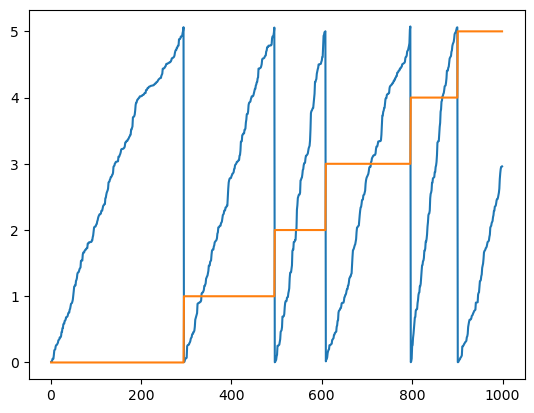

In [5]:
plt.plot(M.x[1:1000]*5/3e9)
plt.plot(M['ID'].cat.codes[1:1000])


In [35]:
def ClusterNearestNeighbors1D(x,xc=1000):
    m = [i for i, x1 in sorted(enumerate(x), key=lambda x1: x1[1])]
    xs = pd.Series(sorted(x))
    #print(x,m,xs)
    dx=xs.diff()
    dx[0]=1e6
    #print('dx',dx.to_list())
    k = [(dx1 > xc)*1 for dx1 in dx]
  
    c=np.cumsum([[1]+ k])
    #print('c',c)
    
    G = [0]*len(x)
    i = 0
    for m1 in m:
        G[m1]=c[i]
        i+=1
    return G

In [40]:
M['clustered']=[0]*M.shape[0]
ID = list(set(M['ID']))
#ID = ID[0:15]
for ID1 in ID:
    idx = M.loc[M['ID']==ID1].index
    idx0 = idx[0]
    x = M.iloc[idx]['x'].to_list()
    G=ClusterNearestNeighbors1D(x)
    c = [[x,G.count(x)] for x in set(G)]
    for G1 in set(G):
        n1 = G.count(G1)
        if n1>1:
            k = G.index(G1) 
            k = [i-1 for i, j in enumerate(G) if j == G1]
            ntum = len(set(M.iloc[k+idx0]['ID']))
            if ntum == 1:
                print(G1, n1, k)
                M.loc[k+idx0,'clustered']=1
                display(M.iloc[k+idx0])
                
        

11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100618,TOR3A,DLBCL11518_clustered,1,179051357,G,A,SNP,Missense_Mutation,DLBCL11518,6.0,...,ggg,86,C[C>T]C,0.0,1.000000,0.000000,1,179051358.0,DLBCL11518,1
100619,TOR3A,DLBCL11518,1,179051358,G,A,SNP,Missense_Mutation,DLBCL11518,6.0,...,gga,94,T[C>T]C,0.0,0.998162,0.001838,1,179051359.0,DLBCL11518,1


30 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100638,TRIML2,DLBCL11518_clustered,4,189012556,G,T,SNP,Missense_Mutation,DLBCL11518,25.0,...,gga,62,T[C>A]C,0.0,1.0,0.0,4,879784980.0,DLBCL11518,1
100639,TRIML2,DLBCL11518_clustered,4,189012647,G,A,SNP,Silent,DLBCL11518,32.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,4,879785071.0,DLBCL11518,1


35 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100644,PCDHB4,DLBCL11518_clustered,5,140502954,C,A,SNP,Missense_Mutation,DLBCL11518,4.0,...,tcg,63,T[C>A]G,0.000000,1.000000,0.0,5,1.022530e+09,DLBCL11518,1
100645,PCDHB4,DLBCL11518,5,140503753,T,G,SNP,Missense_Mutation,DLBCL11518,5.0,...,ctc,11,C[T>G]C,0.443319,0.556681,0.0,5,1.022530e+09,DLBCL11518,1


106 2 [107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100716,BRICD5,DLBCL11518_clustered,16,2259589,A,G,SNP,Missense_Mutation,DLBCL11518,18.0,...,cat,24,A[T>C]G,0.000000,1.000000,0.0,16,2.413577e+09,DLBCL11518,1
100717,BRICD5,DLBCL11518,16,2260538,A,G,SNP,Silent,DLBCL11518,22.0,...,gag,27,C[T>C]C,0.345023,0.654977,0.0,16,2.413578e+09,DLBCL11518,1


71 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152566,NLRP14,DLBCL_RICOVER_1269,11,7064028,T,A,SNP,Silent,DLBCL_RICOVER_1269,29.0,...,tta,45,T[T>A]A,5.026609e-01,0.497339,0.000000e+00,11,1.823972e+09,DLBCL_RICOVER_1269,1
152567,NLRP14,DLBCL_RICOVER_1269,11,7064793,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_1269,28.0,...,agt,52,A[C>A]T,1.949768e-25,1.000000,2.868283e-22,11,1.823973e+09,DLBCL_RICOVER_1269,1


98 3 [97, 98, 99]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152594,BCL2,DLBCL_RICOVER_1269,18,60985545,G,A,SNP,Silent,DLBCL_RICOVER_1269,20.0,...,agc,92,G[C>T]T,5.753497e-35,1.0,1.528347e-21,18,2.644053e+09,DLBCL_RICOVER_1269,1
152595,BCL2,DLBCL_RICOVER_1269_clustered,18,60985639,G,A,SNP,Silent,DLBCL_RICOVER_1269,14.0,...,ggc,90,G[C>T]C,0.000000e+00,0.0,1.000000e+00,18,2.644053e+09,DLBCL_RICOVER_1269,1
152596,BCL2,DLBCL_RICOVER_1269_clustered,18,60985760,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1269,8.0,...,gcc,90,G[C>T]C,0.000000e+00,0.0,1.000000e+00,18,2.644053e+09,DLBCL_RICOVER_1269,1


147 2 [145, 146]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71020,MCM4,DLBCL10994_clustered,8,48887374,C,T,SNP,Silent,DLBCL10994,47.0,...,gct,92,G[C>T]T,6.105174e-36,1.500000e-44,1.0,8,1.442383e+09,DLBCL10994,1
71021,MCM4,DLBCL10994,8,48888356,C,G,SNP,Missense_Mutation,DLBCL10994,24.0,...,cca,69,C[C>G]A,0.000000e+00,1.000000e+00,0.0,8,1.442384e+09,DLBCL10994,1


155 2 [154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71029,MYC,DLBCL10994_clustered,8,128748832,C,G,SNP,5'UTR,DLBCL10994,24.0,...,gct,76,G[C>G]T,1.223538e-02,8.000000e-45,0.987765,8,1.522245e+09,DLBCL10994,1
71030,MYC,DLBCL10994,8,128748849,T,G,SNP,Missense_Mutation,DLBCL10994,26.0,...,ttt,1,T[T>G]T,1.270853e-20,1.000000e+00,0.000000,8,1.522245e+09,DLBCL10994,1


206 2 [206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71081,PGR,DLBCL10994_clustered,11,100998501,G,C,SNP,Missense_Mutation,DLBCL10994,39.0,...,ggg,70,C[C>G]C,0.0,1.050000e-43,1.0,11,1.917906e+09,DLBCL10994,1
71082,PGR,DLBCL10994,11,100998525,G,A,SNP,Missense_Mutation,DLBCL10994,35.0,...,cgg,87,C[C>T]G,0.0,1.000000e+00,0.0,11,1.917906e+09,DLBCL10994,1


248 2 [249, 250]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71124,KIF26A,DLBCL10994_clustered,14,104639663,G,C,SNP,Intron,DLBCL10994,35.0,...,tgc,73,G[C>G]A,0.112111,2.400000e-44,8.878892e-01,14,2.305876e+09,DLBCL10994,1
71125,KIF26A,DLBCL10994,14,104639664,C,T,SNP,Intron,DLBCL10994,34.0,...,gca,89,G[C>T]A,0.000000,1.000000e+00,4.000000e-45,14,2.305876e+09,DLBCL10994,1


249 3 [251, 252, 253]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71126,IGHJ6,DLBCL10994_clustered,14,106330084,A,G,SNP,RNA,DLBCL10994,8.0,...,gac,26,G[T>C]C,1.000000e+00,4.570000e-43,0.000000,14,2.307566e+09,DLBCL10994,1
71127,IGHJ6,DLBCL10994_clustered,14,106330792,C,G,SNP,RNA,DLBCL10994,20.0,...,tct,80,T[C>G]T,4.201962e-11,5.900000e-44,1.000000,14,2.307567e+09,DLBCL10994,1
71128,IGHJ6,DLBCL10994_clustered,14,106331668,C,T,SNP,RNA,DLBCL10994,23.0,...,gcc,90,G[C>T]C,1.361256e-05,3.200000e-44,0.999986,14,2.307568e+09,DLBCL10994,1


6 2 [4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152616,AADACL3,DLBCL_RICOVER_1278_clustered,1,12780929,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1278,36.0,...,ctc,27,C[T>C]C,1.0,1.710606e-15,0.000000e+00,1,12780930.0,DLBCL_RICOVER_1278,1
152617,AADACL3,DLBCL_RICOVER_1278,1,12780930,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1278,36.0,...,tcc,62,T[C>A]C,0.0,1.000000e+00,1.000000e-45,1,12780931.0,DLBCL_RICOVER_1278,1


30 3 [29, 30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152641,ID2,DLBCL_RICOVER_1278_clustered,2,8822431,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1278,26.0,...,gct,76,G[C>G]T,0.007819,6.557971e-17,9.921806e-01,2,258173052.0,DLBCL_RICOVER_1278,1
152642,ID2,DLBCL_RICOVER_1278_clustered,2,8822450,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_1278,18.0,...,agc,60,G[C>A]T,0.024149,5.294990e-16,9.758509e-01,2,258173071.0,DLBCL_RICOVER_1278,1
152643,ID2,DLBCL_RICOVER_1278,2,8822466,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1278,14.0,...,aga,80,T[C>G]T,0.000000,1.000000e+00,3.000000e-45,2,258173087.0,DLBCL_RICOVER_1278,1


139 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152752,SGK223,DLBCL_RICOVER_1278_clustered,8,8234774,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1278,6.0,...,ccc,54,C[C>A]C,9.508089e-19,7.515111e-16,1.000000e+00,8,1.401730e+09,DLBCL_RICOVER_1278,1
152753,SGK223,DLBCL_RICOVER_1278,8,8234775,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1278,6.0,...,cct,56,C[C>A]T,0.000000e+00,1.000000e+00,1.000000e-45,8,1.401730e+09,DLBCL_RICOVER_1278,1


156 2 [158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152770,GRHPR,DLBCL_RICOVER_1278_clustered,9,37424926,C,G,SNP,Silent,DLBCL_RICOVER_1278,16.0,...,tct,80,T[C>G]T,2.673424e-11,4.716467e-16,1.000000e+00,9,1.577385e+09,DLBCL_RICOVER_1278,1
152771,GRHPR,DLBCL_RICOVER_1278,9,37424973,G,A,SNP,Splice_Site,DLBCL_RICOVER_1278,26.0,...,ggt,82,A[C>T]C,0.000000e+00,1.000000e+00,4.000000e-45,9,1.577385e+09,DLBCL_RICOVER_1278,1


157 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152772,GRHPR,DLBCL_RICOVER_1278_clustered,9,37426572,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1278,7.0,...,aga,80,T[C>G]T,2.673424e-11,4.716467e-16,1.000000e+00,9,1.577386e+09,DLBCL_RICOVER_1278,1
152773,GRHPR,DLBCL_RICOVER_1278,9,37426576,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1278,36.0,...,acc,50,A[C>A]C,0.000000e+00,1.000000e+00,1.000000e-45,9,1.577386e+09,DLBCL_RICOVER_1278,1


186 5 [190, 191, 192, 193, 194]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152802,MPEG1,DLBCL_RICOVER_1278_clustered,11,58978209,C,T,SNP,Silent,DLBCL_RICOVER_1278,51.0,...,gct,92,G[C>T]T,3.884308e-36,1.277676e-16,1.000000e+00,11,1.875886e+09,DLBCL_RICOVER_1278,1
152803,MPEG1,DLBCL_RICOVER_1278_clustered,11,58978400,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1278,51.0,...,cca,85,C[C>T]A,1.512997e-02,1.756863e-15,9.848700e-01,11,1.875886e+09,DLBCL_RICOVER_1278,1
152804,MPEG1,DLBCL_RICOVER_1278_clustered,11,58978483,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1278,92.0,...,tct,96,T[C>T]T,3.825205e-02,8.915070e-16,9.617479e-01,11,1.875886e+09,DLBCL_RICOVER_1278,1
152805,MPEG1,DLBCL_RICOVER_1278_clustered,11,58978980,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1278,6.0,...,gga,78,T[C>G]C,2.464922e-21,4.497855e-16,1.000000e+00,11,1.875887e+09,DLBCL_RICOVER_1278,1
152806,MPEG1,DLBCL_RICOVER_1278,11,58979663,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1278,24.0,...,agg,72,C[C>G]T,0.000000e+00,1.000000e+00,3.000000e-45,11,1.875888e+09,DLBCL_RICOVER_1278,1


103 5 [101, 102, 103, 104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132629,SGK1,DLBCL_C_D_1151_NULLPAIR_clustered,6,134495155,G,T,SNP,Missense_Mutation,DLBCL_C_D_1151_NULLPAIR,20.0,...,ggt,50,A[C>A]C,5.793453e-31,0.381197,6.188035e-01,6,1.197537e+09,DLBCL_C_D_1151_NULLPAIR,1
132630,SGK1,DLBCL_C_D_1151_NULLPAIR_clustered,6,134495648,C,T,SNP,Splice_Site,DLBCL_C_D_1151_NULLPAIR,4.0,...,act,84,A[C>T]T,0.000000e+00,0.183400,8.165997e-01,6,1.197538e+09,DLBCL_C_D_1151_NULLPAIR,1
132631,SGK1,DLBCL_C_D_1151_NULLPAIR_clustered,6,134495722,A,C,SNP,Missense_Mutation,DLBCL_C_D_1151_NULLPAIR,11.0,...,aaa,1,T[T>G]T,8.774855e-01,0.091049,3.146538e-02,6,1.197538e+09,DLBCL_C_D_1151_NULLPAIR,1
132632,SGK1,DLBCL_C_D_1151_NULLPAIR_clustered,6,134495881,G,T,SNP,Missense_Mutation,DLBCL_C_D_1151_NULLPAIR,31.0,...,tgc,57,G[C>A]A,0.000000e+00,0.375965,6.240350e-01,6,1.197538e+09,DLBCL_C_D_1151_NULLPAIR,1
132633,SGK1,DLBCL_C_D_1151_NULLPAIR,6,134495923,G,C,SNP,Missense_Mutation,DLBCL_C_D_1151_NULLPAIR,24.0,...,agc,76,G[C>G]T,6.812800e-02,0.931872,4.370338e-13,6,1.197538e+09,DLBCL_C_D_1151_NULLPAIR,1


170 3 [172, 173, 174]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132700,PTPN6,DLBCL_C_D_1151_NULLPAIR,12,7061239,G,T,SNP,Silent,DLBCL_C_D_1151_NULLPAIR,27.0,...,tgg,53,C[C>A]A,0.000000,1.000000,1.607877e-15,12,1.959076e+09,DLBCL_C_D_1151_NULLPAIR,1
132701,PTPN6,DLBCL_C_D_1151_NULLPAIR_clustered,12,7061244,A,T,SNP,Missense_Mutation,DLBCL_C_D_1151_NULLPAIR,27.0,...,gag,43,C[T>A]C,0.732176,0.267672,1.520195e-04,12,1.959076e+09,DLBCL_C_D_1151_NULLPAIR,1
132702,PTPN6,DLBCL_C_D_1151_NULLPAIR,12,7061330,A,C,SNP,Missense_Mutation,DLBCL_C_D_1151_NULLPAIR,18.0,...,cac,6,G[T>G]G,0.296431,0.703569,3.070000e-43,12,1.959076e+09,DLBCL_C_D_1151_NULLPAIR,1


248 2 [252, 253]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132780,AMOT,DLBCL_C_D_1151_NULLPAIR_clustered,X,112048276,C,G,SNP,Missense_Mutation,DLBCL_C_D_1151_NULLPAIR,88.0,...,gcc,74,G[C>G]C,0.218878,0.096869,6.842527e-01,23,2.995282e+09,DLBCL_C_D_1151_NULLPAIR,1
132781,AMOT,DLBCL_C_D_1151_NULLPAIR,X,112048286,T,G,SNP,Missense_Mutation,DLBCL_C_D_1151_NULLPAIR,89.0,...,ctt,3,C[T>G]T,0.215209,0.784791,3.114149e-15,23,2.995282e+09,DLBCL_C_D_1151_NULLPAIR,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107104,CHD1L,DLBCL11562_clustered,1,146727517,A,G,SNP,Missense_Mutation,DLBCL11562,29.0,...,aag,19,C[T>C]T,0.632175,0.367825,0.000000e+00,1,146727518.0,DLBCL11562,1
107105,CHD1L,DLBCL11562,1,146727560,A,T,SNP,Missense_Mutation,DLBCL11562,26.0,...,cat,40,A[T>A]G,0.188204,0.811796,1.000000e-45,1,146727561.0,DLBCL11562,1


99 3 [98, 99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107190,TGS1,DLBCL11562_clustered,8,56711529,A,G,SNP,Silent,DLBCL11562,5.0,...,aat,20,A[T>C]T,0.449273,0.408520,1.422075e-01,8,1.450207e+09,DLBCL11562,1
107191,TGS1,DLBCL11562_clustered,8,56711595,T,A,SNP,Silent,DLBCL11562,7.0,...,ctg,39,C[T>A]G,0.729926,0.270074,0.000000e+00,8,1.450207e+09,DLBCL11562,1
107192,TGS1,DLBCL11562,8,56711705,T,A,SNP,Nonsense_Mutation,DLBCL11562,6.0,...,ttg,37,T[T>A]G,0.094966,0.905034,3.000000e-45,8,1.450207e+09,DLBCL11562,1


151 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107244,FOXO1,DLBCL11562_clustered,13,41239772,C,T,SNP,Missense_Mutation,DLBCL11562,53.0,...,gct,92,G[C>T]T,6.356908e-36,0.064399,0.935601,13,2.127206e+09,DLBCL11562,1
107245,FOXO1,DLBCL11562_clustered,13,41240275,C,T,SNP,Nonsense_Mutation,DLBCL11562,18.0,...,gcc,90,G[C>T]C,1.319201e-05,0.129208,0.870779,13,2.127207e+09,DLBCL11562,1


190 2 [192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107284,CHRNB1,DLBCL11562_clustered,17,7350250,G,A,SNP,Silent,DLBCL11562,13.0,...,tgc,89,G[C>T]A,0.0,0.10942,0.89058,17,2.509122e+09,DLBCL11562,1
107285,CHRNB1,DLBCL11562,17,7350923,C,T,SNP,Silent,DLBCL11562,21.0,...,acg,83,A[C>T]G,0.0,1.00000,0.00000,17,2.509123e+09,DLBCL11562,1


229 2 [232, 233]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107324,IGLV3-1,DLBCL11562_clustered,22,23223522,G,A,SNP,RNA,DLBCL11562,11.0,...,ggc,90,G[C>T]C,1.319201e-05,0.129208,8.707787e-01,22,2.855052e+09,DLBCL11562,1
107325,IGLV3-1,DLBCL11562,22,23223545,C,A,SNP,RNA,DLBCL11562,9.0,...,act,52,A[C>A]T,3.704106e-26,1.000000,1.000000e-45,22,2.855052e+09,DLBCL11562,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76255,NOL9,DLBCL11194_clustered,1,6614240,T,A,SNP,Missense_Mutation,DLBCL11194,5.0,...,gtg,38,G[T>A]G,6.610954e-02,0.182407,7.514839e-01,1,6614241.0,DLBCL11194,1
76256,NOL9,DLBCL11194,1,6614544,G,A,SNP,Silent,DLBCL11194,4.0,...,agc,92,G[C>T]T,1.009161e-35,1.000000,7.000000e-45,1,6614545.0,DLBCL11194,1


5 3 [4, 5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76257,KLHL21,DLBCL11194_clustered,1,6662376,G,A,SNP,Silent,DLBCL11194,5.0,...,agc,92,G[C>T]T,5.672442e-37,0.024762,0.975238,1,6662377.0,DLBCL11194,1
76258,KLHL21,DLBCL11194_clustered,1,6662386,G,T,SNP,Missense_Mutation,DLBCL11194,5.0,...,cgt,51,A[C>A]G,0.000000e+00,0.276575,0.723425,1,6662387.0,DLBCL11194,1
76259,KLHL21,DLBCL11194,1,6662398,G,T,SNP,Missense_Mutation,DLBCL11194,13.0,...,tga,61,T[C>A]A,6.045665e-02,0.939543,0.000000,1,6662399.0,DLBCL11194,1


24 2 [25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76278,KCNA3,DLBCL11194_clustered,1,111216563,C,T,SNP,Missense_Mutation,DLBCL11194,60.0,...,gct,92,G[C>T]T,5.672442e-37,0.024762,0.975238,1,111216564.0,DLBCL11194,1
76279,KCNA3,DLBCL11194,1,111217228,A,G,SNP,Silent,DLBCL11194,5.0,...,cat,24,A[T>C]G,9.126192e-02,0.908738,0.000000,1,111217229.0,DLBCL11194,1


43 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76298,BTG2,DLBCL11194_clustered,1,203274876,G,T,SNP,Splice_Site,DLBCL11194,7.0,...,agg,56,C[C>A]T,4.101685e-05,0.157501,8.424575e-01,1,203274877.0,DLBCL11194,1
76299,BTG2,DLBCL11194,1,203274877,G,A,SNP,Splice_Site,DLBCL11194,16.0,...,ggt,82,A[C>T]C,5.080558e-30,1.000000,3.000000e-45,1,203274878.0,DLBCL11194,1


94 6 [97, 98, 99, 100, 101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76350,OSBPL10,DLBCL11194_clustered,3,32022391,C,T,SNP,Splice_Site,DLBCL11194,3.0,...,cct,88,C[C>T]T,0.000000e+00,0.111218,8.887823e-01,3,524672385.0,DLBCL11194,1
76351,OSBPL10,DLBCL11194_clustered,3,32022420,G,T,SNP,Nonsense_Mutation,DLBCL11194,9.0,...,tgt,49,A[C>A]A,8.373924e-06,0.274517,7.254748e-01,3,524672414.0,DLBCL11194,1
76352,OSBPL10,DLBCL11194_clustered,3,32022431,G,A,SNP,Missense_Mutation,DLBCL11194,4.0,...,agc,92,G[C>T]T,5.672442e-37,0.024762,9.752379e-01,3,524672425.0,DLBCL11194,1
76353,OSBPL10,DLBCL11194_clustered,3,32022573,G,A,SNP,Silent,DLBCL11194,3.0,...,agc,92,G[C>T]T,5.672442e-37,0.024762,9.752379e-01,3,524672567.0,DLBCL11194,1
76354,OSBPL10,DLBCL11194_clustered,3,32022576,G,A,SNP,Silent,DLBCL11194,3.0,...,agg,88,C[C>T]T,0.000000e+00,0.111218,8.887823e-01,3,524672570.0,DLBCL11194,1
76355,OSBPL10,DLBCL11194,3,32022619,C,T,SNP,Missense_Mutation,DLBCL11194,3.0,...,gct,92,G[C>T]T,1.009161e-35,1.000000,7.000000e-45,3,524672613.0,DLBCL11194,1


183 9 [191, 192, 193, 194, 195, 196, 197, 198, 199]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76444,PIM1,DLBCL11194_clustered,6,37138332,C,G,SNP,5'UTR,DLBCL11194,29.0,...,gcc,74,G[C>G]C,8.405634e-03,0.041940,9.496542e-01,6,1.100180e+09,DLBCL11194,1
76445,PIM1,DLBCL11194_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL11194,18.0,...,gcc,90,G[C>T]C,1.229598e-06,0.051895,9.481040e-01,6,1.100181e+09,DLBCL11194,1
76446,PIM1,DLBCL11194_clustered,6,37138577,G,T,SNP,Missense_Mutation,DLBCL11194,16.0,...,agt,52,A[C>A]T,9.251295e-27,0.119170,8.808296e-01,6,1.100181e+09,DLBCL11194,1
76447,PIM1,DLBCL11194_clustered,6,37138804,G,C,SNP,Missense_Mutation,DLBCL11194,31.0,...,agc,76,G[C>G]T,1.163463e-03,0.012950,9.858868e-01,6,1.100181e+09,DLBCL11194,1
76448,PIM1,DLBCL11194_clustered,6,37138901,C,T,SNP,Splice_Site,DLBCL11194,50.0,...,gcc,90,G[C>T]C,1.229598e-06,0.051895,9.481040e-01,6,1.100181e+09,DLBCL11194,1
76449,PIM1,DLBCL11194_clustered,6,37139097,G,A,SNP,Missense_Mutation,DLBCL11194,30.0,...,agc,92,G[C>T]T,5.672442e-37,0.024762,9.752379e-01,6,1.100181e+09,DLBCL11194,1
76450,PIM1,DLBCL11194_clustered,6,37139104,C,T,SNP,Silent,DLBCL11194,30.0,...,tct,96,T[C>T]T,5.004156e-03,0.154779,8.402172e-01,6,1.100181e+09,DLBCL11194,1
76451,PIM1,DLBCL11194_clustered,6,37139128,G,A,SNP,Silent,DLBCL11194,16.0,...,ggc,90,G[C>T]C,1.229598e-06,0.051895,9.481040e-01,6,1.100181e+09,DLBCL11194,1
76452,PIM1,DLBCL11194,6,37139209,G,C,SNP,Missense_Mutation,DLBCL11194,31.0,...,agc,76,G[C>G]T,3.807243e-02,0.961928,1.400000e-44,6,1.100181e+09,DLBCL11194,1


266 2 [282, 283]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76535,CALHM2,DLBCL11194_clustered,10,105209145,T,G,SNP,Splice_Site,DLBCL11194,10.0,...,ctg,7,C[T>G]G,0.370000,0.213490,4.165102e-01,10,1.786482e+09,DLBCL11194,1
76536,CALHM2,DLBCL11194,10,105209154,T,A,SNP,Missense_Mutation,DLBCL11194,10.0,...,ata,48,A[T>A]A,0.222366,0.777634,1.000000e-45,10,1.786482e+09,DLBCL11194,1


318 2 [335, 336]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76588,NUAK1,DLBCL11194_clustered,12,106460866,C,T,SNP,Missense_Mutation,DLBCL11194,53.0,...,gcg,91,G[C>T]G,4.236709e-35,1.0,0.000000e+00,12,2.058475e+09,DLBCL11194,1
76589,NUAK1,DLBCL11194,12,106460889,C,T,SNP,Silent,DLBCL11194,77.0,...,cct,88,C[C>T]T,0.000000e+00,1.0,1.000000e-45,12,2.058475e+09,DLBCL11194,1


348 3 [366, 367, 368]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76619,IGHV3-7,DLBCL11194_clustered,14,106518449,T,A,SNP,RNA,DLBCL11194,18.0,...,ttg,37,T[T>A]G,0.023924,0.108788,0.867289,14,2.307755e+09,DLBCL11194,1
76620,IGHV3-7,DLBCL11194_clustered,14,106518589,G,C,SNP,RNA,DLBCL11194,3.0,...,agc,76,G[C>G]T,0.001163,0.012950,0.985887,14,2.307755e+09,DLBCL11194,1
76621,IGHV3-7,DLBCL11194_clustered,14,106518610,G,A,SNP,RNA,DLBCL11194,17.0,...,agg,88,C[C>T]T,0.000000,0.111218,0.888782,14,2.307755e+09,DLBCL11194,1


470 8 [490, 491, 492, 493, 494, 495, 496, 497]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76743,IGLV3-1,DLBCL11194_clustered,22,23223266,C,T,SNP,RNA,DLBCL11194,11.0,...,tct,96,T[C>T]T,5.004156e-03,0.154779,8.402172e-01,22,2.855052e+09,DLBCL11194,1
76744,IGLV3-1,DLBCL11194_clustered,22,23223297,C,G,SNP,RNA,DLBCL11194,3.0,...,gct,76,G[C>G]T,1.163463e-03,0.012950,9.858868e-01,22,2.855052e+09,DLBCL11194,1
76745,IGLV3-1,DLBCL11194_clustered,22,23223343,G,C,SNP,RNA,DLBCL11194,8.0,...,agc,76,G[C>G]T,1.163463e-03,0.012950,9.858868e-01,22,2.855052e+09,DLBCL11194,1
76746,IGLV3-1,DLBCL11194_clustered,22,23223395,G,A,SNP,RNA,DLBCL11194,19.0,...,agc,92,G[C>T]T,5.672442e-37,0.024762,9.752379e-01,22,2.855052e+09,DLBCL11194,1
76747,IGLV3-1,DLBCL11194_clustered,22,23223488,G,C,SNP,RNA,DLBCL11194,17.0,...,gga,78,T[C>G]C,3.388191e-22,0.082050,9.179497e-01,22,2.855052e+09,DLBCL11194,1
76748,IGLV3-1,DLBCL11194_clustered,22,23223496,C,T,SNP,RNA,DLBCL11194,16.0,...,gcc,90,G[C>T]C,1.229598e-06,0.051895,9.481040e-01,22,2.855052e+09,DLBCL11194,1
76749,IGLV3-1,DLBCL11194_clustered,22,23223564,A,T,SNP,RNA,DLBCL11194,11.0,...,cag,39,C[T>A]G,3.854522e-01,0.614548,0.000000e+00,22,2.855052e+09,DLBCL11194,1
76750,IGLV3-1,DLBCL11194,22,23223565,G,T,SNP,RNA,DLBCL11194,11.0,...,agc,60,G[C>A]T,1.491342e-02,0.985087,1.000000e-45,22,2.855052e+09,DLBCL11194,1


471 3 [498, 499, 500]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76751,BCR,DLBCL11194_clustered,22,23523318,C,T,SNP,Silent,DLBCL11194,36.0,...,tct,96,T[C>T]T,0.005004,0.154779,0.840217,22,2.855352e+09,DLBCL11194,1
76752,BCR,DLBCL11194_clustered,22,23523322,C,T,SNP,Silent,DLBCL11194,33.0,...,cct,88,C[C>T]T,0.000000,0.111218,0.888782,22,2.855352e+09,DLBCL11194,1
76753,BCR,DLBCL11194,22,23523331,T,C,SNP,Silent,DLBCL11194,34.0,...,gtt,18,G[T>C]T,0.026047,0.973953,0.000000,22,2.855352e+09,DLBCL11194,1


30 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34789,ID2,DLBCL10845,2,8822403,A,C,SNP,Silent,DLBCL10845,77.0,...,tat,16,A[T>G]A,4.000000e-45,1.0,3.000000e-45,2,258173024.0,DLBCL10845,1
34790,ID2,DLBCL10845,2,8822469,G,A,SNP,Silent,DLBCL10845,50.0,...,agg,88,C[C>T]T,0.000000e+00,1.0,1.000000e-45,2,258173090.0,DLBCL10845,1


227 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34987,GLOD4,DLBCL10845_clustered,17,663467,T,A,SNP,Silent,DLBCL10845,6.0,...,ctg,39,C[T>A]G,3.110000e-43,1.0,0.000000e+00,17,2.502435e+09,DLBCL10845,1
34988,GLOD4,DLBCL10845,17,663468,G,T,SNP,Missense_Mutation,DLBCL10845,6.0,...,tgc,57,G[C>A]A,0.000000e+00,1.0,1.000000e-45,17,2.502435e+09,DLBCL10845,1


286 3 [286, 287, 288]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35047,IGLV3-1,DLBCL10845_clustered,22,23223428,C,T,SNP,RNA,DLBCL10845,57.0,...,tct,96,T[C>T]T,2.500000e-44,1.0,7.700000e-44,22,2.855052e+09,DLBCL10845,1
35048,IGLV3-1,DLBCL10845_clustered,22,23223432,C,G,SNP,RNA,DLBCL10845,23.0,...,tca,77,T[C>G]A,0.000000e+00,1.0,0.000000e+00,22,2.855052e+09,DLBCL10845,1
35049,IGLV3-1,DLBCL10845,22,23223440,C,T,SNP,RNA,DLBCL10845,59.0,...,gca,89,G[C>T]A,0.000000e+00,1.0,6.000000e-45,22,2.855052e+09,DLBCL10845,1


29 2 [27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48356,ID2,DLBCL10901_clustered,2,8822430,G,A,SNP,Silent,DLBCL10901,90.0,...,agc,92,G[C>T]T,0.000000,0.015665,9.843352e-01,2,258173051.0,DLBCL10901,1
48357,ID2,DLBCL10901,2,8822476,A,T,SNP,Nonsense_Mutation,DLBCL10901,55.0,...,caa,37,T[T>A]G,0.037706,0.962294,1.000000e-45,2,258173097.0,DLBCL10901,1


39 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48367,KCMF1,DLBCL10901_clustered,2,85255073,T,A,SNP,Silent,DLBCL10901,22.0,...,ttt,33,T[T>A]T,0.000000,0.037474,9.625256e-01,2,334605694.0,DLBCL10901,1
48368,KCMF1,DLBCL10901,2,85255074,T,A,SNP,Missense_Mutation,DLBCL10901,22.0,...,ttg,37,T[T>A]G,0.037706,0.962294,1.000000e-45,2,334605695.0,DLBCL10901,1


56 3 [56, 57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48385,OSBPL10,DLBCL10901_clustered,3,32022588,G,A,SNP,Silent,DLBCL10901,7.0,...,agc,92,G[C>T]T,0.000000e+00,0.015665,9.843352e-01,3,524672582.0,DLBCL10901,1
48386,OSBPL10,DLBCL10901_clustered,3,32022597,G,C,SNP,Silent,DLBCL10901,7.0,...,agg,72,C[C>G]T,0.000000e+00,0.044728,9.552721e-01,3,524672591.0,DLBCL10901,1
48387,OSBPL10,DLBCL10901,3,32022625,C,T,SNP,Missense_Mutation,DLBCL10901,5.0,...,gct,92,G[C>T]T,4.081639e-36,1.000000,8.000000e-45,3,524672619.0,DLBCL10901,1


107 6 [109, 110, 111, 112, 113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48438,PIM1,DLBCL10901_clustered,6,37138749,G,A,SNP,Intron,DLBCL10901,51.0,...,ggc,90,G[C>T]C,0.000000e+00,0.033168,9.668317e-01,6,1.100181e+09,DLBCL10901,1
48439,PIM1,DLBCL10901_clustered,6,37138901,C,T,SNP,Splice_Site,DLBCL10901,50.0,...,gcc,90,G[C>T]C,0.000000e+00,0.033168,9.668317e-01,6,1.100181e+09,DLBCL10901,1
48440,PIM1,DLBCL10901_clustered,6,37138951,C,T,SNP,Silent,DLBCL10901,64.0,...,gct,92,G[C>T]T,0.000000e+00,0.015665,9.843352e-01,6,1.100181e+09,DLBCL10901,1
48441,PIM1,DLBCL10901_clustered,6,37139030,G,A,SNP,Missense_Mutation,DLBCL10901,18.0,...,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000e+00,6,1.100181e+09,DLBCL10901,1
48442,PIM1,DLBCL10901_clustered,6,37139063,G,C,SNP,Missense_Mutation,DLBCL10901,82.0,...,gga,78,T[C>G]C,0.000000e+00,0.053051,9.469491e-01,6,1.100181e+09,DLBCL10901,1
48443,PIM1,DLBCL10901,6,37139209,G,A,SNP,Silent,DLBCL10901,70.0,...,agc,92,G[C>T]T,4.081639e-36,1.000000,8.000000e-45,6,1.100181e+09,DLBCL10901,1


112 2 [119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48448,LGSN,DLBCL10901_clustered,6,63991125,C,A,SNP,Splice_Site,DLBCL10901,18.0,...,tcc,62,T[C>A]C,0.000000,0.104313,8.956867e-01,6,1.127033e+09,DLBCL10901,1
48449,LGSN,DLBCL10901,6,63991126,C,A,SNP,Splice_Site,DLBCL10901,18.0,...,cct,56,C[C>A]T,0.000046,0.999954,1.000000e-45,6,1.127033e+09,DLBCL10901,1


161 5 [169, 170, 171, 172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48498,GRHPR,DLBCL10901_clustered,9,37424842,C,T,SNP,Splice_Site,DLBCL10901,14.0,...,gct,92,G[C>T]T,0.0,0.015665,9.843352e-01,9,1.577385e+09,DLBCL10901,1
48499,GRHPR,DLBCL10901_clustered,9,37424883,C,G,SNP,Missense_Mutation,DLBCL10901,17.0,...,gcc,74,G[C>G]C,0.0,0.026935,9.730653e-01,9,1.577385e+09,DLBCL10901,1
48500,GRHPR,DLBCL10901_clustered,9,37424891,C,G,SNP,Missense_Mutation,DLBCL10901,13.0,...,gct,76,G[C>G]T,0.0,0.008165,9.918346e-01,9,1.577385e+09,DLBCL10901,1
48501,GRHPR,DLBCL10901_clustered,9,37424973,G,A,SNP,Splice_Site,DLBCL10901,13.0,...,ggt,82,A[C>T]C,0.0,0.038557,9.614428e-01,9,1.577385e+09,DLBCL10901,1
48502,GRHPR,DLBCL10901,9,37424976,C,T,SNP,Intron,DLBCL10901,11.0,...,gca,89,G[C>T]A,0.0,1.000000,4.000000e-45,9,1.577385e+09,DLBCL10901,1


164 2 [176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48505,WNK2,DLBCL10901_clustered,9,96031183,G,A,SNP,Silent,DLBCL10901,32.0,...,tgt,81,A[C>T]A,0.000000,0.110508,0.889492,9,1.635991e+09,DLBCL10901,1
48506,WNK2,DLBCL10901,9,96031220,A,G,SNP,Missense_Mutation,DLBCL10901,25.0,...,aaa,17,T[T>C]T,0.044526,0.955474,0.000000,9,1.635991e+09,DLBCL10901,1


235 2 [248, 249]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48577,IRS2,DLBCL10901_clustered,13,110437549,G,C,SNP,Missense_Mutation,DLBCL10901,37.0,...,cgt,67,A[C>G]G,0.0,0.174747,0.825253,13,2.196404e+09,DLBCL10901,1
48578,IRS2,DLBCL10901,13,110438371,G,C,SNP,Silent,DLBCL10901,4.0,...,cgg,71,C[C>G]G,0.0,1.000000,0.000000,13,2.196405e+09,DLBCL10901,1


250 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48593,IGHJ6,DLBCL10901_clustered,14,106330796,C,T,SNP,RNA,DLBCL10901,16.0,...,acc,82,A[C>T]C,0.0,0.038557,0.961443,14,2.307567e+09,DLBCL10901,1
48594,IGHJ6,DLBCL10901_clustered,14,106330841,G,C,SNP,RNA,DLBCL10901,8.0,...,agc,76,G[C>G]T,0.0,0.008165,0.991835,14,2.307567e+09,DLBCL10901,1


266 2 [281, 282]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48610,NSMCE1,DLBCL10901_clustered,16,27237044,C,T,SNP,Intron,DLBCL10901,19.0,...,gca,89,G[C>T]A,0.0,0.027622,9.723784e-01,16,2.438554e+09,DLBCL10901,1
48611,NSMCE1,DLBCL10901,16,27237046,C,T,SNP,Splice_Site,DLBCL10901,19.0,...,act,84,A[C>T]T,0.0,1.000000,3.000000e-45,16,2.438554e+09,DLBCL10901,1


307 2 [323, 324]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48652,ZNF562,DLBCL10901_clustered,19,9764183,G,A,SNP,Silent,DLBCL10901,66.0,...,tga,93,T[C>T]A,0.000000,0.146840,0.85316,19,2.671009e+09,DLBCL10901,1
48653,ZNF562,DLBCL10901,19,9764316,A,T,SNP,Missense_Mutation,DLBCL10901,69.0,...,aat,36,A[T>A]T,0.100286,0.899714,0.00000,19,2.671009e+09,DLBCL10901,1


338 2 [355, 356]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48684,FAM83D,DLBCL10901_clustered,20,37555487,C,T,SNP,Silent,DLBCL10901,25.0,...,act,84,A[C>T]T,0.0,0.042066,9.579342e-01,20,2.758029e+09,DLBCL10901,1
48685,FAM83D,DLBCL10901,20,37555490,C,T,SNP,Silent,DLBCL10901,22.0,...,tcc,94,T[C>T]C,0.0,1.000000,1.000000e-45,20,2.758029e+09,DLBCL10901,1


349 3 [367, 368, 369]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48696,IGLL5,DLBCL10901_clustered,22,23235947,C,G,SNP,Missense_Mutation,DLBCL10901,55.0,...,gcc,74,G[C>G]C,0.000000e+00,0.026935,9.730653e-01,22,2.855065e+09,DLBCL10901,1
48697,IGLL5,DLBCL10901_clustered,22,23235956,C,T,SNP,Silent,DLBCL10901,53.0,...,act,84,A[C>T]T,0.000000e+00,0.042066,9.579342e-01,22,2.855065e+09,DLBCL10901,1
48698,IGLL5,DLBCL10901,22,23236007,C,T,SNP,Intron,DLBCL10901,47.0,...,gct,92,G[C>T]T,4.081639e-36,1.000000,8.000000e-45,22,2.855065e+09,DLBCL10901,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86909,RLF,DLBCL11457_clustered,1,40703690,A,T,SNP,Missense_Mutation,DLBCL11457,73.0,...,taa,45,T[T>A]A,0.555976,0.444024,0.0,1,40703691.0,DLBCL11457,1
86910,RLF,DLBCL11457,1,40704182,G,T,SNP,Missense_Mutation,DLBCL11457,72.0,...,tga,61,T[C>A]A,0.040509,0.959491,0.0,1,40704183.0,DLBCL11457,1


36 3 [35, 36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86933,BTG2,DLBCL11457_clustered,1,203274759,A,G,SNP,Missense_Mutation,DLBCL11457,39.0,...,cat,24,A[T>C]G,0.396904,0.559547,4.354950e-02,1,203274760.0,DLBCL11457,1
86934,BTG2,DLBCL11457_clustered,1,203274876,G,T,SNP,Splice_Site,DLBCL11457,14.0,...,agg,56,C[C>A]T,0.000628,0.775394,2.239774e-01,1,203274877.0,DLBCL11457,1
86935,BTG2,DLBCL11457,1,203274882,C,G,SNP,Intron,DLBCL11457,15.0,...,gcg,75,G[C>G]G,0.000000,1.000000,1.000000e-45,1,203274883.0,DLBCL11457,1


42 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86941,HNRNPU,DLBCL11457_clustered,1,245022590,A,G,SNP,Silent,DLBCL11457,52.0,...,cac,22,G[T>C]G,0.251905,0.748095,0.000000,1,245022591.0,DLBCL11457,1
86942,HNRNPU,DLBCL11457_clustered,1,245022646,A,C,SNP,Missense_Mutation,DLBCL11457,38.0,...,tat,16,A[T>G]A,0.667484,0.262812,0.069704,1,245022647.0,DLBCL11457,1


102 2 [104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87002,HIST1H2BC,DLBCL11457_clustered,6,26123762,C,T,SNP,Missense_Mutation,DLBCL11457,187.0,...,gct,92,G[C>T]T,2.279546e-35,0.319808,6.801918e-01,6,1.089166e+09,DLBCL11457,1
87003,HIST1H2BC,DLBCL11457,6,26124028,C,A,SNP,Missense_Mutation,DLBCL11457,52.0,...,cct,56,C[C>A]T,7.526654e-05,0.999925,1.000000e-45,6,1.089166e+09,DLBCL11457,1


108 2 [111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87009,PIM1,DLBCL11457_clustered,6,37138411,G,T,SNP,Silent,DLBCL11457,47.0,...,tgc,57,G[C>A]A,0.000000e+00,0.776801,2.231991e-01,6,1.100180e+09,DLBCL11457,1
87010,PIM1,DLBCL11457,6,37139098,C,T,SNP,Silent,DLBCL11457,72.0,...,gct,92,G[C>T]T,6.621248e-36,1.000000,8.000000e-45,6,1.100181e+09,DLBCL11457,1


118 3 [122, 123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87020,SGK1,DLBCL11457_clustered,6,134495675,A,G,SNP,Silent,DLBCL11457,11.0,...,caa,21,T[T>C]G,3.987656e-01,0.601234,2.298219e-11,6,1.197538e+09,DLBCL11457,1
87021,SGK1,DLBCL11457_clustered,6,134495714,C,A,SNP,Missense_Mutation,DLBCL11457,9.0,...,gct,60,G[C>A]T,6.650940e-02,0.621988,3.115031e-01,6,1.197538e+09,DLBCL11457,1
87022,SGK1,DLBCL11457,6,134495724,G,A,SNP,Splice_Site,DLBCL11457,39.0,...,agc,92,G[C>T]T,6.621248e-36,1.000000,8.000000e-45,6,1.197538e+09,DLBCL11457,1


125 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87029,GLI3,DLBCL11457_clustered,7,42005770,G,A,SNP,Silent,DLBCL11457,14.0,...,cgc,91,G[C>T]G,1.318270e-34,1.0,0.000000e+00,7,1.276263e+09,DLBCL11457,1
87030,GLI3,DLBCL11457,7,42005781,G,A,SNP,Missense_Mutation,DLBCL11457,13.0,...,agg,88,C[C>T]T,0.000000e+00,1.0,1.000000e-45,7,1.276263e+09,DLBCL11457,1


131 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87036,LRRN3,DLBCL11457_clustered,7,110763522,T,C,SNP,Silent,DLBCL11457,34.0,...,ctt,19,C[T>C]T,0.553782,0.446218,0.0,7,1.345021e+09,DLBCL11457,1
87037,LRRN3,DLBCL11457,7,110763585,C,T,SNP,Missense_Mutation,DLBCL11457,27.0,...,cca,85,C[C>T]A,0.001872,0.998128,0.0,7,1.345021e+09,DLBCL11457,1


138 3 [146, 147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87044,DOK2,DLBCL11457_clustered,8,21767324,T,C,SNP,Missense_Mutation,DLBCL11457,30.0,...,ctt,19,C[T>C]T,0.553782,0.446218,0.0,8,1.415263e+09,DLBCL11457,1
87045,DOK2,DLBCL11457_clustered,8,21767363,T,C,SNP,Missense_Mutation,DLBCL11457,47.0,...,ctc,27,C[T>C]C,0.578169,0.421831,0.0,8,1.415263e+09,DLBCL11457,1
87046,DOK2,DLBCL11457,8,21767422,T,A,SNP,Silent,DLBCL11457,36.0,...,ctg,39,C[T>A]G,0.153467,0.846533,0.0,8,1.415263e+09,DLBCL11457,1


193 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87101,KMT2D,DLBCL11457_clustered,12,49420207,C,T,SNP,Missense_Mutation,DLBCL11457,63.0,...,ccc,86,C[C>T]C,6.870204e-34,0.808515,0.191485,12,2.001435e+09,DLBCL11457,1
87102,KMT2D,DLBCL11457,12,49420257,T,G,SNP,Missense_Mutation,DLBCL11457,67.0,...,ttt,1,T[T>G]T,1.981287e-01,0.801871,0.000000,12,2.001435e+09,DLBCL11457,1


196 2 [207, 208]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87105,ESPL1,DLBCL11457_clustered,12,53675324,C,T,SNP,Missense_Mutation,DLBCL11457,23.0,...,gca,89,G[C>T]A,0.000000,0.456299,0.543701,12,2.005690e+09,DLBCL11457,1
87106,ESPL1,DLBCL11457,12,53675325,A,G,SNP,Missense_Mutation,DLBCL11457,22.0,...,cat,24,A[T>C]G,0.061818,0.938182,0.000000,12,2.005690e+09,DLBCL11457,1


204 3 [216, 217, 218]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87114,DTX1,DLBCL11457_clustered,12,113496129,G,T,SNP,Silent,DLBCL11457,24.0,...,tgt,49,A[C>A]A,0.000083,0.875036,0.124881,12,2.065511e+09,DLBCL11457,1
87115,DTX1,DLBCL11457_clustered,12,113496235,C,T,SNP,Missense_Mutation,DLBCL11457,16.0,...,gca,89,G[C>T]A,0.000000,0.456299,0.543701,12,2.065511e+09,DLBCL11457,1
87116,DTX1,DLBCL11457,12,113496258,T,C,SNP,Splice_Site,DLBCL11457,14.0,...,gtg,22,G[T>C]G,0.030331,0.969669,0.000000,12,2.065511e+09,DLBCL11457,1


209 2 [223, 224]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87121,TDRD3,DLBCL11457_clustered,13,61084806,A,G,SNP,Missense_Mutation,DLBCL11457,30.0,...,gag,27,C[T>C]C,0.578169,0.421831,0.000000e+00,13,2.147051e+09,DLBCL11457,1
87122,TDRD3,DLBCL11457,13,61084807,G,A,SNP,Silent,DLBCL11457,30.0,...,agg,88,C[C>T]T,0.000000,1.000000,1.000000e-45,13,2.147051e+09,DLBCL11457,1


242 3 [257, 258, 259]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87155,SOCS1,DLBCL11457_clustered,16,11348944,T,G,SNP,Missense_Mutation,DLBCL11457,54.0,...,ctg,7,C[T>G]G,0.829892,0.153894,0.016214,16,2.422666e+09,DLBCL11457,1
87156,SOCS1,DLBCL11457_clustered,16,11348961,G,T,SNP,Missense_Mutation,DLBCL11457,12.0,...,tgc,57,G[C>A]A,0.000000,0.776801,0.223199,16,2.422666e+09,DLBCL11457,1
87157,SOCS1,DLBCL11457,16,11349192,C,G,SNP,Silent,DLBCL11457,30.0,...,ccg,71,C[C>G]G,0.000000,1.000000,0.000000,16,2.422666e+09,DLBCL11457,1


259 3 [276, 277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87174,GJD3,DLBCL11457_clustered,17,38519483,G,T,SNP,Missense_Mutation,DLBCL11457,23.0,...,cga,63,T[C>A]G,5.377816e-39,1.000000,0.000000e+00,17,2.540291e+09,DLBCL11457,1
87175,GJD3,DLBCL11457_clustered,17,38519545,G,A,SNP,Missense_Mutation,DLBCL11457,10.0,...,tgc,89,G[C>T]A,0.000000e+00,0.456299,5.437011e-01,17,2.540291e+09,DLBCL11457,1
87176,GJD3,DLBCL11457,17,38519546,C,G,SNP,Silent,DLBCL11457,10.0,...,gcg,75,G[C>G]G,0.000000e+00,1.000000,1.000000e-45,17,2.540291e+09,DLBCL11457,1


275 2 [294, 295]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87192,CD70,DLBCL11457_clustered,19,6586078,G,A,SNP,Nonsense_Mutation,DLBCL11457,22.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,19,2.667830e+09,DLBCL11457,1
87193,CD70,DLBCL11457,19,6586201,G,A,SNP,Missense_Mutation,DLBCL11457,17.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,19,2.667831e+09,DLBCL11457,1


277 8 [297, 298, 299, 300, 301, 302, 303, 304]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87195,KLF2,DLBCL11457_clustered,19,16435810,G,A,SNP,Splice_Site,DLBCL11457,17.0,...,ggt,82,A[C>T]C,1.946029e-29,0.542300,4.577000e-01,19,2.677680e+09,DLBCL11457,1
87196,KLF2,DLBCL11457_clustered,19,16436075,A,G,SNP,Missense_Mutation,DLBCL11457,24.0,...,caa,21,T[T>C]G,3.987656e-01,0.601234,2.298219e-11,19,2.677680e+09,DLBCL11457,1
87197,KLF2,DLBCL11457_clustered,19,16436234,C,G,SNP,Missense_Mutation,DLBCL11457,12.0,...,gct,76,G[C>G]T,5.185678e-02,0.185498,7.626454e-01,19,2.677681e+09,DLBCL11457,1
87198,KLF2,DLBCL11457_clustered,19,16436286,T,C,SNP,Missense_Mutation,DLBCL11457,5.0,...,ttt,17,T[T>C]T,4.486717e-01,0.551328,0.000000e+00,19,2.677681e+09,DLBCL11457,1
87199,KLF2,DLBCL11457_clustered,19,16436393,A,G,SNP,Missense_Mutation,DLBCL11457,5.0,...,caa,21,T[T>C]G,3.987656e-01,0.601234,2.298219e-11,19,2.677681e+09,DLBCL11457,1
87200,KLF2,DLBCL11457_clustered,19,16436813,C,A,SNP,Missense_Mutation,DLBCL11457,26.0,...,gca,57,G[C>A]A,0.000000e+00,0.776801,2.231991e-01,19,2.677681e+09,DLBCL11457,1
87201,KLF2,DLBCL11457_clustered,19,16437728,G,A,SNP,Silent,DLBCL11457,37.0,...,agc,92,G[C>T]T,2.279546e-35,0.319808,6.801918e-01,19,2.677682e+09,DLBCL11457,1
87202,KLF2,DLBCL11457,19,16437829,A,G,SNP,Missense_Mutation,DLBCL11457,19.0,...,aaa,17,T[T>C]T,7.028303e-02,0.929717,0.000000e+00,19,2.677682e+09,DLBCL11457,1


303 4 [330, 331, 332, 333]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87228,IGLV7-46,DLBCL11457_clustered,22,22724144,G,C,SNP,RNA,DLBCL11457,29.0,...,tgt,65,A[C>G]A,1.363008e-01,0.641373,2.223263e-01,22,2.854553e+09,DLBCL11457,1
87229,IGLV7-46,DLBCL11457_clustered,22,22724256,G,A,SNP,RNA,DLBCL11457,19.0,...,ggt,82,A[C>T]C,1.946029e-29,0.542300,4.577000e-01,22,2.854553e+09,DLBCL11457,1
87230,IGLV7-46,DLBCL11457_clustered,22,22724323,C,T,SNP,RNA,DLBCL11457,25.0,...,gca,89,G[C>T]A,0.000000e+00,0.456299,5.437011e-01,22,2.854553e+09,DLBCL11457,1
87231,IGLV7-46,DLBCL11457,22,22724350,G,A,SNP,RNA,DLBCL11457,28.0,...,ggt,82,A[C>T]C,3.333427e-30,1.000000,3.000000e-45,22,2.854553e+09,DLBCL11457,1


304 2 [334, 335]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87232,IGLV5-45,DLBCL11457_clustered,22,22730599,T,G,SNP,RNA,DLBCL11457,24.0,...,atc,12,A[T>G]C,0.693769,0.306231,1.041230e-40,22,2.854559e+09,DLBCL11457,1
87233,IGLV5-45,DLBCL11457,22,22730859,G,A,SNP,RNA,DLBCL11457,5.0,...,ggc,90,G[C>T]C,0.000007,0.999993,4.000000e-45,22,2.854560e+09,DLBCL11457,1


312 3 [343, 344, 345]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87241,TMSB4X,DLBCL11457_clustered,X,12994452,A,G,SNP,Silent,DLBCL11457,3.0,...,aag,19,C[T>C]T,0.553782,0.446218,0.000000e+00,23,2.896228e+09,DLBCL11457,1
87242,TMSB4X,DLBCL11457_clustered,X,12994464,A,C,SNP,Silent,DLBCL11457,6.0,...,cac,6,G[T>G]G,0.617015,0.382985,1.464820e-30,23,2.896228e+09,DLBCL11457,1
87243,TMSB4X,DLBCL11457,X,12994485,G,C,SNP,Intron,DLBCL11457,7.0,...,agc,76,G[C>G]T,0.025311,0.974689,1.700000e-44,23,2.896228e+09,DLBCL11457,1


14 4 [12, 13, 14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145022,BCL10,DLBCL_MC_F300_TBF_clustered,1,85733406,A,T,SNP,Silent,DLBCL_MC_F300_TBF,16.0,...,aag,35,C[T>A]T,9.946909e-01,0.0,5.309080e-03,1,85733407.0,DLBCL_MC_F300_TBF,1
145023,BCL10,DLBCL_MC_F300_TBF_clustered,1,85733442,A,C,SNP,Silent,DLBCL_MC_F300_TBF,18.0,...,tag,15,C[T>G]A,9.824767e-01,0.0,1.752322e-02,1,85733443.0,DLBCL_MC_F300_TBF,1
145024,BCL10,DLBCL_MC_F300_TBF_clustered,1,85733491,A,T,SNP,Nonsense_Mutation,DLBCL_MC_F300_TBF,23.0,...,caa,37,T[T>A]G,9.018319e-01,0.0,9.816815e-02,1,85733492.0,DLBCL_MC_F300_TBF,1
145025,BCL10,DLBCL_MC_F300_TBF,1,85733560,G,T,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,27.0,...,agt,52,A[C>A]T,5.568304e-26,1.0,1.000000e-45,1,85733561.0,DLBCL_MC_F300_TBF,1


27 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145038,HNRNPU,DLBCL_MC_F300_TBF_clustered,1,245022583,A,G,SNP,Silent,DLBCL_MC_F300_TBF,14.0,...,aac,18,G[T>C]T,0.963480,0.0,0.036520,1,245022584.0,DLBCL_MC_F300_TBF,1
145039,HNRNPU,DLBCL_MC_F300_TBF_clustered,1,245022644,A,C,SNP,Nonsense_Mutation,DLBCL_MC_F300_TBF,13.0,...,tat,16,A[T>G]A,0.982254,0.0,0.017746,1,245022645.0,DLBCL_MC_F300_TBF,1


93 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145105,HLA-DMB,DLBCL_MC_F300_TBF_clustered,6,32905050,T,G,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,30.0,...,gta,14,G[T>G]A,0.909141,0.000000,9.085941e-02,6,1.095947e+09,DLBCL_MC_F300_TBF,1
145106,HLA-DMB,DLBCL_MC_F300_TBF,6,32905132,T,A,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,46.0,...,ata,48,A[T>A]A,0.317681,0.682319,1.000000e-45,6,1.095947e+09,DLBCL_MC_F300_TBF,1


113 2 [116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145126,SLC26A7,DLBCL_MC_F300_TBF_clustered,8,92365199,A,T,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,25.0,...,tat,48,A[T>A]A,0.939322,0.000000,6.067798e-02,8,1.485861e+09,DLBCL_MC_F300_TBF,1
145127,SLC26A7,DLBCL_MC_F300_TBF,8,92365220,A,T,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,20.0,...,gat,44,A[T>A]C,0.275875,0.724125,3.000000e-45,8,1.485861e+09,DLBCL_MC_F300_TBF,1


114 2 [118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145128,SYBU,DLBCL_MC_F300_TBF_clustered,8,110592076,C,T,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,40.0,...,act,84,A[C>T]T,0.000000,0.000000,1.0,8,1.504088e+09,DLBCL_MC_F300_TBF,1
145129,SYBU,DLBCL_MC_F300_TBF,8,110592080,T,A,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,37.0,...,ctt,35,C[T>A]T,0.133534,0.866466,0.0,8,1.504088e+09,DLBCL_MC_F300_TBF,1


233 4 [238, 239, 240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145248,P2RY8,DLBCL_MC_F300_TBF,X,1585093,T,C,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,5.0,...,ctc,27,C[T>C]C,0.240097,0.759903,0.000000e+00,23,2.884818e+09,DLBCL_MC_F300_TBF,1
145249,P2RY8,DLBCL_MC_F300_TBF_clustered,X,1585305,G,C,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,6.0,...,ggc,74,G[C>G]C,0.746692,0.000000,2.533082e-01,23,2.884819e+09,DLBCL_MC_F300_TBF,1
145250,P2RY8,DLBCL_MC_F300_TBF_clustered,X,1585307,A,C,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,6.0,...,cac,6,G[T>G]G,1.000000,0.000000,4.107321e-31,23,2.884819e+09,DLBCL_MC_F300_TBF,1
145251,P2RY8,DLBCL_MC_F300_TBF,X,1585309,A,C,SNP,Missense_Mutation,DLBCL_MC_F300_TBF,5.0,...,cag,7,C[T>G]G,0.554192,0.445808,0.000000e+00,23,2.884819e+09,DLBCL_MC_F300_TBF,1


27 2 [25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19292,PIM1,DLBCL10517_clustered,6,37139210,C,T,SNP,Missense_Mutation,DLBCL10517,11.0,...,gct,92,G[C>T]T,7.233216e-36,0.0,1.000000e+00,6,1.100181e+09,DLBCL10517,1
19293,PIM1,DLBCL10517,6,37139242,G,T,SNP,Missense_Mutation,DLBCL10517,11.0,...,agg,56,C[C>A]T,0.000000e+00,1.0,3.000000e-45,6,1.100181e+09,DLBCL10517,1


61 3 [60, 61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19327,BCL2,DLBCL10517_clustered,18,60985471,G,A,SNP,Silent,DLBCL10517,35.0,...,agt,84,A[C>T]T,0.000000,0.0,1.000000,18,2.644053e+09,DLBCL10517,1
19328,BCL2,DLBCL10517_clustered,18,60985508,G,T,SNP,Missense_Mutation,DLBCL10517,32.0,...,ggc,58,G[C>A]C,0.018437,0.0,0.981563,18,2.644053e+09,DLBCL10517,1
19329,BCL2,DLBCL10517_clustered,18,60985760,C,T,SNP,Missense_Mutation,DLBCL10517,10.0,...,gcc,90,G[C>T]C,0.000016,0.0,0.999984,18,2.644053e+09,DLBCL10517,1


67 3 [68, 69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19335,IGLV3-1,DLBCL10517,22,23223266,C,G,SNP,RNA,DLBCL10517,17.0,...,tct,80,T[C>G]T,0.000000,1.0,6.000000e-45,22,2.855052e+09,DLBCL10517,1
19336,IGLV3-1,DLBCL10517_clustered,22,23223364,A,C,SNP,RNA,DLBCL10517,19.0,...,aaa,1,T[T>G]T,0.905626,0.0,9.437377e-02,22,2.855052e+09,DLBCL10517,1
19337,IGLV3-1,DLBCL10517,22,23223413,C,T,SNP,RNA,DLBCL10517,12.0,...,ccc,86,C[C>T]C,0.000000,1.0,1.000000e-45,22,2.855052e+09,DLBCL10517,1


47 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71551,MYD88,DLBCL10997_clustered,3,38181908,A,G,SNP,Missense_Mutation,DLBCL10997,5.0,...,cat,24,A[T>C]G,4.610000e-43,0.850809,1.491905e-01,3,530831902.0,DLBCL10997,1
71552,MYD88,DLBCL10997,3,38182292,G,A,SNP,Missense_Mutation,DLBCL10997,46.0,...,agc,92,G[C>T]T,0.000000e+00,1.000000,8.000000e-45,3,530832286.0,DLBCL10997,1


151 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71656,ACAD8,DLBCL10997_clustered,11,134127016,C,G,SNP,Missense_Mutation,DLBCL10997,14.0,...,gcc,74,G[C>G]C,1.330000e-43,0.266314,0.733686,11,1.951035e+09,DLBCL10997,1
71657,ACAD8,DLBCL10997_clustered,11,134127018,C,T,SNP,Nonsense_Mutation,DLBCL10997,15.0,...,cca,85,C[C>T]A,1.800000e-44,0.744483,0.255517,11,1.951035e+09,DLBCL10997,1


188 2 [188, 189]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71694,IGHJ6,DLBCL10997_clustered,14,106330792,C,G,SNP,RNA,DLBCL10997,15.0,...,tct,80,T[C>G]T,0.000000e+00,0.435142,0.564858,14,2.307567e+09,DLBCL10997,1
71695,IGHJ6,DLBCL10997_clustered,14,106330833,T,A,SNP,RNA,DLBCL10997,11.0,...,ata,48,A[T>A]A,5.960000e-43,0.370505,0.629495,14,2.307567e+09,DLBCL10997,1


34 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7795,BCL6,DLBCL10472_clustered,3,187443369,G,A,SNP,Missense_Mutation,DLBCL10472,19.0,...,tgg,85,C[C>T]A,0.006285,2.520000e-43,0.993715,3,680093363.0,DLBCL10472,1
7796,BCL6,DLBCL10472_clustered,3,187443426,A,T,SNP,Intron,DLBCL10472,36.0,...,caa,37,T[T>A]G,0.070496,1.080000e-43,0.929504,3,680093420.0,DLBCL10472,1


60 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7822,CD274,DLBCL10472,9,5456166,G,C,SNP,Splice_Site,DLBCL10472,18.0,...,ggt,66,A[C>G]C,3.457700e-02,0.686042,0.279381,9,1.545416e+09,DLBCL10472,1
7823,CD274,DLBCL10472,9,5457078,G,A,SNP,Splice_Site,DLBCL10472,14.0,...,agc,92,G[C>T]T,1.047684e-35,0.631092,0.368908,9,1.545417e+09,DLBCL10472,1


101 2 [101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7864,CDC42BPB,DLBCL10472_clustered,14,103406051,C,G,SNP,Missense_Mutation,DLBCL10472,27.0,...,tct,80,T[C>G]T,1.100676e-11,7.300000e-44,1.0,14,2.304642e+09,DLBCL10472,1
7865,CDC42BPB,DLBCL10472_clustered,14,103406055,A,C,SNP,Silent,DLBCL10472,23.0,...,taa,13,T[T>G]A,1.000000e+00,2.930000e-43,0.0,14,2.304642e+09,DLBCL10472,1


104 3 [105, 106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7868,SOCS1,DLBCL10472_clustered,16,11348738,G,A,SNP,Missense_Mutation,DLBCL10472,20.0,...,agg,88,C[C>T]T,0.000000e+00,9.200000e-44,1.0,16,2.422666e+09,DLBCL10472,1
7869,SOCS1,DLBCL10472_clustered,16,11349088,G,A,SNP,Missense_Mutation,DLBCL10472,45.0,...,ggg,86,C[C>T]C,1.712077e-34,1.680000e-43,1.0,16,2.422666e+09,DLBCL10472,1
7870,SOCS1,DLBCL10472_clustered,16,11349162,G,C,SNP,Missense_Mutation,DLBCL10472,9.0,...,gga,78,T[C>G]C,1.014834e-21,6.300000e-44,1.0,16,2.422666e+09,DLBCL10472,1


129 3 [132, 133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7895,IGLV4-60,DLBCL10472_clustered,22,22516849,G,A,SNP,RNA,DLBCL10472,38.0,...,agc,92,G[C>T]T,1.599209e-36,1.800000e-44,1.0,22,2.854346e+09,DLBCL10472,1
7896,IGLV4-60,DLBCL10472_clustered,22,22516865,C,T,SNP,RNA,DLBCL10472,33.0,...,gct,92,G[C>T]T,1.599209e-36,1.800000e-44,1.0,22,2.854346e+09,DLBCL10472,1
7897,IGLV4-60,DLBCL10472,22,22516968,C,T,SNP,RNA,DLBCL10472,42.0,...,tcg,95,T[C>T]G,0.000000e+00,1.000000e+00,0.0,22,2.854346e+09,DLBCL10472,1


130 2 [135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7898,IGLL5,DLBCL10472_clustered,22,23235975,C,G,SNP,Missense_Mutation,DLBCL10472,7.0,...,act,68,A[C>G]T,0.012829,2.400000e-44,0.987171,22,2.855065e+09,DLBCL10472,1
7899,IGLL5,DLBCL10472,22,23235985,G,A,SNP,Silent,DLBCL10472,7.0,...,agg,88,C[C>T]T,0.000000,8.939661e-01,0.106034,22,2.855065e+09,DLBCL10472,1


19 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164603,DRD5,DLBCL_RICOVER_910_clustered,4,9784506,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_910,4.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,4,700556930.0,DLBCL_RICOVER_910,1
164604,DRD5,DLBCL_RICOVER_910,4,9784694,C,T,SNP,Silent,DLBCL_RICOVER_910,8.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,4,700557118.0,DLBCL_RICOVER_910,1


70 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164655,CHM,DLBCL_RICOVER_910_clustered,X,85233837,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_910,5.0,...,ttc,41,T[T>A]C,2.186000e-42,1.0,0.000000e+00,23,2.968467e+09,DLBCL_RICOVER_910,1
164656,CHM,DLBCL_RICOVER_910,X,85233838,C,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_910,5.0,...,tca,61,T[C>A]A,6.000000e-45,1.0,7.381274e-27,23,2.968467e+09,DLBCL_RICOVER_910,1


23 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35572,BRINP3,DLBCL10848_clustered,1,190067231,C,A,SNP,Missense_Mutation,DLBCL10848,47.0,...,acc,50,A[C>A]C,0.000000e+00,0.354156,6.458442e-01,1,190067232.0,DLBCL10848,1
35573,BRINP3,DLBCL10848,1,190068217,T,G,SNP,Missense_Mutation,DLBCL10848,21.0,...,att,4,A[T>G]T,1.300000e-44,1.000000,1.763052e-10,1,190068218.0,DLBCL10848,1


34 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35584,IGKV5-2,DLBCL10848_clustered,2,89197131,A,G,SNP,RNA,DLBCL10848,79.0,...,aaa,17,T[T>C]T,2.720000e-43,1.0,0.0,2,338547752.0,DLBCL10848,1
35585,IGKV5-2,DLBCL10848,2,89197148,A,G,SNP,RNA,DLBCL10848,74.0,...,tat,32,A[T>C]A,1.000000e-45,1.0,0.0,2,338547769.0,DLBCL10848,1


46 3 [46, 47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35597,OSBPL10,DLBCL10848_clustered,3,32022597,G,C,SNP,Silent,DLBCL10848,6.0,...,agg,72,C[C>G]T,0.0,0.175711,8.242893e-01,3,524672591.0,DLBCL10848,1
35598,OSBPL10,DLBCL10848_clustered,3,32022625,C,T,SNP,Missense_Mutation,DLBCL10848,6.0,...,gct,92,G[C>T]T,0.0,0.067557,9.324427e-01,3,524672619.0,DLBCL10848,1
35599,OSBPL10,DLBCL10848,3,32022668,C,G,SNP,Missense_Mutation,DLBCL10848,4.0,...,tcc,78,T[C>G]C,0.0,1.000000,4.394276e-10,3,524672662.0,DLBCL10848,1


94 11 [96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35647,PIM1,DLBCL10848_clustered,6,37138376,C,G,SNP,Missense_Mutation,DLBCL10848,22.0,...,gct,76,G[C>G]T,3.000000e-45,0.036127,9.638733e-01,6,1.100180e+09,DLBCL10848,1
35648,PIM1,DLBCL10848_clustered,6,37138380,C,T,SNP,Missense_Mutation,DLBCL10848,42.0,...,gcc,90,G[C>T]C,0.000000e+00,0.135087,8.649130e-01,6,1.100180e+09,DLBCL10848,1
35649,PIM1,DLBCL10848_clustered,6,37138402,C,T,SNP,Silent,DLBCL10848,13.0,...,gca,89,G[C>T]A,0.000000e+00,0.114515,8.854850e-01,6,1.100180e+09,DLBCL10848,1
35650,PIM1,DLBCL10848_clustered,6,37138409,C,G,SNP,Missense_Mutation,DLBCL10848,12.0,...,cct,72,C[C>G]T,0.000000e+00,0.175711,8.242893e-01,6,1.100180e+09,DLBCL10848,1
35651,PIM1,DLBCL10848_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL10848,12.0,...,ggc,90,G[C>T]C,0.000000e+00,0.135087,8.649130e-01,6,1.100181e+09,DLBCL10848,1
35652,PIM1,DLBCL10848_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL10848,12.0,...,gcc,90,G[C>T]C,0.000000e+00,0.135087,8.649130e-01,6,1.100181e+09,DLBCL10848,1
35653,PIM1,DLBCL10848_clustered,6,37138663,G,A,SNP,Intron,DLBCL10848,17.0,...,ggg,86,C[C>T]C,0.000000e+00,0.394177,6.058232e-01,6,1.100181e+09,DLBCL10848,1
35654,PIM1,DLBCL10848_clustered,6,37138769,C,T,SNP,Missense_Mutation,DLBCL10848,41.0,...,aca,81,A[C>T]A,0.000000e+00,0.361273,6.387269e-01,6,1.100181e+09,DLBCL10848,1
35655,PIM1,DLBCL10848_clustered,6,37139038,G,A,SNP,Silent,DLBCL10848,70.0,...,tgc,89,G[C>T]A,0.000000e+00,0.114515,8.854850e-01,6,1.100181e+09,DLBCL10848,1
35656,PIM1,DLBCL10848_clustered,6,37139062,G,A,SNP,Silent,DLBCL10848,34.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000e+00,6,1.100181e+09,DLBCL10848,1


182 2 [194, 195]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35745,BTG1,DLBCL10848_clustered,12,92539195,G,C,SNP,Silent,DLBCL10848,12.0,...,agg,72,C[C>G]T,0.0,0.175711,8.242893e-01,12,2.044554e+09,DLBCL10848,1
35746,BTG1,DLBCL10848,12,92539204,C,T,SNP,Silent,DLBCL10848,17.0,...,gct,92,G[C>T]T,0.0,1.000000,1.546935e-09,12,2.044554e+09,DLBCL10848,1


197 2 [210, 211]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35761,BAZ1A,DLBCL10848_clustered,14,35252364,T,G,SNP,Missense_Mutation,DLBCL10848,28.0,...,ttc,9,T[T>G]C,3.442000e-42,1.0,0.000000e+00,14,2.236489e+09,DLBCL10848,1
35762,BAZ1A,DLBCL10848,14,35252392,T,A,SNP,Missense_Mutation,DLBCL10848,23.0,...,att,36,A[T>A]T,1.000000e-44,1.0,1.603547e-10,14,2.236489e+09,DLBCL10848,1


261 2 [275, 276]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35826,KLHL14,DLBCL10848,18,30349946,C,T,SNP,Silent,DLBCL10848,56.0,...,gct,92,G[C>T]T,0.0,1.0,1.546935e-09,18,2.613417e+09,DLBCL10848,1
35827,KLHL14,DLBCL10848,18,30350285,C,T,SNP,Silent,DLBCL10848,32.0,...,gct,92,G[C>T]T,0.0,1.0,1.546935e-09,18,2.613417e+09,DLBCL10848,1


302 2 [317, 318]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35868,IGLV3-1,DLBCL10848_clustered,22,23223562,G,A,SNP,RNA,DLBCL10848,32.0,...,agc,92,G[C>T]T,0.000000e+00,0.067557,9.324427e-01,22,2.855052e+09,DLBCL10848,1
35869,IGLV3-1,DLBCL10848,22,23223567,A,C,SNP,RNA,DLBCL10848,30.0,...,cac,6,G[T>G]G,8.000000e-45,1.000000,2.781848e-39,22,2.855052e+09,DLBCL10848,1


2 2 [0, 1]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122549,MMP23B,DLBCL11679,1,1572053,C,T,SNP,IGR,DLBCL11679,51.0,...,cct,88,C[C>T]T,0.000000e+00,1.0,1.000000e-45,1,1572054.0,DLBCL11679,1
122550,MMP23B,DLBCL11679,1,1572074,T,C,SNP,IGR,DLBCL11679,20.0,...,ctg,23,C[T>C]G,2.167698e-17,1.0,0.000000e+00,1,1572075.0,DLBCL11679,1


45 2 [44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122593,HLA-A,DLBCL11679_clustered,6,29911124,C,T,SNP,Silent,DLBCL11679,3.0,...,cct,88,C[C>T]T,0.000000e+00,1.0,1.630000e-43,6,1.092953e+09,DLBCL11679,1
122594,HLA-A,DLBCL11679,6,29911218,G,A,SNP,Missense_Mutation,DLBCL11679,4.0,...,ggc,90,G[C>T]C,6.353025e-22,1.0,1.000000e-45,6,1.092953e+09,DLBCL11679,1


47 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122596,MED20,DLBCL11679_clustered,6,41888744,A,T,SNP,Splice_Site,DLBCL11679,26.0,...,caa,37,T[T>A]G,1.150000e-43,1.0,1.150000e-43,6,1.104931e+09,DLBCL11679,1
122597,MED20,DLBCL11679,6,41888755,A,T,SNP,Start_Codon_SNP,DLBCL11679,26.0,...,cat,40,A[T>A]G,1.302791e-17,1.0,0.000000e+00,6,1.104931e+09,DLBCL11679,1


49 2 [50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122599,TMEM30A,DLBCL11679_clustered,6,75975056,T,C,SNP,Splice_Site,DLBCL11679,9.0,...,cta,31,C[T>C]A,9.100000e-44,1.0,0.0,6,1.139017e+09,DLBCL11679,1
122600,TMEM30A,DLBCL11679,6,75975059,A,G,SNP,Intron,DLBCL11679,10.0,...,gag,27,C[T>C]C,1.181084e-17,1.0,0.0,6,1.139017e+09,DLBCL11679,1


130 2 [132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122681,ZNF747,DLBCL11679_clustered,16,30545970,G,T,SNP,Missense_Mutation,DLBCL11679,57.0,...,ggg,54,C[C>A]C,0.0,1.0,1.460000e-43,16,2.441863e+09,DLBCL11679,1
122682,ZNF747,DLBCL11679,16,30545971,G,A,SNP,Silent,DLBCL11679,58.0,...,gga,94,T[C>T]C,0.0,1.0,1.000000e-45,16,2.441863e+09,DLBCL11679,1


133 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122685,P2RX5,DLBCL11679,17,3599206,G,A,SNP,Silent,DLBCL11679,6.0,...,agc,92,G[C>T]T,0.000000e+00,1.0,4.000000e-45,17,2.505371e+09,DLBCL11679,1
122686,P2RX5,DLBCL11679,17,3599239,A,G,SNP,Missense_Mutation,DLBCL11679,7.0,...,tac,30,G[T>C]A,3.645906e-35,1.0,0.000000e+00,17,2.505371e+09,DLBCL11679,1


159 2 [163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122712,KRTAP10-1,DLBCL11679_clustered,21,45959166,C,T,SNP,3'UTR,DLBCL11679,6.0,...,tcc,94,T[C>T]C,0.0,1.0,1.630000e-43,21,2.829558e+09,DLBCL11679,1
122713,KRTAP10-1,DLBCL11679_clustered,21,45959169,G,T,SNP,3'UTR,DLBCL11679,6.0,...,tgg,53,C[C>A]A,0.0,1.0,0.000000e+00,21,2.829558e+09,DLBCL11679,1


65 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15544,IGHJ6,DLBCL10503_clustered,14,106330445,G,A,SNP,RNA,DLBCL10503,6.0,...,ggt,82,A[C>T]C,1.011788e-29,0.0,1.000000e+00,14,2.307567e+09,DLBCL10503,1
15545,IGHJ6,DLBCL10503,14,106330475,C,G,SNP,RNA,DLBCL10503,6.0,...,aca,65,A[C>G]A,3.000000e-45,1.0,3.000000e-45,14,2.307567e+09,DLBCL10503,1


66 4 [65, 66, 67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15546,IGHV4-34,DLBCL10503_clustered,14,106829629,T,G,SNP,RNA,DLBCL10503,14.0,...,gtc,10,G[T>G]C,9.988378e-01,0.0,0.001162,14,2.308066e+09,DLBCL10503,1
15547,IGHV4-34,DLBCL10503_clustered,14,106829637,C,G,SNP,RNA,DLBCL10503,15.0,...,gct,76,G[C>G]T,1.592330e-02,0.0,0.984077,14,2.308066e+09,DLBCL10503,1
15548,IGHV4-34,DLBCL10503_clustered,14,106829801,G,C,SNP,RNA,DLBCL10503,28.0,...,agg,72,C[C>G]T,0.000000e+00,0.0,1.000000,14,2.308066e+09,DLBCL10503,1
15549,IGHV4-34,DLBCL10503_clustered,14,106829870,C,T,SNP,RNA,DLBCL10503,29.0,...,gct,92,G[C>T]T,7.975136e-36,0.0,1.000000,14,2.308066e+09,DLBCL10503,1


74 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15557,BZRAP1,DLBCL10503_clustered,17,56408620,A,T,SNP,5'Flank,DLBCL10503,6.0,...,aaa,33,T[T>A]T,2.598379e-01,0.0,0.740162,17,2.558180e+09,DLBCL10503,1
15558,BZRAP1,DLBCL10503,17,56408621,A,G,SNP,5'Flank,DLBCL10503,6.0,...,aac,18,G[T>C]T,1.000000e-45,1.0,0.000000,17,2.558180e+09,DLBCL10503,1


73 2 [71, 72]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28477,HIVEP1,DLBCL10550,6,12125001,T,G,SNP,Missense_Mutation,DLBCL10550,78.0,...,ata,16,A[T>G]A,6.000000e-45,1.0,3.000000e-45,6,1.075167e+09,DLBCL10550,1
28478,HIVEP1,DLBCL10550,6,12125012,C,G,SNP,Missense_Mutation,DLBCL10550,78.0,...,cca,69,C[C>G]A,0.000000e+00,1.0,0.000000e+00,6,1.075167e+09,DLBCL10550,1


164 3 [163, 164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28569,BTG1,DLBCL10550_clustered,12,92538093,C,T,SNP,Silent,DLBCL10550,30.0,...,gct,92,G[C>T]T,1.131147e-35,0.0,1.000000e+00,12,2.044552e+09,DLBCL10550,1
28570,BTG1,DLBCL10550_clustered,12,92538204,C,G,SNP,Missense_Mutation,DLBCL10550,21.0,...,acc,66,A[C>G]C,4.697854e-02,0.0,9.530215e-01,12,2.044553e+09,DLBCL10550,1
28571,BTG1,DLBCL10550,12,92538205,C,T,SNP,Nonsense_Mutation,DLBCL10550,16.0,...,cca,85,C[C>T]A,0.000000e+00,1.0,1.000000e-45,12,2.044553e+09,DLBCL10550,1


238 3 [239, 240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28645,IGLV3-1,DLBCL10550_clustered,22,23223400,A,G,SNP,RNA,DLBCL10550,36.0,...,aag,19,C[T>C]T,1.000000e+00,0.0,0.0,22,2.855052e+09,DLBCL10550,1
28646,IGLV3-1,DLBCL10550_clustered,22,23223420,C,T,SNP,RNA,DLBCL10550,54.0,...,gct,92,G[C>T]T,1.131147e-35,0.0,1.0,22,2.855052e+09,DLBCL10550,1
28647,IGLV3-1,DLBCL10550,22,23223541,A,G,SNP,RNA,DLBCL10550,51.0,...,tat,32,A[T>C]A,0.000000e+00,1.0,0.0,22,2.855052e+09,DLBCL10550,1


22 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147084,NEB,DLBCL_MC_F739_AMA3_clustered,2,152466385,T,A,SNP,Missense_Mutation,DLBCL_MC_F739_AMA3,12.0,...,gtc,42,G[T>A]C,0.312625,4.800000e-44,6.873745e-01,2,401817006.0,DLBCL_MC_F739_AMA3,1
147085,NEB,DLBCL_MC_F739_AMA3,2,152466471,G,A,SNP,Missense_Mutation,DLBCL_MC_F739_AMA3,6.0,...,tgg,85,C[C>T]A,0.004094,9.959065e-01,1.000000e-45,2,401817092.0,DLBCL_MC_F739_AMA3,1


27 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147090,TOP2B,DLBCL_MC_F739_AMA3,3,25674263,A,C,SNP,Missense_Mutation,DLBCL_MC_F739_AMA3,17.0,...,cac,6,G[T>G]G,0.24697,0.75303,0.0,3,518324257.0,DLBCL_MC_F739_AMA3,1
147091,TOP2B,DLBCL_MC_F739_AMA3,3,25674268,A,T,SNP,Missense_Mutation,DLBCL_MC_F739_AMA3,18.0,...,aat,36,A[T>A]T,0.28380,0.71620,0.0,3,518324262.0,DLBCL_MC_F739_AMA3,1


65 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147129,SGK1,DLBCL_MC_F739_AMA3_clustered,6,134495659,C,T,SNP,Missense_Mutation,DLBCL_MC_F739_AMA3,6.0,...,gca,89,G[C>T]A,0.000000,2.500000e-44,1.000000e+00,6,1.197538e+09,DLBCL_MC_F739_AMA3,1
147130,SGK1,DLBCL_MC_F739_AMA3,6,134495724,G,C,SNP,Splice_Site,DLBCL_MC_F739_AMA3,8.0,...,agc,76,G[C>G]T,0.053845,9.461548e-01,1.700000e-44,6,1.197538e+09,DLBCL_MC_F739_AMA3,1


152 7 [153, 154, 155, 156, 157, 158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147217,BCL2,DLBCL_MC_F739_AMA3_clustered,18,60985339,G,C,SNP,Silent,DLBCL_MC_F739_AMA3,6.0,...,agg,72,C[C>G]T,0.000000e+00,4.500000e-44,1.000000,18,2.644052e+09,DLBCL_MC_F739_AMA3,1
147218,BCL2,DLBCL_MC_F739_AMA3_clustered,18,60985433,A,T,SNP,Missense_Mutation,DLBCL_MC_F739_AMA3,5.0,...,gac,42,G[T>A]C,3.126254e-01,4.800000e-44,0.687375,18,2.644053e+09,DLBCL_MC_F739_AMA3,1
147219,BCL2,DLBCL_MC_F739_AMA3_clustered,18,60985533,G,A,SNP,Missense_Mutation,DLBCL_MC_F739_AMA3,9.0,...,ggc,90,G[C>T]C,3.197106e-05,3.000000e-44,0.999968,18,2.644053e+09,DLBCL_MC_F739_AMA3,1
147220,BCL2,DLBCL_MC_F739_AMA3_clustered,18,60985585,G,A,SNP,Silent,DLBCL_MC_F739_AMA3,5.0,...,ggg,86,C[C>T]C,1.535117e-33,1.220000e-43,1.000000,18,2.644053e+09,DLBCL_MC_F739_AMA3,1
147221,BCL2,DLBCL_MC_F739_AMA3_clustered,18,60985833,G,A,SNP,Silent,DLBCL_MC_F739_AMA3,6.0,...,agc,92,G[C>T]T,1.433915e-35,1.400000e-44,1.000000,18,2.644053e+09,DLBCL_MC_F739_AMA3,1
147222,BCL2,DLBCL_MC_F739_AMA3_clustered,18,60985839,A,T,SNP,Missense_Mutation,DLBCL_MC_F739_AMA3,6.0,...,taa,45,T[T>A]A,1.000000e+00,4.900000e-44,0.000000,18,2.644053e+09,DLBCL_MC_F739_AMA3,1
147223,BCL2,DLBCL_MC_F739_AMA3_clustered,18,60985867,G,A,SNP,Silent,DLBCL_MC_F739_AMA3,10.0,...,ggt,82,A[C>T]C,1.819177e-29,3.400000e-44,1.000000,18,2.644053e+09,DLBCL_MC_F739_AMA3,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26670,THRAP3,DLBCL10545_clustered,1,36752634,G,T,SNP,Missense_Mutation,DLBCL10545,39.0,...,agc,60,G[C>A]T,0.138365,0.237493,6.241416e-01,1,36752635.0,DLBCL10545,1
26671,THRAP3,DLBCL10545,1,36752635,C,T,SNP,Silent,DLBCL10545,39.0,...,gcc,90,G[C>T]C,0.000007,0.999993,7.312128e-26,1,36752636.0,DLBCL10545,1


31 2 [30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26688,PTPRC,DLBCL10545_clustered,1,198608410,T,A,SNP,Nonsense_Mutation,DLBCL10545,94.0,...,att,36,A[T>A]T,0.830996,0.078354,9.064959e-02,1,198608411.0,DLBCL10545,1
26689,PTPRC,DLBCL10545,1,198608462,T,C,SNP,Missense_Mutation,DLBCL10545,67.0,...,att,20,A[T>C]T,0.069579,0.930421,3.514130e-27,1,198608463.0,DLBCL10545,1


42 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26700,IGKV5-2,DLBCL10545_clustered,2,89197161,A,C,SNP,RNA,DLBCL10545,66.0,...,caa,5,T[T>G]G,0.989322,0.010678,0.000000e+00,2,338547782.0,DLBCL10545,1
26701,IGKV5-2,DLBCL10545,2,89197270,T,C,SNP,RNA,DLBCL10545,26.0,...,att,20,A[T>C]T,0.069579,0.930421,3.514130e-27,2,338547891.0,DLBCL10545,1


43 2 [44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26702,IGKV1D-8,DLBCL10545_clustered,2,90260062,A,G,SNP,RNA,DLBCL10545,70.0,...,tag,31,C[T>C]A,0.791229,0.208771,5.700000e-44,2,339610683.0,DLBCL10545,1
26703,IGKV1D-8,DLBCL10545,2,90260070,A,T,SNP,RNA,DLBCL10545,72.0,...,tat,48,A[T>A]A,0.159801,0.840199,4.695864e-26,2,339610691.0,DLBCL10545,1


87 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26747,LTA,DLBCL10545_clustered,6,31540508,C,T,SNP,Intron,DLBCL10545,48.0,...,gca,89,G[C>T]A,0.000000,0.137881,8.621189e-01,6,1.094582e+09,DLBCL10545,1
26748,LTA,DLBCL10545,6,31540514,C,T,SNP,5'UTR,DLBCL10545,50.0,...,tct,96,T[C>T]T,0.009384,0.990616,2.152286e-26,6,1.094582e+09,DLBCL10545,1


124 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26785,PDZD8,DLBCL10545_clustered,10,119043195,T,C,SNP,Missense_Mutation,DLBCL10545,168.0,...,tta,29,T[T>C]A,0.227019,0.738485,0.034496,10,1.800316e+09,DLBCL10545,1
26786,PDZD8,DLBCL10545,10,119043246,T,C,SNP,Missense_Mutation,DLBCL10545,164.0,...,ttt,17,T[T>C]T,0.071180,0.928820,0.000000,10,1.800316e+09,DLBCL10545,1


143 3 [147, 148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26805,DTX1,DLBCL10545_clustered,12,113496055,C,T,SNP,Nonsense_Mutation,DLBCL10545,5.0,...,gca,89,G[C>T]A,0.0,0.137881,0.862119,12,2.065510e+09,DLBCL10545,1
26806,DTX1,DLBCL10545_clustered,12,113496173,C,T,SNP,Missense_Mutation,DLBCL10545,36.0,...,tcc,94,T[C>T]C,0.0,0.305879,0.694121,12,2.065511e+09,DLBCL10545,1
26807,DTX1,DLBCL10545,12,113496174,C,A,SNP,Silent,DLBCL10545,36.0,...,ccg,55,C[C>A]G,0.0,1.000000,0.000000,12,2.065511e+09,DLBCL10545,1


145 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26809,RIMBP2,DLBCL10545_clustered,12,130921566,C,T,SNP,Missense_Mutation,DLBCL10545,6.0,...,tcc,94,T[C>T]C,0.000000e+00,0.305879,6.941214e-01,12,2.082936e+09,DLBCL10545,1
26810,RIMBP2,DLBCL10545,12,130921567,C,T,SNP,Nonsense_Mutation,DLBCL10545,6.0,...,ccc,86,C[C>T]C,8.001787e-35,1.000000,1.755264e-26,12,2.082936e+09,DLBCL10545,1


203 4 [210, 211, 212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26868,IGLV4-60,DLBCL10545_clustered,22,22516790,T,G,SNP,RNA,DLBCL10545,57.0,...,ctc,11,C[T>G]C,0.918630,0.081370,0.000000e+00,22,2.854346e+09,DLBCL10545,1
26869,IGLV4-60,DLBCL10545_clustered,22,22516824,T,C,SNP,RNA,DLBCL10545,47.0,...,ctc,27,C[T>C]C,0.881905,0.118095,0.000000e+00,22,2.854346e+09,DLBCL10545,1
26870,IGLV4-60,DLBCL10545_clustered,22,22516937,A,T,SNP,RNA,DLBCL10545,10.0,...,gaa,41,T[T>A]C,0.813711,0.083895,1.023942e-01,22,2.854346e+09,DLBCL10545,1
26871,IGLV4-60,DLBCL10545,22,22516939,G,C,SNP,RNA,DLBCL10545,13.0,...,agc,76,G[C>G]T,0.025650,0.974350,2.968894e-25,22,2.854346e+09,DLBCL10545,1


205 2 [215, 216]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26873,IGLV3-10,DLBCL10545_clustered,22,23154620,G,A,SNP,RNA,DLBCL10545,90.0,...,tgc,89,G[C>T]A,0.000000e+00,0.137881,8.621189e-01,22,2.854983e+09,DLBCL10545,1
26874,IGLV3-10,DLBCL10545,22,23154640,G,A,SNP,RNA,DLBCL10545,57.0,...,agc,92,G[C>T]T,6.712190e-36,1.000000,1.576296e-25,22,2.854983e+09,DLBCL10545,1


206 7 [217, 218, 219, 220, 221, 222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26875,IGLV3-1,DLBCL10545_clustered,22,23223273,G,T,SNP,RNA,DLBCL10545,13.0,...,tgt,49,A[C>A]A,2.956091e-04,0.571619,4.280850e-01,22,2.855052e+09,DLBCL10545,1
26876,IGLV3-1,DLBCL10545_clustered,22,23223379,A,C,SNP,RNA,DLBCL10545,26.0,...,tat,16,A[T>G]A,8.526303e-01,0.061615,8.575427e-02,22,2.855052e+09,DLBCL10545,1
26877,IGLV3-1,DLBCL10545_clustered,22,23223439,G,A,SNP,RNA,DLBCL10545,42.0,...,agc,92,G[C>T]T,3.193548e-35,0.082232,9.177682e-01,22,2.855052e+09,DLBCL10545,1
26878,IGLV3-1,DLBCL10545_clustered,22,23223441,A,C,SNP,RNA,DLBCL10545,52.0,...,caa,5,T[T>G]G,9.893218e-01,0.010678,0.000000e+00,22,2.855052e+09,DLBCL10545,1
26879,IGLV3-1,DLBCL10545_clustered,22,23223514,G,A,SNP,RNA,DLBCL10545,6.0,...,ggg,86,C[C>T]C,2.064276e-33,0.445873,5.541269e-01,22,2.855052e+09,DLBCL10545,1
26880,IGLV3-1,DLBCL10545_clustered,22,23223525,A,T,SNP,RNA,DLBCL10545,7.0,...,tat,48,A[T>A]A,6.894292e-01,0.062650,2.479204e-01,22,2.855052e+09,DLBCL10545,1
26881,IGLV3-1,DLBCL10545,22,23223534,G,A,SNP,RNA,DLBCL10545,7.0,...,ggc,90,G[C>T]C,6.942533e-06,0.999993,7.312128e-26,22,2.855052e+09,DLBCL10545,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98771,ACTR3,DLBCL11508_clustered,2,114697592,T,C,SNP,Silent,DLBCL11508,10.0,...,ata,32,A[T>C]A,1.400000e-44,1.000000,0.000000,2,364048213.0,DLBCL11508,1
98772,ACTR3,DLBCL11508,2,114697681,T,A,SNP,Splice_Site,DLBCL11508,9.0,...,gta,46,G[T>A]A,2.688476e-02,0.951389,0.021726,2,364048302.0,DLBCL11508,1


30 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98793,TNIP1,DLBCL11508_clustered,5,150415233,G,A,SNP,Silent,DLBCL11508,11.0,...,tgc,89,G[C>T]A,0.0,1.000000,8.800000e-44,5,1.032442e+09,DLBCL11508,1
98794,TNIP1,DLBCL11508,5,150415234,C,A,SNP,Missense_Mutation,DLBCL11508,14.0,...,gcg,59,G[C>A]G,0.0,0.955674,4.432621e-02,5,1.032442e+09,DLBCL11508,1


44 2 [44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98808,DPH7,DLBCL11508_clustered,9,140458951,T,C,SNP,Missense_Mutation,DLBCL11508,10.0,...,gtg,22,G[T>C]G,1.400000e-44,1.0,0.0,9,1.680419e+09,DLBCL11508,1
98809,DPH7,DLBCL11508_clustered,9,140458980,T,C,SNP,Silent,DLBCL11508,19.0,...,ata,32,A[T>C]A,1.400000e-44,1.0,0.0,9,1.680419e+09,DLBCL11508,1


54 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98819,DTX1,DLBCL11508_clustered,12,113496147,C,A,SNP,Missense_Mutation,DLBCL11508,5.0,...,acg,51,A[C>A]G,0.000000e+00,1.0,0.0,12,2.065511e+09,DLBCL11508,1
98820,DTX1,DLBCL11508_clustered,12,113496242,T,C,SNP,Missense_Mutation,DLBCL11508,4.0,...,ttt,17,T[T>C]T,3.900000e-44,1.0,0.0,12,2.065511e+09,DLBCL11508,1


64 2 [66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98830,B2M,DLBCL11508_clustered,15,45003746,T,G,SNP,Start_Codon_SNP,DLBCL11508,16.0,...,atg,8,A[T>G]G,1.500000e-43,1.000000,0.000000,15,2.353689e+09,DLBCL11508,1
98831,B2M,DLBCL11508,15,45003747,G,C,SNP,Start_Codon_SNP,DLBCL11508,7.0,...,tgt,65,A[C>G]A,6.875719e-03,0.906942,0.086182,15,2.353689e+09,DLBCL11508,1


83 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98850,CEACAM16,DLBCL11508_clustered,19,45206676,G,T,SNP,Missense_Mutation,DLBCL11508,7.0,...,agc,60,G[C>A]T,0.000000e+00,1.0,4.200000e-44,19,2.706451e+09,DLBCL11508,1
98851,CEACAM16,DLBCL11508,19,45206677,C,T,SNP,Silent,DLBCL11508,8.0,...,gcg,91,G[C>T]G,4.702786e-36,1.0,0.000000e+00,19,2.706451e+09,DLBCL11508,1


86 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98854,AP2A1,DLBCL11508_clustered,19,50305008,C,T,SNP,Silent,DLBCL11508,21.0,...,tcc,94,T[C>T]C,0.000000e+00,1.000000,3.400000e-44,19,2.711549e+09,DLBCL11508,1
98855,AP2A1,DLBCL11508,19,50305009,C,T,SNP,Missense_Mutation,DLBCL11508,21.0,...,ccc,86,C[C>T]C,2.846517e-35,0.939034,6.096581e-02,19,2.711549e+09,DLBCL11508,1


91 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98860,IGLV3-10,DLBCL11508,22,23154640,G,A,SNP,RNA,DLBCL11508,13.0,...,agc,92,G[C>T]T,1.606264e-36,0.631695,0.368305,22,2.854983e+09,DLBCL11508,1
98861,IGLV3-10,DLBCL11508,22,23154748,G,A,SNP,RNA,DLBCL11508,13.0,...,tgt,81,A[C>T]A,0.000000e+00,0.930506,0.069494,22,2.854983e+09,DLBCL11508,1


37 3 [35, 36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123178,SLC9C2,DLBCL11683_clustered,1,173506131,T,G,SNP,Silent,DLBCL11683,8.0,...,ctg,7,C[T>G]G,0.747873,0.180620,0.071507,1,173506132.0,DLBCL11683,1
123179,SLC9C2,DLBCL11683_clustered,1,173506171,A,G,SNP,Missense_Mutation,DLBCL11683,8.0,...,aaa,17,T[T>C]T,0.384561,0.615439,0.000000,1,173506172.0,DLBCL11683,1
123180,SLC9C2,DLBCL11683,1,173506190,T,G,SNP,Intron,DLBCL11683,6.0,...,att,4,A[T>G]T,0.186001,0.800565,0.013434,1,173506191.0,DLBCL11683,1


57 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123200,LRRTM1,DLBCL11683_clustered,2,80529699,C,T,SNP,Missense_Mutation,DLBCL11683,50.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.000000,2,329880320.0,DLBCL11683,1
123201,LRRTM1,DLBCL11683,2,80530453,G,A,SNP,Silent,DLBCL11683,74.0,...,tgg,85,C[C>T]A,0.001871,0.987713,0.010416,2,329881074.0,DLBCL11683,1


59 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123203,IGKV4-1,DLBCL11683_clustered,2,89185502,C,T,SNP,RNA,DLBCL11683,4.0,...,acc,82,A[C>T]C,6.605175e-30,0.239725,0.760275,2,338536123.0,DLBCL11683,1
123204,IGKV4-1,DLBCL11683,2,89185655,T,A,SNP,RNA,DLBCL11683,8.0,...,ata,48,A[T>A]A,1.525756e-01,0.805380,0.042045,2,338536276.0,DLBCL11683,1


60 4 [62, 63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123205,IGKV5-2,DLBCL11683_clustered,2,89197007,A,G,SNP,RNA,DLBCL11683,36.0,...,tac,30,G[T>C]A,3.248644e-18,1.000000,0.000000,2,338547628.0,DLBCL11683,1
123206,IGKV5-2,DLBCL11683_clustered,2,89197076,A,T,SNP,RNA,DLBCL11683,14.0,...,cat,40,A[T>A]G,2.886926e-01,0.248693,0.462614,2,338547697.0,DLBCL11683,1
123207,IGKV5-2,DLBCL11683_clustered,2,89197122,A,T,SNP,RNA,DLBCL11683,23.0,...,tac,46,G[T>A]A,3.165739e-01,0.520494,0.162932,2,338547743.0,DLBCL11683,1
123208,IGKV5-2,DLBCL11683,2,89197143,C,G,SNP,RNA,DLBCL11683,28.0,...,gct,76,G[C>G]T,2.000376e-02,0.762872,0.217124,2,338547764.0,DLBCL11683,1


70 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123218,PDE11A,DLBCL11683_clustered,2,178494148,T,G,SNP,Missense_Mutation,DLBCL11683,8.0,...,ttc,9,T[T>G]C,0.891725,0.108275,0.000000e+00,2,427844769.0,DLBCL11683,1
123219,PDE11A,DLBCL11683,2,178494220,T,C,SNP,Missense_Mutation,DLBCL11683,23.0,...,ttc,25,T[T>C]C,0.136969,0.863031,7.742550e-35,2,427844841.0,DLBCL11683,1


75 2 [81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123224,CRYGB,DLBCL11683_clustered,2,209010824,C,T,SNP,Intron,DLBCL11683,5.0,...,acc,82,A[C>T]C,6.605175e-30,0.239725,0.760275,2,458361445.0,DLBCL11683,1
123225,CRYGB,DLBCL11683,2,209010825,C,T,SNP,Intron,DLBCL11683,5.0,...,ccc,86,C[C>T]C,7.841735e-35,0.983869,0.016131,2,458361446.0,DLBCL11683,1


127 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123277,ELF2,DLBCL11683_clustered,4,139983160,T,C,SNP,Missense_Mutation,DLBCL11683,15.0,...,att,20,A[T>C]T,0.338516,0.555171,0.106313,4,830755584.0,DLBCL11683,1
123278,ELF2,DLBCL11683,4,139983215,T,A,SNP,Intron,DLBCL11683,14.0,...,tta,45,T[T>A]A,0.105103,0.894897,0.000000,4,830755639.0,DLBCL11683,1


143 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123294,DMXL1,DLBCL11683_clustered,5,118552626,A,G,SNP,Missense_Mutation,DLBCL11683,20.0,...,taa,29,T[T>C]A,0.040233,0.928702,0.031065,5,1.000579e+09,DLBCL11683,1
123295,DMXL1,DLBCL11683,5,118552627,A,T,SNP,Missense_Mutation,DLBCL11683,20.0,...,aaa,33,T[T>A]T,0.101904,0.847114,0.050982,5,1.000579e+09,DLBCL11683,1


147 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123299,EGR1,DLBCL11683_clustered,5,137801647,G,C,SNP,Missense_Mutation,DLBCL11683,51.0,...,agc,76,G[C>G]T,0.012881,0.060011,0.927108,5,1.019828e+09,DLBCL11683,1
123300,EGR1,DLBCL11683,5,137801701,G,C,SNP,Missense_Mutation,DLBCL11683,39.0,...,agc,76,G[C>G]T,0.020004,0.762872,0.217124,5,1.019828e+09,DLBCL11683,1


159 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123312,NSD1,DLBCL11683_clustered,5,176721119,G,A,SNP,Missense_Mutation,DLBCL11683,14.0,...,tgt,81,A[C>T]A,0.00000,0.494136,0.505864,5,1.058748e+09,DLBCL11683,1
123313,NSD1,DLBCL11683,5,176721151,T,C,SNP,Missense_Mutation,DLBCL11683,8.0,...,atg,24,A[T>C]G,0.06207,0.932904,0.005026,5,1.058748e+09,DLBCL11683,1


165 2 [176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123319,HIVEP1,DLBCL11683_clustered,6,12123049,G,A,SNP,Silent,DLBCL11683,37.0,...,agc,92,G[C>T]T,6.086414e-36,0.111209,0.888791,6,1.075165e+09,DLBCL11683,1
123320,HIVEP1,DLBCL11683,6,12123538,G,T,SNP,Missense_Mutation,DLBCL11683,32.0,...,agt,52,A[C>A]T,2.204781e-26,0.973111,0.026889,6,1.075165e+09,DLBCL11683,1


189 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123344,CPVL,DLBCL11683_clustered,7,29103706,A,C,SNP,Missense_Mutation,DLBCL11683,34.0,...,cat,8,A[T>G]G,6.151420e-01,0.24254,0.142318,7,1.263361e+09,DLBCL11683,1
123345,CPVL,DLBCL11683,7,29103723,A,G,SNP,Missense_Mutation,DLBCL11683,41.0,...,tac,30,G[T>C]A,3.968567e-19,1.00000,0.000000,7,1.263361e+09,DLBCL11683,1


305 2 [318, 319]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123461,TBC1D4,DLBCL11683_clustered,13,76055883,A,G,SNP,Silent,DLBCL11683,13.0,...,gaa,25,T[T>C]C,0.565060,0.434939,2.118023e-33,13,2.162022e+09,DLBCL11683,1
123462,TBC1D4,DLBCL11683,13,76055889,G,C,SNP,Missense_Mutation,DLBCL11683,12.0,...,agc,76,G[C>G]T,0.020004,0.762872,2.171243e-01,13,2.162022e+09,DLBCL11683,1


306 2 [320, 321]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123463,ABCC4,DLBCL11683_clustered,13,95886948,A,G,SNP,Silent,DLBCL11683,53.0,...,tag,31,C[T>C]A,0.348150,0.651850,1.360000e-43,13,2.181853e+09,DLBCL11683,1
123464,ABCC4,DLBCL11683,13,95886949,G,C,SNP,Missense_Mutation,DLBCL11683,54.0,...,agc,76,G[C>G]T,0.020004,0.762872,2.171243e-01,13,2.181853e+09,DLBCL11683,1


312 2 [327, 328]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123470,SGPP1,DLBCL11683_clustered,14,64194159,C,G,SNP,Silent,DLBCL11683,74.0,...,gca,73,G[C>G]A,9.666711e-02,0.220796,0.682537,14,2.265430e+09,DLBCL11683,1
123471,SGPP1,DLBCL11683,14,64194161,C,A,SNP,Missense_Mutation,DLBCL11683,78.0,...,acc,50,A[C>A]C,3.859330e-32,0.980918,0.019082,14,2.265430e+09,DLBCL11683,1


319 2 [335, 336]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123478,IGHA2,DLBCL11683_clustered,14,106054085,G,A,SNP,RNA,DLBCL11683,4.0,...,ggc,90,G[C>T]C,0.000012,0.212430,0.787558,14,2.307290e+09,DLBCL11683,1
123479,IGHA2,DLBCL11683_clustered,14,106054090,A,T,SNP,RNA,DLBCL11683,3.0,...,cag,39,C[T>A]G,0.599757,0.400243,0.000000,14,2.307290e+09,DLBCL11683,1


321 2 [338, 339]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123481,NDNL2,DLBCL11683_clustered,15,29561868,C,G,SNP,Missense_Mutation,DLBCL11683,76.0,...,cct,72,C[C>G]T,0.000000,0.269079,0.730921,15,2.338248e+09,DLBCL11683,1
123482,NDNL2,DLBCL11683,15,29561869,T,G,SNP,Missense_Mutation,DLBCL11683,75.0,...,ctg,7,C[T>G]G,0.334289,0.660890,0.004820,15,2.338248e+09,DLBCL11683,1


343 4 [361, 362, 363, 364]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123504,C16orf82,DLBCL11683_clustered,16,27078352,C,T,SNP,lincRNA,DLBCL11683,33.0,...,tcg,95,T[C>T]G,0.000000e+00,1.000000,0.000000,16,2.438395e+09,DLBCL11683,1
123505,C16orf82,DLBCL11683_clustered,16,27078547,G,C,SNP,lincRNA,DLBCL11683,33.0,...,cga,79,T[C>G]G,0.000000e+00,0.789917,0.210083,16,2.438396e+09,DLBCL11683,1
123506,C16orf82,DLBCL11683_clustered,16,27078560,G,A,SNP,lincRNA,DLBCL11683,34.0,...,ggg,86,C[C>T]C,3.452185e-34,0.529116,0.470884,16,2.438396e+09,DLBCL11683,1
123507,C16orf82,DLBCL11683,16,27078636,G,A,SNP,lincRNA,DLBCL11683,20.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,16,2.438396e+09,DLBCL11683,1


364 2 [385, 386]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123528,SLC4A1,DLBCL11683_clustered,17,42336674,C,T,SNP,Missense_Mutation,DLBCL11683,16.0,...,acg,83,A[C>T]G,0.00000,1.000000,0.000000,17,2.544109e+09,DLBCL11683,1
123529,SLC4A1,DLBCL11683,17,42336944,A,G,SNP,Silent,DLBCL11683,16.0,...,cat,24,A[T>C]G,0.06207,0.932904,0.005026,17,2.544109e+09,DLBCL11683,1


445 4 [467, 468, 469, 470]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123610,PRAMENP,DLBCL11683_clustered,22,22385574,G,C,SNP,RNA,DLBCL11683,153.0,...,agc,76,G[C>G]T,0.012881,0.060011,0.927108,22,2.854214e+09,DLBCL11683,1
123611,PRAMENP,DLBCL11683_clustered,22,22385628,G,C,SNP,RNA,DLBCL11683,115.0,...,agc,76,G[C>G]T,0.012881,0.060011,0.927108,22,2.854214e+09,DLBCL11683,1
123612,PRAMENP,DLBCL11683_clustered,22,22385660,G,C,SNP,RNA,DLBCL11683,47.0,...,agc,76,G[C>G]T,0.012881,0.060011,0.927108,22,2.854214e+09,DLBCL11683,1
123613,PRAMENP,DLBCL11683,22,22385741,G,T,SNP,RNA,DLBCL11683,52.0,...,agc,60,G[C>A]T,0.009601,0.957213,0.033187,22,2.854214e+09,DLBCL11683,1


446 5 [471, 472, 473, 474, 475]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123614,IGLV4-60,DLBCL11683_clustered,22,22516810,C,T,SNP,RNA,DLBCL11683,52.0,...,gct,92,G[C>T]T,6.086414e-36,0.111209,0.888791,22,2.854346e+09,DLBCL11683,1
123615,IGLV4-60,DLBCL11683_clustered,22,22516922,G,A,SNP,RNA,DLBCL11683,15.0,...,agc,92,G[C>T]T,6.086414e-36,0.111209,0.888791,22,2.854346e+09,DLBCL11683,1
123616,IGLV4-60,DLBCL11683_clustered,22,22516939,G,C,SNP,RNA,DLBCL11683,7.0,...,agc,76,G[C>G]T,1.288125e-02,0.060011,0.927108,22,2.854346e+09,DLBCL11683,1
123617,IGLV4-60,DLBCL11683_clustered,22,22516946,C,T,SNP,RNA,DLBCL11683,31.0,...,aca,81,A[C>T]A,0.000000e+00,0.494136,0.505864,22,2.854346e+09,DLBCL11683,1
123618,IGLV4-60,DLBCL11683,22,22516984,G,C,SNP,RNA,DLBCL11683,36.0,...,agc,76,G[C>G]T,2.000376e-02,0.762872,0.217124,22,2.854346e+09,DLBCL11683,1


447 5 [476, 477, 478, 479, 480]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123619,IGLV6-57,DLBCL11683_clustered,22,22550388,T,C,SNP,RNA,DLBCL11683,29.0,...,atg,24,A[T>C]G,0.296468,0.544336,0.159196,22,2.854379e+09,DLBCL11683,1
123620,IGLV6-57,DLBCL11683_clustered,22,22550438,A,C,SNP,RNA,DLBCL11683,13.0,...,cat,8,A[T>G]G,0.615142,0.242540,0.142318,22,2.854379e+09,DLBCL11683,1
123621,IGLV6-57,DLBCL11683_clustered,22,22550529,A,C,SNP,RNA,DLBCL11683,48.0,...,tat,16,A[T>G]A,0.494107,0.253374,0.252519,22,2.854379e+09,DLBCL11683,1
123622,IGLV6-57,DLBCL11683_clustered,22,22550565,G,A,SNP,RNA,DLBCL11683,38.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000,22,2.854379e+09,DLBCL11683,1
123623,IGLV6-57,DLBCL11683,22,22550566,G,C,SNP,RNA,DLBCL11683,50.0,...,ggt,66,A[C>G]C,0.018077,0.890574,0.091349,22,2.854379e+09,DLBCL11683,1


448 2 [481, 482]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123624,VPREB1,DLBCL11683_clustered,22,22599674,C,T,SNP,Silent,DLBCL11683,5.0,...,gct,92,G[C>T]T,6.086414e-36,0.111209,0.888791,22,2.854428e+09,DLBCL11683,1
123625,VPREB1,DLBCL11683,22,22599676,C,T,SNP,Missense_Mutation,DLBCL11683,6.0,...,tcg,95,T[C>T]G,0.000000e+00,1.000000,0.000000,22,2.854428e+09,DLBCL11683,1


449 4 [483, 484, 485, 486]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123626,IGLV7-46,DLBCL11683_clustered,22,22724229,G,C,SNP,RNA,DLBCL11683,11.0,...,ggc,74,G[C>G]C,0.078836,0.164645,0.756518,22,2.854553e+09,DLBCL11683,1
123627,IGLV7-46,DLBCL11683_clustered,22,22724269,C,G,SNP,RNA,DLBCL11683,11.0,...,act,68,A[C>G]T,0.045168,0.143165,0.811667,22,2.854553e+09,DLBCL11683,1
123628,IGLV7-46,DLBCL11683_clustered,22,22724323,C,T,SNP,RNA,DLBCL11683,14.0,...,gca,89,G[C>T]A,0.000000,0.182568,0.817432,22,2.854553e+09,DLBCL11683,1
123629,IGLV7-46,DLBCL11683,22,22724444,A,C,SNP,RNA,DLBCL11683,8.0,...,tag,15,C[T>G]A,0.166410,0.820928,0.012661,22,2.854553e+09,DLBCL11683,1


450 4 [487, 488, 489, 490]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123630,IGLV5-45,DLBCL11683_clustered,22,22730572,C,G,SNP,RNA,DLBCL11683,18.0,...,gct,76,G[C>G]T,0.012881,0.060011,0.927108,22,2.854559e+09,DLBCL11683,1
123631,IGLV5-45,DLBCL11683_clustered,22,22730609,C,T,SNP,RNA,DLBCL11683,20.0,...,gca,89,G[C>T]A,0.000000,0.182568,0.817432,22,2.854559e+09,DLBCL11683,1
123632,IGLV5-45,DLBCL11683_clustered,22,22730736,G,C,SNP,RNA,DLBCL11683,3.0,...,agc,76,G[C>G]T,0.012881,0.060011,0.927108,22,2.854559e+09,DLBCL11683,1
123633,IGLV5-45,DLBCL11683,22,22730780,A,T,SNP,RNA,DLBCL11683,3.0,...,gat,44,A[T>A]C,0.128238,0.827249,0.044513,22,2.854560e+09,DLBCL11683,1


465 3 [505, 506, 507]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123648,CXorf58,DLBCL11683_clustered,X,23929878,C,G,SNP,Missense_Mutation,DLBCL11683,8.0,...,gct,76,G[C>G]T,0.012881,0.060011,0.927108,23,2.907163e+09,DLBCL11683,1
123649,CXorf58,DLBCL11683_clustered,X,23929920,T,C,SNP,Missense_Mutation,DLBCL11683,6.0,...,atc,28,A[T>C]C,0.131881,0.472412,0.395707,23,2.907163e+09,DLBCL11683,1
123650,CXorf58,DLBCL11683,X,23929981,T,A,SNP,Intron,DLBCL11683,5.0,...,att,36,A[T>A]T,0.152424,0.834834,0.012742,23,2.907163e+09,DLBCL11683,1


6 2 [4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158774,PIGV,DLBCL_RICOVER_469_clustered,1,27121057,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_469,14.0,...,att,36,A[T>A]T,0.773397,0.185390,0.041213,1,27121058.0,DLBCL_RICOVER_469,1
158775,PIGV,DLBCL_RICOVER_469,1,27121062,T,C,SNP,Silent,DLBCL_RICOVER_469,13.0,...,gtg,22,G[T>C]G,0.205655,0.794345,0.000000,1,27121063.0,DLBCL_RICOVER_469,1


38 2 [37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158807,CLASP2,DLBCL_RICOVER_469_clustered,3,33602398,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_469,37.0,...,aat,36,A[T>A]T,0.773397,0.185390,0.041213,3,526252392.0,DLBCL_RICOVER_469,1
158808,CLASP2,DLBCL_RICOVER_469,3,33602410,A,G,SNP,Silent,DLBCL_RICOVER_469,25.0,...,cat,24,A[T>C]G,0.352911,0.647089,0.000000,3,526252404.0,DLBCL_RICOVER_469,1


66 2 [66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158836,ZNF608,DLBCL_RICOVER_469_clustered,5,124079929,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_469,39.0,...,cag,23,C[T>C]G,0.843536,0.156464,0.000000e+00,5,1.006107e+09,DLBCL_RICOVER_469,1
158837,ZNF608,DLBCL_RICOVER_469,5,124079930,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_469,39.0,...,agt,68,A[C>G]T,0.240078,0.759922,3.000000e-45,5,1.006107e+09,DLBCL_RICOVER_469,1


83 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158854,TSPAN13,DLBCL_RICOVER_469_clustered,7,16816683,T,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_469,60.0,...,tta,45,T[T>A]A,0.728520,0.271480,0.0,7,1.251074e+09,DLBCL_RICOVER_469,1
158855,TSPAN13,DLBCL_RICOVER_469,7,16816694,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_469,71.0,...,tat,16,A[T>G]A,0.661333,0.338667,0.0,7,1.251074e+09,DLBCL_RICOVER_469,1


101 4 [103, 104, 105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158873,MYC,DLBCL_RICOVER_469_clustered,8,128750569,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_469,16.0,...,gcc,90,G[C>T]C,7.920078e-05,0.501256,0.498665,8,1.522246e+09,DLBCL_RICOVER_469,1
158874,MYC,DLBCL_RICOVER_469_clustered,8,128750695,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_469,5.0,...,ccc,86,C[C>T]C,1.470053e-33,0.807229,0.192771,8,1.522246e+09,DLBCL_RICOVER_469,1
158875,MYC,DLBCL_RICOVER_469_clustered,8,128750708,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_469,4.0,...,tcc,62,T[C>A]C,0.000000e+00,0.773366,0.226634,8,1.522246e+09,DLBCL_RICOVER_469,1
158876,MYC,DLBCL_RICOVER_469,8,128750728,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_469,4.0,...,cta,31,C[T>C]A,3.484585e-01,0.651542,0.000000,8,1.522246e+09,DLBCL_RICOVER_469,1


154 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158929,MIS18BP1,DLBCL_RICOVER_469_clustered,14,45673358,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_469,41.0,...,atc,28,A[T>C]C,0.388832,0.499007,0.112161,14,2.246910e+09,DLBCL_RICOVER_469,1
158930,MIS18BP1,DLBCL_RICOVER_469,14,45673363,A,G,SNP,Silent,DLBCL_RICOVER_469,42.0,...,aag,19,C[T>C]T,0.488283,0.511717,0.000000,14,2.246910e+09,DLBCL_RICOVER_469,1


162 3 [168, 169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158938,SOCS1,DLBCL_RICOVER_469,16,11348956,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_469,16.0,...,gcg,91,G[C>T]G,1.013574e-34,1.000000,0.000000e+00,16,2.422666e+09,DLBCL_RICOVER_469,1
158939,SOCS1,DLBCL_RICOVER_469_clustered,16,11348984,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_469,13.0,...,ttc,25,T[T>C]C,7.838427e-01,0.216157,2.824579e-34,16,2.422666e+09,DLBCL_RICOVER_469,1
158940,SOCS1,DLBCL_RICOVER_469,16,11349060,C,T,SNP,Silent,DLBCL_RICOVER_469,3.0,...,gcc,90,G[C>T]C,5.668160e-05,0.999943,1.000000e-45,16,2.422666e+09,DLBCL_RICOVER_469,1


183 3 [191, 192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158961,BCL2,DLBCL_RICOVER_469_clustered,18,60985549,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_469,22.0,...,ggc,74,G[C>G]C,3.744264e-01,0.280153,0.345421,18,2.644053e+09,DLBCL_RICOVER_469,1
158962,BCL2,DLBCL_RICOVER_469_clustered,18,60985822,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_469,26.0,...,ccc,70,C[C>G]C,0.000000e+00,0.801982,0.198018,18,2.644053e+09,DLBCL_RICOVER_469,1
158963,BCL2,DLBCL_RICOVER_469_clustered,18,60985876,C,T,SNP,Silent,DLBCL_RICOVER_469,20.0,...,acc,82,A[C>T]C,4.154830e-29,0.540242,0.459758,18,2.644053e+09,DLBCL_RICOVER_469,1


196 2 [206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158976,SLC23A2,DLBCL_RICOVER_469,20,4880202,T,C,SNP,Splice_Site,DLBCL_RICOVER_469,66.0,...,ctg,23,C[T>C]G,0.659183,0.340817,0.0,20,2.725354e+09,DLBCL_RICOVER_469,1
158977,SLC23A2,DLBCL_RICOVER_469,20,4880342,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_469,20.0,...,gaa,9,T[T>G]C,0.891856,0.108144,0.0,20,2.725354e+09,DLBCL_RICOVER_469,1


23 3 [21, 22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136881,PAX5,DLBCL_LS1546,9,37033982,C,T,SNP,Splice_Site,DLBCL_LS1546,14.0,...,acc,82,A[C>T]C,0.0,1.000000e+00,1.300000e-44,9,1.576994e+09,DLBCL_LS1546,1
136882,PAX5,DLBCL_LS1546_clustered,9,37034007,G,A,SNP,Missense_Mutation,DLBCL_LS1546,16.0,...,gga,94,T[C>T]C,0.0,2.903629e-29,1.000000e+00,9,1.576994e+09,DLBCL_LS1546,1
136883,PAX5,DLBCL_LS1546,9,37034021,A,C,SNP,Nonsense_Mutation,DLBCL_LS1546,16.0,...,taa,13,T[T>G]A,0.0,1.000000e+00,0.000000e+00,9,1.576994e+09,DLBCL_LS1546,1


2 2 [0, 1]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60204,Unknown,DLBCL10950,1,1902118,C,T,SNP,IGR,DLBCL10950,19.0,...,cct,88,C[C>T]T,0.0,0.976324,0.023676,1,1902119.0,DLBCL10950,1
60205,Unknown,DLBCL10950,1,1902234,C,A,SNP,IGR,DLBCL10950,10.0,...,gct,60,G[C>A]T,0.0,0.972628,0.027372,1,1902235.0,DLBCL10950,1


48 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60251,WDR92,DLBCL10950_clustered,2,68384617,C,A,SNP,5'UTR,DLBCL10950,80.0,...,gcc,58,G[C>A]C,0.0,9.840640e-30,1.000000,2,317735238.0,DLBCL10950,1
60252,WDR92,DLBCL10950,2,68384618,C,G,SNP,5'UTR,DLBCL10950,81.0,...,ccc,70,C[C>G]C,0.0,9.864268e-01,0.013573,2,317735239.0,DLBCL10950,1


49 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60253,DUSP2,DLBCL10950_clustered,2,96809739,G,A,SNP,Silent,DLBCL10950,62.0,...,agt,84,A[C>T]T,0.0,7.262679e-30,1.000000,2,346160360.0,DLBCL10950,1
60254,DUSP2,DLBCL10950,2,96810602,C,T,SNP,Silent,DLBCL10950,41.0,...,cct,88,C[C>T]T,0.0,9.763239e-01,0.023676,2,346161223.0,DLBCL10950,1


98 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60303,HIST1H1E,DLBCL10950_clustered,6,26156925,G,A,SNP,Missense_Mutation,DLBCL10950,23.0,...,ggg,86,C[C>T]C,0.0,2.363637e-29,1.000000,6,1.089199e+09,DLBCL10950,1
60304,HIST1H1E,DLBCL10950,6,26157151,C,T,SNP,Missense_Mutation,DLBCL10950,27.0,...,gca,89,G[C>T]A,0.0,9.372461e-01,0.062754,6,1.089199e+09,DLBCL10950,1


163 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60369,MPEG1,DLBCL10950_clustered,11,58979070,G,A,SNP,Silent,DLBCL10950,47.0,...,ggg,86,C[C>T]C,0.0,2.363637e-29,1.000000,11,1.875887e+09,DLBCL10950,1
60370,MPEG1,DLBCL10950,11,58979071,G,A,SNP,Missense_Mutation,DLBCL10950,47.0,...,gga,94,T[C>T]C,0.0,9.762763e-01,0.023724,11,1.875887e+09,DLBCL10950,1


187 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60394,BTG1,DLBCL10950_clustered,12,92539154,C,T,SNP,Intron,DLBCL10950,12.0,...,gcc,90,G[C>T]C,0.0,5.673832e-30,1.0,12,2.044554e+09,DLBCL10950,1
60395,BTG1,DLBCL10950,12,92539267,G,T,SNP,Silent,DLBCL10950,19.0,...,cga,63,T[C>A]G,0.0,1.000000e+00,0.0,12,2.044554e+09,DLBCL10950,1


28 3 [26, 27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71310,BTG2,DLBCL10996_clustered,1,203274773,C,G,SNP,Missense_Mutation,DLBCL10996,31.0,...,tcg,79,T[C>G]G,0.000000e+00,0.473033,0.526967,1,203274774.0,DLBCL10996,1
71311,BTG2,DLBCL10996_clustered,1,203274837,C,T,SNP,Missense_Mutation,DLBCL10996,25.0,...,gct,92,G[C>T]T,9.595806e-36,0.029005,0.970995,1,203274838.0,DLBCL10996,1
71312,BTG2,DLBCL10996,1,203274888,C,T,SNP,Intron,DLBCL10996,10.0,...,gcc,90,G[C>T]C,2.292629e-05,0.890887,0.109090,1,203274889.0,DLBCL10996,1


54 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71338,HES1,DLBCL10996_clustered,3,193854415,C,G,SNP,Missense_Mutation,DLBCL10996,43.0,...,gcc,74,G[C>G]C,0.125078,0.043214,0.831708,3,686504409.0,DLBCL10996,1
71339,HES1,DLBCL10996,3,193854416,C,T,SNP,Missense_Mutation,DLBCL10996,15.0,...,cct,88,C[C>T]T,0.000000,0.949162,0.050838,3,686504410.0,DLBCL10996,1


74 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71359,HIST1H2AM,DLBCL10996_clustered,6,27860649,C,T,SNP,Silent,DLBCL10996,11.0,...,gct,92,G[C>T]T,9.595806e-36,0.029005,0.970995,6,1.090903e+09,DLBCL10996,1
71360,HIST1H2AM,DLBCL10996,6,27860695,C,T,SNP,Missense_Mutation,DLBCL10996,24.0,...,gcg,91,G[C>T]G,4.601506e-35,1.000000,0.000000,6,1.090903e+09,DLBCL10996,1


80 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71366,NFKBIE,DLBCL10996_clustered,6,44230302,A,T,SNP,Missense_Mutation,DLBCL10996,35.0,...,taa,45,T[T>A]A,0.853191,0.146809,0.0,6,1.107272e+09,DLBCL10996,1
71367,NFKBIE,DLBCL10996,6,44230410,A,T,SNP,Intron,DLBCL10996,19.0,...,cag,39,C[T>A]G,0.405193,0.594807,0.0,6,1.107272e+09,DLBCL10996,1


104 2 [107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71391,TYRP1,DLBCL10996_clustered,9,12708017,G,A,SNP,Missense_Mutation,DLBCL10996,23.0,...,gga,94,T[C>T]C,0.000000,0.128096,0.871904,9,1.552668e+09,DLBCL10996,1
71392,TYRP1,DLBCL10996,9,12708034,A,G,SNP,Silent,DLBCL10996,28.0,...,gac,26,G[T>C]C,0.118154,0.881846,0.000000,9,1.552668e+09,DLBCL10996,1


142 2 [146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71430,DTX1,DLBCL10996_clustered,12,113496083,A,G,SNP,Missense_Mutation,DLBCL10996,9.0,...,gag,27,C[T>C]C,0.864159,0.135841,0.00000,12,2.065510e+09,DLBCL10996,1
71431,DTX1,DLBCL10996,12,113496132,C,T,SNP,Silent,DLBCL10996,6.0,...,gcc,90,G[C>T]C,0.000023,0.890887,0.10909,12,2.065511e+09,DLBCL10996,1


150 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71439,IGHD3-10,DLBCL10996_clustered,14,106369481,C,T,SNP,RNA,DLBCL10996,6.0,...,act,84,A[C>T]T,0.000000e+00,0.076151,0.923849,14,2.307606e+09,DLBCL10996,1
71440,IGHD3-10,DLBCL10996,14,106369494,G,A,SNP,RNA,DLBCL10996,9.0,...,agc,92,G[C>T]T,1.968420e-35,0.791158,0.208842,14,2.307606e+09,DLBCL10996,1


205 2 [211, 212]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71495,IGLV3-1,DLBCL10996,22,23223300,A,G,SNP,RNA,DLBCL10996,15.0,...,gac,26,G[T>C]C,0.118154,0.881846,0.000000,22,2.855052e+09,DLBCL10996,1
71496,IGLV3-1,DLBCL10996,22,23223372,G,A,SNP,RNA,DLBCL10996,40.0,...,gga,94,T[C>T]C,0.000000,0.949062,0.050938,22,2.855052e+09,DLBCL10996,1


207 2 [214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71498,TMSB4X,DLBCL10996,X,12994450,C,T,SNP,Nonsense_Mutation,DLBCL10996,4.0,...,gca,89,G[C>T]A,0.00000,0.871168,0.128832,23,2.896228e+09,DLBCL10996,1
71499,TMSB4X,DLBCL10996,X,12994916,G,C,SNP,Missense_Mutation,DLBCL10996,21.0,...,agc,76,G[C>G]T,0.06069,0.621950,0.317360,23,2.896228e+09,DLBCL10996,1


70 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29827,TMEM108,DLBCL10555_clustered,3,133099054,A,C,SNP,Silent,DLBCL10555,31.0,...,cag,7,C[T>G]G,0.934837,0.057748,0.007415,3,625749048.0,DLBCL10555,1
29828,TMEM108,DLBCL10555,3,133099136,A,C,SNP,Missense_Mutation,DLBCL10555,51.0,...,aaa,1,T[T>G]T,0.392870,0.607130,0.000000,3,625749130.0,DLBCL10555,1


102 2 [101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29860,NOTCH4,DLBCL10555_clustered,6,32169971,C,G,SNP,Missense_Mutation,DLBCL10555,31.0,...,ccc,70,C[C>G]C,0.0,0.77016,0.22984,6,1.095212e+09,DLBCL10555,1
29861,NOTCH4,DLBCL10555,6,32170314,G,A,SNP,Silent,DLBCL10555,14.0,...,cgt,83,A[C>T]G,0.0,1.00000,0.00000,6,1.095212e+09,DLBCL10555,1


103 2 [103, 104]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29862,C6orf10,DLBCL10555_clustered,6,32261014,C,A,SNP,Missense_Mutation,DLBCL10555,32.0,...,acc,50,A[C>A]C,9.379494e-31,0.744892,0.255108,6,1.095303e+09,DLBCL10555,1
29863,C6orf10,DLBCL10555,6,32261653,A,C,SNP,Missense_Mutation,DLBCL10555,49.0,...,caa,5,T[T>G]G,8.053284e-01,0.194672,0.000000,6,1.095304e+09,DLBCL10555,1


193 2 [194, 195]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29953,POSTN,DLBCL10555,13,38148751,T,C,SNP,Missense_Mutation,DLBCL10555,9.0,...,tta,29,T[T>C]A,0.013540,0.986460,0.0,13,2.124115e+09,DLBCL10555,1
29954,POSTN,DLBCL10555,13,38148784,T,G,SNP,Missense_Mutation,DLBCL10555,12.0,...,tta,13,T[T>G]A,0.452262,0.547738,0.0,13,2.124115e+09,DLBCL10555,1


208 7 [210, 211, 212, 213, 214, 215, 216]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29969,IGHV1-24,DLBCL10555_clustered,14,106733157,T,A,SNP,RNA,DLBCL10555,13.0,...,ata,48,A[T>A]A,7.595800e-01,0.125280,0.115140,14,2.307969e+09,DLBCL10555,1
29970,IGHV1-24,DLBCL10555_clustered,14,106733212,T,C,SNP,RNA,DLBCL10555,9.0,...,gta,30,G[T>C]A,1.270107e-17,1.000000,0.000000,14,2.307969e+09,DLBCL10555,1
29971,IGHV1-24,DLBCL10555_clustered,14,106733297,C,G,SNP,RNA,DLBCL10555,10.0,...,tcc,78,T[C>G]C,2.221445e-20,0.575933,0.424067,14,2.307969e+09,DLBCL10555,1
29972,IGHV1-24,DLBCL10555_clustered,14,106733357,G,C,SNP,RNA,DLBCL10555,10.0,...,tgt,65,A[C>G]A,3.096234e-01,0.485340,0.205037,14,2.307970e+09,DLBCL10555,1
29973,IGHV1-24,DLBCL10555_clustered,14,106733377,A,G,SNP,RNA,DLBCL10555,8.0,...,gag,27,C[T>C]C,8.044770e-01,0.195523,0.000000,14,2.307970e+09,DLBCL10555,1
29974,IGHV1-24,DLBCL10555_clustered,14,106733424,A,T,SNP,RNA,DLBCL10555,12.0,...,tac,46,G[T>A]A,6.834191e-01,0.287402,0.029179,14,2.307970e+09,DLBCL10555,1
29975,IGHV1-24,DLBCL10555_clustered,14,106733429,C,T,SNP,RNA,DLBCL10555,12.0,...,gct,92,G[C>T]T,5.956809e-35,0.278391,0.721609,14,2.307970e+09,DLBCL10555,1


244 2 [252, 253]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30011,ENGASE,DLBCL10555_clustered,17,77079575,G,A,SNP,Missense_Mutation,DLBCL10555,46.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,17,2.578851e+09,DLBCL10555,1
30012,ENGASE,DLBCL10555,17,77079584,G,A,SNP,Missense_Mutation,DLBCL10555,47.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,17,2.578851e+09,DLBCL10555,1


248 2 [257, 258]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30016,B4GALT6,DLBCL10555_clustered,18,29225403,T,A,SNP,Missense_Mutation,DLBCL10555,106.0,...,atc,44,A[T>A]C,0.718132,0.14475,0.137119,18,2.612292e+09,DLBCL10555,1
30017,B4GALT6,DLBCL10555,18,29225417,G,C,SNP,Missense_Mutation,DLBCL10555,96.0,...,cgc,75,G[C>G]G,0.000000,1.00000,0.000000,18,2.612292e+09,DLBCL10555,1


250 4 [260, 261, 262, 263]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30019,BCL2,DLBCL10555_clustered,18,60985508,G,C,SNP,Missense_Mutation,DLBCL10555,63.0,...,ggc,74,G[C>G]C,4.291422e-01,0.229237,3.416205e-01,18,2.644053e+09,DLBCL10555,1
30020,BCL2,DLBCL10555_clustered,18,60985750,G,C,SNP,Silent,DLBCL10555,42.0,...,agg,72,C[C>G]T,0.000000e+00,0.531631,4.683692e-01,18,2.644053e+09,DLBCL10555,1
30021,BCL2,DLBCL10555_clustered,18,60985834,C,T,SNP,Silent,DLBCL10555,30.0,...,gct,92,G[C>T]T,5.956809e-35,0.278391,7.216091e-01,18,2.644053e+09,DLBCL10555,1
30022,BCL2,DLBCL10555,18,60985849,C,T,SNP,Silent,DLBCL10555,19.0,...,act,84,A[C>T]T,0.000000e+00,1.000000,1.000000e-45,18,2.644053e+09,DLBCL10555,1


255 4 [268, 269, 270, 271]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30027,S1PR2,DLBCL10555_clustered,19,10334849,A,T,SNP,Missense_Mutation,DLBCL10555,10.0,...,cag,39,C[T>A]G,0.854197,0.145803,0.000000,19,2.671579e+09,DLBCL10555,1
30028,S1PR2,DLBCL10555_clustered,19,10334858,A,G,SNP,Missense_Mutation,DLBCL10555,9.0,...,aag,19,C[T>C]T,0.788385,0.211615,0.000000,19,2.671579e+09,DLBCL10555,1
30029,S1PR2,DLBCL10555_clustered,19,10334959,A,C,SNP,Missense_Mutation,DLBCL10555,10.0,...,cag,7,C[T>G]G,0.934837,0.057748,0.007415,19,2.671579e+09,DLBCL10555,1
30030,S1PR2,DLBCL10555,19,10335136,A,G,SNP,Missense_Mutation,DLBCL10555,13.0,...,aag,19,C[T>C]T,0.231906,0.768094,0.000000,19,2.671579e+09,DLBCL10555,1


272 2 [288, 289]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30047,CCDC116,DLBCL10555_clustered,22,21990759,G,A,SNP,Silent,DLBCL10555,43.0,...,cgc,91,G[C>T]G,3.957348e-34,1.000000,0.000000e+00,22,2.853819e+09,DLBCL10555,1
30048,CCDC116,DLBCL10555,22,21991121,C,T,SNP,Missense_Mutation,DLBCL10555,63.0,...,gcc,90,G[C>T]C,1.793551e-05,0.999982,1.000000e-45,22,2.853820e+09,DLBCL10555,1


273 2 [290, 291]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30049,IGLV3-19,DLBCL10555_clustered,22,23063410,C,A,SNP,RNA,DLBCL10555,12.0,...,tca,61,T[C>A]A,0.561526,0.411571,0.026903,22,2.854892e+09,DLBCL10555,1
30050,IGLV3-19,DLBCL10555,22,23063453,T,A,SNP,RNA,DLBCL10555,10.0,...,gta,46,G[T>A]A,0.161573,0.838427,0.000000,22,2.854892e+09,DLBCL10555,1


274 3 [292, 293, 294]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30051,IGLV3-1,DLBCL10555_clustered,22,23223390,T,C,SNP,RNA,DLBCL10555,9.0,...,gta,30,G[T>C]A,1.270107e-17,1.000000,0.0,22,2.855052e+09,DLBCL10555,1
30052,IGLV3-1,DLBCL10555_clustered,22,23223481,A,C,SNP,RNA,DLBCL10555,17.0,...,aac,2,G[T>G]T,6.016434e-01,0.398357,0.0,22,2.855052e+09,DLBCL10555,1
30053,IGLV3-1,DLBCL10555,22,23223488,G,A,SNP,RNA,DLBCL10555,25.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000,0.0,22,2.855052e+09,DLBCL10555,1


276 2 [296, 297]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30055,TOMM22,DLBCL10555_clustered,22,39078324,A,G,SNP,Intron,DLBCL10555,29.0,...,cac,22,G[T>C]G,0.502694,0.497306,0.0,22,2.870907e+09,DLBCL10555,1
30056,TOMM22,DLBCL10555,22,39078449,A,T,SNP,Intron,DLBCL10555,58.0,...,taa,45,T[T>A]A,0.233492,0.766508,0.0,22,2.870907e+09,DLBCL10555,1


6 2 [4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92585,BTG2,DLBCL11480_clustered,1,203274875,A,C,SNP,Splice_Site,DLBCL11480,7.0,...,cag,7,C[T>G]G,1.000000,0.000000,0.000000e+00,1,203274876.0,DLBCL11480,1
92586,BTG2,DLBCL11480,1,203274888,C,T,SNP,Intron,DLBCL11480,6.0,...,gcc,90,G[C>T]C,0.000017,0.999983,1.800000e-44,1,203274889.0,DLBCL11480,1


9 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92589,IGKJ5,DLBCL11480_clustered,2,89161388,T,G,SNP,RNA,DLBCL11480,11.0,...,att,4,A[T>G]T,1.000000,0.000000,0.0,2,338512009.0,DLBCL11480,1
92590,IGKJ5,DLBCL11480,2,89161394,T,C,SNP,RNA,DLBCL11480,14.0,...,ctc,27,C[T>C]C,0.241708,0.758292,0.0,2,338512015.0,DLBCL11480,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99784,MCL1,DLBCL11514_clustered,1,150549850,G,A,SNP,3'UTR,DLBCL11514,31.0,...,ggc,90,G[C>T]C,0.000000,0.035882,0.964118,1,150549851.0,DLBCL11514,1
99785,MCL1,DLBCL11514,1,150549862,G,A,SNP,Silent,DLBCL11514,35.0,...,aga,96,T[C>T]T,0.003283,0.861373,0.135344,1,150549863.0,DLBCL11514,1


31 6 [30, 31, 32, 33, 34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99802,DUSP2,DLBCL11514_clustered,2,96809693,G,A,SNP,Missense_Mutation,DLBCL11514,30.0,...,agg,88,C[C>T]T,0.000000,0.078414,0.921586,2,346160314.0,DLBCL11514,1
99803,DUSP2,DLBCL11514_clustered,2,96810559,G,A,SNP,Silent,DLBCL11514,37.0,...,agc,92,G[C>T]T,0.000000,0.016972,0.983028,2,346161180.0,DLBCL11514,1
99804,DUSP2,DLBCL11514_clustered,2,96810625,C,T,SNP,Intron,DLBCL11514,46.0,...,gca,89,G[C>T]A,0.000000,0.029896,0.970105,2,346161246.0,DLBCL11514,1
99805,DUSP2,DLBCL11514_clustered,2,96810751,G,T,SNP,Missense_Mutation,DLBCL11514,6.0,...,agc,60,G[C>A]T,0.000000,0.068311,0.931689,2,346161372.0,DLBCL11514,1
99806,DUSP2,DLBCL11514_clustered,2,96810794,C,G,SNP,Missense_Mutation,DLBCL11514,24.0,...,gct,76,G[C>G]T,0.000000,0.008852,0.991148,2,346161415.0,DLBCL11514,1
99807,DUSP2,DLBCL11514,2,96810903,G,A,SNP,Missense_Mutation,DLBCL11514,14.0,...,ggc,90,G[C>T]C,0.000002,0.654102,0.345896,2,346161524.0,DLBCL11514,1


59 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99835,PCDH10,DLBCL11514_clustered,4,134072328,C,T,SNP,Silent,DLBCL11514,42.0,...,gct,92,G[C>T]T,0.0,0.016972,9.830284e-01,4,824844752.0,DLBCL11514,1
99836,PCDH10,DLBCL11514_clustered,4,134072330,A,G,SNP,Silent,DLBCL11514,40.0,...,tag,31,C[T>C]A,0.0,1.000000,1.500000e-42,4,824844754.0,DLBCL11514,1


69 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99846,FOXC1,DLBCL11514,6,1610925,G,C,SNP,Missense_Mutation,DLBCL11514,28.0,...,agc,76,G[C>G]T,0.003295,0.311120,0.685585,6,1.064653e+09,DLBCL11514,1
99847,FOXC1,DLBCL11514,6,1611739,C,G,SNP,Nonsense_Mutation,DLBCL11514,8.0,...,act,68,A[C>G]T,0.008533,0.548173,0.443294,6,1.064654e+09,DLBCL11514,1


80 10 [86, 87, 88, 89, 90, 91, 92, 93, 94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99858,PIM1,DLBCL11514_clustered,6,37138397,C,A,SNP,Missense_Mutation,DLBCL11514,77.0,...,gcc,58,G[C>A]C,0.0,0.060636,0.939364,6,1.100180e+09,DLBCL11514,1
99859,PIM1,DLBCL11514_clustered,6,37138416,C,A,SNP,Missense_Mutation,DLBCL11514,55.0,...,gcc,58,G[C>A]C,0.0,0.060636,0.939364,6,1.100180e+09,DLBCL11514,1
99860,PIM1,DLBCL11514_clustered,6,37138544,C,T,SNP,Intron,DLBCL11514,53.0,...,tcc,94,T[C>T]C,0.0,0.078265,0.921735,6,1.100181e+09,DLBCL11514,1
99861,PIM1,DLBCL11514_clustered,6,37138769,C,G,SNP,Missense_Mutation,DLBCL11514,9.0,...,aca,65,A[C>G]A,0.0,0.095783,0.904216,6,1.100181e+09,DLBCL11514,1
99862,PIM1,DLBCL11514_clustered,6,37138780,G,A,SNP,Silent,DLBCL11514,16.0,...,agg,88,C[C>T]T,0.0,0.078414,0.921586,6,1.100181e+09,DLBCL11514,1
99863,PIM1,DLBCL11514_clustered,6,37138804,G,A,SNP,Silent,DLBCL11514,27.0,...,agc,92,G[C>T]T,0.0,0.016972,0.983028,6,1.100181e+09,DLBCL11514,1
99864,PIM1,DLBCL11514_clustered,6,37138919,C,T,SNP,Missense_Mutation,DLBCL11514,75.0,...,gcc,90,G[C>T]C,0.0,0.035882,0.964118,6,1.100181e+09,DLBCL11514,1
99865,PIM1,DLBCL11514_clustered,6,37138987,G,A,SNP,Nonsense_Mutation,DLBCL11514,85.0,...,ggt,82,A[C>T]C,0.0,0.041693,0.958307,6,1.100181e+09,DLBCL11514,1
99866,PIM1,DLBCL11514_clustered,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL11514,105.0,...,gca,89,G[C>T]A,0.0,0.029896,0.970105,6,1.100181e+09,DLBCL11514,1
99867,PIM1,DLBCL11514,6,37139140,C,T,SNP,Silent,DLBCL11514,66.0,...,act,84,A[C>T]T,0.0,0.707653,0.292347,6,1.100181e+09,DLBCL11514,1


105 2 [120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99892,UHRF2,DLBCL11514,9,6413569,G,A,SNP,Missense_Mutation,DLBCL11514,51.0,...,gga,94,T[C>T]C,0.000000e+00,0.811831,0.188169,9,1.546373e+09,DLBCL11514,1
99893,UHRF2,DLBCL11514,9,6413571,G,A,SNP,Silent,DLBCL11514,48.0,...,agc,92,G[C>T]T,1.261883e-36,0.467298,0.532702,9,1.546373e+09,DLBCL11514,1


108 3 [124, 125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99896,GRHPR,DLBCL11514_clustered,9,37424891,C,T,SNP,Silent,DLBCL11514,19.0,...,gct,92,G[C>T]T,0.0,0.016972,0.983028,9,1.577385e+09,DLBCL11514,1
99897,GRHPR,DLBCL11514_clustered,9,37424941,C,T,SNP,Silent,DLBCL11514,12.0,...,acc,82,A[C>T]C,0.0,0.041693,0.958307,9,1.577385e+09,DLBCL11514,1
99898,GRHPR,DLBCL11514,9,37424980,C,T,SNP,Intron,DLBCL11514,12.0,...,act,84,A[C>T]T,0.0,0.707653,0.292347,9,1.577385e+09,DLBCL11514,1


124 3 [142, 143, 144]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99914,OR4A5,DLBCL11514_clustered,11,51411529,C,A,SNP,Silent,DLBCL11514,13.0,...,ctg,55,C[C>A]G,0.0,1.0,0.0,11,1.868319e+09,DLBCL11514,1
99915,OR4A5,DLBCL11514_clustered,11,51411543,T,C,SNP,Missense_Mutation,DLBCL11514,18.0,...,gta,30,G[T>C]A,0.0,1.0,0.0,11,1.868319e+09,DLBCL11514,1
99916,OR4A5,DLBCL11514,11,51411560,C,T,SNP,Missense_Mutation,DLBCL11514,27.0,...,cag,87,C[C>T]G,0.0,1.0,0.0,11,1.868319e+09,DLBCL11514,1


158 10 [178, 179, 180, 181, 182, 183, 184, 185, 186, 187]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99950,IGHM,DLBCL11514_clustered,14,106321636,C,G,SNP,RNA,DLBCL11514,29.0,...,tcc,78,T[C>G]C,0.0,0.057295,0.942705,14,2.307558e+09,DLBCL11514,1
99951,IGHM,DLBCL11514_clustered,14,106321772,C,T,SNP,RNA,DLBCL11514,56.0,...,cct,88,C[C>T]T,0.0,0.078414,0.921586,14,2.307558e+09,DLBCL11514,1
99952,IGHM,DLBCL11514_clustered,14,106321840,G,T,SNP,RNA,DLBCL11514,11.0,...,agc,60,G[C>A]T,0.0,0.068311,0.931689,14,2.307558e+09,DLBCL11514,1
99953,IGHM,DLBCL11514_clustered,14,106321853,G,T,SNP,RNA,DLBCL11514,26.0,...,ggg,54,C[C>A]C,0.0,0.092187,0.907813,14,2.307558e+09,DLBCL11514,1
99954,IGHM,DLBCL11514_clustered,14,106321855,G,A,SNP,RNA,DLBCL11514,36.0,...,ggg,86,C[C>T]C,0.0,0.134231,0.865769,14,2.307558e+09,DLBCL11514,1
99955,IGHM,DLBCL11514_clustered,14,106322027,C,T,SNP,RNA,DLBCL11514,37.0,...,tct,96,T[C>T]T,0.0,0.111314,0.888686,14,2.307558e+09,DLBCL11514,1
99956,IGHM,DLBCL11514_clustered,14,106322107,G,A,SNP,RNA,DLBCL11514,26.0,...,agc,92,G[C>T]T,0.0,0.016972,0.983028,14,2.307558e+09,DLBCL11514,1
99957,IGHM,DLBCL11514_clustered,14,106322169,C,T,SNP,RNA,DLBCL11514,25.0,...,gct,92,G[C>T]T,0.0,0.016972,0.983028,14,2.307558e+09,DLBCL11514,1
99958,IGHM,DLBCL11514_clustered,14,106322171,G,A,SNP,RNA,DLBCL11514,29.0,...,tgc,89,G[C>T]A,0.0,0.029896,0.970105,14,2.307558e+09,DLBCL11514,1
99959,IGHM,DLBCL11514_clustered,14,106322331,C,T,SNP,RNA,DLBCL11514,7.0,...,ccc,86,C[C>T]C,0.0,0.134231,0.865769,14,2.307559e+09,DLBCL11514,1


176 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99977,SOCS3,DLBCL11514_clustered,17,76355084,G,A,SNP,Silent,DLBCL11514,10.0,...,ggt,82,A[C>T]C,0.000000,0.041693,0.958307,17,2.578127e+09,DLBCL11514,1
99978,SOCS3,DLBCL11514,17,76355114,G,A,SNP,Silent,DLBCL11514,32.0,...,ggc,90,G[C>T]C,0.000002,0.654102,0.345896,17,2.578127e+09,DLBCL11514,1


197 4 [227, 228, 229, 230]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99999,IGLV3-1,DLBCL11514,22,23223291,T,G,SNP,RNA,DLBCL11514,36.0,...,cta,15,C[T>G]A,0.068156,0.832440,0.099404,22,2.855052e+09,DLBCL11514,1
100000,IGLV3-1,DLBCL11514_clustered,22,23223360,G,A,SNP,RNA,DLBCL11514,74.0,...,aga,96,T[C>T]T,0.000000,0.111314,0.888686,22,2.855052e+09,DLBCL11514,1
100001,IGLV3-1,DLBCL11514_clustered,22,23223428,C,T,SNP,RNA,DLBCL11514,6.0,...,tct,96,T[C>T]T,0.000000,0.111314,0.888686,22,2.855052e+09,DLBCL11514,1
100002,IGLV3-1,DLBCL11514,22,23223432,C,G,SNP,RNA,DLBCL11514,10.0,...,tca,77,T[C>G]A,0.007538,0.924501,0.067961,22,2.855052e+09,DLBCL11514,1


240 2 [238, 239]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119397,IGLV3-25,DLBCL11667,22,23029607,G,C,SNP,RNA,DLBCL11667,18.0,...,agt,68,A[C>G]T,0.070298,0.929702,1.000000e-45,22,2.854858e+09,DLBCL11667,1
119398,IGLV3-25,DLBCL11667,22,23029648,A,G,SNP,RNA,DLBCL11667,51.0,...,cag,23,C[T>C]G,0.316434,0.683566,0.000000e+00,22,2.854858e+09,DLBCL11667,1


29 3 [27, 28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122188,BTG2,DLBCL11678_clustered,1,203274817,G,C,SNP,Missense_Mutation,DLBCL11678,18.0,...,ggc,74,G[C>G]C,0.180627,0.161324,0.658049,1,203274818.0,DLBCL11678,1
122189,BTG2,DLBCL11678_clustered,1,203274835,G,A,SNP,Missense_Mutation,DLBCL11678,9.0,...,agg,88,C[C>T]T,0.000000,0.409901,0.590099,1,203274836.0,DLBCL11678,1
122190,BTG2,DLBCL11678,1,203274836,G,A,SNP,Silent,DLBCL11678,9.0,...,ggc,90,G[C>T]C,0.000080,0.741127,0.258794,1,203274837.0,DLBCL11678,1


49 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122210,CXCR4,DLBCL11678_clustered,2,136872565,G,C,SNP,Silent,DLBCL11678,15.0,...,agg,72,C[C>G]T,0.000000,0.293130,7.068700e-01,2,386223186.0,DLBCL11678,1
122211,CXCR4,DLBCL11678,2,136872623,A,G,SNP,Missense_Mutation,DLBCL11678,15.0,...,gaa,25,T[T>C]C,0.711864,0.288136,1.321581e-34,2,386223244.0,DLBCL11678,1


83 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122245,GRXCR1,DLBCL11678_clustered,4,42965008,A,G,SNP,Missense_Mutation,DLBCL11678,40.0,...,gat,28,A[T>C]C,0.272403,0.417295,0.310302,4,733737432.0,DLBCL11678,1
122246,GRXCR1,DLBCL11678,4,42965026,G,T,SNP,Missense_Mutation,DLBCL11678,49.0,...,cgt,51,A[C>A]G,0.000000,0.952387,0.047613,4,733737450.0,DLBCL11678,1


86 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122249,OTUD4,DLBCL11678_clustered,4,146064515,A,C,SNP,Splice_Site,DLBCL11678,18.0,...,tac,14,G[T>G]A,0.305309,0.367012,0.327678,4,836836939.0,DLBCL11678,1
122250,OTUD4,DLBCL11678,4,146064595,A,C,SNP,Missense_Mutation,DLBCL11678,13.0,...,tat,16,A[T>G]A,0.772220,0.208233,0.019547,4,836837019.0,DLBCL11678,1


104 3 [107, 108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122268,HIST1H1C,DLBCL11678_clustered,6,26056055,T,G,SNP,Missense_Mutation,DLBCL11678,11.0,...,ctt,3,C[T>G]T,0.627824,0.333478,0.038698,6,1.089098e+09,DLBCL11678,1
122269,HIST1H1C,DLBCL11678_clustered,6,26056338,G,C,SNP,Missense_Mutation,DLBCL11678,21.0,...,agt,68,A[C>G]T,0.108958,0.147693,0.743348,6,1.089098e+09,DLBCL11678,1
122270,HIST1H1C,DLBCL11678,6,26056410,C,T,SNP,Missense_Mutation,DLBCL11678,32.0,...,cca,85,C[C>T]A,0.027213,0.923022,0.049765,6,1.089098e+09,DLBCL11678,1


105 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122271,HIST1H2AC,DLBCL11678_clustered,6,26124565,C,G,SNP,Silent,DLBCL11678,24.0,...,tcc,78,T[C>G]C,7.650406e-21,0.331630,0.668370,6,1.089167e+09,DLBCL11678,1
122272,HIST1H2AC,DLBCL11678,6,26124745,C,T,SNP,Silent,DLBCL11678,17.0,...,aca,81,A[C>T]A,0.000000e+00,0.912057,0.087943,6,1.089167e+09,DLBCL11678,1


106 9 [112, 113, 114, 115, 116, 117, 118, 119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122273,HIST1H1E,DLBCL11678_clustered,6,26156668,A,G,SNP,Missense_Mutation,DLBCL11678,23.0,...,aag,19,C[T>C]T,6.902319e-01,0.309768,0.000000,6,1.089199e+09,DLBCL11678,1
122274,HIST1H1E,DLBCL11678_clustered,6,26156752,C,G,SNP,Missense_Mutation,DLBCL11678,42.0,...,act,68,A[C>G]T,1.089583e-01,0.147693,0.743348,6,1.089199e+09,DLBCL11678,1
122275,HIST1H1E,DLBCL11678_clustered,6,26156799,G,A,SNP,Missense_Mutation,DLBCL11678,17.0,...,cgc,91,G[C>T]G,2.366854e-34,1.000000,0.000000,6,1.089199e+09,DLBCL11678,1
122276,HIST1H1E,DLBCL11678_clustered,6,26156838,G,A,SNP,Missense_Mutation,DLBCL11678,22.0,...,gga,94,T[C>T]C,0.000000e+00,0.409402,0.590598,6,1.089199e+09,DLBCL11678,1
122277,HIST1H1E,DLBCL11678_clustered,6,26156865,G,C,SNP,Missense_Mutation,DLBCL11678,14.0,...,ggg,70,C[C>G]C,0.000000e+00,0.550401,0.449599,6,1.089199e+09,DLBCL11678,1
122278,HIST1H1E,DLBCL11678_clustered,6,26156926,G,C,SNP,Missense_Mutation,DLBCL11678,32.0,...,ggt,66,A[C>G]C,6.136672e-02,0.157946,0.780687,6,1.089199e+09,DLBCL11678,1
122279,HIST1H1E,DLBCL11678_clustered,6,26157039,G,A,SNP,Missense_Mutation,DLBCL11678,15.0,...,ggc,90,G[C>T]C,3.084525e-05,0.233027,0.766942,6,1.089199e+09,DLBCL11678,1
122280,HIST1H1E,DLBCL11678_clustered,6,26157090,G,A,SNP,Missense_Mutation,DLBCL11678,16.0,...,ggc,90,G[C>T]C,3.084525e-05,0.233027,0.766942,6,1.089199e+09,DLBCL11678,1
122281,HIST1H1E,DLBCL11678,6,26157249,C,T,SNP,Missense_Mutation,DLBCL11678,13.0,...,gcc,90,G[C>T]C,7.978148e-05,0.741127,0.258794,6,1.089199e+09,DLBCL11678,1


107 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122282,HIST1H1B,DLBCL11678_clustered,6,27835150,G,A,SNP,Missense_Mutation,DLBCL11678,41.0,...,agc,92,G[C>T]T,1.580931e-35,0.123534,0.876466,6,1.090877e+09,DLBCL11678,1
122283,HIST1H1B,DLBCL11678,6,27835238,C,A,SNP,Missense_Mutation,DLBCL11678,39.0,...,gcc,58,G[C>A]C,5.675783e-02,0.785163,0.158079,6,1.090877e+09,DLBCL11678,1


108 3 [123, 124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122284,HIST1H4L,DLBCL11678_clustered,6,27840973,A,T,SNP,3'UTR,DLBCL11678,11.0,...,aac,34,G[T>A]T,0.504828,0.196775,0.298397,6,1.090883e+09,DLBCL11678,1
122285,HIST1H4L,DLBCL11678_clustered,6,27840990,C,T,SNP,Missense_Mutation,DLBCL11678,17.0,...,gcc,90,G[C>T]C,0.000031,0.233027,0.766942,6,1.090883e+09,DLBCL11678,1
122286,HIST1H4L,DLBCL11678,6,27841153,G,C,SNP,Missense_Mutation,DLBCL11678,42.0,...,cgc,75,G[C>G]G,0.000000,0.912345,0.087655,6,1.090883e+09,DLBCL11678,1


117 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122295,SENP6,DLBCL11678_clustered,6,76376439,A,T,SNP,Missense_Mutation,DLBCL11678,11.0,...,cag,39,C[T>A]G,0.777973,0.222027,0.000000e+00,6,1.139418e+09,DLBCL11678,1
122296,SENP6,DLBCL11678,6,76376449,A,C,SNP,Missense_Mutation,DLBCL11678,12.0,...,gat,12,A[T>G]C,0.767871,0.232129,2.793300e-41,6,1.139418e+09,DLBCL11678,1


159 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122338,HELLS,DLBCL11678_clustered,10,96306164,T,A,SNP,Missense_Mutation,DLBCL11678,16.0,...,ctg,39,C[T>A]G,7.779726e-01,0.222027,0.000000,10,1.777579e+09,DLBCL11678,1
122339,HELLS,DLBCL11678,10,96306218,C,T,SNP,Missense_Mutation,DLBCL11678,16.0,...,gct,92,G[C>T]T,5.937892e-35,0.570531,0.429469,10,1.777579e+09,DLBCL11678,1


177 9 [196, 197, 198, 199, 200, 201, 202, 203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122357,MALAT1,DLBCL11678_clustered,11,65265418,C,G,SNP,lincRNA,DLBCL11678,35.0,...,gct,76,G[C>G]T,0.032985,0.065717,9.012982e-01,11,1.882173e+09,DLBCL11678,1
122358,MALAT1,DLBCL11678_clustered,11,65265505,G,C,SNP,lincRNA,DLBCL11678,28.0,...,agc,76,G[C>G]T,0.032985,0.065717,9.012982e-01,11,1.882173e+09,DLBCL11678,1
122359,MALAT1,DLBCL11678_clustered,11,65266459,T,A,SNP,lincRNA,DLBCL11678,22.0,...,att,36,A[T>A]T,0.668192,0.191193,1.406146e-01,11,1.882174e+09,DLBCL11678,1
122360,MALAT1,DLBCL11678_clustered,11,65266657,T,C,SNP,lincRNA,DLBCL11678,16.0,...,att,20,A[T>C]T,0.549272,0.385238,6.549036e-02,11,1.882175e+09,DLBCL11678,1
122361,MALAT1,DLBCL11678_clustered,11,65266700,T,A,SNP,lincRNA,DLBCL11678,20.0,...,att,36,A[T>A]T,0.668192,0.191193,1.406146e-01,11,1.882175e+09,DLBCL11678,1
122362,MALAT1,DLBCL11678_clustered,11,65266826,T,C,SNP,lincRNA,DLBCL11678,21.0,...,ttg,21,T[T>C]G,0.543547,0.456453,5.820361e-11,11,1.882175e+09,DLBCL11678,1
122363,MALAT1,DLBCL11678_clustered,11,65266875,G,A,SNP,lincRNA,DLBCL11678,18.0,...,tgc,89,G[C>T]A,0.000000,0.201012,7.989875e-01,11,1.882175e+09,DLBCL11678,1
122364,MALAT1,DLBCL11678_clustered,11,65267270,C,G,SNP,lincRNA,DLBCL11678,12.0,...,gct,76,G[C>G]T,0.032985,0.065717,9.012982e-01,11,1.882175e+09,DLBCL11678,1
122365,MALAT1,DLBCL11678,11,65267480,C,G,SNP,lincRNA,DLBCL11678,26.0,...,acc,66,A[C>G]C,0.171689,0.543364,2.849471e-01,11,1.882175e+09,DLBCL11678,1


189 2 [216, 217]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122377,POU2AF1,DLBCL11678_clustered,11,111249885,A,T,SNP,Splice_Site,DLBCL11678,3.0,...,tac,46,G[T>A]A,5.267246e-01,0.370356,0.102920,11,1.928158e+09,DLBCL11678,1
122378,POU2AF1,DLBCL11678,11,111249897,G,C,SNP,Silent,DLBCL11678,5.0,...,aga,80,T[C>G]T,1.611810e-10,0.830621,0.169379,11,1.928158e+09,DLBCL11678,1


191 2 [219, 220]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122380,PTPN6,DLBCL11678_clustered,12,7069314,T,G,SNP,Missense_Mutation,DLBCL11678,26.0,...,atg,8,A[T>G]G,0.795891,0.134201,0.069907,12,1.959084e+09,DLBCL11678,1
122381,PTPN6,DLBCL11678,12,7069364,T,G,SNP,Missense_Mutation,DLBCL11678,20.0,...,gtt,2,G[T>G]T,0.423504,0.576496,0.000000,12,1.959084e+09,DLBCL11678,1


193 2 [222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122383,CDKN1B,DLBCL11678_clustered,12,12871093,A,G,SNP,Missense_Mutation,DLBCL11678,43.0,...,cag,23,C[T>C]G,0.818725,0.181275,0.0,12,1.964885e+09,DLBCL11678,1
122384,CDKN1B,DLBCL11678,12,12871196,G,T,SNP,Missense_Mutation,DLBCL11678,45.0,...,aga,64,T[C>A]T,0.257808,0.742193,0.0,12,1.964886e+09,DLBCL11678,1


211 2 [241, 242]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122402,DTX1,DLBCL11678_clustered,12,113496144,G,T,SNP,Missense_Mutation,DLBCL11678,10.0,...,aga,64,T[C>A]T,0.299289,0.700711,0.0,12,2.065511e+09,DLBCL11678,1
122403,DTX1,DLBCL11678,12,113496155,A,G,SNP,Missense_Mutation,DLBCL11678,9.0,...,aag,19,C[T>C]T,0.644396,0.355604,0.0,12,2.065511e+09,DLBCL11678,1


216 2 [247, 248]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122408,SGPP1,DLBCL11678_clustered,14,64194067,T,A,SNP,Missense_Mutation,DLBCL11678,56.0,...,gtt,34,G[T>A]T,0.504828,0.196775,0.298397,14,2.265430e+09,DLBCL11678,1
122409,SGPP1,DLBCL11678_clustered,14,64194159,C,A,SNP,Silent,DLBCL11678,54.0,...,gca,57,G[C>A]A,0.000000,0.510597,0.489403,14,2.265430e+09,DLBCL11678,1


220 10 [252, 253, 254, 255, 256, 257, 258, 259, 260, 261]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122413,RP11-731F5.1,DLBCL11678_clustered,14,106067094,A,G,SNP,lincRNA,DLBCL11678,16.0,...,aac,18,G[T>C]T,2.295855e-01,0.676959,9.345517e-02,14,2.307303e+09,DLBCL11678,1
122414,RP11-731F5.1,DLBCL11678_clustered,14,106067098,G,A,SNP,lincRNA,DLBCL11678,15.0,...,ggc,90,G[C>T]C,3.084525e-05,0.233027,7.669424e-01,14,2.307303e+09,DLBCL11678,1
122415,RP11-731F5.1,DLBCL11678_clustered,14,106067236,T,C,SNP,lincRNA,DLBCL11678,4.0,...,ctt,19,C[T>C]T,6.902319e-01,0.309768,0.000000e+00,14,2.307303e+09,DLBCL11678,1
122416,RP11-731F5.1,DLBCL11678_clustered,14,106067245,C,A,SNP,lincRNA,DLBCL11678,4.0,...,gct,60,G[C>A]T,6.706587e-02,0.349328,5.836064e-01,14,2.307303e+09,DLBCL11678,1
122417,RP11-731F5.1,DLBCL11678_clustered,14,106067273,T,G,SNP,lincRNA,DLBCL11678,6.0,...,gtg,6,G[T>G]G,7.430994e-01,0.256901,3.277738e-30,14,2.307303e+09,DLBCL11678,1
122418,RP11-731F5.1,DLBCL11678_clustered,14,106067361,C,T,SNP,lincRNA,DLBCL11678,12.0,...,gcg,91,G[C>T]G,2.366854e-34,1.000000,0.000000e+00,14,2.307304e+09,DLBCL11678,1
122419,RP11-731F5.1,DLBCL11678_clustered,14,106067424,G,A,SNP,lincRNA,DLBCL11678,13.0,...,tga,93,T[C>T]A,3.106067e-08,0.603859,3.961414e-01,14,2.307304e+09,DLBCL11678,1
122420,RP11-731F5.1,DLBCL11678_clustered,14,106067754,A,T,SNP,lincRNA,DLBCL11678,37.0,...,tac,46,G[T>A]A,5.267246e-01,0.370356,1.029196e-01,14,2.307304e+09,DLBCL11678,1
122421,RP11-731F5.1,DLBCL11678_clustered,14,106067848,G,C,SNP,lincRNA,DLBCL11678,34.0,...,ggt,66,A[C>G]C,6.136672e-02,0.157946,7.806874e-01,14,2.307304e+09,DLBCL11678,1
122422,RP11-731F5.1,DLBCL11678,14,106068061,G,T,SNP,lincRNA,DLBCL11678,11.0,...,gga,62,T[C>A]C,0.000000e+00,0.906733,9.326740e-02,14,2.307304e+09,DLBCL11678,1


233 2 [274, 275]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122435,FSD2,DLBCL11678_clustered,15,83455317,T,G,SNP,Silent,DLBCL11678,14.0,...,tta,13,T[T>G]A,0.859029,0.140971,0.000000,15,2.392141e+09,DLBCL11678,1
122436,FSD2,DLBCL11678,15,83455344,T,A,SNP,Missense_Mutation,DLBCL11678,7.0,...,ttt,33,T[T>A]T,0.588817,0.314435,0.096748,15,2.392141e+09,DLBCL11678,1


238 3 [280, 281, 282]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122441,SOCS1,DLBCL11678_clustered,16,11348734,C,T,SNP,Missense_Mutation,DLBCL11678,28.0,...,gcg,91,G[C>T]G,2.366854e-34,1.000000,0.000000,16,2.422666e+09,DLBCL11678,1
122442,SOCS1,DLBCL11678_clustered,16,11349332,C,T,SNP,Missense_Mutation,DLBCL11678,9.0,...,acc,82,A[C>T]C,1.688618e-29,0.262092,0.737908,16,2.422666e+09,DLBCL11678,1
122443,SOCS1,DLBCL11678,16,11349333,C,A,SNP,Start_Codon_SNP,DLBCL11678,9.0,...,cca,53,C[C>A]A,0.000000e+00,0.995036,0.004964,16,2.422666e+09,DLBCL11678,1


242 2 [286, 287]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122447,SRCAP,DLBCL11678_clustered,16,30723320,T,G,SNP,Missense_Mutation,DLBCL11678,18.0,...,gta,14,G[T>G]A,0.305309,0.367012,0.327678,16,2.442040e+09,DLBCL11678,1
122448,SRCAP,DLBCL11678,16,30723429,C,G,SNP,Missense_Mutation,DLBCL11678,25.0,...,gca,73,G[C>G]A,0.392032,0.470871,0.137098,16,2.442041e+09,DLBCL11678,1


263 2 [308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122469,CLTC,DLBCL11678_clustered,17,57760574,A,C,SNP,Missense_Mutation,DLBCL11678,41.0,...,aaa,1,T[T>G]T,0.799242,0.167359,3.339904e-02,17,2.559532e+09,DLBCL11678,1
122470,CLTC,DLBCL11678,17,57760749,T,G,SNP,Splice_Site,DLBCL11678,15.0,...,gtg,6,G[T>G]G,0.701705,0.298295,4.037935e-31,17,2.559533e+09,DLBCL11678,1


271 7 [317, 318, 319, 320, 321, 322, 323]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122478,BCL2,DLBCL11678_clustered,18,60985311,C,G,SNP,Intron,DLBCL11678,5.0,...,cct,72,C[C>G]T,0.000000e+00,0.293130,0.706870,18,2.644052e+09,DLBCL11678,1
122479,BCL2,DLBCL11678_clustered,18,60985444,C,T,SNP,Silent,DLBCL11678,16.0,...,act,84,A[C>T]T,0.000000e+00,0.280018,0.719982,18,2.644053e+09,DLBCL11678,1
122480,BCL2,DLBCL11678_clustered,18,60985543,C,T,SNP,Silent,DLBCL11678,7.0,...,gca,89,G[C>T]A,0.000000e+00,0.201012,0.798987,18,2.644053e+09,DLBCL11678,1
122481,BCL2,DLBCL11678_clustered,18,60985545,G,A,SNP,Silent,DLBCL11678,5.0,...,agc,92,G[C>T]T,1.580931e-35,0.123534,0.876466,18,2.644053e+09,DLBCL11678,1
122482,BCL2,DLBCL11678_clustered,18,60985566,A,G,SNP,Missense_Mutation,DLBCL11678,6.0,...,aag,19,C[T>C]T,6.902319e-01,0.309768,0.000000,18,2.644053e+09,DLBCL11678,1
122483,BCL2,DLBCL11678_clustered,18,60985639,G,A,SNP,Silent,DLBCL11678,11.0,...,ggc,90,G[C>T]C,3.084525e-05,0.233027,0.766942,18,2.644053e+09,DLBCL11678,1
122484,BCL2,DLBCL11678,18,60985900,C,T,SNP,5'UTR,DLBCL11678,7.0,...,tcc,94,T[C>T]C,0.000000e+00,0.867262,0.132738,18,2.644053e+09,DLBCL11678,1


281 2 [333, 334]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122494,JUND,DLBCL11678_clustered,19,18391970,G,C,SNP,Missense_Mutation,DLBCL11678,12.0,...,tgg,69,C[C>G]A,0.0,1.000000,4.097108e-29,19,2.679636e+09,DLBCL11678,1
122495,JUND,DLBCL11678,19,18391971,G,A,SNP,Silent,DLBCL11678,12.0,...,gga,94,T[C>T]C,0.0,0.867262,1.327382e-01,19,2.679636e+09,DLBCL11678,1


294 2 [347, 348]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122508,BMP7,DLBCL11678_clustered,20,55840862,G,T,SNP,Missense_Mutation,DLBCL11678,38.0,...,ggg,54,C[C>A]C,2.414005e-18,0.453260,0.546740,20,2.776314e+09,DLBCL11678,1
122509,BMP7,DLBCL11678_clustered,20,55840868,G,A,SNP,Missense_Mutation,DLBCL11678,35.0,...,gga,94,T[C>T]C,0.000000e+00,0.409402,0.590598,20,2.776314e+09,DLBCL11678,1


299 6 [353, 354, 355, 356, 357, 358]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122514,PRAMENP,DLBCL11678,22,22385581,C,T,SNP,RNA,DLBCL11678,22.0,...,gct,92,G[C>T]T,5.937892e-35,0.570531,0.429469,22,2.854214e+09,DLBCL11678,1
122515,PRAMENP,DLBCL11678_clustered,22,22385649,T,C,SNP,RNA,DLBCL11678,5.0,...,gtg,22,G[T>C]G,3.767803e-01,0.623220,0.000000,22,2.854214e+09,DLBCL11678,1
122516,PRAMENP,DLBCL11678_clustered,22,22385782,T,G,SNP,RNA,DLBCL11678,10.0,...,ctc,11,C[T>G]C,7.881460e-01,0.211854,0.000000,22,2.854215e+09,DLBCL11678,1
122517,PRAMENP,DLBCL11678_clustered,22,22385798,A,C,SNP,RNA,DLBCL11678,15.0,...,tac,14,G[T>G]A,3.053094e-01,0.367012,0.327678,22,2.854215e+09,DLBCL11678,1
122518,PRAMENP,DLBCL11678_clustered,22,22385836,G,A,SNP,RNA,DLBCL11678,6.0,...,tga,93,T[C>T]A,3.106067e-08,0.603859,0.396141,22,2.854215e+09,DLBCL11678,1
122519,PRAMENP,DLBCL11678,22,22385851,A,G,SNP,RNA,DLBCL11678,4.0,...,gac,26,G[T>C]C,3.591692e-01,0.640831,0.000000,22,2.854215e+09,DLBCL11678,1


300 4 [359, 360, 361, 362]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122520,IGLV8-61,DLBCL11678_clustered,22,22453350,A,G,SNP,RNA,DLBCL11678,49.0,...,cat,24,A[T>C]G,5.027480e-01,0.394761,0.102491,22,2.854282e+09,DLBCL11678,1
122521,IGLV8-61,DLBCL11678_clustered,22,22453423,T,C,SNP,RNA,DLBCL11678,34.0,...,tta,29,T[T>C]A,8.956786e-02,0.884177,0.026255,22,2.854282e+09,DLBCL11678,1
122522,IGLV8-61,DLBCL11678_clustered,22,22453515,C,T,SNP,RNA,DLBCL11678,20.0,...,gct,92,G[C>T]T,1.580931e-35,0.123534,0.876466,22,2.854282e+09,DLBCL11678,1
122523,IGLV8-61,DLBCL11678,22,22453596,T,C,SNP,RNA,DLBCL11678,18.0,...,gtg,22,G[T>C]G,3.296106e-01,0.670389,0.000000,22,2.854282e+09,DLBCL11678,1


301 6 [363, 364, 365, 366, 367, 368]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122524,BCR,DLBCL11678_clustered,22,23523271,A,G,SNP,Missense_Mutation,DLBCL11678,46.0,...,cat,24,A[T>C]G,5.027480e-01,0.394761,0.102491,22,2.855352e+09,DLBCL11678,1
122525,BCR,DLBCL11678_clustered,22,23523353,G,C,SNP,Missense_Mutation,DLBCL11678,50.0,...,agc,76,G[C>G]T,3.298468e-02,0.065717,0.901298,22,2.855352e+09,DLBCL11678,1
122526,BCR,DLBCL11678_clustered,22,23523441,G,A,SNP,Silent,DLBCL11678,46.0,...,agc,92,G[C>T]T,1.580931e-35,0.123534,0.876466,22,2.855352e+09,DLBCL11678,1
122527,BCR,DLBCL11678_clustered,22,23523795,G,A,SNP,Silent,DLBCL11678,64.0,...,agc,92,G[C>T]T,1.580931e-35,0.123534,0.876466,22,2.855353e+09,DLBCL11678,1
122528,BCR,DLBCL11678_clustered,22,23523996,C,T,SNP,Silent,DLBCL11678,47.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,22,2.855353e+09,DLBCL11678,1
122529,BCR,DLBCL11678,22,23524321,C,T,SNP,Missense_Mutation,DLBCL11678,30.0,...,gca,89,G[C>T]A,0.000000e+00,0.703375,0.296625,22,2.855353e+09,DLBCL11678,1


305 2 [372, 373]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122533,TMSB4X,DLBCL11678,X,12994486,C,T,SNP,Intron,DLBCL11678,16.0,...,gct,92,G[C>T]T,5.937892e-35,0.570531,0.429469,23,2.896228e+09,DLBCL11678,1
122534,TMSB4X,DLBCL11678,X,12994913,C,T,SNP,Nonsense_Mutation,DLBCL11678,11.0,...,gca,89,G[C>T]A,0.000000e+00,0.703375,0.296625,23,2.896228e+09,DLBCL11678,1


7 2 [5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78203,DPYD,DLBCL11205_clustered,1,98060622,A,C,SNP,Missense_Mutation,DLBCL11205,46.0,...,tac,14,G[T>G]A,0.334161,0.665839,0.0,1,98060623.0,DLBCL11205,1
78204,DPYD,DLBCL11205,1,98060624,T,G,SNP,Missense_Mutation,DLBCL11205,47.0,...,ctg,7,C[T>G]G,0.477895,0.522105,0.0,1,98060625.0,DLBCL11205,1


47 2 [46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78244,PTPRG,DLBCL11205_clustered,3,62177146,G,T,SNP,Missense_Mutation,DLBCL11205,8.0,...,tgc,57,G[C>A]A,0.000000,1.000000,2.800000e-44,3,554827140.0,DLBCL11205,1
78245,PTPRG,DLBCL11205,3,62177201,G,T,SNP,Missense_Mutation,DLBCL11205,19.0,...,agg,56,C[C>A]T,0.000138,0.999862,3.000000e-45,3,554827195.0,DLBCL11205,1


83 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78281,ZNF354C,DLBCL11205_clustered,5,178506931,G,T,SNP,Nonsense_Mutation,DLBCL11205,38.0,...,gga,62,T[C>A]C,0.000000,1.000000,0.0,5,1.060534e+09,DLBCL11205,1
78282,ZNF354C,DLBCL11205_clustered,5,178507013,A,C,SNP,Missense_Mutation,DLBCL11205,35.0,...,aag,3,C[T>G]T,0.531789,0.468211,0.0,5,1.060534e+09,DLBCL11205,1


86 2 [87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78285,HLA-G,DLBCL11205_clustered,6,29795818,C,T,SNP,Intron,DLBCL11205,11.0,...,ccc,86,C[C>T]C,9.203969e-34,1.0,1.300000e-44,6,1.092838e+09,DLBCL11205,1
78286,HLA-G,DLBCL11205,6,29796348,C,T,SNP,Silent,DLBCL11205,9.0,...,gct,92,G[C>T]T,1.209856e-35,1.0,2.400000e-44,6,1.092838e+09,DLBCL11205,1


156 2 [158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78356,FAM204A,DLBCL11205_clustered,10,120095922,C,T,SNP,Nonsense_Mutation,DLBCL11205,32.0,...,tcc,94,T[C>T]C,0.0,1.0,2.400000e-44,10,1.801369e+09,DLBCL11205,1
78357,FAM204A,DLBCL11205,10,120095923,C,A,SNP,Missense_Mutation,DLBCL11205,32.0,...,cca,53,C[C>A]A,0.0,1.0,0.000000e+00,10,1.801369e+09,DLBCL11205,1


182 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78383,TENM4,DLBCL11205_clustered,11,78380682,T,C,SNP,Silent,DLBCL11205,45.0,...,gtg,22,G[T>C]G,2.672552e-01,0.732745,0.0,11,1.895289e+09,DLBCL11205,1
78384,TENM4,DLBCL11205,11,78381481,C,T,SNP,Missense_Mutation,DLBCL11205,25.0,...,gcg,91,G[C>T]G,2.237583e-35,1.000000,0.0,11,1.895289e+09,DLBCL11205,1


107 4 [105, 106, 107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142775,BCL2,DLBCL_LS843_clustered,18,60985405,C,T,SNP,Silent,DLBCL_LS843,23.0,...,tct,96,T[C>T]T,2.500000e-44,1.0,0.000000e+00,18,2.644052e+09,DLBCL_LS843,1
142776,BCL2,DLBCL_LS843_clustered,18,60985578,A,G,SNP,Missense_Mutation,DLBCL_LS843,28.0,...,tag,31,C[T>C]A,1.220000e-43,1.0,0.000000e+00,18,2.644053e+09,DLBCL_LS843,1
142777,BCL2,DLBCL_LS843_clustered,18,60985630,T,C,SNP,Silent,DLBCL_LS843,11.0,...,gtg,22,G[T>C]G,4.000000e-44,1.0,0.000000e+00,18,2.644053e+09,DLBCL_LS843,1
142778,BCL2,DLBCL_LS843,18,60985885,C,T,SNP,Silent,DLBCL_LS843,25.0,...,tcc,94,T[C>T]C,0.000000e+00,1.0,1.000000e-45,18,2.644053e+09,DLBCL_LS843,1


77 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27922,IRX2,DLBCL10548,5,2748809,G,A,SNP,Missense_Mutation,DLBCL10548,20.0,...,cga,95,T[C>T]G,0.000000e+00,1.0,0.0,5,884775509.0,DLBCL10548,1
27923,IRX2,DLBCL10548,5,2749805,C,T,SNP,Missense_Mutation,DLBCL10548,18.0,...,gcg,91,G[C>T]G,1.284622e-34,1.0,0.0,5,884776505.0,DLBCL10548,1


84 4 [83, 84, 85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27930,EGR1,DLBCL10548_clustered,5,137801471,G,A,SNP,Silent,DLBCL10548,14.0,...,aga,96,T[C>T]T,9.521846e-02,0.114408,7.903738e-01,5,1.019828e+09,DLBCL10548,1
27931,EGR1,DLBCL10548_clustered,5,137801553,C,T,SNP,Silent,DLBCL10548,21.0,...,gct,92,G[C>T]T,1.153531e-35,0.019561,9.804386e-01,5,1.019828e+09,DLBCL10548,1
27932,EGR1,DLBCL10548_clustered,5,137801680,G,A,SNP,Missense_Mutation,DLBCL10548,4.0,...,agc,92,G[C>T]T,1.153531e-35,0.019561,9.804386e-01,5,1.019828e+09,DLBCL10548,1
27933,EGR1,DLBCL10548,5,137801762,G,A,SNP,Intron,DLBCL10548,9.0,...,agc,92,G[C>T]T,6.945920e-35,1.000000,1.327300e-41,5,1.019828e+09,DLBCL10548,1


91 2 [93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27940,HIST1H4B,DLBCL10548_clustered,6,26027184,G,C,SNP,Nonsense_Mutation,DLBCL10548,64.0,...,cgt,67,A[C>G]G,0.00000,0.209782,7.902182e-01,6,1.089069e+09,DLBCL10548,1
27941,HIST1H4B,DLBCL10548,6,26027306,G,A,SNP,Missense_Mutation,DLBCL10548,81.0,...,aga,96,T[C>T]T,0.08928,0.910720,1.666000e-42,6,1.089069e+09,DLBCL10548,1


94 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27944,LTB,DLBCL10548_clustered,6,31549585,T,G,SNP,Intron,DLBCL10548,144.0,...,ctc,11,C[T>G]C,0.944881,0.055119,0.000000e+00,6,1.094592e+09,DLBCL10548,1
27945,LTB,DLBCL10548,6,31549599,T,A,SNP,Missense_Mutation,DLBCL10548,158.0,...,ttg,37,T[T>A]G,0.400050,0.599950,1.611000e-42,6,1.094592e+09,DLBCL10548,1


97 2 [101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27948,HLA-DMB,DLBCL10548_clustered,6,32908525,C,T,SNP,Intron,DLBCL10548,13.0,...,cct,88,C[C>T]T,0.000000e+00,0.089526,9.104739e-01,6,1.095950e+09,DLBCL10548,1
27949,HLA-DMB,DLBCL10548,6,32908529,C,T,SNP,Splice_Site,DLBCL10548,13.0,...,acc,82,A[C>T]C,3.496881e-29,1.000000,5.267000e-42,6,1.095950e+09,DLBCL10548,1


160 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28012,OR51B6,DLBCL10548,11,5373095,T,C,SNP,Missense_Mutation,DLBCL10548,7.0,...,ctg,23,C[T>C]G,7.102581e-01,0.289742,0.000000e+00,11,1.822281e+09,DLBCL10548,1
28013,OR51B6,DLBCL10548,11,5373309,C,A,SNP,Missense_Mutation,DLBCL10548,5.0,...,acc,50,A[C>A]C,4.087495e-31,1.000000,1.753000e-42,11,1.822281e+09,DLBCL10548,1


232 2 [238, 239]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28085,GRB2,DLBCL10548_clustered,17,73316478,A,G,SNP,Missense_Mutation,DLBCL10548,18.0,...,taa,29,T[T>C]A,0.278418,0.596460,0.125121,17,2.575088e+09,DLBCL10548,1
28086,GRB2,DLBCL10548,17,73316481,T,G,SNP,Missense_Mutation,DLBCL10548,46.0,...,ttg,5,T[T>G]G,0.943086,0.056914,0.000000,17,2.575088e+09,DLBCL10548,1


21 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165120,CMPK2,DLBCL_RICOVER_950_clustered,2,6990065,G,A,SNP,Silent,DLBCL_RICOVER_950,12.0,...,ggc,90,G[C>T]C,0.000014,0.962090,3.789552e-02,2,256340686.0,DLBCL_RICOVER_950,1
165121,CMPK2,DLBCL_RICOVER_950,2,6990066,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_950,12.0,...,gca,73,G[C>G]A,0.122201,0.877799,3.000000e-45,2,256340687.0,DLBCL_RICOVER_950,1


67 2 [66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165167,ACTB,DLBCL_RICOVER_950_clustered,7,5569024,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_950,29.0,...,cat,24,A[T>C]G,0.126283,0.871011,2.706398e-03,7,1.239826e+09,DLBCL_RICOVER_950,1
165168,ACTB,DLBCL_RICOVER_950,7,5569295,C,A,SNP,Splice_Site,DLBCL_RICOVER_950,10.0,...,gct,60,G[C>A]T,0.025443,0.974557,3.000000e-45,7,1.239826e+09,DLBCL_RICOVER_950,1


68 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165169,PCLO,DLBCL_RICOVER_950_clustered,7,82581627,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_950,7.0,...,att,36,A[T>A]T,0.282841,0.710902,0.006257,7,1.316839e+09,DLBCL_RICOVER_950,1
165170,PCLO,DLBCL_RICOVER_950,7,82582180,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_950,6.0,...,gtt,18,G[T>C]T,0.044085,0.955915,0.000000,7,1.316839e+09,DLBCL_RICOVER_950,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97615,IRF2BP2,DLBCL11503_clustered,1,234744612,G,C,SNP,Missense_Mutation,DLBCL11503,7.0,...,ggc,74,G[C>G]C,0.0,0.074807,0.925193,1,234744613.0,DLBCL11503,1
97616,IRF2BP2,DLBCL11503_clustered,1,234745194,C,T,SNP,Missense_Mutation,DLBCL11503,6.0,...,gca,89,G[C>T]A,0.0,0.076619,0.923381,1,234745195.0,DLBCL11503,1


28 2 [27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97630,OSBPL10,DLBCL11503_clustered,3,32022573,G,A,SNP,Silent,DLBCL11503,6.0,...,agc,92,G[C>T]T,0.0,0.044421,0.955579,3,524672567.0,DLBCL11503,1
97631,OSBPL10,DLBCL11503,3,32022602,C,T,SNP,Missense_Mutation,DLBCL11503,11.0,...,gca,89,G[C>T]A,0.0,0.989341,0.010659,3,524672596.0,DLBCL11503,1


37 2 [37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97640,TMPRSS7,DLBCL11503_clustered,3,111780629,C,T,SNP,Intron,DLBCL11503,5.0,...,ccc,86,C[C>T]C,0.0,0.294514,0.705486,3,604430623.0,DLBCL11503,1
97641,TMPRSS7,DLBCL11503,3,111780646,C,T,SNP,Silent,DLBCL11503,11.0,...,cct,88,C[C>T]T,0.0,0.996113,0.003887,3,604430640.0,DLBCL11503,1


66 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97670,HLA-DRA,DLBCL11503_clustered,6,32410339,C,T,SNP,Missense_Mutation,DLBCL11503,67.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.000000e+00,6,1.095452e+09,DLBCL11503,1
97671,HLA-DRA,DLBCL11503,6,32410971,A,T,SNP,Missense_Mutation,DLBCL11503,17.0,...,gag,43,C[T>A]C,0.102684,0.897316,7.976535e-07,6,1.095453e+09,DLBCL11503,1


128 3 [130, 131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97733,BTG1,DLBCL11503_clustered,12,92537971,G,A,SNP,Missense_Mutation,DLBCL11503,6.0,...,agt,84,A[C>T]T,0.0,0.113689,0.886311,12,2.044552e+09,DLBCL11503,1
97734,BTG1,DLBCL11503_clustered,12,92537973,G,A,SNP,Silent,DLBCL11503,6.0,...,tgc,89,G[C>T]A,0.0,0.076619,0.923381,12,2.044552e+09,DLBCL11503,1
97735,BTG1,DLBCL11503_clustered,12,92538171,G,A,SNP,Silent,DLBCL11503,18.0,...,ggt,82,A[C>T]C,0.0,0.104861,0.895139,12,2.044553e+09,DLBCL11503,1


196 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97803,IGLV6-57,DLBCL11503,22,22550472,G,C,SNP,RNA,DLBCL11503,29.0,...,agc,76,G[C>G]T,0.039253,0.926313,0.034434,22,2.854379e+09,DLBCL11503,1
97804,IGLV6-57,DLBCL11503,22,22550533,G,A,SNP,RNA,DLBCL11503,57.0,...,agg,88,C[C>T]T,0.000000,0.996113,0.003887,22,2.854379e+09,DLBCL11503,1


92 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3687,DCP1B,DLBCL10459,12,2064602,T,C,SNP,Missense_Mutation,DLBCL10459,6.0,...,gtt,18,G[T>C]T,2.183852e-02,0.978161,0.0,12,1.954079e+09,DLBCL10459,1
3688,DCP1B,DLBCL10459,12,2064616,A,G,SNP,Silent,DLBCL10459,5.0,...,tac,30,G[T>C]A,5.000785e-19,1.000000,0.0,12,1.954079e+09,DLBCL10459,1


135 5 [134, 135, 136, 137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3731,SOCS1,DLBCL10459_clustered,16,11348808,C,T,SNP,Silent,DLBCL10459,40.0,...,gct,92,G[C>T]T,0.000000e+00,0.074279,9.257210e-01,16,2.422666e+09,DLBCL10459,1
3732,SOCS1,DLBCL10459_clustered,16,11348841,C,T,SNP,Silent,DLBCL10459,53.0,...,gcg,91,G[C>T]G,0.000000e+00,1.000000,0.000000e+00,16,2.422666e+09,DLBCL10459,1
3733,SOCS1,DLBCL10459_clustered,16,11348907,G,A,SNP,Silent,DLBCL10459,71.0,...,agc,92,G[C>T]T,0.000000e+00,0.074279,9.257210e-01,16,2.422666e+09,DLBCL10459,1
3734,SOCS1,DLBCL10459_clustered,16,11349116,G,C,SNP,Missense_Mutation,DLBCL10459,70.0,...,agg,72,C[C>G]T,0.000000e+00,0.190989,8.090107e-01,16,2.422666e+09,DLBCL10459,1
3735,SOCS1,DLBCL10459,16,11349200,G,A,SNP,Missense_Mutation,DLBCL10459,55.0,...,ggg,86,C[C>T]C,1.004337e-34,1.000000,3.000000e-45,16,2.422666e+09,DLBCL10459,1


136 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3736,SMG1,DLBCL10459_clustered,16,18851227,T,C,SNP,Silent,DLBCL10459,54.0,...,gta,30,G[T>C]A,1.274386e-37,1.000000,0.0,16,2.430168e+09,DLBCL10459,1
3737,SMG1,DLBCL10459,16,18851241,T,G,SNP,Missense_Mutation,DLBCL10459,52.0,...,ttc,9,T[T>G]C,5.590373e-01,0.440963,0.0,16,2.430168e+09,DLBCL10459,1


147 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3748,KCNJ2,DLBCL10459_clustered,17,68171186,C,A,SNP,Silent,DLBCL10459,21.0,...,gca,57,G[C>A]A,0.000000,0.372625,0.627375,17,2.569943e+09,DLBCL10459,1
3749,KCNJ2,DLBCL10459,17,68171189,T,C,SNP,Silent,DLBCL10459,21.0,...,gtg,22,G[T>C]G,0.038276,0.961724,0.000000,17,2.569943e+09,DLBCL10459,1


152 5 [157, 158, 159, 160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3754,BCL2,DLBCL10459_clustered,18,60985308,C,T,SNP,Intron,DLBCL10459,34.0,...,gca,89,G[C>T]A,0.000000e+00,0.125281,8.747190e-01,18,2.644052e+09,DLBCL10459,1
3755,BCL2,DLBCL10459_clustered,18,60985541,T,A,SNP,Missense_Mutation,DLBCL10459,80.0,...,gtg,38,G[T>A]G,1.474479e-20,0.434089,5.659114e-01,18,2.644053e+09,DLBCL10459,1
3756,BCL2,DLBCL10459_clustered,18,60985562,G,A,SNP,Missense_Mutation,DLBCL10459,64.0,...,ggc,90,G[C>T]C,3.274651e-25,0.147465,8.525351e-01,18,2.644053e+09,DLBCL10459,1
3757,BCL2,DLBCL10459_clustered,18,60985651,C,T,SNP,Silent,DLBCL10459,41.0,...,gcc,90,G[C>T]C,3.274651e-25,0.147465,8.525351e-01,18,2.644053e+09,DLBCL10459,1
3758,BCL2,DLBCL10459,18,60985735,G,A,SNP,Silent,DLBCL10459,5.0,...,tgt,81,A[C>T]A,0.000000e+00,1.000000,3.000000e-45,18,2.644053e+09,DLBCL10459,1


178 2 [187, 188]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3784,IGLV5-45,DLBCL10459_clustered,22,22730656,A,G,SNP,RNA,DLBCL10459,10.0,...,tac,30,G[T>C]A,1.274386e-37,1.0,0.0,22,2.854559e+09,DLBCL10459,1
3785,IGLV5-45,DLBCL10459,22,22730660,A,G,SNP,RNA,DLBCL10459,13.0,...,tac,30,G[T>C]A,5.000785e-19,1.0,0.0,22,2.854559e+09,DLBCL10459,1


179 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3786,IGLV3-25,DLBCL10459_clustered,22,23029446,C,G,SNP,RNA,DLBCL10459,62.0,...,gct,76,G[C>G]T,3.355891e-22,0.039855,9.601452e-01,22,2.854858e+09,DLBCL10459,1
3787,IGLV3-25,DLBCL10459,22,23029560,C,T,SNP,RNA,DLBCL10459,65.0,...,acc,82,A[C>T]C,4.241384e-30,1.000000,7.000000e-45,22,2.854858e+09,DLBCL10459,1


188 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3796,ESX1,DLBCL10459_clustered,X,103495115,C,G,SNP,Missense_Mutation,DLBCL10459,3.0,...,aca,65,A[C>G]A,2.111708e-21,0.329902,6.700977e-01,23,2.986728e+09,DLBCL10459,1
3797,ESX1,DLBCL10459,X,103495117,C,G,SNP,Missense_Mutation,DLBCL10459,3.0,...,acg,67,A[C>G]G,0.000000e+00,1.000000,3.000000e-45,23,2.986728e+09,DLBCL10459,1


41 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88233,GNAI2,DLBCL11462_clustered,3,50294491,T,G,SNP,Missense_Mutation,DLBCL11462,57.0,...,gtc,10,G[T>G]C,1.000000,0.000000,0.0,3,542944485.0,DLBCL11462,1
88234,GNAI2,DLBCL11462,3,50294516,T,A,SNP,Missense_Mutation,DLBCL11462,52.0,...,gta,46,G[T>A]A,0.193343,0.806657,0.0,3,542944510.0,DLBCL11462,1


50 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88243,TLL1,DLBCL11462_clustered,4,166981258,A,C,SNP,Missense_Mutation,DLBCL11462,28.0,...,aag,3,C[T>G]T,1.0,0.0,0.0,4,857753682.0,DLBCL11462,1
88244,TLL1,DLBCL11462,4,166981270,G,C,SNP,Missense_Mutation,DLBCL11462,30.0,...,tgg,69,C[C>G]A,0.0,1.0,0.0,4,857753694.0,DLBCL11462,1


69 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88263,MSH5,DLBCL11462_clustered,6,31728602,A,G,SNP,Missense_Mutation,DLBCL11462,22.0,...,gat,28,A[T>C]C,1.000000,0.000000,0.0,6,1.094771e+09,DLBCL11462,1
88264,MSH5,DLBCL11462,6,31728621,A,G,SNP,Intron,DLBCL11462,21.0,...,aaa,17,T[T>C]T,0.197587,0.802413,0.0,6,1.094771e+09,DLBCL11462,1


70 2 [71, 72]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88265,EHMT2,DLBCL11462_clustered,6,31857069,G,T,SNP,Missense_Mutation,DLBCL11462,55.0,...,ggc,58,G[C>A]C,1.000000e+00,0.0,0.000000e+00,6,1.094899e+09,DLBCL11462,1
88266,EHMT2,DLBCL11462,6,31857070,C,T,SNP,Missense_Mutation,DLBCL11462,55.0,...,gct,92,G[C>T]T,2.156752e-35,1.0,7.000000e-45,6,1.094899e+09,DLBCL11462,1


158 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88354,AP4E1,DLBCL11462_clustered,15,51216138,T,G,SNP,Silent,DLBCL11462,16.0,...,ctg,7,C[T>G]G,1.000000,0.000000,0.0,15,2.359902e+09,DLBCL11462,1
88355,AP4E1,DLBCL11462,15,51216165,T,G,SNP,Missense_Mutation,DLBCL11462,18.0,...,atg,8,A[T>G]G,0.499869,0.500131,0.0,15,2.359902e+09,DLBCL11462,1


210 3 [213, 214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88407,IGLV3-1,DLBCL11462,22,23223374,T,G,SNP,RNA,DLBCL11462,36.0,...,ata,16,A[T>G]A,0.434546,0.565454,0.000000e+00,22,2.855052e+09,DLBCL11462,1
88408,IGLV3-1,DLBCL11462_clustered,22,23223489,A,G,SNP,RNA,DLBCL11462,40.0,...,gaa,25,T[T>C]C,1.000000,0.000000,0.000000e+00,22,2.855052e+09,DLBCL11462,1
88409,IGLV3-1,DLBCL11462,22,23223522,G,A,SNP,RNA,DLBCL11462,42.0,...,ggc,90,G[C>T]C,0.000022,0.999978,3.000000e-45,22,2.855052e+09,DLBCL11462,1


22 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34272,DENND4B,DLBCL10843_clustered,1,153903479,A,T,SNP,Missense_Mutation,DLBCL10843,41.0,...,tac,46,G[T>A]A,0.778126,0.199635,0.022239,1,153903480.0,DLBCL10843,1
34273,DENND4B,DLBCL10843,1,153903481,A,T,SNP,Missense_Mutation,DLBCL10843,43.0,...,cat,40,A[T>A]G,0.129491,0.864866,0.005643,1,153903482.0,DLBCL10843,1


33 3 [32, 33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34284,ITPKB,DLBCL10843_clustered,1,226923569,T,A,SNP,Missense_Mutation,DLBCL10843,81.0,...,gtc,42,G[T>A]C,0.597620,0.249592,0.152788,1,226923570.0,DLBCL10843,1
34285,ITPKB,DLBCL10843_clustered,1,226924023,A,T,SNP,Nonsense_Mutation,DLBCL10843,77.0,...,cac,38,G[T>A]G,0.810486,0.146060,0.043454,1,226924024.0,DLBCL10843,1
34286,ITPKB,DLBCL10843,1,226924034,A,T,SNP,Missense_Mutation,DLBCL10843,77.0,...,tat,48,A[T>A]A,0.165311,0.826475,0.008214,1,226924035.0,DLBCL10843,1


37 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34290,RYR2,DLBCL10843_clustered,1,237540613,A,T,SNP,Intron,DLBCL10843,25.0,...,tat,48,A[T>A]A,0.831884,0.083706,0.08441,1,237540614.0,DLBCL10843,1
34291,RYR2,DLBCL10843,1,237540662,A,T,SNP,Missense_Mutation,DLBCL10843,25.0,...,cag,39,C[T>A]G,0.161969,0.838031,0.00000,1,237540663.0,DLBCL10843,1


106 4 [108, 109, 110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34360,TNIP1,DLBCL10843_clustered,5,150416361,A,C,SNP,Missense_Mutation,DLBCL10843,12.0,...,cag,7,C[T>G]G,0.958777,0.036133,0.005091,5,1.032443e+09,DLBCL10843,1
34361,TNIP1,DLBCL10843_clustered,5,150416364,A,T,SNP,Nonsense_Mutation,DLBCL10843,13.0,...,caa,37,T[T>A]G,0.681205,0.202318,0.116477,5,1.032443e+09,DLBCL10843,1
34362,TNIP1,DLBCL10843_clustered,5,150416430,G,T,SNP,Missense_Mutation,DLBCL10843,30.0,...,tgc,57,G[C>A]A,0.000000,0.722426,0.277574,5,1.032443e+09,DLBCL10843,1
34363,TNIP1,DLBCL10843,5,150416488,A,T,SNP,Intron,DLBCL10843,17.0,...,aat,36,A[T>A]T,0.161223,0.836347,0.002430,5,1.032443e+09,DLBCL10843,1


117 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34374,PIM1,DLBCL10843_clustered,6,37140840,T,A,SNP,Missense_Mutation,DLBCL10843,74.0,...,ctg,39,C[T>A]G,0.905687,0.094313,0.000000,6,1.100183e+09,DLBCL10843,1
34375,PIM1,DLBCL10843,6,37140881,T,G,SNP,Missense_Mutation,DLBCL10843,64.0,...,ata,16,A[T>G]A,0.200414,0.796801,0.002785,6,1.100183e+09,DLBCL10843,1


158 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34416,IMPAD1,DLBCL10843_clustered,8,57905867,T,C,SNP,Missense_Mutation,DLBCL10843,99.0,...,ctt,19,C[T>C]T,0.859288,0.140712,0.000000,8,1.451402e+09,DLBCL10843,1
34417,IMPAD1,DLBCL10843,8,57905950,C,T,SNP,Silent,DLBCL10843,66.0,...,tct,96,T[C>T]T,0.009827,0.986362,0.003811,8,1.451402e+09,DLBCL10843,1


161 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34420,ZFHX4,DLBCL10843_clustered,8,77763627,G,A,SNP,Silent,DLBCL10843,74.0,...,agt,84,A[C>T]T,0.0,0.492441,0.507559,8,1.471259e+09,DLBCL10843,1
34421,ZFHX4,DLBCL10843,8,77764549,C,A,SNP,Missense_Mutation,DLBCL10843,35.0,...,gca,57,G[C>A]A,0.0,0.996227,0.003773,8,1.471260e+09,DLBCL10843,1


287 2 [295, 296]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34547,SOCS1,DLBCL10843_clustered,16,11348767,T,C,SNP,Missense_Mutation,DLBCL10843,42.0,...,gtt,18,G[T>C]T,0.468289,0.503830,0.027882,16,2.422666e+09,DLBCL10843,1
34548,SOCS1,DLBCL10843,16,11349078,C,G,SNP,Silent,DLBCL10843,45.0,...,gca,73,G[C>G]A,0.052907,0.936934,0.010158,16,2.422666e+09,DLBCL10843,1


293 2 [302, 303]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34554,IRF8,DLBCL10843_clustered,16,85942680,A,C,SNP,Missense_Mutation,DLBCL10843,40.0,...,gaa,9,T[T>G]C,0.981405,0.018595,0.000000e+00,16,2.497260e+09,DLBCL10843,1
34555,IRF8,DLBCL10843,16,85942693,A,C,SNP,Missense_Mutation,DLBCL10843,38.0,...,gat,12,A[T>G]C,0.183247,0.816753,3.660000e-42,16,2.497260e+09,DLBCL10843,1


323 2 [333, 334]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34585,MUC16,DLBCL10843_clustered,19,9071295,C,T,SNP,Missense_Mutation,DLBCL10843,57.0,...,gct,92,G[C>T]T,9.123886e-35,0.260139,0.739861,19,2.670316e+09,DLBCL10843,1
34586,MUC16,DLBCL10843,19,9071484,A,T,SNP,Missense_Mutation,DLBCL10843,67.0,...,cac,38,G[T>A]G,1.001973e-01,0.897172,0.002631,19,2.670316e+09,DLBCL10843,1


366 2 [377, 378]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34629,PNPLA5,DLBCL10843_clustered,22,44287610,C,A,SNP,Missense_Mutation,DLBCL10843,41.0,...,cca,53,C[C>A]A,0.0,0.981500,0.018500,22,2.876116e+09,DLBCL10843,1
34630,PNPLA5,DLBCL10843,22,44287765,G,C,SNP,5'UTR,DLBCL10843,11.0,...,ggg,70,C[C>G]C,0.0,0.996783,0.003217,22,2.876116e+09,DLBCL10843,1


367 2 [379, 380]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34631,PRR5,DLBCL10843_clustered,22,45127683,C,T,SNP,Silent,DLBCL10843,38.0,...,cca,85,C[C>T]A,7.624591e-02,0.767424,0.156330,22,2.876956e+09,DLBCL10843,1
34632,PRR5,DLBCL10843,22,45127702,G,A,SNP,Splice_Site,DLBCL10843,32.0,...,ggt,82,A[C>T]C,3.514683e-30,0.988999,0.011001,22,2.876956e+09,DLBCL10843,1


30 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151513,KLHL6,DLBCL_RICOVER_1219_clustered,3,183209806,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1219,13.0,...,cag,23,C[T>C]G,0.551300,0.448700,0.000000,3,675859800.0,DLBCL_RICOVER_1219,1
151514,KLHL6,DLBCL_RICOVER_1219_clustered,3,183209925,A,C,SNP,Silent,DLBCL_RICOVER_1219,10.0,...,tac,14,G[T>G]A,0.160721,0.710202,0.129078,3,675859919.0,DLBCL_RICOVER_1219,1


44 3 [43, 44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151528,PIM1,DLBCL_RICOVER_1219_clustered,6,37138376,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1219,20.0,...,gct,92,G[C>T]T,1.424316e-35,0.409119,0.590881,6,1.100180e+09,DLBCL_RICOVER_1219,1
151529,PIM1,DLBCL_RICOVER_1219_clustered,6,37138956,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1219,40.0,...,ggt,82,A[C>T]C,1.114152e-29,0.635677,0.364323,6,1.100181e+09,DLBCL_RICOVER_1219,1
151530,PIM1,DLBCL_RICOVER_1219,6,37138976,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1219,53.0,...,gct,92,G[C>T]T,0.000000e+00,0.949644,0.050356,6,1.100181e+09,DLBCL_RICOVER_1219,1


68 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151554,CACNA1B,DLBCL_RICOVER_1219_clustered,9,140777297,C,T,SNP,Silent,DLBCL_RICOVER_1219,20.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,9,1.680737e+09,DLBCL_RICOVER_1219,1
151555,CACNA1B,DLBCL_RICOVER_1219_clustered,9,140777318,C,T,SNP,Silent,DLBCL_RICOVER_1219,31.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,9,1.680737e+09,DLBCL_RICOVER_1219,1


8 3 [6, 7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57368,RRAGC,DLBCL10932_clustered,1,39325095,G,C,SNP,Missense_Mutation,DLBCL10932,3.0,...,gga,78,T[C>G]C,6.866357e-21,0.559337,0.440663,1,39325096.0,DLBCL10932,1
57369,RRAGC,DLBCL10932_clustered,1,39325158,G,A,SNP,Missense_Mutation,DLBCL10932,7.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,1,39325159.0,DLBCL10932,1
57370,RRAGC,DLBCL10932,1,39325159,G,A,SNP,Missense_Mutation,DLBCL10932,7.0,...,gga,94,T[C>T]C,0.000000e+00,0.910294,0.089706,1,39325160.0,DLBCL10932,1


31 3 [31, 32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57393,BTG2,DLBCL10932_clustered,1,203274840,A,G,SNP,Missense_Mutation,DLBCL10932,19.0,...,taa,29,T[T>C]A,5.059138e-02,0.938515,0.010894,1,203274841.0,DLBCL10932,1
57394,BTG2,DLBCL10932_clustered,1,203274877,G,T,SNP,Splice_Site,DLBCL10932,9.0,...,ggt,50,A[C>A]C,2.932820e-31,0.731829,0.268171,1,203274878.0,DLBCL10932,1
57395,BTG2,DLBCL10932,1,203274888,C,T,SNP,Intron,DLBCL10932,9.0,...,gcc,90,G[C>T]C,2.576902e-05,0.816418,0.183556,1,203274889.0,DLBCL10932,1


43 4 [45, 46, 47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57407,IGKV4-1,DLBCL10932_clustered,2,89185449,G,A,SNP,RNA,DLBCL10932,7.0,...,agt,84,A[C>T]T,0.000000,0.498729,0.501271,2,338536070.0,DLBCL10932,1
57408,IGKV4-1,DLBCL10932_clustered,2,89185610,A,G,SNP,RNA,DLBCL10932,6.0,...,cag,23,C[T>C]G,0.706175,0.293825,0.000000,2,338536231.0,DLBCL10932,1
57409,IGKV4-1,DLBCL10932_clustered,2,89185674,C,T,SNP,RNA,DLBCL10932,4.0,...,aca,81,A[C>T]A,0.000000,0.737865,0.262135,2,338536295.0,DLBCL10932,1
57410,IGKV4-1,DLBCL10932,2,89185677,T,A,SNP,RNA,DLBCL10932,5.0,...,gtg,38,G[T>A]G,0.314836,0.652102,0.033061,2,338536298.0,DLBCL10932,1


146 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57513,RAPGEF1,DLBCL10932_clustered,9,134497277,A,T,SNP,Missense_Mutation,DLBCL10932,38.0,...,cat,40,A[T>A]G,0.467461,0.323628,0.208911,9,1.674457e+09,DLBCL10932,1
57514,RAPGEF1,DLBCL10932_clustered,9,134497377,A,T,SNP,Missense_Mutation,DLBCL10932,32.0,...,tag,47,C[T>A]A,0.289495,0.710505,0.000000,9,1.674457e+09,DLBCL10932,1


171 4 [177, 178, 179, 180]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57539,BHLHE41,DLBCL10932_clustered,12,26275215,C,T,SNP,Silent,DLBCL10932,6.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,12,1.978290e+09,DLBCL10932,1
57540,BHLHE41,DLBCL10932_clustered,12,26275657,G,A,SNP,Missense_Mutation,DLBCL10932,19.0,...,ggt,82,A[C>T]C,1.632158e-29,0.476061,0.523939,12,1.978290e+09,DLBCL10932,1
57541,BHLHE41,DLBCL10932_clustered,12,26275735,G,A,SNP,Missense_Mutation,DLBCL10932,19.0,...,ggt,82,A[C>T]C,1.632158e-29,0.476061,0.523939,12,1.978290e+09,DLBCL10932,1
57542,BHLHE41,DLBCL10932_clustered,12,26275913,G,T,SNP,Missense_Mutation,DLBCL10932,11.0,...,agc,60,G[C>A]T,5.820458e-02,0.569726,0.372069,12,1.978290e+09,DLBCL10932,1


181 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57552,ORAI1,DLBCL10932_clustered,12,122064734,G,C,SNP,Silent,DLBCL10932,25.0,...,gga,78,T[C>G]C,6.866357e-21,0.559337,0.440663,12,2.074079e+09,DLBCL10932,1
57553,ORAI1,DLBCL10932,12,122064735,A,T,SNP,Missense_Mutation,DLBCL10932,25.0,...,gag,43,C[T>A]C,2.442561e-01,0.755727,0.000017,12,2.074079e+09,DLBCL10932,1


206 2 [216, 217]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57578,KIAA0125,DLBCL10932_clustered,14,106382703,A,G,SNP,5'Flank,DLBCL10932,5.0,...,tac,30,G[T>C]A,4.042314e-18,1.00000,0.000000,14,2.307619e+09,DLBCL10932,1
57579,KIAA0125,DLBCL10932_clustered,14,106382716,C,A,SNP,5'Flank,DLBCL10932,5.0,...,tca,61,T[C>A]A,2.886819e-01,0.66482,0.046498,14,2.307619e+09,DLBCL10932,1


222 2 [233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57595,DEF8,DLBCL10932_clustered,16,90015874,A,T,SNP,Start_Codon_SNP,DLBCL10932,8.0,...,aat,36,A[T>A]T,0.590912,0.317740,0.091348,16,2.501333e+09,DLBCL10932,1
57596,DEF8,DLBCL10932_clustered,16,90015924,A,T,SNP,Silent,DLBCL10932,14.0,...,tat,48,A[T>A]A,0.493138,0.255557,0.251305,16,2.501333e+09,DLBCL10932,1


232 2 [244, 245]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57606,TSHZ1,DLBCL10932_clustered,18,72999047,C,A,SNP,Missense_Mutation,DLBCL10932,33.0,...,gcc,58,G[C>A]C,0.026438,0.558944,0.414618,18,2.656066e+09,DLBCL10932,1
57607,TSHZ1,DLBCL10932_clustered,18,72999076,T,C,SNP,Missense_Mutation,DLBCL10932,38.0,...,ctc,27,C[T>C]C,0.567006,0.432994,0.000000,18,2.656066e+09,DLBCL10932,1


242 2 [255, 256]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57617,PSMD8,DLBCL10932_clustered,19,38865362,T,G,SNP,Missense_Mutation,DLBCL10932,14.0,...,ctt,3,C[T>G]T,4.893674e-01,0.488475,0.022158,19,2.700110e+09,DLBCL10932,1
57618,PSMD8,DLBCL10932,19,38865444,C,T,SNP,Missense_Mutation,DLBCL10932,17.0,...,gcg,91,G[C>T]G,5.643832e-35,1.000000,0.000000,19,2.700110e+09,DLBCL10932,1


250 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57626,PCSK2,DLBCL10932_clustered,20,17462341,G,A,SNP,Missense_Mutation,DLBCL10932,49.0,...,cgc,91,G[C>T]G,1.259488e-34,1.000000,0.000000,20,2.737936e+09,DLBCL10932,1
57627,PCSK2,DLBCL10932,20,17462489,C,T,SNP,Missense_Mutation,DLBCL10932,34.0,...,gcc,90,G[C>T]C,2.576902e-05,0.816418,0.183556,20,2.737936e+09,DLBCL10932,1


262 5 [277, 278, 279, 280, 281]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57639,IGLV3-1,DLBCL10932_clustered,22,23223343,G,A,SNP,RNA,DLBCL10932,37.0,...,agc,92,G[C>T]T,1.804725e-35,0.265010,7.349896e-01,22,2.855052e+09,DLBCL10932,1
57640,IGLV3-1,DLBCL10932_clustered,22,23223420,C,G,SNP,RNA,DLBCL10932,26.0,...,gct,76,G[C>G]T,4.029545e-02,0.150869,8.088356e-01,22,2.855052e+09,DLBCL10932,1
57641,IGLV3-1,DLBCL10932_clustered,22,23223437,T,C,SNP,RNA,DLBCL10932,7.0,...,ata,32,A[T>C]A,1.692362e-01,0.830764,1.605830e-38,22,2.855052e+09,DLBCL10932,1
57642,IGLV3-1,DLBCL10932_clustered,22,23223488,G,A,SNP,RNA,DLBCL10932,20.0,...,gga,94,T[C>T]C,0.000000e+00,0.639422,3.605781e-01,22,2.855052e+09,DLBCL10932,1
57643,IGLV3-1,DLBCL10932,22,23223525,A,C,SNP,RNA,DLBCL10932,26.0,...,tat,16,A[T>G]A,5.062629e-01,0.465597,2.814041e-02,22,2.855052e+09,DLBCL10932,1


284 2 [303, 304]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57665,AMOT,DLBCL10932_clustered,X,112048173,A,G,SNP,Splice_Site,DLBCL10932,13.0,...,tac,30,G[T>C]A,4.042314e-18,1.000000,0.0,23,2.995281e+09,DLBCL10932,1
57666,AMOT,DLBCL10932,X,112048194,A,G,SNP,Missense_Mutation,DLBCL10932,13.0,...,cac,22,G[T>C]G,1.259976e-01,0.874002,0.0,23,2.995281e+09,DLBCL10932,1


21 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117275,INSRR,DLBCL11660_clustered,1,156819185,G,A,SNP,Missense_Mutation,DLBCL11660,45.0,...,agc,92,G[C>T]T,7.344093e-36,0.014023,0.985977,1,156819186.0,DLBCL11660,1
117276,INSRR,DLBCL11660,1,156819186,C,A,SNP,Silent,DLBCL11660,45.0,...,gcc,58,G[C>A]C,1.550271e-02,0.853619,0.130878,1,156819187.0,DLBCL11660,1


33 3 [32, 33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117288,BTG2,DLBCL11660_clustered,1,203274754,C,T,SNP,Missense_Mutation,DLBCL11660,43.0,...,acc,82,A[C>T]C,9.122836e-30,0.034601,0.965399,1,203274755.0,DLBCL11660,1
117289,BTG2,DLBCL11660_clustered,1,203274792,C,G,SNP,Missense_Mutation,DLBCL11660,39.0,...,cct,72,C[C>G]T,0.000000e+00,0.040165,0.959835,1,203274793.0,DLBCL11660,1
117290,BTG2,DLBCL11660,1,203274870,C,G,SNP,Missense_Mutation,DLBCL11660,13.0,...,act,68,A[C>G]T,9.678499e-02,0.642102,0.261113,1,203274871.0,DLBCL11660,1


58 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117315,EDEM1,DLBCL11660,3,5229493,G,A,SNP,Start_Codon_SNP,DLBCL11660,32.0,...,tgc,89,G[C>T]A,0.0000,0.756915,0.243085,3,497879487.0,DLBCL11660,1
117316,EDEM1,DLBCL11660,3,5229517,G,C,SNP,Silent,DLBCL11660,28.0,...,ggc,74,G[C>G]C,0.1468,0.641709,0.211491,3,497879511.0,DLBCL11660,1


61 3 [63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117319,OSBPL10,DLBCL11660_clustered,3,32022391,C,T,SNP,Splice_Site,DLBCL11660,26.0,...,cct,88,C[C>T]T,0.000000e+00,0.065503,0.934496,3,524672385.0,DLBCL11660,1
117320,OSBPL10,DLBCL11660_clustered,3,32022622,C,T,SNP,Missense_Mutation,DLBCL11660,13.0,...,gct,92,G[C>T]T,7.344093e-36,0.014023,0.985977,3,524672616.0,DLBCL11660,1
117321,OSBPL10,DLBCL11660,3,32022646,T,C,SNP,Missense_Mutation,DLBCL11660,8.0,...,gtc,26,G[T>C]C,1.234298e-01,0.876570,0.000000,3,524672640.0,DLBCL11660,1


81 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117341,FAT4,DLBCL11660_clustered,4,126372721,T,G,SNP,Missense_Mutation,DLBCL11660,38.0,...,gtc,10,G[T>G]C,0.925911,0.072935,0.001153,4,817145145.0,DLBCL11660,1
117342,FAT4,DLBCL11660,4,126373015,G,A,SNP,Missense_Mutation,DLBCL11660,46.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000,4,817145439.0,DLBCL11660,1


113 3 [118, 119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117374,HIST1H1E,DLBCL11660_clustered,6,26157021,G,A,SNP,Missense_Mutation,DLBCL11660,31.0,...,ggc,90,G[C>T]C,1.611375e-05,0.029748,0.970236,6,1.089199e+09,DLBCL11660,1
117375,HIST1H1E,DLBCL11660_clustered,6,26157098,G,A,SNP,Silent,DLBCL11660,39.0,...,agc,92,G[C>T]T,7.344093e-36,0.014023,0.985977,6,1.089199e+09,DLBCL11660,1
117376,HIST1H1E,DLBCL11660,6,26157123,A,G,SNP,Missense_Mutation,DLBCL11660,35.0,...,aaa,17,T[T>C]T,2.298995e-01,0.770101,0.000000,6,1.089199e+09,DLBCL11660,1


120 3 [127, 128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117383,OR10C1,DLBCL11660_clustered,6,29408275,C,A,SNP,Missense_Mutation,DLBCL11660,4.0,...,tca,61,T[C>A]A,5.463179e-01,0.163603,2.900790e-01,6,1.092450e+09,DLBCL11660,1
117384,OR10C1,DLBCL11660_clustered,6,29408554,A,C,SNP,Silent,DLBCL11660,22.0,...,cac,6,G[T>G]G,9.221004e-01,0.077900,9.849449e-30,6,1.092451e+09,DLBCL11660,1
117385,OR10C1,DLBCL11660,6,29408555,C,A,SNP,Missense_Mutation,DLBCL11660,23.0,...,act,52,A[C>A]T,8.000290e-26,0.902867,9.713279e-02,6,1.092451e+09,DLBCL11660,1


124 3 [133, 134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117389,PIM1,DLBCL11660_clustered,6,37138371,A,G,SNP,Missense_Mutation,DLBCL11660,60.0,...,aac,18,G[T>C]T,3.695103e-01,0.266246,0.364243,6,1.100180e+09,DLBCL11660,1
117390,PIM1,DLBCL11660_clustered,6,37138538,C,A,SNP,Intron,DLBCL11660,42.0,...,ccc,54,C[C>A]C,1.682517e-18,0.077198,0.922802,6,1.100180e+09,DLBCL11660,1
117391,PIM1,DLBCL11660,6,37138749,G,A,SNP,Intron,DLBCL11660,43.0,...,ggc,90,G[C>T]C,2.136347e-05,0.789922,0.210056,6,1.100181e+09,DLBCL11660,1


136 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117403,ACTB,DLBCL11660_clustered,7,5568880,T,C,SNP,Missense_Mutation,DLBCL11660,31.0,...,att,20,A[T>C]T,0.684875,0.117379,0.197746,7,1.239826e+09,DLBCL11660,1
117404,ACTB,DLBCL11660,7,5568902,T,C,SNP,Missense_Mutation,DLBCL11660,33.0,...,att,20,A[T>C]T,0.223221,0.766254,0.010525,7,1.239826e+09,DLBCL11660,1


138 3 [150, 151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117406,CDK13,DLBCL11660_clustered,7,39990309,G,A,SNP,Silent,DLBCL11660,8.0,...,agg,88,C[C>T]T,0.000000,0.065503,0.934496,7,1.274247e+09,DLBCL11660,1
117407,CDK13,DLBCL11660_clustered,7,39990644,G,A,SNP,Missense_Mutation,DLBCL11660,30.0,...,agt,84,A[C>T]T,0.000000,0.037764,0.962236,7,1.274248e+09,DLBCL11660,1
117408,CDK13,DLBCL11660,7,39990645,T,G,SNP,Missense_Mutation,DLBCL11660,31.0,...,gta,14,G[T>G]A,0.136838,0.805085,0.058077,7,1.274248e+09,DLBCL11660,1


139 2 [153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117409,STK17A,DLBCL11660_clustered,7,43623041,C,G,SNP,Missense_Mutation,DLBCL11660,10.0,...,gct,76,G[C>G]T,0.01478,0.007196,0.978024,7,1.277880e+09,DLBCL11660,1
117410,STK17A,DLBCL11660_clustered,7,43623053,G,A,SNP,Intron,DLBCL11660,5.0,...,agg,88,C[C>T]T,0.00000,0.065503,0.934496,7,1.277880e+09,DLBCL11660,1


215 2 [230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117486,DTX1,DLBCL11660_clustered,12,113496097,C,T,SNP,Missense_Mutation,DLBCL11660,22.0,...,gca,89,G[C>T]A,0.0,0.024759,0.975241,12,2.065511e+09,DLBCL11660,1
117487,DTX1,DLBCL11660_clustered,12,113496150,G,A,SNP,Silent,DLBCL11660,23.0,...,tgc,89,G[C>T]A,0.0,0.024759,0.975241,12,2.065511e+09,DLBCL11660,1


258 2 [274, 275]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117530,MYH4,DLBCL11660_clustered,17,10351772,C,G,SNP,Missense_Mutation,DLBCL11660,39.0,...,act,68,A[C>G]T,0.056015,0.018554,0.925431,17,2.512124e+09,DLBCL11660,1
117531,MYH4,DLBCL11660,17,10352342,G,T,SNP,Missense_Mutation,DLBCL11660,36.0,...,tgc,57,G[C>A]A,0.000000,0.928123,0.071877,17,2.512124e+09,DLBCL11660,1


273 2 [290, 291]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117546,MFSD11,DLBCL11660_clustered,17,74733064,A,T,SNP,De_novo_Start_OutOfFrame,DLBCL11660,52.0,...,aac,34,G[T>A]T,0.395783,0.037698,0.566519,17,2.576505e+09,DLBCL11660,1
117547,SRSF2,DLBCL11660,17,74733207,A,T,SNP,Silent,DLBCL11660,28.0,...,tac,46,G[T>A]A,0.221306,0.761594,0.017100,17,2.576505e+09,DLBCL11660,1


283 2 [301, 302]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117557,RIOK3,DLBCL11660_clustered,18,21046203,G,A,SNP,Missense_Mutation,DLBCL11660,23.0,...,agt,84,A[C>T]T,0.000000,0.037764,0.962236,18,2.604113e+09,DLBCL11660,1
117558,RIOK3,DLBCL11660,18,21046204,T,C,SNP,Silent,DLBCL11660,23.0,...,gtg,22,G[T>C]G,0.109943,0.890057,0.000000,18,2.604113e+09,DLBCL11660,1


319 2 [338, 339]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117594,IGLV3-10,DLBCL11660_clustered,22,23154554,C,T,SNP,RNA,DLBCL11660,52.0,...,gct,92,G[C>T]T,7.344093e-36,0.014023,0.985977,22,2.854983e+09,DLBCL11660,1
117595,IGLV3-10,DLBCL11660,22,23154593,C,G,SNP,RNA,DLBCL11660,61.0,...,acc,66,A[C>G]C,5.368304e-02,0.676251,0.270066,22,2.854983e+09,DLBCL11660,1


321 3 [341, 342, 343]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117597,IGLV3-1,DLBCL11660_clustered,22,23223423,G,C,SNP,RNA,DLBCL11660,22.0,...,ggt,66,A[C>G]C,0.030830,0.019390,0.949780,22,2.855052e+09,DLBCL11660,1
117598,IGLV3-1,DLBCL11660_clustered,22,23223482,C,G,SNP,RNA,DLBCL11660,28.0,...,act,68,A[C>G]T,0.056015,0.018554,0.925431,22,2.855052e+09,DLBCL11660,1
117599,IGLV3-1,DLBCL11660,22,23223577,G,C,SNP,RNA,DLBCL11660,62.0,...,agt,68,A[C>G]T,0.096785,0.642102,0.261113,22,2.855052e+09,DLBCL11660,1


135 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34161,FRS2,DLBCL10842_clustered,12,69965178,G,T,SNP,Nonsense_Mutation,DLBCL10842,76.0,...,aga,64,T[C>A]T,0.000000,1.000000,0.000000e+00,12,2.021980e+09,DLBCL10842,1
34162,FRS2,DLBCL10842,12,69965179,A,T,SNP,Missense_Mutation,DLBCL10842,76.0,...,gaa,41,T[T>A]C,0.046874,0.953126,6.613902e-09,12,2.021980e+09,DLBCL10842,1


148 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34175,IGHG1,DLBCL10842_clustered,14,106208230,C,T,SNP,RNA,DLBCL10842,13.0,...,cct,88,C[C>T]T,0.000000,1.000000,2.450000e-43,14,2.307444e+09,DLBCL10842,1
34176,IGHG1,DLBCL10842,14,106208668,G,A,SNP,RNA,DLBCL10842,26.0,...,ggc,90,G[C>T]C,0.000002,0.999998,2.943521e-08,14,2.307445e+09,DLBCL10842,1


209 2 [209, 210]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34237,IGLV3-1,DLBCL10842_clustered,22,23223306,C,A,SNP,RNA,DLBCL10842,20.0,...,gcc,58,G[C>A]C,0.000000,1.000000,3.480000e-43,22,2.855052e+09,DLBCL10842,1
34238,IGLV3-1,DLBCL10842,22,23223343,G,C,SNP,RNA,DLBCL10842,26.0,...,agc,76,G[C>G]T,0.007664,0.992336,1.217194e-07,22,2.855052e+09,DLBCL10842,1


219 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
34248,XKRX,DLBCL10842_clustered,X,100169360,G,T,SNP,Silent,DLBCL10842,57.0,...,agg,56,C[C>A]T,0.000000,1.000000,1.580000e-43,23,2.983403e+09,DLBCL10842,1
34249,XKRX,DLBCL10842,X,100170046,A,T,SNP,Missense_Mutation,DLBCL10842,26.0,...,gat,44,A[T>A]C,0.043663,0.956337,2.217692e-08,23,2.983403e+09,DLBCL10842,1


57 4 [55, 56, 57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66485,IGHV5-51,DLBCL10977_clustered,14,107034931,C,G,SNP,RNA,DLBCL10977,5.0,...,gct,76,G[C>G]T,1.000000e-45,0.023757,0.976243,14,2.308271e+09,DLBCL10977,1
66486,IGHV5-51,DLBCL10977_clustered,14,107034939,G,A,SNP,RNA,DLBCL10977,6.0,...,agc,92,G[C>T]T,0.000000e+00,0.044928,0.955072,14,2.308271e+09,DLBCL10977,1
66487,IGHV5-51,DLBCL10977_clustered,14,107034952,C,G,SNP,RNA,DLBCL10977,15.0,...,acc,66,A[C>G]C,0.000000e+00,0.063253,0.936747,14,2.308271e+09,DLBCL10977,1
66488,IGHV5-51,DLBCL10977_clustered,14,107035005,C,G,SNP,RNA,DLBCL10977,21.0,...,act,68,A[C>G]T,7.000000e-45,0.062188,0.937812,14,2.308271e+09,DLBCL10977,1


78 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66509,POU2F2,DLBCL10977_clustered,19,42599528,G,T,SNP,Missense_Mutation,DLBCL10977,23.0,...,ggt,50,A[C>A]C,0.0,0.262557,0.737443,19,2.703844e+09,DLBCL10977,1
66510,POU2F2,DLBCL10977,19,42599544,C,T,SNP,Missense_Mutation,DLBCL10977,21.0,...,gcg,91,G[C>T]G,0.0,1.000000,0.000000,19,2.703844e+09,DLBCL10977,1


82 6 [84, 85, 86, 87, 88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66514,IGLV6-57,DLBCL10977,22,22550363,C,G,SNP,RNA,DLBCL10977,15.0,...,tct,80,T[C>G]T,4.880000e-43,1.000000,1.100000e-44,22,2.854379e+09,DLBCL10977,1
66515,IGLV6-57,DLBCL10977_clustered,22,22550494,G,A,SNP,RNA,DLBCL10977,22.0,...,agc,92,G[C>T]T,0.000000e+00,0.044928,9.550723e-01,22,2.854379e+09,DLBCL10977,1
66516,IGLV6-57,DLBCL10977_clustered,22,22550527,C,A,SNP,RNA,DLBCL10977,18.0,...,tct,64,T[C>A]T,6.200000e-44,1.000000,0.000000e+00,22,2.854379e+09,DLBCL10977,1
66517,IGLV6-57,DLBCL10977_clustered,22,22550561,G,T,SNP,RNA,DLBCL10977,20.0,...,tga,61,T[C>A]A,5.700000e-44,0.651007,3.489934e-01,22,2.854379e+09,DLBCL10977,1
66518,IGLV6-57,DLBCL10977_clustered,22,22550587,C,T,SNP,RNA,DLBCL10977,28.0,...,gct,92,G[C>T]T,0.000000e+00,0.044928,9.550723e-01,22,2.854379e+09,DLBCL10977,1
66519,IGLV6-57,DLBCL10977,22,22550608,C,T,SNP,RNA,DLBCL10977,24.0,...,tca,93,T[C>T]A,1.050150e-40,1.000000,4.000000e-45,22,2.854379e+09,DLBCL10977,1


84 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66521,IGLL5,DLBCL10977_clustered,22,23235947,C,T,SNP,Missense_Mutation,DLBCL10977,13.0,...,gcc,90,G[C>T]C,0.0,0.092071,0.907929,22,2.855065e+09,DLBCL10977,1
66522,IGLL5,DLBCL10977_clustered,22,23235998,G,A,SNP,Splice_Site,DLBCL10977,11.0,...,agg,88,C[C>T]T,0.0,0.188203,0.811797,22,2.855065e+09,DLBCL10977,1


51 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110511,RFTN1,DLBCL11576_clustered,3,16419238,C,T,SNP,Silent,DLBCL11576,49.0,...,gct,92,G[C>T]T,0.000000e+00,0.117322,8.826782e-01,3,509069232.0,DLBCL11576,1
110512,RFTN1,DLBCL11576,3,16419564,G,A,SNP,Missense_Mutation,DLBCL11576,37.0,...,ggt,82,A[C>T]C,1.902211e-30,1.000000,3.000000e-45,3,509069558.0,DLBCL11576,1


116 3 [115, 116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110577,SGK1,DLBCL11576_clustered,6,134495169,G,A,SNP,Missense_Mutation,DLBCL11576,13.0,...,agc,92,G[C>T]T,0.000000e+00,0.117322,8.826782e-01,6,1.197537e+09,DLBCL11576,1
110578,SGK1,DLBCL11576_clustered,6,134495713,G,A,SNP,Nonsense_Mutation,DLBCL11576,32.0,...,tgc,89,G[C>T]A,0.000000e+00,0.191756,8.082437e-01,6,1.197538e+09,DLBCL11576,1
110579,SGK1,DLBCL11576,6,134495714,C,T,SNP,Silent,DLBCL11576,35.0,...,gct,92,G[C>T]T,3.778397e-36,1.000000,7.000000e-45,6,1.197538e+09,DLBCL11576,1


227 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110690,IGHA1,DLBCL11576_clustered,14,106174730,C,T,SNP,RNA,DLBCL11576,25.0,...,tcg,95,T[C>T]G,0.000000e+00,1.000000,0.000000,14,2.307411e+09,DLBCL11576,1
110691,IGHA1,DLBCL11576_clustered,14,106174739,C,G,SNP,RNA,DLBCL11576,27.0,...,gct,76,G[C>G]T,5.442548e-27,0.064336,0.935664,14,2.307411e+09,DLBCL11576,1


299 2 [301, 302]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110763,PTPRT,DLBCL11576_clustered,20,41101180,G,A,SNP,Silent,DLBCL11576,3.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.0,20,2.761574e+09,DLBCL11576,1
110764,PTPRT,DLBCL11576,20,41101195,T,C,SNP,Silent,DLBCL11576,3.0,...,gta,30,G[T>C]A,2.242794e-19,1.0,0.0,20,2.761574e+09,DLBCL11576,1


309 3 [312, 313, 314]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110774,IGLV3-10,DLBCL11576_clustered,22,23154596,G,A,SNP,RNA,DLBCL11576,49.0,...,agc,92,G[C>T]T,0.000000e+00,0.117322,0.882678,22,2.854983e+09,DLBCL11576,1
110775,IGLV3-10,DLBCL11576_clustered,22,23154669,T,A,SNP,RNA,DLBCL11576,16.0,...,att,36,A[T>A]T,3.309400e-25,0.561833,0.438167,22,2.854983e+09,DLBCL11576,1
110776,IGLV3-10,DLBCL11576,22,23154707,T,A,SNP,RNA,DLBCL11576,6.0,...,cta,47,C[T>A]A,2.210670e-02,0.977893,0.000000,22,2.854983e+09,DLBCL11576,1


11 3 [9, 10, 11]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155723,MAP4K4,DLBCL_RICOVER_269_clustered,2,102314956,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_269,40.0,...,gct,76,G[C>G]T,0.005626,0.000000,0.994374,2,351665577.0,DLBCL_RICOVER_269,1
155724,MAP4K4,DLBCL_RICOVER_269_clustered,2,102314985,T,G,SNP,Nonsense_Mutation,DLBCL_RICOVER_269,39.0,...,atg,8,A[T>G]G,0.637714,0.000000,0.362286,2,351665606.0,DLBCL_RICOVER_269,1
155725,MAP4K4,DLBCL_RICOVER_269,2,102314998,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_269,36.0,...,taa,29,T[T>C]A,0.000000,0.999512,0.000487,2,351665619.0,DLBCL_RICOVER_269,1


36 2 [36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155750,SGK1,DLBCL_RICOVER_269_clustered,6,134495658,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_269,16.0,...,tgc,89,G[C>T]A,0.000000,0.0,1.000000,6,1.197538e+09,DLBCL_RICOVER_269,1
155751,SGK1,DLBCL_RICOVER_269_clustered,6,134495724,G,C,SNP,Splice_Site,DLBCL_RICOVER_269,5.0,...,agc,76,G[C>G]T,0.005626,0.0,0.994374,6,1.197538e+09,DLBCL_RICOVER_269,1


77 4 [78, 79, 80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155792,BCL2,DLBCL_RICOVER_269_clustered,18,60985508,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_269,7.0,...,ggc,90,G[C>T]C,0.000006,0.0,0.999994,18,2.644053e+09,DLBCL_RICOVER_269,1
155793,BCL2,DLBCL_RICOVER_269_clustered,18,60985530,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_269,25.0,...,aag,35,C[T>A]T,0.729538,0.0,0.270462,18,2.644053e+09,DLBCL_RICOVER_269,1
155794,BCL2,DLBCL_RICOVER_269_clustered,18,60985772,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_269,6.0,...,ggc,90,G[C>T]C,0.000006,0.0,0.999994,18,2.644053e+09,DLBCL_RICOVER_269,1
155795,BCL2,DLBCL_RICOVER_269_clustered,18,60985881,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_269,43.0,...,gtt,34,G[T>A]T,0.207338,0.0,0.792662,18,2.644053e+09,DLBCL_RICOVER_269,1


64 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120410,AMER3,DLBCL11672_clustered,2,131520232,G,A,SNP,Missense_Mutation,DLBCL11672,55.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,2,380870853.0,DLBCL11672,1
120411,AMER3,DLBCL11672,2,131520783,G,A,SNP,Missense_Mutation,DLBCL11672,93.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,2,380871404.0,DLBCL11672,1


284 2 [283, 284]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120631,AMDHD1,DLBCL11672_clustered,12,96359506,A,G,SNP,Silent,DLBCL11672,87.0,...,taa,29,T[T>C]A,1.548371e-02,0.984516,0.0,12,2.048374e+09,DLBCL11672,1
120632,AMDHD1,DLBCL11672,12,96360283,C,G,SNP,Missense_Mutation,DLBCL11672,53.0,...,tcc,78,T[C>G]C,1.657635e-20,1.000000,0.0,12,2.048375e+09,DLBCL11672,1


411 2 [411, 412]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120759,ZNF229,DLBCL11672_clustered,19,44934203,T,C,SNP,Silent,DLBCL11672,78.0,...,ttt,17,T[T>C]T,0.184900,0.815100,0.0,19,2.706179e+09,DLBCL11672,1
120760,ZNF229,DLBCL11672,19,44934228,T,C,SNP,Missense_Mutation,DLBCL11672,77.0,...,att,20,A[T>C]T,0.506054,0.493946,0.0,19,2.706179e+09,DLBCL11672,1


54 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148418,AOX1,DLBCL_RICOVER_1045_clustered,2,201515841,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_1045,25.0,...,tgc,57,G[C>A]A,0.0,0.451562,0.548438,2,450866462.0,DLBCL_RICOVER_1045,1
148419,AOX1,DLBCL_RICOVER_1045,2,201515842,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1045,26.0,...,gca,57,G[C>A]A,0.0,1.000000,0.000000,2,450866463.0,DLBCL_RICOVER_1045,1


95 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148460,CD180,DLBCL_RICOVER_1045_clustered,5,66479311,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1045,42.0,...,taa,29,T[T>C]A,0.000000,0.963738,0.036262,5,948506011.0,DLBCL_RICOVER_1045,1
148461,CD180,DLBCL_RICOVER_1045,5,66479314,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1045,43.0,...,gtg,38,G[T>A]G,0.473358,0.526642,0.000000,5,948506014.0,DLBCL_RICOVER_1045,1


102 2 [102, 103]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148468,EGR1,DLBCL_RICOVER_1045_clustered,5,137801744,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1045,3.0,...,agc,76,G[C>G]T,4.000000e-45,0.054412,0.945588,5,1.019828e+09,DLBCL_RICOVER_1045,1
148469,EGR1,DLBCL_RICOVER_1045,5,137802525,C,G,SNP,Silent,DLBCL_RICOVER_1045,57.0,...,ccc,70,C[C>G]C,0.000000e+00,1.000000,0.000000,5,1.019829e+09,DLBCL_RICOVER_1045,1


107 2 [108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148474,CD83,DLBCL_RICOVER_1045_clustered,6,14118080,G,A,SNP,Splice_Site,DLBCL_RICOVER_1045,4.0,...,ggt,82,A[C>T]C,0.000000,0.218937,7.810635e-01,6,1.077160e+09,DLBCL_RICOVER_1045,1
148475,CD83,DLBCL_RICOVER_1045,6,14118181,C,G,SNP,Splice_Site,DLBCL_RICOVER_1045,9.0,...,gcc,74,G[C>G]C,0.332015,0.667985,1.000000e-45,6,1.077160e+09,DLBCL_RICOVER_1045,1


201 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148569,NDN,DLBCL_RICOVER_1045_clustered,15,23931654,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1045,3.0,...,cct,56,C[C>A]T,0.000000,0.450252,0.549748,15,2.332617e+09,DLBCL_RICOVER_1045,1
148570,NDN,DLBCL_RICOVER_1045,15,23932009,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1045,41.0,...,gat,44,A[T>A]C,0.568451,0.431549,0.000000,15,2.332618e+09,DLBCL_RICOVER_1045,1


207 2 [210, 211]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148576,CLPX,DLBCL_RICOVER_1045_clustered,15,65471352,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1045,29.0,...,aga,96,T[C>T]T,1.400000e-44,0.446597,0.553403,15,2.374157e+09,DLBCL_RICOVER_1045,1
148577,CLPX,DLBCL_RICOVER_1045,15,65471353,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1045,29.0,...,gag,27,C[T>C]C,5.220855e-01,0.477914,0.000000,15,2.374157e+09,DLBCL_RICOVER_1045,1


44 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77351,CHL1,DLBCL11202,3,369916,T,C,SNP,Silent,DLBCL11202,43.0,...,att,20,A[T>C]T,0.272807,0.725398,0.001795,3,493019910.0,DLBCL11202,1
77352,CHL1,DLBCL11202,3,369980,T,C,SNP,Missense_Mutation,DLBCL11202,35.0,...,ctt,19,C[T>C]T,0.370171,0.629829,0.000000,3,493019974.0,DLBCL11202,1


45 2 [44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77353,GRM7,DLBCL11202_clustered,3,7620523,T,C,SNP,Missense_Mutation,DLBCL11202,22.0,...,ttt,17,T[T>C]T,0.882949,0.117051,0.0,3,500270517.0,DLBCL11202,1
77354,GRM7,DLBCL11202,3,7620560,C,A,SNP,Missense_Mutation,DLBCL11202,39.0,...,tct,64,T[C>A]T,0.101254,0.898746,0.0,3,500270554.0,DLBCL11202,1


87 2 [87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77396,RNF144B,DLBCL11202_clustered,6,18387829,C,G,SNP,5'UTR,DLBCL11202,10.0,...,gcc,74,G[C>G]C,0.455588,0.078816,0.465596,6,1.081430e+09,DLBCL11202,1
77397,RNF144B,DLBCL11202,6,18387862,G,C,SNP,Splice_Site,DLBCL11202,8.0,...,ggt,66,A[C>G]C,0.087261,0.851481,0.061258,6,1.081430e+09,DLBCL11202,1


88 3 [89, 90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77398,LTB,DLBCL11202_clustered,6,31549348,C,G,SNP,Missense_Mutation,DLBCL11202,17.0,...,gca,73,G[C>G]A,0.515156,0.097470,0.387374,6,1.094591e+09,DLBCL11202,1
77399,LTB,DLBCL11202_clustered,6,31549590,C,G,SNP,Splice_Site,DLBCL11202,38.0,...,acc,66,A[C>G]C,0.197348,0.098386,0.704267,6,1.094592e+09,DLBCL11202,1
77400,LTB,DLBCL11202,6,31550038,C,T,SNP,Missense_Mutation,DLBCL11202,20.0,...,cct,88,C[C>T]T,0.000000,0.979476,0.020524,6,1.094592e+09,DLBCL11202,1


147 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77459,KMT2A,DLBCL11202_clustered,11,118307599,C,G,SNP,Silent,DLBCL11202,17.0,...,cca,69,C[C>G]A,0.000000,1.000000,5.933546e-29,11,1.935215e+09,DLBCL11202,1
77460,KMT2A,DLBCL11202,11,118307622,T,C,SNP,Missense_Mutation,DLBCL11202,14.0,...,gtg,22,G[T>C]G,0.137534,0.862466,0.000000e+00,11,1.935216e+09,DLBCL11202,1


155 4 [159, 160, 161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77468,KMT2D,DLBCL11202_clustered,12,49420486,A,G,SNP,Missense_Mutation,DLBCL11202,22.0,...,cag,23,C[T>C]G,0.958877,0.041123,0.000000,12,2.001435e+09,DLBCL11202,1
77469,KMT2D,DLBCL11202_clustered,12,49420503,A,T,SNP,Silent,DLBCL11202,19.0,...,caa,37,T[T>A]G,0.673134,0.106128,0.220737,12,2.001435e+09,DLBCL11202,1
77470,KMT2D,DLBCL11202_clustered,12,49420537,T,C,SNP,Missense_Mutation,DLBCL11202,23.0,...,ctc,27,C[T>C]C,0.927032,0.072968,0.000000,12,2.001435e+09,DLBCL11202,1
77471,KMT2D,DLBCL11202,12,49420594,A,T,SNP,Missense_Mutation,DLBCL11202,32.0,...,cag,39,C[T>A]G,0.480311,0.519689,0.000000,12,2.001435e+09,DLBCL11202,1


160 4 [167, 168, 169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77476,DTX1,DLBCL11202_clustered,12,113496051,A,G,SNP,Silent,DLBCL11202,5.0,...,cac,22,G[T>C]G,0.757353,0.242647,0.000000e+00,12,2.065510e+09,DLBCL11202,1
77477,DTX1,DLBCL11202_clustered,12,113496056,A,T,SNP,Missense_Mutation,DLBCL11202,8.0,...,cag,39,C[T>A]G,0.947616,0.052384,0.000000e+00,12,2.065510e+09,DLBCL11202,1
77478,DTX1,DLBCL11202_clustered,12,113496242,T,G,SNP,Missense_Mutation,DLBCL11202,9.0,...,ttt,1,T[T>G]T,0.950315,0.038545,1.113998e-02,12,2.065511e+09,DLBCL11202,1
77479,DTX1,DLBCL11202,12,113496253,A,C,SNP,Missense_Mutation,DLBCL11202,10.0,...,cac,6,G[T>G]G,0.432773,0.567227,1.053383e-31,12,2.065511e+09,DLBCL11202,1


188 2 [198, 199]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77507,ZNF629,DLBCL11202_clustered,16,30793111,C,G,SNP,Missense_Mutation,DLBCL11202,17.0,...,act,68,A[C>G]T,0.314828,0.082660,0.602512,16,2.442110e+09,DLBCL11202,1
77508,ZNF629,DLBCL11202,16,30793502,C,G,SNP,Missense_Mutation,DLBCL11202,17.0,...,gca,73,G[C>G]A,0.206135,0.763374,0.030492,16,2.442111e+09,DLBCL11202,1


209 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77529,ZNF208,DLBCL11202_clustered,19,22154728,T,G,SNP,Missense_Mutation,DLBCL11202,10.0,...,ctt,3,C[T>G]T,0.892717,0.091847,1.543549e-02,19,2.683399e+09,DLBCL11202,1
77530,ZNF208,DLBCL11202,19,22154851,A,G,SNP,Silent,DLBCL11202,17.0,...,tat,32,A[T>C]A,0.091714,0.908286,6.537240e-40,19,2.683399e+09,DLBCL11202,1


222 3 [234, 235, 236]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77543,IGLV3-22,DLBCL11202_clustered,22,23047047,G,C,SNP,RNA,DLBCL11202,6.0,...,ggt,66,A[C>G]C,0.197348,0.098386,0.704267,22,2.854876e+09,DLBCL11202,1
77544,IGLV3-22,DLBCL11202_clustered,22,23047084,G,A,SNP,RNA,DLBCL11202,5.0,...,tgc,89,G[C>T]A,0.000000,0.148007,0.851993,22,2.854876e+09,DLBCL11202,1
77545,IGLV3-22,DLBCL11202,22,23047202,C,T,SNP,RNA,DLBCL11202,17.0,...,tct,96,T[C>T]T,0.044865,0.941730,0.013405,22,2.854876e+09,DLBCL11202,1


84 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79540,CCSER1,DLBCL11353_clustered,4,91230367,C,T,SNP,Missense_Mutation,DLBCL11353,200.0,...,acg,83,A[C>T]G,0.00000,1.00000,0.0,4,782002791.0,DLBCL11353,1
79541,CCSER1,DLBCL11353,4,91230437,T,A,SNP,Silent,DLBCL11353,140.0,...,cta,47,C[T>A]A,0.00263,0.99737,0.0,4,782002861.0,DLBCL11353,1


115 5 [114, 115, 116, 117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79572,PIM1,DLBCL11353_clustered,6,37138440,G,A,SNP,Intron,DLBCL11353,38.0,...,agc,92,G[C>T]T,0.000000e+00,0.088340,0.911659,6,1.100180e+09,DLBCL11353,1
79573,PIM1,DLBCL11353_clustered,6,37138900,G,C,SNP,Splice_Site,DLBCL11353,39.0,...,agc,76,G[C>G]T,6.000000e-45,0.047736,0.952264,6,1.100181e+09,DLBCL11353,1
79574,PIM1,DLBCL11353_clustered,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL11353,77.0,...,gca,89,G[C>T]A,0.000000e+00,0.147460,0.852540,6,1.100181e+09,DLBCL11353,1
79575,PIM1,DLBCL11353_clustered,6,37139203,G,A,SNP,Silent,DLBCL11353,15.0,...,agc,92,G[C>T]T,0.000000e+00,0.088340,0.911659,6,1.100181e+09,DLBCL11353,1
79576,PIM1,DLBCL11353,6,37139204,C,G,SNP,Missense_Mutation,DLBCL11353,79.0,...,gct,76,G[C>G]T,1.725395e-03,0.998197,0.000078,6,1.100181e+09,DLBCL11353,1


163 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79624,GLIS3,DLBCL11353,9,4118016,C,T,SNP,Missense_Mutation,DLBCL11353,45.0,...,tcc,94,T[C>T]C,0.0,0.999992,0.000008,9,1.544078e+09,DLBCL11353,1
79625,GLIS3,DLBCL11353,9,4118540,C,G,SNP,Missense_Mutation,DLBCL11353,10.0,...,ccc,70,C[C>G]C,0.0,0.999995,0.000005,9,1.544078e+09,DLBCL11353,1


233 2 [237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79695,IGHM,DLBCL11353_clustered,14,106321841,C,T,SNP,RNA,DLBCL11353,39.0,...,gct,92,G[C>T]T,0.000000e+00,0.08834,0.911659,14,2.307558e+09,DLBCL11353,1
79696,IGHM,DLBCL11353_clustered,14,106322015,A,C,SNP,RNA,DLBCL11353,41.0,...,gaa,9,T[T>G]C,5.368000e-42,1.00000,0.000000,14,2.307558e+09,DLBCL11353,1


270 2 [275, 276]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79733,CD79B,DLBCL11353_clustered,17,62006799,A,G,SNP,Missense_Mutation,DLBCL11353,33.0,...,tag,31,C[T>C]A,3.240000e-43,1.00000,2.700000e-43,17,2.563779e+09,DLBCL11353,1
79734,CD79B,DLBCL11353,17,62007188,A,T,SNP,Missense_Mutation,DLBCL11353,61.0,...,gat,44,A[T>A]C,1.011511e-02,0.98987,1.454650e-05,17,2.563779e+09,DLBCL11353,1


28 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64116,HLA-B,DLBCL10967_clustered,6,31323210,G,A,SNP,Missense_Mutation,DLBCL10967,16.0,...,tgc,89,G[C>T]A,0.0,0.00000,1.00000,6,1.094365e+09,DLBCL10967,1
64117,HLA-B,DLBCL10967,6,31323943,C,T,SNP,Splice_Site,DLBCL10967,8.0,...,acc,82,A[C>T]C,0.0,0.74613,0.25387,6,1.094366e+09,DLBCL10967,1


30 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64119,PIM1,DLBCL10967_clustered,6,37138625,C,T,SNP,Silent,DLBCL10967,18.0,...,act,84,A[C>T]T,0.0,0.000000,1.000000,6,1.100181e+09,DLBCL10967,1
64120,PIM1,DLBCL10967,6,37138765,C,T,SNP,Silent,DLBCL10967,17.0,...,tca,93,T[C>T]A,0.0,0.926543,0.073457,6,1.100181e+09,DLBCL10967,1


34 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64124,PRDM1,DLBCL10967_clustered,6,106536324,G,A,SNP,Splice_Site,DLBCL10967,9.0,...,agg,88,C[C>T]T,0.0,0.00000,1.00000,6,1.169578e+09,DLBCL10967,1
64125,PRDM1,DLBCL10967,6,106536325,G,A,SNP,Splice_Site,DLBCL10967,8.0,...,ggt,82,A[C>T]C,0.0,0.74613,0.25387,6,1.169578e+09,DLBCL10967,1


65 3 [66, 67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64156,BTG1,DLBCL10967,12,92539164,C,T,SNP,Splice_Site,DLBCL10967,4.0,...,cct,88,C[C>T]T,0.0,0.851804,0.148196,12,2.044554e+09,DLBCL10967,1
64157,BTG1,DLBCL10967_clustered,12,92539180,C,T,SNP,Silent,DLBCL10967,5.0,...,gca,89,G[C>T]A,0.0,0.000000,1.000000,12,2.044554e+09,DLBCL10967,1
64158,BTG1,DLBCL10967,12,92539203,G,A,SNP,Silent,DLBCL10967,3.0,...,agc,92,G[C>T]T,0.0,0.538379,0.461621,12,2.044554e+09,DLBCL10967,1


72 3 [75, 76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64165,IGHM,DLBCL10967_clustered,14,106321702,C,G,SNP,RNA,DLBCL10967,18.0,...,acc,66,A[C>G]C,0.0,0.000000,1.000000,14,2.307558e+09,DLBCL10967,1
64166,IGHM,DLBCL10967_clustered,14,106322120,G,A,SNP,RNA,DLBCL10967,33.0,...,agg,88,C[C>T]T,0.0,0.000000,1.000000,14,2.307558e+09,DLBCL10967,1
64167,IGHM,DLBCL10967,14,106322210,G,A,SNP,RNA,DLBCL10967,25.0,...,tga,93,T[C>T]A,0.0,0.926543,0.073457,14,2.307558e+09,DLBCL10967,1


73 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64168,IGHV4-34,DLBCL10967_clustered,14,106829813,G,C,SNP,RNA,DLBCL10967,9.0,...,aga,80,T[C>G]T,0.0,0.0,1.0,14,2.308066e+09,DLBCL10967,1
64169,IGHV4-34,DLBCL10967_clustered,14,106829876,C,G,SNP,RNA,DLBCL10967,18.0,...,gct,76,G[C>G]T,0.0,0.0,1.0,14,2.308066e+09,DLBCL10967,1


32 3 [30, 31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44737,ANKRD35,DLBCL10884_clustered,1,145561593,G,A,SNP,Silent,DLBCL10884,26.0,...,cac,91,G[C>T]G,1.202408e-35,1.0,0.000000e+00,1,145561594.0,DLBCL10884,1
44738,ANKRD35,DLBCL10884_clustered,1,145562292,G,C,SNP,Silent,DLBCL10884,10.0,...,cag,71,C[C>G]G,0.000000e+00,1.0,0.000000e+00,1,145562293.0,DLBCL10884,1
44739,ANKRD35,DLBCL10884,1,145562880,A,G,SNP,Silent,DLBCL10884,5.0,...,tgt,32,A[T>C]A,0.000000e+00,1.0,6.197750e-40,1,145562881.0,DLBCL10884,1


35 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44742,HRNR,DLBCL10884_clustered,1,152191687,A,G,SNP,Silent,DLBCL10884,6.0,...,aat,20,A[T>C]T,0.067246,0.928379,0.004375,1,152191688.0,DLBCL10884,1
44743,HRNR,DLBCL10884,1,152191696,G,C,SNP,Missense_Mutation,DLBCL10884,5.0,...,agc,76,G[C>G]T,0.000000,0.853316,0.146684,1,152191697.0,DLBCL10884,1


36 2 [37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44744,FLG,DLBCL10884_clustered,1,152281317,G,T,SNP,Missense_Mutation,DLBCL10884,5.0,...,tgt,49,A[C>A]A,0.000009,0.986966,0.013025,1,152281318.0,DLBCL10884,1
44745,FLG,DLBCL10884,1,152281745,G,T,SNP,Missense_Mutation,DLBCL10884,32.0,...,tgt,49,A[C>A]A,0.000000,0.994068,0.005932,1,152281746.0,DLBCL10884,1


37 3 [39, 40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44746,FLG,DLBCL10884_clustered,1,152282794,G,A,SNP,Missense_Mutation,DLBCL10884,8.0,...,tgt,81,A[C>T]A,0.000000e+00,0.975426,0.024574,1,152282795.0,DLBCL10884,1
44747,FLG,DLBCL10884_clustered,1,152282910,G,C,SNP,Missense_Mutation,DLBCL10884,5.0,...,cgt,67,A[C>G]G,0.000000e+00,0.985434,0.014566,1,152282911.0,DLBCL10884,1
44748,FLG,DLBCL10884,1,152282952,A,G,SNP,Silent,DLBCL10884,7.0,...,cat,24,A[T>C]G,1.000000e-45,0.996756,0.003244,1,152282953.0,DLBCL10884,1


54 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44765,BTG2,DLBCL10884_clustered,1,203274826,G,A,SNP,Missense_Mutation,DLBCL10884,54.0,...,agc,92,G[C>T]T,5.432867e-36,0.835647,0.164353,1,203274827.0,DLBCL10884,1
44766,BTG2,DLBCL10884,1,203274867,G,A,SNP,Missense_Mutation,DLBCL10884,37.0,...,ggc,90,G[C>T]C,0.000000e+00,0.960383,0.039617,1,203274868.0,DLBCL10884,1


64 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44776,ASXL2,DLBCL10884_clustered,2,25965235,C,T,SNP,Missense_Mutation,DLBCL10884,43.0,...,ccc,86,C[C>T]C,7.584383e-35,0.978569,0.021431,2,275315856.0,DLBCL10884,1
44777,ASXL2,DLBCL10884,2,25965362,T,A,SNP,Missense_Mutation,DLBCL10884,59.0,...,att,36,A[T>A]T,1.000000e-45,0.990866,0.009134,2,275315983.0,DLBCL10884,1


119 2 [125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44832,HIST1H1E,DLBCL10884,6,26156908,A,G,SNP,Missense_Mutation,DLBCL10884,11.0,...,aag,19,C[T>C]T,1.000000e-45,1.000000,0.000000,6,1.089199e+09,DLBCL10884,1
44833,HIST1H1E,DLBCL10884,6,26156911,G,T,SNP,Missense_Mutation,DLBCL10884,10.0,...,ggc,58,G[C>A]C,0.000000e+00,0.976768,0.023232,6,1.089199e+09,DLBCL10884,1


123 2 [130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44837,HIST1H2AM,DLBCL10884_clustered,6,27860524,A,C,SNP,3'UTR,DLBCL10884,72.0,...,aaa,1,T[T>G]T,0.194377,0.801191,0.004432,6,1.090902e+09,DLBCL10884,1
44838,HIST1H2AM,DLBCL10884,6,27860548,G,A,SNP,Missense_Mutation,DLBCL10884,35.0,...,agc,92,G[C>T]T,0.000000,0.918336,0.081664,6,1.090903e+09,DLBCL10884,1


166 2 [174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44881,TMEM2,DLBCL10884_clustered,9,74319576,A,T,SNP,Silent,DLBCL10884,6.0,...,aac,34,G[T>A]T,1.111702e-01,0.852974,0.035856,9,1.614279e+09,DLBCL10884,1
44882,TMEM2,DLBCL10884,9,74319677,T,C,SNP,Missense_Mutation,DLBCL10884,15.0,...,atg,24,A[T>C]G,1.000000e-45,0.996756,0.003244,9,1.614279e+09,DLBCL10884,1


304 5 [313, 314, 315, 316, 317]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45020,IGLV3-1,DLBCL10884_clustered,22,23223350,C,T,SNP,RNA,DLBCL10884,33.0,...,cct,88,C[C>T]T,0.000000e+00,0.961624,0.038376,22,2.855052e+09,DLBCL10884,1
45021,IGLV3-1,DLBCL10884_clustered,22,23223381,G,A,SNP,RNA,DLBCL10884,24.0,...,tgc,89,G[C>T]A,0.000000e+00,0.900751,0.099249,22,2.855052e+09,DLBCL10884,1
45022,IGLV3-1,DLBCL10884_clustered,22,23223389,G,T,SNP,RNA,DLBCL10884,20.0,...,ggt,50,A[C>A]C,3.728998e-32,0.974672,0.025328,22,2.855052e+09,DLBCL10884,1
45023,IGLV3-1,DLBCL10884_clustered,22,23223433,A,T,SNP,RNA,DLBCL10884,16.0,...,caa,37,T[T>A]G,5.662454e-02,0.907256,0.036120,22,2.855052e+09,DLBCL10884,1
45024,IGLV3-1,DLBCL10884,22,23223514,G,A,SNP,RNA,DLBCL10884,55.0,...,ggg,86,C[C>T]C,0.000000e+00,0.990195,0.009805,22,2.855052e+09,DLBCL10884,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7912,DDX20,DLBCL10473_clustered,1,112303432,C,G,SNP,Missense_Mutation,DLBCL10473,17.0,...,act,68,A[C>G]T,0.133058,0.071962,0.79498,1,112303433.0,DLBCL10473,1
7913,DDX20,DLBCL10473,1,112303460,A,C,SNP,Silent,DLBCL10473,16.0,...,caa,5,T[T>G]G,0.929764,0.070236,0.00000,1,112303461.0,DLBCL10473,1


13 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7917,FCRL3,DLBCL10473_clustered,1,157666926,T,C,SNP,Intron,DLBCL10473,34.0,...,ctc,27,C[T>C]C,0.860484,0.139516,0.0,1,157666927.0,DLBCL10473,1
7918,FCRL3,DLBCL10473,1,157667721,A,G,SNP,Intron,DLBCL10473,14.0,...,cac,22,G[T>C]G,0.207693,0.792307,0.0,1,157667722.0,DLBCL10473,1


38 3 [38, 39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7943,IGKV1-16,DLBCL10473_clustered,2,89399532,C,G,SNP,RNA,DLBCL10473,7.0,...,acc,66,A[C>G]C,7.594159e-02,0.077987,8.460719e-01,2,338750153.0,DLBCL10473,1
7944,IGKV1-16,DLBCL10473_clustered,2,89399548,C,T,SNP,RNA,DLBCL10473,32.0,...,gct,92,G[C>T]T,1.935377e-35,0.060340,9.396601e-01,2,338750169.0,DLBCL10473,1
7945,IGKV1-16,DLBCL10473,2,89399554,C,T,SNP,RNA,DLBCL10473,54.0,...,gcc,90,G[C>T]C,5.739031e-05,0.999943,7.000000e-45,2,338750175.0,DLBCL10473,1


49 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7956,GLS,DLBCL10473_clustered,2,191797444,T,C,SNP,Intron,DLBCL10473,4.0,...,att,20,A[T>C]T,0.722410,0.202158,7.543228e-02,2,441148065.0,DLBCL10473,1
7957,GLS,DLBCL10473,2,191797457,T,G,SNP,Intron,DLBCL10473,6.0,...,att,4,A[T>G]T,0.658505,0.341495,1.000000e-45,2,441148078.0,DLBCL10473,1


58 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7966,COL6A3,DLBCL10473_clustered,2,238303334,T,A,SNP,Missense_Mutation,DLBCL10473,18.0,...,att,36,A[T>A]T,0.770143,0.087924,1.419332e-01,2,487653955.0,DLBCL10473,1
7967,COL6A3,DLBCL10473,2,238303350,T,G,SNP,Missense_Mutation,DLBCL10473,18.0,...,ata,16,A[T>G]A,0.664111,0.335889,1.000000e-45,2,487653971.0,DLBCL10473,1


101 4 [105, 106, 107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8010,HIST1H1C,DLBCL10473_clustered,6,26056119,C,G,SNP,Missense_Mutation,DLBCL10473,25.0,...,gca,73,G[C>G]A,0.267574,0.104284,6.281426e-01,6,1.089098e+09,DLBCL10473,1
8011,HIST1H1C,DLBCL10473_clustered,6,26056157,G,C,SNP,Missense_Mutation,DLBCL10473,13.0,...,ggt,66,A[C>G]C,0.075942,0.077987,8.460719e-01,6,1.089098e+09,DLBCL10473,1
8012,HIST1H1C,DLBCL10473_clustered,6,26056349,C,G,SNP,Missense_Mutation,DLBCL10473,13.0,...,gcc,74,G[C>G]C,0.219932,0.078374,7.016945e-01,6,1.089098e+09,DLBCL10473,1
8013,HIST1H1C,DLBCL10473,6,26056530,G,C,SNP,Missense_Mutation,DLBCL10473,5.0,...,agc,76,G[C>G]T,0.178731,0.821269,2.400000e-44,6,1.089098e+09,DLBCL10473,1


102 5 [109, 110, 111, 112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8014,HIST1H1E,DLBCL10473_clustered,6,26156811,G,A,SNP,Missense_Mutation,DLBCL10473,16.0,...,agc,92,G[C>T]T,1.935377e-35,0.060340,9.396601e-01,6,1.089199e+09,DLBCL10473,1
8015,HIST1H1E,DLBCL10473_clustered,6,26156885,C,T,SNP,Silent,DLBCL10473,58.0,...,gca,89,G[C>T]A,0.000000e+00,0.102834,8.971659e-01,6,1.089199e+09,DLBCL10473,1
8016,HIST1H1E,DLBCL10473_clustered,6,26156900,G,C,SNP,Silent,DLBCL10473,15.0,...,tgc,73,G[C>G]A,2.675739e-01,0.104284,6.281426e-01,6,1.089199e+09,DLBCL10473,1
8017,HIST1H1E,DLBCL10473_clustered,6,26156985,G,A,SNP,Missense_Mutation,DLBCL10473,8.0,...,ggc,90,G[C>T]C,4.033845e-05,0.121591,8.783687e-01,6,1.089199e+09,DLBCL10473,1
8018,HIST1H1E,DLBCL10473,6,26157090,G,C,SNP,Missense_Mutation,DLBCL10473,8.0,...,ggc,74,G[C>G]C,3.268132e-01,0.673187,6.000000e-45,6,1.089199e+09,DLBCL10473,1


153 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8069,GRINA,DLBCL10473_clustered,8,145065978,T,G,SNP,Intron,DLBCL10473,33.0,...,gta,14,G[T>G]A,0.4133,0.198231,3.884692e-01,8,1.538562e+09,DLBCL10473,1
8070,GRINA,DLBCL10473,8,145066546,G,C,SNP,Intron,DLBCL10473,63.0,...,agg,72,C[C>G]T,0.0000,1.000000,6.000000e-45,8,1.538562e+09,DLBCL10473,1


198 2 [210, 211]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8115,TOX4,DLBCL10473_clustered,14,21960804,T,G,SNP,Silent,DLBCL10473,5.0,...,tta,13,T[T>G]A,0.938547,0.061453,0.0,14,2.223197e+09,DLBCL10473,1
8116,TOX4,DLBCL10473,14,21961159,A,G,SNP,Missense_Mutation,DLBCL10473,12.0,...,cat,24,A[T>C]G,0.355754,0.644246,0.0,14,2.223197e+09,DLBCL10473,1


213 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8131,IGHG4,DLBCL10473_clustered,14,106091248,T,C,SNP,RNA,DLBCL10473,4.0,...,atg,24,A[T>C]G,0.670320,0.210005,0.119675,14,2.307327e+09,DLBCL10473,1
8132,IGHG4,DLBCL10473_clustered,14,106091563,C,G,SNP,RNA,DLBCL10473,10.0,...,gct,76,G[C>G]T,0.038873,0.030902,0.930225,14,2.307328e+09,DLBCL10473,1


214 3 [228, 229, 230]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8133,IGHV3-72,DLBCL10473_clustered,14,107199166,A,T,SNP,RNA,DLBCL10473,12.0,...,cac,38,G[T>A]G,0.658731,0.129809,2.114600e-01,14,2.308435e+09,DLBCL10473,1
8134,IGHV3-72,DLBCL10473_clustered,14,107199226,C,A,SNP,RNA,DLBCL10473,7.0,...,gca,57,G[C>A]A,0.000000,0.322184,6.778159e-01,14,2.308435e+09,DLBCL10473,1
8135,IGHV3-72,DLBCL10473,14,107199374,G,C,SNP,RNA,DLBCL10473,9.0,...,agc,76,G[C>G]T,0.178731,0.821269,2.400000e-44,14,2.308436e+09,DLBCL10473,1


215 4 [231, 232, 233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8136,IGHV3-74,DLBCL10473_clustered,14,107218794,C,T,SNP,RNA,DLBCL10473,15.0,...,gct,92,G[C>T]T,1.935377e-35,0.060340,9.396601e-01,14,2.308455e+09,DLBCL10473,1
8137,IGHV3-74,DLBCL10473_clustered,14,107218804,T,C,SNP,RNA,DLBCL10473,50.0,...,ctc,27,C[T>C]C,8.604839e-01,0.139516,0.000000e+00,14,2.308455e+09,DLBCL10473,1
8138,IGHV3-74,DLBCL10473_clustered,14,107218819,T,C,SNP,RNA,DLBCL10473,11.0,...,ata,32,A[T>C]A,4.896563e-01,0.510344,5.539018e-38,14,2.308455e+09,DLBCL10473,1
8139,IGHV3-74,DLBCL10473_clustered,14,107218875,T,G,SNP,RNA,DLBCL10473,17.0,...,gta,14,G[T>G]A,4.133002e-01,0.198231,3.884692e-01,14,2.308455e+09,DLBCL10473,1


234 2 [253, 254]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8158,PKD1L2,DLBCL10473_clustered,16,81232590,T,C,SNP,RNA,DLBCL10473,9.0,...,att,20,A[T>C]T,0.72241,0.202158,0.075432,16,2.492550e+09,DLBCL10473,1
8159,PKD1L2,DLBCL10473,16,81232625,G,T,SNP,RNA,DLBCL10473,8.0,...,cgg,55,C[C>A]G,0.00000,1.000000,0.000000,16,2.492550e+09,DLBCL10473,1


238 2 [258, 259]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8163,OR1A1,DLBCL10473,17,3119594,T,C,SNP,Missense_Mutation,DLBCL10473,27.0,...,gtt,18,G[T>C]T,0.128198,0.871802,0.0,17,2.504891e+09,DLBCL10473,1
8164,OR1A1,DLBCL10473,17,3119815,A,G,SNP,Missense_Mutation,DLBCL10473,4.0,...,gaa,25,T[T>C]C,0.568445,0.431555,0.0,17,2.504892e+09,DLBCL10473,1


263 2 [284, 285]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8189,S1PR2,DLBCL10473_clustered,19,10335116,A,C,SNP,Missense_Mutation,DLBCL10473,29.0,...,cac,6,G[T>G]G,0.878783,0.121217,3.394628e-30,19,2.671579e+09,DLBCL10473,1
8190,S1PR2,DLBCL10473,19,10335427,A,C,SNP,Missense_Mutation,DLBCL10473,43.0,...,aag,3,C[T>G]T,0.449431,0.550569,0.000000e+00,19,2.671580e+09,DLBCL10473,1


282 3 [304, 305, 306]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8209,IGLV4-60,DLBCL10473_clustered,22,22516849,G,A,SNP,RNA,DLBCL10473,22.0,...,agc,92,G[C>T]T,1.935377e-35,0.060340,0.939660,22,2.854346e+09,DLBCL10473,1
8210,IGLV4-60,DLBCL10473_clustered,22,22516910,G,C,SNP,RNA,DLBCL10473,21.0,...,ggt,66,A[C>G]C,7.594159e-02,0.077987,0.846072,22,2.854346e+09,DLBCL10473,1
8211,IGLV4-60,DLBCL10473,22,22516932,A,T,SNP,RNA,DLBCL10473,20.0,...,tag,47,C[T>A]A,2.492465e-01,0.750753,0.000000,22,2.854346e+09,DLBCL10473,1


284 3 [308, 309, 310]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8213,IGLV3-1,DLBCL10473_clustered,22,23223352,G,C,SNP,RNA,DLBCL10473,10.0,...,tgc,73,G[C>G]A,0.267574,0.104284,0.628143,22,2.855052e+09,DLBCL10473,1
8214,IGLV3-1,DLBCL10473_clustered,22,23223491,C,G,SNP,RNA,DLBCL10473,17.0,...,aca,65,A[C>G]A,0.212775,0.222501,0.564724,22,2.855052e+09,DLBCL10473,1
8215,IGLV3-1,DLBCL10473,22,23223541,A,G,SNP,RNA,DLBCL10473,31.0,...,tat,32,A[T>C]A,0.142358,0.857643,0.000000,22,2.855052e+09,DLBCL10473,1


17 3 [15, 16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159777,GON4L,DLBCL_RICOVER_577_clustered,1,155735564,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_577,16.0,...,gca,57,G[C>A]A,0.000000,2.050000e-43,1.000000,1,155735565.0,DLBCL_RICOVER_577,1
159778,GON4L,DLBCL_RICOVER_577_clustered,1,155735658,A,C,SNP,Silent,DLBCL_RICOVER_577,8.0,...,cag,7,C[T>G]G,0.981345,1.700000e-44,0.018655,1,155735659.0,DLBCL_RICOVER_577,1
159779,GON4L,DLBCL_RICOVER_577,1,155735721,A,G,SNP,Silent,DLBCL_RICOVER_577,8.0,...,tag,31,C[T>C]A,0.012181,9.878191e-01,0.000000,1,155735722.0,DLBCL_RICOVER_577,1


24 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159786,PRKD3,DLBCL_RICOVER_577_clustered,2,37513358,A,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_577,27.0,...,taa,45,T[T>A]A,1.000000,3.800000e-44,0.0,2,286863979.0,DLBCL_RICOVER_577,1
159787,PRKD3,DLBCL_RICOVER_577,2,37513371,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_577,28.0,...,tac,46,G[T>A]A,0.013848,9.861520e-01,0.0,2,286863992.0,DLBCL_RICOVER_577,1


40 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159803,RFTN1,DLBCL_RICOVER_577,3,16419224,C,T,SNP,Splice_Site,DLBCL_RICOVER_577,24.0,...,act,84,A[C>T]T,0.00000,1.00000,3.000000e-45,3,509069218.0,DLBCL_RICOVER_577,1
159804,RFTN1,DLBCL_RICOVER_577,3,16419478,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_577,36.0,...,ttt,33,T[T>A]T,0.02223,0.97777,3.000000e-45,3,509069472.0,DLBCL_RICOVER_577,1


89 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159853,EZH2,DLBCL_RICOVER_577_clustered,7,148508728,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_577,17.0,...,tat,48,A[T>A]A,0.733522,1.800000e-44,2.664776e-01,7,1.382766e+09,DLBCL_RICOVER_577,1
159854,EZH2,DLBCL_RICOVER_577,7,148508752,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_577,22.0,...,tgc,57,G[C>A]A,0.000000,1.000000e+00,1.000000e-45,7,1.382766e+09,DLBCL_RICOVER_577,1


165 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159930,BZRAP1,DLBCL_RICOVER_577_clustered,17,56389293,C,T,SNP,Silent,DLBCL_RICOVER_577,6.0,...,gct,92,G[C>T]T,3.444418e-35,2.700000e-44,1.0,17,2.558161e+09,DLBCL_RICOVER_577,1
159931,BZRAP1,DLBCL_RICOVER_577_clustered,17,56389833,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_577,10.0,...,cct,72,C[C>G]T,0.000000e+00,8.300000e-44,1.0,17,2.558162e+09,DLBCL_RICOVER_577,1


181 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159947,MAST1,DLBCL_RICOVER_577_clustered,19,12958461,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_577,23.0,...,atc,28,A[T>C]C,0.626356,8.300000e-44,0.373644,19,2.674203e+09,DLBCL_RICOVER_577,1
159948,MAST1,DLBCL_RICOVER_577,19,12958462,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_577,23.0,...,tcg,79,T[C>G]G,0.000000,1.000000e+00,0.000000,19,2.674203e+09,DLBCL_RICOVER_577,1


26 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41034,S1PR1,DLBCL10868_clustered,1,101704828,A,T,SNP,Silent,DLBCL10868,3.0,...,tag,47,C[T>A]A,0.0,1.0,0.000000e+00,1,101704829.0,DLBCL10868,1
41035,S1PR1,DLBCL10868,1,101704829,G,T,SNP,Missense_Mutation,DLBCL10868,3.0,...,agc,60,G[C>A]T,0.0,1.0,1.122686e-10,1,101704830.0,DLBCL10868,1


33 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41042,MTMR11,DLBCL10868_clustered,1,149905391,G,A,SNP,Missense_Mutation,DLBCL10868,38.0,...,tga,93,T[C>T]A,0.0,0.40102,5.989798e-01,1,149905392.0,DLBCL10868,1
41043,MTMR11,DLBCL10868,1,149905513,C,T,SNP,Missense_Mutation,DLBCL10868,43.0,...,tcc,94,T[C>T]C,0.0,1.00000,9.694219e-11,1,149905514.0,DLBCL10868,1


38 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41048,PIGM,DLBCL10868_clustered,1,160000292,T,C,SNP,Missense_Mutation,DLBCL10868,52.0,...,ttc,25,T[T>C]C,0.000000e+00,1.0,9.842879e-33,1,160000293.0,DLBCL10868,1
41049,PIGM,DLBCL10868,1,160000296,T,G,SNP,Missense_Mutation,DLBCL10868,47.0,...,ttg,5,T[T>G]G,1.100000e-44,1.0,0.000000e+00,1,160000297.0,DLBCL10868,1


60 6 [61, 62, 63, 64, 65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41071,IRF2BP2,DLBCL10868_clustered,1,234743427,G,A,SNP,Missense_Mutation,DLBCL10868,40.0,...,agg,88,C[C>T]T,0.0,0.233767,7.662326e-01,1,234743428.0,DLBCL10868,1
41072,IRF2BP2,DLBCL10868_clustered,1,234744299,C,T,SNP,Silent,DLBCL10868,22.0,...,gct,92,G[C>T]T,0.0,0.058296,9.417045e-01,1,234744300.0,DLBCL10868,1
41073,IRF2BP2,DLBCL10868_clustered,1,234744361,C,T,SNP,Missense_Mutation,DLBCL10868,15.0,...,cca,85,C[C>T]A,0.0,0.463603,5.363973e-01,1,234744362.0,DLBCL10868,1
41074,IRF2BP2,DLBCL10868_clustered,1,234744486,C,A,SNP,Missense_Mutation,DLBCL10868,8.0,...,acg,51,A[C>A]G,0.0,0.482430,5.175704e-01,1,234744487.0,DLBCL10868,1
41075,IRF2BP2,DLBCL10868_clustered,1,234744749,C,G,SNP,Missense_Mutation,DLBCL10868,12.0,...,gct,76,G[C>G]T,0.0,0.031031,9.689695e-01,1,234744750.0,DLBCL10868,1
41076,IRF2BP2,DLBCL10868,1,234744953,C,T,SNP,Silent,DLBCL10868,3.0,...,gct,92,G[C>T]T,0.0,1.000000,4.767816e-10,1,234744954.0,DLBCL10868,1


65 2 [71, 72]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41081,ZFP36L2,DLBCL10868_clustered,2,43451746,C,T,SNP,Silent,DLBCL10868,11.0,...,gct,92,G[C>T]T,0.0,0.058296,9.417045e-01,2,292802367.0,DLBCL10868,1
41082,ZFP36L2,DLBCL10868,2,43452529,C,T,SNP,Silent,DLBCL10868,52.0,...,gct,92,G[C>T]T,0.0,1.000000,4.767816e-10,2,292803150.0,DLBCL10868,1


68 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41085,USP34,DLBCL10868_clustered,2,61463054,G,C,SNP,Intron,DLBCL10868,56.0,...,aga,80,T[C>G]T,0.0,0.18601,0.81399,2,310813675.0,DLBCL10868,1
41086,USP34,DLBCL10868,2,61463374,A,G,SNP,Intron,DLBCL10868,48.0,...,tag,31,C[T>C]A,0.0,1.00000,0.00000,2,310813995.0,DLBCL10868,1


71 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41089,RTKN,DLBCL10868_clustered,2,74657155,C,T,SNP,Silent,DLBCL10868,53.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,2,324007776.0,DLBCL10868,1
41090,RTKN,DLBCL10868,2,74657758,G,A,SNP,Missense_Mutation,DLBCL10868,24.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,2,324008379.0,DLBCL10868,1


113 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41132,OSBPL10,DLBCL10868_clustered,3,32022510,G,A,SNP,Silent,DLBCL10868,8.0,...,ggc,90,G[C>T]C,0.0,0.117736,8.822637e-01,3,524672504.0,DLBCL10868,1
41133,OSBPL10,DLBCL10868,3,32022602,C,T,SNP,Missense_Mutation,DLBCL10868,14.0,...,gca,89,G[C>T]A,0.0,1.000000,2.671091e-10,3,524672596.0,DLBCL10868,1


201 2 [211, 212]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41221,HIST1H2BC,DLBCL10868_clustered,6,26123812,C,T,SNP,Silent,DLBCL10868,25.0,...,cca,85,C[C>T]A,0.0,0.463603,5.363973e-01,6,1.089166e+09,DLBCL10868,1
41222,HIST1H2AC,DLBCL10868,6,26124491,G,A,SNP,Missense_Mutation,DLBCL10868,51.0,...,agc,92,G[C>T]T,0.0,1.000000,4.767816e-10,6,1.089166e+09,DLBCL10868,1


217 8 [228, 229, 230, 231, 232, 233, 234, 235]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41238,PIM1,DLBCL10868_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBCL10868,58.0,...,gct,92,G[C>T]T,0.0,0.058296,0.941704,6,1.100180e+09,DLBCL10868,1
41239,PIM1,DLBCL10868_clustered,6,37138427,G,C,SNP,Missense_Mutation,DLBCL10868,36.0,...,ggc,74,G[C>G]C,0.0,0.097207,0.902793,6,1.100180e+09,DLBCL10868,1
41240,PIM1,DLBCL10868_clustered,6,37138430,C,T,SNP,Missense_Mutation,DLBCL10868,37.0,...,gcc,90,G[C>T]C,0.0,0.117736,0.882264,6,1.100180e+09,DLBCL10868,1
41241,PIM1,DLBCL10868_clustered,6,37138593,C,G,SNP,Missense_Mutation,DLBCL10868,4.0,...,gct,76,G[C>G]T,0.0,0.031031,0.968969,6,1.100181e+09,DLBCL10868,1
41242,PIM1,DLBCL10868_clustered,6,37139113,G,A,SNP,Silent,DLBCL10868,6.0,...,tgc,89,G[C>T]A,0.0,0.099503,0.900497,6,1.100181e+09,DLBCL10868,1
41243,PIM1,DLBCL10868_clustered,6,37139228,G,T,SNP,Missense_Mutation,DLBCL10868,27.0,...,ggg,54,C[C>A]C,0.0,0.266923,0.733077,6,1.100181e+09,DLBCL10868,1
41244,PIM1,DLBCL10868_clustered,6,37139236,G,A,SNP,Silent,DLBCL10868,26.0,...,tgc,89,G[C>T]A,0.0,0.099503,0.900497,6,1.100181e+09,DLBCL10868,1
41245,PIM1,DLBCL10868,6,37139257,G,A,SNP,Silent,DLBCL10868,22.0,...,cgg,87,C[C>T]G,0.0,1.000000,0.000000,6,1.100181e+09,DLBCL10868,1


273 2 [291, 292]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41301,MUC17,DLBCL10868_clustered,7,100691316,C,T,SNP,Missense_Mutation,DLBCL10868,21.0,...,acc,82,A[C>T]C,0.0,0.134947,8.650528e-01,7,1.334948e+09,DLBCL10868,1
41302,MUC17,DLBCL10868,7,100692160,G,C,SNP,Silent,DLBCL10868,53.0,...,tga,77,T[C>G]A,0.0,1.000000,3.074558e-11,7,1.334949e+09,DLBCL10868,1


379 2 [398, 399]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41408,MALAT1,DLBCL10868_clustered,11,65267598,C,T,SNP,lincRNA,DLBCL10868,67.0,...,gct,92,G[C>T]T,0.0,0.058296,9.417045e-01,11,1.882175e+09,DLBCL10868,1
41409,MALAT1,DLBCL10868,11,65267724,G,A,SNP,lincRNA,DLBCL10868,37.0,...,agc,92,G[C>T]T,0.0,1.000000,4.767816e-10,11,1.882176e+09,DLBCL10868,1


419 2 [439, 440]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41449,HIST4H4,DLBCL10868_clustered,12,14923706,C,T,SNP,3'UTR,DLBCL10868,34.0,...,gct,92,G[C>T]T,0.0,0.058296,9.417045e-01,12,1.966938e+09,DLBCL10868,1
41450,HIST4H4,DLBCL10868,12,14923922,G,A,SNP,Missense_Mutation,DLBCL10868,70.0,...,ggc,90,G[C>T]C,0.0,1.000000,2.211712e-10,12,1.966938e+09,DLBCL10868,1


440 4 [461, 462, 463, 464]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41471,BTG1,DLBCL10868_clustered,12,92538232,G,C,SNP,Intron,DLBCL10868,25.0,...,aga,80,T[C>G]T,0.0,0.186010,8.139900e-01,12,2.044553e+09,DLBCL10868,1
41472,BTG1,DLBCL10868_clustered,12,92539174,C,T,SNP,Silent,DLBCL10868,10.0,...,gct,92,G[C>T]T,0.0,0.058296,9.417045e-01,12,2.044554e+09,DLBCL10868,1
41473,BTG1,DLBCL10868_clustered,12,92539177,C,T,SNP,Silent,DLBCL10868,10.0,...,cct,88,C[C>T]T,0.0,0.233767,7.662326e-01,12,2.044554e+09,DLBCL10868,1
41474,BTG1,DLBCL10868,12,92539204,C,T,SNP,Silent,DLBCL10868,4.0,...,gct,92,G[C>T]T,0.0,1.000000,4.767816e-10,12,2.044554e+09,DLBCL10868,1


475 2 [499, 500]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41509,ZFP36L1,DLBCL10868_clustered,14,69256690,C,T,SNP,Missense_Mutation,DLBCL10868,46.0,...,gcg,91,G[C>T]G,0.0,1.0,0.000000e+00,14,2.270493e+09,DLBCL10868,1
41510,ZFP36L1,DLBCL10868,14,69257209,C,T,SNP,Splice_Site,DLBCL10868,25.0,...,ccc,86,C[C>T]C,0.0,1.0,5.309141e-11,14,2.270493e+09,DLBCL10868,1


486 3 [511, 512, 513]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41521,IGHA2,DLBCL10868_clustered,14,106054633,G,A,SNP,RNA,DLBCL10868,59.0,...,tgg,85,C[C>T]A,0.0,0.463603,5.363973e-01,14,2.307291e+09,DLBCL10868,1
41522,IGHA2,DLBCL10868_clustered,14,106054674,C,A,SNP,RNA,DLBCL10868,63.0,...,ccc,54,C[C>A]C,0.0,0.266923,7.330773e-01,14,2.307291e+09,DLBCL10868,1
41523,IGHA2,DLBCL10868,14,106054742,G,A,SNP,RNA,DLBCL10868,48.0,...,aga,96,T[C>T]T,0.0,1.000000,6.571684e-11,14,2.307291e+09,DLBCL10868,1


487 9 [514, 515, 516, 517, 518, 519, 520, 521, 522]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41524,IGHM,DLBCL10868_clustered,14,106320634,G,A,SNP,RNA,DLBCL10868,58.0,...,agt,84,A[C>T]T,0.0,0.145896,0.854104,14,2.307557e+09,DLBCL10868,1
41525,IGHM,DLBCL10868_clustered,14,106320790,C,T,SNP,RNA,DLBCL10868,42.0,...,gct,92,G[C>T]T,0.0,0.058296,0.941704,14,2.307557e+09,DLBCL10868,1
41526,IGHM,DLBCL10868_clustered,14,106321058,G,T,SNP,RNA,DLBCL10868,7.0,...,ggc,58,G[C>A]C,0.0,0.187950,0.812050,14,2.307557e+09,DLBCL10868,1
41527,IGHM,DLBCL10868_clustered,14,106321809,C,T,SNP,RNA,DLBCL10868,59.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,14,2.307558e+09,DLBCL10868,1
41528,IGHM,DLBCL10868_clustered,14,106321841,C,T,SNP,RNA,DLBCL10868,29.0,...,gct,92,G[C>T]T,0.0,0.058296,0.941704,14,2.307558e+09,DLBCL10868,1
41529,IGHM,DLBCL10868_clustered,14,106322065,C,T,SNP,RNA,DLBCL10868,27.0,...,acc,82,A[C>T]C,0.0,0.134947,0.865053,14,2.307558e+09,DLBCL10868,1
41530,IGHM,DLBCL10868_clustered,14,106322169,C,T,SNP,RNA,DLBCL10868,3.0,...,gct,92,G[C>T]T,0.0,0.058296,0.941704,14,2.307558e+09,DLBCL10868,1
41531,IGHM,DLBCL10868_clustered,14,106322255,G,A,SNP,RNA,DLBCL10868,51.0,...,cgc,91,G[C>T]G,0.0,1.000000,0.000000,14,2.307558e+09,DLBCL10868,1
41532,IGHM,DLBCL10868_clustered,14,106322297,G,A,SNP,RNA,DLBCL10868,37.0,...,gga,94,T[C>T]C,0.0,0.233398,0.766602,14,2.307558e+09,DLBCL10868,1


528 2 [563, 564]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41573,IRX3,DLBCL10868_clustered,16,54318791,G,T,SNP,Nonsense_Mutation,DLBCL10868,23.0,...,cgc,59,G[C>A]G,0.0,0.437622,5.623783e-01,16,2.465636e+09,DLBCL10868,1
41574,IRX3,DLBCL10868,16,54318792,C,A,SNP,Missense_Mutation,DLBCL10868,24.0,...,gca,57,G[C>A]A,0.0,1.000000,6.441108e-11,16,2.465636e+09,DLBCL10868,1


568 2 [604, 605]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41614,VMP1,DLBCL10868_clustered,17,57917196,C,G,SNP,Missense_Mutation,DLBCL10868,28.0,...,tct,80,T[C>G]T,0.0,0.18601,8.139900e-01,17,2.559689e+09,DLBCL10868,1
41615,VMP1,DLBCL10868,17,57917260,G,A,SNP,Silent,DLBCL10868,30.0,...,aga,96,T[C>T]T,0.0,1.00000,6.571684e-11,17,2.559689e+09,DLBCL10868,1


583 2 [620, 621]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41630,CDH2,DLBCL10868_clustered,18,25593694,C,T,SNP,Missense_Mutation,DLBCL10868,13.0,...,gcc,90,G[C>T]C,0.0,0.117736,8.822637e-01,18,2.608661e+09,DLBCL10868,1
41631,CDH2,DLBCL10868,18,25593713,G,C,SNP,Silent,DLBCL10868,12.0,...,ggg,70,C[C>G]C,0.0,1.000000,5.489316e-11,18,2.608661e+09,DLBCL10868,1


597 2 [635, 636]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41645,ABCA7,DLBCL10868,19,1058184,C,T,SNP,Missense_Mutation,DLBCL10868,32.0,...,cct,88,C[C>T]T,0.0,1.0,9.674250e-11,19,2.662303e+09,DLBCL10868,1
41646,ABCA7,DLBCL10868,19,1059077,C,G,SNP,Missense_Mutation,DLBCL10868,14.0,...,cct,72,C[C>G]T,0.0,1.0,1.620506e-10,19,2.662303e+09,DLBCL10868,1


612 2 [651, 652]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41661,JUND,DLBCL10868_clustered,19,18391706,G,A,SNP,Silent,DLBCL10868,3.0,...,agg,88,C[C>T]T,0.0,0.233767,7.662326e-01,19,2.679636e+09,DLBCL10868,1
41662,JUND,DLBCL10868,19,18391707,G,T,SNP,Missense_Mutation,DLBCL10868,3.0,...,ggt,50,A[C>A]C,0.0,1.000000,6.299453e-11,19,2.679636e+09,DLBCL10868,1


650 3 [690, 691, 692]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41700,IGLL5,DLBCL10868_clustered,22,23237555,G,A,SNP,Splice_Site,DLBCL10868,15.0,...,ggt,82,A[C>T]C,0.0,0.134947,8.650528e-01,22,2.855066e+09,DLBCL10868,1
41701,IGLL5,DLBCL10868_clustered,22,23237656,C,G,SNP,Missense_Mutation,DLBCL10868,5.0,...,ccc,70,C[C>G]C,0.0,0.349669,6.503311e-01,22,2.855066e+09,DLBCL10868,1
41702,IGLL5,DLBCL10868,22,23237663,C,G,SNP,Missense_Mutation,DLBCL10868,5.0,...,gct,76,G[C>G]T,0.0,1.000000,9.216404e-10,22,2.855066e+09,DLBCL10868,1


95 2 [93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147554,POM121L12,DLBCL_MC_F959_ERM_clustered,7,53103698,C,A,SNP,Missense_Mutation,DLBCL_MC_F959_ERM,11.0,...,cct,56,C[C>A]T,0.000000,1.000000,0.000000e+00,7,1.287361e+09,DLBCL_MC_F959_ERM,1
147555,POM121L12,DLBCL_MC_F959_ERM,7,53103980,G,A,SNP,Missense_Mutation,DLBCL_MC_F959_ERM,6.0,...,tgg,85,C[C>T]A,0.002879,0.997121,1.000000e-45,7,1.287361e+09,DLBCL_MC_F959_ERM,1


163 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147623,WDR66,DLBCL_MC_F959_ERM_clustered,12,122386928,G,A,SNP,Silent,DLBCL_MC_F959_ERM,37.0,...,tgg,85,C[C>T]A,0.000000e+00,1.0,1.400000e-44,12,2.074401e+09,DLBCL_MC_F959_ERM,1
147624,WDR66,DLBCL_MC_F959_ERM,12,122386929,G,A,SNP,Missense_Mutation,DLBCL_MC_F959_ERM,38.0,...,ggt,82,A[C>T]C,5.131392e-30,1.0,6.000000e-45,12,2.074401e+09,DLBCL_MC_F959_ERM,1


167 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147628,FREM2,DLBCL_MC_F959_ERM_clustered,13,39262459,G,T,SNP,Missense_Mutation,DLBCL_MC_F959_ERM,11.0,...,tga,61,T[C>A]A,4.500000e-44,1.000000,0.000000e+00,13,2.125229e+09,DLBCL_MC_F959_ERM,1
147629,FREM2,DLBCL_MC_F959_ERM,13,39262460,A,T,SNP,Missense_Mutation,DLBCL_MC_F959_ERM,11.0,...,gat,44,A[T>A]C,1.911520e-01,0.808848,3.000000e-45,13,2.125229e+09,DLBCL_MC_F959_ERM,1


221 2 [222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147683,PSG1,DLBCL_MC_F959_ERM_clustered,19,43382142,C,G,SNP,Missense_Mutation,DLBCL_MC_F959_ERM,75.0,...,tcc,78,T[C>G]C,0.000000,1.000000,4.200000e-44,19,2.704626e+09,DLBCL_MC_F959_ERM,1
147684,PSG1,DLBCL_MC_F959_ERM,19,43382143,C,A,SNP,Nonsense_Mutation,DLBCL_MC_F959_ERM,74.0,...,cct,56,C[C>A]T,0.000116,0.999884,1.000000e-45,19,2.704626e+09,DLBCL_MC_F959_ERM,1


80 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44035,KLHL14,DLBCL10880,18,30349997,G,C,SNP,Nonsense_Mutation,DLBCL10880,28.0,...,tgt,65,A[C>G]A,0.009034,0.844336,0.146630,18,2.613417e+09,DLBCL10880,1
44036,KLHL14,DLBCL10880_clustered,18,30350140,G,C,SNP,Missense_Mutation,DLBCL10880,21.0,...,agc,76,G[C>G]T,0.000000,0.014387,0.985613,18,2.613417e+09,DLBCL10880,1


136 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64594,TAS2R5,DLBCL10969_clustered,7,141490597,T,G,SNP,Missense_Mutation,DLBCL10969,76.0,...,ctt,3,C[T>G]T,0.746641,0.186174,0.067185,7,1.375748e+09,DLBCL10969,1
64595,TAS2R5,DLBCL10969,7,141490598,T,G,SNP,Nonsense_Mutation,DLBCL10969,76.0,...,tta,13,T[T>G]A,0.300891,0.699109,0.000000,7,1.375748e+09,DLBCL10969,1


202 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64661,DYNC2H1,DLBCL10969_clustered,11,103182637,C,A,SNP,Missense_Mutation,DLBCL10969,19.0,...,gcg,59,G[C>A]G,0.0,0.362945,0.637055,11,1.920091e+09,DLBCL10969,1
64662,DYNC2H1,DLBCL10969,11,103182638,G,A,SNP,Missense_Mutation,DLBCL10969,23.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,11,1.920091e+09,DLBCL10969,1


219 3 [219, 220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64679,DTX1,DLBCL10969_clustered,12,113496021,G,A,SNP,Silent,DLBCL10969,11.0,...,ggc,90,G[C>T]C,2.509658e-05,0.089004,9.109709e-01,12,2.065510e+09,DLBCL10969,1
64680,DTX1,DLBCL10969_clustered,12,113496076,G,A,SNP,Missense_Mutation,DLBCL10969,5.0,...,ggt,82,A[C>T]C,1.406843e-29,0.102505,8.974947e-01,12,2.065510e+09,DLBCL10969,1
64681,DTX1,DLBCL10969,12,113496151,C,T,SNP,Silent,DLBCL10969,19.0,...,gct,92,G[C>T]T,9.038805e-36,1.000000,1.000000e-44,12,2.065511e+09,DLBCL10969,1


238 2 [240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64700,IGHV4-34,DLBCL10969_clustered,14,106829890,G,A,SNP,RNA,DLBCL10969,4.0,...,agg,88,C[C>T]T,0.0,0.182583,0.817417,14,2.308066e+09,DLBCL10969,1
64701,IGHV4-34,DLBCL10969_clustered,14,106829894,C,G,SNP,RNA,DLBCL10969,6.0,...,ccc,70,C[C>G]C,0.0,0.282462,0.717538,14,2.308066e+09,DLBCL10969,1


266 2 [269, 270]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64729,VMP1,DLBCL10969_clustered,17,57915705,C,T,SNP,Silent,DLBCL10969,57.0,...,cct,88,C[C>T]T,0.000000e+00,0.182583,8.174171e-01,17,2.559688e+09,DLBCL10969,1
64730,VMP1,DLBCL10969,17,57915726,C,T,SNP,Missense_Mutation,DLBCL10969,56.0,...,gct,92,G[C>T]T,9.038805e-36,1.000000,1.000000e-44,17,2.559688e+09,DLBCL10969,1


284 2 [288, 289]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64748,PEPD,DLBCL10969_clustered,19,33878371,T,A,SNP,Missense_Mutation,DLBCL10969,26.0,...,gtc,42,G[T>A]C,0.244557,0.131405,6.240377e-01,19,2.695123e+09,DLBCL10969,1
64749,PEPD,DLBCL10969,19,33878373,C,G,SNP,Missense_Mutation,DLBCL10969,22.0,...,cct,72,C[C>G]T,0.000000,1.000000,3.000000e-45,19,2.695123e+09,DLBCL10969,1


105 2 [103, 104]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18086,STOX2,DLBCL10512_clustered,4,184931889,T,A,SNP,Missense_Mutation,DLBCL10512,80.0,...,gtg,38,G[T>A]G,0.647506,4.500000e-44,0.352494,4,875704313.0,DLBCL10512,1
18087,STOX2,DLBCL10512,4,184932576,G,A,SNP,Splice_Site,DLBCL10512,80.0,...,cgg,87,C[C>T]G,0.000000,1.000000e+00,0.000000,4,875705000.0,DLBCL10512,1


262 2 [261, 262]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18244,CREBBP,DLBCL10512_clustered,16,3786649,A,G,SNP,Splice_Site,DLBCL10512,29.0,...,tac,30,G[T>C]A,1.000000e+00,2.236671e-26,0.000000e+00,16,2.415104e+09,DLBCL10512,1
18245,CREBBP,DLBCL10512,16,3786825,C,T,SNP,Intron,DLBCL10512,4.0,...,acc,82,A[C>T]C,6.071464e-30,1.000000e+00,4.410519e-34,16,2.415104e+09,DLBCL10512,1


309 2 [309, 310]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18292,PRKACA,DLBCL10512_clustered,19,14199985,G,A,SNP,IGR,DLBCL10512,69.0,...,ggg,86,C[C>T]C,1.300248e-33,1.300000e-43,1.000000e+00,19,2.675444e+09,DLBCL10512,1
18293,PRKACA,DLBCL10512,19,14200065,C,G,SNP,IGR,DLBCL10512,37.0,...,acg,67,A[C>G]G,0.000000e+00,1.000000e+00,8.353130e-35,19,2.675444e+09,DLBCL10512,1


349 3 [350, 351, 352]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18333,IGLV3-1,DLBCL10512_clustered,22,23223439,G,C,SNP,RNA,DLBCL10512,43.0,...,agc,76,G[C>G]T,2.404926e-02,8.000000e-45,9.759507e-01,22,2.855052e+09,DLBCL10512,1
18334,IGLV3-1,DLBCL10512_clustered,22,23223464,G,A,SNP,RNA,DLBCL10512,35.0,...,agc,92,G[C>T]T,1.214529e-35,1.500000e-44,1.000000e+00,22,2.855052e+09,DLBCL10512,1
18335,IGLV3-1,DLBCL10512,22,23223475,G,C,SNP,RNA,DLBCL10512,41.0,...,ggc,74,G[C>G]C,9.544133e-02,9.045587e-01,5.780146e-34,22,2.855052e+09,DLBCL10512,1


356 2 [359, 360]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18342,MXRA5,DLBCL10512_clustered,X,3229137,C,A,SNP,Missense_Mutation,DLBCL10512,9.0,...,cct,56,C[C>A]T,0.001016,1.290000e-43,0.998984,23,2.886462e+09,DLBCL10512,1
18343,MXRA5,DLBCL10512,X,3229138,T,C,SNP,Missense_Mutation,DLBCL10512,9.0,...,ctc,27,C[T>C]C,0.188245,8.117546e-01,0.000000,23,2.886462e+09,DLBCL10512,1


359 2 [363, 364]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18346,MAGEB4,DLBCL10512_clustered,X,30260800,G,T,SNP,Missense_Mutation,DLBCL10512,75.0,...,ggc,58,G[C>A]C,0.030575,5.300000e-44,0.969425,23,2.913494e+09,DLBCL10512,1
18347,MAGEB4,DLBCL10512,X,30261016,T,A,SNP,Missense_Mutation,DLBCL10512,13.0,...,ctg,39,C[T>A]G,0.248232,7.517679e-01,0.000000,23,2.913494e+09,DLBCL10512,1


371 2 [376, 377]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18359,FRMD7,DLBCL10512_clustered,X,131212652,T,A,SNP,Missense_Mutation,DLBCL10512,145.0,...,ctt,35,C[T>A]T,0.921551,1.390000e-43,7.844930e-02,23,3.014446e+09,DLBCL10512,1
18360,FRMD7,DLBCL10512,X,131212653,T,C,SNP,Silent,DLBCL10512,147.0,...,ttg,21,T[T>C]G,0.100895,8.991054e-01,1.800000e-44,23,3.014446e+09,DLBCL10512,1


72 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141328,AWAT2,DLBCL_LS3809_clustered,X,69261812,A,T,SNP,Splice_Site,DLBCL_LS3809,11.0,...,gac,42,G[T>A]C,1.000000e+00,0.0,0.000000e+00,23,2.952495e+09,DLBCL_LS3809,1
141329,AWAT2,DLBCL_LS3809,X,69261813,C,A,SNP,Splice_Site,DLBCL_LS3809,10.0,...,act,52,A[C>A]T,1.510544e-26,1.0,4.000000e-45,23,2.952495e+09,DLBCL_LS3809,1


49 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142219,GRIA2,DLBCL_LS4616_clustered,4,158242607,C,A,SNP,Missense_Mutation,DLBCL_LS4616,17.0,...,acc,50,A[C>A]C,3.444906e-31,0.817450,0.182550,4,849015031.0,DLBCL_LS4616,1
142220,GRIA2,DLBCL_LS4616,4,158242608,C,A,SNP,Missense_Mutation,DLBCL_LS4616,16.0,...,cct,56,C[C>A]T,1.056224e-03,0.970755,0.028189,4,849015032.0,DLBCL_LS4616,1


54 2 [53, 54]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142225,VCAN,DLBCL_LS4616_clustered,5,82816415,A,G,SNP,Missense_Mutation,DLBCL_LS4616,8.0,...,aag,19,C[T>C]T,0.554936,0.445064,0.0,5,964843115.0,DLBCL_LS4616,1
142226,VCAN,DLBCL_LS4616,5,82816811,A,C,SNP,Missense_Mutation,DLBCL_LS4616,24.0,...,aac,2,G[T>G]T,0.403183,0.596817,0.0,5,964843511.0,DLBCL_LS4616,1


149 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142321,APPBP2,DLBCL_LS4616_clustered,17,58525189,T,A,SNP,Missense_Mutation,DLBCL_LS4616,9.0,...,ttt,33,T[T>A]T,0.432475,0.335641,0.231884,17,2.560297e+09,DLBCL_LS4616,1
142322,APPBP2,DLBCL_LS4616,17,58525197,T,A,SNP,Splice_Site,DLBCL_LS4616,8.0,...,ctg,39,C[T>A]G,0.723795,0.276205,0.000000,17,2.560297e+09,DLBCL_LS4616,1


155 5 [156, 157, 158, 159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142328,BCL2,DLBCL_LS4616_clustered,18,60985384,G,A,SNP,Silent,DLBCL_LS4616,12.0,...,tgt,81,A[C>T]A,0.000000e+00,0.822028,0.177972,18,2.644052e+09,DLBCL_LS4616,1
142329,BCL2,DLBCL_LS4616_clustered,18,60985734,T,A,SNP,Missense_Mutation,DLBCL_LS4616,9.0,...,gtg,38,G[T>A]G,4.905175e-01,0.432937,0.076545,18,2.644053e+09,DLBCL_LS4616,1
142330,BCL2,DLBCL_LS4616_clustered,18,60985750,G,T,SNP,Silent,DLBCL_LS4616,7.0,...,agg,56,C[C>A]T,6.616829e-04,0.812768,0.186570,18,2.644053e+09,DLBCL_LS4616,1
142331,BCL2,DLBCL_LS4616_clustered,18,60985800,C,G,SNP,Missense_Mutation,DLBCL_LS4616,25.0,...,tct,80,T[C>G]T,9.158588e-11,0.685933,0.314067,18,2.644053e+09,DLBCL_LS4616,1
142332,BCL2,DLBCL_LS4616,18,60985803,C,T,SNP,Missense_Mutation,DLBCL_LS4616,27.0,...,ccc,86,C[C>T]C,1.114438e-33,0.976745,0.023255,18,2.644053e+09,DLBCL_LS4616,1


67 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165620,HIST1H3D,DLBCL_RICOVER_978_clustered,6,26197301,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_978,132.0,...,tcg,95,T[C>T]G,0.000000,1.000000,0.0,6,1.089239e+09,DLBCL_RICOVER_978,1
165621,HIST1H3D,DLBCL_RICOVER_978,6,26197355,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_978,133.0,...,taa,45,T[T>A]A,0.317446,0.682554,0.0,6,1.089239e+09,DLBCL_RICOVER_978,1


69 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165623,HIST1H2BJ,DLBCL_RICOVER_978_clustered,6,27100420,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_978,259.0,...,gct,76,G[C>G]T,0.078448,0.118778,8.027743e-01,6,1.090142e+09,DLBCL_RICOVER_978,1
165624,HIST1H2BJ,DLBCL_RICOVER_978,6,27100446,C,T,SNP,Silent,DLBCL_RICOVER_978,226.0,...,tct,96,T[C>T]T,0.036020,0.963980,1.000000e-45,6,1.090142e+09,DLBCL_RICOVER_978,1


75 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165630,PIM1,DLBCL_RICOVER_978_clustered,6,37138800,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_978,40.0,...,gga,78,T[C>G]C,1.522988e-20,0.501708,4.982916e-01,6,1.100181e+09,DLBCL_RICOVER_978,1
165631,PIM1,DLBCL_RICOVER_978,6,37138804,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_978,44.0,...,agc,76,G[C>G]T,9.406868e-02,0.905931,1.800000e-44,6,1.100181e+09,DLBCL_RICOVER_978,1


80 3 [81, 82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165636,ACTB,DLBCL_RICOVER_978,7,5568873,C,T,SNP,Silent,DLBCL_RICOVER_978,60.0,...,gca,89,G[C>T]A,0.000000e+00,1.000000,6.000000e-45,7,1.239826e+09,DLBCL_RICOVER_978,1
165637,ACTB,DLBCL_RICOVER_978_clustered,7,5568876,C,T,SNP,Silent,DLBCL_RICOVER_978,60.0,...,gct,92,G[C>T]T,3.745230e-35,0.222402,7.775981e-01,7,1.239826e+09,DLBCL_RICOVER_978,1
165638,ACTB,DLBCL_RICOVER_978,7,5569168,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_978,16.0,...,tgg,85,C[C>T]A,7.443961e-03,0.992556,0.000000e+00,7,1.239826e+09,DLBCL_RICOVER_978,1


83 10 [86, 87, 88, 89, 90, 91, 92, 93, 94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165641,LRRN3,DLBCL_RICOVER_978_clustered,7,110763361,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_978,34.0,...,atg,24,A[T>C]G,0.597705,0.356662,4.563296e-02,7,1.345020e+09,DLBCL_RICOVER_978,1
165642,LRRN3,DLBCL_RICOVER_978_clustered,7,110763516,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_978,30.0,...,taa,29,T[T>C]A,0.116121,0.871131,1.274767e-02,7,1.345021e+09,DLBCL_RICOVER_978,1
165643,LRRN3,DLBCL_RICOVER_978_clustered,7,110763677,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_978,22.0,...,tgc,89,G[C>T]A,0.000000,0.337977,6.620230e-01,7,1.345021e+09,DLBCL_RICOVER_978,1
165644,LRRN3,DLBCL_RICOVER_978_clustered,7,110763691,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_978,23.0,...,gag,43,C[T>A]C,0.640713,0.359229,5.805834e-05,7,1.345021e+09,DLBCL_RICOVER_978,1
165645,LRRN3,DLBCL_RICOVER_978_clustered,7,110763746,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_978,22.0,...,ata,48,A[T>A]A,0.680564,0.142625,1.768108e-01,7,1.345021e+09,DLBCL_RICOVER_978,1
165646,LRRN3,DLBCL_RICOVER_978_clustered,7,110764094,T,C,SNP,Silent,DLBCL_RICOVER_978,39.0,...,tta,29,T[T>C]A,0.116121,0.871131,1.274767e-02,7,1.345021e+09,DLBCL_RICOVER_978,1
165647,LRRN3,DLBCL_RICOVER_978_clustered,7,110764170,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_978,56.0,...,tgc,73,G[C>G]A,0.364138,0.270308,3.655541e-01,7,1.345021e+09,DLBCL_RICOVER_978,1
165648,LRRN3,DLBCL_RICOVER_978_clustered,7,110764319,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_978,22.0,...,tag,31,C[T>C]A,0.621697,0.378303,3.000000e-44,7,1.345021e+09,DLBCL_RICOVER_978,1
165649,LRRN3,DLBCL_RICOVER_978_clustered,7,110764323,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_978,23.0,...,aac,18,G[T>C]T,0.294703,0.660371,4.492601e-02,7,1.345021e+09,DLBCL_RICOVER_978,1
165650,LRRN3,DLBCL_RICOVER_978,7,110764794,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_978,44.0,...,tga,77,T[C>G]A,0.074024,0.925976,1.000000e-45,7,1.345022e+09,DLBCL_RICOVER_978,1


94 2 [106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165661,FAM167A,DLBCL_RICOVER_978_clustered,8,11301702,C,T,SNP,Silent,DLBCL_RICOVER_978,20.0,...,cct,88,C[C>T]T,0.0,0.584987,4.150126e-01,8,1.404797e+09,DLBCL_RICOVER_978,1
165662,FAM167A,DLBCL_RICOVER_978,8,11301705,C,T,SNP,Silent,DLBCL_RICOVER_978,23.0,...,cct,88,C[C>T]T,0.0,1.000000,3.000000e-45,8,1.404797e+09,DLBCL_RICOVER_978,1


178 2 [191, 192]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165746,IRF8,DLBCL_RICOVER_978_clustered,16,85942749,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_978,37.0,...,tta,13,T[T>G]A,0.889117,0.110883,0.0,16,2.497260e+09,DLBCL_RICOVER_978,1
165747,IRF8,DLBCL_RICOVER_978_clustered,16,85942757,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_978,37.0,...,ttg,5,T[T>G]G,0.975713,0.024287,0.0,16,2.497260e+09,DLBCL_RICOVER_978,1


195 2 [209, 210]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165764,METTL4,DLBCL_RICOVER_978,18,2547424,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_978,47.0,...,tag,31,C[T>C]A,0.205321,0.794679,0.0,18,2.585614e+09,DLBCL_RICOVER_978,1
165765,METTL4,DLBCL_RICOVER_978,18,2547435,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_978,46.0,...,gtc,10,G[T>G]C,0.390905,0.609095,0.0,18,2.585615e+09,DLBCL_RICOVER_978,1


207 3 [222, 223, 224]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165777,NCOA3,DLBCL_RICOVER_978,20,46254167,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_978,39.0,...,gta,14,G[T>G]A,0.146829,0.853171,1.000000e-45,20,2.766727e+09,DLBCL_RICOVER_978,1
165778,NCOA3,DLBCL_RICOVER_978_clustered,20,46254169,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_978,17.0,...,atc,28,A[T>C]C,0.385984,0.449352,1.646637e-01,20,2.766727e+09,DLBCL_RICOVER_978,1
165779,NCOA3,DLBCL_RICOVER_978,20,46254172,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_978,8.0,...,ttc,25,T[T>C]C,0.385928,0.614072,0.000000e+00,20,2.766727e+09,DLBCL_RICOVER_978,1


92 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6408,APBB2,DLBCL10465_clustered,4,41015796,T,C,SNP,Silent,DLBCL10465,42.0,...,gtc,26,G[T>C]C,0.204655,0.795346,0.0,4,731788220.0,DLBCL10465,1
6409,APBB2,DLBCL10465,4,41015808,C,T,SNP,Silent,DLBCL10465,51.0,...,tct,96,T[C>T]T,0.000000,1.000000,0.0,4,731788232.0,DLBCL10465,1


136 4 [135, 136, 137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6453,OR10C1,DLBCL10465_clustered,6,29407955,C,T,SNP,Nonsense_Mutation,DLBCL10465,24.0,...,cca,85,C[C>T]A,1.335461e-02,0.986645,8.150054e-17,6,1.092450e+09,DLBCL10465,1
6454,OR10C1,DLBCL10465_clustered,6,29407975,C,T,SNP,Silent,DLBCL10465,23.0,...,tcc,94,T[C>T]C,0.000000e+00,1.000000,2.344936e-16,6,1.092450e+09,DLBCL10465,1
6455,OR10C1,DLBCL10465_clustered,6,29408554,A,C,SNP,Silent,DLBCL10465,33.0,...,cac,6,G[T>G]G,5.192280e-01,0.480772,0.000000e+00,6,1.092451e+09,DLBCL10465,1
6456,OR10C1,DLBCL10465,6,29408721,T,G,SNP,Missense_Mutation,DLBCL10465,15.0,...,atg,8,A[T>G]G,7.000000e-45,1.000000,0.000000e+00,6,1.092451e+09,DLBCL10465,1


142 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6462,PRRC2A,DLBCL10465_clustered,6,31605016,T,C,SNP,Missense_Mutation,DLBCL10465,19.0,...,ttc,25,T[T>C]C,0.531451,0.468549,0.0,6,1.094647e+09,DLBCL10465,1
6463,PRRC2A,DLBCL10465,6,31605278,C,T,SNP,Missense_Mutation,DLBCL10465,16.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,6,1.094647e+09,DLBCL10465,1


147 3 [150, 151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6468,TNXB,DLBCL10465_clustered,6,32063681,C,T,SNP,Missense_Mutation,DLBCL10465,43.0,...,gcg,91,G[C>T]G,8.837076e-35,1.0,0.0,6,1.095106e+09,DLBCL10465,1
6469,TNXB,DLBCL10465_clustered,6,32064098,C,T,SNP,Missense_Mutation,DLBCL10465,35.0,...,gcg,91,G[C>T]G,8.837076e-35,1.0,0.0,6,1.095106e+09,DLBCL10465,1
6470,TNXB,DLBCL10465,6,32065023,C,T,SNP,Missense_Mutation,DLBCL10465,17.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,6,1.095107e+09,DLBCL10465,1


349 3 [354, 355, 356]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6672,BCL2,DLBCL10465_clustered,18,60985381,G,A,SNP,Silent,DLBCL10465,77.0,...,cga,95,T[C>T]G,0.000000e+00,1.0,0.000000e+00,18,2.644052e+09,DLBCL10465,1
6673,BCL2,DLBCL10465_clustered,18,60985528,G,A,SNP,Silent,DLBCL10465,69.0,...,tga,93,T[C>T]A,1.920493e-08,1.0,1.066362e-16,18,2.644053e+09,DLBCL10465,1
6674,BCL2,DLBCL10465,18,60985834,C,T,SNP,Silent,DLBCL10465,48.0,...,gct,92,G[C>T]T,0.000000e+00,1.0,4.000000e-45,18,2.644053e+09,DLBCL10465,1


384 5 [391, 392, 393, 394, 395]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6709,IGLV5-45,DLBCL10465_clustered,22,22730576,C,G,SNP,RNA,DLBCL10465,74.0,...,act,68,A[C>G]T,0.215961,0.784040,6.414440e-16,22,2.854559e+09,DLBCL10465,1
6710,IGLV5-45,DLBCL10465_clustered,22,22730680,C,G,SNP,RNA,DLBCL10465,20.0,...,gca,73,G[C>G]A,0.276534,0.723466,3.227244e-16,22,2.854559e+09,DLBCL10465,1
6711,IGLV5-45,DLBCL10465_clustered,22,22730686,C,T,SNP,RNA,DLBCL10465,22.0,...,gcc,90,G[C>T]C,0.000049,0.999951,5.349649e-16,22,2.854559e+09,DLBCL10465,1
6712,IGLV5-45,DLBCL10465_clustered,22,22730828,A,G,SNP,RNA,DLBCL10465,56.0,...,gag,27,C[T>C]C,0.478840,0.521160,0.000000e+00,22,2.854560e+09,DLBCL10465,1
6713,IGLV5-45,DLBCL10465,22,22730847,C,T,SNP,RNA,DLBCL10465,64.0,...,act,84,A[C>T]T,0.000000,1.000000,1.000000e-45,22,2.854560e+09,DLBCL10465,1


385 2 [396, 397]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6714,IGLV7-43,DLBCL10465_clustered,22,22749640,A,G,SNP,RNA,DLBCL10465,12.0,...,aac,18,G[T>C]T,0.112393,0.887607,1.991825e-17,22,2.854578e+09,DLBCL10465,1
6715,IGLV7-43,DLBCL10465,22,22749675,G,T,SNP,RNA,DLBCL10465,32.0,...,ggc,58,G[C>A]C,0.000000,1.000000,1.000000e-45,22,2.854578e+09,DLBCL10465,1


395 2 [407, 408]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6725,CXorf67,DLBCL10465_clustered,X,51150794,G,T,SNP,Missense_Mutation,DLBCL10465,6.0,...,ggc,58,G[C>A]C,0.032122,0.967878,2.985525e-16,23,2.934384e+09,DLBCL10465,1
6726,CXorf67,DLBCL10465,X,51150803,G,C,SNP,Missense_Mutation,DLBCL10465,14.0,...,cgc,75,G[C>G]G,0.000000,1.000000,0.000000e+00,23,2.934384e+09,DLBCL10465,1


37 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54510,PNPT1,DLBCL10922_clustered,2,55912070,T,G,SNP,Intron,DLBCL10922,12.0,...,ata,16,A[T>G]A,0.864618,0.135382,0.0,2,305262691.0,DLBCL10922,1
54511,PNPT1,DLBCL10922,2,55912095,A,T,SNP,Missense_Mutation,DLBCL10922,7.0,...,tag,47,C[T>A]A,0.082240,0.917760,0.0,2,305262716.0,DLBCL10922,1


57 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54531,MLH1,DLBCL10922_clustered,3,37089130,A,G,SNP,Missense_Mutation,DLBCL10922,19.0,...,gaa,25,T[T>C]C,0.809695,0.190305,0.0,3,529739124.0,DLBCL10922,1
54532,MLH1,DLBCL10922,3,37089131,A,C,SNP,Missense_Mutation,DLBCL10922,18.0,...,aag,3,C[T>G]T,0.180550,0.819450,0.0,3,529739125.0,DLBCL10922,1


58 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54533,MYD88,DLBCL10922_clustered,3,38182028,T,C,SNP,Missense_Mutation,DLBCL10922,89.0,...,ctg,23,C[T>C]G,0.863492,0.136508,0.0,3,530832022.0,DLBCL10922,1
54534,MYD88,DLBCL10922,3,38182035,T,C,SNP,Missense_Mutation,DLBCL10922,84.0,...,att,20,A[T>C]T,0.143002,0.856998,0.0,3,530832029.0,DLBCL10922,1


94 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54570,DCHS2,DLBCL10922_clustered,4,155157871,A,G,SNP,Silent,DLBCL10922,4.0,...,aat,20,A[T>C]T,0.666322,0.333678,0.0,4,845930295.0,DLBCL10922,1
54571,DCHS2,DLBCL10922,4,155158090,A,C,SNP,Missense_Mutation,DLBCL10922,28.0,...,gaa,9,T[T>G]C,0.692666,0.307334,0.0,4,845930514.0,DLBCL10922,1


105 2 [107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54582,CTNNA1,DLBCL10922_clustered,5,138119036,T,G,SNP,Silent,DLBCL10922,38.0,...,ctg,7,C[T>G]G,0.93132,0.06868,0.0,5,1.020146e+09,DLBCL10922,1
54583,CTNNA1,DLBCL10922,5,138119037,G,T,SNP,Missense_Mutation,DLBCL10922,39.0,...,tgc,57,G[C>A]A,0.00000,1.00000,0.0,5,1.020146e+09,DLBCL10922,1


297 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54775,IGLV3-1,DLBCL10922_clustered,22,23223365,A,T,SNP,RNA,DLBCL10922,4.0,...,aat,36,A[T>A]T,8.303565e-01,0.169644,0.000000e+00,22,2.855052e+09,DLBCL10922,1
54776,IGLV3-1,DLBCL10922,22,23223439,G,A,SNP,RNA,DLBCL10922,22.0,...,agc,92,G[C>T]T,1.497721e-35,1.000000,6.000000e-45,22,2.855052e+09,DLBCL10922,1


19 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155301,HRNR,DLBCL_RICOVER_258_clustered,1,152193285,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_258,55.0,...,ctg,23,C[T>C]G,0.844288,0.155712,0.000000e+00,1,152193286.0,DLBCL_RICOVER_258,1
155302,HRNR,DLBCL_RICOVER_258,1,152193371,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_258,42.0,...,act,68,A[C>G]T,0.060624,0.939376,1.000000e-44,1,152193372.0,DLBCL_RICOVER_258,1


90 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155373,LPA,DLBCL_RICOVER_258_clustered,6,161020597,A,G,SNP,Silent,DLBCL_RICOVER_258,40.0,...,aag,19,C[T>C]T,7.278923e-01,0.272108,0.000000e+00,6,1.224063e+09,DLBCL_RICOVER_258,1
155374,LPA,DLBCL_RICOVER_258,6,161020633,G,A,SNP,Silent,DLBCL_RICOVER_258,24.0,...,ggt,82,A[C>T]C,5.636185e-30,1.000000,6.000000e-45,6,1.224063e+09,DLBCL_RICOVER_258,1


92 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155376,LPA,DLBCL_RICOVER_258_clustered,6,161027516,A,G,SNP,Silent,DLBCL_RICOVER_258,7.0,...,cag,23,C[T>C]G,8.442881e-01,0.155712,0.0,6,1.224069e+09,DLBCL_RICOVER_258,1
155377,LPA,DLBCL_RICOVER_258_clustered,6,161027645,G,A,SNP,Silent,DLBCL_RICOVER_258,15.0,...,ggg,86,C[C>T]C,1.831540e-33,1.000000,0.0,6,1.224070e+09,DLBCL_RICOVER_258,1


97 2 [98, 99]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155382,MUC17,DLBCL_RICOVER_258_clustered,7,100675860,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_258,10.0,...,ctt,19,C[T>C]T,7.278923e-01,0.272108,0.000000e+00,7,1.334933e+09,DLBCL_RICOVER_258,1
155383,MUC17,DLBCL_RICOVER_258,7,100676360,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_258,12.0,...,tcc,78,T[C>G]C,2.018083e-21,1.000000,4.000000e-45,7,1.334933e+09,DLBCL_RICOVER_258,1


209 2 [211, 212]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155495,ZNF600,DLBCL_RICOVER_258_clustered,19,53268945,G,A,SNP,Silent,DLBCL_RICOVER_258,6.0,...,tgt,81,A[C>T]A,0.000000,1.000000,0.0,19,2.714513e+09,DLBCL_RICOVER_258,1
155496,ZNF600,DLBCL_RICOVER_258,19,53269940,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_258,7.0,...,gtt,2,G[T>G]T,0.073234,0.926766,0.0,19,2.714514e+09,DLBCL_RICOVER_258,1


211 2 [214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155498,ZNF813,DLBCL_RICOVER_258_clustered,19,53994550,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_258,16.0,...,ttc,41,T[T>A]C,0.793262,0.206738,0.0,19,2.715239e+09,DLBCL_RICOVER_258,1
155499,ZNF813,DLBCL_RICOVER_258,19,53994635,T,C,SNP,Silent,DLBCL_RICOVER_258,7.0,...,ata,32,A[T>C]A,0.032404,0.967596,0.0,19,2.715239e+09,DLBCL_RICOVER_258,1


39 3 [37, 38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141025,MIS18BP1,DLBCL_LS3749_clustered,14,45693539,A,G,SNP,Silent,DLBCL_LS3749,16.0,...,aat,20,A[T>C]T,2.070000e-43,0.990549,0.009451,14,2.246930e+09,DLBCL_LS3749,1
141026,MIS18BP1,DLBCL_LS3749_clustered,14,45693568,A,G,SNP,Missense_Mutation,DLBCL_LS3749,12.0,...,aaa,17,T[T>C]T,2.170000e-43,1.000000,0.000000,14,2.246930e+09,DLBCL_LS3749,1
141027,MIS18BP1,DLBCL_LS3749,14,45693587,G,T,SNP,Missense_Mutation,DLBCL_LS3749,12.0,...,tgt,49,A[C>A]A,0.000000e+00,0.955366,0.044634,14,2.246930e+09,DLBCL_LS3749,1


42 4 [42, 43, 44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141030,PIGW,DLBCL_LS3749_clustered,17,34893314,G,C,SNP,Missense_Mutation,DLBCL_LS3749,15.0,...,aga,80,T[C>G]T,0.000000e+00,0.902637,0.097363,17,2.536665e+09,DLBCL_LS3749,1
141031,PIGW,DLBCL_LS3749_clustered,17,34893342,G,C,SNP,Missense_Mutation,DLBCL_LS3749,12.0,...,tgt,65,A[C>G]A,4.200000e-44,0.939059,0.060941,17,2.536665e+09,DLBCL_LS3749,1
141032,PIGW,DLBCL_LS3749_clustered,17,34893360,G,C,SNP,Missense_Mutation,DLBCL_LS3749,8.0,...,agt,68,A[C>G]T,9.100000e-44,0.779750,0.220250,17,2.536665e+09,DLBCL_LS3749,1
141033,PIGW,DLBCL_LS3749,17,34893364,G,A,SNP,Silent,DLBCL_LS3749,9.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,17,2.536665e+09,DLBCL_LS3749,1


43 3 [46, 47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141034,FAM134C,DLBCL_LS3749_clustered,17,40738856,A,G,SNP,Missense_Mutation,DLBCL_LS3749,24.0,...,tac,30,G[T>C]A,0.000000e+00,1.000000,0.000000,17,2.542511e+09,DLBCL_LS3749,1
141035,FAM134C,DLBCL_LS3749_clustered,17,40738878,C,G,SNP,Missense_Mutation,DLBCL_LS3749,26.0,...,acg,67,A[C>G]G,0.000000e+00,0.970944,0.029056,17,2.542511e+09,DLBCL_LS3749,1
141036,FAM134C,DLBCL_LS3749,17,40738910,C,G,SNP,Splice_Site,DLBCL_LS3749,26.0,...,gct,76,G[C>G]T,1.000000e-45,0.426280,0.573720,17,2.542511e+09,DLBCL_LS3749,1


41 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13629,RYR2,DLBCL10495_clustered,1,237608702,C,G,SNP,Splice_Site,DLBCL10495,37.0,...,gct,76,G[C>G]T,6.000000e-45,0.0,1.0,1,237608703.0,DLBCL10495,1
13630,RYR2,DLBCL10495_clustered,1,237608741,G,A,SNP,Missense_Mutation,DLBCL10495,46.0,...,agt,84,A[C>T]T,0.000000e+00,0.0,1.0,1,237608742.0,DLBCL10495,1


306 2 [305, 306]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13895,IGLV3-1,DLBCL10495_clustered,22,23223379,A,T,SNP,RNA,DLBCL10495,47.0,...,tat,48,A[T>A]A,1.530000e-43,0.0,1.000000e+00,22,2.855052e+09,DLBCL10495,1
13896,IGLV3-1,DLBCL10495,22,23223439,G,A,SNP,RNA,DLBCL10495,49.0,...,agc,92,G[C>T]T,0.000000e+00,1.0,7.000000e-45,22,2.855052e+09,DLBCL10495,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87264,TNFRSF14,DLBCL11458_clustered,1,2492145,C,G,SNP,Missense_Mutation,DLBCL11458,68.0,...,acc,66,A[C>G]C,0.027523,0.596469,3.760086e-01,1,2492146.0,DLBCL11458,1
87265,TNFRSF14,DLBCL11458,1,2492154,G,A,SNP,Splice_Site,DLBCL11458,69.0,...,agt,84,A[C>T]T,0.000000,1.000000,6.201430e-40,1,2492155.0,DLBCL11458,1


21 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87283,ROCK2,DLBCL11458,2,11375825,T,A,SNP,Intron,DLBCL11458,7.0,...,tta,45,T[T>A]A,0.055634,0.944366,0.000000e+00,2,260726446.0,DLBCL11458,1
87284,ROCK2,DLBCL11458,2,11375842,T,G,SNP,Missense_Mutation,DLBCL11458,7.0,...,ata,16,A[T>G]A,0.106740,0.893260,1.906130e-40,2,260726463.0,DLBCL11458,1


63 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87326,SCIN,DLBCL11458_clustered,7,12675690,G,A,SNP,Missense_Mutation,DLBCL11458,21.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.000000e+00,7,1.246933e+09,DLBCL11458,1
87327,SCIN,DLBCL11458,7,12675713,T,C,SNP,Missense_Mutation,DLBCL11458,18.0,...,gtt,18,G[T>C]T,0.008809,0.991191,3.300300e-41,7,1.246933e+09,DLBCL11458,1


91 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87355,NUP160,DLBCL11458_clustered,11,47829947,C,G,SNP,Splice_Site,DLBCL11458,10.0,...,aca,65,A[C>G]A,0.037990,0.838369,0.123641,11,1.864738e+09,DLBCL11458,1
87356,NUP160,DLBCL11458,11,47829948,A,T,SNP,Splice_Site,DLBCL11458,10.0,...,cag,39,C[T>A]G,0.084099,0.915901,0.000000,11,1.864738e+09,DLBCL11458,1


138 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87403,ZNF546,DLBCL11458_clustered,19,40520465,C,T,SNP,Nonsense_Mutation,DLBCL11458,37.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,19,2.701765e+09,DLBCL11458,1
87404,ZNF546,DLBCL11458,19,40521196,G,A,SNP,Silent,DLBCL11458,37.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,19,2.701766e+09,DLBCL11458,1


152 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87418,IGLV1-51,DLBCL11458_clustered,22,22677127,A,C,SNP,RNA,DLBCL11458,33.0,...,tat,16,A[T>G]A,3.273443e-01,0.60445,6.820601e-02,22,2.854506e+09,DLBCL11458,1
87419,IGLV1-51,DLBCL11458,22,22677146,G,A,SNP,RNA,DLBCL11458,39.0,...,agc,92,G[C>T]T,3.353613e-36,1.00000,1.711208e-39,22,2.854506e+09,DLBCL11458,1


154 5 [158, 159, 160, 161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87421,IGLV2-8,DLBCL11458_clustered,22,23165329,G,A,SNP,RNA,DLBCL11458,7.0,...,tgc,89,G[C>T]A,0.000000,0.663596,3.364045e-01,22,2.854994e+09,DLBCL11458,1
87422,IGLV2-8,DLBCL11458_clustered,22,23165351,C,G,SNP,RNA,DLBCL11458,10.0,...,tca,77,T[C>G]A,0.041560,0.905597,5.284301e-02,22,2.854994e+09,DLBCL11458,1
87423,IGLV2-8,DLBCL11458_clustered,22,23165505,C,T,SNP,RNA,DLBCL11458,17.0,...,gcc,90,G[C>T]C,0.000011,0.704338,2.956510e-01,22,2.854994e+09,DLBCL11458,1
87424,IGLV2-8,DLBCL11458_clustered,22,23165571,G,A,SNP,RNA,DLBCL11458,8.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.000000e+00,22,2.854994e+09,DLBCL11458,1
87425,IGLV2-8,DLBCL11458,22,23165585,C,G,SNP,RNA,DLBCL11458,4.0,...,act,68,A[C>G]T,0.018966,0.981034,1.190886e-39,22,2.854994e+09,DLBCL11458,1


156 3 [164, 165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87427,EP300,DLBCL11458_clustered,22,41566511,T,C,SNP,Missense_Mutation,DLBCL11458,46.0,...,ctg,23,C[T>C]G,0.349124,0.650876,0.000000,22,2.873395e+09,DLBCL11458,1
87428,EP300,DLBCL11458_clustered,22,41566519,T,C,SNP,Missense_Mutation,DLBCL11458,38.0,...,atg,24,A[T>C]G,0.127706,0.844336,0.027958,22,2.873395e+09,DLBCL11458,1
87429,EP300,DLBCL11458_clustered,22,41566558,A,T,SNP,Missense_Mutation,DLBCL11458,22.0,...,tat,48,A[T>A]A,0.245883,0.570939,0.183178,22,2.873395e+09,DLBCL11458,1


77 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126663,HIST1H2BC,DLBCL_C_D_1114_NULLPAIR,6,26123991,G,A,SNP,Nonsense_Mutation,DLBCL_C_D_1114_NULLPAIR,85.0,...,tgt,81,A[C>T]A,0.000000e+00,1.0,0.000000e+00,6,1.089166e+09,DLBCL_C_D_1114_NULLPAIR,1
126664,HIST1H2AC,DLBCL_C_D_1114_NULLPAIR,6,26124740,C,T,SNP,Missense_Mutation,DLBCL_C_D_1114_NULLPAIR,59.0,...,gct,92,G[C>T]T,3.671849e-36,1.0,3.000000e-45,6,1.089167e+09,DLBCL_C_D_1114_NULLPAIR,1


84 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126671,TMEM30A,DLBCL_C_D_1114_NULLPAIR_clustered,6,75994117,C,T,SNP,Splice_Site,DLBCL_C_D_1114_NULLPAIR,17.0,...,acc,82,A[C>T]C,0.0,5.285885e-29,1.0,6,1.139036e+09,DLBCL_C_D_1114_NULLPAIR,1
126672,TMEM30A,DLBCL_C_D_1114_NULLPAIR,6,75994252,G,A,SNP,Nonsense_Mutation,DLBCL_C_D_1114_NULLPAIR,9.0,...,tgt,81,A[C>T]A,0.0,1.000000e+00,0.0,6,1.139036e+09,DLBCL_C_D_1114_NULLPAIR,1


194 2 [194, 195]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126782,CD70,DLBCL_C_D_1114_NULLPAIR_clustered,19,6590145,C,T,SNP,Nonsense_Mutation,DLBCL_C_D_1114_NULLPAIR,8.0,...,ccc,86,C[C>T]C,0.0,1.883703e-28,1.0,19,2.667834e+09,DLBCL_C_D_1114_NULLPAIR,1
126783,CD70,DLBCL_C_D_1114_NULLPAIR,19,6591004,C,A,SNP,Nonsense_Mutation,DLBCL_C_D_1114_NULLPAIR,27.0,...,tcc,62,T[C>A]C,0.0,1.000000e+00,0.0,19,2.667835e+09,DLBCL_C_D_1114_NULLPAIR,1


36 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38794,GLT8D1,DLBCL10862_clustered,3,52729558,T,C,SNP,Missense_Mutation,DLBCL10862,16.0,...,tta,29,T[T>C]A,0.177234,0.822766,0.0,3,545379552.0,DLBCL10862,1
38795,GLT8D1,DLBCL10862,3,52729576,T,C,SNP,Missense_Mutation,DLBCL10862,15.0,...,tta,29,T[T>C]A,0.001936,0.998064,0.0,3,545379570.0,DLBCL10862,1


153 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38912,CDK5RAP3,DLBCL10862_clustered,17,46054151,G,T,SNP,Missense_Mutation,DLBCL10862,18.0,...,gga,62,T[C>A]C,0.000000,1.000000,1.330000e-43,17,2.547826e+09,DLBCL10862,1
38913,CDK5RAP3,DLBCL10862,17,46054152,A,C,SNP,Silent,DLBCL10862,18.0,...,gaa,9,T[T>G]C,0.269392,0.730608,0.000000e+00,17,2.547826e+09,DLBCL10862,1


154 2 [154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38914,CD79B,DLBCL10862_clustered,17,62006798,T,A,SNP,Missense_Mutation,DLBCL10862,21.0,...,gta,46,G[T>A]A,0.751508,0.248492,0.0,17,2.563779e+09,DLBCL10862,1
38915,CD79B,DLBCL10862_clustered,17,62006825,T,C,SNP,Missense_Mutation,DLBCL10862,20.0,...,ctt,19,C[T>C]T,0.825730,0.174270,0.0,17,2.563779e+09,DLBCL10862,1


179 4 [180, 181, 182, 183]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38940,IGLV3-1,DLBCL10862_clustered,22,23223266,C,T,SNP,RNA,DLBCL10862,29.0,...,tct,96,T[C>T]T,0.277498,0.722503,9.400000e-44,22,2.855052e+09,DLBCL10862,1
38941,IGLV3-1,DLBCL10862_clustered,22,23223337,C,G,SNP,RNA,DLBCL10862,28.0,...,aca,65,A[C>G]A,0.447928,0.552072,1.100000e-43,22,2.855052e+09,DLBCL10862,1
38942,IGLV3-1,DLBCL10862_clustered,22,23223540,T,A,SNP,RNA,DLBCL10862,16.0,...,cta,47,C[T>A]A,0.619511,0.380489,0.000000e+00,22,2.855052e+09,DLBCL10862,1
38943,IGLV3-1,DLBCL10862,22,23223572,A,G,SNP,RNA,DLBCL10862,5.0,...,cac,22,G[T>C]G,0.011443,0.988557,0.000000e+00,22,2.855052e+09,DLBCL10862,1


31 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67869,ZNF513,DLBCL10985_clustered,2,27600887,C,A,SNP,Missense_Mutation,DLBCL10985,54.0,...,acc,50,A[C>A]C,5.842534e-31,0.837468,0.162531,2,276951508.0,DLBCL10985,1
67870,ZNF513,DLBCL10985,2,27600889,A,G,SNP,Silent,DLBCL10985,53.0,...,cac,22,G[T>C]G,5.408082e-02,0.945919,0.000000,2,276951510.0,DLBCL10985,1


34 4 [33, 34, 35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67873,IGKV4-1,DLBCL10985_clustered,2,89185376,A,C,SNP,RNA,DLBCL10985,8.0,...,gat,12,A[T>G]C,0.790269,0.209731,4.924400e-41,2,338535997.0,DLBCL10985,1
67874,IGKV4-1,DLBCL10985_clustered,2,89185458,A,C,SNP,RNA,DLBCL10985,7.0,...,tac,14,G[T>G]A,0.394085,0.511388,9.452694e-02,2,338536079.0,DLBCL10985,1
67875,IGKV4-1,DLBCL10985_clustered,2,89185478,T,A,SNP,RNA,DLBCL10985,6.0,...,cta,47,C[T>A]A,0.414965,0.585035,0.000000e+00,2,338536099.0,DLBCL10985,1
67876,IGKV4-1,DLBCL10985,2,89185639,T,G,SNP,RNA,DLBCL10985,4.0,...,ttt,1,T[T>G]T,0.310897,0.688408,6.944754e-04,2,338536260.0,DLBCL10985,1


66 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67908,TRMT10A,DLBCL10985_clustered,4,100470465,G,T,SNP,Missense_Mutation,DLBCL10985,12.0,...,tgc,57,G[C>A]A,0.000000,0.834419,0.165581,4,791242889.0,DLBCL10985,1
67909,TRMT10A,DLBCL10985,4,100470466,C,G,SNP,Missense_Mutation,DLBCL10985,12.0,...,gct,76,G[C>G]T,0.042501,0.895420,0.062079,4,791242890.0,DLBCL10985,1


125 2 [128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67968,LRRN4CL,DLBCL10985_clustered,11,62455388,G,T,SNP,Missense_Mutation,DLBCL10985,27.0,...,cgc,59,G[C>A]G,0.000000e+00,0.895374,0.104626,11,1.879363e+09,DLBCL10985,1
67969,LRRN4CL,DLBCL10985,11,62455389,C,T,SNP,Missense_Mutation,DLBCL10985,29.0,...,gcg,91,G[C>T]G,2.238276e-35,1.000000,0.000000,11,1.879363e+09,DLBCL10985,1


126 3 [130, 131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67970,TENM4,DLBCL10985_clustered,11,78380005,T,C,SNP,Missense_Mutation,DLBCL10985,15.0,...,ctg,23,C[T>C]G,0.807095,0.192905,0.0,11,1.895288e+09,DLBCL10985,1
67971,TENM4,DLBCL10985_clustered,11,78380111,G,A,SNP,Missense_Mutation,DLBCL10985,20.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,11,1.895288e+09,DLBCL10985,1
67972,TENM4,DLBCL10985,11,78380650,C,T,SNP,Missense_Mutation,DLBCL10985,76.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,11,1.895289e+09,DLBCL10985,1


151 4 [157, 158, 159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67997,IGHV4-34,DLBCL10985_clustered,14,106829767,G,A,SNP,RNA,DLBCL10985,6.0,...,ggc,90,G[C>T]C,7.292265e-05,0.594703,0.405224,14,2.308066e+09,DLBCL10985,1
67998,IGHV4-34,DLBCL10985_clustered,14,106829781,C,T,SNP,RNA,DLBCL10985,9.0,...,gct,92,G[C>T]T,4.801820e-35,0.405042,0.594958,14,2.308066e+09,DLBCL10985,1
67999,IGHV4-34,DLBCL10985_clustered,14,106829810,A,G,SNP,RNA,DLBCL10985,10.0,...,cat,24,A[T>C]G,5.282099e-01,0.447724,0.024066,14,2.308066e+09,DLBCL10985,1
68000,IGHV4-34,DLBCL10985_clustered,14,106829905,G,C,SNP,RNA,DLBCL10985,9.0,...,aga,80,T[C>G]T,1.581186e-10,0.715351,0.284649,14,2.308066e+09,DLBCL10985,1


172 2 [181, 182]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68021,KANSL1,DLBCL10985_clustered,17,44171923,T,A,SNP,Intron,DLBCL10985,4.0,...,tta,45,T[T>A]A,0.675594,0.324406,0.000000,17,2.545944e+09,DLBCL10985,1
68022,KANSL1,DLBCL10985,17,44171970,T,A,SNP,Missense_Mutation,DLBCL10985,4.0,...,att,36,A[T>A]T,0.247710,0.749503,0.002786,17,2.545944e+09,DLBCL10985,1


184 2 [194, 195]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68034,ZNF431,DLBCL10985_clustered,19,21366112,T,C,SNP,Missense_Mutation,DLBCL10985,23.0,...,gtt,18,G[T>C]T,0.233974,0.744741,0.021285,19,2.682610e+09,DLBCL10985,1
68035,ZNF431,DLBCL10985,19,21366721,C,G,SNP,Missense_Mutation,DLBCL10985,21.0,...,acc,66,A[C>G]C,0.034606,0.941861,0.023533,19,2.682611e+09,DLBCL10985,1


193 2 [204, 205]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68044,KIAA1755,DLBCL10985_clustered,20,36856539,T,C,SNP,Intron,DLBCL10985,21.0,...,ctc,27,C[T>C]C,6.950867e-01,0.304913,0.000000,20,2.757330e+09,DLBCL10985,1
68045,KIAA1755,DLBCL10985_clustered,20,36856541,C,T,SNP,Intron,DLBCL10985,19.0,...,ccc,86,C[C>T]C,1.214612e-33,0.859428,0.140572,20,2.757330e+09,DLBCL10985,1


201 5 [213, 214, 215, 216, 217]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68053,IGLV3-1,DLBCL10985_clustered,22,23223364,A,C,SNP,RNA,DLBCL10985,4.0,...,aaa,1,T[T>G]T,8.094658e-01,0.182974,0.007560,22,2.855052e+09,DLBCL10985,1
68054,IGLV3-1,DLBCL10985_clustered,22,23223385,G,C,SNP,RNA,DLBCL10985,19.0,...,tgc,73,G[C>G]A,3.768549e-01,0.397376,0.225769,22,2.855052e+09,DLBCL10985,1
68055,IGLV3-1,DLBCL10985_clustered,22,23223435,G,C,SNP,RNA,DLBCL10985,16.0,...,aga,80,T[C>G]T,1.581186e-10,0.715351,0.284649,22,2.855052e+09,DLBCL10985,1
68056,IGLV3-1,DLBCL10985_clustered,22,23223500,T,G,SNP,RNA,DLBCL10985,26.0,...,ctc,11,C[T>G]C,7.750924e-01,0.224908,0.000000,22,2.855052e+09,DLBCL10985,1
68057,IGLV3-1,DLBCL10985,22,23223566,C,T,SNP,RNA,DLBCL10985,20.0,...,gca,89,G[C>T]A,0.000000e+00,0.980303,0.019697,22,2.855052e+09,DLBCL10985,1


56 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84421,PIM1,DLBCL11448_clustered,6,37138609,G,C,SNP,Missense_Mutation,DLBCL11448,9.0,...,ggc,74,G[C>G]C,3.935419e-30,0.000000,1.000000,6,1.100181e+09,DLBCL11448,1
84422,PIM1,DLBCL11448,6,37138627,C,G,SNP,Nonsense_Mutation,DLBCL11448,17.0,...,tca,77,T[C>G]A,6.486897e-03,0.956482,0.037031,6,1.100181e+09,DLBCL11448,1


71 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84437,ZFAT,DLBCL11448_clustered,8,135612613,G,C,SNP,Intron,DLBCL11448,8.0,...,agc,76,G[C>G]T,5.247003e-31,0.000000,1.0,8,1.529108e+09,DLBCL11448,1
84438,ZFAT,DLBCL11448,8,135612619,A,C,SNP,Intron,DLBCL11448,8.0,...,aac,2,G[T>G]T,1.560649e-02,0.984394,0.0,8,1.529108e+09,DLBCL11448,1


114 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84481,MYH8,DLBCL11448_clustered,17,10315954,A,C,SNP,Nonsense_Mutation,DLBCL11448,21.0,...,cat,8,A[T>G]G,1.632295e-28,0.000000,1.000000,17,2.512088e+09,DLBCL11448,1
84482,MYH8,DLBCL11448,17,10315975,C,G,SNP,Missense_Mutation,DLBCL11448,22.0,...,ccc,70,C[C>G]C,0.000000e+00,0.935346,0.064654,17,2.512088e+09,DLBCL11448,1


24 4 [22, 23, 24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143233,ITPKB,DLBCL_MC_F064AB_clustered,1,226924499,C,T,SNP,Missense_Mutation,DLBCL_MC_F064AB,42.0,...,cct,88,C[C>T]T,0.000000e+00,0.257153,7.428473e-01,1,226924500.0,DLBCL_MC_F064AB,1
143234,ITPKB,DLBCL_MC_F064AB_clustered,1,226924903,C,T,SNP,Missense_Mutation,DLBCL_MC_F064AB,6.0,...,gct,92,G[C>T]T,0.000000e+00,0.065631,9.343691e-01,1,226924904.0,DLBCL_MC_F064AB,1
143235,ITPKB,DLBCL_MC_F064AB_clustered,1,226925037,C,T,SNP,Silent,DLBCL_MC_F064AB,8.0,...,gca,89,G[C>T]A,0.000000e+00,0.111409,8.885905e-01,1,226925038.0,DLBCL_MC_F064AB,1
143236,ITPKB,DLBCL_MC_F064AB,1,226925103,C,T,SNP,Silent,DLBCL_MC_F064AB,17.0,...,tct,96,T[C>T]T,7.807703e-31,1.000000,1.000000e-45,1,226925104.0,DLBCL_MC_F064AB,1


40 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143252,EOMES,DLBCL_MC_F064AB_clustered,3,27760086,G,C,SNP,Missense_Mutation,DLBCL_MC_F064AB,29.0,...,agt,68,A[C>G]T,3.000000e-45,0.090095,0.909905,3,520410080.0,DLBCL_MC_F064AB,1
143253,EOMES,DLBCL_MC_F064AB,3,27760137,A,G,SNP,Silent,DLBCL_MC_F064AB,39.0,...,taa,29,T[T>C]A,4.378985e-31,1.000000,0.000000,3,520410131.0,DLBCL_MC_F064AB,1


41 3 [43, 44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143254,EOMES,DLBCL_MC_F064AB_clustered,3,27762922,G,C,SNP,Missense_Mutation,DLBCL_MC_F064AB,7.0,...,tga,77,T[C>G]A,0.000000e+00,0.521358,4.786415e-01,3,520412916.0,DLBCL_MC_F064AB,1
143255,EOMES,DLBCL_MC_F064AB_clustered,3,27762964,C,T,SNP,Silent,DLBCL_MC_F064AB,7.0,...,gcc,90,G[C>T]C,0.000000e+00,0.131506,8.684936e-01,3,520412958.0,DLBCL_MC_F064AB,1
143256,EOMES,DLBCL_MC_F064AB,3,27763021,C,T,SNP,Silent,DLBCL_MC_F064AB,4.0,...,cca,85,C[C>T]A,1.567088e-31,1.000000,1.000000e-45,3,520413015.0,DLBCL_MC_F064AB,1


59 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143274,FAM114A1,DLBCL_MC_F064AB_clustered,4,38937346,A,T,SNP,Missense_Mutation,DLBCL_MC_F064AB,11.0,...,tac,46,G[T>A]A,2.500000e-44,0.642003,0.357997,4,729709770.0,DLBCL_MC_F064AB,1
143275,FAM114A1,DLBCL_MC_F064AB,4,38937392,A,G,SNP,Missense_Mutation,DLBCL_MC_F064AB,19.0,...,aat,20,A[T>C]T,6.163377e-30,1.000000,0.000000,4,729709816.0,DLBCL_MC_F064AB,1


84 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143300,HIST1H2BJ,DLBCL_MC_F064AB_clustered,6,27100152,C,G,SNP,Missense_Mutation,DLBCL_MC_F064AB,53.0,...,act,68,A[C>G]T,3.000000e-45,0.090095,0.909905,6,1.090142e+09,DLBCL_MC_F064AB,1
143301,HIST1H2BJ,DLBCL_MC_F064AB,6,27100456,T,C,SNP,Missense_Mutation,DLBCL_MC_F064AB,75.0,...,ttt,17,T[T>C]T,6.316058e-30,1.000000,0.000000,6,1.090142e+09,DLBCL_MC_F064AB,1


85 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143302,HIST1H1B,DLBCL_MC_F064AB_clustered,6,27835003,G,C,SNP,Missense_Mutation,DLBCL_MC_F064AB,83.0,...,agt,68,A[C>G]T,3.000000e-45,0.090095,9.099048e-01,6,1.090877e+09,DLBCL_MC_F064AB,1
143303,HIST1H1B,DLBCL_MC_F064AB,6,27835074,C,G,SNP,Missense_Mutation,DLBCL_MC_F064AB,91.0,...,tct,80,T[C>G]T,1.031441e-39,1.000000,3.000000e-45,6,1.090877e+09,DLBCL_MC_F064AB,1


92 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143310,HACE1,DLBCL_MC_F064AB_clustered,6,105244598,G,C,SNP,Missense_Mutation,DLBCL_MC_F064AB,34.0,...,tga,77,T[C>G]A,0.000000e+00,0.521358,4.786415e-01,6,1.168287e+09,DLBCL_MC_F064AB,1
143311,HACE1,DLBCL_MC_F064AB,6,105244899,G,C,SNP,Splice_Site,DLBCL_MC_F064AB,27.0,...,tga,77,T[C>G]A,1.670392e-30,1.000000,1.000000e-45,6,1.168287e+09,DLBCL_MC_F064AB,1


95 7 [103, 104, 105, 106, 107, 108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143314,SGK1,DLBCL_MC_F064AB_clustered,6,134494460,G,A,SNP,Silent,DLBCL_MC_F064AB,44.0,...,aga,96,T[C>T]T,3.000000e-45,0.337574,6.624257e-01,6,1.197536e+09,DLBCL_MC_F064AB,1
143315,SGK1,DLBCL_MC_F064AB_clustered,6,134494619,C,A,SNP,Missense_Mutation,DLBCL_MC_F064AB,25.0,...,tcc,62,T[C>A]C,0.000000e+00,0.339512,6.604875e-01,6,1.197537e+09,DLBCL_MC_F064AB,1
143316,SGK1,DLBCL_MC_F064AB_clustered,6,134495166,T,G,SNP,Missense_Mutation,DLBCL_MC_F064AB,57.0,...,ata,16,A[T>G]A,5.700000e-44,0.360315,6.396850e-01,6,1.197537e+09,DLBCL_MC_F064AB,1
143317,SGK1,DLBCL_MC_F064AB_clustered,6,134495648,C,T,SNP,Splice_Site,DLBCL_MC_F064AB,8.0,...,act,84,A[C>T]T,0.000000e+00,0.162353,8.376466e-01,6,1.197538e+09,DLBCL_MC_F064AB,1
143318,SGK1,DLBCL_MC_F064AB_clustered,6,134495657,T,G,SNP,Silent,DLBCL_MC_F064AB,10.0,...,atg,8,A[T>G]G,7.700000e-44,0.488932,5.110676e-01,6,1.197538e+09,DLBCL_MC_F064AB,1
143319,SGK1,DLBCL_MC_F064AB_clustered,6,134495683,G,C,SNP,Missense_Mutation,DLBCL_MC_F064AB,29.0,...,tga,77,T[C>G]A,0.000000e+00,0.521358,4.786415e-01,6,1.197538e+09,DLBCL_MC_F064AB,1
143320,SGK1,DLBCL_MC_F064AB,6,134495713,G,A,SNP,Nonsense_Mutation,DLBCL_MC_F064AB,33.0,...,tgc,89,G[C>T]A,0.000000e+00,1.000000,6.000000e-45,6,1.197538e+09,DLBCL_MC_F064AB,1


100 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143325,ACTB,DLBCL_MC_F064AB_clustered,7,5568962,G,A,SNP,Missense_Mutation,DLBCL_MC_F064AB,38.0,...,agg,88,C[C>T]T,0.0,0.257153,7.428473e-01,7,1.239826e+09,DLBCL_MC_F064AB,1
143326,ACTB,DLBCL_MC_F064AB,7,5569166,C,G,SNP,Splice_Site,DLBCL_MC_F064AB,17.0,...,cct,72,C[C>G]T,0.0,1.000000,4.000000e-45,7,1.239826e+09,DLBCL_MC_F064AB,1


157 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143383,OR5B17,DLBCL_MC_F064AB_clustered,11,58125976,C,G,SNP,Missense_Mutation,DLBCL_MC_F064AB,18.0,...,tct,80,T[C>G]T,0.000000e+00,0.205902,7.940984e-01,11,1.875034e+09,DLBCL_MC_F064AB,1
143384,OR5B17,DLBCL_MC_F064AB,11,58126011,C,G,SNP,Missense_Mutation,DLBCL_MC_F064AB,27.0,...,tca,77,T[C>G]A,1.670392e-30,1.000000,1.000000e-45,11,1.875034e+09,DLBCL_MC_F064AB,1


232 9 [248, 249, 250, 251, 252, 253, 254, 255, 256]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143459,BCL2,DLBCL_MC_F064AB_clustered,18,60985363,C,A,SNP,Missense_Mutation,DLBCL_MC_F064AB,8.0,...,act,52,A[C>A]T,0.000000e+00,0.272343,0.727657,18,2.644052e+09,DLBCL_MC_F064AB,1
143460,BCL2,DLBCL_MC_F064AB_clustered,18,60985411,G,A,SNP,Silent,DLBCL_MC_F064AB,19.0,...,ggt,82,A[C>T]C,0.000000e+00,0.150387,0.849613,18,2.644052e+09,DLBCL_MC_F064AB,1
143461,BCL2,DLBCL_MC_F064AB_clustered,18,60985543,C,T,SNP,Silent,DLBCL_MC_F064AB,36.0,...,gca,89,G[C>T]A,0.000000e+00,0.111409,0.888590,18,2.644053e+09,DLBCL_MC_F064AB,1
143462,BCL2,DLBCL_MC_F064AB_clustered,18,60985549,G,T,SNP,Missense_Mutation,DLBCL_MC_F064AB,31.0,...,ggc,58,G[C>A]C,0.000000e+00,0.207996,0.792004,18,2.644053e+09,DLBCL_MC_F064AB,1
143463,BCL2,DLBCL_MC_F064AB_clustered,18,60985621,G,C,SNP,Silent,DLBCL_MC_F064AB,21.0,...,gga,78,T[C>G]C,0.000000e+00,0.198250,0.801750,18,2.644053e+09,DLBCL_MC_F064AB,1
143464,BCL2,DLBCL_MC_F064AB_clustered,18,60985625,A,G,SNP,Missense_Mutation,DLBCL_MC_F064AB,19.0,...,cac,22,G[T>C]G,1.400000e-44,1.000000,0.000000,18,2.644053e+09,DLBCL_MC_F064AB,1
143465,BCL2,DLBCL_MC_F064AB_clustered,18,60985743,G,T,SNP,Missense_Mutation,DLBCL_MC_F064AB,10.0,...,ggc,58,G[C>A]C,0.000000e+00,0.207996,0.792004,18,2.644053e+09,DLBCL_MC_F064AB,1
143466,BCL2,DLBCL_MC_F064AB_clustered,18,60985883,C,G,SNP,Missense_Mutation,DLBCL_MC_F064AB,26.0,...,tct,80,T[C>G]T,0.000000e+00,0.205902,0.794098,18,2.644053e+09,DLBCL_MC_F064AB,1
143467,BCL2,DLBCL_MC_F064AB_clustered,18,60985890,C,A,SNP,Missense_Mutation,DLBCL_MC_F064AB,19.0,...,gcg,59,G[C>A]G,0.000000e+00,0.468920,0.531080,18,2.644053e+09,DLBCL_MC_F064AB,1


253 2 [277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143488,ABHD12,DLBCL_MC_F064AB_clustered,20,25290153,G,A,SNP,Silent,DLBCL_MC_F064AB,19.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.000000e+00,20,2.745763e+09,DLBCL_MC_F064AB,1
143489,ABHD12,DLBCL_MC_F064AB,20,25290154,T,A,SNP,Missense_Mutation,DLBCL_MC_F064AB,19.0,...,gtg,38,G[T>A]G,8.752398e-30,1.0,1.000000e-45,20,2.745763e+09,DLBCL_MC_F064AB,1


26 3 [24, 25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153898,KLHL6,DLBCL_RICOVER_134_clustered,3,183273173,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_134,64.0,...,aag,19,C[T>C]T,1.000000,8.400000e-44,0.000000e+00,3,675923167.0,DLBCL_RICOVER_134,1
153899,KLHL6,DLBCL_RICOVER_134_clustered,3,183273211,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_134,114.0,...,cac,6,G[T>G]G,1.000000,4.500000e-44,2.493776e-30,3,675923205.0,DLBCL_RICOVER_134,1
153900,KLHL6,DLBCL_RICOVER_134,3,183273272,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_134,189.0,...,aat,36,A[T>A]T,0.245618,7.543821e-01,4.000000e-45,3,675923266.0,DLBCL_RICOVER_134,1


73 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153947,ETV6,DLBCL_RICOVER_134_clustered,12,11803094,G,A,SNP,Splice_Site,DLBCL_RICOVER_134,91.0,...,agg,88,C[C>T]T,0.000000e+00,2.200000e-43,1.000000e+00,12,1.963818e+09,DLBCL_RICOVER_134,1
153948,ETV6,DLBCL_RICOVER_134,12,11803095,G,A,SNP,Splice_Site,DLBCL_RICOVER_134,80.0,...,ggt,82,A[C>T]C,6.002297e-30,1.000000e+00,1.400000e-44,12,1.963818e+09,DLBCL_RICOVER_134,1


74 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153949,CDKN1B,DLBCL_RICOVER_134_clustered,12,12871070,C,T,SNP,Silent,DLBCL_RICOVER_134,9.0,...,gca,89,G[C>T]A,0.000000,7.700000e-44,1.000000e+00,12,1.964885e+09,DLBCL_RICOVER_134,1
153950,CDKN1B,DLBCL_RICOVER_134,12,12871249,G,C,SNP,Splice_Site,DLBCL_RICOVER_134,5.0,...,ggt,66,A[C>G]C,0.034932,9.650680e-01,2.400000e-44,12,1.964886e+09,DLBCL_RICOVER_134,1


51 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91294,TTN,DLBCL11476_clustered,2,179428049,C,T,SNP,Missense_Mutation,DLBCL11476,71.0,...,cct,88,C[C>T]T,0.000000e+00,0.292565,7.074349e-01,2,428778670.0,DLBCL11476,1
91295,TTN,DLBCL11476,2,179428624,G,T,SNP,Missense_Mutation,DLBCL11476,42.0,...,tgt,49,A[C>A]A,1.657965e-12,1.000000,1.000000e-45,2,428779245.0,DLBCL11476,1


99 2 [98, 99]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91343,EGR1,DLBCL11476_clustered,5,137801733,C,T,SNP,Nonsense_Mutation,DLBCL11476,35.0,...,gca,89,G[C>T]A,0.000000e+00,0.130271,8.697287e-01,5,1.019828e+09,DLBCL11476,1
91344,EGR1,DLBCL11476,5,137801736,C,T,SNP,Missense_Mutation,DLBCL11476,34.0,...,gcc,90,G[C>T]C,1.287819e-12,1.000000,3.000000e-45,5,1.019828e+09,DLBCL11476,1


110 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91355,DST,DLBCL11476_clustered,6,56480981,T,C,SNP,Silent,DLBCL11476,114.0,...,ctg,23,C[T>C]G,4.270000e-43,1.0,0.0,6,1.119523e+09,DLBCL11476,1
91356,DST,DLBCL11476,6,56481683,T,G,SNP,Silent,DLBCL11476,151.0,...,ctg,7,C[T>G]G,9.419743e-08,1.0,0.0,6,1.119524e+09,DLBCL11476,1


312 2 [313, 314]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91558,PRDM15,DLBCL11476_clustered,21,43236095,C,T,SNP,Silent,DLBCL11476,43.0,...,cct,88,C[C>T]T,0.0,0.292565,0.707435,21,2.826835e+09,DLBCL11476,1
91559,PRDM15,DLBCL11476_clustered,21,43236116,G,A,SNP,Silent,DLBCL11476,48.0,...,ggc,90,G[C>T]C,0.0,0.153184,0.846816,21,2.826835e+09,DLBCL11476,1


314 2 [316, 317]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91561,IGLV3-9,DLBCL11476_clustered,22,23162115,A,G,SNP,RNA,DLBCL11476,55.0,...,tag,31,C[T>C]A,1.530000e-43,1.0,3.040000e-43,22,2.854991e+09,DLBCL11476,1
91562,IGLV3-9,DLBCL11476,22,23162116,G,T,SNP,RNA,DLBCL11476,54.0,...,agc,60,G[C>A]T,1.867844e-09,1.0,1.000000e-45,22,2.854991e+09,DLBCL11476,1


80 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5003,SPEG,DLBCL10462_clustered,2,220355178,G,T,SNP,Missense_Mutation,DLBCL10462,4.0,...,cga,63,T[C>A]G,0.0,1.0,0.000000e+00,2,469705799.0,DLBCL10462,1
5004,SPEG,DLBCL10462,2,220355600,G,A,SNP,Missense_Mutation,DLBCL10462,23.0,...,gga,94,T[C>T]C,0.0,1.0,1.000000e-45,2,469706221.0,DLBCL10462,1


284 2 [283, 284]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5208,BTG1,DLBCL10462_clustered,12,92539204,C,T,SNP,Silent,DLBCL10462,13.0,...,gct,92,G[C>T]T,0.000000e+00,0.105591,0.894409,12,2.044554e+09,DLBCL10462,1
5209,BTG1,DLBCL10462,12,92539209,G,A,SNP,Nonsense_Mutation,DLBCL10462,17.0,...,cgc,91,G[C>T]G,2.000714e-36,1.000000,0.000000,12,2.044554e+09,DLBCL10462,1


296 2 [296, 297]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5221,TRAJ18,DLBCL10462,14,22997483,T,C,SNP,RNA,DLBCL10462,25.0,...,ctg,23,C[T>C]G,0.036774,0.963226,0.000000e+00,14,2.224234e+09,DLBCL10462,1
5222,TRAJ18,DLBCL10462,14,22997491,T,A,SNP,RNA,DLBCL10462,17.0,...,ttt,33,T[T>A]T,0.019093,0.980907,1.000000e-45,14,2.224234e+09,DLBCL10462,1


312 3 [313, 314, 315]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5238,IGHD5-5,DLBCL10462_clustered,14,106375787,G,A,SNP,RNA,DLBCL10462,12.0,...,tgt,81,A[C>T]A,0.0,0.479611,0.520389,14,2.307612e+09,DLBCL10462,1
5239,IGHD5-5,DLBCL10462_clustered,14,106376276,C,T,SNP,RNA,DLBCL10462,20.0,...,gct,92,G[C>T]T,0.0,0.105591,0.894409,14,2.307612e+09,DLBCL10462,1
5240,IGHD5-5,DLBCL10462_clustered,14,106376284,C,G,SNP,RNA,DLBCL10462,23.0,...,act,68,A[C>G]T,0.0,0.142676,0.857324,14,2.307612e+09,DLBCL10462,1


340 2 [343, 344]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5268,NLRC5,DLBCL10462_clustered,16,57059640,G,A,SNP,Missense_Mutation,DLBCL10462,40.0,...,cgc,91,G[C>T]G,0.00000,1.00000,0.0,16,2.468377e+09,DLBCL10462,1
5269,NLRC5,DLBCL10462,16,57060528,C,A,SNP,Nonsense_Mutation,DLBCL10462,56.0,...,tca,61,T[C>A]A,0.00685,0.99315,0.0,16,2.468378e+09,DLBCL10462,1


395 3 [399, 400, 401]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5324,IGLV3-1,DLBCL10462_clustered,22,23223352,G,A,SNP,RNA,DLBCL10462,33.0,...,tgc,89,G[C>T]A,0.000000,0.174050,0.825950,22,2.855052e+09,DLBCL10462,1
5325,IGLV3-1,DLBCL10462_clustered,22,23223372,G,A,SNP,RNA,DLBCL10462,9.0,...,gga,94,T[C>T]C,0.000000,0.367339,0.632661,22,2.855052e+09,DLBCL10462,1
5326,IGLV3-1,DLBCL10462,22,23223480,A,G,SNP,RNA,DLBCL10462,32.0,...,caa,21,T[T>C]G,0.009966,0.990034,0.000000,22,2.855052e+09,DLBCL10462,1


7 2 [5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135834,FAM159A,DLBCL_C_D_PAIR5_clustered,1,53099272,T,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR5,NaN,...,ttc,41,T[T>A]C,3.120000e-43,1.0,0.000000e+00,1,53099273.0,DLBCL_C_D_PAIR5,1
135835,FAM159A,DLBCL_C_D_PAIR5,1,53099273,C,G,SNP,Missense_Mutation,DLBCL_C_D_PAIR5,NaN,...,tcc,78,T[C>G]C,0.000000e+00,1.0,1.000000e-45,1,53099274.0,DLBCL_C_D_PAIR5,1


16 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135844,HIST3H2A,DLBCL_C_D_PAIR5_clustered,1,228645201,A,G,SNP,Silent,DLBCL_C_D_PAIR5,NaN,...,cac,22,G[T>C]G,6.900000e-44,1.0,0.0,1,228645202.0,DLBCL_C_D_PAIR5,1
135845,HIST3H2A,DLBCL_C_D_PAIR5_clustered,1,228645306,C,G,SNP,Silent,DLBCL_C_D_PAIR5,NaN,...,gcg,75,G[C>G]G,0.000000e+00,1.0,0.0,1,228645307.0,DLBCL_C_D_PAIR5,1


40 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135869,NEK1,DLBCL_C_D_PAIR5_clustered,4,170400553,C,A,SNP,Splice_Site,DLBCL_C_D_PAIR5,NaN,...,acc,50,A[C>A]C,0.0,1.0,2.100000e-44,4,861172977.0,DLBCL_C_D_PAIR5,1
135870,NEK1,DLBCL_C_D_PAIR5,4,170400554,C,A,SNP,Splice_Site,DLBCL_C_D_PAIR5,NaN,...,cca,53,C[C>A]A,0.0,1.0,0.000000e+00,4,861172978.0,DLBCL_C_D_PAIR5,1


73 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135903,TRAPPC9,DLBCL_C_D_PAIR5_clustered,8,141461263,G,A,SNP,Silent,DLBCL_C_D_PAIR5,NaN,...,agt,84,A[C>T]T,0.000000e+00,1.0,4.000000e-44,8,1.534957e+09,DLBCL_C_D_PAIR5,1
135904,TRAPPC9,DLBCL_C_D_PAIR5,8,141461265,C,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR5,NaN,...,tca,61,T[C>A]A,1.000000e-45,1.0,0.000000e+00,8,1.534957e+09,DLBCL_C_D_PAIR5,1


92 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135923,SWAP70,DLBCL_C_D_PAIR5,11,9750949,T,C,SNP,Silent,DLBCL_C_D_PAIR5,NaN,...,ctt,19,C[T>C]T,4.000000e-45,1.0,0.0,11,1.826659e+09,DLBCL_C_D_PAIR5,1
135924,SWAP70,DLBCL_C_D_PAIR5,11,9750961,T,C,SNP,Silent,DLBCL_C_D_PAIR5,NaN,...,gtg,22,G[T>C]G,1.000000e-45,1.0,0.0,11,1.826659e+09,DLBCL_C_D_PAIR5,1


120 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135952,IRF8,DLBCL_C_D_PAIR5_clustered,16,85942671,T,C,SNP,Missense_Mutation,DLBCL_C_D_PAIR5,NaN,...,ctg,23,C[T>C]G,4.670000e-43,1.0,0.0,16,2.497260e+09,DLBCL_C_D_PAIR5,1
135953,IRF8,DLBCL_C_D_PAIR5_clustered,16,85942730,T,C,SNP,Silent,DLBCL_C_D_PAIR5,NaN,...,ttt,17,T[T>C]T,1.530000e-43,1.0,0.0,16,2.497260e+09,DLBCL_C_D_PAIR5,1


36 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166829,IRF4,DLBC_FF_A7CQ_TP_NB,6,393206,C,G,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,18.0,...,gct,76,G[C>G]T,0.011932,0.47877,0.509298,6,1.063435e+09,DLBC_FF_A7CQ_TP_NB,1
166830,IRF4,DLBC_FF_A7CQ_TP_NB,6,393360,C,G,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,7.0,...,gct,76,G[C>G]T,0.011932,0.47877,0.509298,6,1.063435e+09,DLBC_FF_A7CQ_TP_NB,1


37 2 [36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166831,FOXC1,DLBC_FF_A7CQ_TP_NB_clustered,6,1610778,C,T,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,7.0,...,gcc,90,G[C>T]C,6.365247e-34,0.000000,1.000000,6,1.064653e+09,DLBC_FF_A7CQ_TP_NB,1
166832,FOXC1,DLBC_FF_A7CQ_TP_NB,6,1610821,C,G,SNP,Nonsense_Mutation,DLBC_FF_A7CQ_TP_NB,8.0,...,act,68,A[C>G]T,2.566906e-02,0.700766,0.273564,6,1.064653e+09,DLBC_FF_A7CQ_TP_NB,1


44 7 [44, 45, 46, 47, 48, 49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166839,PIM1,DLBC_FF_A7CQ_TP_NB_clustered,6,37138392,C,T,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,26.0,...,gcc,90,G[C>T]C,6.365247e-34,0.000000,1.000000,6,1.100180e+09,DLBC_FF_A7CQ_TP_NB,1
166840,PIM1,DLBC_FF_A7CQ_TP_NB_clustered,6,37138416,C,T,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,12.0,...,gcc,90,G[C>T]C,6.365247e-34,0.000000,1.000000,6,1.100180e+09,DLBC_FF_A7CQ_TP_NB,1
166841,PIM1,DLBC_FF_A7CQ_TP_NB_clustered,6,37138609,G,A,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,16.0,...,ggc,90,G[C>T]C,6.365247e-34,0.000000,1.000000,6,1.100181e+09,DLBC_FF_A7CQ_TP_NB,1
166842,PIM1,DLBC_FF_A7CQ_TP_NB_clustered,6,37138908,G,A,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,14.0,...,ggc,90,G[C>T]C,6.365247e-34,0.000000,1.000000,6,1.100181e+09,DLBC_FF_A7CQ_TP_NB,1
166843,PIM1,DLBC_FF_A7CQ_TP_NB_clustered,6,37138919,C,T,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,10.0,...,gcc,90,G[C>T]C,6.365247e-34,0.000000,1.000000,6,1.100181e+09,DLBC_FF_A7CQ_TP_NB,1
166844,PIM1,DLBC_FF_A7CQ_TP_NB_clustered,6,37139063,G,A,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,18.0,...,gga,94,T[C>T]C,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBC_FF_A7CQ_TP_NB,1
166845,PIM1,DLBC_FF_A7CQ_TP_NB,6,37139203,G,A,SNP,Silent,DLBC_FF_A7CQ_TP_NB,19.0,...,agc,92,G[C>T]T,4.098701e-36,0.645034,0.354966,6,1.100181e+09,DLBC_FF_A7CQ_TP_NB,1


69 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166870,PDZD8,DLBC_FF_A7CQ_TP_NB_clustered,10,119133946,G,A,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,9.0,...,ggc,90,G[C>T]C,6.365247e-34,0.000000,1.0,10,1.800407e+09,DLBC_FF_A7CQ_TP_NB,1
166871,PDZD8,DLBC_FF_A7CQ_TP_NB,10,119133982,A,G,SNP,Missense_Mutation,DLBC_FF_A7CQ_TP_NB,6.0,...,aag,19,C[T>C]T,9.961484e-02,0.900385,0.0,10,1.800407e+09,DLBC_FF_A7CQ_TP_NB,1


98 2 [105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166900,KLHL14,DLBC_FF_A7CQ_TP_NB_clustered,18,30350266,G,A,SNP,Nonsense_Mutation,DLBC_FF_A7CQ_TP_NB,31.0,...,tgc,89,G[C>T]A,0.0,0.000000,1.000000,18,2.613417e+09,DLBC_FF_A7CQ_TP_NB,1
166901,KLHL14,DLBC_FF_A7CQ_TP_NB,18,30350287,G,A,SNP,Nonsense_Mutation,DLBC_FF_A7CQ_TP_NB,57.0,...,tgc,89,G[C>T]A,0.0,0.764351,0.235649,18,2.613417e+09,DLBC_FF_A7CQ_TP_NB,1


104 2 [102, 103]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
397,TOR2A,DFCIDL003_DT_clustered,9,130496638,G,T,SNP,Silent,DFCIDL003_DT,25.0,...,cgc,59,G[C>A]G,0.000000e+00,1.0,0.0,9,1.670456e+09,DFCIDL003_DT,1
398,TOR2A,DFCIDL003_DT,9,130496639,C,T,SNP,Missense_Mutation,DFCIDL003_DT,24.0,...,gcg,91,G[C>T]G,1.086800e-41,1.0,0.0,9,1.670456e+09,DFCIDL003_DT,1


42 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90575,FLG,DLBCL11474_clustered,1,152286202,C,T,SNP,Missense_Mutation,DLBCL11474,50.0,...,gcc,90,G[C>T]C,0.000061,0.175441,0.824498,1,152286203.0,DLBCL11474,1
90576,FLG,DLBCL11474,1,152286203,C,G,SNP,Missense_Mutation,DLBCL11474,49.0,...,ccg,71,C[C>G]G,0.000000,1.000000,0.000000,1,152286204.0,DLBCL11474,1


125 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90659,EPHA4,DLBCL11474_clustered,2,222291288,T,A,SNP,Silent,DLBCL11474,13.0,...,ata,48,A[T>A]A,0.675625,0.070638,2.537373e-01,2,471641909.0,DLBCL11474,1
90660,EPHA4,DLBCL11474,2,222291290,C,G,SNP,Missense_Mutation,DLBCL11474,11.0,...,acc,66,A[C>G]C,0.020200,0.979800,1.000000e-45,2,471641911.0,DLBCL11474,1


169 3 [169, 170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90704,IFT80,DLBCL11474_clustered,3,159998446,A,G,SNP,Intron,DLBCL11474,4.0,...,aaa,17,T[T>C]T,7.939776e-01,0.206022,0.0,3,652648440.0,DLBCL11474,1
90705,IFT80,DLBCL11474_clustered,3,159998510,T,C,SNP,Missense_Mutation,DLBCL11474,5.0,...,gta,30,G[T>C]A,2.003622e-17,1.000000,0.0,3,652648504.0,DLBCL11474,1
90706,IFT80,DLBCL11474,3,159998512,T,C,SNP,Missense_Mutation,DLBCL11474,5.0,...,att,20,A[T>C]T,7.033674e-02,0.929663,0.0,3,652648506.0,DLBCL11474,1


170 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90707,OTOL1,DLBCL11474_clustered,3,161221040,G,A,SNP,Silent,DLBCL11474,15.0,...,ggg,86,C[C>T]C,1.890867e-33,0.469899,0.530101,3,653871034.0,DLBCL11474,1
90708,OTOL1,DLBCL11474,3,161221313,A,C,SNP,Missense_Mutation,DLBCL11474,32.0,...,gag,11,C[T>G]C,1.648638e-01,0.835136,0.000000,3,653871307.0,DLBCL11474,1


217 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90755,ZNF608,DLBCL11474_clustered,5,124080327,A,G,SNP,Missense_Mutation,DLBCL11474,20.0,...,cag,23,C[T>C]G,0.922557,0.077443,0.0,5,1.006107e+09,DLBCL11474,1
90756,ZNF608,DLBCL11474,5,124080420,A,G,SNP,Missense_Mutation,DLBCL11474,10.0,...,aac,18,G[T>C]T,0.017678,0.982322,0.0,5,1.006107e+09,DLBCL11474,1


240 2 [244, 245]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90779,BTNL2,DLBCL11474_clustered,6,32364052,C,T,SNP,Missense_Mutation,DLBCL11474,3.0,...,cct,88,C[C>T]T,0.0,0.327263,0.672737,6,1.095406e+09,DLBCL11474,1
90780,BTNL2,DLBCL11474,6,32364057,C,T,SNP,Silent,DLBCL11474,4.0,...,cct,88,C[C>T]T,0.0,1.000000,0.000000,6,1.095406e+09,DLBCL11474,1


310 2 [315, 316]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90850,CSMD3,DLBCL11474_clustered,8,113358323,T,A,SNP,Intron,DLBCL11474,39.0,...,ata,48,A[T>A]A,0.675625,0.070638,0.253737,8,1.506854e+09,DLBCL11474,1
90851,CSMD3,DLBCL11474,8,113358439,T,A,SNP,Missense_Mutation,DLBCL11474,58.0,...,ctg,39,C[T>A]G,0.156782,0.843218,0.000000,8,1.506854e+09,DLBCL11474,1


408 2 [414, 415]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90949,ETS1,DLBCL11474_clustered,11,128391823,G,A,SNP,Missense_Mutation,DLBCL11474,9.0,...,agc,92,G[C>T]T,3.032510e-35,0.089840,0.91016,11,1.945300e+09,DLBCL11474,1
90950,ETS1,DLBCL11474,11,128391873,T,C,SNP,Missense_Mutation,DLBCL11474,13.0,...,atc,28,A[T>C]C,3.347938e-02,0.966521,0.00000,11,1.945300e+09,DLBCL11474,1


477 2 [484, 485]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91019,IGHM,DLBCL11474_clustered,14,106318499,G,A,SNP,RNA,DLBCL11474,23.0,...,ggt,82,A[C>T]C,3.385032e-29,0.199195,0.800805,14,2.307555e+09,DLBCL11474,1
91020,IGHM,DLBCL11474,14,106318554,A,C,SNP,RNA,DLBCL11474,8.0,...,cac,6,G[T>G]G,1.330657e-01,0.866934,0.000000,14,2.307555e+09,DLBCL11474,1


609 3 [617, 618, 619]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91152,OR7A10,DLBCL11474_clustered,19,14952066,A,T,SNP,Silent,DLBCL11474,19.0,...,cac,38,G[T>A]G,7.216610e-01,0.135132,0.143207,19,2.676196e+09,DLBCL11474,1
91153,OR7A10,DLBCL11474_clustered,19,14952069,G,A,SNP,Silent,DLBCL11474,19.0,...,cgc,91,G[C>T]G,6.242804e-34,1.000000,0.000000,19,2.676196e+09,DLBCL11474,1
91154,OR7A10,DLBCL11474,19,14952583,A,G,SNP,Missense_Mutation,DLBCL11474,8.0,...,cag,23,C[T>C]G,1.933285e-01,0.806672,0.000000,19,2.676197e+09,DLBCL11474,1


673 5 [683, 684, 685, 686, 687]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91218,IGLV4-60,DLBCL11474_clustered,22,22516820,A,C,SNP,RNA,DLBCL11474,40.0,...,gat,12,A[T>G]C,0.914738,0.085262,1.380940e-40,22,2.854346e+09,DLBCL11474,1
91219,IGLV4-60,DLBCL11474_clustered,22,22516832,G,C,SNP,RNA,DLBCL11474,29.0,...,agc,76,G[C>G]T,0.060430,0.045647,8.939237e-01,22,2.854346e+09,DLBCL11474,1
91220,IGLV4-60,DLBCL11474_clustered,22,22516896,G,C,SNP,RNA,DLBCL11474,35.0,...,agg,72,C[C>G]T,0.000000,0.225055,7.749445e-01,22,2.854346e+09,DLBCL11474,1
91221,IGLV4-60,DLBCL11474_clustered,22,22516986,T,G,SNP,RNA,DLBCL11474,28.0,...,ctc,11,C[T>G]C,0.907514,0.092486,0.000000e+00,22,2.854346e+09,DLBCL11474,1
91222,IGLV4-60,DLBCL11474,22,22517069,C,T,SNP,RNA,DLBCL11474,37.0,...,aca,81,A[C>T]A,0.000000,1.000000,0.000000e+00,22,2.854346e+09,DLBCL11474,1


674 4 [688, 689, 690, 691]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91223,IGLV6-57,DLBCL11474_clustered,22,22550399,C,T,SNP,RNA,DLBCL11474,19.0,...,gcc,90,G[C>T]C,6.125217e-05,0.175441,8.244979e-01,22,2.854379e+09,DLBCL11474,1
91224,IGLV6-57,DLBCL11474_clustered,22,22550490,A,G,SNP,RNA,DLBCL11474,4.0,...,tac,30,G[T>C]A,2.003622e-17,1.000000,0.000000e+00,22,2.854379e+09,DLBCL11474,1
91225,IGLV6-57,DLBCL11474_clustered,22,22550596,C,T,SNP,RNA,DLBCL11474,15.0,...,act,84,A[C>T]T,0.000000e+00,0.214066,7.859340e-01,22,2.854379e+09,DLBCL11474,1
91226,IGLV6-57,DLBCL11474,22,22550610,C,T,SNP,RNA,DLBCL11474,11.0,...,acc,82,A[C>T]C,3.418812e-30,1.000000,1.000000e-45,22,2.854379e+09,DLBCL11474,1


675 3 [692, 693, 694]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91227,IGLV11-55,DLBCL11474_clustered,22,22556328,A,G,SNP,RNA,DLBCL11474,32.0,...,cag,23,C[T>C]G,0.922557,0.077443,0.000000e+00,22,2.854385e+09,DLBCL11474,1
91228,IGLV11-55,DLBCL11474_clustered,22,22556336,T,G,SNP,RNA,DLBCL11474,25.0,...,gtg,6,G[T>G]G,0.884117,0.115883,2.111207e-30,22,2.854385e+09,DLBCL11474,1
91229,IGLV11-55,DLBCL11474,22,22556422,T,G,SNP,RNA,DLBCL11474,35.0,...,ctg,7,C[T>G]G,0.339396,0.660604,0.000000e+00,22,2.854385e+09,DLBCL11474,1


19 3 [17, 18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116773,IGKC,DLBCL11658_clustered,2,89157003,G,C,SNP,RNA,DLBCL11658,22.0,...,agg,72,C[C>G]T,0.0,2.500000e-44,1.000000,2,338507624.0,DLBCL11658,1
116774,IGKC,DLBCL11658_clustered,2,89157034,C,G,SNP,RNA,DLBCL11658,14.0,...,act,68,A[C>G]T,0.0,1.100000e-44,1.000000,2,338507655.0,DLBCL11658,1
116775,IGKC,DLBCL11658,2,89157174,G,A,SNP,RNA,DLBCL11658,10.0,...,aga,96,T[C>T]T,0.0,9.205955e-01,0.079405,2,338507795.0,DLBCL11658,1


71 2 [71, 72]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116827,CD44,DLBCL11658_clustered,11,35160868,G,A,SNP,Nonsense_Mutation,DLBCL11658,11.0,...,ggc,90,G[C>T]C,0.0,1.700000e-44,1.000000,11,1.852069e+09,DLBCL11658,1
116828,CD44,DLBCL11658,11,35160922,G,A,SNP,Intron,DLBCL11658,13.0,...,agt,84,A[C>T]T,0.0,8.151408e-01,0.184859,11,1.852069e+09,DLBCL11658,1


92 3 [93, 94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116849,IGHA2,DLBCL11658_clustered,14,106053928,C,T,SNP,RNA,DLBCL11658,20.0,...,act,84,A[C>T]T,0.0,2.400000e-44,1.0,14,2.307290e+09,DLBCL11658,1
116850,IGHA2,DLBCL11658_clustered,14,106054599,C,T,SNP,RNA,DLBCL11658,16.0,...,tcc,94,T[C>T]C,0.0,3.900000e-44,1.0,14,2.307291e+09,DLBCL11658,1
116851,IGHA2,DLBCL11658_clustered,14,106054608,C,T,SNP,RNA,DLBCL11658,9.0,...,gct,92,G[C>T]T,0.0,8.000000e-45,1.0,14,2.307291e+09,DLBCL11658,1


93 5 [96, 97, 98, 99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116852,IGHM,DLBCL11658_clustered,14,106320784,G,A,SNP,RNA,DLBCL11658,4.0,...,ggt,82,A[C>T]C,0.0,2.000000e-44,1.0,14,2.307557e+09,DLBCL11658,1
116853,IGHM,DLBCL11658_clustered,14,106321575,G,A,SNP,RNA,DLBCL11658,5.0,...,agg,88,C[C>T]T,0.0,3.900000e-44,1.0,14,2.307558e+09,DLBCL11658,1
116854,IGHM,DLBCL11658_clustered,14,106321910,C,T,SNP,RNA,DLBCL11658,22.0,...,gct,92,G[C>T]T,0.0,8.000000e-45,1.0,14,2.307558e+09,DLBCL11658,1
116855,IGHM,DLBCL11658_clustered,14,106322082,C,T,SNP,RNA,DLBCL11658,31.0,...,gcc,90,G[C>T]C,0.0,1.700000e-44,1.0,14,2.307558e+09,DLBCL11658,1
116856,IGHM,DLBCL11658_clustered,14,106322273,G,A,SNP,RNA,DLBCL11658,3.0,...,ggg,86,C[C>T]C,0.0,6.900000e-44,1.0,14,2.307558e+09,DLBCL11658,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90389,TNFAIP8L2,DLBCL11473_clustered,1,151131252,G,T,SNP,Missense_Mutation,DLBCL11473,5.0,...,ggc,58,G[C>A]C,0.036415,8.890755e-30,0.963585,1,151131253.0,DLBCL11473,1
90390,TNFAIP8L2,DLBCL11473,1,151131253,C,T,SNP,Missense_Mutation,DLBCL11473,5.0,...,gct,92,G[C>T]T,0.000000,3.923240e-01,0.607676,1,151131254.0,DLBCL11473,1


33 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90410,ROBO2,DLBCL11473_clustered,3,77684060,G,T,SNP,Missense_Mutation,DLBCL11473,17.0,...,agc,60,G[C>A]T,8.484751e-02,9.591033e-30,0.915153,3,570334054.0,DLBCL11473,1
90411,ROBO2,DLBCL11473,3,77684127,A,G,SNP,Silent,DLBCL11473,25.0,...,aaa,17,T[T>C]T,3.000000e-45,1.000000e+00,0.000000,3,570334121.0,DLBCL11473,1


49 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90427,PIM1,DLBCL11473_clustered,6,37138346,G,A,SNP,De_novo_Start_OutOfFrame,DLBCL11473,17.0,...,ggt,82,A[C>T]C,1.846263e-29,6.218868e-30,1.000000,6,1.100180e+09,DLBCL11473,1
90428,PIM1,DLBCL11473,6,37138577,G,A,SNP,Silent,DLBCL11473,22.0,...,agt,84,A[C>T]T,0.000000e+00,6.404809e-01,0.359519,6,1.100181e+09,DLBCL11473,1


55 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90434,PCLO,DLBCL11473_clustered,7,82585266,T,A,SNP,Missense_Mutation,DLBCL11473,16.0,...,ttt,33,T[T>A]T,0.390463,3.680033e-30,0.609537,7,1.316842e+09,DLBCL11473,1
90435,PCLO,DLBCL11473,7,82585282,C,A,SNP,Missense_Mutation,DLBCL11473,14.0,...,cct,56,C[C>A]T,0.000000,8.261992e-01,0.173801,7,1.316842e+09,DLBCL11473,1


61 3 [63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90441,MFHAS1,DLBCL11473_clustered,8,8748250,G,A,SNP,Silent,DLBCL11473,9.0,...,tgg,85,C[C>T]A,5.442322e-02,3.257961e-29,0.945577,8,1.402244e+09,DLBCL11473,1
90442,MFHAS1,DLBCL11473_clustered,8,8748685,G,A,SNP,Silent,DLBCL11473,30.0,...,agc,92,G[C>T]T,1.455265e-35,2.467806e-30,1.000000,8,1.402244e+09,DLBCL11473,1
90443,MFHAS1,DLBCL11473,8,8749299,A,G,SNP,Silent,DLBCL11473,14.0,...,aaa,17,T[T>C]T,3.000000e-45,1.000000e+00,0.000000,8,1.402245e+09,DLBCL11473,1


71 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90453,PCDH15,DLBCL11473_clustered,10,55583081,T,C,SNP,Missense_Mutation,DLBCL11473,7.0,...,ttt,17,T[T>C]T,1.000000e+00,1.485282e-29,0.00000,10,1.736856e+09,DLBCL11473,1
90454,PCDH15,DLBCL11473,10,55583097,A,T,SNP,Missense_Mutation,DLBCL11473,7.0,...,gaa,41,T[T>A]C,4.000000e-45,8.551501e-01,0.14485,10,1.736856e+09,DLBCL11473,1


106 3 [111, 112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90489,SOCS1,DLBCL11473_clustered,16,11348889,C,G,SNP,Missense_Mutation,DLBCL11473,23.0,...,gct,76,G[C>G]T,0.028679,1.240028e-30,0.971321,16,2.422666e+09,DLBCL11473,1
90490,SOCS1,DLBCL11473_clustered,16,11348959,A,G,SNP,Missense_Mutation,DLBCL11473,26.0,...,gat,28,A[T>C]C,0.414608,1.378364e-29,0.585392,16,2.422666e+09,DLBCL11473,1
90491,SOCS1,DLBCL11473,16,11349099,G,C,SNP,Missense_Mutation,DLBCL11473,16.0,...,aga,80,T[C>G]T,0.000000,7.044259e-01,0.295574,16,2.422666e+09,DLBCL11473,1


131 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90516,IGLV8-61,DLBCL11473,22,22453380,C,A,SNP,RNA,DLBCL11473,25.0,...,tca,61,T[C>A]A,1.000000e-45,0.962408,0.037592,22,2.854282e+09,DLBCL11473,1
90517,IGLV8-61,DLBCL11473,22,22453401,C,G,SNP,RNA,DLBCL11473,22.0,...,gct,76,G[C>G]T,0.000000e+00,0.250368,0.749632,22,2.854282e+09,DLBCL11473,1


133 2 [141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90519,IGLV3-1,DLBCL11473_clustered,22,23223379,A,T,SNP,RNA,DLBCL11473,10.0,...,tat,48,A[T>A]A,0.537679,3.217802e-30,0.462321,22,2.855052e+09,DLBCL11473,1
90520,IGLV3-1,DLBCL11473,22,23223395,G,C,SNP,RNA,DLBCL11473,8.0,...,agc,76,G[C>G]T,0.000000,2.503681e-01,0.749632,22,2.855052e+09,DLBCL11473,1


106 2 [104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47188,TSPYL2,DLBCL10896_clustered,X,53111831,G,A,SNP,Missense_Mutation,DLBCL10896,6.0,...,gga,94,T[C>T]C,0.0,2.903629e-29,1.000000,23,2.936345e+09,DLBCL10896,1
47189,TSPYL2,DLBCL10896,X,53111835,C,A,SNP,Missense_Mutation,DLBCL10896,8.0,...,acg,51,A[C>A]G,0.0,9.966761e-01,0.003324,23,2.936345e+09,DLBCL10896,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153058,ZBTB48,DLBCL_RICOVER_1289_clustered,1,6648209,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1289,7.0,...,gag,43,C[T>A]C,9.994971e-01,4.900000e-44,0.000503,1,6648210.0,DLBCL_RICOVER_1289,1
153059,ZBTB48,DLBCL_RICOVER_1289,1,6648211,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_1289,7.0,...,gaa,9,T[T>G]C,5.000000e-44,1.000000e+00,0.000000,1,6648212.0,DLBCL_RICOVER_1289,1


52 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153107,FAT4,DLBCL_RICOVER_1289_clustered,4,126336611,G,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1289,38.0,...,tga,61,T[C>A]A,6.868359e-01,5.200000e-44,0.313164,4,817109035.0,DLBCL_RICOVER_1289,1
153108,FAT4,DLBCL_RICOVER_1289,4,126336612,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1289,37.0,...,gaa,41,T[T>A]C,8.000000e-45,9.753209e-01,0.024679,4,817109036.0,DLBCL_RICOVER_1289,1


68 3 [68, 69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153124,HIST1H2BC,DLBCL_RICOVER_1289_clustered,6,26123992,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,138.0,...,gtt,34,G[T>A]T,0.448601,1.700000e-44,0.551399,6,1.089166e+09,DLBCL_RICOVER_1289,1
153125,HIST1H2AC,DLBCL_RICOVER_1289_clustered,6,26124562,G,A,SNP,Silent,DLBCL_RICOVER_1289,17.0,...,tgc,89,G[C>T]A,0.000000,8.000000e-45,1.000000,6,1.089167e+09,DLBCL_RICOVER_1289,1
153126,HIST1H2AC,DLBCL_RICOVER_1289,6,26124590,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_1289,22.0,...,ggt,50,A[C>A]C,0.000000,9.703355e-01,0.029665,6,1.089167e+09,DLBCL_RICOVER_1289,1


72 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153130,HIST1H2BK,DLBCL_RICOVER_1289_clustered,6,27114306,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,41.0,...,ggt,82,A[C>T]C,1.100462e-29,1.300000e-44,1.0,6,1.090156e+09,DLBCL_RICOVER_1289,1
153131,HIST1H2BK,DLBCL_RICOVER_1289,6,27114328,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1289,46.0,...,taa,45,T[T>A]A,6.000000e-45,1.000000e+00,0.0,6,1.090156e+09,DLBCL_RICOVER_1289,1


76 5 [79, 80, 81, 82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153135,PIM1,DLBCL_RICOVER_1289_clustered,6,37138401,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,21.0,...,tgc,89,G[C>T]A,0.000000e+00,8.000000e-45,1.000000,6,1.100180e+09,DLBCL_RICOVER_1289,1
153136,PIM1,DLBCL_RICOVER_1289_clustered,6,37138769,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1289,37.0,...,aca,81,A[C>T]A,0.000000e+00,3.900000e-44,1.000000,6,1.100181e+09,DLBCL_RICOVER_1289,1
153137,PIM1,DLBCL_RICOVER_1289_clustered,6,37139059,C,T,SNP,Silent,DLBCL_RICOVER_1289,55.0,...,tca,93,T[C>T]A,3.770561e-08,5.600000e-44,1.000000,6,1.100181e+09,DLBCL_RICOVER_1289,1
153138,PIM1,DLBCL_RICOVER_1289_clustered,6,37139086,G,A,SNP,Silent,DLBCL_RICOVER_1289,45.0,...,agc,92,G[C>T]T,8.674080e-36,6.000000e-45,1.000000,6,1.100181e+09,DLBCL_RICOVER_1289,1
153139,PIM1,DLBCL_RICOVER_1289,6,37139237,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1289,12.0,...,gct,92,G[C>T]T,0.000000e+00,8.120948e-01,0.187905,6,1.100181e+09,DLBCL_RICOVER_1289,1


96 2 [103, 104]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153159,UHRF2,DLBCL_RICOVER_1289,9,6413531,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,24.0,...,tgc,89,G[C>T]A,0.000000e+00,0.885247,0.114753,9,1.546373e+09,DLBCL_RICOVER_1289,1
153160,UHRF2,DLBCL_RICOVER_1289,9,6413571,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1289,11.0,...,agc,76,G[C>G]T,1.000000e-45,0.690954,0.309046,9,1.546373e+09,DLBCL_RICOVER_1289,1


97 4 [105, 106, 107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153161,GRHPR,DLBCL_RICOVER_1289_clustered,9,37424842,C,T,SNP,Splice_Site,DLBCL_RICOVER_1289,7.0,...,gct,92,G[C>T]T,8.674080e-36,6.000000e-45,1.000000,9,1.577385e+09,DLBCL_RICOVER_1289,1
153162,GRHPR,DLBCL_RICOVER_1289_clustered,9,37424891,C,T,SNP,Silent,DLBCL_RICOVER_1289,7.0,...,gct,92,G[C>T]T,8.674080e-36,6.000000e-45,1.000000,9,1.577385e+09,DLBCL_RICOVER_1289,1
153163,GRHPR,DLBCL_RICOVER_1289_clustered,9,37424894,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1289,4.0,...,aga,80,T[C>G]T,5.970044e-11,2.000000e-44,1.000000,9,1.577385e+09,DLBCL_RICOVER_1289,1
153164,GRHPR,DLBCL_RICOVER_1289,9,37424900,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,6.0,...,agg,88,C[C>T]T,0.000000e+00,9.551560e-01,0.044844,9,1.577385e+09,DLBCL_RICOVER_1289,1


115 3 [126, 127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153182,MPEG1,DLBCL_RICOVER_1289_clustered,11,58978522,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,79.0,...,ggc,90,G[C>T]C,0.000019,1.100000e-44,0.999981,11,1.875886e+09,DLBCL_RICOVER_1289,1
153183,MPEG1,DLBCL_RICOVER_1289_clustered,11,58979119,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,29.0,...,agt,84,A[C>T]T,0.000000,1.500000e-44,1.000000,11,1.875887e+09,DLBCL_RICOVER_1289,1
153184,MPEG1,DLBCL_RICOVER_1289,11,58979959,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1289,48.0,...,gcc,90,G[C>T]C,0.000000,9.030691e-01,0.096931,11,1.875888e+09,DLBCL_RICOVER_1289,1


130 2 [143, 144]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153199,BTG1,DLBCL_RICOVER_1289_clustered,12,92538186,G,A,SNP,Silent,DLBCL_RICOVER_1289,63.0,...,tgc,89,G[C>T]A,0.000000,8.000000e-45,1.000000,12,2.044553e+09,DLBCL_RICOVER_1289,1
153200,BTG1,DLBCL_RICOVER_1289_clustered,12,92538214,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,57.0,...,ttt,33,T[T>A]T,0.276318,1.300000e-44,0.723682,12,2.044553e+09,DLBCL_RICOVER_1289,1


132 2 [146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153202,DTX1,DLBCL_RICOVER_1289_clustered,12,113496082,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,17.0,...,gga,94,T[C>T]C,0.0,2.500000e-44,1.000000,12,2.065510e+09,DLBCL_RICOVER_1289,1
153203,DTX1,DLBCL_RICOVER_1289,12,113496090,G,A,SNP,Silent,DLBCL_RICOVER_1289,23.0,...,tga,93,T[C>T]A,0.0,9.790538e-01,0.020946,12,2.065510e+09,DLBCL_RICOVER_1289,1


138 2 [153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153209,KIAA0226L,DLBCL_RICOVER_1289_clustered,13,46946397,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1289,29.0,...,gct,92,G[C>T]T,8.674080e-36,6.000000e-45,1.000000,13,2.132913e+09,DLBCL_RICOVER_1289,1
153210,KIAA0226L,DLBCL_RICOVER_1289,13,46946460,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1289,6.0,...,gct,92,G[C>T]T,0.000000e+00,8.120948e-01,0.187905,13,2.132913e+09,DLBCL_RICOVER_1289,1


160 2 [176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153232,CD79B,DLBCL_RICOVER_1289_clustered,17,62006799,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_1289,21.0,...,tag,15,C[T>G]A,0.715152,2.200000e-44,0.284848,17,2.563779e+09,DLBCL_RICOVER_1289,1
153233,CD79B,DLBCL_RICOVER_1289,17,62007200,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,14.0,...,acc,50,A[C>A]C,0.000000,9.703355e-01,0.029665,17,2.563779e+09,DLBCL_RICOVER_1289,1


183 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153256,IGLL5,DLBCL_RICOVER_1289_clustered,22,23235898,C,T,SNP,Silent,DLBCL_RICOVER_1289,13.0,...,gcc,90,G[C>T]C,0.000019,1.100000e-44,0.999981,22,2.855065e+09,DLBCL_RICOVER_1289,1
153257,IGLL5,DLBCL_RICOVER_1289,22,23235985,G,A,SNP,Silent,DLBCL_RICOVER_1289,39.0,...,agg,88,C[C>T]T,0.000000,9.551560e-01,0.044844,22,2.855065e+09,DLBCL_RICOVER_1289,1


184 3 [202, 203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153258,BCR,DLBCL_RICOVER_1289_clustered,22,23523719,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1289,28.0,...,gtc,26,G[T>C]C,1.000000,1.100000e-43,0.000000,22,2.855352e+09,DLBCL_RICOVER_1289,1
153259,BCR,DLBCL_RICOVER_1289_clustered,22,23523784,A,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1289,18.0,...,caa,37,T[T>A]G,0.291468,2.200000e-44,0.708532,22,2.855353e+09,DLBCL_RICOVER_1289,1
153260,BCR,DLBCL_RICOVER_1289,22,23523970,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1289,19.0,...,gga,94,T[C>T]C,0.000000,9.550676e-01,0.044932,22,2.855353e+09,DLBCL_RICOVER_1289,1


114 13 [112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153381,PIM1,DLBCL_RICOVER_1293_clustered,6,37138423,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1293,29.0,...,agc,76,G[C>G]T,0.0,0.012517,0.987483,6,1.100180e+09,DLBCL_RICOVER_1293,1
153382,PIM1,DLBCL_RICOVER_1293_clustered,6,37138609,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1293,5.0,...,ggc,90,G[C>T]C,0.0,0.050169,0.949831,6,1.100181e+09,DLBCL_RICOVER_1293,1
153383,PIM1,DLBCL_RICOVER_1293_clustered,6,37138642,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1293,10.0,...,tcc,94,T[C>T]C,0.0,0.107545,0.892455,6,1.100181e+09,DLBCL_RICOVER_1293,1
153384,PIM1,DLBCL_RICOVER_1293_clustered,6,37138772,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1293,16.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,6,1.100181e+09,DLBCL_RICOVER_1293,1
153385,PIM1,DLBCL_RICOVER_1293_clustered,6,37138775,G,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1293,15.0,...,gga,62,T[C>A]C,0.0,0.152046,0.847954,6,1.100181e+09,DLBCL_RICOVER_1293,1
153386,PIM1,DLBCL_RICOVER_1293_clustered,6,37138777,G,A,SNP,Silent,DLBCL_RICOVER_1293,14.0,...,aga,96,T[C>T]T,0.0,0.150933,0.849067,6,1.100181e+09,DLBCL_RICOVER_1293,1
153387,PIM1,DLBCL_RICOVER_1293_clustered,6,37138962,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1293,68.0,...,tcc,94,T[C>T]C,0.0,0.107545,0.892455,6,1.100181e+09,DLBCL_RICOVER_1293,1
153388,PIM1,DLBCL_RICOVER_1293_clustered,6,37139018,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1293,53.0,...,cct,56,C[C>A]T,0.0,0.152836,0.847164,6,1.100181e+09,DLBCL_RICOVER_1293,1
153389,PIM1,DLBCL_RICOVER_1293_clustered,6,37139036,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1293,47.0,...,ggt,82,A[C>T]C,0.0,0.058154,0.941846,6,1.100181e+09,DLBCL_RICOVER_1293,1
153390,PIM1,DLBCL_RICOVER_1293_clustered,6,37139097,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1293,44.0,...,agc,92,G[C>T]T,0.0,0.023916,0.976084,6,1.100181e+09,DLBCL_RICOVER_1293,1


115 3 [125, 126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153394,PIM1,DLBCL_RICOVER_1293_clustered,6,37140851,G,A,SNP,Silent,DLBCL_RICOVER_1293,42.0,...,gga,94,T[C>T]C,0.0,0.107545,0.892455,6,1.100183e+09,DLBCL_RICOVER_1293,1
153395,PIM1,DLBCL_RICOVER_1293_clustered,6,37140860,G,A,SNP,Silent,DLBCL_RICOVER_1293,43.0,...,tgt,81,A[C>T]A,0.0,0.160567,0.839433,6,1.100183e+09,DLBCL_RICOVER_1293,1
153396,PIM1,DLBCL_RICOVER_1293,6,37141718,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1293,23.0,...,gca,89,G[C>T]A,0.0,0.991942,0.008058,6,1.100184e+09,DLBCL_RICOVER_1293,1


124 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153405,RAET1G,DLBCL_RICOVER_1293_clustered,6,150240841,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1293,57.0,...,aca,49,A[C>A]A,0.000000e+00,0.267479,0.732521,6,1.213283e+09,DLBCL_RICOVER_1293,1
153406,RAET1G,DLBCL_RICOVER_1293,6,150240842,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1293,57.0,...,cag,39,C[T>A]G,1.249251e-27,1.000000,0.000000,6,1.213283e+09,DLBCL_RICOVER_1293,1


154 3 [167, 168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153436,GRHPR,DLBCL_RICOVER_1293_clustered,9,37424855,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1293,12.0,...,gca,89,G[C>T]A,0.000000e+00,0.041903,0.958098,9,1.577385e+09,DLBCL_RICOVER_1293,1
153437,GRHPR,DLBCL_RICOVER_1293_clustered,9,37424926,C,T,SNP,Silent,DLBCL_RICOVER_1293,20.0,...,tct,96,T[C>T]T,0.000000e+00,0.150933,0.849067,9,1.577385e+09,DLBCL_RICOVER_1293,1
153438,GRHPR,DLBCL_RICOVER_1293,9,37424929,C,T,SNP,Silent,DLBCL_RICOVER_1293,21.0,...,gcc,90,G[C>T]C,4.687736e-32,0.993319,0.006681,9,1.577385e+09,DLBCL_RICOVER_1293,1


189 3 [204, 205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153473,MPEG1,DLBCL_RICOVER_1293_clustered,11,58978323,G,A,SNP,Silent,DLBCL_RICOVER_1293,55.0,...,tga,93,T[C>T]A,0.0,0.209481,0.790519,11,1.875886e+09,DLBCL_RICOVER_1293,1
153474,MPEG1,DLBCL_RICOVER_1293_clustered,11,58978452,C,T,SNP,Silent,DLBCL_RICOVER_1293,79.0,...,act,84,A[C>T]T,0.0,0.063328,0.936672,11,1.875886e+09,DLBCL_RICOVER_1293,1
153475,MPEG1,DLBCL_RICOVER_1293,11,58978928,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1293,63.0,...,act,84,A[C>T]T,0.0,0.994773,0.005227,11,1.875887e+09,DLBCL_RICOVER_1293,1


213 2 [230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153499,SLCO1B1,DLBCL_RICOVER_1293_clustered,12,21349971,C,A,SNP,Silent,DLBCL_RICOVER_1293,47.0,...,cca,53,C[C>A]A,0.000000e+00,0.787103,0.212897,12,1.973364e+09,DLBCL_RICOVER_1293,1
153500,SLCO1B1,DLBCL_RICOVER_1293,12,21349972,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1293,47.0,...,cat,40,A[T>A]G,9.645074e-28,0.996637,0.003363,12,1.973364e+09,DLBCL_RICOVER_1293,1


269 4 [287, 288, 289, 290]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153556,KLHL14,DLBCL_RICOVER_1293_clustered,18,30350041,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1293,60.0,...,agc,76,G[C>G]T,0.000000e+00,0.012517,0.987483,18,2.613417e+09,DLBCL_RICOVER_1293,1
153557,KLHL14,DLBCL_RICOVER_1293_clustered,18,30350176,G,A,SNP,Silent,DLBCL_RICOVER_1293,76.0,...,agc,92,G[C>T]T,0.000000e+00,0.023916,0.976084,18,2.613417e+09,DLBCL_RICOVER_1293,1
153558,KLHL14,DLBCL_RICOVER_1293_clustered,18,30350245,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1293,25.0,...,ggc,74,G[C>G]C,0.000000e+00,0.040875,0.959125,18,2.613417e+09,DLBCL_RICOVER_1293,1
153559,KLHL14,DLBCL_RICOVER_1293,18,30350281,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1293,9.0,...,ggc,90,G[C>T]C,4.687736e-32,0.993319,0.006681,18,2.613417e+09,DLBCL_RICOVER_1293,1


287 2 [308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153577,ZNF611,DLBCL_RICOVER_1293_clustered,19,53219129,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1293,87.0,...,gct,92,G[C>T]T,0.000000e+00,0.023916,0.976084,19,2.714463e+09,DLBCL_RICOVER_1293,1
153578,ZNF611,DLBCL_RICOVER_1293,19,53219130,T,G,SNP,Silent,DLBCL_RICOVER_1293,84.0,...,ctg,7,C[T>G]G,3.449426e-27,0.999282,0.000718,19,2.714463e+09,DLBCL_RICOVER_1293,1


301 9 [323, 324, 325, 326, 327, 328, 329, 330, 331]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153592,IGLL5,DLBCL_RICOVER_1293_clustered,22,23237559,G,A,SNP,Silent,DLBCL_RICOVER_1293,5.0,...,agc,92,G[C>T]T,0.0,0.023916,0.976084,22,2.855066e+09,DLBCL_RICOVER_1293,1
153593,IGLL5,DLBCL_RICOVER_1293_clustered,22,23237572,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1293,7.0,...,ccc,54,C[C>A]C,0.0,0.125963,0.874037,22,2.855066e+09,DLBCL_RICOVER_1293,1
153594,IGLL5,DLBCL_RICOVER_1293_clustered,22,23237598,C,T,SNP,Silent,DLBCL_RICOVER_1293,8.0,...,cct,88,C[C>T]T,0.0,0.107744,0.892257,22,2.855066e+09,DLBCL_RICOVER_1293,1
153595,IGLL5,DLBCL_RICOVER_1293_clustered,22,23237629,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1293,9.0,...,act,68,A[C>G]T,0.0,0.033386,0.966614,22,2.855066e+09,DLBCL_RICOVER_1293,1
153596,IGLL5,DLBCL_RICOVER_1293_clustered,22,23237708,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1293,10.0,...,gga,78,T[C>G]C,0.0,0.079406,0.920594,22,2.855066e+09,DLBCL_RICOVER_1293,1
153597,IGLL5,DLBCL_RICOVER_1293_clustered,22,23237725,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1293,9.0,...,acc,66,A[C>G]C,0.0,0.033976,0.966024,22,2.855066e+09,DLBCL_RICOVER_1293,1
153598,IGLL5,DLBCL_RICOVER_1293_clustered,22,23237805,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1293,21.0,...,gct,76,G[C>G]T,0.0,0.012517,0.987483,22,2.855067e+09,DLBCL_RICOVER_1293,1
153599,IGLL5,DLBCL_RICOVER_1293_clustered,22,23237810,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1293,27.0,...,agc,92,G[C>T]T,0.0,0.023916,0.976084,22,2.855067e+09,DLBCL_RICOVER_1293,1
153600,IGLL5,DLBCL_RICOVER_1293,22,23237874,G,A,SNP,Silent,DLBCL_RICOVER_1293,4.0,...,agg,88,C[C>T]T,0.0,0.997067,0.002933,22,2.855067e+09,DLBCL_RICOVER_1293,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31060,IRF2BP2,DLBCL10781_clustered,1,234744748,G,C,SNP,Missense_Mutation,DLBCL10781,16.0,...,agc,76,G[C>G]T,0.0,0.0,1.0,1,234744749.0,DLBCL10781,1
31061,IRF2BP2,DLBCL10781_clustered,1,234744949,G,A,SNP,Nonsense_Mutation,DLBCL10781,3.0,...,tgc,89,G[C>T]A,0.0,0.0,1.0,1,234744950.0,DLBCL10781,1


29 3 [28, 29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31070,OSBPL10,DLBCL10781_clustered,3,32022391,C,T,SNP,Splice_Site,DLBCL10781,9.0,...,cct,88,C[C>T]T,0.0,0.000000,1.000000,3,524672385.0,DLBCL10781,1
31071,OSBPL10,DLBCL10781_clustered,3,32022574,C,T,SNP,Missense_Mutation,DLBCL10781,7.0,...,gca,89,G[C>T]A,0.0,0.000000,1.000000,3,524672568.0,DLBCL10781,1
31072,OSBPL10,DLBCL10781,3,32022602,C,T,SNP,Missense_Mutation,DLBCL10781,4.0,...,gca,89,G[C>T]A,0.0,0.848236,0.151764,3,524672596.0,DLBCL10781,1


109 2 [107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3177,FCGBP,DLBCL10457_clustered,19,40380609,C,T,SNP,Missense_Mutation,DLBCL10457,24.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,19,2.701625e+09,DLBCL10457,1
3178,FCGBP,DLBCL10457,19,40380683,G,A,SNP,Silent,DLBCL10457,17.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,19,2.701625e+09,DLBCL10457,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93305,NBPF3,DLBCL11486_clustered,1,21798190,C,T,SNP,Missense_Mutation,DLBCL11486,11.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,1,21798191.0,DLBCL11486,1
93306,NBPF3,DLBCL11486,1,21798257,C,T,SNP,Silent,DLBCL11486,9.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,1,21798258.0,DLBCL11486,1


39 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93334,NPR1,DLBCL11486_clustered,1,153661481,G,A,SNP,Missense_Mutation,DLBCL11486,35.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,1,153661482.0,DLBCL11486,1
93335,NPR1,DLBCL11486,1,153662432,C,A,SNP,Missense_Mutation,DLBCL11486,23.0,...,gcg,59,G[C>A]G,0.0,1.0,0.0,1,153662433.0,DLBCL11486,1


71 2 [71, 72]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93367,RDH14,DLBCL11486_clustered,2,18741743,C,A,SNP,Silent,DLBCL11486,5.0,...,gca,57,G[C>A]A,0.0,0.932396,6.760389e-02,2,268092364.0,DLBCL11486,1
93368,RDH14,DLBCL11486,2,18741745,G,A,SNP,Silent,DLBCL11486,5.0,...,agc,92,G[C>T]T,0.0,1.000000,4.000000e-45,2,268092366.0,DLBCL11486,1


182 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93479,DSPP,DLBCL11486_clustered,4,88537540,T,C,SNP,Silent,DLBCL11486,39.0,...,ata,32,A[T>C]A,0.0,1.0,3.740532e-39,4,779309964.0,DLBCL11486,1
93480,DSPP,DLBCL11486,4,88537723,C,T,SNP,3'UTR,DLBCL11486,61.0,...,aca,81,A[C>T]A,0.0,1.0,0.000000e+00,4,779310147.0,DLBCL11486,1


218 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93516,PCDHGA3,DLBCL11486_clustered,5,140725731,C,T,SNP,Silent,DLBCL11486,10.0,...,gct,92,G[C>T]T,0.0,0.650746,0.349254,5,1.022752e+09,DLBCL11486,1
93517,PCDHGA3,DLBCL11486,5,140725741,T,A,SNP,Missense_Mutation,DLBCL11486,13.0,...,ctc,43,C[T>A]C,0.0,1.000000,0.000000,5,1.022752e+09,DLBCL11486,1


326 2 [329, 330]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93625,JRK,DLBCL11486_clustered,8,143746174,C,T,SNP,RNA,DLBCL11486,37.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,8,1.537242e+09,DLBCL11486,1
93626,JRK,DLBCL11486,8,143746674,G,A,SNP,RNA,DLBCL11486,25.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,8,1.537242e+09,DLBCL11486,1


344 2 [348, 349]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93644,NR5A1,DLBCL11486_clustered,9,127265396,C,T,SNP,Missense_Mutation,DLBCL11486,15.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,9,1.667225e+09,DLBCL11486,1
93645,NR5A1,DLBCL11486,9,127265466,G,T,SNP,Missense_Mutation,DLBCL11486,18.0,...,tgc,57,G[C>A]A,0.0,1.0,0.0,9,1.667225e+09,DLBCL11486,1


374 2 [379, 380]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93675,PWWP2B,DLBCL11486_clustered,10,134218281,C,A,SNP,Missense_Mutation,DLBCL11486,11.0,...,gcc,58,G[C>A]C,0.0,0.874473,0.125527,10,1.815491e+09,DLBCL11486,1
93676,PWWP2B,DLBCL11486,10,134219126,C,G,SNP,Silent,DLBCL11486,49.0,...,ccg,71,C[C>G]G,0.0,1.000000,0.000000,10,1.815492e+09,DLBCL11486,1


403 2 [409, 410]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93705,MSANTD2,DLBCL11486_clustered,11,124670147,G,A,SNP,Missense_Mutation,DLBCL11486,7.0,...,ggc,90,G[C>T]C,0.0,0.800663,0.199337,11,1.941578e+09,DLBCL11486,1
93706,MSANTD2,DLBCL11486,11,124670148,C,T,SNP,Silent,DLBCL11486,7.0,...,gcg,91,G[C>T]G,0.0,1.000000,0.000000,11,1.941578e+09,DLBCL11486,1


532 2 [539, 540]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93835,MARVELD3,DLBCL11486_clustered,16,71660255,G,A,SNP,Silent,DLBCL11486,7.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,16,2.482977e+09,DLBCL11486,1
93836,MARVELD3,DLBCL11486,16,71660256,C,A,SNP,Missense_Mutation,DLBCL11486,7.0,...,gcg,59,G[C>A]G,0.0,1.0,0.0,16,2.482977e+09,DLBCL11486,1


583 2 [591, 592]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93887,RP11-1055B8.7,DLBCL11486_clustered,17,79428362,G,T,SNP,Missense_Mutation,DLBCL11486,30.0,...,ggc,58,G[C>A]C,0.0,0.874473,0.125527,17,2.581200e+09,DLBCL11486,1
93888,RP11-1055B8.7,DLBCL11486,17,79428841,C,T,SNP,Silent,DLBCL11486,28.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,17,2.581201e+09,DLBCL11486,1


698 2 [707, 708]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94003,TMSB4X,DLBCL11486_clustered,X,12994432,C,A,SNP,Missense_Mutation,DLBCL11486,26.0,...,act,52,A[C>A]T,0.0,0.908493,9.150652e-02,23,2.896228e+09,DLBCL11486,1
94004,TMSB4X,DLBCL11486,X,12994913,C,G,SNP,Missense_Mutation,DLBCL11486,15.0,...,gca,73,G[C>G]A,0.0,1.000000,1.000000e-45,23,2.896228e+09,DLBCL11486,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98961,S100PBP,DLBCL11510_clustered,1,33292123,G,T,SNP,Missense_Mutation,DLBCL11510,10.0,...,aga,64,T[C>A]T,1.280000e-43,1.000000,0.000000,1,33292124.0,DLBCL11510,1
98962,S100PBP,DLBCL11510,1,33292170,A,G,SNP,Missense_Mutation,DLBCL11510,5.0,...,gat,28,A[T>C]C,4.429784e-02,0.923205,0.032497,1,33292171.0,DLBCL11510,1


70 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99022,EGR1,DLBCL11510_clustered,5,137801478,C,T,SNP,Silent,DLBCL11510,4.0,...,gct,92,G[C>T]T,0.0,0.193023,0.806977,5,1.019828e+09,DLBCL11510,1
99023,EGR1,DLBCL11510,5,137801525,C,T,SNP,Silent,DLBCL11510,5.0,...,act,84,A[C>T]T,0.0,0.891492,0.108508,5,1.019828e+09,DLBCL11510,1


80 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99033,HEATR2,DLBCL11510,7,766742,G,C,SNP,Missense_Mutation,DLBCL11510,7.0,...,cgt,67,A[C>G]G,0.000000,0.975380,0.024620,7,1.235024e+09,DLBCL11510,1
99034,HEATR2,DLBCL11510,7,766857,C,G,SNP,Missense_Mutation,DLBCL11510,8.0,...,gct,76,G[C>G]T,0.021881,0.593077,0.385042,7,1.235024e+09,DLBCL11510,1


86 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104635,IGLV5-45,DLBCL11534,22,22730763,C,G,SNP,RNA,DLBCL11534,7.0,...,gct,76,G[C>G]T,0.023989,0.396724,0.579287,22,2.854559e+09,DLBCL11534,1
104636,IGLV5-45,DLBCL11534,22,22730859,G,A,SNP,RNA,DLBCL11534,6.0,...,ggc,90,G[C>T]C,0.000012,0.740509,0.259480,22,2.854560e+09,DLBCL11534,1


87 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104637,IGLV3-1,DLBCL11534_clustered,22,23223420,C,G,SNP,RNA,DLBCL11534,7.0,...,gct,76,G[C>G]T,1.500000e-44,0.163630,0.836370,22,2.855052e+09,DLBCL11534,1
104638,IGLV3-1,DLBCL11534,22,23223440,C,T,SNP,RNA,DLBCL11534,7.0,...,gca,89,G[C>T]A,0.000000e+00,0.702648,0.297352,22,2.855052e+09,DLBCL11534,1


65 3 [63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86158,HLA-B,DLBCL11454_clustered,6,31323148,A,C,SNP,Missense_Mutation,DLBCL11454,16.0,...,tat,16,A[T>G]A,0.211651,0.456358,0.331992,6,1.094365e+09,DLBCL11454,1
86159,HLA-B,DLBCL11454_clustered,6,31323307,A,G,SNP,Missense_Mutation,DLBCL11454,20.0,...,cag,23,C[T>C]G,0.314767,0.685233,0.000000,6,1.094365e+09,DLBCL11454,1
86160,HLA-B,DLBCL11454,6,31323378,A,T,SNP,Intron,DLBCL11454,17.0,...,gaa,41,T[T>A]C,0.275870,0.713446,0.010684,6,1.094365e+09,DLBCL11454,1


127 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86222,DTX1,DLBCL11454_clustered,12,113496096,G,A,SNP,Silent,DLBCL11454,8.0,...,agc,92,G[C>T]T,1.904657e-36,0.146332,0.853668,12,2.065511e+09,DLBCL11454,1
86223,DTX1,DLBCL11454_clustered,12,113496101,G,A,SNP,Missense_Mutation,DLBCL11454,4.0,...,agc,92,G[C>T]T,1.904657e-36,0.146332,0.853668,12,2.065511e+09,DLBCL11454,1


142 4 [143, 144, 145, 146]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86238,IGHM,DLBCL11454_clustered,14,106321021,C,A,SNP,RNA,DLBCL11454,14.0,...,acc,50,A[C>A]C,4.325525e-32,0.564722,0.435278,14,2.307557e+09,DLBCL11454,1
86239,IGHM,DLBCL11454_clustered,14,106321652,C,T,SNP,RNA,DLBCL11454,21.0,...,aca,81,A[C>T]A,0.000000e+00,0.572321,0.427679,14,2.307558e+09,DLBCL11454,1
86240,IGHM,DLBCL11454_clustered,14,106322027,C,G,SNP,RNA,DLBCL11454,21.0,...,tct,80,T[C>G]T,9.404952e-12,0.387545,0.612455,14,2.307558e+09,DLBCL11454,1
86241,IGHM,DLBCL11454,14,106322303,G,T,SNP,RNA,DLBCL11454,15.0,...,ggg,54,C[C>A]C,6.296659e-19,0.977248,0.022752,14,2.307558e+09,DLBCL11454,1


169 2 [173, 174]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86268,BZRAP1,DLBCL11454_clustered,17,56408628,A,G,SNP,5'Flank,DLBCL11454,8.0,...,cac,22,G[T>C]G,0.057927,0.942073,0.000000,17,2.558180e+09,DLBCL11454,1
86269,BZRAP1,DLBCL11454,17,56408669,A,C,SNP,5'Flank,DLBCL11454,8.0,...,gac,10,G[T>G]C,0.272883,0.727095,0.000022,17,2.558181e+09,DLBCL11454,1


180 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86280,ZNF556,DLBCL11454_clustered,19,2877992,G,T,SNP,Missense_Mutation,DLBCL11454,23.0,...,ggg,54,C[C>A]C,2.719512e-19,0.502053,0.497947,19,2.664122e+09,DLBCL11454,1
86281,ZNF556,DLBCL11454,19,2878020,C,T,SNP,Missense_Mutation,DLBCL11454,32.0,...,cct,88,C[C>T]T,0.000000e+00,0.972965,0.027035,19,2.664122e+09,DLBCL11454,1


199 7 [205, 206, 207, 208, 209, 210, 211]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86300,IGLV3-1,DLBCL11454_clustered,22,23223297,C,G,SNP,RNA,DLBCL11454,13.0,...,gct,76,G[C>G]T,0.004141,0.081116,0.914743,22,2.855052e+09,DLBCL11454,1
86301,IGLV3-1,DLBCL11454_clustered,22,23223345,A,G,SNP,RNA,DLBCL11454,25.0,...,cat,24,A[T>C]G,0.096447,0.744597,0.158956,22,2.855052e+09,DLBCL11454,1
86302,IGLV3-1,DLBCL11454_clustered,22,23223381,G,A,SNP,RNA,DLBCL11454,19.0,...,tgc,89,G[C>T]A,0.000000,0.234287,0.765713,22,2.855052e+09,DLBCL11454,1
86303,IGLV3-1,DLBCL11454_clustered,22,23223438,A,T,SNP,RNA,DLBCL11454,19.0,...,tag,47,C[T>A]A,0.072249,0.927751,0.000000,22,2.855052e+09,DLBCL11454,1
86304,IGLV3-1,DLBCL11454_clustered,22,23223534,G,A,SNP,RNA,DLBCL11454,26.0,...,ggc,90,G[C>T]C,0.000004,0.269818,0.730178,22,2.855052e+09,DLBCL11454,1
86305,IGLV3-1,DLBCL11454_clustered,22,23223561,A,G,SNP,RNA,DLBCL11454,25.0,...,cag,23,C[T>C]G,0.314767,0.685233,0.000000,22,2.855052e+09,DLBCL11454,1
86306,IGLV3-1,DLBCL11454,22,23223580,A,C,SNP,RNA,DLBCL11454,14.0,...,gac,10,G[T>G]C,0.272883,0.727095,0.000022,22,2.855052e+09,DLBCL11454,1


154 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
761,CD79B,DFCIDL008_DT_clustered,17,62006795,T,G,SNP,Splice_Site,DFCIDL008_DT,22.0,...,ctc,11,C[T>G]C,NaN,NaN,NaN,17,2.563779e+09,DFCIDL008_DT,1
762,CD79B,DFCIDL008_DT,17,62006798,T,C,SNP,Missense_Mutation,DFCIDL008_DT,23.0,...,gta,30,G[T>C]A,2.756733e-19,1.0,0.0,17,2.563779e+09,DFCIDL008_DT,1


150 2 [148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135744,LHFP,DLBCL_C_D_PAIR23,13,39952586,T,C,SNP,Missense_Mutation,DLBCL_C_D_PAIR23,NaN,...,gtg,22,G[T>C]G,1.000000e-45,1.0,0.000000e+00,13,2.125919e+09,DLBCL_C_D_PAIR23,1
135745,LHFP,DLBCL_C_D_PAIR23,13,39952615,C,T,SNP,Missense_Mutation,DLBCL_C_D_PAIR23,NaN,...,act,84,A[C>T]T,0.000000e+00,1.0,1.000000e-45,13,2.125919e+09,DLBCL_C_D_PAIR23,1


186 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135781,KLHL14,DLBCL_C_D_PAIR23_clustered,18,30349698,G,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR23,NaN,...,ggt,82,A[C>T]C,0.0,0.65441,3.455898e-01,18,2.613417e+09,DLBCL_C_D_PAIR23,1
135782,KLHL14,DLBCL_C_D_PAIR23,18,30350092,C,G,SNP,Missense_Mutation,DLBCL_C_D_PAIR23,NaN,...,tcc,78,T[C>G]C,0.0,1.00000,1.000000e-45,18,2.613417e+09,DLBCL_C_D_PAIR23,1


226 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135822,COL4A5,DLBCL_C_D_PAIR23_clustered,X,107865977,G,T,SNP,Missense_Mutation,DLBCL_C_D_PAIR23,NaN,...,tgg,53,C[C>A]A,0.0,0.991258,8.742468e-03,23,2.991099e+09,DLBCL_C_D_PAIR23,1
135823,COL4A5,DLBCL_C_D_PAIR23,X,107865978,G,T,SNP,Missense_Mutation,DLBCL_C_D_PAIR23,NaN,...,ggc,58,G[C>A]C,0.0,1.000000,1.000000e-45,23,2.991099e+09,DLBCL_C_D_PAIR23,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160463,CD58,DLBCL_RICOVER_617_clustered,1,117078585,A,G,SNP,Splice_Site,DLBCL_RICOVER_617,7.0,...,cac,22,G[T>C]G,0.000000,1.000000,0.000000,1,117078586.0,DLBCL_RICOVER_617,1
160464,CD58,DLBCL_RICOVER_617,1,117078630,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_617,5.0,...,tat,16,A[T>G]A,0.349654,0.602631,0.047715,1,117078631.0,DLBCL_RICOVER_617,1


40 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160494,EPHA7,DLBCL_RICOVER_617_clustered,6,93974347,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_617,7.0,...,cca,53,C[C>A]A,0.000000,1.000000,0.0,6,1.157016e+09,DLBCL_RICOVER_617,1
160495,EPHA7,DLBCL_RICOVER_617,6,93974377,A,G,SNP,Silent,DLBCL_RICOVER_617,9.0,...,cag,23,C[T>C]G,0.364949,0.635051,0.0,6,1.157016e+09,DLBCL_RICOVER_617,1


80 3 [80, 81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160535,P2RY8,DLBCL_RICOVER_617,X,1584571,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_617,27.0,...,gta,14,G[T>G]A,0.089267,0.843349,0.067384,23,2.884818e+09,DLBCL_RICOVER_617,1
160536,P2RY8,DLBCL_RICOVER_617_clustered,X,1584624,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_617,9.0,...,gct,60,G[C>A]T,0.000000,1.000000,0.000000,23,2.884818e+09,DLBCL_RICOVER_617,1
160537,P2RY8,DLBCL_RICOVER_617,X,1584625,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_617,9.0,...,ctt,19,C[T>C]T,0.220892,0.779108,0.000000,23,2.884818e+09,DLBCL_RICOVER_617,1


5 2 [3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106049,TCHH,DLBCL11542_clustered,1,152080396,C,T,SNP,Missense_Mutation,DLBCL11542,16.0,...,gcg,91,G[C>T]G,1.508126e-35,1.0,0.0,1,152080397.0,DLBCL11542,1
106050,TCHH,DLBCL11542,1,152080628,G,A,SNP,Missense_Mutation,DLBCL11542,6.0,...,cgc,91,G[C>T]G,1.141268e-35,1.0,0.0,1,152080629.0,DLBCL11542,1


37 2 [36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106082,EDEM1,DLBCL11542,3,5229703,G,A,SNP,Nonsense_Mutation,DLBCL11542,14.0,...,ggc,90,G[C>T]C,0.000005,0.766034,0.233962,3,497879697.0,DLBCL11542,1
106083,EDEM1,DLBCL11542,3,5229929,G,C,SNP,Missense_Mutation,DLBCL11542,37.0,...,ggc,74,G[C>G]C,0.037688,0.698072,0.264241,3,497879923.0,DLBCL11542,1


63 3 [63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106109,LTB,DLBCL11542_clustered,6,31549630,C,T,SNP,Missense_Mutation,DLBCL11542,8.0,...,tcc,94,T[C>T]C,0.000000e+00,0.655377,3.446230e-01,6,1.094592e+09,DLBCL11542,1
106110,LTB,DLBCL11542_clustered,6,31549639,G,C,SNP,Intron,DLBCL11542,7.0,...,tgg,69,C[C>G]A,0.000000e+00,1.000000,1.493445e-29,6,1.094592e+09,DLBCL11542,1
106111,LTB,DLBCL11542,6,31549640,G,A,SNP,Intron,DLBCL11542,7.0,...,ggt,82,A[C>T]C,2.463120e-30,0.792852,2.071475e-01,6,1.094592e+09,DLBCL11542,1


68 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106116,SGK1,DLBCL11542_clustered,6,134495665,A,G,SNP,Missense_Mutation,DLBCL11542,3.0,...,gag,27,C[T>C]C,0.135547,0.864453,0.00000,6,1.197538e+09,DLBCL11542,1
106117,SGK1,DLBCL11542,6,134495678,C,T,SNP,Silent,DLBCL11542,3.0,...,tct,96,T[C>T]T,0.007921,0.909538,0.08254,6,1.197538e+09,DLBCL11542,1


77 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106126,MFHAS1,DLBCL11542_clustered,8,8749648,C,T,SNP,Silent,DLBCL11542,19.0,...,gct,92,G[C>T]T,2.273836e-36,0.278848,0.721152,8,1.402245e+09,DLBCL11542,1
106127,MFHAS1,DLBCL11542,8,8749966,C,T,SNP,Silent,DLBCL11542,26.0,...,gca,89,G[C>T]A,0.000000e+00,0.730537,0.269463,8,1.402246e+09,DLBCL11542,1


81 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106131,VPS13A,DLBCL11542_clustered,9,79952210,A,G,SNP,Silent,DLBCL11542,3.0,...,aaa,17,T[T>C]T,0.085171,0.914829,0.000000,9,1.619912e+09,DLBCL11542,1
106132,VPS13A,DLBCL11542,9,79952234,A,C,SNP,Missense_Mutation,DLBCL11542,3.0,...,aag,3,C[T>G]T,0.082411,0.907814,0.009776,9,1.619912e+09,DLBCL11542,1


84 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106135,FAM102A,DLBCL11542_clustered,9,130742294,C,T,SNP,Silent,DLBCL11542,6.0,...,ccc,86,C[C>T]C,7.547533e-35,0.776409,0.223591,9,1.670702e+09,DLBCL11542,1
106136,FAM102A,DLBCL11542,9,130742405,C,T,SNP,Silent,DLBCL11542,7.0,...,tca,93,T[C>T]A,2.337904e-09,0.942616,0.057384,9,1.670702e+09,DLBCL11542,1


115 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106167,BCL7A,DLBCL11542_clustered,12,122459994,A,G,SNP,5'UTR,DLBCL11542,9.0,...,gaa,25,T[T>C]C,0.162177,0.837823,1.320247e-33,12,2.074474e+09,DLBCL11542,1
106168,BCL7A,DLBCL11542,12,122460008,G,A,SNP,Missense_Mutation,DLBCL11542,12.0,...,agg,88,C[C>T]T,0.000000,0.882150,1.178497e-01,12,2.074474e+09,DLBCL11542,1


140 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106193,IRF8,DLBCL11542_clustered,16,85936751,G,A,SNP,Missense_Mutation,DLBCL11542,19.0,...,tgg,85,C[C>T]A,0.001945,0.842074,0.155981,16,2.497254e+09,DLBCL11542,1
106194,IRF8,DLBCL11542,16,85936752,G,A,SNP,Missense_Mutation,DLBCL11542,19.0,...,ggc,90,G[C>T]C,0.000005,0.766034,0.233962,16,2.497254e+09,DLBCL11542,1


147 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106201,COIL,DLBCL11542_clustered,17,55027256,A,G,SNP,Silent,DLBCL11542,27.0,...,taa,29,T[T>C]A,0.006345,0.983015,0.010640,17,2.556799e+09,DLBCL11542,1
106202,COIL,DLBCL11542,17,55027260,G,A,SNP,Missense_Mutation,DLBCL11542,28.0,...,agt,84,A[C>T]T,0.000000,0.807361,0.192639,17,2.556799e+09,DLBCL11542,1


151 6 [160, 161, 162, 163, 164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106206,BCL2,DLBCL11542_clustered,18,60985383,T,C,SNP,Missense_Mutation,DLBCL11542,37.0,...,atg,24,A[T>C]G,6.901664e-02,0.850494,0.080489,18,2.644052e+09,DLBCL11542,1
106207,BCL2,DLBCL11542_clustered,18,60985549,G,C,SNP,Missense_Mutation,DLBCL11542,10.0,...,ggc,74,G[C>G]C,2.788775e-02,0.390899,0.581214,18,2.644053e+09,DLBCL11542,1
106208,BCL2,DLBCL11542_clustered,18,60985670,G,C,SNP,Missense_Mutation,DLBCL11542,14.0,...,ggc,74,G[C>G]C,2.788775e-02,0.390899,0.581214,18,2.644053e+09,DLBCL11542,1
106209,BCL2,DLBCL11542_clustered,18,60985743,G,A,SNP,Missense_Mutation,DLBCL11542,10.0,...,ggc,90,G[C>T]C,3.834296e-06,0.454608,0.545388,18,2.644053e+09,DLBCL11542,1
106210,BCL2,DLBCL11542_clustered,18,60985803,C,T,SNP,Missense_Mutation,DLBCL11542,12.0,...,ccc,86,C[C>T]C,7.547533e-35,0.776409,0.223591,18,2.644053e+09,DLBCL11542,1
106211,BCL2,DLBCL11542_clustered,18,60985834,C,T,SNP,Silent,DLBCL11542,9.0,...,gct,92,G[C>T]T,2.273836e-36,0.278848,0.721152,18,2.644053e+09,DLBCL11542,1


160 3 [174, 175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106220,PRAMENP,DLBCL11542,22,22385551,G,A,SNP,RNA,DLBCL11542,24.0,...,tgt,81,A[C>T]A,0.000000e+00,0.922223,0.077777,22,2.854214e+09,DLBCL11542,1
106221,PRAMENP,DLBCL11542_clustered,22,22385682,G,A,SNP,RNA,DLBCL11542,5.0,...,agc,92,G[C>T]T,2.273836e-36,0.278848,0.721152,22,2.854214e+09,DLBCL11542,1
106222,PRAMENP,DLBCL11542,22,22385683,C,T,SNP,RNA,DLBCL11542,5.0,...,gca,89,G[C>T]A,0.000000e+00,0.730537,0.269463,22,2.854214e+09,DLBCL11542,1


135 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65267,MDC1,DLBCL10972_clustered,6,30671312,A,C,SNP,Missense_Mutation,DLBCL10972,12.0,...,cat,8,A[T>G]G,5.339479e-01,0.330182,1.358702e-01,6,1.093713e+09,DLBCL10972,1
65268,MDC1,DLBCL10972,6,30671588,A,T,SNP,Missense_Mutation,DLBCL10972,12.0,...,cac,38,G[T>A]G,3.000000e-45,1.000000,1.000000e-45,6,1.093714e+09,DLBCL10972,1


136 4 [135, 136, 137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65269,MDC1,DLBCL10972_clustered,6,30672757,G,A,SNP,Silent,DLBCL10972,33.0,...,tgc,89,G[C>T]A,0.000000,0.241549,7.584506e-01,6,1.093715e+09,DLBCL10972,1
65270,MDC1,DLBCL10972_clustered,6,30673625,G,A,SNP,Missense_Mutation,DLBCL10972,12.0,...,gga,94,T[C>T]C,0.000000,0.467381,5.326189e-01,6,1.093716e+09,DLBCL10972,1
65271,MDC1,DLBCL10972_clustered,6,30673662,G,C,SNP,Missense_Mutation,DLBCL10972,11.0,...,ggc,74,G[C>G]C,0.067432,0.220868,7.117001e-01,6,1.093716e+09,DLBCL10972,1
65272,MDC1,DLBCL10972,6,30673681,G,A,SNP,Silent,DLBCL10972,10.0,...,agg,88,C[C>T]T,0.000000,1.000000,1.000000e-45,6,1.093716e+09,DLBCL10972,1


145 3 [147, 148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65281,PIM1,DLBCL10972_clustered,6,37138819,G,A,SNP,Intron,DLBCL10972,52.0,...,tgc,89,G[C>T]A,0.000000e+00,0.241549,7.584506e-01,6,1.100181e+09,DLBCL10972,1
65282,PIM1,DLBCL10972_clustered,6,37138948,G,A,SNP,Silent,DLBCL10972,23.0,...,tga,93,T[C>T]A,9.238191e-09,0.658663,3.413365e-01,6,1.100181e+09,DLBCL10972,1
65283,PIM1,DLBCL10972,6,37139183,A,C,SNP,Missense_Mutation,DLBCL10972,6.0,...,tat,16,A[T>G]A,4.000000e-45,1.000000,1.000000e-45,6,1.100181e+09,DLBCL10972,1


153 2 [157, 158]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65291,RP11-510H23.1,DLBCL10972_clustered,6,125229483,A,G,SNP,RNA,DLBCL10972,47.0,...,tac,30,G[T>C]A,2.071359e-18,1.0,0.0,6,1.188271e+09,DLBCL10972,1
65292,RP11-510H23.1,DLBCL10972,6,125230110,T,C,SNP,RNA,DLBCL10972,8.0,...,tta,29,T[T>C]A,0.000000e+00,1.0,0.0,6,1.188272e+09,DLBCL10972,1


217 2 [222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65356,SEC16A,DLBCL10972_clustered,9,139368883,A,G,SNP,Missense_Mutation,DLBCL10972,14.0,...,cac,22,G[T>C]G,0.141522,0.858478,0.0,9,1.679329e+09,DLBCL10972,1
65357,SEC16A,DLBCL10972,9,139369079,T,C,SNP,Missense_Mutation,DLBCL10972,12.0,...,gta,30,G[T>C]A,0.000000,1.000000,0.0,9,1.679329e+09,DLBCL10972,1


398 4 [404, 405, 406, 407]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65538,IGLV3-1,DLBCL10972_clustered,22,23223321,G,C,SNP,RNA,DLBCL10972,49.0,...,cgt,67,A[C>G]G,0.000000e+00,0.703620,2.963802e-01,22,2.855052e+09,DLBCL10972,1
65539,IGLV3-1,DLBCL10972_clustered,22,23223359,A,G,SNP,RNA,DLBCL10972,48.0,...,gag,27,C[T>C]C,4.015605e-01,0.598440,0.000000e+00,22,2.855052e+09,DLBCL10972,1
65540,IGLV3-1,DLBCL10972_clustered,22,23223372,G,C,SNP,RNA,DLBCL10972,54.0,...,gga,78,T[C>G]C,2.426770e-21,0.385789,6.142108e-01,22,2.855052e+09,DLBCL10972,1
65541,IGLV3-1,DLBCL10972,22,23223570,G,A,SNP,RNA,DLBCL10972,54.0,...,tgc,89,G[C>T]A,0.000000e+00,1.000000,4.000000e-45,22,2.855052e+09,DLBCL10972,1


415 2 [424, 425]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65558,MTMR1,DLBCL10972_clustered,X,149905237,G,C,SNP,Missense_Mutation,DLBCL10972,26.0,...,ggc,74,G[C>G]C,6.743170e-02,0.220868,0.7117,23,3.033139e+09,DLBCL10972,1
65559,MTMR1,DLBCL10972,X,149905255,A,C,SNP,Intron,DLBCL10972,19.0,...,taa,13,T[T>G]A,7.000000e-45,1.000000,0.0000,23,3.033139e+09,DLBCL10972,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162231,NBPF20,DLBCL_RICOVER_780_clustered,1,148342481,T,C,SNP,Silent,DLBCL_RICOVER_780,25.0,...,atg,24,A[T>C]G,0.634845,0.363031,0.002125,1,148342482.0,DLBCL_RICOVER_780,1
162232,NBPF20,DLBCL_RICOVER_780,1,148342503,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_780,25.0,...,ctc,43,C[T>A]C,0.221468,0.778528,0.000003,1,148342504.0,DLBCL_RICOVER_780,1


16 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162235,HRNR,DLBCL_RICOVER_780_clustered,1,152191161,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_780,15.0,...,ctg,7,C[T>G]G,0.929528,0.069918,0.000554,1,152191162.0,DLBCL_RICOVER_780,1
162236,HRNR,DLBCL_RICOVER_780,1,152191890,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_780,8.0,...,ctc,27,C[T>C]C,0.340573,0.659427,0.000000,1,152191891.0,DLBCL_RICOVER_780,1


17 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162237,HRNR,DLBCL_RICOVER_780_clustered,1,152193285,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_780,28.0,...,ctg,23,C[T>C]G,0.861143,0.138857,0.000000,1,152193286.0,DLBCL_RICOVER_780,1
162238,HRNR,DLBCL_RICOVER_780,1,152193371,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_780,19.0,...,act,68,A[C>G]T,0.127046,0.820545,0.052409,1,152193372.0,DLBCL_RICOVER_780,1


72 3 [73, 74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162293,ZNF273,DLBCL_RICOVER_780_clustered,7,64378039,G,A,SNP,Silent,DLBCL_RICOVER_780,11.0,...,tgt,81,A[C>T]A,0.000000,0.979926,0.020074,7,1.298635e+09,DLBCL_RICOVER_780,1
162294,ZNF273,DLBCL_RICOVER_780_clustered,7,64378060,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_780,14.0,...,ata,16,A[T>G]A,0.859924,0.137337,0.002739,7,1.298635e+09,DLBCL_RICOVER_780,1
162295,ZNF273,DLBCL_RICOVER_780,7,64378606,T,C,SNP,Silent,DLBCL_RICOVER_780,8.0,...,ctt,19,C[T>C]T,0.318637,0.681363,0.000000,7,1.298636e+09,DLBCL_RICOVER_780,1


73 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162296,ZNF117,DLBCL_RICOVER_780_clustered,7,64438941,C,T,SNP,Silent,DLBCL_RICOVER_780,5.0,...,cct,88,C[C>T]T,0.000000,0.968570,3.143026e-02,7,1.298696e+09,DLBCL_RICOVER_780,1
162297,ZNF117,DLBCL_RICOVER_780,7,64439383,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_780,12.0,...,ttc,25,T[T>C]C,0.389341,0.610659,3.350166e-35,7,1.298696e+09,DLBCL_RICOVER_780,1


79 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162303,MUC17,DLBCL_RICOVER_780_clustered,7,100676193,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_780,21.0,...,aac,2,G[T>G]T,5.536398e-01,0.44636,0.00000,7,1.334933e+09,DLBCL_RICOVER_780,1
162304,MUC17,DLBCL_RICOVER_780,7,100677011,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_780,16.0,...,tct,80,T[C>G]T,4.888525e-11,0.97619,0.02381,7,1.334934e+09,DLBCL_RICOVER_780,1


85 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162310,ARHGEF10,DLBCL_RICOVER_780_clustered,8,1841746,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_780,23.0,...,gat,44,A[T>A]C,0.793789,0.194825,0.011387,8,1.395337e+09,DLBCL_RICOVER_780,1
162311,ARHGEF10,DLBCL_RICOVER_780,8,1842706,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_780,7.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.000000,8,1.395338e+09,DLBCL_RICOVER_780,1


121 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162347,AHNAK,DLBCL_RICOVER_780_clustered,11,62293957,T,G,SNP,Silent,DLBCL_RICOVER_780,16.0,...,ttg,5,T[T>G]G,9.767017e-01,0.023298,0.000000,11,1.879202e+09,DLBCL_RICOVER_780,1
162348,AHNAK,DLBCL_RICOVER_780,11,62294006,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_780,11.0,...,acc,82,A[C>T]C,1.305540e-29,0.965503,0.034497,11,1.879202e+09,DLBCL_RICOVER_780,1


131 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162358,CXCR5,DLBCL_RICOVER_780_clustered,11,118764864,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_780,16.0,...,ttc,41,T[T>A]C,0.811792,0.184973,0.003235,11,1.935673e+09,DLBCL_RICOVER_780,1
162359,CXCR5,DLBCL_RICOVER_780,11,118765047,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_780,13.0,...,aca,65,A[C>G]A,0.073147,0.913448,0.013404,11,1.935673e+09,DLBCL_RICOVER_780,1


133 2 [141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162361,HSPA8,DLBCL_RICOVER_780_clustered,11,122930882,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_780,19.0,...,tac,14,G[T>G]A,0.528242,0.462451,0.009307,11,1.939839e+09,DLBCL_RICOVER_780,1
162362,HSPA8,DLBCL_RICOVER_780,11,122930974,A,C,SNP,Silent,DLBCL_RICOVER_780,16.0,...,cag,7,C[T>G]G,0.669202,0.329329,0.001469,11,1.939839e+09,DLBCL_RICOVER_780,1


150 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162379,ADCY4,DLBCL_RICOVER_780_clustered,14,24788960,A,T,SNP,Silent,DLBCL_RICOVER_780,10.0,...,cag,39,C[T>A]G,0.827922,0.172078,0.000000,14,2.226025e+09,DLBCL_RICOVER_780,1
162380,ADCY4,DLBCL_RICOVER_780,14,24788980,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_780,11.0,...,agc,76,G[C>G]T,0.082336,0.781624,0.136039,14,2.226025e+09,DLBCL_RICOVER_780,1


182 2 [192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162412,CDC27,DLBCL_RICOVER_780_clustered,17,45216132,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_780,6.0,...,tta,13,T[T>G]A,0.893246,0.106754,0.0,17,2.546988e+09,DLBCL_RICOVER_780,1
162413,CDC27,DLBCL_RICOVER_780,17,45216141,T,G,SNP,Silent,DLBCL_RICOVER_780,5.0,...,ttg,5,T[T>G]G,0.865002,0.134998,0.0,17,2.546988e+09,DLBCL_RICOVER_780,1


192 4 [203, 204, 205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162423,BCL2,DLBCL_RICOVER_780_clustered,18,60985435,C,T,SNP,Silent,DLBCL_RICOVER_780,6.0,...,ccc,86,C[C>T]C,2.058212e-33,0.982503,0.017497,18,2.644053e+09,DLBCL_RICOVER_780,1
162424,BCL2,DLBCL_RICOVER_780_clustered,18,60985541,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_780,16.0,...,gtg,22,G[T>C]G,4.535955e-01,0.546405,0.000000,18,2.644053e+09,DLBCL_RICOVER_780,1
162425,BCL2,DLBCL_RICOVER_780_clustered,18,60985834,C,T,SNP,Silent,DLBCL_RICOVER_780,24.0,...,gct,92,G[C>T]T,1.514966e-34,0.862124,0.137876,18,2.644053e+09,DLBCL_RICOVER_780,1
162426,BCL2,DLBCL_RICOVER_780,18,60985867,G,A,SNP,Silent,DLBCL_RICOVER_780,28.0,...,ggt,82,A[C>T]C,1.305540e-29,0.965503,0.034497,18,2.644053e+09,DLBCL_RICOVER_780,1


194 2 [208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162428,OR7E24,DLBCL_RICOVER_780,19,9361802,C,G,SNP,Nonsense_Mutation,DLBCL_RICOVER_780,5.0,...,tca,77,T[C>G]A,0.074615,0.920043,0.005342,19,2.670606e+09,DLBCL_RICOVER_780,1
162429,OR7E24,DLBCL_RICOVER_780,19,9361978,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_780,9.0,...,ggc,74,G[C>G]C,0.182620,0.777151,0.040229,19,2.670606e+09,DLBCL_RICOVER_780,1


197 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162432,ZNF682,DLBCL_RICOVER_780_clustered,19,20117288,A,G,SNP,Silent,DLBCL_RICOVER_780,6.0,...,tat,32,A[T>C]A,0.344544,0.655456,7.305810e-40,19,2.681362e+09,DLBCL_RICOVER_780,1
162433,ZNF682,DLBCL_RICOVER_780,19,20117642,G,A,SNP,Silent,DLBCL_RICOVER_780,7.0,...,tgt,81,A[C>T]A,0.000000,0.988598,1.140180e-02,19,2.681362e+09,DLBCL_RICOVER_780,1


227 2 [243, 244]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162463,DCAF8L1,DLBCL_RICOVER_780,X,27998243,T,A,SNP,Silent,DLBCL_RICOVER_780,6.0,...,ctg,39,C[T>A]G,0.423760,0.576240,0.0,23,2.911232e+09,DLBCL_RICOVER_780,1
162464,DCAF8L1,DLBCL_RICOVER_780,X,27999061,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_780,3.0,...,cac,22,G[T>C]G,0.112597,0.887403,0.0,23,2.911232e+09,DLBCL_RICOVER_780,1


98 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91886,TCL1A,DLBCL11478_clustered,14,96180279,T,G,SNP,Intron,DLBCL11478,17.0,...,ctg,7,C[T>G]G,9.567497e-01,3.900000e-44,0.04325,14,2.297416e+09,DLBCL11478,1
91887,TCL1A,DLBCL11478,14,96180281,T,A,SNP,Intron,DLBCL11478,16.0,...,gta,46,G[T>A]A,7.000000e-45,1.000000e+00,0.00000,14,2.297416e+09,DLBCL11478,1


131 2 [130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91920,IGLV3-25,DLBCL11478_clustered,22,23029465,C,T,SNP,RNA,DLBCL11478,8.0,...,gct,92,G[C>T]T,1.448413e-35,2.700000e-44,1.000000e+00,22,2.854858e+09,DLBCL11478,1
91921,IGLV3-25,DLBCL11478,22,23029507,G,C,SNP,RNA,DLBCL11478,10.0,...,ggc,74,G[C>G]C,6.000000e-45,1.000000e+00,1.500000e-44,22,2.854858e+09,DLBCL11478,1


133 4 [133, 134, 135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91923,IGLV3-1,DLBCL11478_clustered,22,23223297,C,G,SNP,RNA,DLBCL11478,4.0,...,gct,76,G[C>G]T,0.028548,1.400000e-44,9.714518e-01,22,2.855052e+09,DLBCL11478,1
91924,IGLV3-1,DLBCL11478_clustered,22,23223303,C,G,SNP,RNA,DLBCL11478,12.0,...,tca,77,T[C>G]A,0.404125,2.200000e-43,5.958746e-01,22,2.855052e+09,DLBCL11478,1
91925,IGLV3-1,DLBCL11478_clustered,22,23223428,C,T,SNP,RNA,DLBCL11478,5.0,...,tct,96,T[C>T]T,0.129156,1.600000e-43,8.708445e-01,22,2.855052e+09,DLBCL11478,1
91926,IGLV3-1,DLBCL11478,22,23223566,C,T,SNP,RNA,DLBCL11478,5.0,...,gca,89,G[C>T]A,0.000000,1.000000e+00,1.400000e-44,22,2.855052e+09,DLBCL11478,1


39 3 [37, 38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38984,PAQR6,DLBCL10863_clustered,1,156213695,C,T,SNP,3'UTR,DLBCL10863,21.0,...,act,84,A[C>T]T,0.000000,0.353671,6.463286e-01,1,156213696.0,DLBCL10863,1
38985,PAQR6,DLBCL10863_clustered,1,156214601,G,A,SNP,Silent,DLBCL10863,13.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.000000e+00,1,156214602.0,DLBCL10863,1
38986,PAQR6,DLBCL10863,1,156214641,C,A,SNP,Missense_Mutation,DLBCL10863,12.0,...,gcc,58,G[C>A]C,0.009262,0.990738,1.000000e-45,1,156214642.0,DLBCL10863,1


51 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38998,FMO1,DLBCL10863_clustered,1,171251196,A,G,SNP,Missense_Mutation,DLBCL10863,7.0,...,cat,24,A[T>C]G,0.045537,0.805773,0.14869,1,171251197.0,DLBCL10863,1
38999,FMO1,DLBCL10863,1,171251407,A,G,SNP,Missense_Mutation,DLBCL10863,5.0,...,aaa,17,T[T>C]T,0.133205,0.866795,0.00000,1,171251408.0,DLBCL10863,1


96 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39044,NSL1,DLBCL10863_clustered,1,212965067,T,C,SNP,Silent,DLBCL10863,4.0,...,atg,24,A[T>C]G,0.045537,0.805773,1.486903e-01,1,212965068.0,DLBCL10863,1
39045,TATDN3,DLBCL10863,1,212965262,C,G,SNP,5'UTR,DLBCL10863,3.0,...,gca,73,G[C>G]A,0.097207,0.902793,1.000000e-45,1,212965263.0,DLBCL10863,1


102 7 [104, 105, 106, 107, 108, 109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39051,CENPF,DLBCL10863_clustered,1,214813487,A,G,SNP,Silent,DLBCL10863,8.0,...,tag,31,C[T>C]A,5.250899e-02,0.947491,1.250000e-43,1,214813488.0,DLBCL10863,1
39052,CENPF,DLBCL10863_clustered,1,214813782,A,G,SNP,Missense_Mutation,DLBCL10863,14.0,...,tat,32,A[T>C]A,1.670365e-02,0.983296,3.455832e-38,1,214813783.0,DLBCL10863,1
39053,CENPF,DLBCL10863_clustered,1,214814125,G,A,SNP,Missense_Mutation,DLBCL10863,17.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,1,214814126.0,DLBCL10863,1
39054,CENPF,DLBCL10863_clustered,1,214814582,G,A,SNP,Silent,DLBCL10863,5.0,...,ggg,86,C[C>T]C,4.335442e-35,0.640399,3.596005e-01,1,214814583.0,DLBCL10863,1
39055,CENPF,DLBCL10863_clustered,1,214814995,C,T,SNP,Missense_Mutation,DLBCL10863,16.0,...,aca,81,A[C>T]A,0.000000e+00,0.607554,3.924455e-01,1,214814996.0,DLBCL10863,1
39056,CENPF,DLBCL10863_clustered,1,214815916,T,C,SNP,Missense_Mutation,DLBCL10863,9.0,...,tta,29,T[T>C]A,4.382970e-03,0.975038,2.057863e-02,1,214815917.0,DLBCL10863,1
39057,CENPF,DLBCL10863,1,214816142,T,G,SNP,Silent,DLBCL10863,5.0,...,tta,13,T[T>G]A,3.905814e-01,0.609419,0.000000e+00,1,214816143.0,DLBCL10863,1


103 8 [111, 112, 113, 114, 115, 116, 117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39058,CENPF,DLBCL10863_clustered,1,214818215,G,A,SNP,Missense_Mutation,DLBCL10863,10.0,...,aga,96,T[C>T]T,4.706121e-03,0.587174,0.408120,1,214818216.0,DLBCL10863,1
39059,CENPF,DLBCL10863_clustered,1,214818846,A,G,SNP,Missense_Mutation,DLBCL10863,22.0,...,gat,28,A[T>C]C,1.859852e-02,0.642061,0.339340,1,214818847.0,DLBCL10863,1
39060,CENPF,DLBCL10863_clustered,1,214818945,A,C,SNP,Missense_Mutation,DLBCL10863,16.0,...,gaa,9,T[T>G]C,4.607883e-01,0.539212,0.000000,1,214818946.0,DLBCL10863,1
39061,CENPF,DLBCL10863_clustered,1,214819587,A,G,SNP,Missense_Mutation,DLBCL10863,9.0,...,cag,23,C[T>C]G,1.669562e-01,0.833044,0.000000,1,214819588.0,DLBCL10863,1
39062,CENPF,DLBCL10863_clustered,1,214819980,C,T,SNP,Missense_Mutation,DLBCL10863,20.0,...,gct,92,G[C>T]T,9.397825e-37,0.165488,0.834512,1,214819981.0,DLBCL10863,1
39063,CENPF,DLBCL10863_clustered,1,214820299,A,G,SNP,Silent,DLBCL10863,16.0,...,aag,19,C[T>C]T,8.997944e-02,0.910021,0.000000,1,214820300.0,DLBCL10863,1
39064,CENPF,DLBCL10863_clustered,1,214820494,G,A,SNP,Silent,DLBCL10863,25.0,...,tga,93,T[C>T]A,1.556672e-09,0.682005,0.317995,1,214820495.0,DLBCL10863,1
39065,CENPF,DLBCL10863,1,214820524,T,C,SNP,Silent,DLBCL10863,27.0,...,ttg,21,T[T>C]G,1.113042e-01,0.888696,0.000000,1,214820525.0,DLBCL10863,1


113 3 [128, 129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39075,OR2B11,DLBCL10863_clustered,1,247614657,A,G,SNP,Missense_Mutation,DLBCL10863,18.0,...,aag,19,C[T>C]T,0.089979,0.910021,0.000000,1,247614658.0,DLBCL10863,1
39076,OR2B11,DLBCL10863_clustered,1,247614763,C,T,SNP,Silent,DLBCL10863,8.0,...,gcc,90,G[C>T]C,0.000002,0.299469,0.700529,1,247614764.0,DLBCL10863,1
39077,OR2B11,DLBCL10863,1,247614784,C,G,SNP,Silent,DLBCL10863,9.0,...,ccg,71,C[C>G]G,0.000000,1.000000,0.000000,1,247614785.0,DLBCL10863,1


119 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39083,OR2T6,DLBCL10863_clustered,1,248551079,C,A,SNP,Missense_Mutation,DLBCL10863,11.0,...,acc,50,A[C>A]C,2.005592e-32,0.600144,0.399856,1,248551080.0,DLBCL10863,1
39084,OR2T6,DLBCL10863_clustered,1,248551385,T,C,SNP,Missense_Mutation,DLBCL10863,3.0,...,ctc,27,C[T>C]C,9.844814e-02,0.901552,0.000000,1,248551386.0,DLBCL10863,1


137 5 [155, 156, 157, 158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39102,DUSP2,DLBCL10863_clustered,2,96809999,G,A,SNP,Silent,DLBCL10863,128.0,...,agc,92,G[C>T]T,9.397825e-37,0.165488,8.345116e-01,2,346160620.0,DLBCL10863,1
39103,DUSP2,DLBCL10863_clustered,2,96810516,G,C,SNP,Missense_Mutation,DLBCL10863,48.0,...,agc,76,G[C>G]T,2.067992e-03,0.092850,9.050822e-01,2,346161137.0,DLBCL10863,1
39104,DUSP2,DLBCL10863_clustered,2,96810701,C,T,SNP,Intron,DLBCL10863,59.0,...,gct,92,G[C>T]T,9.397825e-37,0.165488,8.345116e-01,2,346161322.0,DLBCL10863,1
39105,DUSP2,DLBCL10863_clustered,2,96810723,G,A,SNP,Missense_Mutation,DLBCL10863,51.0,...,ggc,90,G[C>T]C,1.759012e-06,0.299469,7.005289e-01,2,346161344.0,DLBCL10863,1
39106,DUSP2,DLBCL10863,2,96810842,C,T,SNP,Silent,DLBCL10863,23.0,...,gct,92,G[C>T]T,1.345995e-35,1.000000,4.000000e-45,2,346161463.0,DLBCL10863,1


229 2 [251, 252]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39198,SYNPO2,DLBCL10863_clustered,4,119951865,G,T,SNP,Missense_Mutation,DLBCL10863,74.0,...,agc,60,G[C>A]T,0.00388,0.455386,5.407341e-01,4,810724289.0,DLBCL10863,1
39199,SYNPO2,DLBCL10863,4,119952220,G,A,SNP,Missense_Mutation,DLBCL10863,73.0,...,tgc,89,G[C>T]A,0.00000,1.000000,3.000000e-45,4,810724644.0,DLBCL10863,1


240 2 [263, 264]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39210,ADAMTS16,DLBCL10863_clustered,5,5303476,C,G,SNP,Missense_Mutation,DLBCL10863,20.0,...,tcg,79,T[C>G]G,0.000000e+00,0.856304,0.143696,5,887330176.0,DLBCL10863,1
39211,ADAMTS16,DLBCL10863,5,5303897,G,A,SNP,Intron,DLBCL10863,15.0,...,cgc,91,G[C>T]G,2.489368e-35,1.000000,0.000000,5,887330597.0,DLBCL10863,1


247 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39218,RASGRF2,DLBCL10863_clustered,5,80503165,A,T,SNP,Missense_Mutation,DLBCL10863,62.0,...,tac,46,G[T>A]A,5.006256e-02,0.793259,0.156679,5,962529865.0,DLBCL10863,1
39219,RASGRF2,DLBCL10863,5,80503179,C,A,SNP,Intron,DLBCL10863,59.0,...,acc,50,A[C>A]C,7.920834e-32,1.000000,0.000000,5,962529879.0,DLBCL10863,1


254 4 [279, 280, 281, 282]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39226,ZNF608,DLBCL10863_clustered,5,124079772,C,T,SNP,Intron,DLBCL10863,23.0,...,tcc,94,T[C>T]C,0.000000,0.493750,0.506250,5,1.006106e+09,DLBCL10863,1
39227,ZNF608,DLBCL10863_clustered,5,124079957,G,A,SNP,Silent,DLBCL10863,69.0,...,tgc,89,G[C>T]A,0.000000,0.261431,0.738569,5,1.006107e+09,DLBCL10863,1
39228,ZNF608,DLBCL10863_clustered,5,124080445,C,G,SNP,Missense_Mutation,DLBCL10863,70.0,...,gct,76,G[C>G]T,0.002068,0.092850,0.905082,5,1.006107e+09,DLBCL10863,1
39229,ZNF608,DLBCL10863,5,124080506,G,T,SNP,Missense_Mutation,DLBCL10863,93.0,...,tgc,57,G[C>A]A,0.000000,1.000000,0.000000,5,1.006107e+09,DLBCL10863,1


262 2 [290, 291]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39237,PCDHB1,DLBCL10863_clustered,5,140433024,G,T,SNP,Missense_Mutation,DLBCL10863,49.0,...,tgt,49,A[C>A]A,0.000006,0.747172,0.252822,5,1.022460e+09,DLBCL10863,1
39238,PCDHB1,DLBCL10863,5,140433159,T,A,SNP,Missense_Mutation,DLBCL10863,37.0,...,ctt,35,C[T>A]T,0.112093,0.887907,0.000000,5,1.022460e+09,DLBCL10863,1


272 2 [301, 302]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39248,FOXC1,DLBCL10863_clustered,6,1610747,C,T,SNP,Nonsense_Mutation,DLBCL10863,7.0,...,gca,89,G[C>T]A,0.000000e+00,0.261431,7.385689e-01,6,1.064653e+09,DLBCL10863,1
39249,FOXC1,DLBCL10863,6,1610925,G,A,SNP,Missense_Mutation,DLBCL10863,29.0,...,agc,92,G[C>T]T,1.345995e-35,1.000000,4.000000e-45,6,1.064653e+09,DLBCL10863,1


276 2 [306, 307]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39253,NEDD9,DLBCL10863_clustered,6,11190478,C,T,SNP,Missense_Mutation,DLBCL10863,10.0,...,gcg,91,G[C>T]G,1.050280e-35,1.0,0.0,6,1.074232e+09,DLBCL10863,1
39254,NEDD9,DLBCL10863,6,11190484,C,T,SNP,Missense_Mutation,DLBCL10863,10.0,...,tcg,95,T[C>T]G,0.000000e+00,1.0,0.0,6,1.074232e+09,DLBCL10863,1


281 2 [312, 313]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39259,HIST1H2BC,DLBCL10863_clustered,6,26123900,G,A,SNP,Missense_Mutation,DLBCL10863,43.0,...,agc,92,G[C>T]T,9.397825e-37,0.165488,8.345116e-01,6,1.089166e+09,DLBCL10863,1
39260,HIST1H2BC,DLBCL10863,6,26123917,C,G,SNP,Missense_Mutation,DLBCL10863,49.0,...,gct,76,G[C>G]T,5.014292e-02,0.949857,8.000000e-45,6,1.089166e+09,DLBCL10863,1


282 4 [314, 315, 316, 317]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39261,HIST1H1E,DLBCL10863_clustered,6,26156811,G,C,SNP,Missense_Mutation,DLBCL10863,35.0,...,agc,76,G[C>G]T,2.067992e-03,0.092850,9.050822e-01,6,1.089199e+09,DLBCL10863,1
39262,HIST1H1E,DLBCL10863_clustered,6,26156837,G,A,SNP,Silent,DLBCL10863,42.0,...,tgg,85,C[C>T]A,1.180423e-03,0.733788,2.650313e-01,6,1.089199e+09,DLBCL10863,1
39263,HIST1H1E,DLBCL10863_clustered,6,26156976,G,T,SNP,Missense_Mutation,DLBCL10863,42.0,...,ggc,58,G[C>A]C,1.676524e-03,0.425047,5.732763e-01,6,1.089199e+09,DLBCL10863,1
39264,HIST1H1E,DLBCL10863,6,26157109,C,T,SNP,Missense_Mutation,DLBCL10863,20.0,...,gct,92,G[C>T]T,1.345995e-35,1.000000,4.000000e-45,6,1.089199e+09,DLBCL10863,1


303 16 [338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39285,PIM1,DLBCL10863_clustered,6,37138372,C,T,SNP,Silent,DLBCL10863,67.0,...,act,84,A[C>T]T,0.000000e+00,0.353671,6.463286e-01,6,1.100180e+09,DLBCL10863,1
39286,PIM1,DLBCL10863_clustered,6,37138441,C,T,SNP,Intron,DLBCL10863,18.0,...,gca,89,G[C>T]A,0.000000e+00,0.261431,7.385689e-01,6,1.100180e+09,DLBCL10863,1
39287,PIM1,DLBCL10863_clustered,6,37138443,C,T,SNP,Intron,DLBCL10863,16.0,...,acc,82,A[C>T]C,9.526499e-31,0.333213,6.667865e-01,6,1.100180e+09,DLBCL10863,1
39288,PIM1,DLBCL10863_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL10863,43.0,...,gcc,90,G[C>T]C,1.759012e-06,0.299469,7.005289e-01,6,1.100181e+09,DLBCL10863,1
39289,PIM1,DLBCL10863_clustered,6,37138577,G,A,SNP,Silent,DLBCL10863,44.0,...,agt,84,A[C>T]T,0.000000e+00,0.353671,6.463286e-01,6,1.100181e+09,DLBCL10863,1
39290,PIM1,DLBCL10863_clustered,6,37138580,C,G,SNP,Nonsense_Mutation,DLBCL10863,47.0,...,acc,66,A[C>G]C,3.805672e-03,0.220736,7.754585e-01,6,1.100181e+09,DLBCL10863,1
39291,PIM1,DLBCL10863_clustered,6,37138786,G,A,SNP,Silent,DLBCL10863,58.0,...,gga,94,T[C>T]C,0.000000e+00,0.493750,5.062500e-01,6,1.100181e+09,DLBCL10863,1
39292,PIM1,DLBCL10863_clustered,6,37138798,G,C,SNP,Missense_Mutation,DLBCL10863,57.0,...,ggg,70,C[C>G]C,0.000000e+00,0.632678,3.673215e-01,6,1.100181e+09,DLBCL10863,1
39293,PIM1,DLBCL10863_clustered,6,37138805,C,T,SNP,Silent,DLBCL10863,7.0,...,gct,92,G[C>T]T,9.397825e-37,0.165488,8.345116e-01,6,1.100181e+09,DLBCL10863,1
39294,PIM1,DLBCL10863_clustered,6,37138936,G,A,SNP,Silent,DLBCL10863,81.0,...,tgc,89,G[C>T]A,0.000000e+00,0.261431,7.385689e-01,6,1.100181e+09,DLBCL10863,1


306 2 [356, 357]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39303,DAAM2,DLBCL10863_clustered,6,39835556,C,G,SNP,Missense_Mutation,DLBCL10863,43.0,...,aca,65,A[C>G]A,0.009208,0.543833,0.44696,6,1.102878e+09,DLBCL10863,1
39304,DAAM2,DLBCL10863,6,39835584,T,A,SNP,Missense_Mutation,DLBCL10863,22.0,...,cta,47,C[T>A]A,0.074530,0.925470,0.00000,6,1.102878e+09,DLBCL10863,1


393 2 [444, 445]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39391,TMEM8B,DLBCL10863_clustered,9,35846469,C,T,SNP,Silent,DLBCL10863,5.0,...,tcg,95,T[C>T]G,0.000000,1.000000,0.000000e+00,9,1.575806e+09,DLBCL10863,1
39392,TMEM8B,DLBCL10863,9,35846541,G,A,SNP,Silent,DLBCL10863,6.0,...,ggc,90,G[C>T]C,0.000014,0.999986,3.000000e-45,9,1.575806e+09,DLBCL10863,1


395 2 [447, 448]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39394,GLIPR2,DLBCL10863_clustered,9,36147845,G,A,SNP,Missense_Mutation,DLBCL10863,13.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.000000e+00,9,1.576108e+09,DLBCL10863,1
39395,GLIPR2,DLBCL10863,9,36147871,C,T,SNP,Silent,DLBCL10863,11.0,...,acc,82,A[C>T]C,6.776330e-30,1.0,1.000000e-45,9,1.576108e+09,DLBCL10863,1


427 2 [480, 481]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39427,GPR158,DLBCL10863_clustered,10,25464780,A,C,SNP,Missense_Mutation,DLBCL10863,45.0,...,aag,3,C[T>G]T,7.164712e-02,0.857619,0.070734,10,1.706738e+09,DLBCL10863,1
39428,GPR158,DLBCL10863,10,25465031,C,T,SNP,Missense_Mutation,DLBCL10863,16.0,...,gcg,91,G[C>T]G,2.489368e-35,1.000000,0.000000,10,1.706738e+09,DLBCL10863,1


475 3 [529, 530, 531]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39476,OR5AS1,DLBCL10863_clustered,11,55798395,A,G,SNP,Silent,DLBCL10863,48.0,...,cat,24,A[T>C]G,0.045537,0.805773,0.14869,11,1.872706e+09,DLBCL10863,1
39477,OR5AS1,DLBCL10863_clustered,11,55798421,A,G,SNP,Missense_Mutation,DLBCL10863,50.0,...,cat,24,A[T>C]G,0.045537,0.805773,0.14869,11,1.872706e+09,DLBCL10863,1
39478,OR5AS1,DLBCL10863,11,55798465,G,A,SNP,Missense_Mutation,DLBCL10863,47.0,...,aga,96,T[C>T]T,0.018643,0.981357,0.00000,11,1.872706e+09,DLBCL10863,1


522 2 [578, 579]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39525,GPR84,DLBCL10863_clustered,12,54756504,G,A,SNP,Missense_Mutation,DLBCL10863,97.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.000000e+00,12,2.006771e+09,DLBCL10863,1
39526,GPR84,DLBCL10863,12,54756797,C,T,SNP,Missense_Mutation,DLBCL10863,218.0,...,gct,92,G[C>T]T,1.345995e-35,1.0,4.000000e-45,12,2.006771e+09,DLBCL10863,1


533 7 [590, 591, 592, 593, 594, 595, 596]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39537,BTG1,DLBCL10863_clustered,12,92539204,C,T,SNP,Silent,DLBCL10863,21.0,...,gct,92,G[C>T]T,9.397825e-37,0.165488,8.345116e-01,12,2.044554e+09,DLBCL10863,1
39538,BTG1,DLBCL10863_clustered,12,92539221,G,A,SNP,Missense_Mutation,DLBCL10863,18.0,...,agc,92,G[C>T]T,9.397825e-37,0.165488,8.345116e-01,12,2.044554e+09,DLBCL10863,1
39539,BTG1,DLBCL10863_clustered,12,92539236,G,A,SNP,Missense_Mutation,DLBCL10863,23.0,...,aga,96,T[C>T]T,4.706121e-03,0.587174,4.081204e-01,12,2.044554e+09,DLBCL10863,1
39540,BTG1,DLBCL10863_clustered,12,92539286,G,A,SNP,Missense_Mutation,DLBCL10863,11.0,...,ggc,90,G[C>T]C,1.759012e-06,0.299469,7.005289e-01,12,2.044554e+09,DLBCL10863,1
39541,BTG1,DLBCL10863_clustered,12,92539309,C,T,SNP,Start_Codon_SNP,DLBCL10863,17.0,...,gca,89,G[C>T]A,0.000000e+00,0.261431,7.385689e-01,12,2.044554e+09,DLBCL10863,1
39542,BTG1,DLBCL10863_clustered,12,92539321,G,A,SNP,De_novo_Start_OutOfFrame,DLBCL10863,8.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,12,2.044554e+09,DLBCL10863,1
39543,BTG1,DLBCL10863,12,92539323,G,A,SNP,5'UTR,DLBCL10863,8.0,...,tgc,89,G[C>T]A,0.000000e+00,1.000000,3.000000e-45,12,2.044554e+09,DLBCL10863,1


541 2 [604, 605]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39551,DTX1,DLBCL10863_clustered,12,113496159,G,C,SNP,Missense_Mutation,DLBCL10863,20.0,...,agg,72,C[C>G]T,0.000000,0.368468,0.631532,12,2.065511e+09,DLBCL10863,1
39552,DTX1,DLBCL10863,12,113496213,C,A,SNP,Nonsense_Mutation,DLBCL10863,18.0,...,aca,49,A[C>A]A,0.000018,0.999982,0.000000,12,2.065511e+09,DLBCL10863,1


605 2 [669, 670]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39616,LDHAL6B,DLBCL10863_clustered,15,59499244,C,A,SNP,Silent,DLBCL10863,5.0,...,gca,57,G[C>A]A,0.000000e+00,0.594796,0.405204,15,2.368185e+09,DLBCL10863,1
39617,LDHAL6B,DLBCL10863,15,59499769,C,T,SNP,Silent,DLBCL10863,21.0,...,gcg,91,G[C>T]G,2.489368e-35,1.000000,0.000000,15,2.368185e+09,DLBCL10863,1


615 2 [680, 681]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39627,FURIN,DLBCL10863_clustered,15,91424029,C,T,SNP,Silent,DLBCL10863,24.0,...,gcg,91,G[C>T]G,1.050280e-35,1.000000,0.000000,15,2.400110e+09,DLBCL10863,1
39628,FURIN,DLBCL10863_clustered,15,91424905,G,A,SNP,Missense_Mutation,DLBCL10863,14.0,...,ggt,82,A[C>T]C,9.526499e-31,0.333213,0.666786,15,2.400111e+09,DLBCL10863,1


639 2 [705, 706]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39652,ZZEF1,DLBCL10863_clustered,17,3920884,C,T,SNP,Silent,DLBCL10863,14.0,...,gct,92,G[C>T]T,9.397825e-37,0.165488,0.834512,17,2.505693e+09,DLBCL10863,1
39653,ZZEF1,DLBCL10863,17,3920977,C,T,SNP,Silent,DLBCL10863,9.0,...,tca,93,T[C>T]A,5.409949e-09,1.000000,0.000000,17,2.505693e+09,DLBCL10863,1


650 2 [717, 718]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39664,PIK3R5,DLBCL10863_clustered,17,8790473,G,A,SNP,Silent,DLBCL10863,7.0,...,ggt,82,A[C>T]C,9.526499e-31,0.333213,0.666786,17,2.510562e+09,DLBCL10863,1
39665,PIK3R5,DLBCL10863,17,8790850,G,A,SNP,Silent,DLBCL10863,7.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,17,2.510563e+09,DLBCL10863,1


738 2 [806, 807]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39753,SON,DLBCL10863_clustered,21,34923064,G,A,SNP,Silent,DLBCL10863,42.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,21,2.818522e+09,DLBCL10863,1
39754,SON,DLBCL10863,21,34923219,C,T,SNP,Missense_Mutation,DLBCL10863,26.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,21,2.818522e+09,DLBCL10863,1


750 3 [819, 820, 821]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39766,IGLV2-23,DLBCL10863_clustered,22,23040728,A,C,SNP,RNA,DLBCL10863,3.0,...,cag,7,C[T>G]G,2.558218e-01,0.595439,1.487395e-01,22,2.854869e+09,DLBCL10863,1
39767,IGLV2-23,DLBCL10863_clustered,22,23040876,C,G,SNP,RNA,DLBCL10863,38.0,...,act,68,A[C>G]T,7.101246e-03,0.216921,7.759778e-01,22,2.854870e+09,DLBCL10863,1
39768,IGLV2-23,DLBCL10863,22,23040899,G,A,SNP,RNA,DLBCL10863,39.0,...,agc,92,G[C>T]T,1.345995e-35,1.000000,4.000000e-45,22,2.854870e+09,DLBCL10863,1


751 3 [822, 823, 824]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39769,IGLV3-21,DLBCL10863_clustered,22,23055403,G,A,SNP,RNA,DLBCL10863,55.0,...,tgc,89,G[C>T]A,0.000000e+00,0.261431,7.385689e-01,22,2.854884e+09,DLBCL10863,1
39770,IGLV3-21,DLBCL10863_clustered,22,23055659,G,T,SNP,RNA,DLBCL10863,44.0,...,ggt,50,A[C>A]C,2.005592e-32,0.600144,3.998559e-01,22,2.854884e+09,DLBCL10863,1
39771,IGLV3-21,DLBCL10863,22,23055675,G,A,SNP,RNA,DLBCL10863,39.0,...,agt,84,A[C>T]T,0.000000e+00,1.000000,1.000000e-45,22,2.854884e+09,DLBCL10863,1


752 4 [825, 826, 827, 828]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39772,IGLV3-19,DLBCL10863_clustered,22,23063436,G,T,SNP,RNA,DLBCL10863,9.0,...,agc,60,G[C>A]T,3.879559e-03,0.455386,5.407341e-01,22,2.854892e+09,DLBCL10863,1
39773,IGLV3-19,DLBCL10863_clustered,22,23063496,G,A,SNP,RNA,DLBCL10863,12.0,...,ggt,82,A[C>T]C,9.526499e-31,0.333213,6.667865e-01,22,2.854892e+09,DLBCL10863,1
39774,IGLV3-19,DLBCL10863_clustered,22,23063505,A,G,SNP,RNA,DLBCL10863,15.0,...,aac,18,G[T>C]T,1.351931e-02,0.898336,8.814472e-02,22,2.854892e+09,DLBCL10863,1
39775,IGLV3-19,DLBCL10863,22,23063597,G,A,SNP,RNA,DLBCL10863,35.0,...,ggc,90,G[C>T]C,1.392176e-05,0.999986,3.000000e-45,22,2.854892e+09,DLBCL10863,1


753 3 [829, 830, 831]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39776,IGLV2-18,DLBCL10863_clustered,22,23077365,G,T,SNP,RNA,DLBCL10863,40.0,...,cgt,51,A[C>A]G,0.000000e+00,0.749117,2.508829e-01,22,2.854906e+09,DLBCL10863,1
39777,IGLV2-18,DLBCL10863_clustered,22,23077372,G,T,SNP,RNA,DLBCL10863,41.0,...,agt,52,A[C>A]T,9.887434e-27,0.513775,4.862252e-01,22,2.854906e+09,DLBCL10863,1
39778,IGLV2-18,DLBCL10863,22,23077451,C,G,SNP,RNA,DLBCL10863,39.0,...,cct,72,C[C>G]T,0.000000e+00,1.000000,1.000000e-45,22,2.854906e+09,DLBCL10863,1


762 2 [840, 841]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39787,TMSB4X,DLBCL10863_clustered,X,12994393,C,T,SNP,Missense_Mutation,DLBCL10863,40.0,...,acc,82,A[C>T]C,9.526499e-31,0.333213,6.667865e-01,23,2.896228e+09,DLBCL10863,1
39788,TMSB4X,DLBCL10863,X,12994468,C,T,SNP,Missense_Mutation,DLBCL10863,53.0,...,gcc,90,G[C>T]C,1.392176e-05,0.999986,3.000000e-45,23,2.896228e+09,DLBCL10863,1


57 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52663,PARD3B,DLBCL10916_clustered,2,206480197,C,T,SNP,Missense_Mutation,DLBCL10916,27.0,...,cct,88,C[C>T]T,0.000000e+00,0.836224,0.163776,2,455830818.0,DLBCL10916,1
52664,PARD3B,DLBCL10916,2,206480486,T,C,SNP,Silent,DLBCL10916,8.0,...,ctt,19,C[T>C]T,1.611566e-12,1.000000,0.000000,2,455831107.0,DLBCL10916,1


78 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52685,ST6GAL1,DLBCL10916_clustered,3,186760593,C,T,SNP,Silent,DLBCL10916,56.0,...,act,84,A[C>T]T,0.000000e+00,0.740851,0.259149,3,679410587.0,DLBCL10916,1
52686,ST6GAL1,DLBCL10916,3,186760810,C,T,SNP,Missense_Mutation,DLBCL10916,50.0,...,ccc,86,C[C>T]C,1.000000e-45,1.000000,0.000000,3,679410804.0,DLBCL10916,1


93 2 [93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52701,FAT4,DLBCL10916_clustered,4,126240772,T,A,SNP,Missense_Mutation,DLBCL10916,77.0,...,atg,40,A[T>A]G,5.200000e-44,0.816553,0.183447,4,817013196.0,DLBCL10916,1
52702,FAT4,DLBCL10916,4,126241038,A,G,SNP,Missense_Mutation,DLBCL10916,98.0,...,tac,30,G[T>C]A,5.494112e-30,1.000000,0.000000,4,817013462.0,DLBCL10916,1


132 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52741,PIM1,DLBCL10916_clustered,6,37138774,G,A,SNP,Silent,DLBCL10916,70.0,...,tgg,85,C[C>T]A,0.0,0.935336,6.466366e-02,6,1.100181e+09,DLBCL10916,1
52742,PIM1,DLBCL10916,6,37138791,C,T,SNP,Missense_Mutation,DLBCL10916,58.0,...,tcc,94,T[C>T]C,0.0,1.000000,1.000000e-45,6,1.100181e+09,DLBCL10916,1


231 2 [233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52841,WT1,DLBCL10916_clustered,11,32456878,G,A,SNP,Missense_Mutation,DLBCL10916,6.0,...,agc,92,G[C>T]T,0.000000e+00,0.508846,4.911537e-01,11,1.849365e+09,DLBCL10916,1
52842,WT1,DLBCL10916,11,32456879,C,T,SNP,Missense_Mutation,DLBCL10916,6.0,...,gcc,90,G[C>T]C,9.573539e-17,1.000000,1.000000e-45,11,1.849365e+09,DLBCL10916,1


274 2 [277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52885,KL,DLBCL10916_clustered,13,33590625,C,T,SNP,Missense_Mutation,DLBCL10916,4.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,13,2.119557e+09,DLBCL10916,1
52886,KL,DLBCL10916,13,33590965,C,T,SNP,Silent,DLBCL10916,48.0,...,aca,81,A[C>T]A,0.0,1.0,0.0,13,2.119557e+09,DLBCL10916,1


391 2 [395, 396]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53003,IGLV3-1,DLBCL10916_clustered,22,23223372,G,A,SNP,RNA,DLBCL10916,55.0,...,gga,94,T[C>T]C,0.0,0.835941,1.640589e-01,22,2.855052e+09,DLBCL10916,1
53004,IGLV3-1,DLBCL10916,22,23223439,G,A,SNP,RNA,DLBCL10916,53.0,...,agc,92,G[C>T]T,0.0,1.000000,4.000000e-45,22,2.855052e+09,DLBCL10916,1


395 2 [400, 401]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53008,GAL3ST1,DLBCL10916_clustered,22,30951368,G,C,SNP,Missense_Mutation,DLBCL10916,71.0,...,cgg,71,C[C>G]G,0.000000e+00,1.0,0.000000e+00,22,2.862780e+09,DLBCL10916,1
53009,GAL3ST1,DLBCL10916,22,30951369,G,A,SNP,Silent,DLBCL10916,75.0,...,ggc,90,G[C>T]C,9.573539e-17,1.0,1.000000e-45,22,2.862780e+09,DLBCL10916,1


402 2 [408, 409]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53016,ZFX,DLBCL10916_clustered,X,24227078,T,A,SNP,Missense_Mutation,DLBCL10916,39.0,...,atg,40,A[T>A]G,5.200000e-44,0.816553,0.183447,23,2.907460e+09,DLBCL10916,1
53017,ZFX,DLBCL10916,X,24227079,G,T,SNP,Nonsense_Mutation,DLBCL10916,40.0,...,tga,61,T[C>A]A,5.901775e-13,1.000000,0.000000,23,2.907460e+09,DLBCL10916,1


43 4 [41, 42, 43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85796,DUSP2,DLBCL11453_clustered,2,96809990,G,A,SNP,Silent,DLBCL11453,7.0,...,ggt,82,A[C>T]C,0.000000,0.098988,0.901012,2,346160611.0,DLBCL11453,1
85797,DUSP2,DLBCL11453_clustered,2,96810533,G,A,SNP,Silent,DLBCL11453,5.0,...,ggc,90,G[C>T]C,0.000000,0.085908,0.914092,2,346161154.0,DLBCL11453,1
85798,DUSP2,DLBCL11453_clustered,2,96810701,C,T,SNP,Intron,DLBCL11453,7.0,...,gct,92,G[C>T]T,0.000000,0.041775,0.958225,2,346161322.0,DLBCL11453,1
85799,DUSP2,DLBCL11453,2,96810807,G,C,SNP,Missense_Mutation,DLBCL11453,4.0,...,ggc,74,G[C>G]C,0.003664,0.439877,0.556458,2,346161428.0,DLBCL11453,1


44 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85800,BCL2L11,DLBCL11453_clustered,2,111881478,G,A,SNP,Silent,DLBCL11453,6.0,...,ggg,86,C[C>T]C,0.0,0.281357,0.718643,2,361232099.0,DLBCL11453,1
85801,BCL2L11,DLBCL11453,2,111881586,G,A,SNP,Silent,DLBCL11453,6.0,...,tgc,89,G[C>T]A,0.0,0.447888,0.552112,2,361232207.0,DLBCL11453,1


82 4 [84, 85, 86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85839,PITX1,DLBCL11453_clustered,5,134367041,C,G,SNP,Missense_Mutation,DLBCL11453,10.0,...,tct,80,T[C>G]T,0.000000e+00,0.138624,0.861376,5,1.016394e+09,DLBCL11453,1
85840,PITX1,DLBCL11453_clustered,5,134367069,T,C,SNP,Missense_Mutation,DLBCL11453,13.0,...,ctg,23,C[T>C]G,6.630000e-43,1.000000,0.000000,5,1.016394e+09,DLBCL11453,1
85841,PITX1,DLBCL11453_clustered,5,134367105,T,C,SNP,Missense_Mutation,DLBCL11453,8.0,...,ctt,19,C[T>C]T,3.250000e-43,1.000000,0.000000,5,1.016394e+09,DLBCL11453,1
85842,PITX1,DLBCL11453,5,134367141,C,T,SNP,Missense_Mutation,DLBCL11453,6.0,...,gcc,90,G[C>T]C,4.873426e-07,0.494878,0.505122,5,1.016394e+09,DLBCL11453,1


100 3 [105, 106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85860,HIST1H2BC,DLBCL11453_clustered,6,26123814,G,A,SNP,Silent,DLBCL11453,8.0,...,agc,92,G[C>T]T,0.0,0.041775,0.958225,6,1.089166e+09,DLBCL11453,1
85861,HIST1H2BC,DLBCL11453_clustered,6,26123917,C,T,SNP,Silent,DLBCL11453,6.0,...,gct,92,G[C>T]T,0.0,0.041775,0.958225,6,1.089166e+09,DLBCL11453,1
85862,HIST1H2AC,DLBCL11453,6,26124565,C,T,SNP,Silent,DLBCL11453,10.0,...,tcc,94,T[C>T]C,0.0,0.690901,0.309099,6,1.089167e+09,DLBCL11453,1


101 7 [108, 109, 110, 111, 112, 113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85863,HIST1H1E,DLBCL11453_clustered,6,26156811,G,A,SNP,Missense_Mutation,DLBCL11453,5.0,...,agc,92,G[C>T]T,0.000000e+00,0.041775,0.958225,6,1.089199e+09,DLBCL11453,1
85864,HIST1H1E,DLBCL11453_clustered,6,26156884,G,C,SNP,Missense_Mutation,DLBCL11453,3.0,...,agc,76,G[C>G]T,1.000000e-45,0.022056,0.977944,6,1.089199e+09,DLBCL11453,1
85865,HIST1H1E,DLBCL11453_clustered,6,26156933,C,T,SNP,Silent,DLBCL11453,5.0,...,tca,93,T[C>T]A,0.000000e+00,0.320422,0.679578,6,1.089199e+09,DLBCL11453,1
85866,HIST1H1E,DLBCL11453_clustered,6,26157090,G,A,SNP,Missense_Mutation,DLBCL11453,7.0,...,ggc,90,G[C>T]C,0.000000e+00,0.085908,0.914092,6,1.089199e+09,DLBCL11453,1
85867,HIST1H1E,DLBCL11453_clustered,6,26157109,C,T,SNP,Missense_Mutation,DLBCL11453,8.0,...,gct,92,G[C>T]T,0.000000e+00,0.041775,0.958225,6,1.089199e+09,DLBCL11453,1
85868,HIST1H1E,DLBCL11453_clustered,6,26157150,G,A,SNP,Missense_Mutation,DLBCL11453,5.0,...,agc,92,G[C>T]T,0.000000e+00,0.041775,0.958225,6,1.089199e+09,DLBCL11453,1
85869,HIST1H1E,DLBCL11453,6,26157198,G,A,SNP,Missense_Mutation,DLBCL11453,3.0,...,agt,84,A[C>T]T,0.000000e+00,0.556358,0.443642,6,1.089199e+09,DLBCL11453,1


141 5 [154, 155, 156, 157, 158]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85909,MYC,DLBCL11453_clustered,8,128750541,C,G,SNP,Missense_Mutation,DLBCL11453,9.0,...,act,68,A[C>G]T,6.000000e-45,0.057898,0.942102,8,1.522246e+09,DLBCL11453,1
85910,MYC,DLBCL11453_clustered,8,128750616,G,A,SNP,Silent,DLBCL11453,4.0,...,agc,92,G[C>T]T,0.000000e+00,0.041775,0.958225,8,1.522246e+09,DLBCL11453,1
85911,MYC,DLBCL11453_clustered,8,128750696,C,G,SNP,Missense_Mutation,DLBCL11453,6.0,...,cct,72,C[C>G]T,0.000000e+00,0.113686,0.886314,8,1.522246e+09,DLBCL11453,1
85912,MYC,DLBCL11453_clustered,8,128750700,C,A,SNP,Missense_Mutation,DLBCL11453,10.0,...,gcc,58,G[C>A]C,3.000000e-45,0.140155,0.859845,8,1.522246e+09,DLBCL11453,1
85913,MYC,DLBCL11453,8,128751116,G,A,SNP,Missense_Mutation,DLBCL11453,23.0,...,agc,92,G[C>T]T,2.974980e-37,0.312467,0.687533,8,1.522247e+09,DLBCL11453,1


164 2 [181, 182]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85936,DUSP5,DLBCL11453_clustered,10,112257909,G,A,SNP,Silent,DLBCL11453,4.0,...,agc,92,G[C>T]T,0.00000,0.041775,0.958225,10,1.793531e+09,DLBCL11453,1
85937,DUSP5,DLBCL11453,10,112257983,C,A,SNP,Missense_Mutation,DLBCL11453,6.0,...,gct,60,G[C>A]T,0.00094,0.658092,0.340969,10,1.793531e+09,DLBCL11453,1


206 2 [224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85979,NFKBIA,DLBCL11453_clustered,14,35873643,G,A,SNP,Missense_Mutation,DLBCL11453,9.0,...,agc,92,G[C>T]T,0.0,0.041775,0.958225,14,2.237110e+09,DLBCL11453,1
85980,NFKBIA,DLBCL11453,14,35873703,G,A,SNP,Nonsense_Mutation,DLBCL11453,8.0,...,tgc,89,G[C>T]A,0.0,0.447888,0.552112,14,2.237110e+09,DLBCL11453,1


224 5 [243, 244, 245, 246, 247]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85998,SOCS1,DLBCL11453_clustered,16,11348938,C,G,SNP,Missense_Mutation,DLBCL11453,3.0,...,gcc,74,G[C>G]C,1.300000e-44,0.070485,0.929515,16,2.422666e+09,DLBCL11453,1
85999,SOCS1,DLBCL11453_clustered,16,11348952,C,T,SNP,Silent,DLBCL11453,5.0,...,gca,89,G[C>T]A,0.000000e+00,0.072200,0.927800,16,2.422666e+09,DLBCL11453,1
86000,SOCS1,DLBCL11453_clustered,16,11348988,G,T,SNP,Missense_Mutation,DLBCL11453,5.0,...,cgc,59,G[C>A]G,0.000000e+00,0.354015,0.645985,16,2.422666e+09,DLBCL11453,1
86001,SOCS1,DLBCL11453_clustered,16,11349141,C,G,SNP,Silent,DLBCL11453,3.0,...,gcc,74,G[C>G]C,1.300000e-44,0.070485,0.929515,16,2.422666e+09,DLBCL11453,1
86002,SOCS1,DLBCL11453,16,11349162,G,A,SNP,Silent,DLBCL11453,4.0,...,gga,94,T[C>T]C,0.000000e+00,0.690901,0.309099,16,2.422666e+09,DLBCL11453,1


244 4 [267, 268, 269, 270]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86022,TBX21,DLBCL11453_clustered,17,45811196,G,A,SNP,Missense_Mutation,DLBCL11453,7.0,...,cgc,91,G[C>T]G,0.000000e+00,1.000000,0.000000,17,2.547583e+09,DLBCL11453,1
86023,TBX21,DLBCL11453_clustered,17,45811249,C,A,SNP,Missense_Mutation,DLBCL11453,12.0,...,acc,50,A[C>A]C,0.000000e+00,0.248100,0.751900,17,2.547583e+09,DLBCL11453,1
86024,TBX21,DLBCL11453_clustered,17,45811276,G,C,SNP,Missense_Mutation,DLBCL11453,9.0,...,agc,76,G[C>G]T,1.000000e-45,0.022056,0.977944,17,2.547583e+09,DLBCL11453,1
86025,TBX21,DLBCL11453,17,45811303,G,A,SNP,Silent,DLBCL11453,21.0,...,agc,92,G[C>T]T,2.974980e-37,0.312467,0.687533,17,2.547583e+09,DLBCL11453,1


248 5 [274, 275, 276, 277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86029,SOCS3,DLBCL11453_clustered,17,76354568,G,A,SNP,Silent,DLBCL11453,4.0,...,agg,88,C[C>T]T,0.000000e+00,0.176859,0.823141,17,2.578126e+09,DLBCL11453,1
86030,SOCS3,DLBCL11453_clustered,17,76354608,T,A,SNP,Missense_Mutation,DLBCL11453,4.0,...,ctg,39,C[T>A]G,5.380000e-43,1.000000,0.000000,17,2.578126e+09,DLBCL11453,1
86031,SOCS3,DLBCL11453_clustered,17,76354739,C,A,SNP,Missense_Mutation,DLBCL11453,11.0,...,cct,56,C[C>A]T,0.000000e+00,0.243000,0.757000,17,2.578127e+09,DLBCL11453,1
86032,SOCS3,DLBCL11453_clustered,17,76355000,C,T,SNP,Silent,DLBCL11453,6.0,...,gca,89,G[C>T]A,0.000000e+00,0.072200,0.927800,17,2.578127e+09,DLBCL11453,1
86033,SOCS3,DLBCL11453,17,76355163,C,T,SNP,Missense_Mutation,DLBCL11453,5.0,...,gct,92,G[C>T]T,2.974980e-37,0.312467,0.687533,17,2.578127e+09,DLBCL11453,1


257 5 [287, 288, 289, 290, 291]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86042,GADD45B,DLBCL11453_clustered,19,2476537,G,A,SNP,Missense_Mutation,DLBCL11453,3.0,...,ggt,82,A[C>T]C,0.00000,0.098988,0.901012,19,2.663721e+09,DLBCL11453,1
86043,GADD45B,DLBCL11453_clustered,19,2476558,C,T,SNP,Missense_Mutation,DLBCL11453,5.0,...,gct,92,G[C>T]T,0.00000,0.041775,0.958225,19,2.663721e+09,DLBCL11453,1
86044,GADD45B,DLBCL11453_clustered,19,2476587,C,T,SNP,Silent,DLBCL11453,3.0,...,gcc,90,G[C>T]C,0.00000,0.085908,0.914092,19,2.663721e+09,DLBCL11453,1
86045,GADD45B,DLBCL11453_clustered,19,2476602,G,A,SNP,Silent,DLBCL11453,3.0,...,tgt,81,A[C>T]A,0.00000,0.253924,0.746076,19,2.663721e+09,DLBCL11453,1
86046,GADD45B,DLBCL11453,19,2477535,G,C,SNP,Missense_Mutation,DLBCL11453,3.0,...,agc,76,G[C>G]T,0.00071,0.190220,0.809070,19,2.663722e+09,DLBCL11453,1


260 5 [294, 295, 296, 297, 298]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86049,JUNB,DLBCL11453_clustered,19,12902591,C,T,SNP,Silent,DLBCL11453,8.0,...,gca,89,G[C>T]A,0.0,0.072200,0.927800,19,2.674147e+09,DLBCL11453,1
86050,JUNB,DLBCL11453_clustered,19,12902634,G,A,SNP,Missense_Mutation,DLBCL11453,10.0,...,agc,92,G[C>T]T,0.0,0.041775,0.958225,19,2.674147e+09,DLBCL11453,1
86051,JUNB,DLBCL11453_clustered,19,12903035,C,T,SNP,Silent,DLBCL11453,18.0,...,acc,82,A[C>T]C,0.0,0.098988,0.901012,19,2.674147e+09,DLBCL11453,1
86052,JUNB,DLBCL11453_clustered,19,12903308,G,A,SNP,Silent,DLBCL11453,5.0,...,agg,88,C[C>T]T,0.0,0.176859,0.823141,19,2.674148e+09,DLBCL11453,1
86053,JUNB,DLBCL11453,19,12903584,C,T,SNP,Silent,DLBCL11453,12.0,...,gca,89,G[C>T]A,0.0,0.447888,0.552112,19,2.674148e+09,DLBCL11453,1


288 6 [326, 327, 328, 329, 330, 331]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86081,IGLV3-1,DLBCL11453_clustered,22,23223276,G,C,SNP,RNA,DLBCL11453,11.0,...,agg,72,C[C>G]T,0.000000e+00,0.113686,8.863140e-01,22,2.855052e+09,DLBCL11453,1
86082,IGLV3-1,DLBCL11453_clustered,22,23223282,G,A,SNP,RNA,DLBCL11453,12.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,22,2.855052e+09,DLBCL11453,1
86083,IGLV3-1,DLBCL11453_clustered,22,23223352,G,A,SNP,RNA,DLBCL11453,5.0,...,tgc,89,G[C>T]A,0.000000e+00,0.072200,9.278003e-01,22,2.855052e+09,DLBCL11453,1
86084,IGLV3-1,DLBCL11453_clustered,22,23223363,A,C,SNP,RNA,DLBCL11453,16.0,...,taa,13,T[T>G]A,8.940000e-43,1.000000,0.000000e+00,22,2.855052e+09,DLBCL11453,1
86085,IGLV3-1,DLBCL11453_clustered,22,23223391,A,G,SNP,RNA,DLBCL11453,4.0,...,tat,32,A[T>C]A,5.000000e-44,1.000000,1.598650e-37,22,2.855052e+09,DLBCL11453,1
86086,IGLV3-1,DLBCL11453,22,23223422,G,C,SNP,RNA,DLBCL11453,4.0,...,tgg,69,C[C>G]A,0.000000e+00,1.000000,1.270628e-29,22,2.855052e+09,DLBCL11453,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6864,BCL10,DLBCL10467_clustered,1,85733514,A,C,SNP,Missense_Mutation,DLBCL10467,20.0,...,aaa,1,T[T>G]T,0.595221,0.256968,0.147811,1,85733515.0,DLBCL10467,1
6865,BCL10,DLBCL10467,1,85733515,A,T,SNP,Missense_Mutation,DLBCL10467,20.0,...,aaa,33,T[T>A]T,0.200666,0.599544,0.199791,1,85733516.0,DLBCL10467,1


25 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6882,OSBPL10,DLBCL10467_clustered,3,32022546,G,A,SNP,Silent,DLBCL10467,4.0,...,ggc,90,G[C>T]C,6.122440e-06,0.095361,0.904633,3,524672540.0,DLBCL10467,1
6883,OSBPL10,DLBCL10467,3,32022631,C,T,SNP,Missense_Mutation,DLBCL10467,6.0,...,gct,92,G[C>T]T,1.024748e-35,0.550886,0.449114,3,524672625.0,DLBCL10467,1


53 7 [53, 54, 55, 56, 57, 58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6911,PIM1,DLBCL10467_clustered,6,37138577,G,C,SNP,Missense_Mutation,DLBCL10467,32.0,...,agt,68,A[C>G]T,2.255469e-02,0.063033,0.914412,6,1.100181e+09,DLBCL10467,1
6912,PIM1,DLBCL10467_clustered,6,37138636,G,A,SNP,Missense_Mutation,DLBCL10467,34.0,...,cgc,91,G[C>T]G,1.148000e-34,1.000000,0.000000,6,1.100181e+09,DLBCL10467,1
6913,PIM1,DLBCL10467_clustered,6,37138780,G,A,SNP,Silent,DLBCL10467,25.0,...,agg,88,C[C>T]T,0.000000e+00,0.194196,0.805804,6,1.100181e+09,DLBCL10467,1
6914,PIM1,DLBCL10467_clustered,6,37138805,C,T,SNP,Silent,DLBCL10467,32.0,...,gct,92,G[C>T]T,2.893813e-36,0.046620,0.953380,6,1.100181e+09,DLBCL10467,1
6915,PIM1,DLBCL10467_clustered,6,37138950,G,A,SNP,Missense_Mutation,DLBCL10467,8.0,...,agc,92,G[C>T]T,2.893813e-36,0.046620,0.953380,6,1.100181e+09,DLBCL10467,1
6916,PIM1,DLBCL10467_clustered,6,37139032,G,A,SNP,Silent,DLBCL10467,66.0,...,agc,92,G[C>T]T,2.893813e-36,0.046620,0.953380,6,1.100181e+09,DLBCL10467,1
6917,PIM1,DLBCL10467,6,37139149,G,A,SNP,Silent,DLBCL10467,37.0,...,tgc,89,G[C>T]A,0.000000e+00,0.686467,0.313533,6,1.100181e+09,DLBCL10467,1


59 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6923,ARID1B,DLBCL10467_clustered,6,157099766,G,A,SNP,Missense_Mutation,DLBCL10467,11.0,...,tgg,85,C[C>T]A,0.007084,0.402852,0.590064,6,1.220142e+09,DLBCL10467,1
6924,ARID1B,DLBCL10467,6,157099767,G,A,SNP,Missense_Mutation,DLBCL10467,12.0,...,ggc,90,G[C>T]C,0.000014,0.725582,0.274404,6,1.220142e+09,DLBCL10467,1


108 2 [115, 116]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6973,ZFP36L1,DLBCL10467_clustered,14,69256766,G,A,SNP,Silent,DLBCL10467,40.0,...,ggc,90,G[C>T]C,6.122440e-06,0.095361,0.904633,14,2.270493e+09,DLBCL10467,1
6974,ZFP36L1,DLBCL10467,14,69256837,G,A,SNP,Missense_Mutation,DLBCL10467,73.0,...,agc,92,G[C>T]T,1.024748e-35,0.550886,0.449114,14,2.270493e+09,DLBCL10467,1


112 2 [120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6978,IGHM,DLBCL10467_clustered,14,106322169,C,G,SNP,RNA,DLBCL10467,44.0,...,gct,76,G[C>G]T,5.970629e-03,0.024525,0.969504,14,2.307558e+09,DLBCL10467,1
6979,IGHM,DLBCL10467,14,106322172,C,T,SNP,RNA,DLBCL10467,43.0,...,gct,92,G[C>T]T,1.024748e-35,0.550886,0.449114,14,2.307558e+09,DLBCL10467,1


113 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6980,KIAA0125,DLBCL10467_clustered,14,106382703,A,G,SNP,5'Flank,DLBCL10467,9.0,...,tac,30,G[T>C]A,3.684494e-18,1.00000,0.0,14,2.307619e+09,DLBCL10467,1
6981,KIAA0125,DLBCL10467,14,106382705,T,A,SNP,5'Flank,DLBCL10467,9.0,...,cta,47,C[T>A]A,1.001499e-01,0.89985,0.0,14,2.307619e+09,DLBCL10467,1


114 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6982,IGHV4-39,DLBCL10467_clustered,14,106877934,C,T,SNP,RNA,DLBCL10467,9.0,...,aca,81,A[C>T]A,0.0,0.276280,0.723720,14,2.308114e+09,DLBCL10467,1
6983,IGHV4-39,DLBCL10467_clustered,14,106878029,C,T,SNP,RNA,DLBCL10467,21.0,...,gca,89,G[C>T]A,0.0,0.080278,0.919722,14,2.308114e+09,DLBCL10467,1


151 3 [162, 163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7020,PRAMENP,DLBCL10467_clustered,22,22385577,T,C,SNP,RNA,DLBCL10467,5.0,...,ttg,21,T[T>C]G,3.661173e-01,0.633883,2.329734e-10,22,2.854214e+09,DLBCL10467,1
7021,PRAMENP,DLBCL10467_clustered,22,22385629,C,G,SNP,RNA,DLBCL10467,58.0,...,gct,76,G[C>G]T,5.970629e-03,0.024525,9.695040e-01,22,2.854214e+09,DLBCL10467,1
7022,PRAMENP,DLBCL10467,22,22385663,A,G,SNP,RNA,DLBCL10467,44.0,...,tac,30,G[T>C]A,1.104173e-18,1.000000,0.000000e+00,22,2.854214e+09,DLBCL10467,1


152 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7023,IGLV6-57,DLBCL10467_clustered,22,22550511,C,T,SNP,RNA,DLBCL10467,51.0,...,tcc,94,T[C>T]C,0.000000,0.193873,0.806127,22,2.854379e+09,DLBCL10467,1
7024,IGLV6-57,DLBCL10467,22,22550525,A,G,SNP,RNA,DLBCL10467,52.0,...,gat,28,A[T>C]C,0.080389,0.847220,0.072391,22,2.854379e+09,DLBCL10467,1


153 3 [167, 168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7025,IGLV1-51,DLBCL10467_clustered,22,22677129,G,C,SNP,RNA,DLBCL10467,24.0,...,tgt,65,A[C>G]A,4.096156e-02,0.221336,0.737703,22,2.854506e+09,DLBCL10467,1
7026,IGLV1-51,DLBCL10467_clustered,22,22677293,C,T,SNP,RNA,DLBCL10467,14.0,...,act,84,A[C>T]T,0.000000e+00,0.118891,0.881109,22,2.854506e+09,DLBCL10467,1
7027,IGLV1-51,DLBCL10467,22,22677305,G,A,SNP,RNA,DLBCL10467,11.0,...,ggg,86,C[C>T]C,2.033014e-34,0.916773,0.083227,22,2.854506e+09,DLBCL10467,1


154 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7028,IGLV9-49,DLBCL10467_clustered,22,22697779,C,G,SNP,RNA,DLBCL10467,6.0,...,gct,76,G[C>G]T,0.005971,0.024525,0.969504,22,2.854526e+09,DLBCL10467,1
7029,IGLV9-49,DLBCL10467,22,22697788,C,T,SNP,RNA,DLBCL10467,3.0,...,gcc,90,G[C>T]C,0.000014,0.725582,0.274404,22,2.854527e+09,DLBCL10467,1


155 5 [172, 173, 174, 175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7030,IGLV3-9,DLBCL10467_clustered,22,23162096,G,T,SNP,RNA,DLBCL10467,18.0,...,tgc,57,G[C>A]A,0.000000e+00,0.265767,0.734233,22,2.854991e+09,DLBCL10467,1
7031,IGLV3-9,DLBCL10467_clustered,22,23162116,G,A,SNP,RNA,DLBCL10467,13.0,...,agc,92,G[C>T]T,2.893813e-36,0.046620,0.953380,22,2.854991e+09,DLBCL10467,1
7032,IGLV3-9,DLBCL10467_clustered,22,23162128,C,T,SNP,RNA,DLBCL10467,10.0,...,tct,96,T[C>T]T,2.242678e-02,0.255996,0.721577,22,2.854991e+09,DLBCL10467,1
7033,IGLV2-8,DLBCL10467_clustered,22,23162215,A,T,SNP,RNA,DLBCL10467,10.0,...,gac,42,G[T>A]C,7.274427e-02,0.171665,0.755591,22,2.854991e+09,DLBCL10467,1
7034,IGLV2-8,DLBCL10467,22,23162228,G,A,SNP,RNA,DLBCL10467,7.0,...,agg,88,C[C>T]T,0.000000e+00,0.858058,0.141942,22,2.854991e+09,DLBCL10467,1


156 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7035,IGLV2-8,DLBCL10467_clustered,22,23165472,C,T,SNP,RNA,DLBCL10467,11.0,...,tcc,94,T[C>T]C,0.000000,0.193873,0.806127,22,2.854994e+09,DLBCL10467,1
7036,IGLV2-8,DLBCL10467,22,23165578,G,C,SNP,RNA,DLBCL10467,6.0,...,ggt,66,A[C>G]C,0.034766,0.615599,0.349635,22,2.854994e+09,DLBCL10467,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133201,NPHS2,DLBCL_C_D_1156_NULLPAIR_clustered,1,179544824,G,A,SNP,Missense_Mutation,DLBCL_C_D_1156_NULLPAIR,9.0,...,cgc,91,G[C>T]G,0.000000,1.000000,0.000000,1,179544825.0,DLBCL_C_D_1156_NULLPAIR,1
133202,NPHS2,DLBCL_C_D_1156_NULLPAIR,1,179544825,C,G,SNP,Missense_Mutation,DLBCL_C_D_1156_NULLPAIR,9.0,...,gct,76,G[C>G]T,0.018266,0.768057,0.213677,1,179544826.0,DLBCL_C_D_1156_NULLPAIR,1


41 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42706,GABRA2,DLBCL10874_clustered,4,46252432,T,A,SNP,Missense_Mutation,DLBCL10874,60.0,...,att,36,A[T>A]T,0.656784,4.338144e-07,0.343216,4,737024856.0,DLBCL10874,1
42707,GABRA2,DLBCL10874,4,46252452,G,A,SNP,Missense_Mutation,DLBCL10874,66.0,...,agt,84,A[C>T]T,0.000000,9.097284e-01,0.090272,4,737024876.0,DLBCL10874,1


94 2 [93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42760,IGHM,DLBCL10874_clustered,14,106318498,G,A,SNP,RNA,DLBCL10874,6.0,...,tgg,85,C[C>T]A,0.027926,0.000002,0.972072,14,2.307555e+09,DLBCL10874,1
42761,IGHM,DLBCL10874,14,106318499,G,A,SNP,RNA,DLBCL10874,6.0,...,ggt,82,A[C>T]C,0.000000,0.901994,0.098006,14,2.307555e+09,DLBCL10874,1


95 3 [95, 96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42762,IGHV4-34,DLBCL10874_clustered,14,106829852,C,T,SNP,RNA,DLBCL10874,4.0,...,aca,81,A[C>T]A,0.000000,1.022860e-06,0.999999,14,2.308066e+09,DLBCL10874,1
42763,IGHV4-34,DLBCL10874_clustered,14,106829875,G,C,SNP,RNA,DLBCL10874,6.0,...,agc,76,G[C>G]T,0.014524,6.679596e-08,0.985476,14,2.308066e+09,DLBCL10874,1
42764,IGHV4-34,DLBCL10874_clustered,14,106829987,G,C,SNP,RNA,DLBCL10874,4.0,...,agc,76,G[C>G]T,0.014524,6.679596e-08,0.985476,14,2.308066e+09,DLBCL10874,1


136 3 [138, 139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42805,IGLV3-1,DLBCL10874,22,23223439,G,C,SNP,RNA,DLBCL10874,34.0,...,agc,76,G[C>G]T,1.000000e-45,6.538988e-01,0.346101,22,2.855052e+09,DLBCL10874,1
42806,IGLV3-1,DLBCL10874_clustered,22,23223482,C,G,SNP,RNA,DLBCL10874,30.0,...,act,68,A[C>G]T,5.573720e-02,1.744037e-07,0.944263,22,2.855052e+09,DLBCL10874,1
42807,IGLV3-1,DLBCL10874,22,23223580,A,G,SNP,RNA,DLBCL10874,23.0,...,gac,26,G[T>C]C,3.000000e-45,1.000000e+00,0.000000,22,2.855052e+09,DLBCL10874,1


33 3 [31, 32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161824,PIM1,DLBCL_RICOVER_720_clustered,6,37138355,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_720,47.0,...,gct,76,G[C>G]T,0.0,0.0,1.0,6,1.100180e+09,DLBCL_RICOVER_720,1
161825,PIM1,DLBCL_RICOVER_720_clustered,6,37138642,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_720,9.0,...,tcc,62,T[C>A]C,0.0,0.0,1.0,6,1.100181e+09,DLBCL_RICOVER_720,1
161826,PIM1,DLBCL_RICOVER_720_clustered,6,37139203,G,A,SNP,Silent,DLBCL_RICOVER_720,29.0,...,agc,92,G[C>T]T,0.0,0.0,1.0,6,1.100181e+09,DLBCL_RICOVER_720,1


16 3 [14, 15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83272,DARS2,DLBCL11441_clustered,1,173819479,A,T,SNP,Silent,DLBCL11441,13.0,...,tat,48,A[T>A]A,5.000000e-44,2.500000e-44,1.000000e+00,1,173819480.0,DLBCL11441,1
83273,DARS2,DLBCL11441_clustered,1,173819556,G,C,SNP,Missense_Mutation,DLBCL11441,18.0,...,aga,80,T[C>G]T,0.000000e+00,3.800000e-44,1.000000e+00,1,173819557.0,DLBCL11441,1
83274,DARS2,DLBCL11441,1,173819579,G,C,SNP,Missense_Mutation,DLBCL11441,25.0,...,aga,80,T[C>G]T,6.829273e-13,1.000000e+00,1.100000e-44,1,173819580.0,DLBCL11441,1


29 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83287,SPR,DLBCL11441_clustered,2,73114627,G,T,SNP,Silent,DLBCL11441,11.0,...,cgc,59,G[C>A]G,0.000000,1.080000e-43,1.000000e+00,2,322465248.0,DLBCL11441,1
83288,SPR,DLBCL11441,2,73114628,C,A,SNP,Missense_Mutation,DLBCL11441,12.0,...,gct,60,G[C>A]T,0.000549,9.994509e-01,8.000000e-45,2,322465249.0,DLBCL11441,1


54 5 [55, 56, 57, 58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83313,IRF4,DLBCL11441,6,393157,A,G,SNP,Missense_Mutation,DLBCL11441,11.0,...,aac,18,G[T>C]T,9.697308e-04,9.990303e-01,1.000000e-45,6,1.063435e+09,DLBCL11441,1
83314,IRF4,DLBCL11441_clustered,6,393206,C,G,SNP,Missense_Mutation,DLBCL11441,6.0,...,gct,76,G[C>G]T,1.000000e-45,6.000000e-45,1.000000e+00,6,1.063435e+09,DLBCL11441,1
83315,IRF4,DLBCL11441_clustered,6,393262,A,T,SNP,Missense_Mutation,DLBCL11441,19.0,...,tac,46,G[T>A]A,1.540000e-43,3.070000e-43,1.000000e+00,6,1.063435e+09,DLBCL11441,1
83316,IRF4,DLBCL11441_clustered,6,393350,G,A,SNP,Silent,DLBCL11441,6.0,...,agg,88,C[C>T]T,0.000000e+00,4.900000e-44,1.000000e+00,6,1.063435e+09,DLBCL11441,1
83317,IRF4,DLBCL11441,6,393360,C,T,SNP,Missense_Mutation,DLBCL11441,3.0,...,gct,92,G[C>T]T,3.662828e-37,1.000000e+00,3.800000e-44,6,1.063435e+09,DLBCL11441,1


101 2 [106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83364,ZFP36L1,DLBCL11441_clustered,14,69259598,C,T,SNP,Splice_Site,DLBCL11441,19.0,...,acc,82,A[C>T]C,0.0,2.400000e-44,1.000000e+00,14,2.270496e+09,DLBCL11441,1
83365,ZFP36L1,DLBCL11441,14,69259602,G,A,SNP,Silent,DLBCL11441,7.0,...,tgc,89,G[C>T]A,0.0,1.000000e+00,2.100000e-44,14,2.270496e+09,DLBCL11441,1


102 2 [108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83366,IGHV4-39,DLBCL11441_clustered,14,106877892,G,A,SNP,RNA,DLBCL11441,5.0,...,ggc,90,G[C>T]C,0.0,2.100000e-44,1.0,14,2.308114e+09,DLBCL11441,1
83367,IGHV4-39,DLBCL11441_clustered,14,106878019,C,T,SNP,RNA,DLBCL11441,27.0,...,gcc,90,G[C>T]C,0.0,2.100000e-44,1.0,14,2.308114e+09,DLBCL11441,1


62 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3253,OSBPL10,DLBCL10458_clustered,3,32022620,T,G,SNP,Missense_Mutation,DLBCL10458,4.0,...,ctg,7,C[T>G]G,0.941034,0.035983,0.022983,3,524672614.0,DLBCL10458,1
3254,OSBPL10,DLBCL10458,3,32022660,T,A,SNP,Silent,DLBCL10458,4.0,...,ctg,39,C[T>A]G,0.104743,0.895257,0.000000,3,524672654.0,DLBCL10458,1


80 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3272,BCL6,DLBCL10458_clustered,3,187451395,G,T,SNP,Missense_Mutation,DLBCL10458,28.0,...,tgt,49,A[C>A]A,0.000247,0.536004,0.463749,3,680101389.0,DLBCL10458,1
3273,BCL6,DLBCL10458_clustered,3,187451408,A,G,SNP,Missense_Mutation,DLBCL10458,27.0,...,gag,27,C[T>C]C,0.869229,0.130771,0.000000,3,680101402.0,DLBCL10458,1


162 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3355,DPY19L4,DLBCL10458_clustered,8,95777460,T,G,SNP,Nonsense_Mutation,DLBCL10458,6.0,...,tta,13,T[T>G]A,0.942725,0.057275,0.0,8,1.489273e+09,DLBCL10458,1
3356,DPY19L4,DLBCL10458,8,95777548,T,A,SNP,Intron,DLBCL10458,7.0,...,cta,47,C[T>A]A,0.024929,0.975071,0.0,8,1.489273e+09,DLBCL10458,1


235 2 [236, 237]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3429,LGR5,DLBCL10458_clustered,12,71966630,T,G,SNP,Splice_Site,DLBCL10458,25.0,...,gtg,6,G[T>G]G,0.886532,0.113468,2.630989e-30,12,2.023981e+09,DLBCL10458,1
3430,LGR5,DLBCL10458,12,71966634,C,T,SNP,Silent,DLBCL10458,24.0,...,cct,88,C[C>T]T,0.000000,1.000000,1.000000e-45,12,2.023981e+09,DLBCL10458,1


243 4 [245, 246, 247, 248]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3438,DTX1,DLBCL10458_clustered,12,113496057,G,A,SNP,Silent,DLBCL10458,8.0,...,aga,96,T[C>T]T,1.494196e-01,0.306270,0.544311,12,2.065510e+09,DLBCL10458,1
3439,DTX1,DLBCL10458_clustered,12,113496191,T,A,SNP,Missense_Mutation,DLBCL10458,13.0,...,gtg,38,G[T>A]G,6.995588e-01,0.127914,0.172528,12,2.065511e+09,DLBCL10458,1
3440,DTX1,DLBCL10458_clustered,12,113496202,C,T,SNP,Missense_Mutation,DLBCL10458,13.0,...,gct,92,G[C>T]T,2.487947e-35,0.071974,0.928026,12,2.065511e+09,DLBCL10458,1
3441,DTX1,DLBCL10458,12,113496211,T,A,SNP,Missense_Mutation,DLBCL10458,10.0,...,cta,47,C[T>A]A,2.492911e-02,0.975071,0.000000,12,2.065511e+09,DLBCL10458,1


265 4 [270, 271, 272, 273]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3463,IGHV4-34,DLBCL10458_clustered,14,106829711,G,C,SNP,RNA,DLBCL10458,24.0,...,agt,68,A[C>G]T,1.641496e-01,0.082376,0.753475,14,2.308066e+09,DLBCL10458,1
3464,IGHV4-34,DLBCL10458_clustered,14,106829786,G,A,SNP,RNA,DLBCL10458,4.0,...,agt,84,A[C>T]T,0.000000e+00,0.176281,0.823719,14,2.308066e+09,DLBCL10458,1
3465,IGHV4-34,DLBCL10458_clustered,14,106829823,G,T,SNP,RNA,DLBCL10458,17.0,...,ggt,50,A[C>A]C,7.524031e-31,0.369876,0.630123,14,2.308066e+09,DLBCL10458,1
3466,IGHV4-34,DLBCL10458_clustered,14,106829856,C,G,SNP,RNA,DLBCL10458,37.0,...,tcc,78,T[C>G]C,1.336393e-20,0.214468,0.785532,14,2.308066e+09,DLBCL10458,1


284 2 [292, 293]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3485,IDH2,DLBCL10458_clustered,15,90631635,A,G,SNP,Missense_Mutation,DLBCL10458,18.0,...,aag,19,C[T>C]T,0.857522,0.142478,0.0,15,2.399317e+09,DLBCL10458,1
3486,IDH2,DLBCL10458,15,90631641,A,T,SNP,Missense_Mutation,DLBCL10458,19.0,...,tac,46,G[T>A]A,0.045335,0.954665,0.0,15,2.399317e+09,DLBCL10458,1


381 4 [390, 391, 392, 393]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3583,IGLV8-61,DLBCL10458_clustered,22,22453353,G,T,SNP,RNA,DLBCL10458,9.0,...,cgt,51,A[C>A]G,0.000000,0.538697,4.613033e-01,22,2.854282e+09,DLBCL10458,1
3584,IGLV8-61,DLBCL10458_clustered,22,22453356,C,T,SNP,RNA,DLBCL10458,6.0,...,tct,96,T[C>T]T,0.149420,0.306270,5.443107e-01,22,2.854282e+09,DLBCL10458,1
3585,IGLV8-61,DLBCL10458_clustered,22,22453538,A,C,SNP,RNA,DLBCL10458,7.0,...,aac,2,G[T>G]T,0.709295,0.290705,0.000000e+00,22,2.854282e+09,DLBCL10458,1
3586,IGLV8-61,DLBCL10458,22,22453570,G,A,SNP,RNA,DLBCL10458,6.0,...,ggc,90,G[C>T]C,0.000004,0.999996,3.000000e-45,22,2.854282e+09,DLBCL10458,1


382 3 [394, 395, 396]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3587,IGLV4-60,DLBCL10458_clustered,22,22516864,G,A,SNP,RNA,DLBCL10458,36.0,...,agc,92,G[C>T]T,2.487947e-35,0.071974,9.280261e-01,22,2.854346e+09,DLBCL10458,1
3588,IGLV4-60,DLBCL10458_clustered,22,22516943,C,T,SNP,RNA,DLBCL10458,11.0,...,aca,81,A[C>T]A,0.000000e+00,0.377125,6.228747e-01,22,2.854346e+09,DLBCL10458,1
3589,IGLV4-60,DLBCL10458,22,22516946,C,T,SNP,RNA,DLBCL10458,12.0,...,aca,81,A[C>T]A,0.000000e+00,1.000000,1.000000e-45,22,2.854346e+09,DLBCL10458,1


33 2 [31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136583,RUFY2,DLBCL_LS1395_clustered,10,70143819,G,A,SNP,Nonsense_Mutation,DLBCL_LS1395,6.0,...,tgc,89,G[C>T]A,0.000000,0.000000,1.000000e+00,10,1.751417e+09,DLBCL_LS1395,1
136584,RUFY2,DLBCL_LS1395,10,70143820,C,A,SNP,Missense_Mutation,DLBCL_LS1395,7.0,...,gct,60,G[C>A]T,0.058897,0.941103,4.000000e-45,10,1.751417e+09,DLBCL_LS1395,1


19 4 [17, 18, 19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13933,IGKV4-1,DLBCL10497_clustered,2,89185507,A,T,SNP,RNA,DLBCL10497,30.0,...,gac,42,G[T>A]C,0.293400,1.400000e-44,0.706600,2,338536128.0,DLBCL10497,1
13934,IGKV4-1,DLBCL10497_clustered,2,89185640,T,G,SNP,RNA,DLBCL10497,7.0,...,tta,13,T[T>G]A,1.000000,8.000000e-45,0.000000,2,338536261.0,DLBCL10497,1
13935,IGKV4-1,DLBCL10497_clustered,2,89185665,C,G,SNP,RNA,DLBCL10497,4.0,...,act,68,A[C>G]T,0.096153,6.000000e-45,0.903847,2,338536286.0,DLBCL10497,1
13936,IGKV4-1,DLBCL10497,2,89185669,T,G,SNP,RNA,DLBCL10497,4.0,...,ctc,11,C[T>G]C,0.479096,5.209040e-01,0.000000,2,338536290.0,DLBCL10497,1


21 10 [22, 23, 24, 25, 26, 27, 28, 29, 30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13938,DUSP2,DLBCL10497_clustered,2,96810075,C,T,SNP,Missense_Mutation,DLBCL10497,13.0,...,gcc,90,G[C>T]C,2.918869e-05,8.000000e-45,9.999708e-01,2,346160696.0,DLBCL10497,1
13939,DUSP2,DLBCL10497_clustered,2,96810519,C,G,SNP,Missense_Mutation,DLBCL10497,11.0,...,cct,72,C[C>G]T,0.000000e+00,1.300000e-44,1.000000e+00,2,346161140.0,DLBCL10497,1
13940,DUSP2,DLBCL10497_clustered,2,96810556,G,A,SNP,Missense_Mutation,DLBCL10497,5.0,...,ggc,90,G[C>T]C,2.918869e-05,8.000000e-45,9.999708e-01,2,346161177.0,DLBCL10497,1
13941,DUSP2,DLBCL10497_clustered,2,96810609,C,T,SNP,Missense_Mutation,DLBCL10497,41.0,...,gcc,90,G[C>T]C,2.918869e-05,8.000000e-45,9.999708e-01,2,346161230.0,DLBCL10497,1
13942,DUSP2,DLBCL10497_clustered,2,96810624,G,A,SNP,Intron,DLBCL10497,24.0,...,tgc,89,G[C>T]A,0.000000e+00,7.000000e-45,1.000000e+00,2,346161245.0,DLBCL10497,1
13943,DUSP2,DLBCL10497_clustered,2,96810698,T,C,SNP,Intron,DLBCL10497,19.0,...,ctt,19,C[T>C]T,1.000000e+00,2.000000e-44,0.000000e+00,2,346161319.0,DLBCL10497,1
13944,DUSP2,DLBCL10497_clustered,2,96810710,C,G,SNP,Silent,DLBCL10497,11.0,...,gca,73,G[C>G]A,2.130639e-01,6.000000e-45,7.869361e-01,2,346161331.0,DLBCL10497,1
13945,DUSP2,DLBCL10497_clustered,2,96810752,C,T,SNP,Silent,DLBCL10497,39.0,...,gca,89,G[C>T]A,0.000000e+00,7.000000e-45,1.000000e+00,2,346161373.0,DLBCL10497,1
13946,DUSP2,DLBCL10497_clustered,2,96810775,C,T,SNP,Missense_Mutation,DLBCL10497,5.0,...,gcc,90,G[C>T]C,2.918869e-05,8.000000e-45,9.999708e-01,2,346161396.0,DLBCL10497,1
13947,DUSP2,DLBCL10497,2,96810842,C,T,SNP,Silent,DLBCL10497,13.0,...,gct,92,G[C>T]T,3.163887e-35,1.000000e+00,4.099291e-12,2,346161463.0,DLBCL10497,1


54 8 [64, 65, 66, 67, 68, 69, 70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13980,SGK1,DLBCL10497_clustered,6,134494288,T,C,SNP,Missense_Mutation,DLBCL10497,59.0,...,ctt,19,C[T>C]T,1.000000e+00,2.000000e-44,0.000000e+00,6,1.197536e+09,DLBCL10497,1
13981,SGK1,DLBCL10497_clustered,6,134494432,C,T,SNP,Missense_Mutation,DLBCL10497,14.0,...,gct,92,G[C>T]T,1.309121e-35,4.000000e-45,1.000000e+00,6,1.197536e+09,DLBCL10497,1
13982,SGK1,DLBCL10497_clustered,6,134494464,A,T,SNP,Missense_Mutation,DLBCL10497,27.0,...,cac,38,G[T>A]G,6.644292e-01,1.100000e-44,3.355707e-01,6,1.197536e+09,DLBCL10497,1
13983,SGK1,DLBCL10497_clustered,6,134494597,T,C,SNP,Intron,DLBCL10497,6.0,...,tta,29,T[T>C]A,7.123063e-01,3.050000e-43,2.876937e-01,6,1.197537e+09,DLBCL10497,1
13984,SGK1,DLBCL10497_clustered,6,134494610,C,G,SNP,Missense_Mutation,DLBCL10497,9.0,...,act,68,A[C>G]T,9.615339e-02,6.000000e-45,9.038466e-01,6,1.197537e+09,DLBCL10497,1
13985,SGK1,DLBCL10497_clustered,6,134495211,C,T,SNP,Missense_Mutation,DLBCL10497,5.0,...,act,84,A[C>T]T,0.000000e+00,1.300000e-44,1.000000e+00,6,1.197537e+09,DLBCL10497,1
13986,SGK1,DLBCL10497_clustered,6,134495890,C,A,SNP,Missense_Mutation,DLBCL10497,10.0,...,gcc,58,G[C>A]C,3.287846e-02,1.400000e-44,9.671216e-01,6,1.197538e+09,DLBCL10497,1
13987,SGK1,DLBCL10497,6,134496793,C,G,SNP,5'Flank,DLBCL10497,19.0,...,tcc,78,T[C>G]C,5.703294e-21,1.000000e+00,1.164459e-12,6,1.197539e+09,DLBCL10497,1


84 2 [101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14017,TAF10,DLBCL10497_clustered,11,6632544,A,T,SNP,Intron,DLBCL10497,19.0,...,aaa,33,T[T>A]T,0.365586,8.000000e-45,6.344138e-01,11,1.823540e+09,DLBCL10497,1
14018,TAF10,DLBCL10497,11,6632619,A,G,SNP,Splice_Site,DLBCL10497,18.0,...,cat,24,A[T>C]G,0.239460,7.605398e-01,1.140870e-13,11,1.823541e+09,DLBCL10497,1


102 3 [120, 121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14036,MDGA2,DLBCL10497_clustered,14,47426681,T,A,SNP,Missense_Mutation,DLBCL10497,28.0,...,gta,46,G[T>A]A,0.787883,2.800000e-44,2.121166e-01,14,2.248663e+09,DLBCL10497,1
14037,MDGA2,DLBCL10497_clustered,14,47426683,T,C,SNP,Silent,DLBCL10497,29.0,...,att,20,A[T>C]T,0.858899,2.500000e-44,1.411011e-01,14,2.248663e+09,DLBCL10497,1
14038,MDGA2,DLBCL10497,14,47426703,C,G,SNP,Missense_Mutation,DLBCL10497,30.0,...,ccc,70,C[C>G]C,0.000000,1.000000e+00,4.719626e-13,14,2.248663e+09,DLBCL10497,1


110 2 [130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14046,IGHD5-5,DLBCL10497_clustered,14,106376275,G,A,SNP,RNA,DLBCL10497,39.0,...,agc,92,G[C>T]T,1.309121e-35,4.000000e-45,1.000000e+00,14,2.307612e+09,DLBCL10497,1
14047,IGHD5-5,DLBCL10497,14,106376278,G,T,SNP,RNA,DLBCL10497,39.0,...,tgc,57,G[C>A]A,0.000000e+00,1.000000e+00,5.537961e-13,14,2.307612e+09,DLBCL10497,1


112 5 [133, 134, 135, 136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14049,IGHV1-24,DLBCL10497_clustered,14,106733148,G,A,SNP,RNA,DLBCL10497,27.0,...,tgc,89,G[C>T]A,0.000000e+00,7.000000e-45,1.000000,14,2.307969e+09,DLBCL10497,1
14050,IGHV1-24,DLBCL10497_clustered,14,106733260,A,C,SNP,RNA,DLBCL10497,50.0,...,tag,15,C[T>G]A,7.911944e-01,1.400000e-44,0.208806,14,2.307969e+09,DLBCL10497,1
14051,IGHV1-24,DLBCL10497_clustered,14,106733279,A,T,SNP,RNA,DLBCL10497,55.0,...,cag,39,C[T>A]G,1.000000e+00,1.000000e-44,0.000000,14,2.307969e+09,DLBCL10497,1
14052,IGHV1-24,DLBCL10497_clustered,14,106733429,C,G,SNP,RNA,DLBCL10497,37.0,...,gct,76,G[C>G]T,2.587383e-02,3.000000e-45,0.974126,14,2.307970e+09,DLBCL10497,1
14053,IGHV1-24,DLBCL10497_clustered,14,106733539,G,A,SNP,RNA,DLBCL10497,5.0,...,agc,92,G[C>T]T,1.309121e-35,4.000000e-45,1.000000,14,2.307970e+09,DLBCL10497,1


113 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14054,B2M,DLBCL10497,15,45003746,T,A,SNP,Start_Codon_SNP,DLBCL10497,32.0,...,atg,40,A[T>A]G,0.401583,0.598417,5.709637e-13,15,2.353689e+09,DLBCL10497,1
14055,B2M,DLBCL10497,15,45003779,T,A,SNP,Missense_Mutation,DLBCL10497,33.0,...,cta,47,C[T>A]A,0.159168,0.840832,0.000000e+00,15,2.353689e+09,DLBCL10497,1


148 3 [174, 175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14090,IGLV3-1,DLBCL10497_clustered,22,23223369,G,T,SNP,RNA,DLBCL10497,50.0,...,ggg,54,C[C>A]C,3.204492e-18,2.000000e-44,1.000000e+00,22,2.855052e+09,DLBCL10497,1
14091,IGLV3-1,DLBCL10497_clustered,22,23223420,C,G,SNP,RNA,DLBCL10497,50.0,...,gct,76,G[C>G]T,2.587383e-02,3.000000e-45,9.741262e-01,22,2.855052e+09,DLBCL10497,1
14092,IGLV3-1,DLBCL10497,22,23223539,C,G,SNP,RNA,DLBCL10497,60.0,...,act,68,A[C>G]T,1.542534e-01,8.457466e-01,2.459418e-12,22,2.855052e+09,DLBCL10497,1


102 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117725,PAQR9,DLBCL11661_clustered,3,142681400,T,A,SNP,Missense_Mutation,DLBCL11661,26.0,...,ctc,43,C[T>A]C,9.999213e-01,4.500000e-44,0.000079,3,635331394.0,DLBCL11661,1
117726,PAQR9,DLBCL11661,3,142681401,C,A,SNP,Nonsense_Mutation,DLBCL11661,26.0,...,tcg,63,T[C>A]G,4.120256e-39,1.000000e+00,0.000000,3,635331395.0,DLBCL11661,1


157 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117781,SGK1,DLBCL11661_clustered,6,134495704,T,C,SNP,Missense_Mutation,DLBCL11661,22.0,...,atc,28,A[T>C]C,7.294601e-01,7.000000e-44,0.270540,6,1.197538e+09,DLBCL11661,1
117782,SGK1,DLBCL11661,6,134495725,C,T,SNP,Splice_Site,DLBCL11661,24.0,...,gct,92,G[C>T]T,5.135361e-35,9.403583e-01,0.059642,6,1.197538e+09,DLBCL11661,1


255 3 [255, 256, 257]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117880,MALAT1,DLBCL11661_clustered,11,65265546,C,T,SNP,lincRNA,DLBCL11661,57.0,...,gct,92,G[C>T]T,5.540155e-35,3.100000e-44,1.0,11,1.882173e+09,DLBCL11661,1
117881,MALAT1,DLBCL11661_clustered,11,65265954,G,T,SNP,lincRNA,DLBCL11661,18.0,...,aga,64,T[C>A]T,1.000000e+00,1.820000e-43,0.0,11,1.882174e+09,DLBCL11661,1
117882,MALAT1,DLBCL11661,11,65266945,A,T,SNP,lincRNA,DLBCL11661,7.0,...,taa,45,T[T>A]A,4.896216e-01,5.103784e-01,0.0,11,1.882175e+09,DLBCL11661,1


277 2 [279, 280]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117904,IFLTD1,DLBCL11661_clustered,12,25679085,T,G,SNP,Missense_Mutation,DLBCL11661,23.0,...,ctt,3,C[T>G]T,0.980327,3.000000e-44,0.019673,12,1.977693e+09,DLBCL11661,1
117905,IFLTD1,DLBCL11661,12,25679694,T,C,SNP,Intron,DLBCL11661,24.0,...,tta,29,T[T>C]A,0.041426,9.583195e-01,0.000254,12,1.977694e+09,DLBCL11661,1


318 3 [321, 322, 323]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117946,IGHV3-7,DLBCL11661_clustered,14,106518519,A,T,SNP,RNA,DLBCL11661,11.0,...,tat,48,A[T>A]A,8.157532e-01,1.400000e-44,0.184247,14,2.307755e+09,DLBCL11661,1
117947,IGHV3-7,DLBCL11661_clustered,14,106518575,G,A,SNP,RNA,DLBCL11661,10.0,...,agc,92,G[C>T]T,5.540155e-35,3.100000e-44,1.000000,14,2.307755e+09,DLBCL11661,1
117948,IGHV3-7,DLBCL11661_clustered,14,106518589,G,T,SNP,RNA,DLBCL11661,10.0,...,agc,60,G[C>A]T,2.608799e-01,1.000000e-43,0.739120,14,2.307755e+09,DLBCL11661,1


40 4 [38, 39, 40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42343,DUSP2,DLBCL10873_clustered,2,96810585,A,C,SNP,Missense_Mutation,DLBCL10873,20.0,...,cag,7,C[T>G]G,7.530820e-01,0.222401,2.451710e-02,2,346161206.0,DLBCL10873,1
42344,DUSP2,DLBCL10873_clustered,2,96810632,G,T,SNP,Intron,DLBCL10873,24.0,...,ggg,54,C[C>A]C,1.351357e-18,0.725506,2.744946e-01,2,346161253.0,DLBCL10873,1
42345,DUSP2,DLBCL10873_clustered,2,96810745,C,T,SNP,Missense_Mutation,DLBCL10873,38.0,...,tcg,95,T[C>T]G,0.000000e+00,1.000000,0.000000e+00,2,346161366.0,DLBCL10873,1
42346,DUSP2,DLBCL10873,2,96810791,G,A,SNP,Silent,DLBCL10873,27.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000,1.323491e-29,2,346161412.0,DLBCL10873,1


69 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42375,CDV3,DLBCL10873_clustered,3,133292888,C,A,SNP,De_novo_Start_InFrame,DLBCL10873,35.0,...,cca,53,C[C>A]A,0.000000,0.985466,1.453401e-02,3,625942882.0,DLBCL10873,1
42376,CDV3,DLBCL10873,3,133292929,C,G,SNP,Missense_Mutation,DLBCL10873,42.0,...,gcc,74,G[C>G]C,0.237401,0.762599,2.853878e-29,3,625942923.0,DLBCL10873,1


76 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42383,KLHL6,DLBCL10873_clustered,3,183273153,A,G,SNP,Missense_Mutation,DLBCL10873,57.0,...,aaa,17,T[T>C]T,0.338188,0.661811,0.000000e+00,3,675923147.0,DLBCL10873,1
42384,KLHL6,DLBCL10873,3,183273174,G,C,SNP,Missense_Mutation,DLBCL10873,19.0,...,agc,76,G[C>G]T,0.122462,0.877538,1.104168e-28,3,675923168.0,DLBCL10873,1


93 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42401,BRIX1,DLBCL10873_clustered,5,34925407,G,T,SNP,Missense_Mutation,DLBCL10873,32.0,...,aga,64,T[C>A]T,0.129965,0.870035,0.000000e+00,5,916952107.0,DLBCL10873,1
42402,BRIX1,DLBCL10873,5,34925408,A,T,SNP,Missense_Mutation,DLBCL10873,32.0,...,gaa,41,T[T>A]C,0.470522,0.529478,3.768980e-30,5,916952108.0,DLBCL10873,1


102 2 [106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42411,PCDHA1,DLBCL10873_clustered,5,140167213,C,T,SNP,Silent,DLBCL10873,16.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,5,1.022194e+09,DLBCL10873,1
42412,PCDHA1,DLBCL10873,5,140167865,A,G,SNP,Missense_Mutation,DLBCL10873,76.0,...,cac,22,G[T>C]G,0.143904,0.856096,0.0,5,1.022195e+09,DLBCL10873,1


111 4 [116, 117, 118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42421,LTB,DLBCL10873_clustered,6,31548736,G,A,SNP,Missense_Mutation,DLBCL10873,55.0,...,aga,96,T[C>T]T,4.611171e-02,0.729978,0.223911,6,1.094591e+09,DLBCL10873,1
42422,LTB,DLBCL10873_clustered,6,31548738,G,A,SNP,Silent,DLBCL10873,54.0,...,agc,92,G[C>T]T,1.387654e-35,0.310039,0.689961,6,1.094591e+09,DLBCL10873,1
42423,LTB,DLBCL10873_clustered,6,31549588,T,C,SNP,Intron,DLBCL10873,142.0,...,tta,29,T[T>C]A,3.391115e-02,0.957174,0.008915,6,1.094592e+09,DLBCL10873,1
42424,LTB,DLBCL10873,6,31549598,T,C,SNP,Silent,DLBCL10873,161.0,...,ctt,19,C[T>C]T,3.825366e-01,0.617463,0.000000,6,1.094592e+09,DLBCL10873,1


132 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42445,ACTB,DLBCL10873_clustered,7,5569205,C,G,SNP,Silent,DLBCL10873,24.0,...,ccc,70,C[C>G]C,0.0,0.796041,0.203959,7,1.239826e+09,DLBCL10873,1
42446,ACTB,DLBCL10873,7,5569206,C,G,SNP,Missense_Mutation,DLBCL10873,27.0,...,ccg,71,C[C>G]G,0.0,1.000000,0.000000,7,1.239826e+09,DLBCL10873,1


217 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42531,DTX1,DLBCL10873_clustered,12,113496189,G,C,SNP,Missense_Mutation,DLBCL10873,18.0,...,agg,72,C[C>G]T,0.000000e+00,0.569353,4.306465e-01,12,2.065511e+09,DLBCL10873,1
42532,DTX1,DLBCL10873,12,113496190,G,A,SNP,Missense_Mutation,DLBCL10873,18.0,...,ggt,82,A[C>T]C,1.791350e-29,1.000000,2.583016e-29,12,2.065511e+09,DLBCL10873,1


218 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42533,DTX1,DLBCL10873_clustered,12,113533191,A,C,SNP,Missense_Mutation,DLBCL10873,63.0,...,tat,16,A[T>G]A,0.55523,0.348153,9.661655e-02,12,2.065548e+09,DLBCL10873,1
42534,DTX1,DLBCL10873,12,113533205,G,C,SNP,Missense_Mutation,DLBCL10873,58.0,...,cga,79,T[C>G]G,0.00000,1.000000,2.166104e-30,12,2.065548e+09,DLBCL10873,1


235 2 [246, 247]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42551,ZFP36L1,DLBCL10873_clustered,14,69256344,C,T,SNP,Missense_Mutation,DLBCL10873,7.0,...,gct,92,G[C>T]T,1.387654e-35,0.310039,6.899608e-01,14,2.270493e+09,DLBCL10873,1
42552,ZFP36L1,DLBCL10873,14,69257003,G,C,SNP,Missense_Mutation,DLBCL10873,17.0,...,ggt,66,A[C>G]C,9.749404e-02,0.902506,4.092593e-29,14,2.270493e+09,DLBCL10873,1


242 2 [254, 255]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42559,IGHM,DLBCL10873_clustered,14,106322169,C,T,SNP,RNA,DLBCL10873,5.0,...,gct,92,G[C>T]T,1.387654e-35,0.310039,6.899608e-01,14,2.307558e+09,DLBCL10873,1
42560,IGHM,DLBCL10873,14,106322285,G,A,SNP,RNA,DLBCL10873,11.0,...,agg,88,C[C>T]T,0.000000e+00,1.000000,1.320764e-29,14,2.307558e+09,DLBCL10873,1


326 2 [339, 340]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42644,IGLV3-10,DLBCL10873,22,23154567,T,C,SNP,RNA,DLBCL10873,54.0,...,att,20,A[T>C]T,2.838860e-01,0.716114,1.116890e-30,22,2.854983e+09,DLBCL10873,1
42645,IGLV3-10,DLBCL10873,22,23154583,C,T,SNP,RNA,DLBCL10873,62.0,...,gct,92,G[C>T]T,3.558191e-35,1.000000,6.509198e-29,22,2.854983e+09,DLBCL10873,1


327 3 [341, 342, 343]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42646,IGLV3-1,DLBCL10873_clustered,22,23223306,C,T,SNP,RNA,DLBCL10873,7.0,...,gcc,90,G[C>T]C,2.277814e-05,0.492036,5.079414e-01,22,2.855052e+09,DLBCL10873,1
42647,IGLV3-1,DLBCL10873_clustered,22,23223520,A,C,SNP,RNA,DLBCL10873,48.0,...,cag,7,C[T>G]G,7.530820e-01,0.222401,2.451710e-02,22,2.855052e+09,DLBCL10873,1
42648,IGLV3-1,DLBCL10873,22,23223565,G,A,SNP,RNA,DLBCL10873,34.0,...,agc,92,G[C>T]T,3.558191e-35,1.000000,6.509198e-29,22,2.855052e+09,DLBCL10873,1


26 3 [24, 25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136016,HIST1H1B,DLBCL_C_D_PAIR9_clustered,6,27834670,G,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR9,NaN,...,agg,88,C[C>T]T,0.000000,0.136013,0.863987,6,1.090877e+09,DLBCL_C_D_PAIR9,1
136017,HIST1H1B,DLBCL_C_D_PAIR9_clustered,6,27834685,G,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR9,NaN,...,ggg,86,C[C>T]C,0.000000,0.222913,0.777087,6,1.090877e+09,DLBCL_C_D_PAIR9,1
136018,HIST1H1B,DLBCL_C_D_PAIR9,6,27834940,G,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR9,NaN,...,ggc,90,G[C>T]C,0.000002,0.611745,0.388253,6,1.090877e+09,DLBCL_C_D_PAIR9,1


35 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136027,CRYAB,DLBCL_C_D_PAIR9,11,111779649,G,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR9,NaN,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000e+00,11,1.928688e+09,DLBCL_C_D_PAIR9,1
136028,CRYAB,DLBCL_C_D_PAIR9,11,111779693,T,C,SNP,Splice_Site,DLBCL_C_D_PAIR9,NaN,...,cta,31,C[T>C]A,0.027471,0.972529,3.500000e-44,11,1.928688e+09,DLBCL_C_D_PAIR9,1


38 3 [39, 40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136031,BHLHE41,DLBCL_C_D_PAIR9_clustered,12,26276075,G,A,SNP,Nonsense_Mutation,DLBCL_C_D_PAIR9,NaN,...,tga,93,T[C>T]A,0.0,0.256762,0.743238,12,1.978290e+09,DLBCL_C_D_PAIR9,1
136032,BHLHE41,DLBCL_C_D_PAIR9_clustered,12,26276601,G,C,SNP,Missense_Mutation,DLBCL_C_D_PAIR9,NaN,...,ggt,66,A[C>G]C,0.0,0.043841,0.956159,12,1.978291e+09,DLBCL_C_D_PAIR9,1
136033,BHLHE41,DLBCL_C_D_PAIR9,12,26277113,C,T,SNP,Splice_Site,DLBCL_C_D_PAIR9,NaN,...,cct,88,C[C>T]T,0.0,0.782712,0.217288,12,1.978292e+09,DLBCL_C_D_PAIR9,1


58 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136053,TMSB4X,DLBCL_C_D_PAIR9,X,12994413,G,A,SNP,Silent,DLBCL_C_D_PAIR9,NaN,...,aga,96,T[C>T]T,3.425206e-03,0.838459,0.158116,23,2.896228e+09,DLBCL_C_D_PAIR9,1
136054,TMSB4X,DLBCL_C_D_PAIR9,X,12994912,G,A,SNP,Silent,DLBCL_C_D_PAIR9,NaN,...,agc,92,G[C>T]T,1.222243e-36,0.422269,0.577731,23,2.896228e+09,DLBCL_C_D_PAIR9,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52492,IRF2BP2,DLBCL10915_clustered,1,234745133,G,A,SNP,Silent,DLBCL10915,14.0,...,aga,96,T[C>T]T,0.000000,1.000000,0.000000e+00,1,234745134.0,DLBCL10915,1
52493,IRF2BP2,DLBCL10915,1,234745191,T,G,SNP,Missense_Mutation,DLBCL10915,10.0,...,gta,14,G[T>G]A,0.011726,0.988274,3.701403e-36,1,234745192.0,DLBCL10915,1


49 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52531,ATXN1,DLBCL10915_clustered,6,16327635,G,A,SNP,Missense_Mutation,DLBCL10915,32.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.000000e+00,6,1.079370e+09,DLBCL10915,1
52532,ATXN1,DLBCL10915,6,16328154,T,G,SNP,Missense_Mutation,DLBCL10915,23.0,...,atg,8,A[T>G]G,0.077991,0.922009,2.014762e-36,6,1.079370e+09,DLBCL10915,1


29 3 [27, 28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118092,KDM3A,DLBCL11662_clustered,2,86705053,T,A,SNP,Missense_Mutation,DLBCL11662,29.0,...,gtg,38,G[T>A]G,0.843396,0.156604,0.000000,2,336055674.0,DLBCL11662,1
118093,KDM3A,DLBCL11662_clustered,2,86705122,T,C,SNP,Missense_Mutation,DLBCL11662,36.0,...,cta,31,C[T>C]A,0.768621,0.231379,0.000000,2,336055743.0,DLBCL11662,1
118094,KDM3A,DLBCL11662,2,86705124,C,G,SNP,Nonsense_Mutation,DLBCL11662,41.0,...,acc,66,A[C>G]C,0.006408,0.991801,0.001791,2,336055745.0,DLBCL11662,1


40 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118105,IRS1,DLBCL11662_clustered,2,227661513,T,A,SNP,Missense_Mutation,DLBCL11662,29.0,...,ttg,37,T[T>A]G,0.765688,0.234312,0.000000,2,477012134.0,DLBCL11662,1
118106,IRS1,DLBCL11662,2,227661552,T,C,SNP,Missense_Mutation,DLBCL11662,38.0,...,atg,24,A[T>C]G,0.020737,0.979170,0.000093,2,477012173.0,DLBCL11662,1


50 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118116,MFSD1,DLBCL11662_clustered,3,158526979,A,G,SNP,Missense_Mutation,DLBCL11662,6.0,...,gag,27,C[T>C]C,0.867472,0.132528,0.000000,3,651176973.0,DLBCL11662,1
118117,MFSD1,DLBCL11662,3,158527005,T,A,SNP,Missense_Mutation,DLBCL11662,9.0,...,ata,48,A[T>A]A,0.056823,0.942311,0.000866,3,651176999.0,DLBCL11662,1


192 2 [194, 195]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118259,CPAMD8,DLBCL11662_clustered,19,17108094,C,T,SNP,Missense_Mutation,DLBCL11662,4.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,19,2.678352e+09,DLBCL11662,1
118260,CPAMD8,DLBCL11662,19,17108098,C,T,SNP,Silent,DLBCL11662,4.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,19,2.678352e+09,DLBCL11662,1


210 4 [213, 214, 215, 216]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118278,IGLV3-1,DLBCL11662_clustered,22,23223266,C,G,SNP,RNA,DLBCL11662,48.0,...,tct,80,T[C>G]T,6.346691e-10,1.000000,4.900000e-44,22,2.855052e+09,DLBCL11662,1
118279,IGLV3-1,DLBCL11662_clustered,22,23223377,A,C,SNP,RNA,DLBCL11662,32.0,...,aat,4,A[T>G]T,9.220531e-01,0.077947,0.000000e+00,22,2.855052e+09,DLBCL11662,1
118280,IGLV3-1,DLBCL11662_clustered,22,23223391,A,T,SNP,RNA,DLBCL11662,23.0,...,tat,48,A[T>A]A,9.060630e-01,0.093937,0.000000e+00,22,2.855052e+09,DLBCL11662,1
118281,IGLV3-1,DLBCL11662,22,23223544,A,C,SNP,RNA,DLBCL11662,49.0,...,tac,14,G[T>G]A,1.364043e-02,0.986038,3.215940e-04,22,2.855052e+09,DLBCL11662,1


21 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126236,CCDC121,DLBCL_C_D_1112_NULLPAIR,2,27849987,T,C,SNP,Missense_Mutation,DLBCL_C_D_1112_NULLPAIR,10.0,...,ctt,19,C[T>C]T,0.246855,0.753145,0.0,2,277200608.0,DLBCL_C_D_1112_NULLPAIR,1
126237,CCDC121,DLBCL_C_D_1112_NULLPAIR,2,27850019,T,C,SNP,Silent,DLBCL_C_D_1112_NULLPAIR,10.0,...,tta,29,T[T>C]A,0.014682,0.985318,0.0,2,277200640.0,DLBCL_C_D_1112_NULLPAIR,1


58 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126274,LRP2BP,DLBCL_C_D_1112_NULLPAIR_clustered,4,186296792,T,G,SNP,Missense_Mutation,DLBCL_C_D_1112_NULLPAIR,18.0,...,atc,12,A[T>G]C,1.0,0.0,0.0,4,877069216.0,DLBCL_C_D_1112_NULLPAIR,1
126275,LRP2BP,DLBCL_C_D_1112_NULLPAIR_clustered,4,186296853,A,C,SNP,Missense_Mutation,DLBCL_C_D_1112_NULLPAIR,15.0,...,aac,2,G[T>G]T,1.0,0.0,0.0,4,877069277.0,DLBCL_C_D_1112_NULLPAIR,1


96 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126313,UBE3C,DLBCL_C_D_1112_NULLPAIR_clustered,7,157000523,T,C,SNP,Missense_Mutation,DLBCL_C_D_1112_NULLPAIR,17.0,...,gtt,18,G[T>C]T,1.0,0.0,0.0,7,1.391258e+09,DLBCL_C_D_1112_NULLPAIR,1
126314,UBE3C,DLBCL_C_D_1112_NULLPAIR_clustered,7,157000536,T,C,SNP,Silent,DLBCL_C_D_1112_NULLPAIR,15.0,...,ata,32,A[T>C]A,1.0,0.0,0.0,7,1.391258e+09,DLBCL_C_D_1112_NULLPAIR,1


197 2 [198, 199]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126415,PAK3,DLBCL_C_D_1112_NULLPAIR_clustered,X,110406817,A,T,SNP,Missense_Mutation,DLBCL_C_D_1112_NULLPAIR,9.0,...,cat,40,A[T>A]G,1.000000,0.000000,0.0,23,2.993640e+09,DLBCL_C_D_1112_NULLPAIR,1
126416,PAK3,DLBCL_C_D_1112_NULLPAIR,X,110406868,A,G,SNP,Missense_Mutation,DLBCL_C_D_1112_NULLPAIR,16.0,...,aaa,17,T[T>C]T,0.176905,0.823095,0.0,23,2.993640e+09,DLBCL_C_D_1112_NULLPAIR,1


79 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62939,PIM1,DLBCL10963_clustered,6,37138423,G,A,SNP,Silent,DLBCL10963,25.0,...,agc,92,G[C>T]T,5.476426e-36,0.0,1.000000e+00,6,1.100180e+09,DLBCL10963,1
62940,PIM1,DLBCL10963,6,37139063,G,A,SNP,Missense_Mutation,DLBCL10963,9.0,...,gga,94,T[C>T]C,0.000000e+00,1.0,1.000000e-45,6,1.100181e+09,DLBCL10963,1


90 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62951,FAM221A,DLBCL10963_clustered,7,23731108,C,T,SNP,Missense_Mutation,DLBCL10963,74.0,...,gct,92,G[C>T]T,5.476426e-36,0.000000,1.0,7,1.257988e+09,DLBCL10963,1
62952,FAM221A,DLBCL10963,7,23731118,A,T,SNP,Missense_Mutation,DLBCL10963,77.0,...,aac,34,G[T>A]T,2.261063e-01,0.773894,0.0,7,1.257988e+09,DLBCL10963,1


157 2 [157, 158]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63019,RGS6,DLBCL10963_clustered,14,73006874,T,G,SNP,Intron,DLBCL10963,17.0,...,ttt,1,T[T>G]T,0.879015,0.000000,1.209853e-01,14,2.274243e+09,DLBCL10963,1
63020,RGS6,DLBCL10963,14,73006988,T,A,SNP,Intron,DLBCL10963,8.0,...,atg,40,A[T>A]G,0.236132,0.763868,1.000000e-45,14,2.274243e+09,DLBCL10963,1


160 3 [161, 162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63023,IGHV3-23,DLBCL10963_clustered,14,106725377,C,T,SNP,RNA,DLBCL10963,17.0,...,gcc,90,G[C>T]C,1.221067e-05,0.0,0.999988,14,2.307962e+09,DLBCL10963,1
63024,IGHV3-23,DLBCL10963_clustered,14,106725402,G,A,SNP,RNA,DLBCL10963,17.0,...,agc,92,G[C>T]T,5.476426e-36,0.0,1.000000,14,2.307962e+09,DLBCL10963,1
63025,IGHV3-23,DLBCL10963_clustered,14,106725427,G,A,SNP,RNA,DLBCL10963,8.0,...,tgc,89,G[C>T]A,0.000000e+00,0.0,1.000000,14,2.307962e+09,DLBCL10963,1


40 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27381,ITPKB,DLBCL10547_clustered,1,226924263,G,A,SNP,Silent,DLBCL10547,45.0,...,agc,92,G[C>T]T,2.205000e-35,0.235916,0.764084,1,226924264.0,DLBCL10547,1
27382,ITPKB,DLBCL10547,1,226924405,G,A,SNP,Missense_Mutation,DLBCL10547,50.0,...,gga,94,T[C>T]C,0.000000e+00,0.958640,0.041360,1,226924406.0,DLBCL10547,1


63 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27405,DUSP2,DLBCL10547_clustered,2,96810824,C,T,SNP,Silent,DLBCL10547,28.0,...,gca,89,G[C>T]A,0.0,0.355305,0.644695,2,346161445.0,DLBCL10547,1
27406,DUSP2,DLBCL10547,2,96810842,C,T,SNP,Silent,DLBCL10547,11.0,...,gct,92,G[C>T]T,0.0,0.824951,0.175048,2,346161463.0,DLBCL10547,1


108 2 [108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27451,EIF4A2,DLBCL10547_clustered,3,186505296,G,C,SNP,Missense_Mutation,DLBCL10547,21.0,...,gga,78,T[C>G]C,8.775050e-21,0.520826,0.479173,3,679155290.0,DLBCL10547,1
27452,EIF4A2,DLBCL10547,3,186505311,G,A,SNP,Missense_Mutation,DLBCL10547,24.0,...,aga,96,T[C>T]T,8.296650e-32,0.971584,0.028416,3,679155305.0,DLBCL10547,1


150 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27494,CD83,DLBCL10547_clustered,6,14118281,G,T,SNP,Silent,DLBCL10547,38.0,...,cgg,55,C[C>A]G,0.000000e+00,1.00000,0.000000,6,1.077160e+09,DLBCL10547,1
27495,CD83,DLBCL10547,6,14118304,C,G,SNP,Intron,DLBCL10547,52.0,...,gct,76,G[C>G]T,1.682750e-31,0.70913,0.290869,6,1.077160e+09,DLBCL10547,1


162 6 [164, 165, 166, 167, 168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27507,PIM1,DLBCL10547_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBCL10547,47.0,...,gct,92,G[C>T]T,2.205000e-35,0.235916,0.764084,6,1.100180e+09,DLBCL10547,1
27508,PIM1,DLBCL10547_clustered,6,37138357,C,T,SNP,Silent,DLBCL10547,48.0,...,tct,96,T[C>T]T,8.357771e-02,0.633581,0.282842,6,1.100180e+09,DLBCL10547,1
27509,PIM1,DLBCL10547_clustered,6,37138401,G,A,SNP,Missense_Mutation,DLBCL10547,59.0,...,tgc,89,G[C>T]A,0.000000e+00,0.355305,0.644695,6,1.100180e+09,DLBCL10547,1
27510,PIM1,DLBCL10547_clustered,6,37138423,G,A,SNP,Silent,DLBCL10547,57.0,...,agc,92,G[C>T]T,2.205000e-35,0.235916,0.764084,6,1.100180e+09,DLBCL10547,1
27511,PIM1,DLBCL10547_clustered,6,37138577,G,C,SNP,Missense_Mutation,DLBCL10547,54.0,...,agt,68,A[C>G]T,1.404448e-01,0.260664,0.598892,6,1.100181e+09,DLBCL10547,1
27512,PIM1,DLBCL10547,6,37138769,C,T,SNP,Missense_Mutation,DLBCL10547,33.0,...,aca,81,A[C>T]A,0.000000e+00,0.973539,0.026461,6,1.100181e+09,DLBCL10547,1


168 3 [175, 176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27518,EYS,DLBCL10547_clustered,6,66205004,T,G,SNP,Missense_Mutation,DLBCL10547,50.0,...,ttt,1,T[T>G]T,7.617124e-01,0.218392,0.019896,6,1.129247e+09,DLBCL10547,1
27519,EYS,DLBCL10547_clustered,6,66205014,T,G,SNP,Missense_Mutation,DLBCL10547,49.0,...,ttg,5,T[T>G]G,9.570771e-01,0.042923,0.000000,6,1.129247e+09,DLBCL10547,1
27520,EYS,DLBCL10547,6,66205264,A,G,SNP,Missense_Mutation,DLBCL10547,51.0,...,aaa,17,T[T>C]T,6.907889e-31,1.000000,0.000000,6,1.129247e+09,DLBCL10547,1


173 3 [182, 183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27525,SGK1,DLBCL10547_clustered,6,134495642,A,G,SNP,Intron,DLBCL10547,14.0,...,aaa,17,T[T>C]T,5.162341e-01,0.483766,0.000000,6,1.197538e+09,DLBCL10547,1
27526,SGK1,DLBCL10547_clustered,6,134495648,C,G,SNP,Splice_Site,DLBCL10547,21.0,...,act,68,A[C>G]T,1.404448e-01,0.260664,0.598892,6,1.197538e+09,DLBCL10547,1
27527,SGK1,DLBCL10547,6,134495725,C,G,SNP,Splice_Site,DLBCL10547,27.0,...,gct,76,G[C>G]T,1.682750e-31,0.709130,0.290869,6,1.197538e+09,DLBCL10547,1


202 2 [213, 214]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27556,DNAJB6,DLBCL10547_clustered,7,157159248,A,C,SNP,Silent,DLBCL10547,59.0,...,gag,11,C[T>G]C,0.730969,0.269031,0.000000,7,1.391416e+09,DLBCL10547,1
27557,DNAJB6,DLBCL10547_clustered,7,157159257,T,G,SNP,Splice_Site,DLBCL10547,65.0,...,gta,14,G[T>G]A,0.301497,0.496247,0.202256,7,1.391416e+09,DLBCL10547,1


257 2 [269, 270]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27612,PDCD11,DLBCL10547_clustered,10,105198457,C,T,SNP,Missense_Mutation,DLBCL10547,25.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,10,1.786472e+09,DLBCL10547,1
27613,PDCD11,DLBCL10547,10,105198564,C,T,SNP,Splice_Site,DLBCL10547,10.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,10,1.786472e+09,DLBCL10547,1


274 2 [287, 288]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27630,C11orf85,DLBCL10547_clustered,11,64715276,T,C,SNP,Missense_Mutation,DLBCL10547,23.0,...,gtc,26,G[T>C]C,3.348108e-01,0.665189,0.000000,11,1.881623e+09,DLBCL10547,1
27631,C11orf85,DLBCL10547,11,64715298,T,G,SNP,Intron,DLBCL10547,21.0,...,ata,16,A[T>G]A,2.100298e-30,0.974221,0.025779,11,1.881623e+09,DLBCL10547,1


289 2 [303, 304]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27646,ADIPOR2,DLBCL10547,12,1893168,T,G,SNP,Missense_Mutation,DLBCL10547,36.0,...,cta,15,C[T>G]A,1.794572e-30,0.978256,0.021744,12,1.953908e+09,DLBCL10547,1
27647,ADIPOR2,DLBCL10547,12,1893184,C,G,SNP,Missense_Mutation,DLBCL10547,30.0,...,gcc,74,G[C>G]C,4.717936e-31,0.891270,0.108730,12,1.953908e+09,DLBCL10547,1


316 2 [331, 332]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27674,SLC15A4,DLBCL10547_clustered,12,129308070,T,C,SNP,Missense_Mutation,DLBCL10547,9.0,...,gtt,18,G[T>C]T,1.889737e-01,0.762946,0.048081,12,2.081322e+09,DLBCL10547,1
27675,SLC15A4,DLBCL10547_clustered,12,129308387,G,A,SNP,Silent,DLBCL10547,61.0,...,cgc,91,G[C>T]G,1.728611e-34,1.000000,0.000000,12,2.081323e+09,DLBCL10547,1


328 2 [344, 345]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27687,ZFP36L1,DLBCL10547_clustered,14,69256801,C,A,SNP,Nonsense_Mutation,DLBCL10547,63.0,...,tcc,62,T[C>A]C,0.0,0.693207,0.306793,14,2.270493e+09,DLBCL10547,1
27688,ZFP36L1,DLBCL10547,14,69256990,C,T,SNP,Missense_Mutation,DLBCL10547,53.0,...,tcc,94,T[C>T]C,0.0,0.958640,0.041360,14,2.270493e+09,DLBCL10547,1


361 4 [378, 379, 380, 381]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27721,SOCS1,DLBCL10547_clustered,16,11349036,G,A,SNP,Silent,DLBCL10547,68.0,...,agg,88,C[C>T]T,0.000000e+00,0.603436,0.396564,16,2.422666e+09,DLBCL10547,1
27722,SOCS1,DLBCL10547_clustered,16,11349223,C,T,SNP,Missense_Mutation,DLBCL10547,33.0,...,gcg,91,G[C>T]G,1.728611e-34,1.000000,0.000000,16,2.422666e+09,DLBCL10547,1
27723,SOCS1,DLBCL10547_clustered,16,11349310,G,C,SNP,Missense_Mutation,DLBCL10547,19.0,...,ggc,74,G[C>G]C,2.222209e-01,0.271754,0.506025,16,2.422666e+09,DLBCL10547,1
27724,SOCS1,DLBCL10547,16,11349329,C,G,SNP,Missense_Mutation,DLBCL10547,17.0,...,gct,76,G[C>G]T,1.682750e-31,0.709130,0.290869,16,2.422666e+09,DLBCL10547,1


414 2 [434, 435]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27777,TUBB4A,DLBCL10547_clustered,19,6495541,C,T,SNP,Missense_Mutation,DLBCL10547,59.0,...,tca,93,T[C>T]A,2.890917e-08,0.769545,0.230455,19,2.667740e+09,DLBCL10547,1
27778,TUBB4A,DLBCL10547,19,6496147,C,T,SNP,Silent,DLBCL10547,124.0,...,tcc,94,T[C>T]C,0.000000e+00,0.958640,0.041360,19,2.667740e+09,DLBCL10547,1


434 2 [455, 456]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27798,ZNF480,DLBCL10547_clustered,19,52825421,A,G,SNP,Silent,DLBCL10547,17.0,...,aaa,17,T[T>C]T,5.162341e-01,0.483766,0.000000,19,2.714070e+09,DLBCL10547,1
27799,ZNF480,DLBCL10547,19,52825460,A,C,SNP,Missense_Mutation,DLBCL10547,18.0,...,aat,4,A[T>G]T,2.052937e-30,0.976387,0.023613,19,2.714070e+09,DLBCL10547,1


457 2 [479, 480]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27822,IGLV3-10,DLBCL10547_clustered,22,23154590,G,T,SNP,RNA,DLBCL10547,42.0,...,ggt,50,A[C>A]C,3.851888e-31,0.700317,0.299683,22,2.854983e+09,DLBCL10547,1
27823,IGLV3-10,DLBCL10547,22,23154656,G,A,SNP,RNA,DLBCL10547,47.0,...,gga,94,T[C>T]C,0.000000e+00,0.958640,0.041360,22,2.854983e+09,DLBCL10547,1


458 2 [481, 482]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27824,IGLV3-1,DLBCL10547_clustered,22,23223498,A,G,SNP,RNA,DLBCL10547,25.0,...,cac,22,G[T>C]G,3.062988e-01,0.693701,0.00000,22,2.855052e+09,DLBCL10547,1
27825,IGLV3-1,DLBCL10547,22,23223534,G,C,SNP,RNA,DLBCL10547,29.0,...,ggc,74,G[C>G]C,4.717936e-31,0.891270,0.10873,22,2.855052e+09,DLBCL10547,1


474 2 [498, 499]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27841,UBE2A,DLBCL10547_clustered,X,118717109,A,C,SNP,Missense_Mutation,DLBCL10547,31.0,...,aat,4,A[T>G]T,7.034692e-01,0.216584,7.994717e-02,23,3.001950e+09,DLBCL10547,1
27842,UBE2A,DLBCL10547,X,118717199,A,G,SNP,Missense_Mutation,DLBCL10547,28.0,...,caa,21,T[T>C]G,5.629900e-31,1.000000,3.813607e-12,23,3.001950e+09,DLBCL10547,1


100 5 [98, 99, 100, 101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22915,GRHPR,DLBCL10534_clustered,9,37424841,G,A,SNP,Splice_Site,DLBCL10534,7.0,...,agc,92,G[C>T]T,0.0,0.0,1.000000e+00,9,1.577385e+09,DLBCL10534,1
22916,GRHPR,DLBCL10534_clustered,9,37424855,C,T,SNP,Nonsense_Mutation,DLBCL10534,6.0,...,gca,89,G[C>T]A,0.0,0.0,1.000000e+00,9,1.577385e+09,DLBCL10534,1
22917,GRHPR,DLBCL10534_clustered,9,37424890,G,A,SNP,Silent,DLBCL10534,9.0,...,agc,92,G[C>T]T,0.0,0.0,1.000000e+00,9,1.577385e+09,DLBCL10534,1
22918,GRHPR,DLBCL10534_clustered,9,37424924,C,T,SNP,Missense_Mutation,DLBCL10534,4.0,...,gct,92,G[C>T]T,0.0,0.0,1.000000e+00,9,1.577385e+09,DLBCL10534,1
22919,GRHPR,DLBCL10534,9,37424969,G,A,SNP,Missense_Mutation,DLBCL10534,5.0,...,tgc,89,G[C>T]A,0.0,1.0,6.809260e-19,9,1.577385e+09,DLBCL10534,1


128 2 [130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22947,MPEG1,DLBCL10534_clustered,11,58978708,G,C,SNP,Missense_Mutation,DLBCL10534,16.0,...,agc,76,G[C>G]T,0.0,0.0,1.000000e+00,11,1.875887e+09,DLBCL10534,1
22948,MPEG1,DLBCL10534,11,58979071,G,A,SNP,Missense_Mutation,DLBCL10534,23.0,...,gga,94,T[C>T]C,0.0,1.0,2.471293e-19,11,1.875887e+09,DLBCL10534,1


132 2 [135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22952,ETS1,DLBCL10534_clustered,11,128391861,G,A,SNP,Missense_Mutation,DLBCL10534,16.0,...,agt,84,A[C>T]T,0.0,0.0,1.0,11,1.945300e+09,DLBCL10534,1
22953,ETS1,DLBCL10534_clustered,11,128391865,G,A,SNP,Missense_Mutation,DLBCL10534,8.0,...,ggc,90,G[C>T]C,0.0,0.0,1.0,11,1.945300e+09,DLBCL10534,1


147 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22968,BTG1,DLBCL10534_clustered,12,92539204,C,A,SNP,Missense_Mutation,DLBCL10534,3.0,...,gct,60,G[C>A]T,0.000000e+00,0.0,1.000000e+00,12,2.044554e+09,DLBCL10534,1
22969,BTG1,DLBCL10534,12,92539222,C,T,SNP,Silent,DLBCL10534,7.0,...,gcc,90,G[C>T]C,6.002628e-08,1.0,5.638193e-19,12,2.044554e+09,DLBCL10534,1


149 2 [154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22971,DTX1,DLBCL10534_clustered,12,113496096,G,A,SNP,Silent,DLBCL10534,5.0,...,agc,92,G[C>T]T,0.000000e+00,0.0,1.000000e+00,12,2.065511e+09,DLBCL10534,1
22972,DTX1,DLBCL10534,12,113496132,C,T,SNP,Silent,DLBCL10534,5.0,...,gcc,90,G[C>T]C,6.002628e-08,1.0,5.638193e-19,12,2.065511e+09,DLBCL10534,1


169 3 [175, 176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22992,IGHM,DLBCL10534_clustered,14,106321674,C,T,SNP,RNA,DLBCL10534,12.0,...,gct,92,G[C>T]T,0.00000,0.00000,1.000000e+00,14,2.307558e+09,DLBCL10534,1
22993,IGHM,DLBCL10534_clustered,14,106321815,C,T,SNP,RNA,DLBCL10534,14.0,...,act,84,A[C>T]T,0.00000,0.00000,1.000000e+00,14,2.307558e+09,DLBCL10534,1
22994,IGHM,DLBCL10534,14,106322136,C,A,SNP,RNA,DLBCL10534,14.0,...,gcc,58,G[C>A]C,0.00004,0.99996,3.250690e-19,14,2.307558e+09,DLBCL10534,1


212 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23037,IGLV4-3,DLBCL10534,22,23214152,T,C,SNP,RNA,DLBCL10534,18.0,...,ctg,23,C[T>C]G,0.002044,0.997956,0.000000e+00,22,2.855043e+09,DLBCL10534,1
23038,IGLV4-3,DLBCL10534,22,23214171,C,G,SNP,RNA,DLBCL10534,15.0,...,tca,77,T[C>G]A,0.000175,0.999825,7.836425e-20,22,2.855043e+09,DLBCL10534,1


213 4 [222, 223, 224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23039,IGLV3-1,DLBCL10534_clustered,22,23223297,C,T,SNP,RNA,DLBCL10534,9.0,...,gct,92,G[C>T]T,0.000000,0.000000,1.000000e+00,22,2.855052e+09,DLBCL10534,1
23040,IGLV3-1,DLBCL10534_clustered,22,23223389,G,A,SNP,RNA,DLBCL10534,18.0,...,ggt,82,A[C>T]C,0.000000,0.000000,1.000000e+00,22,2.855052e+09,DLBCL10534,1
23041,IGLV3-1,DLBCL10534_clustered,22,23223419,G,C,SNP,RNA,DLBCL10534,7.0,...,tgc,73,G[C>G]A,0.000000,0.000000,1.000000e+00,22,2.855052e+09,DLBCL10534,1
23042,IGLV3-1,DLBCL10534,22,23223482,C,G,SNP,RNA,DLBCL10534,17.0,...,act,68,A[C>G]T,0.000334,0.999666,8.619236e-19,22,2.855052e+09,DLBCL10534,1


214 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23043,IGLL5,DLBCL10534_clustered,22,23235947,C,T,SNP,Missense_Mutation,DLBCL10534,17.0,...,gcc,90,G[C>T]C,0.000000,0.000000,1.000000e+00,22,2.855065e+09,DLBCL10534,1
23044,IGLL5,DLBCL10534,22,23235975,C,G,SNP,Missense_Mutation,DLBCL10534,19.0,...,act,68,A[C>G]T,0.000334,0.999666,8.619236e-19,22,2.855065e+09,DLBCL10534,1


30 3 [28, 29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149798,PIM1,DLBCL_RICOVER_1106_clustered,6,37138554,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1106,9.0,...,gga,94,T[C>T]C,0.000000,1.460000e-43,1.0,6,1.100181e+09,DLBCL_RICOVER_1106,1
149799,PIM1,DLBCL_RICOVER_1106_clustered,6,37138589,C,T,SNP,Silent,DLBCL_RICOVER_1106,13.0,...,gcc,90,G[C>T]C,0.000000,6.200000e-44,1.0,6,1.100181e+09,DLBCL_RICOVER_1106,1
149800,PIM1,DLBCL_RICOVER_1106,6,37138777,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_1106,38.0,...,aga,64,T[C>A]T,0.020392,9.796082e-01,0.0,6,1.100181e+09,DLBCL_RICOVER_1106,1


87 2 [87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149857,IGLL5,DLBCL_RICOVER_1106,22,23235933,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1106,20.0,...,ggg,86,C[C>T]C,7.435327e-35,1.000000e+00,4.000000e-45,22,2.855065e+09,DLBCL_RICOVER_1106,1
149858,IGLL5,DLBCL_RICOVER_1106_clustered,22,23235934,G,A,SNP,Silent,DLBCL_RICOVER_1106,21.0,...,ggt,82,A[C>T]C,0.000000e+00,7.000000e-44,1.000000e+00,22,2.855065e+09,DLBCL_RICOVER_1106,1


174 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36056,L2HGDH,DLBCL10849_clustered,14,50735874,T,C,SNP,Intron,DLBCL10849,25.0,...,tta,29,T[T>C]A,0.178033,0.783067,0.0389,14,2.251972e+09,DLBCL10849,1
36057,L2HGDH,DLBCL10849,14,50736035,C,T,SNP,Missense_Mutation,DLBCL10849,119.0,...,tcg,95,T[C>T]G,0.000000,1.000000,0.0000,14,2.251972e+09,DLBCL10849,1


180 3 [179, 180, 181]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36063,IGHV4-34,DLBCL10849_clustered,14,106829657,G,C,SNP,RNA,DLBCL10849,15.0,...,ggt,66,A[C>G]C,0.085989,0.098612,8.153983e-01,14,2.308066e+09,DLBCL10849,1
36064,IGHV4-34,DLBCL10849_clustered,14,106829674,C,G,SNP,RNA,DLBCL10849,27.0,...,act,68,A[C>G]T,0.149494,0.090289,7.602164e-01,14,2.308066e+09,DLBCL10849,1
36065,IGHV4-34,DLBCL10849_clustered,14,106829707,T,C,SNP,RNA,DLBCL10849,27.0,...,ttg,21,T[T>C]G,0.727711,0.272289,5.808352e-11,14,2.308066e+09,DLBCL10849,1


58 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86373,IRF2BP2,DLBCL11455_clustered,1,234744731,C,T,SNP,Silent,DLBCL11455,14.0,...,gct,92,G[C>T]T,0.0,0.038552,0.961448,1,234744732.0,DLBCL11455,1
86374,IRF2BP2,DLBCL11455_clustered,1,234744952,G,A,SNP,Nonsense_Mutation,DLBCL11455,10.0,...,tgc,89,G[C>T]A,0.0,0.066793,0.933207,1,234744953.0,DLBCL11455,1


79 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86395,DUSP2,DLBCL11455_clustered,2,96810799,C,T,SNP,Missense_Mutation,DLBCL11455,18.0,...,gcc,90,G[C>T]C,0.000000e+00,0.079562,0.920438,2,346161420.0,DLBCL11455,1
86396,DUSP2,DLBCL11455,2,96810841,G,A,SNP,Silent,DLBCL11455,6.0,...,agc,92,G[C>T]T,1.193666e-35,0.695142,0.304858,2,346161462.0,DLBCL11455,1


103 3 [103, 104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86420,OSBPL10,DLBCL11455_clustered,3,32022413,G,A,SNP,Missense_Mutation,DLBCL11455,16.0,...,agg,88,C[C>T]T,0.0,0.165008,0.834992,3,524672407.0,DLBCL11455,1
86421,OSBPL10,DLBCL11455_clustered,3,32022576,G,C,SNP,Silent,DLBCL11455,11.0,...,agg,72,C[C>G]T,0.0,0.105526,0.894474,3,524672570.0,DLBCL11455,1
86422,OSBPL10,DLBCL11455,3,32022621,G,A,SNP,Silent,DLBCL11455,5.0,...,tgc,89,G[C>T]A,0.0,0.802766,0.197234,3,524672615.0,DLBCL11455,1


122 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86441,EIF4A2,DLBCL11455_clustered,3,186502632,G,A,SNP,Intron,DLBCL11455,9.0,...,aga,96,T[C>T]T,0.000000e+00,0.225355,0.774645,3,679152626.0,DLBCL11455,1
86442,EIF4A2,DLBCL11455,3,186502772,C,T,SNP,Missense_Mutation,DLBCL11455,60.0,...,gct,92,G[C>T]T,1.193666e-35,0.695142,0.304858,3,679152766.0,DLBCL11455,1


153 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86473,IRF4,DLBCL11455,6,393222,C,T,SNP,Missense_Mutation,DLBCL11455,23.0,...,gct,92,G[C>T]T,1.193666e-35,0.695142,0.304858,6,1.063435e+09,DLBCL11455,1
86474,IRF4,DLBCL11455,6,393317,G,A,SNP,Silent,DLBCL11455,27.0,...,agc,92,G[C>T]T,1.193666e-35,0.695142,0.304858,6,1.063435e+09,DLBCL11455,1


158 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86479,HIST1H2BM,DLBCL11455_clustered,6,27783037,G,A,SNP,Silent,DLBCL11455,20.0,...,agc,92,G[C>T]T,0.000000e+00,0.038552,0.961448,6,1.090825e+09,DLBCL11455,1
86480,HIST1H2BM,DLBCL11455,6,27783148,G,A,SNP,Silent,DLBCL11455,30.0,...,agc,92,G[C>T]T,1.193666e-35,0.695142,0.304858,6,1.090825e+09,DLBCL11455,1


160 3 [165, 166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86482,HIST1H2BO,DLBCL11455_clustered,6,27861477,C,T,SNP,Silent,DLBCL11455,31.0,...,ccc,86,C[C>T]C,0.000000e+00,0.264757,0.735243,6,1.090903e+09,DLBCL11455,1
86483,HIST1H2BO,DLBCL11455_clustered,6,27861584,G,A,SNP,Missense_Mutation,DLBCL11455,23.0,...,ggc,90,G[C>T]C,0.000000e+00,0.079562,0.920438,6,1.090904e+09,DLBCL11455,1
86484,HIST1H2BO,DLBCL11455,6,27861632,C,T,SNP,3'UTR,DLBCL11455,35.0,...,gct,92,G[C>T]T,1.193666e-35,0.695142,0.304858,6,1.090904e+09,DLBCL11455,1


166 2 [173, 174]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86490,COL11A2,DLBCL11455_clustered,6,33131578,C,T,SNP,Silent,DLBCL11455,37.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,6,1.096174e+09,DLBCL11455,1
86491,COL11A2,DLBCL11455,6,33132242,G,A,SNP,Silent,DLBCL11455,16.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,6,1.096174e+09,DLBCL11455,1


182 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86507,ZBTB24,DLBCL11455_clustered,6,109787298,A,G,SNP,Missense_Mutation,DLBCL11455,23.0,...,aat,20,A[T>C]T,0.000000,0.625956,0.374044,6,1.172829e+09,DLBCL11455,1
86508,ZBTB24,DLBCL11455,6,109787299,T,G,SNP,Missense_Mutation,DLBCL11455,22.0,...,atg,8,A[T>G]G,0.435327,0.547059,0.017615,6,1.172829e+09,DLBCL11455,1


289 2 [298, 299]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86615,BHLHE41,DLBCL11455_clustered,12,26275888,C,T,SNP,Missense_Mutation,DLBCL11455,33.0,...,gct,92,G[C>T]T,0.000000e+00,0.038552,0.961448,12,1.978290e+09,DLBCL11455,1
86616,BHLHE41,DLBCL11455,12,26275890,C,T,SNP,Silent,DLBCL11455,37.0,...,tca,93,T[C>T]A,6.632787e-09,0.961030,0.038970,12,1.978290e+09,DLBCL11455,1


298 2 [308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86625,PLXNC1,DLBCL11455_clustered,12,94543500,C,T,SNP,Silent,DLBCL11455,67.0,...,aca,81,A[C>T]A,0.000000,0.238405,0.761595,12,2.046558e+09,DLBCL11455,1
86626,PLXNC1,DLBCL11455,12,94543752,G,A,SNP,Silent,DLBCL11455,31.0,...,aga,96,T[C>T]T,0.022343,0.921928,0.055729,12,2.046558e+09,DLBCL11455,1


370 2 [381, 382]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86698,VMP1,DLBCL11455_clustered,17,57915684,C,T,SNP,Nonsense_Mutation,DLBCL11455,80.0,...,gca,89,G[C>T]A,0.0,0.066793,0.933207,17,2.559688e+09,DLBCL11455,1
86699,VMP1,DLBCL11455,17,57915705,C,T,SNP,Silent,DLBCL11455,36.0,...,cct,88,C[C>T]T,0.0,0.918286,0.081714,17,2.559688e+09,DLBCL11455,1


391 4 [403, 404, 405, 406]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86720,JUNB,DLBCL11455_clustered,19,12902690,G,A,SNP,Silent,DLBCL11455,86.0,...,tga,93,T[C>T]A,0.000000e+00,0.302487,0.697513,19,2.674147e+09,DLBCL11455,1
86721,JUNB,DLBCL11455_clustered,19,12902789,C,T,SNP,Silent,DLBCL11455,78.0,...,act,84,A[C>T]T,0.000000e+00,0.099622,0.900378,19,2.674147e+09,DLBCL11455,1
86722,JUNB,DLBCL11455_clustered,19,12903145,G,A,SNP,Missense_Mutation,DLBCL11455,46.0,...,agc,92,G[C>T]T,0.000000e+00,0.038552,0.961448,19,2.674147e+09,DLBCL11455,1
86723,JUNB,DLBCL11455,19,12903600,C,T,SNP,Silent,DLBCL11455,55.0,...,gct,92,G[C>T]T,1.193666e-35,0.695142,0.304858,19,2.674148e+09,DLBCL11455,1


394 5 [409, 410, 411, 412, 413]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86726,KLF2,DLBCL11455_clustered,19,16436183,C,T,SNP,Missense_Mutation,DLBCL11455,7.0,...,acc,82,A[C>T]C,0.000000e+00,0.091773,0.908227,19,2.677681e+09,DLBCL11455,1
86727,KLF2,DLBCL11455_clustered,19,16436578,G,A,SNP,Silent,DLBCL11455,4.0,...,tgc,89,G[C>T]A,0.000000e+00,0.066793,0.933207,19,2.677681e+09,DLBCL11455,1
86728,KLF2,DLBCL11455_clustered,19,16436767,C,T,SNP,Silent,DLBCL11455,5.0,...,aca,81,A[C>T]A,0.000000e+00,0.238405,0.761595,19,2.677681e+09,DLBCL11455,1
86729,KLF2,DLBCL11455_clustered,19,16436775,G,C,SNP,Missense_Mutation,DLBCL11455,7.0,...,agc,76,G[C>G]T,0.000000e+00,0.020322,0.979678,19,2.677681e+09,DLBCL11455,1
86730,KLF2,DLBCL11455,19,16436806,G,C,SNP,Missense_Mutation,DLBCL11455,7.0,...,aga,80,T[C>G]T,2.861631e-11,0.893812,0.106188,19,2.677681e+09,DLBCL11455,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132137,FCRL3,DLBCL_C_D_1148_NULLPAIR_clustered,1,157670258,G,T,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,11.0,...,agc,60,G[C>A]T,0.075122,3.200000e-44,0.924878,1,157670259.0,DLBCL_C_D_1148_NULLPAIR,1
132138,FCRL3,DLBCL_C_D_1148_NULLPAIR,1,157670266,A,C,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,10.0,...,cag,7,C[T>G]G,0.366026,6.339736e-01,0.000000,1,157670267.0,DLBCL_C_D_1148_NULLPAIR,1


22 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132140,BTG2,DLBCL_C_D_1148_NULLPAIR_clustered,1,203276362,G,T,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,22.0,...,agc,60,G[C>A]T,7.512249e-02,3.200000e-44,9.248776e-01,1,203276363.0,DLBCL_C_D_1148_NULLPAIR,1
132141,BTG2,DLBCL_C_D_1148_NULLPAIR,1,203276363,C,T,SNP,Silent,DLBCL_C_D_1148_NULLPAIR,22.0,...,gct,92,G[C>T]T,7.631332e-36,1.000000e+00,6.000000e-45,1,203276364.0,DLBCL_C_D_1148_NULLPAIR,1


35 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132154,TTC31,DLBCL_C_D_1148_NULLPAIR_clustered,2,74717555,C,G,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,7.0,...,gcc,74,G[C>G]C,0.162487,1.000000e-44,0.837513,2,324068176.0,DLBCL_C_D_1148_NULLPAIR,1
132155,TTC31,DLBCL_C_D_1148_NULLPAIR,2,74717597,A,G,SNP,Silent,DLBCL_C_D_1148_NULLPAIR,3.0,...,aag,19,C[T>C]T,0.117288,8.827124e-01,0.000000,2,324068218.0,DLBCL_C_D_1148_NULLPAIR,1


36 4 [37, 38, 39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132156,DUSP2,DLBCL_C_D_1148_NULLPAIR_clustered,2,96809999,G,C,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,41.0,...,agc,76,G[C>G]T,0.025215,4.000000e-45,9.747851e-01,2,346160620.0,DLBCL_C_D_1148_NULLPAIR,1
132157,DUSP2,DLBCL_C_D_1148_NULLPAIR_clustered,2,96810021,G,A,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,29.0,...,ggc,90,G[C>T]C,0.000028,1.700000e-44,9.999715e-01,2,346160642.0,DLBCL_C_D_1148_NULLPAIR,1
132158,DUSP2,DLBCL_C_D_1148_NULLPAIR_clustered,2,96810091,G,A,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,23.0,...,ggc,90,G[C>T]C,0.000028,1.700000e-44,9.999715e-01,2,346160712.0,DLBCL_C_D_1148_NULLPAIR,1
132159,DUSP2,DLBCL_C_D_1148_NULLPAIR,2,96810517,C,T,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,3.0,...,gcc,90,G[C>T]C,0.000008,9.999921e-01,3.000000e-45,2,346161138.0,DLBCL_C_D_1148_NULLPAIR,1


55 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132178,SIAH2,DLBCL_C_D_1148_NULLPAIR_clustered,3,150480295,G,C,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,10.0,...,tgc,73,G[C>G]A,0.208659,1.100000e-44,7.913412e-01,3,643130289.0,DLBCL_C_D_1148_NULLPAIR,1
132179,SIAH2,DLBCL_C_D_1148_NULLPAIR,3,150480296,C,T,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,13.0,...,gca,89,G[C>T]A,0.000000,1.000000e+00,3.000000e-45,3,643130290.0,DLBCL_C_D_1148_NULLPAIR,1


93 2 [98, 99]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132217,MDC1,DLBCL_C_D_1148_NULLPAIR_clustered,6,30679271,G,T,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,29.0,...,tgc,57,G[C>A]A,0.000000e+00,6.000000e-44,1.000000e+00,6,1.093721e+09,DLBCL_C_D_1148_NULLPAIR,1
132218,MDC1,DLBCL_C_D_1148_NULLPAIR,6,30679272,C,T,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,29.0,...,gct,92,G[C>T]T,7.631332e-36,1.000000e+00,6.000000e-45,6,1.093721e+09,DLBCL_C_D_1148_NULLPAIR,1


109 3 [115, 116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132234,SGK1,DLBCL_C_D_1148_NULLPAIR_clustered,6,134495211,C,T,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,25.0,...,act,84,A[C>T]T,0.000000,2.200000e-44,1.000000e+00,6,1.197537e+09,DLBCL_C_D_1148_NULLPAIR,1
132235,SGK1,DLBCL_C_D_1148_NULLPAIR_clustered,6,134495656,A,T,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,5.0,...,cat,40,A[T>A]G,0.537426,1.400000e-44,4.625742e-01,6,1.197538e+09,DLBCL_C_D_1148_NULLPAIR,1
132236,SGK1,DLBCL_C_D_1148_NULLPAIR,6,134495673,G,A,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,8.0,...,ggc,90,G[C>T]C,0.000008,9.999921e-01,3.000000e-45,6,1.197538e+09,DLBCL_C_D_1148_NULLPAIR,1


129 2 [137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132256,SLCO5A1,DLBCL_C_D_1148_NULLPAIR_clustered,8,70585138,T,A,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,35.0,...,ttc,41,T[T>A]C,0.744352,1.800000e-44,2.556478e-01,8,1.464081e+09,DLBCL_C_D_1148_NULLPAIR,1
132257,SLCO5A1,DLBCL_C_D_1148_NULLPAIR,8,70585139,C,T,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,34.0,...,tcc,94,T[C>T]C,0.000000,1.000000e+00,1.000000e-45,8,1.464081e+09,DLBCL_C_D_1148_NULLPAIR,1


180 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132308,DTX1,DLBCL_C_D_1148_NULLPAIR_clustered,12,113496089,T,A,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,52.0,...,ctg,39,C[T>A]G,1.000000,2.000000e-44,0.000000e+00,12,2.065510e+09,DLBCL_C_D_1148_NULLPAIR,1
132309,DTX1,DLBCL_C_D_1148_NULLPAIR,12,113496132,C,T,SNP,Silent,DLBCL_C_D_1148_NULLPAIR,78.0,...,gcc,90,G[C>T]C,0.000008,9.999921e-01,3.000000e-45,12,2.065511e+09,DLBCL_C_D_1148_NULLPAIR,1


215 3 [225, 226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132344,SOCS1,DLBCL_C_D_1148_NULLPAIR_clustered,16,11348972,C,A,SNP,Nonsense_Mutation,DLBCL_C_D_1148_NULLPAIR,11.0,...,ccc,54,C[C>A]C,3.120769e-18,3.600000e-44,1.000000e+00,16,2.422666e+09,DLBCL_C_D_1148_NULLPAIR,1
132345,SOCS1,DLBCL_C_D_1148_NULLPAIR_clustered,16,11348989,C,G,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,9.0,...,gct,76,G[C>G]T,2.521488e-02,4.000000e-45,9.747851e-01,16,2.422666e+09,DLBCL_C_D_1148_NULLPAIR,1
132346,SOCS1,DLBCL_C_D_1148_NULLPAIR,16,11349060,C,T,SNP,Silent,DLBCL_C_D_1148_NULLPAIR,3.0,...,gcc,90,G[C>T]C,7.893211e-06,9.999921e-01,3.000000e-45,16,2.422666e+09,DLBCL_C_D_1148_NULLPAIR,1


237 2 [249, 250]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132368,STAT3,DLBCL_C_D_1148_NULLPAIR_clustered,17,40475059,T,G,SNP,Silent,DLBCL_C_D_1148_NULLPAIR,50.0,...,ctc,11,C[T>G]C,1.00000,1.700000e-44,0.0,17,2.542247e+09,DLBCL_C_D_1148_NULLPAIR,1
132369,STAT3,DLBCL_C_D_1148_NULLPAIR,17,40475063,T,C,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,52.0,...,ttc,25,T[T>C]C,0.15337,8.466302e-01,0.0,17,2.542247e+09,DLBCL_C_D_1148_NULLPAIR,1


257 2 [270, 271]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132389,ZNF433,DLBCL_C_D_1148_NULLPAIR_clustered,19,12129016,A,C,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,64.0,...,cac,6,G[T>G]G,1.000000,2.000000e-44,6.240555e-30,19,2.673373e+09,DLBCL_C_D_1148_NULLPAIR,1
132390,ZNF433,DLBCL_C_D_1148_NULLPAIR,19,12129026,A,G,SNP,Missense_Mutation,DLBCL_C_D_1148_NULLPAIR,70.0,...,cag,23,C[T>C]G,0.212179,7.878208e-01,0.000000e+00,19,2.673373e+09,DLBCL_C_D_1148_NULLPAIR,1


53 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21794,IGKV1D-8,DLBCL10530_clustered,2,90260000,G,A,SNP,RNA,DLBCL10530,84.0,...,tgc,89,G[C>T]A,0.000000,0.424126,0.575874,2,339610621.0,DLBCL10530,1
21795,IGKV1D-8,DLBCL10530,2,90260097,A,C,SNP,RNA,DLBCL10530,70.0,...,gag,11,C[T>G]C,0.245764,0.754236,0.000000,2,339610718.0,DLBCL10530,1


141 3 [140, 141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21883,PIM1,DLBCL10530_clustered,6,37138630,G,A,SNP,Missense_Mutation,DLBCL10530,36.0,...,ggc,90,G[C>T]C,9.266308e-05,0.470706,5.292017e-01,6,1.100181e+09,DLBCL10530,1
21884,PIM1,DLBCL10530_clustered,6,37138777,G,A,SNP,Silent,DLBCL10530,56.0,...,aga,96,T[C>T]T,1.676069e-01,0.623956,2.084367e-01,6,1.100181e+09,DLBCL10530,1
21885,PIM1,DLBCL10530,6,37138937,C,T,SNP,Silent,DLBCL10530,57.0,...,gct,92,G[C>T]T,1.120902e-35,1.000000,6.000000e-45,6,1.100181e+09,DLBCL10530,1


149 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21893,KIAA1919,DLBCL10530_clustered,6,111587310,T,A,SNP,Nonsense_Mutation,DLBCL10530,6.0,...,tta,45,T[T>A]A,0.769767,0.230233,0.0,6,1.174629e+09,DLBCL10530,1
21894,KIAA1919,DLBCL10530,6,111587311,A,T,SNP,Missense_Mutation,DLBCL10530,6.0,...,tac,46,G[T>A]A,0.110770,0.889230,0.0,6,1.174629e+09,DLBCL10530,1


170 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21915,ARF5,DLBCL10530_clustered,7,127231132,G,T,SNP,Missense_Mutation,DLBCL10530,51.0,...,cgc,59,G[C>A]G,0.000000,0.838362,0.161638,7,1.361488e+09,DLBCL10530,1
21916,ARF5,DLBCL10530,7,127231134,A,G,SNP,Missense_Mutation,DLBCL10530,48.0,...,cag,23,C[T>C]G,0.283456,0.716544,0.000000,7,1.361488e+09,DLBCL10530,1


195 2 [198, 199]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21941,OR1L3,DLBCL10530_clustered,9,125437632,C,G,SNP,Missense_Mutation,DLBCL10530,181.0,...,aca,65,A[C>G]A,0.289154,0.509566,0.20128,9,1.665397e+09,DLBCL10530,1
21942,OR1L3,DLBCL10530,9,125437714,T,C,SNP,Silent,DLBCL10530,164.0,...,att,20,A[T>C]T,0.111018,0.888982,0.00000,9,1.665397e+09,DLBCL10530,1


199 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21946,COL5A1,DLBCL10530_clustered,9,137658303,G,C,SNP,Missense_Mutation,DLBCL10530,27.0,...,tgt,65,A[C>G]A,0.289154,0.509566,2.012803e-01,9,1.677618e+09,DLBCL10530,1
21947,COL5A1,DLBCL10530,9,137658304,T,A,SNP,Missense_Mutation,DLBCL10530,28.0,...,gtc,42,G[T>A]C,0.071083,0.928917,1.000000e-45,9,1.677618e+09,DLBCL10530,1


214 2 [219, 220]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21962,PDZD8,DLBCL10530_clustered,10,119134006,A,C,SNP,Missense_Mutation,DLBCL10530,60.0,...,aag,3,C[T>G]T,7.292293e-01,0.260447,0.010324,10,1.800407e+09,DLBCL10530,1
21963,PDZD8,DLBCL10530_clustered,10,119134327,G,A,SNP,Missense_Mutation,DLBCL10530,85.0,...,cgc,91,G[C>T]G,3.520029e-34,1.000000,0.000000,10,1.800407e+09,DLBCL10530,1


253 2 [259, 260]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22002,ITGA7,DLBCL10530_clustered,12,56101288,C,T,SNP,Missense_Mutation,DLBCL10530,44.0,...,ccg,87,C[C>T]G,0.0,1.0,0.000000e+00,12,2.008116e+09,DLBCL10530,1
22003,ITGA7,DLBCL10530,12,56101401,C,T,SNP,Silent,DLBCL10530,71.0,...,gca,89,G[C>T]A,0.0,1.0,3.000000e-45,12,2.008116e+09,DLBCL10530,1


260 2 [267, 268]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22010,BTG1,DLBCL10530_clustered,12,92537882,A,T,SNP,Missense_Mutation,DLBCL10530,18.0,...,tag,47,C[T>A]A,0.532435,0.467564,0.000000e+00,12,2.044552e+09,DLBCL10530,1
22011,BTG1,DLBCL10530,12,92537883,G,C,SNP,Missense_Mutation,DLBCL10530,18.0,...,agt,68,A[C>G]T,0.060694,0.939306,4.000000e-45,12,2.044552e+09,DLBCL10530,1


263 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22014,CLIP1,DLBCL10530_clustered,12,122818588,C,T,SNP,Missense_Mutation,DLBCL10530,64.0,...,tct,96,T[C>T]T,1.676069e-01,0.623956,0.208437,12,2.074833e+09,DLBCL10530,1
22015,CLIP1,DLBCL10530,12,122818590,C,T,SNP,Silent,DLBCL10530,64.0,...,tca,93,T[C>T]A,4.505236e-09,1.000000,0.000000,12,2.074833e+09,DLBCL10530,1


332 3 [341, 342, 343]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22084,KLHL14,DLBCL10530_clustered,18,30349659,T,G,SNP,Missense_Mutation,DLBCL10530,6.0,...,gtt,2,G[T>G]T,0.573272,0.426728,0.000000e+00,18,2.613417e+09,DLBCL10530,1
22085,KLHL14,DLBCL10530_clustered,18,30349752,A,G,SNP,Missense_Mutation,DLBCL10530,28.0,...,gag,27,C[T>C]C,0.785399,0.214601,0.000000e+00,18,2.613417e+09,DLBCL10530,1
22086,KLHL14,DLBCL10530,18,30350033,C,T,SNP,Silent,DLBCL10530,84.0,...,gca,89,G[C>T]A,0.000000,1.000000,3.000000e-45,18,2.613417e+09,DLBCL10530,1


385 5 [396, 397, 398, 399, 400]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22139,IGLV3-1,DLBCL10530_clustered,22,23223300,A,G,SNP,RNA,DLBCL10530,32.0,...,gac,26,G[T>C]C,0.506161,0.493839,0.000000e+00,22,2.855052e+09,DLBCL10530,1
22140,IGLV3-1,DLBCL10530_clustered,22,23223336,A,G,SNP,RNA,DLBCL10530,25.0,...,gac,26,G[T>C]C,0.506161,0.493839,0.000000e+00,22,2.855052e+09,DLBCL10530,1
22141,IGLV3-1,DLBCL10530_clustered,22,23223378,T,C,SNP,RNA,DLBCL10530,31.0,...,ata,32,A[T>C]A,0.362788,0.637212,1.076342e-38,22,2.855052e+09,DLBCL10530,1
22142,IGLV3-1,DLBCL10530_clustered,22,23223420,C,G,SNP,RNA,DLBCL10530,17.0,...,gct,76,G[C>G]T,0.116065,0.155487,7.284479e-01,22,2.855052e+09,DLBCL10530,1
22143,IGLV3-1,DLBCL10530,22,23223437,T,A,SNP,RNA,DLBCL10530,32.0,...,ata,48,A[T>A]A,0.241053,0.758947,1.000000e-45,22,2.855052e+09,DLBCL10530,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159234,KLHL12,DLBCL_RICOVER_506_clustered,1,202887322,G,A,SNP,Silent,DLBCL_RICOVER_506,21.0,...,agc,92,G[C>T]T,0.00000,0.00000,1.000000e+00,1,202887323.0,DLBCL_RICOVER_506,1
159235,KLHL12,DLBCL_RICOVER_506,1,202887323,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_506,21.0,...,gct,60,G[C>A]T,0.01268,0.98732,8.000000e-45,1,202887324.0,DLBCL_RICOVER_506,1


36 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157180,SGK1,DLBCL_RICOVER_361_clustered,6,134492302,G,A,SNP,Silent,DLBCL_RICOVER_361,101.0,...,ggc,90,G[C>T]C,0.000000,0.000000,1.0,6,1.197534e+09,DLBCL_RICOVER_361,1
157181,SGK1,DLBCL_RICOVER_361,6,134492783,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_361,27.0,...,tac,46,G[T>A]A,0.040108,0.959892,0.0,6,1.197535e+09,DLBCL_RICOVER_361,1


37 6 [36, 37, 38, 39, 40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157182,SGK1,DLBCL_RICOVER_361_clustered,6,134494642,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_361,26.0,...,agt,68,A[C>G]T,0.000000e+00,0.0,1.000000e+00,6,1.197537e+09,DLBCL_RICOVER_361,1
157183,SGK1,DLBCL_RICOVER_361_clustered,6,134495192,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_361,11.0,...,gat,12,A[T>G]C,0.000000e+00,0.0,1.000000e+00,6,1.197537e+09,DLBCL_RICOVER_361,1
157184,SGK1,DLBCL_RICOVER_361_clustered,6,134495211,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_361,16.0,...,act,68,A[C>G]T,0.000000e+00,0.0,1.000000e+00,6,1.197537e+09,DLBCL_RICOVER_361,1
157185,SGK1,DLBCL_RICOVER_361_clustered,6,134495219,C,T,SNP,Splice_Site,DLBCL_RICOVER_361,8.0,...,gct,92,G[C>T]T,0.000000e+00,0.0,1.000000e+00,6,1.197537e+09,DLBCL_RICOVER_361,1
157186,SGK1,DLBCL_RICOVER_361_clustered,6,134495658,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_361,32.0,...,tgc,89,G[C>T]A,0.000000e+00,0.0,1.000000e+00,6,1.197538e+09,DLBCL_RICOVER_361,1
157187,SGK1,DLBCL_RICOVER_361,6,134495724,G,A,SNP,Splice_Site,DLBCL_RICOVER_361,44.0,...,agc,92,G[C>T]T,3.759889e-36,1.0,2.100000e-44,6,1.197538e+09,DLBCL_RICOVER_361,1


48 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157198,PAX5,DLBCL_RICOVER_361_clustered,9,37033982,C,G,SNP,Splice_Site,DLBCL_RICOVER_361,39.0,...,acc,66,A[C>G]C,0.0,0.0,1.000000e+00,9,1.576994e+09,DLBCL_RICOVER_361,1
157199,PAX5,DLBCL_RICOVER_361,9,37033983,C,T,SNP,Splice_Site,DLBCL_RICOVER_361,36.0,...,cct,88,C[C>T]T,0.0,1.0,4.000000e-45,9,1.576994e+09,DLBCL_RICOVER_361,1


64 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157215,ZFP36L1,DLBCL_RICOVER_361_clustered,14,69259598,C,T,SNP,Splice_Site,DLBCL_RICOVER_361,124.0,...,acc,82,A[C>T]C,0.0,0.0,1.000000e+00,14,2.270496e+09,DLBCL_RICOVER_361,1
157216,ZFP36L1,DLBCL_RICOVER_361,14,69259599,C,G,SNP,Splice_Site,DLBCL_RICOVER_361,125.0,...,cct,72,C[C>G]T,0.0,1.0,7.000000e-45,14,2.270496e+09,DLBCL_RICOVER_361,1


66 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157218,TCL1A,DLBCL_RICOVER_361_clustered,14,96180310,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_361,9.0,...,tgc,89,G[C>T]A,0.000000,0.000000,1.000000e+00,14,2.297416e+09,DLBCL_RICOVER_361,1
157219,TCL1A,DLBCL_RICOVER_361,14,96180376,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_361,10.0,...,gcc,90,G[C>T]C,0.000004,0.999996,1.000000e-44,14,2.297417e+09,DLBCL_RICOVER_361,1


99 2 [106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157252,TMSB4X,DLBCL_RICOVER_361,X,12994440,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_361,55.0,...,aga,80,T[C>G]T,7.010244e-12,1.000000,6.000000e-45,23,2.896228e+09,DLBCL_RICOVER_361,1
157253,TMSB4X,DLBCL_RICOVER_361,X,12994444,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_361,51.0,...,aga,96,T[C>T]T,5.278536e-03,0.994722,3.000000e-45,23,2.896228e+09,DLBCL_RICOVER_361,1


99 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146256,HDAC7,DLBCL_MC_F496DMP_clustered,12,48179234,T,G,SNP,Missense_Mutation,DLBCL_MC_F496DMP,31.0,...,ctt,3,C[T>G]T,1.000000e+00,0.0,0.0,12,2.000194e+09,DLBCL_MC_F496DMP,1
146257,HDAC7,DLBCL_MC_F496DMP,12,48179235,T,C,SNP,Missense_Mutation,DLBCL_MC_F496DMP,29.0,...,ttc,25,T[T>C]C,4.000000e-45,1.0,0.0,12,2.000194e+09,DLBCL_MC_F496DMP,1


135 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146293,DDX52,DLBCL_MC_F496DMP_clustered,17,35993353,T,C,SNP,Missense_Mutation,DLBCL_MC_F496DMP,68.0,...,gtt,18,G[T>C]T,1.000000e+00,0.0,0.0,17,2.537765e+09,DLBCL_MC_F496DMP,1
146294,DDX52,DLBCL_MC_F496DMP,17,35993355,A,G,SNP,Missense_Mutation,DLBCL_MC_F496DMP,68.0,...,tag,31,C[T>C]A,3.000000e-45,1.0,0.0,17,2.537765e+09,DLBCL_MC_F496DMP,1


37 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146773,CREBBP,DLBCL_MC_F606_DMJ_clustered,16,3788645,T,A,SNP,Missense_Mutation,DLBCL_MC_F606_DMJ,3.0,...,ata,48,A[T>A]A,6.274951e-29,7.700000e-44,1.0,16,2.415106e+09,DLBCL_MC_F606_DMJ,1
146774,CREBBP,DLBCL_MC_F606_DMJ,16,3788650,T,C,SNP,Missense_Mutation,DLBCL_MC_F606_DMJ,5.0,...,atc,28,A[T>C]C,2.173609e-01,7.826391e-01,0.0,16,2.415106e+09,DLBCL_MC_F606_DMJ,1


40 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146777,BCL2,DLBCL_MC_F606_DMJ_clustered,18,60985344,G,A,SNP,Missense_Mutation,DLBCL_MC_F606_DMJ,7.0,...,tgc,89,G[C>T]A,0.0,5.000000e-44,1.0,18,2.644052e+09,DLBCL_MC_F606_DMJ,1
146778,BCL2,DLBCL_MC_F606_DMJ_clustered,18,60985803,C,T,SNP,Missense_Mutation,DLBCL_MC_F606_DMJ,8.0,...,ccc,86,C[C>T]C,0.0,2.510000e-43,1.0,18,2.644053e+09,DLBCL_MC_F606_DMJ,1


60 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47595,IGHV4-34,DLBCL10898_clustered,14,106829682,G,A,SNP,RNA,DLBCL10898,7.0,...,ggt,82,A[C>T]C,0.0,0.0,1.0,14,2.308066e+09,DLBCL10898,1
47596,IGHV4-34,DLBCL10898_clustered,14,106829823,G,C,SNP,RNA,DLBCL10898,26.0,...,ggt,66,A[C>G]C,0.0,0.0,1.0,14,2.308066e+09,DLBCL10898,1


76 3 [74, 75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55497,IGHV3-21,DLBCL10926_clustered,14,106691690,C,G,SNP,RNA,DLBCL10926,4.0,...,aca,65,A[C>G]A,0.270239,0.0,0.729761,14,2.307928e+09,DLBCL10926,1
55498,IGHV3-21,DLBCL10926_clustered,14,106691736,G,C,SNP,RNA,DLBCL10926,10.0,...,agt,68,A[C>G]T,0.141263,0.0,0.858737,14,2.307928e+09,DLBCL10926,1
55499,IGHV3-21,DLBCL10926_clustered,14,106691810,T,G,SNP,RNA,DLBCL10926,11.0,...,cta,15,C[T>G]A,0.854211,0.0,0.145789,14,2.307928e+09,DLBCL10926,1


103 3 [103, 104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55526,IGLV3-19,DLBCL10926,22,23063449,C,G,SNP,RNA,DLBCL10926,4.0,...,gct,76,G[C>G]T,1.399050e-02,0.403272,0.582738,22,2.854892e+09,DLBCL10926,1
55527,IGLV3-19,DLBCL10926_clustered,22,23063483,C,G,SNP,RNA,DLBCL10926,8.0,...,act,68,A[C>G]T,1.412628e-01,0.000000,0.858737,22,2.854892e+09,DLBCL10926,1
55528,IGLV3-19,DLBCL10926,22,23063625,G,A,SNP,RNA,DLBCL10926,5.0,...,agc,92,G[C>T]T,5.061751e-36,0.572234,0.427766,22,2.854892e+09,DLBCL10926,1


167 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158242,TP53,DLBCL_RICOVER_440,17,7578406,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_440,38.0,...,gcg,91,G[C>T]G,4.390216e-35,1.0,0.000000e+00,17,2.509350e+09,DLBCL_RICOVER_440,1
158243,TP53,DLBCL_RICOVER_440,17,7578431,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_440,44.0,...,tgt,81,A[C>T]A,0.000000e+00,1.0,1.000000e-45,17,2.509350e+09,DLBCL_RICOVER_440,1


190 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158266,ZNF431,DLBCL_RICOVER_440_clustered,19,21365524,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_440,32.0,...,tga,77,T[C>G]A,0.272383,0.727617,0.000000e+00,19,2.682610e+09,DLBCL_RICOVER_440,1
158267,ZNF431,DLBCL_RICOVER_440,19,21365546,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_440,36.0,...,ggc,58,G[C>A]C,0.016220,0.983780,3.000000e-45,19,2.682610e+09,DLBCL_RICOVER_440,1


212 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158289,SBF1,DLBCL_RICOVER_440_clustered,22,50893655,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_440,11.0,...,tgg,85,C[C>T]A,0.033928,0.966072,0.0,22,2.882722e+09,DLBCL_RICOVER_440,1
158290,SBF1,DLBCL_RICOVER_440_clustered,22,50893659,T,G,SNP,Silent,DLBCL_RICOVER_440,11.0,...,gta,14,G[T>G]A,0.446258,0.553742,0.0,22,2.882722e+09,DLBCL_RICOVER_440,1


53 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45997,ZFYVE20,DLBCL10890_clustered,3,15115637,C,G,SNP,Missense_Mutation,DLBCL10890,12.0,...,cct,72,C[C>G]T,0.000000,0.000000,1.0,3,507765631.0,DLBCL10890,1
45998,ZFYVE20,DLBCL10890,3,15115872,A,G,SNP,Missense_Mutation,DLBCL10890,18.0,...,aag,19,C[T>C]T,0.172808,0.827192,0.0,3,507765866.0,DLBCL10890,1


91 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46036,ATP13A3,DLBCL10890_clustered,3,194180647,A,G,SNP,Silent,DLBCL10890,10.0,...,aag,19,C[T>C]T,1.000000,0.000000,0.000000e+00,3,686830641.0,DLBCL10890,1
46037,ATP13A3,DLBCL10890,3,194180711,G,A,SNP,Intron,DLBCL10890,8.0,...,aga,96,T[C>T]T,0.016652,0.983348,1.000000e-45,3,686830705.0,DLBCL10890,1


122 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46068,PIM1,DLBCL10890_clustered,6,37138656,G,A,SNP,Splice_Site,DLBCL10890,59.0,...,ggt,82,A[C>T]C,1.783009e-29,0.000000,1.000000e+00,6,1.100181e+09,DLBCL10890,1
46069,PIM1,DLBCL10890,6,37138950,G,C,SNP,Missense_Mutation,DLBCL10890,73.0,...,agc,76,G[C>G]T,4.494308e-02,0.955057,1.400000e-44,6,1.100181e+09,DLBCL10890,1


288 3 [289, 290, 291]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46235,IGLV3-1,DLBCL10890_clustered,22,23223437,T,A,SNP,RNA,DLBCL10890,64.0,...,ata,48,A[T>A]A,5.290023e-01,0.000000,0.470998,22,2.855052e+09,DLBCL10890,1
46236,IGLV3-1,DLBCL10890_clustered,22,23223439,G,A,SNP,RNA,DLBCL10890,65.0,...,agc,92,G[C>T]T,1.405407e-35,0.000000,1.000000,22,2.855052e+09,DLBCL10890,1
46237,IGLV3-1,DLBCL10890,22,23223473,T,C,SNP,RNA,DLBCL10890,50.0,...,ctg,23,C[T>C]G,2.974807e-01,0.702519,0.000000,22,2.855052e+09,DLBCL10890,1


141 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70775,PLCZ1,DLBCL10993_clustered,12,18847967,A,T,SNP,Missense_Mutation,DLBCL10993,14.0,...,cat,40,A[T>A]G,0.267599,0.732401,0.0,12,1.970862e+09,DLBCL10993,1
70776,PLCZ1,DLBCL10993,12,18847971,T,G,SNP,Missense_Mutation,DLBCL10993,15.0,...,ttg,5,T[T>G]G,0.669882,0.330118,0.0,12,1.970862e+09,DLBCL10993,1


197 2 [196, 197]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70832,CD70,DLBCL10993_clustered,19,6590939,T,A,SNP,Silent,DLBCL10993,84.0,...,atg,40,A[T>A]G,0.267599,0.732401,0.0,19,2.667835e+09,DLBCL10993,1
70833,CD70,DLBCL10993,19,6591013,T,C,SNP,Start_Codon_SNP,DLBCL10993,34.0,...,atc,28,A[T>C]C,0.041583,0.958417,0.0,19,2.667835e+09,DLBCL10993,1


228 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70864,TRO,DLBCL10993_clustered,X,54955524,C,T,SNP,Silent,DLBCL10993,67.0,...,gcg,91,G[C>T]G,3.185893e-35,1.0,0.0,23,2.938189e+09,DLBCL10993,1
70865,TRO,DLBCL10993,X,54956374,G,A,SNP,Missense_Mutation,DLBCL10993,26.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.0,23,2.938190e+09,DLBCL10993,1


235 2 [236, 237]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70872,F9,DLBCL10993_clustered,X,138644136,G,T,SNP,Missense_Mutation,DLBCL10993,33.0,...,tgg,53,C[C>A]A,0.000000e+00,1.0,0.000000e+00,23,3.021877e+09,DLBCL10993,1
70873,F9,DLBCL10993,X,138644137,G,T,SNP,Missense_Mutation,DLBCL10993,33.0,...,ggg,54,C[C>A]C,3.539881e-19,1.0,1.000000e-45,23,3.021877e+09,DLBCL10993,1


17 3 [15, 16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155199,RFTN1,DLBCL_RICOVER_253_clustered,3,16419285,T,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_253,97.0,...,ttg,37,T[T>A]G,0.478609,0.454130,0.067261,3,509069279.0,DLBCL_RICOVER_253,1
155200,RFTN1,DLBCL_RICOVER_253_clustered,3,16419313,A,G,SNP,Silent,DLBCL_RICOVER_253,64.0,...,cac,22,G[T>C]G,0.341509,0.658491,0.000000,3,509069307.0,DLBCL_RICOVER_253,1
155201,RFTN1,DLBCL_RICOVER_253,3,16419336,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_253,44.0,...,gag,27,C[T>C]C,0.421527,0.578473,0.000000,3,509069330.0,DLBCL_RICOVER_253,1


76 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155260,RAD51D,DLBCL_RICOVER_253_clustered,17,33446555,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_253,8.0,...,tct,80,T[C>G]T,1.708268e-10,0.834578,0.165422,17,2.535218e+09,DLBCL_RICOVER_253,1
155261,RAD51D,DLBCL_RICOVER_253,17,33446556,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_253,8.0,...,ctt,19,C[T>C]T,3.975208e-01,0.602479,0.000000,17,2.535218e+09,DLBCL_RICOVER_253,1


16 2 [14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166942,BTG2,DLBC_FF_A7CR_TP_NB_clustered,1,203274867,G,C,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,13.0,...,ggc,74,G[C>G]C,0.000209,0.111646,0.888145,1,203274868.0,DLBC_FF_A7CR_TP_NB,1
166943,BTG2,DLBC_FF_A7CR_TP_NB,1,203274878,T,C,SNP,Splice_Site,DLBC_FF_A7CR_TP_NB,12.0,...,gtg,22,G[T>C]G,0.111415,0.888585,0.000000,1,203274879.0,DLBC_FF_A7CR_TP_NB,1


35 4 [34, 35, 36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166962,OSBPL10,DLBC_FF_A7CR_TP_NB_clustered,3,32022480,G,C,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,15.0,...,ggc,74,G[C>G]C,2.086920e-04,0.111646,8.881451e-01,3,524672474.0,DLBC_FF_A7CR_TP_NB,1
166963,OSBPL10,DLBC_FF_A7CR_TP_NB_clustered,3,32022513,T,C,SNP,Silent,DLBC_FF_A7CR_TP_NB,11.0,...,ttc,25,T[T>C]C,5.046066e-03,0.994954,8.388304e-33,3,524672507.0,DLBC_FF_A7CR_TP_NB,1
166964,OSBPL10,DLBC_FF_A7CR_TP_NB_clustered,3,32022601,G,A,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,27.0,...,agc,92,G[C>T]T,1.440029e-38,0.067401,9.325989e-01,3,524672595.0,DLBC_FF_A7CR_TP_NB,1
166965,OSBPL10,DLBC_FF_A7CR_TP_NB,3,32022625,C,G,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,26.0,...,gct,76,G[C>G]T,6.270940e-02,0.602421,3.348693e-01,3,524672619.0,DLBC_FF_A7CR_TP_NB,1


41 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166971,ARL13B,DLBC_FF_A7CR_TP_NB_clustered,3,93768309,C,G,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,65.0,...,act,68,A[C>G]T,0.000114,0.092450,0.907437,3,586418303.0,DLBC_FF_A7CR_TP_NB,1
166972,ARL13B,DLBC_FF_A7CR_TP_NB,3,93768365,T,A,SNP,Splice_Site,DLBC_FF_A7CR_TP_NB,52.0,...,ctg,39,C[T>A]G,0.420861,0.579139,0.000000,3,586418359.0,DLBC_FF_A7CR_TP_NB,1


73 7 [76, 77, 78, 79, 80, 81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
167004,PIM1,DLBC_FF_A7CR_TP_NB_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,10.0,...,gct,92,G[C>T]T,1.440029e-38,0.067401,0.932599,6,1.100180e+09,DLBC_FF_A7CR_TP_NB,1
167005,PIM1,DLBC_FF_A7CR_TP_NB_clustered,6,37138420,C,T,SNP,Silent,DLBC_FF_A7CR_TP_NB,16.0,...,cca,85,C[C>T]A,3.039618e-05,0.502236,0.497734,6,1.100180e+09,DLBC_FF_A7CR_TP_NB,1
167006,PIM1,DLBC_FF_A7CR_TP_NB_clustered,6,37138625,C,G,SNP,Nonsense_Mutation,DLBC_FF_A7CR_TP_NB,33.0,...,act,68,A[C>G]T,1.138631e-04,0.092450,0.907437,6,1.100181e+09,DLBC_FF_A7CR_TP_NB,1
167007,PIM1,DLBC_FF_A7CR_TP_NB_clustered,6,37138901,C,A,SNP,Splice_Site,DLBC_FF_A7CR_TP_NB,26.0,...,gcc,58,G[C>A]C,3.156720e-05,0.212725,0.787243,6,1.100181e+09,DLBC_FF_A7CR_TP_NB,1
167008,PIM1,DLBC_FF_A7CR_TP_NB_clustered,6,37138946,G,A,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,15.0,...,ggt,82,A[C>T]C,1.657159e-32,0.154067,0.845933,6,1.100181e+09,DLBC_FF_A7CR_TP_NB,1
167009,PIM1,DLBC_FF_A7CR_TP_NB_clustered,6,37139038,G,T,SNP,Silent,DLBC_FF_A7CR_TP_NB,10.0,...,tgc,57,G[C>A]A,0.000000e+00,0.348522,0.651478,6,1.100181e+09,DLBC_FF_A7CR_TP_NB,1
167010,PIM1,DLBC_FF_A7CR_TP_NB,6,37139191,C,T,SNP,Silent,DLBC_FF_A7CR_TP_NB,24.0,...,tca,93,T[C>T]A,1.039148e-08,0.974100,0.025900,6,1.100181e+09,DLBC_FF_A7CR_TP_NB,1


74 3 [83, 84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
167011,PIM1,DLBC_FF_A7CR_TP_NB_clustered,6,37140784,A,T,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,60.0,...,tat,48,A[T>A]A,0.001024,0.169147,8.298287e-01,6,1.100183e+09,DLBC_FF_A7CR_TP_NB,1
167012,PIM1,DLBC_FF_A7CR_TP_NB_clustered,6,37140786,A,G,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,60.0,...,tag,31,C[T>C]A,0.002081,0.997919,3.710000e-43,6,1.100183e+09,DLBC_FF_A7CR_TP_NB,1
167013,PIM1,DLBC_FF_A7CR_TP_NB,6,37140867,A,T,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,62.0,...,tat,48,A[T>A]A,0.405640,0.539366,5.499364e-02,6,1.100183e+09,DLBC_FF_A7CR_TP_NB,1


96 2 [107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
167035,GRHPR,DLBC_FF_A7CR_TP_NB_clustered,9,37424860,G,T,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,10.0,...,ggg,54,C[C>A]C,2.652234e-21,0.298293,0.701707,9,1.577385e+09,DLBC_FF_A7CR_TP_NB,1
167036,GRHPR,DLBC_FF_A7CR_TP_NB,9,37424900,G,C,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,14.0,...,agg,72,C[C>G]T,0.000000e+00,0.910964,0.089036,9,1.577385e+09,DLBC_FF_A7CR_TP_NB,1


111 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
167051,OR5L1,DLBC_FF_A7CR_TP_NB_clustered,11,55579421,T,C,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,11.0,...,ttg,21,T[T>C]G,0.001984,0.998016,2.481826e-10,11,1.872487e+09,DLBC_FF_A7CR_TP_NB,1
167052,OR5L1,DLBC_FF_A7CR_TP_NB,11,55579424,G,C,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,12.0,...,tgc,73,G[C>G]A,0.160418,0.755546,8.403682e-02,11,1.872487e+09,DLBC_FF_A7CR_TP_NB,1


116 3 [129, 130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
167057,MPEG1,DLBC_FF_A7CR_TP_NB_clustered,11,58978306,C,T,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,51.0,...,gcc,90,G[C>T]C,2.978804e-08,0.134797,0.865203,11,1.875886e+09,DLBC_FF_A7CR_TP_NB,1
167058,MPEG1,DLBC_FF_A7CR_TP_NB_clustered,11,58978913,C,G,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,4.0,...,cct,72,C[C>G]T,0.000000e+00,0.175352,0.824648,11,1.875887e+09,DLBC_FF_A7CR_TP_NB,1
167059,MPEG1,DLBC_FF_A7CR_TP_NB,11,58979064,G,A,SNP,Silent,DLBC_FF_A7CR_TP_NB,14.0,...,gga,94,T[C>T]C,0.000000e+00,0.944761,0.055239,11,1.875887e+09,DLBC_FF_A7CR_TP_NB,1


127 2 [142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
167070,BTG1,DLBC_FF_A7CR_TP_NB_clustered,12,92537899,G,A,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,16.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.000000,12,2.044552e+09,DLBC_FF_A7CR_TP_NB,1
167071,BTG1,DLBC_FF_A7CR_TP_NB,12,92537992,G,A,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,27.0,...,ggc,90,G[C>T]C,0.000024,0.882283,0.117693,12,2.044552e+09,DLBC_FF_A7CR_TP_NB,1


128 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
167072,DTX1,DLBC_FF_A7CR_TP_NB_clustered,12,113496132,C,T,SNP,Silent,DLBC_FF_A7CR_TP_NB,7.0,...,gcc,90,G[C>T]C,2.978804e-08,0.134797,0.865203,12,2.065511e+09,DLBC_FF_A7CR_TP_NB,1
167073,DTX1,DLBC_FF_A7CR_TP_NB,12,113496173,C,T,SNP,Missense_Mutation,DLBC_FF_A7CR_TP_NB,8.0,...,tcc,94,T[C>T]C,0.000000e+00,0.944761,0.055239,12,2.065511e+09,DLBC_FF_A7CR_TP_NB,1


42 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9760,KIAA0922,DLBCL10481_clustered,4,154523733,C,G,SNP,Missense_Mutation,DLBCL10481,26.0,...,acc,66,A[C>G]C,0.023820,0.000450,0.975729,4,845296157.0,DLBCL10481,1
9761,KIAA0922,DLBCL10481,4,154523873,T,G,SNP,Missense_Mutation,DLBCL10481,31.0,...,ttt,1,T[T>G]T,0.335641,0.664359,0.000000,4,845296297.0,DLBCL10481,1


97 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9816,MALAT1,DLBCL10481_clustered,11,65267284,G,C,SNP,lincRNA,DLBCL10481,21.0,...,agc,76,G[C>G]T,0.011236,0.000164,0.988599,11,1.882175e+09,DLBCL10481,1
9817,MALAT1,DLBCL10481,11,65267389,A,C,SNP,lincRNA,DLBCL10481,29.0,...,aag,3,C[T>G]T,0.166087,0.833913,0.000000,11,1.882175e+09,DLBCL10481,1


112 2 [112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9832,GALC,DLBCL10481_clustered,14,88429703,T,C,SNP,Intron,DLBCL10481,14.0,...,atc,28,A[T>C]C,0.213718,0.002403,0.783879,14,2.289666e+09,DLBCL10481,1
9833,GALC,DLBCL10481,14,88429723,T,C,SNP,Intron,DLBCL10481,19.0,...,gtt,18,G[T>C]T,0.034635,0.965365,0.000000,14,2.289666e+09,DLBCL10481,1


120 3 [121, 122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9841,SOCS1,DLBCL10481_clustered,16,11349128,C,G,SNP,Missense_Mutation,DLBCL10481,71.0,...,gcg,75,G[C>G]G,0.000000e+00,0.002511,9.974886e-01,16,2.422666e+09,DLBCL10481,1
9842,SOCS1,DLBCL10481_clustered,16,11349141,C,A,SNP,Silent,DLBCL10481,68.0,...,gcc,58,G[C>A]C,1.432214e-02,0.001183,9.844950e-01,16,2.422666e+09,DLBCL10481,1
9843,SOCS1,DLBCL10481,16,11349336,C,G,SNP,5'UTR,DLBCL10481,20.0,...,tcc,78,T[C>G]C,2.440474e-21,1.000000,3.000000e-45,16,2.422666e+09,DLBCL10481,1


130 3 [133, 134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9853,BCL2,DLBCL10481,18,60985311,C,G,SNP,Intron,DLBCL10481,8.0,...,cct,72,C[C>G]T,0.000000e+00,1.000000,3.000000e-45,18,2.644052e+09,DLBCL10481,1
9854,BCL2,DLBCL10481_clustered,18,60985463,C,G,SNP,Missense_Mutation,DLBCL10481,30.0,...,cct,72,C[C>G]T,0.000000e+00,0.000945,9.990554e-01,18,2.644053e+09,DLBCL10481,1
9855,BCL2,DLBCL10481,18,60985711,C,T,SNP,Silent,DLBCL10481,46.0,...,ccc,86,C[C>T]C,1.613958e-34,1.000000,1.000000e-45,18,2.644053e+09,DLBCL10481,1


158 2 [163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9883,IGLV5-45,DLBCL10481_clustered,22,22730731,G,C,SNP,RNA,DLBCL10481,63.0,...,aga,80,T[C>G]T,3.851084e-11,0.001185,9.988152e-01,22,2.854559e+09,DLBCL10481,1
9884,IGLV5-45,DLBCL10481,22,22730818,C,T,SNP,RNA,DLBCL10481,71.0,...,gct,92,G[C>T]T,1.353846e-35,1.000000,1.000000e-44,22,2.854560e+09,DLBCL10481,1


12 4 [10, 11, 12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15592,BTG2,DLBCL10504_clustered,1,203274740,C,G,SNP,Missense_Mutation,DLBCL10504,20.0,...,gcc,74,G[C>G]C,9.840160e-02,0.085877,0.815722,1,203274741.0,DLBCL10504,1
15593,BTG2,DLBCL10504_clustered,1,203274831,C,T,SNP,Nonsense_Mutation,DLBCL10504,12.0,...,gca,89,G[C>T]A,0.000000e+00,0.097504,0.902496,1,203274832.0,DLBCL10504,1
15594,BTG2,DLBCL10504_clustered,1,203274855,G,A,SNP,Missense_Mutation,DLBCL10504,8.0,...,ggc,90,G[C>T]C,1.563484e-05,0.115416,0.884568,1,203274856.0,DLBCL10504,1
15595,BTG2,DLBCL10504,1,203274857,G,A,SNP,Silent,DLBCL10504,6.0,...,cgc,91,G[C>T]G,3.279202e-35,1.000000,0.000000,1,203274858.0,DLBCL10504,1


22 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15605,IGKJ5,DLBCL10504_clustered,2,89161388,T,C,SNP,RNA,DLBCL10504,44.0,...,att,20,A[T>C]T,0.511083,0.350259,1.386580e-01,2,338512009.0,DLBCL10504,1
15606,IGKJ5,DLBCL10504,2,89161391,T,C,SNP,RNA,DLBCL10504,46.0,...,cta,31,C[T>C]A,0.147507,0.852493,1.300000e-44,2,338512012.0,DLBCL10504,1


53 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15637,UNC5C,DLBCL10504_clustered,4,96091294,A,G,SNP,Intron,DLBCL10504,10.0,...,gac,26,G[T>C]C,0.413592,0.586408,0.000000,4,786863718.0,DLBCL10504,1
15638,UNC5C,DLBCL10504,4,96091296,C,A,SNP,Intron,DLBCL10504,10.0,...,cca,53,C[C>A]A,0.000000,0.996103,0.003897,4,786863720.0,DLBCL10504,1


81 8 [84, 85, 86, 87, 88, 89, 90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15666,PIM1,DLBCL10504_clustered,6,37138424,C,G,SNP,Missense_Mutation,DLBCL10504,79.0,...,gct,76,G[C>G]T,1.535571e-02,0.029895,0.954750,6,1.100180e+09,DLBCL10504,1
15667,PIM1,DLBCL10504_clustered,6,37138560,G,C,SNP,Missense_Mutation,DLBCL10504,13.0,...,gga,78,T[C>G]C,4.146837e-21,0.175648,0.824352,6,1.100181e+09,DLBCL10504,1
15668,PIM1,DLBCL10504_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL10504,17.0,...,gcc,90,G[C>T]C,1.563484e-05,0.115416,0.884568,6,1.100181e+09,DLBCL10504,1
15669,PIM1,DLBCL10504_clustered,6,37138805,C,T,SNP,Silent,DLBCL10504,26.0,...,gct,92,G[C>T]T,7.474688e-36,0.057072,0.942928,6,1.100181e+09,DLBCL10504,1
15670,PIM1,DLBCL10504_clustered,6,37138950,G,A,SNP,Missense_Mutation,DLBCL10504,37.0,...,agc,92,G[C>T]T,7.474688e-36,0.057072,0.942928,6,1.100181e+09,DLBCL10504,1
15671,PIM1,DLBCL10504_clustered,6,37138971,T,C,SNP,Missense_Mutation,DLBCL10504,16.0,...,att,20,A[T>C]T,5.110830e-01,0.350259,0.138658,6,1.100181e+09,DLBCL10504,1
15672,PIM1,DLBCL10504_clustered,6,37138987,G,A,SNP,Nonsense_Mutation,DLBCL10504,22.0,...,ggt,82,A[C>T]C,8.726000e-30,0.132341,0.867659,6,1.100181e+09,DLBCL10504,1
15673,PIM1,DLBCL10504_clustered,6,37139004,G,A,SNP,Missense_Mutation,DLBCL10504,27.0,...,agt,84,A[C>T]T,0.000000e+00,0.143113,0.856887,6,1.100181e+09,DLBCL10504,1


82 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15674,PIM1,DLBCL10504_clustered,6,37140809,C,G,SNP,Nonsense_Mutation,DLBCL10504,51.0,...,acc,66,A[C>G]C,0.030805,0.077474,0.891721,6,1.100183e+09,DLBCL10504,1
15675,PIM1,DLBCL10504,6,37140858,C,G,SNP,Missense_Mutation,DLBCL10504,26.0,...,gct,76,G[C>G]T,0.031458,0.452382,0.516160,6,1.100183e+09,DLBCL10504,1


106 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15699,CSMD3,DLBCL10504_clustered,8,113966914,G,T,SNP,Splice_Site,DLBCL10504,14.0,...,aga,64,T[C>A]T,0.304161,0.695838,0.000000,8,1.507463e+09,DLBCL10504,1
15700,CSMD3,DLBCL10504,8,113966933,T,C,SNP,Missense_Mutation,DLBCL10504,14.0,...,gtt,18,G[T>C]T,0.044391,0.944758,0.010851,8,1.507463e+09,DLBCL10504,1


113 3 [125, 126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15707,WNK2,DLBCL10504_clustered,9,96031189,A,G,SNP,Silent,DLBCL10504,8.0,...,tat,32,A[T>C]A,0.281493,0.718507,8.273504e-38,9,1.635991e+09,DLBCL10504,1
15708,WNK2,DLBCL10504_clustered,9,96031198,T,G,SNP,Missense_Mutation,DLBCL10504,8.0,...,ttt,1,T[T>G]T,0.769410,0.157429,7.316057e-02,9,1.635991e+09,DLBCL10504,1
15709,WNK2,DLBCL10504,9,96031212,C,G,SNP,Missense_Mutation,DLBCL10504,7.0,...,gct,76,G[C>G]T,0.031458,0.452382,5.161596e-01,9,1.635991e+09,DLBCL10504,1


159 5 [173, 174, 175, 176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15755,DTX1,DLBCL10504_clustered,12,113496150,G,A,SNP,Silent,DLBCL10504,4.0,...,tgc,89,G[C>T]A,0.000000,0.097504,0.902496,12,2.065511e+09,DLBCL10504,1
15756,DTX1,DLBCL10504_clustered,12,113496155,A,G,SNP,Missense_Mutation,DLBCL10504,5.0,...,aag,19,C[T>C]T,0.695155,0.304845,0.000000,12,2.065511e+09,DLBCL10504,1
15757,DTX1,DLBCL10504_clustered,12,113496235,C,A,SNP,Missense_Mutation,DLBCL10504,6.0,...,gca,57,G[C>A]A,0.000000,0.309405,0.690595,12,2.065511e+09,DLBCL10504,1
15758,DTX1,DLBCL10504_clustered,12,113496240,G,C,SNP,Missense_Mutation,DLBCL10504,11.0,...,agt,68,A[C>G]T,0.056028,0.074210,0.869762,12,2.065511e+09,DLBCL10504,1
15759,DTX1,DLBCL10504,12,113496241,T,G,SNP,Missense_Mutation,DLBCL10504,7.0,...,gtt,2,G[T>G]T,0.111230,0.888770,0.000000,12,2.065511e+09,DLBCL10504,1


175 2 [193, 194]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15775,IGHA1,DLBCL10504_clustered,14,106174840,G,T,SNP,RNA,DLBCL10504,13.0,...,ggt,50,A[C>A]C,2.421424e-31,0.314177,0.685823,14,2.307411e+09,DLBCL10504,1
15776,IGHA1,DLBCL10504,14,106174967,G,A,SNP,RNA,DLBCL10504,35.0,...,ggc,90,G[C>T]C,1.439691e-05,0.785037,0.214949,14,2.307411e+09,DLBCL10504,1


176 7 [195, 196, 197, 198, 199, 200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15777,IGHM,DLBCL10504_clustered,14,106320489,C,G,SNP,RNA,DLBCL10504,23.0,...,acg,67,A[C>G]G,0.000000e+00,0.446091,0.553909,14,2.307557e+09,DLBCL10504,1
15778,IGHM,DLBCL10504_clustered,14,106321141,C,G,SNP,RNA,DLBCL10504,18.0,...,gct,76,G[C>G]T,1.535571e-02,0.029895,0.954750,14,2.307557e+09,DLBCL10504,1
15779,IGHM,DLBCL10504_clustered,14,106321815,C,T,SNP,RNA,DLBCL10504,28.0,...,act,84,A[C>T]T,0.000000e+00,0.143113,0.856887,14,2.307558e+09,DLBCL10504,1
15780,IGHM,DLBCL10504_clustered,14,106321840,G,C,SNP,RNA,DLBCL10504,29.0,...,agc,76,G[C>G]T,1.535571e-02,0.029895,0.954750,14,2.307558e+09,DLBCL10504,1
15781,IGHM,DLBCL10504_clustered,14,106322256,C,T,SNP,RNA,DLBCL10504,32.0,...,gct,92,G[C>T]T,7.474688e-36,0.057072,0.942928,14,2.307558e+09,DLBCL10504,1
15782,IGHM,DLBCL10504_clustered,14,106322259,C,T,SNP,RNA,DLBCL10504,32.0,...,gct,92,G[C>T]T,7.474688e-36,0.057072,0.942928,14,2.307558e+09,DLBCL10504,1
15783,IGHM,DLBCL10504,14,106322266,C,A,SNP,RNA,DLBCL10504,32.0,...,tcc,62,T[C>A]C,0.000000e+00,0.925364,0.074636,14,2.307558e+09,DLBCL10504,1


178 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15785,IGHV3-23,DLBCL10504_clustered,14,106725291,G,T,SNP,RNA,DLBCL10504,20.0,...,tga,61,T[C>A]A,3.708672e-01,0.444101,0.185032,14,2.307961e+09,DLBCL10504,1
15786,IGHV3-23,DLBCL10504,14,106725347,C,T,SNP,RNA,DLBCL10504,46.0,...,gct,92,G[C>T]T,1.114954e-35,0.628832,0.371168,14,2.307962e+09,DLBCL10504,1


181 2 [207, 208]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15789,MGA,DLBCL10504_clustered,15,42054337,A,C,SNP,Missense_Mutation,DLBCL10504,11.0,...,aag,3,C[T>G]T,0.602673,0.312801,0.084526,15,2.350740e+09,DLBCL10504,1
15790,MGA,DLBCL10504,15,42054408,A,G,SNP,Missense_Mutation,DLBCL10504,19.0,...,aag,19,C[T>C]T,0.235891,0.764109,0.000000,15,2.350740e+09,DLBCL10504,1


186 2 [213, 214]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15795,SOCS1,DLBCL10504_clustered,16,11349104,C,T,SNP,Missense_Mutation,DLBCL10504,25.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,16,2.422666e+09,DLBCL10504,1
15796,SOCS1,DLBCL10504,16,11349325,T,C,SNP,Missense_Mutation,DLBCL10504,16.0,...,gtg,22,G[T>C]G,0.077288,0.922712,0.0,16,2.422666e+09,DLBCL10504,1


247 10 [275, 276, 277, 278, 279, 280, 281, 282, 283, 284]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15857,IGLV3-1,DLBCL10504_clustered,22,23223290,C,G,SNP,RNA,DLBCL10504,9.0,...,cct,72,C[C>G]T,0.000000e+00,0.151161,8.488392e-01,22,2.855052e+09,DLBCL10504,1
15858,IGLV3-1,DLBCL10504_clustered,22,23223297,C,T,SNP,RNA,DLBCL10504,8.0,...,gct,92,G[C>T]T,7.474688e-36,0.057072,9.429280e-01,22,2.855052e+09,DLBCL10504,1
15859,IGLV3-1,DLBCL10504_clustered,22,23223301,C,G,SNP,RNA,DLBCL10504,8.0,...,act,68,A[C>G]T,5.602802e-02,0.074210,8.697620e-01,22,2.855052e+09,DLBCL10504,1
15860,IGLV3-1,DLBCL10504_clustered,22,23223378,T,A,SNP,RNA,DLBCL10504,8.0,...,ata,48,A[T>A]A,3.511264e-01,0.094615,5.542582e-01,22,2.855052e+09,DLBCL10504,1
15861,IGLV3-1,DLBCL10504_clustered,22,23223402,C,G,SNP,RNA,DLBCL10504,7.0,...,gcc,74,G[C>G]C,9.840160e-02,0.085877,8.157218e-01,22,2.855052e+09,DLBCL10504,1
15862,IGLV3-1,DLBCL10504_clustered,22,23223464,G,T,SNP,RNA,DLBCL10504,6.0,...,agc,60,G[C>A]T,3.862435e-02,0.196584,7.647913e-01,22,2.855052e+09,DLBCL10504,1
15863,IGLV3-1,DLBCL10504_clustered,22,23223488,G,A,SNP,RNA,DLBCL10504,9.0,...,gga,94,T[C>T]C,0.000000e+00,0.229395,7.706052e-01,22,2.855052e+09,DLBCL10504,1
15864,IGLV3-1,DLBCL10504_clustered,22,23223534,G,C,SNP,RNA,DLBCL10504,8.0,...,ggc,74,G[C>G]C,9.840160e-02,0.085877,8.157218e-01,22,2.855052e+09,DLBCL10504,1
15865,IGLV3-1,DLBCL10504_clustered,22,23223540,T,C,SNP,RNA,DLBCL10504,4.0,...,cta,31,C[T>C]A,5.610399e-01,0.438960,1.890000e-43,22,2.855052e+09,DLBCL10504,1
15866,IGLV3-1,DLBCL10504,22,23223564,A,T,SNP,RNA,DLBCL10504,14.0,...,cag,39,C[T>A]G,3.268084e-01,0.673192,0.000000e+00,22,2.855052e+09,DLBCL10504,1


253 3 [290, 291, 292]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15872,PIK3IP1,DLBCL10504_clustered,22,31685337,A,G,SNP,Missense_Mutation,DLBCL10504,24.0,...,gat,28,A[T>C]C,0.196506,0.294147,0.509347,22,2.863514e+09,DLBCL10504,1
15873,PIK3IP1,DLBCL10504_clustered,22,31685342,A,T,SNP,Silent,DLBCL10504,25.0,...,caa,37,T[T>A]G,0.224450,0.178518,0.597032,22,2.863514e+09,DLBCL10504,1
15874,PIK3IP1,DLBCL10504,22,31685386,A,G,SNP,Intron,DLBCL10504,29.0,...,aag,19,C[T>C]T,0.235891,0.764109,0.000000,22,2.863514e+09,DLBCL10504,1


21 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156975,HEATR1,DLBCL_RICOVER_338_clustered,1,236714250,A,G,SNP,Silent,DLBCL_RICOVER_338,19.0,...,gaa,25,T[T>C]C,0.870463,0.129537,0.0,1,236714251.0,DLBCL_RICOVER_338,1
156976,HEATR1,DLBCL_RICOVER_338,1,236714290,T,G,SNP,Splice_Site,DLBCL_RICOVER_338,6.0,...,atc,12,A[T>G]C,0.624195,0.375805,0.0,1,236714291.0,DLBCL_RICOVER_338,1


35 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156990,UBR3,DLBCL_RICOVER_338_clustered,2,170806503,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_338,7.0,...,aga,96,T[C>T]T,2.854738e-01,0.714526,3.400000e-44,2,420157124.0,DLBCL_RICOVER_338,1
156991,UBR3,DLBCL_RICOVER_338,2,170806510,G,A,SNP,Silent,DLBCL_RICOVER_338,8.0,...,tga,93,T[C>T]A,2.100393e-08,1.000000,1.000000e-45,2,420157131.0,DLBCL_RICOVER_338,1


75 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157031,LTB,DLBCL_RICOVER_338_clustered,6,31549369,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_338,10.0,...,aga,96,T[C>T]T,0.285474,0.714526,3.400000e-44,6,1.094591e+09,DLBCL_RICOVER_338,1
157032,LTB,DLBCL_RICOVER_338,6,31549398,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_338,8.0,...,ctt,19,C[T>C]T,0.476406,0.523594,0.000000e+00,6,1.094591e+09,DLBCL_RICOVER_338,1


85 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157042,PCLO,DLBCL_RICOVER_338_clustered,7,82581282,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_338,17.0,...,gtc,10,G[T>G]C,0.872807,0.127193,0.0,7,1.316838e+09,DLBCL_RICOVER_338,1
157043,PCLO,DLBCL_RICOVER_338,7,82582086,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_338,5.0,...,aat,20,A[T>C]T,0.367975,0.632025,0.0,7,1.316839e+09,DLBCL_RICOVER_338,1


42 3 [40, 41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99215,OR10C1,DLBCL11511_clustered,6,29408275,C,A,SNP,Missense_Mutation,DLBCL11511,8.0,...,tca,61,T[C>A]A,2.400000e-43,0.88352,1.164797e-01,6,1.092450e+09,DLBCL11511,1
99216,OR10C1,DLBCL11511_clustered,6,29408278,C,T,SNP,Silent,DLBCL11511,5.0,...,tct,96,T[C>T]T,2.800000e-44,0.58120,4.188002e-01,6,1.092450e+09,DLBCL11511,1
99217,OR10C1,DLBCL11511,6,29408555,C,A,SNP,Missense_Mutation,DLBCL11511,31.0,...,act,52,A[C>A]T,5.193609e-26,1.00000,3.000000e-45,6,1.092451e+09,DLBCL11511,1


113 3 [113, 114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99288,IGLV3-1,DLBCL11511,22,23223276,G,A,SNP,RNA,DLBCL11511,9.0,...,agg,88,C[C>T]T,0.000000,1.000000,3.000000e-45,22,2.855052e+09,DLBCL11511,1
99289,IGLV3-1,DLBCL11511_clustered,22,23223343,G,A,SNP,RNA,DLBCL11511,4.0,...,agc,92,G[C>T]T,0.000000,0.160569,8.394313e-01,22,2.855052e+09,DLBCL11511,1
99290,IGLV3-1,DLBCL11511,22,23223548,T,G,SNP,RNA,DLBCL11511,9.0,...,gtc,10,G[T>G]C,0.270873,0.729127,0.000000e+00,22,2.855052e+09,DLBCL11511,1


6 2 [4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59663,SPEN,DLBCL10945_clustered,1,16258151,G,T,SNP,Nonsense_Mutation,DLBCL10945,72.0,...,aga,64,T[C>A]T,2.400000e-44,1.000000,0.000000e+00,1,16258152.0,DLBCL10945,1
59664,SPEN,DLBCL10945,1,16258182,A,C,SNP,Missense_Mutation,DLBCL10945,64.0,...,aaa,1,T[T>G]T,1.559939e-01,0.844006,1.003624e-38,1,16258183.0,DLBCL10945,1


34 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59692,IGKV4-1,DLBCL10945_clustered,2,89185122,T,C,SNP,RNA,DLBCL10945,22.0,...,ttg,21,T[T>C]G,4.800000e-44,1.000000,1.330128e-10,2,338535743.0,DLBCL10945,1
59693,IGKV4-1,DLBCL10945,2,89185659,A,T,SNP,RNA,DLBCL10945,25.0,...,tat,48,A[T>A]A,1.230711e-01,0.876929,1.314464e-37,2,338536280.0,DLBCL10945,1


80 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59739,EBF1,DLBCL10945_clustered,5,158526462,G,T,SNP,Missense_Mutation,DLBCL10945,65.0,...,tgg,53,C[C>A]A,0.000000,0.953245,0.046755,5,1.040553e+09,DLBCL10945,1
59740,EBF1,DLBCL10945,5,158526482,A,G,SNP,Missense_Mutation,DLBCL10945,55.0,...,aaa,17,T[T>C]T,0.053522,0.946478,0.000000,5,1.040553e+09,DLBCL10945,1


89 3 [90, 91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59749,PIM1,DLBCL10945_clustered,6,37138340,C,A,SNP,5'UTR,DLBCL10945,81.0,...,cct,56,C[C>A]T,0.000000,0.498718,5.012822e-01,6,1.100180e+09,DLBCL10945,1
59750,PIM1,DLBCL10945_clustered,6,37138354,G,A,SNP,Start_Codon_SNP,DLBCL10945,77.0,...,tgc,89,G[C>T]A,0.000000,0.194316,8.056842e-01,6,1.100180e+09,DLBCL10945,1
59751,PIM1,DLBCL10945,6,37138904,A,G,SNP,Missense_Mutation,DLBCL10945,76.0,...,taa,29,T[T>C]A,0.003905,0.996095,1.762462e-39,6,1.100181e+09,DLBCL10945,1


157 3 [160, 161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59819,BTG1,DLBCL10945_clustered,12,92539183,G,A,SNP,Silent,DLBCL10945,18.0,...,ggc,90,G[C>T]C,0.000000,0.225572,7.744283e-01,12,2.044554e+09,DLBCL10945,1
59820,BTG1,DLBCL10945_clustered,12,92539204,C,T,SNP,Silent,DLBCL10945,28.0,...,gct,92,G[C>T]T,0.000000,0.119034,8.809658e-01,12,2.044554e+09,DLBCL10945,1
59821,BTG1,DLBCL10945,12,92539279,C,G,SNP,Missense_Mutation,DLBCL10945,30.0,...,tca,77,T[C>G]A,0.014735,0.985265,2.685995e-38,12,2.044554e+09,DLBCL10945,1


163 3 [168, 169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59827,DTX1,DLBCL10945_clustered,12,113496049,C,G,SNP,Missense_Mutation,DLBCL10945,22.0,...,ccc,70,C[C>G]C,0.000000,0.539930,4.600699e-01,12,2.065510e+09,DLBCL10945,1
59828,DTX1,DLBCL10945_clustered,12,113496150,G,A,SNP,Silent,DLBCL10945,17.0,...,tgc,89,G[C>T]A,0.000000,0.194316,8.056842e-01,12,2.065511e+09,DLBCL10945,1
59829,DTX1,DLBCL10945,12,113496265,A,T,SNP,Intron,DLBCL10945,10.0,...,gac,42,G[T>A]C,0.032707,0.967293,8.801578e-38,12,2.065511e+09,DLBCL10945,1


195 2 [202, 203]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59861,SOCS1,DLBCL10945_clustered,16,11349326,G,A,SNP,Missense_Mutation,DLBCL10945,19.0,...,tgt,81,A[C>T]A,0.0,0.513342,4.866580e-01,16,2.422666e+09,DLBCL10945,1
59862,SOCS1,DLBCL10945,16,11349328,G,T,SNP,Missense_Mutation,DLBCL10945,18.0,...,tgc,57,G[C>A]A,0.0,1.000000,5.711234e-38,16,2.422666e+09,DLBCL10945,1


224 2 [232, 233]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59891,ZNF317,DLBCL10945_clustered,19,9267279,C,G,SNP,Intron,DLBCL10945,13.0,...,tct,80,T[C>G]T,0.0,0.33279,6.672096e-01,19,2.670512e+09,DLBCL10945,1
59892,ZNF317,DLBCL10945,19,9267291,C,A,SNP,Missense_Mutation,DLBCL10945,13.0,...,acg,51,A[C>A]G,0.0,1.00000,2.807667e-38,19,2.670512e+09,DLBCL10945,1


250 4 [259, 260, 261, 262]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59918,IGLV3-25,DLBCL10945_clustered,22,23029541,A,T,SNP,RNA,DLBCL10945,18.0,...,aag,35,C[T>A]T,0.000000e+00,0.933037,6.696252e-02,22,2.854858e+09,DLBCL10945,1
59919,IGLV3-25,DLBCL10945_clustered,22,23029550,C,T,SNP,RNA,DLBCL10945,15.0,...,gct,92,G[C>T]T,0.000000e+00,0.119034,8.809658e-01,22,2.854858e+09,DLBCL10945,1
59920,IGLV3-25,DLBCL10945_clustered,22,23029557,G,A,SNP,RNA,DLBCL10945,13.0,...,ggt,82,A[C>T]C,0.000000e+00,0.254008,7.459921e-01,22,2.854858e+09,DLBCL10945,1
59921,IGLV3-25,DLBCL10945,22,23029588,C,T,SNP,RNA,DLBCL10945,28.0,...,gct,92,G[C>T]T,4.952899e-36,1.000000,4.227551e-37,22,2.854858e+09,DLBCL10945,1


44 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88952,KRIT1,DLBCL11467_clustered,7,91830054,G,A,SNP,Missense_Mutation,DLBCL11467,12.0,...,tga,93,T[C>T]A,0.0,0.874220,0.125780,7,1.326087e+09,DLBCL11467,1
88953,KRIT1,DLBCL11467,7,91830717,C,T,SNP,Silent,DLBCL11467,10.0,...,act,84,A[C>T]T,0.0,0.998451,0.001549,7,1.326088e+09,DLBCL11467,1


48 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88957,BRAF,DLBCL11467_clustered,7,140453132,T,A,SNP,Missense_Mutation,DLBCL11467,3.0,...,att,36,A[T>A]T,6.900000e-43,0.861105,0.138895,7,1.374710e+09,DLBCL11467,1
88958,BRAF,DLBCL11467,7,140453193,T,C,SNP,Splice_Site,DLBCL11467,6.0,...,atc,28,A[T>C]C,1.000000e-45,0.999552,0.000448,7,1.374710e+09,DLBCL11467,1


72 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88982,GPRIN2,DLBCL11467_clustered,10,46999384,G,A,SNP,Silent,DLBCL11467,26.0,...,ccc,91,G[C>T]G,0.0,1.0,0.0,10,1.728273e+09,DLBCL11467,1
88983,GPRIN2,DLBCL11467,10,46999641,C,T,SNP,Missense_Mutation,DLBCL11467,28.0,...,ggg,91,G[C>T]G,0.0,1.0,0.0,10,1.728273e+09,DLBCL11467,1


82 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88993,MALAT1,DLBCL11467_clustered,11,65267284,G,A,SNP,lincRNA,DLBCL11467,6.0,...,agc,92,G[C>T]T,0.0,0.391229,0.608771,11,1.882175e+09,DLBCL11467,1
88994,MALAT1,DLBCL11467,11,65267635,C,T,SNP,lincRNA,DLBCL11467,16.0,...,gct,92,G[C>T]T,0.0,0.995737,0.004263,11,1.882176e+09,DLBCL11467,1


116 2 [118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89028,ABCA8,DLBCL11467_clustered,17,66928468,G,C,SNP,Missense_Mutation,DLBCL11467,4.0,...,ggc,74,G[C>G]C,1.560000e-43,0.527813,0.472187,17,2.568700e+09,DLBCL11467,1
89029,ABCA8,DLBCL11467,17,66928470,C,T,SNP,Silent,DLBCL11467,8.0,...,cct,88,C[C>T]T,0.000000e+00,0.999132,0.000868,17,2.568700e+09,DLBCL11467,1


124 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89037,KLF2,DLBCL11467_clustered,19,16437726,G,A,SNP,Missense_Mutation,DLBCL11467,11.0,...,cga,95,T[C>T]G,0.0,1.000000,0.000000,19,2.677682e+09,DLBCL11467,1
89038,KLF2,DLBCL11467,19,16437728,G,A,SNP,Silent,DLBCL11467,11.0,...,agc,92,G[C>T]T,0.0,0.995737,0.004263,19,2.677682e+09,DLBCL11467,1


34 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5392,KCNJ9,DLBCL10463_clustered,1,160054480,C,A,SNP,Missense_Mutation,DLBCL10463,20.0,...,tca,61,T[C>A]A,0.310662,0.412808,0.276529,1,160054481.0,DLBCL10463,1
5393,KCNJ9,DLBCL10463,1,160054492,C,T,SNP,Silent,DLBCL10463,19.0,...,acc,82,A[C>T]C,0.000000,0.928168,0.071832,1,160054493.0,DLBCL10463,1


43 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5402,BTG2,DLBCL10463_clustered,1,203274880,A,T,SNP,Intron,DLBCL10463,17.0,...,gag,43,C[T>A]C,0.555261,0.444193,0.000545,1,203274881.0,DLBCL10463,1
5403,BTG2,DLBCL10463,1,203274881,G,C,SNP,Intron,DLBCL10463,17.0,...,agc,76,G[C>G]T,0.000000,0.726221,0.273779,1,203274882.0,DLBCL10463,1


175 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5535,SLIT3,DLBCL10463_clustered,5,168271596,C,G,SNP,Missense_Mutation,DLBCL10463,27.0,...,tcc,78,T[C>G]C,2.489610e-21,0.117018,0.882982,5,1.050298e+09,DLBCL10463,1
5536,SLIT3,DLBCL10463,5,168271648,G,T,SNP,Missense_Mutation,DLBCL10463,30.0,...,tgt,49,A[C>A]A,0.000000e+00,0.987083,0.012917,5,1.050298e+09,DLBCL10463,1


194 10 [195, 196, 197, 198, 199, 200, 201, 202, 203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5555,PIM1,DLBCL10463_clustered,6,37138372,C,T,SNP,Silent,DLBCL10463,75.0,...,act,84,A[C>T]T,0.000000e+00,0.094104,0.905896,6,1.100180e+09,DLBCL10463,1
5556,PIM1,DLBCL10463_clustered,6,37138375,G,T,SNP,Silent,DLBCL10463,69.0,...,cgc,59,G[C>A]G,0.000000e+00,0.321216,0.678784,6,1.100180e+09,DLBCL10463,1
5557,PIM1,DLBCL10463_clustered,6,37138401,G,C,SNP,Missense_Mutation,DLBCL10463,64.0,...,tgc,73,G[C>G]A,7.727127e-02,0.081842,0.840886,6,1.100180e+09,DLBCL10463,1
5558,PIM1,DLBCL10463_clustered,6,37138411,G,A,SNP,Silent,DLBCL10463,55.0,...,tgc,89,G[C>T]A,0.000000e+00,0.062966,0.937034,6,1.100180e+09,DLBCL10463,1
5559,PIM1,DLBCL10463_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL10463,34.0,...,ggc,90,G[C>T]C,9.163181e-06,0.075061,0.924930,6,1.100181e+09,DLBCL10463,1
5560,PIM1,DLBCL10463_clustered,6,37138804,G,A,SNP,Silent,DLBCL10463,51.0,...,agc,92,G[C>T]T,4.281943e-36,0.036280,0.963720,6,1.100181e+09,DLBCL10463,1
5561,PIM1,DLBCL10463_clustered,6,37139033,C,T,SNP,Missense_Mutation,DLBCL10463,16.0,...,gcc,90,G[C>T]C,9.163181e-06,0.075061,0.924930,6,1.100181e+09,DLBCL10463,1
5562,PIM1,DLBCL10463_clustered,6,37139038,G,T,SNP,Silent,DLBCL10463,65.0,...,tgc,57,G[C>A]A,0.000000e+00,0.217932,0.782068,6,1.100181e+09,DLBCL10463,1
5563,PIM1,DLBCL10463_clustered,6,37139063,G,C,SNP,Missense_Mutation,DLBCL10463,68.0,...,gga,78,T[C>G]C,2.489610e-21,0.117018,0.882982,6,1.100181e+09,DLBCL10463,1
5564,PIM1,DLBCL10463,6,37139087,C,T,SNP,Silent,DLBCL10463,91.0,...,gct,92,G[C>T]T,0.000000e+00,0.836803,0.163197,6,1.100181e+09,DLBCL10463,1


243 2 [253, 254]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5613,ESCO2,DLBCL10463_clustered,8,27665733,C,A,SNP,IGR,DLBCL10463,21.0,...,acc,50,A[C>A]C,1.540124e-31,0.221745,0.778254,8,1.421161e+09,DLBCL10463,1
5614,ESCO2,DLBCL10463,8,27665734,C,A,SNP,IGR,DLBCL10463,21.0,...,cca,53,C[C>A]A,0.000000e+00,0.998709,0.001291,8,1.421161e+09,DLBCL10463,1


313 2 [324, 325]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5684,CCND2,DLBCL10463_clustered,12,4383318,C,A,SNP,Missense_Mutation,DLBCL10463,42.0,...,cct,56,C[C>A]T,0.000291,0.216968,0.782741,12,1.956398e+09,DLBCL10463,1
5685,CCND2,DLBCL10463,12,4383396,C,T,SNP,Silent,DLBCL10463,31.0,...,gct,92,G[C>T]T,0.000000,0.836803,0.163197,12,1.956398e+09,DLBCL10463,1


330 6 [342, 343, 344, 345, 346, 347]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5702,BTG1,DLBCL10463_clustered,12,92538092,G,C,SNP,Missense_Mutation,DLBCL10463,32.0,...,agc,76,G[C>G]T,8.765081e-03,0.018935,0.972299,12,2.044552e+09,DLBCL10463,1
5703,BTG1,DLBCL10463_clustered,12,92538175,C,T,SNP,Missense_Mutation,DLBCL10463,22.0,...,acc,82,A[C>T]C,5.148491e-30,0.086647,0.913353,12,2.044553e+09,DLBCL10463,1
5704,BTG1,DLBCL10463_clustered,12,92539158,G,A,SNP,Intron,DLBCL10463,13.0,...,tgc,89,G[C>T]A,0.000000e+00,0.062966,0.937034,12,2.044554e+09,DLBCL10463,1
5705,BTG1,DLBCL10463_clustered,12,92539204,C,T,SNP,Silent,DLBCL10463,22.0,...,gct,92,G[C>T]T,4.281943e-36,0.036280,0.963720,12,2.044554e+09,DLBCL10463,1
5706,BTG1,DLBCL10463_clustered,12,92539222,C,T,SNP,Silent,DLBCL10463,29.0,...,gcc,90,G[C>T]C,9.163181e-06,0.075061,0.924930,12,2.044554e+09,DLBCL10463,1
5707,BTG1,DLBCL10463,12,92539304,G,A,SNP,Missense_Mutation,DLBCL10463,17.0,...,ggg,86,C[C>T]C,0.000000e+00,0.978745,0.021255,12,2.044554e+09,DLBCL10463,1


360 2 [377, 378]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5737,IGHG4,DLBCL10463_clustered,14,106091562,G,A,SNP,RNA,DLBCL10463,24.0,...,tgc,89,G[C>T]A,0.0,0.062966,0.937034,14,2.307328e+09,DLBCL10463,1
5738,IGHG4,DLBCL10463,14,106091694,G,C,SNP,RNA,DLBCL10463,30.0,...,ggc,74,G[C>G]C,0.0,0.899180,0.100820,14,2.307328e+09,DLBCL10463,1


408 4 [426, 427, 428, 429]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5786,CD79B,DLBCL10463_clustered,17,62006620,T,G,SNP,Missense_Mutation,DLBCL10463,17.0,...,ctt,3,C[T>G]T,5.475932e-01,0.315384,1.370225e-01,17,2.563778e+09,DLBCL10463,1
5787,CD79B,DLBCL10463_clustered,17,62006631,T,C,SNP,Silent,DLBCL10463,19.0,...,ctg,23,C[T>C]G,8.064012e-01,0.193599,0.000000e+00,17,2.563778e+09,DLBCL10463,1
5788,CD79B,DLBCL10463_clustered,17,62006799,A,G,SNP,Missense_Mutation,DLBCL10463,23.0,...,tag,31,C[T>C]A,5.352702e-01,0.464730,3.110000e-43,17,2.563779e+09,DLBCL10463,1
5789,CD79B,DLBCL10463,17,62007671,A,T,SNP,Missense_Mutation,DLBCL10463,62.0,...,cag,39,C[T>A]G,1.000000e-45,1.000000,0.000000e+00,17,2.563780e+09,DLBCL10463,1


446 2 [467, 468]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5827,NOP56,DLBCL10463_clustered,20,2636795,G,A,SNP,Intron,DLBCL10463,30.0,...,tgg,85,C[C>T]A,0.011387,0.340597,0.648016,20,2.723110e+09,DLBCL10463,1
5828,NOP56,DLBCL10463,20,2637782,G,A,SNP,Missense_Mutation,DLBCL10463,53.0,...,cgc,91,G[C>T]G,0.000000,1.000000,0.000000,20,2.723111e+09,DLBCL10463,1


129 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108814,MASTL,DLBCL11569_clustered,10,27454028,A,G,SNP,Missense_Mutation,DLBCL11569,71.0,...,aat,20,A[T>C]T,0.191327,0.656803,0.15187,10,1.708727e+09,DLBCL11569,1
108815,MASTL,DLBCL11569,10,27454334,A,G,SNP,Missense_Mutation,DLBCL11569,93.0,...,gaa,25,T[T>C]C,0.165101,0.834899,0.00000,10,1.708727e+09,DLBCL11569,1


159 2 [158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108845,CNOT2,DLBCL11569_clustered,12,70739980,A,T,SNP,Missense_Mutation,DLBCL11569,52.0,...,tac,46,G[T>A]A,0.174144,0.599324,2.265313e-01,12,2.022754e+09,DLBCL11569,1
108846,CNOT2,DLBCL11569,12,70740033,A,G,SNP,Missense_Mutation,DLBCL11569,63.0,...,aat,20,A[T>C]T,0.084929,0.915071,1.822315e-38,12,2.022754e+09,DLBCL11569,1


183 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108870,IGHV4-34,DLBCL11569_clustered,14,106829793,C,T,SNP,RNA,DLBCL11569,93.0,...,acc,82,A[C>T]C,2.725608e-30,0.207063,0.792937,14,2.308066e+09,DLBCL11569,1
108871,IGHV4-34,DLBCL11569_clustered,14,106829822,G,A,SNP,RNA,DLBCL11569,88.0,...,agg,88,C[C>T]T,0.000000e+00,0.338056,0.661944,14,2.308066e+09,DLBCL11569,1


189 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108877,CCPG1,DLBCL11569_clustered,15,55652256,G,A,SNP,Missense_Mutation,DLBCL11569,51.0,...,tgg,85,C[C>T]A,0.004360,0.588722,0.406918,15,2.364338e+09,DLBCL11569,1
108878,CCPG1,DLBCL11569,15,55652301,T,G,SNP,Missense_Mutation,DLBCL11569,51.0,...,ttc,9,T[T>G]C,0.556262,0.443738,0.000000,15,2.364338e+09,DLBCL11569,1


217 2 [219, 220]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108906,NT5C,DLBCL11569_clustered,17,73127293,C,G,SNP,Missense_Mutation,DLBCL11569,105.0,...,tct,80,T[C>G]T,1.348821e-11,0.276686,0.723314,17,2.574899e+09,DLBCL11569,1
108907,NT5C,DLBCL11569,17,73127383,G,T,SNP,Intron,DLBCL11569,91.0,...,aga,64,T[C>A]T,2.705125e-02,0.972949,0.000000,17,2.574899e+09,DLBCL11569,1


230 8 [233, 234, 235, 236, 237, 238, 239, 240]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108920,BCL2,DLBCL11569_clustered,18,60985292,C,T,SNP,Intron,DLBCL11569,38.0,...,act,84,A[C>T]T,0.000000e+00,0.222359,7.776408e-01,18,2.644052e+09,DLBCL11569,1
108921,BCL2,DLBCL11569_clustered,18,60985549,G,A,SNP,Silent,DLBCL11569,96.0,...,ggc,90,G[C>T]C,4.938051e-06,0.182595,8.173996e-01,18,2.644053e+09,DLBCL11569,1
108922,BCL2,DLBCL11569_clustered,18,60985627,A,T,SNP,Silent,DLBCL11569,31.0,...,cag,39,C[T>A]G,4.172090e-01,0.582791,0.000000e+00,18,2.644053e+09,DLBCL11569,1
108923,BCL2,DLBCL11569_clustered,18,60985656,C,T,SNP,Missense_Mutation,DLBCL11569,19.0,...,gcg,91,G[C>T]G,4.835646e-35,1.000000,0.000000e+00,18,2.644053e+09,DLBCL11569,1
108924,BCL2,DLBCL11569_clustered,18,60985695,T,C,SNP,Missense_Mutation,DLBCL11569,16.0,...,gtc,26,G[T>C]C,1.234244e-01,0.876576,0.000000e+00,18,2.644053e+09,DLBCL11569,1
108925,BCL2,DLBCL11569_clustered,18,60985738,C,T,SNP,Silent,DLBCL11569,39.0,...,gcc,90,G[C>T]C,4.938051e-06,0.182595,8.173996e-01,18,2.644053e+09,DLBCL11569,1
108926,BCL2,DLBCL11569_clustered,18,60985760,C,T,SNP,Missense_Mutation,DLBCL11569,45.0,...,gcc,90,G[C>T]C,4.938051e-06,0.182595,8.173996e-01,18,2.644053e+09,DLBCL11569,1
108927,BCL2,DLBCL11569,18,60985881,T,C,SNP,Missense_Mutation,DLBCL11569,29.0,...,gtt,18,G[T>C]T,2.159951e-02,0.978400,1.582260e-38,18,2.644053e+09,DLBCL11569,1


254 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108951,BMP7,DLBCL11569_clustered,20,55840991,C,G,SNP,Missense_Mutation,DLBCL11569,6.0,...,gcc,74,G[C>G]C,3.375482e-02,0.14756,8.186849e-01,20,2.776314e+09,DLBCL11569,1
108952,BMP7,DLBCL11569,20,55841059,G,A,SNP,Silent,DLBCL11569,61.0,...,agc,92,G[C>T]T,8.330503e-36,1.00000,8.311290e-37,20,2.776314e+09,DLBCL11569,1


263 2 [274, 275]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108961,IGLV5-45,DLBCL11569_clustered,22,22730552,G,A,SNP,RNA,DLBCL11569,105.0,...,ggt,82,A[C>T]C,2.725608e-30,0.207063,7.929365e-01,22,2.854559e+09,DLBCL11569,1
108962,IGLV5-45,DLBCL11569,22,22730658,C,T,SNP,RNA,DLBCL11569,70.0,...,cct,88,C[C>T]T,0.000000e+00,1.000000,1.686422e-37,22,2.854559e+09,DLBCL11569,1


52 2 [50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18414,NFKBIE,DLBCL10513_clustered,6,44232870,T,A,SNP,Missense_Mutation,DLBCL10513,23.0,...,gtg,38,G[T>A]G,0.721898,0.000000,0.278102,6,1.107275e+09,DLBCL10513,1
18415,NFKBIE,DLBCL10513,6,44232903,T,A,SNP,Nonsense_Mutation,DLBCL10513,22.0,...,ttc,41,T[T>A]C,0.377127,0.621878,0.000995,6,1.107275e+09,DLBCL10513,1


59 3 [58, 59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18422,ACTB,DLBCL10513_clustered,7,5568875,G,A,SNP,Silent,DLBCL10513,21.0,...,agc,92,G[C>T]T,1.716278e-35,0.00000,1.000000,7,1.239826e+09,DLBCL10513,1
18423,ACTB,DLBCL10513_clustered,7,5569018,C,G,SNP,Missense_Mutation,DLBCL10513,39.0,...,gcc,74,G[C>G]C,2.070892e-01,0.00000,0.792911,7,1.239826e+09,DLBCL10513,1
18424,ACTB,DLBCL10513,7,5569205,C,A,SNP,Silent,DLBCL10513,3.0,...,ccc,54,C[C>A]C,1.008012e-18,0.99752,0.002480,7,1.239826e+09,DLBCL10513,1


113 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18478,IGHV2-5,DLBCL10513_clustered,14,106494507,A,G,SNP,RNA,DLBCL10513,12.0,...,aag,19,C[T>C]T,1.0,0.0,0.0,14,2.307731e+09,DLBCL10513,1
18479,IGHV2-5,DLBCL10513_clustered,14,106494567,A,G,SNP,RNA,DLBCL10513,23.0,...,aag,19,C[T>C]T,1.0,0.0,0.0,14,2.307731e+09,DLBCL10513,1


118 2 [120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18484,SOCS1,DLBCL10513,16,11348807,G,C,SNP,Missense_Mutation,DLBCL10513,23.0,...,agc,76,G[C>G]T,0.084764,0.890072,0.025164,16,2.422666e+09,DLBCL10513,1
18485,SOCS1,DLBCL10513_clustered,16,11348856,G,A,SNP,Silent,DLBCL10513,26.0,...,tgc,89,G[C>T]A,0.000000,0.000000,1.000000,16,2.422666e+09,DLBCL10513,1


143 4 [146, 147, 148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18510,IGLV3-25,DLBCL10513_clustered,22,23029434,C,T,SNP,RNA,DLBCL10513,22.0,...,tct,96,T[C>T]T,0.149471,0.0000,0.850529,22,2.854858e+09,DLBCL10513,1
18511,IGLV3-25,DLBCL10513_clustered,22,23029557,G,C,SNP,RNA,DLBCL10513,13.0,...,ggt,66,A[C>G]C,0.069589,0.0000,0.930411,22,2.854858e+09,DLBCL10513,1
18512,IGLV3-25,DLBCL10513_clustered,22,23029587,G,A,SNP,RNA,DLBCL10513,18.0,...,tgc,89,G[C>T]A,0.000000,0.0000,1.000000,22,2.854858e+09,DLBCL10513,1
18513,IGLV3-25,DLBCL10513,22,23029607,G,C,SNP,RNA,DLBCL10513,21.0,...,agt,68,A[C>G]T,0.121681,0.8693,0.009019,22,2.854858e+09,DLBCL10513,1


42 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112184,FLG,DLBCL11584_clustered,1,152282030,C,A,SNP,Missense_Mutation,DLBCL11584,73.0,...,gcg,59,G[C>A]G,0.0,0.962588,0.037413,1,152282031.0,DLBCL11584,1
112185,FLG,DLBCL11584,1,152282045,C,T,SNP,Missense_Mutation,DLBCL11584,76.0,...,tca,93,T[C>T]A,0.0,1.000000,0.000000,1,152282046.0,DLBCL11584,1


144 2 [143, 144]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112287,PLXNB1,DLBCL11584_clustered,3,48454306,C,T,SNP,Missense_Mutation,DLBCL11584,125.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,3,541104300.0,DLBCL11584,1
112288,PLXNB1,DLBCL11584,3,48455232,G,A,SNP,Intron,DLBCL11584,97.0,...,tgt,81,A[C>T]A,0.0,1.0,0.0,3,541105226.0,DLBCL11584,1


189 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112333,CHRNA9,DLBCL11584_clustered,4,40356089,G,A,SNP,Missense_Mutation,DLBCL11584,57.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,4,731128513.0,DLBCL11584,1
112334,CHRNA9,DLBCL11584,4,40356102,C,A,SNP,Missense_Mutation,DLBCL11584,49.0,...,act,52,A[C>A]T,0.0,1.0,0.0,4,731128526.0,DLBCL11584,1


226 2 [227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112371,PCDHA2,DLBCL11584_clustered,5,140175856,G,A,SNP,Nonsense_Mutation,DLBCL11584,55.0,...,tgg,85,C[C>T]A,0.008405,0.958069,0.033526,5,1.022203e+09,DLBCL11584,1
112372,PCDHA2,DLBCL11584,5,140176059,T,C,SNP,Silent,DLBCL11584,31.0,...,gtt,18,G[T>C]T,0.000000,1.000000,0.000000,5,1.022203e+09,DLBCL11584,1


248 2 [250, 251]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112394,DDAH2,DLBCL11584_clustered,6,31695043,A,G,SNP,Silent,DLBCL11584,10.0,...,aag,19,C[T>C]T,0.350317,0.649683,0.0,6,1.094737e+09,DLBCL11584,1
112395,DDAH2,DLBCL11584,6,31695437,G,A,SNP,Silent,DLBCL11584,11.0,...,agg,88,C[C>T]T,0.000000,1.000000,0.0,6,1.094737e+09,DLBCL11584,1


418 2 [421, 422]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112565,TPP1,DLBCL11584_clustered,11,6637697,G,A,SNP,Silent,DLBCL11584,24.0,...,tga,93,T[C>T]A,1.190935e-08,0.956778,4.322197e-02,11,1.823546e+09,DLBCL11584,1
112566,TPP1,DLBCL11584,11,6637714,G,C,SNP,Missense_Mutation,DLBCL11584,25.0,...,ggc,74,G[C>G]C,1.000000e-45,1.000000,1.000000e-45,11,1.823546e+09,DLBCL11584,1


447 2 [451, 452]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112595,CTSW,DLBCL11584_clustered,11,65651096,C,G,SNP,3'UTR,DLBCL11584,34.0,...,cct,72,C[C>G]T,0.000000e+00,0.857591,0.142409,11,1.882559e+09,DLBCL11584,1
112596,CTSW,DLBCL11584,11,65651097,T,G,SNP,3'UTR,DLBCL11584,34.0,...,ctg,7,C[T>G]G,8.000000e-45,1.000000,0.000000,11,1.882559e+09,DLBCL11584,1


555 3 [560, 561, 562]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112704,IGHV3-64,DLBCL11584_clustered,14,107113755,A,C,SNP,RNA,DLBCL11584,19.0,...,tac,14,G[T>G]A,0.159415,0.791898,0.048687,14,2.308350e+09,DLBCL11584,1
112705,IGHV3-64,DLBCL11584_clustered,14,107113814,T,G,SNP,RNA,DLBCL11584,11.0,...,att,4,A[T>G]T,0.504813,0.469068,0.026119,14,2.308350e+09,DLBCL11584,1
112706,IGHV3-64,DLBCL11584_clustered,14,107113830,T,C,SNP,RNA,DLBCL11584,13.0,...,gtg,22,G[T>C]G,0.127629,0.872371,0.000000,14,2.308350e+09,DLBCL11584,1


560 2 [567, 568]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112711,NPAP1,DLBCL11584_clustered,15,24924379,G,C,SNP,Missense_Mutation,DLBCL11584,66.0,...,tgc,73,G[C>G]A,0.172434,0.696033,0.131532,15,2.333610e+09,DLBCL11584,1
112712,NPAP1,DLBCL11584,15,24924380,C,A,SNP,Nonsense_Mutation,DLBCL11584,68.0,...,gca,57,G[C>A]A,0.000000,1.000000,0.000000,15,2.333610e+09,DLBCL11584,1


684 2 [692, 693]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112836,CPAMD8,DLBCL11584_clustered,19,17122528,A,G,SNP,Missense_Mutation,DLBCL11584,23.0,...,cac,22,G[T>C]G,0.127629,0.872371,0.0,19,2.678367e+09,DLBCL11584,1
112837,CPAMD8,DLBCL11584,19,17122529,C,A,SNP,Silent,DLBCL11584,25.0,...,aca,49,A[C>A]A,0.000000,1.000000,0.0,19,2.678367e+09,DLBCL11584,1


693 2 [702, 703]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112846,ARHGEF1,DLBCL11584_clustered,19,42406176,G,A,SNP,Silent,DLBCL11584,7.0,...,agg,88,C[C>T]T,0.0,0.909807,9.019308e-02,19,2.703650e+09,DLBCL11584,1
112847,ARHGEF1,DLBCL11584,19,42406706,G,C,SNP,Missense_Mutation,DLBCL11584,3.0,...,ggt,66,A[C>G]C,0.0,1.000000,1.000000e-45,19,2.703651e+09,DLBCL11584,1


695 2 [705, 706]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112849,PSG7,DLBCL11584_clustered,19,43433589,C,G,SNP,RNA,DLBCL11584,14.0,...,act,68,A[C>G]T,0.117058,0.65569,0.227252,19,2.704678e+09,DLBCL11584,1
112850,PSG7,DLBCL11584,19,43433612,C,A,SNP,RNA,DLBCL11584,17.0,...,act,52,A[C>A]T,0.000000,1.00000,0.000000,19,2.704678e+09,DLBCL11584,1


751 2 [762, 763]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112906,DOPEY2,DLBCL11584_clustered,21,37572792,T,A,SNP,Missense_Mutation,DLBCL11584,53.0,...,ctc,43,C[T>A]C,0.246986,0.752997,0.000017,21,2.821172e+09,DLBCL11584,1
112907,DOPEY2,DLBCL11584,21,37572793,C,A,SNP,Missense_Mutation,DLBCL11584,51.0,...,tcc,62,T[C>A]C,0.000000,1.000000,0.000000,21,2.821172e+09,DLBCL11584,1


761 3 [773, 774, 775]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112917,IGLV3-16,DLBCL11584_clustered,22,23090251,C,T,SNP,RNA,DLBCL11584,16.0,...,gct,92,G[C>T]T,2.080454e-35,0.671786,0.328214,22,2.854919e+09,DLBCL11584,1
112918,IGLV3-16,DLBCL11584_clustered,22,23090292,T,A,SNP,RNA,DLBCL11584,8.0,...,ctg,39,C[T>A]G,4.588534e-01,0.541146,0.000000,22,2.854919e+09,DLBCL11584,1
112919,IGLV3-16,DLBCL11584,22,23090301,C,T,SNP,RNA,DLBCL11584,7.0,...,tct,96,T[C>T]T,0.000000e+00,1.000000,0.000000,22,2.854919e+09,DLBCL11584,1


762 3 [776, 777, 778]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112920,IGLV3-1,DLBCL11584_clustered,22,23223340,C,T,SNP,RNA,DLBCL11584,9.0,...,gcc,90,G[C>T]C,0.000026,0.815214,1.847596e-01,22,2.855052e+09,DLBCL11584,1
112921,IGLV3-1,DLBCL11584_clustered,22,23223365,A,G,SNP,RNA,DLBCL11584,4.0,...,aat,20,A[T>C]T,0.254310,0.737062,8.628404e-03,22,2.855052e+09,DLBCL11584,1
112922,IGLV3-1,DLBCL11584,22,23223382,C,G,SNP,RNA,DLBCL11584,13.0,...,gct,76,G[C>G]T,0.000000,1.000000,6.000000e-45,22,2.855052e+09,DLBCL11584,1


781 2 [797, 798]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112941,DDX3X,DLBCL11584_clustered,X,41205632,C,G,SNP,Nonsense_Mutation,DLBCL11584,29.0,...,tca,77,T[C>G]A,8.311904e-02,0.888876,0.028005,23,2.924439e+09,DLBCL11584,1
112942,DDX3X,DLBCL11584,X,41205636,A,G,SNP,Silent,DLBCL11584,29.0,...,gaa,25,T[T>C]C,3.000000e-45,1.000000,0.000000,23,2.924439e+09,DLBCL11584,1


15 2 [13, 14]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106821,HIST2H2AC,DLBCL11560_clustered,1,149858893,C,G,SNP,Missense_Mutation,DLBCL11560,38.0,...,gcc,74,G[C>G]C,0.133040,3.000000e-45,0.866960,1,149858894.0,DLBCL11560,1
106822,HIST2H2AB,DLBCL11560,1,149859077,C,G,SNP,Missense_Mutation,DLBCL11560,55.0,...,act,68,A[C>G]T,0.062067,4.949296e-01,0.443004,1,149859078.0,DLBCL11560,1


16 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106823,MCL1,DLBCL11560_clustered,1,150551563,C,G,SNP,Silent,DLBCL11560,15.0,...,ccc,70,C[C>G]C,0.000000,1.700000e-44,1.000000,1,150551564.0,DLBCL11560,1
106824,MCL1,DLBCL11560,1,150551580,G,T,SNP,Missense_Mutation,DLBCL11560,24.0,...,agc,60,G[C>A]T,0.024542,7.520229e-01,0.223435,1,150551581.0,DLBCL11560,1


33 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106841,IGKC,DLBCL11560_clustered,2,89157108,A,T,SNP,RNA,DLBCL11560,16.0,...,tat,48,A[T>A]A,0.446255,3.000000e-45,0.553745,2,338507729.0,DLBCL11560,1
106842,IGKC,DLBCL11560,2,89157183,T,A,SNP,RNA,DLBCL11560,16.0,...,gtg,38,G[T>A]G,0.233157,6.774303e-01,0.089413,2,338507804.0,DLBCL11560,1


34 3 [35, 36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106843,IGKV1D-8,DLBCL11560_clustered,2,90259963,T,G,SNP,RNA,DLBCL11560,9.0,...,gtg,6,G[T>G]G,1.000000,7.000000e-45,7.889853e-30,2,339610584.0,DLBCL11560,1
106844,IGKV1D-8,DLBCL11560_clustered,2,90260053,C,T,SNP,RNA,DLBCL11560,37.0,...,gca,89,G[C>T]A,0.000000,4.000000e-45,1.000000e+00,2,339610674.0,DLBCL11560,1
106845,IGKV1D-8,DLBCL11560,2,90260075,C,G,SNP,RNA,DLBCL11560,38.0,...,gca,73,G[C>G]A,0.104703,6.016611e-01,2.936355e-01,2,339610696.0,DLBCL11560,1


35 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106846,DUSP2,DLBCL11560_clustered,2,96810701,C,G,SNP,Intron,DLBCL11560,7.0,...,gct,76,G[C>G]T,0.020050,1.000000e-45,0.979950,2,346161322.0,DLBCL11560,1
106847,DUSP2,DLBCL11560,2,96810779,G,C,SNP,Missense_Mutation,DLBCL11560,20.0,...,ggc,74,G[C>G]C,0.099348,5.219883e-01,0.378663,2,346161400.0,DLBCL11560,1


88 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106900,CD83,DLBCL11560_clustered,6,14118192,G,A,SNP,Missense_Mutation,DLBCL11560,17.0,...,ggc,90,G[C>T]C,0.000022,6.000000e-45,0.999977,6,1.077160e+09,DLBCL11560,1
106901,CD83,DLBCL11560,6,14118250,C,G,SNP,Missense_Mutation,DLBCL11560,4.0,...,acc,66,A[C>G]C,0.033955,5.141200e-01,0.451925,6,1.077160e+09,DLBCL11560,1


91 10 [96, 97, 98, 99, 100, 101, 102, 103, 104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106904,HIST1H1E,DLBCL11560_clustered,6,26156715,C,G,SNP,Missense_Mutation,DLBCL11560,31.0,...,gcg,75,G[C>G]G,0.000000e+00,1.500000e-44,1.000000,6,1.089199e+09,DLBCL11560,1
106905,HIST1H1E,DLBCL11560_clustered,6,26156777,G,A,SNP,Silent,DLBCL11560,30.0,...,agc,92,G[C>T]T,1.008408e-35,3.000000e-45,1.000000,6,1.089199e+09,DLBCL11560,1
106906,HIST1H1E,DLBCL11560_clustered,6,26156827,G,A,SNP,Missense_Mutation,DLBCL11560,28.0,...,ggc,90,G[C>T]C,2.248403e-05,6.000000e-45,0.999977,6,1.089199e+09,DLBCL11560,1
106907,HIST1H1E,DLBCL11560_clustered,6,26156884,G,A,SNP,Missense_Mutation,DLBCL11560,26.0,...,agc,92,G[C>T]T,1.008408e-35,3.000000e-45,1.000000,6,1.089199e+09,DLBCL11560,1
106908,HIST1H1E,DLBCL11560_clustered,6,26156976,G,A,SNP,Missense_Mutation,DLBCL11560,14.0,...,ggc,90,G[C>T]C,2.248403e-05,6.000000e-45,0.999977,6,1.089199e+09,DLBCL11560,1
106909,HIST1H1E,DLBCL11560_clustered,6,26156985,G,A,SNP,Missense_Mutation,DLBCL11560,24.0,...,ggc,90,G[C>T]C,2.248403e-05,6.000000e-45,0.999977,6,1.089199e+09,DLBCL11560,1
106910,HIST1H1E,DLBCL11560_clustered,6,26157007,A,G,SNP,Missense_Mutation,DLBCL11560,26.0,...,aag,19,C[T>C]T,1.000000e+00,1.400000e-44,0.000000,6,1.089199e+09,DLBCL11560,1
106911,HIST1H1E,DLBCL11560_clustered,6,26157077,G,C,SNP,Missense_Mutation,DLBCL11560,21.0,...,aga,80,T[C>G]T,6.940497e-11,8.000000e-45,1.000000,6,1.089199e+09,DLBCL11560,1
106912,HIST1H1E,DLBCL11560_clustered,6,26157108,G,C,SNP,Missense_Mutation,DLBCL11560,27.0,...,agc,76,G[C>G]T,2.004963e-02,1.000000e-45,0.979950,6,1.089199e+09,DLBCL11560,1
106913,HIST1H1E,DLBCL11560,6,26157126,G,C,SNP,Missense_Mutation,DLBCL11560,20.0,...,agc,76,G[C>G]T,2.420847e-02,2.837378e-01,0.692054,6,1.089199e+09,DLBCL11560,1


93 3 [107, 108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106915,HIST1H2BG,DLBCL11560_clustered,6,26216553,G,A,SNP,Silent,DLBCL11560,30.0,...,agc,92,G[C>T]T,1.008408e-35,3.000000e-45,1.000000,6,1.089259e+09,DLBCL11560,1
106916,HIST1H2AE,DLBCL11560_clustered,6,26217213,G,C,SNP,Missense_Mutation,DLBCL11560,57.0,...,cgt,67,A[C>G]G,0.000000e+00,2.800000e-44,1.000000,6,1.089259e+09,DLBCL11560,1
106917,HIST1H2AE,DLBCL11560,6,26217425,A,G,SNP,Missense_Mutation,DLBCL11560,47.0,...,taa,29,T[T>C]A,1.684092e-02,9.779943e-01,0.005165,6,1.089259e+09,DLBCL11560,1


99 2 [115, 116]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106923,HIST1H1B,DLBCL11560_clustered,6,27834694,G,A,SNP,Missense_Mutation,DLBCL11560,5.0,...,ggc,90,G[C>T]C,0.000022,6.000000e-45,0.999977,6,1.090877e+09,DLBCL11560,1
106924,HIST1H1B,DLBCL11560,6,27835222,G,C,SNP,Missense_Mutation,DLBCL11560,44.0,...,ggc,74,G[C>G]C,0.099348,5.219883e-01,0.378663,6,1.090877e+09,DLBCL11560,1


102 2 [119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106927,PRRC2A,DLBCL11560_clustered,6,31602011,A,T,SNP,Splice_Site,DLBCL11560,43.0,...,tag,47,C[T>A]A,1.000000,4.800000e-44,0.000000,6,1.094644e+09,DLBCL11560,1
106928,PRRC2A,DLBCL11560,6,31602015,A,T,SNP,Missense_Mutation,DLBCL11560,44.0,...,aat,36,A[T>A]T,0.344419,5.797525e-01,0.075829,6,1.094644e+09,DLBCL11560,1


111 3 [129, 130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106937,SGK1,DLBCL11560_clustered,6,134495137,A,G,SNP,Intron,DLBCL11560,4.0,...,aac,18,G[T>C]T,0.578665,5.500000e-44,0.421335,6,1.197537e+09,DLBCL11560,1
106938,SGK1,DLBCL11560_clustered,6,134495167,A,G,SNP,Silent,DLBCL11560,3.0,...,taa,29,T[T>C]A,0.656025,2.050000e-43,0.343975,6,1.197537e+09,DLBCL11560,1
106939,SGK1,DLBCL11560_clustered,6,134495644,C,T,SNP,Intron,DLBCL11560,22.0,...,act,84,A[C>T]T,0.000000,7.000000e-45,1.000000,6,1.197538e+09,DLBCL11560,1


153 3 [173, 174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106981,WEE1,DLBCL11560_clustered,11,9595552,G,C,SNP,Missense_Mutation,DLBCL11560,6.0,...,agc,76,G[C>G]T,0.02005,1.000000e-45,0.979950,11,1.826503e+09,DLBCL11560,1
106982,WEE1,DLBCL11560_clustered,11,9595936,G,C,SNP,Silent,DLBCL11560,24.0,...,ggg,70,C[C>G]C,0.00000,1.700000e-44,1.000000,11,1.826504e+09,DLBCL11560,1
106983,WEE1,DLBCL11560,11,9596036,G,C,SNP,Missense_Mutation,DLBCL11560,30.0,...,cga,79,T[C>G]G,0.00000,9.597033e-01,0.040297,11,1.826504e+09,DLBCL11560,1


155 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106985,MALAT1,DLBCL11560_clustered,11,65267102,A,G,SNP,lincRNA,DLBCL11560,24.0,...,aac,18,G[T>C]T,5.786650e-01,5.500000e-44,0.421335,11,1.882175e+09,DLBCL11560,1
106986,MALAT1,DLBCL11560,11,65267541,C,T,SNP,lincRNA,DLBCL11560,5.0,...,gct,92,G[C>T]T,9.618194e-36,4.421314e-01,0.557869,11,1.882175e+09,DLBCL11560,1


175 3 [198, 199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107006,NFKBIA,DLBCL11560_clustered,14,35873646,G,A,SNP,Nonsense_Mutation,DLBCL11560,5.0,...,tgc,89,G[C>T]A,0.0,4.000000e-45,1.000000,14,2.237110e+09,DLBCL11560,1
107007,NFKBIA,DLBCL11560_clustered,14,35873721,G,A,SNP,Nonsense_Mutation,DLBCL11560,5.0,...,tgc,89,G[C>T]A,0.0,4.000000e-45,1.000000,14,2.237110e+09,DLBCL11560,1
107008,NFKBIA,DLBCL11560,14,35873725,G,C,SNP,Nonsense_Mutation,DLBCL11560,4.0,...,cgt,67,A[C>G]G,0.0,9.133849e-01,0.086615,14,2.237110e+09,DLBCL11560,1


180 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107013,IGHV3-72,DLBCL11560_clustered,14,107199073,G,C,SNP,RNA,DLBCL11560,69.0,...,tgt,65,A[C>G]A,0.155741,1.300000e-44,0.844259,14,2.308435e+09,DLBCL11560,1
107014,IGHV3-72,DLBCL11560_clustered,14,107199080,G,C,SNP,RNA,DLBCL11560,68.0,...,agt,68,A[C>G]T,0.075739,3.000000e-45,0.924261,14,2.308435e+09,DLBCL11560,1


183 2 [209, 210]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107017,B2M,DLBCL11560_clustered,15,45007871,T,G,SNP,Silent,DLBCL11560,48.0,...,ctt,3,C[T>G]T,0.900696,1.100000e-44,0.099304,15,2.353694e+09,DLBCL11560,1
107018,B2M,DLBCL11560,15,45007873,T,A,SNP,Nonsense_Mutation,DLBCL11560,48.0,...,ttg,37,T[T>A]G,0.142625,6.829431e-01,0.174432,15,2.353694e+09,DLBCL11560,1


184 3 [211, 212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107019,SLC30A4,DLBCL11560_clustered,15,45814241,T,C,SNP,Missense_Mutation,DLBCL11560,46.0,...,gta,30,G[T>C]A,1.000000,4.108477e-27,0.000000,15,2.354500e+09,DLBCL11560,1
107020,SLC30A4,DLBCL11560_clustered,15,45814517,A,T,SNP,Silent,DLBCL11560,16.0,...,tag,47,C[T>A]A,1.000000,4.800000e-44,0.000000,15,2.354500e+09,DLBCL11560,1
107021,SLC30A4,DLBCL11560,15,45814548,G,C,SNP,Missense_Mutation,DLBCL11560,11.0,...,ggc,74,G[C>G]C,0.099348,5.219883e-01,0.378663,15,2.354500e+09,DLBCL11560,1


194 2 [223, 224]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107031,SOCS1,DLBCL11560_clustered,16,11349064,T,C,SNP,Missense_Mutation,DLBCL11560,37.0,...,ctc,27,C[T>C]C,1.0,1.100000e-44,0.00000,16,2.422666e+09,DLBCL11560,1
107032,SOCS1,DLBCL11560,16,11349116,G,C,SNP,Missense_Mutation,DLBCL11560,46.0,...,agg,72,C[C>G]T,0.0,6.998604e-01,0.30014,16,2.422666e+09,DLBCL11560,1


199 4 [229, 230, 231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107037,ACTG1,DLBCL11560_clustered,17,79479058,G,C,SNP,Missense_Mutation,DLBCL11560,29.0,...,agt,68,A[C>G]T,0.075739,3.000000e-45,0.924261,17,2.581251e+09,DLBCL11560,1
107038,ACTG1,DLBCL11560_clustered,17,79479104,C,G,SNP,Missense_Mutation,DLBCL11560,44.0,...,gcc,74,G[C>G]C,0.133040,3.000000e-45,0.866960,17,2.581251e+09,DLBCL11560,1
107039,ACTG1,DLBCL11560_clustered,17,79479285,A,T,SNP,Silent,DLBCL11560,84.0,...,aag,35,C[T>A]T,0.907007,2.500000e-44,0.092993,17,2.581251e+09,DLBCL11560,1
107040,ACTG1,DLBCL11560_clustered,17,79479319,A,G,SNP,Missense_Mutation,DLBCL11560,80.0,...,aaa,17,T[T>C]T,1.000000,2.000000e-44,0.000000,17,2.581251e+09,DLBCL11560,1


201 2 [234, 235]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107042,KLHL14,DLBCL11560_clustered,18,30350087,C,G,SNP,Missense_Mutation,DLBCL11560,48.0,...,cct,72,C[C>G]T,0.000000e+00,7.000000e-45,1.0,18,2.613417e+09,DLBCL11560,1
107043,KLHL14,DLBCL11560_clustered,18,30350347,C,T,SNP,Missense_Mutation,DLBCL11560,28.0,...,ccc,86,C[C>T]C,1.079579e-33,2.000000e-44,1.0,18,2.613417e+09,DLBCL11560,1


203 6 [237, 238, 239, 240, 241, 242]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107045,GADD45B,DLBCL11560_clustered,19,2476405,G,C,SNP,Intron,DLBCL11560,22.0,...,agt,68,A[C>G]T,7.573927e-02,3.000000e-45,0.924261,19,2.663721e+09,DLBCL11560,1
107046,GADD45B,DLBCL11560_clustered,19,2476516,C,T,SNP,Intron,DLBCL11560,35.0,...,tcc,94,T[C>T]C,0.000000e+00,1.100000e-44,1.000000,19,2.663721e+09,DLBCL11560,1
107047,GADD45B,DLBCL11560_clustered,19,2476531,C,T,SNP,Nonsense_Mutation,DLBCL11560,13.0,...,gca,89,G[C>T]A,0.000000e+00,4.000000e-45,1.000000,19,2.663721e+09,DLBCL11560,1
107048,GADD45B,DLBCL11560_clustered,19,2476571,C,T,SNP,Missense_Mutation,DLBCL11560,7.0,...,gct,92,G[C>T]T,1.008408e-35,3.000000e-45,1.000000,19,2.663721e+09,DLBCL11560,1
107049,GADD45B,DLBCL11560_clustered,19,2476602,G,A,SNP,Silent,DLBCL11560,6.0,...,tgt,81,A[C>T]A,0.000000e+00,1.800000e-44,1.000000,19,2.663721e+09,DLBCL11560,1
107050,GADD45B,DLBCL11560,19,2477181,C,T,SNP,Missense_Mutation,DLBCL11560,30.0,...,gct,92,G[C>T]T,9.618194e-36,4.421314e-01,0.557869,19,2.663722e+09,DLBCL11560,1


223 4 [262, 263, 264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107070,IGLV3-1,DLBCL11560_clustered,22,23223296,G,A,SNP,RNA,DLBCL11560,39.0,...,agc,92,G[C>T]T,1.008408e-35,3.000000e-45,1.000000,22,2.855052e+09,DLBCL11560,1
107071,IGLV3-1,DLBCL11560_clustered,22,23223349,C,T,SNP,RNA,DLBCL11560,14.0,...,acc,82,A[C>T]C,1.279346e-29,6.000000e-45,1.000000,22,2.855052e+09,DLBCL11560,1
107072,IGLV3-1,DLBCL11560_clustered,22,23223430,A,C,SNP,RNA,DLBCL11560,16.0,...,tat,16,A[T>G]A,7.423599e-01,6.000000e-45,0.257640,22,2.855052e+09,DLBCL11560,1
107073,IGLV3-1,DLBCL11560,22,23223478,C,G,SNP,RNA,DLBCL11560,17.0,...,tcc,78,T[C>G]C,2.886769e-21,7.361477e-01,0.263852,22,2.855052e+09,DLBCL11560,1


229 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107079,PIM2,DLBCL11560_clustered,X,48775914,C,T,SNP,Missense_Mutation,DLBCL11560,3.0,...,tcc,94,T[C>T]C,0.00000,1.100000e-44,1.000000,23,2.932009e+09,DLBCL11560,1
107080,PIM2,DLBCL11560,X,48776043,G,C,SNP,Intron,DLBCL11560,15.0,...,tgt,65,A[C>G]A,0.05105,7.870888e-01,0.161861,23,2.932009e+09,DLBCL11560,1


231 2 [274, 275]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107082,FAM155B,DLBCL11560_clustered,X,68749761,C,G,SNP,Missense_Mutation,DLBCL11560,14.0,...,act,68,A[C>G]T,0.075739,3.000000e-45,0.924261,23,2.951983e+09,DLBCL11560,1
107083,FAM155B,DLBCL11560,X,68749762,T,G,SNP,Missense_Mutation,DLBCL11560,14.0,...,ctg,7,C[T>G]G,0.607690,3.692316e-01,0.023078,23,2.951983e+09,DLBCL11560,1


40 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124874,PPP3CC,DLBCL_C_D_1104_NULLPAIR_clustered,8,22398151,C,T,SNP,Missense_Mutation,DLBCL_C_D_1104_NULLPAIR,22.0,...,gca,89,G[C>T]A,0.000000,0.000000,1.000000e+00,8,1.415894e+09,DLBCL_C_D_1104_NULLPAIR,1
124875,PPP3CC,DLBCL_C_D_1104_NULLPAIR,8,22398208,C,T,SNP,Missense_Mutation,DLBCL_C_D_1104_NULLPAIR,16.0,...,gcc,90,G[C>T]C,0.000006,0.999994,5.197954e-13,8,1.415894e+09,DLBCL_C_D_1104_NULLPAIR,1


24 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138789,HIST1H2BC,DLBCL_LS2328_clustered,6,26123762,C,A,SNP,Missense_Mutation,DLBCL_LS2328,9.0,...,gct,60,G[C>A]T,0.0,0.0,1.000000e+00,6,1.089166e+09,DLBCL_LS2328,1
138790,HIST1H2BC,DLBCL_LS2328,6,26124023,C,T,SNP,Missense_Mutation,DLBCL_LS2328,20.0,...,act,84,A[C>T]T,0.0,1.0,2.800000e-44,6,1.089166e+09,DLBCL_LS2328,1


37 2 [36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138803,ARID5B,DLBCL_LS2328,10,63661489,G,A,SNP,Splice_Site,DLBCL_LS2328,9.0,...,agg,88,C[C>T]T,0.0,1.0,1.500000e-44,10,1.744935e+09,DLBCL_LS2328,1
138804,ARID5B,DLBCL_LS2328_clustered,10,63661490,G,A,SNP,Splice_Site,DLBCL_LS2328,9.0,...,ggt,82,A[C>T]C,0.0,0.0,1.000000e+00,10,1.744935e+09,DLBCL_LS2328,1


59 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19933,TYRP1,DLBCL10521_clustered,9,12695659,C,A,SNP,Missense_Mutation,DLBCL10521,45.0,...,cca,53,C[C>A]A,0.000000e+00,1.0,0.0,9,1.552655e+09,DLBCL10521,1
19934,TYRP1,DLBCL10521,9,12695660,A,C,SNP,Silent,DLBCL10521,46.0,...,cac,6,G[T>G]G,8.023677e-08,1.0,0.0,9,1.552655e+09,DLBCL10521,1


25 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159325,GNAI2,DLBCL_RICOVER_522_clustered,3,50294175,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_522,36.0,...,cag,23,C[T>C]G,1.000000,4.190634e-30,0.000000,3,542944169.0,DLBCL_RICOVER_522,1
159326,GNAI2,DLBCL_RICOVER_522,3,50294190,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_522,39.0,...,aag,3,C[T>G]T,0.333846,6.634233e-01,0.002731,3,542944184.0,DLBCL_RICOVER_522,1


48 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159349,SGK1,DLBCL_RICOVER_522_clustered,6,134495701,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_522,34.0,...,ccc,86,C[C>T]C,1.097630e-33,1.361721e-29,1.0,6,1.197538e+09,DLBCL_RICOVER_522,1
159350,SGK1,DLBCL_RICOVER_522_clustered,6,134495725,C,T,SNP,Splice_Site,DLBCL_RICOVER_522,24.0,...,gct,92,G[C>T]T,1.025270e-35,1.516327e-30,1.0,6,1.197538e+09,DLBCL_RICOVER_522,1


55 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159357,MFHAS1,DLBCL_RICOVER_522,8,8749335,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_522,35.0,...,agc,76,G[C>G]T,0.082778,0.617017,0.300205,8,1.402245e+09,DLBCL_RICOVER_522,1
159358,MFHAS1,DLBCL_RICOVER_522,8,8750212,G,A,SNP,Silent,DLBCL_RICOVER_522,8.0,...,ggc,90,G[C>T]C,0.000032,0.895420,0.104548,8,1.402246e+09,DLBCL_RICOVER_522,1


77 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159380,BCL7A,DLBCL_RICOVER_522_clustered,12,122460008,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_522,7.0,...,agg,72,C[C>G]T,0.0,4.461302e-30,1.0,12,2.074474e+09,DLBCL_RICOVER_522,1
159381,BCL7A,DLBCL_RICOVER_522_clustered,12,122460055,A,C,SNP,Silent,DLBCL_RICOVER_522,11.0,...,gag,11,C[T>G]C,1.0,5.087576e-30,0.0,12,2.074474e+09,DLBCL_RICOVER_522,1


82 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159386,NFKBIA,DLBCL_RICOVER_522,14,35871789,A,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_522,51.0,...,cac,38,G[T>A]G,0.345253,0.637950,1.679660e-02,14,2.237108e+09,DLBCL_RICOVER_522,1
159387,NFKBIA,DLBCL_RICOVER_522,14,35871808,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_522,40.0,...,cac,6,G[T>G]G,0.436033,0.563967,2.552663e-31,14,2.237108e+09,DLBCL_RICOVER_522,1


83 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159388,NFKBIA,DLBCL_RICOVER_522_clustered,14,35872918,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_522,11.0,...,gtt,2,G[T>G]T,1.000000,2.095300e-29,0.000000e+00,14,2.237109e+09,DLBCL_RICOVER_522,1
159389,NFKBIA,DLBCL_RICOVER_522,14,35872996,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_522,17.0,...,gtg,6,G[T>G]G,0.436033,5.639667e-01,2.552663e-31,14,2.237109e+09,DLBCL_RICOVER_522,1


98 2 [102, 103]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159404,OMG,DLBCL_RICOVER_522_clustered,17,29622117,T,G,SNP,Silent,DLBCL_RICOVER_522,128.0,...,tta,13,T[T>G]A,1.000000,3.106006e-30,0.000000,17,2.531394e+09,DLBCL_RICOVER_522,1
159405,OMG,DLBCL_RICOVER_522,17,29622121,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_522,135.0,...,att,4,A[T>G]T,0.536085,4.509782e-01,0.012937,17,2.531394e+09,DLBCL_RICOVER_522,1


104 6 [109, 110, 111, 112, 113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159411,BCL2,DLBCL_RICOVER_522_clustered,18,60985465,C,T,SNP,Silent,DLBCL_RICOVER_522,38.0,...,tcc,94,T[C>T]C,0.000000e+00,7.457608e-30,1.000000,18,2.644053e+09,DLBCL_RICOVER_522,1
159412,BCL2,DLBCL_RICOVER_522_clustered,18,60985507,G,A,SNP,Silent,DLBCL_RICOVER_522,46.0,...,tgg,85,C[C>T]A,3.896914e-02,2.034550e-29,0.961031,18,2.644053e+09,DLBCL_RICOVER_522,1
159413,BCL2,DLBCL_RICOVER_522_clustered,18,60985674,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_522,8.0,...,gcc,58,G[C>A]C,2.593445e-02,5.522285e-30,0.974066,18,2.644053e+09,DLBCL_RICOVER_522,1
159414,BCL2,DLBCL_RICOVER_522_clustered,18,60985708,G,A,SNP,Silent,DLBCL_RICOVER_522,4.0,...,ggt,82,A[C>T]C,1.300737e-29,3.821143e-30,1.000000,18,2.644053e+09,DLBCL_RICOVER_522,1
159415,BCL2,DLBCL_RICOVER_522_clustered,18,60985760,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_522,6.0,...,gcc,58,G[C>A]C,2.593445e-02,5.522285e-30,0.974066,18,2.644053e+09,DLBCL_RICOVER_522,1
159416,BCL2,DLBCL_RICOVER_522_clustered,18,60985834,C,T,SNP,Silent,DLBCL_RICOVER_522,11.0,...,gct,92,G[C>T]T,1.025270e-35,1.516327e-30,1.000000,18,2.644053e+09,DLBCL_RICOVER_522,1


119 5 [129, 130, 131, 132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159431,BCR,DLBCL_RICOVER_522,22,23523750,C,T,SNP,Silent,DLBCL_RICOVER_522,22.0,...,gct,92,G[C>T]T,2.732819e-35,7.989151e-01,0.201085,22,2.855352e+09,DLBCL_RICOVER_522,1
159432,BCR,DLBCL_RICOVER_522_clustered,22,23523975,C,G,SNP,Nonsense_Mutation,DLBCL_RICOVER_522,17.0,...,acc,66,A[C>G]C,4.276933e-02,2.083476e-30,0.957231,22,2.855353e+09,DLBCL_RICOVER_522,1
159433,BCR,DLBCL_RICOVER_522_clustered,22,23524060,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_522,11.0,...,gca,89,G[C>T]A,0.000000e+00,2.706598e-30,1.000000,22,2.855353e+09,DLBCL_RICOVER_522,1
159434,BCR,DLBCL_RICOVER_522_clustered,22,23524133,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_522,11.0,...,acc,82,A[C>T]C,1.300737e-29,3.821143e-30,1.000000,22,2.855353e+09,DLBCL_RICOVER_522,1
159435,BCR,DLBCL_RICOVER_522,22,23524176,G,A,SNP,Silent,DLBCL_RICOVER_522,15.0,...,agg,88,C[C>T]T,0.000000e+00,9.514102e-01,0.048590,22,2.855353e+09,DLBCL_RICOVER_522,1


226 2 [224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4025,AOAH,DLBCL10460_clustered,7,36579990,A,G,SNP,Missense_Mutation,DLBCL10460,9.0,...,aat,20,A[T>C]T,0.612004,0.387996,2.740466e-36,7,1.270837e+09,DLBCL10460,1
4026,AOAH,DLBCL10460,7,36579993,A,C,SNP,Missense_Mutation,DLBCL10460,10.0,...,aac,2,G[T>G]T,0.451700,0.548300,0.000000e+00,7,1.270837e+09,DLBCL10460,1


232 5 [231, 232, 233, 234, 235]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4032,SAMD9L,DLBCL10460_clustered,7,92762712,T,C,SNP,Missense_Mutation,DLBCL10460,98.0,...,att,20,A[T>C]T,0.612004,0.387996,2.740466e-36,7,1.327020e+09,DLBCL10460,1
4033,SAMD9L,DLBCL10460_clustered,7,92763043,T,G,SNP,Missense_Mutation,DLBCL10460,28.0,...,gta,14,G[T>G]A,0.479248,0.520752,1.931735e-35,7,1.327020e+09,DLBCL10460,1
4034,SAMD9L,DLBCL10460_clustered,7,92763126,T,G,SNP,Missense_Mutation,DLBCL10460,23.0,...,atc,12,A[T>G]C,0.818178,0.181822,0.000000e+00,7,1.327020e+09,DLBCL10460,1
4035,SAMD9L,DLBCL10460_clustered,7,92763243,T,G,SNP,Missense_Mutation,DLBCL10460,9.0,...,ttt,1,T[T>G]T,0.840846,0.159154,1.319629e-36,7,1.327020e+09,DLBCL10460,1
4036,SAMD9L,DLBCL10460,7,92763267,T,G,SNP,Missense_Mutation,DLBCL10460,18.0,...,ttt,1,T[T>G]T,0.813272,0.186728,0.000000e+00,7,1.327020e+09,DLBCL10460,1


261 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4065,BNC2,DLBCL10460_clustered,9,16436103,T,C,SNP,Missense_Mutation,DLBCL10460,72.0,...,gtc,26,G[T>C]C,0.4326,0.5674,0.0,9,1.556396e+09,DLBCL10460,1
4066,BNC2,DLBCL10460,9,16436678,T,G,SNP,Missense_Mutation,DLBCL10460,3.0,...,gtt,2,G[T>G]T,0.4517,0.5483,0.0,9,1.556396e+09,DLBCL10460,1


296 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4101,MUC2,DLBCL10460,11,1081472,C,G,SNP,Missense_Mutation,DLBCL10460,69.0,...,gcc,74,G[C>G]C,0.505227,0.494773,0.0,11,1.817989e+09,DLBCL10460,1
4102,MUC2,DLBCL10460,11,1081805,T,C,SNP,Missense_Mutation,DLBCL10460,30.0,...,atc,28,A[T>C]C,0.373175,0.626826,0.0,11,1.817990e+09,DLBCL10460,1


359 2 [364, 365]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4165,PPP2R3C,DLBCL10460_clustered,14,35568452,T,A,SNP,Intron,DLBCL10460,3.0,...,ctt,35,C[T>A]T,0.570427,0.429573,1.227947e-36,14,2.236805e+09,DLBCL10460,1
4166,PPP2R3C,DLBCL10460,14,35568461,T,G,SNP,Missense_Mutation,DLBCL10460,3.0,...,gtt,2,G[T>G]T,0.451700,0.548300,0.000000e+00,14,2.236805e+09,DLBCL10460,1


363 2 [369, 370]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4170,SYNE2,DLBCL10460_clustered,14,64681130,G,T,SNP,Silent,DLBCL10460,47.0,...,tgg,53,C[C>A]A,0.000000,1.000000,1.953590e-36,14,2.265917e+09,DLBCL10460,1
4171,SYNE2,DLBCL10460,14,64681171,A,C,SNP,Missense_Mutation,DLBCL10460,29.0,...,tac,14,G[T>G]A,0.431391,0.568609,0.000000e+00,14,2.265917e+09,DLBCL10460,1


378 2 [385, 386]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4186,CYP1A2,DLBCL10460_clustered,15,75042814,G,A,SNP,Silent,DLBCL10460,87.0,...,tgc,89,G[C>T]A,0.000000,1.000000,1.651453e-34,15,2.383729e+09,DLBCL10460,1
4187,CYP1A2,DLBCL10460,15,75042916,C,T,SNP,Intron,DLBCL10460,3.0,...,gcc,90,G[C>T]C,0.000121,0.999879,1.000000e-45,15,2.383729e+09,DLBCL10460,1


435 2 [443, 444]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4244,EPN3,DLBCL10460_clustered,17,48619272,G,A,SNP,Silent,DLBCL10460,9.0,...,aga,96,T[C>T]T,0.16654,0.833461,3.386409e-35,17,2.550391e+09,DLBCL10460,1
4245,EPN3,DLBCL10460,17,48619290,G,A,SNP,Silent,DLBCL10460,10.0,...,cgg,87,C[C>T]G,0.00000,1.000000,0.000000e+00,17,2.550391e+09,DLBCL10460,1


449 2 [458, 459]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4259,SLC38A10,DLBCL10460_clustered,17,79263490,C,T,SNP,Splice_Site,DLBCL10460,14.0,...,acc,82,A[C>T]C,7.127650e-29,1.000000,1.169760e-34,17,2.581035e+09,DLBCL10460,1
4260,SLC38A10,DLBCL10460_clustered,17,79263493,A,G,SNP,Missense_Mutation,DLBCL10460,14.0,...,cag,23,C[T>C]G,8.332374e-01,0.166763,0.000000e+00,17,2.581035e+09,DLBCL10460,1


488 2 [498, 499]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4299,CSE1L,DLBCL10460_clustered,20,47700658,T,G,SNP,Silent,DLBCL10460,67.0,...,ttg,5,T[T>G]G,0.971244,0.028756,0.0,20,2.768174e+09,DLBCL10460,1
4300,CSE1L,DLBCL10460,20,47700670,T,C,SNP,Silent,DLBCL10460,64.0,...,tta,29,T[T>C]A,0.084573,0.915427,0.0,20,2.768174e+09,DLBCL10460,1


32 2 [30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15914,SMYD1,DLBCL10505_clustered,2,88407928,C,A,SNP,Missense_Mutation,DLBCL10505,16.0,...,gcc,58,G[C>A]C,0.037882,0.128727,0.833391,2,337758549.0,DLBCL10505,1
15915,SMYD1,DLBCL10505,2,88407929,C,G,SNP,Silent,DLBCL10505,15.0,...,ccg,71,C[C>G]G,0.000000,1.000000,0.000000,2,337758550.0,DLBCL10505,1


65 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15948,CDV3,DLBCL10505_clustered,3,133292980,C,T,SNP,Missense_Mutation,DLBCL10505,5.0,...,gcc,90,G[C>T]C,0.000036,0.081773,0.918192,3,625942974.0,DLBCL10505,1
15949,CDV3,DLBCL10505,3,133292989,C,T,SNP,Missense_Mutation,DLBCL10505,5.0,...,gca,89,G[C>T]A,0.000000,0.988041,0.011959,3,625942983.0,DLBCL10505,1


73 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15957,KLHL6,DLBCL10505_clustered,3,183273164,G,A,SNP,Missense_Mutation,DLBCL10505,6.0,...,ggc,90,G[C>T]C,0.000036,0.081773,0.918192,3,675923158.0,DLBCL10505,1
15958,KLHL6,DLBCL10505,3,183273195,A,C,SNP,Missense_Mutation,DLBCL10505,10.0,...,aat,4,A[T>G]T,0.892628,0.107108,0.000264,3,675923189.0,DLBCL10505,1


77 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15962,ZNF141,DLBCL10505,4,337649,T,C,SNP,Silent,DLBCL10505,21.0,...,ttt,17,T[T>C]T,0.732480,0.267520,0.000000,4,691110073.0,DLBCL10505,1
15963,ZNF141,DLBCL10505,4,337677,A,C,SNP,Missense_Mutation,DLBCL10505,23.0,...,tac,14,G[T>G]A,0.608558,0.390381,0.001061,4,691110101.0,DLBCL10505,1


116 2 [118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16002,ADAMTS19,DLBCL10505_clustered,5,128862008,A,C,SNP,Silent,DLBCL10505,17.0,...,cag,7,C[T>G]G,0.935801,0.029194,0.035005,5,1.010889e+09,DLBCL10505,1
16003,ADAMTS19,DLBCL10505,5,128862038,C,A,SNP,Nonsense_Mutation,DLBCL10505,20.0,...,aca,49,A[C>A]A,0.000319,0.998234,0.001447,5,1.010889e+09,DLBCL10505,1


130 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16017,OR10C1,DLBCL10505_clustered,6,29408275,C,A,SNP,Missense_Mutation,DLBCL10505,8.0,...,tca,61,T[C>A]A,6.265251e-01,0.231912,0.141563,6,1.092450e+09,DLBCL10505,1
16018,OR10C1,DLBCL10505,6,29408555,C,A,SNP,Missense_Mutation,DLBCL10505,28.0,...,act,52,A[C>A]T,8.094193e-25,0.995962,0.004038,6,1.092451e+09,DLBCL10505,1


136 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16024,TBCC,DLBCL10505_clustered,6,42713147,G,A,SNP,Missense_Mutation,DLBCL10505,4.0,...,ggg,86,C[C>T]C,1.366820e-33,0.270608,0.729392,6,1.105755e+09,DLBCL10505,1
16025,TBCC,DLBCL10505,6,42713800,G,C,SNP,Silent,DLBCL10505,4.0,...,tga,77,T[C>G]A,4.196555e-01,0.579537,0.000807,6,1.105756e+09,DLBCL10505,1


148 6 [153, 154, 155, 156, 157, 158]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16037,SGK1,DLBCL10505_clustered,6,134494243,T,C,SNP,Missense_Mutation,DLBCL10505,16.0,...,gtg,22,G[T>C]G,6.668403e-01,0.333160,0.000000,6,1.197536e+09,DLBCL10505,1
16038,SGK1,DLBCL10505_clustered,6,134494646,G,C,SNP,Missense_Mutation,DLBCL10505,3.0,...,aga,80,T[C>G]T,1.045307e-10,0.132324,0.867676,6,1.197537e+09,DLBCL10505,1
16039,SGK1,DLBCL10505_clustered,6,134494650,G,A,SNP,Missense_Mutation,DLBCL10505,4.0,...,ggt,82,A[C>T]C,2.011278e-29,0.094292,0.905708,6,1.197537e+09,DLBCL10505,1
16040,SGK1,DLBCL10505_clustered,6,134495170,C,G,SNP,Missense_Mutation,DLBCL10505,5.0,...,gct,76,G[C>G]T,3.360238e-02,0.020222,0.946176,6,1.197537e+09,DLBCL10505,1
16041,SGK1,DLBCL10505_clustered,6,134495666,G,C,SNP,Missense_Mutation,DLBCL10505,6.0,...,agt,68,A[C>G]T,1.184864e-01,0.048512,0.833002,6,1.197538e+09,DLBCL10505,1
16042,SGK1,DLBCL10505,6,134495673,G,C,SNP,Missense_Mutation,DLBCL10505,11.0,...,ggc,74,G[C>G]C,6.745228e-01,0.321484,0.003993,6,1.197538e+09,DLBCL10505,1


226 2 [236, 237]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16120,ETS1,DLBCL10505_clustered,11,128332395,T,A,SNP,Missense_Mutation,DLBCL10505,15.0,...,ata,48,A[T>A]A,0.556120,0.046322,0.397558,11,1.945240e+09,DLBCL10505,1
16121,ETS1,DLBCL10505,11,128332439,T,C,SNP,Silent,DLBCL10505,9.0,...,gtt,18,G[T>C]T,0.388477,0.611266,0.000257,11,1.945240e+09,DLBCL10505,1


246 3 [257, 258, 259]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16141,DTX1,DLBCL10505_clustered,12,113515575,C,G,SNP,Missense_Mutation,DLBCL10505,11.0,...,gcc,74,G[C>G]C,0.199044,0.053696,0.747260,12,2.065530e+09,DLBCL10505,1
16142,DTX1,DLBCL10505_clustered,12,113515592,T,C,SNP,Missense_Mutation,DLBCL10505,10.0,...,gtc,26,G[T>C]C,0.695276,0.304724,0.000000,12,2.065530e+09,DLBCL10505,1
16143,DTX1,DLBCL10505,12,113515614,C,T,SNP,Silent,DLBCL10505,3.0,...,cca,85,C[C>T]A,0.063520,0.935033,0.001447,12,2.065530e+09,DLBCL10505,1


253 2 [266, 267]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16150,SLITRK5,DLBCL10505_clustered,13,88328695,A,C,SNP,Missense_Mutation,DLBCL10505,49.0,...,aag,3,C[T>G]T,8.170233e-01,0.131082,0.051895,13,2.174295e+09,DLBCL10505,1
16151,SLITRK5,DLBCL10505,13,88329592,C,T,SNP,Missense_Mutation,DLBCL10505,5.0,...,gcg,91,G[C>T]G,4.435323e-34,1.000000,0.000000,13,2.174296e+09,DLBCL10505,1


265 2 [279, 280]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16163,IGHV3-72,DLBCL10505_clustered,14,107199062,C,A,SNP,RNA,DLBCL10505,14.0,...,act,52,A[C>A]T,2.590456e-25,0.180417,0.819583,14,2.308435e+09,DLBCL10505,1
16164,IGHV3-72,DLBCL10505_clustered,14,107199091,C,G,SNP,RNA,DLBCL10505,11.0,...,ccc,70,C[C>G]C,0.000000e+00,0.264071,0.735929,14,2.308435e+09,DLBCL10505,1


283 2 [298, 299]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16182,SOCS1,DLBCL10505_clustered,16,11348855,T,G,SNP,Missense_Mutation,DLBCL10505,17.0,...,atg,8,A[T>G]G,8.760829e-01,0.04462,0.079298,16,2.422666e+09,DLBCL10505,1
16183,SOCS1,DLBCL10505_clustered,16,11349177,C,T,SNP,Silent,DLBCL10505,13.0,...,gcg,91,G[C>T]G,7.835988e-34,1.00000,0.000000,16,2.422666e+09,DLBCL10505,1


329 2 [345, 346]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16229,IGLV4-3,DLBCL10505_clustered,22,23213987,C,T,SNP,RNA,DLBCL10505,23.0,...,gca,89,G[C>T]A,0.00000,0.068678,0.931322,22,2.855043e+09,DLBCL10505,1
16230,IGLV4-3,DLBCL10505,22,23214006,T,A,SNP,RNA,DLBCL10505,25.0,...,gta,46,G[T>A]A,0.72699,0.272779,0.000231,22,2.855043e+09,DLBCL10505,1


330 4 [347, 348, 349, 350]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16231,IGLV3-1,DLBCL10505_clustered,22,23223309,C,T,SNP,RNA,DLBCL10505,4.0,...,acc,82,A[C>T]C,2.011278e-29,0.094292,0.905708,22,2.855052e+09,DLBCL10505,1
16232,IGLV3-1,DLBCL10505_clustered,22,23223343,G,C,SNP,RNA,DLBCL10505,6.0,...,agc,76,G[C>G]T,3.360238e-02,0.020222,0.946176,22,2.855052e+09,DLBCL10505,1
16233,IGLV3-1,DLBCL10505_clustered,22,23223481,A,C,SNP,RNA,DLBCL10505,5.0,...,aac,2,G[T>G]T,7.494104e-01,0.250590,0.000000,22,2.855052e+09,DLBCL10505,1
16234,IGLV3-1,DLBCL10505_clustered,22,23223545,C,G,SNP,RNA,DLBCL10505,13.0,...,act,68,A[C>G]T,1.184864e-01,0.048512,0.833002,22,2.855052e+09,DLBCL10505,1


351 2 [371, 372]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16255,CYSLTR1,DLBCL10505_clustered,X,77528290,A,C,SNP,Silent,DLBCL10505,9.0,...,aag,3,C[T>G]T,0.817023,0.131082,0.051895,23,2.960762e+09,DLBCL10505,1
16256,CYSLTR1,DLBCL10505,X,77528907,A,C,SNP,Missense_Mutation,DLBCL10505,36.0,...,aag,3,C[T>G]T,0.779089,0.220833,0.000078,23,2.960762e+09,DLBCL10505,1


129 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130438,PCLO,DLBCL_C_D_1136_NULLPAIR_clustered,7,82545119,T,C,SNP,Silent,DLBCL_C_D_1136_NULLPAIR,15.0,...,atg,24,A[T>C]G,0.0,0.968117,0.031883,7,1.316802e+09,DLBCL_C_D_1136_NULLPAIR,1
130439,PCLO,DLBCL_C_D_1136_NULLPAIR,7,82545819,G,T,SNP,Missense_Mutation,DLBCL_C_D_1136_NULLPAIR,39.0,...,agc,60,G[C>A]T,0.0,1.000000,0.000000,7,1.316803e+09,DLBCL_C_D_1136_NULLPAIR,1


185 2 [184, 185]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130495,COX14,DLBCL_C_D_1136_NULLPAIR_clustered,12,50513923,C,T,SNP,Nonsense_Mutation,DLBCL_C_D_1136_NULLPAIR,34.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,12,2.002528e+09,DLBCL_C_D_1136_NULLPAIR,1
130496,COX14,DLBCL_C_D_1136_NULLPAIR,12,50513967,C,T,SNP,Silent,DLBCL_C_D_1136_NULLPAIR,21.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,12,2.002528e+09,DLBCL_C_D_1136_NULLPAIR,1


232 2 [232, 233]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130543,DDX19B,DLBCL_C_D_1136_NULLPAIR_clustered,16,70363342,G,A,SNP,Missense_Mutation,DLBCL_C_D_1136_NULLPAIR,30.0,...,ggc,90,G[C>T]C,0.000000e+00,0.705477,0.294523,16,2.481680e+09,DLBCL_C_D_1136_NULLPAIR,1
130544,DDX19B,DLBCL_C_D_1136_NULLPAIR,16,70363945,A,G,SNP,Missense_Mutation,DLBCL_C_D_1136_NULLPAIR,62.0,...,cat,24,A[T>C]G,3.000000e-45,1.000000,0.000000,16,2.481681e+09,DLBCL_C_D_1136_NULLPAIR,1


251 2 [252, 253]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130563,STAT5A,DLBCL_C_D_1136_NULLPAIR_clustered,17,40451778,C,G,SNP,Missense_Mutation,DLBCL_C_D_1136_NULLPAIR,18.0,...,gcc,74,G[C>G]C,0.000000e+00,0.659016,0.340984,17,2.542224e+09,DLBCL_C_D_1136_NULLPAIR,1
130564,STAT5A,DLBCL_C_D_1136_NULLPAIR,17,40451781,A,C,SNP,Missense_Mutation,DLBCL_C_D_1136_NULLPAIR,18.0,...,cag,7,C[T>G]G,1.500000e-44,1.000000,0.000000,17,2.542224e+09,DLBCL_C_D_1136_NULLPAIR,1


267 2 [269, 270]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130580,OR2Z1,DLBCL_C_D_1136_NULLPAIR_clustered,19,8841411,G,T,SNP,Silent,DLBCL_C_D_1136_NULLPAIR,18.0,...,cgg,55,C[C>A]G,0.0,1.0,0.0,19,2.670086e+09,DLBCL_C_D_1136_NULLPAIR,1
130581,OR2Z1,DLBCL_C_D_1136_NULLPAIR,19,8842118,C,T,SNP,Missense_Mutation,DLBCL_C_D_1136_NULLPAIR,38.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,19,2.670086e+09,DLBCL_C_D_1136_NULLPAIR,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141150,CD58,DLBCL_LS3808_clustered,1,117078645,G,C,SNP,Missense_Mutation,DLBCL_LS3808,7.0,...,tgc,73,G[C>G]A,0.000000,0.000000,1.000000,1,117078646.0,DLBCL_LS3808,1
141151,CD58,DLBCL_LS3808,1,117078708,G,C,SNP,Missense_Mutation,DLBCL_LS3808,9.0,...,agt,68,A[C>G]T,0.027627,0.726331,0.246042,1,117078709.0,DLBCL_LS3808,1


48 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141191,PIM1,DLBCL_LS3808_clustered,6,37138424,C,T,SNP,Silent,DLBCL_LS3808,11.0,...,gct,92,G[C>T]T,0.000000e+00,0.000000,1.000000,6,1.100180e+09,DLBCL_LS3808,1
141192,PIM1,DLBCL_LS3808,6,37139164,C,T,SNP,Silent,DLBCL_LS3808,13.0,...,tca,93,T[C>T]A,2.539866e-09,0.957714,0.042286,6,1.100181e+09,DLBCL_LS3808,1


106 2 [106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141250,IGLL5,DLBCL_LS3808,22,23237637,T,C,SNP,Silent,DLBCL_LS3808,3.0,...,gtc,26,G[T>C]C,3.431342e-02,0.965687,0.000000,22,2.855066e+09,DLBCL_LS3808,1
141251,IGLL5,DLBCL_LS3808,22,23237725,C,T,SNP,Missense_Mutation,DLBCL_LS3808,5.0,...,acc,82,A[C>T]C,2.792638e-30,0.840695,0.159305,22,2.855066e+09,DLBCL_LS3808,1


6 3 [4, 5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89307,NOL9,DLBCL11470_clustered,1,6614187,G,A,SNP,Silent,DLBCL11470,7.0,...,agc,92,G[C>T]T,1.094889e-36,0.053831,0.946169,1,6614188.0,DLBCL11470,1
89308,NOL9,DLBCL11470_clustered,1,6614217,C,G,SNP,Missense_Mutation,DLBCL11470,5.0,...,acc,66,A[C>G]C,4.640512e-03,0.075150,0.920209,1,6614218.0,DLBCL11470,1
89309,NOL9,DLBCL11470,1,6614495,G,A,SNP,Missense_Mutation,DLBCL11470,10.0,...,ggc,90,G[C>T]C,1.857781e-05,0.874252,0.125729,1,6614496.0,DLBCL11470,1


27 2 [27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89330,RCSD1,DLBCL11470_clustered,1,167599664,G,A,SNP,Missense_Mutation,DLBCL11470,6.0,...,gga,94,T[C>T]C,0.000000e+00,0.218637,0.781363,1,167599665.0,DLBCL11470,1
89331,RCSD1,DLBCL11470,1,167599667,G,A,SNP,Splice_Site,DLBCL11470,9.0,...,ggt,82,A[C>T]C,9.210072e-30,0.890453,0.109547,1,167599668.0,DLBCL11470,1


33 6 [34, 35, 36, 37, 38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89337,BTG2,DLBCL11470_clustered,1,203274787,G,A,SNP,Missense_Mutation,DLBCL11470,39.0,...,ggc,90,G[C>T]C,2.298292e-06,0.109247,0.890751,1,203274788.0,DLBCL11470,1
89338,BTG2,DLBCL11470_clustered,1,203274827,C,T,SNP,Silent,DLBCL11470,16.0,...,gcg,91,G[C>T]G,3.761697e-35,1.000000,0.000000,1,203274828.0,DLBCL11470,1
89339,BTG2,DLBCL11470_clustered,1,203274867,G,T,SNP,Missense_Mutation,DLBCL11470,16.0,...,ggc,58,G[C>A]C,2.471827e-03,0.174971,0.822557,1,203274868.0,DLBCL11470,1
89340,BTG2,DLBCL11470_clustered,1,203274876,G,A,SNP,Splice_Site,DLBCL11470,16.0,...,agg,88,C[C>T]T,0.000000e+00,0.218989,0.781011,1,203274877.0,DLBCL11470,1
89341,BTG2,DLBCL11470_clustered,1,203274882,C,T,SNP,Intron,DLBCL11470,17.0,...,gcg,91,G[C>T]G,3.761697e-35,1.000000,0.000000,1,203274883.0,DLBCL11470,1
89342,BTG2,DLBCL11470,1,203274887,G,A,SNP,Intron,DLBCL11470,17.0,...,tgc,89,G[C>T]A,0.000000e+00,0.852018,0.147982,1,203274888.0,DLBCL11470,1


34 3 [40, 41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89343,BTG2,DLBCL11470_clustered,1,203276325,G,C,SNP,Missense_Mutation,DLBCL11470,50.0,...,agc,76,G[C>G]T,2.275518e-03,0.028526,0.969199,1,203276326.0,DLBCL11470,1
89344,BTG2,DLBCL11470_clustered,1,203276371,G,A,SNP,Silent,DLBCL11470,57.0,...,agc,92,G[C>T]T,1.094889e-36,0.053831,0.946169,1,203276372.0,DLBCL11470,1
89345,BTG2,DLBCL11470,1,203276398,G,A,SNP,Nonsense_Mutation,DLBCL11470,42.0,...,ggg,86,C[C>T]C,2.367468e-34,0.966630,0.033370,1,203276399.0,DLBCL11470,1


125 12 [133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89436,PIM1,DLBCL11470_clustered,6,37138354,G,A,SNP,Start_Codon_SNP,DLBCL11470,78.0,...,tgc,89,G[C>T]A,0.000000e+00,0.092191,0.907809,6,1.100180e+09,DLBCL11470,1
89437,PIM1,DLBCL11470_clustered,6,37138376,C,T,SNP,Missense_Mutation,DLBCL11470,84.0,...,gct,92,G[C>T]T,1.094889e-36,0.053831,0.946169,6,1.100180e+09,DLBCL11470,1
89438,PIM1,DLBCL11470_clustered,6,37138553,G,T,SNP,Missense_Mutation,DLBCL11470,33.0,...,agg,56,C[C>A]T,6.826074e-05,0.295215,0.704717,6,1.100181e+09,DLBCL11470,1
89439,PIM1,DLBCL11470_clustered,6,37138558,A,G,SNP,Missense_Mutation,DLBCL11470,11.0,...,aag,19,C[T>C]T,2.615220e-01,0.738478,0.000000,6,1.100181e+09,DLBCL11470,1
89440,PIM1,DLBCL11470_clustered,6,37138595,A,T,SNP,Silent,DLBCL11470,5.0,...,tac,46,G[T>A]A,1.180664e-01,0.522336,0.359598,6,1.100181e+09,DLBCL11470,1
89441,PIM1,DLBCL11470_clustered,6,37138643,C,T,SNP,Silent,DLBCL11470,18.0,...,ccg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,6,1.100181e+09,DLBCL11470,1
89442,PIM1,DLBCL11470_clustered,6,37138656,G,C,SNP,Splice_Site,DLBCL11470,27.0,...,ggt,66,A[C>G]C,4.640512e-03,0.075150,0.920209,6,1.100181e+09,DLBCL11470,1
89443,PIM1,DLBCL11470_clustered,6,37138658,G,A,SNP,Intron,DLBCL11470,27.0,...,tga,93,T[C>T]A,3.114063e-09,0.380925,0.619075,6,1.100181e+09,DLBCL11470,1
89444,PIM1,DLBCL11470_clustered,6,37138794,A,C,SNP,Missense_Mutation,DLBCL11470,24.0,...,gac,10,G[T>G]C,3.293539e-01,0.668005,0.002641,6,1.100181e+09,DLBCL11470,1
89445,PIM1,DLBCL11470_clustered,6,37138946,G,A,SNP,Missense_Mutation,DLBCL11470,48.0,...,ggt,82,A[C>T]C,1.284002e-30,0.125394,0.874606,6,1.100181e+09,DLBCL11470,1


135 2 [154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89457,LAMA2,DLBCL11470_clustered,6,129762036,A,G,SNP,Missense_Mutation,DLBCL11470,19.0,...,cag,23,C[T>C]G,4.178655e-01,0.582134,0.0,6,1.192804e+09,DLBCL11470,1
89458,LAMA2,DLBCL11470,6,129762104,G,A,SNP,Missense_Mutation,DLBCL11470,15.0,...,cgc,91,G[C>T]G,3.799677e-35,1.000000,0.0,6,1.192804e+09,DLBCL11470,1


136 7 [156, 157, 158, 159, 160, 161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89459,SGK1,DLBCL11470_clustered,6,134494155,G,A,SNP,Intron,DLBCL11470,24.0,...,tgc,89,G[C>T]A,0.000000e+00,0.092191,0.907809,6,1.197536e+09,DLBCL11470,1
89460,SGK1,DLBCL11470_clustered,6,134494179,G,A,SNP,Silent,DLBCL11470,33.0,...,agt,84,A[C>T]T,0.000000e+00,0.135689,0.864311,6,1.197536e+09,DLBCL11470,1
89461,SGK1,DLBCL11470_clustered,6,134494287,C,G,SNP,Missense_Mutation,DLBCL11470,74.0,...,gct,76,G[C>G]T,2.275518e-03,0.028526,0.969199,6,1.197536e+09,DLBCL11470,1
89462,SGK1,DLBCL11470_clustered,6,134494409,T,A,SNP,Intron,DLBCL11470,83.0,...,ata,48,A[T>A]A,7.380887e-02,0.128067,0.798124,6,1.197536e+09,DLBCL11470,1
89463,SGK1,DLBCL11470_clustered,6,134495145,G,T,SNP,Missense_Mutation,DLBCL11470,9.0,...,gga,62,T[C>A]C,0.000000e+00,0.293963,0.706037,6,1.197537e+09,DLBCL11470,1
89464,SGK1,DLBCL11470_clustered,6,134495170,C,T,SNP,Silent,DLBCL11470,6.0,...,gct,92,G[C>T]T,1.094889e-36,0.053831,0.946169,6,1.197537e+09,DLBCL11470,1
89465,SGK1,DLBCL11470,6,134495725,C,G,SNP,Splice_Site,DLBCL11470,38.0,...,gct,76,G[C>G]T,4.796623e-02,0.595287,0.356746,6,1.197538e+09,DLBCL11470,1


141 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89470,CDK13,DLBCL11470_clustered,7,39990310,G,A,SNP,Missense_Mutation,DLBCL11470,11.0,...,gga,94,T[C>T]C,0.000000,0.218637,0.781363,7,1.274247e+09,DLBCL11470,1
89471,CDK13,DLBCL11470,7,39990311,A,C,SNP,Missense_Mutation,DLBCL11470,11.0,...,gaa,9,T[T>G]C,0.755597,0.244403,0.000000,7,1.274247e+09,DLBCL11470,1


172 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89502,PAX5,DLBCL11470_clustered,9,37033982,C,G,SNP,Splice_Site,DLBCL11470,4.0,...,acc,66,A[C>G]C,0.004641,0.075150,0.920209,9,1.576994e+09,DLBCL11470,1
89503,PAX5,DLBCL11470,9,37033983,C,T,SNP,Splice_Site,DLBCL11470,4.0,...,cct,88,C[C>T]T,0.000000,0.940817,0.059183,9,1.576994e+09,DLBCL11470,1


187 2 [215, 216]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89518,C10orf10,DLBCL11470_clustered,10,45473370,G,A,SNP,Silent,DLBCL11470,68.0,...,agg,88,C[C>T]T,0.000000,0.218989,0.781011,10,1.726747e+09,DLBCL11470,1
89519,C10orf10,DLBCL11470,10,45473371,G,A,SNP,Silent,DLBCL11470,69.0,...,ggc,90,G[C>T]C,0.000019,0.874252,0.125729,10,1.726747e+09,DLBCL11470,1


202 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89534,MALAT1,DLBCL11470_clustered,11,65266788,G,A,SNP,lincRNA,DLBCL11470,26.0,...,agc,92,G[C>T]T,1.094889e-36,0.053831,0.946169,11,1.882175e+09,DLBCL11470,1
89535,MALAT1,DLBCL11470,11,65267025,C,T,SNP,lincRNA,DLBCL11470,42.0,...,gcg,91,G[C>T]G,3.799677e-35,1.000000,0.000000,11,1.882175e+09,DLBCL11470,1


228 2 [258, 259]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89561,BTG1,DLBCL11470_clustered,12,92539203,G,A,SNP,Silent,DLBCL11470,34.0,...,agc,92,G[C>T]T,1.094889e-36,0.053831,0.946169,12,2.044554e+09,DLBCL11470,1
89562,BTG1,DLBCL11470,12,92539304,G,A,SNP,Missense_Mutation,DLBCL11470,17.0,...,ggg,86,C[C>T]C,2.367468e-34,0.966630,0.033370,12,2.044554e+09,DLBCL11470,1


232 5 [263, 264, 265, 266, 267]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89566,DTX1,DLBCL11470_clustered,12,113496057,G,C,SNP,Missense_Mutation,DLBCL11470,34.0,...,aga,80,T[C>G]T,6.582082e-12,0.173567,0.826433,12,2.065510e+09,DLBCL11470,1
89567,DTX1,DLBCL11470_clustered,12,113496097,C,A,SNP,Missense_Mutation,DLBCL11470,18.0,...,gca,57,G[C>A]A,0.000000e+00,0.296337,0.703662,12,2.065511e+09,DLBCL11470,1
89568,DTX1,DLBCL11470_clustered,12,113496115,T,A,SNP,Missense_Mutation,DLBCL11470,41.0,...,cta,47,C[T>A]A,1.084899e-01,0.891510,0.000000,12,2.065511e+09,DLBCL11470,1
89569,DTX1,DLBCL11470_clustered,12,113496132,C,A,SNP,Nonsense_Mutation,DLBCL11470,19.0,...,gcc,58,G[C>A]C,2.471827e-03,0.174971,0.822557,12,2.065511e+09,DLBCL11470,1
89570,DTX1,DLBCL11470,12,113496262,C,T,SNP,Intron,DLBCL11470,8.0,...,gca,89,G[C>T]A,0.000000e+00,0.852018,0.147982,12,2.065511e+09,DLBCL11470,1


247 2 [282, 283]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89585,ZFP36L1,DLBCL11470_clustered,14,69259598,C,T,SNP,Splice_Site,DLBCL11470,19.0,...,acc,82,A[C>T]C,1.284002e-30,0.125394,0.874606,14,2.270496e+09,DLBCL11470,1
89586,ZFP36L1,DLBCL11470,14,69259603,C,G,SNP,Missense_Mutation,DLBCL11470,19.0,...,gca,73,G[C>G]A,1.279717e-01,0.778657,0.093371,14,2.270496e+09,DLBCL11470,1


254 3 [290, 291, 292]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89593,IGHG2,DLBCL11470_clustered,14,106110395,G,A,SNP,RNA,DLBCL11470,31.0,...,ggc,90,G[C>T]C,0.000002,0.109247,0.890751,14,2.307347e+09,DLBCL11470,1
89594,IGHG2,DLBCL11470_clustered,14,106110419,C,T,SNP,RNA,DLBCL11470,41.0,...,gca,89,G[C>T]A,0.000000,0.092191,0.907809,14,2.307347e+09,DLBCL11470,1
89595,IGHG2,DLBCL11470,14,106110421,C,T,SNP,RNA,DLBCL11470,41.0,...,act,84,A[C>T]T,0.000000,0.898996,0.101004,14,2.307347e+09,DLBCL11470,1


256 6 [294, 295, 296, 297, 298, 299]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89597,IGHM,DLBCL11470_clustered,14,106321334,C,T,SNP,RNA,DLBCL11470,30.0,...,tct,96,T[C>T]T,0.008317,0.289740,0.701943,14,2.307558e+09,DLBCL11470,1
89598,IGHM,DLBCL11470_clustered,14,106322111,C,T,SNP,RNA,DLBCL11470,33.0,...,gca,89,G[C>T]A,0.000000,0.092191,0.907809,14,2.307558e+09,DLBCL11470,1
89599,IGHM,DLBCL11470_clustered,14,106322169,C,G,SNP,RNA,DLBCL11470,16.0,...,gct,76,G[C>G]T,0.002276,0.028526,0.969199,14,2.307558e+09,DLBCL11470,1
89600,IGHM,DLBCL11470_clustered,14,106322228,G,A,SNP,RNA,DLBCL11470,4.0,...,agt,84,A[C>T]T,0.000000,0.135689,0.864311,14,2.307558e+09,DLBCL11470,1
89601,IGHM,DLBCL11470_clustered,14,106322240,G,A,SNP,RNA,DLBCL11470,6.0,...,ggc,90,G[C>T]C,0.000002,0.109247,0.890751,14,2.307558e+09,DLBCL11470,1
89602,IGHM,DLBCL11470,14,106322266,C,T,SNP,RNA,DLBCL11470,5.0,...,tcc,94,T[C>T]C,0.000000,0.940702,0.059298,14,2.307558e+09,DLBCL11470,1


257 3 [300, 301, 302]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89603,IGHJ6,DLBCL11470_clustered,14,106330417,G,C,SNP,RNA,DLBCL11470,20.0,...,agg,72,C[C>G]T,0.000000e+00,0.143389,0.856611,14,2.307567e+09,DLBCL11470,1
89604,IGHJ6,DLBCL11470_clustered,14,106330482,G,T,SNP,RNA,DLBCL11470,22.0,...,ggg,54,C[C>A]C,2.122349e-19,0.250734,0.749266,14,2.307567e+09,DLBCL11470,1
89605,IGHJ6,DLBCL11470_clustered,14,106330797,C,T,SNP,RNA,DLBCL11470,16.0,...,cct,88,C[C>T]T,0.000000e+00,0.218989,0.781011,14,2.307567e+09,DLBCL11470,1


269 7 [314, 315, 316, 317, 318, 319, 320]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89617,SOCS1,DLBCL11470_clustered,16,11348709,G,T,SNP,Missense_Mutation,DLBCL11470,43.0,...,gga,62,T[C>A]C,0.000000e+00,0.293963,0.706037,16,2.422666e+09,DLBCL11470,1
89618,SOCS1,DLBCL11470_clustered,16,11348753,G,C,SNP,Missense_Mutation,DLBCL11470,37.0,...,ggg,70,C[C>G]C,0.000000e+00,0.330726,0.669274,16,2.422666e+09,DLBCL11470,1
89619,SOCS1,DLBCL11470_clustered,16,11348924,C,G,SNP,Missense_Mutation,DLBCL11470,10.0,...,tcc,78,T[C>G]C,6.117961e-22,0.166864,0.833136,16,2.422666e+09,DLBCL11470,1
89620,SOCS1,DLBCL11470_clustered,16,11349081,G,A,SNP,Silent,DLBCL11470,57.0,...,cgc,91,G[C>T]G,3.761697e-35,1.000000,0.000000,16,2.422666e+09,DLBCL11470,1
89621,SOCS1,DLBCL11470_clustered,16,11349093,C,T,SNP,Nonsense_Mutation,DLBCL11470,54.0,...,ccc,86,C[C>T]C,8.199287e-35,0.338154,0.661846,16,2.422666e+09,DLBCL11470,1
89622,SOCS1,DLBCL11470_clustered,16,11349171,G,C,SNP,Missense_Mutation,DLBCL11470,38.0,...,gga,78,T[C>G]C,6.117961e-22,0.166864,0.833136,16,2.422666e+09,DLBCL11470,1
89623,SOCS1,DLBCL11470,16,11349329,C,T,SNP,Missense_Mutation,DLBCL11470,20.0,...,gct,92,G[C>T]T,1.568277e-35,0.763347,0.236653,16,2.422666e+09,DLBCL11470,1


290 3 [341, 342, 343]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89644,BZRAP1,DLBCL11470_clustered,17,56408624,C,G,SNP,5'Flank,DLBCL11470,23.0,...,act,68,A[C>G]T,0.00863,0.073606,0.917764,17,2.558180e+09,DLBCL11470,1
89645,BZRAP1,DLBCL11470_clustered,17,56408638,G,T,SNP,5'Flank,DLBCL11470,11.0,...,tgc,57,G[C>A]A,0.00000,0.296337,0.703662,17,2.558181e+09,DLBCL11470,1
89646,BZRAP1,DLBCL11470,17,56408650,G,A,SNP,5'Flank,DLBCL11470,11.0,...,tgc,89,G[C>T]A,0.00000,0.852018,0.147982,17,2.558181e+09,DLBCL11470,1


311 2 [364, 365]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89667,CD70,DLBCL11470_clustered,19,6590848,T,G,SNP,Intron,DLBCL11470,65.0,...,ctc,11,C[T>G]C,0.371569,0.628431,0.000000,19,2.667835e+09,DLBCL11470,1
89668,CD70,DLBCL11470,19,6591012,A,T,SNP,Start_Codon_SNP,DLBCL11470,25.0,...,cat,40,A[T>A]G,0.288983,0.663164,0.047853,19,2.667835e+09,DLBCL11470,1


315 3 [369, 370, 371]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89672,KLF2,DLBCL11470_clustered,19,16436079,G,A,SNP,Missense_Mutation,DLBCL11470,25.0,...,agc,92,G[C>T]T,1.094889e-36,0.053831,0.946169,19,2.677680e+09,DLBCL11470,1
89673,KLF2,DLBCL11470_clustered,19,16436167,G,A,SNP,Silent,DLBCL11470,24.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,19,2.677680e+09,DLBCL11470,1
89674,KLF2,DLBCL11470,19,16436379,G,A,SNP,Missense_Mutation,DLBCL11470,10.0,...,gga,94,T[C>T]C,0.000000e+00,0.940702,0.059298,19,2.677681e+09,DLBCL11470,1


337 2 [393, 394]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89696,PRAMENP,DLBCL11470_clustered,22,22385660,G,C,SNP,RNA,DLBCL11470,74.0,...,agc,76,G[C>G]T,0.002276,0.028526,0.969199,22,2.854214e+09,DLBCL11470,1
89697,PRAMENP,DLBCL11470,22,22385708,A,C,SNP,RNA,DLBCL11470,61.0,...,tac,14,G[T>G]A,0.113894,0.852835,0.033272,22,2.854214e+09,DLBCL11470,1


339 4 [396, 397, 398, 399]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89699,IGLV6-57,DLBCL11470_clustered,22,22550505,G,A,SNP,RNA,DLBCL11470,12.0,...,ggc,90,G[C>T]C,2.298292e-06,0.109247,0.890751,22,2.854379e+09,DLBCL11470,1
89700,IGLV6-57,DLBCL11470_clustered,22,22550517,C,G,SNP,RNA,DLBCL11470,15.0,...,acc,66,A[C>G]C,4.640512e-03,0.075150,0.920209,22,2.854379e+09,DLBCL11470,1
89701,IGLV6-57,DLBCL11470_clustered,22,22550539,C,T,SNP,RNA,DLBCL11470,20.0,...,acc,82,A[C>T]C,1.284002e-30,0.125394,0.874606,22,2.854379e+09,DLBCL11470,1
89702,IGLV6-57,DLBCL11470,22,22550692,C,G,SNP,RNA,DLBCL11470,23.0,...,ccc,70,C[C>G]C,0.000000e+00,0.965537,0.034463,22,2.854379e+09,DLBCL11470,1


340 4 [400, 401, 402, 403]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89703,IGLV3-1,DLBCL11470_clustered,22,23223292,A,C,SNP,RNA,DLBCL11470,10.0,...,tat,16,A[T>G]A,0.185042,0.255325,5.596333e-01,22,2.855052e+09,DLBCL11470,1
89704,IGLV3-1,DLBCL11470_clustered,22,23223379,A,G,SNP,RNA,DLBCL11470,39.0,...,tat,32,A[T>C]A,0.057353,0.942647,1.154754e-37,22,2.855052e+09,DLBCL11470,1
89705,IGLV3-1,DLBCL11470_clustered,22,23223419,G,A,SNP,RNA,DLBCL11470,7.0,...,tgc,89,G[C>T]A,0.000000,0.092191,9.078090e-01,22,2.855052e+09,DLBCL11470,1
89706,IGLV3-1,DLBCL11470,22,23223439,G,C,SNP,RNA,DLBCL11470,71.0,...,agc,76,G[C>G]T,0.047966,0.595287,3.567464e-01,22,2.855052e+09,DLBCL11470,1


343 2 [406, 407]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89709,XBP1,DLBCL11470_clustered,22,29195994,G,A,SNP,Intron,DLBCL11470,23.0,...,agc,92,G[C>T]T,1.094889e-36,0.053831,0.946169,22,2.861025e+09,DLBCL11470,1
89710,XBP1,DLBCL11470,22,29196010,G,A,SNP,Intron,DLBCL11470,20.0,...,aga,96,T[C>T]T,2.705538e-02,0.933073,0.039872,22,2.861025e+09,DLBCL11470,1


75 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144123,RHOA,DLBCL_MC_F139_LJF_clustered,3,49412898,T,A,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,32.0,...,ata,48,A[T>A]A,0.694165,0.034282,0.271553,3,542062892.0,DLBCL_MC_F139_LJF,1
144124,RHOA,DLBCL_MC_F139_LJF,3,49412943,T,C,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,32.0,...,ctt,19,C[T>C]T,0.194053,0.805947,0.000000,3,542062937.0,DLBCL_MC_F139_LJF,1


90 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144139,KLHL6,DLBCL_MC_F139_LJF_clustered,3,183273161,C,T,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,5.0,...,gct,92,G[C>T]T,3.061638e-35,0.042844,0.957156,3,675923155.0,DLBCL_MC_F139_LJF,1
144140,KLHL6,DLBCL_MC_F139_LJF,3,183273248,A,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,19.0,...,cag,23,C[T>C]G,3.279749e-01,0.672025,0.000000,3,675923242.0,DLBCL_MC_F139_LJF,1


96 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144146,BOD1L1,DLBCL_MC_F139_LJF_clustered,4,13603770,A,C,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,7.0,...,aac,2,G[T>G]T,0.834545,0.165455,0.0,4,704376194.0,DLBCL_MC_F139_LJF,1
144147,BOD1L1,DLBCL_MC_F139_LJF,4,13603772,A,G,SNP,Silent,DLBCL_MC_F139_LJF,7.0,...,cag,23,C[T>C]G,0.327975,0.672025,0.0,4,704376196.0,DLBCL_MC_F139_LJF,1


109 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144160,CAMK2D,DLBCL_MC_F139_LJF_clustered,4,114458552,T,A,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,13.0,...,att,36,A[T>A]T,0.854765,0.043801,0.101434,4,805230976.0,DLBCL_MC_F139_LJF,1
144161,CAMK2D,DLBCL_MC_F139_LJF,4,114458580,G,T,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,14.0,...,agc,60,G[C>A]T,0.018462,0.889934,0.091604,4,805231004.0,DLBCL_MC_F139_LJF,1


130 8 [132, 133, 134, 135, 136, 137, 138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144182,ZNF608,DLBCL_MC_F139_LJF_clustered,5,124080036,T,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,12.0,...,gtc,10,G[T>G]C,9.451625e-01,0.054563,2.741814e-04,5,1.006107e+09,DLBCL_MC_F139_LJF,1
144183,ZNF608,DLBCL_MC_F139_LJF_clustered,5,124080089,G,C,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,11.0,...,ggc,74,G[C>G]C,3.111058e-01,0.049761,6.391332e-01,5,1.006107e+09,DLBCL_MC_F139_LJF,1
144184,ZNF608,DLBCL_MC_F139_LJF_clustered,5,124080223,C,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,7.0,...,ccc,70,C[C>G]C,0.000000e+00,0.279947,7.200528e-01,5,1.006107e+09,DLBCL_MC_F139_LJF,1
144185,ZNF608,DLBCL_MC_F139_LJF_clustered,5,124080234,T,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,6.0,...,att,4,A[T>G]T,8.750439e-01,0.035237,8.971889e-02,5,1.006107e+09,DLBCL_MC_F139_LJF,1
144186,ZNF608,DLBCL_MC_F139_LJF_clustered,5,124080263,T,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,4.0,...,ctt,3,C[T>G]T,8.850474e-01,0.084190,3.076232e-02,5,1.006107e+09,DLBCL_MC_F139_LJF,1
144187,ZNF608,DLBCL_MC_F139_LJF_clustered,5,124080370,T,A,SNP,Nonsense_Mutation,DLBCL_MC_F139_LJF,8.0,...,ttt,33,T[T>A]T,5.592864e-01,0.043499,3.972148e-01,5,1.006107e+09,DLBCL_MC_F139_LJF,1
144188,ZNF608,DLBCL_MC_F139_LJF_clustered,5,124080510,C,A,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,21.0,...,act,52,A[C>A]T,4.663609e-25,0.192580,8.074204e-01,5,1.006107e+09,DLBCL_MC_F139_LJF,1
144189,ZNF608,DLBCL_MC_F139_LJF,5,124080556,T,C,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,19.0,...,ttc,25,T[T>C]C,2.471387e-01,0.752861,2.005273e-34,5,1.006107e+09,DLBCL_MC_F139_LJF,1


146 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144205,HIST1H3F,DLBCL_MC_F139_LJF_clustered,6,26250539,C,T,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,16.0,...,gcc,90,G[C>T]C,6.504056e-05,0.087997,0.911938,6,1.089292e+09,DLBCL_MC_F139_LJF,1
144206,HIST1H3F,DLBCL_MC_F139_LJF,6,26250683,C,T,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,16.0,...,tca,93,T[C>T]A,5.342220e-09,0.961152,0.038848,6,1.089293e+09,DLBCL_MC_F139_LJF,1


149 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144209,HIST1H2BK,DLBCL_MC_F139_LJF_clustered,6,27114308,G,A,SNP,Silent,DLBCL_MC_F139_LJF,16.0,...,tga,93,T[C>T]A,9.368885e-08,0.326195,0.673805,6,1.090156e+09,DLBCL_MC_F139_LJF,1
144210,HIST1H2BK,DLBCL_MC_F139_LJF,6,27114451,A,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,25.0,...,tac,30,G[T>C]A,8.208464e-19,1.000000,0.000000,6,1.090156e+09,DLBCL_MC_F139_LJF,1


153 3 [164, 165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144214,LTB,DLBCL_MC_F139_LJF_clustered,6,31549590,C,A,SNP,Splice_Site,DLBCL_MC_F139_LJF,7.0,...,acc,50,A[C>A]C,1.064152e-30,0.253055,0.746945,6,1.094592e+09,DLBCL_MC_F139_LJF,1
144215,LTB,DLBCL_MC_F139_LJF_clustered,6,31550067,A,T,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,12.0,...,cac,38,G[T>A]G,7.721103e-01,0.068293,0.159596,6,1.094592e+09,DLBCL_MC_F139_LJF,1
144216,LTB,DLBCL_MC_F139_LJF,6,31550097,A,T,SNP,Nonsense_Mutation,DLBCL_MC_F139_LJF,7.0,...,caa,37,T[T>A]G,1.087046e-01,0.818839,0.072456,6,1.094592e+09,DLBCL_MC_F139_LJF,1


156 7 [169, 170, 171, 172, 173, 174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144219,PIM1,DLBCL_MC_F139_LJF_clustered,6,37138419,C,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,6.0,...,acc,66,A[C>G]C,1.158109e-01,0.053381,0.830808,6,1.100180e+09,DLBCL_MC_F139_LJF,1
144220,PIM1,DLBCL_MC_F139_LJF_clustered,6,37138423,G,A,SNP,Silent,DLBCL_MC_F139_LJF,12.0,...,agc,92,G[C>T]T,3.061638e-35,0.042844,0.957156,6,1.100180e+09,DLBCL_MC_F139_LJF,1
144221,PIM1,DLBCL_MC_F139_LJF_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL_MC_F139_LJF,3.0,...,ggc,90,G[C>T]C,6.504056e-05,0.087997,0.911938,6,1.100181e+09,DLBCL_MC_F139_LJF,1
144222,PIM1,DLBCL_MC_F139_LJF_clustered,6,37138580,C,T,SNP,Silent,DLBCL_MC_F139_LJF,7.0,...,acc,82,A[C>T]C,3.646746e-29,0.101366,0.898634,6,1.100181e+09,DLBCL_MC_F139_LJF,1
144223,PIM1,DLBCL_MC_F139_LJF_clustered,6,37138786,G,C,SNP,Silent,DLBCL_MC_F139_LJF,13.0,...,gga,78,T[C>G]C,1.753519e-20,0.136127,0.863873,6,1.100181e+09,DLBCL_MC_F139_LJF,1
144224,PIM1,DLBCL_MC_F139_LJF_clustered,6,37138951,C,T,SNP,Silent,DLBCL_MC_F139_LJF,49.0,...,gct,92,G[C>T]T,3.061638e-35,0.042844,0.957156,6,1.100181e+09,DLBCL_MC_F139_LJF,1
144225,PIM1,DLBCL_MC_F139_LJF,6,37139073,C,T,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,18.0,...,gcc,90,G[C>T]C,1.189175e-05,0.831398,0.168591,6,1.100181e+09,DLBCL_MC_F139_LJF,1


161 3 [180, 181, 182]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144230,SGK1,DLBCL_MC_F139_LJF_clustered,6,134495188,G,A,SNP,Silent,DLBCL_MC_F139_LJF,17.0,...,ggg,86,C[C>T]C,2.442570e-33,0.286724,0.713276,6,1.197537e+09,DLBCL_MC_F139_LJF,1
144231,SGK1,DLBCL_MC_F139_LJF_clustered,6,134495647,A,C,SNP,Splice_Site,DLBCL_MC_F139_LJF,9.0,...,tac,14,G[T>G]A,5.492989e-01,0.118254,0.332448,6,1.197538e+09,DLBCL_MC_F139_LJF,1
144232,SGK1,DLBCL_MC_F139_LJF,6,134495659,C,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,8.0,...,gca,73,G[C>G]A,8.644456e-02,0.781431,0.132124,6,1.197538e+09,DLBCL_MC_F139_LJF,1


231 3 [252, 253, 254]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144302,ITPR2,DLBCL_MC_F139_LJF_clustered,12,26868262,A,C,SNP,Silent,DLBCL_MC_F139_LJF,29.0,...,tag,15,C[T>G]A,0.866427,0.039990,9.358347e-02,12,1.978883e+09,DLBCL_MC_F139_LJF,1
144303,ITPR2,DLBCL_MC_F139_LJF_clustered,12,26868299,A,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,16.0,...,gaa,25,T[T>C]C,0.944330,0.055670,7.577926e-34,12,1.978883e+09,DLBCL_MC_F139_LJF,1
144304,ITPR2,DLBCL_MC_F139_LJF,12,26868331,A,C,SNP,Silent,DLBCL_MC_F139_LJF,10.0,...,aag,3,C[T>G]T,0.168047,0.826047,5.905936e-03,12,1.978883e+09,DLBCL_MC_F139_LJF,1


246 2 [269, 270]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144319,MICU2,DLBCL_MC_F139_LJF_clustered,13,22077087,C,T,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,8.0,...,tct,96,T[C>T]T,1.982287e-01,0.196548,0.605223,13,2.108043e+09,DLBCL_MC_F139_LJF,1
144320,MICU2,DLBCL_MC_F139_LJF,13,22077089,C,T,SNP,Silent,DLBCL_MC_F139_LJF,10.0,...,tca,93,T[C>T]A,5.342220e-09,0.961152,0.038848,13,2.108043e+09,DLBCL_MC_F139_LJF,1


250 6 [274, 275, 276, 277, 278, 279]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144324,TBC1D4,DLBCL_MC_F139_LJF_clustered,13,76055471,C,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,5.0,...,gcc,74,G[C>G]C,0.311106,0.049761,0.639133,13,2.162022e+09,DLBCL_MC_F139_LJF,1
144325,TBC1D4,DLBCL_MC_F139_LJF_clustered,13,76055505,G,A,SNP,Silent,DLBCL_MC_F139_LJF,7.0,...,ggc,90,G[C>T]C,0.000065,0.087997,0.911938,13,2.162022e+09,DLBCL_MC_F139_LJF,1
144326,TBC1D4,DLBCL_MC_F139_LJF_clustered,13,76055528,T,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,10.0,...,ata,16,A[T>G]A,0.870560,0.034190,0.095250,13,2.162022e+09,DLBCL_MC_F139_LJF,1
144327,TBC1D4,DLBCL_MC_F139_LJF_clustered,13,76055548,A,C,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,5.0,...,gaa,9,T[T>G]C,0.990786,0.009214,0.000000,13,2.162022e+09,DLBCL_MC_F139_LJF,1
144328,TBC1D4,DLBCL_MC_F139_LJF_clustered,13,76055556,T,G,SNP,Silent,DLBCL_MC_F139_LJF,10.0,...,ata,16,A[T>G]A,0.870560,0.034190,0.095250,13,2.162022e+09,DLBCL_MC_F139_LJF,1
144329,TBC1D4,DLBCL_MC_F139_LJF_clustered,13,76055743,A,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,4.0,...,cat,24,A[T>C]G,0.796445,0.111997,0.091559,13,2.162022e+09,DLBCL_MC_F139_LJF,1


282 2 [311, 312]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144361,ACSM2B,DLBCL_MC_F139_LJF_clustered,16,20556578,A,G,SNP,Silent,DLBCL_MC_F139_LJF,13.0,...,taa,29,T[T>C]A,3.409272e-01,0.602718,0.056355,16,2.431874e+09,DLBCL_MC_F139_LJF,1
144362,ACSM2B,DLBCL_MC_F139_LJF,16,20556580,C,T,SNP,Splice_Site,DLBCL_MC_F139_LJF,12.0,...,acc,82,A[C>T]C,5.932814e-30,0.852176,0.147824,16,2.431874e+09,DLBCL_MC_F139_LJF,1


314 2 [344, 345]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144394,ATRN,DLBCL_MC_F139_LJF,20,3553386,A,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,9.0,...,tat,32,A[T>C]A,0.039723,0.960277,2.925602e-39,20,2.724027e+09,DLBCL_MC_F139_LJF,1
144395,ATRN,DLBCL_MC_F139_LJF,20,3553418,A,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,13.0,...,cag,23,C[T>C]G,0.327975,0.672025,0.000000e+00,20,2.724027e+09,DLBCL_MC_F139_LJF,1


325 2 [356, 357]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144406,TCEANC,DLBCL_MC_F139_LJF_clustered,X,13681130,A,G,SNP,Missense_Mutation,DLBCL_MC_F139_LJF,30.0,...,gat,28,A[T>C]C,0.521728,0.143133,0.335139,23,2.896914e+09,DLBCL_MC_F139_LJF,1
144407,TCEANC,DLBCL_MC_F139_LJF,X,13681140,A,G,SNP,Silent,DLBCL_MC_F139_LJF,27.0,...,cac,22,G[T>C]G,0.061322,0.938678,0.000000,23,2.896914e+09,DLBCL_MC_F139_LJF,1


52 4 [50, 51, 52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100801,ITPKB,DLBCL11519_clustered,1,226924402,G,A,SNP,Missense_Mutation,DLBCL11519,187.0,...,agc,92,G[C>T]T,3.877350e-35,0.275779,7.242209e-01,1,226924403.0,DLBCL11519,1
100802,ITPKB,DLBCL11519_clustered,1,226924909,C,G,SNP,Missense_Mutation,DLBCL11519,91.0,...,act,68,A[C>G]T,2.206371e-01,0.272227,5.071359e-01,1,226924910.0,DLBCL11519,1
100803,ITPKB,DLBCL11519_clustered,1,226925148,G,A,SNP,Silent,DLBCL11519,121.0,...,agt,84,A[C>T]T,0.000000e+00,0.512375,4.876252e-01,1,226925149.0,DLBCL11519,1
100804,ITPKB,DLBCL11519,1,226925164,C,T,SNP,5'UTR,DLBCL11519,103.0,...,act,84,A[C>T]T,0.000000e+00,1.000000,1.000000e-45,1,226925165.0,DLBCL11519,1


55 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100807,OBSCN,DLBCL11519_clustered,1,228467711,G,A,SNP,Missense_Mutation,DLBCL11519,12.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,1,228467712.0,DLBCL11519,1
100808,OBSCN,DLBCL11519,1,228468244,G,A,SNP,Silent,DLBCL11519,21.0,...,tgt,81,A[C>T]A,0.0,1.0,0.0,1,228468245.0,DLBCL11519,1


56 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100809,OBSCN,DLBCL11519_clustered,1,228476366,G,T,SNP,Missense_Mutation,DLBCL11519,16.0,...,aga,64,T[C>A]T,0.319378,0.680622,0.0,1,228476367.0,DLBCL11519,1
100810,OBSCN,DLBCL11519,1,228476367,A,T,SNP,Missense_Mutation,DLBCL11519,16.0,...,gag,43,C[T>A]C,0.066312,0.933688,0.0,1,228476368.0,DLBCL11519,1


62 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100816,OR2AK2,DLBCL11519_clustered,1,248128722,T,C,SNP,Missense_Mutation,DLBCL11519,24.0,...,gtt,18,G[T>C]T,0.261707,0.702402,0.035891,1,248128723.0,DLBCL11519,1
100817,OR2AK2,DLBCL11519_clustered,1,248129486,C,T,SNP,Missense_Mutation,DLBCL11519,12.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.000000,1,248129487.0,DLBCL11519,1


80 5 [84, 85, 86, 87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100835,IGKV4-1,DLBCL11519_clustered,2,89185345,A,T,SNP,RNA,DLBCL11519,3.0,...,tac,46,G[T>A]A,0.586221,0.375188,3.859131e-02,2,338535966.0,DLBCL11519,1
100836,IGKV4-1,DLBCL11519_clustered,2,89185368,A,C,SNP,RNA,DLBCL11519,3.0,...,gac,10,G[T>G]C,0.773044,0.226822,1.339809e-04,2,338535989.0,DLBCL11519,1
100837,IGKV4-1,DLBCL11519_clustered,2,89185376,A,G,SNP,RNA,DLBCL11519,4.0,...,gat,28,A[T>C]C,0.359949,0.501909,1.381428e-01,2,338535997.0,DLBCL11519,1
100838,IGKV4-1,DLBCL11519_clustered,2,89185641,A,G,SNP,RNA,DLBCL11519,22.0,...,tat,32,A[T>C]A,0.296059,0.703941,1.288397e-38,2,338536262.0,DLBCL11519,1
100839,IGKV4-1,DLBCL11519,2,89185662,G,C,SNP,RNA,DLBCL11519,16.0,...,agt,68,A[C>G]T,0.037217,0.962783,3.000000e-45,2,338536283.0,DLBCL11519,1


83 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100842,DUSP2,DLBCL11519_clustered,2,96810593,A,C,SNP,Missense_Mutation,DLBCL11519,45.0,...,gac,10,G[T>G]C,0.773044,0.226822,1.339809e-04,2,346161214.0,DLBCL11519,1
100843,DUSP2,DLBCL11519,2,96810763,G,C,SNP,Missense_Mutation,DLBCL11519,26.0,...,agc,76,G[C>G]T,0.025625,0.974375,6.000000e-45,2,346161384.0,DLBCL11519,1


88 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100848,CXCR4,DLBCL11519_clustered,2,136873498,A,G,SNP,Intron,DLBCL11519,25.0,...,aag,19,C[T>C]T,0.709974,0.290026,0.0,2,386224119.0,DLBCL11519,1
100849,CXCR4,DLBCL11519,2,136873499,G,A,SNP,Intron,DLBCL11519,23.0,...,agg,88,C[C>T]T,0.000000,1.000000,0.0,2,386224120.0,DLBCL11519,1


122 5 [132, 133, 134, 135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100883,GOLGB1,DLBCL11519_clustered,3,121414166,C,A,SNP,Missense_Mutation,DLBCL11519,44.0,...,cct,56,C[C>A]T,0.001177,0.736239,0.262584,3,614064160.0,DLBCL11519,1
100884,GOLGB1,DLBCL11519_clustered,3,121414290,T,A,SNP,Missense_Mutation,DLBCL11519,86.0,...,att,36,A[T>A]T,0.751118,0.195628,0.053254,3,614064284.0,DLBCL11519,1
100885,GOLGB1,DLBCL11519_clustered,3,121415111,A,G,SNP,Missense_Mutation,DLBCL11519,77.0,...,aag,19,C[T>C]T,0.709974,0.290026,0.000000,3,614065105.0,DLBCL11519,1
100886,GOLGB1,DLBCL11519_clustered,3,121416074,A,G,SNP,Missense_Mutation,DLBCL11519,93.0,...,gac,26,G[T>C]C,0.430893,0.569106,0.000000,3,614066068.0,DLBCL11519,1
100887,GOLGB1,DLBCL11519,3,121417006,A,G,SNP,Silent,DLBCL11519,94.0,...,aat,20,A[T>C]T,0.069515,0.930485,0.000000,3,614067000.0,DLBCL11519,1


124 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100889,KALRN,DLBCL11519_clustered,3,124397090,A,C,SNP,Missense_Mutation,DLBCL11519,15.0,...,aac,2,G[T>G]T,0.49809,0.50191,0.0,3,617047084.0,DLBCL11519,1
100890,KALRN,DLBCL11519,3,124397094,G,T,SNP,Silent,DLBCL11519,16.0,...,cgg,55,C[C>A]G,0.00000,1.00000,0.0,3,617047088.0,DLBCL11519,1


167 2 [182, 183]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100933,BASP1,DLBCL11519_clustered,5,17275573,C,G,SNP,Missense_Mutation,DLBCL11519,13.0,...,ccg,71,C[C>G]G,0.000000,1.000000,0.0,5,899302273.0,DLBCL11519,1
100934,BASP1,DLBCL11519,5,17275775,G,A,SNP,Silent,DLBCL11519,34.0,...,aga,96,T[C>T]T,0.009375,0.990625,0.0,5,899302475.0,DLBCL11519,1


209 2 [225, 226]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100976,HIVEP1,DLBCL11519_clustered,6,12123049,G,A,SNP,Silent,DLBCL11519,24.0,...,agc,92,G[C>T]T,3.877350e-35,0.275779,0.724221,6,1.075165e+09,DLBCL11519,1
100977,HIVEP1,DLBCL11519,6,12123538,G,T,SNP,Missense_Mutation,DLBCL11519,30.0,...,agt,52,A[C>A]T,2.272411e-26,1.000000,0.000000,6,1.075165e+09,DLBCL11519,1


215 4 [232, 233, 234, 235]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100983,HIST1H1C,DLBCL11519_clustered,6,26056208,C,T,SNP,Missense_Mutation,DLBCL11519,47.0,...,gct,92,G[C>T]T,3.877350e-35,0.275779,0.724221,6,1.089098e+09,DLBCL11519,1
100984,HIST1H1C,DLBCL11519_clustered,6,26056399,G,A,SNP,Silent,DLBCL11519,11.0,...,ggc,90,G[C>T]C,6.555429e-05,0.450786,0.549148,6,1.089098e+09,DLBCL11519,1
100985,HIST1H1C,DLBCL11519_clustered,6,26056477,A,C,SNP,Silent,DLBCL11519,12.0,...,cag,7,C[T>G]G,9.039612e-01,0.084984,0.011055,6,1.089098e+09,DLBCL11519,1
100986,HIST1H1C,DLBCL11519,6,26056566,T,A,SNP,Missense_Mutation,DLBCL11519,40.0,...,gta,46,G[T>A]A,6.935211e-02,0.930648,0.000000,6,1.089099e+09,DLBCL11519,1


227 6 [247, 248, 249, 250, 251, 252]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100998,MDC1,DLBCL11519_clustered,6,30671452,T,C,SNP,Silent,DLBCL11519,17.0,...,ctg,23,C[T>C]G,8.322685e-01,0.167732,0.000000,6,1.093713e+09,DLBCL11519,1
100999,MDC1,DLBCL11519_clustered,6,30671760,C,T,SNP,Missense_Mutation,DLBCL11519,13.0,...,gcg,91,G[C>T]G,2.600275e-34,1.000000,0.000000,6,1.093714e+09,DLBCL11519,1
101000,MDC1,DLBCL11519_clustered,6,30671969,G,C,SNP,Missense_Mutation,DLBCL11519,13.0,...,ggt,66,A[C>G]C,1.310819e-01,0.307093,0.561825,6,1.093714e+09,DLBCL11519,1
101001,MDC1,DLBCL11519_clustered,6,30672718,G,A,SNP,Silent,DLBCL11519,29.0,...,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000,6,1.093715e+09,DLBCL11519,1
101002,MDC1,DLBCL11519_clustered,6,30673422,A,G,SNP,Missense_Mutation,DLBCL11519,22.0,...,gag,27,C[T>C]C,7.299871e-01,0.270013,0.000000,6,1.093715e+09,DLBCL11519,1
101003,MDC1,DLBCL11519,6,30673489,G,C,SNP,Silent,DLBCL11519,19.0,...,ggg,70,C[C>G]C,0.000000e+00,1.000000,0.000000,6,1.093715e+09,DLBCL11519,1


237 2 [262, 263]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101013,SPDEF,DLBCL11519_clustered,6,34507315,G,A,SNP,Missense_Mutation,DLBCL11519,12.0,...,tga,93,T[C>T]A,4.546913e-08,0.804624,0.195375,6,1.097549e+09,DLBCL11519,1
101014,SPDEF,DLBCL11519,6,34507317,A,G,SNP,Silent,DLBCL11519,12.0,...,aag,19,C[T>C]T,1.045469e-01,0.895453,0.000000,6,1.097549e+09,DLBCL11519,1


273 7 [299, 300, 301, 302, 303, 304, 305]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101050,ACTB,DLBCL11519,7,5568939,C,G,SNP,Missense_Mutation,DLBCL11519,52.0,...,gct,76,G[C>G]T,2.562534e-02,0.974375,6.000000e-45,7,1.239826e+09,DLBCL11519,1
101051,ACTB,DLBCL11519_clustered,7,5569040,G,A,SNP,Intron,DLBCL11519,26.0,...,gga,94,T[C>T]C,0.000000e+00,0.651910,3.480895e-01,7,1.239826e+09,DLBCL11519,1
101052,ACTB,DLBCL11519_clustered,7,5569157,C,T,SNP,Intron,DLBCL11519,15.0,...,gct,92,G[C>T]T,3.877350e-35,0.275779,7.242209e-01,7,1.239826e+09,DLBCL11519,1
101053,ACTB,DLBCL11519_clustered,7,5569212,G,A,SNP,Missense_Mutation,DLBCL11519,7.0,...,ggc,90,G[C>T]C,6.555429e-05,0.450786,5.491481e-01,7,1.239826e+09,DLBCL11519,1
101054,ACTB,DLBCL11519_clustered,7,5569214,A,T,SNP,Missense_Mutation,DLBCL11519,7.0,...,cat,40,A[T>A]G,6.492251e-01,0.217706,1.330688e-01,7,1.239826e+09,DLBCL11519,1
101055,ACTB,DLBCL11519_clustered,7,5569288,T,A,SNP,Start_Codon_SNP,DLBCL11519,24.0,...,atg,40,A[T>A]G,6.492251e-01,0.217706,1.330688e-01,7,1.239826e+09,DLBCL11519,1
101056,ACTB,DLBCL11519,7,5569301,G,C,SNP,Intron,DLBCL11519,5.0,...,aga,80,T[C>G]T,1.250241e-11,1.000000,1.000000e-45,7,1.239826e+09,DLBCL11519,1


275 2 [307, 308]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101058,USP42,DLBCL11519_clustered,7,6193761,C,T,SNP,Missense_Mutation,DLBCL11519,106.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,7,1.240451e+09,DLBCL11519,1
101059,USP42,DLBCL11519,7,6193974,C,G,SNP,Missense_Mutation,DLBCL11519,70.0,...,ccg,71,C[C>G]G,0.0,1.0,0.0,7,1.240451e+09,DLBCL11519,1


288 2 [321, 322]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101072,SEMA3C,DLBCL11519_clustered,7,80432072,G,T,SNP,Missense_Mutation,DLBCL11519,54.0,...,ggc,58,G[C>A]C,5.425081e-02,0.555545,3.902038e-01,7,1.314689e+09,DLBCL11519,1
101073,SEMA3C,DLBCL11519,7,80432073,C,T,SNP,Missense_Mutation,DLBCL11519,54.0,...,gct,92,G[C>T]T,6.705570e-36,1.000000,3.000000e-45,7,1.314689e+09,DLBCL11519,1


302 2 [336, 337]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101087,ASB10,DLBCL11519_clustered,7,150883993,C,T,SNP,Silent,DLBCL11519,70.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,7,1.385141e+09,DLBCL11519,1
101088,ASB10,DLBCL11519,7,150884019,C,T,SNP,Missense_Mutation,DLBCL11519,57.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,7,1.385141e+09,DLBCL11519,1


324 2 [359, 360]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101110,SQLE,DLBCL11519_clustered,8,126033096,T,C,SNP,Silent,DLBCL11519,18.0,...,ctg,23,C[T>C]G,0.832268,0.167732,0.0,8,1.519529e+09,DLBCL11519,1
101111,SQLE,DLBCL11519,8,126034052,C,T,SNP,Silent,DLBCL11519,13.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,8,1.519530e+09,DLBCL11519,1


344 2 [380, 381]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101131,NTRK2,DLBCL11519_clustered,9,87563370,T,C,SNP,Intron,DLBCL11519,20.0,...,atc,28,A[T>C]C,3.599486e-01,0.501909,0.138143,9,1.627523e+09,DLBCL11519,1
101132,NTRK2,DLBCL11519,9,87563460,C,A,SNP,Silent,DLBCL11519,18.0,...,tcg,63,T[C>A]G,5.059200e-40,1.000000,0.000000,9,1.627523e+09,DLBCL11519,1


410 2 [447, 448]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101198,OR5F1,DLBCL11519_clustered,11,55761377,G,A,SNP,Missense_Mutation,DLBCL11519,31.0,...,ggc,90,G[C>T]C,0.000066,0.450786,0.549148,11,1.872669e+09,DLBCL11519,1
101199,OR5F1,DLBCL11519,11,55761378,C,A,SNP,Missense_Mutation,DLBCL11519,31.0,...,gca,57,G[C>A]A,0.000000,1.000000,0.000000,11,1.872669e+09,DLBCL11519,1


433 2 [471, 472]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101222,SLCO1B7,DLBCL11519_clustered,12,21196367,T,A,SNP,Missense_Mutation,DLBCL11519,26.0,...,ttc,41,T[T>A]C,0.731756,0.208396,5.984776e-02,12,1.973211e+09,DLBCL11519,1
101223,SLCO1B7,DLBCL11519,12,21196466,C,A,SNP,Missense_Mutation,DLBCL11519,17.0,...,gct,60,G[C>A]T,0.009959,0.990041,1.000000e-45,12,1.973211e+09,DLBCL11519,1


453 2 [492, 493]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101243,STARD13,DLBCL11519_clustered,13,33680958,T,C,SNP,Missense_Mutation,DLBCL11519,8.0,...,gta,30,G[T>C]A,8.345558e-18,1.000000,0.0,13,2.119647e+09,DLBCL11519,1
101244,STARD13,DLBCL11519,13,33680970,A,G,SNP,Missense_Mutation,DLBCL11519,14.0,...,cat,24,A[T>C]G,6.255634e-02,0.937444,0.0,13,2.119647e+09,DLBCL11519,1


462 2 [502, 503]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101253,FOXG1,DLBCL11519_clustered,14,29237004,G,C,SNP,Missense_Mutation,DLBCL11519,33.0,...,aga,80,T[C>G]T,1.531723e-10,0.584317,0.415683,14,2.230473e+09,DLBCL11519,1
101254,FOXG1,DLBCL11519,14,29237361,C,T,SNP,Silent,DLBCL11519,44.0,...,tca,93,T[C>T]A,2.695166e-09,1.000000,0.000000,14,2.230474e+09,DLBCL11519,1


483 2 [524, 525]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101275,IGHV1-24,DLBCL11519_clustered,14,106733519,T,G,SNP,RNA,DLBCL11519,8.0,...,ctc,11,C[T>G]C,0.803425,0.196575,0.000000,14,2.307970e+09,DLBCL11519,1
101276,IGHV1-24,DLBCL11519_clustered,14,106733594,C,G,SNP,RNA,DLBCL11519,4.0,...,gct,76,G[C>G]T,0.083198,0.150880,0.765922,14,2.307970e+09,DLBCL11519,1


488 2 [530, 531]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101281,RYR3,DLBCL11519_clustered,15,33954465,C,T,SNP,Silent,DLBCL11519,31.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.000000e+00,15,2.342640e+09,DLBCL11519,1
101282,RYR3,DLBCL11519,15,33954879,G,A,SNP,Silent,DLBCL11519,73.0,...,ggt,82,A[C>T]C,3.375878e-30,1.0,1.000000e-45,15,2.342641e+09,DLBCL11519,1


492 2 [535, 536]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101286,PDIA3,DLBCL11519_clustered,15,44057669,T,A,SNP,Silent,DLBCL11519,17.0,...,ctt,35,C[T>A]T,0.562543,0.426594,0.010863,15,2.352743e+09,DLBCL11519,1
101287,PDIA3,DLBCL11519,15,44058145,A,C,SNP,Missense_Mutation,DLBCL11519,5.0,...,tac,14,G[T>G]A,0.041768,0.958232,0.000000,15,2.352744e+09,DLBCL11519,1


609 2 [653, 654]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101404,IL4I1,DLBCL11519_clustered,19,50399212,G,T,SNP,Missense_Mutation,DLBCL11519,45.0,...,tgc,57,G[C>A]A,0.000000,0.738131,2.618691e-01,19,2.711644e+09,DLBCL11519,1
101405,IL4I1,DLBCL11519,19,50399248,C,T,SNP,Missense_Mutation,DLBCL11519,43.0,...,gcc,90,G[C>T]C,0.000007,0.999993,1.000000e-45,19,2.711644e+09,DLBCL11519,1


620 2 [665, 666]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101416,RBM38,DLBCL11519_clustered,20,55982612,T,C,SNP,Missense_Mutation,DLBCL11519,98.0,...,cta,31,C[T>C]A,5.784252e-01,0.421575,3.000000e-44,20,2.776456e+09,DLBCL11519,1
101417,RBM38,DLBCL11519,20,55982728,C,T,SNP,Silent,DLBCL11519,155.0,...,acc,82,A[C>T]C,3.375878e-30,1.000000,1.000000e-45,20,2.776456e+09,DLBCL11519,1


626 2 [672, 673]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101423,CBR1,DLBCL11519_clustered,21,37444845,G,T,SNP,Nonsense_Mutation,DLBCL11519,77.0,...,gga,62,T[C>A]C,0.000000,0.735919,0.264081,21,2.821044e+09,DLBCL11519,1
101424,CBR1,DLBCL11519,21,37444846,A,T,SNP,Missense_Mutation,DLBCL11519,75.0,...,gag,43,C[T>A]C,0.066312,0.933688,0.000000,21,2.821044e+09,DLBCL11519,1


632 4 [679, 680, 681, 682]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101430,IGLV3-1,DLBCL11519_clustered,22,23223296,G,C,SNP,RNA,DLBCL11519,5.0,...,agc,76,G[C>G]T,0.083198,0.150880,0.765922,22,2.855052e+09,DLBCL11519,1
101431,IGLV3-1,DLBCL11519_clustered,22,23223440,C,G,SNP,RNA,DLBCL11519,21.0,...,gca,73,G[C>G]A,0.358136,0.318425,0.323439,22,2.855052e+09,DLBCL11519,1
101432,IGLV3-1,DLBCL11519_clustered,22,23223468,T,A,SNP,RNA,DLBCL11519,29.0,...,att,36,A[T>A]T,0.751118,0.195628,0.053254,22,2.855052e+09,DLBCL11519,1
101433,IGLV3-1,DLBCL11519,22,23223530,T,G,SNP,RNA,DLBCL11519,55.0,...,atg,8,A[T>G]G,0.237077,0.762923,0.000000,22,2.855052e+09,DLBCL11519,1


645 3 [695, 696, 697]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101446,P2RY8,DLBCL11519,X,1584438,A,T,SNP,Silent,DLBCL11519,36.0,...,cac,38,G[T>A]G,9.591484e-02,0.904085,0.000000e+00,23,2.884818e+09,DLBCL11519,1
101447,P2RY8,DLBCL11519_clustered,X,1584572,A,C,SNP,Missense_Mutation,DLBCL11519,105.0,...,taa,13,T[T>G]A,8.700391e-01,0.129961,0.000000e+00,23,2.884818e+09,DLBCL11519,1
101448,P2RY8,DLBCL11519,X,1584611,G,C,SNP,Missense_Mutation,DLBCL11519,112.0,...,aga,80,T[C>G]T,1.250241e-11,1.000000,1.000000e-45,23,2.884818e+09,DLBCL11519,1


655 2 [707, 708]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101458,GPR112,DLBCL11519_clustered,X,135482034,A,G,SNP,Silent,DLBCL11519,34.0,...,aaa,17,T[T>C]T,0.616155,0.383845,0.0,23,3.018715e+09,DLBCL11519,1
101459,GPR112,DLBCL11519,X,135482145,A,G,SNP,Silent,DLBCL11519,42.0,...,cac,22,G[T>C]G,0.030705,0.969295,0.0,23,3.018715e+09,DLBCL11519,1


16 5 [14, 15, 16, 17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154003,SGK1,DLBCL_RICOVER_148,6,134495170,C,T,SNP,Silent,DLBCL_RICOVER_148,6.0,...,gct,92,G[C>T]T,6.936884e-35,1.0,1.420000e-43,6,1.197537e+09,DLBCL_RICOVER_148,1
154004,SGK1,DLBCL_RICOVER_148_clustered,6,134495648,C,G,SNP,Splice_Site,DLBCL_RICOVER_148,33.0,...,act,68,A[C>G]T,1.815704e-01,0.0,8.184296e-01,6,1.197538e+09,DLBCL_RICOVER_148,1
154005,SGK1,DLBCL_RICOVER_148_clustered,6,134495725,C,T,SNP,Splice_Site,DLBCL_RICOVER_148,43.0,...,gct,92,G[C>T]T,2.730068e-35,0.0,1.000000e+00,6,1.197538e+09,DLBCL_RICOVER_148,1
154006,SGK1,DLBCL_RICOVER_148_clustered,6,134495873,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_148,75.0,...,atg,8,A[T>G]G,9.451503e-01,0.0,5.484971e-02,6,1.197538e+09,DLBCL_RICOVER_148,1
154007,SGK1,DLBCL_RICOVER_148_clustered,6,134495890,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_148,76.0,...,gcc,90,G[C>T]C,6.086878e-05,0.0,9.999391e-01,6,1.197538e+09,DLBCL_RICOVER_148,1


35 2 [37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154026,TCL1A,DLBCL_RICOVER_148_clustered,14,96180336,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_148,32.0,...,ctt,19,C[T>C]T,1.0,0.0,0.0,14,2.297417e+09,DLBCL_RICOVER_148,1
154027,TCL1A,DLBCL_RICOVER_148_clustered,14,96180339,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_148,30.0,...,ctc,27,C[T>C]C,1.0,0.0,0.0,14,2.297417e+09,DLBCL_RICOVER_148,1


66 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147777,TNIP1,DLBCL_MC_F990_MNA_clustered,5,150413349,C,G,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,24.0,...,gct,76,G[C>G]T,0.0,0.068698,0.931302,5,1.032440e+09,DLBCL_MC_F990_MNA,1
147778,TNIP1,DLBCL_MC_F990_MNA_clustered,5,150413351,C,T,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,22.0,...,tct,96,T[C>T]T,0.0,0.508484,0.491516,5,1.032440e+09,DLBCL_MC_F990_MNA,1


74 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147786,PIM1,DLBCL_MC_F990_MNA_clustered,6,37139033,C,G,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,29.0,...,gcc,74,G[C>G]C,0.000000,0.198730,0.801270,6,1.100181e+09,DLBCL_MC_F990_MNA,1
147787,PIM1,DLBCL_MC_F990_MNA,6,37139234,C,A,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,4.0,...,gct,60,G[C>A]T,0.014999,0.983835,0.001166,6,1.100181e+09,DLBCL_MC_F990_MNA,1


111 3 [111, 112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147824,MPEG1,DLBCL_MC_F990_MNA_clustered,11,58978579,G,A,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,47.0,...,gga,94,T[C>T]C,0.0,0.412214,0.587786,11,1.875886e+09,DLBCL_MC_F990_MNA,1
147825,MPEG1,DLBCL_MC_F990_MNA_clustered,11,58978858,G,A,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,34.0,...,tgc,89,G[C>T]A,0.0,0.202884,0.797115,11,1.875887e+09,DLBCL_MC_F990_MNA,1
147826,MPEG1,DLBCL_MC_F990_MNA,11,58979716,C,T,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,33.0,...,act,84,A[C>T]T,0.0,0.998179,0.001821,11,1.875888e+09,DLBCL_MC_F990_MNA,1


114 2 [116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147829,RASGRP2,DLBCL_MC_F990_MNA_clustered,11,64507562,A,G,SNP,Silent,DLBCL_MC_F990_MNA,9.0,...,aac,18,G[T>C]T,0.000000,0.879928,0.120072,11,1.881415e+09,DLBCL_MC_F990_MNA,1
147830,RASGRP2,DLBCL_MC_F990_MNA,11,64507568,A,G,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,10.0,...,gac,26,G[T>C]C,0.051887,0.948113,0.000000,11,1.881415e+09,DLBCL_MC_F990_MNA,1


128 3 [131, 132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147844,BTG1,DLBCL_MC_F990_MNA_clustered,12,92539174,C,T,SNP,Silent,DLBCL_MC_F990_MNA,13.0,...,gct,92,G[C>T]T,0.00000,0.124797,0.875203,12,2.044554e+09,DLBCL_MC_F990_MNA,1
147845,BTG1,DLBCL_MC_F990_MNA_clustered,12,92539188,G,A,SNP,Nonsense_Mutation,DLBCL_MC_F990_MNA,17.0,...,tgg,85,C[C>T]A,0.00000,0.665645,0.334355,12,2.044554e+09,DLBCL_MC_F990_MNA,1
147846,BTG1,DLBCL_MC_F990_MNA,12,92539189,G,A,SNP,Silent,DLBCL_MC_F990_MNA,17.0,...,ggc,90,G[C>T]C,0.00001,0.997660,0.002330,12,2.044554e+09,DLBCL_MC_F990_MNA,1


129 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147847,STAB2,DLBCL_MC_F990_MNA_clustered,12,104077037,A,G,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,30.0,...,aat,20,A[T>C]T,0.000000,0.856138,0.143862,12,2.056091e+09,DLBCL_MC_F990_MNA,1
147848,STAB2,DLBCL_MC_F990_MNA,12,104077045,A,T,SNP,Silent,DLBCL_MC_F990_MNA,30.0,...,cat,40,A[T>A]G,0.177156,0.821881,0.000963,12,2.056091e+09,DLBCL_MC_F990_MNA,1


180 2 [186, 187]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147899,SRSF2,DLBCL_MC_F990_MNA_clustered,17,74733015,G,A,SNP,Silent,DLBCL_MC_F990_MNA,20.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,17,2.576505e+09,DLBCL_MC_F990_MNA,1
147900,SRSF2,DLBCL_MC_F990_MNA_clustered,17,74733237,G,C,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,6.0,...,agc,76,G[C>G]T,0.0,0.068698,0.931302,17,2.576505e+09,DLBCL_MC_F990_MNA,1


206 2 [213, 214]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147926,TRPM2,DLBCL_MC_F990_MNA_clustered,21,45797633,G,A,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,16.0,...,gga,94,T[C>T]C,0.0,0.412214,0.587786,21,2.829396e+09,DLBCL_MC_F990_MNA,1
147927,TRPM2,DLBCL_MC_F990_MNA_clustered,21,45797642,C,A,SNP,Missense_Mutation,DLBCL_MC_F990_MNA,15.0,...,ccc,54,C[C>A]C,0.0,0.456140,0.543860,21,2.829396e+09,DLBCL_MC_F990_MNA,1


125 3 [123, 124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94672,PIM1,DLBCL11491_clustered,6,37138372,C,T,SNP,Silent,DLBCL11491,20.0,...,act,84,A[C>T]T,0.000000e+00,0.000000,1.000000,6,1.100180e+09,DLBCL11491,1
94673,PIM1,DLBCL11491_clustered,6,37138545,C,T,SNP,Intron,DLBCL11491,4.0,...,cct,88,C[C>T]T,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL11491,1
94674,PIM1,DLBCL11491,6,37139098,C,T,SNP,Silent,DLBCL11491,40.0,...,gct,92,G[C>T]T,3.261878e-36,0.589166,0.410834,6,1.100181e+09,DLBCL11491,1


255 2 [255, 256]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94804,IGHA1,DLBCL11491_clustered,14,106174134,G,A,SNP,RNA,DLBCL11491,28.0,...,agg,88,C[C>T]T,0.0,0.000000,1.000000,14,2.307410e+09,DLBCL11491,1
94805,IGHA1,DLBCL11491,14,106174177,G,A,SNP,RNA,DLBCL11491,19.0,...,tgc,89,G[C>T]A,0.0,0.719084,0.280916,14,2.307410e+09,DLBCL11491,1


256 3 [257, 258, 259]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94806,IGHD5-12,DLBCL11491_clustered,14,106366499,G,A,SNP,RNA,DLBCL11491,10.0,...,ggt,82,A[C>T]C,0.0,0.0,1.0,14,2.307603e+09,DLBCL11491,1
94807,IGHD5-12,DLBCL11491_clustered,14,106367000,G,A,SNP,RNA,DLBCL11491,12.0,...,ggt,82,A[C>T]C,0.0,0.0,1.0,14,2.307603e+09,DLBCL11491,1
94808,IGHD5-12,DLBCL11491_clustered,14,106367013,C,G,SNP,RNA,DLBCL11491,16.0,...,gct,76,G[C>G]T,0.0,0.0,1.0,14,2.307603e+09,DLBCL11491,1


281 2 [284, 285]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94833,OR1A2,DLBCL11491,17,3101414,T,G,SNP,Missense_Mutation,DLBCL11491,30.0,...,cta,15,C[T>G]A,0.135274,0.805862,0.058864,17,2.504873e+09,DLBCL11491,1
94834,OR1A2,DLBCL11491,17,3101456,T,C,SNP,Missense_Mutation,DLBCL11491,16.0,...,gtc,26,G[T>C]C,0.028952,0.971048,0.000000,17,2.504873e+09,DLBCL11491,1


300 2 [304, 305]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94853,KLHL14,DLBCL11491_clustered,18,30349985,G,A,SNP,Silent,DLBCL11491,29.0,...,tgc,89,G[C>T]A,0.0,0.000000,1.000000,18,2.613417e+09,DLBCL11491,1
94854,KLHL14,DLBCL11491,18,30350000,G,A,SNP,Silent,DLBCL11491,33.0,...,agt,84,A[C>T]T,0.0,0.798271,0.201729,18,2.613417e+09,DLBCL11491,1


302 3 [307, 308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94856,BCL2,DLBCL11491_clustered,18,60985333,G,A,SNP,Silent,DLBCL11491,9.0,...,gga,94,T[C>T]C,0.000000e+00,0.000000,1.000000,18,2.644052e+09,DLBCL11491,1
94857,BCL2,DLBCL11491_clustered,18,60985820,C,T,SNP,Missense_Mutation,DLBCL11491,7.0,...,gcc,90,G[C>T]C,0.000000e+00,0.000000,1.000000,18,2.644053e+09,DLBCL11491,1
94858,BCL2,DLBCL11491,18,60985833,G,A,SNP,Silent,DLBCL11491,12.0,...,agc,92,G[C>T]T,3.261878e-36,0.589166,0.410834,18,2.644053e+09,DLBCL11491,1


341 3 [348, 349, 350]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94897,IGLV3-1,DLBCL11491_clustered,22,23223381,G,A,SNP,RNA,DLBCL11491,28.0,...,tgc,89,G[C>T]A,0.000000,0.000000,1.0,22,2.855052e+09,DLBCL11491,1
94898,IGLV3-1,DLBCL11491_clustered,22,23223440,C,G,SNP,RNA,DLBCL11491,35.0,...,gca,73,G[C>G]A,0.000000,0.000000,1.0,22,2.855052e+09,DLBCL11491,1
94899,IGLV3-1,DLBCL11491,22,23223584,A,T,SNP,RNA,DLBCL11491,14.0,...,cag,39,C[T>A]G,0.131633,0.868367,0.0,22,2.855052e+09,DLBCL11491,1


30 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31265,BTG2,DLBCL10782_clustered,1,203276506,C,T,SNP,Silent,DLBCL10782,25.0,...,acc,82,A[C>T]C,0.0,0.281106,0.718894,1,203276507.0,DLBCL10782,1
31266,BTG2,DLBCL10782,1,203276507,C,T,SNP,Nonsense_Mutation,DLBCL10782,25.0,...,cca,85,C[C>T]A,0.0,0.999874,0.000126,1,203276508.0,DLBCL10782,1


35 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31271,ITPKB,DLBCL10782_clustered,1,226924263,G,A,SNP,Silent,DLBCL10782,36.0,...,agc,92,G[C>T]T,0.000000e+00,0.134326,0.865674,1,226924264.0,DLBCL10782,1
31272,ITPKB,DLBCL10782,1,226924345,G,C,SNP,Missense_Mutation,DLBCL10782,37.0,...,agc,76,G[C>G]T,1.000000e-45,0.996616,0.003384,1,226924346.0,DLBCL10782,1


59 3 [59, 60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31296,DUSP2,DLBCL10782_clustered,2,96810083,C,T,SNP,Silent,DLBCL10782,24.0,...,aca,81,A[C>T]A,0.000000e+00,0.547791,0.452209,2,346160704.0,DLBCL10782,1
31297,DUSP2,DLBCL10782_clustered,2,96810700,G,C,SNP,Intron,DLBCL10782,22.0,...,tgc,73,G[C>G]A,7.000000e-45,0.286311,0.713689,2,346161321.0,DLBCL10782,1
31298,DUSP2,DLBCL10782,2,96810906,G,C,SNP,Missense_Mutation,DLBCL10782,6.0,...,agg,72,C[C>G]T,0.000000e+00,0.999403,0.000597,2,346161527.0,DLBCL10782,1


71 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31310,STK17B,DLBCL10782_clustered,2,197002188,A,T,SNP,Missense_Mutation,DLBCL10782,16.0,...,gaa,41,T[T>A]C,2.100000e-44,0.586592,0.413408,2,446352809.0,DLBCL10782,1
31311,STK17B,DLBCL10782,2,197002193,A,G,SNP,Missense_Mutation,DLBCL10782,17.0,...,aag,19,C[T>C]T,3.000000e-45,1.000000,0.000000,2,446352814.0,DLBCL10782,1


83 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31323,OSBPL10,DLBCL10782_clustered,3,32022631,C,T,SNP,Missense_Mutation,DLBCL10782,7.0,...,gct,92,G[C>T]T,0.0,0.134326,0.865674,3,524672625.0,DLBCL10782,1
31324,OSBPL10,DLBCL10782,3,32022652,C,T,SNP,Missense_Mutation,DLBCL10782,15.0,...,gcc,90,G[C>T]C,0.0,0.999186,0.000814,3,524672646.0,DLBCL10782,1


117 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31358,RGS12,DLBCL10782_clustered,4,3432381,G,A,SNP,Silent,DLBCL10782,52.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,4,694204805.0,DLBCL10782,1
31359,RGS12,DLBCL10782,4,3432428,C,T,SNP,Missense_Mutation,DLBCL10782,44.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,4,694204852.0,DLBCL10782,1


194 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31436,HIST1H2BJ,DLBCL10782_clustered,6,27100223,G,A,SNP,Silent,DLBCL10782,29.0,...,agc,92,G[C>T]T,0.0,0.134326,0.865674,6,1.090142e+09,DLBCL10782,1
31437,HIST1H2AG,DLBCL10782,6,27101100,C,T,SNP,Missense_Mutation,DLBCL10782,25.0,...,tct,96,T[C>T]T,0.0,0.999758,0.000242,6,1.090143e+09,DLBCL10782,1


215 2 [221, 222]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31458,SGK1,DLBCL10782_clustered,6,134495695,T,G,SNP,Missense_Mutation,DLBCL10782,28.0,...,ttc,9,T[T>G]C,2.840000e-43,1.000000,0.000000,6,1.197538e+09,DLBCL10782,1
31459,SGK1,DLBCL10782,6,134496682,C,G,SNP,5'Flank,DLBCL10782,21.0,...,ccc,70,C[C>G]C,0.000000e+00,0.999798,0.000202,6,1.197539e+09,DLBCL10782,1


219 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31463,PRKAR1B,DLBCL10782,7,590148,G,A,SNP,Silent,DLBCL10782,21.0,...,cga,95,T[C>T]G,0.000000e+00,1.0,0.0,7,1.234847e+09,DLBCL10782,1
31464,PRKAR1B,DLBCL10782,7,590247,T,G,SNP,Intron,DLBCL10782,3.0,...,gtt,2,G[T>G]T,1.000000e-45,1.0,0.0,7,1.234847e+09,DLBCL10782,1


236 2 [244, 245]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31481,SRPK2,DLBCL10782_clustered,7,104808444,A,G,SNP,Intron,DLBCL10782,6.0,...,taa,29,T[T>C]A,0.0,0.973736,0.026264,7,1.339065e+09,DLBCL10782,1
31482,SRPK2,DLBCL10782,7,104808539,C,T,SNP,Silent,DLBCL10782,5.0,...,tcc,94,T[C>T]C,0.0,0.999643,0.000357,7,1.339066e+09,DLBCL10782,1


247 2 [256, 257]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31493,SSPO,DLBCL10782_clustered,7,149506257,G,A,SNP,RNA,DLBCL10782,18.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,7,1.383763e+09,DLBCL10782,1
31494,SSPO,DLBCL10782,7,149506557,G,A,SNP,RNA,DLBCL10782,7.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,7,1.383764e+09,DLBCL10782,1


249 3 [259, 260, 261]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31496,SSPO,DLBCL10782_clustered,7,149520896,C,A,SNP,RNA,DLBCL10782,16.0,...,ccc,54,C[C>A]C,0.0,0.477174,0.522826,7,1.383778e+09,DLBCL10782,1
31497,SSPO,DLBCL10782_clustered,7,149521647,C,T,SNP,RNA,DLBCL10782,24.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,7,1.383779e+09,DLBCL10782,1
31498,SSPO,DLBCL10782,7,149521672,C,T,SNP,RNA,DLBCL10782,18.0,...,gcg,91,G[C>T]G,0.0,1.000000,0.000000,7,1.383779e+09,DLBCL10782,1


311 2 [323, 324]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31560,PTEN,DLBCL10782_clustered,10,89624255,G,A,SNP,Missense_Mutation,DLBCL10782,26.0,...,agc,92,G[C>T]T,0.000000e+00,0.134326,0.865674,10,1.770897e+09,DLBCL10782,1
31561,PTEN,DLBCL10782,10,89624305,T,A,SNP,Splice_Site,DLBCL10782,42.0,...,ctg,39,C[T>A]G,4.000000e-45,1.000000,0.000000,10,1.770897e+09,DLBCL10782,1


337 3 [350, 351, 352]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31587,EHD1,DLBCL10782_clustered,11,64645722,G,A,SNP,Missense_Mutation,DLBCL10782,93.0,...,ggt,82,A[C>T]C,0.0,0.281106,0.718894,11,1.881554e+09,DLBCL10782,1
31588,EHD1,DLBCL10782_clustered,11,64645728,C,T,SNP,Missense_Mutation,DLBCL10782,93.0,...,gcc,90,G[C>T]C,0.0,0.250656,0.749344,11,1.881554e+09,DLBCL10782,1
31589,EHD1,DLBCL10782,11,64645956,G,A,SNP,5'UTR,DLBCL10782,35.0,...,ggc,90,G[C>T]C,0.0,0.999186,0.000814,11,1.881554e+09,DLBCL10782,1


350 2 [365, 366]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31602,KMT2A,DLBCL10782_clustered,11,118373906,A,G,SNP,Silent,DLBCL10782,141.0,...,aaa,17,T[T>C]T,2.200000e-44,1.000000,0.000000,11,1.935282e+09,DLBCL10782,1
31603,KMT2A,DLBCL10782,11,118374793,G,A,SNP,Missense_Mutation,DLBCL10782,61.0,...,agt,84,A[C>T]T,0.000000e+00,0.999364,0.000636,11,1.935283e+09,DLBCL10782,1


364 2 [380, 381]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31617,PRPF40B,DLBCL10782_clustered,12,50029672,G,C,SNP,Missense_Mutation,DLBCL10782,15.0,...,agc,76,G[C>G]T,1.000000e-45,0.074307,9.256929e-01,12,2.002044e+09,DLBCL10782,1
31618,PRPF40B,DLBCL10782,12,50029686,A,C,SNP,Missense_Mutation,DLBCL10782,20.0,...,gat,12,A[T>G]C,6.000000e-45,1.000000,2.800000e-43,12,2.002044e+09,DLBCL10782,1


370 2 [387, 388]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31624,OR6C3,DLBCL10782_clustered,12,55726231,T,C,SNP,Silent,DLBCL10782,33.0,...,atg,24,A[T>C]G,1.800000e-44,0.809172,0.190828,12,2.007741e+09,DLBCL10782,1
31625,OR6C3,DLBCL10782,12,55726247,A,G,SNP,Missense_Mutation,DLBCL10782,34.0,...,cat,24,A[T>C]G,1.000000e-45,0.999936,0.000064,12,2.007741e+09,DLBCL10782,1


375 2 [393, 394]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31630,BTG1,DLBCL10782_clustered,12,92539239,A,T,SNP,Missense_Mutation,DLBCL10782,13.0,...,aac,34,G[T>A]T,1.800000e-44,0.420622,0.579378,12,2.044554e+09,DLBCL10782,1
31631,BTG1,DLBCL10782,12,92539251,A,G,SNP,Missense_Mutation,DLBCL10782,11.0,...,aag,19,C[T>C]T,3.000000e-45,1.000000,0.000000,12,2.044554e+09,DLBCL10782,1


384 2 [403, 404]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31640,FOXO1,DLBCL10782_clustered,13,41240278,G,C,SNP,Silent,DLBCL10782,25.0,...,agg,72,C[C>G]T,0.000000e+00,0.313439,0.686561,13,2.127207e+09,DLBCL10782,1
31641,FOXO1,DLBCL10782,13,41240286,A,G,SNP,Missense_Mutation,DLBCL10782,25.0,...,gag,27,C[T>C]C,3.000000e-45,1.000000,0.000000,13,2.127207e+09,DLBCL10782,1


406 2 [426, 427]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31663,RP11-731F5.1,DLBCL10782_clustered,14,106067826,C,T,SNP,lincRNA,DLBCL10782,68.0,...,gct,92,G[C>T]T,0.0,0.134326,0.865674,14,2.307304e+09,DLBCL10782,1
31664,RP11-731F5.1,DLBCL10782,14,106068030,G,A,SNP,lincRNA,DLBCL10782,23.0,...,ggg,86,C[C>T]C,0.0,0.999804,0.000196,14,2.307304e+09,DLBCL10782,1


407 6 [428, 429, 430, 431, 432, 433]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31665,IGHM,DLBCL10782_clustered,14,106321732,C,T,SNP,RNA,DLBCL10782,33.0,...,gcc,90,G[C>T]C,0.000000e+00,0.250656,0.749344,14,2.307558e+09,DLBCL10782,1
31666,IGHM,DLBCL10782_clustered,14,106321841,C,G,SNP,RNA,DLBCL10782,21.0,...,gct,76,G[C>G]T,1.000000e-45,0.074307,0.925693,14,2.307558e+09,DLBCL10782,1
31667,IGHM,DLBCL10782_clustered,14,106322132,C,T,SNP,RNA,DLBCL10782,54.0,...,act,84,A[C>T]T,0.000000e+00,0.299803,0.700197,14,2.307558e+09,DLBCL10782,1
31668,IGHM,DLBCL10782_clustered,14,106322171,G,A,SNP,RNA,DLBCL10782,44.0,...,tgc,89,G[C>T]A,0.000000e+00,0.216898,0.783102,14,2.307558e+09,DLBCL10782,1
31669,IGHM,DLBCL10782_clustered,14,106322220,G,C,SNP,RNA,DLBCL10782,21.0,...,ggg,70,C[C>G]C,0.000000e+00,0.574059,0.425941,14,2.307558e+09,DLBCL10782,1
31670,IGHM,DLBCL10782_clustered,14,106322266,C,G,SNP,RNA,DLBCL10782,16.0,...,tcc,78,T[C>G]C,0.000000e+00,0.353273,0.646727,14,2.307558e+09,DLBCL10782,1


437 3 [463, 464, 465]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31700,SOCS1,DLBCL10782_clustered,16,11348808,C,T,SNP,Silent,DLBCL10782,49.0,...,gct,92,G[C>T]T,0.0,0.134326,0.865674,16,2.422666e+09,DLBCL10782,1
31701,SOCS1,DLBCL10782_clustered,16,11348810,C,T,SNP,Missense_Mutation,DLBCL10782,49.0,...,tcc,94,T[C>T]C,0.0,0.432834,0.567166,16,2.422666e+09,DLBCL10782,1
31702,SOCS1,DLBCL10782,16,11349040,C,T,SNP,Missense_Mutation,DLBCL10782,72.0,...,gcc,90,G[C>T]C,0.0,0.999186,0.000814,16,2.422666e+09,DLBCL10782,1


457 2 [485, 486]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31722,MYO15A,DLBCL10782_clustered,17,18024209,C,T,SNP,Missense_Mutation,DLBCL10782,14.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,17,2.519796e+09,DLBCL10782,1
31723,MYO15A,DLBCL10782,17,18024596,C,T,SNP,Nonsense_Mutation,DLBCL10782,16.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,17,2.519796e+09,DLBCL10782,1


510 2 [539, 540]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31776,PPP1R12C,DLBCL10782_clustered,19,55606683,G,A,SNP,Missense_Mutation,DLBCL10782,6.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,19,2.716851e+09,DLBCL10782,1
31777,PPP1R12C,DLBCL10782,19,55606714,G,A,SNP,Missense_Mutation,DLBCL10782,13.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,19,2.716851e+09,DLBCL10782,1


63 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133006,MSL2,DLBCL_C_D_1155_NULLPAIR_clustered,3,135871202,A,T,SNP,Nonsense_Mutation,DLBCL_C_D_1155_NULLPAIR,9.0,...,taa,45,T[T>A]A,0.806074,0.193926,0.0,3,628521196.0,DLBCL_C_D_1155_NULLPAIR,1
133007,MSL2,DLBCL_C_D_1155_NULLPAIR,3,135871207,A,C,SNP,Silent,DLBCL_C_D_1155_NULLPAIR,10.0,...,tag,15,C[T>G]A,0.238712,0.761288,0.0,3,628521201.0,DLBCL_C_D_1155_NULLPAIR,1


83 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133027,EBF1,DLBCL_C_D_1155_NULLPAIR_clustered,5,158523983,T,C,SNP,Splice_Site,DLBCL_C_D_1155_NULLPAIR,13.0,...,ttt,17,T[T>C]T,0.729840,0.270160,0.000000e+00,5,1.040551e+09,DLBCL_C_D_1155_NULLPAIR,1
133028,EBF1,DLBCL_C_D_1155_NULLPAIR,5,158524124,G,C,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,11.0,...,ggc,74,G[C>G]C,0.082974,0.917026,4.000000e-45,5,1.040551e+09,DLBCL_C_D_1155_NULLPAIR,1


117 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133062,ZYX,DLBCL_C_D_1155_NULLPAIR_clustered,7,143079382,G,T,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,13.0,...,cga,63,T[C>A]G,1.785231e-38,1.0,0.0,7,1.377336e+09,DLBCL_C_D_1155_NULLPAIR,1
133063,ZYX,DLBCL_C_D_1155_NULLPAIR,7,143080289,C,T,SNP,Silent,DLBCL_C_D_1155_NULLPAIR,22.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.0,7,1.377337e+09,DLBCL_C_D_1155_NULLPAIR,1


146 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133092,MMP20,DLBCL_C_D_1155_NULLPAIR_clustered,11,102464177,A,C,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,11.0,...,tat,16,A[T>G]A,0.893968,0.106032,0.0,11,1.919372e+09,DLBCL_C_D_1155_NULLPAIR,1
133093,MMP20,DLBCL_C_D_1155_NULLPAIR,11,102464232,A,C,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,11.0,...,cat,8,A[T>G]G,0.323988,0.676012,0.0,11,1.919372e+09,DLBCL_C_D_1155_NULLPAIR,1


187 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133134,GRIN2A,DLBCL_C_D_1155_NULLPAIR_clustered,16,9857021,G,A,SNP,Silent,DLBCL_C_D_1155_NULLPAIR,11.0,...,cga,95,T[C>T]G,0.000000e+00,1.0,0.000000e+00,16,2.421174e+09,DLBCL_C_D_1155_NULLPAIR,1
133135,GRIN2A,DLBCL_C_D_1155_NULLPAIR,16,9857421,C,T,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,32.0,...,gct,92,G[C>T]T,1.034195e-35,1.0,1.000000e-44,16,2.421175e+09,DLBCL_C_D_1155_NULLPAIR,1


200 3 [203, 204, 205]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133148,GRB2,DLBCL_C_D_1155_NULLPAIR_clustered,17,73328803,A,T,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,9.0,...,tag,47,C[T>A]A,0.586042,0.413958,0.0,17,2.575101e+09,DLBCL_C_D_1155_NULLPAIR,1
133149,GRB2,DLBCL_C_D_1155_NULLPAIR_clustered,17,73328831,A,T,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,8.0,...,cat,40,A[T>A]G,0.833853,0.166147,0.0,17,2.575101e+09,DLBCL_C_D_1155_NULLPAIR,1
133150,GRB2,DLBCL_C_D_1155_NULLPAIR,17,73328835,A,G,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,7.0,...,aag,19,C[T>C]T,0.152591,0.847409,0.0,17,2.575101e+09,DLBCL_C_D_1155_NULLPAIR,1


231 3 [236, 237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133181,IGLL5,DLBCL_C_D_1155_NULLPAIR_clustered,22,23237702,A,G,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,6.0,...,aag,19,C[T>C]T,0.804681,0.195319,0.0,22,2.855066e+09,DLBCL_C_D_1155_NULLPAIR,1
133182,IGLL5,DLBCL_C_D_1155_NULLPAIR_clustered,22,23237707,G,C,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,8.0,...,ggg,70,C[C>G]C,0.000000,1.000000,0.0,22,2.855066e+09,DLBCL_C_D_1155_NULLPAIR,1
133183,IGLL5,DLBCL_C_D_1155_NULLPAIR,22,23237711,T,A,SNP,Missense_Mutation,DLBCL_C_D_1155_NULLPAIR,9.0,...,gtg,38,G[T>A]G,0.140615,0.859385,0.0,22,2.855066e+09,DLBCL_C_D_1155_NULLPAIR,1


65 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165425,HLA-A,DLBCL_RICOVER_977_clustered,6,29910692,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_977,7.0,...,gca,89,G[C>T]A,0.0,0.108638,8.913619e-01,6,1.092953e+09,DLBCL_RICOVER_977,1
165426,HLA-A,DLBCL_RICOVER_977,6,29911311,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_977,12.0,...,gca,89,G[C>T]A,0.0,1.000000,7.000000e-45,6,1.092953e+09,DLBCL_RICOVER_977,1


68 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165429,HLA-B,DLBCL_RICOVER_977_clustered,6,31324124,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_977,9.0,...,taa,13,T[T>G]A,4.354002e-01,0.5646,0.000000e+00,6,1.094366e+09,DLBCL_RICOVER_977,1
165430,HLA-B,DLBCL_RICOVER_977,6,31324464,C,G,SNP,Splice_Site,DLBCL_RICOVER_977,15.0,...,acc,66,A[C>G]C,1.000000e-45,1.0000,8.000000e-45,6,1.094366e+09,DLBCL_RICOVER_977,1


113 2 [113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165475,FADD,DLBCL_RICOVER_977_clustered,11,70049710,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_977,26.0,...,gct,76,G[C>G]T,0.002162,0.034044,9.637937e-01,11,1.886958e+09,DLBCL_RICOVER_977,1
165476,FADD,DLBCL_RICOVER_977,11,70049713,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_977,26.0,...,gct,60,G[C>A]T,0.000000,1.000000,3.000000e-45,11,1.886958e+09,DLBCL_RICOVER_977,1


124 2 [125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165487,BTG1,DLBCL_RICOVER_977_clustered,12,92539204,C,T,SNP,Silent,DLBCL_RICOVER_977,26.0,...,gct,92,G[C>T]T,1.035159e-36,0.063916,9.360837e-01,12,2.044554e+09,DLBCL_RICOVER_977,1
165488,BTG1,DLBCL_RICOVER_977,12,92539289,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_977,22.0,...,ggc,58,G[C>A]C,0.000000e+00,1.000000,3.000000e-45,12,2.044554e+09,DLBCL_RICOVER_977,1


169 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165533,ZNFX1,DLBCL_RICOVER_977_clustered,20,47864782,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_977,8.0,...,tgt,65,A[C>G]A,0.014056,0.291102,0.694842,20,2.768338e+09,DLBCL_RICOVER_977,1
165534,ZNFX1,DLBCL_RICOVER_977_clustered,20,47865263,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_977,17.0,...,tgt,81,A[C>T]A,0.000000,0.347705,0.652295,20,2.768339e+09,DLBCL_RICOVER_977,1


177 2 [180, 181]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165542,KIF4A,DLBCL_RICOVER_977_clustered,X,69639554,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_977,17.0,...,tcc,94,T[C>T]C,0.0,0.251395,7.486051e-01,23,2.952873e+09,DLBCL_RICOVER_977,1
165543,KIF4A,DLBCL_RICOVER_977,X,69639555,C,T,SNP,Silent,DLBCL_RICOVER_977,17.0,...,cct,88,C[C>T]T,0.0,1.000000,3.000000e-45,23,2.952873e+09,DLBCL_RICOVER_977,1


182 2 [186, 187]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165548,IL1RAPL2,DLBCL_RICOVER_977_clustered,X,104993096,G,T,SNP,Splice_Site,DLBCL_RICOVER_977,9.0,...,tgg,53,C[C>A]A,0.0,0.911527,8.847263e-02,23,2.988226e+09,DLBCL_RICOVER_977,1
165549,IL1RAPL2,DLBCL_RICOVER_977,X,104993097,G,T,SNP,Splice_Site,DLBCL_RICOVER_977,9.0,...,ggt,50,A[C>A]C,0.0,1.000000,1.000000e-45,23,2.988226e+09,DLBCL_RICOVER_977,1


149 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88161,CD70,DLBCL11461_clustered,19,6590119,T,C,SNP,Missense_Mutation,DLBCL11461,79.0,...,gtg,22,G[T>C]G,6.000000e-44,1.000000,0.0,19,2.667834e+09,DLBCL11461,1
88162,CD70,DLBCL11461,19,6590125,A,G,SNP,Missense_Mutation,DLBCL11461,79.0,...,cag,23,C[T>C]G,1.678376e-02,0.983216,0.0,19,2.667834e+09,DLBCL11461,1


166 3 [165, 166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88179,IGLV3-1,DLBCL11461,22,23223353,C,T,SNP,RNA,DLBCL11461,34.0,...,gct,92,G[C>T]T,4.836878e-37,1.00000,1.300000e-44,22,2.855052e+09,DLBCL11461,1
88180,IGLV3-1,DLBCL11461_clustered,22,23223366,T,C,SNP,RNA,DLBCL11461,6.0,...,att,20,A[T>C]T,1.390000e-43,1.00000,0.000000e+00,22,2.855052e+09,DLBCL11461,1
88181,IGLV3-1,DLBCL11461,22,23223379,A,T,SNP,RNA,DLBCL11461,6.0,...,tat,48,A[T>A]A,1.352028e-02,0.98648,3.000000e-45,22,2.855052e+09,DLBCL11461,1


29 2 [27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143858,ZEB2,DLBCL_MC_F132_MLM_clustered,2,145156439,A,G,SNP,Missense_Mutation,DLBCL_MC_F132_MLM,35.0,...,aac,18,G[T>C]T,0.822981,6.992409e-24,0.177019,2,394507060.0,DLBCL_MC_F132_MLM,1
143859,ZEB2,DLBCL_MC_F132_MLM,2,145156571,A,C,SNP,Nonsense_Mutation,DLBCL_MC_F132_MLM,47.0,...,taa,13,T[T>G]A,0.334805,6.651952e-01,0.000000,2,394507192.0,DLBCL_MC_F132_MLM,1


68 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143898,ZSCAN9,DLBCL_MC_F132_MLM_clustered,6,28200340,A,T,SNP,Splice_Site,DLBCL_MC_F132_MLM,13.0,...,gat,44,A[T>A]C,0.684117,6.643475e-25,3.158834e-01,6,1.091242e+09,DLBCL_MC_F132_MLM,1
143899,ZSCAN9,DLBCL_MC_F132_MLM,6,28200386,C,G,SNP,Missense_Mutation,DLBCL_MC_F132_MLM,6.0,...,act,68,A[C>G]T,0.057435,9.425652e-01,1.300000e-44,6,1.091242e+09,DLBCL_MC_F132_MLM,1


70 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143901,PIM1,DLBCL_MC_F132_MLM_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL_MC_F132_MLM,4.0,...,ggc,90,G[C>T]C,0.000076,1.656753e-24,9.999239e-01,6,1.100181e+09,DLBCL_MC_F132_MLM,1
143902,PIM1,DLBCL_MC_F132_MLM,6,37139218,C,T,SNP,Silent,DLBCL_MC_F132_MLM,8.0,...,act,84,A[C>T]T,0.000000,1.000000e+00,6.000000e-45,6,1.100181e+09,DLBCL_MC_F132_MLM,1


72 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143904,RPL7L1,DLBCL_MC_F132_MLM_clustered,6,42854119,A,G,SNP,Missense_Mutation,DLBCL_MC_F132_MLM,9.0,...,aaa,17,T[T>C]T,1.000000,1.972120e-24,0.000000e+00,6,1.105896e+09,DLBCL_MC_F132_MLM,1
143905,RPL7L1,DLBCL_MC_F132_MLM,6,42854121,T,G,SNP,Missense_Mutation,DLBCL_MC_F132_MLM,9.0,...,ata,16,A[T>G]A,0.273594,7.264056e-01,3.000000e-45,6,1.105896e+09,DLBCL_MC_F132_MLM,1


143 4 [145, 146, 147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143976,DTX1,DLBCL_MC_F132_MLM_clustered,12,113496056,A,T,SNP,Missense_Mutation,DLBCL_MC_F132_MLM,5.0,...,cag,39,C[T>A]G,1.000000e+00,8.223584e-25,0.000000,12,2.065510e+09,DLBCL_MC_F132_MLM,1
143977,DTX1,DLBCL_MC_F132_MLM_clustered,12,113496132,C,T,SNP,Silent,DLBCL_MC_F132_MLM,14.0,...,gcc,90,G[C>T]C,7.610647e-05,1.656753e-24,0.999924,12,2.065511e+09,DLBCL_MC_F132_MLM,1
143978,DTX1,DLBCL_MC_F132_MLM_clustered,12,113496202,C,T,SNP,Missense_Mutation,DLBCL_MC_F132_MLM,21.0,...,gct,92,G[C>T]T,3.413555e-35,7.685994e-25,1.000000,12,2.065511e+09,DLBCL_MC_F132_MLM,1
143979,DTX1,DLBCL_MC_F132_MLM,12,113496238,C,G,SNP,Missense_Mutation,DLBCL_MC_F132_MLM,20.0,...,cca,69,C[C>G]A,0.000000e+00,1.000000e+00,0.000000,12,2.065511e+09,DLBCL_MC_F132_MLM,1


145 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143981,BCL7A,DLBCL_MC_F132_MLM_clustered,12,122460051,C,G,SNP,Missense_Mutation,DLBCL_MC_F132_MLM,4.0,...,tca,77,T[C>G]A,6.151425e-01,4.587084e-24,0.384858,12,2.074474e+09,DLBCL_MC_F132_MLM,1
143982,BCL7A,DLBCL_MC_F132_MLM,12,122460083,G,A,SNP,Missense_Mutation,DLBCL_MC_F132_MLM,8.0,...,cgc,91,G[C>T]G,1.954950e-35,1.000000e+00,0.000000,12,2.074474e+09,DLBCL_MC_F132_MLM,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37882,KLHL21,DLBCL10858_clustered,1,6661955,T,G,SNP,Missense_Mutation,DLBCL10858,15.0,...,gtt,2,G[T>G]T,0.661883,0.338117,0.000000,1,6661956.0,DLBCL10858,1
37883,KLHL21,DLBCL10858,1,6662311,C,G,SNP,Silent,DLBCL10858,6.0,...,gcc,74,G[C>G]C,0.085216,0.694634,0.220151,1,6662312.0,DLBCL10858,1


57 3 [56, 57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37937,OSBPL10,DLBCL10858_clustered,3,32022443,G,A,SNP,Missense_Mutation,DLBCL10858,6.0,...,agc,92,G[C>T]T,1.974535e-36,0.007120,0.992880,3,524672437.0,DLBCL10858,1
37938,OSBPL10,DLBCL10858_clustered,3,32022510,G,A,SNP,Silent,DLBCL10858,4.0,...,ggc,90,G[C>T]C,4.366683e-06,0.015223,0.984773,3,524672504.0,DLBCL10858,1
37939,OSBPL10,DLBCL10858_clustered,3,32022581,G,C,SNP,Missense_Mutation,DLBCL10858,4.0,...,ggc,74,G[C>G]C,2.902279e-02,0.011961,0.959016,3,524672575.0,DLBCL10858,1


108 2 [109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37990,HIST1H1E,DLBCL10858_clustered,6,26156884,G,A,SNP,Missense_Mutation,DLBCL10858,19.0,...,agc,92,G[C>T]T,1.974535e-36,0.007120,0.992880,6,1.089199e+09,DLBCL10858,1
37991,HIST1H1E,DLBCL10858,6,26157144,G,T,SNP,Missense_Mutation,DLBCL10858,8.0,...,ggc,58,G[C>A]C,8.416275e-03,0.864171,0.127413,6,1.089199e+09,DLBCL10858,1


116 16 [118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37999,PIM1,DLBCL10858_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBCL10858,18.0,...,gct,92,G[C>T]T,1.974535e-36,0.007120,0.992880,6,1.100180e+09,DLBCL10858,1
38000,PIM1,DLBCL10858_clustered,6,37138419,C,T,SNP,Missense_Mutation,DLBCL10858,7.0,...,acc,82,A[C>T]C,2.478230e-30,0.017749,0.982251,6,1.100180e+09,DLBCL10858,1
38001,PIM1,DLBCL10858_clustered,6,37138423,G,C,SNP,Missense_Mutation,DLBCL10858,17.0,...,agc,76,G[C>G]T,4.003901e-03,0.003681,0.992315,6,1.100180e+09,DLBCL10858,1
38002,PIM1,DLBCL10858_clustered,6,37138440,G,A,SNP,Intron,DLBCL10858,4.0,...,agc,92,G[C>T]T,1.974535e-36,0.007120,0.992880,6,1.100180e+09,DLBCL10858,1
38003,PIM1,DLBCL10858_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL10858,5.0,...,gcc,90,G[C>T]C,4.366683e-06,0.015223,0.984773,6,1.100181e+09,DLBCL10858,1
38004,PIM1,DLBCL10858_clustered,6,37138756,G,A,SNP,Splice_Site,DLBCL10858,7.0,...,agg,88,C[C>T]T,0.000000e+00,0.034134,0.965866,6,1.100181e+09,DLBCL10858,1
38005,PIM1,DLBCL10858_clustered,6,37138791,C,T,SNP,Missense_Mutation,DLBCL10858,6.0,...,tcc,94,T[C>T]C,0.000000e+00,0.034066,0.965934,6,1.100181e+09,DLBCL10858,1
38006,PIM1,DLBCL10858_clustered,6,37138946,G,A,SNP,Missense_Mutation,DLBCL10858,13.0,...,ggt,82,A[C>T]C,2.478230e-30,0.017749,0.982251,6,1.100181e+09,DLBCL10858,1
38007,PIM1,DLBCL10858_clustered,6,37138960,C,T,SNP,Silent,DLBCL10858,17.0,...,tct,96,T[C>T]T,1.898873e-02,0.048512,0.932499,6,1.100181e+09,DLBCL10858,1
38008,PIM1,DLBCL10858_clustered,6,37138987,G,C,SNP,Missense_Mutation,DLBCL10858,31.0,...,ggt,66,A[C>G]C,8.505281e-03,0.010101,0.981393,6,1.100181e+09,DLBCL10858,1


132 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38030,LRRN3,DLBCL10858_clustered,7,110764310,T,A,SNP,Nonsense_Mutation,DLBCL10858,39.0,...,ata,48,A[T>A]A,0.134783,0.017151,0.848066,7,1.345021e+09,DLBCL10858,1
38031,LRRN3,DLBCL10858,7,110764787,G,T,SNP,Missense_Mutation,DLBCL10858,23.0,...,tga,61,T[C>A]A,0.081036,0.906364,0.012600,7,1.345022e+09,DLBCL10858,1


165 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38064,FNBP1,DLBCL10858_clustered,9,132805249,G,A,SNP,Silent,DLBCL10858,4.0,...,agc,92,G[C>T]T,1.974535e-36,0.00712,0.99288,9,1.672765e+09,DLBCL10858,1
38065,FNBP1,DLBCL10858,9,132805250,C,T,SNP,Missense_Mutation,DLBCL10858,5.0,...,gct,92,G[C>T]T,9.039082e-36,0.64464,0.35536,9,1.672765e+09,DLBCL10858,1


185 2 [204, 205]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38085,MALAT1,DLBCL10858_clustered,11,65266846,C,T,SNP,lincRNA,DLBCL10858,14.0,...,gcc,90,G[C>T]C,0.000004,0.015223,0.984773,11,1.882175e+09,DLBCL10858,1
38086,MALAT1,DLBCL10858,11,65267182,T,A,SNP,lincRNA,DLBCL10858,18.0,...,ata,48,A[T>A]A,0.249451,0.627835,0.122714,11,1.882175e+09,DLBCL10858,1


192 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38093,ETS1,DLBCL10858_clustered,11,128391841,C,A,SNP,Nonsense_Mutation,DLBCL10858,6.0,...,tcc,62,T[C>A]C,0.000000e+00,0.049860,0.950140,11,1.945300e+09,DLBCL10858,1
38094,ETS1,DLBCL10858_clustered,11,128391855,G,A,SNP,Missense_Mutation,DLBCL10858,8.0,...,ggt,82,A[C>T]C,2.478230e-30,0.017749,0.982251,11,1.945300e+09,DLBCL10858,1


199 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38101,KLHL42,DLBCL10858_clustered,12,27933493,G,C,SNP,Missense_Mutation,DLBCL10858,4.0,...,ggc,74,G[C>G]C,0.029023,0.011961,0.959016,12,1.979948e+09,DLBCL10858,1
38102,KLHL42,DLBCL10858,12,27934016,G,A,SNP,Silent,DLBCL10858,29.0,...,tgg,85,C[C>T]A,0.003807,0.958354,0.037839,12,1.979948e+09,DLBCL10858,1


206 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38109,BTG1,DLBCL10858_clustered,12,92539244,G,C,SNP,Missense_Mutation,DLBCL10858,9.0,...,gga,78,T[C>G]C,1.230922e-21,0.024622,0.975378,12,2.044554e+09,DLBCL10858,1
38110,BTG1,DLBCL10858,12,92539255,C,T,SNP,Silent,DLBCL10858,6.0,...,aca,81,A[C>T]A,0.000000e+00,0.934045,0.065955,12,2.044554e+09,DLBCL10858,1


208 3 [231, 232, 233]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38112,DTX1,DLBCL10858_clustered,12,113496096,G,A,SNP,Silent,DLBCL10858,8.0,...,agc,92,G[C>T]T,1.974535e-36,0.007120,0.992880,12,2.065511e+09,DLBCL10858,1
38113,DTX1,DLBCL10858_clustered,12,113496240,G,C,SNP,Missense_Mutation,DLBCL10858,12.0,...,agt,68,A[C>G]T,1.574697e-02,0.009850,0.974403,12,2.065511e+09,DLBCL10858,1
38114,DTX1,DLBCL10858,12,113496266,C,T,SNP,Intron,DLBCL10858,4.0,...,aca,81,A[C>T]A,0.000000e+00,0.934045,0.065955,12,2.065511e+09,DLBCL10858,1


232 2 [257, 258]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38138,IGHD5-12,DLBCL10858_clustered,14,106367018,C,T,SNP,RNA,DLBCL10858,13.0,...,acc,82,A[C>T]C,2.478230e-30,0.017749,0.982251,14,2.307603e+09,DLBCL10858,1
38139,IGHD5-12,DLBCL10858,14,106367020,C,G,SNP,RNA,DLBCL10858,15.0,...,ccc,70,C[C>G]C,0.000000e+00,0.940320,0.059680,14,2.307603e+09,DLBCL10858,1


267 2 [293, 294]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38174,CD79B,DLBCL10858_clustered,17,62006799,A,T,SNP,Missense_Mutation,DLBCL10858,15.0,...,tag,47,C[T>A]A,6.239641e-01,0.376036,0.000000,17,2.563779e+09,DLBCL10858,1
38175,CD79B,DLBCL10858,17,62007190,C,T,SNP,Missense_Mutation,DLBCL10858,6.0,...,tca,93,T[C>T]A,5.362491e-09,0.951502,0.048499,17,2.563779e+09,DLBCL10858,1


276 18 [303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38184,KLHL14,DLBCL10858_clustered,18,30349652,G,A,SNP,Silent,DLBCL10858,10.0,...,ggt,82,A[C>T]C,2.478230e-30,0.017749,0.982251,18,2.613417e+09,DLBCL10858,1
38185,KLHL14,DLBCL10858_clustered,18,30349654,G,A,SNP,Missense_Mutation,DLBCL10858,11.0,...,tgg,85,C[C>T]A,7.098737e-03,0.090358,0.902543,18,2.613417e+09,DLBCL10858,1
38186,KLHL14,DLBCL10858_clustered,18,30349724,C,T,SNP,Silent,DLBCL10858,12.0,...,ccc,86,C[C>T]C,2.000243e-34,0.060500,0.939500,18,2.613417e+09,DLBCL10858,1
38187,KLHL14,DLBCL10858_clustered,18,30349736,C,T,SNP,Silent,DLBCL10858,12.0,...,gct,92,G[C>T]T,1.974535e-36,0.007120,0.992880,18,2.613417e+09,DLBCL10858,1
38188,KLHL14,DLBCL10858_clustered,18,30349790,C,T,SNP,Silent,DLBCL10858,17.0,...,act,84,A[C>T]T,0.000000e+00,0.019403,0.980597,18,2.613417e+09,DLBCL10858,1
38189,KLHL14,DLBCL10858_clustered,18,30349792,G,A,SNP,Nonsense_Mutation,DLBCL10858,18.0,...,tgc,89,G[C>T]A,0.000000e+00,0.012638,0.987362,18,2.613417e+09,DLBCL10858,1
38190,KLHL14,DLBCL10858_clustered,18,30349838,G,A,SNP,Silent,DLBCL10858,16.0,...,gga,94,T[C>T]C,0.000000e+00,0.034066,0.965934,18,2.613417e+09,DLBCL10858,1
38191,KLHL14,DLBCL10858_clustered,18,30349850,C,T,SNP,Silent,DLBCL10858,4.0,...,gct,92,G[C>T]T,1.974535e-36,0.007120,0.992880,18,2.613417e+09,DLBCL10858,1
38192,KLHL14,DLBCL10858_clustered,18,30349931,G,A,SNP,Silent,DLBCL10858,26.0,...,ggt,82,A[C>T]C,2.478230e-30,0.017749,0.982251,18,2.613417e+09,DLBCL10858,1
38193,KLHL14,DLBCL10858_clustered,18,30349945,G,A,SNP,Silent,DLBCL10858,30.0,...,agc,92,G[C>T]T,1.974535e-36,0.007120,0.992880,18,2.613417e+09,DLBCL10858,1


306 4 [350, 351, 352, 353]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38231,IGLV9-49,DLBCL10858,22,22697779,C,T,SNP,RNA,DLBCL10858,4.0,...,gct,92,G[C>T]T,9.039082e-36,0.644640,0.355360,22,2.854526e+09,DLBCL10858,1
38232,IGLV9-49,DLBCL10858_clustered,22,22697838,C,T,SNP,RNA,DLBCL10858,5.0,...,ccc,86,C[C>T]C,2.000243e-34,0.060500,0.939500,22,2.854527e+09,DLBCL10858,1
38233,IGLV9-49,DLBCL10858_clustered,22,22697875,T,G,SNP,RNA,DLBCL10858,3.0,...,gta,14,G[T>G]A,8.857949e-02,0.049135,0.862285,22,2.854527e+09,DLBCL10858,1
38234,IGLV9-49,DLBCL10858,22,22697955,C,G,SNP,RNA,DLBCL10858,4.0,...,gca,73,G[C>G]A,8.463121e-02,0.754495,0.160874,22,2.854527e+09,DLBCL10858,1


308 7 [355, 356, 357, 358, 359, 360, 361]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38236,IGLV3-1,DLBCL10858_clustered,22,23223277,G,A,SNP,RNA,DLBCL10858,11.0,...,gga,94,T[C>T]C,0.000000e+00,0.034066,0.965934,22,2.855052e+09,DLBCL10858,1
38237,IGLV3-1,DLBCL10858_clustered,22,23223297,C,T,SNP,RNA,DLBCL10858,12.0,...,gct,92,G[C>T]T,1.974535e-36,0.007120,0.992880,22,2.855052e+09,DLBCL10858,1
38238,IGLV3-1,DLBCL10858_clustered,22,23223363,A,T,SNP,RNA,DLBCL10858,8.0,...,taa,45,T[T>A]A,8.296967e-01,0.170303,0.000000,22,2.855052e+09,DLBCL10858,1
38239,IGLV3-1,DLBCL10858_clustered,22,23223391,A,T,SNP,RNA,DLBCL10858,7.0,...,tat,48,A[T>A]A,1.347827e-01,0.017151,0.848066,22,2.855052e+09,DLBCL10858,1
38240,IGLV3-1,DLBCL10858_clustered,22,23223480,A,T,SNP,RNA,DLBCL10858,18.0,...,caa,37,T[T>A]G,8.348304e-02,0.031356,0.885161,22,2.855052e+09,DLBCL10858,1
38241,IGLV3-1,DLBCL10858_clustered,22,23223484,C,G,SNP,RNA,DLBCL10858,6.0,...,tct,80,T[C>G]T,1.333447e-11,0.025788,0.974212,22,2.855052e+09,DLBCL10858,1
38242,IGLV3-1,DLBCL10858,22,23223515,G,T,SNP,RNA,DLBCL10858,9.0,...,gga,62,T[C>A]C,0.000000e+00,0.929950,0.070050,22,2.855052e+09,DLBCL10858,1


309 2 [362, 363]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38243,IGLL5,DLBCL10858_clustered,22,23235947,C,T,SNP,Missense_Mutation,DLBCL10858,9.0,...,gcc,90,G[C>T]C,0.000004,0.015223,0.984773,22,2.855065e+09,DLBCL10858,1
38244,IGLL5,DLBCL10858,22,23235972,G,A,SNP,Missense_Mutation,DLBCL10858,6.0,...,gga,94,T[C>T]C,0.000000,0.899212,0.100788,22,2.855065e+09,DLBCL10858,1


310 4 [364, 365, 366, 367]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38245,IGLL5,DLBCL10858_clustered,22,23237613,A,G,SNP,Silent,DLBCL10858,8.0,...,aag,19,C[T>C]T,8.284376e-01,0.171562,0.000000,22,2.855066e+09,DLBCL10858,1
38246,IGLL5,DLBCL10858_clustered,22,23237629,C,T,SNP,Silent,DLBCL10858,5.0,...,act,84,A[C>T]T,0.000000e+00,0.019403,0.980597,22,2.855066e+09,DLBCL10858,1
38247,IGLL5,DLBCL10858_clustered,22,23237811,C,T,SNP,Silent,DLBCL10858,3.0,...,gct,92,G[C>T]T,1.974535e-36,0.007120,0.992880,22,2.855067e+09,DLBCL10858,1
38248,IGLL5,DLBCL10858,22,23237817,G,A,SNP,Silent,DLBCL10858,3.0,...,agg,88,C[C>T]T,0.000000e+00,0.899399,0.100601,22,2.855067e+09,DLBCL10858,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163933,LPGAT1,DLBCL_RICOVER_865_clustered,1,211961035,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_865,36.0,...,aat,36,A[T>A]T,0.939614,0.060386,0.0,1,211961036.0,DLBCL_RICOVER_865,1
163934,LPGAT1,DLBCL_RICOVER_865_clustered,1,211961037,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_865,35.0,...,tat,48,A[T>A]A,0.941674,0.058326,0.0,1,211961038.0,DLBCL_RICOVER_865,1


33 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163949,KCMF1,DLBCL_RICOVER_865_clustered,2,85255100,T,C,SNP,Silent,DLBCL_RICOVER_865,18.0,...,ctt,19,C[T>C]T,0.908431,0.091569,0.0,2,334605721.0,DLBCL_RICOVER_865,1
163950,KCMF1,DLBCL_RICOVER_865,2,85255153,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_865,19.0,...,cag,23,C[T>C]G,0.358566,0.641434,0.0,2,334605774.0,DLBCL_RICOVER_865,1


52 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163969,MED12L,DLBCL_RICOVER_865_clustered,3,150834123,A,C,SNP,Splice_Site,DLBCL_RICOVER_865,16.0,...,cag,7,C[T>G]G,0.977328,0.022672,0.0,3,643484117.0,DLBCL_RICOVER_865,1
163970,MED12L,DLBCL_RICOVER_865,3,150834133,T,G,SNP,Silent,DLBCL_RICOVER_865,19.0,...,tta,13,T[T>G]A,0.429944,0.570056,0.0,3,643484127.0,DLBCL_RICOVER_865,1


69 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163987,FAT2,DLBCL_RICOVER_865_clustered,5,150945625,G,A,SNP,Silent,DLBCL_RICOVER_865,15.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,5,1.032972e+09,DLBCL_RICOVER_865,1
163988,FAT2,DLBCL_RICOVER_865,5,150945846,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_865,17.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,5,1.032973e+09,DLBCL_RICOVER_865,1


91 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154899,NEIL2,DLBCL_RICOVER_208_clustered,8,11637189,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_208,57.0,...,cca,85,C[C>T]A,0.0,1.0,9.000000e-44,8,1.405133e+09,DLBCL_RICOVER_208,1
154900,NEIL2,DLBCL_RICOVER_208,8,11637331,C,T,SNP,Silent,DLBCL_RICOVER_208,35.0,...,acg,83,A[C>T]G,0.0,1.0,0.000000e+00,8,1.405133e+09,DLBCL_RICOVER_208,1


162 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154971,BCL2,DLBCL_RICOVER_208_clustered,18,60985678,G,T,SNP,Silent,DLBCL_RICOVER_208,5.0,...,ggg,54,C[C>A]C,0.0,1.0,2.190000e-43,18,2.644053e+09,DLBCL_RICOVER_208,1
154972,BCL2,DLBCL_RICOVER_208_clustered,18,60985843,G,A,SNP,Silent,DLBCL_RICOVER_208,78.0,...,gga,94,T[C>T]C,0.0,1.0,2.440000e-43,18,2.644053e+09,DLBCL_RICOVER_208,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11748,BTG2,DLBCL10490_clustered,1,203274793,T,G,SNP,Missense_Mutation,DLBCL10490,23.0,...,ctc,11,C[T>G]C,0.343300,0.65670,0.000000e+00,1,203274794.0,DLBCL10490,1
11749,BTG2,DLBCL10490_clustered,1,203274817,G,A,SNP,Missense_Mutation,DLBCL10490,19.0,...,ggc,90,G[C>T]C,0.000019,0.99998,9.960248e-07,1,203274818.0,DLBCL10490,1


49 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11788,TAGAP,DLBCL10490_clustered,6,159464622,A,G,SNP,Splice_Site,DLBCL10490,6.0,...,caa,21,T[T>C]G,0.143345,0.856655,3.305836e-17,6,1.222507e+09,DLBCL10490,1
11789,TAGAP,DLBCL10490_clustered,6,159464678,T,G,SNP,Missense_Mutation,DLBCL10490,6.0,...,ttg,5,T[T>G]G,0.810968,0.189032,0.000000e+00,6,1.222507e+09,DLBCL10490,1


70 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11810,CD44,DLBCL10490_clustered,11,35160918,G,A,SNP,Splice_Site,DLBCL10490,6.0,...,ggt,82,A[C>T]C,9.053432e-30,0.999999,8.520572e-07,11,1.852069e+09,DLBCL10490,1
11811,CD44,DLBCL10490,11,35161131,A,C,SNP,Intron,DLBCL10490,5.0,...,aaa,1,T[T>G]T,4.800000e-44,1.000000,0.000000e+00,11,1.852069e+09,DLBCL10490,1


120 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11861,RAB40A,DLBCL10490_clustered,X,102755652,A,G,SNP,Silent,DLBCL10490,15.0,...,cat,24,A[T>C]G,0.151794,0.848206,6.664632e-08,23,2.985989e+09,DLBCL10490,1
11862,RAB40A,DLBCL10490,X,102755685,G,C,SNP,5'UTR,DLBCL10490,7.0,...,tgg,69,C[C>G]A,0.000000,1.000000,0.000000e+00,23,2.985989e+09,DLBCL10490,1


85 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145816,HIST1H2BI,DLBCL_MC_F358_WDS_clustered,6,26273278,G,A,SNP,Silent,DLBCL_MC_F358_WDS,22.0,...,agg,88,C[C>T]T,0.0,0.937643,0.062357,6,1.089315e+09,DLBCL_MC_F358_WDS,1
145817,HIST1H2BI,DLBCL_MC_F358_WDS,6,26273279,G,A,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,22.0,...,gga,94,T[C>T]C,0.0,1.000000,0.000000,6,1.089315e+09,DLBCL_MC_F358_WDS,1


92 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145824,SNX13,DLBCL_MC_F358_WDS,7,17861234,A,T,SNP,Nonsense_Mutation,DLBCL_MC_F358_WDS,19.0,...,cat,40,A[T>A]G,0.324832,0.675168,0.0,7,1.252118e+09,DLBCL_MC_F358_WDS,1
145825,SNX13,DLBCL_MC_F358_WDS,7,17861302,A,T,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,16.0,...,tat,48,A[T>A]A,0.391256,0.608743,0.0,7,1.252118e+09,DLBCL_MC_F358_WDS,1


100 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145833,EZH2,DLBCL_MC_F358_WDS_clustered,7,148508727,T,C,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,16.0,...,gta,30,G[T>C]A,2.145030e-19,1.000000,0.0,7,1.382766e+09,DLBCL_MC_F358_WDS,1
145834,EZH2,DLBCL_MC_F358_WDS,7,148508807,T,C,SNP,Silent,DLBCL_MC_F358_WDS,15.0,...,ata,32,A[T>C]A,6.354060e-02,0.936459,0.0,7,1.382766e+09,DLBCL_MC_F358_WDS,1


139 3 [140, 141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145873,METAP2,DLBCL_MC_F358_WDS_clustered,12,95867998,A,G,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,13.0,...,gaa,25,T[T>C]C,7.900499e-02,0.920995,1.839288e-34,12,2.047882e+09,DLBCL_MC_F358_WDS,1
145874,METAP2,DLBCL_MC_F358_WDS_clustered,12,95868010,G,C,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,20.0,...,gga,78,T[C>G]C,5.959301e-22,0.914827,8.517328e-02,12,2.047882e+09,DLBCL_MC_F358_WDS,1
145875,METAP2,DLBCL_MC_F358_WDS,12,95868077,A,G,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,16.0,...,aag,19,C[T>C]T,2.831215e-01,0.716878,0.000000e+00,12,2.047882e+09,DLBCL_MC_F358_WDS,1


141 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145877,DTX1,DLBCL_MC_F358_WDS_clustered,12,113496084,G,A,SNP,Silent,DLBCL_MC_F358_WDS,11.0,...,agt,84,A[C>T]T,0.000000,0.893832,0.106168,12,2.065510e+09,DLBCL_MC_F358_WDS,1
145878,DTX1,DLBCL_MC_F358_WDS_clustered,12,113496132,C,G,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,24.0,...,gcc,74,G[C>G]C,0.025914,0.819638,0.154448,12,2.065511e+09,DLBCL_MC_F358_WDS,1


144 2 [148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145881,GPR183,DLBCL_MC_F358_WDS_clustered,13,99947975,A,G,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,29.0,...,tat,32,A[T>C]A,0.010694,0.989306,2.259870e-39,13,2.185914e+09,DLBCL_MC_F358_WDS,1
145882,GPR183,DLBCL_MC_F358_WDS,13,99948038,A,C,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,39.0,...,aaa,1,T[T>G]T,0.458418,0.541582,0.000000e+00,13,2.185914e+09,DLBCL_MC_F358_WDS,1


149 2 [154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145887,MLH3,DLBCL_MC_F358_WDS_clustered,14,75508356,A,G,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,13.0,...,gag,27,C[T>C]C,0.064973,0.935027,0.0,14,2.276745e+09,DLBCL_MC_F358_WDS,1
145888,MLH3,DLBCL_MC_F358_WDS,14,75508359,A,G,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,13.0,...,aac,18,G[T>C]T,0.056702,0.943298,0.0,14,2.276745e+09,DLBCL_MC_F358_WDS,1


181 5 [187, 188, 189, 190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145920,BCL2,DLBCL_MC_F358_WDS,18,60985405,C,G,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,7.0,...,tct,80,T[C>G]T,4.229149e-11,1.000000,1.000000e-45,18,2.644052e+09,DLBCL_MC_F358_WDS,1
145921,BCL2,DLBCL_MC_F358_WDS_clustered,18,60985420,C,G,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,11.0,...,tct,80,T[C>G]T,6.188230e-12,0.918453,8.154736e-02,18,2.644052e+09,DLBCL_MC_F358_WDS,1
145922,BCL2,DLBCL_MC_F358_WDS_clustered,18,60985534,C,T,SNP,Silent,DLBCL_MC_F358_WDS,8.0,...,gcg,91,G[C>T]G,6.683397e-36,1.000000,0.000000e+00,18,2.644053e+09,DLBCL_MC_F358_WDS,1
145923,BCL2,DLBCL_MC_F358_WDS_clustered,18,60985539,G,T,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,8.0,...,agg,56,C[C>A]T,3.932921e-05,0.957346,4.261456e-02,18,2.644053e+09,DLBCL_MC_F358_WDS,1
145924,BCL2,DLBCL_MC_F358_WDS_clustered,18,60985880,G,C,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,11.0,...,tgt,65,A[C>G]A,1.012420e-02,0.939680,5.019584e-02,18,2.644053e+09,DLBCL_MC_F358_WDS,1


203 2 [213, 214]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145946,BCR,DLBCL_MC_F358_WDS,22,23523864,C,A,SNP,Missense_Mutation,DLBCL_MC_F358_WDS,12.0,...,gct,60,G[C>A]T,0.032908,0.967092,1.000000e-45,22,2.855353e+09,DLBCL_MC_F358_WDS,1
145947,BCR,DLBCL_MC_F358_WDS,22,23524056,T,C,SNP,Silent,DLBCL_MC_F358_WDS,11.0,...,ctg,23,C[T>C]G,0.444604,0.555396,0.000000e+00,22,2.855353e+09,DLBCL_MC_F358_WDS,1


37 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88866,NKX2-3,DLBCL11466_clustered,10,101294856,C,T,SNP,Missense_Mutation,DLBCL11466,4.0,...,gcc,90,G[C>T]C,0.0,0.0,1.0,10,1.782568e+09,DLBCL11466,1
88867,NKX2-3,DLBCL11466_clustered,10,101294932,C,T,SNP,Silent,DLBCL11466,5.0,...,gca,89,G[C>T]A,0.0,0.0,1.0,10,1.782568e+09,DLBCL11466,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58942,NOL9,DLBCL10939_clustered,1,6614330,G,A,SNP,Missense_Mutation,DLBCL10939,3.0,...,ggg,86,C[C>T]C,5.349623e-34,0.424423,0.575577,1,6614331.0,DLBCL10939,1
58943,NOL9,DLBCL10939,1,6614410,C,T,SNP,Silent,DLBCL10939,4.0,...,acc,82,A[C>T]C,6.969282e-30,0.724223,0.275777,1,6614411.0,DLBCL10939,1


4 2 [3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58944,KLHL21,DLBCL10939_clustered,1,6661986,A,T,SNP,Missense_Mutation,DLBCL10939,13.0,...,cag,39,C[T>A]G,7.432538e-01,0.256746,0.000000,1,6661987.0,DLBCL10939,1
58945,KLHL21,DLBCL10939,1,6662532,G,A,SNP,Silent,DLBCL10939,9.0,...,agc,92,G[C>T]T,9.754373e-36,0.510311,0.489689,1,6662533.0,DLBCL10939,1


6 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58947,AKR7A2,DLBCL10939_clustered,1,19632611,A,T,SNP,Silent,DLBCL10939,15.0,...,caa,37,T[T>A]G,0.226552,0.223202,0.550247,1,19632612.0,DLBCL10939,1
58948,AKR7A2,DLBCL10939,1,19632612,A,G,SNP,Missense_Mutation,DLBCL10939,16.0,...,aat,20,A[T>C]T,0.172304,0.809093,0.018603,1,19632613.0,DLBCL10939,1


23 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58965,BTG2,DLBCL10939_clustered,1,203274848,C,T,SNP,Silent,DLBCL10939,14.0,...,tca,93,T[C>T]A,1.998816e-08,0.470351,0.529649,1,203274849.0,DLBCL10939,1
58966,BTG2,DLBCL10939,1,203274850,G,A,SNP,Missense_Mutation,DLBCL10939,14.0,...,agc,92,G[C>T]T,9.754373e-36,0.510311,0.489689,1,203274851.0,DLBCL10939,1


37 4 [39, 40, 41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58980,DUSP2,DLBCL10939_clustered,2,96810556,G,A,SNP,Missense_Mutation,DLBCL10939,13.0,...,ggc,90,G[C>T]C,0.000016,0.150385,0.849598,2,346161177.0,DLBCL10939,1
58981,DUSP2,DLBCL10939_clustered,2,96810618,C,T,SNP,Missense_Mutation,DLBCL10939,19.0,...,gcc,90,G[C>T]C,0.000016,0.150385,0.849598,2,346161239.0,DLBCL10939,1
58982,DUSP2,DLBCL10939_clustered,2,96810716,G,C,SNP,Nonsense_Mutation,DLBCL10939,11.0,...,agt,68,A[C>G]T,0.059470,0.097572,0.842958,2,346161337.0,DLBCL10939,1
58983,DUSP2,DLBCL10939,2,96810803,C,G,SNP,Silent,DLBCL10939,14.0,...,ccg,71,C[C>G]G,0.000000,1.000000,0.000000,2,346161424.0,DLBCL10939,1


38 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58984,CNTNAP5,DLBCL10939_clustered,2,125175016,G,T,SNP,Intron,DLBCL10939,11.0,...,tgc,57,G[C>A]A,0.000000,0.378032,0.621969,2,374525637.0,DLBCL10939,1
58985,CNTNAP5,DLBCL10939,2,125175018,A,T,SNP,Splice_Site,DLBCL10939,10.0,...,cag,39,C[T>A]G,0.343554,0.656446,0.000000,2,374525639.0,DLBCL10939,1


83 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59030,HIST1H2BJ,DLBCL10939_clustered,6,27100248,C,T,SNP,Silent,DLBCL10939,11.0,...,tct,96,T[C>T]T,5.276918e-02,0.353624,0.593607,6,1.090142e+09,DLBCL10939,1
59031,HIST1H2BJ,DLBCL10939,6,27100419,G,A,SNP,Silent,DLBCL10939,14.0,...,agc,92,G[C>T]T,9.754373e-36,0.510311,0.489689,6,1.090142e+09,DLBCL10939,1


88 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59036,LTB,DLBCL10939_clustered,6,31549381,G,A,SNP,Missense_Mutation,DLBCL10939,12.0,...,ggc,90,G[C>T]C,1.644611e-05,0.150385,0.849598,6,1.094591e+09,DLBCL10939,1
59037,LTB,DLBCL10939,6,31549402,G,A,SNP,Nonsense_Mutation,DLBCL10939,10.0,...,tga,93,T[C>T]A,7.056600e-09,0.918504,0.081496,6,1.094591e+09,DLBCL10939,1


89 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59038,TDRD6,DLBCL10939_clustered,6,46661096,A,G,SNP,Missense_Mutation,DLBCL10939,11.0,...,gaa,25,T[T>C]C,7.150871e-01,0.284913,2.114241e-33,6,1.109703e+09,DLBCL10939,1
59039,TDRD6,DLBCL10939,6,46661297,A,G,SNP,Missense_Mutation,DLBCL10939,7.0,...,tac,30,G[T>C]A,1.134609e-18,1.000000,0.000000e+00,6,1.109703e+09,DLBCL10939,1


137 3 [146, 147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59087,MALAT1,DLBCL10939_clustered,11,65266117,G,C,SNP,lincRNA,DLBCL10939,17.0,...,agc,76,G[C>G]T,1.661592e-02,0.040070,0.943314,11,1.882174e+09,DLBCL10939,1
59088,MALAT1,DLBCL10939_clustered,11,65266876,C,T,SNP,lincRNA,DLBCL10939,6.0,...,gct,92,G[C>T]T,8.022879e-36,0.075880,0.924120,11,1.882175e+09,DLBCL10939,1
59089,MALAT1,DLBCL10939,11,65266907,G,A,SNP,lincRNA,DLBCL10939,11.0,...,agc,92,G[C>T]T,9.754373e-36,0.510311,0.489689,11,1.882175e+09,DLBCL10939,1


159 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59111,UHRF1BP1L,DLBCL10939_clustered,12,100452884,A,C,SNP,Missense_Mutation,DLBCL10939,21.0,...,aag,3,C[T>G]T,5.646597e-01,0.363029,0.072312,12,2.052467e+09,DLBCL10939,1
59112,UHRF1BP1L,DLBCL10939,12,100452899,A,G,SNP,Missense_Mutation,DLBCL10939,19.0,...,tac,30,G[T>C]A,1.134609e-18,1.000000,0.000000,12,2.052467e+09,DLBCL10939,1


179 3 [191, 192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59132,IGHD5-5,DLBCL10939_clustered,14,106375766,G,A,SNP,RNA,DLBCL10939,6.0,...,ggt,82,A[C>T]C,9.125890e-30,0.171444,0.828556,14,2.307612e+09,DLBCL10939,1
59133,IGHD5-5,DLBCL10939_clustered,14,106376275,G,C,SNP,RNA,DLBCL10939,15.0,...,agc,76,G[C>G]T,1.661592e-02,0.040070,0.943314,14,2.307612e+09,DLBCL10939,1
59134,IGHD5-5,DLBCL10939,14,106376279,C,T,SNP,RNA,DLBCL10939,14.0,...,gct,92,G[C>T]T,9.754373e-36,0.510311,0.489689,14,2.307612e+09,DLBCL10939,1


191 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59146,MYO1C,DLBCL10939_clustered,17,1373951,G,T,SNP,Missense_Mutation,DLBCL10939,18.0,...,tga,61,T[C>A]A,0.340267,0.504722,0.155010,17,2.503146e+09,DLBCL10939,1
59147,MYO1C,DLBCL10939,17,1373968,G,C,SNP,Missense_Mutation,DLBCL10939,17.0,...,agc,76,G[C>G]T,0.025587,0.341309,0.633104,17,2.503146e+09,DLBCL10939,1


198 2 [213, 214]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59154,LIMD2,DLBCL10939_clustered,17,61776002,G,C,SNP,Missense_Mutation,DLBCL10939,7.0,...,tgc,73,G[C>G]A,0.129004,0.152523,0.718473,17,2.563548e+09,DLBCL10939,1
59155,LIMD2,DLBCL10939_clustered,17,61776609,G,A,SNP,Intron,DLBCL10939,10.0,...,ggc,90,G[C>T]C,0.000016,0.150385,0.849598,17,2.563548e+09,DLBCL10939,1


210 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59167,RPS11,DLBCL10939_clustered,19,50000457,C,T,SNP,Missense_Mutation,DLBCL10939,5.0,...,gcg,91,G[C>T]G,1.955451e-34,1.000000,0.000000,19,2.711245e+09,DLBCL10939,1
59168,RPS11,DLBCL10939,19,50000769,C,G,SNP,Intron,DLBCL10939,7.0,...,tcc,78,T[C>G]C,2.707589e-21,0.785803,0.214197,19,2.711245e+09,DLBCL10939,1


217 11 [234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59175,IGLV3-1,DLBCL10939_clustered,22,23223269,T,C,SNP,RNA,DLBCL10939,12.0,...,ctc,27,C[T>C]C,6.703041e-01,0.329696,0.000000,22,2.855052e+09,DLBCL10939,1
59176,IGLV3-1,DLBCL10939_clustered,22,23223274,T,C,SNP,RNA,DLBCL10939,16.0,...,gta,30,G[T>C]A,6.276000e-18,1.000000,0.000000,22,2.855052e+09,DLBCL10939,1
59177,IGLV3-1,DLBCL10939_clustered,22,23223294,G,A,SNP,RNA,DLBCL10939,16.0,...,tga,93,T[C>T]A,1.998816e-08,0.470351,0.529649,22,2.855052e+09,DLBCL10939,1
59178,IGLV3-1,DLBCL10939_clustered,22,23223296,G,A,SNP,RNA,DLBCL10939,11.0,...,agc,92,G[C>T]T,8.022879e-36,0.075880,0.924120,22,2.855052e+09,DLBCL10939,1
59179,IGLV3-1,DLBCL10939_clustered,22,23223343,G,A,SNP,RNA,DLBCL10939,14.0,...,agc,92,G[C>T]T,8.022879e-36,0.075880,0.924120,22,2.855052e+09,DLBCL10939,1
59180,IGLV3-1,DLBCL10939_clustered,22,23223422,G,A,SNP,RNA,DLBCL10939,6.0,...,tgg,85,C[C>T]A,1.574500e-02,0.525696,0.458559,22,2.855052e+09,DLBCL10939,1
59181,IGLV3-1,DLBCL10939_clustered,22,23223432,C,G,SNP,RNA,DLBCL10939,6.0,...,tca,77,T[C>G]A,1.516924e-01,0.475150,0.373158,22,2.855052e+09,DLBCL10939,1
59182,IGLV3-1,DLBCL10939_clustered,22,23223435,G,C,SNP,RNA,DLBCL10939,5.0,...,aga,80,T[C>G]T,4.585385e-11,0.232604,0.767396,22,2.855052e+09,DLBCL10939,1
59183,IGLV3-1,DLBCL10939_clustered,22,23223444,C,T,SNP,RNA,DLBCL10939,5.0,...,gcg,91,G[C>T]G,1.955451e-34,1.000000,0.000000,22,2.855052e+09,DLBCL10939,1
59184,IGLV3-1,DLBCL10939_clustered,22,23223468,T,G,SNP,RNA,DLBCL10939,5.0,...,att,4,A[T>G]T,6.060861e-01,0.164955,0.228959,22,2.855052e+09,DLBCL10939,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105178,TNFRSF14,DLBCL11538_clustered,1,2488105,T,G,SNP,Start_Codon_SNP,DLBCL11538,11.0,...,atg,8,A[T>G]G,0.982654,9.467684e-31,0.017345,1,2488106.0,DLBCL11538,1
105179,TNFRSF14,DLBCL11538,1,2488138,G,A,SNP,Nonsense_Mutation,DLBCL11538,8.0,...,tgg,85,C[C>T]A,0.019417,9.601153e-01,0.020468,1,2488139.0,DLBCL11538,1


21 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105197,IGKV1-8,DLBCL11538_clustered,2,89292101,G,C,SNP,RNA,DLBCL11538,11.0,...,tgc,73,G[C>G]A,0.649899,3.627388e-30,0.350101,2,338642722.0,DLBCL11538,1
105198,IGKV1-8,DLBCL11538,2,89292172,G,A,SNP,RNA,DLBCL11538,13.0,...,aga,96,T[C>T]T,0.088247,8.758225e-01,0.035930,2,338642793.0,DLBCL11538,1


33 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105210,SLC4A7,DLBCL11538_clustered,3,27427386,T,A,SNP,Missense_Mutation,DLBCL11538,4.0,...,ctt,35,C[T>A]T,0.988612,4.706235e-30,0.011388,3,520077380.0,DLBCL11538,1
105211,SLC4A7,DLBCL11538,3,27427419,T,A,SNP,Missense_Mutation,DLBCL11538,8.0,...,ttt,33,T[T>A]T,0.533845,4.155941e-01,0.050561,3,520077413.0,DLBCL11538,1


45 2 [46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105223,UBA6,DLBCL11538,4,68501269,A,C,SNP,Missense_Mutation,DLBCL11538,14.0,...,aag,3,C[T>G]T,0.511042,0.486589,0.002369,4,759273693.0,DLBCL11538,1
105224,UBA6,DLBCL11538,4,68501280,T,C,SNP,Intron,DLBCL11538,11.0,...,att,20,A[T>C]T,0.441266,0.554778,0.003956,4,759273704.0,DLBCL11538,1


53 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105232,MAN2A1,DLBCL11538_clustered,5,109181585,T,A,SNP,Missense_Mutation,DLBCL11538,13.0,...,ctg,39,C[T>A]G,1.000000,1.630734e-30,0.000000,5,991208285.0,DLBCL11538,1
105233,MAN2A1,DLBCL11538,5,109181662,A,T,SNP,Missense_Mutation,DLBCL11538,12.0,...,gac,42,G[T>A]C,0.314148,6.445606e-01,0.041292,5,991208362.0,DLBCL11538,1


133 3 [136, 137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105313,IGHV2-5,DLBCL11538_clustered,14,106494420,C,T,SNP,RNA,DLBCL11538,4.0,...,cct,88,C[C>T]T,0.000000e+00,1.975052e-29,1.000000,14,2.307731e+09,DLBCL11538,1
105314,IGHV2-5,DLBCL11538_clustered,14,106494524,G,C,SNP,RNA,DLBCL11538,17.0,...,agc,76,G[C>G]T,1.540531e-01,1.753789e-30,0.845947,14,2.307731e+09,DLBCL11538,1
105315,IGHV2-5,DLBCL11538,14,106494557,C,T,SNP,RNA,DLBCL11538,15.0,...,gcg,91,G[C>T]G,1.320367e-34,1.000000e+00,0.000000,14,2.307731e+09,DLBCL11538,1


146 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105328,ATP2A3,DLBCL11538_clustered,17,3831575,A,G,SNP,Silent,DLBCL11538,12.0,...,tac,30,G[T>C]A,1.000000,7.521998e-13,0.000000,17,2.505603e+09,DLBCL11538,1
105329,ATP2A3,DLBCL11538,17,3831591,A,C,SNP,Missense_Mutation,DLBCL11538,8.0,...,gac,10,G[T>G]C,0.633763,3.662124e-01,0.000025,17,2.505603e+09,DLBCL11538,1


170 2 [176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105353,ZC3H4,DLBCL11538_clustered,19,47575283,T,A,SNP,Missense_Mutation,DLBCL11538,13.0,...,gtg,38,G[T>A]G,0.931390,2.628488e-30,0.068610,19,2.708820e+09,DLBCL11538,1
105354,ZC3H4,DLBCL11538,19,47575300,T,A,SNP,Silent,DLBCL11538,13.0,...,ttg,37,T[T>A]G,0.392619,5.728666e-01,0.034514,19,2.708820e+09,DLBCL11538,1


183 4 [190, 191, 192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105367,IGLV3-25,DLBCL11538_clustered,22,23029563,G,C,SNP,RNA,DLBCL11538,6.0,...,agc,76,G[C>G]T,0.154053,1.753789e-30,8.459469e-01,22,2.854858e+09,DLBCL11538,1
105368,IGLV3-25,DLBCL11538_clustered,22,23029596,A,C,SNP,RNA,DLBCL11538,10.0,...,tat,16,A[T>G]A,0.962471,1.206049e-30,3.752856e-02,22,2.854858e+09,DLBCL11538,1
105369,IGLV3-25,DLBCL11538_clustered,22,23029599,T,C,SNP,RNA,DLBCL11538,38.0,...,ata,32,A[T>C]A,1.000000,1.492614e-29,2.595821e-38,22,2.854858e+09,DLBCL11538,1
105370,IGLV3-25,DLBCL11538,22,23029607,G,C,SNP,RNA,DLBCL11538,40.0,...,agt,68,A[C>G]T,0.253622,6.162611e-01,1.301167e-01,22,2.854858e+09,DLBCL11538,1


184 2 [194, 195]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105371,IGLV3-10,DLBCL11538_clustered,22,23154601,A,G,SNP,RNA,DLBCL11538,15.0,...,aag,19,C[T>C]T,1.000000e+00,2.564381e-30,0.000000,22,2.854983e+09,DLBCL11538,1
105372,IGLV3-10,DLBCL11538,22,23154735,G,A,SNP,RNA,DLBCL11538,11.0,...,agc,92,G[C>T]T,5.501693e-35,7.706323e-01,0.229368,22,2.854983e+09,DLBCL11538,1


186 2 [197, 198]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105374,IGLV3-1,DLBCL11538_clustered,22,23223467,A,T,SNP,RNA,DLBCL11538,24.0,...,gat,44,A[T>A]C,0.850624,1.638041e-30,0.149376,22,2.855052e+09,DLBCL11538,1
105375,IGLV3-1,DLBCL11538,22,23223543,T,C,SNP,RNA,DLBCL11538,22.0,...,tta,29,T[T>C]A,0.053426,9.453965e-01,0.001178,22,2.855052e+09,DLBCL11538,1


190 2 [202, 203]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105379,DEPDC5,DLBCL11538_clustered,22,32188724,A,G,SNP,Intron,DLBCL11538,5.0,...,tat,32,A[T>C]A,1.000000,1.492614e-29,2.595821e-38,22,2.864017e+09,DLBCL11538,1
105380,DEPDC5,DLBCL11538,22,32188760,A,G,SNP,Missense_Mutation,DLBCL11538,5.0,...,aat,20,A[T>C]T,0.441266,5.547776e-01,3.956439e-03,22,2.864017e+09,DLBCL11538,1


37 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120031,BIRC6,DLBCL11671_clustered,2,32733146,T,A,SNP,Missense_Mutation,DLBCL11671,35.0,...,att,36,A[T>A]T,0.841720,2.400000e-44,1.582799e-01,2,282083767.0,DLBCL11671,1
120032,BIRC6,DLBCL11671,2,32733301,T,C,SNP,Missense_Mutation,DLBCL11671,32.0,...,atc,28,A[T>C]C,0.123454,8.765461e-01,3.404067e-18,2,282083922.0,DLBCL11671,1


113 3 [112, 113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120108,OR10C1,DLBCL11671_clustered,6,29408275,C,A,SNP,Missense_Mutation,DLBCL11671,7.0,...,tca,61,T[C>A]A,8.361718e-01,6.900000e-44,1.638282e-01,6,1.092450e+09,DLBCL11671,1
120109,OR10C1,DLBCL11671_clustered,6,29408278,C,T,SNP,Silent,DLBCL11671,7.0,...,tct,96,T[C>T]T,1.712899e-01,7.700000e-44,8.287101e-01,6,1.092450e+09,DLBCL11671,1
120110,OR10C1,DLBCL11671,6,29408555,C,A,SNP,Missense_Mutation,DLBCL11671,20.0,...,act,52,A[C>A]T,9.357051e-26,1.000000e+00,6.953918e-18,6,1.092451e+09,DLBCL11671,1


215 2 [216, 217]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120212,TRAV36DV7,DLBCL11671,14,22694959,C,G,SNP,RNA,DLBCL11671,36.0,...,act,68,A[C>G]T,0.137314,0.862686,2.267595e-17,14,2.223931e+09,DLBCL11671,1
120213,TRAV36DV7,DLBCL11671,14,22694972,C,T,SNP,RNA,DLBCL11671,32.0,...,act,84,A[C>T]T,0.000000,1.000000,1.342821e-17,14,2.223931e+09,DLBCL11671,1


216 2 [218, 219]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120214,TM9SF1,DLBCL11671_clustered,14,24661376,C,A,SNP,Splice_Site,DLBCL11671,28.0,...,acc,50,A[C>A]C,8.990697e-31,1.100000e-43,1.0,14,2.225898e+09,DLBCL11671,1
120215,TM9SF1,DLBCL11671,14,24661377,C,G,SNP,Splice_Site,DLBCL11671,28.0,...,cca,69,C[C>G]A,0.000000e+00,1.000000e+00,0.0,14,2.225898e+09,DLBCL11671,1


225 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120224,UNC13C,DLBCL11671_clustered,15,54630652,A,T,SNP,Missense_Mutation,DLBCL11671,4.0,...,caa,37,T[T>A]G,0.489098,4.200000e-44,5.109023e-01,15,2.363316e+09,DLBCL11671,1
120225,UNC13C,DLBCL11671,15,54630653,A,G,SNP,Missense_Mutation,DLBCL11671,4.0,...,aac,18,G[T>C]T,0.068183,9.318172e-01,6.718203e-19,15,2.363316e+09,DLBCL11671,1


234 2 [238, 239]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120234,MAPK8IP3,DLBCL11671_clustered,16,1808980,G,A,SNP,Splice_Site,DLBCL11671,18.0,...,tgc,89,G[C>T]A,0.0,2.200000e-44,1.000000e+00,16,2.413126e+09,DLBCL11671,1
120235,MAPK8IP3,DLBCL11671,16,1808981,C,A,SNP,Missense_Mutation,DLBCL11671,18.0,...,gcg,59,G[C>A]G,0.0,1.000000e+00,2.947680e-18,16,2.413126e+09,DLBCL11671,1


271 2 [276, 277]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120272,TCF3,DLBCL11671_clustered,19,1622353,T,C,SNP,Missense_Mutation,DLBCL11671,5.0,...,ctt,19,C[T>C]T,1.000000,3.900000e-44,0.000000e+00,19,2.662867e+09,DLBCL11671,1
120273,TCF3,DLBCL11671,19,1622360,A,T,SNP,Missense_Mutation,DLBCL11671,5.0,...,gac,42,G[T>A]C,0.158603,8.413975e-01,6.710336e-18,19,2.662867e+09,DLBCL11671,1


302 5 [308, 309, 310, 311, 312]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120304,IGLV3-1,DLBCL11671_clustered,22,23223275,A,T,SNP,RNA,DLBCL11671,18.0,...,tag,47,C[T>A]A,1.000000e+00,1.350000e-43,0.000000e+00,22,2.855052e+09,DLBCL11671,1
120305,IGLV3-1,DLBCL11671_clustered,22,23223297,C,G,SNP,RNA,DLBCL11671,5.0,...,gct,76,G[C>G]T,3.934440e-02,7.000000e-45,9.606556e-01,22,2.855052e+09,DLBCL11671,1
120306,IGLV3-1,DLBCL11671_clustered,22,23223435,G,C,SNP,RNA,DLBCL11671,6.0,...,aga,80,T[C>G]T,1.389324e-10,5.000000e-44,1.000000e+00,22,2.855052e+09,DLBCL11671,1
120307,IGLV3-1,DLBCL11671_clustered,22,23223566,C,T,SNP,RNA,DLBCL11671,58.0,...,gca,89,G[C>T]A,0.000000e+00,2.200000e-44,1.000000e+00,22,2.855052e+09,DLBCL11671,1
120308,IGLV3-1,DLBCL11671,22,23223576,A,C,SNP,RNA,DLBCL11671,48.0,...,cag,7,C[T>G]G,6.762658e-01,3.237342e-01,5.942139e-19,22,2.855052e+09,DLBCL11671,1


55 9 [53, 54, 55, 56, 57, 58, 59, 60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10438,MYC,DLBCL10484_clustered,8,128750521,G,A,SNP,Missense_Mutation,DLBCL10484,74.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,8,1.522246e+09,DLBCL10484,1
10439,MYC,DLBCL10484_clustered,8,128750677,C,A,SNP,Missense_Mutation,DLBCL10484,39.0,...,gcc,58,G[C>A]C,0.0,0.378705,0.621295,8,1.522246e+09,DLBCL10484,1
10440,MYC,DLBCL10484_clustered,8,128750691,G,A,SNP,Silent,DLBCL10484,36.0,...,tgt,81,A[C>T]A,0.0,0.560000,0.440000,8,1.522246e+09,DLBCL10484,1
10441,MYC,DLBCL10484_clustered,8,128750953,C,G,SNP,Missense_Mutation,DLBCL10484,43.0,...,gct,76,G[C>G]T,0.0,0.077778,0.922222,8,1.522247e+09,DLBCL10484,1
10442,MYC,DLBCL10484_clustered,8,128751013,A,T,SNP,Missense_Mutation,DLBCL10484,28.0,...,cag,39,C[T>A]G,0.0,1.000000,0.000000,8,1.522247e+09,DLBCL10484,1
10443,MYC,DLBCL10484_clustered,8,128751108,C,T,SNP,Silent,DLBCL10484,39.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,8,1.522247e+09,DLBCL10484,1
10444,MYC,DLBCL10484_clustered,8,128751113,G,A,SNP,Missense_Mutation,DLBCL10484,76.0,...,agc,92,G[C>T]T,0.0,0.140176,0.859824,8,1.522247e+09,DLBCL10484,1
10445,MYC,DLBCL10484_clustered,8,128751117,C,T,SNP,Silent,DLBCL10484,40.0,...,gct,92,G[C>T]T,0.0,0.140176,0.859824,8,1.522247e+09,DLBCL10484,1
10446,MYC,DLBCL10484_clustered,8,128751242,C,A,SNP,Missense_Mutation,DLBCL10484,30.0,...,ccg,55,C[C>A]G,0.0,1.000000,0.000000,8,1.522247e+09,DLBCL10484,1


94 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10485,SIPA1L3,DLBCL10484_clustered,19,38673183,C,T,SNP,Silent,DLBCL10484,28.0,...,acc,82,A[C>T]C,0.0,0.291199,0.708801,19,2.699918e+09,DLBCL10484,1
10486,SIPA1L3,DLBCL10484,19,38673270,C,T,SNP,Silent,DLBCL10484,41.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,19,2.699918e+09,DLBCL10484,1


32 2 [30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137321,ZNF608,DLBCL_LS1668_clustered,5,124079898,G,T,SNP,Missense_Mutation,DLBCL_LS1668,44.0,...,agc,60,G[C>A]T,0.000000e+00,0.244991,0.755009,5,1.006107e+09,DLBCL_LS1668,1
137322,ZNF608,DLBCL_LS1668,5,124080388,T,A,SNP,Nonsense_Mutation,DLBCL_LS1668,26.0,...,ttg,37,T[T>A]G,6.000000e-45,0.930749,0.069251,5,1.006107e+09,DLBCL_LS1668,1


41 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137331,PIM1,DLBCL_LS1668_clustered,6,37139045,C,G,SNP,Missense_Mutation,DLBCL_LS1668,18.0,...,tct,80,T[C>G]T,0.0,0.220002,0.779998,6,1.100181e+09,DLBCL_LS1668,1
137332,PIM1,DLBCL_LS1668,6,37139210,C,T,SNP,Missense_Mutation,DLBCL_LS1668,6.0,...,gct,92,G[C>T]T,0.0,0.731226,0.268774,6,1.100181e+09,DLBCL_LS1668,1


59 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137350,ZFHX4,DLBCL_LS1668_clustered,8,77767832,C,T,SNP,Missense_Mutation,DLBCL_LS1668,4.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,8,1.471264e+09,DLBCL_LS1668,1
137351,ZFHX4,DLBCL_LS1668,8,77768409,G,A,SNP,Missense_Mutation,DLBCL_LS1668,4.0,...,tgg,85,C[C>T]A,0.0,0.974349,0.025651,8,1.471264e+09,DLBCL_LS1668,1


78 3 [79, 80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137370,BTG1,DLBCL_LS1668_clustered,12,92538195,T,A,SNP,Missense_Mutation,DLBCL_LS1668,57.0,...,ttt,33,T[T>A]T,0.0,0.157490,0.842510,12,2.044553e+09,DLBCL_LS1668,1
137371,BTG1,DLBCL_LS1668_clustered,12,92539163,C,A,SNP,Splice_Site,DLBCL_LS1668,14.0,...,acc,50,A[C>A]C,0.0,0.366407,0.633593,12,2.044554e+09,DLBCL_LS1668,1
137372,BTG1,DLBCL_LS1668,12,92539204,C,T,SNP,Silent,DLBCL_LS1668,5.0,...,gct,92,G[C>T]T,0.0,0.731226,0.268774,12,2.044554e+09,DLBCL_LS1668,1


85 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137379,ZFP36L1,DLBCL_LS1668_clustered,14,69256837,G,C,SNP,Missense_Mutation,DLBCL_LS1668,6.0,...,agc,76,G[C>G]T,0.0,0.038024,0.961976,14,2.270493e+09,DLBCL_LS1668,1
137380,ZFP36L1,DLBCL_LS1668,14,69257000,G,A,SNP,Silent,DLBCL_LS1668,19.0,...,agc,92,G[C>T]T,0.0,0.731226,0.268774,14,2.270493e+09,DLBCL_LS1668,1


104 2 [108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137399,BCL2,DLBCL_LS1668_clustered,18,60985431,T,G,SNP,Missense_Mutation,DLBCL_LS1668,30.0,...,atg,8,A[T>G]G,0.0,0.509968,0.490032,18,2.644053e+09,DLBCL_LS1668,1
137400,BCL2,DLBCL_LS1668_clustered,18,60985867,G,A,SNP,Silent,DLBCL_LS1668,26.0,...,ggt,82,A[C>T]C,0.0,0.161459,0.838541,18,2.644053e+09,DLBCL_LS1668,1


107 2 [105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165903,EGR1,DLBCL_RICOVER_985_clustered,5,137801543,C,T,SNP,Silent,DLBCL_RICOVER_985,23.0,...,act,84,A[C>T]T,0.000000e+00,0.42928,5.707200e-01,5,1.019828e+09,DLBCL_RICOVER_985,1
165904,EGR1,DLBCL_RICOVER_985,5,137801552,G,A,SNP,Silent,DLBCL_RICOVER_985,25.0,...,agc,92,G[C>T]T,3.874734e-36,1.00000,7.000000e-45,5,1.019828e+09,DLBCL_RICOVER_985,1


119 8 [118, 119, 120, 121, 122, 123, 124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165916,SGK1,DLBCL_RICOVER_985_clustered,6,134495141,A,C,SNP,Splice_Site,DLBCL_RICOVER_985,55.0,...,tac,14,G[T>G]A,0.521915,0.327086,1.509993e-01,6,1.197537e+09,DLBCL_RICOVER_985,1
165917,SGK1,DLBCL_RICOVER_985_clustered,6,134495173,A,T,SNP,Silent,DLBCL_RICOVER_985,55.0,...,cag,39,C[T>A]G,0.870484,0.129516,0.000000e+00,6,1.197537e+09,DLBCL_RICOVER_985,1
165918,SGK1,DLBCL_RICOVER_985_clustered,6,134495647,A,C,SNP,Splice_Site,DLBCL_RICOVER_985,19.0,...,tac,14,G[T>G]A,0.521915,0.327086,1.509993e-01,6,1.197538e+09,DLBCL_RICOVER_985,1
165919,SGK1,DLBCL_RICOVER_985_clustered,6,134495656,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_985,11.0,...,cat,24,A[T>C]G,0.682913,0.279557,3.752925e-02,6,1.197538e+09,DLBCL_RICOVER_985,1
165920,SGK1,DLBCL_RICOVER_985_clustered,6,134495673,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_985,11.0,...,ggc,74,G[C>G]C,0.408547,0.190230,4.012228e-01,6,1.197538e+09,DLBCL_RICOVER_985,1
165921,SGK1,DLBCL_RICOVER_985_clustered,6,134495706,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_985,18.0,...,cct,72,C[C>G]T,0.000000,0.445061,5.549386e-01,6,1.197538e+09,DLBCL_RICOVER_985,1
165922,SGK1,DLBCL_RICOVER_985_clustered,6,134495904,G,C,SNP,Nonsense_Mutation,DLBCL_RICOVER_985,48.0,...,agt,68,A[C>G]T,0.282027,0.199303,5.186695e-01,6,1.197538e+09,DLBCL_RICOVER_985,1
165923,SGK1,DLBCL_RICOVER_985,6,134495908,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_985,39.0,...,agt,84,A[C>T]T,0.000000,1.000000,3.000000e-45,6,1.197538e+09,DLBCL_RICOVER_985,1


130 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165934,DNAH11,DLBCL_RICOVER_985_clustered,7,21906260,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_985,9.0,...,gac,10,G[T>G]C,0.856023,0.143859,1.187073e-04,7,1.256163e+09,DLBCL_RICOVER_985,1
165935,DNAH11,DLBCL_RICOVER_985,7,21906261,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_985,8.0,...,aca,49,A[C>A]A,0.000005,0.999995,1.000000e-45,7,1.256163e+09,DLBCL_RICOVER_985,1


135 2 [142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165940,PCLO,DLBCL_RICOVER_985_clustered,7,82784737,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_985,13.0,...,tgg,69,C[C>G]A,0.000000,1.000000,2.118474e-29,7,1.317042e+09,DLBCL_RICOVER_985,1
165941,PCLO,DLBCL_RICOVER_985,7,82784738,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_985,13.0,...,ggc,58,G[C>A]C,0.002684,0.997316,1.000000e-45,7,1.317042e+09,DLBCL_RICOVER_985,1


139 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165945,RELN,DLBCL_RICOVER_985_clustered,7,103243800,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_985,21.0,...,ttc,9,T[T>G]C,0.973642,0.026358,0.000000e+00,7,1.337501e+09,DLBCL_RICOVER_985,1
165946,RELN,DLBCL_RICOVER_985,7,103243801,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_985,21.0,...,tct,96,T[C>T]T,0.005439,0.994561,1.000000e-45,7,1.337501e+09,DLBCL_RICOVER_985,1


172 2 [181, 182]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165979,R3HCC1L,DLBCL_RICOVER_985_clustered,10,99968745,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_985,22.0,...,tat,32,A[T>C]A,0.423397,0.576603,1.474259e-38,10,1.781242e+09,DLBCL_RICOVER_985,1
165980,R3HCC1L,DLBCL_RICOVER_985,10,99968758,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_985,26.0,...,aca,65,A[C>G]A,0.011420,0.988580,1.000000e-45,10,1.781242e+09,DLBCL_RICOVER_985,1


225 2 [235, 236]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166033,ARF6,DLBCL_RICOVER_985_clustered,14,50360760,G,A,SNP,Silent,DLBCL_RICOVER_985,12.0,...,agc,92,G[C>T]T,5.258025e-35,0.214200,7.858004e-01,14,2.251597e+09,DLBCL_RICOVER_985,1
166034,ARF6,DLBCL_RICOVER_985,14,50360770,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_985,7.0,...,cat,40,A[T>A]G,7.594364e-02,0.924056,1.000000e-45,14,2.251597e+09,DLBCL_RICOVER_985,1


253 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166062,CORO1A,DLBCL_RICOVER_985_clustered,16,30196561,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_985,22.0,...,gtt,18,G[T>C]T,0.377791,0.580754,0.041455,16,2.441514e+09,DLBCL_RICOVER_985,1
166063,CORO1A,DLBCL_RICOVER_985,16,30196662,T,A,SNP,Silent,DLBCL_RICOVER_985,11.0,...,cta,47,C[T>A]A,0.022658,0.977342,0.000000,16,2.441514e+09,DLBCL_RICOVER_985,1


304 3 [316, 317, 318]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166114,TMSB4X,DLBCL_RICOVER_985,X,12994424,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_985,47.0,...,aag,35,C[T>A]T,0.035068,0.964932,0.000000e+00,23,2.896228e+09,DLBCL_RICOVER_985,1
166115,TMSB4X,DLBCL_RICOVER_985_clustered,X,12994429,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_985,43.0,...,gaa,9,T[T>G]C,0.973642,0.026358,0.000000e+00,23,2.896228e+09,DLBCL_RICOVER_985,1
166116,TMSB4X,DLBCL_RICOVER_985,X,12994459,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_985,24.0,...,aaa,33,T[T>A]T,0.065173,0.934827,3.000000e-45,23,2.896228e+09,DLBCL_RICOVER_985,1


33 2 [31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108375,NUDT17,DLBCL11566_clustered,1,145589253,C,T,SNP,Missense_Mutation,DLBCL11566,279.0,...,gcg,91,G[C>T]G,2.011302e-34,1.000000,0.000000,1,145589254.0,DLBCL11566,1
108376,NUDT17,DLBCL11566,1,145589432,C,G,SNP,5'UTR,DLBCL11566,30.0,...,gcg,75,G[C>G]G,0.000000e+00,0.990695,0.009305,1,145589433.0,DLBCL11566,1


73 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108416,KCNJ3,DLBCL11566_clustered,2,155711523,A,T,SNP,Nonsense_Mutation,DLBCL11566,105.0,...,taa,45,T[T>A]A,0.656404,0.343596,0.000000,2,405062144.0,DLBCL11566,1
108417,KCNJ3,DLBCL11566,2,155711765,T,G,SNP,Silent,DLBCL11566,60.0,...,cta,15,C[T>G]A,0.131664,0.861694,0.006643,2,405062386.0,DLBCL11566,1


222 2 [222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108566,NYNRIN,DLBCL11566_clustered,14,24868503,G,A,SNP,Silent,DLBCL11566,69.0,...,aga,96,T[C>T]T,0.084941,0.553412,0.361646,14,2.226105e+09,DLBCL11566,1
108567,NYNRIN,DLBCL11566,14,24868504,A,G,SNP,Missense_Mutation,DLBCL11566,68.0,...,gac,26,G[T>C]C,0.026422,0.973578,0.000000,14,2.226105e+09,DLBCL11566,1


280 3 [281, 282, 283]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108625,BCL2,DLBCL11566_clustered,18,60985738,C,T,SNP,Silent,DLBCL11566,70.0,...,gcc,90,G[C>T]C,3.515737e-05,0.312556,0.687409,18,2.644053e+09,DLBCL11566,1
108626,BCL2,DLBCL11566_clustered,18,60985834,C,T,SNP,Silent,DLBCL11566,144.0,...,gct,92,G[C>T]T,1.894251e-35,0.174183,0.825817,18,2.644053e+09,DLBCL11566,1
108627,BCL2,DLBCL11566_clustered,18,60985884,T,C,SNP,Missense_Mutation,DLBCL11566,151.0,...,ctc,27,C[T>C]C,6.764976e-01,0.323502,0.000000,18,2.644053e+09,DLBCL11566,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137633,BMP8B,DLBCL_LS1899_clustered,1,40253896,C,T,SNP,Missense_Mutation,DLBCL_LS1899,5.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,1,40253897.0,DLBCL_LS1899,1
137634,BMP8B,DLBCL_LS1899,1,40253899,C,T,SNP,Missense_Mutation,DLBCL_LS1899,5.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,1,40253900.0,DLBCL_LS1899,1


30 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137655,MIA3,DLBCL_LS1899_clustered,1,222806582,A,G,SNP,Silent,DLBCL_LS1899,15.0,...,taa,29,T[T>C]A,7.000000e-45,1.000000,0.0,1,222806583.0,DLBCL_LS1899,1
137656,MIA3,DLBCL_LS1899,1,222806586,A,T,SNP,Nonsense_Mutation,DLBCL_LS1899,14.0,...,taa,45,T[T>A]A,9.763866e-03,0.990236,0.0,1,222806587.0,DLBCL_LS1899,1


37 2 [37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137663,SMC6,DLBCL_LS1899_clustered,2,17883098,A,G,SNP,Silent,DLBCL_LS1899,5.0,...,aaa,17,T[T>C]T,8.300000e-44,1.000000,0.0,2,267233719.0,DLBCL_LS1899,1
137664,SMC6,DLBCL_LS1899,2,17883106,A,G,SNP,Missense_Mutation,DLBCL_LS1899,4.0,...,aat,20,A[T>C]T,6.214661e-03,0.993785,0.0,2,267233727.0,DLBCL_LS1899,1


80 2 [81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137707,ALCAM,DLBCL_LS1899_clustered,3,105238916,G,C,SNP,Missense_Mutation,DLBCL_LS1899,8.0,...,tgg,69,C[C>G]A,0.000000,1.000000,0.0,3,597888910.0,DLBCL_LS1899,1
137708,ALCAM,DLBCL_LS1899,3,105238941,A,C,SNP,Missense_Mutation,DLBCL_LS1899,17.0,...,tat,16,A[T>G]A,0.019608,0.980392,0.0,3,597888935.0,DLBCL_LS1899,1


82 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137710,ESYT3,DLBCL_LS1899_clustered,3,138192446,G,A,SNP,Missense_Mutation,DLBCL_LS1899,16.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,3,630842440.0,DLBCL_LS1899,1
137711,ESYT3,DLBCL_LS1899,3,138192457,G,A,SNP,Missense_Mutation,DLBCL_LS1899,13.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,3,630842451.0,DLBCL_LS1899,1


118 3 [121, 122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137747,ERBB2IP,DLBCL_LS1899_clustered,5,65349941,C,A,SNP,Nonsense_Mutation,DLBCL_LS1899,111.0,...,tca,61,T[C>A]A,5.000000e-44,1.000000,0.000000e+00,5,947376641.0,DLBCL_LS1899,1
137748,ERBB2IP,DLBCL_LS1899_clustered,5,65349944,C,T,SNP,Missense_Mutation,DLBCL_LS1899,101.0,...,tct,96,T[C>T]T,1.100000e-44,1.000000,1.800000e-44,5,947376644.0,DLBCL_LS1899,1
137749,ERBB2IP,DLBCL_LS1899,5,65349989,C,A,SNP,Nonsense_Mutation,DLBCL_LS1899,37.0,...,tca,61,T[C>A]A,3.566217e-03,0.996434,0.000000e+00,5,947376689.0,DLBCL_LS1899,1


147 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137778,FKBP9,DLBCL_LS1899_clustered,7,33035898,A,G,SNP,Missense_Mutation,DLBCL_LS1899,23.0,...,aag,19,C[T>C]T,1.190000e-43,1.000000,0.0,7,1.267293e+09,DLBCL_LS1899,1
137779,FKBP9,DLBCL_LS1899,7,33035907,A,C,SNP,Missense_Mutation,DLBCL_LS1899,18.0,...,tac,14,G[T>G]A,3.635335e-03,0.996365,0.0,7,1.267293e+09,DLBCL_LS1899,1


183 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137815,SVIL,DLBCL_LS1899_clustered,10,29779888,G,A,SNP,Silent,DLBCL_LS1899,7.0,...,agg,88,C[C>T]T,0.000000e+00,1.000000,2.400000e-44,10,1.711053e+09,DLBCL_LS1899,1
137816,SVIL,DLBCL_LS1899,10,29779889,G,A,SNP,Missense_Mutation,DLBCL_LS1899,7.0,...,ggc,90,G[C>T]C,5.805624e-07,0.999999,1.000000e-45,10,1.711053e+09,DLBCL_LS1899,1


194 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137827,TACC2,DLBCL_LS1899_clustered,10,123987354,C,G,SNP,Nonsense_Mutation,DLBCL_LS1899,15.0,...,tca,77,T[C>G]A,2.000000e-44,1.0,0.0,10,1.805260e+09,DLBCL_LS1899,1
137828,TACC2,DLBCL_LS1899_clustered,10,123987393,C,T,SNP,Missense_Mutation,DLBCL_LS1899,16.0,...,gcg,91,G[C>T]G,0.000000e+00,1.0,0.0,10,1.805261e+09,DLBCL_LS1899,1


196 2 [204, 205]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137830,OR4X1,DLBCL_LS1899_clustered,11,48286117,C,G,SNP,Silent,DLBCL_LS1899,30.0,...,tct,80,T[C>G]T,0.000000e+00,1.0,3.400000e-44,11,1.865194e+09,DLBCL_LS1899,1
137831,OR4X1,DLBCL_LS1899,11,48286138,C,T,SNP,Silent,DLBCL_LS1899,44.0,...,tca,93,T[C>T]A,2.256016e-10,1.0,0.000000e+00,11,1.865194e+09,DLBCL_LS1899,1


332 2 [341, 342]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137967,P2RY8,DLBCL_LS1899,X,1584689,A,T,SNP,Missense_Mutation,DLBCL_LS1899,7.0,...,aag,35,C[T>A]T,0.005237,0.994763,0.0,23,2.884818e+09,DLBCL_LS1899,1
137968,P2RY8,DLBCL_LS1899,X,1584691,T,C,SNP,Missense_Mutation,DLBCL_LS1899,7.0,...,gtt,18,G[T>C]T,0.001485,0.998515,0.0,23,2.884818e+09,DLBCL_LS1899,1


35 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55129,IRF2BP2,DLBCL10925_clustered,1,234744612,G,A,SNP,Missense_Mutation,DLBCL10925,7.0,...,ggc,90,G[C>T]C,0.000000,0.087002,0.912998,1,234744613.0,DLBCL10925,1
55130,IRF2BP2,DLBCL10925,1,234744759,C,T,SNP,Missense_Mutation,DLBCL10925,18.0,...,gcc,90,G[C>T]C,0.000002,0.896308,0.103690,1,234744760.0,DLBCL10925,1


102 7 [101, 102, 103, 104, 105, 106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55197,PIM1,DLBCL10925_clustered,6,37138580,C,G,SNP,Nonsense_Mutation,DLBCL10925,43.0,...,acc,66,A[C>G]C,0.000000e+00,0.059666,0.940334,6,1.100181e+09,DLBCL10925,1
55198,PIM1,DLBCL10925_clustered,6,37138901,C,T,SNP,Splice_Site,DLBCL10925,73.0,...,gcc,90,G[C>T]C,0.000000e+00,0.087002,0.912998,6,1.100181e+09,DLBCL10925,1
55199,PIM1,DLBCL10925_clustered,6,37138936,G,A,SNP,Silent,DLBCL10925,58.0,...,tgc,89,G[C>T]A,0.000000e+00,0.073133,0.926867,6,1.100181e+09,DLBCL10925,1
55200,PIM1,DLBCL10925_clustered,6,37139063,G,A,SNP,Missense_Mutation,DLBCL10925,81.0,...,gga,94,T[C>T]C,0.000000e+00,0.178582,0.821418,6,1.100181e+09,DLBCL10925,1
55201,PIM1,DLBCL10925_clustered,6,37139203,G,A,SNP,Silent,DLBCL10925,96.0,...,agc,92,G[C>T]T,0.000000e+00,0.042333,0.957667,6,1.100181e+09,DLBCL10925,1
55202,PIM1,DLBCL10925_clustered,6,37139210,C,T,SNP,Missense_Mutation,DLBCL10925,46.0,...,gct,92,G[C>T]T,0.000000e+00,0.042333,0.957667,6,1.100181e+09,DLBCL10925,1
55203,PIM1,DLBCL10925,6,37139237,C,T,SNP,Missense_Mutation,DLBCL10925,10.0,...,gct,92,G[C>T]T,1.475167e-36,0.800393,0.199607,6,1.100181e+09,DLBCL10925,1


137 2 [142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55238,GRHPR,DLBCL10925_clustered,9,37424839,C,T,SNP,Intron,DLBCL10925,5.0,...,gca,89,G[C>T]A,0.000000e+00,0.073133,0.926867,9,1.577385e+09,DLBCL10925,1
55239,GRHPR,DLBCL10925,9,37424973,G,A,SNP,Splice_Site,DLBCL10925,19.0,...,ggt,82,A[C>T]C,8.443178e-31,0.909949,0.090051,9,1.577385e+09,DLBCL10925,1


204 2 [210, 211]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55306,IGHA2,DLBCL10925_clustered,14,106053944,G,A,SNP,RNA,DLBCL10925,10.0,...,agt,84,A[C>T]T,0.000000,0.108716,0.891284,14,2.307290e+09,DLBCL10925,1
55307,IGHA2,DLBCL10925,14,106054529,G,A,SNP,RNA,DLBCL10925,4.0,...,ggc,90,G[C>T]C,0.000002,0.896308,0.103690,14,2.307291e+09,DLBCL10925,1


242 3 [249, 250, 251]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55345,BZRAP1,DLBCL10925_clustered,17,56408602,C,T,SNP,5'Flank,DLBCL10925,5.0,...,act,84,A[C>T]T,0.0,0.108716,0.891284,17,2.558180e+09,DLBCL10925,1
55346,BZRAP1,DLBCL10925_clustered,17,56408607,C,T,SNP,5'Flank,DLBCL10925,7.0,...,tcc,94,T[C>T]C,0.0,0.178582,0.821418,17,2.558180e+09,DLBCL10925,1
55347,BZRAP1,DLBCL10925,17,56408672,G,A,SNP,5'Flank,DLBCL10925,18.0,...,tgc,89,G[C>T]A,0.0,0.877413,0.122587,17,2.558181e+09,DLBCL10925,1


243 2 [252, 253]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55348,CD79B,DLBCL10925_clustered,17,62006836,C,T,SNP,Splice_Site,DLBCL10925,17.0,...,cct,88,C[C>T]T,0.000000e+00,0.178884,0.821116,17,2.563779e+09,DLBCL10925,1
55349,CD79B,DLBCL10925,17,62006843,C,T,SNP,Intron,DLBCL10925,18.0,...,gcg,91,G[C>T]G,3.408658e-36,1.000000,0.000000,17,2.563779e+09,DLBCL10925,1


286 4 [296, 297, 298, 299]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55392,ZNF473,DLBCL10925_clustered,19,50548191,C,T,SNP,Missense_Mutation,DLBCL10925,15.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.00000,19,2.711793e+09,DLBCL10925,1
55393,ZNF473,DLBCL10925_clustered,19,50548918,C,T,SNP,Silent,DLBCL10925,14.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.00000,19,2.711793e+09,DLBCL10925,1
55394,ZNF473,DLBCL10925_clustered,19,50549661,C,T,SNP,Missense_Mutation,DLBCL10925,6.0,...,acc,82,A[C>T]C,0.000000,0.100230,0.89977,19,2.711794e+09,DLBCL10925,1
55395,ZNF473,DLBCL10925,19,50549684,T,G,SNP,Missense_Mutation,DLBCL10925,6.0,...,ctc,11,C[T>G]C,0.050853,0.949147,0.00000,19,2.711794e+09,DLBCL10925,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139478,MTF2,DLBCL_LS2599_clustered,1,93583925,G,T,SNP,Missense_Mutation,DLBCL_LS2599,26.0,...,tgc,57,G[C>A]A,0.000000e+00,0.668897,3.311026e-01,1,93583926.0,DLBCL_LS2599,1
139479,MTF2,DLBCL_LS2599,1,93583926,C,T,SNP,Silent,DLBCL_LS2599,26.0,...,gct,92,G[C>T]T,3.988685e-35,1.000000,1.300000e-44,1,93583927.0,DLBCL_LS2599,1


23 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139493,REL,DLBCL_LS2599_clustered,2,61145365,A,G,SNP,Missense_Mutation,DLBCL_LS2599,6.0,...,aac,18,G[T>C]T,0.221533,0.726660,5.180675e-02,2,310495986.0,DLBCL_LS2599,1
139494,REL,DLBCL_LS2599,2,61145589,C,A,SNP,Missense_Mutation,DLBCL_LS2599,121.0,...,gct,60,G[C>A]T,0.056459,0.943541,3.000000e-45,2,310496210.0,DLBCL_LS2599,1


51 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139522,EEF1A1,DLBCL_LS2599_clustered,6,74229630,T,G,SNP,Missense_Mutation,DLBCL_LS2599,37.0,...,ttt,1,T[T>G]T,0.795578,0.185323,0.0191,6,1.137272e+09,DLBCL_LS2599,1
139523,EEF1A1,DLBCL_LS2599,6,74229638,T,G,SNP,Missense_Mutation,DLBCL_LS2599,33.0,...,gtt,2,G[T>G]T,0.219688,0.780312,0.0000,6,1.137272e+09,DLBCL_LS2599,1


67 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139539,ZFHX4,DLBCL_LS2599_clustered,8,77762581,G,A,SNP,Missense_Mutation,DLBCL_LS2599,8.0,...,ggg,86,C[C>T]C,9.740228e-34,0.710224,0.289776,8,1.471258e+09,DLBCL_LS2599,1
139540,ZFHX4,DLBCL_LS2599,8,77763271,G,A,SNP,Missense_Mutation,DLBCL_LS2599,38.0,...,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000,8,1.471259e+09,DLBCL_LS2599,1


110 3 [112, 113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139583,BCL2,DLBCL_LS2599,18,60985546,C,G,SNP,Missense_Mutation,DLBCL_LS2599,22.0,...,gct,76,G[C>G]T,1.352745e-01,0.864726,2.200000e-44,18,2.644053e+09,DLBCL_LS2599,1
139584,BCL2,DLBCL_LS2599_clustered,18,60985834,C,T,SNP,Silent,DLBCL_LS2599,16.0,...,gct,92,G[C>T]T,2.466534e-35,0.214406,7.855943e-01,18,2.644053e+09,DLBCL_LS2599,1
139585,BCL2,DLBCL_LS2599_clustered,18,60985877,C,T,SNP,Missense_Mutation,DLBCL_LS2599,21.0,...,ccc,86,C[C>T]C,9.740228e-34,0.710224,2.897759e-01,18,2.644053e+09,DLBCL_LS2599,1


113 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139588,CD70,DLBCL_LS2599_clustered,19,6586162,A,T,SNP,Missense_Mutation,DLBCL_LS2599,8.0,...,caa,37,T[T>A]G,0.388037,0.351361,0.260601,19,2.667830e+09,DLBCL_LS2599,1
139589,CD70,DLBCL_LS2599,19,6586303,A,G,SNP,Missense_Mutation,DLBCL_LS2599,8.0,...,tag,31,C[T>C]A,0.280187,0.719813,0.000000,19,2.667831e+09,DLBCL_LS2599,1


50 4 [48, 49, 50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149465,KLHL6,DLBCL_RICOVER_1072_clustered,3,183273228,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1072,34.0,...,gtc,10,G[T>G]C,0.887953,0.112047,0.0,3,675923222.0,DLBCL_RICOVER_1072,1
149466,KLHL6,DLBCL_RICOVER_1072_clustered,3,183273248,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1072,45.0,...,cag,39,C[T>A]G,0.899509,0.100491,0.0,3,675923242.0,DLBCL_RICOVER_1072,1
149467,KLHL6,DLBCL_RICOVER_1072_clustered,3,183273263,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1072,54.0,...,att,20,A[T>C]T,0.784591,0.215409,0.0,3,675923257.0,DLBCL_RICOVER_1072,1
149468,KLHL6,DLBCL_RICOVER_1072,3,183273340,T,C,SNP,Silent,DLBCL_RICOVER_1072,59.0,...,ttt,17,T[T>C]T,0.095811,0.904189,0.0,3,675923334.0,DLBCL_RICOVER_1072,1


54 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149472,BOD1L1,DLBCL_RICOVER_1072,4,13602848,T,C,SNP,Silent,DLBCL_RICOVER_1072,22.0,...,ttt,17,T[T>C]T,0.095811,0.904189,0.0,4,704375272.0,DLBCL_RICOVER_1072,1
149473,BOD1L1,DLBCL_RICOVER_1072,4,13602886,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1072,19.0,...,att,36,A[T>A]T,0.202204,0.797796,0.0,4,704375310.0,DLBCL_RICOVER_1072,1


69 2 [71, 72]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149488,CD83,DLBCL_RICOVER_1072_clustered,6,14118186,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1072,5.0,...,cag,23,C[T>C]G,0.920241,0.079759,0.000000e+00,6,1.077160e+09,DLBCL_RICOVER_1072,1
149489,CD83,DLBCL_RICOVER_1072,6,14118209,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_1072,6.0,...,agg,56,C[C>A]T,0.000105,0.999895,1.000000e-45,6,1.077160e+09,DLBCL_RICOVER_1072,1


5 2 [3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51734,KLHL21,DLBCL10913_clustered,1,6662011,C,G,SNP,Silent,DLBCL10913,25.0,...,gca,73,G[C>G]A,3.100000e-44,0.488854,5.111458e-01,1,6662012.0,DLBCL10913,1
51735,KLHL21,DLBCL10913,1,6662172,C,T,SNP,Missense_Mutation,DLBCL10913,10.0,...,gcc,90,G[C>T]C,4.244802e-06,0.999996,3.000000e-45,1,6662173.0,DLBCL10913,1


163 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51893,FAS,DLBCL10913_clustered,10,90773947,C,T,SNP,Nonsense_Mutation,DLBCL10913,38.0,...,tcg,95,T[C>T]G,0.000000,1.000000,0.0,10,1.772047e+09,DLBCL10913,1
51894,FAS,DLBCL10913,10,90773989,A,G,SNP,Missense_Mutation,DLBCL10913,44.0,...,gaa,25,T[T>C]C,0.088772,0.911228,0.0,10,1.772047e+09,DLBCL10913,1


174 3 [174, 175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51905,EHD1,DLBCL10913_clustered,11,64645529,G,A,SNP,Intron,DLBCL10913,28.0,...,ggt,82,A[C>T]C,0.000000e+00,0.482456,5.175438e-01,11,1.881553e+09,DLBCL10913,1
51906,EHD1,DLBCL10913_clustered,11,64645535,G,A,SNP,Silent,DLBCL10913,30.0,...,tgt,81,A[C>T]A,0.000000e+00,0.742791,2.572088e-01,11,1.881553e+09,DLBCL10913,1
51907,EHD1,DLBCL10913,11,64645734,C,T,SNP,Missense_Mutation,DLBCL10913,96.0,...,gct,92,G[C>T]T,4.103954e-36,1.000000,4.000000e-45,11,1.881554e+09,DLBCL10913,1


252 2 [254, 255]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51985,BZRAP1,DLBCL10913_clustered,17,56408605,A,T,SNP,5'Flank,DLBCL10913,9.0,...,cat,40,A[T>A]G,4.900000e-44,0.613800,0.3862,17,2.558180e+09,DLBCL10913,1
51986,BZRAP1,DLBCL10913,17,56408621,A,G,SNP,5'Flank,DLBCL10913,13.0,...,aac,18,G[T>C]T,1.075872e-02,0.989241,0.0000,17,2.558180e+09,DLBCL10913,1


284 2 [287, 288]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52018,PAX1,DLBCL10913_clustered,20,21695252,C,A,SNP,Silent,DLBCL10913,24.0,...,gcg,59,G[C>A]G,0.000000,0.823011,0.176989,20,2.742169e+09,DLBCL10913,1
52019,PAX1,DLBCL10913,20,21695321,C,T,SNP,Silent,DLBCL10913,38.0,...,cca,85,C[C>T]A,0.001161,0.998839,0.000000,20,2.742169e+09,DLBCL10913,1


292 4 [296, 297, 298, 299]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52027,IGLV3-1,DLBCL10913_clustered,22,23223297,C,T,SNP,RNA,DLBCL10913,5.0,...,gct,92,G[C>T]T,0.000000e+00,0.270032,7.299685e-01,22,2.855052e+09,DLBCL10913,1
52028,IGLV3-1,DLBCL10913_clustered,22,23223507,A,T,SNP,RNA,DLBCL10913,27.0,...,cat,40,A[T>A]G,4.900000e-44,0.613800,3.862002e-01,22,2.855052e+09,DLBCL10913,1
52029,IGLV3-1,DLBCL10913_clustered,22,23223533,G,A,SNP,RNA,DLBCL10913,4.0,...,agg,88,C[C>T]T,0.000000e+00,0.645780,3.542195e-01,22,2.855052e+09,DLBCL10913,1
52030,IGLV3-1,DLBCL10913,22,23223577,G,C,SNP,RNA,DLBCL10913,13.0,...,agt,68,A[C>G]T,2.311112e-02,0.976889,3.000000e-45,22,2.855052e+09,DLBCL10913,1


53 3 [51, 52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59267,HIST1H1C,DLBCL10942_clustered,6,26056091,G,A,SNP,Missense_Mutation,DLBCL10942,25.0,...,agc,92,G[C>T]T,1.313756e-35,0.0,1.000000e+00,6,1.089098e+09,DLBCL10942,1
59268,HIST1H1C,DLBCL10942_clustered,6,26056348,G,A,SNP,Silent,DLBCL10942,14.0,...,agc,92,G[C>T]T,1.313756e-35,0.0,1.000000e+00,6,1.089098e+09,DLBCL10942,1
59269,HIST1H1C,DLBCL10942,6,26056440,C,T,SNP,Missense_Mutation,DLBCL10942,32.0,...,aca,81,A[C>T]A,0.000000e+00,1.0,3.000000e-45,6,1.089098e+09,DLBCL10942,1


54 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59270,HIST1H1E,DLBCL10942_clustered,6,26156977,C,T,SNP,Missense_Mutation,DLBCL10942,6.0,...,gct,92,G[C>T]T,1.313756e-35,0.000000,1.000000e+00,6,1.089199e+09,DLBCL10942,1
59271,HIST1H1E,DLBCL10942,6,26157009,C,G,SNP,Missense_Mutation,DLBCL10942,10.0,...,gcc,74,G[C>G]C,2.065854e-01,0.793415,1.100000e-44,6,1.089199e+09,DLBCL10942,1


56 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59273,HIST1H1D,DLBCL10942_clustered,6,26234777,G,A,SNP,Missense_Mutation,DLBCL10942,13.0,...,ggc,90,G[C>T]C,2.929203e-05,0.0,9.999707e-01,6,1.089277e+09,DLBCL10942,1
59274,HIST1H1D,DLBCL10942,6,26234901,G,A,SNP,Silent,DLBCL10942,13.0,...,agc,92,G[C>T]T,2.976063e-35,1.0,2.400000e-44,6,1.089277e+09,DLBCL10942,1


164 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59382,IGLV4-60,DLBCL10942_clustered,22,22516769,T,G,SNP,RNA,DLBCL10942,23.0,...,ctc,11,C[T>G]C,1.000000,0.000000,0.000000e+00,22,2.854345e+09,DLBCL10942,1
59383,IGLV4-60,DLBCL10942,22,22517068,A,T,SNP,RNA,DLBCL10942,16.0,...,aac,34,G[T>A]T,0.373672,0.626328,3.000000e-45,22,2.854346e+09,DLBCL10942,1


165 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59384,IGLV6-57,DLBCL10942_clustered,22,22550543,A,T,SNP,RNA,DLBCL10942,18.0,...,aag,35,C[T>A]T,0.927044,0.000000,0.072956,22,2.854379e+09,DLBCL10942,1
59385,IGLV6-57,DLBCL10942,22,22550634,A,C,SNP,RNA,DLBCL10942,21.0,...,gac,10,G[T>G]C,0.419084,0.580916,0.000000,22,2.854379e+09,DLBCL10942,1


79 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130697,HIST1H2AM,DLBCL_C_D_1138_NULLPAIR_clustered,6,27860893,C,T,SNP,Missense_Mutation,DLBCL_C_D_1138_NULLPAIR,11.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,6,1.090903e+09,DLBCL_C_D_1138_NULLPAIR,1
130698,HIST1H2BO,DLBCL_C_D_1138_NULLPAIR,6,27861606,C,T,SNP,Silent,DLBCL_C_D_1138_NULLPAIR,23.0,...,aca,81,A[C>T]A,0.0,1.0,0.0,6,1.090904e+09,DLBCL_C_D_1138_NULLPAIR,1


165 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130784,ZFHX3,DLBCL_C_D_1138_NULLPAIR_clustered,16,72821554,C,T,SNP,Missense_Mutation,DLBCL_C_D_1138_NULLPAIR,55.0,...,tcc,94,T[C>T]C,0.0,1.0,0.000000e+00,16,2.484139e+09,DLBCL_C_D_1138_NULLPAIR,1
130785,ZFHX3,DLBCL_C_D_1138_NULLPAIR,16,72821892,G,C,SNP,Missense_Mutation,DLBCL_C_D_1138_NULLPAIR,35.0,...,ggg,70,C[C>G]C,0.0,1.0,1.000000e-45,16,2.484139e+09,DLBCL_C_D_1138_NULLPAIR,1


37 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160101,RYR2,DLBCL_RICOVER_585_clustered,1,237893580,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_585,14.0,...,ttt,17,T[T>C]T,1.0,4.800000e-44,0.000000e+00,1,237893581.0,DLBCL_RICOVER_585,1
160102,RYR2,DLBCL_RICOVER_585_clustered,1,237893657,G,C,SNP,Splice_Site,DLBCL_RICOVER_585,14.0,...,agt,68,A[C>G]T,1.0,9.100000e-44,3.080636e-28,1,237893658.0,DLBCL_RICOVER_585,1


148 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160213,ARID5B,DLBCL_RICOVER_585_clustered,10,63850971,A,T,SNP,Silent,DLBCL_RICOVER_585,42.0,...,cag,39,C[T>A]G,1.0,1.700000e-44,0.000000e+00,10,1.745124e+09,DLBCL_RICOVER_585,1
160214,ARID5B,DLBCL_RICOVER_585,10,63851152,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_585,14.0,...,gca,89,G[C>T]A,0.0,1.000000e+00,3.000000e-45,10,1.745124e+09,DLBCL_RICOVER_585,1


223 2 [223, 224]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160289,CD79B,DLBCL_RICOVER_585_clustered,17,62006664,T,C,SNP,Silent,DLBCL_RICOVER_585,61.0,...,ctg,23,C[T>C]G,1.000000,1.800000e-44,0.0,17,2.563779e+09,DLBCL_RICOVER_585,1
160290,CD79B,DLBCL_RICOVER_585,17,62006798,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_585,41.0,...,gta,14,G[T>G]A,0.121556,8.784442e-01,0.0,17,2.563779e+09,DLBCL_RICOVER_585,1


230 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160297,LAMA1,DLBCL_RICOVER_585_clustered,18,7010230,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_585,23.0,...,cac,6,G[T>G]G,1.0,1.800000e-44,0.0,18,2.590077e+09,DLBCL_RICOVER_585,1
160298,LAMA1,DLBCL_RICOVER_585,18,7010281,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_585,24.0,...,ccg,87,C[C>T]G,0.0,1.000000e+00,0.0,18,2.590077e+09,DLBCL_RICOVER_585,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151243,ARHGEF16,DLBCL_RICOVER_1210_clustered,1,3386044,G,A,SNP,Silent,DLBCL_RICOVER_1210,6.0,...,tga,93,T[C>T]A,6.004127e-08,0.816831,0.183169,1,3386045.0,DLBCL_RICOVER_1210,1
151244,ARHGEF16,DLBCL_RICOVER_1210,1,3386045,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1210,6.0,...,gag,27,C[T>C]C,1.593386e-01,0.840661,0.000000,1,3386046.0,DLBCL_RICOVER_1210,1


88 2 [87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151329,PPP1R9A,DLBCL_RICOVER_1210_clustered,7,94897892,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1210,20.0,...,cgc,75,G[C>G]G,0.00000,0.763626,2.363738e-01,7,1.329155e+09,DLBCL_RICOVER_1210,1
151330,PPP1R9A,DLBCL_RICOVER_1210,7,94897893,C,T,SNP,Silent,DLBCL_RICOVER_1210,19.0,...,gcc,90,G[C>T]C,0.00001,0.999990,3.000000e-45,7,1.329155e+09,DLBCL_RICOVER_1210,1


112 2 [112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151354,TLR4,DLBCL_RICOVER_1210_clustered,9,120475727,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1210,78.0,...,ttc,9,T[T>G]C,0.964937,0.035063,0.0,9,1.660435e+09,DLBCL_RICOVER_1210,1
151355,TLR4,DLBCL_RICOVER_1210,9,120475728,C,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_1210,77.0,...,tca,61,T[C>A]A,0.059134,0.940866,0.0,9,1.660435e+09,DLBCL_RICOVER_1210,1


140 2 [141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151383,STAT6,DLBCL_RICOVER_1210_clustered,12,57498338,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1210,20.0,...,ctt,19,C[T>C]T,0.761006,0.238994,0.0,12,2.009513e+09,DLBCL_RICOVER_1210,1
151384,STAT6,DLBCL_RICOVER_1210,12,57498344,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1210,19.0,...,ctc,11,C[T>G]C,0.222722,0.777278,0.0,12,2.009513e+09,DLBCL_RICOVER_1210,1


179 2 [181, 182]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151423,RPL27,DLBCL_RICOVER_1210_clustered,17,41150800,G,A,SNP,Silent,DLBCL_RICOVER_1210,68.0,...,tgc,89,G[C>T]A,0.00000,0.423963,5.760371e-01,17,2.542923e+09,DLBCL_RICOVER_1210,1
151424,RPL27,DLBCL_RICOVER_1210,17,41150810,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1210,57.0,...,ggc,90,G[C>T]C,0.00001,0.999990,3.000000e-45,17,2.542923e+09,DLBCL_RICOVER_1210,1


204 2 [207, 208]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151449,ZNF155,DLBCL_RICOVER_1210_clustered,19,44501086,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1210,37.0,...,ttt,1,T[T>G]T,0.864658,0.126699,0.008643,19,2.705745e+09,DLBCL_RICOVER_1210,1
151450,ZNF155,DLBCL_RICOVER_1210,19,44501087,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1210,34.0,...,tta,29,T[T>C]A,0.007742,0.992258,0.000000,19,2.705745e+09,DLBCL_RICOVER_1210,1


52 2 [50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119060,HIST1H3G,DLBCL11666_clustered,6,26271309,C,T,SNP,Missense_Mutation,DLBCL11666,13.0,...,acc,82,A[C>T]C,0.00000,0.454738,0.545262,6,1.089313e+09,DLBCL11666,1
119061,HIST1H3G,DLBCL11666,6,26271310,C,T,SNP,Silent,DLBCL11666,13.0,...,cca,85,C[C>T]A,0.00951,0.965743,0.024747,6,1.089313e+09,DLBCL11666,1


76 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119085,RRP12,DLBCL11666_clustered,10,99131856,A,G,SNP,Missense_Mutation,DLBCL11666,4.0,...,tat,32,A[T>C]A,2.500000e-44,1.000000,2.105949e-38,10,1.780405e+09,DLBCL11666,1
119086,RRP12,DLBCL11666,10,99131903,A,C,SNP,Missense_Mutation,DLBCL11666,4.0,...,gac,10,G[T>G]C,4.572933e-01,0.542663,4.366926e-05,10,1.780405e+09,DLBCL11666,1


105 2 [105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119115,MAP2K1,DLBCL11666_clustered,15,66727442,T,A,SNP,Missense_Mutation,DLBCL11666,25.0,...,ttt,33,T[T>A]T,6.900000e-44,0.447406,0.552594,15,2.375413e+09,DLBCL11666,1
119116,MAP2K1,DLBCL11666,15,66727551,T,C,SNP,Silent,DLBCL11666,17.0,...,ctt,19,C[T>C]T,3.770536e-01,0.622946,0.000000,15,2.375413e+09,DLBCL11666,1


125 3 [126, 127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119136,BCL2,DLBCL11666_clustered,18,60985341,T,C,SNP,Missense_Mutation,DLBCL11666,26.0,...,gtg,22,G[T>C]G,2.500000e-44,1.000000,0.000000,18,2.644052e+09,DLBCL11666,1
119137,BCL2,DLBCL11666_clustered,18,60985363,C,T,SNP,Silent,DLBCL11666,39.0,...,act,84,A[C>T]T,0.000000e+00,0.477316,0.522684,18,2.644052e+09,DLBCL11666,1
119138,BCL2,DLBCL11666_clustered,18,60985687,C,T,SNP,Silent,DLBCL11666,26.0,...,gcg,91,G[C>T]G,0.000000e+00,1.000000,0.000000,18,2.644053e+09,DLBCL11666,1


137 3 [140, 141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119150,IGLV7-46,DLBCL11666,22,22724249,A,G,SNP,RNA,DLBCL11666,11.0,...,cac,22,G[T>C]G,0.141060,0.858940,0.000000,22,2.854553e+09,DLBCL11666,1
119151,IGLV7-46,DLBCL11666_clustered,22,22724272,G,C,SNP,RNA,DLBCL11666,10.0,...,ggt,66,A[C>G]C,0.000000,0.322054,0.677946,22,2.854553e+09,DLBCL11666,1
119152,IGLV7-46,DLBCL11666,22,22724322,G,C,SNP,RNA,DLBCL11666,11.0,...,agc,76,G[C>G]T,0.074588,0.547071,0.378341,22,2.854553e+09,DLBCL11666,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95639,CYP4A11,DLBCL11498_clustered,1,47406986,G,A,SNP,Silent,DLBCL11498,7.0,...,tgt,81,A[C>T]A,0.000000,0.711721,0.288279,1,47406987.0,DLBCL11498,1
95640,CYP4A11,DLBCL11498,1,47407002,A,G,SNP,Missense_Mutation,DLBCL11498,8.0,...,aac,18,G[T>C]T,0.023603,0.976397,0.000000,1,47407003.0,DLBCL11498,1


30 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95650,OR6K6,DLBCL11498_clustered,1,158725269,C,T,SNP,Silent,DLBCL11498,16.0,...,cct,88,C[C>T]T,0.000000,0.609157,0.390843,1,158725270.0,DLBCL11498,1
95651,OR6K6,DLBCL11498,1,158725310,A,T,SNP,Silent,DLBCL11498,6.0,...,tag,47,C[T>A]A,0.051752,0.948248,0.000000,1,158725311.0,DLBCL11498,1


94 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95715,ADAMTS9,DLBCL11498_clustered,3,64601682,G,A,SNP,Missense_Mutation,DLBCL11498,10.0,...,tga,93,T[C>T]A,1.868443e-08,0.773769,0.226231,3,557251676.0,DLBCL11498,1
95716,ADAMTS9,DLBCL11498,3,64601694,C,T,SNP,Missense_Mutation,DLBCL11498,38.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,3,557251688.0,DLBCL11498,1


108 2 [109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95730,PHOX2B,DLBCL11498_clustered,4,41748070,T,A,SNP,Silent,DLBCL11498,22.0,...,ctc,43,C[T>A]C,0.388835,0.611075,0.000089,4,732520494.0,DLBCL11498,1
95731,PHOX2B,DLBCL11498,4,41748110,G,A,SNP,Missense_Mutation,DLBCL11498,14.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000,4,732520534.0,DLBCL11498,1


279 2 [281, 282]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95902,ESYT1,DLBCL11498_clustered,12,56524381,G,A,SNP,Missense_Mutation,DLBCL11498,3.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,12,2.008539e+09,DLBCL11498,1
95903,ESYT1,DLBCL11498,12,56525272,T,C,SNP,Silent,DLBCL11498,23.0,...,ttt,17,T[T>C]T,0.094323,0.905677,0.0,12,2.008540e+09,DLBCL11498,1


297 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95921,TRAV30,DLBCL11498_clustered,14,22636774,A,T,SNP,RNA,DLBCL11498,9.0,...,aag,35,C[T>A]T,0.353473,0.627292,0.019235,14,2.223873e+09,DLBCL11498,1
95922,TRAV30,DLBCL11498,14,22636776,G,C,SNP,RNA,DLBCL11498,10.0,...,ggg,70,C[C>G]C,0.000000,1.000000,0.000000,14,2.223873e+09,DLBCL11498,1


299 2 [303, 304]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95924,OXA1L,DLBCL11498_clustered,14,23235953,T,C,SNP,Silent,DLBCL11498,62.0,...,ctt,19,C[T>C]T,0.511253,0.488747,0.0,14,2.224472e+09,DLBCL11498,1
95925,OXA1L,DLBCL11498,14,23235954,T,A,SNP,Nonsense_Mutation,DLBCL11498,62.0,...,ttg,37,T[T>A]G,0.080518,0.919482,0.0,14,2.224472e+09,DLBCL11498,1


325 2 [330, 331]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95951,SOCS1,DLBCL11498_clustered,16,11349290,C,G,SNP,Missense_Mutation,DLBCL11498,17.0,...,gct,76,G[C>G]T,3.206652e-02,0.13609,8.318439e-01,16,2.422666e+09,DLBCL11498,1
95952,SOCS1,DLBCL11498,16,11349321,G,A,SNP,Silent,DLBCL11498,20.0,...,ggt,82,A[C>T]C,4.592342e-30,1.00000,1.000000e-45,16,2.422666e+09,DLBCL11498,1


357 2 [363, 364]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95984,DSG4,DLBCL11498_clustered,18,28989485,T,C,SNP,Silent,DLBCL11498,15.0,...,ctc,27,C[T>C]C,0.536017,0.463983,0.000000e+00,18,2.612057e+09,DLBCL11498,1
95985,DSG4,DLBCL11498,18,28989486,C,T,SNP,Missense_Mutation,DLBCL11498,14.0,...,tcc,94,T[C>T]C,0.000000,1.000000,1.000000e-45,18,2.612057e+09,DLBCL11498,1


392 2 [399, 400]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96020,FAM110A,DLBCL11498,20,825507,G,A,SNP,Silent,DLBCL11498,39.0,...,tgc,89,G[C>T]A,0.0,1.0,1.000000e-45,20,2.721299e+09,DLBCL11498,1
96021,FAM110A,DLBCL11498,20,825509,G,A,SNP,Missense_Mutation,DLBCL11498,40.0,...,cgg,87,C[C>T]G,0.0,1.0,0.000000e+00,20,2.721299e+09,DLBCL11498,1


412 3 [420, 421, 422]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96041,IGLV4-60,DLBCL11498_clustered,22,22516865,C,T,SNP,RNA,DLBCL11498,115.0,...,gct,92,G[C>T]T,1.443467e-35,0.240264,0.759736,22,2.854346e+09,DLBCL11498,1
96042,IGLV4-60,DLBCL11498_clustered,22,22516916,G,A,SNP,RNA,DLBCL11498,118.0,...,tga,93,T[C>T]A,1.868443e-08,0.773769,0.226231,22,2.854346e+09,DLBCL11498,1
96043,IGLV4-60,DLBCL11498,22,22516945,A,C,SNP,RNA,DLBCL11498,112.0,...,aac,2,G[T>G]T,6.049124e-02,0.939509,0.000000,22,2.854346e+09,DLBCL11498,1


413 3 [423, 424, 425]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96044,IGLV3-1,DLBCL11498_clustered,22,23223395,G,C,SNP,RNA,DLBCL11498,24.0,...,agc,76,G[C>G]T,3.206652e-02,0.136090,0.831844,22,2.855052e+09,DLBCL11498,1
96045,IGLV3-1,DLBCL11498_clustered,22,23223404,A,G,SNP,RNA,DLBCL11498,22.0,...,cag,23,C[T>C]G,6.795163e-01,0.320484,0.000000,22,2.855052e+09,DLBCL11498,1
96046,IGLV3-1,DLBCL11498,22,23223432,C,T,SNP,RNA,DLBCL11498,21.0,...,tca,93,T[C>T]A,3.666341e-09,1.000000,0.000000,22,2.855052e+09,DLBCL11498,1


65 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66038,DUSP2,DLBCL10975_clustered,2,96809744,C,G,SNP,Missense_Mutation,DLBCL10975,68.0,...,acc,66,A[C>G]C,0.069296,1.000000e-44,0.930704,2,346160365.0,DLBCL10975,1
66039,DUSP2,DLBCL10975,2,96809767,T,C,SNP,Missense_Mutation,DLBCL10975,71.0,...,ctt,19,C[T>C]T,0.152246,8.477536e-01,0.000000,2,346160388.0,DLBCL10975,1


68 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66042,CXCR4,DLBCL10975_clustered,2,136875605,A,T,SNP,Intron,DLBCL10975,8.0,...,aac,34,G[T>A]T,6.157506e-01,1.500000e-44,3.842494e-01,2,386226226.0,DLBCL10975,1
66043,CXCR4,DLBCL10975,2,136875636,C,T,SNP,5'UTR,DLBCL10975,8.0,...,acc,82,A[C>T]C,5.192734e-30,1.000000e+00,1.000000e-45,2,386226257.0,DLBCL10975,1


75 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66050,TTN,DLBCL10975_clustered,2,179403702,G,A,SNP,Missense_Mutation,DLBCL10975,95.0,...,aga,96,T[C>T]T,0.148896,4.000000e-44,0.851104,2,428754323.0,DLBCL10975,1
66051,TTN,DLBCL10975,2,179403703,A,G,SNP,Missense_Mutation,DLBCL10975,93.0,...,gaa,25,T[T>C]C,0.196687,8.033131e-01,0.000000,2,428754324.0,DLBCL10975,1


121 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66097,TRIO,DLBCL10975_clustered,5,14485183,T,G,SNP,Missense_Mutation,DLBCL10975,23.0,...,gtt,2,G[T>G]T,1.000000,4.000000e-44,0.000000e+00,5,896511883.0,DLBCL10975,1
66098,TRIO,DLBCL10975,5,14485304,T,A,SNP,Missense_Mutation,DLBCL10975,56.0,...,ttg,37,T[T>A]G,0.090097,9.099033e-01,1.000000e-45,5,896512004.0,DLBCL10975,1


146 4 [148, 149, 150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66123,HIST1H2AC,DLBCL10975_clustered,6,26124478,G,A,SNP,Silent,DLBCL10975,19.0,...,agc,92,G[C>T]T,1.708520e-35,7.000000e-45,1.000000,6,1.089166e+09,DLBCL10975,1
66124,HIST1H2AC,DLBCL10975_clustered,6,26124480,A,C,SNP,Missense_Mutation,DLBCL10975,10.0,...,caa,5,T[T>G]G,1.000000e+00,3.000000e-45,0.000000,6,1.089166e+09,DLBCL10975,1
66125,HIST1H2AC,DLBCL10975_clustered,6,26124608,G,C,SNP,Missense_Mutation,DLBCL10975,34.0,...,ggt,66,A[C>G]C,6.929620e-02,1.000000e-44,0.930704,6,1.089167e+09,DLBCL10975,1
66126,HIST1H2AC,DLBCL10975,6,26124768,T,C,SNP,Missense_Mutation,DLBCL10975,36.0,...,att,20,A[T>C]T,1.030708e-01,8.969292e-01,0.000000,6,1.089167e+09,DLBCL10975,1


147 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66127,HIST1H1E,DLBCL10975_clustered,6,26156745,C,T,SNP,Missense_Mutation,DLBCL10975,23.0,...,gct,92,G[C>T]T,1.708520e-35,7.000000e-45,1.000000e+00,6,1.089199e+09,DLBCL10975,1
66128,HIST1H1E,DLBCL10975,6,26156961,G,A,SNP,Missense_Mutation,DLBCL10975,20.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000e+00,1.000000e-45,6,1.089199e+09,DLBCL10975,1


207 2 [213, 214]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66188,MPDZ,DLBCL10975_clustered,9,13217170,T,C,SNP,Intron,DLBCL10975,16.0,...,tta,29,T[T>C]A,7.636659e-01,4.100000e-43,2.363341e-01,9,1.553177e+09,DLBCL10975,1
66189,MPDZ,DLBCL10975,9,13217179,C,A,SNP,Splice_Site,DLBCL10975,18.0,...,ccc,54,C[C>A]C,4.292495e-19,1.000000e+00,1.000000e-45,9,1.553177e+09,DLBCL10975,1


211 2 [218, 219]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66193,FAM154A,DLBCL10975_clustered,9,18928210,G,A,SNP,Missense_Mutation,DLBCL10975,12.0,...,agc,92,G[C>T]T,1.708520e-35,7.000000e-45,1.0,9,1.558888e+09,DLBCL10975,1
66194,FAM154A,DLBCL10975,9,18928441,T,C,SNP,Missense_Mutation,DLBCL10975,11.0,...,ctt,19,C[T>C]T,1.522464e-01,8.477536e-01,0.0,9,1.558888e+09,DLBCL10975,1


213 2 [221, 222]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66196,SYK,DLBCL10975_clustered,9,93637118,T,A,SNP,Missense_Mutation,DLBCL10975,32.0,...,cta,47,C[T>A]A,1.000000,8.300000e-44,0.0,9,1.633597e+09,DLBCL10975,1
66197,SYK,DLBCL10975,9,93637143,T,C,SNP,Intron,DLBCL10975,27.0,...,atg,24,A[T>C]G,0.093089,9.069107e-01,0.0,9,1.633597e+09,DLBCL10975,1


297 2 [306, 307]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66281,DTX1,DLBCL10975_clustered,12,113496135,C,A,SNP,Missense_Mutation,DLBCL10975,10.0,...,acc,50,A[C>A]C,7.609642e-31,5.600000e-44,1.000000e+00,12,2.065511e+09,DLBCL10975,1
66282,DTX1,DLBCL10975,12,113496261,G,A,SNP,Intron,DLBCL10975,17.0,...,agc,92,G[C>T]T,1.031442e-35,1.000000e+00,6.000000e-45,12,2.065511e+09,DLBCL10975,1


322 2 [332, 333]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66307,IGHA1,DLBCL10975_clustered,14,106174177,G,A,SNP,RNA,DLBCL10975,45.0,...,tgc,89,G[C>T]A,0.000000,1.100000e-44,1.0,14,2.307410e+09,DLBCL10975,1
66308,IGHA1,DLBCL10975,14,106174874,T,C,SNP,RNA,DLBCL10975,42.0,...,ttt,17,T[T>C]T,0.105355,8.946449e-01,0.0,14,2.307411e+09,DLBCL10975,1


323 2 [334, 335]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66309,IGHM,DLBCL10975_clustered,14,106322279,C,T,SNP,RNA,DLBCL10975,41.0,...,tct,96,T[C>T]T,0.148896,4.000000e-44,0.851104,14,2.307558e+09,DLBCL10975,1
66310,IGHM,DLBCL10975_clustered,14,106322316,G,T,SNP,RNA,DLBCL10975,21.0,...,tgc,57,G[C>A]A,0.000000,5.300000e-44,1.000000,14,2.307558e+09,DLBCL10975,1


392 2 [404, 405]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66379,SUGP1,DLBCL10975_clustered,19,19414535,A,T,SNP,Missense_Mutation,DLBCL10975,27.0,...,caa,37,T[T>A]G,0.447595,2.400000e-44,5.524045e-01,19,2.680659e+09,DLBCL10975,1
66380,SUGP1,DLBCL10975,19,19414767,A,T,SNP,Intron,DLBCL10975,31.0,...,gat,44,A[T>A]C,0.192996,8.070039e-01,1.000000e-45,19,2.680659e+09,DLBCL10975,1


424 4 [437, 438, 439, 440]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66412,IGLV3-1,DLBCL10975_clustered,22,23223353,C,G,SNP,RNA,DLBCL10975,3.0,...,gct,76,G[C>G]T,0.033503,4.000000e-45,0.966497,22,2.855052e+09,DLBCL10975,1
66413,IGLV3-1,DLBCL10975_clustered,22,23223457,T,C,SNP,RNA,DLBCL10975,22.0,...,atc,28,A[T>C]C,0.454003,3.100000e-44,0.545997,22,2.855052e+09,DLBCL10975,1
66414,IGLV3-1,DLBCL10975_clustered,22,23223464,G,C,SNP,RNA,DLBCL10975,20.0,...,agc,76,G[C>G]T,0.033503,4.000000e-45,0.966497,22,2.855052e+09,DLBCL10975,1
66415,IGLV3-1,DLBCL10975,22,23223489,A,C,SNP,RNA,DLBCL10975,33.0,...,gaa,9,T[T>G]C,0.608170,3.918299e-01,0.000000,22,2.855052e+09,DLBCL10975,1


435 2 [451, 452]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66426,DCAF12L2,DLBCL10975_clustered,X,125299162,T,C,SNP,Missense_Mutation,DLBCL10975,45.0,...,atc,28,A[T>C]C,4.540030e-01,3.100000e-44,0.545997,23,3.008532e+09,DLBCL10975,1
66427,DCAF12L2,DLBCL10975,X,125299476,G,A,SNP,Silent,DLBCL10975,48.0,...,ggg,86,C[C>T]C,1.229611e-34,1.000000e+00,0.000000,23,3.008533e+09,DLBCL10975,1


44 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80128,CD200R1,DLBCL11429_clustered,3,112650001,T,A,SNP,Missense_Mutation,DLBCL11429,5.0,...,ata,48,A[T>A]A,0.846753,0.153247,0.000000,3,605299995.0,DLBCL11429,1
80129,CD200R1,DLBCL11429,3,112650003,C,G,SNP,Missense_Mutation,DLBCL11429,5.0,...,aca,65,A[C>G]A,0.035041,0.911352,0.053607,3,605299997.0,DLBCL11429,1


51 2 [50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80136,HHIP,DLBCL11429_clustered,4,145658904,T,A,SNP,Intron,DLBCL11429,22.0,...,ttt,33,T[T>A]T,0.778200,0.221800,0.00000,4,836431328.0,DLBCL11429,1
80137,HHIP,DLBCL11429,4,145658917,A,T,SNP,Splice_Site,DLBCL11429,22.0,...,caa,37,T[T>A]G,0.103439,0.835521,0.06104,4,836431341.0,DLBCL11429,1


77 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80163,PIM1,DLBCL11429_clustered,6,37138604,C,T,SNP,Silent,DLBCL11429,24.0,...,gcg,91,G[C>T]G,3.606429e-34,1.00000,0.000000,6,1.100181e+09,DLBCL11429,1
80164,PIM1,DLBCL11429,6,37138908,G,A,SNP,Missense_Mutation,DLBCL11429,34.0,...,ggc,90,G[C>T]C,1.142570e-05,0.85658,0.143409,6,1.100181e+09,DLBCL11429,1


139 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80226,MALAT1,DLBCL11429_clustered,11,65267286,T,G,SNP,lincRNA,DLBCL11429,10.0,...,cta,15,C[T>G]A,0.85533,0.144670,0.000000,11,1.882175e+09,DLBCL11429,1
80227,MALAT1,DLBCL11429,11,65267307,T,C,SNP,lincRNA,DLBCL11429,8.0,...,tta,29,T[T>C]A,0.01009,0.988417,0.001493,11,1.882175e+09,DLBCL11429,1


230 3 [232, 233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80318,IGLV3-1,DLBCL11429,22,23223371,G,C,SNP,RNA,DLBCL11429,28.0,...,ggg,70,C[C>G]C,0.000000,0.960105,3.989484e-02,22,2.855052e+09,DLBCL11429,1
80319,IGLV3-1,DLBCL11429_clustered,22,23223419,G,T,SNP,RNA,DLBCL11429,29.0,...,tgc,57,G[C>A]A,0.000000,1.000000,5.700000e-44,22,2.855052e+09,DLBCL11429,1
80320,IGLV3-1,DLBCL11429,22,23223491,C,A,SNP,RNA,DLBCL11429,25.0,...,aca,49,A[C>A]A,0.000017,0.976339,2.364448e-02,22,2.855052e+09,DLBCL11429,1


233 2 [237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80323,TMSB4X,DLBCL11429,X,12994435,A,C,SNP,Missense_Mutation,DLBCL11429,23.0,...,gaa,9,T[T>G]C,0.659936,0.340064,0.000000,23,2.896228e+09,DLBCL11429,1
80324,TMSB4X,DLBCL11429,X,12994457,A,T,SNP,Missense_Mutation,DLBCL11429,27.0,...,aaa,33,T[T>A]T,0.168196,0.724870,0.106935,23,2.896228e+09,DLBCL11429,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138334,FOXJ3,DLBCL_LS2245_clustered,1,42664872,A,T,SNP,Silent,DLBCL_LS2245,27.0,...,tac,46,G[T>A]A,5.540000e-43,1.232074e-29,1.000000,1,42664873.0,DLBCL_LS2245,1
138335,FOXJ3,DLBCL_LS2245,1,42664898,T,C,SNP,Missense_Mutation,DLBCL_LS2245,24.0,...,gtt,18,G[T>C]T,1.951031e-02,9.771015e-01,0.003388,1,42664899.0,DLBCL_LS2245,1


55 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138387,PGAP2,DLBCL_LS2245_clustered,11,3846556,A,T,SNP,Splice_Site,DLBCL_LS2245,8.0,...,cag,39,C[T>A]G,1.096362e-13,1.0,0.0,11,1.820754e+09,DLBCL_LS2245,1
138388,PGAP2,DLBCL_LS2245,11,3846561,A,G,SNP,Missense_Mutation,DLBCL_LS2245,8.0,...,tac,30,G[T>C]A,4.472497e-19,1.0,0.0,11,1.820754e+09,DLBCL_LS2245,1


73 9 [73, 74, 75, 76, 77, 78, 79, 80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138406,BCL2,DLBCL_LS2245,18,60985342,G,A,SNP,Silent,DLBCL_LS2245,35.0,...,tgt,81,A[C>T]A,0.000000e+00,9.776817e-01,0.022318,18,2.644052e+09,DLBCL_LS2245,1
138407,BCL2,DLBCL_LS2245_clustered,18,60985435,C,G,SNP,Silent,DLBCL_LS2245,10.0,...,ccc,70,C[C>G]C,0.000000e+00,4.191496e-30,1.000000,18,2.644053e+09,DLBCL_LS2245,1
138408,BCL2,DLBCL_LS2245_clustered,18,60985513,G,A,SNP,Silent,DLBCL_LS2245,61.0,...,agc,92,G[C>T]T,0.000000e+00,4.825783e-31,1.000000,18,2.644053e+09,DLBCL_LS2245,1
138409,BCL2,DLBCL_LS2245_clustered,18,60985585,G,A,SNP,Silent,DLBCL_LS2245,35.0,...,ggg,86,C[C>T]C,0.000000e+00,4.333742e-30,1.000000,18,2.644053e+09,DLBCL_LS2245,1
138410,BCL2,DLBCL_LS2245_clustered,18,60985632,G,A,SNP,Missense_Mutation,DLBCL_LS2245,15.0,...,ggc,90,G[C>T]C,0.000000e+00,1.040300e-30,1.000000,18,2.644053e+09,DLBCL_LS2245,1
138411,BCL2,DLBCL_LS2245_clustered,18,60985651,C,G,SNP,Silent,DLBCL_LS2245,12.0,...,gcc,74,G[C>G]C,3.400000e-44,8.393748e-31,1.000000,18,2.644053e+09,DLBCL_LS2245,1
138412,BCL2,DLBCL_LS2245_clustered,18,60985834,C,T,SNP,Silent,DLBCL_LS2245,27.0,...,gct,92,G[C>T]T,0.000000e+00,4.825783e-31,1.000000,18,2.644053e+09,DLBCL_LS2245,1
138413,BCL2,DLBCL_LS2245_clustered,18,60985843,G,A,SNP,Silent,DLBCL_LS2245,28.0,...,gga,94,T[C>T]C,0.000000e+00,2.373419e-30,1.000000,18,2.644053e+09,DLBCL_LS2245,1
138414,BCL2,DLBCL_LS2245_clustered,18,60985855,C,T,SNP,Silent,DLBCL_LS2245,27.0,...,tca,93,T[C>T]A,0.000000e+00,5.219161e-30,1.000000,18,2.644053e+09,DLBCL_LS2245,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161361,RPS7,DLBCL_RICOVER_701_clustered,2,3623474,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_701,4.0,...,gct,76,G[C>G]T,0.008637,0.026586,9.647772e-01,2,252974095.0,DLBCL_RICOVER_701,1
161362,RPS7,DLBCL_RICOVER_701,2,3624184,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_701,73.0,...,aaa,1,T[T>G]T,0.473584,0.526416,5.925538e-32,2,252974805.0,DLBCL_RICOVER_701,1


56 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161400,RREB1,DLBCL_RICOVER_701_clustered,6,7229925,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_701,21.0,...,agc,76,G[C>G]T,0.008637,0.026586,9.647772e-01,6,1.070272e+09,DLBCL_RICOVER_701,1
161401,RREB1,DLBCL_RICOVER_701,6,7230453,C,T,SNP,Silent,DLBCL_RICOVER_701,14.0,...,cct,88,C[C>T]T,0.000000,1.000000,8.120080e-31,6,1.070272e+09,DLBCL_RICOVER_701,1


57 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161402,CD83,DLBCL_RICOVER_701_clustered,6,14118192,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_701,8.0,...,ggc,74,G[C>G]C,0.057893,0.079886,8.622205e-01,6,1.077160e+09,DLBCL_RICOVER_701,1
161403,CD83,DLBCL_RICOVER_701,6,14118220,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_701,15.0,...,gct,76,G[C>G]T,0.086385,0.913615,7.067532e-30,6,1.077160e+09,DLBCL_RICOVER_701,1


61 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161407,TNF,DLBCL_RICOVER_701_clustered,6,31543548,G,A,SNP,Silent,DLBCL_RICOVER_701,28.0,...,tgg,85,C[C>T]A,9.908550e-03,0.422284,0.567807,6,1.094586e+09,DLBCL_RICOVER_701,1
161408,TNF,DLBCL_RICOVER_701,6,31543656,G,A,SNP,Silent,DLBCL_RICOVER_701,23.0,...,cgc,91,G[C>T]G,4.458732e-35,1.000000,0.000000,6,1.094586e+09,DLBCL_RICOVER_701,1


66 3 [68, 69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161413,SGK1,DLBCL_RICOVER_701_clustered,6,134493873,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_701,8.0,...,ggt,82,A[C>T]C,4.935287e-30,0.118349,0.881651,6,1.197536e+09,DLBCL_RICOVER_701,1
161414,SGK1,DLBCL_RICOVER_701_clustered,6,134494259,A,G,SNP,Silent,DLBCL_RICOVER_701,25.0,...,aac,18,G[T>C]T,1.385103e-01,0.630998,0.230492,6,1.197536e+09,DLBCL_RICOVER_701,1
161415,SGK1,DLBCL_RICOVER_701,6,134494283,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_701,24.0,...,ata,32,A[T>C]A,6.726533e-02,0.932735,0.000000,6,1.197536e+09,DLBCL_RICOVER_701,1


67 6 [71, 72, 73, 74, 75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161416,SGK1,DLBCL_RICOVER_701_clustered,6,134495663,G,A,SNP,Silent,DLBCL_RICOVER_701,9.0,...,agg,88,C[C>T]T,0.000000,0.207935,7.920645e-01,6,1.197538e+09,DLBCL_RICOVER_701,1
161417,SGK1,DLBCL_RICOVER_701_clustered,6,134495673,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_701,11.0,...,ggc,90,G[C>T]C,0.000009,0.103002,8.969895e-01,6,1.197538e+09,DLBCL_RICOVER_701,1
161418,SGK1,DLBCL_RICOVER_701_clustered,6,134495703,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_701,7.0,...,cat,24,A[T>C]G,0.328242,0.398204,2.735548e-01,6,1.197538e+09,DLBCL_RICOVER_701,1
161419,SGK1,DLBCL_RICOVER_701_clustered,6,134495890,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_701,31.0,...,gcc,90,G[C>T]C,0.000009,0.103002,8.969895e-01,6,1.197538e+09,DLBCL_RICOVER_701,1
161420,SGK1,DLBCL_RICOVER_701_clustered,6,134495922,A,C,SNP,Silent,DLBCL_RICOVER_701,13.0,...,tag,15,C[T>G]A,0.458463,0.182550,3.589868e-01,6,1.197538e+09,DLBCL_RICOVER_701,1
161421,SGK1,DLBCL_RICOVER_701,6,134495927,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_701,13.0,...,gcc,58,G[C>A]C,0.016469,0.983531,1.052720e-30,6,1.197538e+09,DLBCL_RICOVER_701,1


84 4 [93, 94, 95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161438,MYC,DLBCL_RICOVER_701_clustered,8,128750526,C,T,SNP,Silent,DLBCL_RICOVER_701,34.0,...,gct,92,G[C>T]T,4.189142e-36,0.050574,9.494261e-01,8,1.522246e+09,DLBCL_RICOVER_701,1
161439,MYC,DLBCL_RICOVER_701_clustered,8,128750626,C,T,SNP,Silent,DLBCL_RICOVER_701,9.0,...,gct,92,G[C>T]T,4.189142e-36,0.050574,9.494261e-01,8,1.522246e+09,DLBCL_RICOVER_701,1
161440,MYC,DLBCL_RICOVER_701_clustered,8,128750717,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_701,6.0,...,tgc,73,G[C>G]A,7.425276e-02,0.112059,8.136879e-01,8,1.522246e+09,DLBCL_RICOVER_701,1
161441,MYC,DLBCL_RICOVER_701,8,128751042,G,A,SNP,Silent,DLBCL_RICOVER_701,4.0,...,tgc,89,G[C>T]A,0.000000e+00,1.000000,2.241979e-30,8,1.522247e+09,DLBCL_RICOVER_701,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142962,XIRP2,DLBCL_MAYO_DLBCL_3653_clustered,2,168107265,A,G,SNP,Silent,DLBCL_MAYO_DLBCL_3653,19.0,...,caa,21,T[T>C]G,0.0,1.0,0.0,2,417457886.0,DLBCL_MAYO_DLBCL_3653,1
142963,XIRP2,DLBCL_MAYO_DLBCL_3653_clustered,2,168107293,C,T,SNP,Nonsense_Mutation,DLBCL_MAYO_DLBCL_3653,25.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,2,417457914.0,DLBCL_MAYO_DLBCL_3653,1


34 4 [32, 33, 34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141874,TIAM2,DLBCL_LS4394_clustered,6,155566788,T,G,SNP,Missense_Mutation,DLBCL_LS4394,38.0,...,ctt,3,C[T>G]T,1.0,0.0,0.0,6,1.218609e+09,DLBCL_LS4394,1
141875,TIAM2,DLBCL_LS4394_clustered,6,155566790,T,A,SNP,Missense_Mutation,DLBCL_LS4394,39.0,...,tta,45,T[T>A]A,1.0,0.0,0.0,6,1.218609e+09,DLBCL_LS4394,1
141876,TIAM2,DLBCL_LS4394_clustered,6,155566823,T,A,SNP,Missense_Mutation,DLBCL_LS4394,42.0,...,att,36,A[T>A]T,1.0,0.0,0.0,6,1.218609e+09,DLBCL_LS4394,1
141877,TIAM2,DLBCL_LS4394_clustered,6,155566845,T,A,SNP,Missense_Mutation,DLBCL_LS4394,40.0,...,gta,46,G[T>A]A,1.0,0.0,0.0,6,1.218609e+09,DLBCL_LS4394,1


42 3 [43, 44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141885,ORAI2,DLBCL_LS4394_clustered,7,102086961,T,A,SNP,Splice_Site,DLBCL_LS4394,5.0,...,gtg,38,G[T>A]G,1.000000,0.000000,0.0,7,1.336344e+09,DLBCL_LS4394,1
141886,ORAI2,DLBCL_LS4394_clustered,7,102086993,T,G,SNP,Missense_Mutation,DLBCL_LS4394,6.0,...,gta,14,G[T>G]A,1.000000,0.000000,0.0,7,1.336344e+09,DLBCL_LS4394,1
141887,ORAI2,DLBCL_LS4394,7,102087042,T,C,SNP,Missense_Mutation,DLBCL_LS4394,15.0,...,gtg,22,G[T>C]G,0.006333,0.993667,0.0,7,1.336344e+09,DLBCL_LS4394,1


54 8 [52, 53, 54, 55, 56, 57, 58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104814,IRF4,DLBCL11536,6,393139,A,C,SNP,5'UTR,DLBCL11536,4.0,...,gac,10,G[T>G]C,4.456120e-01,5.543655e-01,0.000023,6,1.063435e+09,DLBCL11536,1
104815,IRF4,DLBCL11536_clustered,6,393142,G,A,SNP,5'UTR,DLBCL11536,10.0,...,ggc,90,G[C>T]C,4.505224e-05,2.400000e-44,0.999955,6,1.063435e+09,DLBCL11536,1
104816,IRF4,DLBCL11536_clustered,6,393158,C,T,SNP,Silent,DLBCL11536,6.0,...,acc,82,A[C>T]C,2.563538e-29,2.700000e-44,1.000000,6,1.063435e+09,DLBCL11536,1
104817,IRF4,DLBCL11536_clustered,6,393206,C,T,SNP,Silent,DLBCL11536,4.0,...,gct,92,G[C>T]T,2.020637e-35,1.100000e-44,1.000000,6,1.063435e+09,DLBCL11536,1
104818,IRF4,DLBCL11536_clustered,6,393217,G,T,SNP,Missense_Mutation,DLBCL11536,4.0,...,ggg,54,C[C>A]C,4.946157e-18,5.200000e-44,1.000000,6,1.063435e+09,DLBCL11536,1
104819,IRF4,DLBCL11536_clustered,6,393220,A,C,SNP,Missense_Mutation,DLBCL11536,28.0,...,aag,3,C[T>G]T,9.478477e-01,3.000000e-44,0.052152,6,1.063435e+09,DLBCL11536,1
104820,IRF4,DLBCL11536_clustered,6,393335,C,T,SNP,Silent,DLBCL11536,15.0,...,act,84,A[C>T]T,0.000000e+00,3.200000e-44,1.000000,6,1.063435e+09,DLBCL11536,1
104821,IRF4,DLBCL11536,6,393341,C,G,SNP,Missense_Mutation,DLBCL11536,25.0,...,acc,66,A[C>G]C,8.208428e-02,8.153524e-01,0.102563,6,1.063435e+09,DLBCL11536,1


55 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104822,KIAA0319,DLBCL11536_clustered,6,24564540,A,G,SNP,Missense_Mutation,DLBCL11536,19.0,...,cac,22,G[T>C]G,1.000000,1.290000e-43,0.000000,6,1.087606e+09,DLBCL11536,1
104823,KIAA0319,DLBCL11536,6,24564579,A,G,SNP,Intron,DLBCL11536,11.0,...,aac,18,G[T>C]T,0.080518,9.162630e-01,0.003219,6,1.087607e+09,DLBCL11536,1


58 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104826,HIST1H2AM,DLBCL11536_clustered,6,27860679,G,C,SNP,Missense_Mutation,DLBCL11536,16.0,...,agt,68,A[C>G]T,0.141043,1.300000e-44,0.858957,6,1.090903e+09,DLBCL11536,1
104827,HIST1H2BO,DLBCL11536,6,27861568,C,T,SNP,Missense_Mutation,DLBCL11536,15.0,...,gca,89,G[C>T]A,0.000000,9.081359e-01,0.091864,6,1.090904e+09,DLBCL11536,1


62 3 [69, 70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104831,PIM1,DLBCL11536_clustered,6,37138355,C,G,SNP,Missense_Mutation,DLBCL11536,34.0,...,gct,76,G[C>G]T,0.039383,6.000000e-45,0.960617,6,1.100180e+09,DLBCL11536,1
104832,PIM1,DLBCL11536_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL11536,30.0,...,gcc,90,G[C>T]C,0.000045,2.400000e-44,0.999955,6,1.100181e+09,DLBCL11536,1
104833,PIM1,DLBCL11536,6,37138567,T,A,SNP,Missense_Mutation,DLBCL11536,28.0,...,ctg,39,C[T>A]G,0.475869,5.241308e-01,0.000000,6,1.100181e+09,DLBCL11536,1


175 3 [184, 185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104946,IGLV3-1,DLBCL11536_clustered,22,23223292,A,G,SNP,RNA,DLBCL11536,7.0,...,tat,32,A[T>C]A,1.00000,1.640000e-43,1.153049e-37,22,2.855052e+09,DLBCL11536,1
104947,IGLV3-1,DLBCL11536_clustered,22,23223332,A,G,SNP,RNA,DLBCL11536,11.0,...,gac,26,G[T>C]C,1.00000,1.020000e-43,0.000000e+00,22,2.855052e+09,DLBCL11536,1
104948,IGLV3-1,DLBCL11536,22,23223435,G,A,SNP,RNA,DLBCL11536,11.0,...,aga,96,T[C>T]T,0.04367,9.331070e-01,2.322280e-02,22,2.855052e+09,DLBCL11536,1


176 2 [187, 188]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104949,XBP1,DLBCL11536_clustered,22,29195940,T,G,SNP,Intron,DLBCL11536,11.0,...,tta,13,T[T>G]A,1.000000,1.400000e-44,0.000000,22,2.861025e+09,DLBCL11536,1
104950,XBP1,DLBCL11536,22,29196309,G,A,SNP,Silent,DLBCL11536,9.0,...,ggc,90,G[C>T]C,0.000032,9.226846e-01,0.077284,22,2.861025e+09,DLBCL11536,1


96 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135253,PCDHA12,DLBCL_C_D_PAIR20_clustered,5,140255163,T,C,SNP,Missense_Mutation,DLBCL_C_D_PAIR20,NaN,...,cta,31,C[T>C]A,1.820000e-43,1.0,0.000000e+00,5,1.022282e+09,DLBCL_C_D_PAIR20,1
135254,PCDHA12,DLBCL_C_D_PAIR20,5,140255164,A,C,SNP,Missense_Mutation,DLBCL_C_D_PAIR20,NaN,...,tac,14,G[T>G]A,0.000000e+00,1.0,1.000000e-45,5,1.022282e+09,DLBCL_C_D_PAIR20,1


218 2 [217, 218]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135376,SRRM2,DLBCL_C_D_PAIR20,16,2812271,G,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR20,NaN,...,cgg,87,C[C>T]G,0.0,1.0,0.0,16,2.414129e+09,DLBCL_C_D_PAIR20,1
135377,SRRM2,DLBCL_C_D_PAIR20,16,2812499,G,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR20,NaN,...,cgc,91,G[C>T]G,0.0,1.0,0.0,16,2.414130e+09,DLBCL_C_D_PAIR20,1


268 2 [268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135427,SYMPK,DLBCL_C_D_PAIR20_clustered,19,46318948,G,T,SNP,Missense_Mutation,DLBCL_C_D_PAIR20,NaN,...,tgc,57,G[C>A]A,0.0,1.0,7.100000e-44,19,2.707563e+09,DLBCL_C_D_PAIR20,1
135428,SYMPK,DLBCL_C_D_PAIR20,19,46318949,C,T,SNP,Missense_Mutation,DLBCL_C_D_PAIR20,NaN,...,gcc,90,G[C>T]C,0.0,1.0,7.000000e-45,19,2.707563e+09,DLBCL_C_D_PAIR20,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40143,TACSTD2,DLBCL10866_clustered,1,59042181,G,T,SNP,Missense_Mutation,DLBCL10866,13.0,...,cgt,51,A[C>A]G,0.000000e+00,0.471117,0.528883,1,59042182.0,DLBCL10866,1
40144,TACSTD2,DLBCL10866,1,59042388,C,G,SNP,Missense_Mutation,DLBCL10866,12.0,...,gct,76,G[C>G]T,6.395940e-08,0.485684,0.514316,1,59042389.0,DLBCL10866,1


53 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40179,SLC1A4,DLBCL10866_clustered,2,65217198,C,G,SNP,Missense_Mutation,DLBCL10866,32.0,...,gcc,74,G[C>G]C,9.617599e-03,0.092402,0.897980,2,314567819.0,DLBCL10866,1
40180,SLC1A4,DLBCL10866,2,65217316,C,T,SNP,Intron,DLBCL10866,45.0,...,cca,85,C[C>T]A,9.152409e-09,0.962244,0.037756,2,314567937.0,DLBCL10866,1


56 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40183,IGKV1D-8,DLBCL10866_clustered,2,90259993,A,C,SNP,RNA,DLBCL10866,52.0,...,tac,14,G[T>G]A,2.413278e-02,0.312065,0.663802,2,339610614.0,DLBCL10866,1
40184,IGKV1D-8,DLBCL10866,2,90260255,G,C,SNP,RNA,DLBCL10866,32.0,...,agt,68,A[C>G]T,1.393911e-07,0.720143,0.279857,2,339610876.0,DLBCL10866,1


76 3 [77, 78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40204,OSBPL10,DLBCL10866,3,32022496,C,T,SNP,Missense_Mutation,DLBCL10866,5.0,...,gcc,90,G[C>T]C,2.769234e-11,0.797370,0.20263,3,524672490.0,DLBCL10866,1
40205,OSBPL10,DLBCL10866_clustered,3,32022528,C,G,SNP,Silent,DLBCL10866,9.0,...,gcc,74,G[C>G]C,9.617599e-03,0.092402,0.89798,3,524672522.0,DLBCL10866,1
40206,OSBPL10,DLBCL10866_clustered,3,32022581,G,T,SNP,Missense_Mutation,DLBCL10866,12.0,...,ggc,58,G[C>A]C,1.494420e-03,0.180855,0.81765,3,524672575.0,DLBCL10866,1


83 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40213,NPRL2,DLBCL10866_clustered,3,50385603,C,T,SNP,Missense_Mutation,DLBCL10866,48.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,3,543035597.0,DLBCL10866,1
40214,NPRL2,DLBCL10866,3,50386402,C,T,SNP,Missense_Mutation,DLBCL10866,22.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,3,543036396.0,DLBCL10866,1


109 2 [113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40240,NDST4,DLBCL10866_clustered,4,115997615,C,G,SNP,Missense_Mutation,DLBCL10866,38.0,...,aca,65,A[C>G]A,9.357738e-03,0.263823,0.726819,4,806770039.0,DLBCL10866,1
40241,NDST4,DLBCL10866,4,115997876,T,C,SNP,Missense_Mutation,DLBCL10866,23.0,...,gta,30,G[T>C]A,1.993080e-24,1.000000,0.000000,4,806770300.0,DLBCL10866,1


112 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40244,TKTL2,DLBCL10866_clustered,4,164394073,C,A,SNP,Missense_Mutation,DLBCL10866,115.0,...,tct,64,T[C>A]T,0.03819,0.961810,0.000000,4,855166497.0,DLBCL10866,1
40245,TKTL2,DLBCL10866,4,164394683,G,A,SNP,Silent,DLBCL10866,50.0,...,tgt,81,A[C>T]A,0.00000,0.934429,0.065571,4,855167107.0,DLBCL10866,1


136 2 [142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40269,FOXC1,DLBCL10866_clustered,6,1611457,C,T,SNP,Silent,DLBCL10866,11.0,...,gcc,90,G[C>T]C,0.000001,0.113106,0.886892,6,1.064653e+09,DLBCL10866,1
40270,FOXC1,DLBCL10866,6,1611784,C,T,SNP,Silent,DLBCL10866,11.0,...,cct,88,C[C>T]T,0.000000,0.899964,0.100036,6,1.064654e+09,DLBCL10866,1


146 2 [153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40280,MAS1L,DLBCL10866_clustered,6,29455032,T,C,SNP,Silent,DLBCL10866,54.0,...,gtt,18,G[T>C]T,2.317440e-02,0.735062,0.241764,6,1.092497e+09,DLBCL10866,1
40281,MAS1L,DLBCL10866,6,29455269,A,T,SNP,Silent,DLBCL10866,74.0,...,aag,35,C[T>A]T,3.132630e-07,0.994715,0.005284,6,1.092497e+09,DLBCL10866,1


149 12 [157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40284,PIM1,DLBCL10866_clustered,6,37138424,C,G,SNP,Missense_Mutation,DLBCL10866,6.0,...,gct,76,G[C>G]T,1.383652e-03,0.029654,0.968962,6,1.100180e+09,DLBCL10866,1
40285,PIM1,DLBCL10866_clustered,6,37138440,G,A,SNP,Intron,DLBCL10866,7.0,...,agc,92,G[C>T]T,6.644966e-37,0.055855,0.944145,6,1.100180e+09,DLBCL10866,1
40286,PIM1,DLBCL10866_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL10866,7.0,...,gcc,90,G[C>T]C,1.391787e-06,0.113106,0.886892,6,1.100181e+09,DLBCL10866,1
40287,PIM1,DLBCL10866_clustered,6,37138819,G,C,SNP,Intron,DLBCL10866,8.0,...,tgc,73,G[C>G]A,1.246768e-02,0.131006,0.856526,6,1.100181e+09,DLBCL10866,1
40288,PIM1,DLBCL10866_clustered,6,37138916,G,A,SNP,Missense_Mutation,DLBCL10866,10.0,...,agt,84,A[C>T]T,0.000000e+00,0.140335,0.859665,6,1.100181e+09,DLBCL10866,1
40289,PIM1,DLBCL10866_clustered,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL10866,56.0,...,gca,89,G[C>T]A,0.000000e+00,0.095512,0.904488,6,1.100181e+09,DLBCL10866,1
40290,PIM1,DLBCL10866_clustered,6,37139111,G,A,SNP,Missense_Mutation,DLBCL10866,7.0,...,ggt,82,A[C>T]C,7.770600e-31,0.129740,0.870260,6,1.100181e+09,DLBCL10866,1
40291,PIM1,DLBCL10866_clustered,6,37139113,G,A,SNP,Silent,DLBCL10866,5.0,...,tgc,89,G[C>T]A,0.000000e+00,0.095512,0.904488,6,1.100181e+09,DLBCL10866,1
40292,PIM1,DLBCL10866_clustered,6,37139143,C,A,SNP,Nonsense_Mutation,DLBCL10866,15.0,...,gcg,59,G[C>A]G,0.000000e+00,0.426494,0.573506,6,1.100181e+09,DLBCL10866,1
40293,PIM1,DLBCL10866_clustered,6,37139185,C,T,SNP,Silent,DLBCL10866,29.0,...,tcg,95,T[C>T]G,0.000000e+00,1.000000,0.000000,6,1.100181e+09,DLBCL10866,1


150 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40296,PIM1,DLBCL10866_clustered,6,37140788,C,T,SNP,Silent,DLBCL10866,50.0,...,gcc,90,G[C>T]C,1.391787e-06,0.113106,8.868921e-01,6,1.100183e+09,DLBCL10866,1
40297,PIM1,DLBCL10866,6,37140867,A,G,SNP,Missense_Mutation,DLBCL10866,58.0,...,tat,32,A[T>C]A,1.004408e-07,1.000000,3.818021e-39,6,1.100183e+09,DLBCL10866,1


159 2 [179, 180]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40306,KIAA1919,DLBCL10866_clustered,6,111587310,T,A,SNP,Nonsense_Mutation,DLBCL10866,8.0,...,tta,45,T[T>A]A,1.728612e-01,0.827139,0.000000,6,1.174629e+09,DLBCL10866,1
40307,KIAA1919,DLBCL10866,6,111587311,A,T,SNP,Missense_Mutation,DLBCL10866,8.0,...,tac,46,G[T>A]A,3.653098e-07,0.978994,0.021006,6,1.174629e+09,DLBCL10866,1


199 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40347,CSMD3,DLBCL10866_clustered,8,113349805,G,T,SNP,Missense_Mutation,DLBCL10866,23.0,...,cga,63,T[C>A]G,8.975850e-40,1.000000,0.000000,8,1.506845e+09,DLBCL10866,1
40348,CSMD3,DLBCL10866,8,113349806,A,C,SNP,Missense_Mutation,DLBCL10866,24.0,...,gac,10,G[T>G]C,8.138304e-07,0.999876,0.000123,8,1.506845e+09,DLBCL10866,1


207 2 [229, 230]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40356,B4GALT1,DLBCL10866_clustered,9,33166744,C,A,SNP,Intron,DLBCL10866,32.0,...,ccc,54,C[C>A]C,1.278068e-19,0.258143,0.741857,9,1.573126e+09,DLBCL10866,1
40357,B4GALT1,DLBCL10866,9,33166879,C,T,SNP,Missense_Mutation,DLBCL10866,31.0,...,ccc,86,C[C>T]C,3.772670e-40,0.942506,0.057494,9,1.573127e+09,DLBCL10866,1


210 3 [233, 234, 235]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40360,GRHPR,DLBCL10866_clustered,9,37424852,G,A,SNP,Missense_Mutation,DLBCL10866,6.0,...,gga,94,T[C>T]C,0.000000e+00,0.225382,0.774618,9,1.577385e+09,DLBCL10866,1
40361,GRHPR,DLBCL10866_clustered,9,37424883,C,A,SNP,Missense_Mutation,DLBCL10866,11.0,...,gcc,58,G[C>A]C,1.494420e-03,0.180855,0.817650,9,1.577385e+09,DLBCL10866,1
40362,GRHPR,DLBCL10866,9,37424891,C,T,SNP,Silent,DLBCL10866,6.0,...,gct,92,G[C>T]T,2.169400e-41,0.646072,0.353928,9,1.577385e+09,DLBCL10866,1


236 3 [261, 262, 263]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40388,MPEG1,DLBCL10866_clustered,11,58978627,C,T,SNP,Missense_Mutation,DLBCL10866,74.0,...,tcc,94,T[C>T]C,0.000000e+00,0.225382,0.774618,11,1.875887e+09,DLBCL10866,1
40389,MPEG1,DLBCL10866_clustered,11,58978685,G,T,SNP,Missense_Mutation,DLBCL10866,43.0,...,ggt,50,A[C>A]C,2.165223e-32,0.309276,0.690724,11,1.875887e+09,DLBCL10866,1
40390,MPEG1,DLBCL10866,11,58978924,G,C,SNP,Missense_Mutation,DLBCL10866,55.0,...,agg,72,C[C>G]T,0.000000e+00,0.843032,0.156968,11,1.875887e+09,DLBCL10866,1


239 2 [266, 267]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40393,MALAT1,DLBCL10866_clustered,11,65265409,C,T,SNP,lincRNA,DLBCL10866,63.0,...,gct,92,G[C>T]T,6.644966e-37,0.055855,0.944145,11,1.882173e+09,DLBCL10866,1
40394,MALAT1,DLBCL10866,11,65265642,C,T,SNP,lincRNA,DLBCL10866,62.0,...,act,84,A[C>T]T,0.000000e+00,0.834356,0.165644,11,1.882174e+09,DLBCL10866,1


240 6 [268, 269, 270, 271, 272, 273]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40395,MALAT1,DLBCL10866_clustered,11,65266835,G,A,SNP,lincRNA,DLBCL10866,22.0,...,agg,88,C[C>T]T,0.000000e+00,0.225743,0.774258,11,1.882175e+09,DLBCL10866,1
40396,MALAT1,DLBCL10866_clustered,11,65266907,G,C,SNP,lincRNA,DLBCL10866,40.0,...,agc,76,G[C>G]T,1.383652e-03,0.029654,0.968962,11,1.882175e+09,DLBCL10866,1
40397,MALAT1,DLBCL10866_clustered,11,65266964,A,C,SNP,lincRNA,DLBCL10866,48.0,...,taa,13,T[T>G]A,3.616241e-01,0.638376,0.000000,11,1.882175e+09,DLBCL10866,1
40398,MALAT1,DLBCL10866_clustered,11,65267284,G,C,SNP,lincRNA,DLBCL10866,22.0,...,agc,76,G[C>G]T,1.383652e-03,0.029654,0.968962,11,1.882175e+09,DLBCL10866,1
40399,MALAT1,DLBCL10866_clustered,11,65267723,A,T,SNP,lincRNA,DLBCL10866,30.0,...,tag,47,C[T>A]A,6.644942e-02,0.933551,0.000000,11,1.882176e+09,DLBCL10866,1
40400,MALAT1,DLBCL10866,11,65267946,G,C,SNP,lincRNA,DLBCL10866,34.0,...,agc,76,G[C>G]T,6.395940e-08,0.485684,0.514316,11,1.882176e+09,DLBCL10866,1


256 3 [289, 290, 291]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40416,CDKN1B,DLBCL10866_clustered,12,12871091,C,T,SNP,Silent,DLBCL10866,47.0,...,gcc,90,G[C>T]C,1.391787e-06,0.113106,0.886892,12,1.964885e+09,DLBCL10866,1
40417,CDKN1B,DLBCL10866_clustered,12,12871783,C,T,SNP,Missense_Mutation,DLBCL10866,26.0,...,gcc,90,G[C>T]C,1.391787e-06,0.113106,0.886892,12,1.964886e+09,DLBCL10866,1
40418,CDKN1B,DLBCL10866,12,12871864,G,T,SNP,Missense_Mutation,DLBCL10866,24.0,...,aga,64,T[C>A]T,1.120648e-07,1.000000,0.000000,12,1.964886e+09,DLBCL10866,1


270 4 [305, 306, 307, 308]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40432,DTX1,DLBCL10866_clustered,12,113496003,A,T,SNP,Silent,DLBCL10866,3.0,...,cac,38,G[T>A]G,6.366543e-02,0.338247,0.598087,12,2.065510e+09,DLBCL10866,1
40433,DTX1,DLBCL10866_clustered,12,113496102,C,T,SNP,Silent,DLBCL10866,33.0,...,gcc,90,G[C>T]C,1.391787e-06,0.113106,0.886892,12,2.065511e+09,DLBCL10866,1
40434,DTX1,DLBCL10866_clustered,12,113496164,C,T,SNP,Missense_Mutation,DLBCL10866,23.0,...,gct,92,G[C>T]T,6.644966e-37,0.055855,0.944145,12,2.065511e+09,DLBCL10866,1
40435,DTX1,DLBCL10866,12,113496201,G,A,SNP,Silent,DLBCL10866,13.0,...,agc,92,G[C>T]T,2.169400e-41,0.646072,0.353928,12,2.065511e+09,DLBCL10866,1


305 4 [343, 344, 345, 346]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40470,IGHG4,DLBCL10866_clustered,14,106091074,G,A,SNP,RNA,DLBCL10866,3.0,...,ggt,82,A[C>T]C,7.770600e-31,0.129740,8.702597e-01,14,2.307327e+09,DLBCL10866,1
40471,IGHG4,DLBCL10866_clustered,14,106091095,G,A,SNP,RNA,DLBCL10866,5.0,...,ggg,86,C[C>T]C,4.920604e-35,0.346950,6.530498e-01,14,2.307327e+09,DLBCL10866,1
40472,IGHG4,DLBCL10866_clustered,14,106091229,C,A,SNP,RNA,DLBCL10866,7.0,...,ccc,54,C[C>A]C,1.278068e-19,0.258143,7.418569e-01,14,2.307327e+09,DLBCL10866,1
40473,IGHG4,DLBCL10866,14,106091243,G,C,SNP,RNA,DLBCL10866,6.0,...,tgg,69,C[C>G]A,0.000000e+00,1.000000,3.163474e-30,14,2.307327e+09,DLBCL10866,1


306 10 [347, 348, 349, 350, 351, 352, 353, 354, 355, 356]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40474,IGHM,DLBCL10866_clustered,14,106321123,C,T,SNP,RNA,DLBCL10866,59.0,...,gct,92,G[C>T]T,6.644966e-37,0.055855,0.944145,14,2.307557e+09,DLBCL10866,1
40475,IGHM,DLBCL10866_clustered,14,106321328,C,T,SNP,RNA,DLBCL10866,30.0,...,gct,92,G[C>T]T,6.644966e-37,0.055855,0.944145,14,2.307558e+09,DLBCL10866,1
40476,IGHM,DLBCL10866_clustered,14,106321334,C,T,SNP,RNA,DLBCL10866,27.0,...,tct,96,T[C>T]T,5.017113e-03,0.298805,0.696177,14,2.307558e+09,DLBCL10866,1
40477,IGHM,DLBCL10866_clustered,14,106321637,C,A,SNP,RNA,DLBCL10866,34.0,...,cca,53,C[C>A]A,0.000000e+00,0.899261,0.100739,14,2.307558e+09,DLBCL10866,1
40478,IGHM,DLBCL10866_clustered,14,106321821,C,T,SNP,RNA,DLBCL10866,23.0,...,acc,82,A[C>T]C,7.770600e-31,0.129740,0.870260,14,2.307558e+09,DLBCL10866,1
40479,IGHM,DLBCL10866_clustered,14,106321850,G,A,SNP,RNA,DLBCL10866,6.0,...,tgc,89,G[C>T]A,0.000000e+00,0.095512,0.904488,14,2.307558e+09,DLBCL10866,1
40480,IGHM,DLBCL10866_clustered,14,106321869,C,T,SNP,RNA,DLBCL10866,7.0,...,gcc,90,G[C>T]C,1.391787e-06,0.113106,0.886892,14,2.307558e+09,DLBCL10866,1
40481,IGHM,DLBCL10866_clustered,14,106322066,C,T,SNP,RNA,DLBCL10866,22.0,...,cca,85,C[C>T]A,1.522104e-03,0.451657,0.546821,14,2.307558e+09,DLBCL10866,1
40482,IGHM,DLBCL10866_clustered,14,106322082,C,T,SNP,RNA,DLBCL10866,25.0,...,gcc,90,G[C>T]C,1.391787e-06,0.113106,0.886892,14,2.307558e+09,DLBCL10866,1
40483,IGHM,DLBCL10866,14,106322266,C,T,SNP,RNA,DLBCL10866,41.0,...,tcc,94,T[C>T]C,0.000000e+00,0.899778,0.100222,14,2.307558e+09,DLBCL10866,1


345 2 [395, 396]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40522,MTHFSD,DLBCL10866_clustered,16,86566039,C,T,SNP,Missense_Mutation,DLBCL10866,3.0,...,gcg,91,G[C>T]G,2.200260e-35,1.0,0.0,16,2.497883e+09,DLBCL10866,1
40523,MTHFSD,DLBCL10866,16,86566042,G,A,SNP,Missense_Mutation,DLBCL10866,3.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,16,2.497883e+09,DLBCL10866,1


365 6 [416, 417, 418, 419, 420, 421]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40543,PPP1R9B,DLBCL10866_clustered,17,48226961,G,A,SNP,Silent,DLBCL10866,40.0,...,cgc,91,G[C>T]G,2.200260e-35,1.000000,0.000000,17,2.549999e+09,DLBCL10866,1
40544,PPP1R9B,DLBCL10866_clustered,17,48226981,G,A,SNP,Missense_Mutation,DLBCL10866,26.0,...,ggc,90,G[C>T]C,1.391787e-06,0.113106,0.886892,17,2.549999e+09,DLBCL10866,1
40545,PPP1R9B,DLBCL10866_clustered,17,48227217,C,G,SNP,Missense_Mutation,DLBCL10866,36.0,...,cct,72,C[C>G]T,0.000000e+00,0.148253,0.851747,17,2.549999e+09,DLBCL10866,1
40546,PPP1R9B,DLBCL10866_clustered,17,48227315,G,C,SNP,Silent,DLBCL10866,25.0,...,agc,76,G[C>G]T,1.383652e-03,0.029654,0.968962,17,2.549999e+09,DLBCL10866,1
40547,PPP1R9B,DLBCL10866_clustered,17,48227534,C,T,SNP,Missense_Mutation,DLBCL10866,13.0,...,gcc,90,G[C>T]C,1.391787e-06,0.113106,0.886892,17,2.549999e+09,DLBCL10866,1
40548,PPP1R9B,DLBCL10866_clustered,17,48227611,C,G,SNP,Missense_Mutation,DLBCL10866,28.0,...,gct,76,G[C>G]T,1.383652e-03,0.029654,0.968962,17,2.549999e+09,DLBCL10866,1


367 3 [423, 424, 425]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40550,BZRAP1,DLBCL10866_clustered,17,56408589,A,G,SNP,5'Flank,DLBCL10866,10.0,...,aag,19,C[T>C]T,0.171595,0.828405,0.000000,17,2.558180e+09,DLBCL10866,1
40551,BZRAP1,DLBCL10866_clustered,17,56408622,C,T,SNP,5'Flank,DLBCL10866,14.0,...,aca,81,A[C>T]A,0.000000,0.315933,0.684067,17,2.558180e+09,DLBCL10866,1
40552,BZRAP1,DLBCL10866,17,56408672,G,A,SNP,5'Flank,DLBCL10866,18.0,...,tgc,89,G[C>T]A,0.000000,0.765167,0.234833,17,2.558181e+09,DLBCL10866,1


370 4 [428, 429, 430, 431]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40555,CD79B,DLBCL10866_clustered,17,62007451,G,A,SNP,Missense_Mutation,DLBCL10866,40.0,...,tgt,81,A[C>T]A,0.000000,0.315933,0.684067,17,2.563779e+09,DLBCL10866,1
40556,CD79B,DLBCL10866_clustered,17,62007532,C,T,SNP,Missense_Mutation,DLBCL10866,78.0,...,gcc,90,G[C>T]C,0.000001,0.113106,0.886892,17,2.563779e+09,DLBCL10866,1
40557,CD79B,DLBCL10866_clustered,17,62007746,C,T,SNP,Splice_Site,DLBCL10866,41.0,...,cct,88,C[C>T]T,0.000000,0.225743,0.774258,17,2.563780e+09,DLBCL10866,1
40558,CD79B,DLBCL10866,17,62008695,C,G,SNP,Splice_Site,DLBCL10866,61.0,...,cct,72,C[C>G]T,0.000000,0.843032,0.156968,17,2.563781e+09,DLBCL10866,1


380 2 [441, 442]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40568,KLHL14,DLBCL10866_clustered,18,30350037,C,T,SNP,Missense_Mutation,DLBCL10866,46.0,...,gca,89,G[C>T]A,0.0,0.095512,0.904488,18,2.613417e+09,DLBCL10866,1
40569,KLHL14,DLBCL10866,18,30350126,G,A,SNP,Silent,DLBCL10866,55.0,...,tgt,81,A[C>T]A,0.0,0.934429,0.065571,18,2.613417e+09,DLBCL10866,1


382 2 [444, 445]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40571,BCL2,DLBCL10866_clustered,18,60985802,C,T,SNP,Missense_Mutation,DLBCL10866,55.0,...,tcc,94,T[C>T]C,0.000000e+00,0.225382,0.774618,18,2.644053e+09,DLBCL10866,1
40572,BCL2,DLBCL10866,18,60985805,G,A,SNP,Missense_Mutation,DLBCL10866,56.0,...,cgc,91,G[C>T]G,6.210000e-41,1.000000,0.000000,18,2.644053e+09,DLBCL10866,1


424 3 [487, 488, 489]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40614,PRAMENP,DLBCL10866_clustered,22,22385660,G,A,SNP,RNA,DLBCL10866,47.0,...,agc,92,G[C>T]T,6.644966e-37,0.055855,0.944145,22,2.854214e+09,DLBCL10866,1
40615,PRAMENP,DLBCL10866_clustered,22,22385706,G,A,SNP,RNA,DLBCL10866,62.0,...,ggt,82,A[C>T]C,7.770600e-31,0.129740,0.870260,22,2.854214e+09,DLBCL10866,1
40616,PRAMENP,DLBCL10866,22,22385709,C,T,SNP,RNA,DLBCL10866,33.0,...,act,84,A[C>T]T,0.000000e+00,0.834356,0.165644,22,2.854214e+09,DLBCL10866,1


426 3 [491, 492, 493]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40618,IGLV7-46,DLBCL10866_clustered,22,22724181,A,G,SNP,RNA,DLBCL10866,31.0,...,gag,27,C[T>C]C,1.861733e-01,0.813827,0.000000,22,2.854553e+09,DLBCL10866,1
40619,IGLV7-46,DLBCL10866_clustered,22,22724204,G,A,SNP,RNA,DLBCL10866,29.0,...,agg,88,C[C>T]T,0.000000e+00,0.225743,0.774258,22,2.854553e+09,DLBCL10866,1
40620,IGLV7-46,DLBCL10866,22,22724451,C,T,SNP,RNA,DLBCL10866,15.0,...,gct,92,G[C>T]T,2.169400e-41,0.646072,0.353928,22,2.854553e+09,DLBCL10866,1


427 7 [494, 495, 496, 497, 498, 499, 500]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40621,IGLV5-45,DLBCL10866_clustered,22,22730608,G,A,SNP,RNA,DLBCL10866,33.0,...,agc,92,G[C>T]T,6.644966e-37,0.055855,0.944145,22,2.854559e+09,DLBCL10866,1
40622,IGLV5-45,DLBCL10866_clustered,22,22730618,G,T,SNP,RNA,DLBCL10866,30.0,...,agt,52,A[C>A]T,9.662824e-27,0.239676,0.760324,22,2.854559e+09,DLBCL10866,1
40623,IGLV5-45,DLBCL10866_clustered,22,22730654,G,C,SNP,RNA,DLBCL10866,6.0,...,ggt,66,A[C>G]C,2.819088e-03,0.078052,0.919129,22,2.854559e+09,DLBCL10866,1
40624,IGLV5-45,DLBCL10866_clustered,22,22730658,C,G,SNP,RNA,DLBCL10866,7.0,...,cct,72,C[C>G]T,0.000000e+00,0.148253,0.851747,22,2.854559e+09,DLBCL10866,1
40625,IGLV5-45,DLBCL10866_clustered,22,22730736,G,A,SNP,RNA,DLBCL10866,18.0,...,agc,92,G[C>T]T,6.644966e-37,0.055855,0.944145,22,2.854559e+09,DLBCL10866,1
40626,IGLV5-45,DLBCL10866_clustered,22,22730823,G,T,SNP,RNA,DLBCL10866,8.0,...,agt,52,A[C>A]T,9.662824e-27,0.239676,0.760324,22,2.854560e+09,DLBCL10866,1
40627,IGLV5-45,DLBCL10866,22,22730845,T,A,SNP,RNA,DLBCL10866,10.0,...,tta,45,T[T>A]A,5.898389e-07,0.999999,0.000000,22,2.854560e+09,DLBCL10866,1


428 3 [501, 502, 503]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40628,BCR,DLBCL10866_clustered,22,23523205,C,T,SNP,Missense_Mutation,DLBCL10866,19.0,...,gcc,90,G[C>T]C,0.000001,0.113106,0.886892,22,2.855352e+09,DLBCL10866,1
40629,BCR,DLBCL10866_clustered,22,23524074,T,G,SNP,Silent,DLBCL10866,52.0,...,tta,13,T[T>G]A,0.361624,0.638376,0.000000,22,2.855353e+09,DLBCL10866,1
40630,BCR,DLBCL10866,22,23524092,C,G,SNP,Silent,DLBCL10866,52.0,...,cct,72,C[C>G]T,0.000000,0.843032,0.156968,22,2.855353e+09,DLBCL10866,1


441 2 [516, 517]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40643,TMSB4X,DLBCL10866,X,12994444,G,A,SNP,Missense_Mutation,DLBCL10866,32.0,...,aga,96,T[C>T]T,4.406221e-08,0.929793,0.070207,23,2.896228e+09,DLBCL10866,1
40644,TMSB4X,DLBCL10866,X,12994481,G,A,SNP,Splice_Site,DLBCL10866,38.0,...,agt,84,A[C>T]T,0.000000e+00,0.834356,0.165644,23,2.896228e+09,DLBCL10866,1


112 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48073,IRF4,DLBCL10900,6,393222,C,G,SNP,Missense_Mutation,DLBCL10900,38.0,...,gct,76,G[C>G]T,1.000000e-45,1.0,1.100000e-44,6,1.063435e+09,DLBCL10900,1
48074,IRF4,DLBCL10900,6,393348,G,A,SNP,Missense_Mutation,DLBCL10900,40.0,...,gga,94,T[C>T]C,0.000000e+00,1.0,1.000000e-45,6,1.063435e+09,DLBCL10900,1


120 2 [119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48082,HLA-B,DLBCL10900_clustered,6,31324464,C,T,SNP,Splice_Site,DLBCL10900,47.0,...,acc,82,A[C>T]C,0.0,0.084662,9.153376e-01,6,1.094366e+09,DLBCL10900,1
48083,HLA-B,DLBCL10900,6,31324576,G,A,SNP,Nonsense_Mutation,DLBCL10900,19.0,...,tgc,89,G[C>T]A,0.0,1.000000,3.000000e-45,6,1.094367e+09,DLBCL10900,1


122 5 [122, 123, 124, 125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48085,PIM1,DLBCL10900_clustered,6,37138592,G,A,SNP,Silent,DLBCL10900,49.0,...,cgc,91,G[C>T]G,0.000000e+00,1.000000,0.000000e+00,6,1.100181e+09,DLBCL10900,1
48086,PIM1,DLBCL10900_clustered,6,37138804,G,C,SNP,Missense_Mutation,DLBCL10900,3.0,...,agc,76,G[C>G]T,1.000000e-45,0.018634,9.813663e-01,6,1.100181e+09,DLBCL10900,1
48087,PIM1,DLBCL10900_clustered,6,37139033,C,T,SNP,Missense_Mutation,DLBCL10900,109.0,...,gcc,90,G[C>T]C,0.000000e+00,0.073321,9.266789e-01,6,1.100181e+09,DLBCL10900,1
48088,PIM1,DLBCL10900_clustered,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL10900,101.0,...,gca,89,G[C>T]A,0.000000e+00,0.061487,9.385135e-01,6,1.100181e+09,DLBCL10900,1
48089,PIM1,DLBCL10900,6,37139097,G,C,SNP,Missense_Mutation,DLBCL10900,84.0,...,agc,76,G[C>G]T,1.000000e-45,1.000000,1.100000e-44,6,1.100181e+09,DLBCL10900,1


128 2 [132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48095,KLHL32,DLBCL10900_clustered,6,97578719,A,T,SNP,Silent,DLBCL10900,52.0,...,gag,43,C[T>A]C,1.430000e-43,0.998742,1.257827e-03,6,1.160621e+09,DLBCL10900,1
48096,KLHL32,DLBCL10900,6,97578720,G,A,SNP,Missense_Mutation,DLBCL10900,52.0,...,agg,88,C[C>T]T,0.000000e+00,1.000000,1.000000e-45,6,1.160621e+09,DLBCL10900,1


129 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48097,PRDM1,DLBCL10900_clustered,6,106536279,C,G,SNP,Silent,DLBCL10900,25.0,...,cct,72,C[C>G]T,0.000000e+00,0.097464,0.902536,6,1.169578e+09,DLBCL10900,1
48098,PRDM1,DLBCL10900,6,106536326,T,A,SNP,Splice_Site,DLBCL10900,21.0,...,gta,46,G[T>A]A,4.000000e-45,1.000000,0.000000,6,1.169578e+09,DLBCL10900,1


139 2 [145, 146]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48108,TNRC18,DLBCL10900_clustered,7,5410498,G,A,SNP,Silent,DLBCL10900,3.0,...,agg,88,C[C>T]T,0.000000e+00,0.15318,8.468200e-01,7,1.239668e+09,DLBCL10900,1
48109,TNRC18,DLBCL10900,7,5410835,G,C,SNP,Missense_Mutation,DLBCL10900,48.0,...,tgt,65,A[C>G]A,1.000000e-45,1.00000,1.000000e-45,7,1.239668e+09,DLBCL10900,1


156 2 [163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48126,LACTB2,DLBCL10900_clustered,8,71570036,T,A,SNP,Missense_Mutation,DLBCL10900,41.0,...,ata,48,A[T>A]A,4.200000e-44,0.093807,0.906193,8,1.465066e+09,DLBCL10900,1
48127,LACTB2,DLBCL10900,8,71570071,T,A,SNP,Missense_Mutation,DLBCL10900,44.0,...,ctt,35,C[T>A]T,4.000000e-45,1.000000,0.000000,8,1.465066e+09,DLBCL10900,1


219 2 [227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48190,ETV6,DLBCL10900_clustered,12,11803087,G,A,SNP,Missense_Mutation,DLBCL10900,32.0,...,agc,92,G[C>T]T,0.0,0.035404,9.645959e-01,12,1.963817e+09,DLBCL10900,1
48191,ETV6,DLBCL10900,12,11803095,G,A,SNP,Splice_Site,DLBCL10900,26.0,...,ggt,82,A[C>T]C,0.0,1.000000,3.000000e-45,12,1.963818e+09,DLBCL10900,1


227 6 [236, 237, 238, 239, 240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48199,BTG1,DLBCL10900_clustered,12,92537929,C,G,SNP,Missense_Mutation,DLBCL10900,10.0,...,gct,76,G[C>G]T,1.000000e-45,0.018634,9.813663e-01,12,2.044552e+09,DLBCL10900,1
48200,BTG1,DLBCL10900_clustered,12,92538221,G,A,SNP,Missense_Mutation,DLBCL10900,36.0,...,tgt,81,A[C>T]A,0.000000e+00,0.222719,7.772810e-01,12,2.044553e+09,DLBCL10900,1
48201,BTG1,DLBCL10900_clustered,12,92539180,C,T,SNP,Silent,DLBCL10900,18.0,...,gca,89,G[C>T]A,0.000000e+00,0.061487,9.385135e-01,12,2.044554e+09,DLBCL10900,1
48202,BTG1,DLBCL10900_clustered,12,92539210,C,G,SNP,Missense_Mutation,DLBCL10900,27.0,...,gct,76,G[C>G]T,1.000000e-45,0.018634,9.813663e-01,12,2.044554e+09,DLBCL10900,1
48203,BTG1,DLBCL10900_clustered,12,92539304,G,T,SNP,Missense_Mutation,DLBCL10900,12.0,...,ggg,54,C[C>A]C,0.000000e+00,0.177554,8.224459e-01,12,2.044554e+09,DLBCL10900,1
48204,BTG1,DLBCL10900,12,92539305,G,A,SNP,Missense_Mutation,DLBCL10900,12.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000,1.000000e-45,12,2.044554e+09,DLBCL10900,1


254 2 [268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48231,IGHA2,DLBCL10900_clustered,14,106053986,C,T,SNP,RNA,DLBCL10900,45.0,...,gcc,90,G[C>T]C,0.0,0.073321,9.266789e-01,14,2.307290e+09,DLBCL10900,1
48232,IGHA2,DLBCL10900,14,106054689,C,A,SNP,RNA,DLBCL10900,82.0,...,gct,60,G[C>A]T,0.0,1.000000,1.000000e-45,14,2.307291e+09,DLBCL10900,1


269 2 [284, 285]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48247,GOT2,DLBCL10900_clustered,16,58750647,G,T,SNP,Missense_Mutation,DLBCL10900,26.0,...,ggc,58,G[C>A]C,0.0,0.12067,8.793302e-01,16,2.470068e+09,DLBCL10900,1
48248,GOT2,DLBCL10900,16,58750648,C,T,SNP,Missense_Mutation,DLBCL10900,26.0,...,gca,89,G[C>T]A,0.0,1.00000,3.000000e-45,16,2.470068e+09,DLBCL10900,1


331 2 [347, 348]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48310,IGLV3-1,DLBCL10900_clustered,22,23223395,G,C,SNP,RNA,DLBCL10900,59.0,...,agc,76,G[C>G]T,1.000000e-45,0.018634,9.813663e-01,22,2.855052e+09,DLBCL10900,1
48311,IGLV3-1,DLBCL10900,22,23223428,C,T,SNP,RNA,DLBCL10900,57.0,...,tct,96,T[C>T]T,0.000000e+00,1.000000,1.000000e-45,22,2.855052e+09,DLBCL10900,1


96 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58265,PHF20L1,DLBCL10935_clustered,8,133854772,T,A,SNP,Missense_Mutation,DLBCL10935,101.0,...,atc,44,A[T>A]C,0.339787,0.537009,0.123205,8,1.527350e+09,DLBCL10935,1
58266,PHF20L1,DLBCL10935_clustered,8,133854775,T,C,SNP,Silent,DLBCL10935,106.0,...,ctg,23,C[T>C]G,0.490602,0.509398,0.000000,8,1.527350e+09,DLBCL10935,1


115 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58285,DRD4,DLBCL10935_clustered,11,637295,C,T,SNP,5'UTR,DLBCL10935,5.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,11,1.817545e+09,DLBCL10935,1
58286,DRD4,DLBCL10935,11,637314,C,T,SNP,Missense_Mutation,DLBCL10935,6.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,11,1.817545e+09,DLBCL10935,1


209 7 [209, 210, 211, 212, 213, 214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58380,IGLV3-1,DLBCL10935_clustered,22,23223382,C,T,SNP,RNA,DLBCL10935,31.0,...,gct,92,G[C>T]T,1.676483e-35,0.614330,3.856698e-01,22,2.855052e+09,DLBCL10935,1
58381,IGLV3-1,DLBCL10935_clustered,22,23223393,C,A,SNP,RNA,DLBCL10935,25.0,...,tca,61,T[C>A]A,1.462435e-01,0.840451,1.330563e-02,22,2.855052e+09,DLBCL10935,1
58382,IGLV3-1,DLBCL10935_clustered,22,23223438,A,G,SNP,RNA,DLBCL10935,20.0,...,tag,31,C[T>C]A,2.103073e-01,0.789693,1.700000e-44,22,2.855052e+09,DLBCL10935,1
58383,IGLV3-1,DLBCL10935_clustered,22,23223440,C,T,SNP,RNA,DLBCL10935,26.0,...,gca,89,G[C>T]A,0.000000e+00,0.739804,2.601955e-01,22,2.855052e+09,DLBCL10935,1
58384,IGLV3-1,DLBCL10935_clustered,22,23223456,A,G,SNP,RNA,DLBCL10935,23.0,...,gat,28,A[T>C]C,1.155190e-01,0.829877,5.460365e-02,22,2.855052e+09,DLBCL10935,1
58385,IGLV3-1,DLBCL10935_clustered,22,23223488,G,C,SNP,RNA,DLBCL10935,21.0,...,gga,78,T[C>G]C,4.174789e-21,0.848657,1.513427e-01,22,2.855052e+09,DLBCL10935,1
58386,IGLV3-1,DLBCL10935,22,23223582,A,G,SNP,RNA,DLBCL10935,26.0,...,cac,22,G[T>C]G,1.000000e-45,1.000000,0.000000e+00,22,2.855052e+09,DLBCL10935,1


85 4 [83, 84, 85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152203,IFNA7,DLBCL_RICOVER_1257_clustered,9,21201748,G,A,SNP,Silent,DLBCL_RICOVER_1257,54.0,...,tga,93,T[C>T]A,0.00000,1.00000,4.800000e-44,9,1.561161e+09,DLBCL_RICOVER_1257,1
152204,IFNA7,DLBCL_RICOVER_1257_clustered,9,21201928,G,A,SNP,Silent,DLBCL_RICOVER_1257,19.0,...,gga,94,T[C>T]C,0.00000,1.00000,1.100000e-43,9,1.561162e+09,DLBCL_RICOVER_1257,1
152205,IFNA7,DLBCL_RICOVER_1257_clustered,9,21201932,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1257,20.0,...,aga,96,T[C>T]T,0.00000,1.00000,7.700000e-44,9,1.561162e+09,DLBCL_RICOVER_1257,1
152206,IFNA7,DLBCL_RICOVER_1257,9,21202101,G,A,SNP,Silent,DLBCL_RICOVER_1257,10.0,...,aga,96,T[C>T]T,0.00375,0.99625,0.000000e+00,9,1.561162e+09,DLBCL_RICOVER_1257,1


141 3 [142, 143, 144]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152262,KLHL14,DLBCL_RICOVER_1257_clustered,18,30349982,C,T,SNP,Silent,DLBCL_RICOVER_1257,49.0,...,tct,96,T[C>T]T,0.0,1.0,7.700000e-44,18,2.613417e+09,DLBCL_RICOVER_1257,1
152263,KLHL14,DLBCL_RICOVER_1257_clustered,18,30350003,C,T,SNP,Silent,DLBCL_RICOVER_1257,45.0,...,tct,96,T[C>T]T,0.0,1.0,7.700000e-44,18,2.613417e+09,DLBCL_RICOVER_1257,1
152264,KLHL14,DLBCL_RICOVER_1257,18,30350141,C,T,SNP,Silent,DLBCL_RICOVER_1257,16.0,...,gca,89,G[C>T]A,0.0,1.0,3.000000e-45,18,2.613417e+09,DLBCL_RICOVER_1257,1


60 3 [58, 59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124653,KLHL6,DLBCL_C_D_1103_NULLPAIR_clustered,3,183273173,A,C,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,45.0,...,aag,3,C[T>G]T,3.654995e-01,0.588825,0.045676,3,675923167.0,DLBCL_C_D_1103_NULLPAIR,1
124654,KLHL6,DLBCL_C_D_1103_NULLPAIR_clustered,3,183273231,G,C,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,49.0,...,aga,80,T[C>G]T,3.443241e-11,0.437677,0.562323,3,675923225.0,DLBCL_C_D_1103_NULLPAIR,1
124655,KLHL6,DLBCL_C_D_1103_NULLPAIR,3,183273269,A,G,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,60.0,...,aag,19,C[T>C]T,2.872805e-01,0.712719,0.000000,3,675923263.0,DLBCL_C_D_1103_NULLPAIR,1


79 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124674,MAN2A1,DLBCL_C_D_1103_NULLPAIR_clustered,5,109181668,C,T,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,40.0,...,gct,92,G[C>T]T,7.347460e-36,0.174133,8.258669e-01,5,991208368.0,DLBCL_C_D_1103_NULLPAIR,1
124675,MAN2A1,DLBCL_C_D_1103_NULLPAIR,5,109181696,G,C,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,37.0,...,agt,68,A[C>G]T,1.177402e-01,0.882260,1.100000e-44,5,991208396.0,DLBCL_C_D_1103_NULLPAIR,1


83 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124679,PCDHB5,DLBCL_C_D_1103_NULLPAIR_clustered,5,140516444,C,A,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,129.0,...,aca,49,A[C>A]A,0.000043,0.758553,0.241404,5,1.022543e+09,DLBCL_C_D_1103_NULLPAIR,1
124680,PCDHB5,DLBCL_C_D_1103_NULLPAIR,5,140516792,C,T,SNP,Silent,DLBCL_C_D_1103_NULLPAIR,69.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.000000,5,1.022543e+09,DLBCL_C_D_1103_NULLPAIR,1


98 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124695,SGK1,DLBCL_C_D_1103_NULLPAIR_clustered,6,134495666,G,A,SNP,Silent,DLBCL_C_D_1103_NULLPAIR,19.0,...,agt,84,A[C>T]T,0.000000,0.367814,6.321865e-01,6,1.197538e+09,DLBCL_C_D_1103_NULLPAIR,1
124696,SGK1,DLBCL_C_D_1103_NULLPAIR,6,134495923,G,C,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,54.0,...,agc,76,G[C>G]T,0.083238,0.916762,3.000000e-44,6,1.197538e+09,DLBCL_C_D_1103_NULLPAIR,1


145 2 [148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124743,ETS1,DLBCL_C_D_1103_NULLPAIR_clustered,11,128391811,G,A,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,16.0,...,ggg,86,C[C>T]C,3.291705e-34,0.654398,0.345602,11,1.945300e+09,DLBCL_C_D_1103_NULLPAIR,1
124744,ETS1,DLBCL_C_D_1103_NULLPAIR_clustered,11,128391813,G,A,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,16.0,...,gga,94,T[C>T]C,0.000000e+00,0.509081,0.490918,11,1.945300e+09,DLBCL_C_D_1103_NULLPAIR,1


162 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124761,CDH24,DLBCL_C_D_1103_NULLPAIR_clustered,14,23517496,G,A,SNP,Missense_Mutation,DLBCL_C_D_1103_NULLPAIR,20.0,...,cgc,91,G[C>T]G,7.803717e-35,1.0,0.0,14,2.224754e+09,DLBCL_C_D_1103_NULLPAIR,1
124762,CDH24,DLBCL_C_D_1103_NULLPAIR,14,23518279,G,A,SNP,Silent,DLBCL_C_D_1103_NULLPAIR,14.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,14,2.224754e+09,DLBCL_C_D_1103_NULLPAIR,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153031,HIST1H2BJ,DLBCL_RICOVER_1287_clustered,6,27100441,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1287,17.0,...,gcg,91,G[C>T]G,0.000000,1.000000,0.000000e+00,6,1.090142e+09,DLBCL_RICOVER_1287,1
153032,HIST1H2BJ,DLBCL_RICOVER_1287,6,27100462,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1287,9.0,...,ctg,7,C[T>G]G,0.273229,0.726771,3.130277e-37,6,1.090142e+09,DLBCL_RICOVER_1287,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76791,DCAF6,DLBCL11195_clustered,1,168014286,T,C,SNP,Silent,DLBCL11195,65.0,...,ctg,23,C[T>C]G,8.733649e-09,1.000000,0.000000,1,168014287.0,DLBCL11195,1
76792,DCAF6,DLBCL11195,1,168014287,G,C,SNP,Missense_Mutation,DLBCL11195,63.0,...,tga,77,T[C>G]A,0.000000e+00,0.995293,0.004707,1,168014288.0,DLBCL11195,1


40 3 [39, 40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76814,IGKV4-1,DLBCL11195_clustered,2,89185353,C,A,SNP,RNA,DLBCL11195,7.0,...,aca,49,A[C>A]A,2.005339e-13,0.608541,0.391459,2,338535974.0,DLBCL11195,1
76815,IGKV4-1,DLBCL11195_clustered,2,89185530,A,C,SNP,RNA,DLBCL11195,6.0,...,tac,14,G[T>G]A,7.290768e-10,0.453230,0.546770,2,338536151.0,DLBCL11195,1
76816,IGKV4-1,DLBCL11195,2,89185569,T,A,SNP,RNA,DLBCL11195,11.0,...,ttc,41,T[T>A]C,1.000000e-45,0.992043,0.007957,2,338536190.0,DLBCL11195,1


108 3 [109, 110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76884,TAP1,DLBCL11195_clustered,6,32820871,G,A,SNP,Silent,DLBCL11195,5.0,...,agc,92,G[C>T]T,2.400000e-44,0.094459,0.905541,6,1.095863e+09,DLBCL11195,1
76885,TAP1,DLBCL11195_clustered,6,32820894,G,A,SNP,Missense_Mutation,DLBCL11195,9.0,...,cgc,91,G[C>T]G,4.580000e-43,1.000000,0.000000,6,1.095863e+09,DLBCL11195,1
76886,TAP1,DLBCL11195,6,32820980,G,A,SNP,Missense_Mutation,DLBCL11195,17.0,...,tgc,89,G[C>T]A,0.000000e+00,0.960532,0.039468,6,1.095863e+09,DLBCL11195,1


110 11 [113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76888,PIM1,DLBCL11195_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBCL11195,26.0,...,gct,92,G[C>T]T,2.400000e-44,0.094459,0.905541,6,1.100180e+09,DLBCL11195,1
76889,PIM1,DLBCL11195_clustered,6,37138560,G,C,SNP,Missense_Mutation,DLBCL11195,5.0,...,gga,78,T[C>G]C,1.198140e-29,0.268585,0.731415,6,1.100181e+09,DLBCL11195,1
76890,PIM1,DLBCL11195_clustered,6,37138577,G,T,SNP,Missense_Mutation,DLBCL11195,26.0,...,agt,52,A[C>A]T,2.996032e-34,0.357252,0.642748,6,1.100181e+09,DLBCL11195,1
76891,PIM1,DLBCL11195_clustered,6,37138780,G,T,SNP,Missense_Mutation,DLBCL11195,7.0,...,agg,56,C[C>A]T,1.222117e-12,0.434408,0.565592,6,1.100181e+09,DLBCL11195,1
76892,PIM1,DLBCL11195_clustered,6,37138802,G,A,SNP,Missense_Mutation,DLBCL11195,11.0,...,aga,96,T[C>T]T,1.504575e-10,0.430781,0.569219,6,1.100181e+09,DLBCL11195,1
76893,PIM1,DLBCL11195_clustered,6,37138946,G,T,SNP,Missense_Mutation,DLBCL11195,35.0,...,ggt,50,A[C>A]C,6.424900e-40,0.441184,0.558816,6,1.100181e+09,DLBCL11195,1
76894,PIM1,DLBCL11195_clustered,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL11195,34.0,...,gca,89,G[C>T]A,0.000000e+00,0.156967,0.843033,6,1.100181e+09,DLBCL11195,1
76895,PIM1,DLBCL11195_clustered,6,37139063,G,T,SNP,Nonsense_Mutation,DLBCL11195,34.0,...,gga,62,T[C>A]C,0.000000e+00,0.432904,0.567096,6,1.100181e+09,DLBCL11195,1
76896,PIM1,DLBCL11195_clustered,6,37139077,G,A,SNP,Silent,DLBCL11195,33.0,...,tgc,89,G[C>T]A,0.000000e+00,0.156967,0.843033,6,1.100181e+09,DLBCL11195,1
76897,PIM1,DLBCL11195_clustered,6,37139131,C,G,SNP,Missense_Mutation,DLBCL11195,23.0,...,act,68,A[C>G]T,1.828791e-10,0.128195,0.871805,6,1.100181e+09,DLBCL11195,1


116 2 [129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76904,TAAR9,DLBCL11195_clustered,6,132860022,G,T,SNP,RNA,DLBCL11195,11.0,...,ggg,54,C[C>A]C,3.916085e-27,0.380248,0.619752,6,1.195902e+09,DLBCL11195,1
76905,TAAR9,DLBCL11195,6,132860023,G,T,SNP,RNA,DLBCL11195,12.0,...,ggt,50,A[C>A]C,0.000000e+00,0.990402,0.009598,6,1.195902e+09,DLBCL11195,1


138 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76927,TOX,DLBCL11195_clustered,8,60031444,C,T,SNP,Splice_Site,DLBCL11195,21.0,...,acc,82,A[C>T]C,2.593276e-38,0.208150,0.791850,8,1.453527e+09,DLBCL11195,1
76928,TOX,DLBCL11195,8,60031445,C,T,SNP,Splice_Site,DLBCL11195,21.0,...,cct,88,C[C>T]T,0.000000e+00,0.985336,0.014664,8,1.453527e+09,DLBCL11195,1


146 3 [161, 162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76936,GRHPR,DLBCL11195_clustered,9,37424937,C,A,SNP,Missense_Mutation,DLBCL11195,10.0,...,tcc,62,T[C>A]C,0.0,0.432904,0.567096,9,1.577385e+09,DLBCL11195,1
76937,GRHPR,DLBCL11195_clustered,9,37424969,G,A,SNP,Missense_Mutation,DLBCL11195,5.0,...,tgc,89,G[C>T]A,0.0,0.156967,0.843033,9,1.577385e+09,DLBCL11195,1
76938,GRHPR,DLBCL11195,9,37424970,C,T,SNP,Missense_Mutation,DLBCL11195,5.0,...,gca,89,G[C>T]A,0.0,0.960532,0.039468,9,1.577385e+09,DLBCL11195,1


147 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76939,GRHPR,DLBCL11195_clustered,9,37426555,C,T,SNP,Missense_Mutation,DLBCL11195,20.0,...,acc,82,A[C>T]C,2.593276e-38,0.208150,0.791850,9,1.577386e+09,DLBCL11195,1
76940,GRHPR,DLBCL11195,9,37426640,G,A,SNP,Silent,DLBCL11195,9.0,...,agg,88,C[C>T]T,0.000000e+00,0.985336,0.014664,9,1.577386e+09,DLBCL11195,1


154 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76947,ARID5B,DLBCL11195_clustered,10,63851935,C,T,SNP,Missense_Mutation,DLBCL11195,42.0,...,gcc,90,G[C>T]C,4.699085e-14,0.183584,0.816416,10,1.745125e+09,DLBCL11195,1
76948,ARID5B,DLBCL11195,10,63851936,C,T,SNP,Missense_Mutation,DLBCL11195,41.0,...,cct,88,C[C>T]T,0.000000e+00,0.985336,0.014664,10,1.745125e+09,DLBCL11195,1


222 2 [241, 242]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77016,IGHV3-48,DLBCL11195_clustered,14,106994231,T,G,SNP,RNA,DLBCL11195,25.0,...,ata,16,A[T>G]A,4.016340e-09,0.455483,0.544517,14,2.308230e+09,DLBCL11195,1
77017,IGHV3-48,DLBCL11195_clustered,14,106994262,C,T,SNP,RNA,DLBCL11195,22.0,...,act,84,A[C>T]T,0.000000e+00,0.223504,0.776497,14,2.308230e+09,DLBCL11195,1


260 4 [280, 281, 282, 283]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77055,KLHL14,DLBCL11195_clustered,18,30349792,G,A,SNP,Nonsense_Mutation,DLBCL11195,25.0,...,tgc,89,G[C>T]A,0.000000e+00,0.156967,0.843033,18,2.613417e+09,DLBCL11195,1
77056,KLHL14,DLBCL11195_clustered,18,30349842,A,T,SNP,Missense_Mutation,DLBCL11195,18.0,...,gag,43,C[T>A]C,2.619873e-09,0.999557,0.000443,18,2.613417e+09,DLBCL11195,1
77057,KLHL14,DLBCL11195_clustered,18,30349849,G,C,SNP,Missense_Mutation,DLBCL11195,19.0,...,agc,76,G[C>G]T,4.969299e-11,0.051200,0.948800,18,2.613417e+09,DLBCL11195,1
77058,KLHL14,DLBCL11195,18,30350176,G,T,SNP,Missense_Mutation,DLBCL11195,21.0,...,agc,60,G[C>A]T,0.000000e+00,0.983023,0.016977,18,2.613417e+09,DLBCL11195,1


295 6 [318, 319, 320, 321, 322, 323]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77093,IGLV3-1,DLBCL11195_clustered,22,23223297,C,A,SNP,RNA,DLBCL11195,22.0,...,gct,60,G[C>A]T,1.139710e-10,0.306995,0.693005,22,2.855052e+09,DLBCL11195,1
77094,IGLV3-1,DLBCL11195_clustered,22,23223402,C,G,SNP,RNA,DLBCL11195,13.0,...,gcc,74,G[C>G]C,3.324987e-10,0.153572,0.846428,22,2.855052e+09,DLBCL11195,1
77095,IGLV3-1,DLBCL11195_clustered,22,23223419,G,A,SNP,RNA,DLBCL11195,11.0,...,tgc,89,G[C>T]A,0.000000e+00,0.156967,0.843033,22,2.855052e+09,DLBCL11195,1
77096,IGLV3-1,DLBCL11195_clustered,22,23223435,G,C,SNP,RNA,DLBCL11195,11.0,...,aga,80,T[C>G]T,1.282743e-19,0.278010,0.721990,22,2.855052e+09,DLBCL11195,1
77097,IGLV3-1,DLBCL11195_clustered,22,23223444,C,T,SNP,RNA,DLBCL11195,11.0,...,gcg,91,G[C>T]G,4.580000e-43,1.000000,0.000000,22,2.855052e+09,DLBCL11195,1
77098,IGLV3-1,DLBCL11195,22,23223468,T,C,SNP,RNA,DLBCL11195,13.0,...,att,20,A[T>C]T,1.000000e-45,0.998246,0.001754,22,2.855052e+09,DLBCL11195,1


298 2 [326, 327]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77101,RHBDD3,DLBCL11195_clustered,22,29659913,G,A,SNP,Missense_Mutation,DLBCL11195,18.0,...,cga,95,T[C>T]G,0.0,1.000000,0.000000,22,2.861489e+09,DLBCL11195,1
77102,RHBDD3,DLBCL11195,22,29660149,G,A,SNP,Silent,DLBCL11195,6.0,...,ggc,90,G[C>T]C,0.0,0.967096,0.032904,22,2.861489e+09,DLBCL11195,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74366,NOL9,DLBCL11187_clustered,1,6614263,T,C,SNP,Silent,DLBCL11187,7.0,...,gtt,18,G[T>C]T,0.010251,0.799379,0.190370,1,6614264.0,DLBCL11187,1
74367,NOL9,DLBCL11187,1,6614358,C,T,SNP,Missense_Mutation,DLBCL11187,6.0,...,acc,82,A[C>T]C,0.000000,0.875432,0.124568,1,6614359.0,DLBCL11187,1


36 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74400,ANGPTL1,DLBCL11187_clustered,1,178834485,G,A,SNP,Missense_Mutation,DLBCL11187,125.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,1,178834486.0,DLBCL11187,1
74401,ANGPTL1,DLBCL11187,1,178834853,T,A,SNP,Missense_Mutation,DLBCL11187,93.0,...,atg,40,A[T>A]G,4.000000e-45,0.922968,0.077032,1,178834854.0,DLBCL11187,1


59 3 [59, 60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74424,DUSP2,DLBCL11187_clustered,2,96810701,C,T,SNP,Intron,DLBCL11187,40.0,...,gct,92,G[C>T]T,3.655028e-37,0.075533,0.924467,2,346161322.0,DLBCL11187,1
74425,DUSP2,DLBCL11187_clustered,2,96810763,G,C,SNP,Missense_Mutation,DLBCL11187,24.0,...,agc,76,G[C>G]T,7.690456e-04,0.040522,0.958709,2,346161384.0,DLBCL11187,1
74426,DUSP2,DLBCL11187,2,96810794,C,T,SNP,Silent,DLBCL11187,11.0,...,gct,92,G[C>T]T,0.000000e+00,0.736063,0.263937,2,346161415.0,DLBCL11187,1


127 2 [129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74494,FHDC1,DLBCL11187_clustered,4,153897574,C,G,SNP,Missense_Mutation,DLBCL11187,98.0,...,tct,80,T[C>G]T,2.090611e-12,0.231720,0.768280,4,844669998.0,DLBCL11187,1
74495,FHDC1,DLBCL11187,4,153897600,C,T,SNP,Missense_Mutation,DLBCL11187,84.0,...,tcc,94,T[C>T]C,0.000000e+00,0.932046,0.067954,4,844670024.0,DLBCL11187,1


153 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74521,FOXC1,DLBCL11187,6,1610925,G,C,SNP,Missense_Mutation,DLBCL11187,13.0,...,agc,76,G[C>G]T,0.0,0.590615,0.409385,6,1.064653e+09,DLBCL11187,1
74522,FOXC1,DLBCL11187,6,1611129,G,A,SNP,Missense_Mutation,DLBCL11187,30.0,...,agc,92,G[C>T]T,0.0,0.736063,0.263937,6,1.064653e+09,DLBCL11187,1


162 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74531,HLA-DMA,DLBCL11187_clustered,6,32917411,C,T,SNP,Missense_Mutation,DLBCL11187,9.0,...,gcg,91,G[C>T]G,8.949481e-36,1.000000,0.000000,6,1.095959e+09,DLBCL11187,1
74532,HLA-DMA,DLBCL11187,6,32917498,C,G,SNP,Missense_Mutation,DLBCL11187,9.0,...,tcc,78,T[C>G]C,0.000000e+00,0.907557,0.092443,6,1.095959e+09,DLBCL11187,1


164 10 [169, 170, 171, 172, 173, 174, 175, 176, 177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74534,PIM1,DLBCL11187_clustered,6,37138385,C,T,SNP,Silent,DLBCL11187,49.0,...,cct,88,C[C>T]T,0.000000e+00,0.287074,0.712926,6,1.100180e+09,DLBCL11187,1
74535,PIM1,DLBCL11187_clustered,6,37138414,C,T,SNP,Silent,DLBCL11187,41.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,6,1.100180e+09,DLBCL11187,1
74536,PIM1,DLBCL11187_clustered,6,37138424,C,T,SNP,Silent,DLBCL11187,32.0,...,gct,92,G[C>T]T,3.655028e-37,0.075533,0.924467,6,1.100180e+09,DLBCL11187,1
74537,PIM1,DLBCL11187_clustered,6,37138441,C,T,SNP,Intron,DLBCL11187,45.0,...,gca,89,G[C>T]A,0.000000e+00,0.127278,0.872722,6,1.100180e+09,DLBCL11187,1
74538,PIM1,DLBCL11187_clustered,6,37138593,C,T,SNP,Silent,DLBCL11187,6.0,...,gct,92,G[C>T]T,3.655028e-37,0.075533,0.924467,6,1.100181e+09,DLBCL11187,1
74539,PIM1,DLBCL11187_clustered,6,37138630,G,A,SNP,Missense_Mutation,DLBCL11187,10.0,...,ggc,90,G[C>T]C,7.495329e-07,0.149755,0.850244,6,1.100181e+09,DLBCL11187,1
74540,PIM1,DLBCL11187_clustered,6,37138642,C,T,SNP,Missense_Mutation,DLBCL11187,12.0,...,tcc,94,T[C>T]C,0.000000e+00,0.286652,0.713348,6,1.100181e+09,DLBCL11187,1
74541,PIM1,DLBCL11187_clustered,6,37138815,C,T,SNP,Intron,DLBCL11187,28.0,...,gcc,90,G[C>T]C,7.495329e-07,0.149755,0.850244,6,1.100181e+09,DLBCL11187,1
74542,PIM1,DLBCL11187_clustered,6,37138937,C,T,SNP,Silent,DLBCL11187,3.0,...,gct,92,G[C>T]T,3.655028e-37,0.075533,0.924467,6,1.100181e+09,DLBCL11187,1
74543,PIM1,DLBCL11187,6,37138951,C,T,SNP,Silent,DLBCL11187,30.0,...,gct,92,G[C>T]T,0.000000e+00,0.736063,0.263937,6,1.100181e+09,DLBCL11187,1


233 2 [247, 248]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74612,SVEP1,DLBCL11187_clustered,9,113189921,C,A,SNP,Silent,DLBCL11187,26.0,...,ccg,55,C[C>A]G,0.0,1.000000,0.000000,9,1.653150e+09,DLBCL11187,1
74613,SVEP1,DLBCL11187,9,113189922,G,T,SNP,Missense_Mutation,DLBCL11187,26.0,...,cgt,51,A[C>A]G,0.0,0.976739,0.023261,9,1.653150e+09,DLBCL11187,1


272 2 [287, 288]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74652,MPEG1,DLBCL11187_clustered,11,58978733,C,T,SNP,Missense_Mutation,DLBCL11187,46.0,...,act,84,A[C>T]T,0.0,0.183976,0.816024,11,1.875887e+09,DLBCL11187,1
74653,MPEG1,DLBCL11187,11,58978878,G,A,SNP,Silent,DLBCL11187,73.0,...,tgc,89,G[C>T]A,0.0,0.832717,0.167283,11,1.875887e+09,DLBCL11187,1


298 5 [314, 315, 316, 317, 318]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74679,KLHL42,DLBCL11187_clustered,12,27933325,G,A,SNP,Missense_Mutation,DLBCL11187,5.0,...,agg,88,C[C>T]T,0.000000e+00,0.287074,0.712926,12,1.979948e+09,DLBCL11187,1
74680,KLHL42,DLBCL11187_clustered,12,27933338,G,A,SNP,Silent,DLBCL11187,9.0,...,agc,92,G[C>T]T,3.655028e-37,0.075533,0.924467,12,1.979948e+09,DLBCL11187,1
74681,KLHL42,DLBCL11187_clustered,12,27933365,C,G,SNP,Nonsense_Mutation,DLBCL11187,8.0,...,acc,66,A[C>G]C,1.539734e-03,0.104808,0.893652,12,1.979948e+09,DLBCL11187,1
74682,KLHL42,DLBCL11187_clustered,12,27933716,C,T,SNP,Silent,DLBCL11187,43.0,...,gct,92,G[C>T]T,3.655028e-37,0.075533,0.924467,12,1.979948e+09,DLBCL11187,1
74683,KLHL42,DLBCL11187,12,27934076,G,A,SNP,Silent,DLBCL11187,61.0,...,cgc,91,G[C>T]G,0.000000e+00,1.000000,0.000000,12,1.979948e+09,DLBCL11187,1


307 2 [327, 328]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74692,PPP1R12A,DLBCL11187_clustered,12,80199409,T,G,SNP,Missense_Mutation,DLBCL11187,68.0,...,gtg,6,G[T>G]G,9.858951e-02,0.901411,1.983977e-29,12,2.032214e+09,DLBCL11187,1
74693,PPP1R12A,DLBCL11187,12,80199434,T,G,SNP,Silent,DLBCL11187,77.0,...,ttg,5,T[T>G]G,6.000000e-44,1.000000,0.000000e+00,12,2.032214e+09,DLBCL11187,1


310 3 [331, 332, 333]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74696,BTG1,DLBCL11187_clustered,12,92539176,C,T,SNP,Missense_Mutation,DLBCL11187,9.0,...,tcc,94,T[C>T]C,0.000000e+00,0.286652,0.713348,12,2.044554e+09,DLBCL11187,1
74697,BTG1,DLBCL11187_clustered,12,92539190,C,T,SNP,Missense_Mutation,DLBCL11187,13.0,...,gct,92,G[C>T]T,3.655028e-37,0.075533,0.924467,12,2.044554e+09,DLBCL11187,1
74698,BTG1,DLBCL11187,12,92539252,G,A,SNP,Silent,DLBCL11187,6.0,...,agg,88,C[C>T]T,0.000000e+00,0.932176,0.067824,12,2.044554e+09,DLBCL11187,1


314 3 [337, 338, 339]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74702,DTX1,DLBCL11187_clustered,12,113496096,G,A,SNP,Silent,DLBCL11187,14.0,...,agc,92,G[C>T]T,3.655028e-37,0.075533,0.924467,12,2.065511e+09,DLBCL11187,1
74703,DTX1,DLBCL11187_clustered,12,113496256,G,A,SNP,Splice_Site,DLBCL11187,8.0,...,agg,88,C[C>T]T,0.000000e+00,0.287074,0.712926,12,2.065511e+09,DLBCL11187,1
74704,DTX1,DLBCL11187,12,113496264,G,A,SNP,Intron,DLBCL11187,9.0,...,aga,96,T[C>T]T,0.000000e+00,0.952903,0.047097,12,2.065511e+09,DLBCL11187,1


360 2 [385, 386]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74750,BMF,DLBCL11187_clustered,15,40398239,G,A,SNP,Missense_Mutation,DLBCL11187,64.0,...,ggt,82,A[C>T]C,4.159500e-31,0.170741,0.829259,15,2.349084e+09,DLBCL11187,1
74751,BMF,DLBCL11187,15,40398261,C,T,SNP,Silent,DLBCL11187,39.0,...,gct,92,G[C>T]T,0.000000e+00,0.736063,0.263937,15,2.349084e+09,DLBCL11187,1


489 3 [515, 516, 517]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74880,PRAMENP,DLBCL11187_clustered,22,22385685,G,A,SNP,RNA,DLBCL11187,25.0,...,agc,92,G[C>T]T,3.655028e-37,0.075533,0.924467,22,2.854214e+09,DLBCL11187,1
74881,PRAMENP,DLBCL11187_clustered,22,22385718,G,A,SNP,RNA,DLBCL11187,4.0,...,agc,92,G[C>T]T,3.655028e-37,0.075533,0.924467,22,2.854214e+09,DLBCL11187,1
74882,PRAMENP,DLBCL11187,22,22385735,G,A,SNP,RNA,DLBCL11187,13.0,...,agc,92,G[C>T]T,0.000000e+00,0.736063,0.263937,22,2.854214e+09,DLBCL11187,1


490 2 [518, 519]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74883,IGLV4-60,DLBCL11187_clustered,22,22516923,C,T,SNP,RNA,DLBCL11187,67.0,...,gct,92,G[C>T]T,3.655028e-37,0.075533,0.924467,22,2.854346e+09,DLBCL11187,1
74884,IGLV4-60,DLBCL11187,22,22516939,G,A,SNP,RNA,DLBCL11187,76.0,...,agc,92,G[C>T]T,0.000000e+00,0.736063,0.263937,22,2.854346e+09,DLBCL11187,1


491 3 [520, 521, 522]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74885,IGLV6-57,DLBCL11187_clustered,22,22550390,C,G,SNP,RNA,DLBCL11187,8.0,...,gct,76,G[C>G]T,0.000769,0.040522,0.958709,22,2.854379e+09,DLBCL11187,1
74886,IGLV6-57,DLBCL11187_clustered,22,22550564,C,T,SNP,RNA,DLBCL11187,6.0,...,tcg,95,T[C>T]G,0.000000,1.000000,0.000000,22,2.854379e+09,DLBCL11187,1
74887,IGLV6-57,DLBCL11187,22,22550587,C,G,SNP,RNA,DLBCL11187,7.0,...,gct,76,G[C>G]T,0.000000,0.590615,0.409385,22,2.854379e+09,DLBCL11187,1


492 3 [523, 524, 525]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74888,IGLV11-55,DLBCL11187_clustered,22,22556317,G,C,SNP,RNA,DLBCL11187,14.0,...,agc,76,G[C>G]T,0.000769,0.040522,0.958709,22,2.854385e+09,DLBCL11187,1
74889,IGLV11-55,DLBCL11187_clustered,22,22556399,C,T,SNP,RNA,DLBCL11187,20.0,...,act,84,A[C>T]T,0.000000,0.183976,0.816024,22,2.854385e+09,DLBCL11187,1
74890,IGLV11-55,DLBCL11187,22,22556427,C,T,SNP,RNA,DLBCL11187,40.0,...,acc,82,A[C>T]C,0.000000,0.875432,0.124568,22,2.854385e+09,DLBCL11187,1


493 2 [526, 527]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74891,IGLV7-43,DLBCL11187_clustered,22,22749711,A,T,SNP,RNA,DLBCL11187,31.0,...,gac,42,G[T>A]C,0.009008,0.272677,0.718315,22,2.854578e+09,DLBCL11187,1
74892,IGLV7-43,DLBCL11187,22,22749807,C,T,SNP,RNA,DLBCL11187,25.0,...,gct,92,G[C>T]T,0.000000,0.736063,0.263937,22,2.854579e+09,DLBCL11187,1


498 2 [532, 533]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74897,PES1,DLBCL11187_clustered,22,30987813,C,T,SNP,Missense_Mutation,DLBCL11187,42.0,...,gcc,90,G[C>T]C,7.495329e-07,0.149755,0.850244,22,2.862817e+09,DLBCL11187,1
74898,PES1,DLBCL11187,22,30987814,C,G,SNP,Missense_Mutation,DLBCL11187,40.0,...,cct,72,C[C>G]T,0.000000e+00,0.891364,0.108636,22,2.862817e+09,DLBCL11187,1


507 3 [542, 543, 544]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74907,PIM2,DLBCL11187_clustered,X,48775808,G,C,SNP,Intron,DLBCL11187,16.0,...,gga,78,T[C>G]C,1.948491e-22,0.223379,0.776621,23,2.932009e+09,DLBCL11187,1
74908,PIM2,DLBCL11187_clustered,X,48776043,G,A,SNP,Intron,DLBCL11187,14.0,...,tgt,81,A[C>T]A,0.000000e+00,0.389443,0.610557,23,2.932009e+09,DLBCL11187,1
74909,PIM2,DLBCL11187,X,48776115,G,A,SNP,5'UTR,DLBCL11187,6.0,...,agg,88,C[C>T]T,0.000000e+00,0.932176,0.067824,23,2.932009e+09,DLBCL11187,1


55 2 [53, 54]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78869,SPHKAP,DLBCL11242_clustered,2,228882979,G,A,SNP,Missense_Mutation,DLBCL11242,36.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,2,478233600.0,DLBCL11242,1
78870,SPHKAP,DLBCL11242,2,228883899,A,G,SNP,Silent,DLBCL11242,98.0,...,aag,19,C[T>C]T,0.250523,0.749477,0.0,2,478234520.0,DLBCL11242,1


61 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78876,OSBPL10,DLBCL11242_clustered,3,32022391,C,T,SNP,Splice_Site,DLBCL11242,9.0,...,cct,88,C[C>T]T,0.00000,0.48669,5.133100e-01,3,524672385.0,DLBCL11242,1
78877,OSBPL10,DLBCL11242,3,32022661,G,C,SNP,Missense_Mutation,DLBCL11242,4.0,...,tgc,73,G[C>G]A,0.13313,0.86687,3.000000e-45,3,524672655.0,DLBCL11242,1


62 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78878,GPD1L,DLBCL11242_clustered,3,32188176,A,G,SNP,Missense_Mutation,DLBCL11242,151.0,...,aat,20,A[T>C]T,0.000031,0.889220,0.110749,3,524838170.0,DLBCL11242,1
78879,GPD1L,DLBCL11242,3,32188225,A,T,SNP,Splice_Site,DLBCL11242,127.0,...,aag,35,C[T>A]T,0.152587,0.847413,0.000000,3,524838219.0,DLBCL11242,1


71 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78888,CHST2,DLBCL11242_clustered,3,142839869,C,T,SNP,Missense_Mutation,DLBCL11242,3.0,...,gct,92,G[C>T]T,4.986810e-40,0.161344,0.838656,3,635489863.0,DLBCL11242,1
78889,CHST2,DLBCL11242,3,142840148,C,T,SNP,Missense_Mutation,DLBCL11242,5.0,...,gcg,91,G[C>T]G,3.550601e-35,1.000000,0.000000,3,635490142.0,DLBCL11242,1


92 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78910,ZNF608,DLBCL11242_clustered,5,124080195,C,T,SNP,Missense_Mutation,DLBCL11242,66.0,...,gcc,90,G[C>T]C,9.371628e-10,0.293149,7.068507e-01,5,1.006107e+09,DLBCL11242,1
78911,ZNF608,DLBCL11242,5,124080445,C,T,SNP,Missense_Mutation,DLBCL11242,65.0,...,gct,92,G[C>T]T,1.919801e-35,1.000000,7.000000e-45,5,1.006107e+09,DLBCL11242,1


97 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78916,RBM27,DLBCL11242_clustered,5,145609275,T,A,SNP,Intron,DLBCL11242,11.0,...,tta,45,T[T>A]A,0.000054,0.999946,0.000000e+00,5,1.027636e+09,DLBCL11242,1
78917,RBM27,DLBCL11242,5,145609277,T,A,SNP,Intron,DLBCL11242,11.0,...,ata,48,A[T>A]A,0.352326,0.647674,1.000000e-45,5,1.027636e+09,DLBCL11242,1


115 13 [119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78935,PIM1,DLBCL11242_clustered,6,37138375,G,A,SNP,Silent,DLBCL11242,45.0,...,cgc,91,G[C>T]G,5.716299e-39,1.000000,0.000000e+00,6,1.100180e+09,DLBCL11242,1
78936,PIM1,DLBCL11242_clustered,6,37138401,G,A,SNP,Missense_Mutation,DLBCL11242,37.0,...,tgc,89,G[C>T]A,0.000000e+00,0.255621,7.443795e-01,6,1.100180e+09,DLBCL11242,1
78937,PIM1,DLBCL11242_clustered,6,37138424,C,T,SNP,Silent,DLBCL11242,75.0,...,gct,92,G[C>T]T,4.986810e-40,0.161344,8.386555e-01,6,1.100180e+09,DLBCL11242,1
78938,PIM1,DLBCL11242_clustered,6,37138577,G,A,SNP,Silent,DLBCL11242,18.0,...,agt,84,A[C>T]T,0.000000e+00,0.346773,6.532267e-01,6,1.100181e+09,DLBCL11242,1
78939,PIM1,DLBCL11242_clustered,6,37138581,C,T,SNP,Nonsense_Mutation,DLBCL11242,36.0,...,cca,85,C[C>T]A,6.380100e-07,0.728704,2.712954e-01,6,1.100181e+09,DLBCL11242,1
78940,PIM1,DLBCL11242_clustered,6,37138612,T,C,SNP,Missense_Mutation,DLBCL11242,19.0,...,ttc,25,T[T>C]C,7.336400e-05,0.999927,3.166948e-33,6,1.100181e+09,DLBCL11242,1
78941,PIM1,DLBCL11242_clustered,6,37138749,G,A,SNP,Intron,DLBCL11242,47.0,...,ggc,90,G[C>T]C,9.371628e-10,0.293149,7.068507e-01,6,1.100181e+09,DLBCL11242,1
78942,PIM1,DLBCL11242_clustered,6,37138819,G,A,SNP,Intron,DLBCL11242,32.0,...,tgc,89,G[C>T]A,0.000000e+00,0.255621,7.443795e-01,6,1.100181e+09,DLBCL11242,1
78943,PIM1,DLBCL11242_clustered,6,37138936,G,A,SNP,Silent,DLBCL11242,5.0,...,tgc,89,G[C>T]A,0.000000e+00,0.255621,7.443795e-01,6,1.100181e+09,DLBCL11242,1
78944,PIM1,DLBCL11242_clustered,6,37138951,C,T,SNP,Silent,DLBCL11242,61.0,...,gct,92,G[C>T]T,4.986810e-40,0.161344,8.386555e-01,6,1.100181e+09,DLBCL11242,1


213 2 [229, 230]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79045,IGHG4,DLBCL11242_clustered,14,106091701,G,A,SNP,RNA,DLBCL11242,23.0,...,ggg,86,C[C>T]C,2.333796e-38,0.633389,3.666106e-01,14,2.307328e+09,DLBCL11242,1
79046,IGHG4,DLBCL11242,14,106091702,G,A,SNP,RNA,DLBCL11242,23.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000,1.000000e-45,14,2.307328e+09,DLBCL11242,1


216 2 [233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79049,NPAP1,DLBCL11242_clustered,15,24922981,C,T,SNP,Missense_Mutation,DLBCL11242,73.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,15,2.333609e+09,DLBCL11242,1
79050,NPAP1,DLBCL11242,15,24923517,A,G,SNP,Missense_Mutation,DLBCL11242,61.0,...,cat,24,A[T>C]G,0.160405,0.839595,0.0,15,2.333609e+09,DLBCL11242,1


244 2 [262, 263]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79078,CD79B,DLBCL11242_clustered,17,62006790,T,C,SNP,Intron,DLBCL11242,22.0,...,ctt,19,C[T>C]T,5.381190e-05,0.999946,0.0,17,2.563779e+09,DLBCL11242,1
79079,CD79B,DLBCL11242,17,62006798,T,C,SNP,Missense_Mutation,DLBCL11242,26.0,...,gta,30,G[T>C]A,1.139562e-18,1.000000,0.0,17,2.563779e+09,DLBCL11242,1


247 2 [266, 267]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79082,SOCS3,DLBCL11242_clustered,17,76354959,C,T,SNP,Missense_Mutation,DLBCL11242,51.0,...,gct,92,G[C>T]T,4.986810e-40,0.161344,8.386555e-01,17,2.578127e+09,DLBCL11242,1
79083,SOCS3,DLBCL11242,17,76355057,C,T,SNP,Silent,DLBCL11242,19.0,...,gct,92,G[C>T]T,1.919801e-35,1.000000,7.000000e-45,17,2.578127e+09,DLBCL11242,1


257 2 [277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79093,ADNP2,DLBCL11242_clustered,18,77895644,A,G,SNP,Missense_Mutation,DLBCL11242,41.0,...,aaa,17,T[T>C]T,0.000035,0.999965,0.000000,18,2.660963e+09,DLBCL11242,1
79094,ADNP2,DLBCL11242_clustered,18,77896303,G,C,SNP,Missense_Mutation,DLBCL11242,20.0,...,cga,79,T[C>G]G,0.000000,0.852534,0.147466,18,2.660963e+09,DLBCL11242,1


293 2 [314, 315]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79130,IGLV3-1,DLBCL11242_clustered,22,23223386,C,T,SNP,RNA,DLBCL11242,26.0,...,gct,92,G[C>T]T,4.986810e-40,0.161344,0.838656,22,2.855052e+09,DLBCL11242,1
79131,IGLV3-1,DLBCL11242,22,23223433,A,C,SNP,RNA,DLBCL11242,25.0,...,caa,5,T[T>G]G,8.207873e-01,0.179213,0.000000,22,2.855052e+09,DLBCL11242,1


297 2 [319, 320]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79135,PIM2,DLBCL11242_clustered,X,48775850,G,A,SNP,Missense_Mutation,DLBCL11242,37.0,...,ggt,82,A[C>T]C,5.080666e-34,0.326513,6.734872e-01,23,2.932009e+09,DLBCL11242,1
79136,PIM2,DLBCL11242,X,48776060,G,C,SNP,Missense_Mutation,DLBCL11242,7.0,...,ggc,74,G[C>G]C,1.438085e-01,0.856191,4.000000e-45,23,2.932009e+09,DLBCL11242,1


42 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94051,BTG2,DLBCL11488_clustered,1,203274772,T,C,SNP,Missense_Mutation,DLBCL11488,112.0,...,atc,28,A[T>C]C,0.116199,0.689088,1.947127e-01,1,203274773.0,DLBCL11488,1
94052,BTG2,DLBCL11488,1,203274888,C,T,SNP,Intron,DLBCL11488,47.0,...,gcc,90,G[C>T]C,0.000001,0.999999,1.000000e-45,1,203274889.0,DLBCL11488,1


63 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94073,OBSCN,DLBCL11488_clustered,1,228504586,C,G,SNP,Missense_Mutation,DLBCL11488,7.0,...,tca,77,T[C>G]A,7.837164e-02,0.785129,0.136499,1,228504587.0,DLBCL11488,1
94074,OBSCN,DLBCL11488,1,228504650,G,A,SNP,Missense_Mutation,DLBCL11488,4.0,...,cgc,91,G[C>T]G,2.170715e-36,1.000000,0.000000,1,228504651.0,DLBCL11488,1


64 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94075,OBSCN,DLBCL11488_clustered,1,228547827,G,C,SNP,Intron,DLBCL11488,15.0,...,tgc,73,G[C>G]A,0.114619,0.433415,0.451966,1,228547828.0,DLBCL11488,1
94076,OBSCN,DLBCL11488,1,228547913,G,A,SNP,Intron,DLBCL11488,14.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000,1,228547914.0,DLBCL11488,1


85 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94097,ATP6V1E2,DLBCL11488_clustered,2,46739358,C,A,SNP,Missense_Mutation,DLBCL11488,93.0,...,acc,50,A[C>A]C,1.434450e-31,0.737348,0.262652,2,296089979.0,DLBCL11488,1
94098,ATP6V1E2,DLBCL11488,2,46739359,C,A,SNP,Missense_Mutation,DLBCL11488,91.0,...,cct,56,C[C>A]T,1.334277e-05,0.999987,0.000000,2,296089980.0,DLBCL11488,1


218 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94231,CCM2,DLBCL11488_clustered,7,45104065,G,A,SNP,Missense_Mutation,DLBCL11488,15.0,...,agc,92,G[C>T]T,8.944366e-36,0.270560,7.294398e-01,7,1.279361e+09,DLBCL11488,1
94232,CCM2,DLBCL11488,7,45104066,C,T,SNP,Missense_Mutation,DLBCL11488,14.0,...,gcc,90,G[C>T]C,1.213986e-06,0.999999,1.000000e-45,7,1.279361e+09,DLBCL11488,1


300 3 [303, 304, 305]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94314,MALAT1,DLBCL11488_clustered,11,65272002,T,C,SNP,lincRNA,DLBCL11488,53.0,...,ttt,17,T[T>C]T,0.274014,0.725985,0.000000,11,1.882180e+09,DLBCL11488,1
94315,MALAT1,DLBCL11488_clustered,11,65272026,T,A,SNP,lincRNA,DLBCL11488,40.0,...,ttt,33,T[T>A]T,0.220562,0.370807,0.408632,11,1.882180e+09,DLBCL11488,1
94316,MALAT1,DLBCL11488,11,65272027,T,A,SNP,lincRNA,DLBCL11488,41.0,...,ttg,37,T[T>A]G,0.011142,0.988858,0.000000,11,1.882180e+09,DLBCL11488,1


303 2 [308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94319,SPTBN2,DLBCL11488_clustered,11,66482828,C,T,SNP,Silent,DLBCL11488,30.0,...,cca,85,C[C>T]A,0.007788,0.831624,0.160588,11,1.883391e+09,DLBCL11488,1
94320,SPTBN2,DLBCL11488,11,66482830,G,T,SNP,Missense_Mutation,DLBCL11488,11.0,...,agg,56,C[C>A]T,0.000013,0.999987,0.000000,11,1.883391e+09,DLBCL11488,1


329 2 [335, 336]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94346,BTG1,DLBCL11488_clustered,12,92539174,C,G,SNP,Missense_Mutation,DLBCL11488,12.0,...,gct,76,G[C>G]T,0.020447,0.157698,0.821855,12,2.044554e+09,DLBCL11488,1
94347,BTG1,DLBCL11488,12,92539248,T,G,SNP,Missense_Mutation,DLBCL11488,14.0,...,atg,8,A[T>G]G,0.051585,0.948415,0.000000,12,2.044554e+09,DLBCL11488,1


333 2 [340, 341]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94351,DTX1,DLBCL11488_clustered,12,113496102,C,T,SNP,Silent,DLBCL11488,10.0,...,gcc,90,G[C>T]C,0.000015,0.444310,0.555675,12,2.065511e+09,DLBCL11488,1
94352,DTX1,DLBCL11488,12,113496130,T,C,SNP,Missense_Mutation,DLBCL11488,10.0,...,gtg,22,G[T>C]G,0.005514,0.994486,0.000000,12,2.065511e+09,DLBCL11488,1


335 2 [343, 344]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94354,NOC4L,DLBCL11488_clustered,12,132633146,C,T,SNP,Intron,DLBCL11488,20.0,...,ccg,87,C[C>T]G,0.000000e+00,1.00000,0.00000,12,2.084648e+09,DLBCL11488,1
94355,NOC4L,DLBCL11488_clustered,12,132633397,G,A,SNP,Silent,DLBCL11488,29.0,...,agc,92,G[C>T]T,8.944366e-36,0.27056,0.72944,12,2.084648e+09,DLBCL11488,1


365 4 [374, 375, 376, 377]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94385,IGHM,DLBCL11488_clustered,14,106321874,G,C,SNP,RNA,DLBCL11488,32.0,...,cgc,75,G[C>G]G,0.000000,0.743990,0.256010,14,2.307558e+09,DLBCL11488,1
94386,IGHM,DLBCL11488_clustered,14,106322119,A,G,SNP,RNA,DLBCL11488,49.0,...,gag,27,C[T>C]C,0.388636,0.611364,0.000000,14,2.307558e+09,DLBCL11488,1
94387,IGHM,DLBCL11488_clustered,14,106322127,G,A,SNP,RNA,DLBCL11488,48.0,...,tgc,89,G[C>T]A,0.000000,0.398341,0.601659,14,2.307558e+09,DLBCL11488,1
94388,IGHM,DLBCL11488_clustered,14,106322284,A,C,SNP,RNA,DLBCL11488,42.0,...,cag,7,C[T>G]G,0.688124,0.275131,0.036744,14,2.307558e+09,DLBCL11488,1


425 2 [437, 438]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94448,CD7,DLBCL11488_clustered,17,80273291,G,A,SNP,Missense_Mutation,DLBCL11488,57.0,...,cga,95,T[C>T]G,0.000000e+00,1.0,0.0,17,2.582045e+09,DLBCL11488,1
94449,CD7,DLBCL11488_clustered,17,80274081,G,A,SNP,Missense_Mutation,DLBCL11488,20.0,...,cgc,91,G[C>T]G,6.114083e-35,1.0,0.0,17,2.582046e+09,DLBCL11488,1


436 2 [449, 450]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94460,CD70,DLBCL11488_clustered,19,6590112,A,G,SNP,Splice_Site,DLBCL11488,142.0,...,tac,30,G[T>C]A,1.962309e-18,1.000000,0.000000e+00,19,2.667834e+09,DLBCL11488,1
94461,CD70,DLBCL11488,19,6590138,C,G,SNP,Missense_Mutation,DLBCL11488,119.0,...,gct,76,G[C>G]T,4.582163e-03,0.995418,6.000000e-45,19,2.667834e+09,DLBCL11488,1


488 3 [502, 503, 504]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94513,IGLV3-1,DLBCL11488_clustered,22,23223276,G,C,SNP,RNA,DLBCL11488,47.0,...,agg,72,C[C>G]T,0.000000,0.521828,4.781720e-01,22,2.855052e+09,DLBCL11488,1
94514,IGLV3-1,DLBCL11488_clustered,22,23223416,T,C,SNP,RNA,DLBCL11488,62.0,...,ctg,23,C[T>C]G,0.538470,0.461531,0.000000e+00,22,2.855052e+09,DLBCL11488,1
94515,IGLV3-1,DLBCL11488,22,23223439,G,C,SNP,RNA,DLBCL11488,53.0,...,agc,76,G[C>G]T,0.004582,0.995418,6.000000e-45,22,2.855052e+09,DLBCL11488,1


492 2 [508, 509]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94519,APOBEC3G,DLBCL11488_clustered,22,39477542,T,A,SNP,Missense_Mutation,DLBCL11488,28.0,...,ctg,39,C[T>A]G,0.475105,0.524895,0.0,22,2.871306e+09,DLBCL11488,1
94520,APOBEC3G,DLBCL11488,22,39477559,T,A,SNP,Missense_Mutation,DLBCL11488,16.0,...,att,36,A[T>A]T,0.031057,0.968943,0.0,22,2.871306e+09,DLBCL11488,1


35 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160387,HIST1H2BC,DLBCL_RICOVER_597_clustered,6,26123883,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_597,21.0,...,taa,13,T[T>G]A,8.823895e-01,0.117610,0.000000,6,1.089166e+09,DLBCL_RICOVER_597,1
160388,HIST1H2BC,DLBCL_RICOVER_597,6,26123997,G,A,SNP,Silent,DLBCL_RICOVER_597,35.0,...,agc,92,G[C>T]T,5.196528e-36,0.520177,0.479823,6,1.089166e+09,DLBCL_RICOVER_597,1


39 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160392,HIST1H2BK,DLBCL_RICOVER_597_clustered,6,27114292,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_597,15.0,...,tgg,85,C[C>T]A,0.042727,0.957273,0.000000,6,1.090156e+09,DLBCL_RICOVER_597,1
160393,HIST1H2BK,DLBCL_RICOVER_597,6,27114293,G,A,SNP,Silent,DLBCL_RICOVER_597,17.0,...,gga,94,T[C>T]C,0.000000,0.842068,0.157932,6,1.090156e+09,DLBCL_RICOVER_597,1


55 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160409,GRHPR,DLBCL_RICOVER_597,9,37424841,G,A,SNP,Splice_Site,DLBCL_RICOVER_597,5.0,...,agc,92,G[C>T]T,5.196528e-36,0.520177,0.479823,9,1.577385e+09,DLBCL_RICOVER_597,1
160410,GRHPR,DLBCL_RICOVER_597,9,37424973,G,A,SNP,Splice_Site,DLBCL_RICOVER_597,10.0,...,ggt,82,A[C>T]C,3.681710e-30,0.732043,0.267957,9,1.577385e+09,DLBCL_RICOVER_597,1


67 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156013,BTG1,DLBCL_RICOVER_288_clustered,12,92539174,C,T,SNP,Silent,DLBCL_RICOVER_288,10.0,...,gct,92,G[C>T]T,0.000000e+00,0.0,1.000000e+00,12,2.044554e+09,DLBCL_RICOVER_288,1
156014,BTG1,DLBCL_RICOVER_288,12,92539204,C,T,SNP,Silent,DLBCL_RICOVER_288,15.0,...,gct,92,G[C>T]T,4.658557e-36,1.0,1.500000e-44,12,2.044554e+09,DLBCL_RICOVER_288,1


22 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164880,EPC2,DLBCL_RICOVER_948_clustered,2,149528617,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_948,9.0,...,cat,24,A[T>C]G,0.0,0.893955,0.106045,2,398879238.0,DLBCL_RICOVER_948,1
164881,EPC2,DLBCL_RICOVER_948,2,149528731,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_948,18.0,...,tcg,95,T[C>T]G,0.0,1.000000,0.000000,2,398879352.0,DLBCL_RICOVER_948,1


138 2 [137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164997,SLC22A12,DLBCL_RICOVER_948_clustered,11,64360942,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_948,37.0,...,gcc,90,G[C>T]C,0.0,0.3994,0.6006,11,1.881269e+09,DLBCL_RICOVER_948,1
164998,SLC22A12,DLBCL_RICOVER_948,11,64360998,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_948,3.0,...,cgt,83,A[C>T]G,0.0,1.0000,0.0000,11,1.881269e+09,DLBCL_RICOVER_948,1


183 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165043,RNF40,DLBCL_RICOVER_948_clustered,16,30779993,C,G,SNP,Nonsense_Mutation,DLBCL_RICOVER_948,33.0,...,tca,77,T[C>G]A,0.000000,0.827102,0.172898,16,2.442097e+09,DLBCL_RICOVER_948,1
165044,RNF40,DLBCL_RICOVER_948,16,30780002,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_948,33.0,...,aag,3,C[T>G]T,0.362896,0.637104,0.000000,16,2.442097e+09,DLBCL_RICOVER_948,1


187 2 [188, 189]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165048,FAM65A,DLBCL_RICOVER_948_clustered,16,67575951,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_948,45.0,...,acc,66,A[C>G]C,0.000000,0.306904,0.693096,16,2.478893e+09,DLBCL_RICOVER_948,1
165049,FAM65A,DLBCL_RICOVER_948,16,67576573,T,C,SNP,Silent,DLBCL_RICOVER_948,45.0,...,gtc,26,G[T>C]C,0.172536,0.827464,0.000000,16,2.478894e+09,DLBCL_RICOVER_948,1


197 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165059,ZNF207,DLBCL_RICOVER_948_clustered,17,30694877,T,C,SNP,Silent,DLBCL_RICOVER_948,81.0,...,cta,31,C[T>C]A,0.000000,1.000000,1.110000e-43,17,2.532467e+09,DLBCL_RICOVER_948,1
165060,ZNF207,DLBCL_RICOVER_948,17,30694897,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_948,84.0,...,cag,39,C[T>A]G,0.514594,0.485406,0.000000e+00,17,2.532467e+09,DLBCL_RICOVER_948,1


209 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
165072,ANKRD12,DLBCL_RICOVER_948,18,9255425,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_948,19.0,...,tag,15,C[T>G]A,0.540008,0.459992,0.0,18,2.592322e+09,DLBCL_RICOVER_948,1
165073,ANKRD12,DLBCL_RICOVER_948,18,9255437,A,C,SNP,Silent,DLBCL_RICOVER_948,18.0,...,caa,5,T[T>G]G,0.902316,0.097685,0.0,18,2.592323e+09,DLBCL_RICOVER_948,1


69 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141114,CIITA,DLBCL_LS378_clustered,16,11000962,T,C,SNP,Missense_Mutation,DLBCL_LS378,14.0,...,ctc,27,C[T>C]C,1.000000,0.000000,0.000000,16,2.422318e+09,DLBCL_LS378,1
141115,CIITA,DLBCL_LS378,16,11001027,G,T,SNP,Missense_Mutation,DLBCL_LS378,10.0,...,ggc,58,G[C>A]C,0.035946,0.898451,0.065603,16,2.422318e+09,DLBCL_LS378,1


65 3 [63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101655,OSBPL10,DLBCL11523_clustered,3,32022391,C,T,SNP,Splice_Site,DLBCL11523,23.0,...,cct,88,C[C>T]T,0.000000e+00,0.438277,0.561723,3,524672385.0,DLBCL11523,1
101656,OSBPL10,DLBCL11523_clustered,3,32022510,G,A,SNP,Silent,DLBCL11523,22.0,...,ggc,90,G[C>T]C,0.000000e+00,0.254445,0.745555,3,524672504.0,DLBCL11523,1
101657,OSBPL10,DLBCL11523,3,32022515,C,T,SNP,Missense_Mutation,DLBCL11523,21.0,...,ccc,86,C[C>T]C,2.392755e-35,0.987041,0.012959,3,524672509.0,DLBCL11523,1


90 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101682,SEC24B,DLBCL11523_clustered,4,110415869,G,A,SNP,Missense_Mutation,DLBCL11523,33.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.000000,4,801188293.0,DLBCL11523,1
101683,SEC24B,DLBCL11523,4,110415926,C,T,SNP,Missense_Mutation,DLBCL11523,46.0,...,gcc,90,G[C>T]C,0.000002,0.948142,0.051856,4,801188350.0,DLBCL11523,1


112 4 [113, 114, 115, 116]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101705,IRF4,DLBCL11523,6,393234,C,T,SNP,Silent,DLBCL11523,4.0,...,gct,92,G[C>T]T,1.819016e-36,0.894533,0.105467,6,1.063435e+09,DLBCL11523,1
101706,IRF4,DLBCL11523_clustered,6,393246,A,G,SNP,Missense_Mutation,DLBCL11523,6.0,...,gat,28,A[T>C]C,5.300000e-44,0.601678,0.398322,6,1.063435e+09,DLBCL11523,1
101707,IRF4,DLBCL11523_clustered,6,393270,C,G,SNP,Missense_Mutation,DLBCL11523,17.0,...,gct,76,G[C>G]T,6.000000e-45,0.075700,0.924300,6,1.063435e+09,DLBCL11523,1
101708,IRF4,DLBCL11523,6,393343,G,A,SNP,Missense_Mutation,DLBCL11523,34.0,...,cgc,91,G[C>T]G,3.760847e-36,1.000000,0.000000,6,1.063435e+09,DLBCL11523,1


122 3 [126, 127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101718,PIM1,DLBCL11523_clustered,6,37138386,T,C,SNP,Missense_Mutation,DLBCL11523,74.0,...,ctg,23,C[T>C]G,5.820000e-43,1.000000,0.000000,6,1.100180e+09,DLBCL11523,1
101719,PIM1,DLBCL11523_clustered,6,37138567,T,A,SNP,Missense_Mutation,DLBCL11523,57.0,...,ctg,39,C[T>A]G,4.720000e-43,1.000000,0.000000,6,1.100181e+09,DLBCL11523,1
101720,PIM1,DLBCL11523,6,37138951,C,T,SNP,Silent,DLBCL11523,81.0,...,gct,92,G[C>T]T,1.819016e-36,0.894533,0.105467,6,1.100181e+09,DLBCL11523,1


245 2 [251, 252]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101843,IGHV2-26,DLBCL11523_clustered,14,106757965,G,A,SNP,RNA,DLBCL11523,5.0,...,tgg,85,C[C>T]A,4.000000e-45,0.688508,0.311492,14,2.307994e+09,DLBCL11523,1
101844,IGHV2-26,DLBCL11523_clustered,14,106758081,A,C,SNP,RNA,DLBCL11523,41.0,...,aaa,1,T[T>G]T,5.350000e-43,0.849135,0.150865,14,2.307994e+09,DLBCL11523,1


289 2 [296, 297]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101888,ZNF561,DLBCL11523_clustered,19,9721298,C,T,SNP,Missense_Mutation,DLBCL11523,79.0,...,gca,89,G[C>T]A,0.00000,0.220327,7.796730e-01,19,2.670966e+09,DLBCL11523,1
101889,ZNF561,DLBCL11523,19,9721299,A,G,SNP,Silent,DLBCL11523,79.0,...,caa,21,T[T>C]G,0.01857,0.981430,2.079621e-12,19,2.670966e+09,DLBCL11523,1


316 4 [324, 325, 326, 327]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101916,IGLV3-25,DLBCL11523_clustered,22,23029531,G,A,SNP,RNA,DLBCL11523,40.0,...,tgc,89,G[C>T]A,0.0,0.220327,0.779673,22,2.854858e+09,DLBCL11523,1
101917,IGLV3-25,DLBCL11523_clustered,22,23029557,G,A,SNP,RNA,DLBCL11523,26.0,...,ggt,82,A[C>T]C,0.0,0.285181,0.714819,22,2.854858e+09,DLBCL11523,1
101918,IGLV3-25,DLBCL11523_clustered,22,23029731,C,A,SNP,RNA,DLBCL11523,61.0,...,gca,57,G[C>A]A,0.0,0.539569,0.460431,22,2.854858e+09,DLBCL11523,1
101919,IGLV3-25,DLBCL11523,22,23029739,C,T,SNP,RNA,DLBCL11523,56.0,...,act,84,A[C>T]T,0.0,0.959023,0.040977,22,2.854858e+09,DLBCL11523,1


318 3 [329, 330, 331]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101921,IGLV3-22,DLBCL11523_clustered,22,23047178,G,A,SNP,RNA,DLBCL11523,101.0,...,ggt,82,A[C>T]C,0.000000e+00,0.285181,0.714819,22,2.854876e+09,DLBCL11523,1
101922,IGLV3-22,DLBCL11523_clustered,22,23047279,G,A,SNP,RNA,DLBCL11523,53.0,...,tgt,81,A[C>T]A,0.000000e+00,0.552759,0.447241,22,2.854876e+09,DLBCL11523,1
101923,IGLV3-22,DLBCL11523,22,23047289,G,A,SNP,RNA,DLBCL11523,45.0,...,ggg,86,C[C>T]C,2.392755e-35,0.987041,0.012959,22,2.854876e+09,DLBCL11523,1


320 3 [333, 334, 335]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101925,IGLV3-10,DLBCL11523_clustered,22,23154590,G,C,SNP,RNA,DLBCL11523,15.0,...,ggt,66,A[C>G]C,1.000000e-44,0.185170,0.814830,22,2.854983e+09,DLBCL11523,1
101926,IGLV3-10,DLBCL11523_clustered,22,23154594,C,T,SNP,RNA,DLBCL11523,21.0,...,cca,85,C[C>T]A,4.000000e-45,0.688508,0.311492,22,2.854983e+09,DLBCL11523,1
101927,IGLV3-10,DLBCL11523,22,23154621,C,T,SNP,RNA,DLBCL11523,27.0,...,gct,92,G[C>T]T,1.819016e-36,0.894533,0.105467,22,2.854983e+09,DLBCL11523,1


321 4 [336, 337, 338, 339]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101928,IGLV3-9,DLBCL11523_clustered,22,23162042,C,T,SNP,RNA,DLBCL11523,5.0,...,aca,81,A[C>T]A,0.000000,0.552759,0.447241,22,2.854991e+09,DLBCL11523,1
101929,IGLV3-9,DLBCL11523_clustered,22,23162096,G,A,SNP,RNA,DLBCL11523,15.0,...,tgc,89,G[C>T]A,0.000000,0.220327,0.779673,22,2.854991e+09,DLBCL11523,1
101930,IGLV3-9,DLBCL11523_clustered,22,23162116,G,A,SNP,RNA,DLBCL11523,20.0,...,agc,92,G[C>T]T,0.000000,0.136678,0.863322,22,2.854991e+09,DLBCL11523,1
101931,IGLV2-8,DLBCL11523,22,23162211,G,A,SNP,RNA,DLBCL11523,4.0,...,ggc,90,G[C>T]C,0.000002,0.948142,0.051856,22,2.854991e+09,DLBCL11523,1


322 2 [340, 341]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101932,IGLV2-8,DLBCL11523_clustered,22,23165753,C,T,SNP,RNA,DLBCL11523,11.0,...,act,84,A[C>T]T,0.0,0.304035,0.695965,22,2.854994e+09,DLBCL11523,1
101933,IGLV2-8,DLBCL11523,22,23165774,C,T,SNP,RNA,DLBCL11523,8.0,...,gca,89,G[C>T]A,0.0,0.938040,0.061960,22,2.854994e+09,DLBCL11523,1


334 2 [353, 354]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101945,TMSB4X,DLBCL11523_clustered,X,12994463,C,A,SNP,Missense_Mutation,DLBCL11523,37.0,...,cca,53,C[C>A]A,0.000000,0.959821,0.040179,23,2.896228e+09,DLBCL11523,1
101946,TMSB4X,DLBCL11523,X,12994485,G,C,SNP,Intron,DLBCL11523,35.0,...,agc,76,G[C>G]T,0.006453,0.809137,0.184409,23,2.896228e+09,DLBCL11523,1


42 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152437,SGK1,DLBCL_RICOVER_1263_clustered,6,134495678,C,T,SNP,Silent,DLBCL_RICOVER_1263,38.0,...,tct,96,T[C>T]T,1.000000,0.000000,0.000000e+00,6,1.197538e+09,DLBCL_RICOVER_1263,1
152438,SGK1,DLBCL_RICOVER_1263,6,134495683,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1263,6.0,...,tga,77,T[C>G]A,0.105102,0.894898,3.000000e-45,6,1.197538e+09,DLBCL_RICOVER_1263,1


46 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152442,ABCB1,DLBCL_RICOVER_1263_clustered,7,87214834,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1263,4.0,...,tta,13,T[T>G]A,1.000000,0.000000,0.0,7,1.321472e+09,DLBCL_RICOVER_1263,1
152443,ABCB1,DLBCL_RICOVER_1263,7,87214873,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1263,4.0,...,ttt,1,T[T>G]T,0.592083,0.407917,0.0,7,1.321472e+09,DLBCL_RICOVER_1263,1


72 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152469,PDS5B,DLBCL_RICOVER_1263,13,33347418,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1263,23.0,...,tat,32,A[T>C]A,0.104225,0.895775,0.0,13,2.119314e+09,DLBCL_RICOVER_1263,1
152470,PDS5B,DLBCL_RICOVER_1263,13,33347432,A,G,SNP,Silent,DLBCL_RICOVER_1263,17.0,...,aaa,17,T[T>C]T,0.307520,0.692480,0.0,13,2.119314e+09,DLBCL_RICOVER_1263,1


78 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152476,MON1B,DLBCL_RICOVER_1263_clustered,16,77232061,T,G,SNP,Silent,DLBCL_RICOVER_1263,17.0,...,gtg,6,G[T>G]G,1.0,0.0,0.0,16,2.488549e+09,DLBCL_RICOVER_1263,1
152477,MON1B,DLBCL_RICOVER_1263_clustered,16,77232075,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1263,11.0,...,gtg,38,G[T>A]G,1.0,0.0,0.0,16,2.488549e+09,DLBCL_RICOVER_1263,1


86 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152485,BCL2,DLBCL_RICOVER_1263_clustered,18,60985814,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1263,33.0,...,ctc,11,C[T>G]C,1.000000,0.000000,0.0,18,2.644053e+09,DLBCL_RICOVER_1263,1
152486,BCL2,DLBCL_RICOVER_1263,18,60985884,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1263,39.0,...,ctc,27,C[T>C]C,0.427897,0.572103,0.0,18,2.644053e+09,DLBCL_RICOVER_1263,1


16 3 [14, 15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39820,IGKC,DLBCL10864_clustered,2,89156878,C,T,SNP,RNA,DLBCL10864,4.0,...,aca,81,A[C>T]A,0.0,0.397493,0.602507,2,338507499.0,DLBCL10864,1
39821,IGKC,DLBCL10864_clustered,2,89157045,G,A,SNP,RNA,DLBCL10864,24.0,...,agt,84,A[C>T]T,0.0,0.189094,0.810906,2,338507666.0,DLBCL10864,1
39822,IGKC,DLBCL10864,2,89157078,C,T,SNP,RNA,DLBCL10864,14.0,...,act,84,A[C>T]T,0.0,0.909008,0.090992,2,338507699.0,DLBCL10864,1


56 5 [56, 57, 58, 59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39862,PIM1,DLBCL10864_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBCL10864,44.0,...,gct,92,G[C>T]T,0.0,0.077923,0.922077,6,1.100180e+09,DLBCL10864,1
39863,PIM1,DLBCL10864_clustered,6,37138423,G,C,SNP,Missense_Mutation,DLBCL10864,39.0,...,agc,76,G[C>G]T,0.0,0.041886,0.958114,6,1.100180e+09,DLBCL10864,1
39864,PIM1,DLBCL10864_clustered,6,37138805,C,T,SNP,Silent,DLBCL10864,59.0,...,gct,92,G[C>T]T,0.0,0.077923,0.922077,6,1.100181e+09,DLBCL10864,1
39865,PIM1,DLBCL10864_clustered,6,37139033,C,T,SNP,Missense_Mutation,DLBCL10864,107.0,...,gcc,90,G[C>T]C,0.0,0.154101,0.845899,6,1.100181e+09,DLBCL10864,1
39866,PIM1,DLBCL10864,6,37139097,G,A,SNP,Missense_Mutation,DLBCL10864,71.0,...,agc,92,G[C>T]T,0.0,0.783568,0.216432,6,1.100181e+09,DLBCL10864,1


106 3 [110, 111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39916,IGHG2,DLBCL10864_clustered,14,106110201,C,T,SNP,RNA,DLBCL10864,5.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,14,2.307346e+09,DLBCL10864,1
39917,IGHG2,DLBCL10864_clustered,14,106110257,G,A,SNP,RNA,DLBCL10864,23.0,...,agg,88,C[C>T]T,0.0,0.294027,0.705973,14,2.307346e+09,DLBCL10864,1
39918,IGHG2,DLBCL10864_clustered,14,106110284,G,A,SNP,RNA,DLBCL10864,19.0,...,ggt,82,A[C>T]C,0.0,0.175570,0.824430,14,2.307346e+09,DLBCL10864,1


126 2 [132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39938,TXNDC2,DLBCL10864,18,9887405,A,G,SNP,Missense_Mutation,DLBCL10864,42.0,...,aag,19,C[T>C]T,6.000000e-45,1.0,0.0,18,2.592954e+09,DLBCL10864,1
39939,TXNDC2,DLBCL10864,18,9887450,A,G,SNP,Missense_Mutation,DLBCL10864,45.0,...,aag,19,C[T>C]T,6.000000e-45,1.0,0.0,18,2.592955e+09,DLBCL10864,1


132 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39945,BCL2,DLBCL10864_clustered,18,60985580,C,T,SNP,Missense_Mutation,DLBCL10864,63.0,...,gcg,91,G[C>T]G,0.0,1.000000,0.000000,18,2.644053e+09,DLBCL10864,1
39946,BCL2,DLBCL10864,18,60985834,C,T,SNP,Silent,DLBCL10864,37.0,...,gct,92,G[C>T]T,0.0,0.783568,0.216432,18,2.644053e+09,DLBCL10864,1


140 6 [148, 149, 150, 151, 152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
39954,ARHGAP33,DLBCL10864_clustered,19,36277782,C,T,SNP,Missense_Mutation,DLBCL10864,3.0,...,gcc,90,G[C>T]C,0.0,0.154101,0.845899,19,2.697522e+09,DLBCL10864,1
39955,ARHGAP33,DLBCL10864_clustered,19,36277889,G,A,SNP,Silent,DLBCL10864,19.0,...,tgc,89,G[C>T]A,0.0,0.131072,0.868928,19,2.697522e+09,DLBCL10864,1
39956,ARHGAP33,DLBCL10864_clustered,19,36277903,C,T,SNP,Missense_Mutation,DLBCL10864,22.0,...,gcc,90,G[C>T]C,0.0,0.154101,0.845899,19,2.697522e+09,DLBCL10864,1
39957,ARHGAP33,DLBCL10864_clustered,19,36278117,C,T,SNP,Missense_Mutation,DLBCL10864,49.0,...,gcg,91,G[C>T]G,0.0,1.000000,0.000000,19,2.697522e+09,DLBCL10864,1
39958,ARHGAP33,DLBCL10864_clustered,19,36278720,C,T,SNP,Silent,DLBCL10864,4.0,...,cct,88,C[C>T]T,0.0,0.294027,0.705973,19,2.697523e+09,DLBCL10864,1
39959,ARHGAP33,DLBCL10864,19,36278725,C,T,SNP,Silent,DLBCL10864,5.0,...,act,84,A[C>T]T,0.0,0.909008,0.090992,19,2.697523e+09,DLBCL10864,1


268 2 [266, 267]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
48972,SH2B2,DLBCL10902_clustered,7,101944300,G,T,SNP,Missense_Mutation,DLBCL10902,20.0,...,cgc,59,G[C>A]G,0.000000e+00,0.915684,8.431556e-02,7,1.336201e+09,DLBCL10902,1
48973,SH2B2,DLBCL10902,7,101944301,C,T,SNP,Missense_Mutation,DLBCL10902,20.0,...,gcc,90,G[C>T]C,2.924590e-08,1.000000,1.000000e-45,7,1.336201e+09,DLBCL10902,1


378 2 [377, 378]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49083,MALAT1,DLBCL10902_clustered,11,65266943,A,G,SNP,lincRNA,DLBCL10902,58.0,...,aat,20,A[T>C]T,2.200000e-44,0.973015,0.026986,11,1.882175e+09,DLBCL10902,1
49084,MALAT1,DLBCL10902,11,65266968,A,T,SNP,lincRNA,DLBCL10902,76.0,...,aag,35,C[T>A]T,2.651308e-04,0.999735,0.000000,11,1.882175e+09,DLBCL10902,1


391 2 [391, 392]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49097,IL10RA,DLBCL10902_clustered,11,117860214,C,T,SNP,Silent,DLBCL10902,34.0,...,acc,82,A[C>T]C,0.000000e+00,0.685253,3.147470e-01,11,1.934768e+09,DLBCL10902,1
49098,IL10RA,DLBCL10902,11,117860219,C,T,SNP,Missense_Mutation,DLBCL10902,30.0,...,acc,82,A[C>T]C,1.423506e-32,1.000000,1.000000e-45,11,1.934768e+09,DLBCL10902,1


450 3 [451, 452, 453]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49157,KTN1,DLBCL10902_clustered,14,56085971,C,G,SNP,Missense_Mutation,DLBCL10902,11.0,...,tct,80,T[C>G]T,0.000000e+00,0.761292,2.387077e-01,14,2.257322e+09,DLBCL10902,1
49158,KTN1,DLBCL10902_clustered,14,56085973,T,A,SNP,Silent,DLBCL10902,9.0,...,ttt,33,T[T>A]T,4.200000e-44,0.678832,3.211683e-01,14,2.257322e+09,DLBCL10902,1
49159,KTN1,DLBCL10902,14,56086011,T,A,SNP,Missense_Mutation,DLBCL10902,11.0,...,ata,48,A[T>A]A,8.005576e-04,0.999199,1.000000e-45,14,2.257322e+09,DLBCL10902,1


457 2 [460, 461]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49166,SAMD15,DLBCL10902_clustered,14,77843977,T,C,SNP,Silent,DLBCL10902,89.0,...,cta,31,C[T>C]A,3.100000e-44,1.000000,3.100000e-44,14,2.279080e+09,DLBCL10902,1
49167,SAMD15,DLBCL10902,14,77844138,T,G,SNP,Missense_Mutation,DLBCL10902,113.0,...,atg,8,A[T>G]G,1.308614e-03,0.998691,0.000000e+00,14,2.279080e+09,DLBCL10902,1


466 4 [470, 471, 472, 473]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49176,IGHV3-72,DLBCL10902_clustered,14,107198941,G,T,SNP,RNA,DLBCL10902,18.0,...,agt,52,A[C>A]T,0.000000e+00,0.821540,0.178460,14,2.308435e+09,DLBCL10902,1
49177,IGHV3-72,DLBCL10902_clustered,14,107198963,G,C,SNP,RNA,DLBCL10902,30.0,...,ggt,66,A[C>G]C,0.000000e+00,0.553598,0.446402,14,2.308435e+09,DLBCL10902,1
49178,IGHV3-72,DLBCL10902_clustered,14,107199018,T,C,SNP,RNA,DLBCL10902,85.0,...,atg,24,A[T>C]G,2.800000e-44,0.959365,0.040635,14,2.308435e+09,DLBCL10902,1
49179,IGHV3-72,DLBCL10902_clustered,14,107199067,A,T,SNP,RNA,DLBCL10902,102.0,...,tag,47,C[T>A]A,3.000000e-44,1.000000,0.000000,14,2.308435e+09,DLBCL10902,1


528 2 [535, 536]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49241,TERF2,DLBCL10902_clustered,16,69418513,G,A,SNP,Silent,DLBCL10902,55.0,...,cga,95,T[C>T]G,0.000000e+00,1.0,0.0,16,2.480736e+09,DLBCL10902,1
49242,TERF2,DLBCL10902,16,69418585,G,A,SNP,Silent,DLBCL10902,62.0,...,tga,93,T[C>T]A,1.136470e-11,1.0,0.0,16,2.480736e+09,DLBCL10902,1


645 2 [653, 654]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49359,GLTSCR1,DLBCL10902_clustered,19,48205089,C,A,SNP,Missense_Mutation,DLBCL10902,18.0,...,ccg,55,C[C>A]G,0.0,1.0,0.0,19,2.709449e+09,DLBCL10902,1
49360,GLTSCR1,DLBCL10902,19,48205115,C,T,SNP,Silent,DLBCL10902,12.0,...,cct,88,C[C>T]T,0.0,1.0,0.0,19,2.709449e+09,DLBCL10902,1


697 2 [706, 707]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49412,MYO18B,DLBCL10902_clustered,22,26423398,G,A,SNP,Silent,DLBCL10902,105.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,22,2.858252e+09,DLBCL10902,1
49413,MYO18B,DLBCL10902,22,26423569,C,T,SNP,Silent,DLBCL10902,67.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,22,2.858252e+09,DLBCL10902,1


29 3 [27, 28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133486,ITPKB,DLBCL_C_D_1158_NULLPAIR_clustered,1,226924345,G,C,SNP,Missense_Mutation,DLBCL_C_D_1158_NULLPAIR,12.0,...,agc,76,G[C>G]T,1.195478e-02,1.000000e-44,9.880452e-01,1,226924346.0,DLBCL_C_D_1158_NULLPAIR,1
133487,ITPKB,DLBCL_C_D_1158_NULLPAIR_clustered,1,226924453,G,C,SNP,Missense_Mutation,DLBCL_C_D_1158_NULLPAIR,24.0,...,agg,72,C[C>G]T,0.000000e+00,5.500000e-44,1.000000e+00,1,226924454.0,DLBCL_C_D_1158_NULLPAIR,1
133488,ITPKB,DLBCL_C_D_1158_NULLPAIR,1,226924853,C,T,SNP,Missense_Mutation,DLBCL_C_D_1158_NULLPAIR,6.0,...,gcc,90,G[C>T]C,7.076444e-13,1.000000e+00,4.000000e-45,1,226924854.0,DLBCL_C_D_1158_NULLPAIR,1


142 2 [142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133601,CDKN2A,DLBCL_C_D_1158_NULLPAIR_clustered,9,21994184,T,G,SNP,Silent,DLBCL_C_D_1158_NULLPAIR,14.0,...,gta,14,G[T>G]A,2.355000e-01,8.100000e-44,0.7645,9,1.561954e+09,DLBCL_C_D_1158_NULLPAIR,1
133602,CDKN2A,DLBCL_C_D_1158_NULLPAIR,9,21994377,T,G,SNP,Missense_Mutation,DLBCL_C_D_1158_NULLPAIR,14.0,...,ctt,3,C[T>G]T,1.006475e-08,1.000000e+00,0.0000,9,1.561954e+09,DLBCL_C_D_1158_NULLPAIR,1


204 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133664,BCL7A,DLBCL_C_D_1158_NULLPAIR_clustered,12,122460038,C,G,SNP,Missense_Mutation,DLBCL_C_D_1158_NULLPAIR,4.0,...,gcc,74,G[C>G]C,8.319925e-02,2.400000e-44,9.168007e-01,12,2.074474e+09,DLBCL_C_D_1158_NULLPAIR,1
133665,BCL7A,DLBCL_C_D_1158_NULLPAIR,12,122460051,C,G,SNP,Missense_Mutation,DLBCL_C_D_1158_NULLPAIR,3.0,...,tca,77,T[C>G]A,2.065810e-09,1.000000e+00,1.000000e-45,12,2.074474e+09,DLBCL_C_D_1158_NULLPAIR,1


243 2 [245, 246]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133704,KDM6B,DLBCL_C_D_1158_NULLPAIR_clustered,17,7750876,C,T,SNP,Missense_Mutation,DLBCL_C_D_1158_NULLPAIR,23.0,...,cca,85,C[C>T]A,0.023042,2.340000e-43,9.769580e-01,17,2.509523e+09,DLBCL_C_D_1158_NULLPAIR,1
133705,KDM6B,DLBCL_C_D_1158_NULLPAIR,17,7751274,C,T,SNP,Silent,DLBCL_C_D_1158_NULLPAIR,61.0,...,gca,89,G[C>T]A,0.000000,1.000000e+00,6.000000e-45,17,2.509523e+09,DLBCL_C_D_1158_NULLPAIR,1


180 4 [178, 179, 180, 181]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73873,IGHV4-34,DLBCL11180_clustered,14,106829732,G,A,SNP,RNA,DLBCL11180,9.0,...,tga,93,T[C>T]A,0.0,1.220000e-43,1.0,14,2.308066e+09,DLBCL11180,1
73874,IGHV4-34,DLBCL11180_clustered,14,106829781,C,G,SNP,RNA,DLBCL11180,6.0,...,gct,76,G[C>G]T,0.0,7.000000e-45,1.0,14,2.308066e+09,DLBCL11180,1
73875,IGHV4-34,DLBCL11180_clustered,14,106829859,G,A,SNP,RNA,DLBCL11180,9.0,...,tgc,89,G[C>T]A,0.0,2.000000e-44,1.0,14,2.308066e+09,DLBCL11180,1
73876,IGHV4-34,DLBCL11180_clustered,14,106830048,C,T,SNP,RNA,DLBCL11180,18.0,...,act,84,A[C>T]T,0.0,3.200000e-44,1.0,14,2.308066e+09,DLBCL11180,1


264 5 [265, 266, 267, 268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73960,IGLV3-19,DLBCL11180_clustered,22,23063343,C,T,SNP,RNA,DLBCL11180,11.0,...,tct,96,T[C>T]T,0.0,7.800000e-44,1.0,22,2.854892e+09,DLBCL11180,1
73961,IGLV3-19,DLBCL11180_clustered,22,23063407,G,C,SNP,RNA,DLBCL11180,3.0,...,gga,78,T[C>G]C,0.0,4.500000e-44,1.0,22,2.854892e+09,DLBCL11180,1
73962,IGLV3-19,DLBCL11180_clustered,22,23063506,C,T,SNP,RNA,DLBCL11180,10.0,...,acc,82,A[C>T]C,0.0,2.700000e-44,1.0,22,2.854892e+09,DLBCL11180,1
73963,IGLV3-19,DLBCL11180_clustered,22,23063544,G,C,SNP,RNA,DLBCL11180,19.0,...,agc,76,G[C>G]T,0.0,7.000000e-45,1.0,22,2.854892e+09,DLBCL11180,1
73964,IGLV3-19,DLBCL11180,22,23063617,C,T,SNP,RNA,DLBCL11180,18.0,...,ccc,86,C[C>T]C,0.0,1.000000e+00,0.0,22,2.854892e+09,DLBCL11180,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154589,HIST2H2BE,DLBCL_RICOVER_181_clustered,1,149857828,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_181,26.0,...,act,68,A[C>G]T,6.000000e-45,3.174984e-31,1.000000,1,149857829.0,DLBCL_RICOVER_181,1
154590,HIST2H2BE,DLBCL_RICOVER_181,1,149858081,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_181,90.0,...,gct,92,G[C>T]T,1.765338e-35,8.068121e-01,0.193188,1,149858082.0,DLBCL_RICOVER_181,1


16 5 [15, 16, 17, 18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154597,BTG2,DLBCL_RICOVER_181_clustered,1,203276246,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_181,14.0,...,cca,85,C[C>T]A,0.000000,3.144583e-30,1.000000,1,203276247.0,DLBCL_RICOVER_181,1
154598,BTG2,DLBCL_RICOVER_181_clustered,1,203276280,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_181,8.0,...,ggc,90,G[C>T]C,0.000000,4.855295e-31,1.000000,1,203276281.0,DLBCL_RICOVER_181,1
154599,BTG2,DLBCL_RICOVER_181_clustered,1,203276312,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_181,13.0,...,gga,78,T[C>G]C,0.000000,7.928838e-31,1.000000,1,203276313.0,DLBCL_RICOVER_181,1
154600,BTG2,DLBCL_RICOVER_181_clustered,1,203276363,C,T,SNP,Silent,DLBCL_RICOVER_181,40.0,...,gct,92,G[C>T]T,0.000000,2.252293e-31,1.000000,1,203276364.0,DLBCL_RICOVER_181,1
154601,BTG2,DLBCL_RICOVER_181,1,203276372,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_181,14.0,...,gct,76,G[C>G]T,0.055412,6.457133e-01,0.298875,1,203276373.0,DLBCL_RICOVER_181,1


52 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154637,PCDHB7,DLBCL_RICOVER_181_clustered,5,140553794,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_181,26.0,...,tgt,49,A[C>A]A,0.0,3.356563e-30,1.0,5,1.022580e+09,DLBCL_RICOVER_181,1
154638,PCDHB7,DLBCL_RICOVER_181,5,140554444,G,A,SNP,Silent,DLBCL_RICOVER_181,14.0,...,cgg,87,C[C>T]G,0.0,1.000000e+00,0.0,5,1.022581e+09,DLBCL_RICOVER_181,1


59 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154645,PIM1,DLBCL_RICOVER_181_clustered,6,37138620,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_181,5.0,...,ggt,66,A[C>G]C,0.0,3.232986e-31,1.000000,6,1.100181e+09,DLBCL_RICOVER_181,1
154646,PIM1,DLBCL_RICOVER_181,6,37139038,G,T,SNP,Silent,DLBCL_RICOVER_181,27.0,...,tgc,57,G[C>A]A,0.0,9.686655e-01,0.031334,6,1.100181e+09,DLBCL_RICOVER_181,1


111 5 [116, 117, 118, 119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154698,DTX1,DLBCL_RICOVER_181_clustered,12,113496022,C,T,SNP,Silent,DLBCL_RICOVER_181,5.0,...,gct,92,G[C>T]T,0.000000,2.252293e-31,1.000000,12,2.065510e+09,DLBCL_RICOVER_181,1
154699,DTX1,DLBCL_RICOVER_181_clustered,12,113496096,G,A,SNP,Silent,DLBCL_RICOVER_181,18.0,...,agc,92,G[C>T]T,0.000000,2.252293e-31,1.000000,12,2.065511e+09,DLBCL_RICOVER_181,1
154700,DTX1,DLBCL_RICOVER_181_clustered,12,113496151,C,T,SNP,Silent,DLBCL_RICOVER_181,34.0,...,gct,92,G[C>T]T,0.000000,2.252293e-31,1.000000,12,2.065511e+09,DLBCL_RICOVER_181,1
154701,DTX1,DLBCL_RICOVER_181_clustered,12,113496170,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_181,30.0,...,ggt,50,A[C>A]C,0.000000,1.704674e-30,1.000000,12,2.065511e+09,DLBCL_RICOVER_181,1
154702,DTX1,DLBCL_RICOVER_181,12,113496211,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_181,33.0,...,cta,15,C[T>G]A,0.392899,5.922461e-01,0.014855,12,2.065511e+09,DLBCL_RICOVER_181,1


59 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15379,NAA15,DLBCL10502_clustered,4,140278657,A,G,SNP,Missense_Mutation,DLBCL10502,41.0,...,gaa,25,T[T>C]C,0.287892,0.712108,0.0,4,831051081.0,DLBCL10502,1
15380,NAA15,DLBCL10502_clustered,4,140278712,A,G,SNP,Intron,DLBCL10502,21.0,...,taa,29,T[T>C]A,0.013302,0.986698,0.0,4,831051136.0,DLBCL10502,1


80 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15401,MFSD3,DLBCL10502_clustered,8,145739017,G,A,SNP,IGR,DLBCL10502,32.0,...,tgt,81,A[C>T]A,0.0,1.0,5.500000e-44,8,1.539235e+09,DLBCL10502,1
15402,RECQL4,DLBCL10502_clustered,8,145739918,G,A,SNP,Intron,DLBCL10502,97.0,...,tgc,89,G[C>T]A,0.0,1.0,2.160000e-43,8,1.539236e+09,DLBCL10502,1


151 3 [151, 152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15473,IGLV1-40,DLBCL10502_clustered,22,22764302,C,T,SNP,RNA,DLBCL10502,38.0,...,cca,85,C[C>T]A,0.004801,0.995199,2.400000e-44,22,2.854593e+09,DLBCL10502,1
15474,IGLV1-40,DLBCL10502_clustered,22,22764557,A,G,SNP,RNA,DLBCL10502,12.0,...,cag,23,C[T>C]G,0.375411,0.624589,0.000000e+00,22,2.854593e+09,DLBCL10502,1
15475,IGLV1-40,DLBCL10502,22,22764559,G,A,SNP,RNA,DLBCL10502,10.0,...,ggc,90,G[C>T]C,0.000026,0.999974,7.000000e-45,22,2.854593e+09,DLBCL10502,1


46 2 [44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148689,BTG1,DLBCL_RICOVER_1046_clustered,12,92539195,G,C,SNP,Silent,DLBCL_RICOVER_1046,11.0,...,agg,72,C[C>G]T,0.000000e+00,0.0,1.000000e+00,12,2.044554e+09,DLBCL_RICOVER_1046,1
148690,BTG1,DLBCL_RICOVER_1046,12,92539196,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1046,12.0,...,ggt,82,A[C>T]C,5.106054e-31,1.0,8.000000e-45,12,2.044554e+09,DLBCL_RICOVER_1046,1


56 3 [55, 56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148700,SOCS1,DLBCL_RICOVER_1046_clustered,16,11348894,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1046,3.0,...,aag,19,C[T>C]T,1.000000e+00,0.0,0.000000e+00,16,2.422666e+09,DLBCL_RICOVER_1046,1
148701,SOCS1,DLBCL_RICOVER_1046_clustered,16,11348951,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1046,3.0,...,tgc,73,G[C>G]A,3.508568e-01,0.0,6.491432e-01,16,2.422666e+09,DLBCL_RICOVER_1046,1
148702,SOCS1,DLBCL_RICOVER_1046,16,11348989,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1046,3.0,...,gct,92,G[C>T]T,1.014225e-36,1.0,2.000000e-44,16,2.422666e+09,DLBCL_RICOVER_1046,1


6 2 [4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101468,PTBP2,DLBCL11520_clustered,1,97250785,A,T,SNP,Silent,DLBCL11520,31.0,...,cat,40,A[T>A]G,7.870539e-01,0.000000,0.212946,1,97250786.0,DLBCL11520,1
101469,PTBP2,DLBCL11520,1,97250813,A,C,SNP,Intron,DLBCL11520,16.0,...,tat,16,A[T>G]A,1.700000e-44,0.990596,0.009404,1,97250814.0,DLBCL11520,1


9 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101472,BTG2,DLBCL11520_clustered,1,203274823,T,A,SNP,Missense_Mutation,DLBCL11520,14.0,...,gtg,38,G[T>A]G,0.859832,0.000000,0.140168,1,203274824.0,DLBCL11520,1
101473,BTG2,DLBCL11520,1,203274888,C,T,SNP,Intron,DLBCL11520,6.0,...,gcc,90,G[C>T]C,0.000000,0.965891,0.034109,1,203274889.0,DLBCL11520,1


64 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101528,THNSL1,DLBCL11520_clustered,10,25312875,C,G,SNP,Missense_Mutation,DLBCL11520,71.0,...,act,68,A[C>G]T,2.478867e-01,0.0,0.752113,10,1.706586e+09,DLBCL11520,1
101529,THNSL1,DLBCL11520,10,25312883,A,G,SNP,Missense_Mutation,DLBCL11520,69.0,...,cag,23,C[T>C]G,1.700000e-44,1.0,0.000000,10,1.706586e+09,DLBCL11520,1


84 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101549,IGHJ6,DLBCL11520_clustered,14,106330796,C,T,SNP,RNA,DLBCL11520,4.0,...,acc,82,A[C>T]C,5.145542e-29,0.000000,1.000000,14,2.307567e+09,DLBCL11520,1
101550,IGHJ6,DLBCL11520,14,106331660,G,C,SNP,RNA,DLBCL11520,4.0,...,agt,68,A[C>G]T,1.000000e-45,0.948764,0.051236,14,2.307568e+09,DLBCL11520,1


117 3 [119, 120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101583,IGLV3-1,DLBCL11520_clustered,22,23223379,A,T,SNP,RNA,DLBCL11520,14.0,...,tat,48,A[T>A]A,7.642221e-01,0.000000,0.235778,22,2.855052e+09,DLBCL11520,1
101584,IGLV3-1,DLBCL11520_clustered,22,23223391,A,T,SNP,RNA,DLBCL11520,13.0,...,tat,48,A[T>A]A,7.642221e-01,0.000000,0.235778,22,2.855052e+09,DLBCL11520,1
101585,IGLV3-1,DLBCL11520,22,23223426,A,G,SNP,RNA,DLBCL11520,9.0,...,cat,24,A[T>C]G,6.000000e-45,0.997222,0.002778,22,2.855052e+09,DLBCL11520,1


121 2 [125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
101589,TMSB4X,DLBCL11520_clustered,X,12994409,T,G,SNP,Missense_Mutation,DLBCL11520,3.0,...,atc,12,A[T>G]C,1.0,0.0,1.240250e-40,23,2.896228e+09,DLBCL11520,1
101590,TMSB4X,DLBCL11520_clustered,X,12994450,C,T,SNP,Nonsense_Mutation,DLBCL11520,4.0,...,gca,89,G[C>T]A,0.0,0.0,1.000000e+00,23,2.896228e+09,DLBCL11520,1


17 3 [15, 16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2069,IGKV4-1,DLBCL10452_clustered,2,89185449,G,A,SNP,RNA,DLBCL10452,5.0,...,agt,84,A[C>T]T,0.000000e+00,8.500000e-44,1.000000e+00,2,338536070.0,DLBCL10452,1
2070,IGKV4-1,DLBCL10452_clustered,2,89185520,C,T,SNP,RNA,DLBCL10452,4.0,...,gct,92,G[C>T]T,3.190573e-35,3.000000e-44,1.000000e+00,2,338536141.0,DLBCL10452,1
2071,IGKV4-1,DLBCL10452,2,89185662,G,T,SNP,RNA,DLBCL10452,10.0,...,agt,52,A[C>A]T,2.266399e-27,1.000000e+00,1.000000e-45,2,338536283.0,DLBCL10452,1


21 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2075,PRKRA,DLBCL10452_clustered,2,179315122,T,C,SNP,Missense_Mutation,DLBCL10452,28.0,...,gtt,18,G[T>C]T,0.812924,3.040000e-43,1.870760e-01,2,428665743.0,DLBCL10452,1
2076,PRKRA,DLBCL10452,2,179315124,A,T,SNP,Missense_Mutation,DLBCL10452,27.0,...,tat,48,A[T>A]A,0.018598,9.814021e-01,3.000000e-45,2,428665745.0,DLBCL10452,1


28 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2083,NME6,DLBCL10452_clustered,3,48339960,G,A,SNP,Missense_Mutation,DLBCL10452,7.0,...,ggc,90,G[C>T]C,0.000071,6.200000e-44,9.999289e-01,3,540989954.0,DLBCL10452,1
2084,NME6,DLBCL10452,3,48339961,C,A,SNP,Missense_Mutation,DLBCL10452,7.0,...,gct,60,G[C>A]T,0.001002,9.989977e-01,3.000000e-45,3,540989955.0,DLBCL10452,1


44 2 [46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2100,CRIPAK,DLBCL10452,4,1388414,C,T,SNP,Nonsense_Mutation,DLBCL10452,10.0,...,tcg,95,T[C>T]G,0.000000,1.000000,0.0,4,692160838.0,DLBCL10452,1
2101,CRIPAK,DLBCL10452,4,1388450,T,C,SNP,Missense_Mutation,DLBCL10452,8.0,...,gtg,22,G[T>C]G,0.003149,0.996851,0.0,4,692160874.0,DLBCL10452,1


46 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2103,CEP135,DLBCL10452_clustered,4,56865679,T,G,SNP,Silent,DLBCL10452,7.0,...,ctt,3,C[T>G]T,9.663272e-01,5.000000e-44,3.367281e-02,4,747638103.0,DLBCL10452,1
2104,CEP135,DLBCL10452,4,56865698,C,T,SNP,Missense_Mutation,DLBCL10452,4.0,...,tca,93,T[C>T]A,2.688035e-10,1.000000e+00,1.000000e-45,4,747638122.0,DLBCL10452,1


57 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2115,CTNND2,DLBCL10452,5,11364947,C,G,SNP,Silent,DLBCL10452,7.0,...,ccc,70,C[C>G]C,0.000000,1.000000,1.000000e-45,5,893391647.0,DLBCL10452,1
2116,CTNND2,DLBCL10452,5,11364954,T,C,SNP,Missense_Mutation,DLBCL10452,6.0,...,ctc,27,C[T>C]C,0.012697,0.987303,0.000000e+00,5,893391654.0,DLBCL10452,1


147 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2206,TMEM231,DLBCL10452_clustered,16,75579244,T,C,SNP,Intron,DLBCL10452,6.0,...,ctc,27,C[T>C]C,1.0,4.600000e-44,0.0,16,2.486896e+09,DLBCL10452,1
2207,TMEM231,DLBCL10452,16,75579250,G,A,SNP,Splice_Site,DLBCL10452,6.0,...,cgt,83,A[C>T]G,0.0,1.000000e+00,0.0,16,2.486896e+09,DLBCL10452,1


79 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102027,MALAT1,DLBCL11525_clustered,11,65266978,C,T,SNP,lincRNA,DLBCL11525,3.0,...,acc,82,A[C>T]C,0.000000,0.000000,1.0,11,1.882175e+09,DLBCL11525,1
102028,MALAT1,DLBCL11525,11,65267119,G,T,SNP,lincRNA,DLBCL11525,3.0,...,aga,64,T[C>A]T,0.107153,0.892847,0.0,11,1.882175e+09,DLBCL11525,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105401,NOL9,DLBCL11539_clustered,1,6614420,A,G,SNP,Missense_Mutation,DLBCL11539,3.0,...,tag,31,C[T>C]A,0.367619,0.632381,4.500000e-44,1,6614421.0,DLBCL11539,1
105402,NOL9,DLBCL11539,1,6614539,T,C,SNP,Silent,DLBCL11539,4.0,...,tta,29,T[T>C]A,0.077437,0.922563,0.000000e+00,1,6614540.0,DLBCL11539,1


29 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105428,BTG2,DLBCL11539_clustered,1,203274885,A,G,SNP,Intron,DLBCL11539,5.0,...,cat,24,A[T>C]G,0.352635,0.59486,5.250441e-02,1,203274886.0,DLBCL11539,1
105429,BTG2,DLBCL11539,1,203274888,C,T,SNP,Intron,DLBCL11539,5.0,...,gcc,90,G[C>T]C,0.000110,0.99989,1.000000e-44,1,203274889.0,DLBCL11539,1


48 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105448,FEZF2,DLBCL11539_clustered,3,62357229,C,T,SNP,Silent,DLBCL11539,33.0,...,gcc,90,G[C>T]C,0.000029,0.471933,0.528038,3,555007223.0,DLBCL11539,1
105449,FEZF2,DLBCL11539,3,62358214,A,G,SNP,Silent,DLBCL11539,4.0,...,cac,22,G[T>C]G,0.333750,0.666250,0.000000,3,555008208.0,DLBCL11539,1


81 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105482,CD74,DLBCL11539_clustered,5,149792177,C,T,SNP,Intron,DLBCL11539,26.0,...,gct,92,G[C>T]T,1.745872e-35,0.293084,7.069159e-01,5,1.031819e+09,DLBCL11539,1
105483,CD74,DLBCL11539,5,149792187,C,T,SNP,Splice_Site,DLBCL11539,31.0,...,acc,82,A[C>T]C,5.338438e-29,1.000000,8.000000e-45,5,1.031819e+09,DLBCL11539,1


83 3 [85, 86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105485,EBF1,DLBCL11539_clustered,5,158526348,C,T,SNP,Intron,DLBCL11539,19.0,...,acc,82,A[C>T]C,1.532320e-29,0.510950,0.489050,5,1.040553e+09,DLBCL11539,1
105486,EBF1,DLBCL11539_clustered,5,158526446,C,G,SNP,Missense_Mutation,DLBCL11539,35.0,...,gct,76,G[C>G]T,3.962434e-02,0.169603,0.790772,5,1.040553e+09,DLBCL11539,1
105487,EBF1,DLBCL11539_clustered,5,158526462,G,A,SNP,Nonsense_Mutation,DLBCL11539,47.0,...,tgg,85,C[C>T]A,1.418452e-02,0.840596,0.145219,5,1.040553e+09,DLBCL11539,1


146 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105550,FGFR2,DLBCL11539_clustered,10,123247542,T,G,SNP,Missense_Mutation,DLBCL11539,12.0,...,atc,12,A[T>G]C,0.654378,0.345622,1.332680e-40,10,1.804521e+09,DLBCL11539,1
105551,FGFR2,DLBCL11539,10,123247568,T,C,SNP,Silent,DLBCL11539,16.0,...,ttt,17,T[T>C]T,0.547647,0.452353,0.000000e+00,10,1.804521e+09,DLBCL11539,1


155 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105560,EHD1,DLBCL11539_clustered,11,64645624,T,C,SNP,Missense_Mutation,DLBCL11539,47.0,...,gtg,22,G[T>C]G,0.219610,0.780390,0.000000e+00,11,1.881554e+09,DLBCL11539,1
105561,EHD1,DLBCL11539,11,64645759,T,A,SNP,Missense_Mutation,DLBCL11539,65.0,...,ata,48,A[T>A]A,0.750291,0.249709,1.000000e-45,11,1.881554e+09,DLBCL11539,1


184 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105590,KLHL28,DLBCL11539,14,45398311,A,G,SNP,Missense_Mutation,DLBCL11539,46.0,...,tat,32,A[T>C]A,0.240813,0.759187,0.0,14,2.246634e+09,DLBCL11539,1
105591,KLHL28,DLBCL11539,14,45398324,A,G,SNP,Silent,DLBCL11539,42.0,...,tat,32,A[T>C]A,0.240813,0.759187,0.0,14,2.246635e+09,DLBCL11539,1


207 2 [214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105614,EVI2A,DLBCL11539_clustered,17,29645889,T,C,SNP,Missense_Mutation,DLBCL11539,67.0,...,ttg,21,T[T>C]G,0.356618,0.643382,2.789010e-11,17,2.531418e+09,DLBCL11539,1
105615,EVI2A,DLBCL11539,17,29645920,T,C,SNP,Missense_Mutation,DLBCL11539,68.0,...,tta,29,T[T>C]A,0.077437,0.922563,0.000000e+00,17,2.531418e+09,DLBCL11539,1


218 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105626,NFATC1,DLBCL11539_clustered,18,77221321,T,A,SNP,Missense_Mutation,DLBCL11539,10.0,...,atg,40,A[T>A]G,0.44727,0.353996,0.198733,18,2.660288e+09,DLBCL11539,1
105627,NFATC1,DLBCL11539_clustered,18,77221368,T,C,SNP,Splice_Site,DLBCL11539,26.0,...,gtg,22,G[T>C]G,0.21961,0.780390,0.000000,18,2.660288e+09,DLBCL11539,1


247 2 [256, 257]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105656,TANGO2,DLBCL11539,22,20024320,C,T,SNP,5'UTR,DLBCL11539,37.0,...,acc,82,A[C>T]C,5.338438e-29,1.000000,8.000000e-45,22,2.851853e+09,DLBCL11539,1
105657,TANGO2,DLBCL11539,22,20024435,T,G,SNP,Intron,DLBCL11539,68.0,...,ttc,9,T[T>G]C,9.410266e-01,0.058973,0.000000e+00,22,2.851853e+09,DLBCL11539,1


26 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37131,KLF11,DLBCL10854_clustered,2,10188589,C,G,SNP,Missense_Mutation,DLBCL10854,50.0,...,tca,77,T[C>G]A,0.000000,0.506433,0.493567,2,259539210.0,DLBCL10854,1
37132,KLF11,DLBCL10854,2,10188590,A,T,SNP,Missense_Mutation,DLBCL10854,47.0,...,cat,40,A[T>A]G,0.037265,0.893225,0.069510,2,259539211.0,DLBCL10854,1


52 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37158,TBL1XR1,DLBCL10854_clustered,3,176756222,G,A,SNP,Splice_Site,DLBCL10854,38.0,...,tgc,89,G[C>T]A,0.000000,0.105630,0.894370,3,669406216.0,DLBCL10854,1
37159,TBL1XR1,DLBCL10854,3,176756223,C,A,SNP,Splice_Site,DLBCL10854,38.0,...,gct,60,G[C>A]T,0.002728,0.924489,0.072783,3,669406217.0,DLBCL10854,1


71 7 [71, 72, 73, 74, 75, 76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37178,PIM1,DLBCL10854_clustered,6,37138424,C,T,SNP,Silent,DLBCL10854,32.0,...,gct,92,G[C>T]T,0.000000e+00,0.062060,0.937940,6,1.100180e+09,DLBCL10854,1
37179,PIM1,DLBCL10854_clustered,6,37138901,C,T,SNP,Splice_Site,DLBCL10854,26.0,...,gcc,90,G[C>T]C,0.000000e+00,0.124831,0.875169,6,1.100181e+09,DLBCL10854,1
37180,PIM1,DLBCL10854_clustered,6,37138936,G,A,SNP,Silent,DLBCL10854,45.0,...,tgc,89,G[C>T]A,0.000000e+00,0.105630,0.894370,6,1.100181e+09,DLBCL10854,1
37181,PIM1,DLBCL10854_clustered,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL10854,93.0,...,gca,89,G[C>T]A,0.000000e+00,0.105630,0.894370,6,1.100181e+09,DLBCL10854,1
37182,PIM1,DLBCL10854_clustered,6,37139061,C,T,SNP,Missense_Mutation,DLBCL10854,53.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,6,1.100181e+09,DLBCL10854,1
37183,PIM1,DLBCL10854_clustered,6,37139210,C,G,SNP,Missense_Mutation,DLBCL10854,14.0,...,gct,76,G[C>G]T,0.000000e+00,0.033096,0.966904,6,1.100181e+09,DLBCL10854,1
37184,PIM1,DLBCL10854,6,37139237,C,T,SNP,Missense_Mutation,DLBCL10854,35.0,...,gct,92,G[C>T]T,1.474070e-36,0.749433,0.250567,6,1.100181e+09,DLBCL10854,1


80 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37193,ACTB,DLBCL10854,7,5568805,T,C,SNP,Missense_Mutation,DLBCL10854,27.0,...,ctc,27,C[T>C]C,0.036443,0.963557,0.000000,7,1.239826e+09,DLBCL10854,1
37194,ACTB,DLBCL10854,7,5568820,G,C,SNP,Missense_Mutation,DLBCL10854,28.0,...,ggg,70,C[C>G]C,0.000000,0.962933,0.037067,7,1.239826e+09,DLBCL10854,1


112 2 [119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37226,MPEG1,DLBCL10854_clustered,11,58978858,G,A,SNP,Missense_Mutation,DLBCL10854,56.0,...,tgc,89,G[C>T]A,0.000000e+00,0.105630,0.894370,11,1.875887e+09,DLBCL10854,1
37227,MPEG1,DLBCL10854,11,58978885,C,T,SNP,Missense_Mutation,DLBCL10854,44.0,...,gct,92,G[C>T]T,1.474070e-36,0.749433,0.250567,11,1.875887e+09,DLBCL10854,1


131 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37246,RNF113B,DLBCL10854_clustered,13,98828836,C,T,SNP,Missense_Mutation,DLBCL10854,71.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,13,2.184795e+09,DLBCL10854,1
37247,RNF113B,DLBCL10854,13,98829411,C,T,SNP,Missense_Mutation,DLBCL10854,15.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,13,2.184796e+09,DLBCL10854,1


134 2 [143, 144]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37250,MYH6,DLBCL10854_clustered,14,23853739,C,T,SNP,Missense_Mutation,DLBCL10854,13.0,...,acc,82,A[C>T]C,0.000000e+00,0.142911,0.857089,14,2.225090e+09,DLBCL10854,1
37251,MYH6,DLBCL10854,14,23853740,C,T,SNP,Missense_Mutation,DLBCL10854,13.0,...,ccc,86,C[C>T]C,2.260647e-35,0.964106,0.035894,14,2.225090e+09,DLBCL10854,1


154 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37271,CORO1A,DLBCL10854_clustered,16,30196598,A,T,SNP,Missense_Mutation,DLBCL10854,42.0,...,cag,39,C[T>A]G,0.000000,1.000000,0.0,16,2.441514e+09,DLBCL10854,1
37272,CORO1A,DLBCL10854,16,30196608,A,G,SNP,Silent,DLBCL10854,39.0,...,aag,19,C[T>C]T,0.033113,0.966887,0.0,16,2.441514e+09,DLBCL10854,1


159 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37277,TP53,DLBCL10854,17,7577520,A,C,SNP,Missense_Mutation,DLBCL10854,14.0,...,gat,12,A[T>G]C,0.058838,0.941162,5.030200e-41,17,2.509349e+09,DLBCL10854,1
37278,TP53,DLBCL10854,17,7577594,A,T,SNP,Nonsense_Mutation,DLBCL10854,15.0,...,tac,46,G[T>A]A,0.021120,0.966226,1.265322e-02,17,2.509349e+09,DLBCL10854,1


180 2 [192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37299,POU2F2,DLBCL10854_clustered,19,42626295,T,A,SNP,Missense_Mutation,DLBCL10854,25.0,...,gtt,34,G[T>A]T,0.000000,0.236393,0.763607,19,2.703871e+09,DLBCL10854,1
37300,POU2F2,DLBCL10854,19,42626322,T,A,SNP,Nonsense_Mutation,DLBCL10854,31.0,...,tta,45,T[T>A]A,0.033398,0.966602,0.000000,19,2.703871e+09,DLBCL10854,1


32 3 [30, 31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129113,HLA-C,DLBCL_C_D_1129_NULLPAIR,6,31238130,T,G,SNP,Missense_Mutation,DLBCL_C_D_1129_NULLPAIR,15.0,...,gtc,10,G[T>G]C,0.054640,0.945360,0.0,6,1.094280e+09,DLBCL_C_D_1129_NULLPAIR,1
129114,HLA-C,DLBCL_C_D_1129_NULLPAIR_clustered,6,31238131,C,T,SNP,Missense_Mutation,DLBCL_C_D_1129_NULLPAIR,15.0,...,tcc,94,T[C>T]C,0.000000,1.000000,0.0,6,1.094280e+09,DLBCL_C_D_1129_NULLPAIR,1
129115,HLA-C,DLBCL_C_D_1129_NULLPAIR,6,31238922,A,C,SNP,Missense_Mutation,DLBCL_C_D_1129_NULLPAIR,7.0,...,tag,15,C[T>G]A,0.067418,0.932582,0.0,6,1.094281e+09,DLBCL_C_D_1129_NULLPAIR,1


36 2 [36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129119,CCDC170,DLBCL_C_D_1129_NULLPAIR_clustered,6,151936605,A,G,SNP,Missense_Mutation,DLBCL_C_D_1129_NULLPAIR,22.0,...,cat,24,A[T>C]G,0.260545,0.739455,0.0,6,1.214979e+09,DLBCL_C_D_1129_NULLPAIR,1
129120,CCDC170,DLBCL_C_D_1129_NULLPAIR_clustered,6,151936655,A,G,SNP,Silent,DLBCL_C_D_1129_NULLPAIR,24.0,...,aag,19,C[T>C]T,0.381368,0.618632,0.0,6,1.214979e+09,DLBCL_C_D_1129_NULLPAIR,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146890,CAMTA1,DLBCL_MC_F729_MAN_clustered,1,7797353,C,G,SNP,Silent,DLBCL_MC_F729_MAN,46.0,...,tcg,79,T[C>G]G,0.0,1.0,0.0,1,7797354.0,DLBCL_MC_F729_MAN,1
146891,CAMTA1,DLBCL_MC_F729_MAN,1,7797385,C,T,SNP,Missense_Mutation,DLBCL_MC_F729_MAN,33.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,1,7797386.0,DLBCL_MC_F729_MAN,1


58 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146946,BAI3,DLBCL_MC_F729_MAN_clustered,6,70071184,T,C,SNP,Missense_Mutation,DLBCL_MC_F729_MAN,32.0,...,cta,31,C[T>C]A,1.820000e-43,1.0,0.0,6,1.133113e+09,DLBCL_MC_F729_MAN,1
146947,BAI3,DLBCL_MC_F729_MAN,6,70071382,C,T,SNP,Missense_Mutation,DLBCL_MC_F729_MAN,31.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,6,1.133113e+09,DLBCL_MC_F729_MAN,1


93 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109535,IFNGR1,DLBCL11572_clustered,6,137528146,T,C,SNP,Missense_Mutation,DLBCL11572,34.0,...,atc,28,A[T>C]C,0.706139,1.880000e-43,0.293861,6,1.200570e+09,DLBCL11572,1
109536,IFNGR1,DLBCL11572,6,137528163,A,T,SNP,Missense_Mutation,DLBCL11572,35.0,...,tac,46,G[T>A]A,0.280385,7.184465e-01,0.001169,6,1.200570e+09,DLBCL11572,1


229 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109672,ACSBG2,DLBCL11572_clustered,19,6187680,G,A,SNP,Missense_Mutation,DLBCL11572,11.0,...,ggt,82,A[C>T]C,6.263998e-29,1.800000e-43,1.000000,19,2.667432e+09,DLBCL11572,1
109673,ACSBG2,DLBCL11572,19,6187686,G,A,SNP,Missense_Mutation,DLBCL11572,10.0,...,ggc,90,G[C>T]C,3.563488e-05,9.810635e-01,0.018901,19,2.667432e+09,DLBCL11572,1


268 2 [268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109712,ZMYM3,DLBCL11572_clustered,X,70462194,T,A,SNP,Missense_Mutation,DLBCL11572,50.0,...,ttg,37,T[T>A]G,0.70074,1.400000e-43,0.299260,23,2.953695e+09,DLBCL11572,1
109713,ZMYM3,DLBCL11572,X,70462198,G,A,SNP,Silent,DLBCL11572,51.0,...,gga,94,T[C>T]C,0.00000,9.916263e-01,0.008374,23,2.953695e+09,DLBCL11572,1


22 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80923,BTG2,DLBCL11433_clustered,1,203274836,G,A,SNP,Silent,DLBCL11433,17.0,...,ggc,90,G[C>T]C,0.000008,0.186816,0.813176,1,203274837.0,DLBCL11433,1
80924,BTG2,DLBCL11433,1,203274888,C,G,SNP,Intron,DLBCL11433,9.0,...,gcc,74,G[C>G]C,0.080856,0.717448,0.201696,1,203274889.0,DLBCL11433,1


76 3 [75, 76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80978,PIM1,DLBCL11433_clustered,6,37138901,C,T,SNP,Splice_Site,DLBCL11433,59.0,...,gcc,90,G[C>T]C,8.079526e-06,0.186816,0.813176,6,1.100181e+09,DLBCL11433,1
80979,PIM1,DLBCL11433_clustered,6,37138937,C,G,SNP,Missense_Mutation,DLBCL11433,3.0,...,gct,76,G[C>G]T,8.495868e-03,0.051807,0.939697,6,1.100181e+09,DLBCL11433,1
80980,PIM1,DLBCL11433,6,37139059,C,T,SNP,Silent,DLBCL11433,43.0,...,tca,93,T[C>T]A,4.953486e-09,0.956743,0.043257,6,1.100181e+09,DLBCL11433,1


94 3 [95, 96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80998,LRRN3,DLBCL11433_clustered,7,110763397,T,C,SNP,Missense_Mutation,DLBCL11433,17.0,...,cta,31,C[T>C]A,0.289798,0.710202,1.770000e-43,7,1.345020e+09,DLBCL11433,1
80999,LRRN3,DLBCL11433_clustered,7,110763577,A,C,SNP,Missense_Mutation,DLBCL11433,8.0,...,aaa,1,T[T>G]T,0.552473,0.354074,9.345259e-02,7,1.345021e+09,DLBCL11433,1
81000,LRRN3,DLBCL11433,7,110763704,T,G,SNP,Missense_Mutation,DLBCL11433,30.0,...,ata,16,A[T>G]A,0.301974,0.657909,4.011741e-02,7,1.345021e+09,DLBCL11433,1


121 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81027,MALAT1,DLBCL11433_clustered,11,65267540,G,A,SNP,lincRNA,DLBCL11433,17.0,...,agc,92,G[C>T]T,4.026934e-36,0.096307,0.903693,11,1.882175e+09,DLBCL11433,1
81028,MALAT1,DLBCL11433,11,65268194,G,C,SNP,lincRNA,DLBCL11433,27.0,...,agc,76,G[C>G]T,2.531442e-02,0.501065,0.473620,11,1.882176e+09,DLBCL11433,1


132 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81039,SMUG1,DLBCL11433_clustered,12,54576202,A,G,SNP,Missense_Mutation,DLBCL11433,17.0,...,tag,31,C[T>C]A,0.289798,0.710202,1.770000e-43,12,2.006591e+09,DLBCL11433,1
81040,SMUG1,DLBCL11433,12,54576230,A,C,SNP,Missense_Mutation,DLBCL11433,17.0,...,aag,3,C[T>G]T,0.158247,0.835074,6.678634e-03,12,2.006591e+09,DLBCL11433,1


139 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81047,EPYC,DLBCL11433_clustered,12,91396296,G,T,SNP,Missense_Mutation,DLBCL11433,24.0,...,agc,60,G[C>A]T,0.019169,0.305599,0.675231,12,2.043411e+09,DLBCL11433,1
81048,EPYC,DLBCL11433,12,91396297,C,T,SNP,Missense_Mutation,DLBCL11433,24.0,...,gca,89,G[C>T]A,0.000000,0.784963,0.215037,12,2.043411e+09,DLBCL11433,1


143 3 [149, 150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81052,DTX1,DLBCL11433_clustered,12,113496102,C,T,SNP,Silent,DLBCL11433,7.0,...,gcc,90,G[C>T]C,0.000008,0.186816,0.813176,12,2.065511e+09,DLBCL11433,1
81053,DTX1,DLBCL11433_clustered,12,113496236,A,G,SNP,Missense_Mutation,DLBCL11433,3.0,...,cac,22,G[T>C]G,0.164949,0.835051,0.000000,12,2.065511e+09,DLBCL11433,1
81054,DTX1,DLBCL11433_clustered,12,113496248,A,C,SNP,Missense_Mutation,DLBCL11433,3.0,...,cag,7,C[T>G]G,0.683503,0.216065,0.100432,12,2.065511e+09,DLBCL11433,1


227 7 [235, 236, 237, 238, 239, 240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81138,IGLV3-1,DLBCL11433_clustered,22,23223271,C,T,SNP,RNA,DLBCL11433,28.0,...,cct,88,C[C>T]T,0.000000e+00,0.344357,6.556431e-01,22,2.855052e+09,DLBCL11433,1
81139,IGLV3-1,DLBCL11433_clustered,22,23223281,C,T,SNP,RNA,DLBCL11433,23.0,...,ccg,87,C[C>T]G,0.000000e+00,1.000000,0.000000e+00,22,2.855052e+09,DLBCL11433,1
81140,IGLV3-1,DLBCL11433_clustered,22,23223297,C,T,SNP,RNA,DLBCL11433,25.0,...,gct,92,G[C>T]T,4.026934e-36,0.096307,9.036925e-01,22,2.855052e+09,DLBCL11433,1
81141,IGLV3-1,DLBCL11433_clustered,22,23223326,C,T,SNP,RNA,DLBCL11433,29.0,...,ccc,86,C[C>T]C,2.437643e-34,0.489027,5.109733e-01,22,2.855052e+09,DLBCL11433,1
81142,IGLV3-1,DLBCL11433_clustered,22,23223379,A,G,SNP,RNA,DLBCL11433,25.0,...,tat,32,A[T>C]A,1.111730e-01,0.888827,5.812749e-38,22,2.855052e+09,DLBCL11433,1
81143,IGLV3-1,DLBCL11433_clustered,22,23223522,G,A,SNP,RNA,DLBCL11433,36.0,...,ggc,90,G[C>T]C,8.079526e-06,0.186816,8.131757e-01,22,2.855052e+09,DLBCL11433,1
81144,IGLV3-1,DLBCL11433,22,23223523,C,A,SNP,RNA,DLBCL11433,31.0,...,gct,60,G[C>A]T,1.703401e-02,0.881472,1.014942e-01,22,2.855052e+09,DLBCL11433,1


228 2 [242, 243]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81145,IGLL5,DLBCL11433_clustered,22,23235946,G,A,SNP,Silent,DLBCL11433,20.0,...,agc,92,G[C>T]T,4.026934e-36,0.096307,0.903693,22,2.855065e+09,DLBCL11433,1
81146,IGLL5,DLBCL11433,22,23235989,A,T,SNP,Missense_Mutation,DLBCL11433,15.0,...,cac,38,G[T>A]G,1.623976e-01,0.796843,0.040759,22,2.855065e+09,DLBCL11433,1


236 3 [251, 252, 253]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81154,PIM2,DLBCL11433_clustered,X,48775076,C,T,SNP,Silent,DLBCL11433,14.0,...,gca,89,G[C>T]A,0.000000e+00,0.159823,0.840176,23,2.932008e+09,DLBCL11433,1
81155,PIM2,DLBCL11433_clustered,X,48775078,C,T,SNP,Missense_Mutation,DLBCL11433,14.0,...,aca,81,A[C>T]A,0.000000e+00,0.454141,0.545859,23,2.932008e+09,DLBCL11433,1
81156,PIM2,DLBCL11433,X,48775858,G,A,SNP,Silent,DLBCL11433,25.0,...,agc,92,G[C>T]T,8.651194e-36,0.671599,0.328401,23,2.932009e+09,DLBCL11433,1


16 2 [14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23649,RABGAP1L,DLBCL10538_clustered,1,174244983,A,T,SNP,Nonsense_Mutation,DLBCL10538,37.0,...,aaa,33,T[T>A]T,0.741360,0.258640,3.100000e-44,1,174244984.0,DLBCL10538,1
23650,RABGAP1L,DLBCL10538,1,174245026,A,G,SNP,Missense_Mutation,DLBCL10538,39.0,...,aac,18,G[T>C]T,0.057273,0.942443,2.840149e-04,1,174245027.0,DLBCL10538,1


63 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23697,FOXC1,DLBCL10538,6,1610925,G,A,SNP,Missense_Mutation,DLBCL10538,12.0,...,agc,92,G[C>T]T,2.258229e-35,0.984748,0.015252,6,1.064653e+09,DLBCL10538,1
23698,FOXC1,DLBCL10538,6,1611054,G,A,SNP,Missense_Mutation,DLBCL10538,23.0,...,agc,92,G[C>T]T,2.258229e-35,0.984748,0.015252,6,1.064653e+09,DLBCL10538,1


75 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23710,PIM1,DLBCL10538_clustered,6,37138583,G,A,SNP,Silent,DLBCL10538,25.0,...,agg,88,C[C>T]T,0.0,1.000000,5.000000e-44,6,1.100181e+09,DLBCL10538,1
23711,PIM1,DLBCL10538,6,37139189,C,G,SNP,Missense_Mutation,DLBCL10538,36.0,...,cct,72,C[C>G]T,0.0,0.994764,5.236540e-03,6,1.100181e+09,DLBCL10538,1


80 2 [81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23716,SGK1,DLBCL10538_clustered,6,134495693,G,A,SNP,Silent,DLBCL10538,15.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,6,1.197538e+09,DLBCL10538,1
23717,SGK1,DLBCL10538,6,134495714,C,T,SNP,Silent,DLBCL10538,21.0,...,gct,92,G[C>T]T,2.258229e-35,0.984748,0.015252,6,1.197538e+09,DLBCL10538,1


115 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23752,PTPRJ,DLBCL10538_clustered,11,48185101,A,T,SNP,Missense_Mutation,DLBCL10538,133.0,...,aac,34,G[T>A]T,0.761543,0.238458,0.000000,11,1.865093e+09,DLBCL10538,1
23753,PTPRJ,DLBCL10538,11,48185102,C,T,SNP,Silent,DLBCL10538,124.0,...,act,84,A[C>T]T,0.000000,0.994418,0.005582,11,1.865093e+09,DLBCL10538,1


117 5 [120, 121, 122, 123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23755,MALAT1,DLBCL10538_clustered,11,65265687,T,C,SNP,lincRNA,DLBCL10538,40.0,...,ctt,19,C[T>C]T,7.350123e-01,0.264988,0.000000e+00,11,1.882174e+09,DLBCL10538,1
23756,MALAT1,DLBCL10538_clustered,11,65266215,A,G,SNP,lincRNA,DLBCL10538,40.0,...,aaa,17,T[T>C]T,6.452451e-01,0.354755,0.000000e+00,11,1.882174e+09,DLBCL10538,1
23757,MALAT1,DLBCL10538_clustered,11,65266281,C,G,SNP,lincRNA,DLBCL10538,13.0,...,tct,80,T[C>G]T,2.970260e-10,1.000000,7.100000e-44,11,1.882174e+09,DLBCL10538,1
23758,MALAT1,DLBCL10538_clustered,11,65266303,T,C,SNP,lincRNA,DLBCL10538,9.0,...,ttt,17,T[T>C]T,6.452451e-01,0.354755,0.000000e+00,11,1.882174e+09,DLBCL10538,1
23759,MALAT1,DLBCL10538,11,65266328,T,G,SNP,lincRNA,DLBCL10538,13.0,...,ttt,1,T[T>G]T,4.610253e-01,0.538740,2.346978e-04,11,1.882174e+09,DLBCL10538,1


163 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23805,AATF,DLBCL10538_clustered,17,35310524,G,C,SNP,Missense_Mutation,DLBCL10538,72.0,...,tgt,65,A[C>G]A,0.322020,0.677980,3.200000e-44,17,2.537082e+09,DLBCL10538,1
23806,AATF,DLBCL10538,17,35310562,A,C,SNP,Missense_Mutation,DLBCL10538,66.0,...,aag,3,C[T>G]T,0.252208,0.747603,1.893794e-04,17,2.537082e+09,DLBCL10538,1


190 2 [198, 199]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23833,IGLV4-3,DLBCL10538,22,23213967,A,G,SNP,RNA,DLBCL10538,40.0,...,cac,22,G[T>C]G,0.097745,0.902255,0.000000,22,2.855043e+09,DLBCL10538,1
23834,IGLV4-3,DLBCL10538,22,23214055,G,C,SNP,RNA,DLBCL10538,46.0,...,agt,68,A[C>G]T,0.115638,0.874751,0.009611,22,2.855043e+09,DLBCL10538,1


191 3 [200, 201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23835,IGLV3-1,DLBCL10538_clustered,22,23223468,T,A,SNP,RNA,DLBCL10538,17.0,...,att,36,A[T>A]T,0.813101,0.186899,0.000000,22,2.855052e+09,DLBCL10538,1
23836,IGLV3-1,DLBCL10538_clustered,22,23223498,A,G,SNP,RNA,DLBCL10538,31.0,...,cac,22,G[T>C]G,0.429415,0.570585,0.000000,22,2.855052e+09,DLBCL10538,1
23837,IGLV3-1,DLBCL10538,22,23223545,C,T,SNP,RNA,DLBCL10538,36.0,...,act,84,A[C>T]T,0.000000,0.994418,0.005582,22,2.855052e+09,DLBCL10538,1


22 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20,ITPKB,DFCIDL001_DT_clustered,1,226924323,G,A,SNP,Silent,DFCIDL001_DT,NaN,...,agc,92,G[C>T]T,2.819664e-35,0.000000,1.000000e+00,1,226924324.0,DFCIDL001_DT,1
21,ITPKB,DFCIDL001_DT,1,226924749,C,G,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,act,68,A[C>G]T,1.037147e-02,0.989629,1.207219e-36,1,226924750.0,DFCIDL001_DT,1


55 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54,SH3TC1,DFCIDL001_DT_clustered,4,8230018,C,G,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,gcc,74,G[C>G]C,3.002513e-01,0.0,6.997486e-01,4,699002442.0,DFCIDL001_DT,1
55,SH3TC1,DFCIDL001_DT,4,8230291,C,A,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,acc,50,A[C>A]C,1.069848e-32,1.0,2.272031e-37,4,699002715.0,DFCIDL001_DT,1


68 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68,RPL37,DFCIDL001_DT_clustered,5,40834307,A,T,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,tag,47,C[T>A]A,1.000000,0.000000,0.0,5,922861007.0,DFCIDL001_DT,1
69,RPL37,DFCIDL001_DT,5,40834362,A,T,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,cag,39,C[T>A]G,0.047417,0.952584,0.0,5,922861062.0,DFCIDL001_DT,1


71 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72,KCNN2,DFCIDL001_DT_clustered,5,113698747,G,A,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,gga,94,T[C>T]C,0.000000,0.000000,1.0,5,995725447.0,DFCIDL001_DT,1
73,KCNN2,DFCIDL001_DT,5,113698748,A,G,SNP,Silent,DFCIDL001_DT,NaN,...,gag,27,C[T>C]C,0.033778,0.966222,0.0,5,995725448.0,DFCIDL001_DT,1


167 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
169,STAT6,DFCIDL001_DT_clustered,12,57496661,T,C,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,gtc,26,G[T>C]C,1.000000,0.000000,0.000000e+00,12,2.009511e+09,DFCIDL001_DT,1
170,STAT6,DFCIDL001_DT,12,57496668,T,A,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,ttg,37,T[T>A]G,0.017153,0.982847,3.421190e-37,12,2.009511e+09,DFCIDL001_DT,1


200 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
203,SOCS1,DFCIDL001_DT_clustered,16,11348978,C,G,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,gcc,74,G[C>G]C,3.002513e-01,0.0,6.997486e-01,16,2.422666e+09,DFCIDL001_DT,1
204,SOCS1,DFCIDL001_DT,16,11348989,C,T,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,gct,92,G[C>T]T,1.818003e-36,1.0,1.719613e-36,16,2.422666e+09,DFCIDL001_DT,1


239 2 [243, 244]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
243,SYNGR2,DFCIDL001_DT_clustered,17,76167072,T,A,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,ttt,33,T[T>A]T,0.553807,0.0,0.446193,17,2.577939e+09,DFCIDL001_DT,1
244,SYNGR2,DFCIDL001_DT_clustered,17,76167127,T,C,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,ctc,27,C[T>C]C,1.000000,0.0,0.000000,17,2.577939e+09,DFCIDL001_DT,1


245 2 [250, 251]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
250,NCLN,DFCIDL001_DT_clustered,19,3205970,C,T,SNP,Silent,DFCIDL001_DT,NaN,...,aca,81,A[C>T]A,0.0,0.0,1.000000e+00,19,2.664450e+09,DFCIDL001_DT,1
251,NCLN,DFCIDL001_DT,19,3205984,C,T,SNP,Missense_Mutation,DFCIDL001_DT,NaN,...,gca,89,G[C>T]A,0.0,1.0,9.633851e-37,19,2.664450e+09,DFCIDL001_DT,1


20 3 [18, 19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132892,HIST1H2BC,DLBCL_C_D_1153_NULLPAIR_clustered,6,26123768,T,G,SNP,Missense_Mutation,DLBCL_C_D_1153_NULLPAIR,8.0,...,gta,14,G[T>G]A,0.457008,7.300000e-44,5.429915e-01,6,1.089166e+09,DLBCL_C_D_1153_NULLPAIR,1
132893,HIST1H2BC,DLBCL_C_D_1153_NULLPAIR_clustered,6,26123770,C,G,SNP,Missense_Mutation,DLBCL_C_D_1153_NULLPAIR,8.0,...,act,68,A[C>G]T,0.116924,2.700000e-44,8.830756e-01,6,1.089166e+09,DLBCL_C_D_1153_NULLPAIR,1
132894,HIST1H2BC,DLBCL_C_D_1153_NULLPAIR,6,26124023,C,T,SNP,Missense_Mutation,DLBCL_C_D_1153_NULLPAIR,13.0,...,act,84,A[C>T]T,0.000000,1.000000e+00,1.453750e-14,6,1.089166e+09,DLBCL_C_D_1153_NULLPAIR,1


22 3 [22, 23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132896,HIST1H1D,DLBCL_C_D_1153_NULLPAIR_clustered,6,26234590,G,A,SNP,Missense_Mutation,DLBCL_C_D_1153_NULLPAIR,11.0,...,agc,92,G[C>T]T,1.629359e-35,2.200000e-44,1.000000e+00,6,1.089277e+09,DLBCL_C_D_1153_NULLPAIR,1
132897,HIST1H1D,DLBCL_C_D_1153_NULLPAIR_clustered,6,26234655,C,A,SNP,Missense_Mutation,DLBCL_C_D_1153_NULLPAIR,11.0,...,tct,64,T[C>A]T,1.000000e+00,4.550000e-43,0.000000e+00,6,1.089277e+09,DLBCL_C_D_1153_NULLPAIR,1
132898,HIST1H1D,DLBCL_C_D_1153_NULLPAIR,6,26234720,G,A,SNP,Missense_Mutation,DLBCL_C_D_1153_NULLPAIR,5.0,...,ggg,86,C[C>T]C,9.701697e-35,1.000000e+00,4.466894e-15,6,1.089277e+09,DLBCL_C_D_1153_NULLPAIR,1


26 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132902,PIM1,DLBCL_C_D_1153_NULLPAIR_clustered,6,37138951,C,T,SNP,Silent,DLBCL_C_D_1153_NULLPAIR,14.0,...,gct,92,G[C>T]T,1.629359e-35,2.200000e-44,1.000000,6,1.100181e+09,DLBCL_C_D_1153_NULLPAIR,1
132903,PIM1,DLBCL_C_D_1153_NULLPAIR_clustered,6,37139199,G,A,SNP,Missense_Mutation,DLBCL_C_D_1153_NULLPAIR,9.0,...,ggc,90,G[C>T]C,3.632860e-05,4.800000e-44,0.999964,6,1.100181e+09,DLBCL_C_D_1153_NULLPAIR,1


53 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115570,IGHM,DLBCL11651_clustered,14,106322107,G,A,SNP,RNA,DLBCL11651,27.0,...,agc,92,G[C>T]T,0.0,0.0,1.0,14,2.307558e+09,DLBCL11651,1
115571,IGHM,DLBCL11651_clustered,14,106322171,G,A,SNP,RNA,DLBCL11651,4.0,...,tgc,89,G[C>T]A,0.0,0.0,1.0,14,2.307558e+09,DLBCL11651,1


71 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115589,PRAMENP,DLBCL11651_clustered,22,22385637,C,T,SNP,RNA,DLBCL11651,9.0,...,gca,89,G[C>T]A,0.0,0.0,1.0,22,2.854214e+09,DLBCL11651,1
115590,PRAMENP,DLBCL11651,22,22385795,G,A,SNP,RNA,DLBCL11651,4.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,22,2.854215e+09,DLBCL11651,1


72 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115591,IGLV3-1,DLBCL11651_clustered,22,23223372,G,A,SNP,RNA,DLBCL11651,17.0,...,gga,94,T[C>T]C,0.000000e+00,0.0,1.0,22,2.855052e+09,DLBCL11651,1
115592,IGLV3-1,DLBCL11651,22,23223559,A,G,SNP,RNA,DLBCL11651,8.0,...,gac,26,G[T>C]C,4.000000e-45,1.0,0.0,22,2.855052e+09,DLBCL11651,1


42 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
41984,OSBPL10,DLBCL10870_clustered,3,32022463,C,T,SNP,Missense_Mutation,DLBCL10870,9.0,...,gcc,90,G[C>T]C,2.020481e-05,0.216919,0.783061,3,524672457.0,DLBCL10870,1
41985,OSBPL10,DLBCL10870,3,32022635,C,T,SNP,Missense_Mutation,DLBCL10870,3.0,...,ccc,86,C[C>T]C,8.929251e-35,0.997090,0.002910,3,524672629.0,DLBCL10870,1


57 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42000,KLHL6,DLBCL10870_clustered,3,183273143,G,T,SNP,Intron,DLBCL10870,38.0,...,tgc,57,G[C>A]A,0.00000,0.487494,0.512506,3,675923137.0,DLBCL10870,1
42001,KLHL6,DLBCL10870_clustered,3,183273248,A,G,SNP,Missense_Mutation,DLBCL10870,66.0,...,cag,23,C[T>C]G,0.76066,0.239340,0.000000,3,675923242.0,DLBCL10870,1


80 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42024,PIM1,DLBCL10870_clustered,6,37138819,G,A,SNP,Intron,DLBCL10870,58.0,...,tgc,89,G[C>T]A,0.000000e+00,0.186577,0.813423,6,1.100181e+09,DLBCL10870,1
42025,PIM1,DLBCL10870,6,37139098,C,T,SNP,Silent,DLBCL10870,6.0,...,gct,92,G[C>T]T,7.320205e-36,0.974463,0.025537,6,1.100181e+09,DLBCL10870,1


178 2 [179, 180]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42123,IGHD3-10,DLBCL10870_clustered,14,106373088,G,C,SNP,RNA,DLBCL10870,6.0,...,agt,68,A[C>G]T,0.073744,0.142055,0.784201,14,2.307609e+09,DLBCL10870,1
42124,IGHD3-10,DLBCL10870,14,106373091,C,T,SNP,RNA,DLBCL10870,25.0,...,aca,81,A[C>T]A,0.000000,0.996654,0.003346,14,2.307609e+09,DLBCL10870,1


198 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42144,TTC25,DLBCL10870_clustered,17,40107326,C,T,SNP,RNA,DLBCL10870,33.0,...,cca,85,C[C>T]A,0.016116,0.631757,0.352127,17,2.541879e+09,DLBCL10870,1
42145,TTC25,DLBCL10870,17,40107340,G,T,SNP,RNA,DLBCL10870,20.0,...,agc,60,G[C>A]T,0.011076,0.982859,0.006065,17,2.541879e+09,DLBCL10870,1


228 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42175,IGLV3-1,DLBCL10870_clustered,22,23223332,A,G,SNP,RNA,DLBCL10870,66.0,...,gac,26,G[T>C]C,0.326580,0.673420,0.000000,22,2.855052e+09,DLBCL10870,1
42176,IGLV3-1,DLBCL10870,22,23223365,A,G,SNP,RNA,DLBCL10870,69.0,...,aat,20,A[T>C]T,0.077185,0.922236,0.000579,22,2.855052e+09,DLBCL10870,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17070,BTG2,DLBCL10508_clustered,1,203274817,G,A,SNP,Missense_Mutation,DLBCL10508,27.0,...,ggc,90,G[C>T]C,0.000008,0.0,9.999921e-01,1,203274818.0,DLBCL10508,1
17071,BTG2,DLBCL10508,1,203274864,G,T,SNP,Nonsense_Mutation,DLBCL10508,13.0,...,gga,62,T[C>A]C,0.000000,1.0,3.000000e-45,1,203274865.0,DLBCL10508,1


23 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17076,ZFP36L2,DLBCL10508_clustered,2,43452067,G,A,SNP,Silent,DLBCL10508,13.0,...,agg,88,C[C>T]T,0.0,0.0,1.000000e+00,2,292802688.0,DLBCL10508,1
17077,ZFP36L2,DLBCL10508,2,43452890,G,A,SNP,Splice_Site,DLBCL10508,37.0,...,tgt,81,A[C>T]A,0.0,1.0,3.000000e-45,2,292803511.0,DLBCL10508,1


82 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17136,HIST1H2BJ,DLBCL10508_clustered,6,27100338,A,C,SNP,Missense_Mutation,DLBCL10508,60.0,...,aat,4,A[T>G]T,0.519438,0.000000,4.805622e-01,6,1.090142e+09,DLBCL10508,1
17137,HIST1H2BJ,DLBCL10508,6,27100401,G,C,SNP,Nonsense_Mutation,DLBCL10508,56.0,...,tgt,65,A[C>G]A,0.022273,0.977727,3.000000e-45,6,1.090142e+09,DLBCL10508,1


92 4 [93, 94, 95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17147,PIM1,DLBCL10508_clustered,6,37138936,G,A,SNP,Silent,DLBCL10508,54.0,...,tgc,89,G[C>T]A,0.000000e+00,0.0,1.000000e+00,6,1.100181e+09,DLBCL10508,1
17148,PIM1,DLBCL10508_clustered,6,37139098,C,T,SNP,Silent,DLBCL10508,69.0,...,gct,92,G[C>T]T,3.544943e-36,0.0,1.000000e+00,6,1.100181e+09,DLBCL10508,1
17149,PIM1,DLBCL10508_clustered,6,37139152,C,T,SNP,Silent,DLBCL10508,5.0,...,tcc,94,T[C>T]C,0.000000e+00,0.0,1.000000e+00,6,1.100181e+09,DLBCL10508,1
17150,PIM1,DLBCL10508,6,37139210,C,T,SNP,Missense_Mutation,DLBCL10508,8.0,...,gct,92,G[C>T]T,7.640758e-36,1.0,2.000000e-44,6,1.100181e+09,DLBCL10508,1


189 2 [193, 194]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17247,NID2,DLBCL10508_clustered,14,52520413,G,A,SNP,Missense_Mutation,DLBCL10508,14.0,...,agc,92,G[C>T]T,3.544943e-36,0.000000,1.0,14,2.253757e+09,DLBCL10508,1
17248,NID2,DLBCL10508,14,52520415,T,C,SNP,Silent,DLBCL10508,14.0,...,ctg,23,C[T>C]G,2.123856e-01,0.787614,0.0,14,2.253757e+09,DLBCL10508,1


252 4 [257, 258, 259, 260]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17311,IGLV3-1,DLBCL10508_clustered,22,23223277,G,C,SNP,RNA,DLBCL10508,6.0,...,gga,78,T[C>G]C,2.249566e-21,0.0,1.000000e+00,22,2.855052e+09,DLBCL10508,1
17312,IGLV3-1,DLBCL10508_clustered,22,23223280,C,T,SNP,RNA,DLBCL10508,6.0,...,tcc,94,T[C>T]C,0.000000e+00,0.0,1.000000e+00,22,2.855052e+09,DLBCL10508,1
17313,IGLV3-1,DLBCL10508_clustered,22,23223389,G,A,SNP,RNA,DLBCL10508,21.0,...,ggt,82,A[C>T]C,4.497392e-30,0.0,1.000000e+00,22,2.855052e+09,DLBCL10508,1
17314,IGLV3-1,DLBCL10508,22,23223435,G,C,SNP,RNA,DLBCL10508,32.0,...,aga,80,T[C>G]T,1.424605e-11,1.0,6.000000e-45,22,2.855052e+09,DLBCL10508,1


29 2 [27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74002,ITPKB,DLBCL11182_clustered,1,226924684,G,A,SNP,Missense_Mutation,DLBCL11182,48.0,...,gga,94,T[C>T]C,0.000000e+00,3.400000e-44,1.000000,1,226924685.0,DLBCL11182,1
74003,ITPKB,DLBCL11182,1,226925103,C,G,SNP,Missense_Mutation,DLBCL11182,17.0,...,tct,80,T[C>G]T,2.145474e-12,9.939347e-01,0.006065,1,226925104.0,DLBCL11182,1


40 3 [39, 40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74014,DUSP2,DLBCL11182_clustered,2,96810700,G,A,SNP,Intron,DLBCL11182,32.0,...,tgc,89,G[C>T]A,0.000000e+00,1.100000e-44,1.00000,2,346161321.0,DLBCL11182,1
74015,DUSP2,DLBCL11182_clustered,2,96810716,G,A,SNP,Silent,DLBCL11182,30.0,...,agt,84,A[C>T]T,0.000000e+00,2.000000e-44,1.00000,2,346161337.0,DLBCL11182,1
74016,DUSP2,DLBCL11182,2,96810842,C,T,SNP,Silent,DLBCL11182,12.0,...,gct,92,G[C>T]T,1.132225e-36,9.779700e-01,0.02203,2,346161463.0,DLBCL11182,1


68 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74044,VEPH1,DLBCL11182_clustered,3,157081345,G,T,SNP,Missense_Mutation,DLBCL11182,15.0,...,tgt,49,A[C>A]A,0.000278,8.400000e-44,0.999722,3,649731339.0,DLBCL11182,1
74045,VEPH1,DLBCL11182,3,157081346,T,A,SNP,Silent,DLBCL11182,16.0,...,gta,46,G[T>A]A,0.012692,9.864381e-01,0.000870,3,649731340.0,DLBCL11182,1


117 2 [119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74094,HIST1H1E,DLBCL11182_clustered,6,26156650,C,G,SNP,Missense_Mutation,DLBCL11182,13.0,...,gct,76,G[C>G]T,0.027617,4.000000e-45,0.972383,6,1.089199e+09,DLBCL11182,1
74095,HIST1H1E,DLBCL11182,6,26157214,C,G,SNP,Missense_Mutation,DLBCL11182,11.0,...,gct,76,G[C>G]T,0.004332,9.541212e-01,0.041546,6,1.089199e+09,DLBCL11182,1


127 4 [130, 131, 132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74105,PIM1,DLBCL11182_clustered,6,37138577,G,A,SNP,Silent,DLBCL11182,12.0,...,agt,84,A[C>T]T,0.000000e+00,2.000000e-44,1.00000,6,1.100181e+09,DLBCL11182,1
74106,PIM1,DLBCL11182_clustered,6,37138583,G,C,SNP,Missense_Mutation,DLBCL11182,11.0,...,agg,72,C[C>G]T,0.000000e+00,2.100000e-44,1.00000,6,1.100181e+09,DLBCL11182,1
74107,PIM1,DLBCL11182_clustered,6,37139150,C,T,SNP,Missense_Mutation,DLBCL11182,35.0,...,gct,92,G[C>T]T,1.399802e-35,7.000000e-45,1.00000,6,1.100181e+09,DLBCL11182,1
74108,PIM1,DLBCL11182,6,37139209,G,A,SNP,Silent,DLBCL11182,35.0,...,agc,92,G[C>T]T,1.132225e-36,9.779700e-01,0.02203,6,1.100181e+09,DLBCL11182,1


130 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74111,PHF3,DLBCL11182_clustered,6,64395062,A,T,SNP,Missense_Mutation,DLBCL11182,16.0,...,tac,46,G[T>A]A,0.798861,4.200000e-44,0.201139,6,1.127437e+09,DLBCL11182,1
74112,PHF3,DLBCL11182,6,64395171,A,G,SNP,Silent,DLBCL11182,27.0,...,taa,29,T[T>C]A,0.000915,9.989904e-01,0.000094,6,1.127437e+09,DLBCL11182,1


136 3 [143, 144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74118,TAGAP,DLBCL11182_clustered,6,159465003,T,C,SNP,Intron,DLBCL11182,6.0,...,ttt,17,T[T>C]T,1.0,4.000000e-44,0.0,6,1.222507e+09,DLBCL11182,1
74119,TAGAP,DLBCL11182_clustered,6,159465028,T,A,SNP,Silent,DLBCL11182,9.0,...,tta,45,T[T>A]A,1.0,2.400000e-44,0.0,6,1.222507e+09,DLBCL11182,1
74120,TAGAP,DLBCL11182_clustered,6,159465058,T,C,SNP,Silent,DLBCL11182,24.0,...,ttt,17,T[T>C]T,1.0,4.000000e-44,0.0,6,1.222507e+09,DLBCL11182,1


239 5 [248, 249, 250, 251, 252]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74223,DTX1,DLBCL11182_clustered,12,113496059,A,C,SNP,Missense_Mutation,DLBCL11182,8.0,...,aac,2,G[T>G]T,1.000000e+00,4.900000e-44,0.000000,12,2.065510e+09,DLBCL11182,1
74224,DTX1,DLBCL11182_clustered,12,113496093,T,G,SNP,Missense_Mutation,DLBCL11182,3.0,...,atg,8,A[T>G]G,8.983251e-01,1.100000e-44,0.101675,12,2.065510e+09,DLBCL11182,1
74225,DTX1,DLBCL11182_clustered,12,113496096,G,A,SNP,Silent,DLBCL11182,4.0,...,agc,92,G[C>T]T,1.399802e-35,7.000000e-45,1.000000,12,2.065511e+09,DLBCL11182,1
74226,DTX1,DLBCL11182_clustered,12,113496170,G,A,SNP,Missense_Mutation,DLBCL11182,5.0,...,ggt,82,A[C>T]C,1.775899e-29,1.500000e-44,1.000000,12,2.065511e+09,DLBCL11182,1
74227,DTX1,DLBCL11182,12,113496240,G,A,SNP,Silent,DLBCL11182,10.0,...,agt,84,A[C>T]T,0.000000e+00,9.919025e-01,0.008097,12,2.065511e+09,DLBCL11182,1


265 2 [278, 279]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74253,IGHM,DLBCL11182_clustered,14,106320790,C,T,SNP,RNA,DLBCL11182,22.0,...,gct,92,G[C>T]T,1.399802e-35,7.000000e-45,1.0,14,2.307557e+09,DLBCL11182,1
74254,IGHM,DLBCL11182_clustered,14,106321328,C,T,SNP,RNA,DLBCL11182,14.0,...,gct,92,G[C>T]T,1.399802e-35,7.000000e-45,1.0,14,2.307558e+09,DLBCL11182,1


281 2 [295, 296]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74270,ACAN,DLBCL11182_clustered,15,89398204,A,C,SNP,Silent,DLBCL11182,5.0,...,cag,7,C[T>G]G,0.955315,1.100000e-44,0.044685,15,2.398084e+09,DLBCL11182,1
74271,ACAN,DLBCL11182,15,89398205,G,A,SNP,Missense_Mutation,DLBCL11182,5.0,...,aga,96,T[C>T]T,0.001626,9.952835e-01,0.003090,15,2.398084e+09,DLBCL11182,1


55 2 [53, 54]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154102,ZNF131,DLBCL_RICOVER_150_clustered,5,43173424,A,G,SNP,Silent,DLBCL_RICOVER_150,21.0,...,aaa,17,T[T>C]T,0.649693,0.350307,0.000000e+00,5,925200124.0,DLBCL_RICOVER_150,1
154103,ZNF131,DLBCL_RICOVER_150,5,43173496,A,T,SNP,Silent,DLBCL_RICOVER_150,15.0,...,cat,40,A[T>A]G,0.000345,0.999656,1.000000e-45,5,925200196.0,DLBCL_RICOVER_150,1


69 12 [68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154117,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100154,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_150,15.0,...,tta,13,T[T>G]A,8.855160e-01,0.114484,0.000000e+00,6,1.090142e+09,DLBCL_RICOVER_150,1
154118,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100165,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_150,21.0,...,gta,30,G[T>C]A,9.642305e-18,1.000000,0.000000e+00,6,1.090142e+09,DLBCL_RICOVER_150,1
154119,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100212,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_150,35.0,...,act,68,A[C>G]T,1.965192e-01,0.209861,5.936195e-01,6,1.090142e+09,DLBCL_RICOVER_150,1
154120,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100224,C,T,SNP,Silent,DLBCL_RICOVER_150,32.0,...,gca,89,G[C>T]A,0.000000e+00,0.309225,6.907749e-01,6,1.090142e+09,DLBCL_RICOVER_150,1
154121,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100271,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_150,37.0,...,cgc,91,G[C>T]G,3.004311e-34,1.000000,0.000000e+00,6,1.090142e+09,DLBCL_RICOVER_150,1
154122,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100278,G,A,SNP,Silent,DLBCL_RICOVER_150,43.0,...,tgt,81,A[C>T]A,0.000000e+00,0.661916,3.380842e-01,6,1.090142e+09,DLBCL_RICOVER_150,1
154123,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100338,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_150,37.0,...,aat,36,A[T>A]T,7.583810e-01,0.170957,7.066236e-02,6,1.090142e+09,DLBCL_RICOVER_150,1
154124,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100361,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_150,21.0,...,gac,26,G[T>C]C,4.666058e-01,0.533394,0.000000e+00,6,1.090142e+09,DLBCL_RICOVER_150,1
154125,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100364,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_150,18.0,...,gaa,25,T[T>C]C,7.940721e-01,0.205928,5.003236e-34,6,1.090142e+09,DLBCL_RICOVER_150,1
154126,HIST1H2BJ,DLBCL_RICOVER_150_clustered,6,27100416,A,G,SNP,Silent,DLBCL_RICOVER_150,27.0,...,aat,20,A[T>C]T,6.229221e-01,0.344193,3.288480e-02,6,1.090142e+09,DLBCL_RICOVER_150,1


70 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154129,HIST1H4I,DLBCL_RICOVER_150_clustered,6,27107096,A,G,SNP,Silent,DLBCL_RICOVER_150,25.0,...,gac,26,G[T>C]C,0.466606,0.533394,0.0,6,1.090149e+09,DLBCL_RICOVER_150,1
154130,HIST1H4I,DLBCL_RICOVER_150,6,27107286,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_150,19.0,...,gat,12,A[T>G]C,0.000516,0.999484,0.0,6,1.090149e+09,DLBCL_RICOVER_150,1


75 4 [86, 87, 88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154135,PIM1,DLBCL_RICOVER_150_clustered,6,37138643,C,A,SNP,Silent,DLBCL_RICOVER_150,11.0,...,ccg,55,C[C>A]G,0.000000e+00,1.000000,0.000000e+00,6,1.100181e+09,DLBCL_RICOVER_150,1
154136,PIM1,DLBCL_RICOVER_150_clustered,6,37138804,G,A,SNP,Silent,DLBCL_RICOVER_150,17.0,...,agc,92,G[C>T]T,3.257037e-35,0.200504,7.994958e-01,6,1.100181e+09,DLBCL_RICOVER_150,1
154137,PIM1,DLBCL_RICOVER_150_clustered,6,37138936,G,A,SNP,Silent,DLBCL_RICOVER_150,51.0,...,tgc,89,G[C>T]A,0.000000e+00,0.309225,6.907749e-01,6,1.100181e+09,DLBCL_RICOVER_150,1
154138,PIM1,DLBCL_RICOVER_150,6,37139039,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_150,51.0,...,gca,73,G[C>G]A,1.299620e-04,0.999870,3.000000e-45,6,1.100181e+09,DLBCL_RICOVER_150,1


76 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154139,TRERF1,DLBCL_RICOVER_150_clustered,6,42196328,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_150,222.0,...,tga,61,T[C>A]A,0.484839,0.468092,0.047069,6,1.105238e+09,DLBCL_RICOVER_150,1
154140,TRERF1,DLBCL_RICOVER_150,6,42196329,A,T,SNP,Silent,DLBCL_RICOVER_150,225.0,...,gag,43,C[T>A]C,0.000172,0.999828,0.000000,6,1.105238e+09,DLBCL_RICOVER_150,1


149 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154213,CDKN1B,DLBCL_RICOVER_150_clustered,12,12870914,G,A,SNP,Silent,DLBCL_RICOVER_150,39.0,...,agc,92,G[C>T]T,3.257037e-35,0.200504,7.994958e-01,12,1.964885e+09,DLBCL_RICOVER_150,1
154214,CDKN1B,DLBCL_RICOVER_150,12,12870953,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_150,41.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000,1.000000e-45,12,1.964885e+09,DLBCL_RICOVER_150,1


19 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7350,SERTAD4,DLBCL10470_clustered,1,210415216,T,G,SNP,Nonsense_Mutation,DLBCL10470,28.0,...,tta,13,T[T>G]A,0.939732,0.060268,0.0,1,210415217.0,DLBCL10470,1
7351,SERTAD4,DLBCL10470,1,210415256,T,A,SNP,Silent,DLBCL10470,32.0,...,ctg,39,C[T>A]G,0.581708,0.418292,0.0,1,210415257.0,DLBCL10470,1


32 3 [31, 32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7364,DUSP2,DLBCL10470_clustered,2,96810531,C,T,SNP,Missense_Mutation,DLBCL10470,25.0,...,gcg,91,G[C>T]G,6.056294e-34,1.000000,0.000000,2,346161152.0,DLBCL10470,1
7365,DUSP2,DLBCL10470_clustered,2,96810624,G,A,SNP,Intron,DLBCL10470,50.0,...,tgc,89,G[C>T]A,0.000000e+00,0.161892,0.838108,2,346161245.0,DLBCL10470,1
7366,DUSP2,DLBCL10470,2,96810808,C,T,SNP,Missense_Mutation,DLBCL10470,22.0,...,gca,89,G[C>T]A,0.000000e+00,0.777220,0.222780,2,346161429.0,DLBCL10470,1


45 3 [46, 47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7379,EDEM1,DLBCL10470,3,5229799,G,T,SNP,Silent,DLBCL10470,26.0,...,tgc,57,G[C>A]A,0.000000e+00,0.935349,0.064651,3,497879793.0,DLBCL10470,1
7380,EDEM1,DLBCL10470_clustered,3,5229901,G,C,SNP,Missense_Mutation,DLBCL10470,49.0,...,tgt,65,A[C>G]A,2.803587e-01,0.287160,0.432481,3,497879895.0,DLBCL10470,1
7381,EDEM1,DLBCL10470,3,5229952,G,A,SNP,Silent,DLBCL10470,46.0,...,agc,92,G[C>T]T,3.360055e-35,0.661534,0.338466,3,497879946.0,DLBCL10470,1


79 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7415,CD83,DLBCL10470_clustered,6,14118170,C,T,SNP,Intron,DLBCL10470,14.0,...,tct,96,T[C>T]T,0.16893,0.365517,0.465554,6,1.077160e+09,DLBCL10470,1
7416,CD83,DLBCL10470,6,14118223,G,A,SNP,Missense_Mutation,DLBCL10470,20.0,...,tgc,89,G[C>T]A,0.00000,0.777220,0.222780,6,1.077160e+09,DLBCL10470,1


159 2 [163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7496,PAN2,DLBCL10470_clustered,12,56726847,G,C,SNP,Missense_Mutation,DLBCL10470,15.0,...,tgc,73,G[C>G]A,0.364142,0.139009,0.496849,12,2.008741e+09,DLBCL10470,1
7497,PAN2,DLBCL10470,12,56726848,C,T,SNP,Missense_Mutation,DLBCL10470,15.0,...,gcc,90,G[C>T]C,0.000042,0.808151,0.191807,12,2.008741e+09,DLBCL10470,1


162 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7500,VEZT,DLBCL10470_clustered,12,95694229,T,G,SNP,Missense_Mutation,DLBCL10470,24.0,...,ctg,7,C[T>G]G,0.944429,0.038121,0.01745,12,2.047709e+09,DLBCL10470,1
7501,VEZT,DLBCL10470,12,95694236,T,A,SNP,Silent,DLBCL10470,24.0,...,ctg,39,C[T>A]G,0.581708,0.418292,0.00000,12,2.047709e+09,DLBCL10470,1


183 3 [189, 190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7522,IGHV1-24,DLBCL10470_clustered,14,106733377,A,G,SNP,RNA,DLBCL10470,8.0,...,gag,27,C[T>C]C,8.629533e-01,0.137047,0.000000,14,2.307970e+09,DLBCL10470,1
7523,IGHV1-24,DLBCL10470_clustered,14,106733428,G,A,SNP,RNA,DLBCL10470,12.0,...,agc,92,G[C>T]T,3.197653e-35,0.097650,0.902351,14,2.307970e+09,DLBCL10470,1
7524,IGHV1-24,DLBCL10470_clustered,14,106733575,T,C,SNP,RNA,DLBCL10470,5.0,...,gtc,26,G[T>C]C,6.381339e-01,0.361866,0.000000,14,2.307970e+09,DLBCL10470,1


198 2 [206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7539,TLDC1,DLBCL10470_clustered,16,84514239,G,A,SNP,Missense_Mutation,DLBCL10470,23.0,...,ggc,90,G[C>T]C,0.000064,0.189145,0.810791,16,2.495831e+09,DLBCL10470,1
7540,TLDC1,DLBCL10470_clustered,16,84514322,G,A,SNP,Intron,DLBCL10470,25.0,...,agg,88,C[C>T]T,0.000000,0.347825,0.652175,16,2.495831e+09,DLBCL10470,1


216 2 [225, 226]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7558,METTL4,DLBCL10470,18,2555002,C,T,SNP,Silent,DLBCL10470,4.0,...,tca,93,T[C>T]A,1.949260e-08,0.954829,0.045171,18,2.585622e+09,DLBCL10470,1
7559,METTL4,DLBCL10470,18,2555005,C,T,SNP,Silent,DLBCL10470,3.0,...,act,84,A[C>T]T,0.000000e+00,0.843584,0.156416,18,2.585622e+09,DLBCL10470,1


222 2 [232, 233]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7565,MAU2,DLBCL10470_clustered,19,19460187,T,C,SNP,Missense_Mutation,DLBCL10470,58.0,...,ctc,27,C[T>C]C,0.862953,0.137047,0.000000,19,2.680705e+09,DLBCL10470,1
7566,MAU2,DLBCL10470,19,19460188,C,A,SNP,Silent,DLBCL10470,56.0,...,tca,61,T[C>A]A,0.242274,0.748074,0.009652,19,2.680705e+09,DLBCL10470,1


241 2 [252, 253]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7585,IGLV3-1,DLBCL10470,22,23223525,A,G,SNP,RNA,DLBCL10470,35.0,...,tat,32,A[T>C]A,0.131896,0.868104,3.095551e-39,22,2.855052e+09,DLBCL10470,1
7586,IGLV3-1,DLBCL10470,22,23223564,A,T,SNP,RNA,DLBCL10470,6.0,...,cag,39,C[T>A]G,0.581708,0.418292,0.000000e+00,22,2.855052e+09,DLBCL10470,1


147 3 [145, 146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43553,IGHV3-23,DLBCL10877_clustered,14,106725325,C,G,SNP,RNA,DLBCL10877,72.0,...,gct,76,G[C>G]T,4.000000e-45,0.0,1.000000,14,2.307962e+09,DLBCL10877,1
43554,IGHV3-23,DLBCL10877_clustered,14,106725347,C,T,SNP,RNA,DLBCL10877,136.0,...,gct,92,G[C>T]T,0.000000e+00,0.0,1.000000,14,2.307962e+09,DLBCL10877,1
43555,IGHV3-23,DLBCL10877_clustered,14,106725407,T,C,SNP,RNA,DLBCL10877,38.0,...,cta,31,C[T>C]A,3.333333e-01,0.0,0.666667,14,2.307962e+09,DLBCL10877,1


201 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43609,IGLV1-51,DLBCL10877_clustered,22,22677106,G,C,SNP,RNA,DLBCL10877,27.0,...,agc,76,G[C>G]T,4.000000e-45,0.0,1.0,22,2.854506e+09,DLBCL10877,1
43610,IGLV1-51,DLBCL10877,22,22677131,A,T,SNP,RNA,DLBCL10877,11.0,...,tat,48,A[T>A]A,2.140801e-33,1.0,0.0,22,2.854506e+09,DLBCL10877,1


49 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138883,ZNF354B,DLBCL_LS2357_clustered,5,178310225,A,C,SNP,Missense_Mutation,DLBCL_LS2357,16.0,...,tat,16,A[T>G]A,0.950377,0.000000,4.962345e-02,5,1.060337e+09,DLBCL_LS2357,1
138884,ZNF354B,DLBCL_LS2357,5,178310275,A,T,SNP,Missense_Mutation,DLBCL_LS2357,9.0,...,aat,36,A[T>A]T,0.304035,0.695965,1.030913e-34,5,1.060337e+09,DLBCL_LS2357,1


63 3 [62, 63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138898,SGK1,DLBCL_LS2357_clustered,6,134495662,A,T,SNP,Missense_Mutation,DLBCL_LS2357,5.0,...,tag,47,C[T>A]A,1.000000e+00,0.0,0.000000,6,1.197538e+09,DLBCL_LS2357,1
138899,SGK1,DLBCL_LS2357_clustered,6,134495703,A,T,SNP,Missense_Mutation,DLBCL_LS2357,9.0,...,cat,40,A[T>A]G,8.593135e-01,0.0,0.140687,6,1.197538e+09,DLBCL_LS2357,1
138900,SGK1,DLBCL_LS2357_clustered,6,134495725,C,T,SNP,Splice_Site,DLBCL_LS2357,11.0,...,gct,92,G[C>T]T,6.702614e-35,0.0,1.000000,6,1.197538e+09,DLBCL_LS2357,1


92 2 [93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138929,WNK1,DLBCL_LS2357,12,994651,A,T,SNP,Missense_Mutation,DLBCL_LS2357,116.0,...,tat,48,A[T>A]A,0.311901,0.688099,3.486352e-34,12,1.953009e+09,DLBCL_LS2357,1
138930,WNK1,DLBCL_LS2357,12,994661,C,A,SNP,Missense_Mutation,DLBCL_LS2357,118.0,...,cct,56,C[C>A]T,0.000182,0.999818,1.940375e-34,12,1.953009e+09,DLBCL_LS2357,1


35 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129477,ASTE1,DLBCL_C_D_1131_NULLPAIR_clustered,3,130735141,G,T,SNP,Missense_Mutation,DLBCL_C_D_1131_NULLPAIR,52.0,...,tgc,57,G[C>A]A,0.0,1.0,0.000000e+00,3,623385135.0,DLBCL_C_D_1131_NULLPAIR,1
129478,ASTE1,DLBCL_C_D_1131_NULLPAIR,3,130735142,C,T,SNP,Missense_Mutation,DLBCL_C_D_1131_NULLPAIR,51.0,...,gca,89,G[C>T]A,0.0,1.0,4.000000e-45,3,623385136.0,DLBCL_C_D_1131_NULLPAIR,1


87 3 [86, 87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129530,EPPK1,DLBCL_C_D_1131_NULLPAIR_clustered,8,144940264,G,T,SNP,Missense_Mutation,DLBCL_C_D_1131_NULLPAIR,39.0,...,aga,64,T[C>A]T,0.0,1.0,0.0,8,1.538436e+09,DLBCL_C_D_1131_NULLPAIR,1
129531,EPPK1,DLBCL_C_D_1131_NULLPAIR_clustered,8,144940318,G,A,SNP,Silent,DLBCL_C_D_1131_NULLPAIR,50.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,8,1.538436e+09,DLBCL_C_D_1131_NULLPAIR,1
129532,EPPK1,DLBCL_C_D_1131_NULLPAIR_clustered,8,144940579,C,T,SNP,Silent,DLBCL_C_D_1131_NULLPAIR,19.0,...,aca,81,A[C>T]A,0.0,1.0,0.0,8,1.538436e+09,DLBCL_C_D_1131_NULLPAIR,1


26 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109989,IGHV3-72,DLBCL11574,14,107199203,C,T,SNP,RNA,DLBCL11574,13.0,...,gcc,90,G[C>T]C,0.0,0.919288,0.080712,14,2.308435e+09,DLBCL11574,1
109990,IGHV3-72,DLBCL11574_clustered,14,107199220,C,A,SNP,RNA,DLBCL11574,11.0,...,cca,53,C[C>A]A,0.0,1.000000,0.000000,14,2.308435e+09,DLBCL11574,1


64 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158720,ETV6,DLBCL_RICOVER_467_clustered,12,11803087,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_467,106.0,...,agc,92,G[C>T]T,0.0,0.179679,8.203214e-01,12,1.963817e+09,DLBCL_RICOVER_467,1
158721,ETV6,DLBCL_RICOVER_467,12,11803094,G,A,SNP,Splice_Site,DLBCL_RICOVER_467,101.0,...,agg,88,C[C>T]T,0.0,1.000000,1.000000e-45,12,1.963818e+09,DLBCL_RICOVER_467,1


96 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158753,CDH7,DLBCL_RICOVER_467_clustered,18,63548022,C,A,SNP,Silent,DLBCL_RICOVER_467,37.0,...,cca,53,C[C>A]A,0.000000,0.970632,0.029368,18,2.646615e+09,DLBCL_RICOVER_467,1
158754,CDH7,DLBCL_RICOVER_467,18,63548023,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_467,36.0,...,cat,40,A[T>A]G,0.094988,0.905012,0.000000,18,2.646615e+09,DLBCL_RICOVER_467,1


48 2 [46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159656,LTB,DLBCL_RICOVER_575_clustered,6,31548828,G,A,SNP,Silent,DLBCL_RICOVER_575,5.0,...,ggc,90,G[C>T]C,0.0,0.0,1.000000e+00,6,1.094591e+09,DLBCL_RICOVER_575,1
159657,LTB,DLBCL_RICOVER_575,6,31549591,C,G,SNP,Splice_Site,DLBCL_RICOVER_575,19.0,...,ccc,70,C[C>G]C,0.0,1.0,1.000000e-43,6,1.094592e+09,DLBCL_RICOVER_575,1


91 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159700,PTPN6,DLBCL_RICOVER_575_clustered,12,7064835,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_575,6.0,...,gca,89,G[C>T]A,0.0,0.0,1.000000e+00,12,1.959079e+09,DLBCL_RICOVER_575,1
159701,PTPN6,DLBCL_RICOVER_575,12,7064890,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_575,10.0,...,ggc,90,G[C>T]C,0.0,1.0,4.010000e-43,12,1.959079e+09,DLBCL_RICOVER_575,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8250,PRKACB,DLBCL10476_clustered,1,84610216,T,C,SNP,Intron,DLBCL10476,54.0,...,ctt,19,C[T>C]T,0.849805,0.150195,0.000000e+00,1,84610217.0,DLBCL10476,1
8251,PRKACB,DLBCL10476,1,84610242,T,C,SNP,Intron,DLBCL10476,26.0,...,gtt,18,G[T>C]T,0.049774,0.950226,1.008224e-29,1,84610243.0,DLBCL10476,1


23 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8254,COL11A1,DLBCL10476_clustered,1,103380329,A,C,SNP,Silent,DLBCL10476,6.0,...,gac,10,G[T>G]C,0.887079,0.112613,3.082218e-04,1,103380330.0,DLBCL10476,1
8255,COL11A1,DLBCL10476,1,103380352,T,A,SNP,Nonsense_Mutation,DLBCL10476,4.0,...,ctt,35,C[T>A]T,0.156395,0.843605,4.460891e-30,1,103380353.0,DLBCL10476,1


34 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8266,PROX1,DLBCL10476_clustered,1,214171252,C,T,SNP,Silent,DLBCL10476,142.0,...,gcg,91,G[C>T]G,6.010024e-34,1.000000,0.000000e+00,1,214171253.0,DLBCL10476,1
8267,PROX1,DLBCL10476,1,214171264,G,T,SNP,Missense_Mutation,DLBCL10476,138.0,...,agc,60,G[C>A]T,2.879835e-02,0.971202,1.247055e-28,1,214171265.0,DLBCL10476,1


47 3 [48, 49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8280,SPRED2,DLBCL10476_clustered,2,65571854,A,G,SNP,Splice_Site,DLBCL10476,17.0,...,cag,23,C[T>C]G,9.197977e-01,0.080202,0.000000e+00,2,314922475.0,DLBCL10476,1
8281,SPRED2,DLBCL10476_clustered,2,65571862,T,G,SNP,Missense_Mutation,DLBCL10476,17.0,...,ctt,3,C[T>G]T,7.994796e-01,0.167237,3.328353e-02,2,314922483.0,DLBCL10476,1
8282,SPRED2,DLBCL10476,2,65571880,G,C,SNP,Missense_Mutation,DLBCL10476,21.0,...,gga,78,T[C>G]C,3.563038e-21,1.000000,1.549004e-28,2,314922501.0,DLBCL10476,1


67 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8302,CUL3,DLBCL10476_clustered,2,225449709,T,C,SNP,Silent,DLBCL10476,48.0,...,ctt,19,C[T>C]T,0.849805,0.150195,0.000000e+00,2,474800330.0,DLBCL10476,1
8303,CUL3,DLBCL10476,2,225449711,T,C,SNP,Missense_Mutation,DLBCL10476,45.0,...,ttg,21,T[T>C]G,0.155349,0.844651,8.277909e-39,2,474800332.0,DLBCL10476,1


95 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8331,KLHL6,DLBCL10476_clustered,3,183273144,C,T,SNP,Intron,DLBCL10476,33.0,...,gct,92,G[C>T]T,2.467754e-35,0.07594,9.240599e-01,3,675923138.0,DLBCL10476,1
8332,KLHL6,DLBCL10476,3,183273170,G,A,SNP,Missense_Mutation,DLBCL10476,60.0,...,ggc,90,G[C>T]C,2.044389e-05,0.99998,2.529517e-28,3,675923164.0,DLBCL10476,1


139 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8376,HIST1H1C,DLBCL10476_clustered,6,26056498,C,T,SNP,Silent,DLBCL10476,72.0,...,gct,92,G[C>T]T,2.467754e-35,0.07594,9.240599e-01,6,1.089098e+09,DLBCL10476,1
8377,HIST1H1C,DLBCL10476,6,26056530,G,A,SNP,Missense_Mutation,DLBCL10476,78.0,...,agc,92,G[C>T]T,1.976585e-35,1.00000,5.453022e-28,6,1.089098e+09,DLBCL10476,1


140 3 [146, 147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8378,HIST1H1E,DLBCL10476_clustered,6,26156827,G,C,SNP,Missense_Mutation,DLBCL10476,64.0,...,ggc,74,G[C>G]C,0.262302,0.092260,6.454378e-01,6,1.089199e+09,DLBCL10476,1
8379,HIST1H1E,DLBCL10476_clustered,6,26156985,G,C,SNP,Missense_Mutation,DLBCL10476,55.0,...,ggc,74,G[C>G]C,0.262302,0.092260,6.454378e-01,6,1.089199e+09,DLBCL10476,1
8380,HIST1H1E,DLBCL10476,6,26157153,G,C,SNP,Missense_Mutation,DLBCL10476,29.0,...,agc,76,G[C>G]T,0.071944,0.928055,9.782576e-28,6,1.089199e+09,DLBCL10476,1


142 3 [150, 151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8382,HIST1H2AM,DLBCL10476_clustered,6,27860627,C,G,SNP,Missense_Mutation,DLBCL10476,63.0,...,act,68,A[C>G]T,0.162819,0.086916,7.502640e-01,6,1.090903e+09,DLBCL10476,1
8383,HIST1H2BO,DLBCL10476_clustered,6,27861363,C,T,SNP,Silent,DLBCL10476,79.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.000000e+00,6,1.090903e+09,DLBCL10476,1
8384,HIST1H2BO,DLBCL10476,6,27861603,G,C,SNP,Missense_Mutation,DLBCL10476,51.0,...,agt,68,A[C>G]T,0.102288,0.897712,3.472620e-28,6,1.090904e+09,DLBCL10476,1


146 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8388,PIM1,DLBCL10476_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL10476,46.0,...,ggc,90,G[C>T]C,0.000051,0.150489,8.494603e-01,6,1.100181e+09,DLBCL10476,1
8389,PIM1,DLBCL10476,6,37138554,G,A,SNP,Missense_Mutation,DLBCL10476,43.0,...,gga,94,T[C>T]C,0.000000,1.000000,1.108742e-28,6,1.100181e+09,DLBCL10476,1


166 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8409,SGK1,DLBCL10476_clustered,6,134495663,G,A,SNP,Silent,DLBCL10476,3.0,...,agg,88,C[C>T]T,0.0,0.288265,7.117351e-01,6,1.197538e+09,DLBCL10476,1
8410,SGK1,DLBCL10476,6,134495705,C,A,SNP,Missense_Mutation,DLBCL10476,74.0,...,tcc,62,T[C>A]C,0.0,1.000000,7.451360e-29,6,1.197538e+09,DLBCL10476,1


285 2 [297, 298]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8529,DTX1,DLBCL10476_clustered,12,113496212,A,C,SNP,Missense_Mutation,DLBCL10476,68.0,...,tac,14,G[T>G]A,0.454893,0.215350,3.297565e-01,12,2.065511e+09,DLBCL10476,1
8530,DTX1,DLBCL10476,12,113496221,A,C,SNP,Missense_Mutation,DLBCL10476,68.0,...,gac,10,G[T>G]C,0.323930,0.676069,8.292324e-32,12,2.065511e+09,DLBCL10476,1


299 3 [312, 313, 314]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8544,FANCM,DLBCL10476_clustered,14,45644585,T,A,SNP,Missense_Mutation,DLBCL10476,10.0,...,att,36,A[T>A]T,0.796926,0.089802,1.132722e-01,14,2.246881e+09,DLBCL10476,1
8545,FANCM,DLBCL10476_clustered,14,45644594,T,G,SNP,Missense_Mutation,DLBCL10476,13.0,...,ata,16,A[T>G]A,0.821414,0.070940,1.076455e-01,14,2.246881e+09,DLBCL10476,1
8546,FANCM,DLBCL10476,14,45644615,T,A,SNP,Silent,DLBCL10476,15.0,...,ttg,37,T[T>A]G,0.159488,0.840512,9.277730e-29,14,2.246881e+09,DLBCL10476,1


302 4 [317, 318, 319, 320]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8549,ZFP36L1,DLBCL10476_clustered,14,69256773,C,T,SNP,Missense_Mutation,DLBCL10476,5.0,...,gcc,90,G[C>T]C,0.000051,0.150489,8.494603e-01,14,2.270493e+09,DLBCL10476,1
8550,ZFP36L1,DLBCL10476_clustered,14,69256807,T,G,SNP,Missense_Mutation,DLBCL10476,102.0,...,ttg,5,T[T>G]G,0.987265,0.012735,0.000000e+00,14,2.270493e+09,DLBCL10476,1
8551,ZFP36L1,DLBCL10476_clustered,14,69256862,G,C,SNP,Missense_Mutation,DLBCL10476,8.0,...,ggc,74,G[C>G]C,0.262302,0.092260,6.454378e-01,14,2.270493e+09,DLBCL10476,1
8552,ZFP36L1,DLBCL10476,14,69256957,G,A,SNP,Nonsense_Mutation,DLBCL10476,12.0,...,tgc,89,G[C>T]A,0.000000,1.000000,3.054966e-28,14,2.270493e+09,DLBCL10476,1


361 5 [379, 380, 381, 382, 383]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8611,BCL2,DLBCL10476_clustered,18,60985411,G,A,SNP,Silent,DLBCL10476,109.0,...,ggt,82,A[C>T]C,2.806800e-29,0.171565,0.828434,18,2.644052e+09,DLBCL10476,1
8612,BCL2,DLBCL10476_clustered,18,60985508,G,A,SNP,Missense_Mutation,DLBCL10476,102.0,...,ggc,90,G[C>T]C,5.058160e-05,0.150489,0.849460,18,2.644053e+09,DLBCL10476,1
8613,BCL2,DLBCL10476_clustered,18,60985553,G,C,SNP,Missense_Mutation,DLBCL10476,75.0,...,gga,78,T[C>G]C,1.314425e-20,0.224388,0.775612,18,2.644053e+09,DLBCL10476,1
8614,BCL2,DLBCL10476_clustered,18,60985680,T,A,SNP,Missense_Mutation,DLBCL10476,10.0,...,gtc,42,G[T>A]C,3.800359e-01,0.171306,0.448658,18,2.644053e+09,DLBCL10476,1
8615,BCL2,DLBCL10476,18,60985682,T,C,SNP,Missense_Mutation,DLBCL10476,9.0,...,ctg,23,C[T>C]G,4.109242e-01,0.589076,0.000000,18,2.644053e+09,DLBCL10476,1


392 2 [414, 415]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8646,EMP3,DLBCL10476_clustered,19,48833685,G,A,SNP,Silent,DLBCL10476,38.0,...,tgg,85,C[C>T]A,4.687970e-02,0.509269,0.443851,19,2.710078e+09,DLBCL10476,1
8647,EMP3,DLBCL10476,19,48833712,A,G,SNP,Silent,DLBCL10476,31.0,...,tac,30,G[T>C]A,1.173268e-18,1.000000,0.000000,19,2.710078e+09,DLBCL10476,1


418 8 [441, 442, 443, 444, 445, 446, 447, 448]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8673,IGLV3-1,DLBCL10476_clustered,22,23223291,T,A,SNP,RNA,DLBCL10476,15.0,...,cta,47,C[T>A]A,6.603567e-01,0.339643,0.000000e+00,22,2.855052e+09,DLBCL10476,1
8674,IGLV3-1,DLBCL10476_clustered,22,23223297,C,G,SNP,RNA,DLBCL10476,58.0,...,gct,76,G[C>G]T,4.940614e-02,0.038765,9.118286e-01,22,2.855052e+09,DLBCL10476,1
8675,IGLV3-1,DLBCL10476_clustered,22,23223331,G,A,SNP,RNA,DLBCL10476,13.0,...,gga,94,T[C>T]C,0.000000e+00,0.287842,7.121580e-01,22,2.855052e+09,DLBCL10476,1
8676,IGLV3-1,DLBCL10476_clustered,22,23223352,G,T,SNP,RNA,DLBCL10476,40.0,...,tgc,57,G[C>A]A,0.000000e+00,0.378232,6.217679e-01,22,2.855052e+09,DLBCL10476,1
8677,IGLV3-1,DLBCL10476_clustered,22,23223401,G,A,SNP,RNA,DLBCL10476,4.0,...,agc,92,G[C>T]T,2.467754e-35,0.075940,9.240599e-01,22,2.855052e+09,DLBCL10476,1
8678,IGLV3-1,DLBCL10476_clustered,22,23223437,T,C,SNP,RNA,DLBCL10476,12.0,...,ata,32,A[T>C]A,4.929189e-01,0.507081,4.300408e-38,22,2.855052e+09,DLBCL10476,1
8679,IGLV3-1,DLBCL10476_clustered,22,23223525,A,C,SNP,RNA,DLBCL10476,85.0,...,tat,16,A[T>G]A,8.214141e-01,0.070940,1.076455e-01,22,2.855052e+09,DLBCL10476,1
8680,IGLV3-1,DLBCL10476,22,23223572,A,T,SNP,RNA,DLBCL10476,74.0,...,cac,38,G[T>A]G,2.382232e-01,0.761777,4.345310e-29,22,2.855052e+09,DLBCL10476,1


24 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151634,DCHS2,DLBCL_RICOVER_1235_clustered,4,155242239,T,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_1235,45.0,...,ttt,33,T[T>A]T,0.234235,0.0,0.765765,4,846014663.0,DLBCL_RICOVER_1235,1
151635,DCHS2,DLBCL_RICOVER_1235_clustered,4,155242249,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_1235,43.0,...,aat,4,A[T>G]T,0.679366,0.0,0.320634,4,846014673.0,DLBCL_RICOVER_1235,1


79 4 [78, 79, 80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151690,ZFP36L1,DLBCL_RICOVER_1235_clustered,14,69256610,C,T,SNP,Silent,DLBCL_RICOVER_1235,35.0,...,gca,89,G[C>T]A,0.000000e+00,0.0,1.0,14,2.270493e+09,DLBCL_RICOVER_1235,1
151691,ZFP36L1,DLBCL_RICOVER_1235_clustered,14,69256670,C,T,SNP,Silent,DLBCL_RICOVER_1235,12.0,...,gct,92,G[C>T]T,6.948943e-36,0.0,1.0,14,2.270493e+09,DLBCL_RICOVER_1235,1
151692,ZFP36L1,DLBCL_RICOVER_1235_clustered,14,69256779,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1235,21.0,...,ggt,82,A[C>T]C,8.815974e-30,0.0,1.0,14,2.270493e+09,DLBCL_RICOVER_1235,1
151693,ZFP36L1,DLBCL_RICOVER_1235_clustered,14,69256859,C,T,SNP,Silent,DLBCL_RICOVER_1235,42.0,...,act,84,A[C>T]T,0.000000e+00,0.0,1.0,14,2.270493e+09,DLBCL_RICOVER_1235,1


97 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151711,BCL2,DLBCL_RICOVER_1235,18,60985760,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1235,17.0,...,gcc,58,G[C>A]C,0.000000,1.0,3.000000e-45,18,2.644053e+09,DLBCL_RICOVER_1235,1
151712,BCL2,DLBCL_RICOVER_1235_clustered,18,60985896,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1235,27.0,...,gcc,58,G[C>A]C,0.017726,0.0,9.822743e-01,18,2.644053e+09,DLBCL_RICOVER_1235,1


15 2 [13, 14]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9903,IGKV4-1,DLBCL10482_clustered,2,89185119,T,C,SNP,RNA,DLBCL10482,4.0,...,ctg,23,C[T>C]G,1.000000,1.400000e-44,0.0,2,338535740.0,DLBCL10482,1
9904,IGKV4-1,DLBCL10482,2,89185121,T,C,SNP,RNA,DLBCL10482,3.0,...,gtt,18,G[T>C]T,0.086863,9.131370e-01,0.0,2,338535742.0,DLBCL10482,1


46 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9935,EBF1,DLBCL10482_clustered,5,158523416,T,G,SNP,Splice_Site,DLBCL10482,13.0,...,ctg,7,C[T>G]G,9.815826e-01,1.000000e-44,0.018417,5,1.040550e+09,DLBCL10482,1
9936,EBF1,DLBCL10482_clustered,5,158524069,G,C,SNP,Missense_Mutation,DLBCL10482,17.0,...,gga,78,T[C>G]C,2.214473e-20,6.300000e-44,1.000000,5,1.040551e+09,DLBCL10482,1


85 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9975,PPHLN1,DLBCL10482_clustered,12,42768657,T,C,SNP,Intron,DLBCL10482,8.0,...,ttt,17,T[T>C]T,1.00000,3.800000e-44,0.0,12,1.994783e+09,DLBCL10482,1
9976,PPHLN1,DLBCL10482,12,42768760,A,C,SNP,Missense_Mutation,DLBCL10482,50.0,...,gaa,9,T[T>G]C,0.84379,1.562101e-01,0.0,12,1.994783e+09,DLBCL10482,1


87 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9978,DTX1,DLBCL10482_clustered,12,113496070,G,C,SNP,Missense_Mutation,DLBCL10482,10.0,...,ggt,66,A[C>G]C,0.132001,2.000000e-44,0.867999,12,2.065510e+09,DLBCL10482,1
9979,DTX1,DLBCL10482_clustered,12,113496132,C,T,SNP,Silent,DLBCL10482,6.0,...,gcc,90,G[C>T]C,0.000078,3.200000e-44,0.999922,12,2.065511e+09,DLBCL10482,1


129 5 [131, 132, 133, 134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10021,IGLV3-1,DLBCL10482_clustered,22,23223379,A,T,SNP,RNA,DLBCL10482,18.0,...,tat,48,A[T>A]A,0.736064,1.100000e-44,0.263936,22,2.855052e+09,DLBCL10482,1
10022,IGLV3-1,DLBCL10482_clustered,22,23223385,G,C,SNP,RNA,DLBCL10482,14.0,...,tgc,73,G[C>G]A,0.419187,1.700000e-44,0.580813,22,2.855052e+09,DLBCL10482,1
10023,IGLV3-1,DLBCL10482_clustered,22,23223417,G,A,SNP,RNA,DLBCL10482,10.0,...,tgt,81,A[C>T]A,0.000000,1.160000e-43,1.000000,22,2.855052e+09,DLBCL10482,1
10024,IGLV3-1,DLBCL10482_clustered,22,23223544,A,T,SNP,RNA,DLBCL10482,24.0,...,tac,46,G[T>A]A,0.908267,4.500000e-44,0.091733,22,2.855052e+09,DLBCL10482,1
10025,IGLV3-1,DLBCL10482,22,23223580,A,C,SNP,RNA,DLBCL10482,15.0,...,gac,10,G[T>G]C,0.465280,5.347202e-01,0.000000,22,2.855052e+09,DLBCL10482,1


134 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10030,RPL10,DLBCL10482_clustered,X,153627693,A,C,SNP,Missense_Mutation,DLBCL10482,6.0,...,aag,3,C[T>G]T,0.969124,2.400000e-44,0.030876,23,3.036861e+09,DLBCL10482,1
10031,RPL10,DLBCL10482,X,153627713,T,G,SNP,Missense_Mutation,DLBCL10482,9.0,...,gtc,10,G[T>G]C,0.465280,5.347202e-01,0.000000,23,3.036861e+09,DLBCL10482,1


204 2 [202, 203]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67617,WDR20,DLBCL10983_clustered,14,102605642,G,A,SNP,5'Flank,DLBCL10983,12.0,...,aga,96,T[C>T]T,0.0,0.345742,0.654258,14,2.303842e+09,DLBCL10983,1
67618,WDR20,DLBCL10983_clustered,14,102606320,G,C,SNP,Silent,DLBCL10983,18.0,...,ggg,70,C[C>G]C,0.0,0.387498,0.612502,14,2.303842e+09,DLBCL10983,1


273 3 [272, 273, 274]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67687,BCAS4,DLBCL10983_clustered,20,49411637,C,T,SNP,Missense_Mutation,DLBCL10983,24.0,...,gct,92,G[C>T]T,0.000000e+00,0.067893,9.321069e-01,20,2.769885e+09,DLBCL10983,1
67688,BCAS4,DLBCL10983_clustered,20,49411642,C,T,SNP,Nonsense_Mutation,DLBCL10983,23.0,...,tca,93,T[C>T]A,0.000000e+00,0.440640,5.593596e-01,20,2.769885e+09,DLBCL10983,1
67689,BCAS4,DLBCL10983,20,49411645,C,T,SNP,Missense_Mutation,DLBCL10983,22.0,...,gcc,90,G[C>T]C,8.858483e-08,1.000000,8.000000e-45,20,2.769885e+09,DLBCL10983,1


277 2 [278, 279]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67693,IGLV3-1,DLBCL10983,22,23223381,G,A,SNP,RNA,DLBCL10983,69.0,...,tgc,89,G[C>T]A,0.000000,1.000000,1.000000e-44,22,2.855052e+09,DLBCL10983,1
67694,IGLV3-1,DLBCL10983,22,23223386,C,G,SNP,RNA,DLBCL10983,68.0,...,gct,76,G[C>G]T,0.000336,0.999664,3.400000e-44,22,2.855052e+09,DLBCL10983,1


12 2 [10, 11]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149637,SLAMF6,DLBCL_RICOVER_1081_clustered,1,160456929,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1081,34.0,...,ata,32,A[T>C]A,0.224239,0.775761,1.950918e-38,1,160456930.0,DLBCL_RICOVER_1081,1
149638,SLAMF6,DLBCL_RICOVER_1081,1,160456938,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1081,33.0,...,ttt,33,T[T>A]T,0.268561,0.731439,1.300000e-44,1,160456939.0,DLBCL_RICOVER_1081,1


17 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149643,BTG2,DLBCL_RICOVER_1081_clustered,1,203276292,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1081,24.0,...,att,4,A[T>G]T,0.704096,0.209676,8.622816e-02,1,203276293.0,DLBCL_RICOVER_1081,1
149644,BTG2,DLBCL_RICOVER_1081,1,203276363,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1081,18.0,...,gct,76,G[C>G]T,0.074103,0.925897,8.300000e-44,1,203276364.0,DLBCL_RICOVER_1081,1


86 3 [86, 87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149713,BTG1,DLBCL_RICOVER_1081_clustered,12,92537964,G,A,SNP,Silent,DLBCL_RICOVER_1081,54.0,...,tgt,81,A[C>T]A,0.000000e+00,0.683898,3.161025e-01,12,2.044552e+09,DLBCL_RICOVER_1081,1
149714,BTG1,DLBCL_RICOVER_1081,12,92538204,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1081,48.0,...,acc,82,A[C>T]C,1.027350e-29,1.000000,1.800000e-44,12,2.044553e+09,DLBCL_RICOVER_1081,1
149715,BTG1,DLBCL_RICOVER_1081,12,92539204,C,T,SNP,Silent,DLBCL_RICOVER_1081,21.0,...,gct,92,G[C>T]T,2.040644e-35,1.000000,4.600000e-44,12,2.044554e+09,DLBCL_RICOVER_1081,1


92 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149721,LRFN5,DLBCL_RICOVER_1081,14,42356640,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1081,31.0,...,ggc,90,G[C>T]C,2.110643e-05,0.999979,2.100000e-44,14,2.243593e+09,DLBCL_RICOVER_1081,1
149722,LRFN5,DLBCL_RICOVER_1081,14,42356768,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1081,15.0,...,ccc,54,C[C>A]C,8.492433e-19,1.000000,7.000000e-45,14,2.243593e+09,DLBCL_RICOVER_1081,1


99 2 [102, 103]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149729,SIN3A,DLBCL_RICOVER_1081_clustered,15,75692395,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1081,6.0,...,tct,80,T[C>G]T,9.110867e-11,0.505692,0.494308,15,2.384378e+09,DLBCL_RICOVER_1081,1
149730,SIN3A,DLBCL_RICOVER_1081_clustered,15,75692398,C,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_1081,5.0,...,tca,61,T[C>A]A,3.609221e-01,0.585775,0.053303,15,2.384378e+09,DLBCL_RICOVER_1081,1


105 2 [109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149736,SOCS1,DLBCL_RICOVER_1081_clustered,16,11348907,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1081,5.0,...,agc,76,G[C>G]T,0.045365,0.119702,8.349325e-01,16,2.422666e+09,DLBCL_RICOVER_1081,1
149737,SOCS1,DLBCL_RICOVER_1081,16,11348952,C,G,SNP,Silent,DLBCL_RICOVER_1081,4.0,...,gca,73,G[C>G]A,0.140334,0.859666,1.700000e-44,16,2.422666e+09,DLBCL_RICOVER_1081,1


118 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149750,SERPINB4,DLBCL_RICOVER_1081,18,61305210,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1081,11.0,...,ttc,25,T[T>C]C,0.326332,0.673668,0.000000,18,2.644372e+09,DLBCL_RICOVER_1081,1
149751,SERPINB4,DLBCL_RICOVER_1081_clustered,18,61305291,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1081,6.0,...,cat,24,A[T>C]G,0.459302,0.477631,0.063067,18,2.644372e+09,DLBCL_RICOVER_1081,1


120 3 [126, 127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149753,CD70,DLBCL_RICOVER_1081_clustered,19,6590122,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1081,10.0,...,att,36,A[T>A]T,6.575951e-01,0.249196,0.093209,19,2.667834e+09,DLBCL_RICOVER_1081,1
149754,CD70,DLBCL_RICOVER_1081_clustered,19,6590127,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1081,13.0,...,gct,76,G[C>G]T,4.536545e-02,0.119702,0.834932,19,2.667834e+09,DLBCL_RICOVER_1081,1
149755,CD70,DLBCL_RICOVER_1081,19,6590997,G,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1081,16.0,...,cga,63,T[C>A]G,1.539622e-39,1.000000,0.000000,19,2.667835e+09,DLBCL_RICOVER_1081,1


5 2 [3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106234,MIB2,DLBCL11558_clustered,1,1562437,C,G,SNP,Intron,DLBCL11558,19.0,...,cct,72,C[C>G]T,0.000000e+00,0.725172,0.274828,1,1562438.0,DLBCL11558,1
106235,MIB2,DLBCL11558,1,1562536,G,A,SNP,Silent,DLBCL11558,18.0,...,cgc,91,G[C>T]G,4.068585e-35,1.000000,0.000000,1,1562537.0,DLBCL11558,1


24 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106254,DDX59,DLBCL11558_clustered,1,200635618,C,G,SNP,Missense_Mutation,DLBCL11558,28.0,...,gct,76,G[C>G]T,0.196621,0.254603,5.487757e-01,1,200635619.0,DLBCL11558,1
106255,DDX59,DLBCL11558,1,200635721,C,G,SNP,Missense_Mutation,DLBCL11558,41.0,...,gct,76,G[C>G]T,0.079426,0.920574,4.000000e-45,1,200635722.0,DLBCL11558,1


51 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106282,SCN9A,DLBCL11558_clustered,2,167137005,C,T,SNP,Silent,DLBCL11558,28.0,...,act,84,A[C>T]T,0.000000e+00,0.712205,0.287795,2,416487626.0,DLBCL11558,1
106283,SCN9A,DLBCL11558,2,167137066,T,C,SNP,Missense_Mutation,DLBCL11558,31.0,...,gta,30,G[T>C]A,1.305809e-18,1.000000,0.000000,2,416487687.0,DLBCL11558,1


91 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106323,Unknown,DLBCL11558_clustered,5,64587289,C,T,SNP,IGR,DLBCL11558,78.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,5,946613989.0,DLBCL11558,1
106324,Unknown,DLBCL11558,5,64587290,G,T,SNP,IGR,DLBCL11558,77.0,...,cgg,55,C[C>A]G,0.0,1.0,0.0,5,946613990.0,DLBCL11558,1


183 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106416,LRRC27,DLBCL11558_clustered,10,134144978,A,G,SNP,5'Flank,DLBCL11558,58.0,...,cag,23,C[T>C]G,0.874201,0.125799,0.0,10,1.815418e+09,DLBCL11558,1
106417,LRRC27,DLBCL11558_clustered,10,134145051,A,G,SNP,5'Flank,DLBCL11558,61.0,...,gac,26,G[T>C]C,0.514653,0.485347,0.0,10,1.815418e+09,DLBCL11558,1


205 2 [208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106439,ABCC9,DLBCL11558_clustered,12,21981949,T,A,SNP,Silent,DLBCL11558,59.0,...,ttg,37,T[T>A]G,0.606640,0.320924,0.072436,12,1.973996e+09,DLBCL11558,1
106440,ABCC9,DLBCL11558,12,21981987,T,C,SNP,Missense_Mutation,DLBCL11558,42.0,...,gtt,18,G[T>C]T,0.055087,0.944913,0.000000,12,1.973996e+09,DLBCL11558,1


220 2 [224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106455,POLR1D,DLBCL11558_clustered,13,28239838,T,C,SNP,Silent,DLBCL11558,25.0,...,ttg,21,T[T>C]G,6.469185e-01,0.353081,7.075715e-12,13,2.114206e+09,DLBCL11558,1
106456,POLR1D,DLBCL11558,13,28240075,G,T,SNP,Silent,DLBCL11558,32.0,...,ggt,50,A[C>A]C,1.294569e-31,1.000000,0.000000e+00,13,2.114206e+09,DLBCL11558,1


223 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106459,BRCA2,DLBCL11558_clustered,13,32906480,A,C,SNP,Missense_Mutation,DLBCL11558,11.0,...,aaa,1,T[T>G]T,0.876915,0.119343,0.003743,13,2.118873e+09,DLBCL11558,1
106460,BRCA2,DLBCL11558,13,32906980,A,G,SNP,Silent,DLBCL11558,25.0,...,cag,23,C[T>C]G,0.437057,0.562943,0.000000,13,2.118873e+09,DLBCL11558,1


227 2 [233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106464,NBEA,DLBCL11558_clustered,13,35926390,A,G,SNP,Missense_Mutation,DLBCL11558,45.0,...,aaa,17,T[T>C]T,0.692129,0.307870,0.0,13,2.121893e+09,DLBCL11558,1
106465,NBEA,DLBCL11558,13,35926426,A,C,SNP,Missense_Mutation,DLBCL11558,31.0,...,aaa,1,T[T>G]T,0.450827,0.549173,0.0,13,2.121893e+09,DLBCL11558,1


294 3 [301, 302, 303]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106532,BCL2,DLBCL11558_clustered,18,60985530,A,C,SNP,Missense_Mutation,DLBCL11558,172.0,...,aag,3,C[T>G]T,0.739910,0.255432,0.004658,18,2.644053e+09,DLBCL11558,1
106533,BCL2,DLBCL11558_clustered,18,60985752,A,G,SNP,Missense_Mutation,DLBCL11558,90.0,...,gag,27,C[T>C]C,0.791071,0.208929,0.000000,18,2.644053e+09,DLBCL11558,1
106534,BCL2,DLBCL11558,18,60985840,A,C,SNP,Missense_Mutation,DLBCL11558,177.0,...,aat,4,A[T>G]T,0.433261,0.566739,0.000000,18,2.644053e+09,DLBCL11558,1


304 2 [313, 314]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106544,DMKN,DLBCL11558_clustered,19,35993763,C,A,SNP,Missense_Mutation,DLBCL11558,36.0,...,tcg,63,T[C>A]G,1.485614e-38,1.0,0.0,19,2.697238e+09,DLBCL11558,1
106545,DMKN,DLBCL11558,19,35993764,G,A,SNP,Nonsense_Mutation,DLBCL11558,35.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,19,2.697238e+09,DLBCL11558,1


327 3 [337, 338, 339]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106568,IGLV9-49,DLBCL11558_clustered,22,22697854,A,T,SNP,RNA,DLBCL11558,54.0,...,cag,39,C[T>A]G,0.843537,0.156463,0.000000,22,2.854527e+09,DLBCL11558,1
106569,IGLV9-49,DLBCL11558_clustered,22,22697862,T,A,SNP,RNA,DLBCL11558,53.0,...,ata,48,A[T>A]A,0.799944,0.143373,0.056683,22,2.854527e+09,DLBCL11558,1
106570,IGLV9-49,DLBCL11558,22,22697905,T,A,SNP,RNA,DLBCL11558,44.0,...,gtt,34,G[T>A]T,0.306040,0.693960,0.000000,22,2.854527e+09,DLBCL11558,1


342 2 [354, 355]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106585,BCOR,DLBCL11558_clustered,X,39931729,G,A,SNP,Missense_Mutation,DLBCL11558,64.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.0,23,2.923165e+09,DLBCL11558,1
106586,BCOR,DLBCL11558,X,39931891,G,A,SNP,Missense_Mutation,DLBCL11558,71.0,...,tgg,85,C[C>T]A,0.006193,0.993807,0.0,23,2.923165e+09,DLBCL11558,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104966,BCL10,DLBCL11537_clustered,1,85733537,C,A,SNP,Nonsense_Mutation,DLBCL11537,17.0,...,tct,64,T[C>A]T,8.500000e-44,1.000000,0.000000,1,85733538.0,DLBCL11537,1
104967,BCL10,DLBCL11537,1,85733605,G,T,SNP,Nonsense_Mutation,DLBCL11537,5.0,...,tga,61,T[C>A]A,3.000000e-45,0.998595,0.001405,1,85733606.0,DLBCL11537,1


25 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104979,BTG2,DLBCL11537_clustered,1,203276237,T,C,SNP,Missense_Mutation,DLBCL11537,39.0,...,cta,31,C[T>C]A,2.060000e-43,1.000000,2.060000e-43,1,203276238.0,DLBCL11537,1
104980,BTG2,DLBCL11537,1,203276287,C,T,SNP,Silent,DLBCL11537,52.0,...,gct,92,G[C>T]T,0.000000e+00,0.947153,5.284681e-02,1,203276288.0,DLBCL11537,1


28 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104983,RYR2,DLBCL11537_clustered,1,237817676,A,T,SNP,Nonsense_Mutation,DLBCL11537,25.0,...,aaa,33,T[T>A]T,9.800000e-44,0.238806,0.761193,1,237817677.0,DLBCL11537,1
104984,RYR2,DLBCL11537,1,237817678,G,T,SNP,Missense_Mutation,DLBCL11537,26.0,...,agt,52,A[C>A]T,0.000000e+00,0.989637,0.010363,1,237817679.0,DLBCL11537,1


32 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104988,ACTR2,DLBCL11537_clustered,2,65473794,A,G,SNP,Missense_Mutation,DLBCL11537,50.0,...,aat,20,A[T>C]T,2.190000e-43,0.842567,1.574327e-01,2,314824415.0,DLBCL11537,1
104989,ACTR2,DLBCL11537,2,65473796,A,G,SNP,Missense_Mutation,DLBCL11537,49.0,...,tat,32,A[T>C]A,1.000000e-45,1.000000,3.888670e-40,2,314824417.0,DLBCL11537,1


37 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104994,ZEB2,DLBCL11537_clustered,2,145274872,T,A,SNP,Nonsense_Mutation,DLBCL11537,35.0,...,ttg,37,T[T>A]G,1.010000e-43,0.387819,0.612181,2,394625493.0,DLBCL11537,1
104995,ZEB2,DLBCL11537,2,145274911,G,A,SNP,Nonsense_Mutation,DLBCL11537,20.0,...,tgc,89,G[C>T]A,0.000000e+00,0.969689,0.030311,2,394625532.0,DLBCL11537,1


50 2 [53, 54]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105008,COL6A6,DLBCL11537_clustered,3,130287247,G,A,SNP,Missense_Mutation,DLBCL11537,43.0,...,agc,92,G[C>T]T,0.000000e+00,0.113661,0.886339,3,622937241.0,DLBCL11537,1
105009,COL6A6,DLBCL11537,3,130287248,C,A,SNP,Missense_Mutation,DLBCL11537,45.0,...,gct,60,G[C>A]T,1.000000e-45,0.987032,0.012968,3,622937242.0,DLBCL11537,1


84 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105043,DAGLB,DLBCL11537_clustered,7,6487381,C,A,SNP,Silent,DLBCL11537,34.0,...,aca,49,A[C>A]A,0.000000e+00,0.656486,0.343514,7,1.240744e+09,DLBCL11537,1
105044,DAGLB,DLBCL11537,7,6487424,T,C,SNP,Missense_Mutation,DLBCL11537,54.0,...,gtc,26,G[T>C]C,3.000000e-45,1.000000,0.000000,7,1.240744e+09,DLBCL11537,1


196 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105156,IGLV3-19,DLBCL11537_clustered,22,23063437,C,T,SNP,RNA,DLBCL11537,33.0,...,gct,92,G[C>T]T,0.0,0.113661,0.886339,22,2.854892e+09,DLBCL11537,1
105157,IGLV3-19,DLBCL11537,22,23063625,G,A,SNP,RNA,DLBCL11537,30.0,...,agc,92,G[C>T]T,0.0,0.947153,0.052847,22,2.854892e+09,DLBCL11537,1


197 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105158,IGLV3-16,DLBCL11537_clustered,22,23090127,G,A,SNP,RNA,DLBCL11537,20.0,...,agc,92,G[C>T]T,0.000000e+00,0.113661,0.886339,22,2.854919e+09,DLBCL11537,1
105159,IGLV3-16,DLBCL11537,22,23090128,C,G,SNP,RNA,DLBCL11537,23.0,...,gct,76,G[C>G]T,1.000000e-45,0.902645,0.097355,22,2.854919e+09,DLBCL11537,1


200 3 [207, 208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105162,IGLL5,DLBCL11537_clustered,22,23237628,A,G,SNP,Silent,DLBCL11537,12.0,...,cac,22,G[T>C]G,1.140000e-43,1.000000,0.000000,22,2.855066e+09,DLBCL11537,1
105163,IGLL5,DLBCL11537_clustered,22,23237763,C,T,SNP,Silent,DLBCL11537,15.0,...,gct,92,G[C>T]T,0.000000e+00,0.113661,0.886339,22,2.855066e+09,DLBCL11537,1
105164,IGLL5,DLBCL11537,22,23237804,G,C,SNP,Missense_Mutation,DLBCL11537,20.0,...,agc,76,G[C>G]T,1.000000e-45,0.902645,0.097355,22,2.855067e+09,DLBCL11537,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129206,RC3H1,DLBCL_C_D_1130_NULLPAIR_clustered,1,173952010,A,G,SNP,Missense_Mutation,DLBCL_C_D_1130_NULLPAIR,26.0,...,cag,23,C[T>C]G,0.851574,0.148426,0.0,1,173952011.0,DLBCL_C_D_1130_NULLPAIR,1
129207,RC3H1,DLBCL_C_D_1130_NULLPAIR,1,173952028,T,C,SNP,Missense_Mutation,DLBCL_C_D_1130_NULLPAIR,26.0,...,ttc,25,T[T>C]C,0.043893,0.956107,0.0,1,173952029.0,DLBCL_C_D_1130_NULLPAIR,1


76 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129263,C5orf15,DLBCL_C_D_1130_NULLPAIR_clustered,5,133295183,A,C,SNP,Splice_Site,DLBCL_C_D_1130_NULLPAIR,12.0,...,tac,14,G[T>G]A,0.419642,0.397106,0.183252,5,1.015322e+09,DLBCL_C_D_1130_NULLPAIR,1
129264,C5orf15,DLBCL_C_D_1130_NULLPAIR,5,133295257,A,G,SNP,Silent,DLBCL_C_D_1130_NULLPAIR,29.0,...,aat,20,A[T>C]T,0.021092,0.978908,0.000000,5,1.015322e+09,DLBCL_C_D_1130_NULLPAIR,1


92 4 [92, 93, 94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129280,PIM1,DLBCL_C_D_1130_NULLPAIR_clustered,6,37138423,G,A,SNP,Silent,DLBCL_C_D_1130_NULLPAIR,8.0,...,agc,92,G[C>T]T,3.483297e-35,0.214266,7.857344e-01,6,1.100180e+09,DLBCL_C_D_1130_NULLPAIR,1
129281,PIM1,DLBCL_C_D_1130_NULLPAIR_clustered,6,37138574,G,A,SNP,Silent,DLBCL_C_D_1130_NULLPAIR,5.0,...,cgc,91,G[C>T]G,3.006656e-34,1.000000,0.000000e+00,6,1.100181e+09,DLBCL_C_D_1130_NULLPAIR,1
129282,PIM1,DLBCL_C_D_1130_NULLPAIR_clustered,6,37138901,C,T,SNP,Splice_Site,DLBCL_C_D_1130_NULLPAIR,27.0,...,gcc,90,G[C>T]C,6.224802e-05,0.370195,6.297427e-01,6,1.100181e+09,DLBCL_C_D_1130_NULLPAIR,1
129283,PIM1,DLBCL_C_D_1130_NULLPAIR,6,37138919,C,T,SNP,Missense_Mutation,DLBCL_C_D_1130_NULLPAIR,73.0,...,gcc,90,G[C>T]C,2.000308e-06,0.999998,4.000000e-45,6,1.100181e+09,DLBCL_C_D_1130_NULLPAIR,1


142 2 [145, 146]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129333,DDX10,DLBCL_C_D_1130_NULLPAIR_clustered,11,108593850,T,A,SNP,Missense_Mutation,DLBCL_C_D_1130_NULLPAIR,14.0,...,atg,40,A[T>A]G,0.650390,0.188619,0.160992,11,1.925502e+09,DLBCL_C_D_1130_NULLPAIR,1
129334,DDX10,DLBCL_C_D_1130_NULLPAIR,11,108593851,G,T,SNP,Missense_Mutation,DLBCL_C_D_1130_NULLPAIR,14.0,...,tga,61,T[C>A]A,0.012181,0.987819,0.000000,11,1.925502e+09,DLBCL_C_D_1130_NULLPAIR,1


173 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129365,BATF,DLBCL_C_D_1130_NULLPAIR_clustered,14,75991447,A,G,SNP,Silent,DLBCL_C_D_1130_NULLPAIR,8.0,...,gaa,25,T[T>C]C,0.794200,0.205800,4.598462e-34,14,2.277228e+09,DLBCL_C_D_1130_NULLPAIR,1
129366,BATF,DLBCL_C_D_1130_NULLPAIR,14,75991503,A,T,SNP,Missense_Mutation,DLBCL_C_D_1130_NULLPAIR,5.0,...,cag,39,C[T>A]G,0.050288,0.949712,0.000000e+00,14,2.277228e+09,DLBCL_C_D_1130_NULLPAIR,1


55 3 [53, 54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153673,IRF4,DLBCL_RICOVER_1299,6,393269,G,A,SNP,Silent,DLBCL_RICOVER_1299,5.0,...,ggc,90,G[C>T]C,2.664510e-21,0.781019,0.218980,6,1.063435e+09,DLBCL_RICOVER_1299,1
153674,IRF4,DLBCL_RICOVER_1299_clustered,6,393270,C,T,SNP,Silent,DLBCL_RICOVER_1299,5.0,...,gct,92,G[C>T]T,0.000000e+00,0.000000,1.000000,6,1.063435e+09,DLBCL_RICOVER_1299,1
153675,IRF4,DLBCL_RICOVER_1299,6,393360,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1299,5.0,...,gct,76,G[C>G]T,5.965892e-18,0.461178,0.538822,6,1.063435e+09,DLBCL_RICOVER_1299,1


58 13 [58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153678,PIM1,DLBCL_RICOVER_1299_clustered,6,37138380,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1299,10.0,...,gcc,90,G[C>T]C,0.000000e+00,0.000000,1.000000,6,1.100180e+09,DLBCL_RICOVER_1299,1
153679,PIM1,DLBCL_RICOVER_1299_clustered,6,37138791,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1299,10.0,...,tcc,94,T[C>T]C,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_1299,1
153680,PIM1,DLBCL_RICOVER_1299_clustered,6,37138808,G,C,SNP,Splice_Site,DLBCL_RICOVER_1299,8.0,...,ggt,66,A[C>G]C,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_1299,1
153681,PIM1,DLBCL_RICOVER_1299_clustered,6,37138908,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1299,11.0,...,ggc,90,G[C>T]C,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_1299,1
153682,PIM1,DLBCL_RICOVER_1299_clustered,6,37138950,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1299,29.0,...,agc,76,G[C>G]T,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_1299,1
153683,PIM1,DLBCL_RICOVER_1299_clustered,6,37139018,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1299,24.0,...,cct,72,C[C>G]T,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_1299,1
153684,PIM1,DLBCL_RICOVER_1299_clustered,6,37139032,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1299,23.0,...,agc,76,G[C>G]T,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_1299,1
153685,PIM1,DLBCL_RICOVER_1299_clustered,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1299,22.0,...,gca,89,G[C>T]A,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_1299,1
153686,PIM1,DLBCL_RICOVER_1299_clustered,6,37139098,C,T,SNP,Silent,DLBCL_RICOVER_1299,17.0,...,gct,92,G[C>T]T,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_1299,1
153687,PIM1,DLBCL_RICOVER_1299_clustered,6,37139113,G,A,SNP,Silent,DLBCL_RICOVER_1299,17.0,...,tgc,89,G[C>T]A,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_1299,1


86 3 [98, 99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153718,MPEG1,DLBCL_RICOVER_1299_clustered,11,58978917,G,A,SNP,Silent,DLBCL_RICOVER_1299,12.0,...,agt,84,A[C>T]T,0.000000e+00,0.000000,1.000000,11,1.875887e+09,DLBCL_RICOVER_1299,1
153719,MPEG1,DLBCL_RICOVER_1299_clustered,11,58979545,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1299,3.0,...,gct,92,G[C>T]T,0.000000e+00,0.000000,1.000000,11,1.875887e+09,DLBCL_RICOVER_1299,1
153720,MPEG1,DLBCL_RICOVER_1299,11,58980087,G,A,SNP,Silent,DLBCL_RICOVER_1299,20.0,...,aga,96,T[C>T]T,4.297178e-18,0.923098,0.076902,11,1.875888e+09,DLBCL_RICOVER_1299,1


135 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153769,PRDM15,DLBCL_RICOVER_1299_clustered,21,43256259,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1299,25.0,...,tag,31,C[T>C]A,0.0,0.000000,1.000000,21,2.826855e+09,DLBCL_RICOVER_1299,1
153770,PRDM15,DLBCL_RICOVER_1299,21,43256668,C,T,SNP,Silent,DLBCL_RICOVER_1299,30.0,...,gct,92,G[C>T]T,0.0,0.623281,0.376719,21,2.826855e+09,DLBCL_RICOVER_1299,1


42 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104687,CD83,DLBCL11535,6,14118220,C,G,SNP,Missense_Mutation,DLBCL11535,4.0,...,gct,76,G[C>G]T,0.092605,0.238567,0.668828,6,1.077160e+09,DLBCL11535,1
104688,CD83,DLBCL11535,6,14118223,G,A,SNP,Missense_Mutation,DLBCL11535,4.0,...,tgc,89,G[C>T]A,0.000000,0.551720,0.448280,6,1.077160e+09,DLBCL11535,1


44 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104690,HIST1H2BM,DLBCL11535_clustered,6,27783090,T,G,SNP,Missense_Mutation,DLBCL11535,5.0,...,atc,12,A[T>G]C,1.000000e+00,0.000000,0.000000,6,1.090825e+09,DLBCL11535,1
104691,HIST1H2BM,DLBCL11535,6,27783091,C,T,SNP,Silent,DLBCL11535,5.0,...,tca,93,T[C>T]A,3.507629e-08,0.881757,0.118244,6,1.090825e+09,DLBCL11535,1


34 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162164,CSMD3,DLBCL_RICOVER_773_clustered,8,113249544,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_773,3.0,...,cca,85,C[C>T]A,0.043866,0.956134,0.0,8,1.506745e+09,DLBCL_RICOVER_773,1
162165,CSMD3,DLBCL_RICOVER_773,8,113249553,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_773,3.0,...,att,4,A[T>G]T,0.640122,0.359878,0.0,8,1.506745e+09,DLBCL_RICOVER_773,1


69 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162200,ZNF836,DLBCL_RICOVER_773_clustered,19,52659925,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_773,5.0,...,ttt,1,T[T>G]T,0.85803,0.14197,0.0,19,2.713904e+09,DLBCL_RICOVER_773,1
162201,ZNF836,DLBCL_RICOVER_773,19,52659926,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_773,5.0,...,ttt,17,T[T>C]T,0.36884,0.63116,0.0,19,2.713904e+09,DLBCL_RICOVER_773,1


12 2 [10, 11]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61968,KANK4,DLBCL10959_clustered,1,62739727,G,A,SNP,Missense_Mutation,DLBCL10959,97.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,1,62739728.0,DLBCL10959,1
61969,KANK4,DLBCL10959,1,62739769,C,A,SNP,Missense_Mutation,DLBCL10959,94.0,...,cct,56,C[C>A]T,0.0,1.0,0.0,1,62739770.0,DLBCL10959,1


37 2 [36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61994,CKAP2L,DLBCL10959_clustered,2,113514159,T,A,SNP,Missense_Mutation,DLBCL10959,19.0,...,ctc,43,C[T>A]C,0.699875,0.300125,0.0,2,362864780.0,DLBCL10959,1
61995,CKAP2L,DLBCL10959,2,113514180,T,C,SNP,Silent,DLBCL10959,17.0,...,tta,29,T[T>C]A,0.000000,1.000000,0.0,2,362864801.0,DLBCL10959,1


66 2 [66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62024,PLXNA1,DLBCL10959_clustered,3,126723987,T,A,SNP,Missense_Mutation,DLBCL10959,13.0,...,ctt,35,C[T>A]T,6.737424e-01,0.326258,0.0,3,619373981.0,DLBCL10959,1
62025,PLXNA1,DLBCL10959,3,126723988,T,C,SNP,Missense_Mutation,DLBCL10959,13.0,...,ttc,25,T[T>C]C,1.000000e-44,1.000000,0.0,3,619373982.0,DLBCL10959,1


85 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62044,FAT1,DLBCL10959_clustered,4,187630257,T,C,SNP,Missense_Mutation,DLBCL10959,7.0,...,ctt,19,C[T>C]T,7.931117e-01,0.206888,0.000000e+00,4,878402681.0,DLBCL10959,1
62045,FAT1,DLBCL10959,4,187630260,G,C,SNP,Missense_Mutation,DLBCL10959,7.0,...,ggc,74,G[C>G]C,4.000000e-45,1.000000,4.000000e-45,4,878402684.0,DLBCL10959,1


98 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62058,IRF4,DLBCL10959,6,393222,C,T,SNP,Missense_Mutation,DLBCL10959,69.0,...,gct,92,G[C>T]T,0.0,1.0,7.000000e-45,6,1.063435e+09,DLBCL10959,1
62059,IRF4,DLBCL10959,6,393304,G,C,SNP,Missense_Mutation,DLBCL10959,8.0,...,cgc,75,G[C>G]G,0.0,1.0,1.000000e-45,6,1.063435e+09,DLBCL10959,1


219 2 [222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62180,IGHV1-3,DLBCL10959_clustered,14,106471411,T,C,SNP,RNA,DLBCL10959,9.0,...,ttt,17,T[T>C]T,0.715406,0.284594,0.000000e+00,14,2.307708e+09,DLBCL10959,1
62181,IGHV1-3,DLBCL10959_clustered,14,106471522,C,T,SNP,RNA,DLBCL10959,16.0,...,act,84,A[C>T]T,0.000000,1.000000,2.470000e-43,14,2.307708e+09,DLBCL10959,1


282 2 [286, 287]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62244,SLC27A5,DLBCL10959_clustered,19,59011891,G,T,SNP,Missense_Mutation,DLBCL10959,145.0,...,agc,60,G[C>A]T,0.248290,0.751710,1.010000e-43,19,2.720256e+09,DLBCL10959,1
62245,SLC27A5,DLBCL10959_clustered,19,59011896,T,G,SNP,Missense_Mutation,DLBCL10959,144.0,...,atc,12,A[T>G]C,0.874968,0.125032,0.000000e+00,19,2.720256e+09,DLBCL10959,1


300 2 [305, 306]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62263,IGLV3-1,DLBCL10959_clustered,22,23223275,A,G,SNP,RNA,DLBCL10959,45.0,...,tag,31,C[T>C]A,0.682403,0.317597,0.0,22,2.855052e+09,DLBCL10959,1
62264,IGLV3-1,DLBCL10959,22,23223294,G,A,SNP,RNA,DLBCL10959,63.0,...,tga,93,T[C>T]A,0.000000,1.000000,0.0,22,2.855052e+09,DLBCL10959,1


47 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12509,NAV1,DLBCL10492_clustered,1,201751848,G,A,SNP,Silent,DLBCL10492,26.0,...,ggg,86,C[C>T]C,6.623696e-34,0.612631,3.873690e-01,1,201751849.0,DLBCL10492,1
12510,NAV1,DLBCL10492,1,201752781,C,T,SNP,Missense_Mutation,DLBCL10492,5.0,...,gcc,90,G[C>T]C,1.158059e-05,0.999988,1.000000e-45,1,201752782.0,DLBCL10492,1


80 4 [79, 80, 81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12543,IGKV1D-43,DLBCL10492_clustered,2,90249199,G,A,SNP,RNA,DLBCL10492,12.0,...,agc,92,G[C>T]T,1.358033e-35,0.149738,8.502622e-01,2,339599820.0,DLBCL10492,1
12544,IGKV1D-43,DLBCL10492_clustered,2,90249215,G,C,SNP,RNA,DLBCL10492,12.0,...,ggt,66,A[C>G]C,5.263500e-02,0.191160,7.562048e-01,2,339599836.0,DLBCL10492,1
12545,IGKV1D-43,DLBCL10492_clustered,2,90249231,G,A,SNP,RNA,DLBCL10492,14.0,...,agc,92,G[C>T]T,1.358033e-35,0.149738,8.502622e-01,2,339599852.0,DLBCL10492,1
12546,IGKV1D-43,DLBCL10492,2,90249246,C,G,SNP,RNA,DLBCL10492,16.0,...,gct,76,G[C>G]T,4.206520e-02,0.957935,7.000000e-45,2,339599867.0,DLBCL10492,1


116 2 [118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12582,MYD88,DLBCL10492_clustered,3,38182032,C,G,SNP,Missense_Mutation,DLBCL10492,17.0,...,tct,80,T[C>G]T,6.661981e-11,0.393973,0.606027,3,530832026.0,DLBCL10492,1
12583,MYD88,DLBCL10492,3,38182034,A,G,SNP,Missense_Mutation,DLBCL10492,17.0,...,tat,32,A[T>C]A,3.240702e-02,0.967593,0.000000,3,530832028.0,DLBCL10492,1


171 2 [174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12638,MAML3,DLBCL10492_clustered,4,141074218,G,A,SNP,Silent,DLBCL10492,14.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,4,831846642.0,DLBCL10492,1
12639,MAML3,DLBCL10492,4,141074351,G,A,SNP,Missense_Mutation,DLBCL10492,22.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,4,831846775.0,DLBCL10492,1


203 2 [207, 208]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12671,PCDHB14,DLBCL10492_clustered,5,140604159,C,A,SNP,Nonsense_Mutation,DLBCL10492,34.0,...,tca,61,T[C>A]A,0.335925,0.580894,0.083182,5,1.022631e+09,DLBCL10492,1
12672,PCDHB14,DLBCL10492,5,140604563,C,T,SNP,Missense_Mutation,DLBCL10492,3.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.000000,5,1.022631e+09,DLBCL10492,1


220 2 [225, 226]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12689,LTB,DLBCL10492_clustered,6,31549367,G,C,SNP,Silent,DLBCL10492,21.0,...,tga,77,T[C>G]A,0.166979,0.609749,0.223273,6,1.094591e+09,DLBCL10492,1
12690,LTB,DLBCL10492,6,31549379,T,C,SNP,Silent,DLBCL10492,19.0,...,ctg,23,C[T>C]G,0.283227,0.716773,0.000000,6,1.094591e+09,DLBCL10492,1


225 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12695,SLC25A27,DLBCL10492_clustered,6,46636502,G,T,SNP,Missense_Mutation,DLBCL10492,28.0,...,gga,62,T[C>A]C,0.000000,0.563087,4.369130e-01,6,1.109678e+09,DLBCL10492,1
12696,SLC25A27,DLBCL10492,6,46636503,A,T,SNP,Missense_Mutation,DLBCL10492,28.0,...,gac,42,G[T>A]C,0.071009,0.928991,1.000000e-45,6,1.109678e+09,DLBCL10492,1


229 2 [236, 237]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12700,TFAP2B,DLBCL10492_clustered,6,50791154,G,A,SNP,Missense_Mutation,DLBCL10492,13.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,6,1.113833e+09,DLBCL10492,1
12701,TFAP2B,DLBCL10492,6,50791500,G,A,SNP,Silent,DLBCL10492,23.0,...,cgc,91,G[C>T]G,2.070736e-35,1.0,0.0,6,1.113833e+09,DLBCL10492,1


268 2 [276, 277]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12740,GFRA2,DLBCL10492_clustered,8,21632561,T,C,SNP,Missense_Mutation,DLBCL10492,22.0,...,ctc,27,C[T>C]C,0.635563,0.364437,0.0,8,1.415128e+09,DLBCL10492,1
12741,GFRA2,DLBCL10492,8,21632562,C,A,SNP,Nonsense_Mutation,DLBCL10492,22.0,...,tcc,62,T[C>A]C,0.000000,1.000000,0.0,8,1.415128e+09,DLBCL10492,1


354 2 [363, 364]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12827,OR8U1,DLBCL10492_clustered,11,56143521,G,C,SNP,Missense_Mutation,DLBCL10492,50.0,...,tgc,73,G[C>G]A,0.184993,0.254982,5.600247e-01,11,1.873051e+09,DLBCL10492,1
12828,OR8U1,DLBCL10492,11,56143522,C,T,SNP,Silent,DLBCL10492,50.0,...,gca,89,G[C>T]A,0.000000,1.000000,3.000000e-45,11,1.873051e+09,DLBCL10492,1


367 2 [377, 378]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12841,TYR,DLBCL10492_clustered,11,88911283,C,A,SNP,Silent,DLBCL10492,22.0,...,cct,56,C[C>A]T,0.000582,0.564264,0.435154,11,1.905819e+09,DLBCL10492,1
12842,TYR,DLBCL10492,11,88911284,T,A,SNP,Missense_Mutation,DLBCL10492,22.0,...,ctg,39,C[T>A]G,0.234630,0.765370,0.000000,11,1.905819e+09,DLBCL10492,1


409 2 [420, 421]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12884,RILPL2,DLBCL10492_clustered,12,123900447,T,G,SNP,Missense_Mutation,DLBCL10492,12.0,...,gtt,2,G[T>G]T,0.390303,0.609697,0.0,12,2.075915e+09,DLBCL10492,1
12885,RILPL2,DLBCL10492,12,123900448,T,C,SNP,Missense_Mutation,DLBCL10492,12.0,...,ttt,17,T[T>C]T,0.113343,0.886657,0.0,12,2.075915e+09,DLBCL10492,1


570 5 [582, 583, 584, 585, 586]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13046,IGLV7-46,DLBCL10492_clustered,22,22724278,G,A,SNP,RNA,DLBCL10492,26.0,...,agc,92,G[C>T]T,1.358033e-35,0.149738,0.850262,22,2.854553e+09,DLBCL10492,1
13047,IGLV7-46,DLBCL10492_clustered,22,22724333,T,C,SNP,RNA,DLBCL10492,17.0,...,ctc,27,C[T>C]C,6.355628e-01,0.364437,0.000000,22,2.854553e+09,DLBCL10492,1
13048,IGLV7-46,DLBCL10492_clustered,22,22724350,G,C,SNP,RNA,DLBCL10492,20.0,...,ggt,66,A[C>G]C,5.263500e-02,0.191160,0.756205,22,2.854553e+09,DLBCL10492,1
13049,IGLV7-46,DLBCL10492_clustered,22,22724390,C,G,SNP,RNA,DLBCL10492,12.0,...,cct,72,C[C>G]T,0.000000e+00,0.341299,0.658701,22,2.854553e+09,DLBCL10492,1
13050,IGLV7-46,DLBCL10492,22,22724426,T,A,SNP,RNA,DLBCL10492,10.0,...,tta,45,T[T>A]A,1.643577e-01,0.835642,0.000000,22,2.854553e+09,DLBCL10492,1


571 6 [587, 588, 589, 590, 591, 592]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13051,IGLV5-45,DLBCL10492_clustered,22,22730632,T,C,SNP,RNA,DLBCL10492,13.0,...,ctt,19,C[T>C]T,6.122687e-01,0.387731,0.000000e+00,22,2.854559e+09,DLBCL10492,1
13052,IGLV5-45,DLBCL10492_clustered,22,22730673,G,C,SNP,RNA,DLBCL10492,7.0,...,ggt,66,A[C>G]C,5.263500e-02,0.191160,7.562048e-01,22,2.854559e+09,DLBCL10492,1
13053,IGLV5-45,DLBCL10492_clustered,22,22730767,T,C,SNP,RNA,DLBCL10492,22.0,...,ctc,27,C[T>C]C,6.355628e-01,0.364437,0.000000e+00,22,2.854559e+09,DLBCL10492,1
13054,IGLV5-45,DLBCL10492_clustered,22,22730834,A,G,SNP,RNA,DLBCL10492,29.0,...,gag,27,C[T>C]C,6.355628e-01,0.364437,0.000000e+00,22,2.854560e+09,DLBCL10492,1
13055,IGLV5-45,DLBCL10492_clustered,22,22730865,C,T,SNP,RNA,DLBCL10492,29.0,...,gca,89,G[C>T]A,0.000000e+00,0.239166,7.608340e-01,22,2.854560e+09,DLBCL10492,1
13056,IGLV5-45,DLBCL10492,22,22730873,C,G,SNP,RNA,DLBCL10492,32.0,...,tct,80,T[C>G]T,2.087551e-11,1.000000,1.000000e-45,22,2.854560e+09,DLBCL10492,1


572 3 [593, 594, 595]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13057,IGLV3-1,DLBCL10492_clustered,22,23223271,C,T,SNP,RNA,DLBCL10492,24.0,...,cct,88,C[C>T]T,0.000000,0.464646,0.535354,22,2.855052e+09,DLBCL10492,1
13058,IGLV3-1,DLBCL10492_clustered,22,23223277,G,A,SNP,RNA,DLBCL10492,22.0,...,gga,94,T[C>T]C,0.000000,0.464133,0.535867,22,2.855052e+09,DLBCL10492,1
13059,IGLV3-1,DLBCL10492,22,23223391,A,T,SNP,RNA,DLBCL10492,5.0,...,tat,48,A[T>A]A,0.240847,0.759153,0.000000,22,2.855052e+09,DLBCL10492,1


588 2 [611, 612]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13075,DCAF12L2,DLBCL10492_clustered,X,125299605,G,A,SNP,Silent,DLBCL10492,38.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,23,3.008533e+09,DLBCL10492,1
13076,DCAF12L2,DLBCL10492,X,125299736,G,A,SNP,Missense_Mutation,DLBCL10492,19.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,23,3.008533e+09,DLBCL10492,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127737,MAST2,DLBCL_C_D_1121_NULLPAIR_clustered,1,46500834,T,C,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,10.0,...,att,20,A[T>C]T,0.152977,0.792134,5.488940e-02,1,46500835.0,DLBCL_C_D_1121_NULLPAIR,1
127738,MAST2,DLBCL_C_D_1121_NULLPAIR,1,46500843,T,A,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,8.0,...,gtg,38,G[T>A]G,0.485772,0.514228,1.785969e-23,1,46500844.0,DLBCL_C_D_1121_NULLPAIR,1


59 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127786,GCFC2,DLBCL_C_D_1121_NULLPAIR_clustered,2,75933737,T,G,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,31.0,...,ttt,1,T[T>G]T,0.374289,0.578642,4.706909e-02,2,325284358.0,DLBCL_C_D_1121_NULLPAIR,1
127787,GCFC2,DLBCL_C_D_1121_NULLPAIR,2,75933775,A,G,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,27.0,...,gat,28,A[T>C]C,0.233460,0.766540,2.667419e-23,2,325284396.0,DLBCL_C_D_1121_NULLPAIR,1


88 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127816,CNTN3,DLBCL_C_D_1121_NULLPAIR_clustered,3,74419038,A,G,SNP,Splice_Site,DLBCL_C_D_1121_NULLPAIR,8.0,...,tac,30,G[T>C]A,1.028907e-18,1.0,0.000000e+00,3,567069032.0,DLBCL_C_D_1121_NULLPAIR,1
127817,CNTN3,DLBCL_C_D_1121_NULLPAIR,3,74419107,G,A,SNP,Nonsense_Mutation,DLBCL_C_D_1121_NULLPAIR,10.0,...,tga,93,T[C>T]A,2.399861e-08,1.0,3.069940e-23,3,567069101.0,DLBCL_C_D_1121_NULLPAIR,1


111 2 [112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127840,ASIC5,DLBCL_C_D_1121_NULLPAIR_clustered,4,156784838,A,G,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,18.0,...,aac,18,G[T>C]T,0.041676,0.907271,5.105276e-02,4,847557262.0,DLBCL_C_D_1121_NULLPAIR,1
127841,ASIC5,DLBCL_C_D_1121_NULLPAIR,4,156784906,C,T,SNP,Splice_Site,DLBCL_C_D_1121_NULLPAIR,11.0,...,tcc,94,T[C>T]C,0.000000,1.000000,6.750813e-23,4,847557330.0,DLBCL_C_D_1121_NULLPAIR,1


144 3 [146, 147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127874,HIST1H1C,DLBCL_C_D_1121_NULLPAIR_clustered,6,26056106,T,G,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,25.0,...,ttt,1,T[T>G]T,3.742891e-01,0.578642,4.706909e-02,6,1.089098e+09,DLBCL_C_D_1121_NULLPAIR,1
127875,HIST1H1C,DLBCL_C_D_1121_NULLPAIR_clustered,6,26056423,G,C,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,28.0,...,ggc,74,G[C>G]C,5.388660e-02,0.355328,5.907859e-01,6,1.089098e+09,DLBCL_C_D_1121_NULLPAIR,1
127876,HIST1H1C,DLBCL_C_D_1121_NULLPAIR,6,26056424,C,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,27.0,...,gct,92,G[C>T]T,5.970853e-35,1.000000,3.320188e-22,6,1.089098e+09,DLBCL_C_D_1121_NULLPAIR,1


145 6 [149, 150, 151, 152, 153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127877,HIST1H1E,DLBCL_C_D_1121_NULLPAIR_clustered,6,26156744,G,C,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,8.0,...,agc,76,G[C>G]T,0.010210,0.150190,8.395996e-01,6,1.089199e+09,DLBCL_C_D_1121_NULLPAIR,1
127878,HIST1H1E,DLBCL_C_D_1121_NULLPAIR_clustered,6,26156913,A,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,12.0,...,cac,38,G[T>A]G,0.173928,0.634213,1.918583e-01,6,1.089199e+09,DLBCL_C_D_1121_NULLPAIR,1
127879,HIST1H1E,DLBCL_C_D_1121_NULLPAIR_clustered,6,26156925,G,C,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,12.0,...,ggg,70,C[C>G]C,0.000000,0.750212,2.497882e-01,6,1.089199e+09,DLBCL_C_D_1121_NULLPAIR,1
127880,HIST1H1E,DLBCL_C_D_1121_NULLPAIR_clustered,6,26156945,G,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,9.0,...,aga,64,T[C>A]T,0.054688,0.945312,0.000000e+00,6,1.089199e+09,DLBCL_C_D_1121_NULLPAIR,1
127881,HIST1H1E,DLBCL_C_D_1121_NULLPAIR_clustered,6,26157109,C,G,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,4.0,...,gct,76,G[C>G]T,0.010210,0.150190,8.395996e-01,6,1.089199e+09,DLBCL_C_D_1121_NULLPAIR,1
127882,HIST1H1E,DLBCL_C_D_1121_NULLPAIR,6,26157249,C,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,7.0,...,gcc,90,G[C>T]C,0.000062,0.999938,1.540086e-22,6,1.089199e+09,DLBCL_C_D_1121_NULLPAIR,1


149 5 [158, 159, 160, 161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127886,LTB,DLBCL_C_D_1121_NULLPAIR_clustered,6,31548918,C,T,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,22.0,...,gcc,90,G[C>T]C,7.656836e-06,0.427069,0.572923,6,1.094591e+09,DLBCL_C_D_1121_NULLPAIR,1
127887,LTB,DLBCL_C_D_1121_NULLPAIR_clustered,6,31548942,T,A,SNP,Splice_Site,DLBCL_C_D_1121_NULLPAIR,33.0,...,ctg,39,C[T>A]G,3.218493e-01,0.678151,0.000000,6,1.094591e+09,DLBCL_C_D_1121_NULLPAIR,1
127888,LTB,DLBCL_C_D_1121_NULLPAIR_clustered,6,31549591,C,A,SNP,Splice_Site,DLBCL_C_D_1121_NULLPAIR,61.0,...,ccc,54,C[C>A]C,4.836000e-19,0.670389,0.329611,6,1.094592e+09,DLBCL_C_D_1121_NULLPAIR,1
127889,LTB,DLBCL_C_D_1121_NULLPAIR_clustered,6,31549600,G,A,SNP,Nonsense_Mutation,DLBCL_C_D_1121_NULLPAIR,61.0,...,tgc,89,G[C>T]A,0.000000e+00,0.381656,0.618344,6,1.094592e+09,DLBCL_C_D_1121_NULLPAIR,1
127890,LTB,DLBCL_C_D_1121_NULLPAIR,6,31550139,A,G,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,15.0,...,gag,27,C[T>C]C,5.344802e-01,0.465520,0.000000,6,1.094592e+09,DLBCL_C_D_1121_NULLPAIR,1


150 4 [163, 164, 165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127891,PIM1,DLBCL_C_D_1121_NULLPAIR_clustered,6,37138554,G,A,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,6.0,...,gga,94,T[C>T]C,0.000000e+00,0.629720,3.702800e-01,6,1.100181e+09,DLBCL_C_D_1121_NULLPAIR,1
127892,PIM1,DLBCL_C_D_1121_NULLPAIR_clustered,6,37138928,G,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,39.0,...,agt,52,A[C>A]T,3.807623e-26,0.648199,3.518014e-01,6,1.100181e+09,DLBCL_C_D_1121_NULLPAIR,1
127893,PIM1,DLBCL_C_D_1121_NULLPAIR_clustered,6,37138936,G,A,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,27.0,...,tgc,89,G[C>T]A,0.000000e+00,0.381656,6.183443e-01,6,1.100181e+09,DLBCL_C_D_1121_NULLPAIR,1
127894,PIM1,DLBCL_C_D_1121_NULLPAIR,6,37139038,G,A,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,56.0,...,tgc,89,G[C>T]A,0.000000e+00,1.000000,1.860081e-22,6,1.100181e+09,DLBCL_C_D_1121_NULLPAIR,1


151 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127895,SRF,DLBCL_C_D_1121_NULLPAIR_clustered,6,43139781,C,G,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,12.0,...,gcg,75,G[C>G]G,0.000000,0.730402,2.695978e-01,6,1.106182e+09,DLBCL_C_D_1121_NULLPAIR,1
127896,SRF,DLBCL_C_D_1121_NULLPAIR,6,43139909,T,G,SNP,Splice_Site,DLBCL_C_D_1121_NULLPAIR,25.0,...,gta,14,G[T>G]A,0.279603,0.720397,3.009913e-23,6,1.106182e+09,DLBCL_C_D_1121_NULLPAIR,1


153 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127898,EEF1A1,DLBCL_C_D_1121_NULLPAIR_clustered,6,74228902,G,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,18.0,...,agc,60,G[C>A]T,0.015234,0.585832,3.989343e-01,6,1.137271e+09,DLBCL_C_D_1121_NULLPAIR,1
127899,EEF1A1,DLBCL_C_D_1121_NULLPAIR,6,74229094,T,A,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,22.0,...,gtc,42,G[T>A]C,0.289582,0.710418,5.076803e-23,6,1.137271e+09,DLBCL_C_D_1121_NULLPAIR,1


164 2 [182, 183]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127910,ACTB,DLBCL_C_D_1121_NULLPAIR_clustered,7,5569251,C,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,7.0,...,gcc,90,G[C>T]C,7.656836e-06,0.427069,5.729234e-01,7,1.239826e+09,DLBCL_C_D_1121_NULLPAIR,1
127911,ACTB,DLBCL_C_D_1121_NULLPAIR,7,5569295,C,T,SNP,Splice_Site,DLBCL_C_D_1121_NULLPAIR,10.0,...,gct,92,G[C>T]T,5.970853e-35,1.000000,3.320188e-22,7,1.239826e+09,DLBCL_C_D_1121_NULLPAIR,1


176 2 [195, 196]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127923,PCLO,DLBCL_C_D_1121_NULLPAIR_clustered,7,82585248,C,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,10.0,...,act,84,A[C>T]T,0.000000,0.488272,5.117284e-01,7,1.316842e+09,DLBCL_C_D_1121_NULLPAIR,1
127924,PCLO,DLBCL_C_D_1121_NULLPAIR,7,82586116,C,A,SNP,Nonsense_Mutation,DLBCL_C_D_1121_NULLPAIR,10.0,...,tca,61,T[C>A]A,0.275739,0.724261,6.064111e-24,7,1.316843e+09,DLBCL_C_D_1121_NULLPAIR,1


178 2 [198, 199]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127926,PCLO,DLBCL_C_D_1121_NULLPAIR_clustered,7,82784415,A,G,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,33.0,...,cag,23,C[T>C]G,0.379554,0.620446,0.0,7,1.317041e+09,DLBCL_C_D_1121_NULLPAIR,1
127927,PCLO,DLBCL_C_D_1121_NULLPAIR,7,82785075,A,C,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,8.0,...,taa,13,T[T>G]A,0.739792,0.260208,0.0,7,1.317042e+09,DLBCL_C_D_1121_NULLPAIR,1


225 2 [246, 247]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127974,TOR1B,DLBCL_C_D_1121_NULLPAIR_clustered,9,132571190,A,T,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,23.0,...,cag,39,C[T>A]G,0.321849,0.678151,0.0,9,1.672531e+09,DLBCL_C_D_1121_NULLPAIR,1
127975,TOR1B,DLBCL_C_D_1121_NULLPAIR,9,132571205,A,T,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,22.0,...,taa,45,T[T>A]A,0.511929,0.488071,0.0,9,1.672531e+09,DLBCL_C_D_1121_NULLPAIR,1


302 2 [324, 325]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128052,BTG1,DLBCL_C_D_1121_NULLPAIR_clustered,12,92539189,G,A,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,13.0,...,ggc,90,G[C>T]C,7.656836e-06,0.427069,5.729234e-01,12,2.044554e+09,DLBCL_C_D_1121_NULLPAIR,1
128053,BTG1,DLBCL_C_D_1121_NULLPAIR,12,92539304,G,A,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,13.0,...,ggg,86,C[C>T]C,7.118019e-34,1.000000,3.697153e-23,12,2.044554e+09,DLBCL_C_D_1121_NULLPAIR,1


319 3 [342, 343, 344]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128070,NFKBIA,DLBCL_C_D_1121_NULLPAIR_clustered,14,35872376,A,G,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,19.0,...,cag,23,C[T>C]G,0.379554,0.620446,0.000000e+00,14,2.237109e+09,DLBCL_C_D_1121_NULLPAIR,1
128071,NFKBIA,DLBCL_C_D_1121_NULLPAIR_clustered,14,35872454,A,G,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,28.0,...,aag,19,C[T>C]T,0.231836,0.768164,0.000000e+00,14,2.237109e+09,DLBCL_C_D_1121_NULLPAIR,1
128072,NFKBIA,DLBCL_C_D_1121_NULLPAIR,14,35872917,G,A,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,6.0,...,agt,84,A[C>T]T,0.000000,1.000000,1.203238e-22,14,2.237109e+09,DLBCL_C_D_1121_NULLPAIR,1


329 3 [354, 355, 356]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128082,HSP90AA1,DLBCL_C_D_1121_NULLPAIR_clustered,14,102552554,A,T,SNP,Splice_Site,DLBCL_C_D_1121_NULLPAIR,15.0,...,cat,40,A[T>A]G,0.180157,0.490011,0.329831,14,2.303789e+09,DLBCL_C_D_1121_NULLPAIR,1
128083,HSP90AA1,DLBCL_C_D_1121_NULLPAIR_clustered,14,102552612,T,C,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,27.0,...,att,20,A[T>C]T,0.152977,0.792134,0.054889,14,2.303789e+09,DLBCL_C_D_1121_NULLPAIR,1
128084,HSP90AA1,DLBCL_C_D_1121_NULLPAIR,14,102552642,T,C,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,36.0,...,ttc,25,T[T>C]C,0.586327,0.413673,0.000000,14,2.303789e+09,DLBCL_C_D_1121_NULLPAIR,1


379 2 [406, 407]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128134,ACTG1,DLBCL_C_D_1121_NULLPAIR_clustered,17,79479030,G,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,16.0,...,tgg,53,C[C>A]A,0.000000,0.981195,0.018805,17,2.581251e+09,DLBCL_C_D_1121_NULLPAIR,1
128135,ACTG1,DLBCL_C_D_1121_NULLPAIR,17,79479292,A,G,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,18.0,...,cac,22,G[T>C]G,0.220012,0.779988,0.000000,17,2.581251e+09,DLBCL_C_D_1121_NULLPAIR,1


387 8 [415, 416, 417, 418, 419, 420, 421, 422]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128143,BCL2,DLBCL_C_D_1121_NULLPAIR_clustered,18,60985342,G,C,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,8.0,...,tgt,65,A[C>G]A,3.393282e-02,0.656593,3.094741e-01,18,2.644052e+09,DLBCL_C_D_1121_NULLPAIR,1
128144,BCL2,DLBCL_C_D_1121_NULLPAIR_clustered,18,60985417,G,A,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,14.0,...,cgc,91,G[C>T]G,3.205828e-35,1.000000,0.000000e+00,18,2.644052e+09,DLBCL_C_D_1121_NULLPAIR,1
128145,BCL2,DLBCL_C_D_1121_NULLPAIR_clustered,18,60985508,G,A,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,16.0,...,ggc,90,G[C>T]C,7.656836e-06,0.427069,5.729234e-01,18,2.644053e+09,DLBCL_C_D_1121_NULLPAIR,1
128146,BCL2,DLBCL_C_D_1121_NULLPAIR_clustered,18,60985515,G,T,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,82.0,...,cgt,51,A[C>A]G,0.000000e+00,0.838881,1.611189e-01,18,2.644053e+09,DLBCL_C_D_1121_NULLPAIR,1
128147,BCL2,DLBCL_C_D_1121_NULLPAIR_clustered,18,60985540,G,A,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,13.0,...,ggt,82,A[C>T]C,4.063433e-30,0.465637,5.343630e-01,18,2.644053e+09,DLBCL_C_D_1121_NULLPAIR,1
128148,BCL2,DLBCL_C_D_1121_NULLPAIR_clustered,18,60985546,C,T,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,13.0,...,gct,92,G[C>T]T,4.453776e-36,0.256941,7.430587e-01,18,2.644053e+09,DLBCL_C_D_1121_NULLPAIR,1
128149,BCL2,DLBCL_C_D_1121_NULLPAIR_clustered,18,60985788,C,A,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,89.0,...,gcg,59,G[C>A]G,0.000000e+00,0.812969,1.870312e-01,18,2.644053e+09,DLBCL_C_D_1121_NULLPAIR,1
128150,BCL2,DLBCL_C_D_1121_NULLPAIR,18,60985876,C,T,SNP,Silent,DLBCL_C_D_1121_NULLPAIR,15.0,...,acc,82,A[C>T]C,3.005990e-29,1.000000,1.317535e-22,18,2.644053e+09,DLBCL_C_D_1121_NULLPAIR,1


407 2 [442, 443]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128170,ILVBL,DLBCL_C_D_1121_NULLPAIR_clustered,19,15233997,G,A,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,8.0,...,cgc,91,G[C>T]G,3.205828e-35,1.0,0.000000e+00,19,2.676478e+09,DLBCL_C_D_1121_NULLPAIR,1
128171,ILVBL,DLBCL_C_D_1121_NULLPAIR,19,15233998,C,A,SNP,Missense_Mutation,DLBCL_C_D_1121_NULLPAIR,7.0,...,gca,57,G[C>A]A,0.000000e+00,1.0,4.485427e-23,19,2.676478e+09,DLBCL_C_D_1121_NULLPAIR,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19697,JAK1,DLBCL10519_clustered,1,65307264,G,C,SNP,Missense_Mutation,DLBCL10519,10.0,...,ggc,74,G[C>G]C,0.418559,0.000000,5.814412e-01,1,65307265.0,DLBCL10519,1
19698,JAK1,DLBCL10519,1,65307275,A,T,SNP,Missense_Mutation,DLBCL10519,10.0,...,aat,36,A[T>A]T,0.519468,0.480532,3.000000e-45,1,65307276.0,DLBCL10519,1


19 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19713,DUSP2,DLBCL10519_clustered,2,96810696,G,C,SNP,Intron,DLBCL10519,23.0,...,ggc,74,G[C>G]C,4.185587e-01,0.0,5.814412e-01,2,346161317.0,DLBCL10519,1
19714,DUSP2,DLBCL10519,2,96810697,C,T,SNP,Intron,DLBCL10519,23.0,...,gct,92,G[C>T]T,3.958539e-35,1.0,4.900000e-44,2,346161318.0,DLBCL10519,1


45 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19740,KLHL6,DLBCL10519_clustered,3,183273269,A,G,SNP,Missense_Mutation,DLBCL10519,29.0,...,aag,19,C[T>C]T,1.000000,0.0,0.000000,3,675923263.0,DLBCL10519,1
19741,KLHL6,DLBCL10519_clustered,3,183273276,A,C,SNP,Missense_Mutation,DLBCL10519,23.0,...,aag,3,C[T>G]T,0.977037,0.0,0.022963,3,675923270.0,DLBCL10519,1


61 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19757,KDM3B,DLBCL10519_clustered,5,137688545,G,C,SNP,Missense_Mutation,DLBCL10519,6.0,...,tgc,73,G[C>G]A,4.945292e-01,0.0,0.505471,5,1.019715e+09,DLBCL10519,1
19758,KDM3B,DLBCL10519,5,137688546,C,T,SNP,Missense_Mutation,DLBCL10519,6.0,...,gcg,91,G[C>T]G,7.321170e-35,1.0,0.000000,5,1.019715e+09,DLBCL10519,1


78 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19775,PCLO,DLBCL10519_clustered,7,82583189,G,T,SNP,Nonsense_Mutation,DLBCL10519,18.0,...,agt,52,A[C>A]T,8.541934e-25,0.000000,1.0,7,1.316840e+09,DLBCL10519,1
19776,PCLO,DLBCL10519,7,82583879,A,C,SNP,Silent,DLBCL10519,20.0,...,taa,13,T[T>G]A,6.533670e-01,0.346633,0.0,7,1.316841e+09,DLBCL10519,1


158 4 [161, 162, 163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19856,IGLV3-25,DLBCL10519_clustered,22,23029534,T,G,SNP,RNA,DLBCL10519,25.0,...,att,4,A[T>G]T,0.935165,0.000000,6.483485e-02,22,2.854858e+09,DLBCL10519,1
19857,IGLV3-25,DLBCL10519_clustered,22,23029558,T,A,SNP,RNA,DLBCL10519,25.0,...,gta,46,G[T>A]A,0.930661,0.000000,6.933918e-02,22,2.854858e+09,DLBCL10519,1
19858,IGLV3-25,DLBCL10519_clustered,22,23029588,C,A,SNP,RNA,DLBCL10519,21.0,...,gct,60,G[C>A]T,0.231583,0.000000,7.684174e-01,22,2.854858e+09,DLBCL10519,1
19859,IGLV3-25,DLBCL10519,22,23029737,T,A,SNP,RNA,DLBCL10519,32.0,...,gta,46,G[T>A]A,0.305517,0.694483,1.000000e-45,22,2.854858e+09,DLBCL10519,1


90 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83033,BRD2,DLBCL11440_clustered,6,32945693,G,A,SNP,Missense_Mutation,DLBCL11440,62.0,...,gga,94,T[C>T]C,0.0,5.600000e-44,1.000000e+00,6,1.095988e+09,DLBCL11440,1
83034,BRD2,DLBCL11440,6,32945902,G,A,SNP,Splice_Site,DLBCL11440,69.0,...,agc,92,G[C>T]T,0.0,1.000000e+00,4.000000e-45,6,1.095988e+09,DLBCL11440,1


203 5 [202, 203, 204, 205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83147,IGHV5-51,DLBCL11440_clustered,14,107034825,G,A,SNP,RNA,DLBCL11440,5.0,...,ggc,90,G[C>T]C,1.244709e-06,2.400000e-44,0.999999,14,2.308271e+09,DLBCL11440,1
83148,IGHV5-51,DLBCL11440_clustered,14,107034834,G,A,SNP,RNA,DLBCL11440,48.0,...,agg,88,C[C>T]T,0.000000e+00,5.600000e-44,1.000000,14,2.308271e+09,DLBCL11440,1
83149,IGHV5-51,DLBCL11440_clustered,14,107034843,G,A,SNP,RNA,DLBCL11440,12.0,...,tgt,81,A[C>T]A,0.000000e+00,8.500000e-44,1.000000,14,2.308271e+09,DLBCL11440,1
83150,IGHV5-51,DLBCL11440_clustered,14,107034939,G,A,SNP,RNA,DLBCL11440,72.0,...,agc,92,G[C>T]T,5.582399e-37,1.100000e-44,1.000000,14,2.308271e+09,DLBCL11440,1
83151,IGHV5-51,DLBCL11440_clustered,14,107035000,C,T,SNP,RNA,DLBCL11440,9.0,...,tcc,94,T[C>T]C,0.000000e+00,5.600000e-44,1.000000,14,2.308271e+09,DLBCL11440,1


247 2 [250, 251]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83195,SECTM1,DLBCL11440_clustered,17,80280025,C,T,SNP,3'UTR,DLBCL11440,3.0,...,gcc,90,G[C>T]C,0.000001,2.400000e-44,0.999999,17,2.582052e+09,DLBCL11440,1
83196,SECTM1,DLBCL11440_clustered,17,80280054,A,C,SNP,Missense_Mutation,DLBCL11440,3.0,...,tat,16,A[T>G]A,0.137566,9.500000e-44,0.862434,17,2.582052e+09,DLBCL11440,1


34 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1079,MCL1,DLBCL10450_clustered,1,150551455,C,T,SNP,Silent,DLBCL10450,139.0,...,acc,82,A[C>T]C,2.408502e-30,0.123442,8.765579e-01,1,150551456.0,DLBCL10450,1
1080,MCL1,DLBCL10450,1,150551508,C,T,SNP,Missense_Mutation,DLBCL10450,161.0,...,gct,92,G[C>T]T,1.452903e-37,1.000000,4.000000e-45,1,150551509.0,DLBCL10450,1


48 3 [47, 48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1094,BTG2,DLBCL10450_clustered,1,203274762,C,T,SNP,Missense_Mutation,DLBCL10450,71.0,...,gct,92,G[C>T]T,2.051157e-36,0.052926,0.947074,1,203274763.0,DLBCL10450,1
1095,BTG2,DLBCL10450_clustered,1,203274831,C,T,SNP,Nonsense_Mutation,DLBCL10450,102.0,...,gca,89,G[C>T]A,0.000000e+00,0.090703,0.909297,1,203274832.0,DLBCL10450,1
1096,BTG2,DLBCL10450,1,203274883,G,A,SNP,Intron,DLBCL10450,26.0,...,cgc,91,G[C>T]G,2.687091e-37,1.000000,0.000000,1,203274884.0,DLBCL10450,1


52 4 [53, 54, 55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1100,TLR5,DLBCL10450_clustered,1,223283837,T,C,SNP,Missense_Mutation,DLBCL10450,8.0,...,gtc,26,G[T>C]C,1.726690e-01,0.827331,0.000000e+00,1,223283838.0,DLBCL10450,1
1101,TLR5,DLBCL10450_clustered,1,223283881,T,C,SNP,Silent,DLBCL10450,17.0,...,gtt,18,G[T>C]T,7.078709e-02,0.689232,2.399805e-01,1,223283882.0,DLBCL10450,1
1102,TLR5,DLBCL10450_clustered,1,223284444,T,A,SNP,Missense_Mutation,DLBCL10450,17.0,...,atg,40,A[T>A]G,1.373010e-01,0.167028,6.956707e-01,1,223284445.0,DLBCL10450,1
1103,TLR5,DLBCL10450,1,223284915,G,T,SNP,Missense_Mutation,DLBCL10450,10.0,...,agt,52,A[C>A]T,4.923659e-28,1.000000,1.000000e-45,1,223284916.0,DLBCL10450,1


54 8 [58, 59, 60, 61, 62, 63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1105,ITPKB,DLBCL10450_clustered,1,226923853,C,T,SNP,Missense_Mutation,DLBCL10450,106.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,1,226923854.0,DLBCL10450,1
1106,ITPKB,DLBCL10450_clustered,1,226923978,C,T,SNP,Silent,DLBCL10450,104.0,...,cct,88,C[C>T]T,0.000000e+00,0.215940,7.840596e-01,1,226923979.0,DLBCL10450,1
1107,ITPKB,DLBCL10450_clustered,1,226924291,G,C,SNP,Missense_Mutation,DLBCL10450,69.0,...,agc,76,G[C>G]T,4.252583e-03,0.027978,9.677697e-01,1,226924292.0,DLBCL10450,1
1108,ITPKB,DLBCL10450_clustered,1,226924737,C,T,SNP,Silent,DLBCL10450,122.0,...,gca,89,G[C>T]A,0.000000e+00,0.090703,9.092975e-01,1,226924738.0,DLBCL10450,1
1109,ITPKB,DLBCL10450_clustered,1,226924745,G,A,SNP,Nonsense_Mutation,DLBCL10450,114.0,...,tgc,89,G[C>T]A,0.000000e+00,0.090703,9.092975e-01,1,226924746.0,DLBCL10450,1
1110,ITPKB,DLBCL10450_clustered,1,226925097,C,G,SNP,Missense_Mutation,DLBCL10450,35.0,...,tct,80,T[C>G]T,1.235712e-11,0.171012,8.289879e-01,1,226925098.0,DLBCL10450,1
1111,ITPKB,DLBCL10450_clustered,1,226925130,G,C,SNP,Missense_Mutation,DLBCL10450,25.0,...,ggc,74,G[C>G]C,2.916224e-02,0.086006,8.848313e-01,1,226925131.0,DLBCL10450,1
1112,ITPKB,DLBCL10450,1,226925161,G,A,SNP,5'UTR,DLBCL10450,12.0,...,agt,84,A[C>T]T,0.000000e+00,1.000000,1.000000e-45,1,226925162.0,DLBCL10450,1


106 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1164,OSBPL10,DLBCL10450_clustered,3,32022391,C,A,SNP,Splice_Site,DLBCL10450,23.0,...,cct,56,C[C>A]T,0.000128,0.291483,7.083881e-01,3,524672385.0,DLBCL10450,1
1165,OSBPL10,DLBCL10450,3,32022431,G,C,SNP,Missense_Mutation,DLBCL10450,17.0,...,agc,76,G[C>G]T,0.000570,0.999430,8.000000e-45,3,524672425.0,DLBCL10450,1


203 2 [215, 216]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1262,DDX41,DLBCL10450_clustered,5,176941974,C,T,SNP,Silent,DLBCL10450,331.0,...,tct,96,T[C>T]T,1.553400e-02,0.283997,0.700469,5,1.058969e+09,DLBCL10450,1
1263,DDX41,DLBCL10450,5,176942042,C,T,SNP,Missense_Mutation,DLBCL10450,161.0,...,gcg,91,G[C>T]G,2.687091e-37,1.000000,0.000000,5,1.058969e+09,DLBCL10450,1


206 5 [219, 220, 221, 222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1266,FOXC1,DLBCL10450_clustered,6,1610749,G,C,SNP,Missense_Mutation,DLBCL10450,9.0,...,aga,80,T[C>G]T,1.235712e-11,0.171012,0.828988,6,1.064653e+09,DLBCL10450,1
1267,FOXC1,DLBCL10450_clustered,6,1610787,G,C,SNP,Missense_Mutation,DLBCL10450,11.0,...,ggc,74,G[C>G]C,2.916224e-02,0.086006,0.884831,6,1.064653e+09,DLBCL10450,1
1268,FOXC1,DLBCL10450_clustered,6,1610925,G,A,SNP,Missense_Mutation,DLBCL10450,28.0,...,agc,92,G[C>T]T,2.051157e-36,0.052926,0.947074,6,1.064653e+09,DLBCL10450,1
1269,FOXC1,DLBCL10450_clustered,6,1611613,C,A,SNP,Missense_Mutation,DLBCL10450,9.0,...,aca,49,A[C>A]A,2.344938e-05,0.454383,0.545594,6,1.064654e+09,DLBCL10450,1
1270,FOXC1,DLBCL10450,6,1611616,C,A,SNP,Missense_Mutation,DLBCL10450,9.0,...,aca,49,A[C>A]A,1.934701e-07,1.000000,0.000000,6,1.064654e+09,DLBCL10450,1


221 2 [238, 239]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1285,HIST1H2AL,DLBCL10450_clustered,6,27833235,C,T,SNP,Missense_Mutation,DLBCL10450,70.0,...,gct,92,G[C>T]T,2.051157e-36,0.052926,9.470743e-01,6,1.090875e+09,DLBCL10450,1
1286,HIST1H2AL,DLBCL10450,6,27833473,C,T,SNP,Missense_Mutation,DLBCL10450,76.0,...,gct,92,G[C>T]T,1.452903e-37,1.000000,4.000000e-45,6,1.090875e+09,DLBCL10450,1


222 2 [240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1287,HIST1H1B,DLBCL10450_clustered,6,27835032,G,A,SNP,Silent,DLBCL10450,87.0,...,tgc,89,G[C>T]A,0.000000,0.090703,0.909297,6,1.090877e+09,DLBCL10450,1
1288,HIST1H1B,DLBCL10450,6,27835272,T,C,SNP,Silent,DLBCL10450,14.0,...,ctg,23,C[T>C]G,0.005101,0.994899,0.000000,6,1.090877e+09,DLBCL10450,1


233 11 [252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1299,PIM1,DLBCL10450_clustered,6,37138351,G,T,SNP,5'UTR,DLBCL10450,12.0,...,gga,62,T[C>A]C,0.000000e+00,0.290258,0.709742,6,1.100180e+09,DLBCL10450,1
1300,PIM1,DLBCL10450_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBCL10450,14.0,...,gct,92,G[C>T]T,2.051157e-36,0.052926,0.947074,6,1.100180e+09,DLBCL10450,1
1301,PIM1,DLBCL10450_clustered,6,37138375,G,A,SNP,Silent,DLBCL10450,21.0,...,cgc,91,G[C>T]G,7.167670e-35,1.000000,0.000000,6,1.100180e+09,DLBCL10450,1
1302,PIM1,DLBCL10450_clustered,6,37138423,G,C,SNP,Missense_Mutation,DLBCL10450,93.0,...,agc,76,G[C>G]T,4.252583e-03,0.027978,0.967770,6,1.100180e+09,DLBCL10450,1
1303,PIM1,DLBCL10450_clustered,6,37138583,G,A,SNP,Silent,DLBCL10450,74.0,...,agg,88,C[C>T]T,0.000000e+00,0.215940,0.784060,6,1.100181e+09,DLBCL10450,1
1304,PIM1,DLBCL10450_clustered,6,37138936,G,A,SNP,Silent,DLBCL10450,132.0,...,tgc,89,G[C>T]A,0.000000e+00,0.090703,0.909297,6,1.100181e+09,DLBCL10450,1
1305,PIM1,DLBCL10450_clustered,6,37138946,G,A,SNP,Missense_Mutation,DLBCL10450,102.0,...,ggt,82,A[C>T]C,2.408502e-30,0.123442,0.876558,6,1.100181e+09,DLBCL10450,1
1306,PIM1,DLBCL10450_clustered,6,37138956,G,T,SNP,Missense_Mutation,DLBCL10450,112.0,...,ggt,50,A[C>A]C,6.779010e-32,0.297239,0.702761,6,1.100181e+09,DLBCL10450,1
1307,PIM1,DLBCL10450_clustered,6,37139062,G,A,SNP,Silent,DLBCL10450,122.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,6,1.100181e+09,DLBCL10450,1
1308,PIM1,DLBCL10450_clustered,6,37139098,C,T,SNP,Silent,DLBCL10450,84.0,...,gct,92,G[C>T]T,2.051157e-36,0.052926,0.947074,6,1.100181e+09,DLBCL10450,1


242 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1318,UBE2J1,DLBCL10450_clustered,6,90062270,G,T,SNP,Missense_Mutation,DLBCL10450,33.0,...,agg,56,C[C>A]T,1.284225e-04,0.291483,0.708388,6,1.153104e+09,DLBCL10450,1
1319,UBE2J1,DLBCL10450,6,90062271,G,T,SNP,Missense_Mutation,DLBCL10450,34.0,...,ggt,50,A[C>A]C,8.549961e-34,1.000000,0.000000,6,1.153104e+09,DLBCL10450,1


339 2 [369, 370]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1416,KIN,DLBCL10450_clustered,10,7801877,A,T,SNP,Missense_Mutation,DLBCL10450,5.0,...,aaa,33,T[T>A]T,0.077379,0.110967,0.811654,10,1.689075e+09,DLBCL10450,1
1417,KIN,DLBCL10450,10,7801879,A,C,SNP,Missense_Mutation,DLBCL10450,9.0,...,aaa,1,T[T>G]T,0.005393,0.994607,0.000000,10,1.689075e+09,DLBCL10450,1


423 6 [454, 455, 456, 457, 458, 459]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1501,DTX1,DLBCL10450_clustered,12,113496102,C,T,SNP,Silent,DLBCL10450,33.0,...,gcc,90,G[C>T]C,4.309839e-06,0.107516,8.924800e-01,12,2.065511e+09,DLBCL10450,1
1502,DTX1,DLBCL10450_clustered,12,113496104,G,A,SNP,Missense_Mutation,DLBCL10450,4.0,...,cgc,91,G[C>T]G,7.167670e-35,1.000000,0.000000e+00,12,2.065511e+09,DLBCL10450,1
1503,DTX1,DLBCL10450_clustered,12,113496163,G,T,SNP,Missense_Mutation,DLBCL10450,27.0,...,cgc,59,G[C>A]G,0.000000e+00,0.412620,5.873796e-01,12,2.065511e+09,DLBCL10450,1
1504,DTX1,DLBCL10450_clustered,12,113496202,C,G,SNP,Missense_Mutation,DLBCL10450,19.0,...,gct,76,G[C>G]T,4.252583e-03,0.027978,9.677697e-01,12,2.065511e+09,DLBCL10450,1
1505,DTX1,DLBCL10450_clustered,12,113496234,G,A,SNP,Missense_Mutation,DLBCL10450,12.0,...,tgc,89,G[C>T]A,0.000000e+00,0.090703,9.092975e-01,12,2.065511e+09,DLBCL10450,1
1506,DTX1,DLBCL10450,12,113496249,G,A,SNP,Silent,DLBCL10450,23.0,...,agg,88,C[C>T]T,0.000000e+00,1.000000,1.000000e-45,12,2.065511e+09,DLBCL10450,1


427 2 [463, 464]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1510,DNAH10,DLBCL10450_clustered,12,124268628,G,A,SNP,Silent,DLBCL10450,100.0,...,tgg,85,C[C>T]A,0.004789,0.436175,0.559036,12,2.076283e+09,DLBCL10450,1
1511,DNAH10,DLBCL10450,12,124268643,A,G,SNP,Silent,DLBCL10450,112.0,...,cag,23,C[T>C]G,0.005101,0.994899,0.000000,12,2.076283e+09,DLBCL10450,1


458 2 [495, 496]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1542,IGHG1,DLBCL10450_clustered,14,106208083,C,G,SNP,RNA,DLBCL10450,15.0,...,gct,76,G[C>G]T,4.252583e-03,0.027978,9.677697e-01,14,2.307444e+09,DLBCL10450,1
1543,IGHG1,DLBCL10450,14,106208235,G,A,SNP,RNA,DLBCL10450,26.0,...,ggc,90,G[C>T]C,1.502773e-07,1.000000,1.000000e-45,14,2.307444e+09,DLBCL10450,1


460 6 [498, 499, 500, 501, 502, 503]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1545,IGHM,DLBCL10450_clustered,14,106321850,G,A,SNP,RNA,DLBCL10450,77.0,...,tgc,89,G[C>T]A,0.000000e+00,0.090703,0.909297,14,2.307558e+09,DLBCL10450,1
1546,IGHM,DLBCL10450_clustered,14,106321897,C,G,SNP,RNA,DLBCL10450,73.0,...,act,68,A[C>G]T,1.605260e-02,0.071852,0.912095,14,2.307558e+09,DLBCL10450,1
1547,IGHM,DLBCL10450_clustered,14,106322210,G,A,SNP,RNA,DLBCL10450,16.0,...,tga,93,T[C>T]A,5.867975e-09,0.376709,0.623291,14,2.307558e+09,DLBCL10450,1
1548,IGHM,DLBCL10450_clustered,14,106322224,G,A,SNP,RNA,DLBCL10450,27.0,...,agg,88,C[C>T]T,0.000000e+00,0.215940,0.784060,14,2.307558e+09,DLBCL10450,1
1549,IGHM,DLBCL10450_clustered,14,106322279,C,T,SNP,RNA,DLBCL10450,37.0,...,tct,96,T[C>T]T,1.553400e-02,0.283997,0.700469,14,2.307558e+09,DLBCL10450,1
1550,IGHM,DLBCL10450_clustered,14,106322331,C,T,SNP,RNA,DLBCL10450,24.0,...,ccc,86,C[C>T]C,1.543850e-34,0.334156,0.665844,14,2.307559e+09,DLBCL10450,1


500 2 [543, 544]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1590,P2RX5,DLBCL10450_clustered,17,3599195,C,T,SNP,Silent,DLBCL10450,110.0,...,gca,89,G[C>T]A,0.0,0.090703,9.092975e-01,17,2.505371e+09,DLBCL10450,1
1591,P2RX5,DLBCL10450,17,3599240,C,T,SNP,Silent,DLBCL10450,137.0,...,act,84,A[C>T]T,0.0,1.000000,1.000000e-45,17,2.505371e+09,DLBCL10450,1


501 4 [545, 546, 547, 548]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1592,GSG2,DLBCL10450_clustered,17,3627542,G,C,SNP,Missense_Mutation,DLBCL10450,121.0,...,agc,76,G[C>G]T,4.252583e-03,0.027978,9.677697e-01,17,2.505399e+09,DLBCL10450,1
1593,GSG2,DLBCL10450_clustered,17,3627609,G,A,SNP,Missense_Mutation,DLBCL10450,104.0,...,agc,92,G[C>T]T,2.051157e-36,0.052926,9.470743e-01,17,2.505399e+09,DLBCL10450,1
1594,GSG2,DLBCL10450_clustered,17,3627726,C,T,SNP,Missense_Mutation,DLBCL10450,116.0,...,gcc,90,G[C>T]C,4.309839e-06,0.107516,8.924800e-01,17,2.505400e+09,DLBCL10450,1
1595,GSG2,DLBCL10450,17,3628092,G,A,SNP,Missense_Mutation,DLBCL10450,88.0,...,agc,92,G[C>T]T,1.452903e-37,1.000000,4.000000e-45,17,2.505400e+09,DLBCL10450,1


525 2 [572, 573]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1619,CD79B,DLBCL10450_clustered,17,62006819,C,G,SNP,Missense_Mutation,DLBCL10450,50.0,...,gcc,74,G[C>G]C,2.916224e-02,0.086006,0.884831,17,2.563779e+09,DLBCL10450,1
1620,CD79B,DLBCL10450,17,62007657,G,A,SNP,Silent,DLBCL10450,118.0,...,cgc,91,G[C>T]G,2.687091e-37,1.000000,0.000000,17,2.563780e+09,DLBCL10450,1


565 2 [613, 614]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1660,AKAP8L,DLBCL10450_clustered,19,15512228,C,A,SNP,Missense_Mutation,DLBCL10450,15.0,...,ccc,54,C[C>A]C,3.989956e-19,0.247384,0.752616,19,2.676757e+09,DLBCL10450,1
1661,AKAP8L,DLBCL10450,19,15512230,A,C,SNP,Missense_Mutation,DLBCL10450,15.0,...,cag,7,C[T>G]G,1.087251e-02,0.989128,0.000000,19,2.676757e+09,DLBCL10450,1


592 2 [641, 642]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1688,NLRP11,DLBCL10450_clustered,19,56320534,T,G,SNP,Missense_Mutation,DLBCL10450,128.0,...,ctt,3,C[T>G]T,0.306061,0.536824,0.157115,19,2.717565e+09,DLBCL10450,1
1689,NLRP11,DLBCL10450_clustered,19,56320557,T,G,SNP,Silent,DLBCL10450,123.0,...,ctg,7,C[T>G]G,0.608503,0.207534,0.183963,19,2.717565e+09,DLBCL10450,1


608 5 [658, 659, 660, 661, 662]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1705,IGLL5,DLBCL10450,22,23237615,C,T,SNP,Missense_Mutation,DLBCL10450,13.0,...,gcc,90,G[C>T]C,1.502773e-07,1.000000,1.000000e-45,22,2.855066e+09,DLBCL10450,1
1706,IGLL5,DLBCL10450_clustered,22,23237655,C,T,SNP,Silent,DLBCL10450,9.0,...,acc,82,A[C>T]C,2.408502e-30,0.123442,8.765579e-01,22,2.855066e+09,DLBCL10450,1
1707,IGLL5,DLBCL10450_clustered,22,23237748,G,C,SNP,Missense_Mutation,DLBCL10450,4.0,...,agt,68,A[C>G]T,1.605260e-02,0.071852,9.120953e-01,22,2.855066e+09,DLBCL10450,1
1708,IGLL5,DLBCL10450_clustered,22,23237805,C,G,SNP,Missense_Mutation,DLBCL10450,15.0,...,gct,76,G[C>G]T,4.252583e-03,0.027978,9.677697e-01,22,2.855067e+09,DLBCL10450,1
1709,IGLL5,DLBCL10450,22,23237817,G,A,SNP,Silent,DLBCL10450,19.0,...,agg,88,C[C>T]T,0.000000e+00,1.000000,1.000000e-45,22,2.855067e+09,DLBCL10450,1


57 3 [55, 56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32993,HRNR,DLBCL10837_clustered,1,152192559,T,C,SNP,Missense_Mutation,DLBCL10837,23.0,...,ctg,23,C[T>C]G,0.000000,1.000000,0.000000,1,152192560.0,DLBCL10837,1
32994,HRNR,DLBCL10837_clustered,1,152193149,G,T,SNP,Missense_Mutation,DLBCL10837,6.0,...,gga,62,T[C>A]C,0.000000,0.712766,0.287234,1,152193150.0,DLBCL10837,1
32995,HRNR,DLBCL10837,1,152193150,A,T,SNP,Missense_Mutation,DLBCL10837,6.0,...,gag,43,C[T>A]C,0.045851,0.954147,0.000002,1,152193151.0,DLBCL10837,1


168 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33106,TMBIM1,DLBCL10837_clustered,2,219142383,A,G,SNP,Missense_Mutation,DLBCL10837,26.0,...,cat,24,A[T>C]G,0.000000,0.902594,0.097406,2,468493004.0,DLBCL10837,1
33107,TMBIM1,DLBCL10837,2,219142646,T,G,SNP,Intron,DLBCL10837,53.0,...,ctt,3,C[T>G]T,0.062518,0.936650,0.000832,2,468493267.0,DLBCL10837,1


234 2 [235, 236]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33173,EIF4G1,DLBCL10837_clustered,3,184045107,C,T,SNP,Missense_Mutation,DLBCL10837,11.0,...,gcg,91,G[C>T]G,0.000000,1.000000,0.0,3,676695101.0,DLBCL10837,1
33174,EIF4G1,DLBCL10837,3,184045374,T,C,SNP,Splice_Site,DLBCL10837,14.0,...,gtg,22,G[T>C]G,0.020984,0.979016,0.0,3,676695368.0,DLBCL10837,1


270 2 [272, 273]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33210,FAT4,DLBCL10837_clustered,4,126371790,G,A,SNP,Missense_Mutation,DLBCL10837,20.0,...,tgc,89,G[C>T]A,0.000000,0.377047,0.622953,4,817144214.0,DLBCL10837,1
33211,FAT4,DLBCL10837,4,126372395,C,T,SNP,Silent,DLBCL10837,69.0,...,tct,96,T[C>T]T,0.006316,0.986300,0.007384,4,817144819.0,DLBCL10837,1


297 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33238,HTR1A,DLBCL10837_clustered,5,63257304,G,A,SNP,Silent,DLBCL10837,6.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.00000,5,945284004.0,DLBCL10837,1
33239,HTR1A,DLBCL10837,5,63257334,G,A,SNP,Silent,DLBCL10837,47.0,...,tgg,85,C[C>T]A,0.001279,0.994851,0.00387,5,945284034.0,DLBCL10837,1


340 5 [344, 345, 346, 347, 348]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33282,PIM1,DLBCL10837_clustered,6,37138354,G,A,SNP,Start_Codon_SNP,DLBCL10837,42.0,...,tgc,89,G[C>T]A,0.0,0.377047,0.622953,6,1.100180e+09,DLBCL10837,1
33283,PIM1,DLBCL10837_clustered,6,37138423,G,A,SNP,Silent,DLBCL10837,38.0,...,agc,92,G[C>T]T,0.0,0.253222,0.746778,6,1.100180e+09,DLBCL10837,1
33284,PIM1,DLBCL10837_clustered,6,37138777,G,A,SNP,Silent,DLBCL10837,42.0,...,aga,96,T[C>T]T,0.0,0.710991,0.289009,6,1.100181e+09,DLBCL10837,1
33285,PIM1,DLBCL10837_clustered,6,37138960,C,T,SNP,Silent,DLBCL10837,67.0,...,tct,96,T[C>T]T,0.0,0.710991,0.289009,6,1.100181e+09,DLBCL10837,1
33286,PIM1,DLBCL10837,6,37138962,C,T,SNP,Missense_Mutation,DLBCL10837,68.0,...,tcc,94,T[C>T]C,0.0,0.989076,0.010924,6,1.100181e+09,DLBCL10837,1


391 2 [399, 400]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33337,FZD1,DLBCL10837_clustered,7,90895367,G,A,SNP,Missense_Mutation,DLBCL10837,23.0,...,cgc,91,G[C>T]G,0.0,1.000000,0.000000,7,1.325152e+09,DLBCL10837,1
33338,FZD1,DLBCL10837,7,90895600,G,A,SNP,Missense_Mutation,DLBCL10837,4.0,...,gga,94,T[C>T]C,0.0,0.989076,0.010924,7,1.325153e+09,DLBCL10837,1


509 2 [518, 519]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33456,GBF1,DLBCL10837_clustered,10,104136125,G,A,SNP,Missense_Mutation,DLBCL10837,36.0,...,ggc,90,G[C>T]C,0.000000,0.42229,0.577710,10,1.785409e+09,DLBCL10837,1
33457,GBF1,DLBCL10837,10,104136737,G,T,SNP,Missense_Mutation,DLBCL10837,29.0,...,agc,60,G[C>A]T,0.006676,0.98078,0.012545,10,1.785410e+09,DLBCL10837,1


512 2 [522, 523]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33460,SORCS3,DLBCL10837_clustered,10,106401246,C,T,SNP,Missense_Mutation,DLBCL10837,9.0,...,ccg,87,C[C>T]G,0.000000,1.00000,0.000000,10,1.787674e+09,DLBCL10837,1
33461,SORCS3,DLBCL10837,10,106401424,G,T,SNP,Missense_Mutation,DLBCL10837,18.0,...,agc,60,G[C>A]T,0.006676,0.98078,0.012545,10,1.787675e+09,DLBCL10837,1


929 2 [940, 941]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33878,SBK2,DLBCL10837_clustered,19,56047538,G,A,SNP,Silent,DLBCL10837,28.0,...,agc,92,G[C>T]T,0.000000e+00,0.253222,0.746778,19,2.717292e+09,DLBCL10837,1
33879,SBK2,DLBCL10837,19,56047542,G,A,SNP,Silent,DLBCL10837,25.0,...,cgc,91,G[C>T]G,8.391239e-36,1.000000,0.000000,19,2.717292e+09,DLBCL10837,1


959 2 [971, 972]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33909,KRTAP13-3,DLBCL10837_clustered,21,31797903,G,A,SNP,Silent,DLBCL10837,17.0,...,agg,88,C[C>T]T,0.000000,0.625628,0.374372,21,2.815397e+09,DLBCL10837,1
33910,KRTAP13-3,DLBCL10837,21,31798003,G,A,SNP,Silent,DLBCL10837,24.0,...,ggc,90,G[C>T]C,0.000005,0.975418,0.024578,21,2.815397e+09,DLBCL10837,1


967 2 [980, 981]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33918,IGLV6-57,DLBCL10837_clustered,22,22550432,G,A,SNP,RNA,DLBCL10837,52.0,...,ggt,82,A[C>T]C,0.000000,0.460770,0.53923,22,2.854379e+09,DLBCL10837,1
33919,IGLV6-57,DLBCL10837,22,22550616,C,A,SNP,RNA,DLBCL10837,39.0,...,tct,64,T[C>A]T,0.014917,0.985083,0.00000,22,2.854379e+09,DLBCL10837,1


29 4 [27, 28, 29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136821,MYC,DLBCL_LS148_clustered,8,128750610,G,A,SNP,Silent,DLBCL_LS148,40.0,...,agc,92,G[C>T]T,0.0,0.0,1.0,8,1.522246e+09,DLBCL_LS148,1
136822,MYC,DLBCL_LS148_clustered,8,128750613,G,A,SNP,Silent,DLBCL_LS148,37.0,...,agc,92,G[C>T]T,0.0,0.0,1.0,8,1.522246e+09,DLBCL_LS148,1
136823,MYC,DLBCL_LS148_clustered,8,128751032,G,A,SNP,Missense_Mutation,DLBCL_LS148,13.0,...,agc,92,G[C>T]T,0.0,0.0,1.0,8,1.522247e+09,DLBCL_LS148,1
136824,MYC,DLBCL_LS148,8,128751107,A,G,SNP,Missense_Mutation,DLBCL_LS148,25.0,...,aac,18,G[T>C]T,0.0,1.0,0.0,8,1.522247e+09,DLBCL_LS148,1


161 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54402,IGHV4-34,DLBCL10921_clustered,14,106829876,C,T,SNP,RNA,DLBCL10921,37.0,...,gct,92,G[C>T]T,0.0,3.000000e-44,1.0,14,2.308066e+09,DLBCL10921,1
54403,IGHV4-34,DLBCL10921_clustered,14,106829882,C,G,SNP,RNA,DLBCL10921,35.0,...,cct,72,C[C>G]T,0.0,9.400000e-44,1.0,14,2.308066e+09,DLBCL10921,1


186 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54428,C17orf97,DLBCL10921,17,263298,C,T,SNP,Missense_Mutation,DLBCL10921,3.0,...,cct,88,C[C>T]T,0.0,1.0,1.000000e-45,17,2.502035e+09,DLBCL10921,1
54429,C17orf97,DLBCL10921,17,263328,C,T,SNP,Missense_Mutation,DLBCL10921,7.0,...,cct,88,C[C>T]T,0.0,1.0,1.000000e-45,17,2.502035e+09,DLBCL10921,1


217 2 [217, 218]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54460,PAXBP1,DLBCL10921_clustered,21,34143628,G,C,SNP,Intron,DLBCL10921,21.0,...,cgc,75,G[C>G]G,0.0,2.000000e-43,1.000000e+00,21,2.817742e+09,DLBCL10921,1
54461,PAXBP1,DLBCL10921,21,34143629,C,T,SNP,Intron,DLBCL10921,21.0,...,gca,89,G[C>T]A,0.0,1.000000e+00,4.000000e-45,21,2.817742e+09,DLBCL10921,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58411,IGKJ5,DLBCL10936_clustered,2,89161400,T,G,SNP,RNA,DLBCL10936,54.0,...,ttt,1,T[T>G]T,0.695735,0.263959,0.040306,2,338512021.0,DLBCL10936,1
58412,IGKJ5,DLBCL10936,2,89161420,T,C,SNP,RNA,DLBCL10936,36.0,...,ctt,19,C[T>C]T,0.000698,0.999302,0.000000,2,338512041.0,DLBCL10936,1


84 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58483,GRINA,DLBCL10936_clustered,8,145065857,C,T,SNP,Intron,DLBCL10936,50.0,...,tca,93,T[C>T]A,1.890152e-08,0.665797,0.334203,8,1.538562e+09,DLBCL10936,1
58484,GRINA,DLBCL10936_clustered,8,145065951,C,G,SNP,Missense_Mutation,DLBCL10936,89.0,...,tcc,78,T[C>G]C,5.008583e-21,0.393374,0.606626,8,1.538562e+09,DLBCL10936,1


122 3 [122, 123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58522,IGHV1-3,DLBCL10936_clustered,14,106471500,G,A,SNP,RNA,DLBCL10936,10.0,...,ggc,90,G[C>T]C,2.076433e-05,0.284221,0.715758,14,2.307708e+09,DLBCL10936,1
58523,IGHV1-3,DLBCL10936_clustered,14,106471517,C,T,SNP,RNA,DLBCL10936,14.0,...,ccc,86,C[C>T]C,5.247886e-34,0.623242,0.376758,14,2.307708e+09,DLBCL10936,1
58524,IGHV1-3,DLBCL10936_clustered,14,106471626,A,G,SNP,RNA,DLBCL10936,10.0,...,cag,23,C[T>C]G,7.136932e-01,0.286307,0.000000,14,2.307708e+09,DLBCL10936,1


153 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58555,ZNF121,DLBCL10936_clustered,19,9677238,G,A,SNP,Missense_Mutation,DLBCL10936,11.0,...,aga,96,T[C>T]T,5.394484e-02,0.541138,4.049172e-01,19,2.670922e+09,DLBCL10936,1
58556,ZNF121,DLBCL10936,19,9677322,G,C,SNP,Missense_Mutation,DLBCL10936,15.0,...,aga,80,T[C>G]T,7.478135e-14,1.000000,3.000000e-45,19,2.670922e+09,DLBCL10936,1


171 3 [174, 175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58574,IGLV3-1,DLBCL10936_clustered,22,23223296,G,A,SNP,RNA,DLBCL10936,24.0,...,agc,92,G[C>T]T,1.098696e-35,0.155551,8.444491e-01,22,2.855052e+09,DLBCL10936,1
58575,IGLV3-1,DLBCL10936_clustered,22,23223348,A,T,SNP,RNA,DLBCL10936,23.0,...,cac,38,G[T>A]G,4.161411e-01,0.372387,2.114714e-01,22,2.855052e+09,DLBCL10936,1
58576,IGLV3-1,DLBCL10936,22,23223439,G,C,SNP,RNA,DLBCL10936,29.0,...,agc,76,G[C>G]T,1.572805e-04,0.999843,1.500000e-44,22,2.855052e+09,DLBCL10936,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116207,STRIP1,DLBCL11656_clustered,1,110587473,T,G,SNP,Missense_Mutation,DLBCL11656,7.0,...,att,4,A[T>G]T,8.726506e-01,0.057849,0.069501,1,110587474.0,DLBCL11656,1
116208,STRIP1,DLBCL11656,1,110587483,C,G,SNP,Missense_Mutation,DLBCL11656,8.0,...,tcc,78,T[C>G]C,2.570743e-20,0.872436,0.127564,1,110587484.0,DLBCL11656,1


29 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116226,ITPKB,DLBCL11656_clustered,1,226924777,T,A,SNP,Missense_Mutation,DLBCL11656,27.0,...,ctt,35,C[T>A]T,0.786954,0.193287,0.019758,1,226924778.0,DLBCL11656,1
116227,ITPKB,DLBCL11656,1,226925095,C,G,SNP,Missense_Mutation,DLBCL11656,18.0,...,gct,76,G[C>G]T,0.243201,0.379348,0.377450,1,226925096.0,DLBCL11656,1


38 3 [38, 39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116236,IGKV4-1,DLBCL11656_clustered,2,89185472,A,G,SNP,RNA,DLBCL11656,18.0,...,taa,29,T[T>C]A,0.247606,0.720602,0.031793,2,338536093.0,DLBCL11656,1
116237,IGKV4-1,DLBCL11656_clustered,2,89185484,G,C,SNP,RNA,DLBCL11656,17.0,...,agc,76,G[C>G]T,0.073766,0.043328,0.882906,2,338536105.0,DLBCL11656,1
116238,IGKV4-1,DLBCL11656,2,89185637,G,A,SNP,RNA,DLBCL11656,15.0,...,agt,84,A[C>T]T,0.000000,0.842788,0.157212,2,338536258.0,DLBCL11656,1


39 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116239,IGKV5-2,DLBCL11656_clustered,2,89197185,G,A,SNP,RNA,DLBCL11656,29.0,...,gga,94,T[C>T]C,0.0,0.318131,0.681869,2,338547806.0,DLBCL11656,1
116240,IGKV5-2,DLBCL11656,2,89197232,C,G,SNP,RNA,DLBCL11656,21.0,...,cct,72,C[C>G]T,0.0,0.851101,0.148899,2,338547853.0,DLBCL11656,1


69 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116270,SIAH2,DLBCL11656_clustered,3,150480230,A,G,SNP,Missense_Mutation,DLBCL11656,22.0,...,aaa,17,T[T>C]T,0.832104,0.167896,0.0,3,643130224.0,DLBCL11656,1
116271,SIAH2,DLBCL11656,3,150480259,A,T,SNP,Silent,DLBCL11656,26.0,...,tag,47,C[T>A]A,0.494443,0.505558,0.0,3,643130253.0,DLBCL11656,1


130 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116332,TOX,DLBCL11656_clustered,8,60031443,A,G,SNP,Splice_Site,DLBCL11656,5.0,...,cac,22,G[T>C]G,0.672205,0.327795,0.0,8,1.453527e+09,DLBCL11656,1
116333,TOX,DLBCL11656,8,60031459,A,T,SNP,Missense_Mutation,DLBCL11656,7.0,...,tag,47,C[T>A]A,0.494443,0.505558,0.0,8,1.453527e+09,DLBCL11656,1


160 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116363,CTNND1,DLBCL11656_clustered,11,57559100,T,C,SNP,Silent,DLBCL11656,7.0,...,atg,24,A[T>C]G,0.757125,0.175266,6.760904e-02,11,1.874467e+09,DLBCL11656,1
116364,CTNND1,DLBCL11656,11,57559125,A,C,SNP,Missense_Mutation,DLBCL11656,10.0,...,cac,6,G[T>G]G,0.786993,0.213007,1.971676e-31,11,1.874467e+09,DLBCL11656,1


171 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116375,ETS1,DLBCL11656_clustered,11,128359202,A,T,SNP,Missense_Mutation,DLBCL11656,13.0,...,tag,47,C[T>A]A,0.722005,0.277995,0.000000e+00,11,1.945267e+09,DLBCL11656,1
116376,ETS1,DLBCL11656,11,128359204,A,C,SNP,Missense_Mutation,DLBCL11656,13.0,...,gat,12,A[T>G]C,0.838592,0.161408,1.328200e-41,11,1.945267e+09,DLBCL11656,1


217 2 [224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116422,MLX,DLBCL11656_clustered,17,40720896,T,C,SNP,Missense_Mutation,DLBCL11656,18.0,...,gtc,26,G[T>C]C,0.700389,0.299611,0.000000,17,2.542493e+09,DLBCL11656,1
116423,MLX,DLBCL11656,17,40720935,G,C,SNP,Missense_Mutation,DLBCL11656,19.0,...,tga,77,T[C>G]A,0.323281,0.654979,0.021741,17,2.542493e+09,DLBCL11656,1


253 2 [261, 262]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116459,IGLV4-60,DLBCL11656_clustered,22,22516929,G,A,SNP,RNA,DLBCL11656,24.0,...,agg,88,C[C>T]T,0.000000e+00,0.318579,0.681421,22,2.854346e+09,DLBCL11656,1
116460,IGLV4-60,DLBCL11656,22,22516930,G,A,SNP,RNA,DLBCL11656,25.0,...,ggt,82,A[C>T]C,6.833635e-29,0.830387,0.169613,22,2.854346e+09,DLBCL11656,1


255 3 [264, 265, 266]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116462,IGLV3-10,DLBCL11656_clustered,22,23154475,C,T,SNP,RNA,DLBCL11656,26.0,...,gca,89,G[C>T]A,0.000000,0.144808,0.855192,22,2.854983e+09,DLBCL11656,1
116463,IGLV3-10,DLBCL11656_clustered,22,23154597,C,G,SNP,RNA,DLBCL11656,41.0,...,gca,73,G[C>G]A,0.406149,0.116961,0.476890,22,2.854983e+09,DLBCL11656,1
116464,IGLV3-10,DLBCL11656,22,23154671,C,T,SNP,RNA,DLBCL11656,27.0,...,tct,96,T[C>T]T,0.177240,0.768254,0.054506,22,2.854983e+09,DLBCL11656,1


256 3 [267, 268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116465,IGLV4-3,DLBCL11656_clustered,22,23213910,C,G,SNP,RNA,DLBCL11656,19.0,...,gct,76,G[C>G]T,0.073766,0.043328,0.882906,22,2.855043e+09,DLBCL11656,1
116466,IGLV4-3,DLBCL11656_clustered,22,23213927,T,A,SNP,RNA,DLBCL11656,11.0,...,ctg,39,C[T>A]G,0.922392,0.077608,0.000000,22,2.855043e+09,DLBCL11656,1
116467,IGLV4-3,DLBCL11656,22,23214070,G,C,SNP,RNA,DLBCL11656,35.0,...,agc,76,G[C>G]T,0.243201,0.379348,0.377450,22,2.855043e+09,DLBCL11656,1


88 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163544,TMEM30A,DLBCL_RICOVER_829_clustered,6,75969128,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_829,21.0,...,cca,69,C[C>G]A,0.000000,1.000000,0.0,6,1.139011e+09,DLBCL_RICOVER_829,1
163545,TMEM30A,DLBCL_RICOVER_829,6,75969144,T,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_829,15.0,...,ttc,41,T[T>A]C,0.177107,0.822893,0.0,6,1.139011e+09,DLBCL_RICOVER_829,1


207 2 [206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163664,CECR1,DLBCL_RICOVER_829,22,17684644,G,A,SNP,Silent,DLBCL_RICOVER_829,6.0,...,aga,96,T[C>T]T,1.201645e-02,0.987984,1.000000e-45,22,2.849513e+09,DLBCL_RICOVER_829,1
163665,CECR1,DLBCL_RICOVER_829,22,17684646,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_829,6.0,...,agt,52,A[C>A]T,2.920389e-26,1.000000,1.000000e-45,22,2.849513e+09,DLBCL_RICOVER_829,1


21 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67224,IGKV4-1,DLBCL10981_clustered,2,89185627,A,G,SNP,RNA,DLBCL10981,7.0,...,aag,19,C[T>C]T,0.845014,0.154986,0.000000,2,338536248.0,DLBCL10981,1
67225,IGKV4-1,DLBCL10981,2,89185665,C,T,SNP,RNA,DLBCL10981,4.0,...,act,84,A[C>T]T,0.000000,0.955793,0.044207,2,338536286.0,DLBCL10981,1


22 3 [21, 22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67226,DUSP2,DLBCL10981_clustered,2,96809959,T,A,SNP,Missense_Mutation,DLBCL10981,86.0,...,ata,48,A[T>A]A,0.668183,0.075305,0.256512,2,346160580.0,DLBCL10981,1
67227,DUSP2,DLBCL10981_clustered,2,96810495,C,T,SNP,Intron,DLBCL10981,29.0,...,act,84,A[C>T]T,0.000000,0.223135,0.776865,2,346161116.0,DLBCL10981,1
67228,DUSP2,DLBCL10981,2,96810723,G,T,SNP,Missense_Mutation,DLBCL10981,42.0,...,ggc,58,G[C>A]C,0.009339,0.957961,0.032700,2,346161344.0,DLBCL10981,1


32 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67238,OSBPL10,DLBCL10981,3,32022632,T,G,SNP,Missense_Mutation,DLBCL10981,8.0,...,cta,15,C[T>G]A,2.957584e-01,0.694951,0.009291,3,524672626.0,DLBCL10981,1
67239,OSBPL10,DLBCL10981,3,32022634,C,T,SNP,Missense_Mutation,DLBCL10981,7.0,...,acc,82,A[C>T]C,6.725976e-30,0.951797,0.048203,3,524672628.0,DLBCL10981,1


41 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67248,GABRB1,DLBCL10981_clustered,4,47033739,G,A,SNP,Missense_Mutation,DLBCL10981,11.0,...,tgt,81,A[C>T]A,0.000000e+00,0.448309,0.551691,4,737806163.0,DLBCL10981,1
67249,GABRB1,DLBCL10981,4,47033961,G,A,SNP,Silent,DLBCL10981,25.0,...,tga,93,T[C>T]A,5.575898e-09,0.988337,0.011663,4,737806385.0,DLBCL10981,1


58 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67266,EBF1,DLBCL10981_clustered,5,158526392,T,G,SNP,Missense_Mutation,DLBCL10981,38.0,...,ctg,7,C[T>G]G,0.941355,0.039735,0.018910,5,1.040553e+09,DLBCL10981,1
67267,EBF1,DLBCL10981,5,158526419,C,T,SNP,Missense_Mutation,DLBCL10981,41.0,...,gcc,90,G[C>T]C,0.000014,0.944093,0.055893,5,1.040553e+09,DLBCL10981,1


63 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67272,HIST1H1E,DLBCL10981_clustered,6,26156752,C,G,SNP,Missense_Mutation,DLBCL10981,7.0,...,act,68,A[C>G]T,0.18764,0.103948,0.708412,6,1.089199e+09,DLBCL10981,1
67273,HIST1H1E,DLBCL10981,6,26156885,C,T,SNP,Silent,DLBCL10981,45.0,...,gca,89,G[C>T]A,0.00000,0.933272,0.066728,6,1.089199e+09,DLBCL10981,1


101 3 [106, 107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67311,PTGS1,DLBCL10981_clustered,9,125133364,A,G,SNP,Start_Codon_SNP,DLBCL10981,23.0,...,cat,24,A[T>C]G,0.697489,0.223825,0.078687,9,1.665093e+09,DLBCL10981,1
67312,PTGS1,DLBCL10981_clustered,9,125133367,A,T,SNP,Missense_Mutation,DLBCL10981,21.0,...,gag,43,C[T>A]C,0.768256,0.231641,0.000103,9,1.665093e+09,DLBCL10981,1
67313,PTGS1,DLBCL10981,9,125133368,G,C,SNP,Missense_Mutation,DLBCL10981,21.0,...,agc,76,G[C>G]T,0.042290,0.768194,0.189516,9,1.665093e+09,DLBCL10981,1


154 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67366,DENND4A,DLBCL10981_clustered,15,65956660,T,A,SNP,Intron,DLBCL10981,7.0,...,cta,47,C[T>A]A,0.651998,0.348002,0.000000,15,2.374642e+09,DLBCL10981,1
67367,DENND4A,DLBCL10981,15,65956711,T,G,SNP,Silent,DLBCL10981,8.0,...,ata,16,A[T>G]A,0.329899,0.659604,0.010498,15,2.374642e+09,DLBCL10981,1


177 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67390,ZC3H4,DLBCL10981_clustered,19,47575243,T,A,SNP,Silent,DLBCL10981,15.0,...,ctg,39,C[T>A]G,0.895548,0.104452,0.000000,19,2.708820e+09,DLBCL10981,1
67391,ZC3H4,DLBCL10981,19,47575245,C,G,SNP,Missense_Mutation,DLBCL10981,14.0,...,gcg,75,G[C>G]G,0.000000,0.983972,0.016028,19,2.708820e+09,DLBCL10981,1


190 7 [199, 200, 201, 202, 203, 204, 205]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67404,PRAMENP,DLBCL10981,22,22385628,G,A,SNP,RNA,DLBCL10981,50.0,...,agc,92,G[C>T]T,1.244788e-35,0.886820,0.113180,22,2.854214e+09,DLBCL10981,1
67405,PRAMENP,DLBCL10981_clustered,22,22385629,C,A,SNP,RNA,DLBCL10981,52.0,...,gct,60,G[C>A]T,1.258769e-01,0.267957,0.606166,22,2.854214e+09,DLBCL10981,1
67406,PRAMENP,DLBCL10981_clustered,22,22385634,C,T,SNP,RNA,DLBCL10981,51.0,...,cct,88,C[C>T]T,0.000000e+00,0.339060,0.660940,22,2.854214e+09,DLBCL10981,1
67407,PRAMENP,DLBCL10981_clustered,22,22385741,G,A,SNP,RNA,DLBCL10981,23.0,...,agc,92,G[C>T]T,2.952199e-35,0.094277,0.905723,22,2.854214e+09,DLBCL10981,1
67408,PRAMENP,DLBCL10981_clustered,22,22385846,G,C,SNP,RNA,DLBCL10981,7.0,...,tgt,65,A[C>G]A,2.667943e-01,0.285765,0.447441,22,2.854215e+09,DLBCL10981,1
67409,PRAMENP,DLBCL10981_clustered,22,22385851,A,C,SNP,RNA,DLBCL10981,9.0,...,gac,10,G[T>G]C,8.833733e-01,0.116375,0.000251,22,2.854215e+09,DLBCL10981,1
67410,PRAMENP,DLBCL10981,22,22385870,A,G,SNP,RNA,DLBCL10981,13.0,...,cac,22,G[T>C]G,6.218670e-02,0.937813,0.000000,22,2.854215e+09,DLBCL10981,1


7 2 [5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111583,OSBPL9,DLBCL11579_clustered,1,52238392,T,A,SNP,Silent,DLBCL11579,26.0,...,cta,47,C[T>A]A,0.411091,0.588909,0.0,1,52238393.0,DLBCL11579,1
111584,OSBPL9,DLBCL11579,1,52238397,T,A,SNP,Splice_Site,DLBCL11579,26.0,...,gta,46,G[T>A]A,0.165736,0.834264,0.0,1,52238398.0,DLBCL11579,1


71 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111648,HIST1H1B,DLBCL11579_clustered,6,27835155,C,T,SNP,Silent,DLBCL11579,49.0,...,cca,85,C[C>T]A,0.031993,0.968007,0.000000e+00,6,1.090877e+09,DLBCL11579,1
111649,HIST1H1B,DLBCL11579,6,27835226,C,G,SNP,Missense_Mutation,DLBCL11579,22.0,...,gcc,74,G[C>G]C,0.135246,0.864754,6.000000e-45,6,1.090877e+09,DLBCL11579,1


89 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111667,NT5C3A,DLBCL11579_clustered,7,33057043,A,T,SNP,Intron,DLBCL11579,3.0,...,tat,48,A[T>A]A,0.767763,0.232237,0.0,7,1.267314e+09,DLBCL11579,1
111668,NT5C3A,DLBCL11579,7,33057063,A,T,SNP,Missense_Mutation,DLBCL11579,5.0,...,aat,36,A[T>A]T,0.328037,0.671963,0.0,7,1.267314e+09,DLBCL11579,1


106 3 [107, 108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111685,NR5A1,DLBCL11579_clustered,9,127245064,G,T,SNP,Silent,DLBCL11579,6.0,...,cga,63,T[C>A]G,8.802558e-39,1.000000,0.0,9,1.667205e+09,DLBCL11579,1
111686,NR5A1,DLBCL11579_clustered,9,127245075,T,A,SNP,Missense_Mutation,DLBCL11579,8.0,...,ttg,37,T[T>A]G,5.283105e-01,0.471689,0.0,9,1.667205e+09,DLBCL11579,1
111687,NR5A1,DLBCL11579,9,127245098,A,G,SNP,Missense_Mutation,DLBCL11579,10.0,...,cag,23,C[T>C]G,3.868355e-01,0.613164,0.0,9,1.667205e+09,DLBCL11579,1


131 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111712,DENND5B,DLBCL11579,12,31586077,T,C,SNP,Intron,DLBCL11579,8.0,...,gta,30,G[T>C]A,1.061099e-18,1.0,0.000000e+00,12,1.983600e+09,DLBCL11579,1
111713,DENND5B,DLBCL11579,12,31586136,G,C,SNP,Missense_Mutation,DLBCL11579,12.0,...,agg,72,C[C>G]T,0.000000e+00,1.0,4.000000e-45,12,1.983601e+09,DLBCL11579,1


164 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111746,TP53,DLBCL11579_clustered,17,7577094,G,A,SNP,Missense_Mutation,DLBCL11579,34.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.0,17,2.509349e+09,DLBCL11579,1
111747,TP53,DLBCL11579,17,7577594,A,T,SNP,Nonsense_Mutation,DLBCL11579,18.0,...,tac,46,G[T>A]A,0.165736,0.834264,0.0,17,2.509349e+09,DLBCL11579,1


74 4 [72, 73, 74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53092,IRF4,DLBCL10917,6,393190,G,A,SNP,Missense_Mutation,DLBCL10917,8.0,...,ggc,90,G[C>T]C,0.0,0.889987,0.110013,6,1.063435e+09,DLBCL10917,1
53093,IRF4,DLBCL10917_clustered,6,393205,G,A,SNP,Missense_Mutation,DLBCL10917,10.0,...,agc,92,G[C>T]T,0.0,0.207788,0.792212,6,1.063435e+09,DLBCL10917,1
53094,IRF4,DLBCL10917_clustered,6,393217,G,T,SNP,Missense_Mutation,DLBCL10917,12.0,...,ggg,54,C[C>A]C,0.0,0.606723,0.393276,6,1.063435e+09,DLBCL10917,1
53095,IRF4,DLBCL10917,6,393360,C,G,SNP,Missense_Mutation,DLBCL10917,18.0,...,gct,76,G[C>G]T,0.0,0.660022,0.339978,6,1.063435e+09,DLBCL10917,1


78 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53099,HIST1H1E,DLBCL10917_clustered,6,26156747,C,T,SNP,Silent,DLBCL10917,17.0,...,tca,93,T[C>T]A,0.0,0.739358,0.260642,6,1.089199e+09,DLBCL10917,1
53100,HIST1H1E,DLBCL10917,6,26156862,C,T,SNP,Silent,DLBCL10917,19.0,...,gct,92,G[C>T]T,0.0,0.789596,0.210404,6,1.089199e+09,DLBCL10917,1


84 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53106,PIM1,DLBCL10917_clustered,6,37138577,G,A,SNP,Silent,DLBCL10917,24.0,...,agt,84,A[C>T]T,0.0,0.419870,0.580130,6,1.100181e+09,DLBCL10917,1
53107,PIM1,DLBCL10917,6,37139210,C,T,SNP,Missense_Mutation,DLBCL10917,33.0,...,gct,92,G[C>T]T,0.0,0.789596,0.210404,6,1.100181e+09,DLBCL10917,1


91 3 [94, 95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53114,ARID1B,DLBCL10917_clustered,6,157099529,C,T,SNP,Nonsense_Mutation,DLBCL10917,4.0,...,gca,89,G[C>T]A,0.0,0.318883,0.681117,6,1.220141e+09,DLBCL10917,1
53115,ARID1B,DLBCL10917_clustered,6,157100235,G,A,SNP,Missense_Mutation,DLBCL10917,13.0,...,agc,92,G[C>T]T,0.0,0.207788,0.792212,6,1.220142e+09,DLBCL10917,1
53116,ARID1B,DLBCL10917,6,157100327,C,T,SNP,Silent,DLBCL10917,23.0,...,gct,92,G[C>T]T,0.0,0.789596,0.210404,6,1.220142e+09,DLBCL10917,1


112 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53137,KCNB2,DLBCL10917_clustered,8,73480162,C,T,SNP,Nonsense_Mutation,DLBCL10917,24.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,8,1.466976e+09,DLBCL10917,1
53138,KCNB2,DLBCL10917,8,73480417,G,A,SNP,Missense_Mutation,DLBCL10917,68.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,8,1.466976e+09,DLBCL10917,1


179 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53205,IGHV4-34,DLBCL10917_clustered,14,106829828,G,A,SNP,RNA,DLBCL10917,11.0,...,ggg,86,C[C>T]C,0.0,0.701977,0.298023,14,2.308066e+09,DLBCL10917,1
53206,IGHV4-34,DLBCL10917_clustered,14,106830010,C,G,SNP,RNA,DLBCL10917,26.0,...,acc,66,A[C>G]C,0.0,0.273516,0.726484,14,2.308066e+09,DLBCL10917,1


193 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53220,SLX4,DLBCL10917_clustered,16,3639058,C,T,SNP,Silent,DLBCL10917,22.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,16,2.414956e+09,DLBCL10917,1
53221,SLX4,DLBCL10917,16,3639676,C,T,SNP,Silent,DLBCL10917,42.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,16,2.414957e+09,DLBCL10917,1


195 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53223,SLX4,DLBCL10917_clustered,16,3646275,C,T,SNP,Silent,DLBCL10917,5.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,16,2.414963e+09,DLBCL10917,1
53224,SLX4,DLBCL10917,16,3646323,G,A,SNP,Silent,DLBCL10917,6.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,16,2.414963e+09,DLBCL10917,1


226 2 [235, 236]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53255,ALPK2,DLBCL10917_clustered,18,56204794,C,T,SNP,Silent,DLBCL10917,40.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,18,2.639272e+09,DLBCL10917,1
53256,ALPK2,DLBCL10917,18,56204796,T,G,SNP,Missense_Mutation,DLBCL10917,36.0,...,gta,14,G[T>G]A,1.000000e-45,0.967555,0.032445,18,2.639272e+09,DLBCL10917,1


17 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131487,AMY2B,DLBCL_C_D_1145_NULLPAIR_clustered,1,104121951,G,T,SNP,Missense_Mutation,DLBCL_C_D_1145_NULLPAIR,81.0,...,tgc,57,G[C>A]A,0.0,1.0,2.100000e-44,1,104121952.0,DLBCL_C_D_1145_NULLPAIR,1
131488,AMY2B,DLBCL_C_D_1145_NULLPAIR,1,104121952,C,T,SNP,Nonsense_Mutation,DLBCL_C_D_1145_NULLPAIR,82.0,...,gca,89,G[C>T]A,0.0,1.0,1.000000e-45,1,104121953.0,DLBCL_C_D_1145_NULLPAIR,1


61 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131532,MUC4,DLBCL_C_D_1145_NULLPAIR_clustered,3,195477776,C,T,SNP,Silent,DLBCL_C_D_1145_NULLPAIR,16.0,...,gca,89,G[C>T]A,0.0,1.0,5.600000e-44,3,688127770.0,DLBCL_C_D_1145_NULLPAIR,1
131533,MUC4,DLBCL_C_D_1145_NULLPAIR_clustered,3,195477946,G,A,SNP,Missense_Mutation,DLBCL_C_D_1145_NULLPAIR,18.0,...,tgt,81,A[C>T]A,0.0,1.0,1.100000e-44,3,688127940.0,DLBCL_C_D_1145_NULLPAIR,1


127 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131599,SPATA31D1,DLBCL_C_D_1145_NULLPAIR_clustered,9,84608088,G,T,SNP,Missense_Mutation,DLBCL_C_D_1145_NULLPAIR,18.0,...,aga,64,T[C>A]T,8.700000e-44,1.000000,0.0,9,1.624568e+09,DLBCL_C_D_1145_NULLPAIR,1
131600,SPATA31D1,DLBCL_C_D_1145_NULLPAIR,9,84608649,T,C,SNP,Silent,DLBCL_C_D_1145_NULLPAIR,19.0,...,ctt,19,C[T>C]T,3.348522e-01,0.665148,0.0,9,1.624568e+09,DLBCL_C_D_1145_NULLPAIR,1


137 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131610,BTAF1,DLBCL_C_D_1145_NULLPAIR_clustered,10,93753553,T,C,SNP,Missense_Mutation,DLBCL_C_D_1145_NULLPAIR,12.0,...,ctg,23,C[T>C]G,9.050000e-43,1.0,0.0,10,1.775027e+09,DLBCL_C_D_1145_NULLPAIR,1
131611,BTAF1,DLBCL_C_D_1145_NULLPAIR,10,93753554,G,T,SNP,Missense_Mutation,DLBCL_C_D_1145_NULLPAIR,12.0,...,tgg,53,C[C>A]A,0.000000e+00,1.0,0.0,10,1.775027e+09,DLBCL_C_D_1145_NULLPAIR,1


218 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131692,GNA13,DLBCL_C_D_1145_NULLPAIR_clustered,17,63010391,T,G,SNP,Missense_Mutation,DLBCL_C_D_1145_NULLPAIR,25.0,...,ctg,7,C[T>G]G,1.910000e-42,1.000000,0.0,17,2.564782e+09,DLBCL_C_D_1145_NULLPAIR,1
131693,GNA13,DLBCL_C_D_1145_NULLPAIR,17,63010775,A,G,SNP,Missense_Mutation,DLBCL_C_D_1145_NULLPAIR,31.0,...,gaa,25,T[T>C]C,4.070047e-01,0.592995,0.0,17,2.564783e+09,DLBCL_C_D_1145_NULLPAIR,1


72 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68137,ZNF678,DLBCL10986_clustered,1,227842667,G,T,SNP,Missense_Mutation,DLBCL10986,46.0,...,tgc,57,G[C>A]A,0.0,0.76407,0.23593,1,227842668.0,DLBCL10986,1
68138,ZNF678,DLBCL10986,1,227843339,G,A,SNP,Missense_Mutation,DLBCL10986,40.0,...,tgt,81,A[C>T]A,0.0,1.00000,0.00000,1,227843340.0,DLBCL10986,1


92 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68158,CCDC104,DLBCL10986_clustered,2,55756068,A,G,SNP,Missense_Mutation,DLBCL10986,47.0,...,gat,28,A[T>C]C,0.047461,0.768453,0.184086,2,305106689.0,DLBCL10986,1
68159,CCDC104,DLBCL10986,2,55756081,A,C,SNP,Missense_Mutation,DLBCL10986,43.0,...,aac,2,G[T>G]T,0.004773,0.995227,0.000000,2,305106702.0,DLBCL10986,1


94 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68161,BCL11A,DLBCL10986_clustered,2,60780380,G,A,SNP,Missense_Mutation,DLBCL10986,6.0,...,ggg,86,C[C>T]C,1.150604e-34,0.797121,2.028792e-01,2,310131001.0,DLBCL10986,1
68162,BCL11A,DLBCL10986,2,60780381,G,A,SNP,Missense_Mutation,DLBCL10986,6.0,...,ggt,82,A[C>T]C,3.420570e-31,1.000000,1.000000e-45,2,310131002.0,DLBCL10986,1


198 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68266,WDR17,DLBCL10986_clustered,4,177082081,T,A,SNP,Missense_Mutation,DLBCL10986,42.0,...,atg,40,A[T>A]G,0.14357,0.55903,0.297399,4,867854505.0,DLBCL10986,1
68267,WDR17,DLBCL10986,4,177082082,G,T,SNP,Missense_Mutation,DLBCL10986,42.0,...,tgc,57,G[C>A]A,0.00000,1.00000,0.000000,4,867854506.0,DLBCL10986,1


205 2 [207, 208]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68274,LRRC14B,DLBCL10986_clustered,5,192089,C,T,SNP,Nonsense_Mutation,DLBCL10986,22.0,...,gca,89,G[C>T]A,0.0,0.438501,5.614985e-01,5,882218789.0,DLBCL10986,1
68275,LRRC14B,DLBCL10986,5,192344,C,T,SNP,Nonsense_Mutation,DLBCL10986,57.0,...,gca,89,G[C>T]A,0.0,1.000000,1.000000e-45,5,882219044.0,DLBCL10986,1


267 3 [270, 271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68337,KCNQ5,DLBCL10986_clustered,6,73904399,C,A,SNP,Silent,DLBCL10986,7.0,...,gcc,58,G[C>A]C,5.192164e-03,0.617386,0.377422,6,1.136946e+09,DLBCL10986,1
68338,KCNQ5,DLBCL10986_clustered,6,73904450,G,A,SNP,Silent,DLBCL10986,7.0,...,cgc,91,G[C>T]G,2.239362e-35,1.000000,0.000000,6,1.136946e+09,DLBCL10986,1
68339,KCNQ5,DLBCL10986,6,73905017,C,T,SNP,Silent,DLBCL10986,5.0,...,cca,85,C[C>T]A,1.924292e-04,0.999808,0.000000,6,1.136947e+09,DLBCL10986,1


268 2 [273, 274]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68340,TMEM30A,DLBCL10986_clustered,6,75969169,A,C,SNP,Nonsense_Mutation,DLBCL10986,23.0,...,gat,12,A[T>G]C,0.277897,0.722103,2.638500e-40,6,1.139011e+09,DLBCL10986,1
68341,TMEM30A,DLBCL10986,6,75969175,A,T,SNP,Missense_Mutation,DLBCL10986,21.0,...,aat,36,A[T>A]T,0.018217,0.981784,0.000000e+00,6,1.139011e+09,DLBCL10986,1


325 2 [331, 332]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68398,PAXIP1,DLBCL10986_clustered,7,154790452,A,T,SNP,Missense_Mutation,DLBCL10986,53.0,...,tag,47,C[T>A]A,0.067551,0.932449,0.000000,7,1.389047e+09,DLBCL10986,1
68399,PAXIP1,DLBCL10986_clustered,7,154790456,A,T,SNP,Silent,DLBCL10986,50.0,...,aaa,33,T[T>A]T,0.101230,0.464658,0.434112,7,1.389047e+09,DLBCL10986,1


344 2 [351, 352]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68418,HAS2,DLBCL10986_clustered,8,122627052,T,C,SNP,Missense_Mutation,DLBCL10986,102.0,...,gtt,18,G[T>C]T,0.029805,0.928884,0.041311,8,1.516123e+09,DLBCL10986,1
68419,HAS2,DLBCL10986,8,122627078,G,T,SNP,Missense_Mutation,DLBCL10986,102.0,...,agc,60,G[C>A]T,0.001018,0.998982,0.000000,8,1.516123e+09,DLBCL10986,1


569 2 [577, 578]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68644,IGDCC4,DLBCL10986_clustered,15,65688186,G,A,SNP,Missense_Mutation,DLBCL10986,9.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,15,2.374374e+09,DLBCL10986,1
68645,IGDCC4,DLBCL10986,15,65688479,C,A,SNP,Silent,DLBCL10986,6.0,...,gcg,59,G[C>A]G,0.0,1.0,0.0,15,2.374374e+09,DLBCL10986,1


576 2 [585, 586]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68652,MAN2A2,DLBCL10986_clustered,15,91454115,T,C,SNP,Missense_Mutation,DLBCL10986,69.0,...,att,20,A[T>C]T,0.113393,0.840572,0.046035,15,2.400140e+09,DLBCL10986,1
68653,MAN2A2,DLBCL10986,15,91454121,C,G,SNP,Missense_Mutation,DLBCL10986,65.0,...,gca,73,G[C>G]A,0.005406,0.994594,0.000000,15,2.400140e+09,DLBCL10986,1


586 3 [596, 597, 598]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68663,RHOT2,DLBCL10986_clustered,16,721922,G,A,SNP,Silent,DLBCL10986,58.0,...,cgc,91,G[C>T]G,2.239362e-35,1.0,0.0,16,2.412039e+09,DLBCL10986,1
68664,RHOT2,DLBCL10986_clustered,16,721965,G,A,SNP,Missense_Mutation,DLBCL10986,53.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,16,2.412039e+09,DLBCL10986,1
68665,RHOT2,DLBCL10986_clustered,16,722942,C,T,SNP,Silent,DLBCL10986,77.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,16,2.412040e+09,DLBCL10986,1


671 2 [683, 684]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68750,QRICH2,DLBCL10986_clustered,17,74288442,C,T,SNP,Missense_Mutation,DLBCL10986,18.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,17,2.576060e+09,DLBCL10986,1
68751,QRICH2,DLBCL10986,17,74288775,C,T,SNP,Missense_Mutation,DLBCL10986,111.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,17,2.576061e+09,DLBCL10986,1


720 2 [733, 734]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68800,ZNF567,DLBCL10986_clustered,19,37210071,A,C,SNP,Missense_Mutation,DLBCL10986,43.0,...,cat,8,A[T>G]G,0.324544,0.578393,9.706232e-02,19,2.698454e+09,DLBCL10986,1
68801,ZNF567,DLBCL10986,19,37210083,A,T,SNP,Missense_Mutation,DLBCL10986,41.0,...,aaa,33,T[T>A]T,0.012077,0.987923,1.000000e-45,19,2.698454e+09,DLBCL10986,1


754 2 [768, 769]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68835,PLCG1,DLBCL10986_clustered,20,39793618,G,A,SNP,Silent,DLBCL10986,44.0,...,agc,92,G[C>T]T,3.685177e-36,0.304354,0.695646,20,2.760267e+09,DLBCL10986,1
68836,PLCG1,DLBCL10986,20,39793983,C,G,SNP,Silent,DLBCL10986,50.0,...,tct,80,T[C>G]T,1.266792e-12,1.000000,0.000000,20,2.760267e+09,DLBCL10986,1


777 2 [792, 793]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68859,PRAMENP,DLBCL10986_clustered,22,22385798,A,T,SNP,RNA,DLBCL10986,37.0,...,tac,46,G[T>A]A,0.109927,0.816937,7.313546e-02,22,2.854215e+09,DLBCL10986,1
68860,PRAMENP,DLBCL10986,22,22385858,G,C,SNP,RNA,DLBCL10986,27.0,...,ggc,74,G[C>G]C,0.005909,0.994091,1.000000e-45,22,2.854215e+09,DLBCL10986,1


780 3 [796, 797, 798]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68863,IGLV7-43,DLBCL10986_clustered,22,22749641,C,G,SNP,RNA,DLBCL10986,42.0,...,act,68,A[C>G]T,0.025936,0.371581,0.602483,22,2.854578e+09,DLBCL10986,1
68864,IGLV7-43,DLBCL10986_clustered,22,22749678,C,T,SNP,RNA,DLBCL10986,53.0,...,act,84,A[C>T]T,0.000000,0.546951,0.453049,22,2.854578e+09,DLBCL10986,1
68865,IGLV7-43,DLBCL10986,22,22749780,G,C,SNP,RNA,DLBCL10986,41.0,...,tga,77,T[C>G]A,0.002047,0.997953,0.000000,22,2.854578e+09,DLBCL10986,1


783 3 [801, 802, 803]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68868,IGLV3-22,DLBCL10986_clustered,22,23047028,G,A,SNP,RNA,DLBCL10986,16.0,...,agc,92,G[C>T]T,3.685177e-36,0.304354,0.695646,22,2.854876e+09,DLBCL10986,1
68869,IGLV3-22,DLBCL10986_clustered,22,23047037,G,C,SNP,RNA,DLBCL10986,18.0,...,agc,76,G[C>G]T,8.688357e-03,0.182958,0.808354,22,2.854876e+09,DLBCL10986,1
68870,IGLV3-22,DLBCL10986,22,23047087,C,G,SNP,RNA,DLBCL10986,26.0,...,tct,80,T[C>G]T,1.266792e-12,1.000000,0.000000,22,2.854876e+09,DLBCL10986,1


70 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145417,PRRC2A,DLBCL_MC_F344_CJS_clustered,6,31602095,C,G,SNP,Missense_Mutation,DLBCL_MC_F344_CJS,18.0,...,aca,65,A[C>G]A,0.0,0.461479,5.385210e-01,6,1.094644e+09,DLBCL_MC_F344_CJS,1
145418,PRRC2A,DLBCL_MC_F344_CJS,6,31602633,C,T,SNP,Missense_Mutation,DLBCL_MC_F344_CJS,21.0,...,gca,89,G[C>T]A,0.0,1.000000,1.100000e-44,6,1.094645e+09,DLBCL_MC_F344_CJS,1


76 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145424,SGK1,DLBCL_MC_F344_CJS_clustered,6,134495660,A,T,SNP,Nonsense_Mutation,DLBCL_MC_F344_CJS,17.0,...,cat,40,A[T>A]G,4.500000e-44,0.375022,6.249781e-01,6,1.197538e+09,DLBCL_MC_F344_CJS,1
145425,SGK1,DLBCL_MC_F344_CJS,6,134495725,C,G,SNP,Splice_Site,DLBCL_MC_F344_CJS,17.0,...,gct,76,G[C>G]T,1.759335e-02,0.982407,3.600000e-44,6,1.197538e+09,DLBCL_MC_F344_CJS,1


164 4 [164, 165, 166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145513,BCL2,DLBCL_MC_F344_CJS_clustered,18,60985772,G,C,SNP,Missense_Mutation,DLBCL_MC_F344_CJS,5.0,...,ggc,74,G[C>G]C,1.100000e-44,0.195448,8.045524e-01,18,2.644053e+09,DLBCL_MC_F344_CJS,1
145514,BCL2,DLBCL_MC_F344_CJS_clustered,18,60985776,C,G,SNP,Missense_Mutation,DLBCL_MC_F344_CJS,6.0,...,gcc,74,G[C>G]C,1.100000e-44,0.195448,8.045524e-01,18,2.644053e+09,DLBCL_MC_F344_CJS,1
145515,BCL2,DLBCL_MC_F344_CJS_clustered,18,60985833,G,A,SNP,Silent,DLBCL_MC_F344_CJS,8.0,...,agc,92,G[C>T]T,0.000000e+00,0.122549,8.774508e-01,18,2.644053e+09,DLBCL_MC_F344_CJS,1
145516,BCL2,DLBCL_MC_F344_CJS,18,60985843,G,T,SNP,Silent,DLBCL_MC_F344_CJS,7.0,...,gga,62,T[C>A]C,0.000000e+00,1.000000,3.000000e-45,18,2.644053e+09,DLBCL_MC_F344_CJS,1


186 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145538,TMSB4X,DLBCL_MC_F344_CJS_clustered,X,12994462,C,T,SNP,Missense_Mutation,DLBCL_MC_F344_CJS,15.0,...,tcc,94,T[C>T]C,0.0,0.407197,0.592803,23,2.896228e+09,DLBCL_MC_F344_CJS,1
145539,TMSB4X,DLBCL_MC_F344_CJS,X,12994463,C,A,SNP,Missense_Mutation,DLBCL_MC_F344_CJS,16.0,...,cca,53,C[C>A]A,0.0,1.000000,0.000000,23,2.896228e+09,DLBCL_MC_F344_CJS,1


189 4 [193, 194, 195, 196]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145542,KIAA2022,DLBCL_MC_F344_CJS_clustered,X,73961427,G,T,SNP,Silent,DLBCL_MC_F344_CJS,18.0,...,cga,63,T[C>A]G,0.000000e+00,1.000000,0.000000,23,2.957195e+09,DLBCL_MC_F344_CJS,1
145543,KIAA2022,DLBCL_MC_F344_CJS_clustered,X,73962393,C,T,SNP,Missense_Mutation,DLBCL_MC_F344_CJS,8.0,...,tct,96,T[C>T]T,1.000000e-44,0.503299,0.496701,23,2.957196e+09,DLBCL_MC_F344_CJS,1
145544,KIAA2022,DLBCL_MC_F344_CJS_clustered,X,73963090,C,T,SNP,Silent,DLBCL_MC_F344_CJS,39.0,...,tct,96,T[C>T]T,1.000000e-44,0.503299,0.496701,23,2.957196e+09,DLBCL_MC_F344_CJS,1
145545,KIAA2022,DLBCL_MC_F344_CJS,X,73963366,A,G,SNP,Silent,DLBCL_MC_F344_CJS,25.0,...,taa,29,T[T>C]A,3.601385e-03,0.996399,0.000000,23,2.957197e+09,DLBCL_MC_F344_CJS,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156796,ITPKB,DLBCL_RICOVER_336_clustered,1,226924345,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_336,28.0,...,agc,92,G[C>T]T,0.0,0.079173,0.920827,1,226924346.0,DLBCL_RICOVER_336,1
156797,ITPKB,DLBCL_RICOVER_336,1,226924393,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_336,13.0,...,cct,88,C[C>T]T,0.0,0.895062,0.104938,1,226924394.0,DLBCL_RICOVER_336,1


117 3 [116, 117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156900,ZFP36L1,DLBCL_RICOVER_336_clustered,14,69256874,G,A,SNP,Silent,DLBCL_RICOVER_336,107.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,14,2.270493e+09,DLBCL_RICOVER_336,1
156901,ZFP36L1,DLBCL_RICOVER_336_clustered,14,69256907,G,A,SNP,Silent,DLBCL_RICOVER_336,27.0,...,ggc,90,G[C>T]C,0.0,0.156366,0.843634,14,2.270493e+09,DLBCL_RICOVER_336,1
156902,ZFP36L1,DLBCL_RICOVER_336,14,69256957,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_336,49.0,...,tgc,89,G[C>T]A,0.0,0.755454,0.244546,14,2.270493e+09,DLBCL_RICOVER_336,1


153 2 [154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156938,KIF16B,DLBCL_RICOVER_336,20,16485140,A,C,SNP,Nonsense_Mutation,DLBCL_RICOVER_336,46.0,...,cat,8,A[T>G]G,8.000000e-45,0.959303,0.040697,20,2.736958e+09,DLBCL_RICOVER_336,1
156939,KIF16B,DLBCL_RICOVER_336,20,16485173,G,C,SNP,Silent,DLBCL_RICOVER_336,28.0,...,tga,77,T[C>G]A,0.000000e+00,0.964078,0.035922,20,2.736958e+09,DLBCL_RICOVER_336,1


162 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156948,IGLL5,DLBCL_RICOVER_336,22,23237615,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_336,8.0,...,gcc,74,G[C>G]C,1.000000e-45,0.750640,0.249360,22,2.855066e+09,DLBCL_RICOVER_336,1
156949,IGLL5,DLBCL_RICOVER_336,22,23237745,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_336,15.0,...,aca,65,A[C>G]A,0.000000e+00,0.913933,0.086067,22,2.855066e+09,DLBCL_RICOVER_336,1


21 3 [19, 20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45788,OSBPL10,DLBCL10889_clustered,3,32022601,G,A,SNP,Missense_Mutation,DLBCL10889,6.0,...,agc,92,G[C>T]T,0.000000e+00,0.126089,0.873911,3,524672595.0,DLBCL10889,1
45789,OSBPL10,DLBCL10889_clustered,3,32022625,C,T,SNP,Missense_Mutation,DLBCL10889,5.0,...,gct,92,G[C>T]T,0.000000e+00,0.126089,0.873911,3,524672619.0,DLBCL10889,1
45790,OSBPL10,DLBCL10889,3,32022635,C,T,SNP,Missense_Mutation,DLBCL10889,5.0,...,ccc,86,C[C>T]C,1.538067e-34,0.900502,0.099498,3,524672629.0,DLBCL10889,1


40 7 [40, 41, 42, 43, 44, 45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45809,PIM1,DLBCL10889_clustered,6,37138419,C,T,SNP,Missense_Mutation,DLBCL10889,9.0,...,acc,82,A[C>T]C,0.000000e+00,0.266641,0.733359,6,1.100180e+09,DLBCL10889,1
45810,PIM1,DLBCL10889_clustered,6,37138804,G,A,SNP,Silent,DLBCL10889,7.0,...,agc,92,G[C>T]T,0.000000e+00,0.126089,0.873911,6,1.100181e+09,DLBCL10889,1
45811,PIM1,DLBCL10889_clustered,6,37138924,G,A,SNP,Missense_Mutation,DLBCL10889,24.0,...,tgg,85,C[C>T]A,6.000000e-45,0.668261,0.331739,6,1.100181e+09,DLBCL10889,1
45812,PIM1,DLBCL10889_clustered,6,37138946,G,A,SNP,Missense_Mutation,DLBCL10889,53.0,...,ggt,82,A[C>T]C,0.000000e+00,0.266641,0.733359,6,1.100181e+09,DLBCL10889,1
45813,PIM1,DLBCL10889_clustered,6,37139084,G,A,SNP,Missense_Mutation,DLBCL10889,81.0,...,gga,94,T[C>T]C,0.000000e+00,0.415070,0.584930,6,1.100181e+09,DLBCL10889,1
45814,PIM1,DLBCL10889_clustered,6,37139167,G,A,SNP,Silent,DLBCL10889,43.0,...,agg,88,C[C>T]T,0.000000e+00,0.415571,0.584429,6,1.100181e+09,DLBCL10889,1
45815,PIM1,DLBCL10889,6,37139210,C,G,SNP,Missense_Mutation,DLBCL10889,51.0,...,gct,76,G[C>G]T,1.889277e-02,0.336217,0.644890,6,1.100181e+09,DLBCL10889,1


45 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45820,CARD11,DLBCL10889_clustered,7,2979440,C,G,SNP,Silent,DLBCL10889,33.0,...,cca,69,C[C>G]A,0.0,1.000000,4.002383e-29,7,1.237236e+09,DLBCL10889,1
45821,CARD11,DLBCL10889,7,2979442,G,A,SNP,Silent,DLBCL10889,32.0,...,agt,84,A[C>T]T,0.0,0.735514,2.644862e-01,7,1.237236e+09,DLBCL10889,1


48 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45824,CYP3A5,DLBCL10889_clustered,7,99261591,C,T,SNP,Splice_Site,DLBCL10889,22.0,...,cct,88,C[C>T]T,0.000000,0.415571,0.584429,7,1.333519e+09,DLBCL10889,1
45825,CYP3A5,DLBCL10889,7,99261707,A,G,SNP,Missense_Mutation,DLBCL10889,33.0,...,aat,20,A[T>C]T,0.134887,0.845023,0.020091,7,1.333519e+09,DLBCL10889,1


110 3 [118, 119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45887,IGHM,DLBCL10889_clustered,14,106322017,G,A,SNP,RNA,DLBCL10889,52.0,...,aga,96,T[C>T]T,1.400000e-44,0.511427,0.488573,14,2.307558e+09,DLBCL10889,1
45888,IGHM,DLBCL10889_clustered,14,106322169,C,T,SNP,RNA,DLBCL10889,53.0,...,gct,92,G[C>T]T,0.000000e+00,0.126089,0.873911,14,2.307558e+09,DLBCL10889,1
45889,IGHM,DLBCL10889,14,106322170,T,A,SNP,RNA,DLBCL10889,53.0,...,ctg,39,C[T>A]G,2.817552e-01,0.718245,0.000000,14,2.307558e+09,DLBCL10889,1


129 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45908,CD79B,DLBCL10889_clustered,17,62007129,C,T,SNP,Splice_Site,DLBCL10889,30.0,...,acc,82,A[C>T]C,0.0,0.266641,0.733359,17,2.563779e+09,DLBCL10889,1
45909,CD79B,DLBCL10889,17,62007130,C,T,SNP,Splice_Site,DLBCL10889,31.0,...,cct,88,C[C>T]T,0.0,0.832407,0.167593,17,2.563779e+09,DLBCL10889,1


132 2 [143, 144]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45912,KLHL14,DLBCL10889,18,30349986,C,T,SNP,Missense_Mutation,DLBCL10889,70.0,...,gca,89,G[C>T]A,0.000000e+00,0.642717,0.357283,18,2.613417e+09,DLBCL10889,1
45913,KLHL14,DLBCL10889_clustered,18,30350015,C,T,SNP,Silent,DLBCL10889,69.0,...,tct,96,T[C>T]T,1.400000e-44,0.511427,0.488573,18,2.613417e+09,DLBCL10889,1


149 6 [161, 162, 163, 164, 165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45930,IGLV3-1,DLBCL10889,22,23223337,C,T,SNP,RNA,DLBCL10889,30.0,...,aca,81,A[C>T]A,0.000000e+00,0.887231,1.127690e-01,22,2.855052e+09,DLBCL10889,1
45931,IGLV3-1,DLBCL10889_clustered,22,23223365,A,T,SNP,RNA,DLBCL10889,32.0,...,aat,36,A[T>A]T,3.520000e-43,0.581919,4.180815e-01,22,2.855052e+09,DLBCL10889,1
45932,IGLV3-1,DLBCL10889_clustered,22,23223377,A,G,SNP,RNA,DLBCL10889,44.0,...,aat,20,A[T>C]T,1.950000e-43,0.857582,1.424181e-01,22,2.855052e+09,DLBCL10889,1
45933,IGLV3-1,DLBCL10889_clustered,22,23223381,G,C,SNP,RNA,DLBCL10889,34.0,...,tgc,73,G[C>G]A,4.900000e-44,0.271680,7.283202e-01,22,2.855052e+09,DLBCL10889,1
45934,IGLV3-1,DLBCL10889_clustered,22,23223489,A,G,SNP,RNA,DLBCL10889,53.0,...,gaa,25,T[T>C]C,5.040000e-43,1.000000,4.223111e-33,22,2.855052e+09,DLBCL10889,1
45935,IGLV3-1,DLBCL10889,22,23223576,A,G,SNP,RNA,DLBCL10889,51.0,...,cag,23,C[T>C]G,3.358312e-01,0.664169,0.000000e+00,22,2.855052e+09,DLBCL10889,1


48 2 [46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57880,IGKJ5,DLBCL10934_clustered,2,89161399,T,C,SNP,RNA,DLBCL10934,90.0,...,gtt,18,G[T>C]T,0.521113,9.650047e-07,0.478886,2,338512020.0,DLBCL10934,1
57881,IGKJ5,DLBCL10934,2,89161408,C,T,SNP,RNA,DLBCL10934,70.0,...,cca,85,C[C>T]A,0.000798,9.969495e-01,0.002253,2,338512029.0,DLBCL10934,1


113 3 [112, 113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57946,IRF4,DLBCL10934,6,393318,C,T,SNP,Missense_Mutation,DLBCL10934,4.0,...,gca,89,G[C>T]A,0.000000e+00,9.826326e-01,0.017367,6,1.063435e+09,DLBCL10934,1
57947,IRF4,DLBCL10934_clustered,6,393329,G,A,SNP,Silent,DLBCL10934,36.0,...,agc,92,G[C>T]T,7.989824e-36,3.920942e-08,1.000000,6,1.063435e+09,DLBCL10934,1
57948,IRF4,DLBCL10934,6,393360,C,T,SNP,Missense_Mutation,DLBCL10934,31.0,...,gct,92,G[C>T]T,2.738413e-36,9.694166e-01,0.030583,6,1.063435e+09,DLBCL10934,1


116 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57951,PIM1,DLBCL10934_clustered,6,37138332,C,T,SNP,5'UTR,DLBCL10934,18.0,...,gcc,90,G[C>T]C,1.781464e-05,8.452273e-08,0.999982,6,1.100180e+09,DLBCL10934,1
57952,PIM1,DLBCL10934,6,37139203,G,A,SNP,Silent,DLBCL10934,5.0,...,agc,92,G[C>T]T,2.738413e-36,9.694166e-01,0.030583,6,1.100181e+09,DLBCL10934,1


169 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58005,KLF6,DLBCL10934,10,3827139,G,A,SNP,Missense_Mutation,DLBCL10934,33.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.000000,10,1.685100e+09,DLBCL10934,1
58006,KLF6,DLBCL10934,10,3827141,G,A,SNP,Silent,DLBCL10934,33.0,...,aga,96,T[C>T]T,0.003954,0.991734,0.004312,10,1.685100e+09,DLBCL10934,1


189 3 [192, 193, 194]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58026,CD44,DLBCL10934_clustered,11,35160922,G,C,SNP,Intron,DLBCL10934,27.0,...,agt,68,A[C>G]T,0.060969,5.190238e-08,0.939031,11,1.852069e+09,DLBCL10934,1
58027,CD44,DLBCL10934_clustered,11,35161142,G,A,SNP,Intron,DLBCL10934,34.0,...,agt,84,A[C>T]T,0.000000,1.081936e-07,1.000000,11,1.852069e+09,DLBCL10934,1
58028,CD44,DLBCL10934,11,35161151,G,C,SNP,Intron,DLBCL10934,5.0,...,ggc,74,G[C>G]C,0.023699,9.589088e-01,0.017393,11,1.852069e+09,DLBCL10934,1


257 2 [262, 263]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58096,NLRP1,DLBCL10934_clustered,17,5462654,G,A,SNP,Silent,DLBCL10934,10.0,...,gga,94,T[C>T]C,0.000000,1.928399e-07,1.000000,17,2.507235e+09,DLBCL10934,1
58097,NLRP1,DLBCL10934,17,5463279,G,C,SNP,Missense_Mutation,DLBCL10934,3.0,...,ggt,66,A[C>G]C,0.008322,9.703515e-01,0.021327,17,2.507235e+09,DLBCL10934,1


280 2 [286, 287]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58120,SALL3,DLBCL10934_clustered,18,76752460,C,G,SNP,Missense_Mutation,DLBCL10934,19.0,...,gcc,74,G[C>G]C,0.108405,6.080594e-08,0.891595,18,2.659820e+09,DLBCL10934,1
58121,SALL3,DLBCL10934,18,76752770,G,C,SNP,Missense_Mutation,DLBCL10934,12.0,...,ggg,70,C[C>G]C,0.000000,9.963809e-01,0.003619,18,2.659820e+09,DLBCL10934,1


312 5 [319, 320, 321, 322, 323]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58153,IGLV3-1,DLBCL10934_clustered,22,23223297,C,T,SNP,RNA,DLBCL10934,46.0,...,gct,92,G[C>T]T,7.989824e-36,3.920942e-08,1.000000,22,2.855052e+09,DLBCL10934,1
58154,IGLV3-1,DLBCL10934_clustered,22,23223386,C,T,SNP,RNA,DLBCL10934,60.0,...,gct,92,G[C>T]T,7.989824e-36,3.920942e-08,1.000000,22,2.855052e+09,DLBCL10934,1
58155,IGLV3-1,DLBCL10934_clustered,22,23223389,G,C,SNP,RNA,DLBCL10934,69.0,...,ggt,66,A[C>G]C,3.364732e-02,5.438824e-08,0.966353,22,2.855052e+09,DLBCL10934,1
58156,IGLV3-1,DLBCL10934_clustered,22,23223418,T,C,SNP,RNA,DLBCL10934,35.0,...,gtg,22,G[T>C]G,9.999990e-01,1.038799e-06,0.000000,22,2.855052e+09,DLBCL10934,1
58157,IGLV3-1,DLBCL10934,22,23223428,C,A,SNP,RNA,DLBCL10934,45.0,...,tct,64,T[C>A]T,9.339840e-03,9.906602e-01,0.000000,22,2.855052e+09,DLBCL10934,1


46 2 [44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77602,ARHGAP25,DLBCL11203_clustered,2,69002447,G,A,SNP,Nonsense_Mutation,DLBCL11203,18.0,...,ggc,90,G[C>T]C,0.000000e+00,0.138372,8.616278e-01,2,318353068.0,DLBCL11203,1
77603,ARHGAP25,DLBCL11203,2,69002510,G,A,SNP,Silent,DLBCL11203,23.0,...,agc,92,G[C>T]T,4.479072e-36,1.000000,1.500000e-44,2,318353131.0,DLBCL11203,1


53 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77610,DUSP2,DLBCL11203_clustered,2,96809914,G,A,SNP,Nonsense_Mutation,DLBCL11203,83.0,...,tgg,85,C[C>T]A,0.0,0.509829,4.901712e-01,2,346160535.0,DLBCL11203,1
77611,DUSP2,DLBCL11203,2,96810700,G,A,SNP,Intron,DLBCL11203,19.0,...,tgc,89,G[C>T]A,0.0,1.000000,8.000000e-45,2,346161321.0,DLBCL11203,1


167 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77725,CSMD3,DLBCL11203_clustered,8,113363403,C,A,SNP,Splice_Site,DLBCL11203,10.0,...,acc,50,A[C>A]C,0.000000,0.360548,6.394521e-01,8,1.506859e+09,DLBCL11203,1
77726,CSMD3,DLBCL11203,8,113363404,C,A,SNP,Splice_Site,DLBCL11203,10.0,...,cct,56,C[C>A]T,0.000051,0.999949,3.000000e-45,8,1.506859e+09,DLBCL11203,1


170 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77729,ZC3H3,DLBCL11203_clustered,8,144620224,G,A,SNP,Missense_Mutation,DLBCL11203,15.0,...,agc,92,G[C>T]T,0.000000,0.069332,9.306681e-01,8,1.538116e+09,DLBCL11203,1
77730,ZC3H3,DLBCL11203,8,144620225,C,A,SNP,Missense_Mutation,DLBCL11203,15.0,...,gcc,58,G[C>A]C,0.003101,0.996899,4.000000e-45,8,1.538116e+09,DLBCL11203,1


193 2 [195, 196]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77753,LDB3,DLBCL11203_clustered,10,88447034,G,T,SNP,Intron,DLBCL11203,24.0,...,agc,60,G[C>A]T,0.0,0.240337,7.596632e-01,10,1.769720e+09,DLBCL11203,1
77754,LDB3,DLBCL11203,10,88447035,C,A,SNP,Intron,DLBCL11203,24.0,...,gcg,59,G[C>A]G,0.0,1.000000,1.000000e-45,10,1.769720e+09,DLBCL11203,1


255 3 [258, 259, 260]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77816,IGHM,DLBCL11203_clustered,14,106320618,G,A,SNP,RNA,DLBCL11203,36.0,...,agg,88,C[C>T]T,0.0,0.268550,0.731450,14,2.307557e+09,DLBCL11203,1
77817,IGHM,DLBCL11203_clustered,14,106321215,G,T,SNP,RNA,DLBCL11203,5.0,...,agg,56,C[C>A]T,0.0,0.354225,0.645775,14,2.307557e+09,DLBCL11203,1
77818,IGHM,DLBCL11203_clustered,14,106322129,G,A,SNP,RNA,DLBCL11203,20.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,14,2.307558e+09,DLBCL11203,1


284 2 [289, 290]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77847,ANKRD13B,DLBCL11203_clustered,17,27935018,G,T,SNP,Missense_Mutation,DLBCL11203,14.0,...,tgt,49,A[C>A]A,0.0,0.526115,0.473885,17,2.529707e+09,DLBCL11203,1
77848,ANKRD13B,DLBCL11203,17,27935204,G,A,SNP,Intron,DLBCL11203,22.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,17,2.529707e+09,DLBCL11203,1


306 2 [312, 313]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77870,RPL36,DLBCL11203_clustered,19,5687837,G,C,SNP,Intron,DLBCL11203,9.0,...,cgc,75,G[C>G]G,0.000000e+00,0.368559,0.631441,19,2.666932e+09,DLBCL11203,1
77871,RPL36,DLBCL11203,19,5687838,C,T,SNP,Intron,DLBCL11203,9.0,...,gcg,91,G[C>T]G,8.283877e-36,1.000000,0.000000,19,2.666932e+09,DLBCL11203,1


316 2 [323, 324]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77881,SPIB,DLBCL11203_clustered,19,50922223,C,G,SNP,Missense_Mutation,DLBCL11203,25.0,...,gct,76,G[C>G]T,0.000000,0.037109,0.962892,19,2.712167e+09,DLBCL11203,1
77882,SPIB,DLBCL11203,19,50922224,T,A,SNP,Missense_Mutation,DLBCL11203,25.0,...,ctc,43,C[T>A]C,0.045291,0.954709,0.000000,19,2.712167e+09,DLBCL11203,1


331 2 [339, 340]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77897,FAM83D,DLBCL11203_clustered,20,37555528,G,A,SNP,Missense_Mutation,DLBCL11203,13.0,...,tgc,89,G[C>T]A,0.0,0.117368,8.826322e-01,20,2.758029e+09,DLBCL11203,1
77898,FAM83D,DLBCL11203,20,37555529,C,T,SNP,Silent,DLBCL11203,5.0,...,gca,89,G[C>T]A,0.0,1.000000,8.000000e-45,20,2.758029e+09,DLBCL11203,1


338 2 [347, 348]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77905,IGLV3-1,DLBCL11203_clustered,22,23223290,C,A,SNP,RNA,DLBCL11203,11.0,...,cct,56,C[C>A]T,0.0,0.354225,0.645775,22,2.855052e+09,DLBCL11203,1
77906,IGLV3-1,DLBCL11203_clustered,22,23223353,C,T,SNP,RNA,DLBCL11203,15.0,...,gct,92,G[C>T]T,0.0,0.069332,0.930668,22,2.855052e+09,DLBCL11203,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19150,KIAA0907,DLBCL10516_clustered,1,155903588,G,T,SNP,Missense_Mutation,DLBCL10516,5.0,...,ggc,58,G[C>A]C,0.000000e+00,0.45828,0.54172,1,155903589.0,DLBCL10516,1
19151,KIAA0907,DLBCL10516,1,155903589,C,T,SNP,Silent,DLBCL10516,5.0,...,gcg,91,G[C>T]G,2.990264e-35,1.00000,0.00000,1,155903590.0,DLBCL10516,1


49 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19187,SNHG15,DLBCL10516_clustered,7,45025045,G,A,SNP,lincRNA,DLBCL10516,20.0,...,tgt,81,A[C>T]A,0.000000,0.638519,0.361481,7,1.279282e+09,DLBCL10516,1
19188,SNHG15,DLBCL10516,7,45025051,G,T,SNP,lincRNA,DLBCL10516,21.0,...,agc,60,G[C>A]T,0.020582,0.848571,0.130847,7,1.279282e+09,DLBCL10516,1


87 2 [87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19226,IGHM,DLBCL10516_clustered,14,106321775,C,T,SNP,RNA,DLBCL10516,17.0,...,gct,92,G[C>T]T,0.000000e+00,0.184516,0.815484,14,2.307558e+09,DLBCL10516,1
19227,IGHM,DLBCL10516,14,106321874,G,A,SNP,RNA,DLBCL10516,15.0,...,cgc,91,G[C>T]G,2.990264e-35,1.000000,0.000000,14,2.307558e+09,DLBCL10516,1


88 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19228,IGHV3-13,DLBCL10516_clustered,14,106586440,T,A,SNP,RNA,DLBCL10516,9.0,...,ctg,39,C[T>A]G,2.280000e-43,1.000000,0.000000,14,2.307823e+09,DLBCL10516,1
19229,IGHV3-13,DLBCL10516,14,106586442,C,T,SNP,RNA,DLBCL10516,9.0,...,gca,89,G[C>T]A,0.000000e+00,0.731602,0.268398,14,2.307823e+09,DLBCL10516,1


117 3 [119, 120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19258,IGLV7-43,DLBCL10516_clustered,22,22749575,A,G,SNP,RNA,DLBCL10516,16.0,...,cag,23,C[T>C]G,2.510000e-43,1.000000,0.000000e+00,22,2.854578e+09,DLBCL10516,1
19259,IGLV7-43,DLBCL10516_clustered,22,22749685,A,G,SNP,RNA,DLBCL10516,22.0,...,tat,32,A[T>C]A,3.000000e-44,1.000000,3.080250e-38,22,2.854578e+09,DLBCL10516,1
19260,IGLV7-43,DLBCL10516,22,22749794,G,A,SNP,RNA,DLBCL10516,21.0,...,agt,84,A[C>T]T,0.000000e+00,0.808202,1.917981e-01,22,2.854579e+09,DLBCL10516,1


118 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19261,IGLV3-1,DLBCL10516_clustered,22,23223419,G,A,SNP,RNA,DLBCL10516,21.0,...,tgc,89,G[C>T]A,0.0,0.287687,0.712314,22,2.855052e+09,DLBCL10516,1
19262,IGLV3-1,DLBCL10516,22,23223440,C,T,SNP,RNA,DLBCL10516,25.0,...,gca,89,G[C>T]A,0.0,0.731602,0.268398,22,2.855052e+09,DLBCL10516,1


58 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144475,HIST1H1E,DLBCL_MC_F210_GWC_clustered,6,26156884,G,C,SNP,Missense_Mutation,DLBCL_MC_F210_GWC,11.0,...,agc,76,G[C>G]T,0.000000,0.000000,1.0,6,1.089199e+09,DLBCL_MC_F210_GWC,1
144476,HIST1H1E,DLBCL_MC_F210_GWC,6,26156904,A,G,SNP,Missense_Mutation,DLBCL_MC_F210_GWC,10.0,...,gac,26,G[T>C]C,0.085192,0.914808,0.0,6,1.089199e+09,DLBCL_MC_F210_GWC,1


145 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144563,SLC25A35,DLBCL_MC_F210_GWC_clustered,17,8194695,G,A,SNP,Silent,DLBCL_MC_F210_GWC,22.0,...,agc,92,G[C>T]T,0.000000e+00,0.0,1.000000e+00,17,2.509967e+09,DLBCL_MC_F210_GWC,1
144564,SLC25A35,DLBCL_MC_F210_GWC,17,8194696,C,T,SNP,Silent,DLBCL_MC_F210_GWC,22.0,...,gct,92,G[C>T]T,1.729284e-35,1.0,8.000000e-45,17,2.509967e+09,DLBCL_MC_F210_GWC,1


52 2 [50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150427,KDM4C,DLBCL_RICOVER_1150_clustered,9,6805644,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1150,62.0,...,cat,40,A[T>A]G,0.943425,0.056575,0.0,9,1.546765e+09,DLBCL_RICOVER_1150,1
150428,KDM4C,DLBCL_RICOVER_1150,9,6805664,A,C,SNP,Silent,DLBCL_RICOVER_1150,66.0,...,cag,7,C[T>G]G,0.470592,0.529408,0.0,9,1.546765e+09,DLBCL_RICOVER_1150,1


69 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150445,BTG1,DLBCL_RICOVER_1150_clustered,12,92537998,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1150,7.0,...,ata,32,A[T>C]A,0.701653,0.298347,0.0,12,2.044552e+09,DLBCL_RICOVER_1150,1
150446,BTG1,DLBCL_RICOVER_1150,12,92538164,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1150,13.0,...,ata,16,A[T>G]A,0.295104,0.704896,0.0,12,2.044553e+09,DLBCL_RICOVER_1150,1


93 2 [93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150470,FAM110A,DLBCL_RICOVER_1150,20,826095,G,A,SNP,Silent,DLBCL_RICOVER_1150,3.0,...,cga,95,T[C>T]G,0.000000e+00,1.0,0.000000e+00,20,2.721299e+09,DLBCL_RICOVER_1150,1
150471,FAM110A,DLBCL_RICOVER_1150,20,826311,G,A,SNP,Silent,DLBCL_RICOVER_1150,4.0,...,ggg,86,C[C>T]C,1.400669e-34,1.0,3.000000e-45,20,2.721300e+09,DLBCL_RICOVER_1150,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151826,KLHL6,DLBCL_RICOVER_1247_clustered,3,183273237,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1247,13.0,...,ttt,17,T[T>C]T,1.000000,0.000000,0.0,3,675923231.0,DLBCL_RICOVER_1247,1
151827,KLHL6,DLBCL_RICOVER_1247,3,183273248,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1247,15.0,...,cag,39,C[T>A]G,0.319744,0.680256,0.0,3,675923242.0,DLBCL_RICOVER_1247,1


33 3 [31, 32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60528,IGKV1D-8,DLBCL10951_clustered,2,90259993,A,T,SNP,RNA,DLBCL10951,53.0,...,tac,46,G[T>A]A,0.827872,0.000000,1.721284e-01,2,339610614.0,DLBCL10951,1
60529,IGKV1D-8,DLBCL10951_clustered,2,90260006,A,G,SNP,RNA,DLBCL10951,61.0,...,tac,30,G[T>C]A,1.000000,0.000000,0.000000e+00,2,339610627.0,DLBCL10951,1
60530,IGKV1D-8,DLBCL10951,2,90260240,A,G,SNP,RNA,DLBCL10951,22.0,...,tag,31,C[T>C]A,0.037775,0.962225,3.000000e-45,2,339610861.0,DLBCL10951,1


78 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60575,FOXC1,DLBCL10951,6,1610699,G,A,SNP,Missense_Mutation,DLBCL10951,6.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,6,1.064653e+09,DLBCL10951,1
60576,FOXC1,DLBCL10951,6,1611084,G,T,SNP,Missense_Mutation,DLBCL10951,28.0,...,tgc,57,G[C>A]A,0.0,0.987131,0.012869,6,1.064653e+09,DLBCL10951,1


81 3 [82, 83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60579,PIM1,DLBCL10951_clustered,6,37138804,G,A,SNP,Silent,DLBCL10951,5.0,...,agc,92,G[C>T]T,1.695129e-35,0.000000,1.000000,6,1.100181e+09,DLBCL10951,1
60580,PIM1,DLBCL10951_clustered,6,37138900,G,A,SNP,Splice_Site,DLBCL10951,50.0,...,agc,92,G[C>T]T,1.695129e-35,0.000000,1.000000,6,1.100181e+09,DLBCL10951,1
60581,PIM1,DLBCL10951,6,37139087,C,T,SNP,Silent,DLBCL10951,74.0,...,gct,92,G[C>T]T,3.668772e-36,0.911995,0.088005,6,1.100181e+09,DLBCL10951,1


143 2 [146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60643,KIF21A,DLBCL10951_clustered,12,39757008,A,G,SNP,Missense_Mutation,DLBCL10951,12.0,...,aag,19,C[T>C]T,1.000000,0.00000,0.000000,12,1.991771e+09,DLBCL10951,1
60644,KIF21A,DLBCL10951,12,39757009,G,C,SNP,Missense_Mutation,DLBCL10951,12.0,...,agt,68,A[C>G]T,0.021243,0.91605,0.062707,12,1.991771e+09,DLBCL10951,1


164 3 [168, 169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60665,IGHV4-34,DLBCL10951_clustered,14,106829867,C,T,SNP,RNA,DLBCL10951,9.0,...,act,84,A[C>T]T,0.000000e+00,0.000000,1.000000,14,2.308066e+09,DLBCL10951,1
60666,IGHV4-34,DLBCL10951_clustered,14,106829870,C,T,SNP,RNA,DLBCL10951,17.0,...,gct,92,G[C>T]T,1.695129e-35,0.000000,1.000000,14,2.308066e+09,DLBCL10951,1
60667,IGHV4-34,DLBCL10951,14,106829876,C,G,SNP,RNA,DLBCL10951,17.0,...,gct,76,G[C>G]T,1.312258e-02,0.831732,0.155146,14,2.308066e+09,DLBCL10951,1


30 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145575,CYP8B1,DLBCL_MC_F349_BJJ_clustered,3,42916618,G,A,SNP,Nonsense_Mutation,DLBCL_MC_F349_BJJ,20.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,3,535566612.0,DLBCL_MC_F349_BJJ,1
145576,CYP8B1,DLBCL_MC_F349_BJJ,3,42917134,G,A,SNP,Missense_Mutation,DLBCL_MC_F349_BJJ,25.0,...,cgc,91,G[C>T]G,6.067858e-36,1.0,0.0,3,535567128.0,DLBCL_MC_F349_BJJ,1


156 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145702,SECTM1,DLBCL_MC_F349_BJJ_clustered,17,80280142,G,A,SNP,Silent,DLBCL_MC_F349_BJJ,25.0,...,cgg,87,C[C>T]G,0.0,1.0,0.000000e+00,17,2.582052e+09,DLBCL_MC_F349_BJJ,1
145703,SECTM1,DLBCL_MC_F349_BJJ_clustered,17,80280159,G,A,SNP,Silent,DLBCL_MC_F349_BJJ,23.0,...,agt,84,A[C>T]T,0.0,1.0,6.900000e-44,17,2.582052e+09,DLBCL_MC_F349_BJJ,1


158 2 [158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
145705,BCL2,DLBCL_MC_F349_BJJ_clustered,18,60985435,C,G,SNP,Silent,DLBCL_MC_F349_BJJ,14.0,...,ccc,70,C[C>G]C,0.00000,1.00000,0.0,18,2.644053e+09,DLBCL_MC_F349_BJJ,1
145706,BCL2,DLBCL_MC_F349_BJJ_clustered,18,60985530,A,C,SNP,Missense_Mutation,DLBCL_MC_F349_BJJ,21.0,...,aag,3,C[T>G]T,0.37618,0.62382,0.0,18,2.644053e+09,DLBCL_MC_F349_BJJ,1


70 6 [68, 69, 70, 71, 72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46321,PIM1,DLBCL10891_clustered,6,37138411,G,A,SNP,Silent,DLBCL10891,26.0,...,tgc,89,G[C>T]A,0.0,0.399920,0.600080,6,1.100180e+09,DLBCL10891,1
46322,PIM1,DLBCL10891_clustered,6,37138596,C,T,SNP,Silent,DLBCL10891,23.0,...,act,84,A[C>T]T,0.0,0.507450,0.492550,6,1.100181e+09,DLBCL10891,1
46323,PIM1,DLBCL10891_clustered,6,37138807,G,A,SNP,Splice_Site,DLBCL10891,22.0,...,tgg,85,C[C>T]A,0.0,0.839042,0.160958,6,1.100181e+09,DLBCL10891,1
46324,PIM1,DLBCL10891_clustered,6,37138950,G,A,SNP,Missense_Mutation,DLBCL10891,25.0,...,agc,92,G[C>T]T,0.0,0.271861,0.728139,6,1.100181e+09,DLBCL10891,1
46325,PIM1,DLBCL10891_clustered,6,37138953,C,T,SNP,Missense_Mutation,DLBCL10891,22.0,...,tcg,95,T[C>T]G,0.0,1.000000,0.000000,6,1.100181e+09,DLBCL10891,1
46326,PIM1,DLBCL10891,6,37139038,G,A,SNP,Silent,DLBCL10891,45.0,...,tgc,89,G[C>T]A,0.0,0.951329,0.048671,6,1.100181e+09,DLBCL10891,1


149 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46405,IGHV4-34,DLBCL10891_clustered,14,106829637,C,T,SNP,RNA,DLBCL10891,5.0,...,gct,92,G[C>T]T,0.0,0.271861,0.728139,14,2.308066e+09,DLBCL10891,1
46406,IGHV4-34,DLBCL10891_clustered,14,106829683,T,C,SNP,RNA,DLBCL10891,13.0,...,gtg,22,G[T>C]G,0.0,1.000000,0.000000,14,2.308066e+09,DLBCL10891,1


191 4 [195, 196, 197, 198]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46448,IGLV3-1,DLBCL10891,22,23223294,G,C,SNP,RNA,DLBCL10891,5.0,...,tga,77,T[C>G]A,3.212278e-02,0.962211,0.005666,22,2.855052e+09,DLBCL10891,1
46449,IGLV3-1,DLBCL10891_clustered,22,23223365,A,G,SNP,RNA,DLBCL10891,4.0,...,aat,20,A[T>C]T,0.000000e+00,0.939695,0.060305,22,2.855052e+09,DLBCL10891,1
46450,IGLV3-1,DLBCL10891_clustered,22,23223507,A,G,SNP,RNA,DLBCL10891,18.0,...,cat,24,A[T>C]G,0.000000e+00,0.910738,0.089262,22,2.855052e+09,DLBCL10891,1
46451,IGLV3-1,DLBCL10891,22,23223545,C,A,SNP,RNA,DLBCL10891,19.0,...,act,52,A[C>A]T,3.683680e-26,0.983150,0.016850,22,2.855052e+09,DLBCL10891,1


178 6 [176, 177, 178, 179, 180, 181]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143688,BCL2,DLBCL_MC_F089_HCZ_clustered,18,60985401,A,C,SNP,Missense_Mutation,DLBCL_MC_F089_HCZ,11.0,...,gac,10,G[T>G]C,0.999534,0.0,0.000466,18,2.644052e+09,DLBCL_MC_F089_HCZ,1
143689,BCL2,DLBCL_MC_F089_HCZ_clustered,18,60985438,A,T,SNP,Silent,DLBCL_MC_F089_HCZ,12.0,...,cac,38,G[T>A]G,0.750673,0.0,0.249327,18,2.644053e+09,DLBCL_MC_F089_HCZ,1
143690,BCL2,DLBCL_MC_F089_HCZ_clustered,18,60985508,G,C,SNP,Missense_Mutation,DLBCL_MC_F089_HCZ,25.0,...,ggc,74,G[C>G]C,0.232499,0.0,0.767501,18,2.644053e+09,DLBCL_MC_F089_HCZ,1
143691,BCL2,DLBCL_MC_F089_HCZ_clustered,18,60985542,G,A,SNP,Missense_Mutation,DLBCL_MC_F089_HCZ,22.0,...,tgc,89,G[C>T]A,0.000000,0.0,1.000000,18,2.644053e+09,DLBCL_MC_F089_HCZ,1
143692,BCL2,DLBCL_MC_F089_HCZ_clustered,18,60985562,G,C,SNP,Missense_Mutation,DLBCL_MC_F089_HCZ,15.0,...,ggc,74,G[C>G]C,0.232499,0.0,0.767501,18,2.644053e+09,DLBCL_MC_F089_HCZ,1
143693,BCL2,DLBCL_MC_F089_HCZ_clustered,18,60985849,C,G,SNP,Missense_Mutation,DLBCL_MC_F089_HCZ,40.0,...,act,68,A[C>G]T,0.139241,0.0,0.860759,18,2.644053e+09,DLBCL_MC_F089_HCZ,1


182 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143697,MUC16,DLBCL_MC_F089_HCZ_clustered,19,9057996,A,T,SNP,Missense_Mutation,DLBCL_MC_F089_HCZ,15.0,...,cac,38,G[T>A]G,0.750673,0.000000,0.249327,19,2.670302e+09,DLBCL_MC_F089_HCZ,1
143698,MUC16,DLBCL_MC_F089_HCZ,19,9058029,A,T,SNP,Missense_Mutation,DLBCL_MC_F089_HCZ,16.0,...,aat,36,A[T>A]T,0.228106,0.771894,0.000000,19,2.670302e+09,DLBCL_MC_F089_HCZ,1


57 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53671,IGKC,DLBCL10919_clustered,2,89157116,G,T,SNP,RNA,DLBCL10919,32.0,...,agg,56,C[C>A]T,0.000095,0.361814,6.380905e-01,2,338507737.0,DLBCL10919,1
53672,IGKC,DLBCL10919,2,89157193,G,A,SNP,RNA,DLBCL10919,33.0,...,agt,84,A[C>T]T,0.000000,1.000000,1.000000e-45,2,338507814.0,DLBCL10919,1


149 2 [148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53764,RAB3C,DLBCL10919_clustered,5,57913326,A,G,SNP,Intron,DLBCL10919,10.0,...,gac,26,G[T>C]C,1.107453e-01,0.889255,0.0,5,939940026.0,DLBCL10919,1
53765,RAB3C,DLBCL10919,5,57913327,C,A,SNP,Intron,DLBCL10919,9.0,...,act,52,A[C>A]T,4.470060e-27,1.000000,0.0,5,939940027.0,DLBCL10919,1


165 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53781,TENM2,DLBCL10919_clustered,5,167674245,G,A,SNP,Missense_Mutation,DLBCL10919,71.0,...,cgc,91,G[C>T]G,4.277029e-35,1.0,0.0,5,1.049701e+09,DLBCL10919,1
53782,TENM2,DLBCL10919,5,167674715,C,T,SNP,Silent,DLBCL10919,58.0,...,tcg,95,T[C>T]G,0.000000e+00,1.0,0.0,5,1.049701e+09,DLBCL10919,1


176 6 [177, 178, 179, 180, 181, 182]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53793,HIST1H1C,DLBCL10919_clustered,6,26056189,C,G,SNP,Missense_Mutation,DLBCL10919,73.0,...,tct,80,T[C>G]T,9.544119e-12,0.221351,7.786491e-01,6,1.089098e+09,DLBCL10919,1
53794,HIST1H1C,DLBCL10919_clustered,6,26056275,G,A,SNP,Missense_Mutation,DLBCL10919,51.0,...,ggt,82,A[C>T]C,1.892187e-30,0.162524,8.374764e-01,6,1.089098e+09,DLBCL10919,1
53795,HIST1H1C,DLBCL10919_clustered,6,26056426,G,A,SNP,Silent,DLBCL10919,49.0,...,tgt,81,A[C>T]A,0.000000e+00,0.375466,6.245344e-01,6,1.089098e+09,DLBCL10919,1
53796,HIST1H1C,DLBCL10919_clustered,6,26056448,C,G,SNP,Missense_Mutation,DLBCL10919,41.0,...,gcc,74,G[C>G]C,2.334186e-02,0.115367,8.612912e-01,6,1.089098e+09,DLBCL10919,1
53797,HIST1H1C,DLBCL10919_clustered,6,26056458,C,T,SNP,Missense_Mutation,DLBCL10919,38.0,...,gcc,90,G[C>T]C,3.405523e-06,0.142374,8.576227e-01,6,1.089098e+09,DLBCL10919,1
53798,HIST1H1C,DLBCL10919,6,26056539,C,T,SNP,Missense_Mutation,DLBCL10919,17.0,...,acc,82,A[C>T]C,6.640690e-31,1.000000,1.000000e-45,6,1.089098e+09,DLBCL10919,1


178 10 [184, 185, 186, 187, 188, 189, 190, 191, 192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53800,HIST1H1E,DLBCL10919_clustered,6,26156807,G,C,SNP,Missense_Mutation,DLBCL10919,39.0,...,aga,80,T[C>G]T,9.544119e-12,0.221351,7.786491e-01,6,1.089199e+09,DLBCL10919,1
53801,HIST1H1E,DLBCL10919_clustered,6,26156847,A,G,SNP,Missense_Mutation,DLBCL10919,31.0,...,caa,21,T[T>C]G,1.770799e-01,0.822920,1.920526e-10,6,1.089199e+09,DLBCL10919,1
53802,HIST1H1E,DLBCL10919_clustered,6,26156884,G,A,SNP,Missense_Mutation,DLBCL10919,26.0,...,agc,92,G[C>T]T,1.653562e-36,0.071503,9.284971e-01,6,1.089199e+09,DLBCL10919,1
53803,HIST1H1E,DLBCL10919_clustered,6,26156901,C,G,SNP,Missense_Mutation,DLBCL10919,22.0,...,gca,73,G[C>G]A,2.980139e-02,0.161092,8.091068e-01,6,1.089199e+09,DLBCL10919,1
53804,HIST1H1E,DLBCL10919_clustered,6,26156937,C,G,SNP,Missense_Mutation,DLBCL10919,28.0,...,act,68,A[C>G]T,1.288662e-02,0.096665,8.904484e-01,6,1.089199e+09,DLBCL10919,1
53805,HIST1H1E,DLBCL10919_clustered,6,26156976,G,T,SNP,Missense_Mutation,DLBCL10919,11.0,...,ggc,58,G[C>A]C,3.578022e-03,0.222758,7.736639e-01,6,1.089199e+09,DLBCL10919,1
53806,HIST1H1E,DLBCL10919_clustered,6,26156985,G,A,SNP,Missense_Mutation,DLBCL10919,12.0,...,ggc,90,G[C>T]C,3.405523e-06,0.142374,8.576227e-01,6,1.089199e+09,DLBCL10919,1
53807,HIST1H1E,DLBCL10919_clustered,6,26157126,G,A,SNP,Missense_Mutation,DLBCL10919,4.0,...,agc,92,G[C>T]T,1.653562e-36,0.071503,9.284971e-01,6,1.089199e+09,DLBCL10919,1
53808,HIST1H1E,DLBCL10919_clustered,6,26157134,C,A,SNP,Missense_Mutation,DLBCL10919,5.0,...,gcc,58,G[C>A]C,3.578022e-03,0.222758,7.736639e-01,6,1.089199e+09,DLBCL10919,1
53809,HIST1H1E,DLBCL10919,6,26157150,G,A,SNP,Missense_Mutation,DLBCL10919,4.0,...,agc,92,G[C>T]T,1.319053e-36,1.000000,4.000000e-45,6,1.089199e+09,DLBCL10919,1


180 2 [195, 196]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53811,HIST1H2BF,DLBCL10919_clustered,6,26199936,C,G,SNP,Missense_Mutation,DLBCL10919,19.0,...,acc,66,A[C>G]C,6.939987e-03,0.098847,0.894213,6,1.089242e+09,DLBCL10919,1
53812,HIST1H2BF,DLBCL10919,6,26199937,C,T,SNP,Missense_Mutation,DLBCL10919,19.0,...,ccc,86,C[C>T]C,1.572479e-35,1.000000,0.000000,6,1.089242e+09,DLBCL10919,1


181 3 [197, 198, 199]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53813,HIST1H4E,DLBCL10919_clustered,6,26205095,G,A,SNP,Missense_Mutation,DLBCL10919,72.0,...,gga,94,T[C>T]C,0.000000,0.274704,0.725296,6,1.089247e+09,DLBCL10919,1
53814,HIST1H4E,DLBCL10919_clustered,6,26205134,G,C,SNP,Missense_Mutation,DLBCL10919,43.0,...,ggt,66,A[C>G]C,0.006940,0.098847,0.894213,6,1.089247e+09,DLBCL10919,1
53815,HIST1H4E,DLBCL10919,6,26205147,A,T,SNP,Missense_Mutation,DLBCL10919,38.0,...,aag,35,C[T>A]T,0.012221,0.987780,0.000000,6,1.089247e+09,DLBCL10919,1


182 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53816,HIST1H1D,DLBCL10919_clustered,6,26234591,C,T,SNP,Missense_Mutation,DLBCL10919,23.0,...,gct,92,G[C>T]T,1.653562e-36,0.071503,9.284971e-01,6,1.089277e+09,DLBCL10919,1
53817,HIST1H1D,DLBCL10919,6,26234857,G,A,SNP,Missense_Mutation,DLBCL10919,22.0,...,agc,92,G[C>T]T,1.319053e-36,1.000000,4.000000e-45,6,1.089277e+09,DLBCL10919,1


187 2 [206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53822,OR10C1,DLBCL10919_clustered,6,29408554,A,C,SNP,Silent,DLBCL10919,15.0,...,cac,6,G[T>G]G,3.432718e-01,0.656728,1.533570e-29,6,1.092451e+09,DLBCL10919,1
53823,OR10C1,DLBCL10919,6,29408555,C,A,SNP,Missense_Mutation,DLBCL10919,16.0,...,act,52,A[C>A]T,4.470060e-27,1.000000,0.000000e+00,6,1.092451e+09,DLBCL10919,1


193 11 [213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53829,PIM1,DLBCL10919_clustered,6,37138332,C,T,SNP,5'UTR,DLBCL10919,5.0,...,gcc,90,G[C>T]C,3.405523e-06,0.142374,8.576227e-01,6,1.100180e+09,DLBCL10919,1
53830,PIM1,DLBCL10919_clustered,6,37138354,G,A,SNP,Start_Codon_SNP,DLBCL10919,40.0,...,tgc,89,G[C>T]A,0.000000e+00,0.120848,8.791524e-01,6,1.100180e+09,DLBCL10919,1
53831,PIM1,DLBCL10919_clustered,6,37138397,C,T,SNP,Missense_Mutation,DLBCL10919,3.0,...,gcc,90,G[C>T]C,3.405523e-06,0.142374,8.576227e-01,6,1.100180e+09,DLBCL10919,1
53832,PIM1,DLBCL10919_clustered,6,37138563,C,G,SNP,Missense_Mutation,DLBCL10919,4.0,...,gcc,74,G[C>G]C,2.334186e-02,0.115367,8.612912e-01,6,1.100181e+09,DLBCL10919,1
53833,PIM1,DLBCL10919_clustered,6,37138625,C,T,SNP,Silent,DLBCL10919,49.0,...,act,84,A[C>T]T,0.000000e+00,0.175256,8.247437e-01,6,1.100181e+09,DLBCL10919,1
53834,PIM1,DLBCL10919_clustered,6,37138946,G,T,SNP,Missense_Mutation,DLBCL10919,37.0,...,ggt,50,A[C>A]C,5.011214e-32,0.368230,6.317701e-01,6,1.100181e+09,DLBCL10919,1
53835,PIM1,DLBCL10919_clustered,6,37139063,G,A,SNP,Missense_Mutation,DLBCL10919,5.0,...,gga,94,T[C>T]C,0.000000e+00,0.274704,7.252958e-01,6,1.100181e+09,DLBCL10919,1
53836,PIM1,DLBCL10919_clustered,6,37139097,G,A,SNP,Missense_Mutation,DLBCL10919,48.0,...,agc,92,G[C>T]T,1.653562e-36,0.071503,9.284971e-01,6,1.100181e+09,DLBCL10919,1
53837,PIM1,DLBCL10919_clustered,6,37139113,G,A,SNP,Silent,DLBCL10919,4.0,...,tgc,89,G[C>T]A,0.000000e+00,0.120848,8.791524e-01,6,1.100181e+09,DLBCL10919,1
53838,PIM1,DLBCL10919_clustered,6,37139146,G,A,SNP,Silent,DLBCL10919,20.0,...,ggg,86,C[C>T]C,1.127112e-34,0.408835,5.911654e-01,6,1.100181e+09,DLBCL10919,1


197 2 [227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53843,NFKBIE,DLBCL10919_clustered,6,44232714,C,T,SNP,Intron,DLBCL10919,24.0,...,act,84,A[C>T]T,0.0,0.175256,8.247437e-01,6,1.107275e+09,DLBCL10919,1
53844,NFKBIE,DLBCL10919,6,44232759,G,A,SNP,Nonsense_Mutation,DLBCL10919,39.0,...,tgc,89,G[C>T]A,0.0,1.000000,3.000000e-45,6,1.107275e+09,DLBCL10919,1


233 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53880,NCAPG2,DLBCL10919_clustered,7,158438220,T,A,SNP,Missense_Mutation,DLBCL10919,36.0,...,ata,48,A[T>A]A,0.104687,0.159758,0.735555,7,1.392695e+09,DLBCL10919,1
53881,NCAPG2,DLBCL10919_clustered,7,158438293,T,G,SNP,Missense_Mutation,DLBCL10919,27.0,...,tta,13,T[T>G]A,0.524072,0.475928,0.000000,7,1.392695e+09,DLBCL10919,1


257 2 [289, 290]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53905,PLEC,DLBCL10919_clustered,8,144997183,C,T,SNP,Missense_Mutation,DLBCL10919,22.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,8,1.538493e+09,DLBCL10919,1
53906,PLEC,DLBCL10919_clustered,8,144997447,G,A,SNP,Missense_Mutation,DLBCL10919,29.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,8,1.538493e+09,DLBCL10919,1


277 2 [310, 311]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53926,KLF6,DLBCL10919_clustered,10,3827134,G,A,SNP,Silent,DLBCL10919,15.0,...,agc,92,G[C>T]T,1.653562e-36,0.071503,9.284971e-01,10,1.685100e+09,DLBCL10919,1
53927,KLF6,DLBCL10919,10,3827170,G,T,SNP,Missense_Mutation,DLBCL10919,11.0,...,agc,60,G[C>A]T,1.974905e-03,0.998025,1.000000e-45,10,1.685100e+09,DLBCL10919,1


292 4 [326, 327, 328, 329]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
53942,FAS,DLBCL10919_clustered,10,90773860,A,G,SNP,Missense_Mutation,DLBCL10919,7.0,...,tat,32,A[T>C]A,0.064701,0.935299,8.464677e-38,10,1.772047e+09,DLBCL10919,1
53943,FAS,DLBCL10919_clustered,10,90773867,A,T,SNP,Silent,DLBCL10919,6.0,...,tat,48,A[T>A]A,0.104687,0.159758,7.355550e-01,10,1.772047e+09,DLBCL10919,1
53944,FAS,DLBCL10919_clustered,10,90773896,A,G,SNP,Missense_Mutation,DLBCL10919,14.0,...,tat,32,A[T>C]A,0.064701,0.935299,8.464677e-38,10,1.772047e+09,DLBCL10919,1
53945,FAS,DLBCL10919,10,90773942,T,G,SNP,Missense_Mutation,DLBCL10919,42.0,...,ttt,1,T[T>G]T,0.046913,0.953087,0.000000e+00,10,1.772047e+09,DLBCL10919,1


374 2 [411, 412]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54027,FOXO1,DLBCL10919_clustered,13,41240046,C,T,SNP,Missense_Mutation,DLBCL10919,5.0,...,gcg,91,G[C>T]G,4.277029e-35,1.0,0.000000e+00,13,2.127206e+09,DLBCL10919,1
54028,FOXO1,DLBCL10919,13,41240279,G,A,SNP,Missense_Mutation,DLBCL10919,16.0,...,ggt,82,A[C>T]C,6.640690e-31,1.0,1.000000e-45,13,2.127207e+09,DLBCL10919,1


405 2 [443, 444]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54059,MYO1E,DLBCL10919_clustered,15,59664701,G,T,SNP,5'UTR,DLBCL10919,10.0,...,ggt,50,A[C>A]C,5.011214e-32,0.36823,0.63177,15,2.368350e+09,DLBCL10919,1
54060,MYO1E,DLBCL10919,15,59664709,C,T,SNP,5'UTR,DLBCL10919,11.0,...,gcg,91,G[C>T]G,2.439539e-36,1.00000,0.00000,15,2.368350e+09,DLBCL10919,1


479 6 [518, 519, 520, 521, 522, 523]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54134,KLHL14,DLBCL10919_clustered,18,30349736,C,T,SNP,Silent,DLBCL10919,3.0,...,gct,92,G[C>T]T,1.653562e-36,0.071503,0.928497,18,2.613417e+09,DLBCL10919,1
54135,KLHL14,DLBCL10919_clustered,18,30349820,C,T,SNP,Nonsense_Mutation,DLBCL10919,3.0,...,gcc,90,G[C>T]C,3.405523e-06,0.142374,0.857623,18,2.613417e+09,DLBCL10919,1
54136,KLHL14,DLBCL10919_clustered,18,30349838,G,T,SNP,Missense_Mutation,DLBCL10919,6.0,...,gga,62,T[C>A]C,0.000000e+00,0.360436,0.639563,18,2.613417e+09,DLBCL10919,1
54137,KLHL14,DLBCL10919_clustered,18,30349977,G,C,SNP,Missense_Mutation,DLBCL10919,19.0,...,ggc,74,G[C>G]C,2.334186e-02,0.115367,0.861291,18,2.613417e+09,DLBCL10919,1
54138,KLHL14,DLBCL10919_clustered,18,30350042,C,T,SNP,Silent,DLBCL10919,3.0,...,gct,92,G[C>T]T,1.653562e-36,0.071503,0.928497,18,2.613417e+09,DLBCL10919,1
54139,KLHL14,DLBCL10919_clustered,18,30350166,C,T,SNP,Missense_Mutation,DLBCL10919,25.0,...,gca,89,G[C>T]A,0.000000e+00,0.120848,0.879152,18,2.613417e+09,DLBCL10919,1


506 2 [550, 551]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54166,MEF2B,DLBCL10919_clustered,19,19261532,T,C,SNP,Missense_Mutation,DLBCL10919,13.0,...,ttt,17,T[T>C]T,0.208881,0.791119,0.0,19,2.680506e+09,DLBCL10919,1
54167,MEF2B,DLBCL10919,19,19261559,T,A,SNP,5'UTR,DLBCL10919,10.0,...,gtg,38,G[T>A]G,0.020442,0.979557,0.0,19,2.680506e+09,DLBCL10919,1


549 12 [594, 595, 596, 597, 598, 599, 600, 601, 602, 603, 604, 605]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54210,IGLV3-1,DLBCL10919_clustered,22,23223266,C,G,SNP,RNA,DLBCL10919,4.0,...,tct,80,T[C>G]T,9.544119e-12,0.221351,0.778649,22,2.855052e+09,DLBCL10919,1
54211,IGLV3-1,DLBCL10919_clustered,22,23223268,C,T,SNP,RNA,DLBCL10919,26.0,...,tct,96,T[C>T]T,1.156387e-02,0.354299,0.634137,22,2.855052e+09,DLBCL10919,1
54212,IGLV3-1,DLBCL10919_clustered,22,23223297,C,T,SNP,RNA,DLBCL10919,3.0,...,gct,92,G[C>T]T,1.653562e-36,0.071503,0.928497,22,2.855052e+09,DLBCL10919,1
54213,IGLV3-1,DLBCL10919_clustered,22,23223378,T,A,SNP,RNA,DLBCL10919,18.0,...,ata,48,A[T>A]A,1.046868e-01,0.159758,0.735555,22,2.855052e+09,DLBCL10919,1
54214,IGLV3-1,DLBCL10919_clustered,22,23223389,G,C,SNP,RNA,DLBCL10919,19.0,...,ggt,66,A[C>G]C,6.939987e-03,0.098847,0.894213,22,2.855052e+09,DLBCL10919,1
54215,IGLV3-1,DLBCL10919_clustered,22,23223420,C,T,SNP,RNA,DLBCL10919,18.0,...,gct,92,G[C>T]T,1.653562e-36,0.071503,0.928497,22,2.855052e+09,DLBCL10919,1
54216,IGLV3-1,DLBCL10919_clustered,22,23223439,G,C,SNP,RNA,DLBCL10919,14.0,...,agc,76,G[C>G]T,3.462848e-03,0.038179,0.958358,22,2.855052e+09,DLBCL10919,1
54217,IGLV3-1,DLBCL10919_clustered,22,23223444,C,A,SNP,RNA,DLBCL10919,14.0,...,gcg,59,G[C>A]G,0.000000e+00,0.491880,0.508120,22,2.855052e+09,DLBCL10919,1
54218,IGLV3-1,DLBCL10919_clustered,22,23223522,G,A,SNP,RNA,DLBCL10919,22.0,...,ggc,90,G[C>T]C,3.405523e-06,0.142374,0.857623,22,2.855052e+09,DLBCL10919,1
54219,IGLV3-1,DLBCL10919_clustered,22,23223529,A,G,SNP,RNA,DLBCL10919,54.0,...,gat,28,A[T>C]C,4.758534e-02,0.403399,0.549016,22,2.855052e+09,DLBCL10919,1


565 2 [621, 622]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54237,CUL4B,DLBCL10919_clustered,X,119678372,T,A,SNP,Missense_Mutation,DLBCL10919,48.0,...,gta,46,G[T>A]A,0.145559,0.566375,0.288066,23,3.002912e+09,DLBCL10919,1
54238,CUL4B,DLBCL10919,X,119678500,T,C,SNP,Splice_Site,DLBCL10919,11.0,...,cta,31,C[T>C]A,0.012709,0.987291,0.000000,23,3.002912e+09,DLBCL10919,1


45 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84557,DUSP2,DLBCL11449_clustered,2,96809748,C,T,SNP,Silent,DLBCL11449,52.0,...,gca,89,G[C>T]A,0.000000e+00,0.370565,6.294351e-01,2,346160369.0,DLBCL11449,1
84558,DUSP2,DLBCL11449,2,96810556,G,A,SNP,Missense_Mutation,DLBCL11449,26.0,...,ggc,90,G[C>T]C,5.957993e-38,1.000000,1.000000e-45,2,346161177.0,DLBCL11449,1


68 3 [67, 68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84581,SGOL1,DLBCL11449,3,20225096,A,G,SNP,Intron,DLBCL11449,19.0,...,aat,20,A[T>C]T,6.417644e-34,1.000000,0.000000,3,512875090.0,DLBCL11449,1
84582,SGOL1,DLBCL11449_clustered,3,20225480,T,G,SNP,Missense_Mutation,DLBCL11449,35.0,...,cta,15,C[T>G]A,2.821690e-01,0.544802,0.173029,3,512875474.0,DLBCL11449,1
84583,SGOL1,DLBCL11449,3,20225484,T,C,SNP,Silent,DLBCL11449,35.0,...,ctt,19,C[T>C]T,1.002942e-33,1.000000,0.000000,3,512875478.0,DLBCL11449,1


117 2 [118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84632,OR2B6,DLBCL11449_clustered,6,27925456,T,C,SNP,Silent,DLBCL11449,9.0,...,ctg,23,C[T>C]G,3.761184e-01,0.623882,0.0,6,1.090967e+09,DLBCL11449,1
84633,OR2B6,DLBCL11449,6,27925827,A,G,SNP,Missense_Mutation,DLBCL11449,6.0,...,caa,21,T[T>C]G,5.359921e-34,1.000000,0.0,6,1.090968e+09,DLBCL11449,1


213 2 [215, 216]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84729,MRGPRX4,DLBCL11449_clustered,11,18195433,G,A,SNP,Silent,DLBCL11449,37.0,...,cgc,91,G[C>T]G,3.159316e-35,1.0,0.000000e+00,11,1.835103e+09,DLBCL11449,1
84730,MRGPRX4,DLBCL11449,11,18195434,C,T,SNP,Silent,DLBCL11449,35.0,...,gct,92,G[C>T]T,0.000000e+00,1.0,4.000000e-45,11,1.835103e+09,DLBCL11449,1


225 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84742,MALAT1,DLBCL11449_clustered,11,65268311,T,A,SNP,lincRNA,DLBCL11449,4.0,...,ata,48,A[T>A]A,1.891477e-01,0.39077,0.420082,11,1.882176e+09,DLBCL11449,1
84743,MALAT1,DLBCL11449,11,65268312,A,T,SNP,lincRNA,DLBCL11449,5.0,...,taa,45,T[T>A]A,1.011891e-33,1.00000,0.000000,11,1.882176e+09,DLBCL11449,1


241 2 [245, 246]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84759,GPRC5A,DLBCL11449_clustered,12,13061566,C,T,SNP,Missense_Mutation,DLBCL11449,82.0,...,ccc,86,C[C>T]C,1.522436e-34,0.747599,2.524010e-01,12,1.965076e+09,DLBCL11449,1
84760,GPRC5A,DLBCL11449,12,13062015,C,T,SNP,Missense_Mutation,DLBCL11449,76.0,...,tcc,94,T[C>T]C,0.000000e+00,1.000000,1.000000e-45,12,1.965076e+09,DLBCL11449,1


259 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84778,DTX1,DLBCL11449_clustered,12,113496147,C,T,SNP,Silent,DLBCL11449,13.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,12,2.065511e+09,DLBCL11449,1
84779,DTX1,DLBCL11449,12,113496195,C,G,SNP,Missense_Mutation,DLBCL11449,15.0,...,acg,67,A[C>G]G,0.0,1.0,0.0,12,2.065511e+09,DLBCL11449,1


279 2 [285, 286]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84799,KIAA0125,DLBCL11449_clustered,14,106382694,G,C,SNP,5'Flank,DLBCL11449,5.0,...,agc,76,G[C>G]T,0.009671,0.144345,0.845984,14,2.307619e+09,DLBCL11449,1
84800,KIAA0125,DLBCL11449,14,106382718,C,T,SNP,5'Flank,DLBCL11449,4.0,...,aca,81,A[C>T]A,0.000000,1.000000,0.000000,14,2.307619e+09,DLBCL11449,1


280 4 [287, 288, 289, 290]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84801,IGHV4-34,DLBCL11449_clustered,14,106829730,T,C,SNP,RNA,DLBCL11449,8.0,...,att,20,A[T>C]T,1.506914e-01,0.791788,0.057521,14,2.308066e+09,DLBCL11449,1
84802,IGHV4-34,DLBCL11449_clustered,14,106829759,C,T,SNP,RNA,DLBCL11449,14.0,...,tcc,94,T[C>T]C,0.000000e+00,0.618633,0.381367,14,2.308066e+09,DLBCL11449,1
84803,IGHV4-34,DLBCL11449_clustered,14,106829822,G,A,SNP,RNA,DLBCL11449,34.0,...,agg,88,C[C>T]T,0.000000e+00,0.619119,0.380881,14,2.308066e+09,DLBCL11449,1
84804,IGHV4-34,DLBCL11449_clustered,14,106829870,C,T,SNP,RNA,DLBCL11449,44.0,...,gct,92,G[C>T]T,4.236777e-36,0.248021,0.751979,14,2.308066e+09,DLBCL11449,1


371 2 [381, 382]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84895,IGLV7-46,DLBCL11449_clustered,22,22724212,A,T,SNP,RNA,DLBCL11449,4.0,...,cag,39,C[T>A]G,0.318668,0.681332,0.000000e+00,22,2.854553e+09,DLBCL11449,1
84896,IGLV7-46,DLBCL11449,22,22724397,G,A,SNP,RNA,DLBCL11449,12.0,...,ggt,82,A[C>T]C,0.000000,1.000000,1.000000e-45,22,2.854553e+09,DLBCL11449,1


66 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152996,CREBBP,DLBCL_RICOVER_1283,16,3788605,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1283,15.0,...,gta,30,G[T>C]A,0.000000e+00,1.0,0.000000e+00,16,2.415106e+09,DLBCL_RICOVER_1283,1
152997,CREBBP,DLBCL_RICOVER_1283,16,3788650,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1283,5.0,...,atc,44,A[T>A]C,2.100000e-44,1.0,1.100000e-44,16,2.415106e+09,DLBCL_RICOVER_1283,1


71 4 [70, 71, 72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
153002,BCL2,DLBCL_RICOVER_1283_clustered,18,60985411,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1283,6.0,...,ggt,66,A[C>G]C,0.0,3.400000e-44,1.0,18,2.644052e+09,DLBCL_RICOVER_1283,1
153003,BCL2,DLBCL_RICOVER_1283_clustered,18,60985528,G,A,SNP,Silent,DLBCL_RICOVER_1283,12.0,...,tga,93,T[C>T]A,0.0,2.450000e-43,1.0,18,2.644053e+09,DLBCL_RICOVER_1283,1
153004,BCL2,DLBCL_RICOVER_1283_clustered,18,60985629,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1283,12.0,...,ggt,82,A[C>T]C,0.0,5.300000e-44,1.0,18,2.644053e+09,DLBCL_RICOVER_1283,1
153005,BCL2,DLBCL_RICOVER_1283_clustered,18,60985679,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1283,4.0,...,ggt,82,A[C>T]C,0.0,5.300000e-44,1.0,18,2.644053e+09,DLBCL_RICOVER_1283,1


25 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45548,IRF2BP2,DLBCL10888_clustered,1,234744259,C,T,SNP,Missense_Mutation,DLBCL10888,6.0,...,tcc,94,T[C>T]C,0.0,0.124851,0.875149,1,234744260.0,DLBCL10888,1
45549,IRF2BP2,DLBCL10888,1,234744730,G,A,SNP,Silent,DLBCL10888,7.0,...,agc,92,G[C>T]T,0.0,0.796531,0.203469,1,234744731.0,DLBCL10888,1


46 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45570,TRANK1,DLBCL10888_clustered,3,36872886,C,A,SNP,Missense_Mutation,DLBCL10888,29.0,...,acc,50,A[C>A]C,0.0,0.18002,0.81998,3,529522880.0,DLBCL10888,1
45571,TRANK1,DLBCL10888,3,36872887,C,A,SNP,Silent,DLBCL10888,30.0,...,cca,53,C[C>A]A,0.0,0.99831,0.00169,3,529522881.0,DLBCL10888,1


75 4 [75, 76, 77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45600,IRF4,DLBCL10888,6,393222,C,T,SNP,Missense_Mutation,DLBCL10888,6.0,...,gct,92,G[C>T]T,0.0,0.796531,0.203469,6,1.063435e+09,DLBCL10888,1
45601,IRF4,DLBCL10888_clustered,6,393263,C,T,SNP,Silent,DLBCL10888,16.0,...,acc,82,A[C>T]C,0.0,0.068118,0.931882,6,1.063435e+09,DLBCL10888,1
45602,IRF4,DLBCL10888_clustered,6,393343,G,A,SNP,Missense_Mutation,DLBCL10888,9.0,...,cgc,91,G[C>T]G,0.0,1.000000,0.000000,6,1.063435e+09,DLBCL10888,1
45603,IRF4,DLBCL10888,6,393348,G,A,SNP,Missense_Mutation,DLBCL10888,9.0,...,gga,94,T[C>T]C,0.0,0.950626,0.049374,6,1.063435e+09,DLBCL10888,1


76 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45604,IRF4,DLBCL10888_clustered,6,395890,C,T,SNP,Silent,DLBCL10888,4.0,...,gcc,90,G[C>T]C,0.0,0.058851,0.941149,6,1.063438e+09,DLBCL10888,1
45605,IRF4,DLBCL10888,6,395901,C,T,SNP,Missense_Mutation,DLBCL10888,33.0,...,acc,82,A[C>T]C,0.0,0.907963,0.092037,6,1.063438e+09,DLBCL10888,1


154 5 [158, 159, 160, 161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45683,ZFP36L1,DLBCL10888_clustered,14,69256463,C,G,SNP,Silent,DLBCL10888,3.0,...,gca,73,G[C>G]A,0.0,0.069762,0.930238,14,2.270493e+09,DLBCL10888,1
45684,ZFP36L1,DLBCL10888_clustered,14,69256638,G,A,SNP,Missense_Mutation,DLBCL10888,10.0,...,ggc,90,G[C>T]C,0.0,0.058851,0.941149,14,2.270493e+09,DLBCL10888,1
45685,ZFP36L1,DLBCL10888_clustered,14,69256659,C,T,SNP,Missense_Mutation,DLBCL10888,36.0,...,gct,92,G[C>T]T,0.0,0.028189,0.971811,14,2.270493e+09,DLBCL10888,1
45686,ZFP36L1,DLBCL10888_clustered,14,69256874,G,T,SNP,Nonsense_Mutation,DLBCL10888,34.0,...,cgt,51,A[C>A]G,0.0,0.303991,0.696009,14,2.270493e+09,DLBCL10888,1
45687,ZFP36L1,DLBCL10888,14,69256976,C,A,SNP,Silent,DLBCL10888,8.0,...,gcc,58,G[C>A]C,0.0,0.936048,0.063952,14,2.270493e+09,DLBCL10888,1


161 3 [169, 170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45694,IGHA2,DLBCL10888_clustered,14,106053928,C,T,SNP,RNA,DLBCL10888,15.0,...,act,84,A[C>T]T,0.0,0.074109,0.925891,14,2.307290e+09,DLBCL10888,1
45695,IGHA2,DLBCL10888_clustered,14,106054689,C,T,SNP,RNA,DLBCL10888,13.0,...,gct,92,G[C>T]T,0.0,0.028189,0.971811,14,2.307291e+09,DLBCL10888,1
45696,IGHA2,DLBCL10888,14,106054728,G,A,SNP,RNA,DLBCL10888,6.0,...,gga,94,T[C>T]C,0.0,0.950626,0.049374,14,2.307291e+09,DLBCL10888,1


162 3 [172, 173, 174]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45697,IGHA1,DLBCL10888_clustered,14,106174247,C,T,SNP,RNA,DLBCL10888,9.0,...,gcc,90,G[C>T]C,0.0,0.058851,0.941149,14,2.307410e+09,DLBCL10888,1
45698,IGHA1,DLBCL10888_clustered,14,106174482,C,T,SNP,RNA,DLBCL10888,5.0,...,act,84,A[C>T]T,0.0,0.074109,0.925891,14,2.307411e+09,DLBCL10888,1
45699,IGHA1,DLBCL10888,14,106175002,C,G,SNP,RNA,DLBCL10888,11.0,...,gct,76,G[C>G]T,0.0,0.669441,0.330559,14,2.307411e+09,DLBCL10888,1


163 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45700,IGHJ6,DLBCL10888_clustered,14,106330797,C,T,SNP,RNA,DLBCL10888,6.0,...,cct,88,C[C>T]T,0.0,0.125076,0.874924,14,2.307567e+09,DLBCL10888,1
45701,IGHJ6,DLBCL10888_clustered,14,106330833,T,A,SNP,RNA,DLBCL10888,7.0,...,ata,48,A[T>A]A,0.0,0.075623,0.924377,14,2.307567e+09,DLBCL10888,1


220 2 [233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45758,IGLV3-1,DLBCL10888_clustered,22,23223385,G,A,SNP,RNA,DLBCL10888,6.0,...,tgc,89,G[C>T]A,0.000000e+00,0.049228,0.950772,22,2.855052e+09,DLBCL10888,1
45759,IGLV3-1,DLBCL10888,22,23223463,A,C,SNP,RNA,DLBCL10888,18.0,...,gag,11,C[T>G]C,4.000000e-45,1.000000,0.000000,22,2.855052e+09,DLBCL10888,1


28 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129647,SOX11,DLBCL_C_D_1132_NULLPAIR_clustered,2,5832904,G,A,SNP,Silent,DLBCL_C_D_1132_NULLPAIR,6.0,...,agg,88,C[C>T]T,0.0,0.705555,0.294445,2,255183525.0,DLBCL_C_D_1132_NULLPAIR,1
129648,SOX11,DLBCL_C_D_1132_NULLPAIR,2,5833081,C,T,SNP,Silent,DLBCL_C_D_1132_NULLPAIR,12.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,2,255183702.0,DLBCL_C_D_1132_NULLPAIR,1


30 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129650,DUSP2,DLBCL_C_D_1132_NULLPAIR_clustered,2,96810079,G,A,SNP,Silent,DLBCL_C_D_1132_NULLPAIR,15.0,...,agg,88,C[C>T]T,0.000000e+00,0.705555,0.294445,2,346160700.0,DLBCL_C_D_1132_NULLPAIR,1
129651,DUSP2,DLBCL_C_D_1132_NULLPAIR,2,96810559,G,A,SNP,Silent,DLBCL_C_D_1132_NULLPAIR,5.0,...,agc,92,G[C>T]T,3.000000e-45,0.672528,0.327472,2,346161180.0,DLBCL_C_D_1132_NULLPAIR,1


49 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129670,TBC1D23,DLBCL_C_D_1132_NULLPAIR_clustered,3,100009501,C,G,SNP,Missense_Mutation,DLBCL_C_D_1132_NULLPAIR,16.0,...,tct,80,T[C>G]T,0.000000e+00,0.642195,0.357805,3,592659495.0,DLBCL_C_D_1132_NULLPAIR,1
129671,TBC1D23,DLBCL_C_D_1132_NULLPAIR,3,100009517,T,C,SNP,Missense_Mutation,DLBCL_C_D_1132_NULLPAIR,19.0,...,att,20,A[T>C]T,3.645343e-11,0.988467,0.011533,3,592659511.0,DLBCL_C_D_1132_NULLPAIR,1


67 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129689,EBF1,DLBCL_C_D_1132_NULLPAIR_clustered,5,158526398,C,T,SNP,Nonsense_Mutation,DLBCL_C_D_1132_NULLPAIR,39.0,...,cca,85,C[C>T]A,0.0,0.871603,0.128397,5,1.040553e+09,DLBCL_C_D_1132_NULLPAIR,1
129690,EBF1,DLBCL_C_D_1132_NULLPAIR_clustered,5,158526474,G,A,SNP,Nonsense_Mutation,DLBCL_C_D_1132_NULLPAIR,56.0,...,tga,93,T[C>T]A,0.0,0.840216,0.159784,5,1.040553e+09,DLBCL_C_D_1132_NULLPAIR,1


122 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129745,PCDH15,DLBCL_C_D_1132_NULLPAIR_clustered,10,55626528,C,T,SNP,Silent,DLBCL_C_D_1132_NULLPAIR,17.0,...,cca,85,C[C>T]A,0.000000e+00,0.871603,0.128397,10,1.736900e+09,DLBCL_C_D_1132_NULLPAIR,1
129746,PCDH15,DLBCL_C_D_1132_NULLPAIR,10,55626607,T,A,SNP,Missense_Mutation,DLBCL_C_D_1132_NULLPAIR,13.0,...,ttt,33,T[T>A]T,4.967176e-11,0.834006,0.165994,10,1.736900e+09,DLBCL_C_D_1132_NULLPAIR,1


157 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129781,TUBGCP3,DLBCL_C_D_1132_NULLPAIR_clustered,13,113202038,T,A,SNP,Missense_Mutation,DLBCL_C_D_1132_NULLPAIR,6.0,...,att,36,A[T>A]T,7.800000e-44,0.824267,0.175733,13,2.199168e+09,DLBCL_C_D_1132_NULLPAIR,1
129782,TUBGCP3,DLBCL_C_D_1132_NULLPAIR_clustered,13,113202044,C,G,SNP,Missense_Mutation,DLBCL_C_D_1132_NULLPAIR,6.0,...,acc,66,A[C>G]C,0.000000e+00,0.411042,0.588958,13,2.199168e+09,DLBCL_C_D_1132_NULLPAIR,1


189 2 [193, 194]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129814,VMP1,DLBCL_C_D_1132_NULLPAIR_clustered,17,57917236,C,T,SNP,Silent,DLBCL_C_D_1132_NULLPAIR,8.0,...,tcc,94,T[C>T]C,0.000000e+00,0.705126,0.294874,17,2.559689e+09,DLBCL_C_D_1132_NULLPAIR,1
129815,VMP1,DLBCL_C_D_1132_NULLPAIR,17,57917237,C,T,SNP,Nonsense_Mutation,DLBCL_C_D_1132_NULLPAIR,8.0,...,cca,85,C[C>T]A,9.060712e-13,0.966299,0.033701,17,2.559689e+09,DLBCL_C_D_1132_NULLPAIR,1


24 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136127,SRP72,DLBCL_DFCI_DLBCL_GOE16_clustered,4,57366800,A,T,SNP,Nonsense_Mutation,DLBCL_DFCI_DLBCL_GOE16,17.0,...,taa,45,T[T>A]A,0.570513,0.429487,0.000000,4,748139224.0,DLBCL_DFCI_DLBCL_GOE16,1
136128,SRP72,DLBCL_DFCI_DLBCL_GOE16_clustered,4,57366805,G,A,SNP,Silent,DLBCL_DFCI_DLBCL_GOE16,15.0,...,aga,96,T[C>T]T,0.091065,0.853280,0.055654,4,748139229.0,DLBCL_DFCI_DLBCL_GOE16,1


35 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136139,EZH2,DLBCL_DFCI_DLBCL_GOE16_clustered,7,148508727,T,A,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,13.0,...,gta,46,G[T>A]A,0.452074,0.537955,0.009971,7,1.382766e+09,DLBCL_DFCI_DLBCL_GOE16,1
136140,EZH2,DLBCL_DFCI_DLBCL_GOE16,7,148508741,T,A,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,12.0,...,att,36,A[T>A]T,0.698137,0.275984,0.025879,7,1.382766e+09,DLBCL_DFCI_DLBCL_GOE16,1


38 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136143,MYC,DLBCL_DFCI_DLBCL_GOE16_clustered,8,128750921,T,C,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,15.0,...,ttc,25,T[T>C]C,0.642222,0.357778,1.031590e-34,8,1.522247e+09,DLBCL_DFCI_DLBCL_GOE16,1
136144,MYC,DLBCL_DFCI_DLBCL_GOE16,8,128751013,A,T,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,18.0,...,cag,39,C[T>A]G,0.717212,0.282788,0.000000e+00,8,1.522247e+09,DLBCL_DFCI_DLBCL_GOE16,1


40 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136146,VPS13A,DLBCL_DFCI_DLBCL_GOE16,9,79917863,T,C,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,6.0,...,gta,30,G[T>C]A,5.498394e-18,1.000000,0.000000,9,1.619878e+09,DLBCL_DFCI_DLBCL_GOE16,1
136147,VPS13A,DLBCL_DFCI_DLBCL_GOE16,9,79917896,T,A,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,8.0,...,gtt,34,G[T>A]T,6.087774e-01,0.327837,0.063386,9,1.619878e+09,DLBCL_DFCI_DLBCL_GOE16,1


46 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136153,FOLH1,DLBCL_DFCI_DLBCL_GOE16_clustered,11,49208195,C,A,SNP,Splice_Site,DLBCL_DFCI_DLBCL_GOE16,4.0,...,acc,50,A[C>A]C,4.188077e-31,0.941157,0.058843,11,1.866116e+09,DLBCL_DFCI_DLBCL_GOE16,1
136154,FOLH1,DLBCL_DFCI_DLBCL_GOE16,11,49208227,G,C,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,4.0,...,ggc,74,G[C>G]C,3.477458e-01,0.429092,0.223162,11,1.866116e+09,DLBCL_DFCI_DLBCL_GOE16,1


64 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136172,ITGAL,DLBCL_DFCI_DLBCL_GOE16_clustered,16,30515531,T,G,SNP,Silent,DLBCL_DFCI_DLBCL_GOE16,34.0,...,ttt,1,T[T>G]T,0.735781,0.260748,0.003471,16,2.441833e+09,DLBCL_DFCI_DLBCL_GOE16,1
136173,ITGAL,DLBCL_DFCI_DLBCL_GOE16,16,30515549,T,C,SNP,Silent,DLBCL_DFCI_DLBCL_GOE16,28.0,...,ttt,17,T[T>C]T,0.513993,0.486007,0.000000,16,2.441833e+09,DLBCL_DFCI_DLBCL_GOE16,1


70 5 [74, 75, 76, 77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136179,BCL2,DLBCL_DFCI_DLBCL_GOE16,18,60985385,T,C,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,15.0,...,gtt,18,G[T>C]T,1.943479e-01,0.791717,0.013935,18,2.644052e+09,DLBCL_DFCI_DLBCL_GOE16,1
136180,BCL2,DLBCL_DFCI_DLBCL_GOE16_clustered,18,60985417,G,A,SNP,Silent,DLBCL_DFCI_DLBCL_GOE16,11.0,...,cgc,91,G[C>T]G,1.398527e-34,1.000000,0.000000,18,2.644052e+09,DLBCL_DFCI_DLBCL_GOE16,1
136181,BCL2,DLBCL_DFCI_DLBCL_GOE16_clustered,18,60985435,C,T,SNP,Silent,DLBCL_DFCI_DLBCL_GOE16,11.0,...,ccc,86,C[C>T]C,8.563399e-34,0.949944,0.050056,18,2.644053e+09,DLBCL_DFCI_DLBCL_GOE16,1
136182,BCL2,DLBCL_DFCI_DLBCL_GOE16_clustered,18,60985526,G,C,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,20.0,...,ggt,66,A[C>G]C,1.472352e-01,0.641339,0.211426,18,2.644053e+09,DLBCL_DFCI_DLBCL_GOE16,1
136183,BCL2,DLBCL_DFCI_DLBCL_GOE16_clustered,18,60985730,G,A,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,8.0,...,ggg,86,C[C>T]C,8.563399e-34,0.949944,0.050056,18,2.644053e+09,DLBCL_DFCI_DLBCL_GOE16,1


71 3 [79, 80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136184,S1PR2,DLBCL_DFCI_DLBCL_GOE16,19,10335229,G,A,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,13.0,...,ggc,90,G[C>T]C,0.000067,0.704361,0.295572,19,2.671580e+09,DLBCL_DFCI_DLBCL_GOE16,1
136185,S1PR2,DLBCL_DFCI_DLBCL_GOE16_clustered,19,10335290,G,T,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,9.0,...,agc,60,G[C>A]T,0.092614,0.816415,0.090970,19,2.671580e+09,DLBCL_DFCI_DLBCL_GOE16,1
136186,S1PR2,DLBCL_DFCI_DLBCL_GOE16,19,10335307,A,G,SNP,Missense_Mutation,DLBCL_DFCI_DLBCL_GOE16,9.0,...,gag,27,C[T>C]C,0.640442,0.359558,0.000000,19,2.671580e+09,DLBCL_DFCI_DLBCL_GOE16,1


66 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108095,FAT4,DLBCL11565_clustered,4,126408503,A,C,SNP,Missense_Mutation,DLBCL11565,11.0,...,taa,13,T[T>G]A,0.930263,0.069737,0.0,4,817180927.0,DLBCL11565,1
108096,FAT4,DLBCL11565,4,126408552,T,C,SNP,Missense_Mutation,DLBCL11565,18.0,...,gtg,22,G[T>C]G,0.079306,0.920694,0.0,4,817180976.0,DLBCL11565,1


86 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108116,LTB,DLBCL11565_clustered,6,31549416,G,A,SNP,Intron,DLBCL11565,35.0,...,ggg,86,C[C>T]C,2.621221e-33,0.784852,2.151483e-01,6,1.094591e+09,DLBCL11565,1
108117,LTB,DLBCL11565,6,31549417,G,A,SNP,Intron,DLBCL11565,34.0,...,ggc,90,G[C>T]C,1.885903e-05,0.999981,4.000000e-45,6,1.094591e+09,DLBCL11565,1


201 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108232,AAGAB,DLBCL11565_clustered,15,67529142,T,A,SNP,Missense_Mutation,DLBCL11565,4.0,...,ctt,35,C[T>A]T,0.719601,0.273862,6.537651e-03,15,2.376215e+09,DLBCL11565,1
108233,AAGAB,DLBCL11565,15,67529143,T,A,SNP,Missense_Mutation,DLBCL11565,4.0,...,ttc,41,T[T>A]C,0.312894,0.687106,1.000000e-45,15,2.376215e+09,DLBCL11565,1


259 2 [260, 261]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108291,AMH,DLBCL11565_clustered,19,2249583,G,A,SNP,Silent,DLBCL11565,6.0,...,tgg,85,C[C>T]A,6.320051e-02,0.79638,1.404195e-01,19,2.663494e+09,DLBCL11565,1
108292,AMH,DLBCL11565,19,2249634,G,A,SNP,Silent,DLBCL11565,6.0,...,ggg,86,C[C>T]C,2.173670e-34,1.00000,1.000000e-45,19,2.663494e+09,DLBCL11565,1


269 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108302,OR1I1,DLBCL11565_clustered,19,15198363,A,C,SNP,Missense_Mutation,DLBCL11565,22.0,...,cat,8,A[T>G]G,0.916634,0.070604,1.276131e-02,19,2.676443e+09,DLBCL11565,1
108303,OR1I1,DLBCL11565,19,15198720,A,T,SNP,Missense_Mutation,DLBCL11565,11.0,...,cat,40,A[T>A]G,0.278886,0.721114,1.000000e-45,19,2.676443e+09,DLBCL11565,1


293 8 [296, 297, 298, 299, 300, 301, 302, 303]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108327,IGLV3-1,DLBCL11565_clustered,22,23223275,A,G,SNP,RNA,DLBCL11565,37.0,...,tag,31,C[T>C]A,0.732188,0.267812,1.100000e-44,22,2.855052e+09,DLBCL11565,1
108328,IGLV3-1,DLBCL11565_clustered,22,23223289,C,T,SNP,RNA,DLBCL11565,36.0,...,tcc,94,T[C>T]C,0.000000,0.666427,3.335733e-01,22,2.855052e+09,DLBCL11565,1
108329,IGLV3-1,DLBCL11565_clustered,22,23223296,G,C,SNP,RNA,DLBCL11565,26.0,...,agc,76,G[C>G]T,0.160228,0.145827,6.939450e-01,22,2.855052e+09,DLBCL11565,1
108330,IGLV3-1,DLBCL11565_clustered,22,23223322,T,A,SNP,RNA,DLBCL11565,23.0,...,gtg,38,G[T>A]G,0.778990,0.175751,4.525842e-02,22,2.855052e+09,DLBCL11565,1
108331,IGLV3-1,DLBCL11565_clustered,22,23223481,A,G,SNP,RNA,DLBCL11565,17.0,...,aac,18,G[T>C]T,0.414685,0.558559,2.675517e-02,22,2.855052e+09,DLBCL11565,1
108332,IGLV3-1,DLBCL11565_clustered,22,23223529,A,G,SNP,RNA,DLBCL11565,30.0,...,gat,28,A[T>C]C,0.531819,0.372159,9.602142e-02,22,2.855052e+09,DLBCL11565,1
108333,IGLV3-1,DLBCL11565_clustered,22,23223543,T,C,SNP,RNA,DLBCL11565,26.0,...,tta,29,T[T>C]A,0.179990,0.811648,8.362637e-03,22,2.855052e+09,DLBCL11565,1
108334,IGLV3-1,DLBCL11565,22,23223563,C,T,SNP,RNA,DLBCL11565,22.0,...,gca,89,G[C>T]A,0.000000,1.000000,6.000000e-45,22,2.855052e+09,DLBCL11565,1


91 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127031,HIST1H2BC,DLBCL_C_D_1117_NULLPAIR_clustered,6,26123999,A,T,SNP,Missense_Mutation,DLBCL_C_D_1117_NULLPAIR,67.0,...,cac,38,G[T>A]G,0.806403,0.000000,1.935975e-01,6,1.089166e+09,DLBCL_C_D_1117_NULLPAIR,1
127032,HIST1H2BC,DLBCL_C_D_1117_NULLPAIR,6,26124004,G,C,SNP,Nonsense_Mutation,DLBCL_C_D_1117_NULLPAIR,69.0,...,tgt,65,A[C>G]A,0.008018,0.991982,3.000000e-45,6,1.089166e+09,DLBCL_C_D_1117_NULLPAIR,1


103 5 [102, 103, 104, 105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127044,SGK1,DLBCL_C_D_1117_NULLPAIR_clustered,6,134495170,C,T,SNP,Silent,DLBCL_C_D_1117_NULLPAIR,37.0,...,gct,92,G[C>T]T,2.754021e-35,0.0,1.000000e+00,6,1.197537e+09,DLBCL_C_D_1117_NULLPAIR,1
127045,SGK1,DLBCL_C_D_1117_NULLPAIR_clustered,6,134495658,G,A,SNP,Missense_Mutation,DLBCL_C_D_1117_NULLPAIR,20.0,...,tgc,89,G[C>T]A,0.000000e+00,0.0,1.000000e+00,6,1.197538e+09,DLBCL_C_D_1117_NULLPAIR,1
127046,SGK1,DLBCL_C_D_1117_NULLPAIR_clustered,6,134495688,A,C,SNP,Missense_Mutation,DLBCL_C_D_1117_NULLPAIR,11.0,...,aaa,1,T[T>G]T,9.733596e-01,0.0,2.664035e-02,6,1.197538e+09,DLBCL_C_D_1117_NULLPAIR,1
127047,SGK1,DLBCL_C_D_1117_NULLPAIR_clustered,6,134495701,C,T,SNP,Missense_Mutation,DLBCL_C_D_1117_NULLPAIR,15.0,...,ccc,86,C[C>T]C,2.948392e-33,0.0,1.000000e+00,6,1.197538e+09,DLBCL_C_D_1117_NULLPAIR,1
127048,SGK1,DLBCL_C_D_1117_NULLPAIR,6,134495709,C,G,SNP,Missense_Mutation,DLBCL_C_D_1117_NULLPAIR,15.0,...,cct,72,C[C>G]T,0.000000e+00,1.0,4.000000e-45,6,1.197538e+09,DLBCL_C_D_1117_NULLPAIR,1


261 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127206,CAPN6,DLBCL_C_D_1117_NULLPAIR_clustered,X,110494278,T,A,SNP,Missense_Mutation,DLBCL_C_D_1117_NULLPAIR,128.0,...,att,36,A[T>A]T,8.788668e-01,0.0,0.121133,23,2.993728e+09,DLBCL_C_D_1117_NULLPAIR,1
127207,CAPN6,DLBCL_C_D_1117_NULLPAIR,X,110494308,C,T,SNP,Missense_Mutation,DLBCL_C_D_1117_NULLPAIR,157.0,...,gcg,91,G[C>T]G,5.014180e-36,1.0,0.000000,23,2.993728e+09,DLBCL_C_D_1117_NULLPAIR,1


21 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137998,RIF1,DLBCL_LS1921_clustered,2,152321122,A,T,SNP,Missense_Mutation,DLBCL_LS1921,7.0,...,aat,36,A[T>A]T,0.869473,0.130527,0.000000,2,401671743.0,DLBCL_LS1921,1
137999,RIF1,DLBCL_LS1921,2,152321140,A,T,SNP,Silent,DLBCL_LS1921,10.0,...,tat,48,A[T>A]A,0.603246,0.307137,0.089617,2,401671761.0,DLBCL_LS1921,1


40 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138018,GABRA2,DLBCL_LS1921_clustered,4,46307608,T,A,SNP,Missense_Mutation,DLBCL_LS1921,19.0,...,ctt,35,C[T>A]T,0.695847,0.304153,0.000000,4,737080032.0,DLBCL_LS1921,1
138019,GABRA2,DLBCL_LS1921,4,46307609,T,A,SNP,Nonsense_Mutation,DLBCL_LS1921,19.0,...,ttt,33,T[T>A]T,0.482737,0.387065,0.130198,4,737080033.0,DLBCL_LS1921,1


42 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138021,SKIV2L2,DLBCL_LS1921,5,54618231,A,C,SNP,Missense_Mutation,DLBCL_LS1921,84.0,...,tac,14,G[T>G]A,0.289919,0.643447,0.066634,5,936644931.0,DLBCL_LS1921,1
138022,SKIV2L2,DLBCL_LS1921,5,54618276,A,C,SNP,Missense_Mutation,DLBCL_LS1921,80.0,...,aat,4,A[T>G]T,0.687718,0.285504,0.026777,5,936644976.0,DLBCL_LS1921,1


47 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138027,ZNF608,DLBCL_LS1921_clustered,5,124080629,A,C,SNP,Missense_Mutation,DLBCL_LS1921,48.0,...,tat,16,A[T>G]A,0.896816,0.103184,0.000000,5,1.006107e+09,DLBCL_LS1921,1
138028,ZNF608,DLBCL_LS1921,5,124080638,A,T,SNP,Missense_Mutation,DLBCL_LS1921,48.0,...,tat,48,A[T>A]A,0.603246,0.307137,0.089617,5,1.006107e+09,DLBCL_LS1921,1


56 3 [58, 59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138037,NOTCH4,DLBCL_LS1921_clustered,6,32181933,G,A,SNP,Silent,DLBCL_LS1921,46.0,...,ggt,82,A[C>T]C,1.228021e-28,1.000000,1.110000e-43,6,1.095224e+09,DLBCL_LS1921,1
138038,NOTCH4,DLBCL_LS1921_clustered,6,32181964,G,A,SNP,Missense_Mutation,DLBCL_LS1921,42.0,...,aga,96,T[C>T]T,2.560986e-01,0.743901,3.200000e-44,6,1.095224e+09,DLBCL_LS1921,1
138039,NOTCH4,DLBCL_LS1921,6,32181966,G,A,SNP,Silent,DLBCL_LS1921,45.0,...,aga,96,T[C>T]T,8.076645e-02,0.825589,9.364483e-02,6,1.095224e+09,DLBCL_LS1921,1


59 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138042,NFKBIE,DLBCL_LS1921_clustered,6,44227949,A,T,SNP,Missense_Mutation,DLBCL_LS1921,12.0,...,cag,39,C[T>A]G,0.869768,0.130232,0.000000,6,1.107270e+09,DLBCL_LS1921,1
138043,NFKBIE,DLBCL_LS1921,6,44227992,G,C,SNP,Missense_Mutation,DLBCL_LS1921,6.0,...,tgc,73,G[C>G]A,0.296078,0.533961,0.169961,6,1.107270e+09,DLBCL_LS1921,1


76 2 [81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138060,SEMA3E,DLBCL_LS1921_clustered,7,82997091,G,T,SNP,Missense_Mutation,DLBCL_LS1921,6.0,...,aga,64,T[C>A]T,0.448764,0.551236,0.000000e+00,7,1.317254e+09,DLBCL_LS1921,1
138061,SEMA3E,DLBCL_LS1921,7,82997241,A,G,SNP,Silent,DLBCL_LS1921,25.0,...,tat,32,A[T>C]A,0.171738,0.828262,4.750445e-39,7,1.317254e+09,DLBCL_LS1921,1


95 2 [101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138080,RANBP6,DLBCL_LS1921_clustered,9,6014460,C,G,SNP,Missense_Mutation,DLBCL_LS1921,7.0,...,tcg,79,T[C>G]G,0.000000e+00,1.000000,0.000000,9,1.545974e+09,DLBCL_LS1921,1
138081,RANBP6,DLBCL_LS1921,9,6014596,C,G,SNP,Missense_Mutation,DLBCL_LS1921,5.0,...,tct,80,T[C>G]T,1.056786e-10,0.817709,0.182291,9,1.545974e+09,DLBCL_LS1921,1


106 2 [113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138092,PIP4K2A,DLBCL_LS1921_clustered,10,22862252,T,C,SNP,Silent,DLBCL_LS1921,13.0,...,att,20,A[T>C]T,0.731010,0.268990,0.000000,10,1.704135e+09,DLBCL_LS1921,1
138093,PIP4K2A,DLBCL_LS1921,10,22862373,C,A,SNP,Missense_Mutation,DLBCL_LS1921,7.0,...,aca,49,A[C>A]A,0.000087,0.947587,0.052325,10,1.704136e+09,DLBCL_LS1921,1


159 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138146,ADAM10,DLBCL_LS1921_clustered,15,58919966,T,G,SNP,Missense_Mutation,DLBCL_LS1921,38.0,...,att,4,A[T>G]T,0.894477,0.105523,0.0,15,2.367606e+09,DLBCL_LS1921,1
138147,ADAM10,DLBCL_LS1921,15,58919968,T,A,SNP,Nonsense_Mutation,DLBCL_LS1921,39.0,...,tta,45,T[T>A]A,0.549071,0.450929,0.0,15,2.367606e+09,DLBCL_LS1921,1


174 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138162,GNA13,DLBCL_LS1921_clustered,17,63010544,A,C,SNP,Missense_Mutation,DLBCL_LS1921,45.0,...,gac,10,G[T>G]C,0.855343,0.144657,0.000000,17,2.564782e+09,DLBCL_LS1921,1
138163,GNA13,DLBCL_LS1921,17,63010942,A,T,SNP,Nonsense_Mutation,DLBCL_LS1921,7.0,...,tat,48,A[T>A]A,0.603246,0.307137,0.089617,17,2.564783e+09,DLBCL_LS1921,1


175 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138164,HELZ,DLBCL_LS1921_clustered,17,65119108,A,G,SNP,Missense_Mutation,DLBCL_LS1921,28.0,...,tac,30,G[T>C]A,1.447893e-17,1.000000,0.000000,17,2.566891e+09,DLBCL_LS1921,1
138165,HELZ,DLBCL_LS1921,17,65119161,A,G,SNP,Silent,DLBCL_LS1921,28.0,...,gat,28,A[T>C]C,2.455642e-01,0.694533,0.059903,17,2.566891e+09,DLBCL_LS1921,1


28 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143759,HIST1H2BM,DLBCL_MC_F089_MLB_clustered,6,27782931,G,A,SNP,Missense_Mutation,DLBCL_MC_F089_MLB,68.0,...,agc,92,G[C>T]T,1.130679e-35,1.400000e-44,1.0,6,1.090825e+09,DLBCL_MC_F089_MLB,1
143760,HIST1H2BM,DLBCL_MC_F089_MLB,6,27782960,A,C,SNP,Missense_Mutation,DLBCL_MC_F089_MLB,73.0,...,gaa,9,T[T>G]C,2.120000e-43,1.000000e+00,0.0,6,1.090825e+09,DLBCL_MC_F089_MLB,1


30 6 [29, 30, 31, 32, 33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143762,PIM1,DLBCL_MC_F089_MLB_clustered,6,37138423,G,A,SNP,Silent,DLBCL_MC_F089_MLB,16.0,...,agc,92,G[C>T]T,1.130679e-35,1.400000e-44,1.000000,6,1.100180e+09,DLBCL_MC_F089_MLB,1
143763,PIM1,DLBCL_MC_F089_MLB_clustered,6,37138615,G,A,SNP,Missense_Mutation,DLBCL_MC_F089_MLB,11.0,...,ggc,90,G[C>T]C,2.521018e-05,2.800000e-44,0.999975,6,1.100181e+09,DLBCL_MC_F089_MLB,1
143764,PIM1,DLBCL_MC_F089_MLB_clustered,6,37138782,A,G,SNP,Missense_Mutation,DLBCL_MC_F089_MLB,16.0,...,gac,26,G[T>C]C,1.000000e+00,2.190000e-43,0.000000,6,1.100181e+09,DLBCL_MC_F089_MLB,1
143765,PIM1,DLBCL_MC_F089_MLB_clustered,6,37139139,A,G,SNP,Missense_Mutation,DLBCL_MC_F089_MLB,27.0,...,aac,18,G[T>C]T,6.062892e-01,2.890000e-43,0.393711,6,1.100181e+09,DLBCL_MC_F089_MLB,1
143766,PIM1,DLBCL_MC_F089_MLB_clustered,6,37139210,C,T,SNP,Missense_Mutation,DLBCL_MC_F089_MLB,13.0,...,gct,92,G[C>T]T,1.130679e-35,1.400000e-44,1.000000,6,1.100181e+09,DLBCL_MC_F089_MLB,1
143767,PIM1,DLBCL_MC_F089_MLB,6,37139268,G,C,SNP,Splice_Site,DLBCL_MC_F089_MLB,5.0,...,ggt,66,A[C>G]C,3.000000e-45,8.439740e-01,0.156026,6,1.100181e+09,DLBCL_MC_F089_MLB,1


41 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143778,EHD1,DLBCL_MC_F089_MLB_clustered,11,64645760,A,G,SNP,Silent,DLBCL_MC_F089_MLB,26.0,...,tag,31,C[T>C]A,1.000000e+00,1.200000e-43,2.410000e-43,11,1.881554e+09,DLBCL_MC_F089_MLB,1
143779,EHD1,DLBCL_MC_F089_MLB,11,64645819,A,T,SNP,Missense_Mutation,DLBCL_MC_F089_MLB,24.0,...,tag,47,C[T>A]A,8.000000e-45,1.000000e+00,0.000000e+00,11,1.881554e+09,DLBCL_MC_F089_MLB,1


53 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143791,AHNAK2,DLBCL_MC_F089_MLB_clustered,14,105415202,G,A,SNP,Missense_Mutation,DLBCL_MC_F089_MLB,32.0,...,agg,88,C[C>T]T,0.0,6.600000e-44,1.0,14,2.306651e+09,DLBCL_MC_F089_MLB,1
143792,AHNAK2,DLBCL_MC_F089_MLB_clustered,14,105415697,G,A,SNP,Silent,DLBCL_MC_F089_MLB,57.0,...,agg,88,C[C>T]T,0.0,6.600000e-44,1.0,14,2.306652e+09,DLBCL_MC_F089_MLB,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2453,KIF21B,DLBCL10454_clustered,1,200946468,G,A,SNP,Silent,DLBCL10454,39.0,...,cgg,87,C[C>T]G,0.0,1.000000,0.000000,1,200946469.0,DLBCL10454,1
2454,KIF21B,DLBCL10454,1,200946470,C,A,SNP,Missense_Mutation,DLBCL10454,37.0,...,gca,57,G[C>A]A,0.0,0.967691,0.032309,1,200946471.0,DLBCL10454,1


37 2 [36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2480,SLC26A1,DLBCL10454_clustered,4,983654,G,A,SNP,Missense_Mutation,DLBCL10454,24.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,4,691756078.0,DLBCL10454,1
2481,SLC26A1,DLBCL10454,4,984138,C,T,SNP,Missense_Mutation,DLBCL10454,14.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,4,691756562.0,DLBCL10454,1


73 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2517,MALAT1,DLBCL10454_clustered,11,65267209,T,C,SNP,lincRNA,DLBCL10454,27.0,...,ctt,19,C[T>C]T,0.381368,0.618632,0.000000,11,1.882175e+09,DLBCL10454,1
2518,MALAT1,DLBCL10454,11,65267386,C,T,SNP,lincRNA,DLBCL10454,31.0,...,gct,92,G[C>T]T,0.000000,0.801832,0.198168,11,1.882175e+09,DLBCL10454,1


120 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2565,IGLV3-1,DLBCL10454,22,23223352,G,A,SNP,RNA,DLBCL10454,47.0,...,tgc,89,G[C>T]A,0.0,0.878381,0.121619,22,2.855052e+09,DLBCL10454,1
2566,IGLV3-1,DLBCL10454,22,23223432,C,T,SNP,RNA,DLBCL10454,6.0,...,tca,93,T[C>T]A,0.0,0.977659,0.022341,22,2.855052e+09,DLBCL10454,1


96 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42277,TP53,DLBCL10871_clustered,17,7578190,T,C,SNP,Missense_Mutation,DLBCL10871,33.0,...,ata,32,A[T>C]A,1.220000e-43,1.0,0.0,17,2.509350e+09,DLBCL10871,1
42278,TP53,DLBCL10871,17,7578553,T,C,SNP,Splice_Site,DLBCL10871,11.0,...,gta,30,G[T>C]A,1.964625e-39,1.0,0.0,17,2.509350e+09,DLBCL10871,1


49 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13399,ARF4,DLBCL10494_clustered,3,57582821,T,C,SNP,Missense_Mutation,DLBCL10494,117.0,...,ctt,19,C[T>C]T,1.000000,0.000000,0.0,3,550232815.0,DLBCL10494,1
13400,ARF4,DLBCL10494,3,57582858,T,G,SNP,Missense_Mutation,DLBCL10494,96.0,...,gtg,6,G[T>G]G,0.101224,0.898776,0.0,3,550232852.0,DLBCL10494,1


198 2 [197, 198]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13549,TXNDC2,DLBCL10494_clustered,18,9887572,G,A,SNP,Missense_Mutation,DLBCL10494,32.0,...,agc,92,G[C>T]T,1.127879e-35,0.0,1.000000e+00,18,2.592955e+09,DLBCL10494,1
13550,TXNDC2,DLBCL10494,18,9887587,G,A,SNP,Missense_Mutation,DLBCL10494,47.0,...,gga,94,T[C>T]C,0.000000e+00,1.0,4.094722e-37,18,2.592955e+09,DLBCL10494,1


229 3 [229, 230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13581,PRAMENP,DLBCL10494_clustered,22,22385628,G,C,SNP,RNA,DLBCL10494,26.0,...,agc,76,G[C>G]T,0.022372,0.0,9.776281e-01,22,2.854214e+09,DLBCL10494,1
13582,PRAMENP,DLBCL10494_clustered,22,22385780,G,C,SNP,RNA,DLBCL10494,6.0,...,agc,76,G[C>G]T,0.022372,0.0,9.776281e-01,22,2.854214e+09,DLBCL10494,1
13583,PRAMENP,DLBCL10494,22,22385853,C,T,SNP,RNA,DLBCL10494,4.0,...,cct,88,C[C>T]T,0.000000,1.0,4.086288e-37,22,2.854215e+09,DLBCL10494,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46481,ID2,DLBCL10893,2,8822513,T,A,SNP,Nonsense_Mutation,DLBCL10893,125.0,...,ttg,37,T[T>A]G,0.044982,0.955018,0.0,2,258173134.0,DLBCL10893,1
46482,ID2,DLBCL10893,2,8822528,C,A,SNP,Missense_Mutation,DLBCL10893,116.0,...,gcc,58,G[C>A]C,0.003396,0.996604,0.0,2,258173149.0,DLBCL10893,1


74 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46538,LTB,DLBCL10893_clustered,6,31550071,C,T,SNP,Missense_Mutation,DLBCL10893,49.0,...,gcc,90,G[C>T]C,0.000007,0.147262,0.85273,6,1.094592e+09,DLBCL10893,1
46539,LTB,DLBCL10893,6,31550116,T,C,SNP,Missense_Mutation,DLBCL10893,43.0,...,gtg,22,G[T>C]G,0.022653,0.977347,0.00000,6,1.094592e+09,DLBCL10893,1


77 4 [77, 78, 79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46542,PIM1,DLBCL10893_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBCL10893,6.0,...,gct,92,G[C>T]T,3.594937e-36,0.074169,9.258312e-01,6,1.100180e+09,DLBCL10893,1
46543,PIM1,DLBCL10893_clustered,6,37138804,G,A,SNP,Silent,DLBCL10893,72.0,...,agc,92,G[C>T]T,3.594937e-36,0.074169,9.258312e-01,6,1.100181e+09,DLBCL10893,1
46544,PIM1,DLBCL10893_clustered,6,37138951,C,G,SNP,Missense_Mutation,DLBCL10893,123.0,...,gct,76,G[C>G]T,7.507876e-03,0.039495,9.529975e-01,6,1.100181e+09,DLBCL10893,1
46545,PIM1,DLBCL10893,6,37139273,C,T,SNP,Intron,DLBCL10893,56.0,...,gcc,90,G[C>T]C,5.074710e-06,0.999995,1.000000e-45,6,1.100181e+09,DLBCL10893,1


91 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46559,FSCN1,DLBCL10893_clustered,7,5632763,C,T,SNP,Silent,DLBCL10893,17.0,...,cct,88,C[C>T]T,0.0,0.283058,0.716942,7,1.239890e+09,DLBCL10893,1
46560,FSCN1,DLBCL10893,7,5633398,G,A,SNP,Splice_Site,DLBCL10893,52.0,...,agg,88,C[C>T]T,0.0,1.000000,0.000000,7,1.239890e+09,DLBCL10893,1


122 2 [126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46591,PSKH2,DLBCL10893_clustered,8,87060847,C,G,SNP,Missense_Mutation,DLBCL10893,75.0,...,ccc,70,C[C>G]C,0.0,0.410311,0.589689,8,1.480557e+09,DLBCL10893,1
46592,PSKH2,DLBCL10893,8,87060848,C,T,SNP,Missense_Mutation,DLBCL10893,75.0,...,cct,88,C[C>T]T,0.0,1.000000,0.000000,8,1.480557e+09,DLBCL10893,1


163 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46633,OSBPL8,DLBCL10893_clustered,12,76763035,C,G,SNP,Missense_Mutation,DLBCL10893,17.0,...,tct,80,T[C>G]T,2.062536e-11,0.22823,0.77177,12,2.028777e+09,DLBCL10893,1
46634,OSBPL8,DLBCL10893,12,76763048,T,C,SNP,Missense_Mutation,DLBCL10893,18.0,...,gta,30,G[T>C]A,2.912315e-19,1.00000,0.00000,12,2.028777e+09,DLBCL10893,1


186 2 [192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46657,VSX2,DLBCL10893_clustered,14,74706566,A,C,SNP,Missense_Mutation,DLBCL10893,12.0,...,cag,7,C[T>G]G,0.693805,0.189202,0.116993,14,2.275943e+09,DLBCL10893,1
46658,VSX2,DLBCL10893,14,74706567,G,T,SNP,Missense_Mutation,DLBCL10893,12.0,...,aga,64,T[C>A]T,0.016111,0.983889,0.000000,14,2.275943e+09,DLBCL10893,1


192 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46664,IGHG2,DLBCL10893_clustered,14,106110284,G,A,SNP,RNA,DLBCL10893,27.0,...,ggt,82,A[C>T]C,4.098741e-30,0.167969,8.320310e-01,14,2.307346e+09,DLBCL10893,1
46665,IGHG2,DLBCL10893,14,106110286,G,C,SNP,RNA,DLBCL10893,26.0,...,tgc,73,G[C>G]A,3.776625e-02,0.962234,1.000000e-45,14,2.307346e+09,DLBCL10893,1


193 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46666,IGHV1-24,DLBCL10893_clustered,14,106733310,T,C,SNP,RNA,DLBCL10893,69.0,...,ttt,17,T[T>C]T,3.562460e-01,0.643754,0.0,14,2.307969e+09,DLBCL10893,1
46667,IGHV1-24,DLBCL10893,14,106733354,G,A,SNP,RNA,DLBCL10893,51.0,...,ggg,86,C[C>T]C,5.848971e-35,1.000000,0.0,14,2.307970e+09,DLBCL10893,1


233 2 [242, 243]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46707,RNF213,DLBCL10893_clustered,17,78261730,G,A,SNP,Silent,DLBCL10893,14.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,17,2.580034e+09,DLBCL10893,1
46708,RNF213,DLBCL10893,17,78261805,A,G,SNP,Silent,DLBCL10893,8.0,...,cag,23,C[T>C]G,0.147597,0.852403,0.0,17,2.580034e+09,DLBCL10893,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129872,HIST2H2BE,DLBCL_C_D_1133_NULLPAIR_clustered,1,149857828,C,G,SNP,Missense_Mutation,DLBCL_C_D_1133_NULLPAIR,23.0,...,act,68,A[C>G]T,1.100000e-44,0.12408,8.759205e-01,1,149857829.0,DLBCL_C_D_1133_NULLPAIR,1
129873,HIST2H2BE,DLBCL_C_D_1133_NULLPAIR,1,149858081,C,T,SNP,Missense_Mutation,DLBCL_C_D_1133_NULLPAIR,24.0,...,gct,92,G[C>T]T,0.000000e+00,1.00000,6.000000e-45,1,149858082.0,DLBCL_C_D_1133_NULLPAIR,1


122 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
129985,AGAP7,DLBCL_C_D_1133_NULLPAIR_clustered,10,51465364,G,C,SNP,Silent,DLBCL_C_D_1133_NULLPAIR,104.0,...,tgg,69,C[C>G]A,0.0,1.0,5.746595e-29,10,1.732739e+09,DLBCL_C_D_1133_NULLPAIR,1
129986,AGAP7,DLBCL_C_D_1133_NULLPAIR,10,51465380,G,C,SNP,Missense_Mutation,DLBCL_C_D_1133_NULLPAIR,101.0,...,gga,78,T[C>G]C,0.0,1.0,1.000000e-45,10,1.732739e+09,DLBCL_C_D_1133_NULLPAIR,1


159 3 [159, 160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130023,BCL7A,DLBCL_C_D_1133_NULLPAIR_clustered,12,122460035,G,A,SNP,Missense_Mutation,DLBCL_C_D_1133_NULLPAIR,6.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,12,2.074474e+09,DLBCL_C_D_1133_NULLPAIR,1
130024,BCL7A,DLBCL_C_D_1133_NULLPAIR_clustered,12,122460037,G,A,SNP,Missense_Mutation,DLBCL_C_D_1133_NULLPAIR,6.0,...,ggc,90,G[C>T]C,0.000000e+00,0.178054,0.821946,12,2.074474e+09,DLBCL_C_D_1133_NULLPAIR,1
130025,BCL7A,DLBCL_C_D_1133_NULLPAIR_clustered,12,122460042,A,G,SNP,Silent,DLBCL_C_D_1133_NULLPAIR,5.0,...,aag,19,C[T>C]T,2.690000e-43,1.000000,0.000000,12,2.074474e+09,DLBCL_C_D_1133_NULLPAIR,1


209 10 [211, 212, 213, 214, 215, 216, 217, 218, 219, 220]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130075,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985474,C,T,SNP,Silent,DLBCL_C_D_1133_NULLPAIR,32.0,...,tca,93,T[C>T]A,0.0,0.520799,0.479201,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1
130076,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985492,C,T,SNP,Silent,DLBCL_C_D_1133_NULLPAIR,32.0,...,gct,92,G[C>T]T,0.0,0.091313,0.908687,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1
130077,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985513,G,A,SNP,Silent,DLBCL_C_D_1133_NULLPAIR,33.0,...,agc,92,G[C>T]T,0.0,0.091313,0.908687,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1
130078,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985633,C,T,SNP,Silent,DLBCL_C_D_1133_NULLPAIR,18.0,...,gca,89,G[C>T]A,0.0,0.152090,0.847910,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1
130079,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985651,C,T,SNP,Silent,DLBCL_C_D_1133_NULLPAIR,16.0,...,gcc,90,G[C>T]C,0.0,0.178054,0.821946,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1
130080,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985725,G,A,SNP,Missense_Mutation,DLBCL_C_D_1133_NULLPAIR,4.0,...,gga,94,T[C>T]C,0.0,0.330757,0.669243,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1
130081,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985764,G,A,SNP,Missense_Mutation,DLBCL_C_D_1133_NULLPAIR,10.0,...,ggt,82,A[C>T]C,0.0,0.202063,0.797937,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1
130082,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985803,C,T,SNP,Missense_Mutation,DLBCL_C_D_1133_NULLPAIR,32.0,...,ccc,86,C[C>T]C,0.0,0.474357,0.525643,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1
130083,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985867,G,A,SNP,Silent,DLBCL_C_D_1133_NULLPAIR,31.0,...,ggt,82,A[C>T]C,0.0,0.202063,0.797937,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1
130084,BCL2,DLBCL_C_D_1133_NULLPAIR_clustered,18,60985876,C,T,SNP,Silent,DLBCL_C_D_1133_NULLPAIR,23.0,...,acc,82,A[C>T]C,0.0,0.202063,0.797937,18,2.644053e+09,DLBCL_C_D_1133_NULLPAIR,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23860,HSPG2,DLBCL10539_clustered,1,22173990,A,G,SNP,Intron,DLBCL10539,3.0,...,gac,26,G[T>C]C,0.384626,0.615374,0.000000,1,22173991.0,DLBCL10539,1
23861,HSPG2,DLBCL10539,1,22174518,G,T,SNP,Silent,DLBCL10539,9.0,...,tga,61,T[C>A]A,0.058015,0.940836,0.001149,1,22174519.0,DLBCL10539,1


41 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23888,RPRD2,DLBCL10539_clustered,1,150445240,T,C,SNP,Silent,DLBCL10539,40.0,...,ctc,27,C[T>C]C,0.690575,0.309425,0.0,1,150445241.0,DLBCL10539,1
23889,RPRD2,DLBCL10539,1,150445370,G,A,SNP,Missense_Mutation,DLBCL10539,61.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.0,1,150445371.0,DLBCL10539,1


52 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23900,C1orf105,DLBCL10539_clustered,1,172431333,A,G,SNP,Missense_Mutation,DLBCL10539,3.0,...,aat,20,A[T>C]T,5.319112e-01,0.411348,0.056741,1,172431334.0,DLBCL10539,1
23901,C1orf105,DLBCL10539,1,172431386,G,A,SNP,Splice_Site,DLBCL10539,3.0,...,ggt,82,A[C>T]C,4.776937e-30,0.981151,0.018849,1,172431387.0,DLBCL10539,1


89 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23938,LRRTM1,DLBCL10539_clustered,2,80530062,T,C,SNP,Missense_Mutation,DLBCL10539,11.0,...,atg,24,A[T>C]G,0.488238,0.422712,0.089050,2,329880683.0,DLBCL10539,1
23939,LRRTM1,DLBCL10539,2,80530819,C,A,SNP,Silent,DLBCL10539,13.0,...,aca,49,A[C>A]A,0.000013,0.996749,0.003238,2,329881440.0,DLBCL10539,1


170 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24020,KIAA0319,DLBCL10539_clustered,6,24564540,A,G,SNP,Missense_Mutation,DLBCL10539,12.0,...,cac,22,G[T>C]G,0.354130,0.645870,0.0,6,1.087606e+09,DLBCL10539,1
24021,KIAA0319,DLBCL10539,6,24564544,T,C,SNP,Missense_Mutation,DLBCL10539,14.0,...,ctg,23,C[T>C]G,0.254455,0.745545,0.0,6,1.087607e+09,DLBCL10539,1


177 2 [180, 181]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24028,ZNF318,DLBCL10539_clustered,6,43336867,G,A,SNP,Silent,DLBCL10539,3.0,...,ggg,86,C[C>T]C,8.431391e-34,0.609367,0.390633,6,1.106379e+09,DLBCL10539,1
24029,ZNF318,DLBCL10539,6,43336873,G,A,SNP,Silent,DLBCL10539,4.0,...,cgc,91,G[C>T]G,1.788579e-35,1.000000,0.000000,6,1.106379e+09,DLBCL10539,1


260 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24112,JRKL,DLBCL10539_clustered,11,96123939,T,A,SNP,Silent,DLBCL10539,77.0,...,ttc,41,T[T>A]C,0.640135,0.220837,0.139029,11,1.913032e+09,DLBCL10539,1
24113,JRKL,DLBCL10539,11,96124451,G,C,SNP,Missense_Mutation,DLBCL10539,108.0,...,tgt,65,A[C>G]A,0.027812,0.964578,0.007611,11,1.913032e+09,DLBCL10539,1


279 2 [284, 285]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24132,TAOK3,DLBCL10539_clustered,12,118637036,G,T,SNP,Missense_Mutation,DLBCL10539,25.0,...,tgt,49,A[C>A]A,0.000111,0.721269,0.27862,12,2.070651e+09,DLBCL10539,1
24133,TAOK3,DLBCL10539,12,118637037,T,G,SNP,Missense_Mutation,DLBCL10539,25.0,...,gtt,2,G[T>G]T,0.063899,0.936101,0.00000,12,2.070651e+09,DLBCL10539,1


322 2 [328, 329]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24176,KBTBD13,DLBCL10539_clustered,15,65369395,C,T,SNP,Missense_Mutation,DLBCL10539,8.0,...,gcc,90,G[C>T]C,0.000033,0.272433,0.727534,15,2.374055e+09,DLBCL10539,1
24177,KBTBD13,DLBCL10539,15,65369531,G,T,SNP,Silent,DLBCL10539,9.0,...,cgc,59,G[C>A]G,0.000000,0.996164,0.003836,15,2.374055e+09,DLBCL10539,1


362 2 [369, 370]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24217,STAT3,DLBCL10539_clustered,17,40475325,A,T,SNP,Missense_Mutation,DLBCL10539,76.0,...,tat,48,A[T>A]A,0.519555,0.157980,0.322465,17,2.542247e+09,DLBCL10539,1
24218,STAT3,DLBCL10539,17,40475367,G,C,SNP,Missense_Mutation,DLBCL10539,64.0,...,tgt,65,A[C>G]A,0.027812,0.964578,0.007611,17,2.542247e+09,DLBCL10539,1


422 7 [430, 431, 432, 433, 434, 435, 436]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24278,IGLV3-1,DLBCL10539_clustered,22,23223382,C,T,SNP,RNA,DLBCL10539,15.0,...,gct,92,G[C>T]T,1.717723e-35,0.147998,0.852002,22,2.855052e+09,DLBCL10539,1
24279,IGLV3-1,DLBCL10539_clustered,22,23223391,A,C,SNP,RNA,DLBCL10539,16.0,...,tat,16,A[T>G]A,7.065170e-01,0.170839,0.122644,22,2.855052e+09,DLBCL10539,1
24280,IGLV3-1,DLBCL10539_clustered,22,23223395,G,C,SNP,RNA,DLBCL10539,30.0,...,agc,76,G[C>G]T,3.617474e-02,0.079469,0.884356,22,2.855052e+09,DLBCL10539,1
24281,IGLV3-1,DLBCL10539_clustered,22,23223420,C,G,SNP,RNA,DLBCL10539,16.0,...,gct,76,G[C>G]T,3.617474e-02,0.079469,0.884356,22,2.855052e+09,DLBCL10539,1
24282,IGLV3-1,DLBCL10539_clustered,22,23223482,C,T,SNP,RNA,DLBCL10539,61.0,...,act,84,A[C>T]T,0.000000e+00,0.324014,0.675986,22,2.855052e+09,DLBCL10539,1
24283,IGLV3-1,DLBCL10539_clustered,22,23223496,C,T,SNP,RNA,DLBCL10539,46.0,...,gcc,90,G[C>T]C,3.270496e-05,0.272433,0.727534,22,2.855052e+09,DLBCL10539,1
24284,IGLV3-1,DLBCL10539,22,23223541,A,T,SNP,RNA,DLBCL10539,57.0,...,tat,48,A[T>A]A,2.122284e-01,0.774478,0.013294,22,2.855052e+09,DLBCL10539,1


90 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98388,BOD1L1,DLBCL11507_clustered,4,13616142,G,A,SNP,Silent,DLBCL11507,42.0,...,agg,88,C[C>T]T,0.000000e+00,0.398317,0.601683,4,704388566.0,DLBCL11507,1
98389,BOD1L1,DLBCL11507,4,13616143,G,A,SNP,Missense_Mutation,DLBCL11507,41.0,...,ggg,86,C[C>T]C,3.304618e-35,1.000000,0.000000,4,704388567.0,DLBCL11507,1


121 2 [120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98420,ZNF366,DLBCL11507_clustered,5,71756355,G,A,SNP,Silent,DLBCL11507,8.0,...,ggt,82,A[C>T]C,1.738385e-29,0.252895,0.747105,5,953783055.0,DLBCL11507,1
98421,ZNF366,DLBCL11507,5,71757248,G,A,SNP,Missense_Mutation,DLBCL11507,19.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000,0.000000,5,953783948.0,DLBCL11507,1


140 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98440,PIM1,DLBCL11507_clustered,6,37138571,G,A,SNP,Silent,DLBCL11507,33.0,...,agt,84,A[C>T]T,0.000000e+00,0.270422,0.729578,6,1.100181e+09,DLBCL11507,1
98441,PIM1,DLBCL11507,6,37139092,C,T,SNP,Silent,DLBCL11507,66.0,...,ccc,86,C[C>T]C,3.304618e-35,1.000000,0.000000,6,1.100181e+09,DLBCL11507,1


150 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98451,SMPD2,DLBCL11507_clustered,6,109764547,C,T,SNP,Silent,DLBCL11507,72.0,...,tct,96,T[C>T]T,0.086850,0.450689,0.462461,6,1.172807e+09,DLBCL11507,1
98452,MICAL1,DLBCL11507,6,109765484,C,T,SNP,Silent,DLBCL11507,4.0,...,cca,85,C[C>T]A,0.000785,0.999215,0.000000,6,1.172807e+09,DLBCL11507,1


160 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98462,C6orf211,DLBCL11507_clustered,6,151789707,T,A,SNP,Nonsense_Mutation,DLBCL11507,56.0,...,tta,45,T[T>A]A,0.705755,0.294245,0.0,6,1.214832e+09,DLBCL11507,1
98463,C6orf211,DLBCL11507,6,151789728,T,A,SNP,Nonsense_Mutation,DLBCL11507,65.0,...,ttg,37,T[T>A]G,0.025922,0.974078,0.0,6,1.214832e+09,DLBCL11507,1


253 2 [256, 257]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98556,DDIT3,DLBCL11507_clustered,12,57911040,T,C,SNP,Intron,DLBCL11507,99.0,...,cta,31,C[T>C]A,0.571268,0.428733,8.300000e-44,12,2.009925e+09,DLBCL11507,1
98557,DDIT3,DLBCL11507,12,57911207,T,C,SNP,5'UTR,DLBCL11507,57.0,...,gtc,26,G[T>C]C,0.014708,0.985292,0.000000e+00,12,2.009926e+09,DLBCL11507,1


427 3 [431, 432, 433]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98731,PRAMENP,DLBCL11507,22,22385599,G,C,SNP,RNA,DLBCL11507,89.0,...,tgc,73,G[C>G]A,2.169401e-02,0.978306,1.000000e-45,22,2.854214e+09,DLBCL11507,1
98732,PRAMENP,DLBCL11507_clustered,22,22385717,A,G,SNP,RNA,DLBCL11507,67.0,...,aag,19,C[T>C]T,7.039067e-01,0.296093,0.000000e+00,22,2.854214e+09,DLBCL11507,1
98733,PRAMENP,DLBCL11507,22,22385719,C,T,SNP,RNA,DLBCL11507,66.0,...,gct,92,G[C>T]T,2.772034e-36,1.000000,3.000000e-45,22,2.854214e+09,DLBCL11507,1


428 2 [434, 435]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98734,IGLV4-60,DLBCL11507_clustered,22,22516793,A,G,SNP,RNA,DLBCL11507,56.0,...,aat,20,A[T>C]T,5.634956e-01,0.370428,0.066076,22,2.854346e+09,DLBCL11507,1
98735,IGLV4-60,DLBCL11507,22,22516843,C,A,SNP,RNA,DLBCL11507,11.0,...,act,52,A[C>A]T,9.393982e-27,1.000000,0.000000,22,2.854346e+09,DLBCL11507,1


429 2 [436, 437]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98736,IGLV6-57,DLBCL11507_clustered,22,22550363,C,G,SNP,RNA,DLBCL11507,19.0,...,tct,80,T[C>G]T,8.438739e-11,0.331486,6.685138e-01,22,2.854379e+09,DLBCL11507,1
98737,IGLV6-57,DLBCL11507,22,22550369,G,C,SNP,RNA,DLBCL11507,17.0,...,agg,72,C[C>G]T,0.000000e+00,1.000000,1.000000e-45,22,2.854379e+09,DLBCL11507,1


430 3 [438, 439, 440]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98738,IGLV3-1,DLBCL11507_clustered,22,23223288,T,C,SNP,RNA,DLBCL11507,59.0,...,ctc,27,C[T>C]C,7.241756e-01,0.275824,0.000000e+00,22,2.855052e+09,DLBCL11507,1
98739,IGLV3-1,DLBCL11507_clustered,22,23223439,G,A,SNP,RNA,DLBCL11507,54.0,...,agc,92,G[C>T]T,1.616870e-35,0.118419,8.815811e-01,22,2.855052e+09,DLBCL11507,1
98740,IGLV3-1,DLBCL11507,22,23223565,G,C,SNP,RNA,DLBCL11507,41.0,...,agc,76,G[C>G]T,1.075500e-02,0.989245,6.000000e-45,22,2.855052e+09,DLBCL11507,1


37 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72991,IGKJ5,DLBCL11003_clustered,2,89161407,C,G,SNP,RNA,DLBCL11003,42.0,...,tcc,78,T[C>G]C,2.188912e-20,0.291667,0.708333,2,338512028.0,DLBCL11003,1
72992,IGKJ5,DLBCL11003,2,89161413,T,C,SNP,RNA,DLBCL11003,43.0,...,ttg,21,T[T>C]G,1.000000e-45,1.000000,0.000000,2,338512034.0,DLBCL11003,1


212 2 [211, 212]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73167,EIF2AK4,DLBCL11003_clustered,15,40278002,T,G,SNP,Intron,DLBCL11003,23.0,...,gtt,2,G[T>G]T,0.746104,0.253896,0.000000e+00,15,2.348964e+09,DLBCL11003,1
73168,EIF2AK4,DLBCL11003,15,40278101,G,A,SNP,Intron,DLBCL11003,10.0,...,ggt,82,A[C>T]C,0.000000,1.000000,1.000000e-45,15,2.348964e+09,DLBCL11003,1


249 2 [249, 250]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73205,NAGS,DLBCL11003_clustered,17,42083082,C,T,SNP,Silent,DLBCL11003,30.0,...,aca,81,A[C>T]A,0.000000e+00,0.477299,0.522701,17,2.543855e+09,DLBCL11003,1
73206,NAGS,DLBCL11003,17,42083083,A,T,SNP,Missense_Mutation,DLBCL11003,31.0,...,cat,40,A[T>A]G,1.000000e-45,1.000000,0.000000,17,2.543855e+09,DLBCL11003,1


279 2 [280, 281]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73236,CYP2F1,DLBCL11003_clustered,19,41622205,T,C,SNP,Missense_Mutation,DLBCL11003,24.0,...,ctc,27,C[T>C]C,0.888958,0.111042,0.000000e+00,19,2.702867e+09,DLBCL11003,1
73237,CYP2F1,DLBCL11003,19,41622267,G,A,SNP,Intron,DLBCL11003,17.0,...,tgc,89,G[C>T]A,0.000000,1.000000,1.000000e-45,19,2.702867e+09,DLBCL11003,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72809,PCDP1,DLBCL11002_clustered,2,120395876,C,T,SNP,Silent,DLBCL11002,15.0,...,cct,88,C[C>T]T,0.000000,0.468829,5.311707e-01,2,369746497.0,DLBCL11002,1
72810,PCDP1,DLBCL11002,2,120395896,A,T,SNP,Missense_Mutation,DLBCL11002,12.0,...,gat,44,A[T>A]C,0.329175,0.670825,4.000000e-45,2,369746517.0,DLBCL11002,1


27 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72823,RABL3,DLBCL11002_clustered,3,120449560,A,G,SNP,Missense_Mutation,DLBCL11002,19.0,...,cag,23,C[T>C]G,2.160000e-43,1.000000,0.000000e+00,3,613099554.0,DLBCL11002,1
72824,RABL3,DLBCL11002,3,120449575,A,G,SNP,Missense_Mutation,DLBCL11002,20.0,...,gat,28,A[T>C]C,9.743420e-02,0.902566,3.000000e-45,3,613099569.0,DLBCL11002,1


34 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72831,ANKHD1,DLBCL11002_clustered,5,139889755,G,A,SNP,Missense_Mutation,DLBCL11002,3.0,...,agc,92,G[C>T]T,0.000000e+00,0.15189,0.84811,5,1.021916e+09,DLBCL11002,1
72832,ANKHD1,DLBCL11002,5,139889762,G,A,SNP,Missense_Mutation,DLBCL11002,9.0,...,cgc,91,G[C>T]G,3.914137e-35,1.00000,0.00000,5,1.021916e+09,DLBCL11002,1


36 2 [37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72834,EBF1,DLBCL11002_clustered,5,158526348,C,A,SNP,Intron,DLBCL11002,8.0,...,acc,50,A[C>A]C,0.000000e+00,0.575459,0.424541,5,1.040553e+09,DLBCL11002,1
72835,EBF1,DLBCL11002_clustered,5,158526367,G,C,SNP,Missense_Mutation,DLBCL11002,5.0,...,tgt,65,A[C>G]A,1.500000e-44,0.523550,0.476451,5,1.040553e+09,DLBCL11002,1


64 4 [66, 67, 68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72863,FAM102A,DLBCL11002_clustered,9,130742366,G,C,SNP,Silent,DLBCL11002,7.0,...,ggg,70,C[C>G]C,0.000000e+00,0.608692,3.913075e-01,9,1.670702e+09,DLBCL11002,1
72864,FAM102A,DLBCL11002_clustered,9,130742372,A,T,SNP,Silent,DLBCL11002,4.0,...,aag,35,C[T>A]T,6.200000e-44,0.948635,5.136483e-02,9,1.670702e+09,DLBCL11002,1
72865,FAM102A,DLBCL11002_clustered,9,130742374,T,C,SNP,Missense_Mutation,DLBCL11002,4.0,...,gta,30,G[T>C]A,0.000000e+00,1.000000,0.000000e+00,9,1.670702e+09,DLBCL11002,1
72866,FAM102A,DLBCL11002,9,130742389,A,C,SNP,Missense_Mutation,DLBCL11002,8.0,...,aat,4,A[T>G]T,4.237835e-01,0.576217,3.000000e-45,9,1.670702e+09,DLBCL11002,1


113 3 [118, 119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72915,ACTG1,DLBCL11002_clustered,17,79479104,C,T,SNP,Missense_Mutation,DLBCL11002,9.0,...,gcc,90,G[C>T]C,0.0,0.278537,0.721463,17,2.581251e+09,DLBCL11002,1
72916,ACTG1,DLBCL11002_clustered,17,79479108,G,A,SNP,Missense_Mutation,DLBCL11002,14.0,...,cgc,91,G[C>T]G,0.0,1.000000,0.000000,17,2.581251e+09,DLBCL11002,1
72917,ACTG1,DLBCL11002_clustered,17,79479261,G,A,SNP,Silent,DLBCL11002,18.0,...,ggt,82,A[C>T]C,0.0,0.310969,0.689031,17,2.581251e+09,DLBCL11002,1


116 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72920,DSEL,DLBCL11002_clustered,18,65180311,T,C,SNP,Missense_Mutation,DLBCL11002,13.0,...,att,20,A[T>C]T,5.200000e-44,0.881998,0.118002,18,2.648247e+09,DLBCL11002,1
72921,DSEL,DLBCL11002_clustered,18,65180326,G,T,SNP,Missense_Mutation,DLBCL11002,13.0,...,ggg,54,C[C>A]C,0.000000e+00,0.513003,0.486997,18,2.648247e+09,DLBCL11002,1


127 4 [135, 136, 137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72932,PRAMENP,DLBCL11002,22,22385606,C,A,SNP,RNA,DLBCL11002,14.0,...,gcc,58,G[C>A]C,1.448658e-02,0.985513,7.000000e-45,22,2.854214e+09,DLBCL11002,1
72933,PRAMENP,DLBCL11002_clustered,22,22385673,A,C,SNP,RNA,DLBCL11002,8.0,...,cat,8,A[T>G]G,2.020000e-43,0.709241,2.907595e-01,22,2.854214e+09,DLBCL11002,1
72934,PRAMENP,DLBCL11002_clustered,22,22385719,C,T,SNP,RNA,DLBCL11002,6.0,...,gct,92,G[C>T]T,0.000000e+00,0.151890,8.481096e-01,22,2.854214e+09,DLBCL11002,1
72935,PRAMENP,DLBCL11002,22,22385741,G,T,SNP,RNA,DLBCL11002,9.0,...,agc,60,G[C>A]T,3.077222e-02,0.969228,6.000000e-45,22,2.854214e+09,DLBCL11002,1


128 4 [139, 140, 141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72936,IGLV4-60,DLBCL11002_clustered,22,22516779,C,G,SNP,RNA,DLBCL11002,17.0,...,gcc,74,G[C>G]C,1.100000e-44,0.237518,0.762482,22,2.854345e+09,DLBCL11002,1
72937,IGLV4-60,DLBCL11002_clustered,22,22516923,C,T,SNP,RNA,DLBCL11002,15.0,...,gct,92,G[C>T]T,0.000000e+00,0.151890,0.848110,22,2.854346e+09,DLBCL11002,1
72938,IGLV4-60,DLBCL11002_clustered,22,22516929,G,A,SNP,RNA,DLBCL11002,15.0,...,agg,88,C[C>T]T,0.000000e+00,0.468829,0.531171,22,2.854346e+09,DLBCL11002,1
72939,IGLV4-60,DLBCL11002,22,22517046,T,G,SNP,RNA,DLBCL11002,7.0,...,tta,13,T[T>G]A,5.019243e-01,0.498076,0.000000,22,2.854346e+09,DLBCL11002,1


84 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105933,PPP2R4,DLBCL11541_clustered,9,131873917,C,G,SNP,Intron,DLBCL11541,18.0,...,gcc,74,G[C>G]C,0.122189,0.153457,0.724354,9,1.671834e+09,DLBCL11541,1
105934,PPP2R4,DLBCL11541,9,131873918,C,T,SNP,Intron,DLBCL11541,18.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.000000,9,1.671834e+09,DLBCL11541,1


123 6 [122, 123, 124, 125, 126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105973,IGHJ6,DLBCL11541_clustered,14,106330445,G,A,SNP,RNA,DLBCL11541,4.0,...,ggt,82,A[C>T]C,1.076055e-29,0.234852,7.651483e-01,14,2.307567e+09,DLBCL11541,1
105974,IGHJ6,DLBCL11541_clustered,14,106330833,T,C,SNP,RNA,DLBCL11541,25.0,...,ata,32,A[T>C]A,2.139869e-01,0.786013,4.497652e-38,14,2.307567e+09,DLBCL11541,1
105975,IGHJ6,DLBCL11541_clustered,14,106331453,T,C,SNP,RNA,DLBCL11541,3.0,...,gta,30,G[T>C]A,5.402212e-18,1.000000,0.000000e+00,14,2.307568e+09,DLBCL11541,1
105976,IGHJ6,DLBCL11541_clustered,14,106331615,A,C,SNP,RNA,DLBCL11541,16.0,...,cac,6,G[T>G]G,6.728878e-01,0.327112,4.829593e-30,14,2.307568e+09,DLBCL11541,1
105977,IGHJ6,DLBCL11541_clustered,14,106331654,C,G,SNP,RNA,DLBCL11541,15.0,...,gct,76,G[C>G]T,2.071922e-02,0.058046,9.212343e-01,14,2.307568e+09,DLBCL11541,1
105978,IGHJ6,DLBCL11541,14,106331662,A,T,SNP,RNA,DLBCL11541,19.0,...,tat,48,A[T>A]A,7.618375e-02,0.844104,7.971180e-02,14,2.307568e+09,DLBCL11541,1


124 2 [128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105979,IGHV4-34,DLBCL11541_clustered,14,106829849,C,T,SNP,RNA,DLBCL11541,7.0,...,tca,93,T[C>T]A,2.079410e-08,0.568461,0.431539,14,2.308066e+09,DLBCL11541,1
105980,IGHV4-34,DLBCL11541_clustered,14,106829876,C,T,SNP,RNA,DLBCL11541,16.0,...,gct,92,G[C>T]T,9.881480e-36,0.108576,0.891424,14,2.308066e+09,DLBCL11541,1


156 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106012,EFCAB13,DLBCL11541_clustered,17,45517953,T,C,SNP,Missense_Mutation,DLBCL11541,25.0,...,ata,32,A[T>C]A,0.213987,0.786013,4.497652e-38,17,2.547290e+09,DLBCL11541,1
106013,EFCAB13,DLBCL11541,17,45517971,G,C,SNP,Missense_Mutation,DLBCL11541,24.0,...,agt,68,A[C>G]T,0.015209,0.828296,1.564948e-01,17,2.547290e+09,DLBCL11541,1


158 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106015,GNA13,DLBCL11541_clustered,17,63049825,G,A,SNP,Missense_Mutation,DLBCL11541,49.0,...,agc,92,G[C>T]T,9.881480e-36,0.108576,0.891424,17,2.564822e+09,DLBCL11541,1
106016,GNA13,DLBCL11541,17,63049826,C,T,SNP,Missense_Mutation,DLBCL11541,48.0,...,gca,89,G[C>T]A,0.000000e+00,0.870162,0.129838,17,2.564822e+09,DLBCL11541,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146574,EHBP1,DLBCL_MC_F519_ALT_clustered,2,63176209,A,T,SNP,Missense_Mutation,DLBCL_MC_F519_ALT,19.0,...,aaa,33,T[T>A]T,7.100000e-44,7.100000e-44,1.000000e+00,2,312526830.0,DLBCL_MC_F519_ALT,1
146575,EHBP1,DLBCL_MC_F519_ALT,2,63176224,G,T,SNP,Missense_Mutation,DLBCL_MC_F519_ALT,21.0,...,agg,56,C[C>A]T,0.000000e+00,1.000000e+00,1.000000e-45,2,312526845.0,DLBCL_MC_F519_ALT,1


23 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146580,NEB,DLBCL_MC_F519_ALT_clustered,2,152499325,G,A,SNP,Missense_Mutation,DLBCL_MC_F519_ALT,8.0,...,ggt,82,A[C>T]C,0.000000e+00,1.140000e-43,1.000000e+00,2,401849946.0,DLBCL_MC_F519_ALT,1
146581,NEB,DLBCL_MC_F519_ALT,2,152499373,G,C,SNP,Missense_Mutation,DLBCL_MC_F519_ALT,5.0,...,tgt,65,A[C>G]A,1.000000e-45,1.000000e+00,1.000000e-45,2,401849994.0,DLBCL_MC_F519_ALT,1


154 2 [154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146712,CYP4F2,DLBCL_MC_F519_ALT_clustered,19,16003351,C,T,SNP,Missense_Mutation,DLBCL_MC_F519_ALT,18.0,...,tcc,94,T[C>T]C,0.000000e+00,2.190000e-43,1.0,19,2.677248e+09,DLBCL_MC_F519_ALT,1
146713,CYP4F2,DLBCL_MC_F519_ALT,19,16003369,A,C,SNP,Missense_Mutation,DLBCL_MC_F519_ALT,12.0,...,aac,2,G[T>G]T,4.000000e-45,1.000000e+00,0.0,19,2.677248e+09,DLBCL_MC_F519_ALT,1


176 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146735,FGF13,DLBCL_MC_F519_ALT_clustered,X,137939836,C,A,SNP,Missense_Mutation,DLBCL_MC_F519_ALT,10.0,...,tcc,62,T[C>A]C,0.0,3.490000e-43,1.0,23,3.021173e+09,DLBCL_MC_F519_ALT,1
146736,FGF13,DLBCL_MC_F519_ALT,X,137939837,C,G,SNP,Silent,DLBCL_MC_F519_ALT,10.0,...,cca,69,C[C>G]A,0.0,1.000000e+00,0.0,23,3.021173e+09,DLBCL_MC_F519_ALT,1


37 3 [35, 36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84946,BTG2,DLBCL11450_clustered,1,203274809,G,T,SNP,Missense_Mutation,DLBCL11450,25.0,...,gga,62,T[C>A]C,0.0,0.722997,2.770032e-01,1,203274810.0,DLBCL11450,1
84947,BTG2,DLBCL11450_clustered,1,203274866,G,C,SNP,Missense_Mutation,DLBCL11450,16.0,...,agg,72,C[C>G]T,0.0,0.512039,4.879606e-01,1,203274867.0,DLBCL11450,1
84948,BTG2,DLBCL11450,1,203274881,G,A,SNP,Intron,DLBCL11450,15.0,...,agc,92,G[C>T]T,0.0,1.000000,1.000000e-44,1,203274882.0,DLBCL11450,1


167 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85078,HIST1H1E,DLBCL11450_clustered,6,26156849,C,T,SNP,Silent,DLBCL11450,50.0,...,aca,81,A[C>T]A,0.0,0.735752,2.642478e-01,6,1.089199e+09,DLBCL11450,1
85079,HIST1H1E,DLBCL11450,6,26156862,C,T,SNP,Silent,DLBCL11450,55.0,...,gct,92,G[C>T]T,0.0,1.000000,1.000000e-44,6,1.089199e+09,DLBCL11450,1


170 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85082,OR2H2,DLBCL11450_clustered,6,29556298,A,G,SNP,Missense_Mutation,DLBCL11450,40.0,...,caa,21,T[T>C]G,2.500000e-44,1.0,5.039137e-11,6,1.092598e+09,DLBCL11450,1
85083,OR2H2,DLBCL11450,6,29556347,T,A,SNP,Missense_Mutation,DLBCL11450,24.0,...,ctc,43,C[T>A]C,7.080000e-43,1.0,0.000000e+00,6,1.092598e+09,DLBCL11450,1


176 3 [178, 179, 180]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85089,PIM1,DLBCL11450_clustered,6,37138580,C,T,SNP,Silent,DLBCL11450,34.0,...,acc,82,A[C>T]C,0.000000e+00,0.473344,5.266558e-01,6,1.100181e+09,DLBCL11450,1
85090,PIM1,DLBCL11450_clustered,6,37139033,C,T,SNP,Missense_Mutation,DLBCL11450,114.0,...,gcc,90,G[C>T]C,0.000000e+00,0.434660,5.653396e-01,6,1.100181e+09,DLBCL11450,1
85091,PIM1,DLBCL11450,6,37139203,G,C,SNP,Missense_Mutation,DLBCL11450,78.0,...,agc,76,G[C>G]T,2.620000e-43,1.000000,1.800000e-44,6,1.100181e+09,DLBCL11450,1


263 2 [267, 268]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85178,SVEP1,DLBCL11450_clustered,9,113245903,G,A,SNP,Silent,DLBCL11450,5.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,9,1.653206e+09,DLBCL11450,1
85179,SVEP1,DLBCL11450,9,113245929,C,T,SNP,Missense_Mutation,DLBCL11450,4.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,9,1.653206e+09,DLBCL11450,1


330 2 [335, 336]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85246,MPEG1,DLBCL11450_clustered,11,58978859,C,T,SNP,Missense_Mutation,DLBCL11450,49.0,...,gca,89,G[C>T]A,0.000000e+00,0.388985,6.110152e-01,11,1.875887e+09,DLBCL11450,1
85247,MPEG1,DLBCL11450,11,58979076,C,G,SNP,Silent,DLBCL11450,62.0,...,aca,65,A[C>G]A,1.990000e-43,1.000000,1.000000e-45,11,1.875887e+09,DLBCL11450,1


411 2 [417, 418]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85328,IGHV3-23,DLBCL11450_clustered,14,106725327,A,T,SNP,RNA,DLBCL11450,10.0,...,tac,46,G[T>A]A,2.400000e-44,0.901047,0.098953,14,2.307962e+09,DLBCL11450,1
85329,IGHV3-23,DLBCL11450_clustered,14,106725375,A,G,SNP,RNA,DLBCL11450,16.0,...,gag,27,C[T>C]C,4.300000e-44,1.000000,0.000000,14,2.307962e+09,DLBCL11450,1


413 2 [420, 421]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85331,INO80,DLBCL11450_clustered,15,41371949,C,G,SNP,Missense_Mutation,DLBCL11450,46.0,...,gct,76,G[C>G]T,3.000000e-45,0.155765,0.844235,15,2.350058e+09,DLBCL11450,1
85332,INO80,DLBCL11450,15,41371971,T,C,SNP,Silent,DLBCL11450,32.0,...,cta,31,C[T>C]A,6.520000e-43,1.000000,0.000000,15,2.350058e+09,DLBCL11450,1


466 2 [474, 475]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85385,NLK,DLBCL11450_clustered,17,26518234,G,A,SNP,Missense_Mutation,DLBCL11450,33.0,...,cga,95,T[C>T]G,0.000000e+00,1.0,0.000000e+00,17,2.528290e+09,DLBCL11450,1
85386,NLK,DLBCL11450,17,26519181,G,T,SNP,Nonsense_Mutation,DLBCL11450,19.0,...,agg,56,C[C>A]T,1.000000e-45,1.0,1.000000e-45,17,2.528291e+09,DLBCL11450,1


521 2 [530, 531]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85441,ZNF529,DLBCL11450_clustered,19,37038839,G,T,SNP,Silent,DLBCL11450,43.0,...,agg,56,C[C>A]T,0.0,0.724221,0.275779,19,2.698283e+09,DLBCL11450,1
85442,ZNF529,DLBCL11450,19,37038975,C,T,SNP,Missense_Mutation,DLBCL11450,95.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,19,2.698283e+09,DLBCL11450,1


538 2 [548, 549]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85459,TMEM150B,DLBCL11450_clustered,19,55831452,C,T,SNP,Silent,DLBCL11450,175.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.000000e+00,19,2.717076e+09,DLBCL11450,1
85460,TMEM150B,DLBCL11450,19,55831520,T,G,SNP,Missense_Mutation,DLBCL11450,110.0,...,atg,8,A[T>G]G,3.097000e-42,1.0,1.000000e-45,19,2.717076e+09,DLBCL11450,1


556 4 [567, 568, 569, 570]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85478,IGLV3-1,DLBCL11450_clustered,22,23223276,G,A,SNP,RNA,DLBCL11450,48.0,...,agg,88,C[C>T]T,0.000000e+00,0.637383,3.626172e-01,22,2.855052e+09,DLBCL11450,1
85479,IGLV3-1,DLBCL11450_clustered,22,23223381,G,A,SNP,RNA,DLBCL11450,60.0,...,tgc,89,G[C>T]A,0.000000e+00,0.388985,6.110152e-01,22,2.855052e+09,DLBCL11450,1
85480,IGLV3-1,DLBCL11450_clustered,22,23223435,G,A,SNP,RNA,DLBCL11450,36.0,...,aga,96,T[C>T]T,4.000000e-45,0.721260,2.787400e-01,22,2.855052e+09,DLBCL11450,1
85481,IGLV3-1,DLBCL11450,22,23223559,A,T,SNP,RNA,DLBCL11450,42.0,...,gac,42,G[T>A]C,4.570000e-43,1.000000,1.000000e-45,22,2.855052e+09,DLBCL11450,1


574 2 [588, 589]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85499,ARL13A,DLBCL11450_clustered,X,100243494,G,T,SNP,Intron,DLBCL11450,14.0,...,tga,61,T[C>A]A,1.700000e-44,0.933963,0.066037,23,2.983477e+09,DLBCL11450,1
85500,ARL13A,DLBCL11450,X,100243499,A,G,SNP,Intron,DLBCL11450,10.0,...,gag,27,C[T>C]C,1.285000e-42,1.000000,0.000000,23,2.983477e+09,DLBCL11450,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126079,CROCC,DLBCL_C_D_1110_NULLPAIR_clustered,1,17265483,G,C,SNP,Missense_Mutation,DLBCL_C_D_1110_NULLPAIR,4.0,...,cgg,71,C[C>G]G,0.000000e+00,1.0,0.000000e+00,1,17265484.0,DLBCL_C_D_1110_NULLPAIR,1
126080,CROCC,DLBCL_C_D_1110_NULLPAIR,1,17265484,G,T,SNP,Silent,DLBCL_C_D_1110_NULLPAIR,4.0,...,ggg,54,C[C>A]C,3.343898e-19,1.0,6.000000e-45,1,17265485.0,DLBCL_C_D_1110_NULLPAIR,1


27 2 [25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71263,UBQLNL,DLBCL10995,11,5536509,A,T,SNP,Missense_Mutation,DLBCL10995,8.0,...,aag,35,C[T>A]T,5.503473e-02,0.944099,0.000867,11,1.822444e+09,DLBCL10995,1
71264,UBQLNL,DLBCL10995,11,5536513,C,G,SNP,Missense_Mutation,DLBCL10995,11.0,...,tct,80,T[C>G]T,1.129836e-11,0.975001,0.024999,11,1.822444e+09,DLBCL10995,1


71 3 [69, 70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36518,PCDHB11,DLBCL10851_clustered,5,140579443,C,G,SNP,Missense_Mutation,DLBCL10851,61.0,...,gct,76,G[C>G]T,0.0,1.300000e-44,1.000000e+00,5,1.022606e+09,DLBCL10851,1
36519,PCDHB11,DLBCL10851_clustered,5,140579962,C,G,SNP,Silent,DLBCL10851,43.0,...,tcc,78,T[C>G]C,0.0,9.000000e-44,1.000000e+00,5,1.022607e+09,DLBCL10851,1
36520,PCDHB11,DLBCL10851,5,140580640,G,A,SNP,Silent,DLBCL10851,12.0,...,tga,93,T[C>T]A,0.0,1.000000e+00,1.000000e-45,5,1.022607e+09,DLBCL10851,1


83 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36532,WIPF3,DLBCL10851_clustered,7,29923757,C,T,SNP,Missense_Mutation,DLBCL10851,13.0,...,gca,89,G[C>T]A,0.0,3.800000e-44,1.000000e+00,7,1.264181e+09,DLBCL10851,1
36533,WIPF3,DLBCL10851,7,29923759,C,T,SNP,Missense_Mutation,DLBCL10851,13.0,...,acc,82,A[C>T]C,0.0,1.000000e+00,4.000000e-45,7,1.264181e+09,DLBCL10851,1


187 2 [188, 189]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36637,TP53,DLBCL10851_clustered,17,7578209,G,A,SNP,Missense_Mutation,DLBCL10851,32.0,...,tgt,81,A[C>T]A,0.000000e+00,1.670000e-43,1.000000e+00,17,2.509350e+09,DLBCL10851,1
36638,TP53,DLBCL10851,17,7578236,A,C,SNP,Missense_Mutation,DLBCL10851,43.0,...,tac,14,G[T>G]A,1.000000e-45,1.000000e+00,1.000000e-45,17,2.509350e+09,DLBCL10851,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43627,PIGV,DLBCL10878_clustered,1,27120873,G,A,SNP,Silent,DLBCL10878,17.0,...,tga,93,T[C>T]A,7.131198e-08,1.0,2.325074e-35,1,27120874.0,DLBCL10878,1
43628,PIGV,DLBCL10878,1,27120874,A,G,SNP,Missense_Mutation,DLBCL10878,17.0,...,gat,28,A[T>C]C,4.000000e-45,1.0,1.000000e-45,1,27120875.0,DLBCL10878,1


134 3 [133, 134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43754,SCN4A,DLBCL10878_clustered,17,62045504,T,A,SNP,Silent,DLBCL10878,24.0,...,atg,40,A[T>A]G,7.900596e-01,0.209940,1.228745e-35,17,2.563817e+09,DLBCL10878,1
43755,SCN4A,DLBCL10878_clustered,17,62045547,T,C,SNP,Missense_Mutation,DLBCL10878,31.0,...,gtt,18,G[T>C]T,3.198136e-01,0.680186,3.328055e-36,17,2.563817e+09,DLBCL10878,1
43756,SCN4A,DLBCL10878,17,62045551,T,C,SNP,Missense_Mutation,DLBCL10878,25.0,...,gtg,22,G[T>C]G,4.000000e-45,1.000000,0.000000e+00,17,2.563817e+09,DLBCL10878,1


149 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43771,ZNF177,DLBCL10878_clustered,19,9489689,G,C,SNP,Missense_Mutation,DLBCL10878,27.0,...,ggc,74,G[C>G]C,0.608194,0.391806,5.664390e-35,19,2.670734e+09,DLBCL10878,1
43772,ZNF177,DLBCL10878,19,9489737,G,A,SNP,Missense_Mutation,DLBCL10878,40.0,...,gga,94,T[C>T]C,0.000000,1.000000,1.000000e-45,19,2.670734e+09,DLBCL10878,1


65 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14989,IGHV4-34,DLBCL10500_clustered,14,106829742,A,G,SNP,RNA,DLBCL10500,5.0,...,aat,20,A[T>C]T,0.0,1.0,3.045774e-21,14,2.308066e+09,DLBCL10500,1
14990,IGHV4-34,DLBCL10500_clustered,14,106829789,G,A,SNP,RNA,DLBCL10500,13.0,...,agt,84,A[C>T]T,0.0,1.0,4.606657e-20,14,2.308066e+09,DLBCL10500,1


82 3 [81, 82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15007,IGLV3-1,DLBCL10500,22,23223292,A,G,SNP,RNA,DLBCL10500,14.0,...,tat,32,A[T>C]A,0.072279,0.927721,0.000000e+00,22,2.855052e+09,DLBCL10500,1
15008,IGLV3-1,DLBCL10500_clustered,22,23223326,C,T,SNP,RNA,DLBCL10500,25.0,...,ccc,86,C[C>T]C,0.000000,1.000000,1.415474e-20,22,2.855052e+09,DLBCL10500,1
15009,IGLV3-1,DLBCL10500,22,23223363,A,G,SNP,RNA,DLBCL10500,18.0,...,taa,29,T[T>C]A,0.020200,0.979800,0.000000e+00,22,2.855052e+09,DLBCL10500,1


3 4 [1, 2, 3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80333,NOL9,DLBCL11430_clustered,1,6614280,G,A,SNP,Missense_Mutation,DLBCL11430,5.0,...,ggt,82,A[C>T]C,1.200139e-29,1.400000e-44,1.000000,1,6614281.0,DLBCL11430,1
80334,NOL9,DLBCL11430_clustered,1,6614455,C,T,SNP,Silent,DLBCL11430,5.0,...,gcc,90,G[C>T]C,2.109204e-05,1.300000e-44,0.999979,1,6614456.0,DLBCL11430,1
80335,NOL9,DLBCL11430_clustered,1,6614517,T,C,SNP,Missense_Mutation,DLBCL11430,4.0,...,gtg,22,G[T>C]G,1.000000e+00,1.420000e-43,0.000000,1,6614518.0,DLBCL11430,1
80336,NOL9,DLBCL11430,1,6614542,C,T,SNP,Silent,DLBCL11430,7.0,...,gca,89,G[C>T]A,0.000000e+00,8.568123e-01,0.143188,1,6614543.0,DLBCL11430,1


4 4 [5, 6, 7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80337,KLHL21,DLBCL11430_clustered,1,6662198,G,C,SNP,Missense_Mutation,DLBCL11430,5.0,...,ggg,70,C[C>G]C,0.000000e+00,3.900000e-44,1.000000,1,6662199.0,DLBCL11430,1
80338,KLHL21,DLBCL11430_clustered,1,6662376,G,A,SNP,Silent,DLBCL11430,16.0,...,agc,92,G[C>T]T,9.459762e-36,6.000000e-45,1.000000,1,6662377.0,DLBCL11430,1
80339,KLHL21,DLBCL11430_clustered,1,6662431,G,C,SNP,Missense_Mutation,DLBCL11430,22.0,...,agc,76,G[C>G]T,1.883170e-02,3.000000e-45,0.981168,1,6662432.0,DLBCL11430,1
80340,KLHL21,DLBCL11430,1,6662482,C,T,SNP,Silent,DLBCL11430,24.0,...,gct,92,G[C>T]T,4.975570e-35,7.702389e-01,0.229761,1,6662483.0,DLBCL11430,1


74 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80410,HIST1H1E,DLBCL11430_clustered,6,26156752,C,T,SNP,Missense_Mutation,DLBCL11430,17.0,...,act,84,A[C>T]T,0.000000,1.700000e-44,1.0,6,1.089199e+09,DLBCL11430,1
80411,HIST1H1E,DLBCL11430,6,26157028,A,G,SNP,Missense_Mutation,DLBCL11430,37.0,...,aag,19,C[T>C]T,0.529353,4.706471e-01,0.0,6,1.089199e+09,DLBCL11430,1


112 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80449,SPIN1,DLBCL11430_clustered,9,91090140,A,C,SNP,Missense_Mutation,DLBCL11430,21.0,...,aag,3,C[T>G]T,0.894832,3.100000e-44,0.105168,9,1.631050e+09,DLBCL11430,1
80450,SPIN1,DLBCL11430,9,91090153,T,C,SNP,Silent,DLBCL11430,14.0,...,att,20,A[T>C]T,0.416770,5.790909e-01,0.004139,9,1.631050e+09,DLBCL11430,1


125 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80463,ARID5B,DLBCL11430_clustered,10,63662041,A,C,SNP,Missense_Mutation,DLBCL11430,14.0,...,aaa,1,T[T>G]T,9.261997e-01,1.700000e-44,0.073800,10,1.744935e+09,DLBCL11430,1
80464,ARID5B,DLBCL11430,10,63662111,G,A,SNP,Missense_Mutation,DLBCL11430,20.0,...,agc,92,G[C>T]T,4.975570e-35,7.702389e-01,0.229761,10,1.744935e+09,DLBCL11430,1


137 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80476,EHD1,DLBCL11430_clustered,11,64645571,G,C,SNP,Missense_Mutation,DLBCL11430,36.0,...,gga,78,T[C>G]C,6.003019e-21,2.400000e-44,1.000000,11,1.881553e+09,DLBCL11430,1
80477,EHD1,DLBCL11430,11,64645856,C,T,SNP,Silent,DLBCL11430,42.0,...,gct,92,G[C>T]T,4.975570e-35,7.702389e-01,0.229761,11,1.881554e+09,DLBCL11430,1


160 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80500,BCL7A,DLBCL11430_clustered,12,122460005,G,A,SNP,Missense_Mutation,DLBCL11430,13.0,...,ggc,90,G[C>T]C,2.109204e-05,1.300000e-44,0.999979,12,2.074474e+09,DLBCL11430,1
80501,BCL7A,DLBCL11430_clustered,12,122460090,G,A,SNP,Splice_Site,DLBCL11430,11.0,...,ggt,82,A[C>T]C,1.200139e-29,1.400000e-44,1.000000,12,2.074474e+09,DLBCL11430,1


219 4 [228, 229, 230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80560,IGLV7-46,DLBCL11430_clustered,22,22724219,C,T,SNP,RNA,DLBCL11430,15.0,...,tct,96,T[C>T]T,0.088309,3.800000e-44,0.911690,22,2.854553e+09,DLBCL11430,1
80561,IGLV7-46,DLBCL11430_clustered,22,22724236,C,T,SNP,RNA,DLBCL11430,14.0,...,gca,89,G[C>T]A,0.000000,1.000000e-44,1.000000,22,2.854553e+09,DLBCL11430,1
80562,IGLV7-46,DLBCL11430_clustered,22,22724323,C,T,SNP,RNA,DLBCL11430,10.0,...,gca,89,G[C>T]A,0.000000,1.000000e-44,1.000000,22,2.854553e+09,DLBCL11430,1
80563,IGLV7-46,DLBCL11430,22,22724424,A,T,SNP,RNA,DLBCL11430,10.0,...,tat,48,A[T>A]A,0.623400,3.405784e-01,0.036022,22,2.854553e+09,DLBCL11430,1


220 3 [232, 233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80564,IGLV5-45,DLBCL11430_clustered,22,22730541,T,G,SNP,RNA,DLBCL11430,43.0,...,ctg,7,C[T>G]G,9.352651e-01,1.300000e-44,0.064735,22,2.854559e+09,DLBCL11430,1
80565,IGLV5-45,DLBCL11430_clustered,22,22730552,G,A,SNP,RNA,DLBCL11430,38.0,...,ggt,82,A[C>T]C,1.200139e-29,1.400000e-44,1.000000,22,2.854559e+09,DLBCL11430,1
80566,IGLV5-45,DLBCL11430,22,22730796,A,G,SNP,RNA,DLBCL11430,6.0,...,cag,23,C[T>C]G,6.951013e-01,3.048988e-01,0.000000,22,2.854560e+09,DLBCL11430,1


222 4 [236, 237, 238, 239]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80568,IGLV3-27,DLBCL11430_clustered,22,23011004,C,T,SNP,RNA,DLBCL11430,43.0,...,gct,92,G[C>T]T,9.459762e-36,6.000000e-45,1.000000,22,2.854840e+09,DLBCL11430,1
80569,IGLV3-27,DLBCL11430_clustered,22,23011073,C,G,SNP,RNA,DLBCL11430,49.0,...,act,68,A[C>G]T,7.138488e-02,7.000000e-45,0.928615,22,2.854840e+09,DLBCL11430,1
80570,IGLV3-27,DLBCL11430_clustered,22,23011271,A,T,SNP,RNA,DLBCL11430,7.0,...,caa,37,T[T>A]G,3.096927e-01,2.500000e-44,0.690307,22,2.854840e+09,DLBCL11430,1
80571,IGLV3-27,DLBCL11430,22,23011272,A,C,SNP,RNA,DLBCL11430,6.0,...,aac,2,G[T>G]T,3.131675e-01,6.868325e-01,0.000000,22,2.854840e+09,DLBCL11430,1


22 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152309,SRP19,DLBCL_RICOVER_126_clustered,5,112200212,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_126,91.0,...,aac,18,G[T>C]T,0.678564,3.403859e-29,0.321436,5,994226912.0,DLBCL_RICOVER_126,1
152310,SRP19,DLBCL_RICOVER_126,5,112200402,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_126,37.0,...,gag,27,C[T>C]C,0.255019,7.449813e-01,0.000000,5,994227102.0,DLBCL_RICOVER_126,1


50 5 [49, 50, 51, 52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152338,HEMGN,DLBCL_RICOVER_126_clustered,9,100692507,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_126,172.0,...,gct,76,G[C>G]T,3.048957e-02,1.033428e-30,0.969510,9,1.640652e+09,DLBCL_RICOVER_126,1
152339,HEMGN,DLBCL_RICOVER_126_clustered,9,100692647,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_126,126.0,...,tgg,85,C[C>T]A,5.776159e-02,2.710621e-29,0.942238,9,1.640652e+09,DLBCL_RICOVER_126,1
152340,HEMGN,DLBCL_RICOVER_126_clustered,9,100692770,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_126,117.0,...,tct,80,T[C>G]T,1.066810e-10,7.606168e-30,1.000000,9,1.640652e+09,DLBCL_RICOVER_126,1
152341,HEMGN,DLBCL_RICOVER_126_clustered,9,100692878,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_126,138.0,...,ggc,90,G[C>T]C,3.455936e-05,4.441664e-30,0.999965,9,1.640653e+09,DLBCL_RICOVER_126,1
152342,HEMGN,DLBCL_RICOVER_126_clustered,9,100693416,C,T,SNP,Silent,DLBCL_RICOVER_126,81.0,...,gct,92,G[C>T]T,1.550005e-35,2.060487e-30,1.000000,9,1.640653e+09,DLBCL_RICOVER_126,1


71 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152363,PCDH17,DLBCL_RICOVER_126_clustered,13,58240636,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_126,12.0,...,ggc,58,G[C>A]C,0.038694,7.405752e-30,9.613059e-01,13,2.144207e+09,DLBCL_RICOVER_126,1
152364,PCDH17,DLBCL_RICOVER_126,13,58240637,C,T,SNP,Silent,DLBCL_RICOVER_126,12.0,...,gca,89,G[C>T]A,0.000000,1.000000e+00,4.000000e-45,13,2.144207e+09,DLBCL_RICOVER_126,1


92 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152385,ZNF419,DLBCL_RICOVER_126_clustered,19,58004651,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_126,57.0,...,ata,16,A[T>G]A,0.815801,3.043571e-30,1.841988e-01,19,2.719249e+09,DLBCL_RICOVER_126,1
152386,ZNF419,DLBCL_RICOVER_126_clustered,19,58004769,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_126,50.0,...,cac,6,G[T>G]G,1.000000,5.881403e-30,5.133012e-30,19,2.719249e+09,DLBCL_RICOVER_126,1


67 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156619,HIST1H1D,DLBCL_RICOVER_335_clustered,6,26234827,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_335,15.0,...,cgc,91,G[C>T]G,0.0,1.0,0.000000e+00,6,1.089277e+09,DLBCL_RICOVER_335,1
156620,HIST1H1D,DLBCL_RICOVER_335,6,26234858,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_335,28.0,...,gca,89,G[C>T]A,0.0,1.0,8.000000e-45,6,1.089277e+09,DLBCL_RICOVER_335,1


77 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156630,PIM1,DLBCL_RICOVER_335_clustered,6,37139150,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_335,29.0,...,gct,76,G[C>G]T,0.0,0.091344,9.086562e-01,6,1.100181e+09,DLBCL_RICOVER_335,1
156631,PIM1,DLBCL_RICOVER_335,6,37139236,G,A,SNP,Silent,DLBCL_RICOVER_335,11.0,...,tgc,89,G[C>T]A,0.0,1.000000,8.000000e-45,6,1.100181e+09,DLBCL_RICOVER_335,1


33 2 [31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98897,HLA-DRA,DLBCL11509_clustered,6,32410408,C,T,SNP,Missense_Mutation,DLBCL11509,4.0,...,gct,92,G[C>T]T,0.000000,0.193023,0.806977,6,1.095452e+09,DLBCL11509,1
98898,HLA-DRA,DLBCL11509,6,32410414,A,C,SNP,Missense_Mutation,DLBCL11509,4.0,...,gac,10,G[T>G]C,0.176755,0.823245,0.000000,6,1.095452e+09,DLBCL11509,1


70 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98935,EFCAB13,DLBCL11509_clustered,17,45425180,A,G,SNP,Missense_Mutation,DLBCL11509,25.0,...,cat,24,A[T>C]G,0.000000,0.867311,0.132689,17,2.547197e+09,DLBCL11509,1
98936,EFCAB13,DLBCL11509,17,45425181,T,C,SNP,Silent,DLBCL11509,25.0,...,ata,32,A[T>C]A,0.025811,0.974189,0.000000,17,2.547197e+09,DLBCL11509,1


194 4 [192, 193, 194, 195]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35471,IGHV7-81,DLBCL10847_clustered,14,107282820,T,G,SNP,RNA,DLBCL10847,3.0,...,ctc,11,C[T>G]C,0.863881,0.136119,0.000000e+00,14,2.308519e+09,DLBCL10847,1
35472,IGHV7-81,DLBCL10847_clustered,14,107282883,A,G,SNP,RNA,DLBCL10847,26.0,...,aaa,17,T[T>C]T,0.713680,0.286320,0.000000e+00,14,2.308519e+09,DLBCL10847,1
35473,IGHV7-81,DLBCL10847_clustered,14,107282912,T,A,SNP,RNA,DLBCL10847,37.0,...,ttg,37,T[T>A]G,0.676987,0.323013,9.400000e-44,14,2.308519e+09,DLBCL10847,1
35474,IGHV7-81,DLBCL10847_clustered,14,107283102,G,A,SNP,RNA,DLBCL10847,9.0,...,gga,94,T[C>T]C,0.000000,1.000000,3.080000e-43,14,2.308519e+09,DLBCL10847,1


36 6 [34, 35, 36, 37, 38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160929,PIM1,DLBCL_RICOVER_685_clustered,6,37138424,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_685,33.0,...,gct,76,G[C>G]T,0.000000e+00,6.962884e-18,1.000000,6,1.100180e+09,DLBCL_RICOVER_685,1
160930,PIM1,DLBCL_RICOVER_685_clustered,6,37139000,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_685,85.0,...,cga,79,T[C>G]G,0.000000e+00,4.044636e-16,1.000000,6,1.100181e+09,DLBCL_RICOVER_685,1
160931,PIM1,DLBCL_RICOVER_685_clustered,6,37139002,C,T,SNP,Silent,DLBCL_RICOVER_685,84.0,...,aca,81,A[C>T]A,0.000000e+00,1.050756e-16,1.000000,6,1.100181e+09,DLBCL_RICOVER_685,1
160932,PIM1,DLBCL_RICOVER_685_clustered,6,37139098,C,T,SNP,Silent,DLBCL_RICOVER_685,114.0,...,gct,92,G[C>T]T,0.000000e+00,1.345957e-17,1.000000,6,1.100181e+09,DLBCL_RICOVER_685,1
160933,PIM1,DLBCL_RICOVER_685_clustered,6,37139113,G,A,SNP,Silent,DLBCL_RICOVER_685,39.0,...,tgc,89,G[C>T]A,0.000000e+00,2.402493e-17,1.000000,6,1.100181e+09,DLBCL_RICOVER_685,1
160934,PIM1,DLBCL_RICOVER_685,6,37139150,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_685,33.0,...,gct,92,G[C>T]T,4.806755e-37,7.754588e-01,0.224541,6,1.100181e+09,DLBCL_RICOVER_685,1


51 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160949,GRHPR,DLBCL_RICOVER_685_clustered,9,37424841,G,A,SNP,Splice_Site,DLBCL_RICOVER_685,7.0,...,agc,92,G[C>T]T,0.000000e+00,1.345957e-17,1.000000,9,1.577385e+09,DLBCL_RICOVER_685,1
160950,GRHPR,DLBCL_RICOVER_685,9,37424879,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_685,9.0,...,ccc,54,C[C>A]C,2.458599e-20,9.530806e-01,0.046919,9,1.577385e+09,DLBCL_RICOVER_685,1


88 3 [92, 93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160987,IGLL5,DLBCL_RICOVER_685,22,23235933,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_685,26.0,...,ggg,86,C[C>T]C,7.158696e-36,9.687636e-01,0.031236,22,2.855065e+09,DLBCL_RICOVER_685,1
160988,IGLL5,DLBCL_RICOVER_685_clustered,22,23235934,G,A,SNP,Silent,DLBCL_RICOVER_685,26.0,...,ggt,82,A[C>T]C,0.000000e+00,3.391810e-17,1.000000,22,2.855065e+09,DLBCL_RICOVER_685,1
160989,IGLL5,DLBCL_RICOVER_685,22,23235972,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_685,37.0,...,gga,78,T[C>G]C,1.032451e-22,9.239982e-01,0.076002,22,2.855065e+09,DLBCL_RICOVER_685,1


59 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26947,DUSP2,DLBCL10546_clustered,2,96810723,G,A,SNP,Missense_Mutation,DLBCL10546,32.0,...,ggc,90,G[C>T]C,0.000008,0.223921,7.760714e-01,2,346161344.0,DLBCL10546,1
26948,DUSP2,DLBCL10546,2,96810947,C,T,SNP,Silent,DLBCL10546,4.0,...,gca,89,G[C>T]A,0.000000,1.000000,1.000000e-45,2,346161568.0,DLBCL10546,1


150 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27039,PIM1,DLBCL10546_clustered,6,37138609,G,A,SNP,Missense_Mutation,DLBCL10546,39.0,...,ggc,90,G[C>T]C,0.000008,0.223921,7.760714e-01,6,1.100181e+09,DLBCL10546,1
27040,PIM1,DLBCL10546,6,37138615,G,A,SNP,Missense_Mutation,DLBCL10546,42.0,...,ggc,90,G[C>T]C,0.000000,1.000000,1.000000e-45,6,1.100181e+09,DLBCL10546,1


174 2 [174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27064,FNDC1,DLBCL10546_clustered,6,159654829,G,A,SNP,Silent,DLBCL10546,11.0,...,cgc,91,G[C>T]G,6.292857e-35,1.0,0.0,6,1.222697e+09,DLBCL10546,1
27065,FNDC1,DLBCL10546,6,159654913,C,T,SNP,Silent,DLBCL10546,7.0,...,gcg,91,G[C>T]G,0.000000e+00,1.0,0.0,6,1.222697e+09,DLBCL10546,1


291 2 [292, 293]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27182,KLHL42,DLBCL10546_clustered,12,27933641,G,A,SNP,Silent,DLBCL10546,45.0,...,ggc,90,G[C>T]C,0.000008,0.223921,0.776071,12,1.979948e+09,DLBCL10546,1
27183,KLHL42,DLBCL10546,12,27933715,G,A,SNP,Missense_Mutation,DLBCL10546,40.0,...,cgc,91,G[C>T]G,0.000000,1.000000,0.000000,12,1.979948e+09,DLBCL10546,1


313 2 [315, 316]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27205,SGPP1,DLBCL10546_clustered,14,64194026,T,G,SNP,Missense_Mutation,DLBCL10546,46.0,...,gtg,6,G[T>G]G,4.347269e-01,0.565273,7.594827e-30,14,2.265430e+09,DLBCL10546,1
27206,SGPP1,DLBCL10546,14,64194056,T,A,SNP,Missense_Mutation,DLBCL10546,52.0,...,ctg,39,C[T>A]G,6.000000e-45,1.000000,0.000000e+00,14,2.265430e+09,DLBCL10546,1


406 2 [409, 410]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
27299,ZNF181,DLBCL10546_clustered,19,35230526,G,C,SNP,Splice_Site,DLBCL10546,151.0,...,agg,72,C[C>G]T,0.0,0.282534,7.174655e-01,19,2.696475e+09,DLBCL10546,1
27300,ZNF181,DLBCL10546,19,35230527,G,A,SNP,Splice_Site,DLBCL10546,153.0,...,ggt,82,A[C>T]C,0.0,1.000000,1.000000e-45,19,2.696475e+09,DLBCL10546,1


15 2 [13, 14]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107572,JAK1,DLBCL11564_clustered,1,65312343,C,T,SNP,Missense_Mutation,DLBCL11564,16.0,...,gcg,91,G[C>T]G,2.332578e-34,1.000000,0.000000,1,65312344.0,DLBCL11564,1
107573,JAK1,DLBCL11564,1,65313232,G,A,SNP,Missense_Mutation,DLBCL11564,31.0,...,tgg,85,C[C>T]A,3.405398e-02,0.916857,0.049089,1,65313233.0,DLBCL11564,1


16 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107574,SERBP1,DLBCL11564_clustered,1,67895758,T,G,SNP,Missense_Mutation,DLBCL11564,42.0,...,ttc,9,T[T>G]C,0.949947,0.050053,0.000000,1,67895759.0,DLBCL11564,1
107575,SERBP1,DLBCL11564,1,67895779,G,A,SNP,Nonsense_Mutation,DLBCL11564,34.0,...,tgt,81,A[C>T]A,0.000000,0.912615,0.087385,1,67895780.0,DLBCL11564,1


55 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107614,POLR1A,DLBCL11564_clustered,2,86315898,T,A,SNP,Intron,DLBCL11564,18.0,...,ctg,39,C[T>A]G,0.775443,0.224557,0.000000,2,335666519.0,DLBCL11564,1
107615,POLR1A,DLBCL11564,2,86315899,G,T,SNP,Intron,DLBCL11564,19.0,...,tga,61,T[C>A]A,0.450721,0.539116,0.010163,2,335666520.0,DLBCL11564,1


56 4 [57, 58, 59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107616,IGKV1D-8,DLBCL11564_clustered,2,90260000,G,A,SNP,RNA,DLBCL11564,34.0,...,tgc,89,G[C>T]A,0.000000e+00,0.239344,7.606564e-01,2,339610621.0,DLBCL11564,1
107617,IGKV1D-8,DLBCL11564_clustered,2,90260058,A,T,SNP,RNA,DLBCL11564,26.0,...,tat,48,A[T>A]A,5.426996e-01,0.151858,3.054427e-01,2,339610679.0,DLBCL11564,1
107618,IGKV1D-8,DLBCL11564_clustered,2,90260070,A,G,SNP,RNA,DLBCL11564,21.0,...,tat,32,A[T>C]A,2.739285e-01,0.726071,2.870650e-38,2,339610691.0,DLBCL11564,1
107619,IGKV1D-8,DLBCL11564,2,90260112,C,T,SNP,RNA,DLBCL11564,19.0,...,gct,92,G[C>T]T,7.503051e-35,0.572241,4.277593e-01,2,339610733.0,DLBCL11564,1


58 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107621,DUSP2,DLBCL11564_clustered,2,96810556,G,A,SNP,Missense_Mutation,DLBCL11564,4.0,...,ggc,90,G[C>T]C,0.000036,0.275357,0.724607,2,346161177.0,DLBCL11564,1
107622,DUSP2,DLBCL11564,2,96810609,C,T,SNP,Missense_Mutation,DLBCL11564,17.0,...,gcc,90,G[C>T]C,0.000101,0.742448,0.257452,2,346161230.0,DLBCL11564,1


72 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107636,USP37,DLBCL11564_clustered,2,219360656,T,C,SNP,Silent,DLBCL11564,13.0,...,tta,29,T[T>C]A,0.088854,0.890015,0.021131,2,468711277.0,DLBCL11564,1
107637,USP37,DLBCL11564,2,219360679,A,G,SNP,Intron,DLBCL11564,7.0,...,taa,29,T[T>C]A,0.093763,0.903411,0.002826,2,468711300.0,DLBCL11564,1


112 2 [118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107677,PCDH10,DLBCL11564_clustered,4,134072185,C,T,SNP,Missense_Mutation,DLBCL11564,6.0,...,gcg,91,G[C>T]G,2.332578e-34,1.000000,0.000000,4,824844609.0,DLBCL11564,1
107678,PCDH10,DLBCL11564,4,134072208,C,G,SNP,Missense_Mutation,DLBCL11564,9.0,...,gcc,74,G[C>G]C,4.451617e-01,0.388062,0.166776,4,824844632.0,DLBCL11564,1


132 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107698,IRF1,DLBCL11564_clustered,5,131825083,C,A,SNP,Splice_Site,DLBCL11564,17.0,...,act,52,A[C>A]T,2.070142e-25,0.484349,0.515651,5,1.013852e+09,DLBCL11564,1
107699,IRF1,DLBCL11564,5,131825088,T,G,SNP,Missense_Mutation,DLBCL11564,17.0,...,att,4,A[T>G]T,8.076458e-01,0.177253,0.015101,5,1.013852e+09,DLBCL11564,1


183 6 [191, 192, 193, 194, 195, 196]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107750,SGK1,DLBCL11564_clustered,6,134494280,T,A,SNP,Missense_Mutation,DLBCL11564,18.0,...,ata,48,A[T>A]A,5.426996e-01,0.151858,0.305443,6,1.197536e+09,DLBCL11564,1
107751,SGK1,DLBCL11564_clustered,6,134494655,G,A,SNP,Missense_Mutation,DLBCL11564,11.0,...,agc,92,G[C>T]T,1.890090e-35,0.149862,0.850138,6,1.197537e+09,DLBCL11564,1
107752,SGK1,DLBCL11564_clustered,6,134494661,G,A,SNP,Missense_Mutation,DLBCL11564,15.0,...,agg,88,C[C>T]T,0.000000e+00,0.464889,0.535111,6,1.197537e+09,DLBCL11564,1
107753,SGK1,DLBCL11564_clustered,6,134495218,G,A,SNP,Splice_Site,DLBCL11564,16.0,...,ggc,90,G[C>T]C,3.592058e-05,0.275357,0.724607,6,1.197537e+09,DLBCL11564,1
107754,SGK1,DLBCL11564_clustered,6,134495904,G,A,SNP,Silent,DLBCL11564,3.0,...,agt,84,A[C>T]T,0.000000e+00,0.327244,0.672756,6,1.197538e+09,DLBCL11564,1
107755,SGK1,DLBCL11564,6,134495946,C,T,SNP,5'UTR,DLBCL11564,7.0,...,tca,93,T[C>T]A,4.929279e-08,0.935351,0.064649,6,1.197538e+09,DLBCL11564,1


189 2 [202, 203]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107761,CARD11,DLBCL11564_clustered,7,2983886,T,A,SNP,Missense_Mutation,DLBCL11564,76.0,...,ctt,35,C[T>A]T,0.528579,0.446840,0.024581,7,1.237241e+09,DLBCL11564,1
107762,CARD11,DLBCL11564,7,2984153,C,T,SNP,Missense_Mutation,DLBCL11564,22.0,...,gcc,90,G[C>T]C,0.000101,0.742448,0.257452,7,1.237241e+09,DLBCL11564,1


233 2 [247, 248]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107806,PAX5,DLBCL11564_clustered,9,37033991,C,G,SNP,Missense_Mutation,DLBCL11564,23.0,...,gct,76,G[C>G]T,0.039698,0.080254,0.880048,9,1.576994e+09,DLBCL11564,1
107807,PAX5,DLBCL11564,9,37033992,T,C,SNP,Missense_Mutation,DLBCL11564,24.0,...,ctg,23,C[T>C]G,0.822297,0.177703,0.000000,9,1.576994e+09,DLBCL11564,1


235 2 [250, 251]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107809,WNK2,DLBCL11564_clustered,9,96030957,A,G,SNP,Missense_Mutation,DLBCL11564,21.0,...,cac,22,G[T>C]G,0.373361,0.626639,0.000000,9,1.635991e+09,DLBCL11564,1
107810,WNK2,DLBCL11564,9,96030979,A,T,SNP,Missense_Mutation,DLBCL11564,22.0,...,aat,36,A[T>A]T,0.768687,0.214678,0.016635,9,1.635991e+09,DLBCL11564,1


263 2 [279, 280]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107838,PPP2R1B,DLBCL11564_clustered,11,111637049,C,T,SNP,Missense_Mutation,DLBCL11564,13.0,...,gct,92,G[C>T]T,1.890090e-35,0.149862,0.850138,11,1.928545e+09,DLBCL11564,1
107839,PPP2R1B,DLBCL11564,11,111637053,T,C,SNP,Silent,DLBCL11564,13.0,...,ctg,23,C[T>C]G,8.222971e-01,0.177703,0.000000,11,1.928545e+09,DLBCL11564,1


281 2 [298, 299]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107857,C12orf77,DLBCL11564_clustered,12,25148824,G,T,SNP,Missense_Mutation,DLBCL11564,48.0,...,tgt,49,A[C>A]A,1.216272e-04,0.724208,0.275671,12,1.977163e+09,DLBCL11564,1
107858,C12orf77,DLBCL11564,12,25148927,C,T,SNP,Missense_Mutation,DLBCL11564,33.0,...,gct,92,G[C>T]T,7.503051e-35,0.572241,0.427759,12,1.977163e+09,DLBCL11564,1


291 3 [309, 310, 311]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107868,BTG1,DLBCL11564_clustered,12,92539189,G,A,SNP,Silent,DLBCL11564,15.0,...,ggc,90,G[C>T]C,3.592058e-05,0.275357,0.724607,12,2.044554e+09,DLBCL11564,1
107869,BTG1,DLBCL11564_clustered,12,92539223,C,T,SNP,Missense_Mutation,DLBCL11564,25.0,...,ccc,86,C[C>T]C,9.214595e-34,0.612862,0.387138,12,2.044554e+09,DLBCL11564,1
107870,BTG1,DLBCL11564,12,92539248,T,G,SNP,Missense_Mutation,DLBCL11564,26.0,...,atg,8,A[T>G]G,8.520722e-01,0.140231,0.007696,12,2.044554e+09,DLBCL11564,1


298 3 [318, 319, 320]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107877,FOXO1,DLBCL11564_clustered,13,41239736,C,T,SNP,Missense_Mutation,DLBCL11564,35.0,...,gct,92,G[C>T]T,1.890090e-35,0.149862,0.850138,13,2.127206e+09,DLBCL11564,1
107878,FOXO1,DLBCL11564_clustered,13,41240280,T,C,SNP,Missense_Mutation,DLBCL11564,3.0,...,gtg,22,G[T>C]G,3.733610e-01,0.626639,0.000000,13,2.127207e+09,DLBCL11564,1
107879,FOXO1,DLBCL11564,13,41240299,C,A,SNP,Silent,DLBCL11564,3.0,...,gca,57,G[C>A]A,0.000000e+00,0.908277,0.091723,13,2.127207e+09,DLBCL11564,1


317 2 [339, 340]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107898,TCL6,DLBCL11564_clustered,14,96129815,T,G,SNP,RNA,DLBCL11564,13.0,...,atc,12,A[T>G]C,0.800345,0.199655,1.810590e-40,14,2.297366e+09,DLBCL11564,1
107899,TCL6,DLBCL11564,14,96129850,T,A,SNP,RNA,DLBCL11564,15.0,...,gtg,38,G[T>A]G,0.658002,0.317196,2.480296e-02,14,2.297366e+09,DLBCL11564,1


333 2 [356, 357]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107915,SOCS1,DLBCL11564_clustered,16,11349329,C,A,SNP,Missense_Mutation,DLBCL11564,3.0,...,gct,60,G[C>A]T,0.074933,0.396041,5.290257e-01,16,2.422666e+09,DLBCL11564,1
107916,SOCS1,DLBCL11564,16,11349338,T,C,SNP,5'UTR,DLBCL11564,3.0,...,cta,31,C[T>C]A,0.561317,0.438683,8.000000e-45,16,2.422666e+09,DLBCL11564,1


377 2 [401, 402]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107960,ZNF577,DLBCL11564_clustered,19,52375854,T,G,SNP,Silent,DLBCL11564,15.0,...,ttg,5,T[T>G]G,0.967833,0.032167,0.000000,19,2.713620e+09,DLBCL11564,1
107961,ZNF577,DLBCL11564,19,52375907,T,G,SNP,Silent,DLBCL11564,12.0,...,ctt,3,C[T>G]T,0.655834,0.340009,0.004157,19,2.713620e+09,DLBCL11564,1


401 3 [426, 427, 428]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107985,PRAMENP,DLBCL11564,22,22385658,C,T,SNP,RNA,DLBCL11564,11.0,...,gca,89,G[C>T]A,0.0000,0.704829,0.295171,22,2.854214e+09,DLBCL11564,1
107986,PRAMENP,DLBCL11564_clustered,22,22385816,T,G,SNP,RNA,DLBCL11564,12.0,...,ctc,11,C[T>G]C,0.7857,0.214300,0.000000,22,2.854215e+09,DLBCL11564,1
107987,PRAMENP,DLBCL11564,22,22385844,C,T,SNP,RNA,DLBCL11564,11.0,...,act,84,A[C>T]T,0.0000,0.786844,0.213156,22,2.854215e+09,DLBCL11564,1


403 3 [430, 431, 432]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107989,IGLV4-60,DLBCL11564_clustered,22,22516777,A,T,SNP,RNA,DLBCL11564,13.0,...,cag,39,C[T>A]G,0.775443,0.224557,0.000000e+00,22,2.854345e+09,DLBCL11564,1
107990,IGLV4-60,DLBCL11564_clustered,22,22516800,T,C,SNP,RNA,DLBCL11564,9.0,...,ctc,27,C[T>C]C,0.708046,0.291954,0.000000e+00,22,2.854346e+09,DLBCL11564,1
107991,IGLV4-60,DLBCL11564,22,22516932,A,G,SNP,RNA,DLBCL11564,28.0,...,tag,31,C[T>C]A,0.561317,0.438683,8.000000e-45,22,2.854346e+09,DLBCL11564,1


405 3 [434, 435, 436]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107993,IGLV10-54,DLBCL11564_clustered,22,22569522,A,G,SNP,RNA,DLBCL11564,13.0,...,taa,29,T[T>C]A,0.088854,0.890015,0.021131,22,2.854398e+09,DLBCL11564,1
107994,IGLV10-54,DLBCL11564_clustered,22,22569573,A,G,SNP,RNA,DLBCL11564,11.0,...,aaa,17,T[T>C]T,0.590157,0.409843,0.000000,22,2.854398e+09,DLBCL11564,1
107995,IGLV10-54,DLBCL11564,22,22569629,C,T,SNP,RNA,DLBCL11564,11.0,...,act,84,A[C>T]T,0.000000,0.786844,0.213156,22,2.854398e+09,DLBCL11564,1


408 3 [439, 440, 441]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107998,IGLV3-19,DLBCL11564_clustered,22,23063448,G,A,SNP,RNA,DLBCL11564,13.0,...,agc,92,G[C>T]T,1.890090e-35,0.149862,0.850138,22,2.854892e+09,DLBCL11564,1
107999,IGLV3-19,DLBCL11564_clustered,22,23063503,C,T,SNP,RNA,DLBCL11564,9.0,...,aca,81,A[C>T]A,0.000000e+00,0.579155,0.420845,22,2.854892e+09,DLBCL11564,1
108000,IGLV3-19,DLBCL11564,22,23063506,C,T,SNP,RNA,DLBCL11564,9.0,...,acc,82,A[C>T]C,5.090882e-29,0.771228,0.228772,22,2.854892e+09,DLBCL11564,1


418 2 [451, 452]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108010,P2RY8,DLBCL11564,X,1585084,A,C,SNP,Missense_Mutation,DLBCL11564,12.0,...,cag,7,C[T>G]G,0.905353,0.091268,0.00338,23,2.884818e+09,DLBCL11564,1
108011,P2RY8,DLBCL11564,X,1585276,A,G,SNP,Missense_Mutation,DLBCL11564,22.0,...,gac,26,G[T>C]C,0.413865,0.586135,0.00000,23,2.884819e+09,DLBCL11564,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75322,CYP4A11,DLBCL11191_clustered,1,47406986,G,A,SNP,Silent,DLBCL11191,12.0,...,tgt,81,A[C>T]A,0.000000e+00,1.0,7.000000e-45,1,47406987.0,DLBCL11191,1
75323,CYP4A11,DLBCL11191,1,47407002,A,G,SNP,Missense_Mutation,DLBCL11191,9.0,...,aac,18,G[T>C]T,3.999180e-20,1.0,0.000000e+00,1,47407003.0,DLBCL11191,1


125 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75435,HIST1H2AC,DLBCL11191_clustered,6,26124577,C,T,SNP,Silent,DLBCL11191,21.0,...,act,84,A[C>T]T,0.000000e+00,1.0,3.000000e-44,6,1.089167e+09,DLBCL11191,1
75436,HIST1H2AC,DLBCL11191,6,26124578,T,A,SNP,Missense_Mutation,DLBCL11191,19.0,...,cta,47,C[T>A]A,9.029003e-20,1.0,0.000000e+00,6,1.089167e+09,DLBCL11191,1


128 2 [128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75439,HLA-A,DLBCL11191_clustered,6,29911125,T,A,SNP,Missense_Mutation,DLBCL11191,26.0,...,cta,47,C[T>A]A,0.110779,0.889221,0.000000e+00,6,1.092953e+09,DLBCL11191,1
75440,HLA-A,DLBCL11191,6,29911321,G,A,SNP,Splice_Site,DLBCL11191,9.0,...,ggt,82,A[C>T]C,0.000000,1.000000,1.000000e-45,6,1.092953e+09,DLBCL11191,1


176 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75488,KIAA2026,DLBCL11191_clustered,9,5922071,T,C,SNP,Missense_Mutation,DLBCL11191,14.0,...,ctt,19,C[T>C]T,2.660758e-01,0.733924,0.000000e+00,9,1.545882e+09,DLBCL11191,1
75489,KIAA2026,DLBCL11191,9,5922080,C,G,SNP,Missense_Mutation,DLBCL11191,14.0,...,aca,65,A[C>G]A,4.499289e-20,1.000000,1.000000e-45,9,1.545882e+09,DLBCL11191,1


199 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75512,PCDH15,DLBCL11191_clustered,10,55582072,G,A,SNP,Missense_Mutation,DLBCL11191,31.0,...,ggg,86,C[C>T]C,2.482244e-34,1.0,7.000000e-45,10,1.736855e+09,DLBCL11191,1
75513,PCDH15,DLBCL11191,10,55582303,C,A,SNP,Missense_Mutation,DLBCL11191,23.0,...,tct,64,T[C>A]T,5.036641e-20,1.0,0.000000e+00,10,1.736855e+09,DLBCL11191,1


218 2 [221, 222]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75532,OR4C15,DLBCL11191_clustered,11,55322464,A,C,SNP,Missense_Mutation,DLBCL11191,19.0,...,caa,5,T[T>G]G,0.832422,0.167578,0.0,11,1.872230e+09,DLBCL11191,1
75533,OR4C15,DLBCL11191,11,55322490,G,A,SNP,Silent,DLBCL11191,18.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,11,1.872230e+09,DLBCL11191,1


223 4 [227, 228, 229, 230]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75538,OR5I1,DLBCL11191_clustered,11,55703247,G,A,SNP,Silent,DLBCL11191,19.0,...,tga,93,T[C>T]A,8.368960e-09,1.000000,8.000000e-45,11,1.872611e+09,DLBCL11191,1
75539,OR5I1,DLBCL11191_clustered,11,55703650,A,G,SNP,Missense_Mutation,DLBCL11191,33.0,...,gaa,25,T[T>C]C,3.307785e-01,0.669222,0.000000e+00,11,1.872612e+09,DLBCL11191,1
75540,OR5I1,DLBCL11191_clustered,11,55703766,A,G,SNP,Silent,DLBCL11191,32.0,...,cat,24,A[T>C]G,1.716442e-01,0.828356,0.000000e+00,11,1.872612e+09,DLBCL11191,1
75541,OR5I1,DLBCL11191,11,55703861,T,C,SNP,Missense_Mutation,DLBCL11191,22.0,...,cta,31,C[T>C]A,1.472698e-19,1.000000,0.000000e+00,11,1.872612e+09,DLBCL11191,1


349 2 [356, 357]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75667,HAUS5,DLBCL11191_clustered,19,36110903,C,G,SNP,Intron,DLBCL11191,18.0,...,ccc,70,C[C>G]C,0.0,1.0,0.0,19,2.697355e+09,DLBCL11191,1
75668,HAUS5,DLBCL11191,19,36110909,C,T,SNP,Intron,DLBCL11191,20.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,19,2.697355e+09,DLBCL11191,1


392 2 [400, 401]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75711,SHROOM2,DLBCL11191_clustered,X,9905342,A,G,SNP,Silent,DLBCL11191,16.0,...,cat,24,A[T>C]G,0.171644,0.828356,0.000000e+00,23,2.893139e+09,DLBCL11191,1
75712,SHROOM2,DLBCL11191,X,9905360,G,C,SNP,Silent,DLBCL11191,17.0,...,cgc,75,G[C>G]G,0.000000,1.000000,1.000000e-45,23,2.893139e+09,DLBCL11191,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140928,HIST2H2BE,DLBCL_LS3615_clustered,1,149858005,G,A,SNP,Silent,DLBCL_LS3615,63.0,...,tga,93,T[C>T]A,7.424106e-09,0.90927,9.072949e-02,1,149858006.0,DLBCL_LS3615,1
140929,HIST2H2BE,DLBCL_LS3615,1,149858147,G,A,SNP,Missense_Mutation,DLBCL_LS3615,27.0,...,gga,94,T[C>T]C,0.000000e+00,1.00000,3.000000e-45,1,149858148.0,DLBCL_LS3615,1


5 4 [4, 5, 6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140930,CD1C,DLBCL_LS3615_clustered,1,158261132,C,G,SNP,Missense_Mutation,DLBCL_LS3615,29.0,...,tct,80,T[C>G]T,2.930770e-11,0.773789,2.262114e-01,1,158261133.0,DLBCL_LS3615,1
140931,CD1C,DLBCL_LS3615_clustered,1,158262020,G,A,SNP,Missense_Mutation,DLBCL_LS3615,76.0,...,ggc,90,G[C>T]C,1.400183e-05,0.666387,3.335985e-01,1,158262021.0,DLBCL_LS3615,1
140932,CD1C,DLBCL_LS3615_clustered,1,158262054,A,G,SNP,Missense_Mutation,DLBCL_LS3615,97.0,...,tat,32,A[T>C]A,5.728603e-02,0.942714,7.090415e-39,1,158262055.0,DLBCL_LS3615,1
140933,CD1C,DLBCL_LS3615,1,158262482,G,A,SNP,Nonsense_Mutation,DLBCL_LS3615,18.0,...,tgg,85,C[C>T]A,1.442285e-02,0.985577,1.000000e-45,1,158262483.0,DLBCL_LS3615,1


35 2 [37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140963,TAGLN,DLBCL_LS3615_clustered,11,117074550,A,T,SNP,Silent,DLBCL_LS3615,15.0,...,cag,39,C[T>A]G,0.357410,0.642590,0.0,11,1.933982e+09,DLBCL_LS3615,1
140964,TAGLN,DLBCL_LS3615_clustered,11,117074600,A,G,SNP,Splice_Site,DLBCL_LS3615,10.0,...,aag,19,C[T>C]T,0.261283,0.738717,0.0,11,1.933982e+09,DLBCL_LS3615,1


44 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57716,GPBP1,DLBCL10933_clustered,5,56526778,A,G,SNP,Missense_Mutation,DLBCL10933,74.0,...,tat,32,A[T>C]A,0.000000e+00,1.0,3.375952e-38,5,938553478.0,DLBCL10933,1
57717,GPBP1,DLBCL10933,5,56526795,A,C,SNP,Splice_Site,DLBCL10933,53.0,...,gag,11,C[T>G]C,6.000000e-45,1.0,0.000000e+00,5,938553495.0,DLBCL10933,1


129 2 [128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57802,ENPP7,DLBCL10933_clustered,17,77710849,G,A,SNP,Missense_Mutation,DLBCL10933,112.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,17,2.579483e+09,DLBCL10933,1
57803,ENPP7,DLBCL10933,17,77710986,G,A,SNP,Missense_Mutation,DLBCL10933,63.0,...,tgt,81,A[C>T]A,0.0,0.993223,0.006778,17,2.579483e+09,DLBCL10933,1


149 3 [149, 150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57823,PRAMENP,DLBCL10933_clustered,22,22385575,C,G,SNP,RNA,DLBCL10933,127.0,...,gct,76,G[C>G]T,0.000000e+00,0.096493,0.903507,22,2.854214e+09,DLBCL10933,1
57824,PRAMENP,DLBCL10933_clustered,22,22385666,C,T,SNP,RNA,DLBCL10933,89.0,...,gcc,90,G[C>T]C,0.000000e+00,0.307977,0.692023,22,2.854214e+09,DLBCL10933,1
57825,PRAMENP,DLBCL10933,22,22385689,C,G,SNP,RNA,DLBCL10933,87.0,...,gcc,74,G[C>G]C,1.000000e-45,0.970283,0.029717,22,2.854214e+09,DLBCL10933,1


150 3 [152, 153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57826,IGLV6-57,DLBCL10933_clustered,22,22550432,G,A,SNP,RNA,DLBCL10933,80.0,...,ggt,82,A[C>T]C,0.000000e+00,0.342211,0.657789,22,2.854379e+09,DLBCL10933,1
57827,IGLV6-57,DLBCL10933_clustered,22,22550522,G,A,SNP,RNA,DLBCL10933,39.0,...,tgt,81,A[C>T]A,0.000000e+00,0.617104,0.382896,22,2.854379e+09,DLBCL10933,1
57828,IGLV6-57,DLBCL10933,22,22550615,T,G,SNP,RNA,DLBCL10933,67.0,...,ctc,11,C[T>G]C,6.000000e-45,1.000000,0.000000,22,2.854379e+09,DLBCL10933,1


33 2 [31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46798,FYCO1,DLBCL10894_clustered,3,46009181,G,A,SNP,Nonsense_Mutation,DLBCL10894,8.0,...,tgc,89,G[C>T]A,0.0,0.000000,1.000000,3,538659175.0,DLBCL10894,1
46799,FYCO1,DLBCL10894,3,46009182,C,T,SNP,Silent,DLBCL10894,8.0,...,gct,92,G[C>T]T,0.0,0.475293,0.524708,3,538659176.0,DLBCL10894,1


47 3 [46, 47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46813,HIST1H2BC,DLBCL10894_clustered,6,26123875,C,G,SNP,Missense_Mutation,DLBCL10894,41.0,...,gct,76,G[C>G]T,0.026672,0.000000,0.973328,6,1.089166e+09,DLBCL10894,1
46814,HIST1H2BC,DLBCL10894_clustered,6,26123882,T,C,SNP,Missense_Mutation,DLBCL10894,38.0,...,gta,30,G[T>C]A,1.000000,0.000000,0.000000,6,1.089166e+09,DLBCL10894,1
46815,HIST1H2BC,DLBCL10894,6,26124140,C,T,SNP,5'UTR,DLBCL10894,6.0,...,aca,81,A[C>T]A,0.000000,0.876108,0.123892,6,1.089166e+09,DLBCL10894,1


53 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46821,CCND3,DLBCL10894_clustered,6,41908096,T,A,SNP,Intron,DLBCL10894,10.0,...,gtt,34,G[T>A]T,0.558847,0.000000,0.441153,6,1.104950e+09,DLBCL10894,1
46822,CCND3,DLBCL10894,6,41908185,G,A,SNP,Silent,DLBCL10894,21.0,...,agc,92,G[C>T]T,0.000000,0.475293,0.524708,6,1.104950e+09,DLBCL10894,1


90 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46859,SLC39A13,DLBCL10894_clustered,11,47431669,C,G,SNP,Silent,DLBCL10894,14.0,...,gct,76,G[C>G]T,2.667210e-02,0.000000,0.973328,11,1.864340e+09,DLBCL10894,1
46860,SLC39A13,DLBCL10894,11,47431882,G,C,SNP,Silent,DLBCL10894,39.0,...,ggc,74,G[C>G]C,1.000000e-45,0.611733,0.388267,11,1.864340e+09,DLBCL10894,1


94 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46864,MPEG1,DLBCL10894_clustered,11,58979523,G,C,SNP,Missense_Mutation,DLBCL10894,8.0,...,agt,68,A[C>G]T,0.0989,0.000000,0.901100,11,1.875887e+09,DLBCL10894,1
46865,MPEG1,DLBCL10894,11,58979569,G,T,SNP,Missense_Mutation,DLBCL10894,9.0,...,ggt,50,A[C>A]C,0.0000,0.872706,0.127294,11,1.875887e+09,DLBCL10894,1


98 2 [102, 103]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46869,APOA4,DLBCL10894_clustered,11,116692282,C,T,SNP,Missense_Mutation,DLBCL10894,30.0,...,cca,85,C[C>T]A,0.050708,0.000000,0.949292,11,1.933600e+09,DLBCL10894,1
46870,APOA4,DLBCL10894,11,116692292,G,T,SNP,Missense_Mutation,DLBCL10894,25.0,...,tgc,57,G[C>A]A,0.000000,0.870215,0.129785,11,1.933600e+09,DLBCL10894,1


120 2 [125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
46892,IGHA2,DLBCL10894_clustered,14,106054211,A,C,SNP,RNA,DLBCL10894,15.0,...,aac,2,G[T>G]T,1.0,0.000000,0.000000,14,2.307290e+09,DLBCL10894,1
46893,IGHA2,DLBCL10894,14,106054565,G,A,SNP,RNA,DLBCL10894,19.0,...,ggc,90,G[C>T]C,0.0,0.661326,0.338674,14,2.307291e+09,DLBCL10894,1


34 3 [32, 33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47658,BTG2,DLBCL10899_clustered,1,203274746,G,A,SNP,Silent,DLBCL10899,33.0,...,gga,94,T[C>T]C,0.000000e+00,0.084057,0.915943,1,203274747.0,DLBCL10899,1
47659,BTG2,DLBCL10899_clustered,1,203274817,G,A,SNP,Missense_Mutation,DLBCL10899,28.0,...,ggc,90,G[C>T]C,0.000000e+00,0.038669,0.961331,1,203274818.0,DLBCL10899,1
47660,BTG2,DLBCL10899,1,203274851,C,T,SNP,Silent,DLBCL10899,18.0,...,gcg,91,G[C>T]G,2.047395e-36,1.000000,0.000000,1,203274852.0,DLBCL10899,1


43 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47669,BCL11A,DLBCL10899_clustered,2,60780381,G,A,SNP,Missense_Mutation,DLBCL10899,6.0,...,ggt,82,A[C>T]C,0.0,0.044910,0.955090,2,310131002.0,DLBCL10899,1
47670,BCL11A,DLBCL10899,2,60780497,G,A,SNP,5'UTR,DLBCL10899,9.0,...,agg,88,C[C>T]T,0.0,0.921858,0.078142,2,310131118.0,DLBCL10899,1


51 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47678,ZNF804A,DLBCL10899_clustered,2,185463692,G,A,SNP,Silent,DLBCL10899,29.0,...,agt,84,A[C>T]T,0.000000e+00,0.048967,0.951033,2,434814313.0,DLBCL10899,1
47679,ZNF804A,DLBCL10899,2,185463727,G,A,SNP,Missense_Mutation,DLBCL10899,42.0,...,agc,92,G[C>T]T,7.808268e-37,0.705340,0.294660,2,434814348.0,DLBCL10899,1


74 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47702,SIAH2,DLBCL10899_clustered,3,150480330,G,A,SNP,Nonsense_Mutation,DLBCL10899,64.0,...,tgg,85,C[C>T]A,1.800000e-44,0.206675,0.793325,3,643130324.0,DLBCL10899,1
47703,SIAH2,DLBCL10899,3,150480331,G,A,SNP,Silent,DLBCL10899,64.0,...,ggt,82,A[C>T]C,4.780706e-31,0.857798,0.142202,3,643130325.0,DLBCL10899,1


102 3 [105, 106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47731,HIST1H1E,DLBCL10899_clustered,6,26156885,C,T,SNP,Silent,DLBCL10899,46.0,...,gca,89,G[C>T]A,0.000000,0.032233,0.967767,6,1.089199e+09,DLBCL10899,1
47732,HIST1H1E,DLBCL10899_clustered,6,26156961,G,T,SNP,Nonsense_Mutation,DLBCL10899,29.0,...,gga,62,T[C>A]C,0.000000,0.120146,0.879854,6,1.089199e+09,DLBCL10899,1
47733,HIST1H1E,DLBCL10899,6,26157201,A,T,SNP,Nonsense_Mutation,DLBCL10899,12.0,...,taa,45,T[T>A]A,0.019076,0.980924,0.000000,6,1.089199e+09,DLBCL10899,1


108 2 [113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47739,HLA-B,DLBCL10899_clustered,6,31324132,C,T,SNP,Missense_Mutation,DLBCL10899,18.0,...,gcc,90,G[C>T]C,0.000000e+00,0.038669,0.961331,6,1.094366e+09,DLBCL10899,1
47740,HLA-B,DLBCL10899,6,31324484,G,T,SNP,Nonsense_Mutation,DLBCL10899,44.0,...,agt,52,A[C>A]T,3.478779e-27,0.927299,0.072701,6,1.094366e+09,DLBCL10899,1


113 11 [119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47745,PIM1,DLBCL10899_clustered,6,37138354,G,A,SNP,Start_Codon_SNP,DLBCL10899,50.0,...,tgc,89,G[C>T]A,0.000000e+00,0.032233,0.967767,6,1.100180e+09,DLBCL10899,1
47746,PIM1,DLBCL10899_clustered,6,37138411,G,A,SNP,Silent,DLBCL10899,45.0,...,tgc,89,G[C>T]A,0.000000e+00,0.032233,0.967767,6,1.100180e+09,DLBCL10899,1
47747,PIM1,DLBCL10899_clustered,6,37138424,C,G,SNP,Missense_Mutation,DLBCL10899,52.0,...,gct,76,G[C>G]T,1.300000e-44,0.009561,0.990439,6,1.100180e+09,DLBCL10899,1
47748,PIM1,DLBCL10899_clustered,6,37138443,C,A,SNP,Intron,DLBCL10899,8.0,...,acc,50,A[C>A]C,0.000000e+00,0.123749,0.876251,6,1.100180e+09,DLBCL10899,1
47749,PIM1,DLBCL10899_clustered,6,37138537,C,A,SNP,Intron,DLBCL10899,23.0,...,ccc,54,C[C>A]C,0.000000e+00,0.098898,0.901102,6,1.100180e+09,DLBCL10899,1
47750,PIM1,DLBCL10899_clustered,6,37138577,G,A,SNP,Silent,DLBCL10899,45.0,...,agt,84,A[C>T]T,0.000000e+00,0.048967,0.951033,6,1.100181e+09,DLBCL10899,1
47751,PIM1,DLBCL10899_clustered,6,37138656,G,C,SNP,Splice_Site,DLBCL10899,35.0,...,ggt,66,A[C>G]C,2.700000e-44,0.026085,0.973915,6,1.100181e+09,DLBCL10899,1
47752,PIM1,DLBCL10899_clustered,6,37138804,G,A,SNP,Silent,DLBCL10899,34.0,...,agc,92,G[C>T]T,0.000000e+00,0.018318,0.981682,6,1.100181e+09,DLBCL10899,1
47753,PIM1,DLBCL10899_clustered,6,37138936,G,A,SNP,Silent,DLBCL10899,61.0,...,tgc,89,G[C>T]A,0.000000e+00,0.032233,0.967767,6,1.100181e+09,DLBCL10899,1
47754,PIM1,DLBCL10899_clustered,6,37139083,G,C,SNP,Missense_Mutation,DLBCL10899,35.0,...,agg,72,C[C>G]T,0.000000e+00,0.052042,0.947958,6,1.100181e+09,DLBCL10899,1


143 3 [159, 160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47785,TOX,DLBCL10899_clustered,8,60031444,C,A,SNP,Splice_Site,DLBCL10899,36.0,...,acc,50,A[C>A]C,0.000000e+00,0.123749,0.876251,8,1.453527e+09,DLBCL10899,1
47786,TOX,DLBCL10899_clustered,8,60031457,G,C,SNP,Nonsense_Mutation,DLBCL10899,12.0,...,agt,68,A[C>G]T,4.900000e-44,0.025629,0.974371,8,1.453527e+09,DLBCL10899,1
47787,TOX,DLBCL10899,8,60031518,G,A,SNP,Missense_Mutation,DLBCL10899,20.0,...,ggc,90,G[C>T]C,9.591455e-07,0.837668,0.162331,8,1.453527e+09,DLBCL10899,1


156 2 [174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47800,LCN8,DLBCL10899_clustered,9,139650979,A,T,SNP,Missense_Mutation,DLBCL10899,33.0,...,aaa,33,T[T>A]T,2.650000e-43,0.043657,0.956343,9,1.679611e+09,DLBCL10899,1
47801,LCN8,DLBCL10899_clustered,9,139651027,A,T,SNP,Missense_Mutation,DLBCL10899,21.0,...,tat,48,A[T>A]A,4.700000e-43,0.049995,0.950005,9,1.679611e+09,DLBCL10899,1


192 2 [211, 212]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47837,BCL7A,DLBCL10899_clustered,12,122460052,A,G,SNP,Missense_Mutation,DLBCL10899,20.0,...,caa,21,T[T>C]G,3.097000e-42,1.000000,9.631812e-10,12,2.074474e+09,DLBCL10899,1
47838,BCL7A,DLBCL10899,12,122460075,G,C,SNP,Missense_Mutation,DLBCL10899,17.0,...,aga,80,T[C>G]T,1.854185e-12,0.898336,1.016635e-01,12,2.074474e+09,DLBCL10899,1


209 3 [229, 230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47855,IGHA1,DLBCL10899_clustered,14,106173657,C,T,SNP,RNA,DLBCL10899,19.0,...,tcc,94,T[C>T]C,0.000000e+00,0.084057,0.915943,14,2.307410e+09,DLBCL10899,1
47856,IGHA1,DLBCL10899_clustered,14,106174118,C,T,SNP,RNA,DLBCL10899,44.0,...,ccc,86,C[C>T]C,0.000000e+00,0.143519,0.856481,14,2.307410e+09,DLBCL10899,1
47857,IGHA1,DLBCL10899_clustered,14,106174798,G,A,SNP,RNA,DLBCL10899,19.0,...,tgg,85,C[C>T]A,1.800000e-44,0.206675,0.793325,14,2.307411e+09,DLBCL10899,1


217 2 [239, 240]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47865,SLCO3A1,DLBCL10899_clustered,15,92638118,G,A,SNP,Silent,DLBCL10899,13.0,...,tgt,81,A[C>T]A,0.000000,0.127148,0.872852,15,2.401324e+09,DLBCL10899,1
47866,SLCO3A1,DLBCL10899,15,92638119,T,A,SNP,Missense_Mutation,DLBCL10899,13.0,...,gtt,34,G[T>A]T,0.019966,0.899700,0.080333,15,2.401324e+09,DLBCL10899,1


247 11 [270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47896,KLHL14,DLBCL10899_clustered,18,30349793,C,T,SNP,Missense_Mutation,DLBCL10899,33.0,...,gca,89,G[C>T]A,0.000000e+00,0.032233,0.967767,18,2.613417e+09,DLBCL10899,1
47897,KLHL14,DLBCL10899_clustered,18,30349850,C,T,SNP,Silent,DLBCL10899,40.0,...,gct,92,G[C>T]T,0.000000e+00,0.018318,0.981682,18,2.613417e+09,DLBCL10899,1
47898,KLHL14,DLBCL10899_clustered,18,30349945,G,A,SNP,Silent,DLBCL10899,37.0,...,agc,92,G[C>T]T,0.000000e+00,0.018318,0.981682,18,2.613417e+09,DLBCL10899,1
47899,KLHL14,DLBCL10899_clustered,18,30350026,G,A,SNP,Missense_Mutation,DLBCL10899,58.0,...,agg,88,C[C>T]T,0.000000e+00,0.084216,0.915784,18,2.613417e+09,DLBCL10899,1
47900,KLHL14,DLBCL10899_clustered,18,30350041,G,A,SNP,Missense_Mutation,DLBCL10899,33.0,...,agc,92,G[C>T]T,0.000000e+00,0.018318,0.981682,18,2.613417e+09,DLBCL10899,1
47901,KLHL14,DLBCL10899_clustered,18,30350092,C,A,SNP,Nonsense_Mutation,DLBCL10899,34.0,...,tcc,62,T[C>A]C,0.000000e+00,0.120146,0.879854,18,2.613417e+09,DLBCL10899,1
47902,KLHL14,DLBCL10899_clustered,18,30350173,G,A,SNP,Nonsense_Mutation,DLBCL10899,43.0,...,tgc,89,G[C>T]A,0.000000e+00,0.032233,0.967767,18,2.613417e+09,DLBCL10899,1
47903,KLHL14,DLBCL10899_clustered,18,30350176,G,C,SNP,Missense_Mutation,DLBCL10899,28.0,...,agc,76,G[C>G]T,1.300000e-44,0.009561,0.990439,18,2.613417e+09,DLBCL10899,1
47904,KLHL14,DLBCL10899_clustered,18,30350284,G,A,SNP,Nonsense_Mutation,DLBCL10899,27.0,...,tgc,89,G[C>T]A,0.000000e+00,0.032233,0.967767,18,2.613417e+09,DLBCL10899,1
47905,KLHL14,DLBCL10899_clustered,18,30350342,C,A,SNP,Silent,DLBCL10899,35.0,...,ccc,54,C[C>A]C,0.000000e+00,0.098898,0.901102,18,2.613417e+09,DLBCL10899,1


281 2 [314, 315]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47940,IGLV4-60,DLBCL10899_clustered,22,22516971,T,A,SNP,RNA,DLBCL10899,27.0,...,ctt,35,C[T>A]T,2.032000e-42,0.658027,0.341973,22,2.854346e+09,DLBCL10899,1
47941,IGLV4-60,DLBCL10899,22,22516981,C,G,SNP,RNA,DLBCL10899,28.0,...,tcc,78,T[C>G]C,1.783854e-22,0.893919,0.106080,22,2.854346e+09,DLBCL10899,1


283 4 [317, 318, 319, 320]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47943,IGLV3-10,DLBCL10899_clustered,22,23154575,A,C,SNP,RNA,DLBCL10899,20.0,...,aaa,1,T[T>G]T,4.942000e-42,0.398814,0.601186,22,2.854983e+09,DLBCL10899,1
47944,IGLV3-10,DLBCL10899_clustered,22,23154583,C,G,SNP,RNA,DLBCL10899,20.0,...,gct,76,G[C>G]T,1.300000e-44,0.009561,0.990439,22,2.854983e+09,DLBCL10899,1
47945,IGLV3-10,DLBCL10899_clustered,22,23154728,G,A,SNP,RNA,DLBCL10899,15.0,...,agg,88,C[C>T]T,0.000000e+00,0.084216,0.915784,22,2.854983e+09,DLBCL10899,1
47946,IGLV3-10,DLBCL10899,22,23154751,A,T,SNP,RNA,DLBCL10899,13.0,...,tac,46,G[T>A]A,1.195971e-02,0.972134,0.015907,22,2.854983e+09,DLBCL10899,1


284 2 [321, 322]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47947,IGLV3-9,DLBCL10899_clustered,22,23162116,G,A,SNP,RNA,DLBCL10899,8.0,...,agc,92,G[C>T]T,0.000000,0.018318,9.816824e-01,22,2.854991e+09,DLBCL10899,1
47948,IGLV2-8,DLBCL10899,22,23162157,A,G,SNP,RNA,DLBCL10899,5.0,...,caa,21,T[T>C]G,0.010196,0.989804,7.431510e-12,22,2.854991e+09,DLBCL10899,1


285 3 [323, 324, 325]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47949,IGLV3-1,DLBCL10899_clustered,22,23223321,G,A,SNP,RNA,DLBCL10899,24.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,22,2.855052e+09,DLBCL10899,1
47950,IGLV3-1,DLBCL10899_clustered,22,23223352,G,C,SNP,RNA,DLBCL10899,15.0,...,tgc,73,G[C>G]A,1.200000e-43,0.046021,0.953979,22,2.855052e+09,DLBCL10899,1
47951,IGLV3-1,DLBCL10899,22,23223565,G,C,SNP,RNA,DLBCL10899,23.0,...,agc,76,G[C>G]T,2.396261e-03,0.551913,0.445691,22,2.855052e+09,DLBCL10899,1


32 2 [30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61142,GAD1,DLBCL10954_clustered,2,171702071,G,A,SNP,Silent,DLBCL10954,34.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,2,421052692.0,DLBCL10954,1
61143,GAD1,DLBCL10954,2,171702577,T,G,SNP,Intron,DLBCL10954,30.0,...,atg,8,A[T>G]G,1.000000e-44,1.0,0.0,2,421053198.0,DLBCL10954,1


68 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61179,FOXL2,DLBCL10954_clustered,3,138665029,G,C,SNP,Missense_Mutation,DLBCL10954,6.0,...,cgc,75,G[C>G]G,0.0,0.317472,0.682528,3,631315023.0,DLBCL10954,1
61180,FOXL2,DLBCL10954,3,138665064,G,A,SNP,Silent,DLBCL10954,7.0,...,cga,95,T[C>T]G,0.0,1.000000,0.000000,3,631315058.0,DLBCL10954,1


187 6 [187, 188, 189, 190, 191, 192]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61299,IGHV4-34,DLBCL10954_clustered,14,106829636,G,A,SNP,RNA,DLBCL10954,31.0,...,agc,92,G[C>T]T,0.0,0.056041,0.943959,14,2.308066e+09,DLBCL10954,1
61300,IGHV4-34,DLBCL10954_clustered,14,106829642,C,T,SNP,RNA,DLBCL10954,34.0,...,gct,92,G[C>T]T,0.0,0.056041,0.943959,14,2.308066e+09,DLBCL10954,1
61301,IGHV4-34,DLBCL10954_clustered,14,106829747,C,T,SNP,RNA,DLBCL10954,61.0,...,act,84,A[C>T]T,0.0,0.140759,0.859241,14,2.308066e+09,DLBCL10954,1
61302,IGHV4-34,DLBCL10954_clustered,14,106829793,C,T,SNP,RNA,DLBCL10954,52.0,...,acc,82,A[C>T]C,0.0,0.130137,0.869863,14,2.308066e+09,DLBCL10954,1
61303,IGHV4-34,DLBCL10954_clustered,14,106829825,G,A,SNP,RNA,DLBCL10954,46.0,...,tga,93,T[C>T]A,0.0,0.391013,0.608987,14,2.308066e+09,DLBCL10954,1
61304,IGHV4-34,DLBCL10954_clustered,14,106829870,C,T,SNP,RNA,DLBCL10954,63.0,...,gct,92,G[C>T]T,0.0,0.056041,0.943959,14,2.308066e+09,DLBCL10954,1


34 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119443,IGKC,DLBCL11669_clustered,2,89157016,C,G,SNP,RNA,DLBCL11669,21.0,...,gct,76,G[C>G]T,0.011224,0.047883,0.940893,2,338507637.0,DLBCL11669,1
119444,IGKC,DLBCL11669,2,89157106,T,G,SNP,RNA,DLBCL11669,19.0,...,gtt,2,G[T>G]T,0.379988,0.620012,0.000000,2,338507727.0,DLBCL11669,1


89 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119499,HIST1H2AD,DLBCL11669_clustered,6,26199193,C,T,SNP,Silent,DLBCL11669,26.0,...,gct,92,G[C>T]T,5.352845e-36,0.089564,0.910436,6,1.089241e+09,DLBCL11669,1
119500,HIST1H2AD,DLBCL11669,6,26199298,G,C,SNP,Nonsense_Mutation,DLBCL11669,17.0,...,ggt,66,A[C>G]C,1.555938e-01,0.590245,0.254161,6,1.089241e+09,DLBCL11669,1


91 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119502,HIST1H2AM,DLBCL11669_clustered,6,27860640,C,T,SNP,Silent,DLBCL11669,22.0,...,gct,92,G[C>T]T,5.352845e-36,0.089564,0.910436,6,1.090903e+09,DLBCL11669,1
119503,HIST1H2AM,DLBCL11669,6,27860913,G,A,SNP,Silent,DLBCL11669,26.0,...,tgc,89,G[C>T]A,0.000000e+00,0.742789,0.257211,6,1.090903e+09,DLBCL11669,1


99 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119511,RFX6,DLBCL11669_clustered,6,117240316,A,G,SNP,Missense_Mutation,DLBCL11669,7.0,...,aag,19,C[T>C]T,0.509948,0.490052,0.000000,6,1.180282e+09,DLBCL11669,1
119512,RFX6,DLBCL11669,6,117240322,T,G,SNP,Missense_Mutation,DLBCL11669,7.0,...,ttt,1,T[T>G]T,0.761038,0.234878,0.004084,6,1.180282e+09,DLBCL11669,1


154 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119567,PDE3A,DLBCL11669_clustered,12,20522243,C,G,SNP,Missense_Mutation,DLBCL11669,22.0,...,acg,67,A[C>G]G,0.0,0.566904,0.433096,12,1.972537e+09,DLBCL11669,1
119568,PDE3A,DLBCL11669,12,20522348,C,G,SNP,Missense_Mutation,DLBCL11669,42.0,...,ccg,71,C[C>G]G,0.0,1.000000,0.000000,12,1.972537e+09,DLBCL11669,1


183 2 [186, 187]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119597,GRB2,DLBCL11669_clustered,17,73317845,C,T,SNP,Nonsense_Mutation,DLBCL11669,5.0,...,ccc,86,C[C>T]C,3.341955e-34,0.469058,0.530942,17,2.575090e+09,DLBCL11669,1
119598,GRB2,DLBCL11669,17,73317855,T,G,SNP,Missense_Mutation,DLBCL11669,16.0,...,gta,14,G[T>G]A,3.436933e-01,0.608942,0.047364,17,2.575090e+09,DLBCL11669,1


193 8 [197, 198, 199, 200, 201, 202, 203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119608,BCL2,DLBCL11669_clustered,18,60985311,C,T,SNP,Intron,DLBCL11669,26.0,...,cct,88,C[C>T]T,0.000000e+00,0.326520,0.673480,18,2.644052e+09,DLBCL11669,1
119609,BCL2,DLBCL11669_clustered,18,60985480,G,A,SNP,Silent,DLBCL11669,44.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,18,2.644053e+09,DLBCL11669,1
119610,BCL2,DLBCL11669_clustered,18,60985513,G,A,SNP,Silent,DLBCL11669,41.0,...,agc,92,G[C>T]T,5.352845e-36,0.089564,0.910436,18,2.644053e+09,DLBCL11669,1
119611,BCL2,DLBCL11669_clustered,18,60985632,G,T,SNP,Missense_Mutation,DLBCL11669,20.0,...,ggc,58,G[C>A]C,1.103926e-02,0.265935,0.723026,18,2.644053e+09,DLBCL11669,1
119612,BCL2,DLBCL11669_clustered,18,60985635,C,G,SNP,Missense_Mutation,DLBCL11669,20.0,...,acc,66,A[C>G]C,2.195862e-02,0.121019,0.857022,18,2.644053e+09,DLBCL11669,1
119613,BCL2,DLBCL11669_clustered,18,60985714,G,A,SNP,Silent,DLBCL11669,15.0,...,ggg,86,C[C>T]C,3.341955e-34,0.469058,0.530942,18,2.644053e+09,DLBCL11669,1
119614,BCL2,DLBCL11669_clustered,18,60985721,G,C,SNP,Missense_Mutation,DLBCL11669,15.0,...,ggc,74,G[C>G]C,7.097585e-02,0.135738,0.793286,18,2.644053e+09,DLBCL11669,1
119615,BCL2,DLBCL11669_clustered,18,60985900,C,T,SNP,5'UTR,DLBCL11669,21.0,...,tcc,94,T[C>T]C,0.000000e+00,0.326067,0.673933,18,2.644053e+09,DLBCL11669,1


201 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119623,ZNF208,DLBCL11669_clustered,19,22154021,T,G,SNP,Missense_Mutation,DLBCL11669,17.0,...,ctt,3,C[T>G]T,0.429835,0.488884,8.128125e-02,19,2.683398e+09,DLBCL11669,1
119624,ZNF208,DLBCL11669,19,22154605,T,C,SNP,Silent,DLBCL11669,17.0,...,ttg,21,T[T>C]G,0.446883,0.553117,6.144395e-12,19,2.683399e+09,DLBCL11669,1


217 2 [229, 230]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119640,IGLV3-1,DLBCL11669_clustered,22,23223365,A,G,SNP,RNA,DLBCL11669,28.0,...,aat,20,A[T>C]T,3.487231e-01,0.523717,0.12756,22,2.855052e+09,DLBCL11669,1
119641,IGLV3-1,DLBCL11669,22,23223444,C,T,SNP,RNA,DLBCL11669,30.0,...,gcg,91,G[C>T]G,1.605857e-34,1.000000,0.00000,22,2.855052e+09,DLBCL11669,1


56 3 [54, 55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61446,PIM1,DLBCL10955_clustered,6,37138950,G,A,SNP,Missense_Mutation,DLBCL10955,98.0,...,agc,92,G[C>T]T,3.772043e-36,8.000000e-45,1.000000,6,1.100181e+09,DLBCL10955,1
61447,PIM1,DLBCL10955_clustered,6,37139114,C,T,SNP,Silent,DLBCL10955,21.0,...,gct,92,G[C>T]T,3.772043e-36,8.000000e-45,1.000000,6,1.100181e+09,DLBCL10955,1
61448,PIM1,DLBCL10955,6,37139237,C,T,SNP,Missense_Mutation,DLBCL10955,75.0,...,gct,92,G[C>T]T,2.761436e-35,8.383153e-01,0.161685,6,1.100181e+09,DLBCL10955,1


104 2 [104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61496,FAT3,DLBCL10955_clustered,11,92088427,G,C,SNP,Missense_Mutation,DLBCL10955,66.0,...,gga,78,T[C>G]C,2.393680e-21,3.100000e-44,1.0,11,1.908996e+09,DLBCL10955,1
61497,FAT3,DLBCL10955,11,92088482,A,G,SNP,Silent,DLBCL10955,55.0,...,gag,27,C[T>C]C,3.877838e-01,6.122162e-01,0.0,11,1.908996e+09,DLBCL10955,1


113 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61506,LRRK2,DLBCL10955_clustered,12,40681155,A,C,SNP,Missense_Mutation,DLBCL10955,34.0,...,tat,16,A[T>G]A,0.518723,3.600000e-44,0.481277,12,1.992696e+09,DLBCL10955,1
61507,LRRK2,DLBCL10955,12,40681177,T,A,SNP,Missense_Mutation,DLBCL10955,39.0,...,atg,40,A[T>A]G,0.400718,5.735354e-01,0.025746,12,1.992696e+09,DLBCL10955,1


122 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61516,BTG1,DLBCL10955_clustered,12,92539170,G,C,SNP,Missense_Mutation,DLBCL10955,10.0,...,agc,76,G[C>G]T,0.007595,4.000000e-45,0.992405,12,2.044554e+09,DLBCL10955,1
61517,BTG1,DLBCL10955,12,92539257,C,T,SNP,Missense_Mutation,DLBCL10955,16.0,...,acg,83,A[C>T]G,0.000000,1.000000e+00,0.000000,12,2.044554e+09,DLBCL10955,1


125 2 [128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61520,DTX1,DLBCL10955_clustered,12,113496028,C,T,SNP,Missense_Mutation,DLBCL10955,14.0,...,gcc,90,G[C>T]C,0.000008,1.500000e-44,0.999992,12,2.065510e+09,DLBCL10955,1
61521,DTX1,DLBCL10955,12,113496071,T,C,SNP,Missense_Mutation,DLBCL10955,19.0,...,gtg,22,G[T>C]G,0.134659,8.653408e-01,0.000000,12,2.065510e+09,DLBCL10955,1


139 3 [143, 144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61535,IGHG1,DLBCL10955_clustered,14,106208668,G,A,SNP,RNA,DLBCL10955,20.0,...,ggc,90,G[C>T]C,8.410476e-06,1.500000e-44,0.999992,14,2.307445e+09,DLBCL10955,1
61536,IGHG1,DLBCL10955_clustered,14,106208726,C,A,SNP,RNA,DLBCL10955,22.0,...,gca,57,G[C>A]A,0.000000e+00,5.900000e-44,1.000000,14,2.307445e+09,DLBCL10955,1
61537,IGHG1,DLBCL10955,14,106209303,G,A,SNP,RNA,DLBCL10955,3.0,...,ggt,82,A[C>T]C,1.540460e-29,9.289060e-01,0.071094,14,2.307445e+09,DLBCL10955,1


140 3 [146, 147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61538,IGHM,DLBCL10955_clustered,14,106322169,C,T,SNP,RNA,DLBCL10955,8.0,...,gct,92,G[C>T]T,3.772043e-36,8.000000e-45,1.0,14,2.307558e+09,DLBCL10955,1
61539,IGHM,DLBCL10955_clustered,14,106322171,G,A,SNP,RNA,DLBCL10955,8.0,...,tgc,89,G[C>T]A,0.000000e+00,1.300000e-44,1.0,14,2.307558e+09,DLBCL10955,1
61540,IGHM,DLBCL10955_clustered,14,106322274,G,A,SNP,RNA,DLBCL10955,13.0,...,gga,94,T[C>T]C,0.000000e+00,3.800000e-44,1.0,14,2.307558e+09,DLBCL10955,1


173 4 [181, 182, 183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61573,IGLV3-1,DLBCL10955,22,23223295,A,G,SNP,RNA,DLBCL10955,16.0,...,gag,27,C[T>C]C,0.387784,6.122162e-01,0.000000,22,2.855052e+09,DLBCL10955,1
61574,IGLV3-1,DLBCL10955_clustered,22,23223357,G,A,SNP,RNA,DLBCL10955,5.0,...,tgg,85,C[C>T]A,0.014699,1.020000e-43,0.985301,22,2.855052e+09,DLBCL10955,1
61575,IGLV3-1,DLBCL10955_clustered,22,23223364,A,C,SNP,RNA,DLBCL10955,4.0,...,aaa,1,T[T>G]T,0.833453,5.200000e-44,0.166547,22,2.855052e+09,DLBCL10955,1
61576,IGLV3-1,DLBCL10955,22,23223391,A,T,SNP,RNA,DLBCL10955,13.0,...,tat,48,A[T>A]A,0.466279,4.995585e-01,0.034162,22,2.855052e+09,DLBCL10955,1


47 3 [45, 46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157501,RHOA,DLBCL_RICOVER_408_clustered,3,49412871,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_408,33.0,...,ctt,35,C[T>A]T,1.000000,6.600000e-44,0.0,3,542062865.0,DLBCL_RICOVER_408,1
157502,RHOA,DLBCL_RICOVER_408_clustered,3,49412907,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_408,33.0,...,aaa,33,T[T>A]T,1.000000,4.000000e-44,0.0,3,542062901.0,DLBCL_RICOVER_408,1
157503,RHOA,DLBCL_RICOVER_408,3,49412955,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_408,21.0,...,tat,32,A[T>C]A,0.046368,9.536317e-01,0.0,3,542062949.0,DLBCL_RICOVER_408,1


145 2 [145, 146]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157601,ABCC9,DLBCL_RICOVER_408_clustered,12,22028604,A,G,SNP,Silent,DLBCL_RICOVER_408,9.0,...,tat,32,A[T>C]A,1.000000,1.650000e-43,0.0,12,1.974043e+09,DLBCL_RICOVER_408,1
157602,ABCC9,DLBCL_RICOVER_408,12,22028628,A,G,SNP,Silent,DLBCL_RICOVER_408,9.0,...,aac,18,G[T>C]T,0.041297,9.587035e-01,0.0,12,1.974043e+09,DLBCL_RICOVER_408,1


172 3 [173, 174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157629,KTN1,DLBCL_RICOVER_408_clustered,14,56139687,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_408,9.0,...,aag,35,C[T>A]T,1.000000,6.600000e-44,0.000000e+00,14,2.257376e+09,DLBCL_RICOVER_408,1
157630,KTN1,DLBCL_RICOVER_408_clustered,14,56139689,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_408,8.0,...,ggc,74,G[C>G]C,1.000000,5.500000e-44,5.500000e-44,14,2.257376e+09,DLBCL_RICOVER_408,1
157631,KTN1,DLBCL_RICOVER_408,14,56139691,A,G,SNP,Silent,DLBCL_RICOVER_408,8.0,...,cag,23,C[T>C]G,0.364535,6.354646e-01,0.000000e+00,14,2.257376e+09,DLBCL_RICOVER_408,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124933,LRRIQ3,DLBCL_C_D_1105_NULLPAIR_clustered,1,74507096,C,A,SNP,Nonsense_Mutation,DLBCL_C_D_1105_NULLPAIR,38.0,...,tct,64,T[C>A]T,0.000000,1.000000,0.0,1,74507097.0,DLBCL_C_D_1105_NULLPAIR,1
124934,LRRIQ3,DLBCL_C_D_1105_NULLPAIR,1,74507288,C,A,SNP,Missense_Mutation,DLBCL_C_D_1105_NULLPAIR,53.0,...,aca,49,A[C>A]A,0.000013,0.999987,0.0,1,74507289.0,DLBCL_C_D_1105_NULLPAIR,1


45 2 [44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124970,AMOTL2,DLBCL_C_D_1105_NULLPAIR_clustered,3,134078279,G,C,SNP,Silent,DLBCL_C_D_1105_NULLPAIR,14.0,...,tgg,69,C[C>G]A,0.0,1.0,0.000000e+00,3,626728273.0,DLBCL_C_D_1105_NULLPAIR,1
124971,AMOTL2,DLBCL_C_D_1105_NULLPAIR,3,134078280,G,T,SNP,Missense_Mutation,DLBCL_C_D_1105_NULLPAIR,14.0,...,gga,62,T[C>A]C,0.0,1.0,1.000000e-45,3,626728274.0,DLBCL_C_D_1105_NULLPAIR,1


83 2 [81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10861,IGHV4-34,DLBCL10486_clustered,14,106829876,C,T,SNP,RNA,DLBCL10486,5.0,...,gct,92,G[C>T]T,0.0,0.0,1.0,14,2.308066e+09,DLBCL10486,1
10862,IGHV4-34,DLBCL10486_clustered,14,106830007,G,C,SNP,RNA,DLBCL10486,15.0,...,aga,80,T[C>G]T,0.0,0.0,1.0,14,2.308066e+09,DLBCL10486,1


67 3 [65, 66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136367,MEF2C,DLBCL_LS1098_clustered,5,88119564,T,A,SNP,Missense_Mutation,DLBCL_LS1098,76.0,...,gtt,34,G[T>A]T,5.382389e-01,0.240859,0.220902,5,970146264.0,DLBCL_LS1098,1
136368,MEF2C,DLBCL_LS1098_clustered,5,88119566,C,T,SNP,Missense_Mutation,DLBCL_LS1098,74.0,...,tca,93,T[C>T]A,3.207697e-08,0.715942,0.284058,5,970146266.0,DLBCL_LS1098,1
136369,MEF2C,DLBCL_LS1098,5,88119578,T,C,SNP,Missense_Mutation,DLBCL_LS1098,83.0,...,ctc,27,C[T>C]C,7.238745e-01,0.276126,0.000000,5,970146278.0,DLBCL_LS1098,1


79 3 [79, 80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136381,HIST1H1E,DLBCL_LS1098_clustered,6,26156913,A,T,SNP,Missense_Mutation,DLBCL_LS1098,39.0,...,cac,38,G[T>A]G,5.489898e-01,0.311285,1.397254e-01,6,1.089199e+09,DLBCL_LS1098,1
136382,HIST1H1E,DLBCL_LS1098_clustered,6,26156925,G,A,SNP,Missense_Mutation,DLBCL_LS1098,26.0,...,ggg,86,C[C>T]C,8.992205e-34,0.676671,3.233287e-01,6,1.089199e+09,DLBCL_LS1098,1
136383,HIST1H1E,DLBCL_LS1098,6,26156926,G,A,SNP,Missense_Mutation,DLBCL_LS1098,25.0,...,ggt,82,A[C>T]C,6.863580e-29,1.000000,1.400000e-44,6,1.089199e+09,DLBCL_LS1098,1


86 4 [88, 89, 90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136390,SGK1,DLBCL_LS1098_clustered,6,134495658,G,C,SNP,Missense_Mutation,DLBCL_LS1098,4.0,...,tgc,73,G[C>G]A,0.251088,0.281575,0.467338,6,1.197538e+09,DLBCL_LS1098,1
136391,SGK1,DLBCL_LS1098_clustered,6,134495663,G,A,SNP,Silent,DLBCL_LS1098,5.0,...,agg,88,C[C>T]T,0.000000,0.534564,0.465436,6,1.197538e+09,DLBCL_LS1098,1
136392,SGK1,DLBCL_LS1098_clustered,6,134495666,G,C,SNP,Missense_Mutation,DLBCL_LS1098,8.0,...,agt,68,A[C>G]T,0.137114,0.213374,0.649512,6,1.197538e+09,DLBCL_LS1098,1
136393,SGK1,DLBCL_LS1098,6,134495722,A,G,SNP,Missense_Mutation,DLBCL_LS1098,5.0,...,aaa,17,T[T>C]T,0.608846,0.391154,0.000000,6,1.197538e+09,DLBCL_LS1098,1


99 2 [104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136406,LRRN3,DLBCL_LS1098_clustered,7,110764082,T,G,SNP,Missense_Mutation,DLBCL_LS1098,34.0,...,ttt,1,T[T>G]T,0.787765,0.189378,0.022857,7,1.345021e+09,DLBCL_LS1098,1
136407,LRRN3,DLBCL_LS1098,7,110764127,T,C,SNP,Silent,DLBCL_LS1098,25.0,...,atg,24,A[T>C]G,0.575681,0.424319,0.000000,7,1.345021e+09,DLBCL_LS1098,1


106 2 [112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136414,RB1CC1,DLBCL_LS1098_clustered,8,53596237,A,G,SNP,Missense_Mutation,DLBCL_LS1098,8.0,...,cat,24,A[T>C]G,0.489475,0.441240,0.069285,8,1.447092e+09,DLBCL_LS1098,1
136415,RB1CC1,DLBCL_LS1098,8,53596260,A,G,SNP,Missense_Mutation,DLBCL_LS1098,7.0,...,aag,19,C[T>C]T,0.703593,0.296407,0.000000,8,1.447092e+09,DLBCL_LS1098,1


118 3 [125, 126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136427,FAM102A,DLBCL_LS1098_clustered,9,130742373,G,A,SNP,Missense_Mutation,DLBCL_LS1098,39.0,...,agt,84,A[C>T]T,0.000000,0.391378,6.086215e-01,9,1.670702e+09,DLBCL_LS1098,1
136428,FAM102A,DLBCL_LS1098_clustered,9,130742377,T,G,SNP,Missense_Mutation,DLBCL_LS1098,38.0,...,gtt,2,G[T>G]T,0.440346,0.559654,0.000000e+00,9,1.670702e+09,DLBCL_LS1098,1
136429,FAM102A,DLBCL_LS1098,9,130742413,C,T,SNP,Missense_Mutation,DLBCL_LS1098,20.0,...,gcc,90,G[C>T]C,0.000141,0.999859,1.500000e-44,9,1.670702e+09,DLBCL_LS1098,1


140 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136451,ME3,DLBCL_LS1098_clustered,11,86270757,C,G,SNP,Missense_Mutation,DLBCL_LS1098,45.0,...,tcg,79,T[C>G]G,0.0,0.875047,1.249525e-01,11,1.903179e+09,DLBCL_LS1098,1
136452,ME3,DLBCL_LS1098,11,86270758,G,T,SNP,Nonsense_Mutation,DLBCL_LS1098,46.0,...,cgt,51,A[C>A]G,0.0,1.000000,3.000000e-45,11,1.903179e+09,DLBCL_LS1098,1


149 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136461,KMT2D,DLBCL_LS1098_clustered,12,49438193,A,C,SNP,Nonsense_Mutation,DLBCL_LS1098,18.0,...,gat,12,A[T>G]C,7.798817e-01,0.220118,1.509940e-40,12,2.001453e+09,DLBCL_LS1098,1
136462,KMT2D,DLBCL_LS1098,12,49438205,C,T,SNP,Silent,DLBCL_LS1098,24.0,...,gct,92,G[C>T]T,1.363326e-34,1.000000,3.400000e-44,12,2.001453e+09,DLBCL_LS1098,1


156 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136469,BTG1,DLBCL_LS1098_clustered,12,92539221,G,A,SNP,Missense_Mutation,DLBCL_LS1098,6.0,...,agc,92,G[C>T]T,2.106810e-35,0.188999,0.811001,12,2.044554e+09,DLBCL_LS1098,1
136470,BTG1,DLBCL_LS1098,12,92539227,T,G,SNP,Missense_Mutation,DLBCL_LS1098,21.0,...,ttg,5,T[T>G]G,9.701707e-01,0.029829,0.000000,12,2.044554e+09,DLBCL_LS1098,1


193 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136507,JUNB,DLBCL_LS1098_clustered,19,12902640,G,A,SNP,Missense_Mutation,DLBCL_LS1098,11.0,...,ggg,86,C[C>T]C,8.992205e-34,0.676671,3.233287e-01,19,2.674147e+09,DLBCL_LS1098,1
136508,JUNB,DLBCL_LS1098,19,12902641,G,A,SNP,Missense_Mutation,DLBCL_LS1098,12.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000,7.000000e-45,19,2.674147e+09,DLBCL_LS1098,1


10 3 [8, 9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70315,ADAR,DLBCL10992_clustered,1,154600475,T,A,SNP,5'UTR,DLBCL10992,12.0,...,ttg,37,T[T>A]G,3.200000e-44,0.248901,0.751099,1,154600476.0,DLBCL10992,1
70316,ADAR,DLBCL10992_clustered,1,154600477,G,T,SNP,5'Flank,DLBCL10992,12.0,...,ggc,58,G[C>A]C,0.000000e+00,0.200512,0.799488,1,154600478.0,DLBCL10992,1
70317,ADAR,DLBCL10992,1,154600483,C,G,SNP,5'Flank,DLBCL10992,12.0,...,ccg,71,C[C>G]G,0.000000e+00,1.000000,0.000000,1,154600484.0,DLBCL10992,1


17 3 [17, 18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70324,IRF2BP2,DLBCL10992_clustered,1,234743587,C,G,SNP,Missense_Mutation,DLBCL10992,19.0,...,gct,76,G[C>G]T,1.000000e-45,0.033538,9.664624e-01,1,234743588.0,DLBCL10992,1
70325,IRF2BP2,DLBCL10992_clustered,1,234744488,C,G,SNP,Missense_Mutation,DLBCL10992,8.0,...,gct,76,G[C>G]T,1.000000e-45,0.033538,9.664624e-01,1,234744489.0,DLBCL10992,1
70326,IRF2BP2,DLBCL10992,1,234744849,G,A,SNP,Missense_Mutation,DLBCL10992,6.0,...,aga,96,T[C>T]T,0.000000e+00,1.000000,7.300000e-44,1,234744850.0,DLBCL10992,1


68 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70377,SLC9A3,DLBCL10992_clustered,5,482229,C,T,SNP,Missense_Mutation,DLBCL10992,20.0,...,cct,88,C[C>T]T,0.0,0.248455,0.751545,5,882508929.0,DLBCL10992,1
70378,SLC9A3,DLBCL10992,5,482708,G,A,SNP,Silent,DLBCL10992,35.0,...,cga,95,T[C>T]G,0.0,1.000000,0.000000,5,882509408.0,DLBCL10992,1


86 4 [89, 90, 91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70396,FOXC1,DLBCL10992_clustered,6,1611054,G,A,SNP,Missense_Mutation,DLBCL10992,17.0,...,agc,92,G[C>T]T,0.0,0.062863,9.371373e-01,6,1.064653e+09,DLBCL10992,1
70397,FOXC1,DLBCL10992_clustered,6,1611133,C,T,SNP,Silent,DLBCL10992,25.0,...,act,84,A[C>T]T,0.0,0.156188,8.438123e-01,6,1.064653e+09,DLBCL10992,1
70398,FOXC1,DLBCL10992_clustered,6,1611493,C,T,SNP,Silent,DLBCL10992,11.0,...,gca,89,G[C>T]A,0.0,0.106931,8.930686e-01,6,1.064653e+09,DLBCL10992,1
70399,FOXC1,DLBCL10992,6,1611717,C,T,SNP,Missense_Mutation,DLBCL10992,6.0,...,ccc,86,C[C>T]C,0.0,1.000000,5.900000e-44,6,1.064654e+09,DLBCL10992,1


88 3 [94, 95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70401,HLA-B,DLBCL10992_clustered,6,31323239,C,G,SNP,Missense_Mutation,DLBCL10992,15.0,...,cct,72,C[C>G]T,0.0,0.164829,8.351710e-01,6,1.094365e+09,DLBCL10992,1
70402,HLA-B,DLBCL10992_clustered,6,31324127,C,T,SNP,Missense_Mutation,DLBCL10992,5.0,...,tcc,94,T[C>T]C,0.0,0.248070,7.519302e-01,6,1.094366e+09,DLBCL10992,1
70403,HLA-B,DLBCL10992,6,31324141,G,T,SNP,Missense_Mutation,DLBCL10992,9.0,...,ggc,58,G[C>A]C,0.0,1.000000,1.400000e-43,6,1.094366e+09,DLBCL10992,1


93 11 [101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70408,PIM1,DLBCL10992_clustered,6,37138387,G,A,SNP,Silent,DLBCL10992,35.0,...,tgc,89,G[C>T]A,0.0,0.106931,8.930686e-01,6,1.100180e+09,DLBCL10992,1
70409,PIM1,DLBCL10992_clustered,6,37138423,G,A,SNP,Silent,DLBCL10992,27.0,...,agc,92,G[C>T]T,0.0,0.062863,9.371373e-01,6,1.100180e+09,DLBCL10992,1
70410,PIM1,DLBCL10992_clustered,6,37138440,G,A,SNP,Intron,DLBCL10992,24.0,...,agc,92,G[C>T]T,0.0,0.062863,9.371373e-01,6,1.100180e+09,DLBCL10992,1
70411,PIM1,DLBCL10992_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL10992,7.0,...,ggc,90,G[C>T]C,0.0,0.126335,8.736646e-01,6,1.100181e+09,DLBCL10992,1
70412,PIM1,DLBCL10992_clustered,6,37138583,G,C,SNP,Missense_Mutation,DLBCL10992,13.0,...,agg,72,C[C>G]T,0.0,0.164829,8.351710e-01,6,1.100181e+09,DLBCL10992,1
70413,PIM1,DLBCL10992_clustered,6,37138592,G,A,SNP,Silent,DLBCL10992,17.0,...,cgc,91,G[C>T]G,0.0,1.000000,0.000000e+00,6,1.100181e+09,DLBCL10992,1
70414,PIM1,DLBCL10992_clustered,6,37138609,G,T,SNP,Missense_Mutation,DLBCL10992,26.0,...,ggc,58,G[C>A]C,0.0,0.200512,7.994884e-01,6,1.100181e+09,DLBCL10992,1
70415,PIM1,DLBCL10992_clustered,6,37138750,C,T,SNP,Intron,DLBCL10992,45.0,...,gct,92,G[C>T]T,0.0,0.062863,9.371373e-01,6,1.100181e+09,DLBCL10992,1
70416,PIM1,DLBCL10992_clustered,6,37138901,C,T,SNP,Splice_Site,DLBCL10992,38.0,...,gcc,90,G[C>T]C,0.0,0.126335,8.736646e-01,6,1.100181e+09,DLBCL10992,1
70417,PIM1,DLBCL10992_clustered,6,37139061,C,T,SNP,Missense_Mutation,DLBCL10992,58.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000e+00,6,1.100181e+09,DLBCL10992,1


149 3 [167, 168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70474,MPEG1,DLBCL10992_clustered,11,58978452,C,G,SNP,Missense_Mutation,DLBCL10992,45.0,...,act,68,A[C>G]T,7.000000e-45,0.086391,9.136093e-01,11,1.875886e+09,DLBCL10992,1
70475,MPEG1,DLBCL10992_clustered,11,58979184,G,A,SNP,Silent,DLBCL10992,74.0,...,tgc,89,G[C>T]A,0.000000e+00,0.106931,8.930686e-01,11,1.875887e+09,DLBCL10992,1
70476,MPEG1,DLBCL10992,11,58979906,C,G,SNP,Missense_Mutation,DLBCL10992,26.0,...,gct,76,G[C>G]T,0.000000e+00,1.000000,1.013000e-42,11,1.875888e+09,DLBCL10992,1


171 2 [191, 192]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70498,STAB2,DLBCL10992_clustered,12,104062474,C,T,SNP,Silent,DLBCL10992,27.0,...,gcg,91,G[C>T]G,0.0,1.0,0.000000e+00,12,2.056077e+09,DLBCL10992,1
70499,STAB2,DLBCL10992,12,104062497,C,T,SNP,Missense_Mutation,DLBCL10992,11.0,...,gcc,90,G[C>T]C,0.0,1.0,2.440000e-43,12,2.056077e+09,DLBCL10992,1


191 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70519,ZFP36L1,DLBCL10992_clustered,14,69256670,C,T,SNP,Silent,DLBCL10992,29.0,...,gct,92,G[C>T]T,0.000000e+00,0.062863,9.371373e-01,14,2.270493e+09,DLBCL10992,1
70520,ZFP36L1,DLBCL10992,14,69256829,G,C,SNP,Missense_Mutation,DLBCL10992,45.0,...,ggc,74,G[C>G]C,1.000000e-45,1.000000,3.010000e-43,14,2.270493e+09,DLBCL10992,1


198 3 [220, 221, 222]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70527,IGHG4,DLBCL10992_clustered,14,106091334,G,C,SNP,RNA,DLBCL10992,9.0,...,ggt,66,A[C>G]C,3.000000e-45,0.087830,0.912170,14,2.307328e+09,DLBCL10992,1
70528,IGHG4,DLBCL10992_clustered,14,106091354,G,A,SNP,RNA,DLBCL10992,9.0,...,ggt,82,A[C>T]C,0.000000e+00,0.144597,0.855402,14,2.307328e+09,DLBCL10992,1
70529,IGHG4,DLBCL10992_clustered,14,106091358,G,T,SNP,RNA,DLBCL10992,5.0,...,cgt,51,A[C>A]G,0.000000e+00,0.502494,0.497506,14,2.307328e+09,DLBCL10992,1


199 2 [223, 224]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70530,IGHG2,DLBCL10992_clustered,14,106110185,C,T,SNP,RNA,DLBCL10992,14.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,14,2.307346e+09,DLBCL10992,1
70531,IGHG2,DLBCL10992_clustered,14,106110418,G,A,SNP,RNA,DLBCL10992,18.0,...,ggc,90,G[C>T]C,0.0,0.126335,0.873665,14,2.307347e+09,DLBCL10992,1


201 5 [226, 227, 228, 229, 230]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70533,IGHJ6,DLBCL10992_clustered,14,106330788,C,T,SNP,RNA,DLBCL10992,12.0,...,gcc,90,G[C>T]C,0.000000e+00,0.126335,0.873665,14,2.307567e+09,DLBCL10992,1
70534,IGHJ6,DLBCL10992_clustered,14,106330805,A,T,SNP,RNA,DLBCL10992,16.0,...,gac,42,G[T>A]C,2.000000e-44,0.237605,0.762395,14,2.307567e+09,DLBCL10992,1
70535,IGHJ6,DLBCL10992_clustered,14,106330842,C,T,SNP,RNA,DLBCL10992,14.0,...,gca,89,G[C>T]A,0.000000e+00,0.106931,0.893069,14,2.307567e+09,DLBCL10992,1
70536,IGHJ6,DLBCL10992_clustered,14,106331427,G,C,SNP,RNA,DLBCL10992,6.0,...,agg,72,C[C>G]T,0.000000e+00,0.164829,0.835171,14,2.307568e+09,DLBCL10992,1
70537,IGHJ6,DLBCL10992_clustered,14,106331430,T,C,SNP,RNA,DLBCL10992,6.0,...,gtg,22,G[T>C]G,5.700000e-44,1.000000,0.000000,14,2.307568e+09,DLBCL10992,1


249 2 [278, 279]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70585,ZNF136,DLBCL10992_clustered,19,12274016,G,A,SNP,5'UTR,DLBCL10992,37.0,...,gga,94,T[C>T]C,0.0,0.24807,7.519302e-01,19,2.673518e+09,DLBCL10992,1
70586,ZNF136,DLBCL10992,19,12274028,G,A,SNP,Intron,DLBCL10992,37.0,...,tgt,81,A[C>T]A,0.0,1.00000,6.700000e-44,19,2.673518e+09,DLBCL10992,1


268 2 [298, 299]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70605,ZNF83,DLBCL10992_clustered,19,53116991,A,T,SNP,Missense_Mutation,DLBCL10992,6.0,...,aag,35,C[T>A]T,1.010000e-43,0.873696,1.263037e-01,19,2.714361e+09,DLBCL10992,1
70606,ZNF83,DLBCL10992,19,53117552,C,G,SNP,Missense_Mutation,DLBCL10992,25.0,...,ccc,70,C[C>G]C,0.000000e+00,1.000000,6.000000e-44,19,2.714362e+09,DLBCL10992,1


86 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17405,HIVEP1,DLBCL10509_clustered,6,12123049,G,A,SNP,Silent,DLBCL10509,16.0,...,agc,92,G[C>T]T,0.0,0.032655,9.673448e-01,6,1.075165e+09,DLBCL10509,1
17406,HIVEP1,DLBCL10509,6,12123538,G,T,SNP,Missense_Mutation,DLBCL10509,9.0,...,agt,52,A[C>A]T,0.0,1.000000,3.318522e-10,6,1.075165e+09,DLBCL10509,1


117 2 [116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17437,SH2B2,DLBCL10509_clustered,7,101962087,C,A,SNP,Missense_Mutation,DLBCL10509,5.0,...,tcc,62,T[C>A]C,0.000000e+00,0.198103,8.018966e-01,7,1.336219e+09,DLBCL10509,1
17438,SH2B2,DLBCL10509,7,101962090,T,C,SNP,Missense_Mutation,DLBCL10509,5.0,...,ttc,25,T[T>C]C,3.000000e-45,1.000000,1.078000e-42,7,1.336219e+09,DLBCL10509,1


223 3 [223, 224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17544,KLHL14,DLBCL10509_clustered,18,30349761,C,T,SNP,Missense_Mutation,DLBCL10509,23.0,...,gcg,91,G[C>T]G,0.0,1.000000,0.000000e+00,18,2.613417e+09,DLBCL10509,1
17545,KLHL14,DLBCL10509_clustered,18,30350140,G,A,SNP,Missense_Mutation,DLBCL10509,27.0,...,agc,92,G[C>T]T,0.0,0.032655,9.673448e-01,18,2.613417e+09,DLBCL10509,1
17546,KLHL14,DLBCL10509,18,30350347,C,T,SNP,Missense_Mutation,DLBCL10509,40.0,...,ccc,86,C[C>T]C,0.0,1.000000,1.969017e-10,18,2.613417e+09,DLBCL10509,1


263 5 [265, 266, 267, 268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17586,IGLV5-45,DLBCL10509_clustered,22,22730673,G,C,SNP,RNA,DLBCL10509,19.0,...,ggt,66,A[C>G]C,0.000000e+00,0.046217,0.953783,22,2.854559e+09,DLBCL10509,1
17587,IGLV5-45,DLBCL10509_clustered,22,22730679,G,C,SNP,RNA,DLBCL10509,18.0,...,agc,76,G[C>G]T,0.000000e+00,0.017164,0.982836,22,2.854559e+09,DLBCL10509,1
17588,IGLV5-45,DLBCL10509_clustered,22,22730736,G,C,SNP,RNA,DLBCL10509,12.0,...,agc,76,G[C>G]T,0.000000e+00,0.017164,0.982836,22,2.854559e+09,DLBCL10509,1
17589,IGLV5-45,DLBCL10509_clustered,22,22730847,C,G,SNP,RNA,DLBCL10509,8.0,...,act,68,A[C>G]T,0.000000e+00,0.045425,0.954575,22,2.854560e+09,DLBCL10509,1
17590,IGLV5-45,DLBCL10509,22,22730854,A,C,SNP,RNA,DLBCL10509,4.0,...,gat,12,A[T>G]C,3.000000e-45,1.000000,0.000000,22,2.854560e+09,DLBCL10509,1


34 4 [32, 33, 34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31860,BTG2,DLBCL10833_clustered,1,203274800,C,T,SNP,Silent,DLBCL10833,14.0,...,gcc,90,G[C>T]C,7.320071e-06,0.069965,9.300277e-01,1,203274801.0,DLBCL10833,1
31861,BTG2,DLBCL10833_clustered,1,203274826,G,A,SNP,Missense_Mutation,DLBCL10833,8.0,...,agc,92,G[C>T]T,3.410943e-36,0.033721,9.662793e-01,1,203274827.0,DLBCL10833,1
31862,BTG2,DLBCL10833_clustered,1,203274868,C,G,SNP,Missense_Mutation,DLBCL10833,24.0,...,gca,73,G[C>G]A,6.276204e-02,0.077563,8.596754e-01,1,203274869.0,DLBCL10833,1
31863,BTG2,DLBCL10833,1,203274888,C,T,SNP,Intron,DLBCL10833,23.0,...,gcc,90,G[C>T]C,4.482235e-06,0.999996,8.000000e-45,1,203274889.0,DLBCL10833,1


35 3 [36, 37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31864,BTG2,DLBCL10833_clustered,1,203276258,G,C,SNP,Missense_Mutation,DLBCL10833,17.0,...,cga,79,T[C>G]G,0.000000,0.511880,4.881198e-01,1,203276259.0,DLBCL10833,1
31865,BTG2,DLBCL10833_clustered,1,203276303,C,T,SNP,Missense_Mutation,DLBCL10833,105.0,...,cca,85,C[C>T]A,0.009300,0.324561,6.661388e-01,1,203276304.0,DLBCL10833,1
31866,BTG2,DLBCL10833,1,203276308,G,A,SNP,Silent,DLBCL10833,4.0,...,aga,96,T[C>T]T,0.006079,0.993921,3.000000e-45,1,203276309.0,DLBCL10833,1


125 2 [128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31956,HIST1H2AD,DLBCL10833_clustered,6,26199193,C,G,SNP,Missense_Mutation,DLBCL10833,34.0,...,gct,76,G[C>G]T,0.006986,0.017609,0.975405,6,1.089241e+09,DLBCL10833,1
31957,HIST1H2BF,DLBCL10833,6,26200147,A,G,SNP,Missense_Mutation,DLBCL10833,48.0,...,caa,21,T[T>C]G,0.038760,0.961240,0.000000,6,1.089242e+09,DLBCL10833,1


128 3 [132, 133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31960,PIM1,DLBCL10833_clustered,6,37138354,G,A,SNP,Start_Codon_SNP,DLBCL10833,5.0,...,tgc,89,G[C>T]A,0.0,0.058638,9.413617e-01,6,1.100180e+09,DLBCL10833,1
31961,PIM1,DLBCL10833_clustered,6,37138625,C,T,SNP,Silent,DLBCL10833,18.0,...,act,84,A[C>T]T,0.0,0.087837,9.121630e-01,6,1.100181e+09,DLBCL10833,1
31962,PIM1,DLBCL10833,6,37139149,G,T,SNP,Silent,DLBCL10833,14.0,...,tgc,57,G[C>A]A,0.0,1.000000,3.000000e-45,6,1.100181e+09,DLBCL10833,1


185 3 [191, 192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32019,RANBP6,DLBCL10833_clustered,9,6014297,A,C,SNP,Missense_Mutation,DLBCL10833,32.0,...,aat,4,A[T>G]T,0.451761,0.128518,0.419722,9,1.545974e+09,DLBCL10833,1
32020,RANBP6,DLBCL10833_clustered,9,6014382,A,C,SNP,Missense_Mutation,DLBCL10833,76.0,...,aac,2,G[T>G]T,0.416563,0.583437,0.000000,9,1.545974e+09,DLBCL10833,1
32021,RANBP6,DLBCL10833,9,6014661,A,G,SNP,Missense_Mutation,DLBCL10833,103.0,...,tat,32,A[T>C]A,0.012797,0.987203,0.000000,9,1.545974e+09,DLBCL10833,1


240 2 [248, 249]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32076,BTG1,DLBCL10833_clustered,12,92538114,C,T,SNP,Silent,DLBCL10833,11.0,...,tcc,94,T[C>T]C,0.0,0.14649,8.535097e-01,12,2.044553e+09,DLBCL10833,1
32077,BTG1,DLBCL10833,12,92538121,G,A,SNP,Missense_Mutation,DLBCL10833,32.0,...,tgc,89,G[C>T]A,0.0,1.00000,1.000000e-44,12,2.044553e+09,DLBCL10833,1


241 4 [250, 251, 252, 253]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32078,BTG1,DLBCL10833_clustered,12,92539184,C,G,SNP,Missense_Mutation,DLBCL10833,27.0,...,gct,76,G[C>G]T,6.985904e-03,0.017609,9.754050e-01,12,2.044554e+09,DLBCL10833,1
32079,BTG1,DLBCL10833_clustered,12,92539270,C,T,SNP,Silent,DLBCL10833,20.0,...,tct,96,T[C>T]T,2.803416e-02,0.196369,7.755970e-01,12,2.044554e+09,DLBCL10833,1
32080,BTG1,DLBCL10833_clustered,12,92539274,C,T,SNP,Missense_Mutation,DLBCL10833,16.0,...,gcc,90,G[C>T]C,7.320071e-06,0.069965,9.300277e-01,12,2.044554e+09,DLBCL10833,1
32081,BTG1,DLBCL10833,12,92539304,G,A,SNP,Missense_Mutation,DLBCL10833,3.0,...,ggg,86,C[C>T]C,5.166098e-35,1.000000,1.000000e-45,12,2.044554e+09,DLBCL10833,1


248 3 [260, 261, 262]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32088,DTX1,DLBCL10833_clustered,12,113496028,C,T,SNP,Missense_Mutation,DLBCL10833,4.0,...,gcc,90,G[C>T]C,7.320071e-06,0.069965,9.300277e-01,12,2.065510e+09,DLBCL10833,1
32089,DTX1,DLBCL10833_clustered,12,113496072,G,T,SNP,Silent,DLBCL10833,21.0,...,tgg,53,C[C>A]A,0.000000e+00,0.840401,1.595987e-01,12,2.065510e+09,DLBCL10833,1
32090,DTX1,DLBCL10833,12,113496201,G,A,SNP,Silent,DLBCL10833,24.0,...,agc,92,G[C>T]T,4.333510e-36,1.000000,1.700000e-44,12,2.065511e+09,DLBCL10833,1


271 2 [285, 286]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32113,KIAA0125,DLBCL10833_clustered,14,106382691,G,A,SNP,5'Flank,DLBCL10833,5.0,...,agc,92,G[C>T]T,3.410943e-36,0.033721,9.662793e-01,14,2.307619e+09,DLBCL10833,1
32114,KIAA0125,DLBCL10833,14,106382698,G,A,SNP,5'Flank,DLBCL10833,4.0,...,ggt,82,A[C>T]C,2.181679e-30,1.000000,7.000000e-45,14,2.307619e+09,DLBCL10833,1


308 2 [323, 324]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32151,BZRAP1,DLBCL10833_clustered,17,56408622,C,T,SNP,5'Flank,DLBCL10833,9.0,...,aca,81,A[C>T]A,0.000000,0.214106,7.858943e-01,17,2.558180e+09,DLBCL10833,1
32152,BZRAP1,DLBCL10833,17,56408645,G,C,SNP,5'Flank,DLBCL10833,23.0,...,agt,68,A[C>G]T,0.024372,0.975628,1.100000e-44,17,2.558181e+09,DLBCL10833,1


353 2 [369, 370]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32197,CST1,DLBCL10833_clustered,20,23731465,G,A,SNP,Silent,DLBCL10833,5.0,...,tgg,85,C[C>T]A,0.009300,0.324561,6.661388e-01,20,2.744205e+09,DLBCL10833,1
32198,CST1,DLBCL10833,20,23731470,G,T,SNP,Missense_Mutation,DLBCL10833,5.0,...,agc,60,G[C>A]T,0.006459,0.993541,4.000000e-45,20,2.744205e+09,DLBCL10833,1


361 2 [378, 379]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32206,PRAMENP,DLBCL10833,22,22385660,G,A,SNP,RNA,DLBCL10833,4.0,...,agc,92,G[C>T]T,4.333510e-36,1.0,1.700000e-44,22,2.854214e+09,DLBCL10833,1
32207,PRAMENP,DLBCL10833,22,22385741,G,A,SNP,RNA,DLBCL10833,4.0,...,agc,92,G[C>T]T,4.333510e-36,1.0,1.700000e-44,22,2.854214e+09,DLBCL10833,1


363 3 [381, 382, 383]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32209,IGLV3-1,DLBCL10833_clustered,22,23223297,C,G,SNP,RNA,DLBCL10833,6.0,...,gct,76,G[C>G]T,6.985904e-03,0.017609,9.754050e-01,22,2.855052e+09,DLBCL10833,1
32210,IGLV3-1,DLBCL10833_clustered,22,23223360,G,C,SNP,RNA,DLBCL10833,13.0,...,aga,80,T[C>G]T,2.152288e-11,0.114121,8.858793e-01,22,2.855052e+09,DLBCL10833,1
32211,IGLV3-1,DLBCL10833,22,23223420,C,T,SNP,RNA,DLBCL10833,13.0,...,gct,92,G[C>T]T,4.333510e-36,1.000000,1.700000e-44,22,2.855052e+09,DLBCL10833,1


364 3 [384, 385, 386]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32212,IGLL5,DLBCL10833_clustered,22,23237636,G,A,SNP,Missense_Mutation,DLBCL10833,18.0,...,tgt,81,A[C>T]A,0.000000,0.214106,7.858943e-01,22,2.855066e+09,DLBCL10833,1
32213,IGLL5,DLBCL10833_clustered,22,23237787,G,A,SNP,Silent,DLBCL10833,6.0,...,agt,84,A[C>T]T,0.000000,0.087837,9.121630e-01,22,2.855067e+09,DLBCL10833,1
32214,IGLL5,DLBCL10833,22,23237883,C,G,SNP,3'UTR,DLBCL10833,27.0,...,act,68,A[C>G]T,0.024372,0.975628,1.100000e-44,22,2.855067e+09,DLBCL10833,1


4 4 [2, 3, 4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127409,CCNL2,DLBCL_C_D_1119_NULLPAIR_clustered,1,1322623,C,G,SNP,Missense_Mutation,DLBCL_C_D_1119_NULLPAIR,51.0,...,gcc,74,G[C>G]C,0.0,0.0,1.0,1,1322624.0,DLBCL_C_D_1119_NULLPAIR,1
127410,CCNL2,DLBCL_C_D_1119_NULLPAIR_clustered,1,1323418,C,T,SNP,Missense_Mutation,DLBCL_C_D_1119_NULLPAIR,41.0,...,gct,92,G[C>T]T,0.0,0.0,1.0,1,1323419.0,DLBCL_C_D_1119_NULLPAIR,1
127411,CCNL2,DLBCL_C_D_1119_NULLPAIR_clustered,1,1323443,C,G,SNP,Missense_Mutation,DLBCL_C_D_1119_NULLPAIR,34.0,...,tcc,78,T[C>G]C,0.0,0.0,1.0,1,1323444.0,DLBCL_C_D_1119_NULLPAIR,1
127412,CCNL2,DLBCL_C_D_1119_NULLPAIR,1,1323444,C,T,SNP,Splice_Site,DLBCL_C_D_1119_NULLPAIR,35.0,...,cca,85,C[C>T]A,0.0,1.0,0.0,1,1323445.0,DLBCL_C_D_1119_NULLPAIR,1


44 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127452,MYOZ3,DLBCL_C_D_1119_NULLPAIR_clustered,5,150051923,G,A,SNP,Missense_Mutation,DLBCL_C_D_1119_NULLPAIR,6.0,...,ggc,90,G[C>T]C,0.0,0.0,1.0,5,1.032079e+09,DLBCL_C_D_1119_NULLPAIR,1
127453,MYOZ3,DLBCL_C_D_1119_NULLPAIR,5,150051924,C,A,SNP,Missense_Mutation,DLBCL_C_D_1119_NULLPAIR,7.0,...,gcg,59,G[C>A]G,0.0,1.0,0.0,5,1.032079e+09,DLBCL_C_D_1119_NULLPAIR,1


72 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127481,KIAA2026,DLBCL_C_D_1119_NULLPAIR,9,5920368,T,G,SNP,Silent,DLBCL_C_D_1119_NULLPAIR,73.0,...,cta,15,C[T>G]A,7.000000e-45,1.0,0.0,9,1.545880e+09,DLBCL_C_D_1119_NULLPAIR,1
127482,KIAA2026,DLBCL_C_D_1119_NULLPAIR,9,5920419,T,G,SNP,Silent,DLBCL_C_D_1119_NULLPAIR,89.0,...,tta,13,T[T>G]A,1.000000e-44,1.0,0.0,9,1.545880e+09,DLBCL_C_D_1119_NULLPAIR,1


24 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135477,ZNF148,DLBCL_C_D_PAIR22_clustered,3,124952159,A,G,SNP,Silent,DLBCL_C_D_PAIR22,NaN,...,aaa,17,T[T>C]T,0.702651,0.297349,0.000000e+00,3,617602153.0,DLBCL_C_D_PAIR22,1
135478,ZNF148,DLBCL_C_D_PAIR22,3,124952360,G,C,SNP,Missense_Mutation,DLBCL_C_D_PAIR22,NaN,...,ggc,74,G[C>G]C,0.211010,0.788990,1.058371e-11,3,617602354.0,DLBCL_C_D_PAIR22,1


70 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135524,ACSL5,DLBCL_C_D_PAIR22_clustered,10,114185156,T,C,SNP,Missense_Mutation,DLBCL_C_D_PAIR22,NaN,...,ata,32,A[T>C]A,0.382384,0.617616,0.0,10,1.795458e+09,DLBCL_C_D_PAIR22,1
135525,ACSL5,DLBCL_C_D_PAIR22_clustered,10,114185214,T,G,SNP,Missense_Mutation,DLBCL_C_D_PAIR22,NaN,...,att,4,A[T>G]T,0.877937,0.122063,0.0,10,1.795458e+09,DLBCL_C_D_PAIR22,1


77 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135532,ZC3H12C,DLBCL_C_D_PAIR22_clustered,11,110007971,T,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR22,NaN,...,ctt,35,C[T>A]T,0.660008,0.339992,0.000000e+00,11,1.926916e+09,DLBCL_C_D_PAIR22,1
135533,ZC3H12C,DLBCL_C_D_PAIR22,11,110007972,T,A,SNP,Silent,DLBCL_C_D_PAIR22,NaN,...,ttg,37,T[T>A]G,0.226877,0.773123,3.651433e-12,11,1.926916e+09,DLBCL_C_D_PAIR22,1


115 4 [116, 117, 118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135571,BCL2,DLBCL_C_D_PAIR22_clustered,18,60985659,C,T,SNP,Missense_Mutation,DLBCL_C_D_PAIR22,NaN,...,gcg,91,G[C>T]G,3.827885e-34,1.000000,0.0,18,2.644053e+09,DLBCL_C_D_PAIR22,1
135572,BCL2,DLBCL_C_D_PAIR22_clustered,18,60985680,T,G,SNP,Missense_Mutation,DLBCL_C_D_PAIR22,NaN,...,gtc,10,G[T>G]C,8.338087e-01,0.166191,0.0,18,2.644053e+09,DLBCL_C_D_PAIR22,1
135573,BCL2,DLBCL_C_D_PAIR22_clustered,18,60985793,C,T,SNP,Missense_Mutation,DLBCL_C_D_PAIR22,NaN,...,gcc,90,G[C>T]C,2.140312e-04,0.999786,0.0,18,2.644053e+09,DLBCL_C_D_PAIR22,1
135574,BCL2,DLBCL_C_D_PAIR22_clustered,18,60985807,A,G,SNP,Silent,DLBCL_C_D_PAIR22,NaN,...,cat,24,A[T>C]G,6.731704e-01,0.326830,0.0,18,2.644053e+09,DLBCL_C_D_PAIR22,1


118 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135577,GATAD2A,DLBCL_C_D_PAIR22_clustered,19,19612020,A,T,SNP,Missense_Mutation,DLBCL_C_D_PAIR22,NaN,...,aag,35,C[T>A]T,0.660008,0.339992,0.000000e+00,19,2.680856e+09,DLBCL_C_D_PAIR22,1
135578,GATAD2A,DLBCL_C_D_PAIR22,19,19612064,A,G,SNP,Missense_Mutation,DLBCL_C_D_PAIR22,NaN,...,gaa,25,T[T>C]C,0.420503,0.579496,8.000000e-45,19,2.680856e+09,DLBCL_C_D_PAIR22,1


21 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136929,SLC9B2,DLBCL_LS155_clustered,4,103947527,C,A,SNP,Nonstop_Mutation,DLBCL_LS155,9.0,...,tct,64,T[C>A]T,1.000000,0.000000,0.0,4,794719951.0,DLBCL_LS155,1
136930,SLC9B2,DLBCL_LS155,4,103947561,T,G,SNP,Missense_Mutation,DLBCL_LS155,16.0,...,ttc,9,T[T>G]C,0.900948,0.099052,0.0,4,794719985.0,DLBCL_LS155,1


46 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136955,ARL14EP,DLBCL_LS155_clustered,11,30358130,A,C,SNP,Missense_Mutation,DLBCL_LS155,14.0,...,aaa,1,T[T>G]T,1.00000,0.000000,0.000000,11,1.847266e+09,DLBCL_LS155,1
136956,ARL14EP,DLBCL_LS155,11,30358192,C,T,SNP,Silent,DLBCL_LS155,29.0,...,gcc,90,G[C>T]C,0.00005,0.796214,0.203736,11,1.847266e+09,DLBCL_LS155,1


17 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156385,MECOM,DLBCL_RICOVER_299_clustered,3,168807829,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_299,31.0,...,ttt,33,T[T>A]T,0.234235,3.800000e-44,7.657650e-01,3,661457823.0,DLBCL_RICOVER_299,1
156386,MECOM,DLBCL_RICOVER_299,3,168807830,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_299,30.0,...,ttc,25,T[T>C]C,0.076492,9.235078e-01,1.604525e-34,3,661457824.0,DLBCL_RICOVER_299,1


29 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156398,PIM1,DLBCL_RICOVER_299_clustered,6,37138901,C,A,SNP,Splice_Site,DLBCL_RICOVER_299,11.0,...,gcc,58,G[C>A]C,0.017726,5.300000e-44,0.982274,6,1.100181e+09,DLBCL_RICOVER_299,1
156399,PIM1,DLBCL_RICOVER_299,6,37139020,G,T,SNP,Silent,DLBCL_RICOVER_299,50.0,...,tgg,53,C[C>A]A,0.000000,9.981138e-01,0.001886,6,1.100181e+09,DLBCL_RICOVER_299,1


59 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156429,CREBBP,DLBCL_RICOVER_299,16,3794893,A,T,SNP,Splice_Site,DLBCL_RICOVER_299,14.0,...,tac,46,G[T>A]A,0.036932,0.952431,0.010637,16,2.415112e+09,DLBCL_RICOVER_299,1
156430,CREBBP,DLBCL_RICOVER_299,16,3794907,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_299,18.0,...,aat,36,A[T>A]T,0.084711,0.889012,0.026277,16,2.415112e+09,DLBCL_RICOVER_299,1


69 7 [70, 71, 72, 73, 74, 75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156440,BCL2,DLBCL_RICOVER_299,18,60985492,C,T,SNP,Silent,DLBCL_RICOVER_299,14.0,...,gct,92,G[C>T]T,2.715059e-36,7.781236e-01,0.221876,18,2.644053e+09,DLBCL_RICOVER_299,1
156441,BCL2,DLBCL_RICOVER_299_clustered,18,60985513,G,A,SNP,Silent,DLBCL_RICOVER_299,7.0,...,agc,92,G[C>T]T,6.948943e-36,1.500000e-44,1.000000,18,2.644053e+09,DLBCL_RICOVER_299,1
156442,BCL2,DLBCL_RICOVER_299_clustered,18,60985543,C,T,SNP,Silent,DLBCL_RICOVER_299,22.0,...,gca,89,G[C>T]A,0.000000e+00,2.700000e-44,1.000000,18,2.644053e+09,DLBCL_RICOVER_299,1
156443,BCL2,DLBCL_RICOVER_299_clustered,18,60985644,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_299,6.0,...,agc,92,G[C>T]T,6.948943e-36,1.500000e-44,1.000000,18,2.644053e+09,DLBCL_RICOVER_299,1
156444,BCL2,DLBCL_RICOVER_299_clustered,18,60985725,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_299,5.0,...,gga,78,T[C>G]C,4.409693e-21,6.200000e-44,1.000000,18,2.644053e+09,DLBCL_RICOVER_299,1
156445,BCL2,DLBCL_RICOVER_299_clustered,18,60985854,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_299,27.0,...,atc,28,A[T>C]C,2.527247e-01,9.800000e-44,0.747275,18,2.644053e+09,DLBCL_RICOVER_299,1
156446,BCL2,DLBCL_RICOVER_299,18,60985876,C,T,SNP,Silent,DLBCL_RICOVER_299,14.0,...,acc,82,A[C>T]C,1.578074e-30,8.983499e-01,0.101650,18,2.644053e+09,DLBCL_RICOVER_299,1


79 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10578,PLAC8L1,DLBCL10485_clustered,5,145477753,G,A,SNP,Silent,DLBCL10485,27.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.000000e+00,5,1.027504e+09,DLBCL10485,1
10579,PLAC8L1,DLBCL10485,5,145477764,C,A,SNP,Missense_Mutation,DLBCL10485,20.0,...,ccc,54,C[C>A]C,2.413019e-19,1.0,3.000000e-45,5,1.027504e+09,DLBCL10485,1


118 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10618,ZFHX4,DLBCL10485_clustered,8,77763400,C,A,SNP,Missense_Mutation,DLBCL10485,70.0,...,aca,49,A[C>A]A,0.000038,0.999962,5.462441e-12,8,1.471259e+09,DLBCL10485,1
10619,ZFHX4,DLBCL10485,8,77763657,T,C,SNP,Silent,DLBCL10485,50.0,...,gtc,26,G[T>C]C,0.030279,0.969721,0.000000e+00,8,1.471259e+09,DLBCL10485,1


119 2 [119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10620,GDF6,DLBCL10485_clustered,8,97157013,G,A,SNP,Silent,DLBCL10485,55.0,...,agt,84,A[C>T]T,0.000000,1.000000,2.950272e-11,8,1.490653e+09,DLBCL10485,1
10621,GDF6,DLBCL10485,8,97157092,T,C,SNP,Missense_Mutation,DLBCL10485,37.0,...,ctt,19,C[T>C]T,0.091698,0.908302,0.000000e+00,8,1.490653e+09,DLBCL10485,1


187 2 [188, 189]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10689,IGHJ6,DLBCL10485_clustered,14,106330796,C,T,SNP,RNA,DLBCL10485,10.0,...,acc,82,A[C>T]C,1.436950e-29,1.0,3.230523e-11,14,2.307567e+09,DLBCL10485,1
10690,IGHJ6,DLBCL10485,14,106330842,C,T,SNP,RNA,DLBCL10485,5.0,...,gca,89,G[C>T]A,0.000000e+00,1.0,7.000000e-45,14,2.307567e+09,DLBCL10485,1


217 2 [219, 220]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10720,MRPS23,DLBCL10485_clustered,17,55917177,A,C,SNP,Silent,DLBCL10485,29.0,...,cag,7,C[T>G]G,0.683483,0.316517,1.276422e-12,17,2.557689e+09,DLBCL10485,1
10721,MRPS23,DLBCL10485,17,55917178,G,C,SNP,Missense_Mutation,DLBCL10485,29.0,...,agg,72,C[C>G]T,0.000000,1.000000,4.000000e-45,17,2.557689e+09,DLBCL10485,1


228 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10732,OSBPL1A,DLBCL10485_clustered,18,21739525,C,G,SNP,IGR,DLBCL10485,77.0,...,ccc,70,C[C>G]C,0.000000e+00,1.0,9.372860e-12,18,2.604807e+09,DLBCL10485,1
10733,OSBPL1A,DLBCL10485,18,21739702,G,A,SNP,IGR,DLBCL10485,12.0,...,agc,92,G[C>T]T,5.798236e-36,1.0,1.400000e-44,18,2.604807e+09,DLBCL10485,1


233 2 [237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10738,ATP9B,DLBCL10485_clustered,18,76870347,T,G,SNP,Intron,DLBCL10485,17.0,...,ttc,9,T[T>G]C,0.811146,0.188854,0.0,18,2.659937e+09,DLBCL10485,1
10739,ATP9B,DLBCL10485,18,76870412,A,C,SNP,Silent,DLBCL10485,33.0,...,cag,7,C[T>G]G,0.304913,0.695087,0.0,18,2.659937e+09,DLBCL10485,1


263 4 [268, 269, 270, 271]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10769,IGLV1-51,DLBCL10485_clustered,22,22677186,A,G,SNP,RNA,DLBCL10485,6.0,...,taa,29,T[T>C]A,0.022094,0.977906,3.331967e-13,22,2.854506e+09,DLBCL10485,1
10770,IGLV1-51,DLBCL10485_clustered,22,22677244,C,G,SNP,RNA,DLBCL10485,7.0,...,gcc,74,G[C>G]C,0.199819,0.800181,3.745187e-11,22,2.854506e+09,DLBCL10485,1
10771,IGLV1-51,DLBCL10485_clustered,22,22677275,G,C,SNP,RNA,DLBCL10485,16.0,...,ggg,70,C[C>G]C,0.000000,1.000000,9.372860e-12,22,2.854506e+09,DLBCL10485,1
10772,IGLV1-51,DLBCL10485,22,22677310,G,T,SNP,RNA,DLBCL10485,3.0,...,agc,60,G[C>A]T,0.008623,0.991377,3.000000e-45,22,2.854506e+09,DLBCL10485,1


264 3 [272, 273, 274]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10773,IGLV9-49,DLBCL10485_clustered,22,22697857,A,C,SNP,RNA,DLBCL10485,13.0,...,taa,13,T[T>G]A,0.576105,0.423895,0.000000e+00,22,2.854527e+09,DLBCL10485,1
10774,IGLV9-49,DLBCL10485_clustered,22,22697939,G,A,SNP,RNA,DLBCL10485,7.0,...,gga,94,T[C>T]C,0.000000,1.000000,1.655262e-11,22,2.854527e+09,DLBCL10485,1
10775,IGLV9-49,DLBCL10485,22,22698071,G,C,SNP,RNA,DLBCL10485,8.0,...,agc,76,G[C>G]T,0.022235,0.977765,2.500000e-44,22,2.854527e+09,DLBCL10485,1


61 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73582,BTNL2,DLBCL11005_clustered,6,32364011,T,C,SNP,Missense_Mutation,DLBCL11005,6.0,...,ata,32,A[T>C]A,0.000000e+00,1.0,4.867745e-38,6,1.095406e+09,DLBCL11005,1
73583,BTNL2,DLBCL11005,6,32364046,T,A,SNP,Missense_Mutation,DLBCL11005,5.0,...,gtc,42,G[T>A]C,1.000000e-45,1.0,1.000000e-45,6,1.095406e+09,DLBCL11005,1


109 2 [108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73631,BTG1,DLBCL11005_clustered,12,92539203,G,A,SNP,Silent,DLBCL11005,3.0,...,agc,92,G[C>T]T,0.000000e+00,0.125245,8.747545e-01,12,2.044554e+09,DLBCL11005,1
73632,BTG1,DLBCL11005,12,92539204,C,G,SNP,Missense_Mutation,DLBCL11005,17.0,...,gct,76,G[C>G]T,1.000000e-45,1.000000,1.700000e-44,12,2.044554e+09,DLBCL11005,1


117 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73640,ZFP36L1,DLBCL11005_clustered,14,69256837,G,A,SNP,Missense_Mutation,DLBCL11005,50.0,...,agc,92,G[C>T]T,0.000000e+00,0.125245,8.747545e-01,14,2.270493e+09,DLBCL11005,1
73641,ZFP36L1,DLBCL11005,14,69256859,C,G,SNP,Missense_Mutation,DLBCL11005,60.0,...,act,68,A[C>G]T,1.000000e-45,1.000000,6.000000e-45,14,2.270493e+09,DLBCL11005,1


128 2 [129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73652,GTF3C1,DLBCL11005_clustered,16,27561222,G,A,SNP,5'UTR,DLBCL11005,32.0,...,agt,84,A[C>T]T,0.000000e+00,0.283196,7.168039e-01,16,2.438878e+09,DLBCL11005,1
73653,GTF3C1,DLBCL11005,16,27561223,T,A,SNP,5'UTR,DLBCL11005,31.0,...,gtc,42,G[T>A]C,1.000000e-45,1.000000,1.000000e-45,16,2.438878e+09,DLBCL11005,1


162 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73687,IGLV3-1,DLBCL11005_clustered,22,23223292,A,G,SNP,RNA,DLBCL11005,16.0,...,tat,32,A[T>C]A,0.000000e+00,1.0,4.867745e-38,22,2.855052e+09,DLBCL11005,1
73688,IGLV3-1,DLBCL11005,22,23223362,T,G,SNP,RNA,DLBCL11005,48.0,...,ata,16,A[T>G]A,8.000000e-45,1.0,0.000000e+00,22,2.855052e+09,DLBCL11005,1


123 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36260,PCLO,DLBCL10850_clustered,7,82784740,C,T,SNP,Missense_Mutation,DLBCL10850,38.0,...,ccc,86,C[C>T]C,3.029320e-35,1.0,0.0,7,1.317042e+09,DLBCL10850,1
36261,PCLO,DLBCL10850,7,82785217,A,T,SNP,Missense_Mutation,DLBCL10850,29.0,...,aat,36,A[T>A]T,7.000000e-45,1.0,0.0,7,1.317042e+09,DLBCL10850,1


172 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36310,KIF18A,DLBCL10850_clustered,11,28058048,T,C,SNP,Silent,DLBCL10850,105.0,...,ata,32,A[T>C]A,7.543990e-03,0.992456,0.0,11,1.844966e+09,DLBCL10850,1
36311,KIF18A,DLBCL10850,11,28058068,T,C,SNP,Missense_Mutation,DLBCL10850,100.0,...,ttg,21,T[T>C]G,1.000000e-45,1.000000,0.0,11,1.844966e+09,DLBCL10850,1


224 2 [224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36363,AHNAK2,DLBCL10850_clustered,14,105417866,C,T,SNP,Missense_Mutation,DLBCL10850,11.0,...,gcg,91,G[C>T]G,4.699678e-36,1.0,0.000000e+00,14,2.306654e+09,DLBCL10850,1
36364,AHNAK2,DLBCL10850,14,105418262,A,T,SNP,Missense_Mutation,DLBCL10850,6.0,...,gac,42,G[T>A]C,1.000000e-45,1.0,1.000000e-45,14,2.306654e+09,DLBCL10850,1


297 2 [298, 299]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36437,PRAMENP,DLBCL10850_clustered,22,22385644,A,C,SNP,RNA,DLBCL10850,43.0,...,gag,11,C[T>G]C,0.068788,0.931212,0.000000e+00,22,2.854214e+09,DLBCL10850,1
36438,PRAMENP,DLBCL10850,22,22385741,G,T,SNP,RNA,DLBCL10850,12.0,...,agc,60,G[C>A]T,0.000000,1.000000,1.000000e-45,22,2.854214e+09,DLBCL10850,1


298 3 [300, 301, 302]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36439,IGLV7-43,DLBCL10850_clustered,22,22749600,G,T,SNP,RNA,DLBCL10850,3.0,...,tgc,57,G[C>A]A,0.000000e+00,1.0,0.0,22,2.854578e+09,DLBCL10850,1
36440,IGLV7-43,DLBCL10850_clustered,22,22749719,C,T,SNP,RNA,DLBCL10850,4.0,...,ccc,86,C[C>T]C,3.029320e-35,1.0,0.0,22,2.854578e+09,DLBCL10850,1
36441,IGLV7-43,DLBCL10850,22,22749761,A,T,SNP,RNA,DLBCL10850,5.0,...,cac,38,G[T>A]G,3.000000e-45,1.0,0.0,22,2.854578e+09,DLBCL10850,1


48 2 [46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102702,UGT1A9,DLBCL11528_clustered,2,234581202,C,G,SNP,Missense_Mutation,DLBCL11528,161.0,...,acg,67,A[C>G]G,0.00000,1.00000,0.0,2,483931823.0,DLBCL11528,1
102703,UGT1A9,DLBCL11528,2,234581212,T,G,SNP,Missense_Mutation,DLBCL11528,174.0,...,atc,12,A[T>G]C,0.29401,0.70599,0.0,2,483931833.0,DLBCL11528,1


80 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102735,GRM4,DLBCL11528,6,33995913,C,T,SNP,Silent,DLBCL11528,41.0,...,tct,96,T[C>T]T,0.018157,0.981843,1.000000e-45,6,1.097038e+09,DLBCL11528,1
102736,GRM4,DLBCL11528,6,33995915,C,G,SNP,Missense_Mutation,DLBCL11528,38.0,...,tcg,79,T[C>G]G,0.000000,1.000000,0.000000e+00,6,1.097038e+09,DLBCL11528,1


84 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102740,NFKBIE,DLBCL11528_clustered,6,44229475,A,T,SNP,Missense_Mutation,DLBCL11528,27.0,...,cat,40,A[T>A]G,0.388720,0.611280,0.0,6,1.107271e+09,DLBCL11528,1
102741,NFKBIE,DLBCL11528,6,44229566,A,C,SNP,Missense_Mutation,DLBCL11528,8.0,...,tac,14,G[T>G]A,0.078486,0.921514,0.0,6,1.107272e+09,DLBCL11528,1


134 2 [135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102791,MUC2,DLBCL11528_clustered,11,1083300,G,A,SNP,Missense_Mutation,DLBCL11528,42.0,...,cgt,83,A[C>T]G,0.0000,1.0000,0.0,11,1.817991e+09,DLBCL11528,1
102792,MUC2,DLBCL11528,11,1083743,T,C,SNP,Missense_Mutation,DLBCL11528,37.0,...,ctg,23,C[T>C]G,0.3162,0.6838,0.0,11,1.817992e+09,DLBCL11528,1


137 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102795,SLC15A3,DLBCL11528_clustered,11,60718478,G,A,SNP,Silent,DLBCL11528,8.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.0,11,1.877626e+09,DLBCL11528,1
102796,SLC15A3,DLBCL11528,11,60718807,T,G,SNP,Missense_Mutation,DLBCL11528,30.0,...,gtc,10,G[T>G]C,0.241054,0.758946,0.0,11,1.877627e+09,DLBCL11528,1


173 2 [176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102832,SERPINA9,DLBCL11528_clustered,14,94936078,A,T,SNP,Missense_Mutation,DLBCL11528,21.0,...,gaa,41,T[T>A]C,0.428170,0.571830,0.0,14,2.296172e+09,DLBCL11528,1
102833,SERPINA9,DLBCL11528,14,94936103,A,C,SNP,Missense_Mutation,DLBCL11528,14.0,...,cat,8,A[T>G]G,0.377799,0.622201,0.0,14,2.296172e+09,DLBCL11528,1


238 2 [242, 243]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102898,KIR3DL1,DLBCL11528_clustered,19,55294931,T,C,SNP,Intron,DLBCL11528,12.0,...,ttc,25,T[T>C]C,0.415782,0.584218,0.0,19,2.716539e+09,DLBCL11528,1
102899,KIR3DL1,DLBCL11528,19,55294969,A,G,SNP,Intron,DLBCL11528,36.0,...,gaa,25,T[T>C]C,0.237241,0.762759,0.0,19,2.716539e+09,DLBCL11528,1


246 2 [251, 252]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102907,LAMA5,DLBCL11528_clustered,20,60910080,G,T,SNP,Missense_Mutation,DLBCL11528,51.0,...,cgg,55,C[C>A]G,0.000000,1.000000,0.0,20,2.781383e+09,DLBCL11528,1
102908,LAMA5,DLBCL11528,20,60910083,A,T,SNP,Missense_Mutation,DLBCL11528,50.0,...,cag,39,C[T>A]G,0.264028,0.735972,0.0,20,2.781383e+09,DLBCL11528,1


249 2 [255, 256]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102911,DSCAM,DLBCL11528_clustered,21,41711086,C,T,SNP,Silent,DLBCL11528,46.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,21,2.825310e+09,DLBCL11528,1
102912,DSCAM,DLBCL11528,21,41711123,C,A,SNP,Missense_Mutation,DLBCL11528,72.0,...,ccg,55,C[C>A]G,0.0,1.0,0.0,21,2.825310e+09,DLBCL11528,1


252 2 [259, 260]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102915,IGLV3-1,DLBCL11528,22,23223440,C,G,SNP,RNA,DLBCL11528,40.0,...,gca,73,G[C>G]A,0.094871,0.905129,1.000000e-45,22,2.855052e+09,DLBCL11528,1
102916,IGLV3-1,DLBCL11528,22,23223543,T,A,SNP,RNA,DLBCL11528,93.0,...,tta,45,T[T>A]A,0.187104,0.812896,0.000000e+00,22,2.855052e+09,DLBCL11528,1


263 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102927,CYLC1,DLBCL11528_clustered,X,83127973,A,T,SNP,Missense_Mutation,DLBCL11528,37.0,...,caa,37,T[T>A]G,0.223491,0.776509,0.0,23,2.966361e+09,DLBCL11528,1
102928,CYLC1,DLBCL11528,X,83128440,A,C,SNP,Missense_Mutation,DLBCL11528,33.0,...,tag,15,C[T>G]A,0.284316,0.715684,0.0,23,2.966362e+09,DLBCL11528,1


31 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150052,PELI1,DLBCL_RICOVER_1138_clustered,2,64322194,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1138,43.0,...,tac,30,G[T>C]A,1.000000,1.290735e-26,0.0,2,313672815.0,DLBCL_RICOVER_1138,1
150053,PELI1,DLBCL_RICOVER_1138,2,64322249,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1138,49.0,...,cac,22,G[T>C]G,0.085876,9.141244e-01,0.0,2,313672870.0,DLBCL_RICOVER_1138,1


32 2 [31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150054,ARHGAP25,DLBCL_RICOVER_1138_clustered,2,69002511,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1138,24.0,...,gca,89,G[C>T]A,0.00000,1.800000e-44,1.0,2,318353132.0,DLBCL_RICOVER_1138,1
150055,ARHGAP25,DLBCL_RICOVER_1138,2,69002525,C,G,SNP,Nonsense_Mutation,DLBCL_RICOVER_1138,14.0,...,aca,65,A[C>G]A,0.05597,9.440297e-01,0.0,2,318353146.0,DLBCL_RICOVER_1138,1


88 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150111,CD83,DLBCL_RICOVER_1138,6,14118236,G,C,SNP,Silent,DLBCL_RICOVER_1138,8.0,...,tgg,69,C[C>G]A,0.0,1.0,0.0,6,1.077160e+09,DLBCL_RICOVER_1138,1
150112,CD83,DLBCL_RICOVER_1138,6,14118296,G,A,SNP,Splice_Site,DLBCL_RICOVER_1138,5.0,...,agg,88,C[C>T]T,0.0,1.0,0.0,6,1.077160e+09,DLBCL_RICOVER_1138,1


90 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150114,HIST1H2BC,DLBCL_RICOVER_1138_clustered,6,26123882,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1138,41.0,...,gta,14,G[T>G]A,0.435119,3.600000e-44,5.648807e-01,6,1.089166e+09,DLBCL_RICOVER_1138,1
150115,HIST1H2BC,DLBCL_RICOVER_1138,6,26124053,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1138,48.0,...,gcc,58,G[C>A]C,0.013624,9.863762e-01,1.000000e-45,6,1.089166e+09,DLBCL_RICOVER_1138,1


101 8 [103, 104, 105, 106, 107, 108, 109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150126,SGK1,DLBCL_RICOVER_1138_clustered,6,134493851,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_1138,16.0,...,agc,60,G[C>A]T,8.676112e-02,4.300000e-44,9.132389e-01,6,1.197536e+09,DLBCL_RICOVER_1138,1
150127,SGK1,DLBCL_RICOVER_1138_clustered,6,134493854,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1138,5.0,...,agc,92,G[C>T]T,1.491204e-35,1.100000e-44,1.000000e+00,6,1.197536e+09,DLBCL_RICOVER_1138,1
150128,SGK1,DLBCL_RICOVER_1138_clustered,6,134494463,C,T,SNP,Silent,DLBCL_RICOVER_1138,13.0,...,aca,81,A[C>T]A,0.000000e+00,8.100000e-44,1.000000e+00,6,1.197536e+09,DLBCL_RICOVER_1138,1
150129,SGK1,DLBCL_RICOVER_1138_clustered,6,134494465,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1138,14.0,...,act,84,A[C>T]T,0.000000e+00,3.100000e-44,1.000000e+00,6,1.197536e+09,DLBCL_RICOVER_1138,1
150130,SGK1,DLBCL_RICOVER_1138_clustered,6,134495169,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1138,22.0,...,agc,76,G[C>G]T,2.936690e-02,6.000000e-45,9.706331e-01,6,1.197537e+09,DLBCL_RICOVER_1138,1
150131,SGK1,DLBCL_RICOVER_1138_clustered,6,134495648,C,T,SNP,Splice_Site,DLBCL_RICOVER_1138,5.0,...,act,84,A[C>T]T,0.000000e+00,3.100000e-44,1.000000e+00,6,1.197538e+09,DLBCL_RICOVER_1138,1
150132,SGK1,DLBCL_RICOVER_1138_clustered,6,134495696,C,T,SNP,Silent,DLBCL_RICOVER_1138,11.0,...,tca,93,T[C>T]A,6.482160e-08,1.190000e-43,9.999999e-01,6,1.197538e+09,DLBCL_RICOVER_1138,1
150133,SGK1,DLBCL_RICOVER_1138,6,134495725,C,G,SNP,Splice_Site,DLBCL_RICOVER_1138,6.0,...,gct,76,G[C>G]T,7.234947e-02,9.276505e-01,6.000000e-45,6,1.197538e+09,DLBCL_RICOVER_1138,1


114 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150146,BRAF,DLBCL_RICOVER_1138_clustered,7,140481405,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1138,19.0,...,aaa,17,T[T>C]T,1.000000,6.200000e-44,0.0,7,1.374738e+09,DLBCL_RICOVER_1138,1
150147,BRAF,DLBCL_RICOVER_1138,7,140481409,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1138,17.0,...,gat,44,A[T>A]C,0.315572,6.844279e-01,0.0,7,1.374738e+09,DLBCL_RICOVER_1138,1


126 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150159,CD274,DLBCL_RICOVER_1138_clustered,9,5457322,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1138,7.0,...,ctt,19,C[T>C]T,1.000000e+00,4.500000e-44,0.0,9,1.545417e+09,DLBCL_RICOVER_1138,1
150160,CD274,DLBCL_RICOVER_1138,9,5457361,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1138,10.0,...,tac,30,G[T>C]A,1.180388e-18,1.000000e+00,0.0,9,1.545417e+09,DLBCL_RICOVER_1138,1


242 2 [253, 254]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150276,P2RY8,DLBCL_RICOVER_1138,X,1584596,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1138,49.0,...,ttg,5,T[T>G]G,0.825907,0.174093,0.0,23,2.884818e+09,DLBCL_RICOVER_1138,1
150277,P2RY8,DLBCL_RICOVER_1138,X,1585337,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1138,16.0,...,ggg,70,C[C>G]C,0.000000,1.000000,0.0,23,2.884819e+09,DLBCL_RICOVER_1138,1


70 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133843,OR5H14,DLBCL_C_D_1159_NULLPAIR_clustered,3,97868373,C,G,SNP,Silent,DLBCL_C_D_1159_NULLPAIR,120.0,...,tca,77,T[C>G]A,0.202255,0.666806,1.309395e-01,3,590518367.0,DLBCL_C_D_1159_NULLPAIR,1
133844,OR5H14,DLBCL_C_D_1159_NULLPAIR,3,97868867,C,G,SNP,Missense_Mutation,DLBCL_C_D_1159_NULLPAIR,25.0,...,act,68,A[C>G]T,0.015297,0.984703,2.909153e-08,3,590518861.0,DLBCL_C_D_1159_NULLPAIR,1


96 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133870,FAT4,DLBCL_C_D_1159_NULLPAIR_clustered,4,126400974,G,A,SNP,Silent,DLBCL_C_D_1159_NULLPAIR,19.0,...,agc,92,G[C>T]T,2.483325e-35,0.24721,7.527902e-01,4,817173398.0,DLBCL_C_D_1159_NULLPAIR,1
133871,FAT4,DLBCL_C_D_1159_NULLPAIR,4,126400975,C,A,SNP,Missense_Mutation,DLBCL_C_D_1159_NULLPAIR,19.0,...,gca,57,G[C>A]A,0.000000e+00,1.00000,5.626254e-09,4,817173399.0,DLBCL_C_D_1159_NULLPAIR,1


237 2 [237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134012,NANOG,DLBCL_C_D_1159_NULLPAIR_clustered,12,7942307,G,T,SNP,Nonsense_Mutation,DLBCL_C_D_1159_NULLPAIR,26.0,...,aga,64,T[C>A]T,0.251088,0.748912,0.000000e+00,12,1.959957e+09,DLBCL_C_D_1159_NULLPAIR,1
134013,NANOG,DLBCL_C_D_1159_NULLPAIR,12,7942308,A,G,SNP,Missense_Mutation,DLBCL_C_D_1159_NULLPAIR,25.0,...,gaa,25,T[T>C]C,0.060124,0.939876,2.385000e-41,12,1.959957e+09,DLBCL_C_D_1159_NULLPAIR,1


293 2 [294, 295]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134069,SOCS1,DLBCL_C_D_1159_NULLPAIR_clustered,16,11348945,G,A,SNP,Nonsense_Mutation,DLBCL_C_D_1159_NULLPAIR,4.0,...,tga,93,T[C>T]A,3.150486e-08,0.780297,2.197027e-01,16,2.422666e+09,DLBCL_C_D_1159_NULLPAIR,1
134070,SOCS1,DLBCL_C_D_1159_NULLPAIR,16,11348951,G,A,SNP,Missense_Mutation,DLBCL_C_D_1159_NULLPAIR,4.0,...,tgc,89,G[C>T]A,0.000000e+00,1.000000,2.333175e-08,16,2.422666e+09,DLBCL_C_D_1159_NULLPAIR,1


314 2 [316, 317]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134091,CD79B,DLBCL_C_D_1159_NULLPAIR_clustered,17,62007129,C,G,SNP,Splice_Site,DLBCL_C_D_1159_NULLPAIR,6.0,...,acc,66,A[C>G]C,0.089008,0.291851,6.191416e-01,17,2.563779e+09,DLBCL_C_D_1159_NULLPAIR,1
134092,CD79B,DLBCL_C_D_1159_NULLPAIR,17,62007131,T,A,SNP,Splice_Site,DLBCL_C_D_1159_NULLPAIR,6.0,...,ctt,35,C[T>A]T,0.024652,0.975348,3.938970e-10,17,2.563779e+09,DLBCL_C_D_1159_NULLPAIR,1


372 2 [375, 376]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134150,HDAC10,DLBCL_C_D_1159_NULLPAIR_clustered,22,50687783,A,G,SNP,Missense_Mutation,DLBCL_C_D_1159_NULLPAIR,7.0,...,aag,19,C[T>C]T,0.636237,0.363763,0.0,22,2.882517e+09,DLBCL_C_D_1159_NULLPAIR,1
134151,HDAC10,DLBCL_C_D_1159_NULLPAIR_clustered,22,50687834,A,G,SNP,Missense_Mutation,DLBCL_C_D_1159_NULLPAIR,19.0,...,aaa,17,T[T>C]T,0.534213,0.465787,0.0,22,2.882517e+09,DLBCL_C_D_1159_NULLPAIR,1


22 4 [20, 21, 22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20981,IGKV4-1,DLBCL10527_clustered,2,89185421,G,A,SNP,RNA,DLBCL10527,12.0,...,ggc,90,G[C>T]C,0.000033,1.548173e-20,0.999967,2,338536042.0,DLBCL10527,1
20982,IGKV4-1,DLBCL10527_clustered,2,89185432,C,T,SNP,RNA,DLBCL10527,9.0,...,act,84,A[C>T]T,0.000000,1.981774e-20,1.000000,2,338536053.0,DLBCL10527,1
20983,IGKV4-1,DLBCL10527_clustered,2,89185644,A,T,SNP,RNA,DLBCL10527,12.0,...,tac,46,G[T>A]A,0.806639,3.545533e-20,0.193361,2,338536265.0,DLBCL10527,1
20984,IGKV4-1,DLBCL10527,2,89185674,C,T,SNP,RNA,DLBCL10527,7.0,...,aca,81,A[C>T]A,0.000000,9.898571e-01,0.010143,2,338536295.0,DLBCL10527,1


23 6 [24, 25, 26, 27, 28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20985,DUSP2,DLBCL10527_clustered,2,96810040,G,A,SNP,Nonsense_Mutation,DLBCL10527,34.0,...,tgc,89,G[C>T]A,0.000000e+00,1.281958e-20,1.00000,2,346160661.0,DLBCL10527,1
20986,DUSP2,DLBCL10527_clustered,2,96810582,C,T,SNP,Missense_Mutation,DLBCL10527,18.0,...,gca,89,G[C>T]A,0.000000e+00,1.281958e-20,1.00000,2,346161203.0,DLBCL10527,1
20987,DUSP2,DLBCL10527_clustered,2,96810625,C,T,SNP,Intron,DLBCL10527,26.0,...,gca,89,G[C>T]A,0.000000e+00,1.281958e-20,1.00000,2,346161246.0,DLBCL10527,1
20988,DUSP2,DLBCL10527_clustered,2,96810701,C,T,SNP,Intron,DLBCL10527,16.0,...,gct,92,G[C>T]T,1.470286e-35,7.181959e-21,1.00000,2,346161322.0,DLBCL10527,1
20989,DUSP2,DLBCL10527_clustered,2,96810703,C,T,SNP,Intron,DLBCL10527,16.0,...,tca,93,T[C>T]A,6.391230e-08,7.767400e-20,1.00000,2,346161324.0,DLBCL10527,1
20990,DUSP2,DLBCL10527,2,96810842,C,T,SNP,Silent,DLBCL10527,6.0,...,gct,92,G[C>T]T,2.809410e-35,9.259303e-01,0.07407,2,346161463.0,DLBCL10527,1


32 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20999,INO80D,DLBCL10527_clustered,2,206920979,G,C,SNP,Missense_Mutation,DLBCL10527,24.0,...,agt,68,A[C>G]T,0.106727,9.043649e-21,0.893273,2,456271600.0,DLBCL10527,1
21000,INO80D,DLBCL10527,2,206921003,A,G,SNP,Missense_Mutation,DLBCL10527,25.0,...,gag,27,C[T>C]C,0.368462,6.315376e-01,0.000000,2,456271624.0,DLBCL10527,1


64 4 [71, 72, 73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21032,LTB,DLBCL10527_clustered,6,31549401,T,C,SNP,Missense_Mutation,DLBCL10527,20.0,...,ctg,23,C[T>C]G,1.000000e+00,1.384096e-20,0.000000,6,1.094591e+09,DLBCL10527,1
21033,LTB,DLBCL10527_clustered,6,31549590,C,G,SNP,Splice_Site,DLBCL10527,46.0,...,acc,66,A[C>G]C,6.021544e-02,9.688358e-21,0.939785,6,1.094592e+09,DLBCL10527,1
21034,LTB,DLBCL10527_clustered,6,31549636,C,T,SNP,Splice_Site,DLBCL10527,59.0,...,acc,82,A[C>T]C,1.865320e-29,1.809853e-20,1.000000,6,1.094592e+09,DLBCL10527,1
21035,LTB,DLBCL10527,6,31549644,G,A,SNP,Intron,DLBCL10527,74.0,...,ggg,86,C[C>T]C,3.585157e-34,9.911709e-01,0.008829,6,1.094592e+09,DLBCL10527,1


97 2 [107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21068,NDRG1,DLBCL10527_clustered,8,134251223,G,T,SNP,Silent,DLBCL10527,6.0,...,tgc,57,G[C>A]A,0.0,5.316206e-20,1.000000,8,1.527747e+09,DLBCL10527,1
21069,NDRG1,DLBCL10527,8,134251244,G,C,SNP,Silent,DLBCL10527,5.0,...,ggg,70,C[C>G]C,0.0,9.908740e-01,0.009126,8,1.527747e+09,DLBCL10527,1


105 3 [116, 117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21077,FAM102A,DLBCL10527_clustered,9,130742305,G,A,SNP,Silent,DLBCL10527,7.0,...,agc,92,G[C>T]T,1.470286e-35,7.181959e-21,1.0,9,1.670702e+09,DLBCL10527,1
21078,FAM102A,DLBCL10527_clustered,9,130742323,A,G,SNP,Missense_Mutation,DLBCL10527,11.0,...,aag,19,C[T>C]T,1.000000e+00,2.805489e-20,0.0,9,1.670702e+09,DLBCL10527,1
21079,FAM102A,DLBCL10527_clustered,9,130742423,G,A,SNP,5'UTR,DLBCL10527,13.0,...,agt,84,A[C>T]T,0.000000e+00,1.981774e-20,1.0,9,1.670702e+09,DLBCL10527,1


107 2 [120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21081,EGR2,DLBCL10527_clustered,10,64575729,G,A,SNP,Silent,DLBCL10527,30.0,...,agc,92,G[C>T]T,1.470286e-35,7.181959e-21,1.000000,10,1.745849e+09,DLBCL10527,1
21082,EGR2,DLBCL10527,10,64575752,G,A,SNP,Missense_Mutation,DLBCL10527,33.0,...,agt,84,A[C>T]T,0.000000e+00,9.718266e-01,0.028173,10,1.745849e+09,DLBCL10527,1


120 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21095,OSBPL5,DLBCL10527_clustered,11,3114825,C,G,SNP,Missense_Mutation,DLBCL10527,24.0,...,cct,72,C[C>G]T,0.000000,2.113059e-20,1.000000,11,1.820023e+09,DLBCL10527,1
21096,OSBPL5,DLBCL10527,11,3114826,T,A,SNP,Missense_Mutation,DLBCL10527,25.0,...,ctc,43,C[T>A]C,0.243202,7.567952e-01,0.000003,11,1.820023e+09,DLBCL10527,1


127 4 [142, 143, 144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21103,MALAT1,DLBCL10527_clustered,11,65266789,C,A,SNP,lincRNA,DLBCL10527,14.0,...,gct,60,G[C>A]T,0.085648,2.788798e-20,0.914352,11,1.882175e+09,DLBCL10527,1
21104,MALAT1,DLBCL10527_clustered,11,65267107,T,C,SNP,lincRNA,DLBCL10527,28.0,...,ttt,17,T[T>C]T,1.000000,4.278399e-20,0.000000,11,1.882175e+09,DLBCL10527,1
21105,MALAT1,DLBCL10527_clustered,11,65267338,G,T,SNP,lincRNA,DLBCL10527,6.0,...,aga,64,T[C>A]T,1.000000,1.463575e-19,0.000000,11,1.882175e+09,DLBCL10527,1
21106,MALAT1,DLBCL10527_clustered,11,65267459,A,G,SNP,lincRNA,DLBCL10527,22.0,...,aaa,17,T[T>C]T,1.000000,4.278399e-20,0.000000,11,1.882175e+09,DLBCL10527,1


142 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21121,TWF1,DLBCL10527_clustered,12,44196275,A,G,SNP,Intron,DLBCL10527,15.0,...,aaa,17,T[T>C]T,1.000000,4.278399e-20,0.0,12,1.996211e+09,DLBCL10527,1
21122,TWF1,DLBCL10527,12,44196276,A,G,SNP,Intron,DLBCL10527,15.0,...,aaa,17,T[T>C]T,0.257287,7.427131e-01,0.0,12,1.996211e+09,DLBCL10527,1


170 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21150,IRF8,DLBCL10527_clustered,16,85942659,A,G,SNP,Missense_Mutation,DLBCL10527,10.0,...,gac,26,G[T>C]C,1.000000,9.070649e-20,0.000000,16,2.497260e+09,DLBCL10527,1
21151,IRF8,DLBCL10527,16,85942667,A,C,SNP,Missense_Mutation,DLBCL10527,6.0,...,tac,14,G[T>G]A,0.163364,8.282976e-01,0.008338,16,2.497260e+09,DLBCL10527,1


180 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21161,KPNB1,DLBCL10527_clustered,17,45738513,T,G,SNP,Missense_Mutation,DLBCL10527,25.0,...,gtc,10,G[T>G]C,0.999369,2.013827e-20,0.000631,17,2.547510e+09,DLBCL10527,1
21162,KPNB1,DLBCL10527,17,45738514,C,T,SNP,Silent,DLBCL10527,24.0,...,tct,96,T[C>T]T,0.040635,9.489028e-01,0.010463,17,2.547510e+09,DLBCL10527,1


185 2 [206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21167,NFATC1,DLBCL10527,18,77156351,G,A,SNP,Splice_Site,DLBCL10527,10.0,...,agg,88,C[C>T]T,0.000000e+00,9.840277e-01,0.015972,18,2.660223e+09,DLBCL10527,1
21168,NFATC1,DLBCL10527_clustered,18,77156352,G,A,SNP,Splice_Site,DLBCL10527,10.0,...,ggt,82,A[C>T]C,1.865320e-29,1.809853e-20,1.000000,18,2.660223e+09,DLBCL10527,1


188 2 [210, 211]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21171,CYP4F22,DLBCL10527_clustered,19,15662158,T,A,SNP,Missense_Mutation,DLBCL10527,12.0,...,cta,47,C[T>A]A,1.0,8.164247e-20,0.0,19,2.676906e+09,DLBCL10527,1
21172,CYP4F22,DLBCL10527,19,15662285,G,A,SNP,3'UTR,DLBCL10527,4.0,...,cgt,83,A[C>T]G,0.0,1.000000e+00,0.0,19,2.676907e+09,DLBCL10527,1


200 6 [223, 224, 225, 226, 227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21184,IGLV4-3,DLBCL10527_clustered,22,23213910,C,T,SNP,RNA,DLBCL10527,39.0,...,gct,92,G[C>T]T,1.470286e-35,7.181959e-21,1.000000e+00,22,2.855043e+09,DLBCL10527,1
21185,IGLV4-3,DLBCL10527_clustered,22,23213947,C,A,SNP,RNA,DLBCL10527,34.0,...,gcc,58,G[C>A]C,3.677726e-02,2.586470e-20,9.632227e-01,22,2.855043e+09,DLBCL10527,1
21186,IGLV4-3,DLBCL10527_clustered,22,23214118,C,G,SNP,RNA,DLBCL10527,27.0,...,gct,76,G[C>G]T,2.896689e-02,3.607738e-21,9.710332e-01,22,2.855043e+09,DLBCL10527,1
21187,IGLV4-3,DLBCL10527_clustered,22,23214194,T,C,SNP,RNA,DLBCL10527,24.0,...,ttg,21,T[T>C]G,1.000000e+00,5.249596e-20,1.313678e-10,22,2.855043e+09,DLBCL10527,1
21188,IGLV4-3,DLBCL10527_clustered,22,23214205,T,A,SNP,RNA,DLBCL10527,17.0,...,gtc,42,G[T>A]C,3.180332e-01,2.275582e-20,6.819667e-01,22,2.855043e+09,DLBCL10527,1
21189,IGLV4-3,DLBCL10527,22,23214209,T,A,SNP,RNA,DLBCL10527,15.0,...,gtt,34,G[T>A]T,3.742284e-01,6.152523e-01,1.051940e-02,22,2.855043e+09,DLBCL10527,1


201 6 [229, 230, 231, 232, 233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21190,IGLV3-1,DLBCL10527_clustered,22,23223266,C,G,SNP,RNA,DLBCL10527,18.0,...,tct,80,T[C>G]T,1.011943e-10,2.651179e-20,1.000000,22,2.855052e+09,DLBCL10527,1
21191,IGLV3-1,DLBCL10527_clustered,22,23223297,C,G,SNP,RNA,DLBCL10527,15.0,...,gct,76,G[C>G]T,2.896689e-02,3.607738e-21,0.971033,22,2.855052e+09,DLBCL10527,1
21192,IGLV3-1,DLBCL10527_clustered,22,23223350,C,T,SNP,RNA,DLBCL10527,6.0,...,cct,88,C[C>T]T,0.000000e+00,3.539526e-20,1.000000,22,2.855052e+09,DLBCL10527,1
21193,IGLV3-1,DLBCL10527_clustered,22,23223449,C,A,SNP,RNA,DLBCL10527,5.0,...,cct,56,C[C>A]T,1.229200e-03,5.281642e-20,0.998771,22,2.855052e+09,DLBCL10527,1
21194,IGLV3-1,DLBCL10527_clustered,22,23223490,A,T,SNP,RNA,DLBCL10527,19.0,...,aac,34,G[T>A]T,5.796604e-01,1.412434e-20,0.420340,22,2.855052e+09,DLBCL10527,1
21195,IGLV3-1,DLBCL10527,22,23223522,G,T,SNP,RNA,DLBCL10527,5.0,...,ggc,58,G[C>A]C,2.021559e-02,9.592605e-01,0.020524,22,2.855052e+09,DLBCL10527,1


68 2 [66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9026,SUSD4,DLBCL10480_clustered,1,223396739,G,A,SNP,Silent,DLBCL10480,21.0,...,cgc,91,G[C>T]G,0.000000,1.000000,0.0,1,223396740.0,DLBCL10480,1
9027,SUSD4,DLBCL10480,1,223396863,C,A,SNP,Missense_Mutation,DLBCL10480,72.0,...,gcc,58,G[C>A]C,0.001035,0.998965,0.0,1,223396864.0,DLBCL10480,1


176 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9135,DOK7,DLBCL10480_clustered,4,3494709,C,T,SNP,Silent,DLBCL10480,83.0,...,gcc,90,G[C>T]C,0.000000,0.494843,5.051566e-01,4,694267133.0,DLBCL10480,1
9136,DOK7,DLBCL10480,4,3495086,C,T,SNP,Missense_Mutation,DLBCL10480,51.0,...,gcc,90,G[C>T]C,0.000002,0.999998,1.000000e-45,4,694267510.0,DLBCL10480,1


196 2 [196, 197]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9156,PCDH10,DLBCL10480_clustered,4,134071951,G,A,SNP,Missense_Mutation,DLBCL10480,108.0,...,ggc,90,G[C>T]C,0.000000e+00,0.494843,0.505157,4,824844375.0,DLBCL10480,1
9157,PCDH10,DLBCL10480,4,134072674,C,T,SNP,Missense_Mutation,DLBCL10480,125.0,...,gcg,91,G[C>T]G,2.757910e-36,1.000000,0.000000,4,824845098.0,DLBCL10480,1


458 2 [459, 460]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9419,TUBA1A,DLBCL10480_clustered,12,49580449,C,A,SNP,Silent,DLBCL10480,6.0,...,ccc,54,C[C>A]C,0.0000,0.727728,0.272272,12,2.001595e+09,DLBCL10480,1
9420,TUBA1A,DLBCL10480,12,49580455,C,T,SNP,Silent,DLBCL10480,5.0,...,tct,96,T[C>T]T,0.0021,0.997900,0.000000,12,2.001595e+09,DLBCL10480,1


473 2 [475, 476]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9435,EP400,DLBCL10480_clustered,12,132514280,C,G,SNP,Missense_Mutation,DLBCL10480,19.0,...,acc,66,A[C>G]C,0.0,0.394773,0.605227,12,2.084529e+09,DLBCL10480,1
9436,EP400,DLBCL10480,12,132514690,G,A,SNP,Missense_Mutation,DLBCL10480,42.0,...,agt,84,A[C>T]T,0.0,1.000000,0.000000,12,2.084529e+09,DLBCL10480,1


537 2 [540, 541]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9500,MAN2C1,DLBCL10480_clustered,15,75652536,C,T,SNP,Missense_Mutation,DLBCL10480,39.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,15,2.384338e+09,DLBCL10480,1
9501,MAN2C1,DLBCL10480,15,75652540,T,C,SNP,Missense_Mutation,DLBCL10480,15.0,...,ttc,25,T[T>C]C,0.034188,0.965812,0.0,15,2.384338e+09,DLBCL10480,1


596 2 [600, 601]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9560,ETV4,DLBCL10480_clustered,17,41610054,C,T,SNP,Missense_Mutation,DLBCL10480,4.0,...,gcg,91,G[C>T]G,0.000000,1.000000,0.0,17,2.543382e+09,DLBCL10480,1
9561,ETV4,DLBCL10480,17,41610112,G,C,SNP,Silent,DLBCL10480,5.0,...,tga,77,T[C>G]A,0.004482,0.995518,0.0,17,2.543382e+09,DLBCL10480,1


617 2 [622, 623]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9582,KLHL14,DLBCL10480_clustered,18,30349723,C,T,SNP,Missense_Mutation,DLBCL10480,52.0,...,acc,82,A[C>T]C,0.000000e+00,0.533826,4.661742e-01,18,2.613417e+09,DLBCL10480,1
9583,KLHL14,DLBCL10480,18,30350288,C,T,SNP,Silent,DLBCL10480,48.0,...,gct,92,G[C>T]T,1.491195e-36,1.000000,1.000000e-45,18,2.613417e+09,DLBCL10480,1


651 2 [657, 658]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9617,SLC7A9,DLBCL10480_clustered,19,33354997,C,T,SNP,Intron,DLBCL10480,7.0,...,act,84,A[C>T]T,0.0,0.556324,0.443676,19,2.694599e+09,DLBCL10480,1
9618,SLC7A9,DLBCL10480,19,33355111,C,T,SNP,Silent,DLBCL10480,24.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,19,2.694599e+09,DLBCL10480,1


671 4 [678, 679, 680, 681]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9638,PPP1R15A,DLBCL10480_clustered,19,49377039,C,T,SNP,Silent,DLBCL10480,88.0,...,acc,82,A[C>T]C,0.0,0.533826,0.466174,19,2.710621e+09,DLBCL10480,1
9639,PPP1R15A,DLBCL10480_clustered,19,49377255,C,T,SNP,Silent,DLBCL10480,92.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,19,2.710622e+09,DLBCL10480,1
9640,PPP1R15A,DLBCL10480_clustered,19,49377354,G,T,SNP,Silent,DLBCL10480,68.0,...,cgc,59,G[C>A]G,0.0,0.851017,0.148983,19,2.710622e+09,DLBCL10480,1
9641,PPP1R15A,DLBCL10480,19,49378013,G,A,SNP,Missense_Mutation,DLBCL10480,163.0,...,cga,95,T[C>T]G,0.0,1.000000,0.000000,19,2.710622e+09,DLBCL10480,1


685 2 [695, 696]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
9655,LILRA1,DLBCL10480_clustered,19,55106338,A,C,SNP,Silent,DLBCL10480,45.0,...,cag,7,C[T>G]G,1.800000e-43,0.901704,0.098296,19,2.716351e+09,DLBCL10480,1
9656,LILRA1,DLBCL10480,19,55106590,A,G,SNP,Silent,DLBCL10480,67.0,...,cag,23,C[T>C]G,4.999597e-02,0.950004,0.000000,19,2.716351e+09,DLBCL10480,1


31 3 [29, 30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119679,CNST,DLBCL11670_clustered,1,246810945,T,A,SNP,Nonsense_Mutation,DLBCL11670,43.0,...,tta,45,T[T>A]A,0.769979,0.230021,0.0,1,246810946.0,DLBCL11670,1
119680,CNST,DLBCL11670_clustered,1,246811042,T,G,SNP,Missense_Mutation,DLBCL11670,63.0,...,ata,16,A[T>G]A,0.871628,0.128372,0.0,1,246811043.0,DLBCL11670,1
119681,CNST,DLBCL11670,1,246811344,A,G,SNP,Intron,DLBCL11670,13.0,...,aat,20,A[T>C]T,0.226374,0.773626,0.0,1,246811345.0,DLBCL11670,1


84 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119734,VCAN,DLBCL11670_clustered,5,82834631,G,A,SNP,Missense_Mutation,DLBCL11670,32.0,...,tga,93,T[C>T]A,7.658984e-08,1.000000,1.100000e-44,5,964861331.0,DLBCL11670,1
119735,VCAN,DLBCL11670,5,82835535,A,G,SNP,Missense_Mutation,DLBCL11670,23.0,...,aaa,17,T[T>C]T,2.306882e-01,0.769312,0.000000e+00,5,964862235.0,DLBCL11670,1


122 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119773,ZNF117,DLBCL11670_clustered,7,64439444,C,T,SNP,Missense_Mutation,DLBCL11670,7.0,...,tct,96,T[C>T]T,0.211942,0.788058,8.000000e-45,7,1.298696e+09,DLBCL11670,1
119774,ZNF117,DLBCL11670,7,64439673,T,A,SNP,Missense_Mutation,DLBCL11670,12.0,...,ttt,33,T[T>A]T,0.320912,0.679088,3.000000e-45,7,1.298697e+09,DLBCL11670,1


124 2 [126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119776,CCL26,DLBCL11670_clustered,7,75401201,A,G,SNP,Intron,DLBCL11670,14.0,...,tac,30,G[T>C]A,1.131106e-17,1.000000,0.0,7,1.309658e+09,DLBCL11670,1
119777,CCL26,DLBCL11670,7,75401328,A,T,SNP,Intron,DLBCL11670,15.0,...,aat,36,A[T>A]T,4.176707e-01,0.582329,0.0,7,1.309658e+09,DLBCL11670,1


131 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119784,LRRN3,DLBCL11670_clustered,7,110764485,A,G,SNP,Missense_Mutation,DLBCL11670,50.0,...,taa,29,T[T>C]A,1.310674e-01,0.868933,0.000000e+00,7,1.345022e+09,DLBCL11670,1
119785,LRRN3,DLBCL11670,7,110764677,G,A,SNP,Missense_Mutation,DLBCL11670,64.0,...,tga,93,T[C>T]A,1.055633e-08,1.000000,1.000000e-45,7,1.345022e+09,DLBCL11670,1


152 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119806,PAX5,DLBCL11670,9,37020751,G,C,SNP,Missense_Mutation,DLBCL11670,4.0,...,ggc,74,G[C>G]C,0.186849,0.813151,4.000000e-45,9,1.576980e+09,DLBCL11670,1
119807,PAX5,DLBCL11670,9,37020758,A,T,SNP,Missense_Mutation,DLBCL11670,4.0,...,cat,40,A[T>A]G,0.357770,0.642230,1.000000e-45,9,1.576980e+09,DLBCL11670,1


169 2 [174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119824,PTEN,DLBCL11670_clustered,10,89692794,A,G,SNP,Missense_Mutation,DLBCL11670,29.0,...,cat,24,A[T>C]G,0.654734,0.345266,0.0,10,1.770966e+09,DLBCL11670,1
119825,PTEN,DLBCL11670,10,89692809,T,C,SNP,Missense_Mutation,DLBCL11670,3.0,...,cta,31,C[T>C]A,0.204017,0.795983,0.0,10,1.770966e+09,DLBCL11670,1


226 2 [232, 233]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119882,MYO16,DLBCL11670_clustered,13,109617121,T,A,SNP,Missense_Mutation,DLBCL11670,29.0,...,ata,48,A[T>A]A,0.843738,0.156262,0.0,13,2.195583e+09,DLBCL11670,1
119883,MYO16,DLBCL11670_clustered,13,109617132,A,C,SNP,Missense_Mutation,DLBCL11670,33.0,...,tac,14,G[T>G]A,0.553306,0.446694,0.0,13,2.195583e+09,DLBCL11670,1


263 2 [270, 271]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119920,GNA13,DLBCL11670_clustered,17,63010422,T,C,SNP,Missense_Mutation,DLBCL11670,45.0,...,ttc,25,T[T>C]C,0.818953,0.181047,0.0,17,2.564782e+09,DLBCL11670,1
119921,GNA13,DLBCL11670,17,63010628,T,C,SNP,Missense_Mutation,DLBCL11670,95.0,...,gtc,26,G[T>C]C,0.123912,0.876088,0.0,17,2.564782e+09,DLBCL11670,1


294 2 [302, 303]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119952,FCGBP,DLBCL11670_clustered,19,40380592,C,T,SNP,Missense_Mutation,DLBCL11670,39.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,19,2.701625e+09,DLBCL11670,1
119953,FCGBP,DLBCL11670,19,40380683,G,A,SNP,Silent,DLBCL11670,31.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,19,2.701625e+09,DLBCL11670,1


318 2 [327, 328]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
119977,IGLV3-1,DLBCL11670_clustered,22,23223306,C,T,SNP,RNA,DLBCL11670,31.0,...,gcc,90,G[C>T]C,0.000197,0.999803,4.300000e-44,22,2.855052e+09,DLBCL11670,1
119978,IGLV3-1,DLBCL11670,22,23223344,C,T,SNP,RNA,DLBCL11670,31.0,...,gca,89,G[C>T]A,0.000000,1.000000,6.000000e-45,22,2.855052e+09,DLBCL11670,1


63 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163060,PTPRE,DLBCL_RICOVER_822_clustered,10,129875912,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_822,8.0,...,gta,30,G[T>C]A,5.401697e-30,1.0,0.0,10,1.811149e+09,DLBCL_RICOVER_822,1
163061,PTPRE,DLBCL_RICOVER_822_clustered,10,129875961,C,T,SNP,Silent,DLBCL_RICOVER_822,8.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.0,10,1.811149e+09,DLBCL_RICOVER_822,1


88 2 [87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163086,TP53,DLBCL_RICOVER_822,17,7576902,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_822,7.0,...,aga,96,T[C>T]T,1.000000e-45,1.0,1.301024e-32,17,2.509349e+09,DLBCL_RICOVER_822,1
163087,TP53,DLBCL_RICOVER_822,17,7577508,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_822,8.0,...,ttc,25,T[T>C]C,2.000000e-44,1.0,0.000000e+00,17,2.509349e+09,DLBCL_RICOVER_822,1


12 3 [10, 11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87451,IRF2BP2,DLBCL11459_clustered,1,234744660,C,A,SNP,Missense_Mutation,DLBCL11459,9.0,...,gcc,58,G[C>A]C,0.0,0.111997,0.888003,1,234744661.0,DLBCL11459,1
87452,IRF2BP2,DLBCL11459_clustered,1,234744749,C,G,SNP,Missense_Mutation,DLBCL11459,5.0,...,gct,76,G[C>G]T,0.0,0.017151,0.982849,1,234744750.0,DLBCL11459,1
87453,IRF2BP2,DLBCL11459,1,234745102,C,T,SNP,Missense_Mutation,DLBCL11459,3.0,...,tcg,95,T[C>T]G,0.0,1.000000,0.000000,1,234745103.0,DLBCL11459,1


18 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87459,ARHGAP25,DLBCL11459_clustered,2,69002382,C,T,SNP,Nonsense_Mutation,DLBCL11459,8.0,...,gca,89,G[C>T]A,0.0,0.056793,0.943207,2,318353003.0,DLBCL11459,1
87460,ARHGAP25,DLBCL11459,2,69002498,G,A,SNP,Silent,DLBCL11459,18.0,...,tgc,89,G[C>T]A,0.0,0.656248,0.343752,2,318353119.0,DLBCL11459,1


20 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87462,DUSP2,DLBCL11459_clustered,2,96809953,C,G,SNP,Missense_Mutation,DLBCL11459,6.0,...,aca,65,A[C>G]A,0.000000,0.171482,0.828518,2,346160574.0,DLBCL11459,1
87463,DUSP2,DLBCL11459,2,96810600,C,T,SNP,Missense_Mutation,DLBCL11459,14.0,...,gcc,90,G[C>T]C,0.000002,0.697481,0.302517,2,346161221.0,DLBCL11459,1


26 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87469,CFLAR,DLBCL11459_clustered,2,202000784,C,T,SNP,Silent,DLBCL11459,15.0,...,tcc,94,T[C>T]C,0.000000,0.142298,0.857702,2,451351405.0,DLBCL11459,1
87470,CFLAR,DLBCL11459,2,202001064,C,T,SNP,Intron,DLBCL11459,4.0,...,tct,96,T[C>T]T,0.002897,0.883272,0.113831,2,451351685.0,DLBCL11459,1


59 3 [62, 63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87503,HIST1H1E,DLBCL11459_clustered,6,26157108,G,C,SNP,Missense_Mutation,DLBCL11459,7.0,...,agc,76,G[C>G]T,0.000000,0.017151,0.982849,6,1.089199e+09,DLBCL11459,1
87504,HIST1H1E,DLBCL11459_clustered,6,26157151,C,T,SNP,Missense_Mutation,DLBCL11459,4.0,...,gca,89,G[C>T]A,0.000000,0.056793,0.943207,6,1.089199e+09,DLBCL11459,1
87505,HIST1H1E,DLBCL11459,6,26157154,C,T,SNP,Missense_Mutation,DLBCL11459,4.0,...,gcc,90,G[C>T]C,0.000002,0.697481,0.302517,6,1.089199e+09,DLBCL11459,1


69 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87515,MAN1A1,DLBCL11459_clustered,6,119669827,G,A,SNP,Missense_Mutation,DLBCL11459,5.0,...,ggc,90,G[C>T]C,0.0,0.067789,0.932211,6,1.182712e+09,DLBCL11459,1
87516,MAN1A1,DLBCL11459,6,119670045,C,T,SNP,Silent,DLBCL11459,16.0,...,gca,89,G[C>T]A,0.0,0.656248,0.343752,6,1.182712e+09,DLBCL11459,1


105 5 [111, 112, 113, 114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87552,MALAT1,DLBCL11459_clustered,11,65267757,C,T,SNP,lincRNA,DLBCL11459,12.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,11,1.882176e+09,DLBCL11459,1
87553,MALAT1,DLBCL11459_clustered,11,65267847,G,A,SNP,lincRNA,DLBCL11459,17.0,...,agc,92,G[C>T]T,0.000000e+00,0.032632,0.967368,11,1.882176e+09,DLBCL11459,1
87554,MALAT1,DLBCL11459_clustered,11,65267860,G,A,SNP,lincRNA,DLBCL11459,13.0,...,agc,92,G[C>T]T,0.000000e+00,0.032632,0.967368,11,1.882176e+09,DLBCL11459,1
87555,MALAT1,DLBCL11459_clustered,11,65267946,G,A,SNP,lincRNA,DLBCL11459,20.0,...,agc,92,G[C>T]T,0.000000e+00,0.032632,0.967368,11,1.882176e+09,DLBCL11459,1
87556,MALAT1,DLBCL11459,11,65268034,C,T,SNP,lincRNA,DLBCL11459,23.0,...,gct,92,G[C>T]T,1.201075e-36,0.516798,0.483202,11,1.882176e+09,DLBCL11459,1


107 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87558,SESN3,DLBCL11459_clustered,11,94963946,C,G,SNP,Splice_Site,DLBCL11459,10.0,...,acc,66,A[C>G]C,0.0,0.046185,0.953815,11,1.911872e+09,DLBCL11459,1
87559,SESN3,DLBCL11459,11,94963947,C,T,SNP,Splice_Site,DLBCL11459,10.0,...,cct,88,C[C>T]T,0.0,0.840536,0.159464,11,1.911872e+09,DLBCL11459,1


114 3 [125, 126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87566,PLXNC1,DLBCL11459_clustered,12,94542918,G,A,SNP,Silent,DLBCL11459,9.0,...,tgt,81,A[C>T]A,0.000000e+00,0.208451,0.791549,12,2.046557e+09,DLBCL11459,1
87567,PLXNC1,DLBCL11459_clustered,12,94543266,C,T,SNP,Silent,DLBCL11459,3.0,...,acc,82,A[C>T]C,0.000000e+00,0.078347,0.921653,12,2.046558e+09,DLBCL11459,1
87568,PLXNC1,DLBCL11459,12,94543702,G,C,SNP,Missense_Mutation,DLBCL11459,9.0,...,gga,78,T[C>G]C,3.310232e-22,0.790141,0.209859,12,2.046558e+09,DLBCL11459,1


134 7 [147, 148, 149, 150, 151, 152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87588,IGHM,DLBCL11459_clustered,14,106320465,C,T,SNP,RNA,DLBCL11459,34.0,...,gct,92,G[C>T]T,0.0,0.032632,0.967368,14,2.307557e+09,DLBCL11459,1
87589,IGHM,DLBCL11459_clustered,14,106321078,G,T,SNP,RNA,DLBCL11459,37.0,...,ggt,50,A[C>A]C,0.0,0.203385,0.796615,14,2.307557e+09,DLBCL11459,1
87590,IGHM,DLBCL11459_clustered,14,106321080,G,A,SNP,RNA,DLBCL11459,38.0,...,tgc,89,G[C>T]A,0.0,0.056793,0.943207,14,2.307557e+09,DLBCL11459,1
87591,IGHM,DLBCL11459_clustered,14,106321287,G,A,SNP,RNA,DLBCL11459,39.0,...,aga,96,T[C>T]T,0.0,0.196617,0.803383,14,2.307557e+09,DLBCL11459,1
87592,IGHM,DLBCL11459_clustered,14,106322087,C,T,SNP,RNA,DLBCL11459,19.0,...,gca,89,G[C>T]A,0.0,0.056793,0.943207,14,2.307558e+09,DLBCL11459,1
87593,IGHM,DLBCL11459_clustered,14,106322128,C,A,SNP,RNA,DLBCL11459,4.0,...,gcg,59,G[C>A]G,0.0,0.297771,0.702229,14,2.307558e+09,DLBCL11459,1
87594,IGHM,DLBCL11459,14,106322171,G,A,SNP,RNA,DLBCL11459,5.0,...,tgc,89,G[C>T]A,0.0,0.656248,0.343752,14,2.307558e+09,DLBCL11459,1


135 3 [154, 155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87595,IGHV5-51,DLBCL11459_clustered,14,107034983,G,A,SNP,RNA,DLBCL11459,6.0,...,ggc,90,G[C>T]C,0.0,0.067789,0.932211,14,2.308271e+09,DLBCL11459,1
87596,IGHV5-51,DLBCL11459_clustered,14,107034996,T,C,SNP,RNA,DLBCL11459,7.0,...,ctg,23,C[T>C]G,0.0,1.000000,0.000000,14,2.308271e+09,DLBCL11459,1
87597,IGHV5-51,DLBCL11459_clustered,14,107035034,C,A,SNP,RNA,DLBCL11459,6.0,...,cct,56,C[C>A]T,0.0,0.198961,0.801039,14,2.308271e+09,DLBCL11459,1


139 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87601,SOCS1,DLBCL11459_clustered,16,11349096,G,T,SNP,Nonsense_Mutation,DLBCL11459,14.0,...,agt,52,A[C>A]T,0.0,0.152359,0.847641,16,2.422666e+09,DLBCL11459,1
87602,SOCS1,DLBCL11459,16,11349143,G,T,SNP,Silent,DLBCL11459,9.0,...,cgg,55,C[C>A]G,0.0,1.000000,0.000000,16,2.422666e+09,DLBCL11459,1


168 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87631,JUNB,DLBCL11459_clustered,19,12902986,G,C,SNP,Missense_Mutation,DLBCL11459,39.0,...,ggc,74,G[C>G]C,0.000000,0.055422,0.944578,19,2.674147e+09,DLBCL11459,1
87632,JUNB,DLBCL11459,19,12903097,G,A,SNP,Missense_Mutation,DLBCL11459,35.0,...,ggc,90,G[C>T]C,0.000002,0.697481,0.302517,19,2.674147e+09,DLBCL11459,1


19 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106616,TGOLN2,DLBCL11559_clustered,2,85554055,G,T,SNP,Missense_Mutation,DLBCL11559,25.0,...,gga,62,T[C>A]C,0.000000,0.399412,0.600588,2,334904676.0,DLBCL11559,1
106617,TGOLN2,DLBCL11559,2,85554057,G,T,SNP,Silent,DLBCL11559,28.0,...,aga,64,T[C>A]T,0.081144,0.918856,0.000000,2,334904678.0,DLBCL11559,1


33 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106631,ZNF654,DLBCL11559_clustered,3,88188811,T,C,SNP,Silent,DLBCL11559,4.0,...,ttc,25,T[T>C]C,0.925481,0.074519,4.996509e-34,3,580838805.0,DLBCL11559,1
106632,ZNF654,DLBCL11559,3,88188896,T,G,SNP,Missense_Mutation,DLBCL11559,4.0,...,ttt,1,T[T>G]T,0.496824,0.503176,0.000000e+00,3,580838890.0,DLBCL11559,1


64 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106663,BACH2,DLBCL11559_clustered,6,90642163,A,C,SNP,Missense_Mutation,DLBCL11559,5.0,...,tac,14,G[T>G]A,0.587812,0.172842,0.239346,6,1.153684e+09,DLBCL11559,1
106664,BACH2,DLBCL11559,6,90642368,A,C,SNP,Missense_Mutation,DLBCL11559,5.0,...,cac,6,G[T>G]G,0.374237,0.625763,0.000000,6,1.153684e+09,DLBCL11559,1


88 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106688,KIAA2026,DLBCL11559,9,5921353,A,T,SNP,Missense_Mutation,DLBCL11559,26.0,...,tat,48,A[T>A]A,0.428488,0.571512,3.000000e-45,9,1.545881e+09,DLBCL11559,1
106689,KIAA2026,DLBCL11559,9,5921379,A,C,SNP,Nonsense_Mutation,DLBCL11559,29.0,...,cat,8,A[T>G]G,0.550799,0.449201,0.000000e+00,9,1.545881e+09,DLBCL11559,1


161 2 [163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106762,USP36,DLBCL11559_clustered,17,76809904,T,C,SNP,Missense_Mutation,DLBCL11559,32.0,...,ttg,21,T[T>C]G,0.829591,0.170409,3.370203e-11,17,2.578582e+09,DLBCL11559,1
106763,USP36,DLBCL11559_clustered,17,76810492,A,G,SNP,Splice_Site,DLBCL11559,17.0,...,cac,22,G[T>C]G,0.711947,0.288052,0.000000e+00,17,2.578582e+09,DLBCL11559,1


165 3 [168, 169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106767,BCL2,DLBCL11559_clustered,18,60985545,G,A,SNP,Silent,DLBCL11559,78.0,...,agc,92,G[C>T]T,4.358365e-35,0.083304,9.166955e-01,18,2.644053e+09,DLBCL11559,1
106768,BCL2,DLBCL11559_clustered,18,60985721,G,C,SNP,Missense_Mutation,DLBCL11559,62.0,...,ggc,74,G[C>G]C,3.845236e-01,0.084006,5.314703e-01,18,2.644053e+09,DLBCL11559,1
106769,BCL2,DLBCL11559,18,60985901,C,T,SNP,5'UTR,DLBCL11559,73.0,...,cct,88,C[C>T]T,0.000000e+00,1.000000,4.000000e-45,18,2.644053e+09,DLBCL11559,1


184 4 [189, 190, 191, 192]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
106788,IGLV3-1,DLBCL11559_clustered,22,23223266,C,T,SNP,RNA,DLBCL11559,51.0,...,tct,96,T[C>T]T,0.226841,0.307205,4.659538e-01,22,2.855052e+09,DLBCL11559,1
106789,IGLV3-1,DLBCL11559_clustered,22,23223374,T,A,SNP,RNA,DLBCL11559,18.0,...,ata,48,A[T>A]A,0.751517,0.050693,1.977896e-01,22,2.855052e+09,DLBCL11559,1
106790,IGLV3-1,DLBCL11559_clustered,22,23223385,G,C,SNP,RNA,DLBCL11559,13.0,...,tgc,73,G[C>G]A,0.443280,0.105915,4.508052e-01,22,2.855052e+09,DLBCL11559,1
106791,IGLV3-1,DLBCL11559,22,23223437,T,A,SNP,RNA,DLBCL11559,12.0,...,ata,48,A[T>A]A,0.428488,0.571512,3.000000e-45,22,2.855052e+09,DLBCL11559,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71788,RCOR3,DLBCL10998_clustered,1,211469008,T,G,SNP,Intron,DLBCL10998,21.0,...,ttt,1,T[T>G]T,8.497581e-01,0.150242,0.000000e+00,1,211469009.0,DLBCL10998,1
71789,RCOR3,DLBCL10998,1,211469010,T,A,SNP,Intron,DLBCL10998,21.0,...,ttg,37,T[T>A]G,3.775150e-31,1.000000,6.576690e-11,1,211469011.0,DLBCL10998,1


92 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71861,ADAM2,DLBCL10998_clustered,8,39646195,G,T,SNP,Missense_Mutation,DLBCL10998,21.0,...,cgt,51,A[C>A]G,0.000000e+00,1.0,0.000000e+00,8,1.433142e+09,DLBCL10998,1
71862,ADAM2,DLBCL10998,8,39646196,T,G,SNP,Missense_Mutation,DLBCL10998,20.0,...,gtc,10,G[T>G]C,9.532575e-31,1.0,7.307931e-14,8,1.433142e+09,DLBCL10998,1


150 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71920,MUC16,DLBCL10998_clustered,19,9026204,A,T,SNP,Missense_Mutation,DLBCL10998,16.0,...,gac,42,G[T>A]C,5.085317e-01,0.491468,3.100000e-44,19,2.670271e+09,DLBCL10998,1
71921,MUC16,DLBCL10998,19,9026205,C,A,SNP,Missense_Mutation,DLBCL10998,16.0,...,aca,49,A[C>A]A,5.236518e-35,1.000000,2.180102e-11,19,2.670271e+09,DLBCL10998,1


167 4 [168, 169, 170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71938,IGLV3-1,DLBCL10998_clustered,22,23223306,C,G,SNP,RNA,DLBCL10998,24.0,...,gcc,74,G[C>G]C,5.700861e-01,0.429914,4.500000e-44,22,2.855052e+09,DLBCL10998,1
71939,IGLV3-1,DLBCL10998_clustered,22,23223312,T,G,SNP,RNA,DLBCL10998,31.0,...,ctc,11,C[T>G]C,8.150207e-01,0.184979,0.000000e+00,22,2.855052e+09,DLBCL10998,1
71940,IGLV3-1,DLBCL10998_clustered,22,23223371,G,A,SNP,RNA,DLBCL10998,42.0,...,ggg,86,C[C>T]C,1.806859e-33,1.000000,1.400000e-44,22,2.855052e+09,DLBCL10998,1
71941,IGLV3-1,DLBCL10998,22,23223420,C,T,SNP,RNA,DLBCL10998,40.0,...,gct,92,G[C>T]T,0.000000e+00,1.000000,3.248978e-10,22,2.855052e+09,DLBCL10998,1


168 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71942,BCR,DLBCL10998_clustered,22,23632522,G,A,SNP,Intron,DLBCL10998,15.0,...,cgc,91,G[C>T]G,2.803155e-34,1.0,0.0,22,2.855461e+09,DLBCL10998,1
71943,BCR,DLBCL10998,22,23632547,A,G,SNP,Missense_Mutation,DLBCL10998,9.0,...,tat,32,A[T>C]A,1.176340e-31,1.0,0.0,22,2.855461e+09,DLBCL10998,1


173 2 [178, 179]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71948,SMS,DLBCL10998_clustered,X,21997079,T,C,SNP,Missense_Mutation,DLBCL10998,27.0,...,cta,31,C[T>C]A,5.966295e-01,0.403371,0.000000e+00,23,2.905230e+09,DLBCL10998,1
71949,SMS,DLBCL10998,X,21997089,T,C,SNP,Intron,DLBCL10998,29.0,...,att,20,A[T>C]T,4.381248e-31,1.000000,7.784797e-12,23,2.905230e+09,DLBCL10998,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23173,TBX15,DLBCL10536_clustered,1,119466185,A,G,SNP,Silent,DLBCL10536,30.0,...,cat,24,A[T>C]G,0.000000e+00,0.916235,0.083765,1,119466186.0,DLBCL10536,1
23174,TBX15,DLBCL10536,1,119466214,A,C,SNP,Missense_Mutation,DLBCL10536,27.0,...,gag,11,C[T>G]C,8.000000e-45,1.000000,0.000000,1,119466215.0,DLBCL10536,1


22 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23187,TTN,DLBCL10536_clustered,2,179395554,G,A,SNP,Missense_Mutation,DLBCL10536,17.0,...,ggc,90,G[C>T]C,0.0,0.463192,5.368077e-01,2,428746175.0,DLBCL10536,1
23188,TTN,DLBCL10536,2,179395573,C,T,SNP,Missense_Mutation,DLBCL10536,14.0,...,tct,96,T[C>T]T,0.0,1.000000,1.000000e-45,2,428746194.0,DLBCL10536,1


64 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23230,SYNE1,DLBCL10536_clustered,6,152536035,C,A,SNP,Intron,DLBCL10536,51.0,...,act,52,A[C>A]T,0.000000e+00,0.680798,0.319203,6,1.215578e+09,DLBCL10536,1
23231,SYNE1,DLBCL10536,6,152536042,T,C,SNP,Splice_Site,DLBCL10536,50.0,...,ctg,23,C[T>C]G,1.000000e-44,1.000000,0.000000,6,1.215578e+09,DLBCL10536,1


112 2 [113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23279,HNRNPUL2,DLBCL10536_clustered,11,62494128,T,A,SNP,Silent,DLBCL10536,37.0,...,atc,44,A[T>A]C,0.000000e+00,0.522734,0.477266,11,1.879402e+09,DLBCL10536,1
23280,HNRNPUL2,DLBCL10536,11,62494153,T,C,SNP,Missense_Mutation,DLBCL10536,38.0,...,ctc,27,C[T>C]C,6.000000e-45,1.000000,0.000000,11,1.879402e+09,DLBCL10536,1


195 2 [197, 198]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23363,IGLV4-3,DLBCL10536,22,23213995,C,T,SNP,RNA,DLBCL10536,64.0,...,acc,82,A[C>T]C,0.0,1.0,3.000000e-45,22,2.855043e+09,DLBCL10536,1
23364,IGLV4-3,DLBCL10536,22,23214071,C,T,SNP,RNA,DLBCL10536,44.0,...,gca,89,G[C>T]A,0.0,1.0,4.000000e-45,22,2.855043e+09,DLBCL10536,1


196 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23365,IGLV3-1,DLBCL10536_clustered,22,23223344,C,T,SNP,RNA,DLBCL10536,30.0,...,gca,89,G[C>T]A,0.000000e+00,0.416729,0.583271,22,2.855052e+09,DLBCL10536,1
23366,IGLV3-1,DLBCL10536,22,23223400,A,G,SNP,RNA,DLBCL10536,11.0,...,aag,19,C[T>C]T,4.000000e-45,1.000000,0.000000,22,2.855052e+09,DLBCL10536,1


90 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90238,ZNF596,DLBCL11472,8,195262,T,C,SNP,Missense_Mutation,DLBCL11472,4.0,...,ctt,19,C[T>C]T,0.413615,0.586385,0.000000,8,1.393691e+09,DLBCL11472,1
90239,ZNF596,DLBCL11472,8,195279,T,A,SNP,Missense_Mutation,DLBCL11472,4.0,...,ttg,37,T[T>A]G,0.251346,0.646283,0.102371,8,1.393691e+09,DLBCL11472,1


126 2 [125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90275,OR8D4,DLBCL11472_clustered,11,123777147,A,T,SNP,Silent,DLBCL11472,11.0,...,taa,45,T[T>A]A,1.000000,4.010801e-22,0.0,11,1.940685e+09,DLBCL11472,1
90276,OR8D4,DLBCL11472,11,123777149,A,G,SNP,Missense_Mutation,DLBCL11472,11.0,...,aaa,17,T[T>C]T,0.316253,6.837466e-01,0.0,11,1.940685e+09,DLBCL11472,1


162 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90312,SCAPER,DLBCL11472_clustered,15,77134267,A,G,SNP,Silent,DLBCL11472,3.0,...,cag,23,C[T>C]G,1.000000,1.996396e-22,0.000000,15,2.385820e+09,DLBCL11472,1
90313,SCAPER,DLBCL11472,15,77134269,T,A,SNP,Missense_Mutation,DLBCL11472,3.0,...,gta,46,G[T>A]A,0.304021,6.752817e-01,0.020697,15,2.385820e+09,DLBCL11472,1


175 3 [176, 177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90326,MAP3K14,DLBCL11472_clustered,17,43367861,G,C,SNP,RNA,DLBCL11472,5.0,...,agc,76,G[C>G]T,0.061943,1.112779e-22,0.938057,17,2.545140e+09,DLBCL11472,1
90327,MAP3K14,DLBCL11472_clustered,17,43368071,G,C,SNP,RNA,DLBCL11472,10.0,...,tga,77,T[C>G]A,0.603795,1.408896e-21,0.396205,17,2.545140e+09,DLBCL11472,1
90328,MAP3K14,DLBCL11472,17,43368108,C,A,SNP,RNA,DLBCL11472,7.0,...,gcc,58,G[C>A]C,0.022739,8.081254e-01,0.169136,17,2.545140e+09,DLBCL11472,1


197 3 [200, 201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90350,ZNF217,DLBCL11472_clustered,20,52198221,T,G,SNP,Missense_Mutation,DLBCL11472,6.0,...,ttt,1,T[T>G]T,0.977365,1.845337e-22,0.022636,20,2.772672e+09,DLBCL11472,1
90351,ZNF217,DLBCL11472_clustered,20,52198467,T,G,SNP,Missense_Mutation,DLBCL11472,9.0,...,ctg,7,C[T>G]G,0.980279,9.129152e-23,0.019721,20,2.772672e+09,DLBCL11472,1
90352,ZNF217,DLBCL11472_clustered,20,52198805,T,A,SNP,Missense_Mutation,DLBCL11472,4.0,...,gtt,34,G[T>A]T,0.753246,2.647352e-22,0.246755,20,2.772672e+09,DLBCL11472,1


198 3 [203, 204, 205]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90353,IGLV4-60,DLBCL11472,22,22516832,G,C,SNP,RNA,DLBCL11472,5.0,...,agc,76,G[C>G]T,0.059474,3.743176e-01,0.566208,22,2.854346e+09,DLBCL11472,1
90354,IGLV4-60,DLBCL11472_clustered,22,22516850,C,A,SNP,RNA,DLBCL11472,41.0,...,gca,57,G[C>A]A,0.000000,1.697386e-21,1.000000,22,2.854346e+09,DLBCL11472,1
90355,IGLV4-60,DLBCL11472,22,22517067,A,G,SNP,RNA,DLBCL11472,4.0,...,taa,29,T[T>C]A,0.030973,9.658638e-01,0.003163,22,2.854346e+09,DLBCL11472,1


201 2 [208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90358,IGLV5-37,DLBCL11472_clustered,22,22782165,T,A,SNP,RNA,DLBCL11472,32.0,...,ata,48,A[T>A]A,0.722298,1.795998e-22,0.277702,22,2.854611e+09,DLBCL11472,1
90359,IGLV5-37,DLBCL11472,22,22782218,C,T,SNP,RNA,DLBCL11472,21.0,...,act,84,A[C>T]T,0.000000,7.790682e-01,0.220932,22,2.854611e+09,DLBCL11472,1


202 4 [210, 211, 212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90360,IGLV1-36,DLBCL11472_clustered,22,22786585,C,G,SNP,RNA,DLBCL11472,6.0,...,gct,76,G[C>G]T,0.061943,1.112779e-22,9.380567e-01,22,2.854615e+09,DLBCL11472,1
90361,IGLV1-36,DLBCL11472_clustered,22,22786600,T,C,SNP,RNA,DLBCL11472,5.0,...,ata,32,A[T>C]A,1.000000,2.355345e-21,7.158733e-38,22,2.854615e+09,DLBCL11472,1
90362,IGLV1-36,DLBCL11472_clustered,22,22786617,A,T,SNP,RNA,DLBCL11472,4.0,...,tac,46,G[T>A]A,0.902290,5.720440e-22,9.770990e-02,22,2.854615e+09,DLBCL11472,1
90363,IGLV1-36,DLBCL11472,22,22786670,C,G,SNP,RNA,DLBCL11472,11.0,...,gct,76,G[C>G]T,0.059474,3.743176e-01,5.662083e-01,22,2.854615e+09,DLBCL11472,1


203 2 [214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90364,IGLV3-22,DLBCL11472_clustered,22,23047038,C,T,SNP,RNA,DLBCL11472,6.0,...,gct,92,G[C>T]T,3.254618e-35,2.293094e-22,1.000000,22,2.854876e+09,DLBCL11472,1
90365,IGLV3-22,DLBCL11472,22,23047222,A,G,SNP,RNA,DLBCL11472,8.0,...,aac,18,G[T>C]T,9.563507e-02,8.908016e-01,0.013563,22,2.854876e+09,DLBCL11472,1


205 3 [217, 218, 219]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90367,IGLV4-3,DLBCL11472_clustered,22,23213887,C,T,SNP,RNA,DLBCL11472,16.0,...,aca,81,A[C>T]A,0.000000,1.790162e-21,1.000000,22,2.855043e+09,DLBCL11472,1
90368,IGLV4-3,DLBCL11472_clustered,22,23214065,C,T,SNP,RNA,DLBCL11472,7.0,...,gcc,90,G[C>T]C,0.000073,4.942892e-22,0.999927,22,2.855043e+09,DLBCL11472,1
90369,IGLV4-3,DLBCL11472,22,23214070,G,C,SNP,RNA,DLBCL11472,6.0,...,agc,76,G[C>G]T,0.059474,3.743176e-01,0.566208,22,2.855043e+09,DLBCL11472,1


206 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90370,IGLV3-1,DLBCL11472_clustered,22,23223396,C,G,SNP,RNA,DLBCL11472,7.0,...,gca,73,G[C>G]A,0.402313,3.543395e-22,0.597687,22,2.855052e+09,DLBCL11472,1
90371,IGLV3-1,DLBCL11472,22,23223468,T,A,SNP,RNA,DLBCL11472,7.0,...,att,36,A[T>A]T,0.505762,4.571555e-01,0.037082,22,2.855052e+09,DLBCL11472,1


61 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115023,POMGNT2,DLBCL11591_clustered,3,43122470,C,T,SNP,Missense_Mutation,DLBCL11591,47.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.000000e+00,3,535772464.0,DLBCL11591,1
115024,POMGNT2,DLBCL11591,3,43122843,C,T,SNP,Silent,DLBCL11591,28.0,...,gct,92,G[C>T]T,2.362210e-40,1.0,8.000000e-45,3,535772837.0,DLBCL11591,1


134 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115097,TUSC3,DLBCL11591,8,15480755,G,A,SNP,Missense_Mutation,DLBCL11591,5.0,...,tgc,89,G[C>T]A,0.000000,1.000000,6.000000e-45,8,1.408976e+09,DLBCL11591,1
115098,TUSC3,DLBCL11591,8,15480757,A,C,SNP,Splice_Site,DLBCL11591,5.0,...,cag,7,C[T>G]G,0.000018,0.999982,0.000000e+00,8,1.408976e+09,DLBCL11591,1


220 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115184,IGHV3-21,DLBCL11591_clustered,14,106692088,T,G,SNP,RNA,DLBCL11591,12.0,...,ata,16,A[T>G]A,0.854872,0.114453,0.030676,14,2.307928e+09,DLBCL11591,1
115185,IGHV3-21,DLBCL11591_clustered,14,106692130,A,C,SNP,RNA,DLBCL11591,17.0,...,aat,4,A[T>G]T,0.854042,0.117239,0.028719,14,2.307928e+09,DLBCL11591,1


275 2 [276, 277]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115240,BCL2,DLBCL11591_clustered,18,60985542,G,A,SNP,Missense_Mutation,DLBCL11591,32.0,...,tgc,89,G[C>T]A,0.000000,0.453698,0.546302,18,2.644053e+09,DLBCL11591,1
115241,BCL2,DLBCL11591,18,60985755,A,G,SNP,Missense_Mutation,DLBCL11591,27.0,...,aag,19,C[T>C]T,0.000004,0.999996,0.000000,18,2.644053e+09,DLBCL11591,1


41 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128484,CADM2,DLBCL_C_D_1125_NULLPAIR_clustered,3,85935382,T,C,SNP,Missense_Mutation,DLBCL_C_D_1125_NULLPAIR,5.0,...,gtt,18,G[T>C]T,7.400000e-44,0.877272,1.227280e-01,3,578585376.0,DLBCL_C_D_1125_NULLPAIR,1
128485,CADM2,DLBCL_C_D_1125_NULLPAIR,3,85935384,A,T,SNP,Missense_Mutation,DLBCL_C_D_1125_NULLPAIR,5.0,...,tat,48,A[T>A]A,1.525490e-29,1.000000,6.000000e-45,3,578585378.0,DLBCL_C_D_1125_NULLPAIR,1


84 3 [83, 84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128528,MPEG1,DLBCL_C_D_1125_NULLPAIR_clustered,11,58978333,G,A,SNP,Missense_Mutation,DLBCL_C_D_1125_NULLPAIR,39.0,...,agc,92,G[C>T]T,0.000000e+00,0.122103,0.877897,11,1.875886e+09,DLBCL_C_D_1125_NULLPAIR,1
128529,MPEG1,DLBCL_C_D_1125_NULLPAIR_clustered,11,58978428,C,G,SNP,Missense_Mutation,DLBCL_C_D_1125_NULLPAIR,44.0,...,gct,76,G[C>G]T,6.000000e-45,0.067122,0.932878,11,1.875886e+09,DLBCL_C_D_1125_NULLPAIR,1
128530,MPEG1,DLBCL_C_D_1125_NULLPAIR,11,58978628,C,G,SNP,Missense_Mutation,DLBCL_C_D_1125_NULLPAIR,26.0,...,cca,69,C[C>G]A,0.000000e+00,1.000000,0.000000,11,1.875887e+09,DLBCL_C_D_1125_NULLPAIR,1


143 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128589,KLHL14,DLBCL_C_D_1125_NULLPAIR_clustered,18,30349825,G,A,SNP,Silent,DLBCL_C_D_1125_NULLPAIR,12.0,...,agc,92,G[C>T]T,0.0,0.122103,8.778969e-01,18,2.613417e+09,DLBCL_C_D_1125_NULLPAIR,1
128590,KLHL14,DLBCL_C_D_1125_NULLPAIR,18,30350173,G,A,SNP,Nonsense_Mutation,DLBCL_C_D_1125_NULLPAIR,34.0,...,tgc,89,G[C>T]A,0.0,1.000000,1.100000e-44,18,2.613417e+09,DLBCL_C_D_1125_NULLPAIR,1


144 2 [146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128591,ST8SIA5,DLBCL_C_D_1125_NULLPAIR_clustered,18,44260284,G,A,SNP,Silent,DLBCL_C_D_1125_NULLPAIR,14.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,18,2.627327e+09,DLBCL_C_D_1125_NULLPAIR,1
128592,ST8SIA5,DLBCL_C_D_1125_NULLPAIR,18,44260299,C,T,SNP,Silent,DLBCL_C_D_1125_NULLPAIR,6.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,18,2.627327e+09,DLBCL_C_D_1125_NULLPAIR,1


27 2 [25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63420,ARHGAP25,DLBCL10965_clustered,2,69002447,G,A,SNP,Nonsense_Mutation,DLBCL10965,34.0,...,ggc,90,G[C>T]C,0.000000e+00,0.018697,0.981303,2,318353068.0,DLBCL10965,1
63421,ARHGAP25,DLBCL10965,2,69002519,C,G,SNP,Nonsense_Mutation,DLBCL10965,23.0,...,act,68,A[C>G]T,3.000000e-45,0.846114,0.153886,2,318353140.0,DLBCL10965,1


28 4 [27, 28, 29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63422,IGKC,DLBCL10965_clustered,2,89156913,G,C,SNP,RNA,DLBCL10965,16.0,...,agc,76,G[C>G]T,0.000000e+00,0.004552,0.995448,2,338507534.0,DLBCL10965,1
63423,IGKC,DLBCL10965_clustered,2,89157007,C,T,SNP,RNA,DLBCL10965,18.0,...,gct,92,G[C>T]T,0.000000e+00,0.008761,0.991239,2,338507628.0,DLBCL10965,1
63424,IGKC,DLBCL10965_clustered,2,89157114,C,T,SNP,RNA,DLBCL10965,16.0,...,gca,89,G[C>T]A,0.000000e+00,0.015532,0.984468,2,338507735.0,DLBCL10965,1
63425,IGKC,DLBCL10965,2,89157159,T,G,SNP,RNA,DLBCL10965,11.0,...,atg,8,A[T>G]G,2.000000e-44,0.981524,0.018476,2,338507780.0,DLBCL10965,1


30 3 [32, 33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63427,DUSP2,DLBCL10965_clustered,2,96810701,C,A,SNP,Intron,DLBCL10965,25.0,...,gct,60,G[C>A]T,0.0,0.036178,0.963822,2,346161322.0,DLBCL10965,1
63428,DUSP2,DLBCL10965_clustered,2,96810751,G,A,SNP,Silent,DLBCL10965,22.0,...,agc,92,G[C>T]T,0.0,0.008761,0.991239,2,346161372.0,DLBCL10965,1
63429,DUSP2,DLBCL10965,2,96811070,C,T,SNP,Silent,DLBCL10965,3.0,...,gct,92,G[C>T]T,0.0,0.795937,0.204063,2,346161691.0,DLBCL10965,1


44 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63443,OSBPL10,DLBCL10965_clustered,3,32022576,G,C,SNP,Silent,DLBCL10965,6.0,...,agg,72,C[C>G]T,0.0,0.025346,0.974654,3,524672570.0,DLBCL10965,1
63444,OSBPL10,DLBCL10965,3,32022630,G,A,SNP,Silent,DLBCL10965,3.0,...,tgc,89,G[C>T]A,0.0,0.874406,0.125594,3,524672624.0,DLBCL10965,1


81 3 [86, 87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63481,HIST1H1E,DLBCL10965_clustered,6,26156862,C,T,SNP,Silent,DLBCL10965,22.0,...,gct,92,G[C>T]T,0.0,0.008761,0.991239,6,1.089199e+09,DLBCL10965,1
63482,HIST1H1E,DLBCL10965_clustered,6,26156865,G,A,SNP,Missense_Mutation,DLBCL10965,21.0,...,ggg,86,C[C>T]C,0.0,0.073537,0.926463,6,1.089199e+09,DLBCL10965,1
63483,HIST1H1E,DLBCL10965,6,26157111,G,A,SNP,Missense_Mutation,DLBCL10965,20.0,...,tgc,89,G[C>T]A,0.0,0.874406,0.125594,6,1.089199e+09,DLBCL10965,1


107 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63509,SRRT,DLBCL10965_clustered,7,100482014,G,A,SNP,Silent,DLBCL10965,35.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,7,1.334739e+09,DLBCL10965,1
63510,SRRT,DLBCL10965,7,100482129,C,T,SNP,Missense_Mutation,DLBCL10965,11.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,7,1.334739e+09,DLBCL10965,1


130 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63533,RLN2,DLBCL10965,9,5300183,C,T,SNP,Missense_Mutation,DLBCL10965,29.0,...,tcg,95,T[C>T]G,0.0,1.000000,0.000000,9,1.545260e+09,DLBCL10965,1
63534,RLN2,DLBCL10965,9,5300225,C,T,SNP,Missense_Mutation,DLBCL10965,7.0,...,act,84,A[C>T]T,0.0,0.914986,0.085014,9,1.545260e+09,DLBCL10965,1


160 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63564,MALAT1,DLBCL10965_clustered,11,65267725,C,G,SNP,lincRNA,DLBCL10965,4.0,...,gct,76,G[C>G]T,0.0,0.004552,0.995448,11,1.882176e+09,DLBCL10965,1
63565,MALAT1,DLBCL10965,11,65268439,C,T,SNP,lincRNA,DLBCL10965,6.0,...,act,84,A[C>T]T,0.0,0.914986,0.085014,11,1.882176e+09,DLBCL10965,1


166 2 [176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63571,CXCR5,DLBCL10965_clustered,11,118764456,G,C,SNP,Missense_Mutation,DLBCL10965,28.0,...,ggc,74,G[C>G]C,0.0,0.015141,0.984859,11,1.935672e+09,DLBCL10965,1
63572,CXCR5,DLBCL10965,11,118765345,G,A,SNP,Silent,DLBCL10965,18.0,...,aga,96,T[C>T]T,0.0,0.965868,0.034132,11,1.935673e+09,DLBCL10965,1


179 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63585,BCL7A,DLBCL10965_clustered,12,122460029,G,C,SNP,Missense_Mutation,DLBCL10965,11.0,...,agg,72,C[C>G]T,0.0,0.025346,0.974654,12,2.074474e+09,DLBCL10965,1
63586,BCL7A,DLBCL10965,12,122460038,C,T,SNP,Missense_Mutation,DLBCL10965,14.0,...,gcc,90,G[C>T]C,0.0,0.893710,0.106290,12,2.074474e+09,DLBCL10965,1


194 19 [206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63601,IGHM,DLBCL10965_clustered,14,106320465,C,G,SNP,RNA,DLBCL10965,33.0,...,gct,76,G[C>G]T,0.0,0.004552,0.995448,14,2.307557e+09,DLBCL10965,1
63602,IGHM,DLBCL10965_clustered,14,106320850,C,T,SNP,RNA,DLBCL10965,20.0,...,aca,81,A[C>T]A,0.0,0.064547,0.935453,14,2.307557e+09,DLBCL10965,1
63603,IGHM,DLBCL10965_clustered,14,106321078,G,A,SNP,RNA,DLBCL10965,31.0,...,ggt,82,A[C>T]C,0.0,0.021788,0.978212,14,2.307557e+09,DLBCL10965,1
63604,IGHM,DLBCL10965_clustered,14,106321161,G,C,SNP,RNA,DLBCL10965,32.0,...,ggc,74,G[C>G]C,0.0,0.015141,0.984859,14,2.307557e+09,DLBCL10965,1
63605,IGHM,DLBCL10965_clustered,14,106321291,C,G,SNP,RNA,DLBCL10965,21.0,...,gct,76,G[C>G]T,0.0,0.004552,0.995448,14,2.307557e+09,DLBCL10965,1
63606,IGHM,DLBCL10965_clustered,14,106321300,G,C,SNP,RNA,DLBCL10965,19.0,...,gga,78,T[C>G]C,0.0,0.030176,0.969824,14,2.307557e+09,DLBCL10965,1
63607,IGHM,DLBCL10965_clustered,14,106321643,G,A,SNP,RNA,DLBCL10965,13.0,...,ggc,90,G[C>T]C,0.0,0.018697,0.981303,14,2.307558e+09,DLBCL10965,1
63608,IGHM,DLBCL10965_clustered,14,106321775,C,G,SNP,RNA,DLBCL10965,6.0,...,gct,76,G[C>G]T,0.0,0.004552,0.995448,14,2.307558e+09,DLBCL10965,1
63609,IGHM,DLBCL10965_clustered,14,106321789,G,C,SNP,RNA,DLBCL10965,6.0,...,agc,76,G[C>G]T,0.0,0.004552,0.995448,14,2.307558e+09,DLBCL10965,1
63610,IGHM,DLBCL10965_clustered,14,106321799,C,A,SNP,RNA,DLBCL10965,10.0,...,cct,56,C[C>A]T,0.0,0.061103,0.938897,14,2.307558e+09,DLBCL10965,1


208 2 [238, 239]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63633,SOCS1,DLBCL10965_clustered,16,11348988,G,T,SNP,Missense_Mutation,DLBCL10965,47.0,...,cgc,59,G[C>A]G,0.0,0.099995,0.900005,16,2.422666e+09,DLBCL10965,1
63634,SOCS1,DLBCL10965,16,11349017,G,C,SNP,Missense_Mutation,DLBCL10965,38.0,...,cgg,71,C[C>G]G,0.0,1.000000,0.000000,16,2.422666e+09,DLBCL10965,1


235 2 [266, 267]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63661,BZRAP1,DLBCL10965_clustered,17,56408607,C,A,SNP,5'Flank,DLBCL10965,6.0,...,tcc,62,T[C>A]C,0.0,0.060753,0.939247,17,2.558180e+09,DLBCL10965,1
63662,BZRAP1,DLBCL10965,17,56408673,C,T,SNP,5'Flank,DLBCL10965,9.0,...,gca,89,G[C>T]A,0.0,0.874406,0.125594,17,2.558181e+09,DLBCL10965,1


283 2 [315, 316]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63710,FAM47A,DLBCL10965_clustered,X,34149242,G,A,SNP,Missense_Mutation,DLBCL10965,30.0,...,gga,94,T[C>T]C,0.000000e+00,0.041659,0.958341,23,2.917383e+09,DLBCL10965,1
63711,FAM47A,DLBCL10965,X,34149540,T,C,SNP,Missense_Mutation,DLBCL10965,52.0,...,gtc,26,G[T>C]C,3.000000e-45,1.000000,0.000000,23,2.917383e+09,DLBCL10965,1


43 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13121,OBSCN,DLBCL10493_clustered,1,228463599,A,G,SNP,Missense_Mutation,DLBCL10493,20.0,...,aag,19,C[T>C]T,9.000000e-44,1.00000,0.000000,1,228463600.0,DLBCL10493,1
13122,OBSCN,DLBCL10493,1,228464412,T,A,SNP,Missense_Mutation,DLBCL10493,14.0,...,gtc,42,G[T>A]C,6.937539e-02,0.91286,0.017765,1,228464413.0,DLBCL10493,1


44 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13123,OBSCN,DLBCL10493_clustered,1,228469860,C,G,SNP,Silent,DLBCL10493,15.0,...,tct,80,T[C>G]T,0.000000,0.966314,0.033687,1,228469861.0,DLBCL10493,1
13124,OBSCN,DLBCL10493,1,228469861,T,G,SNP,Missense_Mutation,DLBCL10493,15.0,...,ctt,3,C[T>G]T,0.140542,0.858188,0.001269,1,228469862.0,DLBCL10493,1


116 2 [116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13196,MAP3K5,DLBCL10493_clustered,6,137112853,T,C,SNP,Missense_Mutation,DLBCL10493,58.0,...,att,20,A[T>C]T,5.000000e-44,0.996926,0.003074,6,1.200155e+09,DLBCL10493,1
13197,MAP3K5,DLBCL10493,6,137113012,T,A,SNP,Missense_Mutation,DLBCL10493,83.0,...,ata,48,A[T>A]A,2.340913e-01,0.742118,0.023791,6,1.200155e+09,DLBCL10493,1


199 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13280,IGHV3-48,DLBCL10493_clustered,14,106994235,A,C,SNP,RNA,DLBCL10493,7.0,...,caa,5,T[T>G]G,1.317000e-42,1.000000,0.000000,14,2.308230e+09,DLBCL10493,1
13281,IGHV3-48,DLBCL10493_clustered,14,106994262,C,T,SNP,RNA,DLBCL10493,17.0,...,act,84,A[C>T]T,0.000000e+00,0.955442,0.044558,14,2.308230e+09,DLBCL10493,1


234 2 [236, 237]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13316,JUND,DLBCL10493_clustered,19,18391935,G,A,SNP,Silent,DLBCL10493,9.0,...,agc,92,G[C>T]T,0.0,0.885985,0.114015,19,2.679636e+09,DLBCL10493,1
13317,JUND,DLBCL10493_clustered,19,18391945,G,A,SNP,Missense_Mutation,DLBCL10493,7.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,19,2.679636e+09,DLBCL10493,1


238 2 [241, 242]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13321,ZNF526,DLBCL10493_clustered,19,42728804,C,A,SNP,Silent,DLBCL10493,88.0,...,tct,64,T[C>A]T,1.400000e-44,1.0,0.0,19,2.703973e+09,DLBCL10493,1
13322,ZNF526,DLBCL10493,19,42728949,C,T,SNP,Nonsense_Mutation,DLBCL10493,85.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.0,19,2.703973e+09,DLBCL10493,1


259 4 [263, 264, 265, 266]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
13343,IGLV3-1,DLBCL10493_clustered,22,23223360,G,A,SNP,RNA,DLBCL10493,96.0,...,aga,96,T[C>T]T,7.000000e-45,0.982572,0.017428,22,2.855052e+09,DLBCL10493,1
13344,IGLV3-1,DLBCL10493_clustered,22,23223371,G,A,SNP,RNA,DLBCL10493,8.0,...,ggg,86,C[C>T]C,0.000000e+00,0.985873,0.014127,22,2.855052e+09,DLBCL10493,1
13345,IGLV3-1,DLBCL10493_clustered,22,23223441,A,C,SNP,RNA,DLBCL10493,108.0,...,caa,5,T[T>G]G,1.317000e-42,1.000000,0.000000,22,2.855052e+09,DLBCL10493,1
13346,IGLV3-1,DLBCL10493,22,23223544,A,C,SNP,RNA,DLBCL10493,110.0,...,tac,14,G[T>G]A,6.677113e-02,0.922730,0.010499,22,2.855052e+09,DLBCL10493,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20720,LAMTOR5,DLBCL10525_clustered,1,110950361,A,G,SNP,5'Flank,DLBCL10525,19.0,...,aaa,17,T[T>C]T,1.000000,2.700000e-44,0.0,1,110950362.0,DLBCL10525,1
20721,LAMTOR5,DLBCL10525,1,110950398,A,C,SNP,5'Flank,DLBCL10525,13.0,...,gaa,9,T[T>G]C,0.433022,5.669781e-01,0.0,1,110950399.0,DLBCL10525,1


24 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20735,ZFP36L2,DLBCL10525,2,43452479,T,C,SNP,Missense_Mutation,DLBCL10525,29.0,...,ctt,19,C[T>C]T,0.081193,0.918807,0.0,2,292803100.0,DLBCL10525,1
20736,ZFP36L2,DLBCL10525,2,43452557,T,G,SNP,Missense_Mutation,DLBCL10525,23.0,...,atc,12,A[T>G]C,0.138905,0.861095,0.0,2,292803178.0,DLBCL10525,1


77 6 [77, 78, 79, 80, 81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20789,HLA-B,DLBCL10525_clustered,6,31323943,C,T,SNP,Splice_Site,DLBCL10525,10.0,...,acc,82,A[C>T]C,6.209395e-29,3.500000e-44,1.000000e+00,6,1.094366e+09,DLBCL10525,1
20790,HLA-B,DLBCL10525_clustered,6,31323956,G,A,SNP,Silent,DLBCL10525,21.0,...,agc,92,G[C>T]T,4.894381e-35,1.500000e-44,1.000000e+00,6,1.094366e+09,DLBCL10525,1
20791,HLA-B,DLBCL10525_clustered,6,31323964,T,C,SNP,Missense_Mutation,DLBCL10525,10.0,...,ctt,19,C[T>C]T,1.000000e+00,1.800000e-44,0.000000e+00,6,1.094366e+09,DLBCL10525,1
20792,HLA-B,DLBCL10525_clustered,6,31324147,T,G,SNP,Missense_Mutation,DLBCL10525,12.0,...,ctg,7,C[T>G]G,9.867988e-01,7.000000e-45,1.320123e-02,6,1.094366e+09,DLBCL10525,1
20793,HLA-B,DLBCL10525_clustered,6,31324483,A,C,SNP,Missense_Mutation,DLBCL10525,24.0,...,tag,15,C[T>G]A,9.340647e-01,1.500000e-44,6.593525e-02,6,1.094366e+09,DLBCL10525,1
20794,HLA-B,DLBCL10525,6,31324659,C,T,SNP,Missense_Mutation,DLBCL10525,12.0,...,gcc,90,G[C>T]C,5.249471e-06,9.999948e-01,3.000000e-45,6,1.094367e+09,DLBCL10525,1


160 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20877,SRP54,DLBCL10525_clustered,14,35498285,A,C,SNP,Missense_Mutation,DLBCL10525,18.0,...,cag,7,C[T>G]G,0.986799,7.000000e-45,0.013201,14,2.236734e+09,DLBCL10525,1
20878,SRP54,DLBCL10525,14,35498309,A,G,SNP,Missense_Mutation,DLBCL10525,15.0,...,cag,23,C[T>C]G,0.151908,8.480925e-01,0.000000,14,2.236734e+09,DLBCL10525,1


164 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20882,IGHG4,DLBCL10525_clustered,14,106091288,C,T,SNP,RNA,DLBCL10525,8.0,...,cct,88,C[C>T]T,0.0,7.400000e-44,1.000000e+00,14,2.307327e+09,DLBCL10525,1
20883,IGHG4,DLBCL10525,14,106091300,C,T,SNP,RNA,DLBCL10525,7.0,...,act,84,A[C>T]T,0.0,1.000000e+00,1.000000e-45,14,2.307327e+09,DLBCL10525,1


178 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20897,CREBBP,DLBCL10525_clustered,16,3817748,T,G,SNP,Missense_Mutation,DLBCL10525,30.0,...,gtt,2,G[T>G]T,1.000000,3.200000e-44,0.000000e+00,16,2.415135e+09,DLBCL10525,1
20898,CREBBP,DLBCL10525,16,3817897,T,A,SNP,Missense_Mutation,DLBCL10525,17.0,...,atc,44,A[T>A]C,0.105287,8.947135e-01,4.000000e-45,16,2.415135e+09,DLBCL10525,1


200 2 [208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20920,MFSD12,DLBCL10525_clustered,19,3546061,G,A,SNP,Intron,DLBCL10525,23.0,...,agc,92,G[C>T]T,4.894381e-35,1.500000e-44,1.000000e+00,19,2.664790e+09,DLBCL10525,1
20921,MFSD12,DLBCL10525,19,3546064,G,C,SNP,Intron,DLBCL10525,25.0,...,ggc,74,G[C>G]C,4.251577e-02,9.574842e-01,3.000000e-45,19,2.664790e+09,DLBCL10525,1


227 5 [236, 237, 238, 239, 240]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20948,IGLV6-57,DLBCL10525_clustered,22,22550403,A,T,SNP,RNA,DLBCL10525,12.0,...,cac,38,G[T>A]G,0.880989,1.500000e-44,1.190111e-01,22,2.854379e+09,DLBCL10525,1
20949,IGLV6-57,DLBCL10525_clustered,22,22550490,A,C,SNP,RNA,DLBCL10525,9.0,...,tac,14,G[T>G]A,0.716570,2.500000e-44,2.834303e-01,22,2.854379e+09,DLBCL10525,1
20950,IGLV6-57,DLBCL10525_clustered,22,22550494,G,T,SNP,RNA,DLBCL10525,11.0,...,agc,60,G[C>A]T,0.237699,5.000000e-44,7.623008e-01,22,2.854379e+09,DLBCL10525,1
20951,IGLV6-57,DLBCL10525_clustered,22,22550601,C,A,SNP,RNA,DLBCL10525,21.0,...,gcc,58,G[C>A]C,0.112768,4.800000e-44,8.872321e-01,22,2.854379e+09,DLBCL10525,1
20952,IGLV6-57,DLBCL10525,22,22550668,C,T,SNP,RNA,DLBCL10525,3.0,...,gca,89,G[C>T]A,0.000000,1.000000e+00,3.000000e-45,22,2.854379e+09,DLBCL10525,1


228 2 [241, 242]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20953,IGLV11-55,DLBCL10525_clustered,22,22556251,T,A,SNP,RNA,DLBCL10525,26.0,...,gtg,38,G[T>A]G,0.880989,1.500000e-44,0.119011,22,2.854385e+09,DLBCL10525,1
20954,IGLV11-55,DLBCL10525,22,22556570,T,C,SNP,RNA,DLBCL10525,14.0,...,atg,24,A[T>C]G,0.048079,9.519213e-01,0.000000,22,2.854385e+09,DLBCL10525,1


29 2 [27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139637,HMGCLL1,DLBCL_LS297_clustered,6,55381346,T,C,SNP,Missense_Mutation,DLBCL_LS297,31.0,...,ata,32,A[T>C]A,1.000000,2.757773e-26,1.576730e-38,6,1.118423e+09,DLBCL_LS297,1
139638,HMGCLL1,DLBCL_LS297,6,55381400,A,T,SNP,Splice_Site,DLBCL_LS297,22.0,...,cat,40,A[T>A]G,0.716129,2.674743e-01,1.639661e-02,6,1.118423e+09,DLBCL_LS297,1


35 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139644,PCLO,DLBCL_LS297_clustered,7,82579862,G,T,SNP,Missense_Mutation,DLBCL_LS297,15.0,...,tga,61,T[C>A]A,0.973933,1.260051e-26,0.026067,7,1.316837e+09,DLBCL_LS297,1
139645,PCLO,DLBCL_LS297,7,82580021,G,A,SNP,Nonsense_Mutation,DLBCL_LS297,25.0,...,tgc,89,G[C>T]A,0.000000,8.714203e-01,0.128580,7,1.316837e+09,DLBCL_LS297,1


40 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139650,PDK4,DLBCL_LS297_clustered,7,95215041,A,T,SNP,Missense_Mutation,DLBCL_LS297,21.0,...,gaa,41,T[T>A]C,0.971220,3.208048e-27,0.028780,7,1.329472e+09,DLBCL_LS297,1
139651,PDK4,DLBCL_LS297,7,95215091,A,T,SNP,Silent,DLBCL_LS297,13.0,...,aag,35,C[T>A]T,0.541476,4.573557e-01,0.001168,7,1.329472e+09,DLBCL_LS297,1


60 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139671,PIK3C2G,DLBCL_LS297,12,18544095,G,T,SNP,Missense_Mutation,DLBCL_LS297,9.0,...,tga,61,T[C>A]A,0.444308,0.552025,0.003666,12,1.970559e+09,DLBCL_LS297,1
139672,PIK3C2G,DLBCL_LS297,12,18544103,A,G,SNP,Silent,DLBCL_LS297,10.0,...,aag,19,C[T>C]T,0.687286,0.312714,0.000000,12,1.970559e+09,DLBCL_LS297,1


72 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139684,PFN1,DLBCL_LS297_clustered,17,4851557,C,G,SNP,Splice_Site,DLBCL_LS297,9.0,...,acc,66,A[C>G]C,0.391711,1.064371e-26,0.608289,17,2.506623e+09,DLBCL_LS297,1
139685,PFN1,DLBCL_LS297,17,4851559,G,A,SNP,Splice_Site,DLBCL_LS297,9.0,...,cgt,83,A[C>T]G,0.000000,1.000000e+00,0.000000,17,2.506623e+09,DLBCL_LS297,1


82 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139695,BCL2,DLBCL_LS297_clustered,18,60985684,C,G,SNP,Silent,DLBCL_LS297,3.0,...,gca,73,G[C>G]A,0.753459,7.769956e-27,0.246542,18,2.644053e+09,DLBCL_LS297,1
139696,BCL2,DLBCL_LS297,18,60985869,T,A,SNP,Missense_Mutation,DLBCL_LS297,28.0,...,tta,45,T[T>A]A,0.689192,3.108076e-01,0.000000,18,2.644053e+09,DLBCL_LS297,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35061,VPS13D,DLBCL10846_clustered,1,12408895,C,G,SNP,Missense_Mutation,DLBCL10846,48.0,...,acc,66,A[C>G]C,0.119973,3.800000e-44,8.800268e-01,1,12408896.0,DLBCL10846,1
35062,VPS13D,DLBCL10846,1,12408963,C,G,SNP,Silent,DLBCL10846,51.0,...,ccc,70,C[C>G]C,0.000000,1.000000e+00,3.000000e-45,1,12408964.0,DLBCL10846,1


36 4 [35, 36, 37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35094,IGKV5-2,DLBCL10846_clustered,2,89196849,T,C,SNP,RNA,DLBCL10846,20.0,...,ttt,17,T[T>C]T,1.000000e+00,8.000000e-44,0.000000e+00,2,338547470.0,DLBCL10846,1
35095,IGKV5-2,DLBCL10846_clustered,2,89197042,A,T,SNP,RNA,DLBCL10846,24.0,...,cat,40,A[T>A]G,7.403132e-01,3.000000e-44,2.596869e-01,2,338547663.0,DLBCL10846,1
35096,IGKV5-2,DLBCL10846_clustered,2,89197229,A,C,SNP,RNA,DLBCL10846,24.0,...,tac,14,G[T>G]A,6.177280e-01,6.700000e-44,3.822720e-01,2,338547850.0,DLBCL10846,1
35097,IGKV5-2,DLBCL10846,2,89197265,G,C,SNP,RNA,DLBCL10846,39.0,...,tgc,73,G[C>G]A,7.000000e-45,1.000000e+00,1.100000e-44,2,338547886.0,DLBCL10846,1


85 2 [87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35146,CARD11,DLBCL10846,7,2979440,C,G,SNP,Silent,DLBCL10846,40.0,...,cca,69,C[C>G]A,0.0,1.000000e+00,0.0,7,1.237236e+09,DLBCL10846,1
35147,CARD11,DLBCL10846_clustered,7,2979442,G,A,SNP,Silent,DLBCL10846,38.0,...,agt,84,A[C>T]T,0.0,8.400000e-44,1.0,7,1.237236e+09,DLBCL10846,1


140 2 [143, 144]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
35202,BTG1,DLBCL10846_clustered,12,92539171,C,T,SNP,Silent,DLBCL10846,12.0,...,gca,89,G[C>T]A,0.0,5.000000e-44,1.000000e+00,12,2.044554e+09,DLBCL10846,1
35203,BTG1,DLBCL10846,12,92539203,G,A,SNP,Silent,DLBCL10846,16.0,...,agc,92,G[C>T]T,0.0,1.000000e+00,3.000000e-44,12,2.044554e+09,DLBCL10846,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81163,NOL9,DLBCL11434_clustered,1,6614164,T,C,SNP,Intron,DLBCL11434,7.0,...,cta,31,C[T>C]A,0.059446,0.940554,2.400000e-43,1,6614165.0,DLBCL11434,1
81164,NOL9,DLBCL11434,1,6614518,G,A,SNP,Silent,DLBCL11434,26.0,...,tgg,85,C[C>T]A,0.014055,0.985945,9.172900e-36,1,6614519.0,DLBCL11434,1


32 2 [31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81193,BTG2,DLBCL11434_clustered,1,203274839,T,C,SNP,Silent,DLBCL11434,40.0,...,tta,29,T[T>C]A,0.004913,0.958283,3.680487e-02,1,203274840.0,DLBCL11434,1
81194,BTG2,DLBCL11434,1,203274888,C,T,SNP,Intron,DLBCL11434,17.0,...,gcc,90,G[C>T]C,0.000052,0.999948,6.025303e-35,1,203274889.0,DLBCL11434,1


66 2 [66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81228,GUCA1C,DLBCL11434_clustered,3,108672512,C,T,SNP,Missense_Mutation,DLBCL11434,49.0,...,gcc,90,G[C>T]C,0.000001,0.190227,0.809772,3,601322506.0,DLBCL11434,1
81229,GUCA1C,DLBCL11434,3,108672557,T,C,SNP,Missense_Mutation,DLBCL11434,61.0,...,ctc,27,C[T>C]C,0.491791,0.508209,0.000000,3,601322551.0,DLBCL11434,1


144 2 [145, 146]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81307,EIF3A,DLBCL11434_clustered,10,120832423,A,T,SNP,Missense_Mutation,DLBCL11434,38.0,...,tac,46,G[T>A]A,0.050282,0.698615,2.511022e-01,10,1.802106e+09,DLBCL11434,1
81308,EIF3A,DLBCL11434,10,120832425,A,C,SNP,Missense_Mutation,DLBCL11434,38.0,...,cag,7,C[T>G]G,0.791985,0.208015,1.338478e-36,10,1.802106e+09,DLBCL11434,1


277 3 [279, 280, 281]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81441,IGLV4-60,DLBCL11434_clustered,22,22516784,G,A,SNP,RNA,DLBCL11434,37.0,...,tgc,89,G[C>T]A,0.0,0.162839,8.371610e-01,22,2.854346e+09,DLBCL11434,1
81442,IGLV4-60,DLBCL11434_clustered,22,22516840,G,A,SNP,RNA,DLBCL11434,12.0,...,tgc,89,G[C>T]A,0.0,0.162839,8.371610e-01,22,2.854346e+09,DLBCL11434,1
81443,IGLV4-60,DLBCL11434,22,22516929,G,C,SNP,RNA,DLBCL11434,9.0,...,agg,72,C[C>G]T,0.0,1.000000,4.414928e-35,22,2.854346e+09,DLBCL11434,1


280 3 [284, 285, 286]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81446,IGLV3-25,DLBCL11434_clustered,22,23029531,G,A,SNP,RNA,DLBCL11434,76.0,...,tgc,89,G[C>T]A,0.000000e+00,0.162839,0.837161,22,2.854858e+09,DLBCL11434,1
81447,IGLV3-25,DLBCL11434_clustered,22,23029588,C,A,SNP,RNA,DLBCL11434,85.0,...,gct,60,G[C>A]T,3.064404e-03,0.315403,0.681532,22,2.854858e+09,DLBCL11434,1
81448,IGLV3-25,DLBCL11434,22,23029738,A,G,SNP,RNA,DLBCL11434,71.0,...,tac,30,G[T>C]A,2.987195e-18,1.000000,0.000000,22,2.854858e+09,DLBCL11434,1


283 2 [289, 290]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81451,TCEANC,DLBCL11434,X,13680687,A,T,SNP,Missense_Mutation,DLBCL11434,114.0,...,aaa,33,T[T>A]T,0.475198,0.524802,2.786425e-35,23,2.896914e+09,DLBCL11434,1
81452,TCEANC,DLBCL11434,X,13680694,T,G,SNP,Missense_Mutation,DLBCL11434,115.0,...,ttt,1,T[T>G]T,0.652531,0.347469,1.269537e-36,23,2.896914e+09,DLBCL11434,1


78 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100328,KLHL6,DLBCL11516_clustered,3,183273174,G,A,SNP,Missense_Mutation,DLBCL11516,32.0,...,agc,92,G[C>T]T,4.606089e-36,2.500000e-44,1.0,3,675923168.0,DLBCL11516,1
100329,KLHL6,DLBCL11516,3,183273364,A,G,SNP,Silent,DLBCL11516,28.0,...,aag,19,C[T>C]T,1.000000e-45,1.000000e+00,0.0,3,675923358.0,DLBCL11516,1


171 3 [170, 171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100422,ABO,DLBCL11516_clustered,9,136131316,C,T,SNP,RNA,DLBCL11516,9.0,...,ccc,86,C[C>T]C,4.931174e-34,2.300000e-43,1.00000,9,1.676091e+09,DLBCL11516,1
100423,ABO,DLBCL11516_clustered,9,136131429,C,T,SNP,RNA,DLBCL11516,7.0,...,gcc,90,G[C>T]C,1.027012e-05,5.300000e-44,0.99999,9,1.676091e+09,DLBCL11516,1
100424,ABO,DLBCL11516,9,136131592,G,C,SNP,RNA,DLBCL11516,3.0,...,cgc,75,G[C>G]G,0.000000e+00,1.000000e+00,0.00000,9,1.676091e+09,DLBCL11516,1


205 2 [206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100458,MALAT1,DLBCL11516_clustered,11,65266801,G,A,SNP,lincRNA,DLBCL11516,9.0,...,agt,84,A[C>T]T,0.0,6.700000e-44,1.0,11,1.882175e+09,DLBCL11516,1
100459,MALAT1,DLBCL11516,11,65266810,G,A,SNP,lincRNA,DLBCL11516,7.0,...,tgt,81,A[C>T]A,0.0,1.000000e+00,0.0,11,1.882175e+09,DLBCL11516,1


259 2 [261, 262]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100513,TCL1A,DLBCL11516_clustered,14,96180274,C,G,SNP,Intron,DLBCL11516,43.0,...,gct,76,G[C>G]T,9.258879e-03,1.300000e-44,0.990741,14,2.297416e+09,DLBCL11516,1
100514,TCL1A,DLBCL11516,14,96180318,T,C,SNP,Missense_Mutation,DLBCL11516,46.0,...,ctc,27,C[T>C]C,1.000000e-45,1.000000e+00,0.000000,14,2.297416e+09,DLBCL11516,1


263 2 [266, 267]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100518,IGHJ6,DLBCL11516_clustered,14,106330805,A,T,SNP,RNA,DLBCL11516,12.0,...,gac,42,G[T>A]C,0.127473,1.080000e-43,0.872527,14,2.307567e+09,DLBCL11516,1
100519,IGHJ6,DLBCL11516_clustered,14,106331452,G,A,SNP,RNA,DLBCL11516,54.0,...,agt,84,A[C>T]T,0.000000,6.700000e-44,1.000000,14,2.307568e+09,DLBCL11516,1


334 2 [338, 339]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100590,IGLV9-49,DLBCL11516_clustered,22,22697853,C,T,SNP,RNA,DLBCL11516,70.0,...,aca,81,A[C>T]A,0.0,1.900000e-43,1.0,22,2.854527e+09,DLBCL11516,1
100591,IGLV9-49,DLBCL11516,22,22697868,G,T,SNP,RNA,DLBCL11516,60.0,...,tgg,53,C[C>A]A,0.0,1.000000e+00,0.0,22,2.854527e+09,DLBCL11516,1


12 2 [10, 11]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109728,AGT,DLBCL11573_clustered,1,230839033,C,G,SNP,Missense_Mutation,DLBCL11573,18.0,...,tct,80,T[C>G]T,4.464726e-10,0.693595,0.306405,1,230839034.0,DLBCL11573,1
109729,AGT,DLBCL11573,1,230839034,T,G,SNP,Missense_Mutation,DLBCL11573,18.0,...,ctc,11,C[T>G]C,5.702346e-01,0.429765,0.000000,1,230839035.0,DLBCL11573,1


19 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109736,TGFBRAP1,DLBCL11573_clustered,2,105915075,T,C,SNP,Missense_Mutation,DLBCL11573,26.0,...,gta,30,G[T>C]A,2.049334e-17,1.000000,0.0,2,355265696.0,DLBCL11573,1
109737,TGFBRAP1,DLBCL11573,2,105915160,T,G,SNP,Missense_Mutation,DLBCL11573,8.0,...,atg,8,A[T>G]G,6.789928e-01,0.321007,0.0,2,355265781.0,DLBCL11573,1


91 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109809,EZH2,DLBCL11573_clustered,7,148506466,T,G,SNP,Silent,DLBCL11573,14.0,...,ttg,5,T[T>G]G,0.988004,0.011996,0.000000e+00,7,1.382763e+09,DLBCL11573,1
109810,EZH2,DLBCL11573,7,148506467,G,C,SNP,Missense_Mutation,DLBCL11573,14.0,...,tgc,73,G[C>G]A,0.267468,0.732532,1.000000e-45,7,1.382763e+09,DLBCL11573,1


160 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109879,BCL11B,DLBCL11573_clustered,14,99640813,G,C,SNP,Missense_Mutation,DLBCL11573,17.0,...,ggg,70,C[C>G]C,0.000000,0.841926,0.158074,14,2.300877e+09,DLBCL11573,1
109880,BCL11B,DLBCL11573_clustered,14,99641131,A,G,SNP,Missense_Mutation,DLBCL11573,7.0,...,gag,27,C[T>C]C,0.869089,0.130911,0.000000,14,2.300877e+09,DLBCL11573,1


173 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109893,PALB2,DLBCL11573_clustered,16,23634412,T,C,SNP,Silent,DLBCL11573,26.0,...,ctt,19,C[T>C]T,0.857372,0.142628,0.0,16,2.434952e+09,DLBCL11573,1
109894,PALB2,DLBCL11573,16,23634419,T,G,SNP,Missense_Mutation,DLBCL11573,25.0,...,ttc,9,T[T>G]C,0.872911,0.127089,0.0,16,2.434952e+09,DLBCL11573,1


185 2 [188, 189]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109906,GNA13,DLBCL11573_clustered,17,63010725,T,C,SNP,Missense_Mutation,DLBCL11573,81.0,...,gtc,26,G[T>C]C,0.650256,0.349744,0.0,17,2.564783e+09,DLBCL11573,1
109907,GNA13,DLBCL11573,17,63010829,C,T,SNP,Missense_Mutation,DLBCL11573,78.0,...,tct,96,T[C>T]T,0.060521,0.939480,0.0,17,2.564783e+09,DLBCL11573,1


186 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109908,GNA13,DLBCL11573_clustered,17,63052582,A,C,SNP,Missense_Mutation,DLBCL11573,106.0,...,tag,15,C[T>G]A,0.899402,0.085921,0.014677,17,2.564824e+09,DLBCL11573,1
109909,GNA13,DLBCL11573,17,63052588,T,A,SNP,Nonsense_Mutation,DLBCL11573,108.0,...,ttt,33,T[T>A]T,0.450926,0.549074,0.000000,17,2.564824e+09,DLBCL11573,1


192 2 [197, 198]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109915,BCL2,DLBCL11573_clustered,18,60985300,A,C,SNP,Intron,DLBCL11573,34.0,...,cac,6,G[T>G]G,0.886408,0.113592,3.331154e-31,18,2.644052e+09,DLBCL11573,1
109916,BCL2,DLBCL11573,18,60985311,C,G,SNP,Intron,DLBCL11573,18.0,...,cct,72,C[C>G]T,0.000000,1.000000,1.000000e-45,18,2.644052e+09,DLBCL11573,1


220 4 [226, 227, 228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109944,P2RY8,DLBCL11573,X,1584586,T,G,SNP,Missense_Mutation,DLBCL11573,63.0,...,gtc,10,G[T>G]C,0.525263,0.474737,0.000000,23,2.884818e+09,DLBCL11573,1
109945,P2RY8,DLBCL11573_clustered,X,1584598,T,C,SNP,Missense_Mutation,DLBCL11573,48.0,...,gtt,18,G[T>C]T,0.469999,0.513701,0.016300,23,2.884818e+09,DLBCL11573,1
109946,P2RY8,DLBCL11573_clustered,X,1584624,C,G,SNP,Missense_Mutation,DLBCL11573,48.0,...,gct,76,G[C>G]T,0.245908,0.181608,0.572484,23,2.884818e+09,DLBCL11573,1
109947,P2RY8,DLBCL11573,X,1584634,T,C,SNP,Missense_Mutation,DLBCL11573,71.0,...,gtg,22,G[T>C]G,0.177378,0.822622,0.000000,23,2.884818e+09,DLBCL11573,1


235 2 [244, 245]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109962,SLC6A8,DLBCL11573_clustered,X,152954236,C,T,SNP,Silent,DLBCL11573,9.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,23,3.036188e+09,DLBCL11573,1
109963,SLC6A8,DLBCL11573,X,152954237,G,T,SNP,Missense_Mutation,DLBCL11573,9.0,...,cgt,51,A[C>A]G,0.0,1.0,0.0,23,3.036188e+09,DLBCL11573,1


40 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61870,HLA-B,DLBCL10957_clustered,6,31324137,G,C,SNP,Nonsense_Mutation,DLBCL10957,5.0,...,cgt,67,A[C>G]G,0.0,0.876474,1.235258e-01,6,1.094366e+09,DLBCL10957,1
61871,HLA-B,DLBCL10957,6,31324556,C,T,SNP,Nonsense_Mutation,DLBCL10957,13.0,...,ccc,86,C[C>T]C,0.0,1.000000,1.000000e-45,6,1.094367e+09,DLBCL10957,1


83 3 [82, 83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61914,IGHG2,DLBCL10957_clustered,14,106110198,G,A,SNP,RNA,DLBCL10957,5.0,...,cgc,91,G[C>T]G,0.000000e+00,1.000000,0.000000,14,2.307346e+09,DLBCL10957,1
61915,IGHG2,DLBCL10957_clustered,14,106110272,C,A,SNP,RNA,DLBCL10957,7.0,...,cct,56,C[C>A]T,0.000000e+00,0.797014,0.202986,14,2.307346e+09,DLBCL10957,1
61916,IGHG2,DLBCL10957,14,106110282,T,A,SNP,RNA,DLBCL10957,5.0,...,gtg,38,G[T>A]G,1.300000e-44,1.000000,0.000000,14,2.307346e+09,DLBCL10957,1


104 4 [105, 106, 107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61937,KLF2,DLBCL10957_clustered,19,16435747,G,A,SNP,Missense_Mutation,DLBCL10957,6.0,...,tga,93,T[C>T]A,0.0,0.852231,0.147769,19,2.677680e+09,DLBCL10957,1
61938,KLF2,DLBCL10957_clustered,19,16436083,G,A,SNP,Silent,DLBCL10957,11.0,...,tgc,89,G[C>T]A,0.0,0.487667,0.512333,19,2.677680e+09,DLBCL10957,1
61939,KLF2,DLBCL10957_clustered,19,16436822,G,A,SNP,Missense_Mutation,DLBCL10957,5.0,...,ggc,90,G[C>T]C,0.0,0.534788,0.465212,19,2.677681e+09,DLBCL10957,1
61940,KLF2,DLBCL10957,19,16437726,G,C,SNP,Missense_Mutation,DLBCL10957,16.0,...,cga,79,T[C>G]G,0.0,1.000000,0.000000,19,2.677682e+09,DLBCL10957,1


7 4 [5, 6, 7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83906,IGKV2-30,DLBCL11446_clustered,2,89544350,A,G,SNP,RNA,DLBCL11446,14.0,...,gac,26,G[T>C]C,1.183136e-01,0.881687,0.000000e+00,2,338894971.0,DLBCL11446,1
83907,IGKV2-30,DLBCL11446_clustered,2,89544437,G,T,SNP,RNA,DLBCL11446,7.0,...,tgc,57,G[C>A]A,0.000000e+00,1.000000,2.200000e-44,2,338895058.0,DLBCL11446,1
83908,IGKV2-30,DLBCL11446_clustered,2,89544517,C,G,SNP,RNA,DLBCL11446,5.0,...,tcc,78,T[C>G]C,4.491821e-21,1.000000,3.400000e-44,2,338895138.0,DLBCL11446,1
83909,IGKV2-30,DLBCL11446,2,89544563,C,G,SNP,RNA,DLBCL11446,4.0,...,tcc,78,T[C>G]C,1.121114e-20,1.000000,1.700000e-44,2,338895184.0,DLBCL11446,1


63 3 [64, 65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83965,IGHV3-49,DLBCL11446_clustered,14,107012991,G,A,SNP,RNA,DLBCL11446,18.0,...,aga,96,T[C>T]T,0.033974,0.966026,1.300000e-44,14,2.308249e+09,DLBCL11446,1
83966,IGHV3-49,DLBCL11446_clustered,14,107013038,T,C,SNP,RNA,DLBCL11446,21.0,...,ttt,17,T[T>C]T,0.221485,0.778515,0.000000e+00,14,2.308249e+09,DLBCL11446,1
83967,IGHV3-49,DLBCL11446_clustered,14,107013368,A,G,SNP,RNA,DLBCL11446,8.0,...,caa,21,T[T>C]G,0.188222,0.811778,0.000000e+00,14,2.308250e+09,DLBCL11446,1


66 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83970,B2M,DLBCL11446_clustered,15,45003746,T,C,SNP,Start_Codon_SNP,DLBCL11446,24.0,...,atg,24,A[T>C]G,0.198702,0.801298,0.0,15,2.353689e+09,DLBCL11446,1
83971,B2M,DLBCL11446,15,45003764,T,G,SNP,Nonsense_Mutation,DLBCL11446,30.0,...,tta,13,T[T>G]A,0.747564,0.252436,0.0,15,2.353689e+09,DLBCL11446,1


2 2 [0, 1]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161579,ARID1A,DLBCL_RICOVER_711_clustered,1,27101369,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_711,5.0,...,acg,51,A[C>A]G,0.000000,0.000000,1.000000e+00,1,27101370.0,DLBCL_RICOVER_711,1
161580,ARID1A,DLBCL_RICOVER_711,1,27101458,T,C,SNP,Silent,DLBCL_RICOVER_711,11.0,...,atc,28,A[T>C]C,0.020713,0.979287,1.000000e-45,1,27101459.0,DLBCL_RICOVER_711,1


39 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161617,HIST1H1E,DLBCL_RICOVER_711_clustered,6,26156861,G,A,SNP,Silent,DLBCL_RICOVER_711,17.0,...,agc,92,G[C>T]T,0.000000,0.000000,1.000000e+00,6,1.089199e+09,DLBCL_RICOVER_711,1
161618,HIST1H1E,DLBCL_RICOVER_711,6,26156862,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_711,17.0,...,gct,76,G[C>G]T,0.016002,0.983998,2.700000e-44,6,1.089199e+09,DLBCL_RICOVER_711,1


41 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161620,HIST1H1D,DLBCL_RICOVER_711_clustered,6,26234916,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_711,44.0,...,gct,76,G[C>G]T,3.000000e-45,0.000000,1.0,6,1.089277e+09,DLBCL_RICOVER_711,1
161621,HIST1H1D,DLBCL_RICOVER_711,6,26234921,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_711,45.0,...,ata,32,A[T>C]A,1.225173e-02,0.987748,0.0,6,1.089277e+09,DLBCL_RICOVER_711,1


53 3 [54, 55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161633,SGK1,DLBCL_RICOVER_711_clustered,6,134495170,C,T,SNP,Silent,DLBCL_RICOVER_711,26.0,...,gct,92,G[C>T]T,0.000000e+00,0.0,1.000000e+00,6,1.197537e+09,DLBCL_RICOVER_711,1
161634,SGK1,DLBCL_RICOVER_711_clustered,6,134495669,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_711,11.0,...,tat,48,A[T>A]A,9.100000e-44,0.0,1.000000e+00,6,1.197538e+09,DLBCL_RICOVER_711,1
161635,SGK1,DLBCL_RICOVER_711,6,134495924,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_711,30.0,...,gca,57,G[C>A]A,0.000000e+00,1.0,1.000000e-45,6,1.197538e+09,DLBCL_RICOVER_711,1


37 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
531,FAT4,DFCIDL004_DT_clustered,4,126336111,G,T,SNP,Missense_Mutation,DFCIDL004_DT,18.0,...,ggt,50,A[C>A]C,3.300937e-31,1.00000,1.290000e-43,4,817108535.0,DFCIDL004_DT,1
532,FAT4,DFCIDL004_DT,4,126336568,C,T,SNP,Silent,DFCIDL004_DT,5.0,...,aca,81,A[C>T]A,0.000000e+00,0.74594,2.540604e-01,4,817108992.0,DFCIDL004_DT,1


46 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
541,GPR116,DFCIDL004_DT_clustered,6,46852001,T,C,SNP,Silent,DFCIDL004_DT,6.0,...,gtc,26,G[T>C]C,0.231994,0.768006,0.0,6,1.109894e+09,DFCIDL004_DT,1
542,GPR116,DFCIDL004_DT,6,46852006,A,T,SNP,Missense_Mutation,DFCIDL004_DT,7.0,...,cag,39,C[T>A]G,0.630222,0.369778,0.0,6,1.109894e+09,DFCIDL004_DT,1


54 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
550,MYC,DFCIDL004_DT_clustered,8,128750958,C,T,SNP,Silent,DFCIDL004_DT,4.0,...,cct,88,C[C>T]T,0.0,1.000000,2.350000e-43,8,1.522247e+09,DFCIDL004_DT,1
551,MYC,DFCIDL004_DT,8,128750961,C,T,SNP,Silent,DFCIDL004_DT,4.0,...,cct,88,C[C>T]T,0.0,0.649556,3.504439e-01,8,1.522247e+09,DFCIDL004_DT,1


37 4 [35, 36, 37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60140,PIM1,DLBCL10948_clustered,6,37138372,C,G,SNP,Missense_Mutation,DLBCL10948,20.0,...,act,68,A[C>G]T,7.000000e-45,6.171522e-31,1.000000,6,1.100180e+09,DLBCL10948,1
60141,PIM1,DLBCL10948_clustered,6,37138424,C,T,SNP,Silent,DLBCL10948,43.0,...,gct,92,G[C>T]T,0.000000e+00,4.377998e-31,1.000000,6,1.100180e+09,DLBCL10948,1
60142,PIM1,DLBCL10948_clustered,6,37138774,G,A,SNP,Silent,DLBCL10948,9.0,...,tgg,85,C[C>T]A,0.000000e+00,6.112428e-30,1.000000,6,1.100181e+09,DLBCL10948,1
60143,PIM1,DLBCL10948,6,37139045,C,T,SNP,Missense_Mutation,DLBCL10948,56.0,...,tct,96,T[C>T]T,1.000000e-45,9.894940e-01,0.010506,6,1.100181e+09,DLBCL10948,1


81 6 [82, 83, 84, 85, 86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60187,IGLV3-1,DLBCL10948,22,23223378,T,A,SNP,RNA,DLBCL10948,10.0,...,ata,48,A[T>A]A,1.100000e-44,9.734136e-01,0.026586,22,2.855052e+09,DLBCL10948,1
60188,IGLV3-1,DLBCL10948_clustered,22,23223419,G,A,SNP,RNA,DLBCL10948,30.0,...,tgc,89,G[C>T]A,0.000000e+00,7.814593e-31,1.000000,22,2.855052e+09,DLBCL10948,1
60189,IGLV3-1,DLBCL10948_clustered,22,23223428,C,T,SNP,RNA,DLBCL10948,8.0,...,tct,96,T[C>T]T,1.100000e-44,3.176276e-30,1.000000,22,2.855052e+09,DLBCL10948,1
60190,IGLV3-1,DLBCL10948_clustered,22,23223496,C,G,SNP,RNA,DLBCL10948,10.0,...,gcc,74,G[C>G]C,8.000000e-45,7.614890e-31,1.000000,22,2.855052e+09,DLBCL10948,1
60191,IGLV3-1,DLBCL10948_clustered,22,23223512,C,G,SNP,RNA,DLBCL10948,9.0,...,gcg,75,G[C>G]G,0.000000e+00,3.430130e-30,1.000000,22,2.855052e+09,DLBCL10948,1
60192,IGLV3-1,DLBCL10948,22,23223576,A,G,SNP,RNA,DLBCL10948,12.0,...,cag,23,C[T>C]G,1.100000e-44,1.000000e+00,0.000000,22,2.855052e+09,DLBCL10948,1


82 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60193,IGLL5,DLBCL10948_clustered,22,23235947,C,T,SNP,Missense_Mutation,DLBCL10948,15.0,...,gcc,90,G[C>T]C,0.0,9.437705e-31,1.00000,22,2.855065e+09,DLBCL10948,1
60194,IGLL5,DLBCL10948,22,23235948,C,T,SNP,Missense_Mutation,DLBCL10948,14.0,...,cct,88,C[C>T]T,0.0,9.846103e-01,0.01539,22,2.855065e+09,DLBCL10948,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7052,BTG2,DLBCL10469_clustered,1,203274817,G,A,SNP,Missense_Mutation,DLBCL10469,25.0,...,ggc,90,G[C>T]C,4.754162e-05,0.217832,0.782121,1,203274818.0,DLBCL10469,1
7053,BTG2,DLBCL10469,1,203274883,G,A,SNP,Intron,DLBCL10469,10.0,...,cgc,91,G[C>T]G,9.830857e-35,1.000000,0.000000,1,203274884.0,DLBCL10469,1


11 3 [10, 11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7054,BTG2,DLBCL10469_clustered,1,203276246,C,T,SNP,Missense_Mutation,DLBCL10469,7.0,...,cca,85,C[C>T]A,3.703050e-02,0.619521,0.343449,1,203276247.0,DLBCL10469,1
7055,BTG2,DLBCL10469_clustered,1,203276368,C,T,SNP,Silent,DLBCL10469,59.0,...,acc,82,A[C>T]C,2.609145e-29,0.245613,0.754387,1,203276369.0,DLBCL10469,1
7056,BTG2,DLBCL10469,1,203276463,A,G,SNP,Missense_Mutation,DLBCL10469,36.0,...,gag,27,C[T>C]C,5.054700e-01,0.494530,0.000000,1,203276464.0,DLBCL10469,1


26 4 [27, 28, 29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7071,DUSP2,DLBCL10469_clustered,2,96810628,G,C,SNP,Intron,DLBCL10469,18.0,...,agg,72,C[C>G]T,0.000000e+00,0.275427,0.724573,2,346161249.0,DLBCL10469,1
7072,DUSP2,DLBCL10469_clustered,2,96810766,G,A,SNP,Silent,DLBCL10469,23.0,...,agc,92,G[C>T]T,2.414250e-35,0.114416,0.885584,2,346161387.0,DLBCL10469,1
7073,DUSP2,DLBCL10469_clustered,2,96810841,G,A,SNP,Silent,DLBCL10469,18.0,...,agc,92,G[C>T]T,2.414250e-35,0.114416,0.885584,2,346161462.0,DLBCL10469,1
7074,DUSP2,DLBCL10469,2,96810869,C,G,SNP,Silent,DLBCL10469,15.0,...,gcg,75,G[C>G]G,0.000000e+00,0.920273,0.079727,2,346161490.0,DLBCL10469,1


35 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7083,NCKAP1,DLBCL10469_clustered,2,183866889,A,C,SNP,Missense_Mutation,DLBCL10469,31.0,...,tat,16,A[T>G]A,0.792782,0.105443,0.101774,2,433217510.0,DLBCL10469,1
7084,NCKAP1,DLBCL10469_clustered,2,183866952,T,C,SNP,Missense_Mutation,DLBCL10469,19.0,...,gtt,18,G[T>C]T,0.327048,0.584869,0.088084,2,433217573.0,DLBCL10469,1


36 3 [41, 42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7085,EDEM1,DLBCL10469,3,5229926,A,T,SNP,Missense_Mutation,DLBCL10469,8.0,...,cat,40,A[T>A]G,4.933189e-01,0.437553,0.069128,3,497879920.0,DLBCL10469,1
7086,EDEM1,DLBCL10469_clustered,3,5229952,G,C,SNP,Missense_Mutation,DLBCL10469,4.0,...,agc,76,G[C>G]T,4.929104e-02,0.059561,0.891148,3,497879946.0,DLBCL10469,1
7087,EDEM1,DLBCL10469,3,5229994,G,A,SNP,Silent,DLBCL10469,49.0,...,ggg,86,C[C>T]C,5.891476e-34,0.929727,0.070273,3,497879988.0,DLBCL10469,1


37 3 [44, 45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7088,RFTN1,DLBCL10469_clustered,3,16419300,G,A,SNP,Missense_Mutation,DLBCL10469,13.0,...,ggt,82,A[C>T]C,2.609145e-29,0.245613,0.754387,3,509069294.0,DLBCL10469,1
7089,RFTN1,DLBCL10469_clustered,3,16419332,G,A,SNP,Missense_Mutation,DLBCL10469,45.0,...,ggg,86,C[C>T]C,1.351035e-33,0.537090,0.462910,3,509069326.0,DLBCL10469,1
7090,RFTN1,DLBCL10469,3,16419406,A,C,SNP,Silent,DLBCL10469,58.0,...,cag,7,C[T>G]G,7.955290e-01,0.197820,0.006652,3,509069400.0,DLBCL10469,1


43 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7096,CDV3,DLBCL10469_clustered,3,133292958,C,T,SNP,Missense_Mutation,DLBCL10469,42.0,...,gcg,91,G[C>T]G,3.902493e-34,1.000000,0.000000,3,625942952.0,DLBCL10469,1
7097,CDV3,DLBCL10469,3,133293083,C,A,SNP,Missense_Mutation,DLBCL10469,10.0,...,gcg,59,G[C>A]G,0.000000e+00,0.948769,0.051231,3,625943077.0,DLBCL10469,1


57 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7111,TMA16,DLBCL10469_clustered,4,164440511,T,C,SNP,Silent,DLBCL10469,17.0,...,att,20,A[T>C]T,0.664777,0.282779,0.052444,4,855212935.0,DLBCL10469,1
7112,TMA16,DLBCL10469,4,164440512,T,A,SNP,Nonsense_Mutation,DLBCL10469,17.0,...,tta,45,T[T>A]A,0.482873,0.517127,0.000000,4,855212936.0,DLBCL10469,1


66 3 [77, 78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7121,EGR1,DLBCL10469_clustered,5,137801553,C,T,SNP,Silent,DLBCL10469,10.0,...,gct,92,G[C>T]T,2.414250e-35,0.114416,0.885584,5,1.019828e+09,DLBCL10469,1
7122,EGR1,DLBCL10469_clustered,5,137801579,C,T,SNP,Silent,DLBCL10469,10.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,5,1.019828e+09,DLBCL10469,1
7123,EGR1,DLBCL10469,5,137801661,G,A,SNP,Missense_Mutation,DLBCL10469,55.0,...,tgg,85,C[C>T]A,1.415612e-02,0.940137,0.045707,5,1.019828e+09,DLBCL10469,1


75 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7132,CD83,DLBCL10469_clustered,6,14118194,T,C,SNP,Silent,DLBCL10469,7.0,...,ctc,27,C[T>C]C,0.802272,0.197728,0.000000e+00,6,1.077160e+09,DLBCL10469,1
7133,CD83,DLBCL10469,6,14118222,T,C,SNP,Missense_Mutation,DLBCL10469,7.0,...,ttg,21,T[T>C]G,0.330928,0.669072,8.162151e-12,6,1.077160e+09,DLBCL10469,1


76 4 [90, 91, 92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7134,HIST1H1E,DLBCL10469_clustered,6,26156760,G,C,SNP,Missense_Mutation,DLBCL10469,4.0,...,tgt,65,A[C>G]A,0.217640,0.345950,0.436411,6,1.089199e+09,DLBCL10469,1
7135,HIST1H1E,DLBCL10469_clustered,6,26156985,G,C,SNP,Missense_Mutation,DLBCL10469,3.0,...,ggc,74,G[C>G]C,0.253026,0.137060,0.609913,6,1.089199e+09,DLBCL10469,1
7136,HIST1H1E,DLBCL10469_clustered,6,26157118,C,G,SNP,Missense_Mutation,DLBCL10469,37.0,...,gcc,74,G[C>G]C,0.253026,0.137060,0.609913,6,1.089199e+09,DLBCL10469,1
7137,HIST1H1E,DLBCL10469,6,26157222,A,C,SNP,Missense_Mutation,DLBCL10469,20.0,...,aaa,1,T[T>G]T,0.660604,0.333037,0.006359,6,1.089199e+09,DLBCL10469,1


84 2 [101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7145,LTB,DLBCL10469_clustered,6,31549390,C,G,SNP,Missense_Mutation,DLBCL10469,28.0,...,tct,80,T[C>G]T,1.270420e-10,0.322918,0.677081,6,1.094591e+09,DLBCL10469,1
7146,LTB,DLBCL10469,6,31549597,C,G,SNP,Missense_Mutation,DLBCL10469,9.0,...,cct,72,C[C>G]T,0.000000e+00,0.812542,0.187458,6,1.094592e+09,DLBCL10469,1


89 6 [107, 108, 109, 110, 111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7151,SGK1,DLBCL10469_clustered,6,134493420,G,C,SNP,Missense_Mutation,DLBCL10469,3.0,...,tgt,65,A[C>G]A,2.176398e-01,0.345950,0.436411,6,1.197535e+09,DLBCL10469,1
7152,SGK1,DLBCL10469_clustered,6,134494252,T,G,SNP,Missense_Mutation,DLBCL10469,65.0,...,att,4,A[T>G]T,7.957492e-01,0.108521,0.095730,6,1.197536e+09,DLBCL10469,1
7153,SGK1,DLBCL10469_clustered,6,134494503,T,A,SNP,Intron,DLBCL10469,53.0,...,ttt,33,T[T>A]T,4.769374e-01,0.125623,0.397440,6,1.197536e+09,DLBCL10469,1
7154,SGK1,DLBCL10469_clustered,6,134494681,G,T,SNP,Missense_Mutation,DLBCL10469,19.0,...,ggt,50,A[C>A]C,6.139074e-31,0.494401,0.505599,6,1.197537e+09,DLBCL10469,1
7155,SGK1,DLBCL10469_clustered,6,134495152,A,C,SNP,Silent,DLBCL10469,13.0,...,aag,3,C[T>G]T,7.337119e-01,0.236366,0.029922,6,1.197537e+09,DLBCL10469,1
7156,SGK1,DLBCL10469,6,134495189,G,C,SNP,Missense_Mutation,DLBCL10469,4.0,...,gga,78,T[C>G]C,8.032993e-21,0.838353,0.161647,6,1.197537e+09,DLBCL10469,1


90 2 [113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7157,SGK1,DLBCL10469_clustered,6,134496676,G,A,SNP,5'Flank,DLBCL10469,5.0,...,cgc,91,G[C>T]G,3.902493e-34,1.000000,0.000000,6,1.197539e+09,DLBCL10469,1
7158,SGK1,DLBCL10469_clustered,6,134496752,C,G,SNP,5'Flank,DLBCL10469,21.0,...,gca,73,G[C>G]A,2.970855e-01,0.176002,0.526912,6,1.197539e+09,DLBCL10469,1


99 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7167,TOX,DLBCL10469_clustered,8,60031446,T,C,SNP,Splice_Site,DLBCL10469,13.0,...,ctt,19,C[T>C]T,0.786046,0.213953,0.0,8,1.453527e+09,DLBCL10469,1
7168,TOX,DLBCL10469,8,60031538,T,G,SNP,Silent,DLBCL10469,14.0,...,tta,13,T[T>G]A,0.716797,0.283203,0.0,8,1.453527e+09,DLBCL10469,1


112 2 [137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7181,PCDH15,DLBCL10469_clustered,10,55569230,A,C,SNP,Missense_Mutation,DLBCL10469,47.0,...,gat,12,A[T>G]C,0.870241,0.129759,1.605580e-40,10,1.736842e+09,DLBCL10469,1
7182,PCDH15,DLBCL10469,10,55569232,A,T,SNP,Silent,DLBCL10469,63.0,...,tag,47,C[T>A]A,0.241293,0.758707,0.000000e+00,10,1.736842e+09,DLBCL10469,1


122 7 [148, 149, 150, 151, 152, 153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7192,MALAT1,DLBCL10469_clustered,11,65266610,G,C,SNP,lincRNA,DLBCL10469,11.0,...,aga,80,T[C>G]T,1.270420e-10,0.322918,6.770815e-01,11,1.882174e+09,DLBCL10469,1
7193,MALAT1,DLBCL10469_clustered,11,65266752,A,T,SNP,lincRNA,DLBCL10469,7.0,...,taa,45,T[T>A]A,7.875368e-01,0.212463,0.000000e+00,11,1.882175e+09,DLBCL10469,1
7194,MALAT1,DLBCL10469_clustered,11,65267040,A,G,SNP,lincRNA,DLBCL10469,41.0,...,tag,31,C[T>C]A,6.731156e-01,0.326884,6.600000e-44,11,1.882175e+09,DLBCL10469,1
7195,MALAT1,DLBCL10469_clustered,11,65267083,T,C,SNP,lincRNA,DLBCL10469,8.0,...,att,20,A[T>C]T,6.647773e-01,0.282779,5.244353e-02,11,1.882175e+09,DLBCL10469,1
7196,MALAT1,DLBCL10469_clustered,11,65267093,T,A,SNP,lincRNA,DLBCL10469,6.0,...,gta,46,G[T>A]A,6.427853e-01,0.274114,8.310092e-02,11,1.882175e+09,DLBCL10469,1
7197,MALAT1,DLBCL10469_clustered,11,65267149,A,G,SNP,lincRNA,DLBCL10469,4.0,...,aag,19,C[T>C]T,7.860465e-01,0.213953,0.000000e+00,11,1.882175e+09,DLBCL10469,1
7198,MALAT1,DLBCL10469,11,65267470,T,A,SNP,lincRNA,DLBCL10469,40.0,...,att,36,A[T>A]T,5.755842e-01,0.396516,2.789950e-02,11,1.882175e+09,DLBCL10469,1


144 5 [176, 177, 178, 179, 180]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7220,FOXO1,DLBCL10469,13,41239736,C,G,SNP,Missense_Mutation,DLBCL10469,38.0,...,gct,76,G[C>G]T,0.082709,0.396734,0.520556,13,2.127206e+09,DLBCL10469,1
7221,FOXO1,DLBCL10469_clustered,13,41239803,G,C,SNP,Missense_Mutation,DLBCL10469,4.0,...,agc,76,G[C>G]T,0.049291,0.059561,0.891148,13,2.127206e+09,DLBCL10469,1
7222,FOXO1,DLBCL10469_clustered,13,41239994,T,C,SNP,Missense_Mutation,DLBCL10469,17.0,...,gtg,22,G[T>C]G,0.499204,0.500796,0.000000,13,2.127206e+09,DLBCL10469,1
7223,FOXO1,DLBCL10469_clustered,13,41240201,G,T,SNP,Missense_Mutation,DLBCL10469,19.0,...,ggc,58,G[C>A]C,0.045561,0.310875,0.643564,13,2.127207e+09,DLBCL10469,1
7224,FOXO1,DLBCL10469,13,41240268,G,C,SNP,Missense_Mutation,DLBCL10469,10.0,...,ggc,74,G[C>G]C,0.250662,0.538997,0.210341,13,2.127207e+09,DLBCL10469,1


146 2 [182, 183]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7226,TFDP1,DLBCL10469_clustered,13,114286021,T,G,SNP,Silent,DLBCL10469,47.0,...,ctc,11,C[T>G]C,0.859825,0.140175,0.000000e+00,13,2.200252e+09,DLBCL10469,1
7227,TFDP1,DLBCL10469,13,114286049,T,C,SNP,Missense_Mutation,DLBCL10469,61.0,...,ttg,21,T[T>C]G,0.330928,0.669072,8.162151e-12,13,2.200252e+09,DLBCL10469,1


182 2 [219, 220]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7263,ACTG1,DLBCL10469_clustered,17,79479331,C,T,SNP,Missense_Mutation,DLBCL10469,109.0,...,gca,89,G[C>T]A,0.000000,0.187398,0.812602,17,2.581251e+09,DLBCL10469,1
7264,ACTG1,DLBCL10469_clustered,17,79479369,C,T,SNP,Silent,DLBCL10469,20.0,...,tct,96,T[C>T]T,0.125941,0.422895,0.451164,17,2.581251e+09,DLBCL10469,1


185 4 [223, 224, 225, 226]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7267,KLHL14,DLBCL10469_clustered,18,30349734,A,G,SNP,Missense_Mutation,DLBCL10469,38.0,...,cag,23,C[T>C]G,0.881612,0.118388,0.000000,18,2.613417e+09,DLBCL10469,1
7268,KLHL14,DLBCL10469_clustered,18,30349914,A,C,SNP,Missense_Mutation,DLBCL10469,61.0,...,cag,7,C[T>G]G,0.920252,0.057646,0.022102,18,2.613417e+09,DLBCL10469,1
7269,KLHL14,DLBCL10469_clustered,18,30349984,T,A,SNP,Nonsense_Mutation,DLBCL10469,73.0,...,ttg,37,T[T>A]G,0.441086,0.217750,0.341164,18,2.613417e+09,DLBCL10469,1
7270,KLHL14,DLBCL10469_clustered,18,30350111,G,C,SNP,Silent,DLBCL10469,61.0,...,ggg,70,C[C>G]C,0.000000,0.528783,0.471217,18,2.613417e+09,DLBCL10469,1


210 4 [251, 252, 253, 254]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7295,IGLV3-10,DLBCL10469_clustered,22,23154544,G,C,SNP,RNA,DLBCL10469,20.0,...,agg,72,C[C>G]T,0.000000e+00,0.275427,0.724573,22,2.854983e+09,DLBCL10469,1
7296,IGLV3-10,DLBCL10469_clustered,22,23154579,T,G,SNP,RNA,DLBCL10469,20.0,...,ata,16,A[T>G]A,7.927825e-01,0.105443,0.101774,22,2.854983e+09,DLBCL10469,1
7297,IGLV3-10,DLBCL10469_clustered,22,23154593,C,G,SNP,RNA,DLBCL10469,19.0,...,acc,66,A[C>G]C,9.108920e-02,0.142191,0.766720,22,2.854983e+09,DLBCL10469,1
7298,IGLV3-10,DLBCL10469,22,23154742,A,G,SNP,RNA,DLBCL10469,43.0,...,tac,30,G[T>C]A,3.155204e-18,1.000000,0.000000,22,2.854983e+09,DLBCL10469,1


212 4 [256, 257, 258, 259]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7300,IGLV4-3,DLBCL10469_clustered,22,23213953,T,G,SNP,RNA,DLBCL10469,37.0,...,atc,12,A[T>G]C,8.702413e-01,0.129759,1.605580e-40,22,2.855043e+09,DLBCL10469,1
7301,IGLV4-3,DLBCL10469_clustered,22,23213958,C,T,SNP,RNA,DLBCL10469,38.0,...,gct,92,G[C>T]T,2.414250e-35,0.114416,8.855842e-01,22,2.855043e+09,DLBCL10469,1
7302,IGLV4-3,DLBCL10469_clustered,22,23214042,A,T,SNP,RNA,DLBCL10469,61.0,...,aat,36,A[T>A]T,7.617436e-01,0.132193,1.060630e-01,22,2.855043e+09,DLBCL10469,1
7303,IGLV4-3,DLBCL10469,22,23214047,G,C,SNP,RNA,DLBCL10469,61.0,...,agg,72,C[C>G]T,0.000000e+00,0.812542,1.874576e-01,22,2.855043e+09,DLBCL10469,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127570,KANSL3,DLBCL_C_D_1120_NULLPAIR_clustered,2,97267425,G,A,SNP,Silent,DLBCL_C_D_1120_NULLPAIR,14.0,...,ggg,86,C[C>T]C,0.000000,1.000000,0.000000e+00,2,346618046.0,DLBCL_C_D_1120_NULLPAIR,1
127571,KANSL3,DLBCL_C_D_1120_NULLPAIR,2,97267426,G,A,SNP,Missense_Mutation,DLBCL_C_D_1120_NULLPAIR,14.0,...,ggc,90,G[C>T]C,0.000001,0.999999,1.000000e-45,2,346618047.0,DLBCL_C_D_1120_NULLPAIR,1


142 3 [141, 142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127693,CD79B,DLBCL_C_D_1120_NULLPAIR_clustered,17,62006657,A,G,SNP,Missense_Mutation,DLBCL_C_D_1120_NULLPAIR,28.0,...,tag,31,C[T>C]A,0.000000,1.000000,0.0,17,2.563779e+09,DLBCL_C_D_1120_NULLPAIR,1
127694,CD79B,DLBCL_C_D_1120_NULLPAIR_clustered,17,62006674,A,G,SNP,Missense_Mutation,DLBCL_C_D_1120_NULLPAIR,23.0,...,aat,20,A[T>C]T,0.000000,1.000000,0.0,17,2.563779e+09,DLBCL_C_D_1120_NULLPAIR,1
127695,CD79B,DLBCL_C_D_1120_NULLPAIR,17,62006680,A,G,SNP,Missense_Mutation,DLBCL_C_D_1120_NULLPAIR,23.0,...,cag,23,C[T>C]G,0.041881,0.958119,0.0,17,2.563779e+09,DLBCL_C_D_1120_NULLPAIR,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
167184,DAB1,DLBC_FF_A7CX_TP_NB_clustered,1,57480789,T,G,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,33.0,...,gtc,10,G[T>G]C,0.0,0.0,1.0,1,57480790.0,DLBC_FF_A7CX_TP_NB,1
167185,DAB1,DLBC_FF_A7CX_TP_NB,1,57481087,C,T,SNP,Missense_Mutation,DLBC_FF_A7CX_TP_NB,4.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,1,57481088.0,DLBC_FF_A7CX_TP_NB,1


19 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132433,C2orf71,DLBCL_C_D_1149_NULLPAIR_clustered,2,29294421,G,T,SNP,Missense_Mutation,DLBCL_C_D_1149_NULLPAIR,6.0,...,ggc,58,G[C>A]C,0.000000e+00,1.0,0.000000e+00,2,278645042.0,DLBCL_C_D_1149_NULLPAIR,1
132434,C2orf71,DLBCL_C_D_1149_NULLPAIR,2,29294422,C,T,SNP,Silent,DLBCL_C_D_1149_NULLPAIR,6.0,...,gct,92,G[C>T]T,1.216498e-35,1.0,7.000000e-45,2,278645043.0,DLBCL_C_D_1149_NULLPAIR,1


21 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132436,ANKRD36C,DLBCL_C_D_1149_NULLPAIR_clustered,2,96555727,T,G,SNP,Missense_Mutation,DLBCL_C_D_1149_NULLPAIR,11.0,...,ttg,5,T[T>G]G,1.878000e-42,1.000000,0.0,2,345906348.0,DLBCL_C_D_1149_NULLPAIR,1
132437,ANKRD36C,DLBCL_C_D_1149_NULLPAIR,2,96555732,A,C,SNP,Missense_Mutation,DLBCL_C_D_1149_NULLPAIR,11.0,...,tat,16,A[T>G]A,3.023873e-01,0.697613,0.0,2,345906353.0,DLBCL_C_D_1149_NULLPAIR,1


56 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132472,VPS13B,DLBCL_C_D_1149_NULLPAIR_clustered,8,100829845,T,C,SNP,Silent,DLBCL_C_D_1149_NULLPAIR,31.0,...,ttg,21,T[T>C]G,7.700000e-44,1.000000,0.0,8,1.494326e+09,DLBCL_C_D_1149_NULLPAIR,1
132473,VPS13B,DLBCL_C_D_1149_NULLPAIR,8,100830755,A,G,SNP,Missense_Mutation,DLBCL_C_D_1149_NULLPAIR,5.0,...,caa,21,T[T>C]G,1.016846e-01,0.898315,0.0,8,1.494326e+09,DLBCL_C_D_1149_NULLPAIR,1


91 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132508,HOXB6,DLBCL_C_D_1149_NULLPAIR_clustered,17,46675189,G,A,SNP,Silent,DLBCL_C_D_1149_NULLPAIR,6.0,...,cgc,91,G[C>T]G,0.0,1.0,0.000000e+00,17,2.548447e+09,DLBCL_C_D_1149_NULLPAIR,1
132509,HOXB6,DLBCL_C_D_1149_NULLPAIR,17,46675190,C,T,SNP,Missense_Mutation,DLBCL_C_D_1149_NULLPAIR,6.0,...,gca,89,G[C>T]A,0.0,1.0,4.000000e-45,17,2.548447e+09,DLBCL_C_D_1149_NULLPAIR,1


32 2 [30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30953,HIST1H1E,DLBCL10780_clustered,6,26156985,G,A,SNP,Missense_Mutation,DLBCL10780,16.0,...,ggc,90,G[C>T]C,0.000000,0.615264,0.384736,6,1.089199e+09,DLBCL10780,1
30954,HIST1H1E,DLBCL10780,6,26157114,G,A,SNP,Missense_Mutation,DLBCL10780,16.0,...,tgg,85,C[C>T]A,0.030887,0.905880,0.063233,6,1.089199e+09,DLBCL10780,1


42 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30964,COL1A2,DLBCL10780_clustered,7,94028399,G,A,SNP,Intron,DLBCL10780,11.0,...,tgt,81,A[C>T]A,0.00000,0.852754,0.147246,7,1.328285e+09,DLBCL10780,1
30965,COL1A2,DLBCL10780,7,94028400,T,A,SNP,Intron,DLBCL10780,12.0,...,gtg,38,G[T>A]G,0.63345,0.332639,0.033911,7,1.328285e+09,DLBCL10780,1


81 2 [81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31004,IGHV4-34,DLBCL10780_clustered,14,106829719,T,C,SNP,RNA,DLBCL10780,28.0,...,ctt,19,C[T>C]T,1.680000e-43,1.000000,0.0,14,2.308066e+09,DLBCL10780,1
31005,IGHV4-34,DLBCL10780,14,106829725,T,A,SNP,RNA,DLBCL10780,28.0,...,cta,47,C[T>A]A,4.186556e-01,0.581344,0.0,14,2.308066e+09,DLBCL10780,1


98 4 [99, 100, 101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31022,BCL2,DLBCL10780_clustered,18,60985564,G,A,SNP,Silent,DLBCL10780,22.0,...,cga,95,T[C>T]G,0.0,1.000000,0.000000,18,2.644053e+09,DLBCL10780,1
31023,BCL2,DLBCL10780_clustered,18,60985705,C,G,SNP,Silent,DLBCL10780,5.0,...,ccg,71,C[C>G]G,0.0,1.000000,0.000000,18,2.644053e+09,DLBCL10780,1
31024,BCL2,DLBCL10780_clustered,18,60985834,C,T,SNP,Silent,DLBCL10780,27.0,...,gct,92,G[C>T]T,0.0,0.425894,0.574106,18,2.644053e+09,DLBCL10780,1
31025,BCL2,DLBCL10780_clustered,18,60985880,G,A,SNP,Missense_Mutation,DLBCL10780,26.0,...,tgt,81,A[C>T]A,0.0,0.852754,0.147246,18,2.644053e+09,DLBCL10780,1


107 2 [111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
31034,IGLV3-1,DLBCL10780,22,23223353,C,T,SNP,RNA,DLBCL10780,37.0,...,gct,92,G[C>T]T,6.095767e-35,0.506442,0.493558,22,2.855052e+09,DLBCL10780,1
31035,IGLV3-1,DLBCL10780,22,23223402,C,T,SNP,RNA,DLBCL10780,35.0,...,gcc,90,G[C>T]C,8.572882e-05,0.688607,0.311307,22,2.855052e+09,DLBCL10780,1


97 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121381,MSH6,DLBCL11677_clustered,2,48028111,A,G,SNP,Missense_Mutation,DLBCL11677,24.0,...,gaa,25,T[T>C]C,0.070222,0.929778,0.000000e+00,2,297378732.0,DLBCL11677,1
121382,MSH6,DLBCL11677,2,48028278,G,A,SNP,Silent,DLBCL11677,19.0,...,agt,84,A[C>T]T,0.000000,1.000000,1.000000e-45,2,297378899.0,DLBCL11677,1


100 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121385,PSME4,DLBCL11677_clustered,2,54152760,C,G,SNP,Missense_Mutation,DLBCL11677,10.0,...,tca,77,T[C>G]A,0.009515,0.990485,0.0,2,303503381.0,DLBCL11677,1
121386,PSME4,DLBCL11677,2,54152789,T,C,SNP,Missense_Mutation,DLBCL11677,6.0,...,gtt,18,G[T>C]T,0.072426,0.927574,0.0,2,303503410.0,DLBCL11677,1


119 2 [119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121405,TTN,DLBCL11677_clustered,2,179456791,T,C,SNP,Missense_Mutation,DLBCL11677,5.0,...,gta,30,G[T>C]A,1.888555e-19,1.00000,0.0,2,428807412.0,DLBCL11677,1
121406,TTN,DLBCL11677,2,179456798,T,C,SNP,Missense_Mutation,DLBCL11677,4.0,...,ttg,21,T[T>C]G,2.151703e-01,0.78483,0.0,2,428807419.0,DLBCL11677,1


159 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121446,BSN,DLBCL11677_clustered,3,49692541,C,T,SNP,Missense_Mutation,DLBCL11677,18.0,...,tca,93,T[C>T]A,1.278786e-09,1.000000,8.000000e-45,3,542342535.0,DLBCL11677,1
121447,BSN,DLBCL11677,3,49693132,C,A,SNP,Missense_Mutation,DLBCL11677,38.0,...,cct,56,C[C>A]T,3.348427e-04,0.999665,0.000000e+00,3,542343126.0,DLBCL11677,1


202 2 [204, 205]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121490,OPA1,DLBCL11677_clustered,3,193333466,T,C,SNP,Missense_Mutation,DLBCL11677,29.0,...,ttt,17,T[T>C]T,0.035052,0.964948,0.0,3,685983460.0,DLBCL11677,1
121491,OPA1,DLBCL11677_clustered,3,193333555,T,G,SNP,Missense_Mutation,DLBCL11677,23.0,...,att,4,A[T>G]T,0.099557,0.900443,0.0,3,685983549.0,DLBCL11677,1


319 2 [322, 323]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121608,MUT,DLBCL11677_clustered,6,49409544,A,G,SNP,Intron,DLBCL11677,15.0,...,tac,30,G[T>C]A,1.888555e-19,1.0,0.0,6,1.112452e+09,DLBCL11677,1
121609,MUT,DLBCL11677,6,49409627,C,T,SNP,Silent,DLBCL11677,15.0,...,tcg,95,T[C>T]G,0.000000e+00,1.0,0.0,6,1.112452e+09,DLBCL11677,1


328 2 [332, 333]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121618,GPR6,DLBCL11677_clustered,6,110300417,C,T,SNP,Silent,DLBCL11677,16.0,...,gcg,91,G[C>T]G,5.884284e-36,1.0,0.0,6,1.173342e+09,DLBCL11677,1
121619,GPR6,DLBCL11677,6,110300762,G,T,SNP,Silent,DLBCL11677,23.0,...,tgg,53,C[C>A]A,0.000000e+00,1.0,0.0,6,1.173343e+09,DLBCL11677,1


329 2 [334, 335]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121620,RNF217,DLBCL11677_clustered,6,125366445,A,C,SNP,Missense_Mutation,DLBCL11677,24.0,...,cat,8,A[T>G]G,0.128496,0.871504,0.000000e+00,6,1.188408e+09,DLBCL11677,1
121621,RNF217,DLBCL11677,6,125366493,A,T,SNP,Missense_Mutation,DLBCL11677,22.0,...,gat,44,A[T>A]C,0.405878,0.594122,1.000000e-45,6,1.188408e+09,DLBCL11677,1


350 2 [356, 357]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121642,IL6,DLBCL11677_clustered,7,22769264,G,T,SNP,Missense_Mutation,DLBCL11677,18.0,...,agt,52,A[C>A]T,1.078200e-26,1.000000,1.500000e-44,7,1.257026e+09,DLBCL11677,1
121643,IL6,DLBCL11677,7,22769272,A,G,SNP,Missense_Mutation,DLBCL11677,18.0,...,cag,23,C[T>C]G,5.097656e-01,0.490234,0.000000e+00,7,1.257026e+09,DLBCL11677,1


373 2 [380, 381]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121666,ACTL6B,DLBCL11677_clustered,7,100246244,G,T,SNP,Missense_Mutation,DLBCL11677,16.0,...,tgc,57,G[C>A]A,0.00000,1.00000,7.000000e-45,7,1.334503e+09,DLBCL11677,1
121667,ACTL6B,DLBCL11677,7,100246434,C,T,SNP,Silent,DLBCL11677,9.0,...,gcc,90,G[C>T]C,0.00003,0.99997,1.000000e-45,7,1.334503e+09,DLBCL11677,1


381 2 [389, 390]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121675,PTPRZ1,DLBCL11677_clustered,7,121651965,T,C,SNP,Silent,DLBCL11677,25.0,...,gtg,22,G[T>C]G,1.480779e-02,0.985192,0.000000e+00,7,1.355909e+09,DLBCL11677,1
121676,PTPRZ1,DLBCL11677,7,121652551,G,A,SNP,Missense_Mutation,DLBCL11677,37.0,...,agc,92,G[C>T]T,2.946399e-35,1.000000,3.000000e-45,7,1.355910e+09,DLBCL11677,1


439 2 [448, 449]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121734,FOXB2,DLBCL11677_clustered,9,79634611,C,T,SNP,Missense_Mutation,DLBCL11677,16.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.000000e+00,9,1.619594e+09,DLBCL11677,1
121735,FOXB2,DLBCL11677,9,79635427,C,T,SNP,Missense_Mutation,DLBCL11677,25.0,...,gct,92,G[C>T]T,2.946399e-35,1.0,3.000000e-45,9,1.619595e+09,DLBCL11677,1


459 2 [469, 470]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121755,NOXA1,DLBCL11677_clustered,9,140323388,G,A,SNP,Missense_Mutation,DLBCL11677,12.0,...,ggc,90,G[C>T]C,0.000003,0.999997,3.200000e-44,9,1.680283e+09,DLBCL11677,1
121756,NOXA1,DLBCL11677_clustered,9,140323396,C,T,SNP,Silent,DLBCL11677,12.0,...,gcc,90,G[C>T]C,0.000003,0.999997,3.200000e-44,9,1.680283e+09,DLBCL11677,1


494 2 [505, 506]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121791,MYOD1,DLBCL11677_clustered,11,17742518,G,A,SNP,Missense_Mutation,DLBCL11677,8.0,...,ggc,90,G[C>T]C,3.290814e-06,0.999997,3.200000e-44,11,1.834650e+09,DLBCL11677,1
121792,MYOD1,DLBCL11677,11,17742907,C,T,SNP,Missense_Mutation,DLBCL11677,10.0,...,gcg,91,G[C>T]G,5.449257e-35,1.000000,0.000000e+00,11,1.834651e+09,DLBCL11677,1


495 2 [507, 508]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121793,DGKZ,DLBCL11677_clustered,11,46395752,G,A,SNP,Missense_Mutation,DLBCL11677,14.0,...,cgc,91,G[C>T]G,5.884284e-36,1.0,0.0,11,1.863304e+09,DLBCL11677,1
121794,DGKZ,DLBCL11677,11,46396492,C,T,SNP,Missense_Mutation,DLBCL11677,17.0,...,gcg,91,G[C>T]G,5.449257e-35,1.0,0.0,11,1.863304e+09,DLBCL11677,1


503 2 [516, 517]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121802,INTS5,DLBCL11677_clustered,11,62416679,A,G,SNP,Silent,DLBCL11677,16.0,...,caa,21,T[T>C]G,0.028754,0.971246,0.0,11,1.879325e+09,DLBCL11677,1
121803,INTS5,DLBCL11677,11,62416910,A,G,SNP,Silent,DLBCL11677,16.0,...,tat,32,A[T>C]A,0.080998,0.919002,0.0,11,1.879325e+09,DLBCL11677,1


507 2 [521, 522]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121807,TMEM151A,DLBCL11677_clustered,11,66062007,G,A,SNP,Missense_Mutation,DLBCL11677,13.0,...,ggc,90,G[C>T]C,0.000003,0.999997,3.200000e-44,11,1.882970e+09,DLBCL11677,1
121808,TMEM151A,DLBCL11677,11,66062806,C,T,SNP,Silent,DLBCL11677,5.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.000000e+00,11,1.882971e+09,DLBCL11677,1


590 2 [605, 606]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121891,MYO16,DLBCL11677_clustered,13,109793095,C,T,SNP,Missense_Mutation,DLBCL11677,9.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.0,13,2.195759e+09,DLBCL11677,1
121892,MYO16,DLBCL11677,13,109793153,G,A,SNP,Silent,DLBCL11677,9.0,...,cgc,91,G[C>T]G,5.449257e-35,1.0,0.0,13,2.195759e+09,DLBCL11677,1


783 2 [799, 800]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122085,ZNF787,DLBCL11677_clustered,19,56599900,G,A,SNP,Missense_Mutation,DLBCL11677,5.0,...,cgc,91,G[C>T]G,5.884284e-36,1.0,0.0,19,2.717844e+09,DLBCL11677,1
122086,ZNF787,DLBCL11677,19,56600389,G,A,SNP,Missense_Mutation,DLBCL11677,8.0,...,cgc,91,G[C>T]G,5.449257e-35,1.0,0.0,19,2.717845e+09,DLBCL11677,1


74 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151948,PCDH10,DLBCL_RICOVER_1248_clustered,4,134071613,C,T,SNP,Silent,DLBCL_RICOVER_1248,16.0,...,tcc,94,T[C>T]C,0.000000,0.000000,1.000000e+00,4,824844037.0,DLBCL_RICOVER_1248,1
151949,PCDH10,DLBCL_RICOVER_1248,4,134071828,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1248,21.0,...,aac,34,G[T>A]T,0.087082,0.912918,3.000000e-45,4,824844252.0,DLBCL_RICOVER_1248,1


97 7 [96, 97, 98, 99, 100, 101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151972,PIM1,DLBCL_RICOVER_1248_clustered,6,37138380,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1248,13.0,...,gcc,58,G[C>A]C,0.000000,0.000000,1.000000e+00,6,1.100180e+09,DLBCL_RICOVER_1248,1
151973,PIM1,DLBCL_RICOVER_1248_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL_RICOVER_1248,18.0,...,ggc,90,G[C>T]C,0.000000,0.000000,1.000000e+00,6,1.100181e+09,DLBCL_RICOVER_1248,1
151974,PIM1,DLBCL_RICOVER_1248_clustered,6,37138950,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1248,60.0,...,agc,76,G[C>G]T,0.000000,0.000000,1.000000e+00,6,1.100181e+09,DLBCL_RICOVER_1248,1
151975,PIM1,DLBCL_RICOVER_1248_clustered,6,37138956,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1248,65.0,...,ggt,82,A[C>T]C,0.000000,0.000000,1.000000e+00,6,1.100181e+09,DLBCL_RICOVER_1248,1
151976,PIM1,DLBCL_RICOVER_1248_clustered,6,37138976,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1248,95.0,...,gct,92,G[C>T]T,0.000000,0.000000,1.000000e+00,6,1.100181e+09,DLBCL_RICOVER_1248,1
151977,PIM1,DLBCL_RICOVER_1248_clustered,6,37139081,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1248,80.0,...,aga,80,T[C>G]T,0.000000,0.000000,1.000000e+00,6,1.100181e+09,DLBCL_RICOVER_1248,1
151978,PIM1,DLBCL_RICOVER_1248,6,37139128,G,A,SNP,Silent,DLBCL_RICOVER_1248,66.0,...,ggc,90,G[C>T]C,0.000005,0.999995,4.000000e-45,6,1.100181e+09,DLBCL_RICOVER_1248,1


225 2 [230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
152106,IGLL5,DLBCL_RICOVER_1248,22,23235880,G,A,SNP,Splice_Site,DLBCL_RICOVER_1248,10.0,...,ggc,90,G[C>T]C,0.000005,0.999995,4.000000e-45,22,2.855065e+09,DLBCL_RICOVER_1248,1
152107,IGLL5,DLBCL_RICOVER_1248,22,23235998,G,C,SNP,Splice_Site,DLBCL_RICOVER_1248,47.0,...,agg,72,C[C>G]T,0.000000,1.000000,3.000000e-45,22,2.855065e+09,DLBCL_RICOVER_1248,1


2 2 [0, 1]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16275,TNFRSF14,DLBCL10506,1,2488144,C,G,SNP,Missense_Mutation,DLBCL10506,36.0,...,tcc,78,T[C>G]C,5.107638e-33,0.983808,0.016192,1,2488145.0,DLBCL10506,1
16276,TNFRSF14,DLBCL10506,1,2488171,T,A,SNP,Splice_Site,DLBCL10506,29.0,...,ctg,39,C[T>A]G,7.885640e-13,1.000000,0.000000,1,2488172.0,DLBCL10506,1


3 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16277,NOL9,DLBCL10506_clustered,1,6614190,A,G,SNP,Silent,DLBCL10506,11.0,...,aac,18,G[T>C]T,0.089832,0.818150,0.092017,1,6614191.0,DLBCL10506,1
16278,NOL9,DLBCL10506,1,6614532,C,T,SNP,Missense_Mutation,DLBCL10506,12.0,...,ccc,86,C[C>T]C,0.000000,0.993589,0.006411,1,6614533.0,DLBCL10506,1


4 3 [4, 5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16279,KLHL21,DLBCL10506_clustered,1,6662012,A,G,SNP,Missense_Mutation,DLBCL10506,56.0,...,cac,22,G[T>C]G,1.636930e-01,0.836307,0.000000,1,6662013.0,DLBCL10506,1
16280,KLHL21,DLBCL10506_clustered,1,6662172,C,T,SNP,Missense_Mutation,DLBCL10506,7.0,...,gcc,90,G[C>T]C,1.164096e-05,0.271637,0.728352,1,6662173.0,DLBCL10506,1
16281,KLHL21,DLBCL10506,1,6662301,G,A,SNP,Missense_Mutation,DLBCL10506,44.0,...,ggc,90,G[C>T]C,2.900968e-17,0.973826,0.026174,1,6662302.0,DLBCL10506,1


126 9 [128, 129, 130, 131, 132, 133, 134, 135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16403,PIM1,DLBCL10506_clustered,6,37138380,C,T,SNP,Missense_Mutation,DLBCL10506,45.0,...,gcc,90,G[C>T]C,1.164096e-05,0.271637,0.728352,6,1.100180e+09,DLBCL10506,1
16404,PIM1,DLBCL10506_clustered,6,37138544,C,T,SNP,Intron,DLBCL10506,7.0,...,tcc,94,T[C>T]C,0.000000e+00,0.459714,0.540286,6,1.100181e+09,DLBCL10506,1
16405,PIM1,DLBCL10506_clustered,6,37138554,G,C,SNP,Missense_Mutation,DLBCL10506,31.0,...,gga,78,T[C>G]C,2.826991e-21,0.378509,0.621491,6,1.100181e+09,DLBCL10506,1
16406,PIM1,DLBCL10506_clustered,6,37138593,C,T,SNP,Silent,DLBCL10506,19.0,...,gct,92,G[C>T]T,6.110834e-36,0.147488,0.852512,6,1.100181e+09,DLBCL10506,1
16407,PIM1,DLBCL10506_clustered,6,37138660,G,C,SNP,Intron,DLBCL10506,27.0,...,agt,68,A[C>G]T,4.473389e-02,0.187292,0.767974,6,1.100181e+09,DLBCL10506,1
16408,PIM1,DLBCL10506_clustered,6,37138771,C,G,SNP,Missense_Mutation,DLBCL10506,48.0,...,acg,67,A[C>G]G,0.000000e+00,0.697149,0.302850,6,1.100181e+09,DLBCL10506,1
16409,PIM1,DLBCL10506_clustered,6,37138900,G,A,SNP,Splice_Site,DLBCL10506,51.0,...,agc,92,G[C>T]T,6.110834e-36,0.147488,0.852512,6,1.100181e+09,DLBCL10506,1
16410,PIM1,DLBCL10506_clustered,6,37139063,G,A,SNP,Missense_Mutation,DLBCL10506,47.0,...,gga,94,T[C>T]C,0.000000e+00,0.459714,0.540286,6,1.100181e+09,DLBCL10506,1
16411,PIM1,DLBCL10506,6,37139086,G,A,SNP,Silent,DLBCL10506,79.0,...,agc,92,G[C>T]T,0.000000e+00,0.945232,0.054768,6,1.100181e+09,DLBCL10506,1


260 2 [270, 271]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16545,OTOGL,DLBCL10506_clustered,12,80732881,T,C,SNP,Silent,DLBCL10506,103.0,...,ctt,19,C[T>C]T,4.190773e-01,0.580923,0.0,12,2.032747e+09,DLBCL10506,1
16546,OTOGL,DLBCL10506,12,80732920,T,A,SNP,Silent,DLBCL10506,119.0,...,ctg,39,C[T>A]G,7.885640e-13,1.000000,0.0,12,2.032747e+09,DLBCL10506,1


282 3 [293, 294, 295]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16568,IGHG2,DLBCL10506_clustered,14,106110125,T,A,SNP,RNA,DLBCL10506,9.0,...,tta,45,T[T>A]A,4.212416e-01,0.578758,0.000000,14,2.307346e+09,DLBCL10506,1
16569,IGHG2,DLBCL10506_clustered,14,106110131,C,T,SNP,RNA,DLBCL10506,9.0,...,acc,82,A[C>T]C,6.332949e-30,0.303607,0.696393,14,2.307346e+09,DLBCL10506,1
16570,IGHG2,DLBCL10506,14,106110399,G,C,SNP,RNA,DLBCL10506,26.0,...,ggc,74,G[C>G]C,2.438547e-13,0.967762,0.032238,14,2.307347e+09,DLBCL10506,1


284 2 [297, 298]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16572,IGHD5-12,DLBCL10506_clustered,14,106366511,C,A,SNP,RNA,DLBCL10506,10.0,...,acc,50,A[C>A]C,1.382434e-31,0.566988,0.433012,14,2.307603e+09,DLBCL10506,1
16573,IGHD5-12,DLBCL10506,14,106366512,C,A,SNP,RNA,DLBCL10506,10.0,...,ccc,54,C[C>A]C,1.186896e-30,0.990245,0.009755,14,2.307603e+09,DLBCL10506,1


302 6 [316, 317, 318, 319, 320, 321]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16591,SOCS1,DLBCL10506_clustered,16,11349139,C,T,SNP,Missense_Mutation,DLBCL10506,36.0,...,gcg,91,G[C>T]G,7.662824e-35,1.000000,0.000000e+00,16,2.422666e+09,DLBCL10506,1
16592,SOCS1,DLBCL10506_clustered,16,11349141,C,T,SNP,Silent,DLBCL10506,37.0,...,gcc,90,G[C>T]C,1.164096e-05,0.271637,7.283515e-01,16,2.422666e+09,DLBCL10506,1
16593,SOCS1,DLBCL10506_clustered,16,11349320,G,C,SNP,Missense_Mutation,DLBCL10506,17.0,...,tgg,69,C[C>G]A,0.000000e+00,1.000000,3.337895e-29,16,2.422666e+09,DLBCL10506,1
16594,SOCS1,DLBCL10506_clustered,16,11349322,T,G,SNP,Missense_Mutation,DLBCL10506,12.0,...,gtt,2,G[T>G]T,2.262757e-01,0.773724,0.000000e+00,16,2.422666e+09,DLBCL10506,1
16595,SOCS1,DLBCL10506_clustered,16,11349332,C,T,SNP,Missense_Mutation,DLBCL10506,9.0,...,acc,82,A[C>T]C,6.332949e-30,0.303607,6.963931e-01,16,2.422666e+09,DLBCL10506,1
16596,SOCS1,DLBCL10506,16,11349338,T,C,SNP,5'UTR,DLBCL10506,10.0,...,cta,31,C[T>C]A,2.810632e-13,1.000000,1.000000e-45,16,2.422666e+09,DLBCL10506,1


312 2 [331, 332]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16606,TP53,DLBCL10506_clustered,17,7577022,G,A,SNP,Nonsense_Mutation,DLBCL10506,68.0,...,cgc,91,G[C>T]G,7.662824e-35,1.0,0.0,17,2.509349e+09,DLBCL10506,1
16607,TP53,DLBCL10506,17,7577538,C,T,SNP,Missense_Mutation,DLBCL10506,23.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.0,17,2.509349e+09,DLBCL10506,1


400 4 [420, 421, 422, 423]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16695,IGLV3-9,DLBCL10506_clustered,22,23161988,C,T,SNP,RNA,DLBCL10506,43.0,...,tct,96,T[C>T]T,0.031520,0.539029,0.429450,22,2.854991e+09,DLBCL10506,1
16696,IGLV3-9,DLBCL10506_clustered,22,23162079,C,T,SNP,RNA,DLBCL10506,49.0,...,gcc,90,G[C>T]C,0.000012,0.271637,0.728352,22,2.854991e+09,DLBCL10506,1
16697,IGLV2-8,DLBCL10506_clustered,22,23162253,A,T,SNP,RNA,DLBCL10506,41.0,...,cag,39,C[T>A]G,0.531489,0.468511,0.000000,22,2.854991e+09,DLBCL10506,1
16698,IGLV2-8,DLBCL10506,22,23162254,G,A,SNP,RNA,DLBCL10506,41.0,...,agt,84,A[C>T]T,0.000000,0.979434,0.020566,22,2.854991e+09,DLBCL10506,1


409 2 [432, 433]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16707,PIM2,DLBCL10506_clustered,X,48775872,G,A,SNP,Silent,DLBCL10506,12.0,...,agg,88,C[C>T]T,0.0,0.460226,0.539774,23,2.932009e+09,DLBCL10506,1
16708,PIM2,DLBCL10506,X,48775873,G,A,SNP,Silent,DLBCL10506,12.0,...,gga,94,T[C>T]C,0.0,0.988356,0.011644,23,2.932009e+09,DLBCL10506,1


19 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118401,BTG2,DLBCL11664_clustered,1,203274740,C,G,SNP,Missense_Mutation,DLBCL11664,39.0,...,gcc,74,G[C>G]C,3.929777e-01,0.119843,4.871789e-01,1,203274741.0,DLBCL11664,1
118402,BTG2,DLBCL11664,1,203274858,C,T,SNP,Missense_Mutation,DLBCL11664,13.0,...,gct,92,G[C>T]T,2.427284e-35,1.000000,6.000000e-45,1,203274859.0,DLBCL11664,1


64 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118447,NAP1L5,DLBCL11664_clustered,4,89618577,T,A,SNP,Missense_Mutation,DLBCL11664,40.0,...,att,36,A[T>A]T,0.855204,0.083555,0.061241,4,780391001.0,DLBCL11664,1
118448,NAP1L5,DLBCL11664,4,89618603,T,C,SNP,Silent,DLBCL11664,44.0,...,att,20,A[T>C]T,0.212864,0.787136,0.000000,4,780391027.0,DLBCL11664,1


134 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118518,PTEN,DLBCL11664_clustered,10,89624263,A,G,SNP,Missense_Mutation,DLBCL11664,10.0,...,caa,21,T[T>C]G,0.777158,0.222842,2.831823e-11,10,1.770897e+09,DLBCL11664,1
118519,PTEN,DLBCL11664,10,89624298,C,G,SNP,Missense_Mutation,DLBCL11664,18.0,...,act,68,A[C>G]T,0.122749,0.877251,4.000000e-45,10,1.770897e+09,DLBCL11664,1


182 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118567,IGHV4-34,DLBCL11664_clustered,14,106829686,C,G,SNP,RNA,DLBCL11664,10.0,...,act,68,A[C>G]T,2.642442e-01,0.122303,0.613453,14,2.308066e+09,DLBCL11664,1
118568,IGHV4-34,DLBCL11664_clustered,14,106829805,C,T,SNP,RNA,DLBCL11664,60.0,...,ccc,86,C[C>T]C,2.499826e-33,0.559488,0.440512,14,2.308066e+09,DLBCL11664,1


216 2 [218, 219]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118602,BPTF,DLBCL11664_clustered,17,65907644,T,C,SNP,Missense_Mutation,DLBCL11664,12.0,...,atc,28,A[T>C]C,0.523368,0.273759,0.202873,17,2.567680e+09,DLBCL11664,1
118603,BPTF,DLBCL11664,17,65907987,G,A,SNP,Silent,DLBCL11664,56.0,...,tgg,85,C[C>T]A,0.006829,0.993171,0.000000,17,2.567680e+09,DLBCL11664,1


237 2 [240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118624,ZNF180,DLBCL11664_clustered,19,44981664,C,G,SNP,Missense_Mutation,DLBCL11664,25.0,...,tct,80,T[C>G]T,2.396910e-10,0.343003,0.656997,19,2.706226e+09,DLBCL11664,1
118625,ZNF180,DLBCL11664,19,44981665,T,C,SNP,Missense_Mutation,DLBCL11664,26.0,...,ctc,27,C[T>C]C,3.182173e-01,0.681783,0.000000,19,2.706226e+09,DLBCL11664,1


250 2 [254, 255]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118638,DSCAM,DLBCL11664_clustered,21,42080470,A,C,SNP,Missense_Mutation,DLBCL11664,17.0,...,aag,3,C[T>G]T,0.831710,0.150845,1.744464e-02,21,2.825679e+09,DLBCL11664,1
118639,DSCAM,DLBCL11664,21,42080522,G,C,SNP,Silent,DLBCL11664,13.0,...,ggc,74,G[C>G]C,0.175164,0.824836,3.000000e-45,21,2.825679e+09,DLBCL11664,1


7 2 [5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10905,CYP4A11,DLBCL10487_clustered,1,47406986,G,A,SNP,Silent,DLBCL10487,5.0,...,tgt,81,A[C>T]A,0.000000,0.783860,0.21614,1,47406987.0,DLBCL10487,1
10906,CYP4A11,DLBCL10487,1,47407002,A,G,SNP,Missense_Mutation,DLBCL10487,5.0,...,aac,18,G[T>C]T,0.033308,0.957452,0.00924,1,47407003.0,DLBCL10487,1


27 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10926,DUSP2,DLBCL10487_clustered,2,96810599,G,A,SNP,Silent,DLBCL10487,31.0,...,agc,92,G[C>T]T,8.033659e-36,0.317196,0.682804,2,346161220.0,DLBCL10487,1
10927,DUSP2,DLBCL10487,2,96810743,C,T,SNP,Silent,DLBCL10487,19.0,...,tct,96,T[C>T]T,1.704611e-02,0.920056,0.062898,2,346161364.0,DLBCL10487,1


42 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10942,PDCD6IP,DLBCL10487_clustered,3,33840229,A,G,SNP,Silent,DLBCL10487,14.0,...,cat,24,A[T>C]G,0.189390,0.751419,0.059191,3,526490223.0,DLBCL10487,1
10943,PDCD6IP,DLBCL10487,3,33840306,A,C,SNP,Missense_Mutation,DLBCL10487,13.0,...,tac,14,G[T>G]A,0.074347,0.871273,0.054380,3,526490300.0,DLBCL10487,1


73 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10974,PCDHA1,DLBCL10487_clustered,5,140167561,G,A,SNP,Silent,DLBCL10487,14.0,...,cgc,91,G[C>T]G,4.684154e-35,1.0,0.0,5,1.022194e+09,DLBCL10487,1
10975,PCDHA1,DLBCL10487,5,140167916,C,T,SNP,Missense_Mutation,DLBCL10487,48.0,...,gcg,91,G[C>T]G,2.427839e-35,1.0,0.0,5,1.022195e+09,DLBCL10487,1


129 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11031,CC2D2B,DLBCL10487_clustered,10,97769605,T,A,SNP,Missense_Mutation,DLBCL10487,7.0,...,gtg,38,G[T>A]G,0.246455,0.615050,1.384951e-01,10,1.779043e+09,DLBCL10487,1
11032,CC2D2B,DLBCL10487,10,97769615,T,C,SNP,Missense_Mutation,DLBCL10487,8.0,...,ata,32,A[T>C]A,0.037785,0.962215,3.326149e-39,10,1.779043e+09,DLBCL10487,1


156 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11059,TUBA1A,DLBCL10487_clustered,12,49580449,C,A,SNP,Silent,DLBCL10487,7.0,...,ccc,54,C[C>A]C,7.716264e-19,0.732077,0.267923,12,2.001595e+09,DLBCL10487,1
11060,TUBA1A,DLBCL10487,12,49580455,C,T,SNP,Silent,DLBCL10487,6.0,...,tct,96,T[C>T]T,1.704611e-02,0.920056,0.062898,12,2.001595e+09,DLBCL10487,1


167 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11071,DTX1,DLBCL10487_clustered,12,113496213,C,T,SNP,Silent,DLBCL10487,22.0,...,aca,81,A[C>T]A,0.000000,0.783860,0.216140,12,2.065511e+09,DLBCL10487,1
11072,DTX1,DLBCL10487,12,113496268,C,G,SNP,Intron,DLBCL10487,16.0,...,acc,66,A[C>G]C,0.028768,0.721821,0.249411,12,2.065511e+09,DLBCL10487,1


195 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11100,MNS1,DLBCL10487_clustered,15,56736768,T,C,SNP,Missense_Mutation,DLBCL10487,35.0,...,gta,30,G[T>C]A,1.503375e-18,1.000000,0.0,15,2.365422e+09,DLBCL10487,1
11101,MNS1,DLBCL10487,15,56736883,A,C,SNP,Intron,DLBCL10487,18.0,...,aac,2,G[T>G]T,8.480053e-02,0.915199,0.0,15,2.365423e+09,DLBCL10487,1


208 2 [214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11114,IL4R,DLBCL10487_clustered,16,27356301,G,A,SNP,Silent,DLBCL10487,15.0,...,agc,92,G[C>T]T,8.033659e-36,0.317196,0.682804,16,2.438673e+09,DLBCL10487,1
11115,IL4R,DLBCL10487,16,27356302,C,T,SNP,Nonsense_Mutation,DLBCL10487,14.0,...,gca,89,G[C>T]A,0.000000e+00,0.782555,0.217445,16,2.438673e+09,DLBCL10487,1


239 2 [246, 247]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11146,MEF2B,DLBCL10487_clustered,19,19260108,A,G,SNP,Missense_Mutation,DLBCL10487,11.0,...,cat,24,A[T>C]G,0.189390,0.751419,5.919095e-02,19,2.680504e+09,DLBCL10487,1
11147,MEF2B,DLBCL10487,19,19260165,A,G,SNP,Missense_Mutation,DLBCL10487,10.0,...,tat,32,A[T>C]A,0.037785,0.962215,3.326149e-39,19,2.680504e+09,DLBCL10487,1


257 7 [265, 266, 267, 268, 269, 270, 271]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11165,IGLV3-1,DLBCL10487_clustered,22,23223296,G,C,SNP,RNA,DLBCL10487,25.0,...,agc,76,G[C>G]T,0.018883,0.190098,0.791019,22,2.855052e+09,DLBCL10487,1
11166,IGLV3-1,DLBCL10487_clustered,22,23223355,C,T,SNP,RNA,DLBCL10487,7.0,...,tct,96,T[C>T]T,0.026827,0.750497,0.222676,22,2.855052e+09,DLBCL10487,1
11167,IGLV3-1,DLBCL10487_clustered,22,23223374,T,A,SNP,RNA,DLBCL10487,11.0,...,ata,48,A[T>A]A,0.289273,0.403079,0.307648,22,2.855052e+09,DLBCL10487,1
11168,IGLV3-1,DLBCL10487_clustered,22,23223377,A,T,SNP,RNA,DLBCL10487,7.0,...,aat,36,A[T>A]T,0.361215,0.522250,0.116535,22,2.855052e+09,DLBCL10487,1
11169,IGLV3-1,DLBCL10487_clustered,22,23223526,T,G,SNP,RNA,DLBCL10487,4.0,...,atg,8,A[T>G]G,0.503357,0.428863,0.067781,22,2.855052e+09,DLBCL10487,1
11170,IGLV3-1,DLBCL10487_clustered,22,23223529,A,G,SNP,RNA,DLBCL10487,13.0,...,gat,28,A[T>C]C,0.095357,0.738116,0.166528,22,2.855052e+09,DLBCL10487,1
11171,IGLV3-1,DLBCL10487,22,23223534,G,T,SNP,RNA,DLBCL10487,15.0,...,ggc,58,G[C>A]C,0.007986,0.875830,0.116184,22,2.855052e+09,DLBCL10487,1


88 6 [86, 87, 88, 89, 90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69472,IRF4,DLBCL10988,6,393151,G,A,SNP,5'UTR,DLBCL10988,13.0,...,ggc,90,G[C>T]C,0.000000e+00,1.000000e+00,3.000000e-45,6,1.063435e+09,DLBCL10988,1
69473,IRF4,DLBCL10988_clustered,6,393206,C,G,SNP,Missense_Mutation,DLBCL10988,18.0,...,gct,76,G[C>G]T,4.000000e-45,1.300000e-44,1.000000e+00,6,1.063435e+09,DLBCL10988,1
69474,IRF4,DLBCL10988_clustered,6,393213,A,T,SNP,Missense_Mutation,DLBCL10988,20.0,...,caa,37,T[T>A]G,0.000000e+00,1.390000e-43,1.000000e+00,6,1.063435e+09,DLBCL10988,1
69475,IRF4,DLBCL10988_clustered,6,393296,C,A,SNP,Missense_Mutation,DLBCL10988,28.0,...,gca,57,G[C>A]A,0.000000e+00,1.720000e-43,1.000000e+00,6,1.063435e+09,DLBCL10988,1
69476,IRF4,DLBCL10988_clustered,6,393332,G,C,SNP,Missense_Mutation,DLBCL10988,25.0,...,agg,72,C[C>G]T,0.000000e+00,7.000000e-44,1.000000e+00,6,1.063435e+09,DLBCL10988,1
69477,IRF4,DLBCL10988,6,393360,C,G,SNP,Missense_Mutation,DLBCL10988,17.0,...,gct,76,G[C>G]T,1.000000e-45,1.000000e+00,1.000000e-44,6,1.063435e+09,DLBCL10988,1


43 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95195,KCTD3,DLBCL11496_clustered,1,215793782,G,C,SNP,Missense_Mutation,DLBCL11496,10.0,...,gga,78,T[C>G]C,0.00000,1.00000,2.010591e-32,1,215793783.0,DLBCL11496,1
95196,KCTD3,DLBCL11496,1,215793816,G,A,SNP,Silent,DLBCL11496,7.0,...,aga,96,T[C>T]T,0.02029,0.97971,3.177741e-11,1,215793817.0,DLBCL11496,1


128 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95281,CDH18,DLBCL11496_clustered,5,19838867,C,A,SNP,Splice_Site,DLBCL11496,16.0,...,acc,50,A[C>A]C,0.000000,1.000000,9.351727e-33,5,901865567.0,DLBCL11496,1
95282,CDH18,DLBCL11496,5,19838868,C,A,SNP,Splice_Site,DLBCL11496,16.0,...,cct,56,C[C>A]T,0.000167,0.999833,3.195443e-11,5,901865568.0,DLBCL11496,1


396 2 [396, 397]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95550,DSEL,DLBCL11496_clustered,18,65180004,A,G,SNP,Silent,DLBCL11496,12.0,...,tat,32,A[T>C]A,3.100000e-44,1.000000,0.000000e+00,18,2.648247e+09,DLBCL11496,1
95551,DSEL,DLBCL11496,18,65180073,T,A,SNP,Missense_Mutation,DLBCL11496,25.0,...,ctt,35,C[T>A]T,1.209793e-01,0.879021,2.005894e-12,18,2.648247e+09,DLBCL11496,1


449 2 [450, 451]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95604,IGLV2-8,DLBCL11496_clustered,22,23165584,A,T,SNP,RNA,DLBCL11496,13.0,...,aac,34,G[T>A]T,1.710000e-43,1.000000,1.512807e-32,22,2.854994e+09,DLBCL11496,1
95605,IGLV2-8,DLBCL11496,22,23165606,G,T,SNP,RNA,DLBCL11496,6.0,...,agc,60,G[C>A]T,2.153926e-02,0.978461,5.421834e-11,22,2.854994e+09,DLBCL11496,1


60 5 [58, 59, 60, 61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139027,ZFP42,DLBCL_LS2367_clustered,4,188924173,G,A,SNP,Missense_Mutation,DLBCL_LS2367,8.0,...,tgt,81,A[C>T]A,0.000000,0.825225,1.747746e-01,4,879696597.0,DLBCL_LS2367,1
139028,ZFP42,DLBCL_LS2367_clustered,4,188924221,A,G,SNP,Missense_Mutation,DLBCL_LS2367,9.0,...,gaa,25,T[T>C]C,0.529572,0.470428,4.739279e-34,4,879696645.0,DLBCL_LS2367,1
139029,ZFP42,DLBCL_LS2367_clustered,4,188924545,G,A,SNP,Missense_Mutation,DLBCL_LS2367,16.0,...,tgc,89,G[C>T]A,0.000000,0.519134,4.808664e-01,4,879696969.0,DLBCL_LS2367,1
139030,ZFP42,DLBCL_LS2367_clustered,4,188924576,G,C,SNP,Silent,DLBCL_LS2367,13.0,...,tga,77,T[C>G]A,0.114571,0.800120,8.530898e-02,4,879697000.0,DLBCL_LS2367,1
139031,ZFP42,DLBCL_LS2367_clustered,4,188924624,A,G,SNP,Silent,DLBCL_LS2367,9.0,...,aat,20,A[T>C]T,0.336964,0.637770,2.526625e-02,4,879697048.0,DLBCL_LS2367,1


81 3 [83, 84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139052,SGK1,DLBCL_LS2367_clustered,6,134494618,T,G,SNP,Silent,DLBCL_LS2367,9.0,...,ttc,9,T[T>G]C,0.877093,0.122907,0.000000,6,1.197537e+09,DLBCL_LS2367,1
139053,SGK1,DLBCL_LS2367_clustered,6,134495170,C,G,SNP,Missense_Mutation,DLBCL_LS2367,20.0,...,gct,76,G[C>G]T,0.042444,0.228202,0.729354,6,1.197537e+09,DLBCL_LS2367,1
139054,SGK1,DLBCL_LS2367_clustered,6,134495189,G,A,SNP,Missense_Mutation,DLBCL_LS2367,8.0,...,gga,94,T[C>T]C,0.000000,0.748403,0.251597,6,1.197537e+09,DLBCL_LS2367,1


116 2 [120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139089,PCDH15,DLBCL_LS2367_clustered,10,55913020,C,A,SNP,Missense_Mutation,DLBCL_LS2367,6.0,...,cca,53,C[C>A]A,0.000000,0.989161,0.010839,10,1.737186e+09,DLBCL_LS2367,1
139090,PCDH15,DLBCL_LS2367,10,55913021,A,T,SNP,Missense_Mutation,DLBCL_LS2367,6.0,...,cat,40,A[T>A]G,0.573539,0.393187,0.033273,10,1.737186e+09,DLBCL_LS2367,1


126 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139100,ZNF215,DLBCL_LS2367_clustered,11,6953830,T,G,SNP,Missense_Mutation,DLBCL_LS2367,6.0,...,att,4,A[T>G]T,0.581009,0.352556,0.066435,11,1.823862e+09,DLBCL_LS2367,1
139101,ZNF215,DLBCL_LS2367,11,6953844,A,G,SNP,Missense_Mutation,DLBCL_LS2367,7.0,...,aac,18,G[T>C]T,0.153239,0.840813,0.005948,11,1.823862e+09,DLBCL_LS2367,1


184 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139159,GNA13,DLBCL_LS2367_clustered,17,63010398,G,A,SNP,Missense_Mutation,DLBCL_LS2367,6.0,...,agg,88,C[C>T]T,0.000000e+00,0.748791,0.251209,17,2.564782e+09,DLBCL_LS2367,1
139160,GNA13,DLBCL_LS2367,17,63010399,G,A,SNP,Silent,DLBCL_LS2367,5.0,...,ggt,82,A[C>T]C,3.025744e-29,0.873913,0.126087,17,2.564782e+09,DLBCL_LS2367,1


208 2 [215, 216]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139184,CCT8,DLBCL_LS2367,21,30439285,T,C,SNP,Silent,DLBCL_LS2367,14.0,...,gta,30,G[T>C]A,4.082204e-18,1.000000,0.000000e+00,21,2.814038e+09,DLBCL_LS2367,1
139185,CCT8,DLBCL_LS2367,21,30439387,T,C,SNP,Missense_Mutation,DLBCL_LS2367,6.0,...,cta,31,C[T>C]A,4.016054e-01,0.598395,6.000000e-45,21,2.814038e+09,DLBCL_LS2367,1


93 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110092,DCHS2,DLBCL11575_clustered,4,155156629,T,A,SNP,Missense_Mutation,DLBCL11575,46.0,...,ctg,39,C[T>A]G,0.763125,0.236875,0.0,4,845929053.0,DLBCL11575,1
110093,DCHS2,DLBCL11575,4,155156632,A,T,SNP,Missense_Mutation,DLBCL11575,46.0,...,cag,39,C[T>A]G,0.220033,0.779967,0.0,4,845929056.0,DLBCL11575,1


118 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110118,HIST1H4G,DLBCL11575_clustered,6,26247028,T,G,SNP,Missense_Mutation,DLBCL11575,9.0,...,ttg,5,T[T>G]G,0.965601,0.034399,0.0,6,1.089289e+09,DLBCL11575,1
110119,HIST1H4G,DLBCL11575,6,26247037,G,T,SNP,Silent,DLBCL11575,11.0,...,cgg,55,C[C>A]G,0.000000,1.000000,0.0,6,1.089289e+09,DLBCL11575,1


139 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110140,SGK1,DLBCL11575_clustered,6,134495154,G,A,SNP,Missense_Mutation,DLBCL11575,19.0,...,ggg,86,C[C>T]C,9.440861e-34,0.673045,3.269552e-01,6,1.197537e+09,DLBCL11575,1
110141,SGK1,DLBCL11575,6,134495904,G,A,SNP,Silent,DLBCL11575,3.0,...,agt,84,A[C>T]T,0.000000e+00,1.000000,1.000000e-45,6,1.197538e+09,DLBCL11575,1


233 2 [234, 235]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110235,TMEM9B,DLBCL11575_clustered,11,8985789,C,A,SNP,Silent,DLBCL11575,36.0,...,gca,57,G[C>A]A,0.0,0.629184,0.370816,11,1.825894e+09,DLBCL11575,1
110236,TMEM9B,DLBCL11575,11,8985791,C,A,SNP,Missense_Mutation,DLBCL11575,37.0,...,acg,51,A[C>A]G,0.0,1.000000,0.000000,11,1.825894e+09,DLBCL11575,1


245 2 [247, 248]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110248,MALAT1,DLBCL11575_clustered,11,65266812,A,T,SNP,lincRNA,DLBCL11575,9.0,...,tat,48,A[T>A]A,0.566936,0.170042,0.263022,11,1.882175e+09,DLBCL11575,1
110249,MALAT1,DLBCL11575,11,65266886,A,G,SNP,lincRNA,DLBCL11575,20.0,...,taa,29,T[T>C]A,0.008090,0.991910,0.000000,11,1.882175e+09,DLBCL11575,1


312 2 [315, 316]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110316,C1QTNF8,DLBCL11575,16,1143605,C,A,SNP,Missense_Mutation,DLBCL11575,4.0,...,acc,50,A[C>A]C,6.063289e-32,1.0,0.0,16,2.412461e+09,DLBCL11575,1
110317,C1QTNF8,DLBCL11575,16,1143870,G,A,SNP,Silent,DLBCL11575,6.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,16,2.412461e+09,DLBCL11575,1


374 2 [378, 379]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110379,BCL2,DLBCL11575_clustered,18,60985693,G,C,SNP,Silent,DLBCL11575,37.0,...,agg,72,C[C>G]T,0.0,0.402778,5.972224e-01,18,2.644053e+09,DLBCL11575,1
110380,BCL2,DLBCL11575,18,60985843,G,A,SNP,Silent,DLBCL11575,71.0,...,gga,94,T[C>T]C,0.0,1.000000,1.000000e-45,18,2.644053e+09,DLBCL11575,1


405 2 [410, 411]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110411,CARD8,DLBCL11575_clustered,19,48733863,A,G,SNP,Silent,DLBCL11575,17.0,...,cag,23,C[T>C]G,0.805923,0.194077,0.0,19,2.709978e+09,DLBCL11575,1
110412,CARD8,DLBCL11575,19,48734195,T,G,SNP,Missense_Mutation,DLBCL11575,10.0,...,ctc,11,C[T>G]C,0.230485,0.769515,0.0,19,2.709979e+09,DLBCL11575,1


433 6 [439, 440, 441, 442, 443, 444]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110440,IGLV3-1,DLBCL11575_clustered,22,23223267,T,C,SNP,RNA,DLBCL11575,15.0,...,ctc,27,C[T>C]C,6.934932e-01,0.306507,0.000000,22,2.855052e+09,DLBCL11575,1
110441,IGLV3-1,DLBCL11575_clustered,22,23223365,A,T,SNP,RNA,DLBCL11575,6.0,...,aat,36,A[T>A]T,6.887315e-01,0.214340,0.096929,22,2.855052e+09,DLBCL11575,1
110442,IGLV3-1,DLBCL11575_clustered,22,23223438,A,T,SNP,RNA,DLBCL11575,6.0,...,tag,47,C[T>A]A,4.131439e-01,0.586856,0.000000,22,2.855052e+09,DLBCL11575,1
110443,IGLV3-1,DLBCL11575_clustered,22,23223459,C,A,SNP,RNA,DLBCL11575,18.0,...,ccc,54,C[C>A]C,2.811498e-18,0.574154,0.425846,22,2.855052e+09,DLBCL11575,1
110444,IGLV3-1,DLBCL11575_clustered,22,23223464,G,A,SNP,RNA,DLBCL11575,21.0,...,agc,92,G[C>T]T,2.194190e-35,0.186479,0.813521,22,2.855052e+09,DLBCL11575,1
110445,IGLV3-1,DLBCL11575,22,23223467,A,C,SNP,RNA,DLBCL11575,14.0,...,gat,12,A[T>G]C,2.466943e-01,0.753306,0.000000,22,2.855052e+09,DLBCL11575,1


434 2 [445, 446]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110446,BCR,DLBCL11575_clustered,22,23523250,C,G,SNP,Missense_Mutation,DLBCL11575,60.0,...,gct,76,G[C>G]T,0.046640,0.101067,0.852293,22,2.855352e+09,DLBCL11575,1
110447,BCR,DLBCL11575,22,23523307,T,A,SNP,Missense_Mutation,DLBCL11575,76.0,...,ctt,35,C[T>A]T,0.088122,0.911878,0.000000,22,2.855352e+09,DLBCL11575,1


440 2 [452, 453]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110453,CYP2D6,DLBCL11575_clustered,22,42523855,G,A,SNP,Missense_Mutation,DLBCL11575,45.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.0,22,2.874353e+09,DLBCL11575,1
110454,CYP2D6,DLBCL11575,22,42523857,A,G,SNP,Silent,DLBCL11575,44.0,...,gat,28,A[T>C]C,0.049932,0.950068,0.0,22,2.874353e+09,DLBCL11575,1


9 4 [7, 8, 9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2577,ARID1A,DLBCL10456_clustered,1,27097623,A,G,SNP,Missense_Mutation,DLBCL10456,16.0,...,aaa,17,T[T>C]T,0.734664,0.265336,0.0,1,27097624.0,DLBCL10456,1
2578,ARID1A,DLBCL10456_clustered,1,27097638,T,C,SNP,Missense_Mutation,DLBCL10456,14.0,...,ctt,19,C[T>C]T,0.808519,0.191481,0.0,1,27097639.0,DLBCL10456,1
2579,ARID1A,DLBCL10456_clustered,1,27097704,A,G,SNP,Missense_Mutation,DLBCL10456,26.0,...,cag,23,C[T>C]G,0.895383,0.104617,0.0,1,27097705.0,DLBCL10456,1
2580,ARID1A,DLBCL10456,1,27097713,A,G,SNP,Missense_Mutation,DLBCL10456,21.0,...,tat,32,A[T>C]A,0.056281,0.943720,0.0,1,27097714.0,DLBCL10456,1


63 3 [64, 65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2634,RFTN1,DLBCL10456_clustered,3,16419218,T,G,SNP,Intron,DLBCL10456,33.0,...,ata,16,A[T>G]A,0.864869,0.100088,3.504321e-02,3,509069212.0,DLBCL10456,1
2635,RFTN1,DLBCL10456_clustered,3,16419328,G,A,SNP,Silent,DLBCL10456,61.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000e+00,3,509069322.0,DLBCL10456,1
2636,RFTN1,DLBCL10456,3,16419338,C,G,SNP,Missense_Mutation,DLBCL10456,63.0,...,gct,76,G[C>G]T,0.072520,0.927480,8.000000e-45,3,509069332.0,DLBCL10456,1


77 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2650,KLHL6,DLBCL10456_clustered,3,183245648,A,C,SNP,Silent,DLBCL10456,16.0,...,cag,7,C[T>G]G,0.941545,0.051318,0.007137,3,675895642.0,DLBCL10456,1
2651,KLHL6,DLBCL10456,3,183245670,T,G,SNP,Missense_Mutation,DLBCL10456,32.0,...,att,4,A[T>G]T,0.409267,0.590733,0.000000,3,675895664.0,DLBCL10456,1


86 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2660,DHX15,DLBCL10456_clustered,4,24544593,A,G,SNP,Silent,DLBCL10456,37.0,...,caa,21,T[T>C]G,0.692928,0.307072,1.549519e-11,4,715317017.0,DLBCL10456,1
2661,DHX15,DLBCL10456,4,24544594,A,T,SNP,Missense_Mutation,DLBCL10456,37.0,...,aaa,33,T[T>A]T,0.264008,0.735992,1.000000e-45,4,715317018.0,DLBCL10456,1


87 3 [92, 93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2662,SEL1L3,DLBCL10456_clustered,4,25864408,T,A,SNP,Missense_Mutation,DLBCL10456,5.0,...,gtt,34,G[T>A]T,7.523714e-01,0.154758,0.092871,4,716636832.0,DLBCL10456,1
2663,SEL1L3,DLBCL10456_clustered,4,25864414,C,T,SNP,Silent,DLBCL10456,5.0,...,gct,92,G[C>T]T,6.368982e-35,0.262626,0.737374,4,716636838.0,DLBCL10456,1
2664,SEL1L3,DLBCL10456,4,25864457,A,G,SNP,Start_Codon_SNP,DLBCL10456,4.0,...,cat,24,A[T>C]G,1.655530e-01,0.834447,0.000000,4,716636881.0,DLBCL10456,1


96 2 [103, 104]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2673,NDNF,DLBCL10456_clustered,4,121958151,G,A,SNP,Silent,DLBCL10456,63.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,4,812730575.0,DLBCL10456,1
2674,NDNF,DLBCL10456,4,121958225,C,T,SNP,Missense_Mutation,DLBCL10456,62.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,4,812730649.0,DLBCL10456,1


125 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2703,HIST1H2AL,DLBCL10456_clustered,6,27833228,C,G,SNP,Missense_Mutation,DLBCL10456,74.0,...,acc,66,A[C>G]C,0.199406,0.270836,5.297584e-01,6,1.090875e+09,DLBCL10456,1
2704,HIST1H2AL,DLBCL10456,6,27833412,C,G,SNP,Missense_Mutation,DLBCL10456,41.0,...,gct,76,G[C>G]T,0.072520,0.927480,8.000000e-45,6,1.090875e+09,DLBCL10456,1


131 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2710,LTB,DLBCL10456_clustered,6,31549599,T,C,SNP,Missense_Mutation,DLBCL10456,109.0,...,ttg,21,T[T>C]G,0.692928,0.307072,1.549519e-11,6,1.094592e+09,DLBCL10456,1
2711,LTB,DLBCL10456,6,31549645,G,C,SNP,Intron,DLBCL10456,142.0,...,ggt,66,A[C>G]C,0.057072,0.942928,3.000000e-45,6,1.094592e+09,DLBCL10456,1


140 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2720,HSP90AB1,DLBCL10456_clustered,6,44216428,T,C,SNP,Missense_Mutation,DLBCL10456,16.0,...,att,20,A[T>C]T,0.716839,0.265312,0.017849,6,1.107258e+09,DLBCL10456,1
2721,HSP90AB1,DLBCL10456,6,44216512,A,C,SNP,Splice_Site,DLBCL10456,16.0,...,gat,12,A[T>G]C,0.387877,0.612123,0.000000,6,1.107258e+09,DLBCL10456,1


148 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2729,SGK1,DLBCL10456_clustered,6,134494446,A,G,SNP,Missense_Mutation,DLBCL10456,94.0,...,aac,18,G[T>C]T,0.378643,0.589170,0.032187,6,1.197536e+09,DLBCL10456,1
2730,SGK1,DLBCL10456,6,134494497,T,G,SNP,Splice_Site,DLBCL10456,49.0,...,ctg,7,C[T>G]G,0.601324,0.398676,0.000000,6,1.197536e+09,DLBCL10456,1


149 4 [161, 162, 163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2731,SGK1,DLBCL10456_clustered,6,134495682,T,C,SNP,Missense_Mutation,DLBCL10456,14.0,...,ctg,23,C[T>C]G,0.895383,0.104617,0.000000,6,1.197538e+09,DLBCL10456,1
2732,SGK1,DLBCL10456_clustered,6,134495694,T,C,SNP,Missense_Mutation,DLBCL10456,24.0,...,gtt,18,G[T>C]T,0.378643,0.589170,0.032187,6,1.197538e+09,DLBCL10456,1
2733,SGK1,DLBCL10456_clustered,6,134495724,G,C,SNP,Splice_Site,DLBCL10456,47.0,...,agc,76,G[C>G]T,0.128905,0.135528,0.735567,6,1.197538e+09,DLBCL10456,1
2734,SGK1,DLBCL10456,6,134495905,T,A,SNP,Missense_Mutation,DLBCL10456,39.0,...,gta,46,G[T>A]A,0.181373,0.818627,0.000000,6,1.197538e+09,DLBCL10456,1


264 2 [279, 280]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2849,CCDC81,DLBCL10456_clustered,11,86126243,A,T,SNP,Missense_Mutation,DLBCL10456,43.0,...,aaa,33,T[T>A]T,0.670155,0.153584,0.176261,11,1.903034e+09,DLBCL10456,1
2850,CCDC81,DLBCL10456,11,86126244,A,T,SNP,Missense_Mutation,DLBCL10456,43.0,...,aat,36,A[T>A]T,0.352516,0.647484,0.000000,11,1.903034e+09,DLBCL10456,1


296 2 [312, 313]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2882,BCL7A,DLBCL10456_clustered,12,122460031,A,G,SNP,Missense_Mutation,DLBCL10456,67.0,...,gag,27,C[T>C]C,0.823423,0.176577,0.0,12,2.074474e+09,DLBCL10456,1
2883,BCL7A,DLBCL10456,12,122460045,T,C,SNP,Silent,DLBCL10456,147.0,...,atg,24,A[T>C]G,0.165553,0.834447,0.0,12,2.074474e+09,DLBCL10456,1


328 2 [345, 346]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2915,MYO1E,DLBCL10456_clustered,15,59664696,C,G,SNP,Splice_Site,DLBCL10456,11.0,...,acc,66,A[C>G]C,1.994057e-01,0.270836,0.529758,15,2.368350e+09,DLBCL10456,1
2916,MYO1E,DLBCL10456,15,59664703,G,A,SNP,5'UTR,DLBCL10456,4.0,...,tga,93,T[C>T]A,8.013044e-09,1.000000,0.000000,15,2.368350e+09,DLBCL10456,1


349 2 [367, 368]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2937,CDH8,DLBCL10456_clustered,16,61858992,A,G,SNP,Silent,DLBCL10456,51.0,...,cag,23,C[T>C]G,0.895383,0.104617,0.0,16,2.473176e+09,DLBCL10456,1
2938,CDH8,DLBCL10456,16,61859012,T,C,SNP,Missense_Mutation,DLBCL10456,48.0,...,ttg,21,T[T>C]G,0.156480,0.843520,0.0,16,2.473176e+09,DLBCL10456,1


370 2 [389, 390]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2959,GNA13,DLBCL10456_clustered,17,63010482,A,G,SNP,Missense_Mutation,DLBCL10456,49.0,...,tat,32,A[T>C]A,4.204369e-01,0.579563,1.134109e-38,17,2.564782e+09,DLBCL10456,1
2960,GNA13,DLBCL10456,17,63010519,G,C,SNP,Missense_Mutation,DLBCL10456,63.0,...,gga,78,T[C>G]C,3.593789e-21,1.000000,1.000000e-45,17,2.564782e+09,DLBCL10456,1


371 2 [391, 392]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2961,GNA13,DLBCL10456_clustered,17,63052521,A,G,SNP,Missense_Mutation,DLBCL10456,118.0,...,gaa,25,T[T>C]C,0.852,0.148,2.531951e-34,17,2.564824e+09,DLBCL10456,1
2962,GNA13,DLBCL10456,17,63052591,C,T,SNP,Missense_Mutation,DLBCL10456,165.0,...,tcc,94,T[C>T]C,0.000,1.000,1.000000e-45,17,2.564824e+09,DLBCL10456,1


428 2 [449, 450]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3019,PRAMENP,DLBCL10456_clustered,22,22385810,C,T,SNP,RNA,DLBCL10456,27.0,...,tcc,94,T[C>T]C,0.000000,0.636586,3.634137e-01,22,2.854215e+09,DLBCL10456,1
3020,PRAMENP,DLBCL10456,22,22385814,C,T,SNP,RNA,DLBCL10456,18.0,...,gcc,90,G[C>T]C,0.000021,0.999979,3.000000e-45,22,2.854215e+09,DLBCL10456,1


429 4 [451, 452, 453, 454]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3021,IGLV4-60,DLBCL10456_clustered,22,22516864,G,A,SNP,RNA,DLBCL10456,104.0,...,agc,92,G[C>T]T,6.368982e-35,0.262626,7.373743e-01,22,2.854346e+09,DLBCL10456,1
3022,IGLV4-60,DLBCL10456_clustered,22,22516942,A,G,SNP,RNA,DLBCL10456,80.0,...,tac,30,G[T>C]A,1.439509e-17,1.000000,0.000000e+00,22,2.854346e+09,DLBCL10456,1
3023,IGLV4-60,DLBCL10456_clustered,22,22517018,C,G,SNP,RNA,DLBCL10456,14.0,...,acc,66,A[C>G]C,1.994057e-01,0.270836,5.297584e-01,22,2.854346e+09,DLBCL10456,1
3024,IGLV4-60,DLBCL10456,22,22517071,C,T,SNP,RNA,DLBCL10456,20.0,...,act,84,A[C>T]T,0.000000e+00,1.000000,1.000000e-45,22,2.854346e+09,DLBCL10456,1


430 4 [455, 456, 457, 458]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3025,IGLV6-57,DLBCL10456_clustered,22,22550411,T,C,SNP,RNA,DLBCL10456,64.0,...,gtc,26,G[T>C]C,0.566344,0.433656,0.000000,22,2.854379e+09,DLBCL10456,1
3026,IGLV6-57,DLBCL10456_clustered,22,22550529,A,C,SNP,RNA,DLBCL10456,92.0,...,tat,16,A[T>G]A,0.864869,0.100088,0.035043,22,2.854379e+09,DLBCL10456,1
3027,IGLV6-57,DLBCL10456_clustered,22,22550659,T,A,SNP,RNA,DLBCL10456,78.0,...,ctt,35,C[T>A]T,0.688889,0.302865,0.008246,22,2.854379e+09,DLBCL10456,1
3028,IGLV6-57,DLBCL10456,22,22550694,A,G,SNP,RNA,DLBCL10456,49.0,...,cat,24,A[T>C]G,0.165553,0.834447,0.000000,22,2.854379e+09,DLBCL10456,1


431 2 [459, 460]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3029,IGLV9-49,DLBCL10456_clustered,22,22697849,G,A,SNP,RNA,DLBCL10456,64.0,...,ggc,90,G[C>T]C,1.089313e-04,0.434273,5.656177e-01,22,2.854527e+09,DLBCL10456,1
3030,IGLV9-49,DLBCL10456,22,22697883,G,C,SNP,RNA,DLBCL10456,62.0,...,aga,80,T[C>G]T,3.717114e-11,1.000000,1.000000e-45,22,2.854527e+09,DLBCL10456,1


434 4 [463, 464, 465, 466]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
3033,IGLV3-1,DLBCL10456_clustered,22,23223350,C,G,SNP,RNA,DLBCL10456,5.0,...,cct,72,C[C>G]T,0.000000,0.511694,4.883060e-01,22,2.855052e+09,DLBCL10456,1
3034,IGLV3-1,DLBCL10456_clustered,22,23223498,A,G,SNP,RNA,DLBCL10456,11.0,...,cac,22,G[T>C]G,0.533942,0.466058,0.000000e+00,22,2.855052e+09,DLBCL10456,1
3035,IGLV3-1,DLBCL10456_clustered,22,23223541,A,G,SNP,RNA,DLBCL10456,14.0,...,tat,32,A[T>C]A,0.420437,0.579563,1.134109e-38,22,2.855052e+09,DLBCL10456,1
3036,IGLV3-1,DLBCL10456,22,23223572,A,T,SNP,RNA,DLBCL10456,6.0,...,cac,38,G[T>A]G,0.239786,0.760214,0.000000e+00,22,2.855052e+09,DLBCL10456,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158401,BCL10,DLBCL_RICOVER_451_clustered,1,85733386,A,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_451,27.0,...,taa,45,T[T>A]A,1.000000,0.000000,0.0,1,85733387.0,DLBCL_RICOVER_451,1
158402,BCL10,DLBCL_RICOVER_451,1,85733448,A,G,SNP,Silent,DLBCL_RICOVER_451,37.0,...,aag,19,C[T>C]T,0.191763,0.808237,0.0,1,85733449.0,DLBCL_RICOVER_451,1


23 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110812,KANK4,DLBCL11577_clustered,1,62739495,C,T,SNP,Silent,DLBCL11577,12.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.0,1,62739496.0,DLBCL11577,1
110813,KANK4,DLBCL11577,1,62740264,T,C,SNP,Missense_Mutation,DLBCL11577,7.0,...,gtg,22,G[T>C]G,0.027333,0.972667,0.0,1,62740265.0,DLBCL11577,1


81 4 [80, 81, 82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110871,IGKV4-1,DLBCL11577_clustered,2,89185484,G,C,SNP,RNA,DLBCL11577,46.0,...,agc,76,G[C>G]T,1.143204e-03,0.055901,9.429555e-01,2,338536105.0,DLBCL11577,1
110872,IGKV4-1,DLBCL11577_clustered,2,89185489,G,T,SNP,RNA,DLBCL11577,46.0,...,ggt,50,A[C>A]C,1.425238e-32,0.464479,5.355213e-01,2,338536110.0,DLBCL11577,1
110873,IGKV4-1,DLBCL11577_clustered,2,89185605,C,G,SNP,RNA,DLBCL11577,39.0,...,acc,66,A[C>G]C,2.231192e-03,0.140943,8.568257e-01,2,338536226.0,DLBCL11577,1
110874,IGKV4-1,DLBCL11577,2,89185662,G,T,SNP,RNA,DLBCL11577,36.0,...,agt,52,A[C>A]T,2.015823e-26,1.000000,1.000000e-45,2,338536283.0,DLBCL11577,1


194 4 [196, 197, 198, 199]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
110987,HIST1H1C,DLBCL11577_clustered,6,26056274,G,A,SNP,Missense_Mutation,DLBCL11577,67.0,...,agg,88,C[C>T]T,0.000000e+00,0.360930,6.390700e-01,6,1.089098e+09,DLBCL11577,1
110988,HIST1H1C,DLBCL11577_clustered,6,26056355,G,A,SNP,Missense_Mutation,DLBCL11577,87.0,...,agc,92,G[C>T]T,5.361037e-37,0.102815,8.971854e-01,6,1.089098e+09,DLBCL11577,1
110989,HIST1H1C,DLBCL11577_clustered,6,26056498,C,T,SNP,Silent,DLBCL11577,50.0,...,gct,92,G[C>T]T,5.361037e-37,0.102815,8.971854e-01,6,1.089098e+09,DLBCL11577,1
110990,HIST1H1C,DLBCL11577,6,26056530,G,A,SNP,Missense_Mutation,DLBCL11577,47.0,...,agc,92,G[C>T]T,5.948412e-36,1.000000,6.000000e-45,6,1.089098e+09,DLBCL11577,1


271 2 [276, 277]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111067,PRUNE2,DLBCL11577_clustered,9,79322822,T,C,SNP,Silent,DLBCL11577,42.0,...,ata,32,A[T>C]A,0.015358,0.984642,5.988381e-38,9,1.619283e+09,DLBCL11577,1
111068,PRUNE2,DLBCL11577,9,79323479,G,A,SNP,Silent,DLBCL11577,9.0,...,agg,88,C[C>T]T,0.000000,1.000000,1.000000e-45,9,1.619283e+09,DLBCL11577,1


299 2 [305, 306]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111096,DRD4,DLBCL11577_clustered,11,640042,C,G,SNP,Missense_Mutation,DLBCL11577,3.0,...,ccc,70,C[C>G]C,0.0,0.498834,0.501166,11,1.817548e+09,DLBCL11577,1
111097,DRD4,DLBCL11577,11,640607,G,A,SNP,3'UTR,DLBCL11577,115.0,...,cgg,87,C[C>T]G,0.0,1.000000,0.000000,11,1.817548e+09,DLBCL11577,1


354 2 [361, 362]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111152,FREM2,DLBCL11577_clustered,13,39450286,C,T,SNP,Splice_Site,DLBCL11577,96.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.000000e+00,13,2.125417e+09,DLBCL11577,1
111153,FREM2,DLBCL11577,13,39450417,G,A,SNP,Silent,DLBCL11577,12.0,...,agc,92,G[C>T]T,5.948412e-36,1.0,6.000000e-45,13,2.125417e+09,DLBCL11577,1


476 2 [484, 485]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111275,ENTPD6,DLBCL11577_clustered,20,25187823,T,G,SNP,Missense_Mutation,DLBCL11577,67.0,...,cta,15,C[T>G]A,0.076294,0.482582,4.411239e-01,20,2.745661e+09,DLBCL11577,1
111276,ENTPD6,DLBCL11577,20,25187844,C,A,SNP,Missense_Mutation,DLBCL11577,74.0,...,gca,57,G[C>A]A,0.000000,1.000000,1.000000e-45,20,2.745661e+09,DLBCL11577,1


485 2 [494, 495]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111285,CLDN17,DLBCL11577_clustered,21,31538592,T,A,SNP,Missense_Mutation,DLBCL11577,50.0,...,ttt,33,T[T>A]T,0.02013,0.214561,0.765309,21,2.815137e+09,DLBCL11577,1
111286,CLDN17,DLBCL11577,21,31538635,C,A,SNP,Missense_Mutation,DLBCL11577,46.0,...,cca,53,C[C>A]A,0.00000,1.000000,0.000000,21,2.815137e+09,DLBCL11577,1


492 6 [502, 503, 504, 505, 506, 507]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111293,IGLV3-1,DLBCL11577_clustered,22,23223372,G,A,SNP,RNA,DLBCL11577,9.0,...,gga,94,T[C>T]C,0.000000e+00,0.360455,0.639545,22,2.855052e+09,DLBCL11577,1
111294,IGLV3-1,DLBCL11577_clustered,22,23223381,G,A,SNP,RNA,DLBCL11577,11.0,...,tgc,89,G[C>T]A,0.000000e+00,0.169816,0.830184,22,2.855052e+09,DLBCL11577,1
111295,IGLV3-1,DLBCL11577_clustered,22,23223395,G,A,SNP,RNA,DLBCL11577,8.0,...,agc,92,G[C>T]T,5.361037e-37,0.102815,0.897185,22,2.855052e+09,DLBCL11577,1
111296,IGLV3-1,DLBCL11577_clustered,22,23223398,G,A,SNP,RNA,DLBCL11577,8.0,...,aga,96,T[C>T]T,3.329755e-03,0.452461,0.544209,22,2.855052e+09,DLBCL11577,1
111297,IGLV3-1,DLBCL11577_clustered,22,23223439,G,A,SNP,RNA,DLBCL11577,74.0,...,agc,92,G[C>T]T,5.361037e-37,0.102815,0.897185,22,2.855052e+09,DLBCL11577,1
111298,IGLV3-1,DLBCL11577,22,23223444,C,T,SNP,RNA,DLBCL11577,12.0,...,gcg,91,G[C>T]G,1.100137e-35,1.000000,0.000000,22,2.855052e+09,DLBCL11577,1


17 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111807,HDGF,DLBCL11581_clustered,1,156713548,G,A,SNP,Silent,DLBCL11581,6.0,...,cgg,87,C[C>T]G,0.0,1.0,0.000000e+00,1,156713549.0,DLBCL11581,1
111808,HDGF,DLBCL11581,1,156713631,C,T,SNP,Missense_Mutation,DLBCL11581,12.0,...,cct,88,C[C>T]T,0.0,1.0,4.000000e-45,1,156713632.0,DLBCL11581,1


104 2 [103, 104]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111895,TIAM2,DLBCL11581_clustered,6,155577714,G,C,SNP,Missense_Mutation,DLBCL11581,7.0,...,agc,76,G[C>G]T,0.066200,0.066679,8.671214e-01,6,1.218620e+09,DLBCL11581,1
111896,TIAM2,DLBCL11581,6,155577717,T,A,SNP,Nonsense_Mutation,DLBCL11581,7.0,...,ttg,37,T[T>A]G,0.482615,0.517385,1.000000e-45,6,1.218620e+09,DLBCL11581,1


190 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111982,PARD3,DLBCL11581_clustered,10,34666972,T,G,SNP,Missense_Mutation,DLBCL11581,14.0,...,att,4,A[T>G]T,0.832754,0.094664,7.258206e-02,10,1.715940e+09,DLBCL11581,1
111983,PARD3,DLBCL11581,10,34667038,G,T,SNP,Intron,DLBCL11581,15.0,...,agg,56,C[C>A]T,0.001103,0.998897,3.000000e-45,10,1.715940e+09,DLBCL11581,1


271 3 [272, 273, 274]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112064,IGHJ6,DLBCL11581_clustered,14,106330791,T,C,SNP,RNA,DLBCL11581,16.0,...,atc,28,A[T>C]C,0.430940,0.333742,0.235318,14,2.307567e+09,DLBCL11581,1
112065,IGHJ6,DLBCL11581_clustered,14,106330814,A,C,SNP,RNA,DLBCL11581,17.0,...,cat,8,A[T>G]G,0.887037,0.075615,0.037349,14,2.307567e+09,DLBCL11581,1
112066,IGHJ6,DLBCL11581,14,106331631,A,G,SNP,RNA,DLBCL11581,8.0,...,gac,26,G[T>C]C,0.343515,0.656485,0.000000,14,2.307568e+09,DLBCL11581,1


307 2 [310, 311]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112102,ZNF536,DLBCL11581_clustered,19,31039735,G,A,SNP,Missense_Mutation,DLBCL11581,43.0,...,agc,92,G[C>T]T,3.275874e-35,0.129408,8.705916e-01,19,2.692284e+09,DLBCL11581,1
112103,ZNF536,DLBCL11581,19,31039736,C,A,SNP,Missense_Mutation,DLBCL11581,44.0,...,gct,60,G[C>A]T,1.272225e-01,0.872777,4.000000e-45,19,2.692284e+09,DLBCL11581,1


317 3 [321, 322, 323]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112113,KRTAP13-1,DLBCL11581,21,31768479,C,A,SNP,Silent,DLBCL11581,20.0,...,cct,56,C[C>A]T,1.103400e-03,0.998897,3.000000e-45,21,2.815367e+09,DLBCL11581,1
112114,KRTAP13-1,DLBCL11581_clustered,21,31768503,C,T,SNP,Silent,DLBCL11581,19.0,...,acc,82,A[C>T]C,3.472907e-29,0.272507,7.274931e-01,21,2.815367e+09,DLBCL11581,1
112115,KRTAP13-1,DLBCL11581,21,31768505,A,T,SNP,Missense_Mutation,DLBCL11581,18.0,...,cag,39,C[T>A]G,7.268072e-01,0.273193,0.000000e+00,21,2.815367e+09,DLBCL11581,1


320 2 [326, 327]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112118,IGLV6-57,DLBCL11581_clustered,22,22550646,A,T,SNP,RNA,DLBCL11581,6.0,...,tac,46,G[T>A]A,0.690069,0.245295,0.064636,22,2.854379e+09,DLBCL11581,1
112119,IGLV6-57,DLBCL11581,22,22550664,A,C,SNP,RNA,DLBCL11581,5.0,...,gat,12,A[T>G]C,0.755402,0.244598,0.000000,22,2.854379e+09,DLBCL11581,1


15 3 [13, 14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49673,BTG2,DLBCL10904_clustered,1,203274817,G,A,SNP,Missense_Mutation,DLBCL10904,16.0,...,ggc,90,G[C>T]C,2.153768e-05,0.0,0.999978,1,203274818.0,DLBCL10904,1
49674,BTG2,DLBCL10904_clustered,1,203274867,G,T,SNP,Missense_Mutation,DLBCL10904,10.0,...,ggc,58,G[C>A]C,2.447100e-02,0.0,0.975529,1,203274868.0,DLBCL10904,1
49675,BTG2,DLBCL10904,1,203274882,C,T,SNP,Intron,DLBCL10904,7.0,...,gcg,91,G[C>T]G,1.066490e-34,1.0,0.000000,1,203274883.0,DLBCL10904,1


16 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49676,BTG2,DLBCL10904_clustered,1,203276420,T,C,SNP,Missense_Mutation,DLBCL10904,13.0,...,cta,31,C[T>C]A,1.0,0.000000,2.630000e-43,1,203276421.0,DLBCL10904,1
49677,BTG2,DLBCL10904,1,203276449,C,A,SNP,Nonsense_Mutation,DLBCL10904,13.0,...,gcg,59,G[C>A]G,0.0,0.931016,6.898361e-02,1,203276450.0,DLBCL10904,1


21 5 [22, 23, 24, 25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49682,ITPKB,DLBCL10904_clustered,1,226923807,G,C,SNP,Silent,DLBCL10904,23.0,...,agc,76,G[C>G]T,0.019222,0.0,0.980778,1,226923808.0,DLBCL10904,1
49683,ITPKB,DLBCL10904_clustered,1,226923811,A,C,SNP,Missense_Mutation,DLBCL10904,22.0,...,cag,7,C[T>G]G,0.936520,0.0,0.063480,1,226923812.0,DLBCL10904,1
49684,ITPKB,DLBCL10904_clustered,1,226924405,G,A,SNP,Missense_Mutation,DLBCL10904,11.0,...,gga,94,T[C>T]C,0.000000,0.0,1.000000,1,226924406.0,DLBCL10904,1
49685,ITPKB,DLBCL10904_clustered,1,226925071,C,G,SNP,Missense_Mutation,DLBCL10904,12.0,...,gcc,74,G[C>G]C,0.128158,0.0,0.871842,1,226925072.0,DLBCL10904,1
49686,ITPKB,DLBCL10904_clustered,1,226925130,G,T,SNP,Missense_Mutation,DLBCL10904,7.0,...,ggc,58,G[C>A]C,0.024471,0.0,0.975529,1,226925131.0,DLBCL10904,1


24 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49689,IGKV5-2,DLBCL10904_clustered,2,89197112,A,T,SNP,RNA,DLBCL10904,21.0,...,tat,48,A[T>A]A,0.435655,0.000000,0.564345,2,338547733.0,DLBCL10904,1
49690,IGKV5-2,DLBCL10904,2,89197166,G,T,SNP,RNA,DLBCL10904,9.0,...,agc,60,G[C>A]T,0.066247,0.765798,0.167954,2,338547787.0,DLBCL10904,1


76 5 [82, 83, 84, 85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49742,PIM1,DLBCL10904_clustered,6,37138340,C,G,SNP,5'UTR,DLBCL10904,4.0,...,cct,72,C[C>G]T,0.000000,0.000000,1.000000,6,1.100180e+09,DLBCL10904,1
49743,PIM1,DLBCL10904_clustered,6,37138892,C,T,SNP,Intron,DLBCL10904,10.0,...,gcc,90,G[C>T]C,0.000022,0.000000,0.999978,6,1.100181e+09,DLBCL10904,1
49744,PIM1,DLBCL10904_clustered,6,37138901,C,T,SNP,Splice_Site,DLBCL10904,15.0,...,gcc,90,G[C>T]C,0.000022,0.000000,0.999978,6,1.100181e+09,DLBCL10904,1
49745,PIM1,DLBCL10904_clustered,6,37139033,C,T,SNP,Missense_Mutation,DLBCL10904,27.0,...,gcc,90,G[C>T]C,0.000022,0.000000,0.999978,6,1.100181e+09,DLBCL10904,1
49746,PIM1,DLBCL10904,6,37139087,C,G,SNP,Missense_Mutation,DLBCL10904,45.0,...,gct,76,G[C>G]T,0.074725,0.330403,0.594872,6,1.100181e+09,DLBCL10904,1


138 2 [148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49808,BMF,DLBCL10904,15,40398144,C,T,SNP,Silent,DLBCL10904,20.0,...,gct,92,G[C>T]T,2.985646e-35,0.517758,0.482242,15,2.349084e+09,DLBCL10904,1
49809,BMF,DLBCL10904,15,40398207,C,T,SNP,Silent,DLBCL10904,17.0,...,tcc,94,T[C>T]C,0.000000e+00,0.840775,0.159225,15,2.349084e+09,DLBCL10904,1


142 2 [153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49813,PRC1,DLBCL10904_clustered,15,91525013,A,C,SNP,Missense_Mutation,DLBCL10904,16.0,...,aac,2,G[T>G]T,1.000000,0.000000,0.0,15,2.400211e+09,DLBCL10904,1
49814,PRC1,DLBCL10904,15,91525031,A,G,SNP,Silent,DLBCL10904,15.0,...,aag,19,C[T>C]T,0.501004,0.498996,0.0,15,2.400211e+09,DLBCL10904,1


147 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49819,TP53,DLBCL10904_clustered,17,7577575,A,C,SNP,Missense_Mutation,DLBCL10904,13.0,...,tag,15,C[T>G]A,0.736558,0.0000,2.634419e-01,17,2.509349e+09,DLBCL10904,1
49820,TP53,DLBCL10904,17,7577581,A,G,SNP,Missense_Mutation,DLBCL10904,6.0,...,tag,31,C[T>C]A,0.360100,0.6399,1.500000e-44,17,2.509349e+09,DLBCL10904,1


170 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49843,IGLV3-1,DLBCL10904_clustered,22,23223476,C,T,SNP,RNA,DLBCL10904,4.0,...,gct,92,G[C>T]T,9.659636e-36,0.00000,1.00000,22,2.855052e+09,DLBCL10904,1
49844,IGLV3-1,DLBCL10904,22,23223547,G,A,SNP,RNA,DLBCL10904,11.0,...,tgt,81,A[C>T]A,0.000000e+00,0.89341,0.10659,22,2.855052e+09,DLBCL10904,1


176 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49850,PIM2,DLBCL10904_clustered,X,48775075,G,A,SNP,Silent,DLBCL10904,7.0,...,agc,92,G[C>T]T,9.659636e-36,0.000000,1.000000,23,2.932008e+09,DLBCL10904,1
49851,PIM2,DLBCL10904,X,48775850,G,A,SNP,Missense_Mutation,DLBCL10904,12.0,...,ggt,82,A[C>T]C,2.119665e-29,0.730138,0.269862,23,2.932009e+09,DLBCL10904,1


42 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69897,ARID4B,DLBCL10990_clustered,1,235345937,T,A,SNP,Missense_Mutation,DLBCL10990,38.0,...,atg,40,A[T>A]G,0.311728,0.505281,1.829911e-01,1,235345938.0,DLBCL10990,1
69898,ARID4B,DLBCL10990,1,235345941,C,G,SNP,Missense_Mutation,DLBCL10990,36.0,...,act,68,A[C>G]T,0.000000,1.000000,1.000000e-45,1,235345942.0,DLBCL10990,1


77 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69933,UBA7,DLBCL10990_clustered,3,49846504,C,T,SNP,Missense_Mutation,DLBCL10990,73.0,...,cct,88,C[C>T]T,0.0,0.760042,0.239959,3,542496498.0,DLBCL10990,1
69934,UBA7,DLBCL10990,3,49846584,G,A,SNP,Silent,DLBCL10990,9.0,...,ggt,82,A[C>T]C,0.0,1.000000,0.000000,3,542496578.0,DLBCL10990,1


274 2 [274, 275]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70131,CCER1,DLBCL10990_clustered,12,91347881,C,T,SNP,Silent,DLBCL10990,11.0,...,gcg,91,G[C>T]G,5.379451e-35,1.0,0.0,12,2.043362e+09,DLBCL10990,1
70132,CCER1,DLBCL10990,12,91347999,T,C,SNP,Missense_Mutation,DLBCL10990,5.0,...,ctt,19,C[T>C]T,3.000000e-45,1.0,0.0,12,2.043362e+09,DLBCL10990,1


277 2 [278, 279]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70135,UTP20,DLBCL10990_clustered,12,101685643,C,A,SNP,Missense_Mutation,DLBCL10990,5.0,...,acc,50,A[C>A]C,1.419787e-31,0.829475,0.170525,12,2.053700e+09,DLBCL10990,1
70136,UTP20,DLBCL10990,12,101685838,A,T,SNP,Missense_Mutation,DLBCL10990,13.0,...,aaa,33,T[T>A]T,1.000000e-45,1.000000,0.000000,12,2.053700e+09,DLBCL10990,1


280 2 [282, 283]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70139,STAB2,DLBCL10990_clustered,12,104025386,T,C,SNP,Silent,DLBCL10990,5.0,...,gtg,22,G[T>C]G,0.120808,0.879192,0.0,12,2.056040e+09,DLBCL10990,1
70140,STAB2,DLBCL10990,12,104025420,G,A,SNP,Missense_Mutation,DLBCL10990,5.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.0,12,2.056040e+09,DLBCL10990,1


289 2 [292, 293]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70149,FOXO1,DLBCL10990_clustered,13,41239853,G,A,SNP,Missense_Mutation,DLBCL10990,29.0,...,ggc,90,G[C>T]C,0.000017,0.580781,0.419201,13,2.127206e+09,DLBCL10990,1
70150,FOXO1,DLBCL10990,13,41239864,G,A,SNP,Silent,DLBCL10990,22.0,...,ggt,82,A[C>T]C,0.000000,1.000000,0.000000,13,2.127206e+09,DLBCL10990,1


303 6 [307, 308, 309, 310, 311, 312]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
70164,IGHV4-34,DLBCL10990_clustered,14,106829612,A,T,SNP,RNA,DLBCL10990,13.0,...,cag,39,C[T>A]G,4.433271e-01,0.556673,0.000000,14,2.308066e+09,DLBCL10990,1
70165,IGHV4-34,DLBCL10990_clustered,14,106829686,C,T,SNP,RNA,DLBCL10990,24.0,...,act,84,A[C>T]T,0.000000e+00,0.639434,0.360566,14,2.308066e+09,DLBCL10990,1
70166,IGHV4-34,DLBCL10990_clustered,14,106829725,T,G,SNP,RNA,DLBCL10990,14.0,...,cta,15,C[T>G]A,4.312677e-01,0.489026,0.079707,14,2.308066e+09,DLBCL10990,1
70167,IGHV4-34,DLBCL10990_clustered,14,106829738,C,A,SNP,RNA,DLBCL10990,19.0,...,ccc,54,C[C>A]C,9.572505e-19,0.790803,0.209197,14,2.308066e+09,DLBCL10990,1
70168,IGHV4-34,DLBCL10990_clustered,14,106829783,C,A,SNP,RNA,DLBCL10990,19.0,...,tcc,62,T[C>A]C,0.000000e+00,0.824662,0.175338,14,2.308066e+09,DLBCL10990,1
70169,IGHV4-34,DLBCL10990_clustered,14,106829845,G,A,SNP,RNA,DLBCL10990,17.0,...,ggc,90,G[C>T]C,1.747276e-05,0.580781,0.419201,14,2.308066e+09,DLBCL10990,1


11 3 [9, 10, 11]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138312,PIM1,DLBCL_LS2208,6,37138804,G,A,SNP,Silent,DLBCL_LS2208,11.0,...,agc,92,G[C>T]T,0.0,0.764520,0.235480,6,1.100181e+09,DLBCL_LS2208,1
138313,PIM1,DLBCL_LS2208_clustered,6,37138937,C,G,SNP,Missense_Mutation,DLBCL_LS2208,18.0,...,gct,76,G[C>G]T,0.0,0.000000,1.000000,6,1.100181e+09,DLBCL_LS2208,1
138314,PIM1,DLBCL_LS2208,6,37138951,C,G,SNP,Missense_Mutation,DLBCL_LS2208,23.0,...,gct,76,G[C>G]T,0.0,0.626803,0.373198,6,1.100181e+09,DLBCL_LS2208,1


104 4 [102, 103, 104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79254,PIM1,DLBCL11346_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL11346,25.0,...,ggc,90,G[C>T]C,0.0,0.110439,8.895609e-01,6,1.100181e+09,DLBCL11346,1
79255,PIM1,DLBCL11346_clustered,6,37139032,G,A,SNP,Silent,DLBCL11346,32.0,...,agc,92,G[C>T]T,0.0,0.054455,9.455450e-01,6,1.100181e+09,DLBCL11346,1
79256,PIM1,DLBCL11346_clustered,6,37139077,G,A,SNP,Silent,DLBCL11346,82.0,...,tgc,89,G[C>T]A,0.0,0.093216,9.067839e-01,6,1.100181e+09,DLBCL11346,1
79257,PIM1,DLBCL11346,6,37139209,G,A,SNP,Silent,DLBCL11346,41.0,...,agc,92,G[C>T]T,0.0,1.000000,7.000000e-45,6,1.100181e+09,DLBCL11346,1


183 3 [184, 185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79336,BTG1,DLBCL11346_clustered,12,92538031,C,A,SNP,Missense_Mutation,DLBCL11346,18.0,...,tct,64,T[C>A]T,0.0,1.000000,0.000000e+00,12,2.044552e+09,DLBCL11346,1
79337,BTG1,DLBCL11346_clustered,12,92538122,C,T,SNP,Missense_Mutation,DLBCL11346,23.0,...,gct,92,G[C>T]T,0.0,0.054455,9.455450e-01,12,2.044553e+09,DLBCL11346,1
79338,BTG1,DLBCL11346,12,92538125,C,T,SNP,Missense_Mutation,DLBCL11346,22.0,...,gcc,90,G[C>T]C,0.0,1.000000,3.000000e-45,12,2.044553e+09,DLBCL11346,1


72 4 [70, 71, 72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62343,OSBPL10,DLBCL10961_clustered,3,32022431,G,A,SNP,Missense_Mutation,DLBCL10961,6.0,...,agc,92,G[C>T]T,0.000000e+00,0.030044,0.969956,3,524672425.0,DLBCL10961,1
62344,OSBPL10,DLBCL10961_clustered,3,32022484,G,C,SNP,Missense_Mutation,DLBCL10961,17.0,...,agc,76,G[C>G]T,0.000000e+00,0.015771,0.984229,3,524672478.0,DLBCL10961,1
62345,OSBPL10,DLBCL10961_clustered,3,32022622,C,T,SNP,Missense_Mutation,DLBCL10961,6.0,...,gct,92,G[C>T]T,0.000000e+00,0.030044,0.969956,3,524672616.0,DLBCL10961,1
62346,OSBPL10,DLBCL10961,3,32022625,C,T,SNP,Missense_Mutation,DLBCL10961,6.0,...,gct,92,G[C>T]T,1.381728e-38,0.958591,0.041409,3,524672619.0,DLBCL10961,1


137 19 [138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62411,PIM1,DLBCL10961_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBCL10961,34.0,...,gct,92,G[C>T]T,0.000000,0.030044,9.699562e-01,6,1.100180e+09,DLBCL10961,1
62412,PIM1,DLBCL10961_clustered,6,37138414,C,T,SNP,Silent,DLBCL10961,26.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.000000e+00,6,1.100180e+09,DLBCL10961,1
62413,PIM1,DLBCL10961_clustered,6,37138563,C,A,SNP,Missense_Mutation,DLBCL10961,16.0,...,gcc,58,G[C>A]C,0.000000,0.103789,8.962111e-01,6,1.100181e+09,DLBCL10961,1
62414,PIM1,DLBCL10961_clustered,6,37138625,C,T,SNP,Silent,DLBCL10961,27.0,...,act,84,A[C>T]T,0.000000,0.078740,9.212599e-01,6,1.100181e+09,DLBCL10961,1
62415,PIM1,DLBCL10961_clustered,6,37138749,G,T,SNP,Intron,DLBCL10961,36.0,...,ggc,58,G[C>A]C,0.000000,0.103789,8.962111e-01,6,1.100181e+09,DLBCL10961,1
62416,PIM1,DLBCL10961_clustered,6,37138775,G,T,SNP,Nonsense_Mutation,DLBCL10961,70.0,...,gga,62,T[C>A]C,0.000000,0.184788,8.152116e-01,6,1.100181e+09,DLBCL10961,1
62417,PIM1,DLBCL10961_clustered,6,37138780,G,T,SNP,Missense_Mutation,DLBCL10961,67.0,...,agg,56,C[C>A]T,0.000000,0.185712,8.142877e-01,6,1.100181e+09,DLBCL10961,1
62418,PIM1,DLBCL10961_clustered,6,37138804,G,A,SNP,Silent,DLBCL10961,32.0,...,agc,92,G[C>T]T,0.000000,0.030044,9.699562e-01,6,1.100181e+09,DLBCL10961,1
62419,PIM1,DLBCL10961_clustered,6,37138807,G,C,SNP,Splice_Site,DLBCL10961,31.0,...,tgg,69,C[C>G]A,0.000000,1.000000,1.864347e-28,6,1.100181e+09,DLBCL10961,1
62420,PIM1,DLBCL10961_clustered,6,37138946,G,T,SNP,Missense_Mutation,DLBCL10961,34.0,...,ggt,50,A[C>A]C,0.000000,0.189912,8.100884e-01,6,1.100181e+09,DLBCL10961,1


150 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62442,SLC22A2,DLBCL10961_clustered,6,160668246,T,A,SNP,Missense_Mutation,DLBCL10961,37.0,...,ttt,33,T[T>A]T,0.000000,0.070440,0.929560,6,1.223710e+09,DLBCL10961,1
62443,SLC22A2,DLBCL10961,6,160668247,T,A,SNP,Missense_Mutation,DLBCL10961,37.0,...,ttt,33,T[T>A]T,0.000255,0.982399,0.017347,6,1.223710e+09,DLBCL10961,1


205 2 [225, 226]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62498,SLC18A3,DLBCL10961_clustered,10,50818883,C,G,SNP,Missense_Mutation,DLBCL10961,90.0,...,gcg,75,G[C>G]G,0.0,0.195289,0.804711,10,1.732092e+09,DLBCL10961,1
62499,SLC18A3,DLBCL10961,10,50819794,G,A,SNP,Silent,DLBCL10961,128.0,...,tgc,89,G[C>T]A,0.0,0.976371,0.023629,10,1.732093e+09,DLBCL10961,1


236 2 [257, 258]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62530,MYO7A,DLBCL10961_clustered,11,76900436,C,T,SNP,Missense_Mutation,DLBCL10961,47.0,...,tcc,94,T[C>T]C,0.0,0.132199,0.867801,11,1.893808e+09,DLBCL10961,1
62531,MYO7A,DLBCL10961,11,76901153,G,A,SNP,Missense_Mutation,DLBCL10961,26.0,...,cgg,87,C[C>T]G,0.0,1.000000,0.000000,11,1.893809e+09,DLBCL10961,1


290 2 [312, 313]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62585,IGHD5-12,DLBCL10961_clustered,14,106367018,C,T,SNP,RNA,DLBCL10961,46.0,...,acc,82,A[C>T]C,0.0,0.072404,0.927596,14,2.307603e+09,DLBCL10961,1
62586,IGHD5-12,DLBCL10961_clustered,14,106367025,G,A,SNP,RNA,DLBCL10961,48.0,...,tgt,81,A[C>T]A,0.0,0.194723,0.805277,14,2.307603e+09,DLBCL10961,1


390 2 [413, 414]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62686,IGLL5,DLBCL10961_clustered,22,23235947,C,T,SNP,Missense_Mutation,DLBCL10961,57.0,...,gcc,90,G[C>T]C,0.000000e+00,0.062592,0.937408,22,2.855065e+09,DLBCL10961,1
62687,IGLL5,DLBCL10961,22,23235999,G,A,SNP,Splice_Site,DLBCL10961,52.0,...,ggt,82,A[C>T]C,7.134421e-33,0.983147,0.016853,22,2.855065e+09,DLBCL10961,1


42 3 [40, 41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51315,BTG2,DLBCL10912_clustered,1,203274761,G,C,SNP,Missense_Mutation,DLBCL10912,43.0,...,tgc,73,G[C>G]A,0.464983,0.535017,1.160000e-43,1,203274762.0,DLBCL10912,1
51316,BTG2,DLBCL10912_clustered,1,203274817,G,A,SNP,Missense_Mutation,DLBCL10912,36.0,...,ggc,90,G[C>T]C,0.000112,0.999888,2.330000e-43,1,203274818.0,DLBCL10912,1
51317,BTG2,DLBCL10912,1,203274826,G,C,SNP,Missense_Mutation,DLBCL10912,35.0,...,agc,76,G[C>G]T,0.049725,0.950275,7.000000e-45,1,203274827.0,DLBCL10912,1


64 3 [64, 65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51339,IGKV1D-8,DLBCL10912_clustered,2,90260058,A,G,SNP,RNA,DLBCL10912,19.0,...,tat,32,A[T>C]A,0.245278,0.754722,0.000000e+00,2,339610679.0,DLBCL10912,1
51340,IGKV1D-8,DLBCL10912_clustered,2,90260069,T,G,SNP,RNA,DLBCL10912,20.0,...,gta,14,G[T>G]A,0.413908,0.586092,3.400000e-44,2,339610690.0,DLBCL10912,1
51341,IGKV1D-8,DLBCL10912,2,90260077,A,G,SNP,RNA,DLBCL10912,19.0,...,aaa,17,T[T>C]T,0.132191,0.867809,0.000000e+00,2,339610698.0,DLBCL10912,1


165 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51442,HLA-DRA,DLBCL10912_clustered,6,32407722,A,G,SNP,5'UTR,DLBCL10912,23.0,...,gaa,25,T[T>C]C,0.720591,0.279409,0.0,6,1.095450e+09,DLBCL10912,1
51443,HLA-DRA,DLBCL10912,6,32407769,A,C,SNP,Silent,DLBCL10912,25.0,...,tag,15,C[T>G]A,0.288013,0.711987,0.0,6,1.095450e+09,DLBCL10912,1


223 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51501,SETX,DLBCL10912_clustered,9,135153458,T,C,SNP,Splice_Site,DLBCL10912,12.0,...,cta,31,C[T>C]A,0.514619,0.485381,0.0,9,1.675113e+09,DLBCL10912,1
51502,SETX,DLBCL10912,9,135153568,T,A,SNP,Missense_Mutation,DLBCL10912,38.0,...,gtt,34,G[T>A]T,0.211022,0.788978,0.0,9,1.675113e+09,DLBCL10912,1


253 2 [257, 258]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51532,GLYATL2,DLBCL10912_clustered,11,58604534,A,C,SNP,Missense_Mutation,DLBCL10912,60.0,...,gag,11,C[T>G]C,0.759515,0.240485,0.000000e+00,11,1.875512e+09,DLBCL10912,1
51533,GLYATL2,DLBCL10912,11,58604535,G,A,SNP,Silent,DLBCL10912,59.0,...,agg,88,C[C>T]T,0.000000,1.000000,1.000000e-45,11,1.875512e+09,DLBCL10912,1


414 2 [419, 420]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51694,IGLV2-23,DLBCL10912_clustered,22,23040739,A,G,SNP,RNA,DLBCL10912,35.0,...,caa,21,T[T>C]G,0.502716,0.497284,0.0,22,2.854869e+09,DLBCL10912,1
51695,IGLV2-23,DLBCL10912,22,23040793,A,G,SNP,RNA,DLBCL10912,31.0,...,taa,29,T[T>C]A,0.010451,0.989549,0.0,22,2.854870e+09,DLBCL10912,1


415 3 [421, 422, 423]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51696,IGLV3-1,DLBCL10912_clustered,22,23223352,G,T,SNP,RNA,DLBCL10912,20.0,...,tgc,57,G[C>A]A,0.000000,1.000000,6.000000e-44,22,2.855052e+09,DLBCL10912,1
51697,IGLV3-1,DLBCL10912_clustered,22,23223372,G,T,SNP,RNA,DLBCL10912,11.0,...,gga,62,T[C>A]C,0.000000,1.000000,5.600000e-44,22,2.855052e+09,DLBCL10912,1
51698,IGLV3-1,DLBCL10912,22,23223577,G,C,SNP,RNA,DLBCL10912,18.0,...,agt,68,A[C>G]T,0.071418,0.928582,3.000000e-45,22,2.855052e+09,DLBCL10912,1


43 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7636,NEIL3,DLBCL10471_clustered,4,178256958,A,T,SNP,Missense_Mutation,DLBCL10471,5.0,...,gac,42,G[T>A]C,4.652244e-01,1.430000e-43,5.347757e-01,4,869029382.0,DLBCL10471,1
7637,NEIL3,DLBCL10471,4,178256959,C,G,SNP,Missense_Mutation,DLBCL10471,5.0,...,act,68,A[C>G]T,1.000000e-45,1.000000e+00,1.300000e-44,4,869029383.0,DLBCL10471,1


124 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7718,IGHV3-13,DLBCL10471_clustered,14,106586557,C,G,SNP,RNA,DLBCL10471,13.0,...,aca,65,A[C>G]A,0.334103,2.380000e-43,6.658968e-01,14,2.307823e+09,DLBCL10471,1
7719,IGHV3-13,DLBCL10471,14,106586582,C,T,SNP,RNA,DLBCL10471,8.0,...,act,84,A[C>T]T,0.000000,1.000000e+00,7.000000e-45,14,2.307823e+09,DLBCL10471,1


159 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
7754,IGLV3-1,DLBCL10471_clustered,22,23223382,C,G,SNP,RNA,DLBCL10471,28.0,...,gct,76,G[C>G]T,5.271450e-02,3.000000e-44,9.472855e-01,22,2.855052e+09,DLBCL10471,1
7755,IGLV3-1,DLBCL10471,22,23223420,C,G,SNP,RNA,DLBCL10471,31.0,...,gct,76,G[C>G]T,1.000000e-45,1.000000e+00,3.200000e-44,22,2.855052e+09,DLBCL10471,1


120 5 [118, 119, 120, 121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60053,IGHV1-46,DLBCL10947_clustered,14,106967112,G,A,SNP,RNA,DLBCL10947,36.0,...,tgc,89,G[C>T]A,0.0,0.0,1.0,14,2.308203e+09,DLBCL10947,1
60054,IGHV1-46,DLBCL10947_clustered,14,106967167,C,G,SNP,RNA,DLBCL10947,53.0,...,gct,76,G[C>G]T,0.0,0.0,1.0,14,2.308203e+09,DLBCL10947,1
60055,IGHV1-46,DLBCL10947_clustered,14,106967273,C,G,SNP,RNA,DLBCL10947,8.0,...,gcc,74,G[C>G]C,0.0,0.0,1.0,14,2.308203e+09,DLBCL10947,1
60056,IGHV1-46,DLBCL10947_clustered,14,106967330,C,T,SNP,RNA,DLBCL10947,32.0,...,acc,82,A[C>T]C,0.0,0.0,1.0,14,2.308204e+09,DLBCL10947,1
60057,IGHV1-46,DLBCL10947_clustered,14,106967428,T,A,SNP,RNA,DLBCL10947,36.0,...,ttg,37,T[T>A]G,0.0,0.0,1.0,14,2.308204e+09,DLBCL10947,1


51 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139765,HIST1H2BG,DLBCL_LS2978_clustered,6,26216830,A,T,SNP,Silent,DLBCL_LS2978,89.0,...,aac,34,G[T>A]T,7.411307e-01,0.0,2.588693e-01,6,1.089259e+09,DLBCL_LS2978,1
139766,HIST1H2AE,DLBCL_LS2978,6,26217298,C,T,SNP,Silent,DLBCL_LS2978,47.0,...,acc,82,A[C>T]C,7.205425e-30,1.0,1.000000e-45,6,1.089259e+09,DLBCL_LS2978,1


93 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139808,PICALM,DLBCL_LS2978_clustered,11,85707917,A,C,SNP,Missense_Mutation,DLBCL_LS2978,14.0,...,gat,12,A[T>G]C,1.000000,0.000000,1.647790e-40,11,1.902616e+09,DLBCL_LS2978,1
139809,PICALM,DLBCL_LS2978,11,85707926,A,G,SNP,Missense_Mutation,DLBCL_LS2978,14.0,...,aaa,17,T[T>C]T,0.140455,0.859545,0.000000e+00,11,1.902616e+09,DLBCL_LS2978,1


96 3 [96, 97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139812,CXCR5,DLBCL_LS2978_clustered,11,118765315,C,G,SNP,Missense_Mutation,DLBCL_LS2978,12.0,...,gct,76,G[C>G]T,0.058319,0.000000,0.941681,11,1.935673e+09,DLBCL_LS2978,1
139813,CXCR5,DLBCL_LS2978_clustered,11,118765327,C,T,SNP,Silent,DLBCL_LS2978,10.0,...,gca,89,G[C>T]A,0.000000,0.000000,1.000000,11,1.935673e+09,DLBCL_LS2978,1
139814,CXCR5,DLBCL_LS2978,11,118765341,C,A,SNP,Nonsense_Mutation,DLBCL_LS2978,9.0,...,tca,61,T[C>A]A,0.083627,0.916373,0.000000,11,1.935673e+09,DLBCL_LS2978,1


114 2 [116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139832,PKD1,DLBCL_LS2978,16,2160441,C,G,SNP,Missense_Mutation,DLBCL_LS2978,10.0,...,act,68,A[C>G]T,0.076217,0.923783,3.000000e-45,16,2.413478e+09,DLBCL_LS2978,1
139833,PKD1,DLBCL_LS2978,16,2160937,G,T,SNP,Missense_Mutation,DLBCL_LS2978,21.0,...,cgg,55,C[C>A]G,0.000000,1.000000,0.000000e+00,16,2.413478e+09,DLBCL_LS2978,1


121 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139840,PHF23,DLBCL_LS2978_clustered,17,7139581,T,A,SNP,Missense_Mutation,DLBCL_LS2978,45.0,...,ctt,35,C[T>A]T,0.967238,0.000000,0.032762,17,2.508911e+09,DLBCL_LS2978,1
139841,PHF23,DLBCL_LS2978,17,7139582,T,A,SNP,Nonsense_Mutation,DLBCL_LS2978,45.0,...,ttc,41,T[T>A]C,0.263323,0.736677,0.000000,17,2.508911e+09,DLBCL_LS2978,1


122 2 [126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139842,TP53,DLBCL_LS2978_clustered,17,7577536,T,C,SNP,Missense_Mutation,DLBCL_LS2978,15.0,...,ctc,27,C[T>C]C,1.0,0.0,0.0,17,2.509349e+09,DLBCL_LS2978,1
139843,TP53,DLBCL_LS2978,17,7578475,G,A,SNP,Missense_Mutation,DLBCL_LS2978,19.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,17,2.509350e+09,DLBCL_LS2978,1


150 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139871,TMSB4X,DLBCL_LS2978_clustered,X,12994364,G,A,SNP,Splice_Site,DLBCL_LS2978,48.0,...,agc,92,G[C>T]T,3.052410e-35,0.0,1.000000e+00,23,2.896228e+09,DLBCL_LS2978,1
139872,TMSB4X,DLBCL_LS2978,X,12994393,C,T,SNP,Missense_Mutation,DLBCL_LS2978,60.0,...,acc,82,A[C>T]C,7.205425e-30,1.0,1.000000e-45,23,2.896228e+09,DLBCL_LS2978,1


54 8 [52, 53, 54, 55, 56, 57, 58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151121,PIM1,DLBCL_RICOVER_1204_clustered,6,37138424,C,T,SNP,Silent,DLBCL_RICOVER_1204,16.0,...,gct,92,G[C>T]T,0.000000e+00,1.300000e-44,1.0,6,1.100180e+09,DLBCL_RICOVER_1204,1
151122,PIM1,DLBCL_RICOVER_1204_clustered,6,37138554,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1204,18.0,...,gga,94,T[C>T]C,0.000000e+00,6.200000e-44,1.0,6,1.100181e+09,DLBCL_RICOVER_1204,1
151123,PIM1,DLBCL_RICOVER_1204_clustered,6,37138581,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1204,4.0,...,cca,85,C[C>T]A,0.000000e+00,1.720000e-43,1.0,6,1.100181e+09,DLBCL_RICOVER_1204,1
151124,PIM1,DLBCL_RICOVER_1204_clustered,6,37138804,G,A,SNP,Silent,DLBCL_RICOVER_1204,20.0,...,agc,92,G[C>T]T,0.000000e+00,1.300000e-44,1.0,6,1.100181e+09,DLBCL_RICOVER_1204,1
151125,PIM1,DLBCL_RICOVER_1204_clustered,6,37139036,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1204,33.0,...,ggt,66,A[C>G]C,0.000000e+00,2.000000e-44,1.0,6,1.100181e+09,DLBCL_RICOVER_1204,1
151126,PIM1,DLBCL_RICOVER_1204_clustered,6,37139038,G,A,SNP,Silent,DLBCL_RICOVER_1204,30.0,...,tgc,89,G[C>T]A,0.000000e+00,2.200000e-44,1.0,6,1.100181e+09,DLBCL_RICOVER_1204,1
151127,PIM1,DLBCL_RICOVER_1204_clustered,6,37139142,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1204,33.0,...,tgc,89,G[C>T]A,0.000000e+00,2.200000e-44,1.0,6,1.100181e+09,DLBCL_RICOVER_1204,1
151128,PIM1,DLBCL_RICOVER_1204,6,37139143,C,T,SNP,Silent,DLBCL_RICOVER_1204,26.0,...,gcg,91,G[C>T]G,6.900620e-36,1.000000e+00,0.0,6,1.100181e+09,DLBCL_RICOVER_1204,1


144 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
151218,TGIF1,DLBCL_RICOVER_1204,18,3452190,C,T,SNP,Silent,DLBCL_RICOVER_1204,16.0,...,cct,88,C[C>T]T,0.000000e+00,0.943979,0.056021,18,2.586519e+09,DLBCL_RICOVER_1204,1
151219,TGIF1,DLBCL_RICOVER_1204,18,3452195,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1204,11.0,...,gcg,91,G[C>T]G,6.900620e-36,1.000000,0.000000,18,2.586519e+09,DLBCL_RICOVER_1204,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166552,SRSF7,DLBC_FF_8046_TP_NB_clustered,2,38976739,G,C,SNP,Missense_Mutation,DLBC_FF_8046_TP_NB,67.0,...,agc,76,G[C>G]T,3.000000e-45,0.028204,0.971796,2,288327360.0,DLBC_FF_8046_TP_NB,1
166553,SRSF7,DLBC_FF_8046_TP_NB,2,38977316,T,A,SNP,Missense_Mutation,DLBC_FF_8046_TP_NB,28.0,...,tta,45,T[T>A]A,4.062334e-01,0.593767,0.000000,2,288327937.0,DLBC_FF_8046_TP_NB,1


13 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166558,CASP8,DLBC_FF_8046_TP_NB_clustered,2,202141586,C,T,SNP,Missense_Mutation,DLBC_FF_8046_TP_NB,17.0,...,tcg,95,T[C>T]G,0.000000,1.000000,0.0,2,451492207.0,DLBC_FF_8046_TP_NB,1
166559,CASP8,DLBC_FF_8046_TP_NB,2,202141597,T,A,SNP,Nonsense_Mutation,DLBC_FF_8046_TP_NB,15.0,...,gtc,42,G[T>A]C,0.210037,0.789963,0.0,2,451492218.0,DLBC_FF_8046_TP_NB,1


33 7 [33, 34, 35, 36, 37, 38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166579,MYC,DLBC_FF_8046_TP_NB_clustered,8,128750536,A,G,SNP,Missense_Mutation,DLBC_FF_8046_TP_NB,18.0,...,cag,23,C[T>C]G,4.410000e-43,1.000000,0.000000,8,1.522246e+09,DLBC_FF_8046_TP_NB,1
166580,MYC,DLBC_FF_8046_TP_NB_clustered,8,128750559,C,G,SNP,Missense_Mutation,DLBC_FF_8046_TP_NB,16.0,...,act,68,A[C>G]T,8.000000e-45,0.073290,0.926710,8,1.522246e+09,DLBC_FF_8046_TP_NB,1
166581,MYC,DLBC_FF_8046_TP_NB_clustered,8,128750613,G,A,SNP,Silent,DLBC_FF_8046_TP_NB,16.0,...,agc,92,G[C>T]T,0.000000e+00,0.053122,0.946878,8,1.522246e+09,DLBC_FF_8046_TP_NB,1
166582,MYC,DLBC_FF_8046_TP_NB_clustered,8,128750625,G,C,SNP,Missense_Mutation,DLBC_FF_8046_TP_NB,12.0,...,agc,76,G[C>G]T,3.000000e-45,0.028204,0.971796,8,1.522246e+09,DLBC_FF_8046_TP_NB,1
166583,MYC,DLBC_FF_8046_TP_NB_clustered,8,128750803,C,T,SNP,Silent,DLBC_FF_8046_TP_NB,31.0,...,gct,92,G[C>T]T,0.000000e+00,0.053122,0.946878,8,1.522246e+09,DLBC_FF_8046_TP_NB,1
166584,MYC,DLBC_FF_8046_TP_NB_clustered,8,128751021,C,T,SNP,Silent,DLBC_FF_8046_TP_NB,13.0,...,gct,92,G[C>T]T,0.000000e+00,0.053122,0.946878,8,1.522247e+09,DLBC_FF_8046_TP_NB,1
166585,MYC,DLBC_FF_8046_TP_NB,8,128751241,C,G,SNP,Missense_Mutation,DLBC_FF_8046_TP_NB,3.0,...,acc,66,A[C>G]C,1.057383e-01,0.894262,0.000000,8,1.522247e+09,DLBC_FF_8046_TP_NB,1


34 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166586,MYC,DLBC_FF_8046_TP_NB_clustered,8,128752802,G,C,SNP,Missense_Mutation,DLBC_FF_8046_TP_NB,36.0,...,agc,76,G[C>G]T,3.000000e-45,0.028204,0.971796,8,1.522248e+09,DLBC_FF_8046_TP_NB,1
166587,MYC,DLBC_FF_8046_TP_NB,8,128752907,A,G,SNP,Silent,DLBC_FF_8046_TP_NB,40.0,...,aat,20,A[T>C]T,3.026071e-01,0.697393,0.000000,8,1.522249e+09,DLBC_FF_8046_TP_NB,1


28 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156069,ILDR2,DLBCL_RICOVER_290_clustered,1,166890474,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_290,6.0,...,cgc,91,G[C>T]G,4.885488e-34,1.0,0.0,1,166890475.0,DLBCL_RICOVER_290,1
156070,ILDR2,DLBCL_RICOVER_290,1,166890475,C,T,SNP,Silent,DLBCL_RICOVER_290,6.0,...,gcg,91,G[C>T]G,1.216066e-35,1.0,0.0,1,166890476.0,DLBCL_RICOVER_290,1


34 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156076,CR2,DLBCL_RICOVER_290_clustered,1,207639948,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_290,54.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,1,207639949.0,DLBCL_RICOVER_290,1
156077,CR2,DLBCL_RICOVER_290,1,207640061,A,G,SNP,Silent,DLBCL_RICOVER_290,42.0,...,aat,20,A[T>C]T,0.068256,0.931744,0.0,1,207640062.0,DLBCL_RICOVER_290,1


114 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156157,ITPR3,DLBCL_RICOVER_290_clustered,6,33638948,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_290,51.0,...,cag,7,C[T>G]G,0.952347,0.047653,0.000000e+00,6,1.096681e+09,DLBCL_RICOVER_290,1
156158,ITPR3,DLBCL_RICOVER_290,6,33638949,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_290,50.0,...,agc,60,G[C>A]T,0.009768,0.990232,1.000000e-45,6,1.096681e+09,DLBCL_RICOVER_290,1


171 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156215,ZCCHC6,DLBCL_RICOVER_290_clustered,9,88937863,A,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_290,22.0,...,cac,38,G[T>A]G,0.806924,0.193076,0.000000e+00,9,1.628898e+09,DLBCL_RICOVER_290,1
156216,ZCCHC6,DLBCL_RICOVER_290,9,88937893,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_290,23.0,...,tat,48,A[T>A]A,0.157052,0.842948,1.000000e-45,9,1.628898e+09,DLBCL_RICOVER_290,1


67 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52117,FRMD4B,DLBCL10914_clustered,3,69273752,G,A,SNP,Intron,DLBCL10914,126.0,...,ggc,90,G[C>T]C,0.000000e+00,0.286421,7.135794e-01,3,561923746.0,DLBCL10914,1
52118,FRMD4B,DLBCL10914,3,69273753,C,T,SNP,Intron,DLBCL10914,126.0,...,gct,92,G[C>T]T,2.684465e-35,1.000000,4.000000e-45,3,561923747.0,DLBCL10914,1


81 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52132,BCL6,DLBCL10914_clustered,3,187451374,A,C,SNP,Missense_Mutation,DLBCL10914,33.0,...,caa,5,T[T>G]G,5.794000e-42,1.000000,0.0,3,680101368.0,DLBCL10914,1
52133,BCL6,DLBCL10914,3,187451414,T,A,SNP,Missense_Mutation,DLBCL10914,41.0,...,att,36,A[T>A]T,4.229974e-01,0.577003,0.0,3,680101408.0,DLBCL10914,1


122 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52174,EBF1,DLBCL10914_clustered,5,158526347,A,T,SNP,Intron,DLBCL10914,19.0,...,tac,46,G[T>A]A,2.210000e-43,0.826202,0.173798,5,1.040553e+09,DLBCL10914,1
52175,EBF1,DLBCL10914,5,158526454,A,G,SNP,Silent,DLBCL10914,56.0,...,cac,22,G[T>C]G,1.125448e-01,0.887455,0.000000,5,1.040553e+09,DLBCL10914,1


153 2 [154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52206,INTS1,DLBCL10914_clustered,7,1543981,C,A,SNP,5'UTR,DLBCL10914,25.0,...,gcg,59,G[C>A]G,0.0,0.700649,0.299351,7,1.235801e+09,DLBCL10914,1
52207,INTS1,DLBCL10914,7,1544128,G,T,SNP,5'Flank,DLBCL10914,13.0,...,tgc,57,G[C>A]A,0.0,1.000000,0.000000,7,1.235801e+09,DLBCL10914,1


198 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52252,SPATA31D1,DLBCL10914_clustered,9,84608487,C,T,SNP,Silent,DLBCL10914,74.0,...,gcg,91,G[C>T]G,0.000000,1.000000,0.0,9,1.624568e+09,DLBCL10914,1
52253,SPATA31D1,DLBCL10914,9,84608866,T,A,SNP,Missense_Mutation,DLBCL10914,64.0,...,ctt,35,C[T>A]T,0.201139,0.798861,0.0,9,1.624569e+09,DLBCL10914,1


395 2 [398, 399]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
52450,LENG9,DLBCL10914_clustered,19,54974611,G,A,SNP,Silent,DLBCL10914,12.0,...,agc,92,G[C>T]T,0.000000e+00,0.156969,0.843031,19,2.716219e+09,DLBCL10914,1
52451,LENG9,DLBCL10914,19,54974612,C,T,SNP,Missense_Mutation,DLBCL10914,12.0,...,gcg,91,G[C>T]G,4.964818e-35,1.000000,0.000000,19,2.716219e+09,DLBCL10914,1


18 3 [16, 17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103628,ZNF513,DLBCL11532_clustered,2,27600482,A,G,SNP,Missense_Mutation,DLBCL11532,23.0,...,aac,18,G[T>C]T,0.453657,0.485533,0.06081,2,276951103.0,DLBCL11532,1
103629,ZNF513,DLBCL11532_clustered,2,27600523,A,G,SNP,Silent,DLBCL11532,17.0,...,cag,23,C[T>C]G,0.925612,0.074388,0.00000,2,276951144.0,DLBCL11532,1
103630,ZNF513,DLBCL11532,2,27600541,T,A,SNP,Silent,DLBCL11532,14.0,...,ctg,39,C[T>A]G,0.390766,0.609234,0.00000,2,276951162.0,DLBCL11532,1


22 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103634,USP34,DLBCL11532_clustered,2,61493312,A,T,SNP,Intron,DLBCL11532,34.0,...,taa,45,T[T>A]A,0.860988,0.139012,0.0,2,310843933.0,DLBCL11532,1
103635,USP34,DLBCL11532,2,61493314,A,C,SNP,Intron,DLBCL11532,33.0,...,aaa,1,T[T>G]T,0.466435,0.533565,0.0,2,310843935.0,DLBCL11532,1


28 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103641,SP140L,DLBCL11532_clustered,2,231264960,A,G,SNP,Intron,DLBCL11532,27.0,...,taa,29,T[T>C]A,0.213692,0.765681,0.020627,2,480615581.0,DLBCL11532,1
103642,SP140L,DLBCL11532,2,231264965,A,G,SNP,Intron,DLBCL11532,29.0,...,gac,26,G[T>C]C,0.112022,0.887978,0.000000,2,480615586.0,DLBCL11532,1


52 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103666,PCDH10,DLBCL11532_clustered,4,134071434,A,T,SNP,Nonsense_Mutation,DLBCL11532,4.0,...,aaa,33,T[T>A]T,0.635980,0.100252,2.637672e-01,4,824843858.0,DLBCL11532,1
103667,PCDH10,DLBCL11532,4,134071435,A,T,SNP,Missense_Mutation,DLBCL11532,4.0,...,aaa,33,T[T>A]T,0.296518,0.703482,3.000000e-45,4,824843859.0,DLBCL11532,1


76 3 [79, 80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103691,ACTB,DLBCL11532_clustered,7,5568997,T,C,SNP,Missense_Mutation,DLBCL11532,37.0,...,ata,32,A[T>C]A,0.513306,0.486694,2.183367e-38,7,1.239826e+09,DLBCL11532,1
103692,ACTB,DLBCL11532_clustered,7,5569018,C,G,SNP,Missense_Mutation,DLBCL11532,42.0,...,gcc,74,G[C>G]C,0.396216,0.128447,4.753369e-01,7,1.239826e+09,DLBCL11532,1
103693,ACTB,DLBCL11532,7,5569025,T,G,SNP,Missense_Mutation,DLBCL11532,47.0,...,atc,12,A[T>G]C,0.426794,0.573206,0.000000e+00,7,1.239826e+09,DLBCL11532,1


94 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103711,UGCG,DLBCL11532_clustered,9,114691915,T,G,SNP,Missense_Mutation,DLBCL11532,41.0,...,gta,14,G[T>G]A,0.558735,0.243792,0.197472,9,1.654652e+09,DLBCL11532,1
103712,UGCG,DLBCL11532,9,114691919,T,A,SNP,Missense_Mutation,DLBCL11532,40.0,...,att,36,A[T>A]T,0.390147,0.609853,0.000000,9,1.654652e+09,DLBCL11532,1


129 4 [135, 136, 137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103747,SGPP1,DLBCL11532_clustered,14,64194073,A,G,SNP,Missense_Mutation,DLBCL11532,32.0,...,gaa,25,T[T>C]C,8.932704e-01,0.106730,4.185961e-34,14,2.265430e+09,DLBCL11532,1
103748,SGPP1,DLBCL11532_clustered,14,64194150,C,G,SNP,Missense_Mutation,DLBCL11532,17.0,...,aca,65,A[C>G]A,3.390649e-01,0.322553,3.383817e-01,14,2.265430e+09,DLBCL11532,1
103749,SGPP1,DLBCL11532_clustered,14,64194170,C,T,SNP,Missense_Mutation,DLBCL11532,18.0,...,acc,82,A[C>T]C,4.994054e-29,0.281352,7.186481e-01,14,2.265430e+09,DLBCL11532,1
103750,SGPP1,DLBCL11532,14,64194222,G,T,SNP,Missense_Mutation,DLBCL11532,45.0,...,aga,64,T[C>A]T,7.251589e-02,0.927484,0.000000e+00,14,2.265430e+09,DLBCL11532,1


142 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103763,AGBL1,DLBCL11532_clustered,15,86800116,C,G,SNP,Silent,DLBCL11532,18.0,...,tca,77,T[C>G]A,4.293287e-01,0.403279,0.167392,15,2.395486e+09,DLBCL11532,1
103764,AGBL1,DLBCL11532_clustered,15,86800212,G,A,SNP,Silent,DLBCL11532,13.0,...,ggt,82,A[C>T]C,4.994054e-29,0.281352,0.718648,15,2.395486e+09,DLBCL11532,1


156 4 [166, 167, 168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103778,BCL2,DLBCL11532_clustered,18,60985485,T,G,SNP,Silent,DLBCL11532,78.0,...,ctg,7,C[T>G]G,9.528865e-01,0.035723,0.011390,18,2.644053e+09,DLBCL11532,1
103779,BCL2,DLBCL11532_clustered,18,60985632,G,C,SNP,Missense_Mutation,DLBCL11532,25.0,...,ggc,74,G[C>G]C,3.962164e-01,0.128447,0.475337,18,2.644053e+09,DLBCL11532,1
103780,BCL2,DLBCL11532_clustered,18,60985833,G,A,SNP,Silent,DLBCL11532,37.0,...,agc,92,G[C>T]T,4.740988e-35,0.134467,0.865533,18,2.644053e+09,DLBCL11532,1
103781,BCL2,DLBCL11532_clustered,18,60985849,C,T,SNP,Silent,DLBCL11532,50.0,...,act,84,A[C>T]T,0.000000e+00,0.300059,0.699941,18,2.644053e+09,DLBCL11532,1


162 3 [175, 176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103787,MED26,DLBCL11532_clustered,19,16686912,T,A,SNP,Missense_Mutation,DLBCL11532,32.0,...,gtc,42,G[T>A]C,0.502250,0.208664,0.289086,19,2.677931e+09,DLBCL11532,1
103788,MED26,DLBCL11532_clustered,19,16686917,T,G,SNP,Missense_Mutation,DLBCL11532,32.0,...,gtc,10,G[T>G]C,0.895116,0.104733,0.000152,19,2.677931e+09,DLBCL11532,1
103789,MED26,DLBCL11532,19,16686978,T,A,SNP,Missense_Mutation,DLBCL11532,32.0,...,att,36,A[T>A]T,0.390147,0.609853,0.000000,19,2.677931e+09,DLBCL11532,1


176 2 [191, 192]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103803,SOX18,DLBCL11532_clustered,20,62679787,G,A,SNP,Missense_Mutation,DLBCL11532,10.0,...,cgg,87,C[C>T]G,0.0,1.000000,0.000000,20,2.783153e+09,DLBCL11532,1
103804,SOX18,DLBCL11532_clustered,20,62680782,C,A,SNP,Missense_Mutation,DLBCL11532,8.0,...,gcg,59,G[C>A]G,0.0,0.661351,0.338649,20,2.783154e+09,DLBCL11532,1


182 3 [198, 199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103810,IGLV3-1,DLBCL11532_clustered,22,23223309,C,A,SNP,RNA,DLBCL11532,4.0,...,acc,50,A[C>A]C,1.121248e-30,0.540408,0.459592,22,2.855052e+09,DLBCL11532,1
103811,IGLV3-1,DLBCL11532_clustered,22,23223364,A,C,SNP,RNA,DLBCL11532,30.0,...,aaa,1,T[T>G]T,9.176278e-01,0.069745,0.012627,22,2.855052e+09,DLBCL11532,1
103812,IGLV3-1,DLBCL11532_clustered,22,23223420,C,T,SNP,RNA,DLBCL11532,4.0,...,gct,92,G[C>T]T,4.740988e-35,0.134467,0.865533,22,2.855052e+09,DLBCL11532,1


183 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103813,P2RY8,DLBCL11532,X,1584656,A,G,SNP,Missense_Mutation,DLBCL11532,94.0,...,aac,18,G[T>C]T,5.845197e-02,0.941548,0.0,23,2.884818e+09,DLBCL11532,1
103814,P2RY8,DLBCL11532,X,1585034,C,T,SNP,Missense_Mutation,DLBCL11532,20.0,...,gcg,91,G[C>T]G,4.332576e-35,1.000000,0.0,23,2.884818e+09,DLBCL11532,1


60 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135100,KMT2C,DLBCL_C_D_PAIR2_clustered,7,151962159,C,A,SNP,Missense_Mutation,DLBCL_C_D_PAIR2,NaN,...,cca,53,C[C>A]A,0.0,0.997061,0.002939,7,1.386219e+09,DLBCL_C_D_PAIR2,1
135101,KMT2C,DLBCL_C_D_PAIR2_clustered,7,151962250,G,C,SNP,Missense_Mutation,DLBCL_C_D_PAIR2,NaN,...,agg,72,C[C>G]T,0.0,0.868676,0.131324,7,1.386219e+09,DLBCL_C_D_PAIR2,1


98 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
135139,RALBP1,DLBCL_C_D_PAIR2,18,9524592,A,G,SNP,Splice_Site,DLBCL_C_D_PAIR2,NaN,...,gat,28,A[T>C]C,7.000000e-45,1.0,0.000000e+00,18,2.592592e+09,DLBCL_C_D_PAIR2,1
135140,RALBP1,DLBCL_C_D_PAIR2,18,9524597,C,G,SNP,Missense_Mutation,DLBCL_C_D_PAIR2,NaN,...,gca,73,G[C>G]A,1.000000e-44,1.0,3.000000e-45,18,2.592592e+09,DLBCL_C_D_PAIR2,1


15 2 [13, 14]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36934,BTG2,DLBCL10853_clustered,1,203276251,G,A,SNP,Nonsense_Mutation,DLBCL10853,27.0,...,ggt,82,A[C>T]C,0.0,0.106854,0.893146,1,203276252.0,DLBCL10853,1
36935,BTG2,DLBCL10853,1,203276256,C,T,SNP,Missense_Mutation,DLBCL10853,27.0,...,ccc,86,C[C>T]C,0.0,0.957148,0.042852,1,203276257.0,DLBCL10853,1


18 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36938,IRF2BP2,DLBCL10853_clustered,1,234744273,C,T,SNP,Missense_Mutation,DLBCL10853,15.0,...,gct,92,G[C>T]T,0.0,0.045324,0.954676,1,234744274.0,DLBCL10853,1
36939,IRF2BP2,DLBCL10853_clustered,1,234744494,G,A,SNP,Silent,DLBCL10853,4.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,1,234744495.0,DLBCL10853,1


120 5 [120, 121, 122, 123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37041,BTG1,DLBCL10853_clustered,12,92539159,C,G,SNP,Intron,DLBCL10853,9.0,...,gct,76,G[C>G]T,0.0,0.023971,0.976029,12,2.044554e+09,DLBCL10853,1
37042,BTG1,DLBCL10853_clustered,12,92539184,C,G,SNP,Missense_Mutation,DLBCL10853,7.0,...,gct,76,G[C>G]T,0.0,0.023971,0.976029,12,2.044554e+09,DLBCL10853,1
37043,BTG1,DLBCL10853_clustered,12,92539204,C,T,SNP,Silent,DLBCL10853,7.0,...,gct,92,G[C>T]T,0.0,0.045324,0.954676,12,2.044554e+09,DLBCL10853,1
37044,BTG1,DLBCL10853_clustered,12,92539210,C,T,SNP,Silent,DLBCL10853,18.0,...,gct,92,G[C>T]T,0.0,0.045324,0.954676,12,2.044554e+09,DLBCL10853,1
37045,BTG1,DLBCL10853,12,92539222,C,T,SNP,Silent,DLBCL10853,19.0,...,gcc,90,G[C>T]C,0.0,0.842810,0.157190,12,2.044554e+09,DLBCL10853,1


158 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37083,NFATC1,DLBCL10853_clustered,18,77156233,C,T,SNP,Silent,DLBCL10853,4.0,...,gca,89,G[C>T]A,0.0,0.078122,0.921878,18,2.660223e+09,DLBCL10853,1
37084,NFATC1,DLBCL10853_clustered,18,77156277,C,A,SNP,Missense_Mutation,DLBCL10853,10.0,...,gct,60,G[C>A]T,0.0,0.167789,0.832212,18,2.660223e+09,DLBCL10853,1


169 3 [174, 175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37095,IGLV3-1,DLBCL10853,22,23223391,A,T,SNP,RNA,DLBCL10853,7.0,...,tat,48,A[T>A]A,2.400000e-44,0.875232,0.124768,22,2.855052e+09,DLBCL10853,1
37096,IGLV3-1,DLBCL10853_clustered,22,23223402,C,T,SNP,RNA,DLBCL10853,6.0,...,gcc,90,G[C>T]C,0.000000e+00,0.092841,0.907159,22,2.855052e+09,DLBCL10853,1
37097,IGLV3-1,DLBCL10853,22,23223439,G,A,SNP,RNA,DLBCL10853,29.0,...,agc,92,G[C>T]T,0.000000e+00,0.713238,0.286762,22,2.855052e+09,DLBCL10853,1


5 2 [3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32758,COL8A2,DLBCL10836_clustered,1,36564384,C,G,SNP,Missense_Mutation,DLBCL10836,54.0,...,tcc,78,T[C>G]C,9.612288e-22,0.186191,0.813809,1,36564385.0,DLBCL10836,1
32759,COL8A2,DLBCL10836,1,36564830,T,C,SNP,Missense_Mutation,DLBCL10836,19.0,...,gtc,26,G[T>C]C,2.334576e-02,0.976654,0.000000,1,36564831.0,DLBCL10836,1


29 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32783,OSBPL10,DLBCL10836_clustered,3,32022460,C,T,SNP,Missense_Mutation,DLBCL10836,5.0,...,gcg,91,G[C>T]G,5.296745e-35,1.00000,0.000000,3,524672454.0,DLBCL10836,1
32784,OSBPL10,DLBCL10836,3,32022589,C,A,SNP,Missense_Mutation,DLBCL10836,5.0,...,gcc,58,G[C>A]C,2.126920e-03,0.68988,0.307993,3,524672583.0,DLBCL10836,1


53 4 [53, 54, 55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32808,PIM1,DLBCL10836_clustered,6,37138354,G,A,SNP,Start_Codon_SNP,DLBCL10836,30.0,...,tgc,89,G[C>T]A,0.000000e+00,0.103948,0.896052,6,1.100180e+09,DLBCL10836,1
32809,PIM1,DLBCL10836_clustered,6,37138897,G,A,SNP,Intron,DLBCL10836,27.0,...,tgc,89,G[C>T]A,0.000000e+00,0.103948,0.896052,6,1.100181e+09,DLBCL10836,1
32810,PIM1,DLBCL10836_clustered,6,37138942,G,T,SNP,Missense_Mutation,DLBCL10836,32.0,...,aga,64,T[C>A]T,8.724560e-02,0.912754,0.000000,6,1.100181e+09,DLBCL10836,1
32811,PIM1,DLBCL10836,6,37139111,G,A,SNP,Missense_Mutation,DLBCL10836,34.0,...,ggt,82,A[C>T]C,1.344270e-30,0.601549,0.398451,6,1.100181e+09,DLBCL10836,1


106 3 [109, 110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32864,DTX1,DLBCL10836_clustered,12,113496087,G,A,SNP,Nonsense_Mutation,DLBCL10836,8.0,...,ggc,90,G[C>T]C,0.000004,0.122884,0.877112,12,2.065510e+09,DLBCL10836,1
32865,DTX1,DLBCL10836_clustered,12,113496111,G,A,SNP,Silent,DLBCL10836,10.0,...,ggc,90,G[C>T]C,0.000004,0.122884,0.877112,12,2.065511e+09,DLBCL10836,1
32866,DTX1,DLBCL10836_clustered,12,113496170,G,C,SNP,Missense_Mutation,DLBCL10836,10.0,...,ggt,66,A[C>G]C,0.007365,0.084700,0.907935,12,2.065511e+09,DLBCL10836,1


152 6 [157, 158, 159, 160, 161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32912,IGLV3-1,DLBCL10836_clustered,22,23223296,G,C,SNP,RNA,DLBCL10836,20.0,...,agc,76,G[C>G]T,3.640286e-03,0.032409,0.963951,22,2.855052e+09,DLBCL10836,1
32913,IGLV3-1,DLBCL10836_clustered,22,23223432,C,G,SNP,RNA,DLBCL10836,7.0,...,tca,77,T[C>G]A,4.160089e-02,0.481069,0.477330,22,2.855052e+09,DLBCL10836,1
32914,IGLV3-1,DLBCL10836_clustered,22,23223442,A,G,SNP,RNA,DLBCL10836,11.0,...,aag,19,C[T>C]T,3.327329e-01,0.667267,0.000000,22,2.855052e+09,DLBCL10836,1
32915,IGLV3-1,DLBCL10836_clustered,22,23223472,C,G,SNP,RNA,DLBCL10836,13.0,...,tct,80,T[C>G]T,1.033187e-11,0.193489,0.806511,22,2.855052e+09,DLBCL10836,1
32916,IGLV3-1,DLBCL10836_clustered,22,23223562,G,C,SNP,RNA,DLBCL10836,22.0,...,agc,76,G[C>G]T,3.640286e-03,0.032409,0.963951,22,2.855052e+09,DLBCL10836,1
32917,IGLV3-1,DLBCL10836_clustered,22,23223577,G,A,SNP,RNA,DLBCL10836,19.0,...,agt,84,A[C>T]T,0.000000e+00,0.152064,0.847936,22,2.855052e+09,DLBCL10836,1


166 2 [176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32931,SOWAHD,DLBCL10836_clustered,X,118893272,T,A,SNP,Silent,DLBCL10836,10.0,...,cta,47,C[T>A]A,0.146285,0.853715,0.0,23,3.002127e+09,DLBCL10836,1
32932,SOWAHD,DLBCL10836,X,118893309,T,A,SNP,Missense_Mutation,DLBCL10836,13.0,...,cta,47,C[T>A]A,0.025871,0.974129,0.0,23,3.002127e+09,DLBCL10836,1


33 3 [31, 32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126022,PIM1,DLBCL_C_D_1109_NULLPAIR_clustered,6,37138581,C,G,SNP,Missense_Mutation,DLBCL_C_D_1109_NULLPAIR,10.0,...,cca,69,C[C>G]A,0.0,1.000000,8.808818e-29,6,1.100181e+09,DLBCL_C_D_1109_NULLPAIR,1
126023,PIM1,DLBCL_C_D_1109_NULLPAIR_clustered,6,37138791,C,G,SNP,Missense_Mutation,DLBCL_C_D_1109_NULLPAIR,6.0,...,tcc,78,T[C>G]C,0.0,0.187507,8.124934e-01,6,1.100181e+09,DLBCL_C_D_1109_NULLPAIR,1
126024,PIM1,DLBCL_C_D_1109_NULLPAIR_clustered,6,37139018,C,T,SNP,Silent,DLBCL_C_D_1109_NULLPAIR,12.0,...,cct,88,C[C>T]T,0.0,0.244189,7.558106e-01,6,1.100181e+09,DLBCL_C_D_1109_NULLPAIR,1


74 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126065,CCDC9,DLBCL_C_D_1109_NULLPAIR_clustered,19,47763952,C,T,SNP,Silent,DLBCL_C_D_1109_NULLPAIR,5.0,...,gcc,90,G[C>T]C,0.0,0.123821,0.876179,19,2.709008e+09,DLBCL_C_D_1109_NULLPAIR,1
126066,CCDC9,DLBCL_C_D_1109_NULLPAIR,19,47763960,C,T,SNP,Missense_Mutation,DLBCL_C_D_1109_NULLPAIR,7.0,...,tcg,95,T[C>T]G,0.0,1.000000,0.000000,19,2.709008e+09,DLBCL_C_D_1109_NULLPAIR,1


82 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133370,MYC,DLBCL_C_D_1157_NULLPAIR_clustered,8,128748860,G,A,SNP,Silent,DLBCL_C_D_1157_NULLPAIR,9.0,...,tgg,85,C[C>T]A,1.703281e-03,0.832339,1.659576e-01,8,1.522245e+09,DLBCL_C_D_1157_NULLPAIR,1
133371,MYC,DLBCL_C_D_1157_NULLPAIR,8,128748866,C,G,SNP,Missense_Mutation,DLBCL_C_D_1157_NULLPAIR,8.0,...,acc,66,A[C>G]C,4.000000e-45,1.000000,5.067474e-29,8,1.522245e+09,DLBCL_C_D_1157_NULLPAIR,1


140 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133429,ACTG1,DLBCL_C_D_1157_NULLPAIR_clustered,17,79479023,A,T,SNP,Missense_Mutation,DLBCL_C_D_1157_NULLPAIR,78.0,...,gaa,41,T[T>A]C,0.121507,0.673470,0.205023,17,2.581251e+09,DLBCL_C_D_1157_NULLPAIR,1
133430,ACTG1,DLBCL_C_D_1157_NULLPAIR_clustered,17,79479316,G,C,SNP,Missense_Mutation,DLBCL_C_D_1157_NULLPAIR,70.0,...,agc,76,G[C>G]T,0.004420,0.156018,0.839561,17,2.581251e+09,DLBCL_C_D_1157_NULLPAIR,1


141 7 [141, 142, 143, 144, 145, 146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
133431,BCL2,DLBCL_C_D_1157_NULLPAIR,18,60985492,C,T,SNP,Silent,DLBCL_C_D_1157_NULLPAIR,57.0,...,gct,92,G[C>T]T,0.000000e+00,1.000000,7.273953e-29,18,2.644053e+09,DLBCL_C_D_1157_NULLPAIR,1
133432,BCL2,DLBCL_C_D_1157_NULLPAIR_clustered,18,60985566,A,G,SNP,Missense_Mutation,DLBCL_C_D_1157_NULLPAIR,53.0,...,aag,19,C[T>C]T,1.117269e-01,0.888273,0.000000e+00,18,2.644053e+09,DLBCL_C_D_1157_NULLPAIR,1
133433,BCL2,DLBCL_C_D_1157_NULLPAIR_clustered,18,60985670,G,A,SNP,Missense_Mutation,DLBCL_C_D_1157_NULLPAIR,25.0,...,ggc,90,G[C>T]C,3.260938e-06,0.436422,5.635744e-01,18,2.644053e+09,DLBCL_C_D_1157_NULLPAIR,1
133434,BCL2,DLBCL_C_D_1157_NULLPAIR_clustered,18,60985724,G,A,SNP,Missense_Mutation,DLBCL_C_D_1157_NULLPAIR,16.0,...,tgg,85,C[C>T]A,1.703281e-03,0.832339,1.659576e-01,18,2.644053e+09,DLBCL_C_D_1157_NULLPAIR,1
133435,BCL2,DLBCL_C_D_1157_NULLPAIR_clustered,18,60985756,G,C,SNP,Missense_Mutation,DLBCL_C_D_1157_NULLPAIR,32.0,...,aga,80,T[C>G]T,7.678531e-12,0.570087,4.299128e-01,18,2.644053e+09,DLBCL_C_D_1157_NULLPAIR,1
133436,BCL2,DLBCL_C_D_1157_NULLPAIR_clustered,18,60985840,A,G,SNP,Silent,DLBCL_C_D_1157_NULLPAIR,54.0,...,aat,20,A[T>C]T,7.015804e-02,0.871698,5.814359e-02,18,2.644053e+09,DLBCL_C_D_1157_NULLPAIR,1
133437,BCL2,DLBCL_C_D_1157_NULLPAIR_clustered,18,60985867,G,A,SNP,Silent,DLBCL_C_D_1157_NULLPAIR,27.0,...,ggt,82,A[C>T]C,1.728004e-30,0.475133,5.248674e-01,18,2.644053e+09,DLBCL_C_D_1157_NULLPAIR,1


6 2 [4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159446,CD58,DLBCL_RICOVER_533_clustered,1,117078610,A,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_533,32.0,...,caa,37,T[T>A]G,0.585494,2.210000e-43,0.414506,1,117078611.0,DLBCL_RICOVER_533,1
159447,CD58,DLBCL_RICOVER_533,1,117078761,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_533,7.0,...,cga,95,T[C>T]G,0.000000,1.000000e+00,0.000000,1,117078762.0,DLBCL_RICOVER_533,1


30 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159471,KLHL6,DLBCL_RICOVER_533_clustered,3,183273173,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_533,5.0,...,aag,19,C[T>C]T,1.0,1.750000e-43,0.0,3,675923167.0,DLBCL_RICOVER_533,1
159472,KLHL6,DLBCL_RICOVER_533_clustered,3,183273175,C,A,SNP,Silent,DLBCL_RICOVER_533,5.0,...,gca,57,G[C>A]A,0.0,6.640000e-43,1.0,3,675923169.0,DLBCL_RICOVER_533,1


49 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159491,FAM83B,DLBCL_RICOVER_533_clustered,6,54805760,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_533,22.0,...,agt,68,A[C>G]T,0.194868,9.100000e-44,8.051318e-01,6,1.117848e+09,DLBCL_RICOVER_533,1
159492,FAM83B,DLBCL_RICOVER_533,6,54805796,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_533,16.0,...,gat,28,A[T>C]C,0.065752,9.342480e-01,3.000000e-45,6,1.117848e+09,DLBCL_RICOVER_533,1


44 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64240,OSBPL10,DLBCL10968_clustered,3,32022601,G,C,SNP,Missense_Mutation,DLBCL10968,3.0,...,agc,76,G[C>G]T,0.042329,1.000000e-44,0.957671,3,524672595.0,DLBCL10968,1
64241,OSBPL10,DLBCL10968,3,32022603,A,C,SNP,Silent,DLBCL10968,3.0,...,cac,6,G[T>G]G,0.441294,5.587062e-01,0.000000,3,524672597.0,DLBCL10968,1


60 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64257,HTT,DLBCL10968_clustered,4,3134310,T,C,SNP,Missense_Mutation,DLBCL10968,26.0,...,atc,28,A[T>C]C,0.514619,7.700000e-44,0.48538,4,693906734.0,DLBCL10968,1
64258,HTT,DLBCL10968,4,3134574,T,C,SNP,Missense_Mutation,DLBCL10968,60.0,...,ttg,21,T[T>C]G,0.245377,7.546231e-01,0.00000,4,693906998.0,DLBCL10968,1


74 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64272,ZNF608,DLBCL10968_clustered,5,124080134,G,T,SNP,Silent,DLBCL10968,61.0,...,agg,56,C[C>A]T,0.001820,1.580000e-43,9.981798e-01,5,1.006107e+09,DLBCL10968,1
64273,ZNF608,DLBCL10968,5,124080156,G,T,SNP,Missense_Mutation,DLBCL10968,7.0,...,ggc,58,G[C>A]C,0.023697,9.763034e-01,1.000000e-45,5,1.006107e+09,DLBCL10968,1


115 3 [116, 117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64314,ATP6V1H,DLBCL10968_clustered,8,54708234,T,A,SNP,Silent,DLBCL10968,13.0,...,tta,45,T[T>A]A,1.000000,4.200000e-44,0.000000,8,1.448204e+09,DLBCL10968,1
64315,ATP6V1H,DLBCL10968_clustered,8,54708238,T,A,SNP,Missense_Mutation,DLBCL10968,13.0,...,ttt,33,T[T>A]T,0.489521,3.100000e-44,0.510479,8,1.448204e+09,DLBCL10968,1
64316,ATP6V1H,DLBCL10968,8,54708284,T,C,SNP,Missense_Mutation,DLBCL10968,20.0,...,ata,32,A[T>C]A,0.094640,9.053595e-01,0.000000,8,1.448204e+09,DLBCL10968,1


221 2 [224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64422,CD70,DLBCL10968_clustered,19,6586135,G,A,SNP,Missense_Mutation,DLBCL10968,20.0,...,ggc,90,G[C>T]C,0.000049,3.900000e-44,0.999951,19,2.667830e+09,DLBCL10968,1
64423,CD70,DLBCL10968,19,6586351,C,T,SNP,Missense_Mutation,DLBCL10968,6.0,...,cca,85,C[C>T]A,0.009802,9.901980e-01,0.000000,19,2.667831e+09,DLBCL10968,1


243 2 [247, 248]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64445,IGLV3-1,DLBCL10968,22,23223386,C,T,SNP,RNA,DLBCL10968,21.0,...,gct,92,G[C>T]T,3.494527e-35,1.0,3.000000e-45,22,2.855052e+09,DLBCL10968,1
64446,IGLV3-1,DLBCL10968,22,23223393,C,T,SNP,RNA,DLBCL10968,22.0,...,tca,93,T[C>T]A,1.404553e-08,1.0,0.000000e+00,22,2.855052e+09,DLBCL10968,1


111 2 [109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19450,HIST1H3D,DLBCL10518_clustered,6,26197100,G,A,SNP,Missense_Mutation,DLBCL10518,88.0,...,agc,92,G[C>T]T,3.852098e-35,0.056467,0.943533,6,1.089239e+09,DLBCL10518,1
19451,HIST1H3D,DLBCL10518,6,26197218,G,C,SNP,Missense_Mutation,DLBCL10518,86.0,...,agc,76,G[C>G]T,7.253332e-03,0.790310,0.202437,6,1.089239e+09,DLBCL10518,1


117 2 [116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19457,OR5V1,DLBCL10518_clustered,6,29323076,T,C,SNP,Silent,DLBCL10518,4.0,...,ctt,19,C[T>C]T,0.922347,0.077653,0.0,6,1.092365e+09,DLBCL10518,1
19458,OR5V1,DLBCL10518,6,29323838,A,C,SNP,Missense_Mutation,DLBCL10518,7.0,...,taa,13,T[T>G]A,0.100255,0.899745,0.0,6,1.092366e+09,DLBCL10518,1


121 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19462,LTB,DLBCL10518_clustered,6,31549406,C,T,SNP,Splice_Site,DLBCL10518,66.0,...,acc,82,A[C>T]C,4.500772e-29,0.131049,0.868951,6,1.094591e+09,DLBCL10518,1
19463,LTB,DLBCL10518,6,31549632,G,A,SNP,Missense_Mutation,DLBCL10518,155.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,6,1.094592e+09,DLBCL10518,1


166 6 [167, 168, 169, 170, 171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19508,MYC,DLBCL10518_clustered,8,128750617,C,G,SNP,Missense_Mutation,DLBCL10518,52.0,...,gca,73,G[C>G]A,0.422375,0.077398,0.500227,8,1.522246e+09,DLBCL10518,1
19509,MYC,DLBCL10518_clustered,8,128750677,C,G,SNP,Missense_Mutation,DLBCL10518,51.0,...,gcc,74,G[C>G]C,0.360083,0.060331,0.579585,8,1.522246e+09,DLBCL10518,1
19510,MYC,DLBCL10518_clustered,8,128750785,T,C,SNP,Missense_Mutation,DLBCL10518,41.0,...,ctt,19,C[T>C]T,0.922347,0.077653,0.000000,8,1.522246e+09,DLBCL10518,1
19511,MYC,DLBCL10518_clustered,8,128750825,T,C,SNP,Missense_Mutation,DLBCL10518,47.0,...,ctg,23,C[T>C]G,0.960121,0.039879,0.000000,8,1.522247e+09,DLBCL10518,1
19512,MYC,DLBCL10518_clustered,8,128750851,T,C,SNP,Missense_Mutation,DLBCL10518,61.0,...,ttt,17,T[T>C]T,0.886217,0.113783,0.000000,8,1.522247e+09,DLBCL10518,1
19513,MYC,DLBCL10518,8,128750959,T,C,SNP,Missense_Mutation,DLBCL10518,84.0,...,ctc,27,C[T>C]C,0.043060,0.956940,0.000000,8,1.522247e+09,DLBCL10518,1


169 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19516,EPPK1,DLBCL10518_clustered,8,144942096,C,T,SNP,Missense_Mutation,DLBCL10518,48.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,8,1.538438e+09,DLBCL10518,1
19517,EPPK1,DLBCL10518,8,144942728,C,T,SNP,Missense_Mutation,DLBCL10518,34.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,8,1.538438e+09,DLBCL10518,1


260 2 [267, 268]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19608,SOCS1,DLBCL10518_clustered,16,11349307,T,C,SNP,Missense_Mutation,DLBCL10518,10.0,...,gtc,26,G[T>C]C,0.786037,0.213963,0.000000,16,2.422666e+09,DLBCL10518,1
19609,SOCS1,DLBCL10518,16,11349332,C,G,SNP,Missense_Mutation,DLBCL10518,6.0,...,acc,66,A[C>G]C,0.006462,0.909571,0.083967,16,2.422666e+09,DLBCL10518,1


281 2 [289, 290]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19630,BCL2,DLBCL10518_clustered,18,60985306,T,A,SNP,Intron,DLBCL10518,29.0,...,gtg,38,G[T>A]G,0.797067,0.073850,0.129083,18,2.644052e+09,DLBCL10518,1
19631,BCL2,DLBCL10518,18,60985849,C,T,SNP,Silent,DLBCL10518,29.0,...,act,84,A[C>T]T,0.000000,0.954179,0.045821,18,2.644053e+09,DLBCL10518,1


284 3 [293, 294, 295]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19634,SOCS6,DLBCL10518_clustered,18,67992353,A,C,SNP,Missense_Mutation,DLBCL10518,16.0,...,aag,3,C[T>G]T,0.887409,0.088425,0.024166,18,2.651059e+09,DLBCL10518,1
19635,SOCS6,DLBCL10518_clustered,18,67992367,G,C,SNP,Missense_Mutation,DLBCL10518,9.0,...,agt,68,A[C>G]T,0.234276,0.059573,0.706151,18,2.651059e+09,DLBCL10518,1
19636,SOCS6,DLBCL10518_clustered,18,67992379,G,C,SNP,Missense_Mutation,DLBCL10518,9.0,...,ggt,66,A[C>G]C,0.140777,0.067972,0.791251,18,2.651059e+09,DLBCL10518,1


317 9 [328, 329, 330, 331, 332, 333, 334, 335, 336]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19669,IGLV3-1,DLBCL10518,22,23223276,G,C,SNP,RNA,DLBCL10518,9.0,...,agg,72,C[C>G]T,0.000000e+00,0.956903,0.043097,22,2.855052e+09,DLBCL10518,1
19670,IGLV3-1,DLBCL10518_clustered,22,23223296,G,A,SNP,RNA,DLBCL10518,12.0,...,agc,92,G[C>T]T,3.852098e-35,0.056467,0.943533,22,2.855052e+09,DLBCL10518,1
19671,IGLV3-1,DLBCL10518_clustered,22,23223385,G,C,SNP,RNA,DLBCL10518,23.0,...,tgc,73,G[C>G]A,4.223750e-01,0.077398,0.500227,22,2.855052e+09,DLBCL10518,1
19672,IGLV3-1,DLBCL10518_clustered,22,23223397,A,G,SNP,RNA,DLBCL10518,22.0,...,cag,23,C[T>C]G,9.601206e-01,0.039879,0.000000,22,2.855052e+09,DLBCL10518,1
19673,IGLV3-1,DLBCL10518_clustered,22,23223439,G,C,SNP,RNA,DLBCL10518,17.0,...,agc,76,G[C>G]T,7.437065e-02,0.027797,0.897833,22,2.855052e+09,DLBCL10518,1
19674,IGLV3-1,DLBCL10518_clustered,22,23223491,C,T,SNP,RNA,DLBCL10518,23.0,...,aca,81,A[C>T]A,0.000000e+00,0.318433,0.681567,22,2.855052e+09,DLBCL10518,1
19675,IGLV3-1,DLBCL10518_clustered,22,23223514,G,C,SNP,RNA,DLBCL10518,22.0,...,ggg,70,C[C>G]C,0.000000e+00,0.342020,0.657980,22,2.855052e+09,DLBCL10518,1
19676,IGLV3-1,DLBCL10518_clustered,22,23223534,G,A,SNP,RNA,DLBCL10518,28.0,...,ggc,90,G[C>T]C,8.062217e-05,0.114260,0.885659,22,2.855052e+09,DLBCL10518,1
19677,IGLV3-1,DLBCL10518,22,23223563,C,T,SNP,RNA,DLBCL10518,28.0,...,gca,89,G[C>T]A,0.000000e+00,0.930893,0.069107,22,2.855052e+09,DLBCL10518,1


322 2 [341, 342]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19682,TNRC6B,DLBCL10518_clustered,22,40676146,A,G,SNP,Splice_Site,DLBCL10518,20.0,...,aag,19,C[T>C]T,0.922347,0.077653,0.000000,22,2.872505e+09,DLBCL10518,1
19683,TNRC6B,DLBCL10518,22,40676147,G,A,SNP,Splice_Site,DLBCL10518,19.0,...,agg,88,C[C>T]T,0.000000,0.973817,0.026183,22,2.872505e+09,DLBCL10518,1


329 2 [349, 350]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19690,DDX3X,DLBCL10518_clustered,X,41205491,C,A,SNP,Nonsense_Mutation,DLBCL10518,12.0,...,tca,61,T[C>A]A,0.753711,0.173275,0.073014,23,2.924439e+09,DLBCL10518,1
19691,DDX3X,DLBCL10518,X,41205500,T,G,SNP,Nonsense_Mutation,DLBCL10518,12.0,...,tta,13,T[T>G]A,0.100255,0.899745,0.000000,23,2.924439e+09,DLBCL10518,1


70 3 [68, 69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130194,PCDHB12,DLBCL_C_D_1135_NULLPAIR_clustered,5,140589949,G,A,SNP,Silent,DLBCL_C_D_1135_NULLPAIR,35.0,...,tgc,89,G[C>T]A,0.000000,0.205915,0.794085,5,1.022617e+09,DLBCL_C_D_1135_NULLPAIR,1
130195,PCDHB12,DLBCL_C_D_1135_NULLPAIR_clustered,5,140589952,G,C,SNP,Silent,DLBCL_C_D_1135_NULLPAIR,39.0,...,tgc,73,G[C>G]A,0.127527,0.238219,0.634254,5,1.022617e+09,DLBCL_C_D_1135_NULLPAIR,1
130196,PCDHB12,DLBCL_C_D_1135_NULLPAIR_clustered,5,140589956,T,C,SNP,Missense_Mutation,DLBCL_C_D_1135_NULLPAIR,38.0,...,gtc,26,G[T>C]C,0.264911,0.735089,0.000000,5,1.022617e+09,DLBCL_C_D_1135_NULLPAIR,1


77 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130203,LPA,DLBCL_C_D_1135_NULLPAIR_clustered,6,160968915,G,T,SNP,Missense_Mutation,DLBCL_C_D_1135_NULLPAIR,23.0,...,agt,52,A[C>A]T,9.895183e-26,0.436329,0.563670,6,1.224011e+09,DLBCL_C_D_1135_NULLPAIR,1
130204,LPA,DLBCL_C_D_1135_NULLPAIR_clustered,6,160968924,G,A,SNP,Missense_Mutation,DLBCL_C_D_1135_NULLPAIR,23.0,...,ggt,82,A[C>T]C,9.028572e-30,0.267985,0.732015,6,1.224011e+09,DLBCL_C_D_1135_NULLPAIR,1


165 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130292,ZNF600,DLBCL_C_D_1135_NULLPAIR_clustered,19,53269882,T,C,SNP,Missense_Mutation,DLBCL_C_D_1135_NULLPAIR,31.0,...,atg,24,A[T>C]G,3.472426e-01,0.521416,0.131341,19,2.714514e+09,DLBCL_C_D_1135_NULLPAIR,1
130293,ZNF600,DLBCL_C_D_1135_NULLPAIR,19,53269904,G,C,SNP,Missense_Mutation,DLBCL_C_D_1135_NULLPAIR,34.0,...,tga,77,T[C>G]A,5.304575e-13,1.000000,0.000000,19,2.714514e+09,DLBCL_C_D_1135_NULLPAIR,1


26 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140280,PCDP1,DLBCL_LS3309_clustered,2,120413951,C,G,SNP,Missense_Mutation,DLBCL_LS3309,15.0,...,tca,77,T[C>G]A,0.000000,0.904638,9.536178e-02,2,369764572.0,DLBCL_LS3309,1
140281,PCDP1,DLBCL_LS3309,2,120414031,C,G,SNP,Nonsense_Mutation,DLBCL_LS3309,8.0,...,acc,66,A[C>G]C,0.082981,0.917019,2.000000e-44,2,369764652.0,DLBCL_LS3309,1


84 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140339,C8orf34,DLBCL_LS3309_clustered,8,69445228,G,A,SNP,Missense_Mutation,DLBCL_LS3309,32.0,...,gga,94,T[C>T]C,0.000000e+00,0.750539,2.494610e-01,8,1.462941e+09,DLBCL_LS3309,1
140340,C8orf34,DLBCL_LS3309,8,69445348,G,C,SNP,Missense_Mutation,DLBCL_LS3309,45.0,...,aga,80,T[C>G]T,5.557220e-11,1.000000,8.000000e-45,8,1.462941e+09,DLBCL_LS3309,1


105 2 [105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140361,PCDH15,DLBCL_LS3309_clustered,10,55782895,A,G,SNP,Silent,DLBCL_LS3309,8.0,...,gat,28,A[T>C]C,3.000000e-44,0.853731,1.462687e-01,10,1.737056e+09,DLBCL_LS3309,1
140362,PCDH15,DLBCL_LS3309,10,55782958,C,T,SNP,Splice_Site,DLBCL_LS3309,5.0,...,cct,88,C[C>T]T,0.000000e+00,1.000000,7.000000e-45,10,1.737056e+09,DLBCL_LS3309,1


157 2 [158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140414,ATP2C2,DLBCL_LS3309_clustered,16,84495360,T,C,SNP,Missense_Mutation,DLBCL_LS3309,45.0,...,atg,24,A[T>C]G,4.500000e-44,0.943557,0.056443,16,2.495812e+09,DLBCL_LS3309,1
140415,ATP2C2,DLBCL_LS3309,16,84495384,T,C,SNP,Missense_Mutation,DLBCL_LS3309,30.0,...,ttc,25,T[T>C]C,4.143589e-01,0.585641,0.000000,16,2.495812e+09,DLBCL_LS3309,1


171 6 [173, 174, 175, 176, 177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140429,BCL2,DLBCL_LS3309_clustered,18,60985385,T,C,SNP,Missense_Mutation,DLBCL_LS3309,16.0,...,gtt,18,G[T>C]T,0.000000e+00,0.969173,3.082694e-02,18,2.644052e+09,DLBCL_LS3309,1
140430,BCL2,DLBCL_LS3309_clustered,18,60985545,G,C,SNP,Missense_Mutation,DLBCL_LS3309,18.0,...,agc,76,G[C>G]T,7.000000e-45,0.240388,7.596117e-01,18,2.644053e+09,DLBCL_LS3309,1
140431,BCL2,DLBCL_LS3309_clustered,18,60985725,G,C,SNP,Missense_Mutation,DLBCL_LS3309,3.0,...,gga,78,T[C>G]C,0.000000e+00,0.682894,3.171061e-01,18,2.644053e+09,DLBCL_LS3309,1
140432,BCL2,DLBCL_LS3309_clustered,18,60985753,G,C,SNP,Missense_Mutation,DLBCL_LS3309,4.0,...,aga,80,T[C>G]T,0.000000e+00,0.693081,3.069192e-01,18,2.644053e+09,DLBCL_LS3309,1
140433,BCL2,DLBCL_LS3309_clustered,18,60985803,C,T,SNP,Missense_Mutation,DLBCL_LS3309,16.0,...,ccc,86,C[C>T]C,0.000000e+00,0.846003,1.539972e-01,18,2.644053e+09,DLBCL_LS3309,1
140434,BCL2,DLBCL_LS3309,18,60985834,C,T,SNP,Silent,DLBCL_LS3309,23.0,...,gct,92,G[C>T]T,2.980571e-35,1.000000,3.100000e-44,18,2.644053e+09,DLBCL_LS3309,1


71 3 [69, 70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24638,IRF4,DLBCL10541,6,393190,G,C,SNP,Missense_Mutation,DLBCL10541,24.0,...,ggc,74,G[C>G]C,1.358965e-01,8.641036e-01,3.000000e-45,6,1.063435e+09,DLBCL10541,1
24639,IRF4,DLBCL10541_clustered,6,393217,G,T,SNP,Missense_Mutation,DLBCL10541,43.0,...,ggg,54,C[C>A]C,1.194758e-17,1.986320e-29,1.000000e+00,6,1.063435e+09,DLBCL10541,1
24640,IRF4,DLBCL10541,6,393302,C,A,SNP,Missense_Mutation,DLBCL10541,71.0,...,tcc,62,T[C>A]C,0.000000e+00,1.000000e+00,1.000000e-45,6,1.063435e+09,DLBCL10541,1


114 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24683,CACUL1,DLBCL10541_clustered,10,120445633,A,G,SNP,3'UTR,DLBCL10541,8.0,...,tac,30,G[T>C]A,1.000000,1.165607e-12,0.0,10,1.801719e+09,DLBCL10541,1
24684,CACUL1,DLBCL10541,10,120445692,T,G,SNP,Intron,DLBCL10541,10.0,...,atc,12,A[T>G]C,0.363599,6.364009e-01,0.0,10,1.801719e+09,DLBCL10541,1


181 2 [182, 183]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24751,STXBP4,DLBCL10541_clustered,17,53124512,A,G,SNP,Silent,DLBCL10541,15.0,...,aac,18,G[T>C]T,0.869240,2.269434e-29,0.13076,17,2.554896e+09,DLBCL10541,1
24752,STXBP4,DLBCL10541,17,53124515,A,C,SNP,Splice_Site,DLBCL10541,15.0,...,aag,3,C[T>G]T,0.209137,7.908629e-01,0.00000,17,2.554896e+09,DLBCL10541,1


200 3 [202, 203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24771,CD79A,DLBCL10541_clustered,19,42384732,T,C,SNP,Intron,DLBCL10541,10.0,...,cta,31,C[T>C]A,1.000000,7.089816e-30,5.200000e-44,19,2.703629e+09,DLBCL10541,1
24772,CD79A,DLBCL10541_clustered,19,42384782,T,A,SNP,Missense_Mutation,DLBCL10541,19.0,...,ata,48,A[T>A]A,0.795945,1.943502e-30,2.040544e-01,19,2.703629e+09,DLBCL10541,1
24773,CD79A,DLBCL10541,19,42384962,A,G,SNP,Missense_Mutation,DLBCL10541,38.0,...,tat,32,A[T>C]A,0.051028,9.489723e-01,0.000000e+00,19,2.703629e+09,DLBCL10541,1


219 3 [223, 224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24792,PRAMENP,DLBCL10541_clustered,22,22385718,G,A,SNP,RNA,DLBCL10541,7.0,...,agc,92,G[C>T]T,4.880907e-35,3.377027e-30,1.000000e+00,22,2.854214e+09,DLBCL10541,1
24793,PRAMENP,DLBCL10541_clustered,22,22385803,A,C,SNP,RNA,DLBCL10541,24.0,...,cac,6,G[T>G]G,1.000000e+00,3.061104e-30,1.630064e-30,22,2.854215e+09,DLBCL10541,1
24794,PRAMENP,DLBCL10541,22,22385840,A,G,SNP,RNA,DLBCL10541,30.0,...,tat,32,A[T>C]A,5.102770e-02,9.489723e-01,0.000000e+00,22,2.854215e+09,DLBCL10541,1


220 5 [226, 227, 228, 229, 230]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24795,IGLV1-40,DLBCL10541_clustered,22,22764364,A,C,SNP,RNA,DLBCL10541,37.0,...,gag,11,C[T>G]C,1.000000e+00,2.380072e-30,0.000000e+00,22,2.854593e+09,DLBCL10541,1
24796,IGLV1-40,DLBCL10541_clustered,22,22764397,A,G,SNP,RNA,DLBCL10541,18.0,...,caa,21,T[T>C]G,1.000000e+00,7.435648e-30,3.957221e-11,22,2.854593e+09,DLBCL10541,1
24797,IGLV1-40,DLBCL10541_clustered,22,22764435,G,A,SNP,RNA,DLBCL10541,15.0,...,agc,92,G[C>T]T,4.880907e-35,3.377027e-30,1.000000e+00,22,2.854593e+09,DLBCL10541,1
24798,IGLV1-40,DLBCL10541_clustered,22,22764470,G,A,SNP,RNA,DLBCL10541,12.0,...,ggt,82,A[C>T]C,6.192301e-29,8.510104e-30,1.000000e+00,22,2.854593e+09,DLBCL10541,1
24799,IGLV1-40,DLBCL10541,22,22764599,G,A,SNP,RNA,DLBCL10541,18.0,...,agc,92,G[C>T]T,1.797567e-35,1.000000e+00,7.000000e-45,22,2.854593e+09,DLBCL10541,1


38 2 [36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75758,S100A16,DLBCL11193_clustered,1,153580105,G,A,SNP,Missense_Mutation,DLBCL11193,51.0,...,cgc,91,G[C>T]G,0.000000,1.000000,0.0,1,153580106.0,DLBCL11193,1
75759,S100A16,DLBCL11193,1,153580170,T,G,SNP,Splice_Site,DLBCL11193,33.0,...,ctg,7,C[T>G]G,0.369717,0.630283,0.0,1,153580171.0,DLBCL11193,1


85 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75806,SNED1,DLBCL11193_clustered,2,242009480,C,T,SNP,Silent,DLBCL11193,71.0,...,tcc,94,T[C>T]C,0.0,0.506772,0.493228,2,491360101.0,DLBCL11193,1
75807,SNED1,DLBCL11193_clustered,2,242009547,G,A,SNP,Missense_Mutation,DLBCL11193,48.0,...,tgt,81,A[C>T]A,0.0,0.619903,0.380097,2,491360168.0,DLBCL11193,1


164 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75886,HIST1H3D,DLBCL11193_clustered,6,26197071,C,G,SNP,Silent,DLBCL11193,26.0,...,acg,67,A[C>G]G,0.000000e+00,0.735429,2.645708e-01,6,1.089239e+09,DLBCL11193,1
75887,HIST1H3D,DLBCL11193,6,26197101,C,T,SNP,Silent,DLBCL11193,124.0,...,gct,92,G[C>T]T,7.753400e-36,1.000000,6.000000e-45,6,1.089239e+09,DLBCL11193,1


168 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75891,HIST1H2AG,DLBCL11193_clustered,6,27100979,G,A,SNP,Silent,DLBCL11193,21.0,...,ggg,86,C[C>T]C,0.000000,0.652305,3.476945e-01,6,1.090143e+09,DLBCL11193,1
75892,HIST1H2AG,DLBCL11193,6,27101139,C,G,SNP,Missense_Mutation,DLBCL11193,66.0,...,gct,76,G[C>G]T,0.029511,0.970489,1.100000e-44,6,1.090143e+09,DLBCL11193,1


220 2 [222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75944,KMT2E,DLBCL11193_clustered,7,104752413,C,A,SNP,Missense_Mutation,DLBCL11193,153.0,...,gct,60,G[C>A]T,0.000000,0.470113,0.529887,7,1.339009e+09,DLBCL11193,1
75945,KMT2E,DLBCL11193,7,104752943,T,G,SNP,Silent,DLBCL11193,154.0,...,ctg,7,C[T>G]G,0.369717,0.630283,0.000000,7,1.339010e+09,DLBCL11193,1


317 2 [320, 321]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76042,MALAT1,DLBCL11193_clustered,11,65266990,A,T,SNP,lincRNA,DLBCL11193,60.0,...,taa,45,T[T>A]A,4.800000e-44,1.00000,0.000000e+00,11,1.882175e+09,DLBCL11193,1
76043,MALAT1,DLBCL11193,11,65267105,A,C,SNP,lincRNA,DLBCL11193,42.0,...,aat,4,A[T>G]T,2.122503e-01,0.78775,1.000000e-45,11,1.882175e+09,DLBCL11193,1


352 3 [356, 357, 358]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76078,PLA2G1B,DLBCL11193_clustered,12,120763700,A,C,SNP,Missense_Mutation,DLBCL11193,59.0,...,caa,5,T[T>G]G,7.410000e-43,1.000000,0.0,12,2.072778e+09,DLBCL11193,1
76079,PLA2G1B,DLBCL11193_clustered,12,120763713,A,G,SNP,Missense_Mutation,DLBCL11193,64.0,...,cag,23,C[T>C]G,1.010000e-43,1.000000,0.0,12,2.072778e+09,DLBCL11193,1
76080,PLA2G1B,DLBCL11193,12,120763736,A,C,SNP,Missense_Mutation,DLBCL11193,77.0,...,gaa,9,T[T>G]C,5.384775e-01,0.461523,0.0,12,2.072778e+09,DLBCL11193,1


362 2 [368, 369]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76090,FOXO1,DLBCL11193_clustered,13,41239742,C,T,SNP,Missense_Mutation,DLBCL11193,23.0,...,gct,92,G[C>T]T,0.000000,0.172808,8.271918e-01,13,2.127206e+09,DLBCL11193,1
76091,FOXO1,DLBCL11193,13,41239825,G,C,SNP,Missense_Mutation,DLBCL11193,37.0,...,agc,76,G[C>G]T,0.029511,0.970489,1.100000e-44,13,2.127206e+09,DLBCL11193,1


367 2 [374, 375]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76096,ANKRD10,DLBCL11193_clustered,13,111567153,C,G,SNP,Missense_Mutation,DLBCL11193,10.0,...,gct,76,G[C>G]T,1.000000e-45,0.097532,0.902468,13,2.197533e+09,DLBCL11193,1
76097,ANKRD10,DLBCL11193,13,111567220,G,A,SNP,Missense_Mutation,DLBCL11193,15.0,...,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000,13,2.197534e+09,DLBCL11193,1


400 2 [408, 409]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76130,SOCS1,DLBCL11193_clustered,16,11349078,C,G,SNP,Silent,DLBCL11193,47.0,...,gca,73,G[C>G]A,1.400000e-44,0.350696,6.493043e-01,16,2.422666e+09,DLBCL11193,1
76131,SOCS1,DLBCL11193,16,11349141,C,T,SNP,Silent,DLBCL11193,45.0,...,gcc,90,G[C>T]C,8.019467e-06,0.999992,3.000000e-45,16,2.422666e+09,DLBCL11193,1


444 5 [453, 454, 455, 456, 457]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76175,BCL2,DLBCL11193_clustered,18,60985674,C,T,SNP,Missense_Mutation,DLBCL11193,3.0,...,gcc,90,G[C>T]C,0.000000,0.310511,0.689489,18,2.644053e+09,DLBCL11193,1
76176,BCL2,DLBCL11193_clustered,18,60985711,C,G,SNP,Silent,DLBCL11193,8.0,...,ccc,70,C[C>G]C,0.000000,0.644698,0.355302,18,2.644053e+09,DLBCL11193,1
76177,BCL2,DLBCL11193_clustered,18,60985725,G,A,SNP,Missense_Mutation,DLBCL11193,9.0,...,gga,94,T[C>T]C,0.000000,0.506772,0.493228,18,2.644053e+09,DLBCL11193,1
76178,BCL2,DLBCL11193_clustered,18,60985760,C,T,SNP,Missense_Mutation,DLBCL11193,13.0,...,gcc,90,G[C>T]C,0.000000,0.310511,0.689489,18,2.644053e+09,DLBCL11193,1
76179,BCL2,DLBCL11193,18,60985870,A,G,SNP,Silent,DLBCL11193,22.0,...,tat,32,A[T>C]A,0.022667,0.977333,0.000000,18,2.644053e+09,DLBCL11193,1


476 2 [489, 490]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76211,GLTSCR1,DLBCL11193_clustered,19,48197662,G,A,SNP,Silent,DLBCL11193,6.0,...,cgc,91,G[C>T]G,0.000000e+00,1.0,0.000000e+00,19,2.709442e+09,DLBCL11193,1
76212,GLTSCR1,DLBCL11193,19,48197896,C,A,SNP,Silent,DLBCL11193,28.0,...,ccc,54,C[C>A]C,3.226688e-19,1.0,1.000000e-45,19,2.709442e+09,DLBCL11193,1


504 2 [518, 519]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
76240,IGLV4-60,DLBCL11193_clustered,22,22517000,C,G,SNP,RNA,DLBCL11193,18.0,...,gct,76,G[C>G]T,1.000000e-45,0.097532,0.902468,22,2.854346e+09,DLBCL11193,1
76241,IGLV4-60,DLBCL11193,22,22517045,T,C,SNP,RNA,DLBCL11193,25.0,...,att,20,A[T>C]T,7.951369e-02,0.920486,0.000000,22,2.854346e+09,DLBCL11193,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63727,BCL10,DLBCL10966_clustered,1,85733386,A,T,SNP,Nonsense_Mutation,DLBCL10966,69.0,...,taa,45,T[T>A]A,0.883224,0.116776,0.0,1,85733387.0,DLBCL10966,1
63728,BCL10,DLBCL10966,1,85733455,A,G,SNP,Missense_Mutation,DLBCL10966,65.0,...,gat,28,A[T>C]C,0.064089,0.935911,0.0,1,85733456.0,DLBCL10966,1


54 2 [53, 54]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63768,MARS2,DLBCL10966_clustered,2,198570841,T,A,SNP,Missense_Mutation,DLBCL10966,68.0,...,att,36,A[T>A]T,0.921617,0.078383,0.000000e+00,2,447921462.0,DLBCL10966,1
63769,MARS2,DLBCL10966,2,198570851,T,G,SNP,Missense_Mutation,DLBCL10966,63.0,...,gta,14,G[T>G]A,0.080262,0.919739,1.000000e-45,2,447921472.0,DLBCL10966,1


61 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63776,SPHKAP,DLBCL10966_clustered,2,228882599,C,T,SNP,Missense_Mutation,DLBCL10966,47.0,...,gcg,91,G[C>T]G,7.962931e-34,1.0,0.000000e+00,2,478233220.0,DLBCL10966,1
63777,SPHKAP,DLBCL10966,2,228882958,C,T,SNP,Missense_Mutation,DLBCL10966,37.0,...,acc,82,A[C>T]C,6.758658e-30,1.0,3.000000e-45,2,478233579.0,DLBCL10966,1


128 2 [129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63844,TBCC,DLBCL10966_clustered,6,42713621,A,T,SNP,Missense_Mutation,DLBCL10966,21.0,...,aaa,33,T[T>A]T,0.885673,0.114327,0.000000e+00,6,1.105756e+09,DLBCL10966,1
63845,TBCC,DLBCL10966,6,42713623,G,C,SNP,Silent,DLBCL10966,23.0,...,agg,72,C[C>G]T,0.000000,1.000000,3.000000e-45,6,1.105756e+09,DLBCL10966,1


131 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63848,MB21D1,DLBCL10966_clustered,6,74135118,G,A,SNP,Silent,DLBCL10966,48.0,...,cgc,91,G[C>T]G,7.962931e-34,1.0,0.000000e+00,6,1.137177e+09,DLBCL10966,1
63849,MB21D1,DLBCL10966,6,74135119,C,A,SNP,Missense_Mutation,DLBCL10966,50.0,...,gca,57,G[C>A]A,0.000000e+00,1.0,1.000000e-45,6,1.137177e+09,DLBCL10966,1


189 2 [192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63907,SUPV3L1,DLBCL10966_clustered,10,70958936,T,A,SNP,Silent,DLBCL10966,7.0,...,ttg,37,T[T>A]G,0.805193,0.194807,0.0,10,1.752232e+09,DLBCL10966,1
63908,SUPV3L1,DLBCL10966,10,70958959,T,A,SNP,Intron,DLBCL10966,7.0,...,gta,46,G[T>A]A,0.129824,0.870176,0.0,10,1.752232e+09,DLBCL10966,1


299 2 [303, 304]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64018,GNA13,DLBCL10966_clustered,17,63010377,A,T,SNP,Nonstop_Mutation,DLBCL10966,10.0,...,cac,38,G[T>A]G,0.871990,0.128010,0.0,17,2.564782e+09,DLBCL10966,1
64019,GNA13,DLBCL10966,17,63010417,A,C,SNP,Missense_Mutation,DLBCL10966,21.0,...,tat,16,A[T>G]A,0.323571,0.676429,0.0,17,2.564782e+09,DLBCL10966,1


304 2 [309, 310]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64024,TMEM200C,DLBCL10966,18,5890479,A,C,SNP,Missense_Mutation,DLBCL10966,35.0,...,cat,8,A[T>G]G,0.383527,0.616473,0.0,18,2.588958e+09,DLBCL10966,1
64025,TMEM200C,DLBCL10966,18,5890963,G,A,SNP,Missense_Mutation,DLBCL10966,10.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,18,2.588958e+09,DLBCL10966,1


318 3 [324, 325, 326]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
64039,ZNF121,DLBCL10966_clustered,19,9677139,T,C,SNP,Missense_Mutation,DLBCL10966,16.0,...,ttt,17,T[T>C]T,0.830959,0.169041,0.0,19,2.670921e+09,DLBCL10966,1
64040,ZNF121,DLBCL10966_clustered,19,9677211,A,T,SNP,Missense_Mutation,DLBCL10966,25.0,...,aat,36,A[T>A]T,0.921617,0.078383,0.0,19,2.670922e+09,DLBCL10966,1
64041,ZNF121,DLBCL10966,19,9677216,T,A,SNP,Silent,DLBCL10966,26.0,...,tta,45,T[T>A]A,0.190828,0.809172,0.0,19,2.670922e+09,DLBCL10966,1


12 2 [10, 11]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125451,WDR47,DLBCL_C_D_1107_NULLPAIR_clustered,1,109556478,T,G,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,19.0,...,ctt,3,C[T>G]T,0.818278,0.181722,0.0,1,109556479.0,DLBCL_C_D_1107_NULLPAIR,1
125452,WDR47,DLBCL_C_D_1107_NULLPAIR,1,109556498,T,A,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,22.0,...,tta,45,T[T>A]A,0.030416,0.969584,0.0,1,109556499.0,DLBCL_C_D_1107_NULLPAIR,1


15 2 [14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125455,CD58,DLBCL_C_D_1107_NULLPAIR_clustered,1,117087005,A,C,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,15.0,...,gat,12,A[T>G]C,0.906792,0.093208,0.0,1,117087006.0,DLBCL_C_D_1107_NULLPAIR,1
125456,CD58,DLBCL_C_D_1107_NULLPAIR,1,117087049,A,C,SNP,Nonsense_Mutation,DLBCL_C_D_1107_NULLPAIR,11.0,...,taa,13,T[T>G]A,0.078366,0.921634,0.0,1,117087050.0,DLBCL_C_D_1107_NULLPAIR,1


28 9 [28, 29, 30, 31, 32, 33, 34, 35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125469,ITPKB,DLBCL_C_D_1107_NULLPAIR_clustered,1,226923238,T,G,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,21.0,...,ttt,1,T[T>G]T,9.194991e-01,0.080501,0.000000e+00,1,226923239.0,DLBCL_C_D_1107_NULLPAIR,1
125470,ITPKB,DLBCL_C_D_1107_NULLPAIR_clustered,1,226923289,T,G,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,23.0,...,ctc,11,C[T>G]C,8.989693e-01,0.101031,0.000000e+00,1,226923290.0,DLBCL_C_D_1107_NULLPAIR,1
125471,ITPKB,DLBCL_C_D_1107_NULLPAIR_clustered,1,226923421,C,A,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,11.0,...,ccc,54,C[C>A]C,1.273833e-17,1.000000,0.000000e+00,1,226923422.0,DLBCL_C_D_1107_NULLPAIR,1
125472,ITPKB,DLBCL_C_D_1107_NULLPAIR_clustered,1,226923452,T,A,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,12.0,...,atg,40,A[T>A]G,8.665296e-01,0.133470,0.000000e+00,1,226923453.0,DLBCL_C_D_1107_NULLPAIR,1
125473,ITPKB,DLBCL_C_D_1107_NULLPAIR_clustered,1,226924098,T,A,SNP,Silent,DLBCL_C_D_1107_NULLPAIR,9.0,...,ttg,37,T[T>A]G,7.460922e-01,0.253908,0.000000e+00,1,226924099.0,DLBCL_C_D_1107_NULLPAIR,1
125474,ITPKB,DLBCL_C_D_1107_NULLPAIR_clustered,1,226924259,T,C,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,14.0,...,gtt,18,G[T>C]T,4.478660e-01,0.552134,0.000000e+00,1,226924260.0,DLBCL_C_D_1107_NULLPAIR,1
125475,ITPKB,DLBCL_C_D_1107_NULLPAIR_clustered,1,226924265,T,G,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,14.0,...,cta,15,C[T>G]A,9.027283e-01,0.097272,0.000000e+00,1,226924266.0,DLBCL_C_D_1107_NULLPAIR,1
125476,ITPKB,DLBCL_C_D_1107_NULLPAIR_clustered,1,226924379,T,A,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,24.0,...,ata,48,A[T>A]A,8.966217e-01,0.103378,0.000000e+00,1,226924380.0,DLBCL_C_D_1107_NULLPAIR,1
125477,ITPKB,DLBCL_C_D_1107_NULLPAIR,1,226924467,C,G,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,33.0,...,tct,80,T[C>G]T,3.329484e-12,1.000000,1.000000e-45,1,226924468.0,DLBCL_C_D_1107_NULLPAIR,1


89 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125538,CXXC4,DLBCL_C_D_1107_NULLPAIR_clustered,4,105411977,T,A,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,23.0,...,gtt,34,G[T>A]T,0.859868,0.140132,0.000000e+00,4,796184401.0,DLBCL_C_D_1107_NULLPAIR,1
125539,CXXC4,DLBCL_C_D_1107_NULLPAIR,4,105412364,G,A,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,46.0,...,gga,94,T[C>T]C,0.000000,1.000000,1.000000e-45,4,796184788.0,DLBCL_C_D_1107_NULLPAIR,1


90 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125540,FAT4,DLBCL_C_D_1107_NULLPAIR_clustered,4,126372841,A,G,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,36.0,...,tat,32,A[T>C]A,0.477976,0.522024,0.0,4,817145265.0,DLBCL_C_D_1107_NULLPAIR,1
125541,FAT4,DLBCL_C_D_1107_NULLPAIR,4,126372842,T,A,SNP,Nonsense_Mutation,DLBCL_C_D_1107_NULLPAIR,36.0,...,att,36,A[T>A]T,0.046499,0.953501,0.0,4,817145266.0,DLBCL_C_D_1107_NULLPAIR,1


140 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125591,PCLO,DLBCL_C_D_1107_NULLPAIR_clustered,7,82585762,T,G,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,14.0,...,atg,8,A[T>G]G,0.934144,0.065856,0.0,7,1.316843e+09,DLBCL_C_D_1107_NULLPAIR,1
125592,PCLO,DLBCL_C_D_1107_NULLPAIR,7,82585973,T,G,SNP,Silent,DLBCL_C_D_1107_NULLPAIR,16.0,...,ctg,7,C[T>G]G,0.119021,0.880978,0.0,7,1.316843e+09,DLBCL_C_D_1107_NULLPAIR,1


226 2 [237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125678,POLE,DLBCL_C_D_1107_NULLPAIR_clustered,12,133219256,C,T,SNP,Silent,DLBCL_C_D_1107_NULLPAIR,14.0,...,cca,85,C[C>T]A,0.079789,0.920211,0.0,12,2.085234e+09,DLBCL_C_D_1107_NULLPAIR,1
125679,POLE,DLBCL_C_D_1107_NULLPAIR_clustered,12,133219566,A,G,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,15.0,...,cat,24,A[T>C]G,0.752846,0.247154,0.0,12,2.085234e+09,DLBCL_C_D_1107_NULLPAIR,1


230 2 [242, 243]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125683,CENPJ,DLBCL_C_D_1107_NULLPAIR_clustered,13,25466949,T,C,SNP,Silent,DLBCL_C_D_1107_NULLPAIR,26.0,...,att,20,A[T>C]T,0.773253,0.226747,0.0,13,2.111433e+09,DLBCL_C_D_1107_NULLPAIR,1
125684,CENPJ,DLBCL_C_D_1107_NULLPAIR,13,25466974,T,C,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,15.0,...,ttc,25,T[T>C]C,0.040666,0.959334,0.0,13,2.111433e+09,DLBCL_C_D_1107_NULLPAIR,1


272 2 [285, 286]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125726,DHX38,DLBCL_C_D_1107_NULLPAIR_clustered,16,72141258,T,G,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,14.0,...,cta,15,C[T>G]A,0.902728,0.097272,0.0,16,2.483458e+09,DLBCL_C_D_1107_NULLPAIR,1
125727,DHX38,DLBCL_C_D_1107_NULLPAIR,16,72141557,T,A,SNP,Silent,DLBCL_C_D_1107_NULLPAIR,40.0,...,cta,47,C[T>A]A,0.010571,0.989429,0.0,16,2.483459e+09,DLBCL_C_D_1107_NULLPAIR,1


298 2 [312, 313]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125753,ALPK2,DLBCL_C_D_1107_NULLPAIR_clustered,18,56246849,C,A,SNP,Missense_Mutation,DLBCL_C_D_1107_NULLPAIR,13.0,...,acc,50,A[C>A]C,1.801254e-30,1.0,0.000000e+00,18,2.639314e+09,DLBCL_C_D_1107_NULLPAIR,1
125754,ALPK2,DLBCL_C_D_1107_NULLPAIR,18,56247639,C,T,SNP,Silent,DLBCL_C_D_1107_NULLPAIR,28.0,...,ccc,86,C[C>T]C,2.128833e-35,1.0,1.000000e-45,18,2.639315e+09,DLBCL_C_D_1107_NULLPAIR,1


57 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30808,IL9,DLBCL10566_clustered,5,135229738,C,T,SNP,Missense_Mutation,DLBCL10566,24.0,...,act,84,A[C>T]T,0.000000,2.272869e-30,1.000000,5,1.017256e+09,DLBCL10566,1
30809,IL9,DLBCL10566,5,135229769,G,C,SNP,Nonsense_Mutation,DLBCL10566,30.0,...,ggt,66,A[C>G]C,0.007882,9.366835e-01,0.055435,5,1.017256e+09,DLBCL10566,1


161 3 [160, 161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30913,IGLV10-54,DLBCL10566_clustered,22,22569345,C,T,SNP,RNA,DLBCL10566,27.0,...,ccc,86,C[C>T]C,0.000000e+00,7.397047e-30,1.00000,22,2.854398e+09,DLBCL10566,1
30914,IGLV10-54,DLBCL10566_clustered,22,22569403,G,C,SNP,RNA,DLBCL10566,27.0,...,ggc,74,G[C>G]C,1.700000e-44,1.432687e-30,1.00000,22,2.854398e+09,DLBCL10566,1
30915,IGLV10-54,DLBCL10566,22,22569539,G,A,SNP,RNA,DLBCL10566,14.0,...,gga,94,T[C>T]C,0.000000e+00,9.830205e-01,0.01698,22,2.854398e+09,DLBCL10566,1


162 2 [163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30916,IGLV3-19,DLBCL10566_clustered,22,23063406,G,A,SNP,RNA,DLBCL10566,4.0,...,agg,88,C[C>T]T,0.000000,4.059433e-30,1.000000,22,2.854892e+09,DLBCL10566,1
30917,IGLV3-19,DLBCL10566,22,23063480,G,C,SNP,RNA,DLBCL10566,5.0,...,tgt,65,A[C>G]A,0.008084,9.783695e-01,0.013546,22,2.854892e+09,DLBCL10566,1


25 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161017,ITPKB,DLBCL_RICOVER_692_clustered,1,226924615,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_692,23.0,...,gct,92,G[C>T]T,0.0,5.044974e-31,1.000000,1,226924616.0,DLBCL_RICOVER_692,1
161018,ITPKB,DLBCL_RICOVER_692,1,226925146,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_692,24.0,...,gca,89,G[C>T]A,0.0,6.215614e-01,0.378439,1,226925147.0,DLBCL_RICOVER_692,1


83 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161076,EBF1,DLBCL_RICOVER_692_clustered,5,158523350,C,T,SNP,Splice_Site,DLBCL_RICOVER_692,10.0,...,acc,82,A[C>T]C,0.0,1.271333e-30,1.00000,5,1.040550e+09,DLBCL_RICOVER_692,1
161077,EBF1,DLBCL_RICOVER_692,5,158524032,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_692,11.0,...,ggc,58,G[C>A]C,0.0,7.747897e-01,0.22521,5,1.040551e+09,DLBCL_RICOVER_692,1


87 6 [87, 88, 89, 90, 91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161081,HIST1H2BC,DLBCL_RICOVER_692_clustered,6,26123917,C,T,SNP,Silent,DLBCL_RICOVER_692,109.0,...,gct,92,G[C>T]T,0.000000e+00,5.044974e-31,1.000000,6,1.089166e+09,DLBCL_RICOVER_692,1
161082,HIST1H2BC,DLBCL_RICOVER_692_clustered,6,26123972,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_692,125.0,...,gcc,90,G[C>T]C,0.000000e+00,1.087551e-30,1.000000,6,1.089166e+09,DLBCL_RICOVER_692,1
161083,HIST1H2AC,DLBCL_RICOVER_692_clustered,6,26124492,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_692,29.0,...,gct,76,G[C>G]T,1.000000e-45,2.609858e-31,1.000000,6,1.089166e+09,DLBCL_RICOVER_692,1
161084,HIST1H2AC,DLBCL_RICOVER_692_clustered,6,26124625,G,A,SNP,Silent,DLBCL_RICOVER_692,29.0,...,tgt,81,A[C>T]A,0.000000e+00,3.938487e-30,1.000000,6,1.089167e+09,DLBCL_RICOVER_692,1
161085,HIST1H2AC,DLBCL_RICOVER_692_clustered,6,26124631,G,A,SNP,Silent,DLBCL_RICOVER_692,32.0,...,agt,84,A[C>T]T,0.000000e+00,1.392099e-30,1.000000,6,1.089167e+09,DLBCL_RICOVER_692,1
161086,HIST1H2AC,DLBCL_RICOVER_692,6,26124672,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_692,59.0,...,gct,92,G[C>T]T,0.000000e+00,4.792069e-01,0.520793,6,1.089167e+09,DLBCL_RICOVER_692,1


93 2 [98, 99]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161092,HIST1H2AM,DLBCL_RICOVER_692_clustered,6,27860548,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_692,76.0,...,agc,92,G[C>T]T,0.0,5.044974e-31,1.000000,6,1.090903e+09,DLBCL_RICOVER_692,1
161093,HIST1H2AM,DLBCL_RICOVER_692,6,27860559,G,A,SNP,Silent,DLBCL_RICOVER_692,71.0,...,ggc,90,G[C>T]C,0.0,6.648316e-01,0.335168,6,1.090903e+09,DLBCL_RICOVER_692,1


103 2 [109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161103,SGK1,DLBCL_RICOVER_692_clustered,6,134492786,G,A,SNP,Silent,DLBCL_RICOVER_692,19.0,...,agc,92,G[C>T]T,0.0,5.044974e-31,1.000000,6,1.197535e+09,DLBCL_RICOVER_692,1
161104,SGK1,DLBCL_RICOVER_692,6,134492852,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_692,20.0,...,agc,92,G[C>T]T,0.0,4.792069e-01,0.520793,6,1.197535e+09,DLBCL_RICOVER_692,1


107 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161108,ACTB,DLBCL_RICOVER_692,7,5569032,C,T,SNP,Splice_Site,DLBCL_RICOVER_692,39.0,...,cct,88,C[C>T]T,0.0,0.819326,0.180674,7,1.239826e+09,DLBCL_RICOVER_692,1
161109,ACTB,DLBCL_RICOVER_692,7,5569212,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_692,22.0,...,ggc,58,G[C>A]C,0.0,0.774790,0.225210,7,1.239826e+09,DLBCL_RICOVER_692,1


195 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161197,ZFP36L1,DLBCL_RICOVER_692_clustered,14,69256766,G,A,SNP,Silent,DLBCL_RICOVER_692,30.0,...,ggc,90,G[C>T]C,0.0,1.087551e-30,1.0,14,2.270493e+09,DLBCL_RICOVER_692,1
161198,ZFP36L1,DLBCL_RICOVER_692_clustered,14,69257040,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_692,7.0,...,ggc,90,G[C>T]C,0.0,1.087551e-30,1.0,14,2.270493e+09,DLBCL_RICOVER_692,1


196 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161199,ZFP36L1,DLBCL_RICOVER_692_clustered,14,69259598,C,G,SNP,Splice_Site,DLBCL_RICOVER_692,142.0,...,acc,66,A[C>G]C,4.000000e-45,7.241656e-31,1.000000,14,2.270496e+09,DLBCL_RICOVER_692,1
161200,ZFP36L1,DLBCL_RICOVER_692,14,69259615,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_692,142.0,...,gct,92,G[C>T]T,0.000000e+00,4.792069e-01,0.520793,14,2.270496e+09,DLBCL_RICOVER_692,1


233 3 [243, 244, 245]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161237,CD79B,DLBCL_RICOVER_692_clustered,17,62007132,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_692,13.0,...,ttg,21,T[T>C]G,3.243361e-34,2.807068e-20,1.000000,17,2.563779e+09,DLBCL_RICOVER_692,1
161238,CD79B,DLBCL_RICOVER_692_clustered,17,62007445,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_692,3.0,...,cag,39,C[T>A]G,3.525137e-14,1.000000e+00,0.000000,17,2.563779e+09,DLBCL_RICOVER_692,1
161239,CD79B,DLBCL_RICOVER_692,17,62007593,G,A,SNP,Silent,DLBCL_RICOVER_692,37.0,...,agc,92,G[C>T]T,0.000000e+00,4.792069e-01,0.520793,17,2.563779e+09,DLBCL_RICOVER_692,1


243 2 [255, 256]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161249,GADD45B,DLBCL_RICOVER_692_clustered,19,2476537,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_692,13.0,...,ggt,82,A[C>T]C,0.000000e+00,1.271333e-30,1.000000,19,2.663721e+09,DLBCL_RICOVER_692,1
161250,GADD45B,DLBCL_RICOVER_692,19,2476571,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_692,12.0,...,gct,76,G[C>G]T,1.000000e-45,3.224976e-01,0.677502,19,2.663721e+09,DLBCL_RICOVER_692,1


280 2 [293, 294]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161287,PIM3,DLBCL_RICOVER_692_clustered,22,50354977,G,A,SNP,Silent,DLBCL_RICOVER_692,5.0,...,agc,92,G[C>T]T,0.0,5.044974e-31,1.000000,22,2.882184e+09,DLBCL_RICOVER_692,1
161288,PIM3,DLBCL_RICOVER_692,22,50355344,G,A,SNP,Silent,DLBCL_RICOVER_692,5.0,...,tgc,89,G[C>T]A,0.0,6.215614e-01,0.378439,22,2.882184e+09,DLBCL_RICOVER_692,1


95 2 [93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146051,TOX,DLBCL_MC_F362_MJB1_clustered,8,60031444,C,T,SNP,Splice_Site,DLBCL_MC_F362_MJB1,21.0,...,acc,82,A[C>T]C,0.0,0.0,1.0,8,1.453527e+09,DLBCL_MC_F362_MJB1,1
146052,TOX,DLBCL_MC_F362_MJB1,8,60031445,C,T,SNP,Splice_Site,DLBCL_MC_F362_MJB1,21.0,...,cct,88,C[C>T]T,0.0,1.0,0.0,8,1.453527e+09,DLBCL_MC_F362_MJB1,1


30 6 [28, 29, 30, 31, 32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159193,MYC,DLBCL_RICOVER_496_clustered,8,128750526,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_496,11.0,...,gct,76,G[C>G]T,4.889787e-02,0.039625,0.911477,8,1.522246e+09,DLBCL_RICOVER_496,1
159194,MYC,DLBCL_RICOVER_496_clustered,8,128750625,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_496,17.0,...,agc,76,G[C>G]T,4.889787e-02,0.039625,0.911477,8,1.522246e+09,DLBCL_RICOVER_496,1
159195,MYC,DLBCL_RICOVER_496_clustered,8,128750887,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_496,16.0,...,aaa,17,T[T>C]T,7.822431e-01,0.217757,0.000000,8,1.522247e+09,DLBCL_RICOVER_496,1
159196,MYC,DLBCL_RICOVER_496_clustered,8,128750963,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_496,7.0,...,tac,30,G[T>C]A,1.867634e-17,1.000000,0.000000,8,1.522247e+09,DLBCL_RICOVER_496,1
159197,MYC,DLBCL_RICOVER_496_clustered,8,128751013,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_496,9.0,...,cag,39,C[T>A]G,8.959930e-01,0.104007,0.000000,8,1.522247e+09,DLBCL_RICOVER_496,1
159198,MYC,DLBCL_RICOVER_496,8,128751034,T,C,SNP,Silent,DLBCL_RICOVER_496,16.0,...,ctt,19,C[T>C]T,3.821845e-01,0.617815,0.000000,8,1.522247e+09,DLBCL_RICOVER_496,1


37 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159205,MGA,DLBCL_RICOVER_496,15,41988320,T,G,SNP,Nonsense_Mutation,DLBCL_RICOVER_496,44.0,...,tta,13,T[T>G]A,0.628493,0.371507,0.0,15,2.350674e+09,DLBCL_RICOVER_496,1
159206,MGA,DLBCL_RICOVER_496,15,41988328,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_496,44.0,...,gaa,41,T[T>A]C,0.470151,0.529849,0.0,15,2.350674e+09,DLBCL_RICOVER_496,1


52 3 [56, 57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159221,BCR,DLBCL_RICOVER_496_clustered,22,23523606,G,A,SNP,Silent,DLBCL_RICOVER_496,15.0,...,cgc,91,G[C>T]G,5.819099e-34,1.000000,0.000000e+00,22,2.855352e+09,DLBCL_RICOVER_496,1
159222,BCR,DLBCL_RICOVER_496_clustered,22,23523795,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_496,17.0,...,agc,76,G[C>G]T,4.889787e-02,0.039625,9.114769e-01,22,2.855353e+09,DLBCL_RICOVER_496,1
159223,BCR,DLBCL_RICOVER_496_clustered,22,23523928,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_496,18.0,...,gat,12,A[T>G]C,9.090942e-01,0.090906,1.729200e-40,22,2.855353e+09,DLBCL_RICOVER_496,1


23 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147265,MDH1,DLBCL_MC_F815_BAT_clustered,2,63824639,G,C,SNP,Silent,DLBCL_MC_F815_BAT,22.0,...,tga,77,T[C>G]A,0.000000,0.807044,1.929560e-01,2,313175260.0,DLBCL_MC_F815_BAT,1
147266,MDH1,DLBCL_MC_F815_BAT,2,63824640,A,T,SNP,Nonsense_Mutation,DLBCL_MC_F815_BAT,24.0,...,gaa,41,T[T>A]C,0.255654,0.744346,3.000000e-45,2,313175261.0,DLBCL_MC_F815_BAT,1


63 4 [62, 63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147306,PIK3R1,DLBCL_MC_F815_BAT_clustered,5,67591128,G,C,SNP,Missense_Mutation,DLBCL_MC_F815_BAT,31.0,...,aga,80,T[C>G]T,0.000000e+00,0.498905,5.010947e-01,5,949617828.0,DLBCL_MC_F815_BAT,1
147307,PIK3R1,DLBCL_MC_F815_BAT_clustered,5,67591150,G,A,SNP,Silent,DLBCL_MC_F815_BAT,24.0,...,tga,93,T[C>T]A,0.000000e+00,0.744702,2.552980e-01,5,949617850.0,DLBCL_MC_F815_BAT,1
147308,PIK3R1,DLBCL_MC_F815_BAT_clustered,5,67591247,G,A,SNP,Splice_Site,DLBCL_MC_F815_BAT,25.0,...,agg,88,C[C>T]T,0.000000e+00,0.570676,4.293241e-01,5,949617947.0,DLBCL_MC_F815_BAT,1
147309,PIK3R1,DLBCL_MC_F815_BAT,5,67591248,G,A,SNP,Splice_Site,DLBCL_MC_F815_BAT,25.0,...,ggt,82,A[C>T]C,6.923497e-30,1.000000,8.000000e-45,5,949617948.0,DLBCL_MC_F815_BAT,1


89 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147335,ZNF716,DLBCL_MC_F815_BAT_clustered,7,57528838,G,A,SNP,Missense_Mutation,DLBCL_MC_F815_BAT,12.0,...,tgc,89,G[C>T]A,0.000000,0.324976,6.750236e-01,7,1.291786e+09,DLBCL_MC_F815_BAT,1
147336,ZNF716,DLBCL_MC_F815_BAT,7,57528839,C,A,SNP,Nonsense_Mutation,DLBCL_MC_F815_BAT,12.0,...,gct,60,G[C>A]T,0.020214,0.979786,4.000000e-45,7,1.291786e+09,DLBCL_MC_F815_BAT,1


158 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147405,STAT3,DLBCL_MC_F815_BAT_clustered,17,40474426,T,G,SNP,Missense_Mutation,DLBCL_MC_F815_BAT,37.0,...,atc,12,A[T>G]C,1.010000e-43,1.000000,5.927020e-40,17,2.542246e+09,DLBCL_MC_F815_BAT,1
147406,STAT3,DLBCL_MC_F815_BAT,17,40475325,A,T,SNP,Missense_Mutation,DLBCL_MC_F815_BAT,35.0,...,tat,48,A[T>A]A,2.804092e-01,0.719591,4.000000e-45,17,2.542247e+09,DLBCL_MC_F815_BAT,1


164 5 [168, 169, 170, 171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147412,BCL2,DLBCL_MC_F815_BAT_clustered,18,60985465,C,T,SNP,Silent,DLBCL_MC_F815_BAT,24.0,...,tcc,94,T[C>T]C,0.00000,0.570171,4.298294e-01,18,2.644053e+09,DLBCL_MC_F815_BAT,1
147413,BCL2,DLBCL_MC_F815_BAT_clustered,18,60985508,G,A,SNP,Missense_Mutation,DLBCL_MC_F815_BAT,17.0,...,ggc,90,G[C>T]C,0.00000,0.367659,6.323415e-01,18,2.644053e+09,DLBCL_MC_F815_BAT,1
147414,BCL2,DLBCL_MC_F815_BAT_clustered,18,60985714,G,A,SNP,Silent,DLBCL_MC_F815_BAT,6.0,...,ggg,86,C[C>T]C,0.00000,0.707784,2.922157e-01,18,2.644053e+09,DLBCL_MC_F815_BAT,1
147415,BCL2,DLBCL_MC_F815_BAT_clustered,18,60985834,C,T,SNP,Silent,DLBCL_MC_F815_BAT,31.0,...,gct,92,G[C>T]T,0.00000,0.212421,7.875795e-01,18,2.644053e+09,DLBCL_MC_F815_BAT,1
147416,BCL2,DLBCL_MC_F815_BAT,18,60985861,C,T,SNP,Silent,DLBCL_MC_F815_BAT,17.0,...,tct,96,T[C>T]T,0.01904,0.980960,3.000000e-45,18,2.644053e+09,DLBCL_MC_F815_BAT,1


180 2 [188, 189]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
147432,FIZ1,DLBCL_MC_F815_BAT_clustered,19,56104091,C,A,SNP,Missense_Mutation,DLBCL_MC_F815_BAT,29.0,...,cca,53,C[C>A]A,0.000000e+00,0.976018,0.023982,19,2.717348e+09,DLBCL_MC_F815_BAT,1
147433,FIZ1,DLBCL_MC_F815_BAT_clustered,19,56104093,G,T,SNP,Missense_Mutation,DLBCL_MC_F815_BAT,29.0,...,aga,64,T[C>A]T,2.000000e-44,1.000000,0.000000,19,2.717348e+09,DLBCL_MC_F815_BAT,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51104,FLG,DLBCL10911_clustered,1,152284348,G,T,SNP,Nonsense_Mutation,DLBCL10911,16.0,...,tga,61,T[C>A]A,1.000000e+00,3.520000e-43,0.000000e+00,1,152284349.0,DLBCL10911,1
51105,FLG,DLBCL10911,1,152284349,A,T,SNP,Missense_Mutation,DLBCL10911,16.0,...,gat,44,A[T>A]C,8.385329e-31,1.000000e+00,1.500000e-44,1,152284350.0,DLBCL10911,1


61 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137486,CDH19,DLBCL_LS1683_clustered,18,64172351,T,A,SNP,Missense_Mutation,DLBCL_LS1683,71.0,...,gtt,34,G[T>A]T,0.000000,2.877973e-29,1.0,18,2.647239e+09,DLBCL_LS1683,1
137487,CDH19,DLBCL_LS1683,18,64172523,A,C,SNP,Silent,DLBCL_LS1683,46.0,...,aag,3,C[T>G]T,0.487169,5.128313e-01,0.0,18,2.647240e+09,DLBCL_LS1683,1


31 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67729,GABRA4,DLBCL10984_clustered,4,46979110,T,C,SNP,Missense_Mutation,DLBCL10984,14.0,...,atc,28,A[T>C]C,0.0,0.595511,0.404489,4,737751534.0,DLBCL10984,1
67730,GABRA4,DLBCL10984,4,46979111,C,A,SNP,Missense_Mutation,DLBCL10984,14.0,...,tcc,62,T[C>A]C,0.0,0.945665,0.054335,4,737751535.0,DLBCL10984,1


48 3 [47, 48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67747,PIM1,DLBCL10984_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL10984,9.0,...,ggc,90,G[C>T]C,0.000000e+00,0.249607,0.750393,6,1.100181e+09,DLBCL10984,1
67748,PIM1,DLBCL10984_clustered,6,37138592,G,A,SNP,Silent,DLBCL10984,22.0,...,cgc,91,G[C>T]G,0.000000e+00,1.000000,0.000000,6,1.100181e+09,DLBCL10984,1
67749,PIM1,DLBCL10984,6,37138777,G,C,SNP,Missense_Mutation,DLBCL10984,13.0,...,aga,80,T[C>G]T,3.235090e-20,0.897741,0.102259,6,1.100181e+09,DLBCL10984,1


91 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67792,IGHG2,DLBCL10984_clustered,14,106110417,G,A,SNP,RNA,DLBCL10984,6.0,...,ggg,86,C[C>T]C,0.000000e+00,0.580837,0.419163,14,2.307347e+09,DLBCL10984,1
67793,IGHG2,DLBCL10984,14,106110418,G,A,SNP,RNA,DLBCL10984,6.0,...,ggc,90,G[C>T]C,1.672809e-14,0.836782,0.163218,14,2.307347e+09,DLBCL10984,1


92 4 [94, 95, 96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67794,IGHA1,DLBCL10984_clustered,14,106174377,G,C,SNP,RNA,DLBCL10984,8.0,...,agc,76,G[C>G]T,0.0,0.073923,0.926077,14,2.307411e+09,DLBCL10984,1
67795,IGHA1,DLBCL10984_clustered,14,106174404,G,A,SNP,RNA,DLBCL10984,14.0,...,agt,84,A[C>T]T,0.0,0.298631,0.701369,14,2.307411e+09,DLBCL10984,1
67796,IGHA1,DLBCL10984_clustered,14,106174925,G,T,SNP,RNA,DLBCL10984,24.0,...,ggc,58,G[C>A]C,0.0,0.365852,0.634148,14,2.307411e+09,DLBCL10984,1
67797,IGHA1,DLBCL10984_clustered,14,106174967,G,A,SNP,RNA,DLBCL10984,17.0,...,ggc,90,G[C>T]C,0.0,0.249607,0.750393,14,2.307411e+09,DLBCL10984,1


116 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67821,ZC3H4,DLBCL10984_clustered,19,47575243,T,A,SNP,Silent,DLBCL10984,11.0,...,ctg,39,C[T>A]G,0.0,1.000000,0.000000,19,2.708820e+09,DLBCL10984,1
67822,ZC3H4,DLBCL10984,19,47575245,C,G,SNP,Missense_Mutation,DLBCL10984,10.0,...,gcg,75,G[C>G]G,0.0,0.949066,0.050934,19,2.708820e+09,DLBCL10984,1


123 2 [129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67829,IGLV3-1,DLBCL10984,22,23223438,A,T,SNP,RNA,DLBCL10984,24.0,...,tag,47,C[T>A]A,1.156385e-10,1.000000,0.000000,22,2.855052e+09,DLBCL10984,1
67830,IGLV3-1,DLBCL10984_clustered,22,23223439,G,A,SNP,RNA,DLBCL10984,23.0,...,agc,92,G[C>T]T,0.000000e+00,0.133677,0.866323,22,2.855052e+09,DLBCL10984,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85672,ITPKB,DLBCL11452_clustered,1,226925013,G,T,SNP,Missense_Mutation,DLBCL11452,13.0,...,ggc,58,G[C>A]C,0.000000e+00,1.050000e-43,1.000000,1,226925014.0,DLBCL11452,1
85673,ITPKB,DLBCL11452,1,226925113,C,T,SNP,Missense_Mutation,DLBCL11452,16.0,...,gct,92,G[C>T]T,8.175724e-36,5.272021e-01,0.472798,1,226925114.0,DLBCL11452,1


24 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85689,PIM1,DLBCL11452,6,37138901,C,A,SNP,Splice_Site,DLBCL11452,27.0,...,gcc,58,G[C>A]C,0.008613,0.799595,0.191792,6,1.100181e+09,DLBCL11452,1
85690,PIM1,DLBCL11452,6,37139087,C,G,SNP,Missense_Mutation,DLBCL11452,22.0,...,gct,76,G[C>G]T,0.021766,0.357860,0.620374,6,1.100181e+09,DLBCL11452,1


26 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85692,SGK1,DLBCL11452_clustered,6,134495147,G,T,SNP,Missense_Mutation,DLBCL11452,5.0,...,agg,56,C[C>A]T,0.0,2.090000e-43,1.0,6,1.197537e+09,DLBCL11452,1
85693,SGK1,DLBCL11452_clustered,6,134495170,C,T,SNP,Silent,DLBCL11452,6.0,...,gct,92,G[C>T]T,0.0,3.000000e-44,1.0,6,1.197537e+09,DLBCL11452,1


27 3 [28, 29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85694,ACTB,DLBCL11452,7,5567990,G,A,SNP,Silent,DLBCL11452,9.0,...,agc,92,G[C>T]T,8.175724e-36,5.272021e-01,0.472798,7,1.239825e+09,DLBCL11452,1
85695,ACTB,DLBCL11452_clustered,7,5568957,G,A,SNP,Silent,DLBCL11452,9.0,...,ggg,86,C[C>T]C,0.000000e+00,2.680000e-43,1.000000,7,1.239826e+09,DLBCL11452,1
85696,ACTB,DLBCL11452,7,5568958,G,A,SNP,Missense_Mutation,DLBCL11452,9.0,...,ggt,82,A[C>T]C,5.758116e-30,7.375310e-01,0.262469,7,1.239826e+09,DLBCL11452,1


58 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85727,SOCS1,DLBCL11452_clustered,16,11348916,G,A,SNP,Silent,DLBCL11452,25.0,...,ggc,90,G[C>T]C,0.000000e+00,6.200000e-44,1.000000,16,2.422666e+09,DLBCL11452,1
85728,SOCS1,DLBCL11452,16,11349144,G,A,SNP,Silent,DLBCL11452,20.0,...,ggt,82,A[C>T]C,5.758116e-30,7.375310e-01,0.262469,16,2.422666e+09,DLBCL11452,1


66 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85736,CDH19,DLBCL11452,18,64211312,G,T,SNP,Missense_Mutation,DLBCL11452,4.0,...,gga,62,T[C>A]C,0.0,8.908327e-01,0.109167,18,2.647278e+09,DLBCL11452,1
85737,CDH19,DLBCL11452_clustered,18,64211364,G,A,SNP,Missense_Mutation,DLBCL11452,10.0,...,gga,94,T[C>T]C,0.0,1.460000e-43,1.000000,18,2.647278e+09,DLBCL11452,1


77 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85748,IGLV3-1,DLBCL11452,22,23223468,T,A,SNP,RNA,DLBCL11452,10.0,...,att,36,A[T>A]T,0.279267,0.659430,0.061302,22,2.855052e+09,DLBCL11452,1
85749,IGLV3-1,DLBCL11452,22,23223482,C,G,SNP,RNA,DLBCL11452,7.0,...,act,68,A[C>G]T,0.051807,0.579516,0.368678,22,2.855052e+09,DLBCL11452,1


23 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44481,ATAD2B,DLBCL10883_clustered,2,24046399,G,A,SNP,Silent,DLBCL10883,15.0,...,cgg,87,C[C>T]G,0.0,1.0,0.000000e+00,2,273397020.0,DLBCL10883,1
44482,ATAD2B,DLBCL10883,2,24046400,G,A,SNP,Missense_Mutation,DLBCL10883,15.0,...,ggc,90,G[C>T]C,0.0,1.0,8.000000e-45,2,273397021.0,DLBCL10883,1


83 3 [82, 83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44542,PRDM1,DLBCL10883_clustered,6,106536308,C,A,SNP,Missense_Mutation,DLBCL10883,5.0,...,gcc,58,G[C>A]C,0.0,1.0,1.740000e-43,6,1.169578e+09,DLBCL10883,1
44543,PRDM1,DLBCL10883_clustered,6,106536315,C,A,SNP,Missense_Mutation,DLBCL10883,6.0,...,aca,49,A[C>A]A,0.0,1.0,3.000000e-44,6,1.169578e+09,DLBCL10883,1
44544,PRDM1,DLBCL10883,6,106536324,G,A,SNP,Splice_Site,DLBCL10883,4.0,...,agg,88,C[C>T]T,0.0,1.0,4.000000e-45,6,1.169578e+09,DLBCL10883,1


155 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44616,GOLGA3,DLBCL10883_clustered,12,133384617,G,A,SNP,Silent,DLBCL10883,62.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,12,2.085399e+09,DLBCL10883,1
44617,GOLGA3,DLBCL10883,12,133384642,G,A,SNP,Missense_Mutation,DLBCL10883,65.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,12,2.085399e+09,DLBCL10883,1


166 3 [168, 169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44628,IGHA1,DLBCL10883_clustered,14,106174169,G,A,SNP,RNA,DLBCL10883,55.0,...,ggc,90,G[C>T]C,0.0,1.0,2.840000e-43,14,2.307410e+09,DLBCL10883,1
44629,IGHA1,DLBCL10883_clustered,14,106174312,G,A,SNP,RNA,DLBCL10883,32.0,...,agg,88,C[C>T]T,0.0,1.0,1.220000e-43,14,2.307410e+09,DLBCL10883,1
44630,IGHA1,DLBCL10883,14,106174890,C,T,SNP,RNA,DLBCL10883,57.0,...,act,84,A[C>T]T,0.0,1.0,7.000000e-45,14,2.307411e+09,DLBCL10883,1


193 2 [197, 198]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44657,CD79B,DLBCL10883_clustered,17,62006798,T,C,SNP,Missense_Mutation,DLBCL10883,42.0,...,gta,30,G[T>C]A,0.0,1.0,0.000000e+00,17,2.563779e+09,DLBCL10883,1
44658,CD79B,DLBCL10883,17,62007722,G,A,SNP,Nonsense_Mutation,DLBCL10883,71.0,...,tgc,89,G[C>T]A,0.0,1.0,1.000000e-44,17,2.563780e+09,DLBCL10883,1


234 2 [239, 240]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44699,IGLV3-19,DLBCL10883_clustered,22,23063522,C,A,SNP,RNA,DLBCL10883,34.0,...,ccc,54,C[C>A]C,0.0,1.0,1.100000e-43,22,2.854892e+09,DLBCL10883,1
44700,IGLV3-19,DLBCL10883,22,23063614,C,T,SNP,RNA,DLBCL10883,37.0,...,act,84,A[C>T]T,0.0,1.0,7.000000e-45,22,2.854892e+09,DLBCL10883,1


7 2 [5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29209,LAPTM5,DLBCL10553_clustered,1,31230556,A,G,SNP,Missense_Mutation,DLBCL10553,31.0,...,cag,23,C[T>C]G,2.730000e-43,1.000000,0.000000,1,31230557.0,DLBCL10553,1
29210,LAPTM5,DLBCL10553,1,31230557,G,T,SNP,Nonsense_Mutation,DLBCL10553,31.0,...,agc,60,G[C>A]T,1.998662e-02,0.969619,0.010395,1,31230558.0,DLBCL10553,1


106 2 [105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29309,SNCAIP,DLBCL10553_clustered,5,121785608,G,A,SNP,Missense_Mutation,DLBCL10553,95.0,...,ggc,90,G[C>T]C,0.000000,0.406696,0.593304,5,1.003812e+09,DLBCL10553,1
29310,SNCAIP,DLBCL10553,5,121786462,G,A,SNP,Silent,DLBCL10553,62.0,...,tgg,85,C[C>T]A,0.003865,0.992898,0.003238,5,1.003813e+09,DLBCL10553,1


123 3 [123, 124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29327,HIST1H2BG,DLBCL10553_clustered,6,26216500,G,T,SNP,Missense_Mutation,DLBCL10553,41.0,...,agc,60,G[C>A]T,1.000000e-44,0.574541,0.425459,6,1.089258e+09,DLBCL10553,1
29328,HIST1H2BG,DLBCL10553_clustered,6,26216721,G,A,SNP,Missense_Mutation,DLBCL10553,60.0,...,ggg,86,C[C>T]C,0.000000e+00,0.740637,0.259363,6,1.089259e+09,DLBCL10553,1
29329,HIST1H2BG,DLBCL10553,6,26216722,G,T,SNP,Missense_Mutation,DLBCL10553,59.0,...,ggt,50,A[C>A]C,8.037456e-32,0.994021,0.005979,6,1.089259e+09,DLBCL10553,1


124 2 [126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29330,BTN3A1,DLBCL10553_clustered,6,26408004,G,C,SNP,Missense_Mutation,DLBCL10553,61.0,...,agc,76,G[C>G]T,4.000000e-45,0.141261,0.858739,6,1.089450e+09,DLBCL10553,1
29331,BTN3A1,DLBCL10553,6,26408095,G,C,SNP,Missense_Mutation,DLBCL10553,64.0,...,tga,77,T[C>G]A,3.972380e-02,0.957465,0.002811,6,1.089450e+09,DLBCL10553,1


153 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29360,SGK1,DLBCL10553_clustered,6,134495648,C,T,SNP,Splice_Site,DLBCL10553,54.0,...,act,84,A[C>T]T,0.000000,0.467357,0.532643,6,1.197538e+09,DLBCL10553,1
29361,SGK1,DLBCL10553,6,134495714,C,G,SNP,Missense_Mutation,DLBCL10553,73.0,...,gct,76,G[C>G]T,0.047193,0.875737,0.077070,6,1.197538e+09,DLBCL10553,1


156 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29364,INTS1,DLBCL10553_clustered,7,1543981,C,A,SNP,5'UTR,DLBCL10553,12.0,...,gcg,59,G[C>A]G,0.0,0.799886,0.200114,7,1.235801e+09,DLBCL10553,1
29365,INTS1,DLBCL10553,7,1544128,G,T,SNP,5'Flank,DLBCL10553,8.0,...,tgc,57,G[C>A]A,0.0,0.993887,0.006113,7,1.235801e+09,DLBCL10553,1


204 2 [209, 210]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29413,AKAP2,DLBCL10553_clustered,9,112898863,G,A,SNP,Missense_Mutation,DLBCL10553,103.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.000000,9,1.652859e+09,DLBCL10553,1
29414,AKAP2,DLBCL10553,9,112899290,A,G,SNP,Missense_Mutation,DLBCL10553,38.0,...,cat,24,A[T>C]G,0.120113,0.878424,0.001463,9,1.652859e+09,DLBCL10553,1


279 2 [285, 286]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29489,FOXO1,DLBCL10553_clustered,13,41240160,C,T,SNP,Missense_Mutation,DLBCL10553,35.0,...,gca,89,G[C>T]A,0.000000,0.362077,0.637923,13,2.127206e+09,DLBCL10553,1
29490,FOXO1,DLBCL10553,13,41240286,A,G,SNP,Missense_Mutation,DLBCL10553,23.0,...,gag,27,C[T>C]C,0.208994,0.791006,0.000000,13,2.127207e+09,DLBCL10553,1


316 2 [323, 324]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29527,NLRC3,DLBCL10553_clustered,16,3613904,C,G,SNP,RNA,DLBCL10553,17.0,...,gct,76,G[C>G]T,4.000000e-45,0.141261,0.858739,16,2.414931e+09,DLBCL10553,1
29528,NLRC3,DLBCL10553,16,3613928,A,G,SNP,RNA,DLBCL10553,19.0,...,cat,24,A[T>C]G,1.201130e-01,0.878424,0.001463,16,2.414931e+09,DLBCL10553,1


397 2 [405, 406]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29609,PRDM15,DLBCL10553_clustered,21,43256712,T,A,SNP,Missense_Mutation,DLBCL10553,28.0,...,att,36,A[T>A]T,1.630000e-43,0.754152,0.245848,21,2.826856e+09,DLBCL10553,1
29610,PRDM15,DLBCL10553,21,43256720,C,A,SNP,Missense_Mutation,DLBCL10553,29.0,...,cct,56,C[C>A]T,1.552194e-04,0.993701,0.006144,21,2.826856e+09,DLBCL10553,1


404 6 [413, 414, 415, 416, 417, 418]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29617,IGLV3-1,DLBCL10553_clustered,22,23223296,G,C,SNP,RNA,DLBCL10553,10.0,...,agc,76,G[C>G]T,4.000000e-45,0.141261,0.858739,22,2.855052e+09,DLBCL10553,1
29618,IGLV3-1,DLBCL10553_clustered,22,23223346,T,A,SNP,RNA,DLBCL10553,19.0,...,atc,44,A[T>A]C,7.000000e-44,0.465270,0.534730,22,2.855052e+09,DLBCL10553,1
29619,IGLV3-1,DLBCL10553_clustered,22,23223432,C,G,SNP,RNA,DLBCL10553,7.0,...,tca,77,T[C>G]A,1.800000e-44,0.831396,0.168604,22,2.855052e+09,DLBCL10553,1
29620,IGLV3-1,DLBCL10553_clustered,22,23223444,C,G,SNP,RNA,DLBCL10553,7.0,...,gcg,75,G[C>G]G,0.000000e+00,0.713579,0.286421,22,2.855052e+09,DLBCL10553,1
29621,IGLV3-1,DLBCL10553_clustered,22,23223488,G,A,SNP,RNA,DLBCL10553,109.0,...,gga,94,T[C>T]C,0.000000e+00,0.609969,0.390031,22,2.855052e+09,DLBCL10553,1
29622,IGLV3-1,DLBCL10553,22,23223584,A,G,SNP,RNA,DLBCL10553,80.0,...,cag,23,C[T>C]G,3.265634e-01,0.673437,0.000000,22,2.855052e+09,DLBCL10553,1


405 2 [419, 420]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29623,BCR,DLBCL10553_clustered,22,23523311,G,A,SNP,Missense_Mutation,DLBCL10553,142.0,...,cgc,91,G[C>T]G,0.0,1.000000,0.000000,22,2.855352e+09,DLBCL10553,1
29624,BCR,DLBCL10553,22,23523820,G,A,SNP,Missense_Mutation,DLBCL10553,112.0,...,gga,94,T[C>T]C,0.0,0.990828,0.009172,22,2.855353e+09,DLBCL10553,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136629,NVL,DLBCL_LS146_clustered,1,224477276,T,C,SNP,Silent,DLBCL_LS146,25.0,...,gtt,18,G[T>C]T,1.000000,0.000000,0.0,1,224477277.0,DLBCL_LS146,1
136630,NVL,DLBCL_LS146,1,224477291,T,A,SNP,Missense_Mutation,DLBCL_LS146,24.0,...,tta,45,T[T>A]A,0.360296,0.639704,0.0,1,224477292.0,DLBCL_LS146,1


59 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136671,KDM1B,DLBCL_LS146_clustered,6,18200795,A,G,SNP,Silent,DLBCL_LS146,65.0,...,taa,29,T[T>C]A,1.000000,0.000000,0.0,6,1.081243e+09,DLBCL_LS146,1
136672,KDM1B,DLBCL_LS146,6,18200807,A,G,SNP,Splice_Site,DLBCL_LS146,62.0,...,aag,19,C[T>C]T,0.358251,0.641749,0.0,6,1.081243e+09,DLBCL_LS146,1


138 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136751,IRF8,DLBCL_LS146_clustered,16,85945208,A,G,SNP,Missense_Mutation,DLBCL_LS146,16.0,...,gaa,25,T[T>C]C,1.0,0.0,0.0,16,2.497262e+09,DLBCL_LS146,1
136752,IRF8,DLBCL_LS146_clustered,16,85945216,T,C,SNP,Silent,DLBCL_LS146,19.0,...,tta,29,T[T>C]A,1.0,0.0,0.0,16,2.497262e+09,DLBCL_LS146,1


156 4 [157, 158, 159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
136770,ZNF600,DLBCL_LS146_clustered,19,53269432,T,G,SNP,Missense_Mutation,DLBCL_LS146,97.0,...,gta,14,G[T>G]A,1.00000,0.00000,0.0,19,2.714514e+09,DLBCL_LS146,1
136771,ZNF600,DLBCL_LS146_clustered,19,53269592,T,C,SNP,Missense_Mutation,DLBCL_LS146,67.0,...,tta,29,T[T>C]A,1.00000,0.00000,0.0,19,2.714514e+09,DLBCL_LS146,1
136772,ZNF600,DLBCL_LS146_clustered,19,53269858,T,C,SNP,Missense_Mutation,DLBCL_LS146,73.0,...,ttt,17,T[T>C]T,1.00000,0.00000,0.0,19,2.714514e+09,DLBCL_LS146,1
136773,ZNF600,DLBCL_LS146,19,53270221,A,T,SNP,Missense_Mutation,DLBCL_LS146,55.0,...,aat,36,A[T>A]T,0.46683,0.53317,0.0,19,2.714515e+09,DLBCL_LS146,1


30 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58614,IGKC,DLBCL10938_clustered,2,89156896,C,G,SNP,RNA,DLBCL10938,11.0,...,gct,76,G[C>G]T,0.0,0.027274,0.972726,2,338507517.0,DLBCL10938,1
58615,IGKC,DLBCL10938,2,89156914,C,T,SNP,RNA,DLBCL10938,11.0,...,gct,92,G[C>T]T,0.0,0.790499,0.209501,2,338507535.0,DLBCL10938,1


31 2 [30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58616,DUSP2,DLBCL10938_clustered,2,96810069,C,T,SNP,Missense_Mutation,DLBCL10938,45.0,...,gca,89,G[C>T]A,0.0,0.088212,0.911788,2,346160690.0,DLBCL10938,1
58617,DUSP2,DLBCL10938,2,96810842,C,T,SNP,Silent,DLBCL10938,8.0,...,gct,92,G[C>T]T,0.0,0.790499,0.209501,2,346161463.0,DLBCL10938,1


39 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58625,ZNF804A,DLBCL10938_clustered,2,185463698,C,T,SNP,Silent,DLBCL10938,11.0,...,act,84,A[C>T]T,0.0,0.130102,0.869898,2,434814319.0,DLBCL10938,1
58626,ZNF804A,DLBCL10938,2,185463712,G,A,SNP,Missense_Mutation,DLBCL10938,37.0,...,agc,92,G[C>T]T,0.0,0.790499,0.209501,2,434814333.0,DLBCL10938,1


47 4 [48, 49, 50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58634,OSBPL10,DLBCL10938_clustered,3,32022391,C,G,SNP,Splice_Site,DLBCL10938,11.0,...,cct,72,C[C>G]T,0.000000e+00,0.137535,0.862465,3,524672385.0,DLBCL10938,1
58635,OSBPL10,DLBCL10938_clustered,3,32022555,C,T,SNP,Silent,DLBCL10938,7.0,...,ccc,86,C[C>T]C,0.000000e+00,0.327389,0.672611,3,524672549.0,DLBCL10938,1
58636,OSBPL10,DLBCL10938_clustered,3,32022588,G,A,SNP,Silent,DLBCL10938,7.0,...,agc,92,G[C>T]T,0.000000e+00,0.051414,0.948586,3,524672582.0,DLBCL10938,1
58637,OSBPL10,DLBCL10938,3,32022625,C,G,SNP,Missense_Mutation,DLBCL10938,3.0,...,gct,76,G[C>G]T,1.000000e-45,0.661243,0.338757,3,524672619.0,DLBCL10938,1


107 8 [111, 112, 113, 114, 115, 116, 117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58697,FOXC1,DLBCL10938_clustered,6,1610697,C,T,SNP,Missense_Mutation,DLBCL10938,3.0,...,tcc,94,T[C>T]C,0.0,0.210466,0.789534,6,1.064653e+09,DLBCL10938,1
58698,FOXC1,DLBCL10938_clustered,6,1610706,G,A,SNP,Missense_Mutation,DLBCL10938,3.0,...,agc,92,G[C>T]T,0.0,0.051414,0.948586,6,1.064653e+09,DLBCL10938,1
58699,FOXC1,DLBCL10938_clustered,6,1610751,G,A,SNP,Missense_Mutation,DLBCL10938,3.0,...,agc,92,G[C>T]T,0.0,0.051414,0.948586,6,1.064653e+09,DLBCL10938,1
58700,FOXC1,DLBCL10938_clustered,6,1610926,C,G,SNP,Missense_Mutation,DLBCL10938,8.0,...,gct,76,G[C>G]T,0.0,0.027274,0.972726,6,1.064653e+09,DLBCL10938,1
58701,FOXC1,DLBCL10938_clustered,6,1611350,C,T,SNP,Nonsense_Mutation,DLBCL10938,12.0,...,cca,85,C[C>T]A,0.0,0.430762,0.569238,6,1.064653e+09,DLBCL10938,1
58702,FOXC1,DLBCL10938_clustered,6,1611375,C,T,SNP,Missense_Mutation,DLBCL10938,8.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,6,1.064653e+09,DLBCL10938,1
58703,FOXC1,DLBCL10938_clustered,6,1611545,G,C,SNP,Missense_Mutation,DLBCL10938,4.0,...,gga,78,T[C>G]C,0.0,0.160232,0.839768,6,1.064654e+09,DLBCL10938,1
58704,FOXC1,DLBCL10938,6,1611859,C,T,SNP,Silent,DLBCL10938,6.0,...,acc,82,A[C>T]C,0.0,0.904840,0.095160,6,1.064654e+09,DLBCL10938,1


109 2 [120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58706,CD83,DLBCL10938_clustered,6,14118296,G,A,SNP,Splice_Site,DLBCL10938,13.0,...,agg,88,C[C>T]T,0.0,0.210809,0.789191,6,1.077160e+09,DLBCL10938,1
58707,CD83,DLBCL10938,6,14118297,G,A,SNP,Splice_Site,DLBCL10938,13.0,...,ggt,82,A[C>T]C,0.0,0.904840,0.095160,6,1.077160e+09,DLBCL10938,1


122 11 [134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58720,PIM1,DLBCL10938_clustered,6,37138350,G,A,SNP,5'UTR,DLBCL10938,3.0,...,ggg,86,C[C>T]C,0.0,0.327389,0.672611,6,1.100180e+09,DLBCL10938,1
58721,PIM1,DLBCL10938_clustered,6,37138354,G,A,SNP,Start_Codon_SNP,DLBCL10938,34.0,...,tgc,89,G[C>T]A,0.0,0.088212,0.911788,6,1.100180e+09,DLBCL10938,1
58722,PIM1,DLBCL10938_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL10938,11.0,...,ggc,90,G[C>T]C,0.0,0.104617,0.895382,6,1.100181e+09,DLBCL10938,1
58723,PIM1,DLBCL10938_clustered,6,37138560,G,A,SNP,Missense_Mutation,DLBCL10938,12.0,...,gga,94,T[C>T]C,0.0,0.210466,0.789534,6,1.100181e+09,DLBCL10938,1
58724,PIM1,DLBCL10938_clustered,6,37138805,C,T,SNP,Silent,DLBCL10938,46.0,...,gct,92,G[C>T]T,0.0,0.051414,0.948586,6,1.100181e+09,DLBCL10938,1
58725,PIM1,DLBCL10938_clustered,6,37138908,G,A,SNP,Missense_Mutation,DLBCL10938,45.0,...,ggc,90,G[C>T]C,0.0,0.104617,0.895382,6,1.100181e+09,DLBCL10938,1
58726,PIM1,DLBCL10938_clustered,6,37138922,A,T,SNP,Missense_Mutation,DLBCL10938,18.0,...,cat,40,A[T>A]G,0.0,0.188883,0.811117,6,1.100181e+09,DLBCL10938,1
58727,PIM1,DLBCL10938_clustered,6,37138937,C,A,SNP,Missense_Mutation,DLBCL10938,19.0,...,gct,60,G[C>A]T,0.0,0.187110,0.812890,6,1.100181e+09,DLBCL10938,1
58728,PIM1,DLBCL10938_clustered,6,37139063,G,A,SNP,Missense_Mutation,DLBCL10938,27.0,...,gga,94,T[C>T]C,0.0,0.210466,0.789534,6,1.100181e+09,DLBCL10938,1
58729,PIM1,DLBCL10938_clustered,6,37139086,G,A,SNP,Silent,DLBCL10938,4.0,...,agc,92,G[C>T]T,0.0,0.051414,0.948586,6,1.100181e+09,DLBCL10938,1


167 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58775,ARID5B,DLBCL10938_clustered,10,63850620,G,A,SNP,Splice_Site,DLBCL10938,26.0,...,agg,88,C[C>T]T,0.0,0.210809,0.789191,10,1.745124e+09,DLBCL10938,1
58776,ARID5B,DLBCL10938,10,63850621,G,A,SNP,Splice_Site,DLBCL10938,27.0,...,ggt,82,A[C>T]C,0.0,0.904840,0.095160,10,1.745124e+09,DLBCL10938,1


204 2 [227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58813,BTG1,DLBCL10938_clustered,12,92539180,C,T,SNP,Silent,DLBCL10938,9.0,...,gca,89,G[C>T]A,0.0,0.088212,0.911788,12,2.044554e+09,DLBCL10938,1
58814,BTG1,DLBCL10938,12,92539184,C,T,SNP,Missense_Mutation,DLBCL10938,6.0,...,gct,92,G[C>T]T,0.0,0.790499,0.209501,12,2.044554e+09,DLBCL10938,1


217 2 [241, 242]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58827,TRAV30,DLBCL10938,14,22636774,A,T,SNP,RNA,DLBCL10938,6.0,...,aag,35,C[T>A]T,1.000000e-45,0.997437,0.002563,14,2.223873e+09,DLBCL10938,1
58828,TRAV30,DLBCL10938,14,22636776,G,C,SNP,RNA,DLBCL10938,5.0,...,ggg,70,C[C>G]C,0.000000e+00,0.970391,0.029609,14,2.223873e+09,DLBCL10938,1


227 2 [252, 253]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58838,IGHA1,DLBCL10938_clustered,14,106174141,G,A,SNP,RNA,DLBCL10938,18.0,...,cgg,87,C[C>T]G,0.0,1.000000,0.000000,14,2.307410e+09,DLBCL10938,1
58839,IGHA1,DLBCL10938_clustered,14,106174466,G,A,SNP,RNA,DLBCL10938,20.0,...,agg,88,C[C>T]T,0.0,0.210809,0.789191,14,2.307411e+09,DLBCL10938,1


236 2 [262, 263]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58848,FOXB1,DLBCL10938_clustered,15,60297604,C,T,SNP,Missense_Mutation,DLBCL10938,28.0,...,gcc,90,G[C>T]C,0.0,0.104617,0.895382,15,2.368983e+09,DLBCL10938,1
58849,FOXB1,DLBCL10938,15,60298011,G,A,SNP,Silent,DLBCL10938,13.0,...,tgc,89,G[C>T]A,0.0,0.870720,0.129280,15,2.368984e+09,DLBCL10938,1


264 2 [291, 292]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58877,BZRAP1,DLBCL10938_clustered,17,56408640,T,C,SNP,5'Flank,DLBCL10938,16.0,...,ctg,23,C[T>C]G,0.0,1.000000,0.000000,17,2.558181e+09,DLBCL10938,1
58878,BZRAP1,DLBCL10938,17,56408661,T,C,SNP,5'Flank,DLBCL10938,15.0,...,tta,29,T[T>C]A,0.0,0.998892,0.001108,17,2.558181e+09,DLBCL10938,1


311 5 [339, 340, 341, 342, 343]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58925,IGLV3-1,DLBCL10938_clustered,22,23223275,A,G,SNP,RNA,DLBCL10938,21.0,...,tag,31,C[T>C]A,0.000000e+00,1.000000,4.830000e-43,22,2.855052e+09,DLBCL10938,1
58926,IGLV3-1,DLBCL10938_clustered,22,23223297,C,T,SNP,RNA,DLBCL10938,22.0,...,gct,92,G[C>T]T,0.000000e+00,0.051414,9.485860e-01,22,2.855052e+09,DLBCL10938,1
58927,IGLV3-1,DLBCL10938_clustered,22,23223438,A,G,SNP,RNA,DLBCL10938,26.0,...,tag,31,C[T>C]A,0.000000e+00,1.000000,4.830000e-43,22,2.855052e+09,DLBCL10938,1
58928,IGLV3-1,DLBCL10938_clustered,22,23223491,C,T,SNP,RNA,DLBCL10938,22.0,...,aca,81,A[C>T]A,0.000000e+00,0.297324,7.026758e-01,22,2.855052e+09,DLBCL10938,1
58929,IGLV3-1,DLBCL10938,22,23223498,A,T,SNP,RNA,DLBCL10938,32.0,...,cac,38,G[T>A]G,4.000000e-45,0.973025,2.697520e-02,22,2.855052e+09,DLBCL10938,1


312 2 [344, 345]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
58930,IGLL5,DLBCL10938_clustered,22,23236005,G,A,SNP,Intron,DLBCL10938,4.0,...,tgg,85,C[C>T]A,0.0,0.430762,0.569238,22,2.855065e+09,DLBCL10938,1
58931,IGLL5,DLBCL10938,22,23236006,G,A,SNP,Intron,DLBCL10938,4.0,...,ggc,90,G[C>T]C,0.0,0.890519,0.109481,22,2.855065e+09,DLBCL10938,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116499,TPO,DLBCL11657,2,1481143,C,T,SNP,Missense_Mutation,DLBCL11657,6.0,...,gcc,90,G[C>T]C,2.268661e-13,0.944468,0.055532,2,250831764.0,DLBCL11657,1
116500,TPO,DLBCL11657,2,1481252,C,T,SNP,Missense_Mutation,DLBCL11657,9.0,...,gca,89,G[C>T]A,0.000000e+00,0.933699,0.066301,2,250831873.0,DLBCL11657,1


60 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116540,PCDH7,DLBCL11657_clustered,4,30724041,G,C,SNP,Missense_Mutation,DLBCL11657,98.0,...,agc,76,G[C>G]T,5.609170e-02,1.122962e-10,0.943908,4,721496465.0,DLBCL11657,1
116541,PCDH7,DLBCL11657,4,30724199,C,T,SNP,Silent,DLBCL11657,80.0,...,tca,93,T[C>T]A,9.226038e-17,9.884161e-01,0.011584,4,721496623.0,DLBCL11657,1


65 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116546,COX18,DLBCL11657_clustered,4,73935165,C,A,SNP,Nonsense_Mutation,DLBCL11657,18.0,...,tcc,62,T[C>A]C,0.0,1.682979e-09,1.0,4,764707589.0,DLBCL11657,1
116547,COX18,DLBCL11657,4,73935166,C,A,SNP,Silent,DLBCL11657,18.0,...,ccg,55,C[C>A]G,0.0,1.000000e+00,0.0,4,764707590.0,DLBCL11657,1


91 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116573,TNFAIP3,DLBCL11657_clustered,6,138198206,T,C,SNP,Intron,DLBCL11657,6.0,...,ttc,25,T[T>C]C,1.0,3.307719e-10,8.763846e-34,6,1.201240e+09,DLBCL11657,1
116574,TNFAIP3,DLBCL11657_clustered,6,138198231,T,C,SNP,Missense_Mutation,DLBCL11657,12.0,...,ctt,19,C[T>C]T,1.0,4.509639e-10,0.000000e+00,6,1.201240e+09,DLBCL11657,1


95 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116578,CDK14,DLBCL11657_clustered,7,90356049,A,C,SNP,Missense_Mutation,DLBCL11657,41.0,...,caa,5,T[T>G]G,1.000000e+00,3.291307e-11,0.0,7,1.324613e+09,DLBCL11657,1
116579,CDK14,DLBCL11657,7,90356129,A,T,SNP,Intron,DLBCL11657,25.0,...,taa,45,T[T>A]A,4.079589e-09,1.000000e+00,0.0,7,1.324613e+09,DLBCL11657,1


155 2 [158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116639,STAT6,DLBCL11657_clustered,12,57496662,C,T,SNP,Missense_Mutation,DLBCL11657,31.0,...,tct,96,T[C>T]T,2.307126e-01,1.283537e-09,0.769287,12,2.009511e+09,DLBCL11657,1
116640,STAT6,DLBCL11657,12,57496668,T,A,SNP,Missense_Mutation,DLBCL11657,29.0,...,ttg,37,T[T>A]G,2.173664e-09,9.749847e-01,0.025015,12,2.009511e+09,DLBCL11657,1


157 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116642,TSFM,DLBCL11657_clustered,12,58186829,C,T,SNP,Missense_Mutation,DLBCL11657,78.0,...,act,84,A[C>T]T,0.000000e+00,6.345829e-10,1.0,12,2.010201e+09,DLBCL11657,1
116643,TSFM,DLBCL11657,12,58186830,T,G,SNP,Missense_Mutation,DLBCL11657,77.0,...,ctc,11,C[T>G]C,6.751023e-09,1.000000e+00,0.0,12,2.010201e+09,DLBCL11657,1


184 3 [189, 190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116670,CHD8,DLBCL11657,14,21873441,A,T,SNP,Missense_Mutation,DLBCL11657,19.0,...,tat,48,A[T>A]A,6.297472e-09,9.569918e-01,0.043008,14,2.223110e+09,DLBCL11657,1
116671,CHD8,DLBCL11657_clustered,14,21873471,A,C,SNP,Missense_Mutation,DLBCL11657,31.0,...,aat,4,A[T>G]T,8.993005e-01,2.031941e-10,0.100699,14,2.223110e+09,DLBCL11657,1
116672,CHD8,DLBCL11657,14,21873497,A,T,SNP,Missense_Mutation,DLBCL11657,34.0,...,tat,48,A[T>A]A,6.297472e-09,9.569918e-01,0.043008,14,2.223110e+09,DLBCL11657,1


192 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116680,RP11-731F5.1,DLBCL11657_clustered,14,106067227,C,T,SNP,lincRNA,DLBCL11657,23.0,...,acc,82,A[C>T]C,3.715818e-29,5.795321e-10,1.000000,14,2.307303e+09,DLBCL11657,1
116681,RP11-731F5.1,DLBCL11657,14,106067983,C,G,SNP,lincRNA,DLBCL11657,29.0,...,gcc,74,G[C>G]C,1.893805e-09,9.320779e-01,0.067922,14,2.307304e+09,DLBCL11657,1


204 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116693,CREBBP,DLBCL11657,16,3779507,T,A,SNP,Missense_Mutation,DLBCL11657,40.0,...,gtt,34,G[T>A]T,4.532768e-09,0.973624,0.026376,16,2.415097e+09,DLBCL11657,1
116694,CREBBP,DLBCL11657,16,3779785,T,A,SNP,Missense_Mutation,DLBCL11657,32.0,...,ctg,39,C[T>A]G,6.358544e-09,1.000000,0.000000,16,2.415097e+09,DLBCL11657,1


253 2 [262, 263]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116743,TRPM2,DLBCL11657_clustered,21,45846607,A,C,SNP,Missense_Mutation,DLBCL11657,26.0,...,gac,10,G[T>G]C,9.996833e-01,3.238111e-10,0.000317,21,2.829445e+09,DLBCL11657,1
116744,TRPM2,DLBCL11657_clustered,21,45846609,C,T,SNP,Missense_Mutation,DLBCL11657,24.0,...,ccc,86,C[C>T]C,3.135602e-33,2.065249e-09,1.000000,21,2.829445e+09,DLBCL11657,1


16 2 [14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116907,RNF11,DLBCL11659_clustered,1,51702547,A,G,SNP,Missense_Mutation,DLBCL11659,17.0,...,tat,32,A[T>C]A,0.348215,0.651785,6.047557e-38,1,51702548.0,DLBCL11659,1
116908,RNF11,DLBCL11659,1,51702551,G,C,SNP,Splice_Site,DLBCL11659,18.0,...,agg,72,C[C>G]T,0.000000,1.000000,0.000000e+00,1,51702552.0,DLBCL11659,1


18 3 [17, 18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116910,MTF2,DLBCL11659_clustered,1,93592780,A,G,SNP,Intron,DLBCL11659,27.0,...,tac,30,G[T>C]A,1.060128e-17,1.000000,0.000000e+00,1,93592781.0,DLBCL11659,1
116911,MTF2,DLBCL11659_clustered,1,93592810,G,A,SNP,Missense_Mutation,DLBCL11659,21.0,...,tga,93,T[C>T]A,3.217636e-08,0.448240,5.517600e-01,1,93592811.0,DLBCL11659,1
116912,MTF2,DLBCL11659,1,93592852,A,T,SNP,Missense_Mutation,DLBCL11659,12.0,...,gac,42,G[T>A]C,2.938589e-02,0.970614,1.000000e-45,1,93592853.0,DLBCL11659,1


126 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117020,CUL7,DLBCL11659_clustered,6,43013981,G,A,SNP,Missense_Mutation,DLBCL11659,25.0,...,agg,88,C[C>T]T,0.0,0.270176,0.729823,6,1.106056e+09,DLBCL11659,1
117021,CUL7,DLBCL11659,6,43013982,G,T,SNP,Silent,DLBCL11659,25.0,...,gga,62,T[C>A]C,0.0,1.000000,0.000000,6,1.106056e+09,DLBCL11659,1


131 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117026,MAP3K4,DLBCL11659_clustered,6,161469643,A,C,SNP,Intron,DLBCL11659,20.0,...,taa,13,T[T>G]A,0.894782,0.105218,0.00000,6,1.224512e+09,DLBCL11659,1
117027,MAP3K4,DLBCL11659_clustered,6,161469674,C,T,SNP,Missense_Mutation,DLBCL11659,27.0,...,tcc,94,T[C>T]C,0.000000,0.269770,0.73023,6,1.224512e+09,DLBCL11659,1


163 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117059,ADAMTSL1,DLBCL11659_clustered,9,18777268,C,T,SNP,Missense_Mutation,DLBCL11659,9.0,...,gcc,90,G[C>T]C,0.000026,0.139357,0.860617,9,1.558737e+09,DLBCL11659,1
117060,ADAMTSL1,DLBCL11659,9,18777304,C,T,SNP,Missense_Mutation,DLBCL11659,9.0,...,tcc,94,T[C>T]C,0.000000,1.000000,0.000000,9,1.558737e+09,DLBCL11659,1


215 2 [219, 220]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117112,SHANK2,DLBCL11659_clustered,11,70332475,T,C,SNP,Missense_Mutation,DLBCL11659,131.0,...,ctg,23,C[T>C]G,0.863071,0.136929,0.0,11,1.887240e+09,DLBCL11659,1
117113,SHANK2,DLBCL11659,11,70333098,C,T,SNP,Silent,DLBCL11659,26.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,11,1.887241e+09,DLBCL11659,1


303 6 [308, 309, 310, 311, 312, 313]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117201,BCL2,DLBCL11659_clustered,18,60985301,C,T,SNP,Intron,DLBCL11659,41.0,...,acc,82,A[C>T]C,1.431093e-29,0.159162,0.840838,18,2.644052e+09,DLBCL11659,1
117202,BCL2,DLBCL11659_clustered,18,60985491,G,T,SNP,Missense_Mutation,DLBCL11659,77.0,...,agc,60,G[C>A]T,6.085497e-02,0.227131,0.712014,18,2.644053e+09,DLBCL11659,1
117203,BCL2,DLBCL11659_clustered,18,60985513,G,C,SNP,Silent,DLBCL11659,70.0,...,agc,76,G[C>G]T,2.553179e-02,0.036450,0.938018,18,2.644053e+09,DLBCL11659,1
117204,BCL2,DLBCL11659_clustered,18,60985550,C,G,SNP,Missense_Mutation,DLBCL11659,62.0,...,gct,76,G[C>G]T,2.553179e-02,0.036450,0.938018,18,2.644053e+09,DLBCL11659,1
117205,BCL2,DLBCL11659_clustered,18,60985775,G,T,SNP,Missense_Mutation,DLBCL11659,61.0,...,ggc,58,G[C>A]C,2.647914e-02,0.213459,0.760062,18,2.644053e+09,DLBCL11659,1
117206,BCL2,DLBCL11659,18,60985900,C,T,SNP,5'UTR,DLBCL11659,69.0,...,tcc,94,T[C>T]C,0.000000e+00,1.000000,0.000000,18,2.644053e+09,DLBCL11659,1


313 2 [323, 324]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
117216,NOTCH3,DLBCL11659_clustered,19,15284972,T,G,SNP,Missense_Mutation,DLBCL11659,5.0,...,gtc,10,G[T>G]C,0.811903,0.187535,0.000562,19,2.676529e+09,DLBCL11659,1
117217,NOTCH3,DLBCL11659,19,15284973,C,T,SNP,Missense_Mutation,DLBCL11659,3.0,...,tcc,94,T[C>T]C,0.000000,1.000000,0.000000,19,2.676529e+09,DLBCL11659,1


87 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146468,PARD3,DLBCL_MC_F502_RFK_clustered,10,34671724,A,G,SNP,Silent,DLBCL_MC_F502_RFK,6.0,...,aac,18,G[T>C]T,0.277254,0.722746,0.0,10,1.715945e+09,DLBCL_MC_F502_RFK,1
146469,PARD3,DLBCL_MC_F502_RFK,10,34671820,A,T,SNP,Silent,DLBCL_MC_F502_RFK,16.0,...,tac,46,G[T>A]A,0.224768,0.775232,0.0,10,1.715945e+09,DLBCL_MC_F502_RFK,1


123 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146505,FREM2,DLBCL_MC_F502_RFK_clustered,13,39264541,T,A,SNP,Missense_Mutation,DLBCL_MC_F502_RFK,58.0,...,gtg,38,G[T>A]G,0.696069,0.303931,0.0,13,2.125231e+09,DLBCL_MC_F502_RFK,1
146506,FREM2,DLBCL_MC_F502_RFK,13,39264564,A,C,SNP,Missense_Mutation,DLBCL_MC_F502_RFK,61.0,...,aaa,1,T[T>G]T,0.493304,0.506696,0.0,13,2.125231e+09,DLBCL_MC_F502_RFK,1


150 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
146533,BCL2,DLBCL_MC_F502_RFK,18,60985803,C,T,SNP,Missense_Mutation,DLBCL_MC_F502_RFK,33.0,...,ccc,86,C[C>T]C,3.110187e-34,1.0,1.000000e-45,18,2.644053e+09,DLBCL_MC_F502_RFK,1
146534,BCL2,DLBCL_MC_F502_RFK_clustered,18,60985885,C,T,SNP,Silent,DLBCL_MC_F502_RFK,6.0,...,tcc,94,T[C>T]C,0.000000e+00,1.0,2.470000e-43,18,2.644053e+09,DLBCL_MC_F502_RFK,1


10 3 [8, 9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164163,KANK4,DLBCL_RICOVER_866_clustered,1,62739580,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,18.0,...,gtg,22,G[T>C]G,0.572810,0.427190,0.000000,1,62739581.0,DLBCL_RICOVER_866,1
164164,KANK4,DLBCL_RICOVER_866_clustered,1,62739651,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_866,15.0,...,cct,56,C[C>A]T,0.001080,0.334674,0.664246,1,62739652.0,DLBCL_RICOVER_866,1
164165,KANK4,DLBCL_RICOVER_866,1,62739652,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_866,15.0,...,ctc,11,C[T>G]C,0.668017,0.331983,0.000000,1,62739653.0,DLBCL_RICOVER_866,1


49 3 [49, 50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164204,HEATR5B,DLBCL_RICOVER_866_clustered,2,37280643,A,T,SNP,Splice_Site,DLBCL_RICOVER_866,26.0,...,tac,46,G[T>A]A,0.667339,0.211563,0.121098,2,286631264.0,DLBCL_RICOVER_866,1
164205,HEATR5B,DLBCL_RICOVER_866_clustered,2,37280650,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,31.0,...,agt,68,A[C>G]T,0.125833,0.076904,0.797263,2,286631271.0,DLBCL_RICOVER_866,1
164206,HEATR5B,DLBCL_RICOVER_866,2,37280669,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_866,40.0,...,taa,45,T[T>A]A,0.548728,0.451272,0.000000,2,286631290.0,DLBCL_RICOVER_866,1


54 4 [56, 57, 58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164211,EHBP1,DLBCL_RICOVER_866_clustered,2,63175502,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_866,23.0,...,aaa,33,T[T>A]T,0.422748,0.082778,0.494474,2,312526123.0,DLBCL_RICOVER_866,1
164212,EHBP1,DLBCL_RICOVER_866_clustered,2,63175530,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_866,20.0,...,act,68,A[C>G]T,0.125833,0.076904,0.797263,2,312526151.0,DLBCL_RICOVER_866,1
164213,EHBP1,DLBCL_RICOVER_866_clustered,2,63175554,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,18.0,...,aaa,1,T[T>G]T,0.882440,0.083313,0.034247,2,312526175.0,DLBCL_RICOVER_866,1
164214,EHBP1,DLBCL_RICOVER_866,2,63175601,A,T,SNP,Silent,DLBCL_RICOVER_866,26.0,...,caa,37,T[T>A]G,0.393988,0.592906,0.013107,2,312526222.0,DLBCL_RICOVER_866,1


78 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164238,OSBPL10,DLBCL_RICOVER_866_clustered,3,32022422,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,3.0,...,tat,16,A[T>G]A,0.781819,0.077304,0.140877,3,524672416.0,DLBCL_RICOVER_866,1
164239,OSBPL10,DLBCL_RICOVER_866,3,32022426,G,A,SNP,Silent,DLBCL_RICOVER_866,3.0,...,tgc,89,G[C>T]A,0.000000,0.942346,0.057654,3,524672420.0,DLBCL_RICOVER_866,1


129 2 [135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164290,PCDHGA12,DLBCL_RICOVER_866_clustered,5,140890515,A,C,SNP,Splice_Site,DLBCL_RICOVER_866,94.0,...,aag,3,C[T>G]T,7.711690e-01,0.184687,0.044144,5,1.022917e+09,DLBCL_RICOVER_866,1
164291,PCDHGA12,DLBCL_RICOVER_866,5,140890516,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_866,97.0,...,agc,92,G[C>T]T,6.240444e-35,0.901545,0.098455,5,1.022917e+09,DLBCL_RICOVER_866,1


140 4 [147, 148, 149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164302,CD83,DLBCL_RICOVER_866_clustered,6,14118212,G,A,SNP,Silent,DLBCL_RICOVER_866,5.0,...,tga,93,T[C>T]A,4.851993e-08,0.425306,0.574694,6,1.077160e+09,DLBCL_RICOVER_866,1
164303,CD83,DLBCL_RICOVER_866_clustered,6,14118229,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,9.0,...,gaa,9,T[T>G]C,9.771231e-01,0.022877,0.000000,6,1.077160e+09,DLBCL_RICOVER_866,1
164304,CD83,DLBCL_RICOVER_866_clustered,6,14118260,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_866,18.0,...,ggg,86,C[C>T]C,1.287890e-33,0.380616,0.619384,6,1.077160e+09,DLBCL_RICOVER_866,1
164305,CD83,DLBCL_RICOVER_866,6,14118261,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_866,18.0,...,gga,94,T[C>T]C,0.000000e+00,0.978278,0.021722,6,1.077160e+09,DLBCL_RICOVER_866,1


142 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164307,HIST1H2AC,DLBCL_RICOVER_866_clustered,6,26124563,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_866,38.0,...,gct,92,G[C>T]T,1.817841e-35,0.064045,0.935955,6,1.089167e+09,DLBCL_RICOVER_866,1
164308,HIST1H2AC,DLBCL_RICOVER_866,6,26124591,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,33.0,...,gtt,18,G[T>C]T,1.547250e-01,0.843483,0.001792,6,1.089167e+09,DLBCL_RICOVER_866,1


149 3 [160, 161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164315,TNF,DLBCL_RICOVER_866_clustered,6,31543626,C,T,SNP,Silent,DLBCL_RICOVER_866,70.0,...,tct,96,T[C>T]T,0.117308,0.292834,0.589857,6,1.094586e+09,DLBCL_RICOVER_866,1
164316,TNF,DLBCL_RICOVER_866_clustered,6,31544573,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_866,131.0,...,gcc,74,G[C>G]C,0.208939,0.084138,0.706923,6,1.094587e+09,DLBCL_RICOVER_866,1
164317,TNF,DLBCL_RICOVER_866,6,31544980,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,51.0,...,cag,7,C[T>G]G,0.838935,0.160199,0.000867,6,1.094587e+09,DLBCL_RICOVER_866,1


167 2 [180, 181]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164335,SGK1,DLBCL_RICOVER_866_clustered,6,134494485,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_866,55.0,...,tgc,89,G[C>T]A,0.000000,0.108847,0.891153,6,1.197536e+09,DLBCL_RICOVER_866,1
164336,SGK1,DLBCL_RICOVER_866,6,134494650,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,5.0,...,ggt,66,A[C>G]C,0.163384,0.777466,0.059150,6,1.197537e+09,DLBCL_RICOVER_866,1


228 2 [242, 243]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164397,PTEN,DLBCL_RICOVER_866_clustered,10,89624275,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_866,106.0,...,tca,93,T[C>T]A,4.851993e-08,0.425306,0.574694,10,1.770897e+09,DLBCL_RICOVER_866,1
164398,PTEN,DLBCL_RICOVER_866,10,89624296,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_866,76.0,...,aga,96,T[C>T]T,8.779489e-02,0.898678,0.013527,10,1.770897e+09,DLBCL_RICOVER_866,1


249 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164419,SYVN1,DLBCL_RICOVER_866_clustered,11,64899007,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_866,32.0,...,tcc,94,T[C>T]C,0.000000,0.251800,0.748200,11,1.881807e+09,DLBCL_RICOVER_866,1
164420,SYVN1,DLBCL_RICOVER_866,11,64899008,C,T,SNP,Silent,DLBCL_RICOVER_866,34.0,...,cca,85,C[C>T]A,0.019085,0.973302,0.007613,11,1.881807e+09,DLBCL_RICOVER_866,1


261 2 [277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164432,ETS1,DLBCL_RICOVER_866_clustered,11,128391806,A,T,SNP,Splice_Site,DLBCL_RICOVER_866,56.0,...,cac,38,G[T>A]G,0.639753,0.142463,0.217784,11,1.945300e+09,DLBCL_RICOVER_866,1
164433,ETS1,DLBCL_RICOVER_866_clustered,11,128391840,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_866,46.0,...,ttc,9,T[T>G]C,0.977123,0.022877,0.000000,11,1.945300e+09,DLBCL_RICOVER_866,1


327 2 [344, 345]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164499,SOCS1,DLBCL_RICOVER_866_clustered,16,11348949,G,A,SNP,Silent,DLBCL_RICOVER_866,18.0,...,agt,84,A[C>T]T,0.0,0.158828,0.841172,16,2.422666e+09,DLBCL_RICOVER_866,1
164500,SOCS1,DLBCL_RICOVER_866,16,11348951,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_866,18.0,...,tgc,89,G[C>T]A,0.0,0.942346,0.057654,16,2.422666e+09,DLBCL_RICOVER_866,1


349 2 [367, 368]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164522,TUBB6,DLBCL_RICOVER_866_clustered,18,12308316,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_866,7.0,...,ggc,58,G[C>A]C,3.861146e-02,0.195855,0.765534,18,2.595375e+09,DLBCL_RICOVER_866,1
164523,TUBB6,DLBCL_RICOVER_866,18,12308317,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_866,7.0,...,gcg,91,G[C>T]G,1.280188e-34,1.000000,0.000000,18,2.595375e+09,DLBCL_RICOVER_866,1


352 4 [371, 372, 373, 374]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164526,BCL2,DLBCL_RICOVER_866_clustered,18,60985725,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,11.0,...,gga,78,T[C>G]C,9.932481e-21,0.194126,0.805874,18,2.644053e+09,DLBCL_RICOVER_866,1
164527,BCL2,DLBCL_RICOVER_866_clustered,18,60985840,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_866,50.0,...,aat,4,A[T>G]T,7.872519e-01,0.079814,0.132935,18,2.644053e+09,DLBCL_RICOVER_866,1
164528,BCL2,DLBCL_RICOVER_866_clustered,18,60985876,C,T,SNP,Silent,DLBCL_RICOVER_866,29.0,...,acc,82,A[C>T]C,2.101661e-29,0.147076,0.852924,18,2.644053e+09,DLBCL_RICOVER_866,1
164529,BCL2,DLBCL_RICOVER_866,18,60985885,C,G,SNP,Silent,DLBCL_RICOVER_866,19.0,...,tcc,78,T[C>G]C,1.210222e-20,0.969912,0.030088,18,2.644053e+09,DLBCL_RICOVER_866,1


365 2 [387, 388]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164542,CEACAM5,DLBCL_RICOVER_866_clustered,19,42221506,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_866,48.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,19,2.703466e+09,DLBCL_RICOVER_866,1
164543,CEACAM5,DLBCL_RICOVER_866,19,42221524,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_866,56.0,...,cag,39,C[T>A]G,0.654603,0.345397,0.0,19,2.703466e+09,DLBCL_RICOVER_866,1


387 2 [410, 411]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164565,BMP7,DLBCL_RICOVER_866_clustered,20,55840844,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_866,10.0,...,act,68,A[C>G]T,1.258326e-01,0.076904,0.797263,20,2.776314e+09,DLBCL_RICOVER_866,1
164566,BMP7,DLBCL_RICOVER_866,20,55840894,G,A,SNP,Silent,DLBCL_RICOVER_866,7.0,...,cgc,91,G[C>T]G,1.280188e-34,1.000000,0.000000,20,2.776314e+09,DLBCL_RICOVER_866,1


28 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33983,HIST1H4E,DLBCL10838_clustered,6,26205167,T,C,SNP,Missense_Mutation,DLBCL10838,22.0,...,tta,29,T[T>C]A,0.000000,0.999982,0.000018,6,1.089247e+09,DLBCL10838,1
33984,HIST1H4E,DLBCL10838,6,26205173,T,C,SNP,Missense_Mutation,DLBCL10838,19.0,...,ctt,19,C[T>C]T,0.354206,0.645794,0.000000,6,1.089247e+09,DLBCL10838,1


30 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33986,PIM1,DLBCL10838_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL10838,7.0,...,ggc,90,G[C>T]C,0.000000e+00,0.997996,0.002004,6,1.100181e+09,DLBCL10838,1
33987,PIM1,DLBCL10838,6,37139209,G,A,SNP,Silent,DLBCL10838,11.0,...,agc,92,G[C>T]T,1.707116e-35,0.541919,0.458081,6,1.100181e+09,DLBCL10838,1


35 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
33992,MYC,DLBCL10838_clustered,8,128750684,C,T,SNP,Missense_Mutation,DLBCL10838,8.0,...,ccg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,8,1.522246e+09,DLBCL10838,1
33993,MYC,DLBCL10838,8,128750803,C,T,SNP,Silent,DLBCL10838,15.0,...,gct,92,G[C>T]T,1.707116e-35,0.541919,0.458081,8,1.522246e+09,DLBCL10838,1


70 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83484,NCAPG,DLBCL11443_clustered,4,17847452,G,T,SNP,IGR,DLBCL11443,25.0,...,tgg,53,C[C>A]A,0.00000,0.987035,1.296490e-02,4,708619876.0,DLBCL11443,1
83485,NCAPG,DLBCL11443,4,17847455,G,A,SNP,IGR,DLBCL11443,25.0,...,ggc,90,G[C>T]C,0.00001,0.999990,1.000000e-45,4,708619879.0,DLBCL11443,1


73 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83488,HNRNPDL,DLBCL11443_clustered,4,83351981,A,G,SNP,5'Flank,DLBCL11443,30.0,...,gaa,25,T[T>C]C,0.378846,0.621154,7.501402e-34,4,774124405.0,DLBCL11443,1
83489,HNRNPDL,DLBCL11443,4,83352071,G,C,SNP,5'Flank,DLBCL11443,61.0,...,agg,72,C[C>G]T,0.000000,1.000000,1.000000e-45,4,774124495.0,DLBCL11443,1


102 2 [102, 103]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83518,PHF3,DLBCL11443_clustered,6,64395342,T,C,SNP,Silent,DLBCL11443,30.0,...,att,20,A[T>C]T,0.214624,0.749769,0.035606,6,1.127437e+09,DLBCL11443,1
83519,PHF3,DLBCL11443,6,64395377,T,C,SNP,Missense_Mutation,DLBCL11443,35.0,...,tta,29,T[T>C]A,0.007826,0.992174,0.000000,6,1.127437e+09,DLBCL11443,1


203 2 [204, 205]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83620,FEM1B,DLBCL11443_clustered,15,68570868,A,T,SNP,Missense_Mutation,DLBCL11443,33.0,...,tat,48,A[T>A]A,0.299507,0.411392,0.289102,15,2.377257e+09,DLBCL11443,1
83621,FEM1B,DLBCL11443,15,68570953,A,G,SNP,Silent,DLBCL11443,21.0,...,tag,31,C[T>C]A,0.088626,0.911374,0.000000,15,2.377257e+09,DLBCL11443,1


229 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83647,CD70,DLBCL11443_clustered,19,6586210,G,C,SNP,Missense_Mutation,DLBCL11443,16.0,...,gga,78,T[C>G]C,2.963206e-21,0.639791,0.360208,19,2.667831e+09,DLBCL11443,1
83648,CD70,DLBCL11443,19,6586365,C,T,SNP,Missense_Mutation,DLBCL11443,4.0,...,gcg,91,G[C>T]G,1.842930e-35,1.000000,0.000000,19,2.667831e+09,DLBCL11443,1


246 2 [249, 250]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83665,IGLV3-1,DLBCL11443_clustered,22,23223395,G,A,SNP,RNA,DLBCL11443,20.0,...,agc,92,G[C>T]T,8.616149e-36,0.335347,0.664653,22,2.855052e+09,DLBCL11443,1
83666,IGLV3-1,DLBCL11443,22,23223544,A,T,SNP,RNA,DLBCL11443,26.0,...,tac,46,G[T>A]A,9.969871e-02,0.900301,0.000000,22,2.855052e+09,DLBCL11443,1


251 2 [255, 256]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83671,TMSB4X,DLBCL11443_clustered,X,12994469,C,A,SNP,Missense_Mutation,DLBCL11443,3.0,...,cct,56,C[C>A]T,0.00023,0.78773,0.21204,23,2.896228e+09,DLBCL11443,1
83672,TMSB4X,DLBCL11443,X,12994472,C,T,SNP,Missense_Mutation,DLBCL11443,6.0,...,tcc,94,T[C>T]C,0.00000,1.00000,0.00000,23,2.896228e+09,DLBCL11443,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18867,NOL9,DLBCL10515_clustered,1,6614187,G,C,SNP,Missense_Mutation,DLBCL10515,8.0,...,agc,76,G[C>G]T,3.560246e-31,1.900322e-31,1.0,1,6614188.0,DLBCL10515,1
18868,NOL9,DLBCL10515,1,6614233,A,T,SNP,Silent,DLBCL10515,9.0,...,gag,43,C[T>A]C,3.555887e-02,9.644411e-01,0.0,1,6614234.0,DLBCL10515,1


64 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18929,FAT4,DLBCL10515_clustered,4,126336731,G,A,SNP,Missense_Mutation,DLBCL10515,9.0,...,aga,96,T[C>T]T,1.796776e-30,2.665091e-30,1.0,4,817109155.0,DLBCL10515,1
18930,FAT4,DLBCL10515,4,126337607,T,C,SNP,Missense_Mutation,DLBCL10515,51.0,...,gtg,22,G[T>C]G,1.617922e-02,9.838208e-01,0.0,4,817110031.0,DLBCL10515,1


93 2 [93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18959,ARID1B,DLBCL10515_clustered,6,157100033,G,A,SNP,Missense_Mutation,DLBCL10515,19.0,...,agg,88,C[C>T]T,0.000000e+00,1.810387e-30,1.0,6,1.220142e+09,DLBCL10515,1
18960,ARID1B,DLBCL10515,6,157100274,G,A,SNP,Missense_Mutation,DLBCL10515,9.0,...,cgc,91,G[C>T]G,6.438221e-36,1.000000e+00,0.0,6,1.220142e+09,DLBCL10515,1


123 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18990,FAM221B,DLBCL10515_clustered,9,35825347,G,C,SNP,Missense_Mutation,DLBCL10515,23.0,...,ggg,70,C[C>G]C,0.000000e+00,3.190586e-30,1.000000e+00,9,1.575785e+09,DLBCL10515,1
18991,FAM221B,DLBCL10515,9,35825348,G,C,SNP,Missense_Mutation,DLBCL10515,23.0,...,gga,78,T[C>G]C,6.275165e-22,1.000000e+00,3.000000e-45,9,1.575785e+09,DLBCL10515,1


153 3 [155, 156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19021,MALAT1,DLBCL10515_clustered,11,65265845,G,A,SNP,lincRNA,DLBCL10515,27.0,...,ggc,90,G[C>T]C,3.912567e-34,7.918814e-31,1.000000e+00,11,1.882174e+09,DLBCL10515,1
19022,MALAT1,DLBCL10515_clustered,11,65266772,C,A,SNP,lincRNA,DLBCL10515,8.0,...,acg,51,A[C>A]G,0.000000e+00,5.531112e-30,1.000000e+00,11,1.882175e+09,DLBCL10515,1
19023,MALAT1,DLBCL10515,11,65267285,C,T,SNP,lincRNA,DLBCL10515,13.0,...,gct,92,G[C>T]T,3.481130e-36,1.000000e+00,8.000000e-45,11,1.882175e+09,DLBCL10515,1


164 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19034,DTX1,DLBCL10515_clustered,12,113496052,C,A,SNP,Missense_Mutation,DLBCL10515,8.0,...,acc,50,A[C>A]C,0.000000,2.780263e-30,1.0,12,2.065510e+09,DLBCL10515,1
19035,DTX1,DLBCL10515,12,113496188,A,G,SNP,Missense_Mutation,DLBCL10515,6.0,...,cag,23,C[T>C]G,0.109414,8.905864e-01,0.0,12,2.065511e+09,DLBCL10515,1


181 2 [186, 187]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19052,HSP90AA1,DLBCL10515_clustered,14,102552559,A,C,SNP,Missense_Mutation,DLBCL10515,22.0,...,gat,12,A[T>G]C,0.938206,0.061794,2.689198e-11,14,2.303789e+09,DLBCL10515,1
19053,HSP90AA1,DLBCL10515,14,102552563,A,T,SNP,Missense_Mutation,DLBCL10515,22.0,...,aat,36,A[T>A]T,0.086813,0.913187,0.000000e+00,14,2.303789e+09,DLBCL10515,1


183 4 [189, 190, 191, 192]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19055,CKB,DLBCL10515_clustered,14,103987734,G,C,SNP,Nonsense_Mutation,DLBCL10515,11.0,...,agt,68,A[C>G]T,1.425951e-30,5.178286e-31,1.0,14,2.305224e+09,DLBCL10515,1
19056,CKB,DLBCL10515_clustered,14,103988200,A,T,SNP,Missense_Mutation,DLBCL10515,7.0,...,cag,39,C[T>A]G,9.289726e-01,7.102742e-02,0.0,14,2.305224e+09,DLBCL10515,1
19057,CKB,DLBCL10515_clustered,14,103988363,C,T,SNP,Silent,DLBCL10515,12.0,...,gca,89,G[C>T]A,0.000000e+00,6.556924e-31,1.0,14,2.305225e+09,DLBCL10515,1
19058,CKB,DLBCL10515,14,103988743,T,C,SNP,Missense_Mutation,DLBCL10515,35.0,...,atg,24,A[T>C]G,3.348269e-02,9.665173e-01,0.0,14,2.305225e+09,DLBCL10515,1


251 3 [260, 261, 262]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
19126,IGLV3-1,DLBCL10515_clustered,22,23223315,G,C,SNP,RNA,DLBCL10515,25.0,...,agt,68,A[C>G]T,1.425951e-30,5.178286e-31,1.000000e+00,22,2.855052e+09,DLBCL10515,1
19127,IGLV3-1,DLBCL10515_clustered,22,23223352,G,A,SNP,RNA,DLBCL10515,31.0,...,tgc,89,G[C>T]A,0.000000e+00,6.556924e-31,1.000000e+00,22,2.855052e+09,DLBCL10515,1
19128,IGLV3-1,DLBCL10515,22,23223439,G,A,SNP,RNA,DLBCL10515,31.0,...,agc,92,G[C>T]T,3.481130e-36,1.000000e+00,8.000000e-45,22,2.855052e+09,DLBCL10515,1


108 2 [106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128899,KLF5,DLBCL_C_D_1127_NULLPAIR_clustered,13,73636289,G,A,SNP,Silent,DLBCL_C_D_1127_NULLPAIR,38.0,...,agg,88,C[C>T]T,0.0,2.965001e-29,1.000000e+00,13,2.159603e+09,DLBCL_C_D_1127_NULLPAIR,1
128900,KLF5,DLBCL_C_D_1127_NULLPAIR,13,73636290,G,T,SNP,Missense_Mutation,DLBCL_C_D_1127_NULLPAIR,38.0,...,ggc,58,G[C>A]C,0.0,1.000000e+00,3.000000e-45,13,2.159603e+09,DLBCL_C_D_1127_NULLPAIR,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148041,HIST2H2AC,DLBCL_RICOVER_1018_clustered,1,149858813,C,T,SNP,Silent,DLBCL_RICOVER_1018,25.0,...,gct,92,G[C>T]T,2.631976e-36,0.053316,0.946684,1,149858814.0,DLBCL_RICOVER_1018,1
148042,HIST2H2AC,DLBCL_RICOVER_1018,1,149858901,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1018,6.0,...,gcc,90,G[C>T]C,4.441722e-05,0.893736,0.106219,1,149858902.0,DLBCL_RICOVER_1018,1


64 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148092,HIST1H2BF,DLBCL_RICOVER_1018_clustered,6,26199909,C,T,SNP,Silent,DLBCL_RICOVER_1018,17.0,...,acg,83,A[C>T]G,0.00000,1.000000,0.000000,6,1.089242e+09,DLBCL_RICOVER_1018,1
148093,HIST1H2BF,DLBCL_RICOVER_1018,6,26200041,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1018,19.0,...,aca,65,A[C>G]A,0.12089,0.843873,0.035237,6,1.089242e+09,DLBCL_RICOVER_1018,1


65 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148094,HIST1H2AG,DLBCL_RICOVER_1018_clustered,6,27101016,C,T,SNP,Silent,DLBCL_RICOVER_1018,10.0,...,gct,92,G[C>T]T,2.631976e-36,0.053316,0.946684,6,1.090143e+09,DLBCL_RICOVER_1018,1
148095,HIST1H2AG,DLBCL_RICOVER_1018,6,27101138,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1018,7.0,...,agc,76,G[C>G]T,1.119252e-01,0.593929,0.294146,6,1.090143e+09,DLBCL_RICOVER_1018,1


79 6 [80, 81, 82, 83, 84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148109,SGK1,DLBCL_RICOVER_1018_clustered,6,134494431,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1018,9.0,...,tgc,73,G[C>G]A,0.047793,0.121025,0.831182,6,1.197536e+09,DLBCL_RICOVER_1018,1
148110,SGK1,DLBCL_RICOVER_1018_clustered,6,134494656,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1018,12.0,...,gca,89,G[C>T]A,0.000000,0.091345,0.908655,6,1.197537e+09,DLBCL_RICOVER_1018,1
148111,SGK1,DLBCL_RICOVER_1018_clustered,6,134495200,G,A,SNP,Silent,DLBCL_RICOVER_1018,7.0,...,aga,96,T[C>T]T,0.019810,0.284328,0.695862,6,1.197537e+09,DLBCL_RICOVER_1018,1
148112,SGK1,DLBCL_RICOVER_1018_clustered,6,134495658,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1018,11.0,...,tgc,89,G[C>T]A,0.000000,0.091345,0.908655,6,1.197538e+09,DLBCL_RICOVER_1018,1
148113,SGK1,DLBCL_RICOVER_1018_clustered,6,134495679,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1018,4.0,...,ctt,19,C[T>C]T,0.462226,0.537774,0.000000,6,1.197538e+09,DLBCL_RICOVER_1018,1
148114,SGK1,DLBCL_RICOVER_1018,6,134495725,C,G,SNP,Splice_Site,DLBCL_RICOVER_1018,11.0,...,gct,76,G[C>G]T,0.111925,0.593929,0.294146,6,1.197538e+09,DLBCL_RICOVER_1018,1


130 3 [136, 137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148165,KLHL42,DLBCL_RICOVER_1018_clustered,12,27933596,C,T,SNP,Silent,DLBCL_RICOVER_1018,7.0,...,tcc,94,T[C>T]C,0.000000e+00,0.216907,0.783093,12,1.979948e+09,DLBCL_RICOVER_1018,1
148166,KLHL42,DLBCL_RICOVER_1018_clustered,12,27933615,C,T,SNP,Silent,DLBCL_RICOVER_1018,10.0,...,gct,92,G[C>T]T,2.631976e-36,0.053316,0.946684,12,1.979948e+09,DLBCL_RICOVER_1018,1
148167,KLHL42,DLBCL_RICOVER_1018,12,27933659,G,A,SNP,Silent,DLBCL_RICOVER_1018,6.0,...,aga,96,T[C>T]T,6.147469e-02,0.906513,0.032012,12,1.979948e+09,DLBCL_RICOVER_1018,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150302,ZC3H15,DLBCL_RICOVER_1144_clustered,2,187366111,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_1144,7.0,...,cga,63,T[C>A]G,0.000000,1.000000,0.0,2,436716732.0,DLBCL_RICOVER_1144,1
150303,ZC3H15,DLBCL_RICOVER_1144,2,187366131,A,C,SNP,Silent,DLBCL_RICOVER_1144,7.0,...,aag,3,C[T>G]T,0.273916,0.726084,0.0,2,436716752.0,DLBCL_RICOVER_1144,1


17 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150307,MYD88,DLBCL_RICOVER_1144_clustered,3,38182638,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1144,5.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.0,3,530832632.0,DLBCL_RICOVER_1144,1
150308,MYD88,DLBCL_RICOVER_1144,3,38182641,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1144,14.0,...,ctg,23,C[T>C]G,0.475073,0.524927,0.0,3,530832635.0,DLBCL_RICOVER_1144,1


53 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
156515,SPOP,DLBCL_RICOVER_314_clustered,17,47677806,G,C,SNP,Nonsense_Mutation,DLBCL_RICOVER_314,11.0,...,ggt,66,A[C>G]C,0.000000,0.000000,1.000000e+00,17,2.549450e+09,DLBCL_RICOVER_314,1
156516,SPOP,DLBCL_RICOVER_314,17,47677808,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_314,11.0,...,tat,48,A[T>A]A,0.235809,0.764191,7.000000e-45,17,2.549450e+09,DLBCL_RICOVER_314,1


36 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11226,PHGDH,DLBCL10488_clustered,1,120277341,C,G,SNP,Missense_Mutation,DLBCL10488,18.0,...,tct,80,T[C>G]T,5.569247e-11,1.000000,2.000000e-44,1,120277342.0,DLBCL10488,1
11227,PHGDH,DLBCL10488,1,120277370,T,C,SNP,Silent,DLBCL10488,16.0,...,ctc,27,C[T>C]C,9.441557e-02,0.905584,0.000000e+00,1,120277371.0,DLBCL10488,1


53 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11244,GJC2,DLBCL10488_clustered,1,228345651,C,T,SNP,Silent,DLBCL10488,28.0,...,aca,81,A[C>T]A,0.0,1.0,7.000000e-45,1,228345652.0,DLBCL10488,1
11245,GJC2,DLBCL10488,1,228345990,G,A,SNP,Silent,DLBCL10488,9.0,...,cgt,83,A[C>T]G,0.0,1.0,0.000000e+00,1,228345991.0,DLBCL10488,1


75 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11267,XIRP2,DLBCL10488_clustered,2,168104303,A,C,SNP,Missense_Mutation,DLBCL10488,60.0,...,cag,7,C[T>G]G,6.932374e-01,0.306763,0.000000e+00,2,417454924.0,DLBCL10488,1
11268,XIRP2,DLBCL10488,2,168104304,G,C,SNP,Missense_Mutation,DLBCL10488,59.0,...,aga,80,T[C>G]T,1.010917e-11,1.000000,1.000000e-45,2,417454925.0,DLBCL10488,1


104 2 [105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11297,BCL6,DLBCL10488_clustered,3,187440338,A,C,SNP,Missense_Mutation,DLBCL10488,19.0,...,aag,3,C[T>G]T,0.305277,0.694723,0.0,3,680090332.0,DLBCL10488,1
11298,BCL6,DLBCL10488_clustered,3,187440368,A,C,SNP,Missense_Mutation,DLBCL10488,30.0,...,aaa,1,T[T>G]T,0.527110,0.472890,0.0,3,680090362.0,DLBCL10488,1


149 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11343,PCDHGA2,DLBCL10488_clustered,5,140720669,T,C,SNP,Silent,DLBCL10488,16.0,...,gtt,18,G[T>C]T,0.073352,0.926648,0.0,5,1.022747e+09,DLBCL10488,1
11344,PCDHGA2,DLBCL10488,5,140720679,A,T,SNP,Missense_Mutation,DLBCL10488,16.0,...,cac,38,G[T>A]G,0.079005,0.920995,0.0,5,1.022747e+09,DLBCL10488,1


152 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11347,FAM153C,DLBCL10488_clustered,5,177482813,G,A,SNP,IGR,DLBCL10488,12.0,...,cgc,91,G[C>T]G,5.524387e-35,1.0,0.000000e+00,5,1.059510e+09,DLBCL10488,1
11348,FAM153C,DLBCL10488,5,177482871,G,A,SNP,IGR,DLBCL10488,25.0,...,tgc,89,G[C>T]A,0.000000e+00,1.0,1.000000e-45,5,1.059510e+09,DLBCL10488,1


158 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11354,HIST1H1D,DLBCL10488_clustered,6,26234540,G,C,SNP,Missense_Mutation,DLBCL10488,15.0,...,ggc,74,G[C>G]C,0.207189,0.792811,2.500000e-44,6,1.089276e+09,DLBCL10488,1
11355,HIST1H1D,DLBCL10488,6,26234851,C,T,SNP,Missense_Mutation,DLBCL10488,26.0,...,gcc,90,G[C>T]C,0.000006,0.999994,1.000000e-45,6,1.089277e+09,DLBCL10488,1


218 2 [223, 224]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11415,C9orf170,DLBCL10488_clustered,9,89771493,G,A,SNP,Silent,DLBCL10488,17.0,...,tgt,81,A[C>T]A,0.000000e+00,1.0,7.000000e-45,9,1.629731e+09,DLBCL10488,1
11416,C9orf170,DLBCL10488,9,89771684,G,A,SNP,Silent,DLBCL10488,24.0,...,tga,93,T[C>T]A,2.179251e-09,1.0,0.000000e+00,9,1.629731e+09,DLBCL10488,1


219 4 [225, 226, 227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11417,SPATA31E1,DLBCL10488_clustered,9,90500102,C,T,SNP,Missense_Mutation,DLBCL10488,44.0,...,ccc,86,C[C>T]C,3.560912e-34,1.000000,6.000000e-45,9,1.630460e+09,DLBCL10488,1
11418,SPATA31E1,DLBCL10488_clustered,9,90500704,G,A,SNP,Silent,DLBCL10488,44.0,...,aga,96,T[C>T]T,4.045219e-02,0.959548,1.000000e-44,9,1.630460e+09,DLBCL10488,1
11419,SPATA31E1,DLBCL10488_clustered,9,90501414,C,T,SNP,Missense_Mutation,DLBCL10488,13.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,9,1.630461e+09,DLBCL10488,1
11420,SPATA31E1,DLBCL10488,9,90501759,G,A,SNP,Missense_Mutation,DLBCL10488,18.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,9,1.630461e+09,DLBCL10488,1


230 2 [239, 240]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11431,CYLC2,DLBCL10488_clustered,9,105767008,G,A,SNP,Missense_Mutation,DLBCL10488,17.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.000000e+00,9,1.645727e+09,DLBCL10488,1
11432,CYLC2,DLBCL10488,9,105767514,G,C,SNP,Missense_Mutation,DLBCL10488,12.0,...,aga,80,T[C>G]T,1.010917e-11,1.0,1.000000e-45,9,1.645727e+09,DLBCL10488,1


234 2 [244, 245]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11436,SVEP1,DLBCL10488_clustered,9,113341636,C,T,SNP,Missense_Mutation,DLBCL10488,34.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,9,1.653301e+09,DLBCL10488,1
11437,SVEP1,DLBCL10488,9,113341764,G,A,SNP,Silent,DLBCL10488,18.0,...,agg,88,C[C>T]T,0.0,1.0,0.0,9,1.653301e+09,DLBCL10488,1


264 2 [275, 276]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11467,SURF6,DLBCL10488_clustered,9,136201267,C,T,SNP,Missense_Mutation,DLBCL10488,28.0,...,tcc,94,T[C>T]C,0.0,1.0,1.400000e-44,9,1.676161e+09,DLBCL10488,1
11468,SURF6,DLBCL10488,9,136201289,C,A,SNP,Missense_Mutation,DLBCL10488,30.0,...,tcc,62,T[C>A]C,0.0,1.0,0.000000e+00,9,1.676161e+09,DLBCL10488,1


341 2 [353, 354]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11545,KMT2D,DLBCL10488_clustered,12,49426412,G,A,SNP,Nonsense_Mutation,DLBCL10488,50.0,...,tgt,81,A[C>T]A,0.0,1.0,7.000000e-45,12,2.001441e+09,DLBCL10488,1
11546,KMT2D,DLBCL10488,12,49426568,G,A,SNP,Nonsense_Mutation,DLBCL10488,14.0,...,tgc,89,G[C>T]A,0.0,1.0,1.000000e-45,12,2.001441e+09,DLBCL10488,1


366 3 [379, 380, 381]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11571,OXA1L,DLBCL10488_clustered,14,23235829,T,C,SNP,Silent,DLBCL10488,43.0,...,atg,24,A[T>C]G,0.229141,0.770859,0.0,14,2.224472e+09,DLBCL10488,1
11572,OXA1L,DLBCL10488_clustered,14,23235862,T,C,SNP,Silent,DLBCL10488,38.0,...,gtt,18,G[T>C]T,0.073352,0.926648,0.0,14,2.224472e+09,DLBCL10488,1
11573,OXA1L,DLBCL10488,14,23235953,T,A,SNP,Missense_Mutation,DLBCL10488,15.0,...,ctt,35,C[T>A]T,0.048393,0.951607,0.0,14,2.224472e+09,DLBCL10488,1


371 2 [386, 387]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11578,NPAS3,DLBCL10488_clustered,14,34269680,G,A,SNP,Missense_Mutation,DLBCL10488,15.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,14,2.235506e+09,DLBCL10488,1
11579,NPAS3,DLBCL10488,14,34269769,G,A,SNP,Silent,DLBCL10488,5.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,14,2.235506e+09,DLBCL10488,1


457 2 [473, 474]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11665,FOXK2,DLBCL10488_clustered,17,80478095,T,C,SNP,Missense_Mutation,DLBCL10488,7.0,...,ctt,19,C[T>C]T,3.421403e-01,0.65786,0.000000e+00,17,2.582250e+09,DLBCL10488,1
11666,FOXK2,DLBCL10488,17,80478118,G,C,SNP,Missense_Mutation,DLBCL10488,7.0,...,aga,80,T[C>G]T,1.010917e-11,1.00000,1.000000e-45,17,2.582250e+09,DLBCL10488,1


459 2 [476, 477]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11668,LAMA1,DLBCL10488,18,6961611,G,A,SNP,Missense_Mutation,DLBCL10488,13.0,...,cgc,91,G[C>T]G,1.002774e-35,1.0,0.0,18,2.590029e+09,DLBCL10488,1
11669,LAMA1,DLBCL10488,18,6961661,G,A,SNP,Missense_Mutation,DLBCL10488,21.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.0,18,2.590029e+09,DLBCL10488,1


513 2 [531, 532]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11723,IGLV4-3,DLBCL10488_clustered,22,23214002,A,T,SNP,RNA,DLBCL10488,39.0,...,aat,36,A[T>A]T,0.449254,0.550746,0.0,22,2.855043e+09,DLBCL10488,1
11724,IGLV4-3,DLBCL10488,22,23214023,G,T,SNP,RNA,DLBCL10488,37.0,...,gga,62,T[C>A]C,0.000000,1.000000,0.0,22,2.855043e+09,DLBCL10488,1


514 5 [533, 534, 535, 536, 537]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11725,IGLV3-1,DLBCL10488_clustered,22,23223371,G,T,SNP,RNA,DLBCL10488,36.0,...,ggg,54,C[C>A]C,1.243092e-18,1.000000,1.000000e-44,22,2.855052e+09,DLBCL10488,1
11726,IGLV3-1,DLBCL10488_clustered,22,23223432,C,T,SNP,RNA,DLBCL10488,35.0,...,tca,93,T[C>T]A,1.200572e-08,1.000000,7.000000e-45,22,2.855052e+09,DLBCL10488,1
11727,IGLV3-1,DLBCL10488_clustered,22,23223439,G,A,SNP,RNA,DLBCL10488,34.0,...,agc,92,G[C>T]T,2.987022e-35,1.000000,6.400000e-44,22,2.855052e+09,DLBCL10488,1
11728,IGLV3-1,DLBCL10488_clustered,22,23223541,A,G,SNP,RNA,DLBCL10488,31.0,...,tat,32,A[T>C]A,8.202334e-02,0.917977,0.000000e+00,22,2.855052e+09,DLBCL10488,1
11729,IGLV3-1,DLBCL10488,22,23223557,G,C,SNP,RNA,DLBCL10488,21.0,...,ggg,70,C[C>G]C,0.000000e+00,1.000000,0.000000e+00,22,2.855052e+09,DLBCL10488,1


211 2 [209, 210]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59602,EPX,DLBCL10943_clustered,17,56280644,C,A,SNP,Missense_Mutation,DLBCL10943,68.0,...,tcg,63,T[C>A]G,0.0,1.0,0.0,17,2.558053e+09,DLBCL10943,1
59603,EPX,DLBCL10943,17,56280645,G,A,SNP,Missense_Mutation,DLBCL10943,67.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,17,2.558053e+09,DLBCL10943,1


229 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59621,C19orf43,DLBCL10943_clustered,19,12848412,C,T,SNP,5'Flank,DLBCL10943,32.0,...,tca,93,T[C>T]A,0.0,0.434614,5.653864e-01,19,2.674093e+09,DLBCL10943,1
59622,C19orf43,DLBCL10943,19,12848464,G,T,SNP,5'Flank,DLBCL10943,22.0,...,ggg,54,C[C>A]C,0.0,1.000000,1.000000e-45,19,2.674093e+09,DLBCL10943,1


253 5 [253, 254, 255, 256, 257]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
59646,IGLV3-1,DLBCL10943_clustered,22,23223297,C,T,SNP,RNA,DLBCL10943,49.0,...,gct,92,G[C>T]T,0.0,0.066360,9.336402e-01,22,2.855052e+09,DLBCL10943,1
59647,IGLV3-1,DLBCL10943_clustered,22,23223311,C,T,SNP,RNA,DLBCL10943,49.0,...,cct,88,C[C>T]T,0.0,0.259418,7.405818e-01,22,2.855052e+09,DLBCL10943,1
59648,IGLV3-1,DLBCL10943_clustered,22,23223353,C,G,SNP,RNA,DLBCL10943,56.0,...,gct,76,G[C>G]T,0.0,0.035465,9.645349e-01,22,2.855052e+09,DLBCL10943,1
59649,IGLV3-1,DLBCL10943_clustered,22,23223439,G,C,SNP,RNA,DLBCL10943,85.0,...,agc,76,G[C>G]T,0.0,0.035465,9.645349e-01,22,2.855052e+09,DLBCL10943,1
59650,IGLV3-1,DLBCL10943,22,23223440,C,T,SNP,RNA,DLBCL10943,86.0,...,gca,89,G[C>T]A,0.0,1.000000,3.000000e-45,22,2.855052e+09,DLBCL10943,1


119 2 [117, 118]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134274,PCLO,DLBCL_C_D_1162_NULLPAIR_clustered,7,82544696,T,G,SNP,Missense_Mutation,DLBCL_C_D_1162_NULLPAIR,19.0,...,att,4,A[T>G]T,NaN,NaN,NaN,7,1.316802e+09,DLBCL_C_D_1162_NULLPAIR,1
134275,PCLO,DLBCL_C_D_1162_NULLPAIR,7,82544860,A,C,SNP,Missense_Mutation,DLBCL_C_D_1162_NULLPAIR,58.0,...,taa,13,T[T>G]A,1.400000e-44,1.0,0.0,7,1.316802e+09,DLBCL_C_D_1162_NULLPAIR,1


138 2 [137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134294,FREM1,DLBCL_C_D_1162_NULLPAIR,9,14775908,T,A,SNP,Missense_Mutation,DLBCL_C_D_1162_NULLPAIR,108.0,...,ata,48,A[T>A]A,8.000000e-45,1.0,3.000000e-45,9,1.554736e+09,DLBCL_C_D_1162_NULLPAIR,1
134295,FREM1,DLBCL_C_D_1162_NULLPAIR,9,14776099,C,A,SNP,Missense_Mutation,DLBCL_C_D_1162_NULLPAIR,79.0,...,tca,61,T[C>A]A,3.000000e-45,1.0,0.000000e+00,9,1.554736e+09,DLBCL_C_D_1162_NULLPAIR,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121160,FCRLB,DLBCL11676_clustered,1,161692487,C,G,SNP,Missense_Mutation,DLBCL11676,11.0,...,gct,76,G[C>G]T,0.022271,0.119674,0.858055,1,161692488.0,DLBCL11676,1
121161,FCRLB,DLBCL11676,1,161693335,G,A,SNP,Silent,DLBCL11676,10.0,...,tgc,89,G[C>T]A,0.000000,0.775545,0.224454,1,161693336.0,DLBCL11676,1


17 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121168,CCDC150,DLBCL11676_clustered,2,197594087,T,C,SNP,Silent,DLBCL11676,23.0,...,atg,24,A[T>C]G,0.293664,0.621922,0.084414,2,446944708.0,DLBCL11676,1
121169,CCDC150,DLBCL11676,2,197594829,A,T,SNP,Missense_Mutation,DLBCL11676,11.0,...,gag,43,C[T>A]C,0.117636,0.882343,0.000021,2,446945450.0,DLBCL11676,1


78 2 [78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121230,IGHV4-39,DLBCL11676_clustered,14,106878026,C,A,SNP,RNA,DLBCL11676,3.0,...,cca,53,C[C>A]A,0.0,0.976008,0.023992,14,2.308114e+09,DLBCL11676,1
121231,IGHV4-39,DLBCL11676_clustered,14,106878044,C,T,SNP,RNA,DLBCL11676,4.0,...,aca,81,A[C>T]A,0.0,0.677912,0.322088,14,2.308114e+09,DLBCL11676,1


117 3 [118, 119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121270,IGLV7-43,DLBCL11676,22,22749560,A,G,SNP,RNA,DLBCL11676,14.0,...,cac,22,G[T>C]G,0.056128,0.943871,0.000000e+00,22,2.854578e+09,DLBCL11676,1
121271,IGLV7-43,DLBCL11676_clustered,22,22749628,G,C,SNP,RNA,DLBCL11676,18.0,...,ggt,66,A[C>G]C,0.038640,0.268236,6.931234e-01,22,2.854578e+09,DLBCL11676,1
121272,IGLV7-43,DLBCL11676,22,22749696,A,G,SNP,RNA,DLBCL11676,17.0,...,caa,21,T[T>C]G,0.104848,0.895152,8.311025e-12,22,2.854578e+09,DLBCL11676,1


118 3 [121, 122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121273,IGLV3-16,DLBCL11676_clustered,22,23090221,T,G,SNP,RNA,DLBCL11676,11.0,...,gta,14,G[T>G]A,1.737456e-01,0.563320,0.262934,22,2.854919e+09,DLBCL11676,1
121274,IGLV3-16,DLBCL11676_clustered,22,23090233,C,T,SNP,RNA,DLBCL11676,6.0,...,gcc,90,G[C>T]C,1.803882e-05,0.367559,0.632423,22,2.854919e+09,DLBCL11676,1
121275,IGLV3-16,DLBCL11676,22,23090312,G,A,SNP,RNA,DLBCL11676,14.0,...,agc,92,G[C>T]T,8.300015e-36,0.659371,0.340629,22,2.854919e+09,DLBCL11676,1


120 2 [125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121277,BCR,DLBCL11676_clustered,22,23523785,A,G,SNP,Missense_Mutation,DLBCL11676,68.0,...,aaa,17,T[T>C]T,0.351379,0.648621,0.0,22,2.855353e+09,DLBCL11676,1
121278,BCR,DLBCL11676,22,23523898,T,G,SNP,Missense_Mutation,DLBCL11676,76.0,...,gtt,2,G[T>G]T,0.081600,0.918400,0.0,22,2.855353e+09,DLBCL11676,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115672,ID3,DLBCL11655_clustered,1,23885502,C,G,SNP,Missense_Mutation,DLBCL11655,4.0,...,gct,76,G[C>G]T,0.0,0.020639,0.979361,1,23885503.0,DLBCL11655,1
115673,ID3,DLBCL11655_clustered,1,23885729,C,G,SNP,Missense_Mutation,DLBCL11655,63.0,...,gct,76,G[C>G]T,0.0,0.020639,0.979361,1,23885730.0,DLBCL11655,1


21 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115686,TXNIP,DLBCL11655_clustered,1,145440920,A,G,SNP,Missense_Mutation,DLBCL11655,106.0,...,gat,28,A[T>C]C,3.000000e-45,0.279888,0.720112,1,145440921.0,DLBCL11655,1
115687,TXNIP,DLBCL11655,1,145440940,C,T,SNP,Nonsense_Mutation,DLBCL11655,108.0,...,ccg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,1,145440941.0,DLBCL11655,1


23 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115689,HIST2H2AC,DLBCL11655_clustered,1,149858599,G,C,SNP,Missense_Mutation,DLBCL11655,45.0,...,agt,68,A[C>G]T,0.000000e+00,0.054306,0.945694,1,149858600.0,DLBCL11655,1
115690,HIST2H2AC,DLBCL11655,1,149858779,G,A,SNP,Silent,DLBCL11655,27.0,...,agc,92,G[C>T]T,1.912658e-36,0.352932,0.647068,1,149858780.0,DLBCL11655,1


24 2 [25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115691,MCL1,DLBCL11655_clustered,1,150550759,T,G,SNP,Silent,DLBCL11655,61.0,...,tta,13,T[T>G]A,1.050000e-43,1.000000,0.000000,1,150550760.0,DLBCL11655,1
115692,MCL1,DLBCL11655,1,150551443,C,T,SNP,Silent,DLBCL11655,71.0,...,gct,92,G[C>T]T,1.912658e-36,0.352932,0.647068,1,150551444.0,DLBCL11655,1


44 3 [46, 47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115712,RGS1,DLBCL11655_clustered,1,192548331,G,A,SNP,Missense_Mutation,DLBCL11655,5.0,...,tgt,81,A[C>T]A,0.000000,0.241284,0.758717,1,192548332.0,DLBCL11655,1
115713,RGS1,DLBCL11655_clustered,1,192548410,C,T,SNP,Silent,DLBCL11655,8.0,...,act,84,A[C>T]T,0.000000,0.101048,0.898953,1,192548411.0,DLBCL11655,1
115714,RGS1,DLBCL11655,1,192548436,C,G,SNP,Missense_Mutation,DLBCL11655,20.0,...,gct,76,G[C>G]T,0.004656,0.219043,0.776302,1,192548437.0,DLBCL11655,1


47 3 [51, 52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115717,BTG2,DLBCL11655_clustered,1,203274860,C,T,SNP,Silent,DLBCL11655,11.0,...,tcc,94,T[C>T]C,0.0,0.166908,0.833092,1,203274861.0,DLBCL11655,1
115718,BTG2,DLBCL11655_clustered,1,203274870,C,T,SNP,Missense_Mutation,DLBCL11655,10.0,...,act,84,A[C>T]T,0.0,0.101048,0.898953,1,203274871.0,DLBCL11655,1
115719,BTG2,DLBCL11655,1,203274876,G,A,SNP,Splice_Site,DLBCL11655,12.0,...,agg,88,C[C>T]T,0.0,0.728856,0.271144,1,203274877.0,DLBCL11655,1


48 4 [54, 55, 56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115720,BTG2,DLBCL11655_clustered,1,203276238,A,C,SNP,Missense_Mutation,DLBCL11655,53.0,...,tac,14,G[T>G]A,4.000000e-45,0.244548,0.755452,1,203276239.0,DLBCL11655,1
115721,BTG2,DLBCL11655_clustered,1,203276325,G,C,SNP,Missense_Mutation,DLBCL11655,60.0,...,agc,76,G[C>G]T,0.000000e+00,0.020639,0.979361,1,203276326.0,DLBCL11655,1
115722,BTG2,DLBCL11655_clustered,1,203276329,G,A,SNP,Silent,DLBCL11655,49.0,...,ggg,86,C[C>T]C,0.000000e+00,0.267842,0.732159,1,203276330.0,DLBCL11655,1
115723,BTG2,DLBCL11655_clustered,1,203276368,C,G,SNP,Missense_Mutation,DLBCL11655,34.0,...,acc,66,A[C>G]C,0.000000e+00,0.055243,0.944757,1,203276369.0,DLBCL11655,1


57 2 [66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115732,RBM34,DLBCL11655_clustered,1,235323949,T,G,SNP,Missense_Mutation,DLBCL11655,45.0,...,ttt,1,T[T>G]T,5.200000e-44,0.591544,0.408456,1,235323950.0,DLBCL11655,1
115733,RBM34,DLBCL11655,1,235323951,T,A,SNP,Missense_Mutation,DLBCL11655,45.0,...,ttt,33,T[T>A]T,5.279539e-02,0.541443,0.405762,1,235323952.0,DLBCL11655,1


66 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115742,RHOQ,DLBCL11655_clustered,2,46770261,C,G,SNP,Missense_Mutation,DLBCL11655,22.0,...,act,68,A[C>G]T,0.0,0.054306,0.945694,2,296120882.0,DLBCL11655,1
115743,RHOQ,DLBCL11655,2,46770278,C,G,SNP,Missense_Mutation,DLBCL11655,28.0,...,acg,67,A[C>G]G,0.0,0.878897,0.121103,2,296120899.0,DLBCL11655,1


68 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115745,DUSP2,DLBCL11655_clustered,2,96810701,C,G,SNP,Intron,DLBCL11655,4.0,...,gct,76,G[C>G]T,0.000000,0.020639,0.979361,2,346161322.0,DLBCL11655,1
115746,DUSP2,DLBCL11655,2,96810751,G,C,SNP,Missense_Mutation,DLBCL11655,26.0,...,agc,76,G[C>G]T,0.004656,0.219043,0.776302,2,346161372.0,DLBCL11655,1


72 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115750,CXCR4,DLBCL11655_clustered,2,136875611,C,T,SNP,Intron,DLBCL11655,20.0,...,act,84,A[C>T]T,0.0,0.101048,0.898953,2,386226232.0,DLBCL11655,1
115751,CXCR4,DLBCL11655,2,136875615,C,T,SNP,Splice_Site,DLBCL11655,14.0,...,aca,81,A[C>T]A,0.0,0.809815,0.190185,2,386226236.0,DLBCL11655,1


79 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115758,BHLHE40,DLBCL11655,3,5022001,C,T,SNP,Missense_Mutation,DLBCL11655,78.0,...,gcc,90,G[C>T]C,0.000003,0.540396,0.459601,3,497671995.0,DLBCL11655,1
115759,BHLHE40,DLBCL11655,3,5022088,C,G,SNP,Missense_Mutation,DLBCL11655,58.0,...,act,68,A[C>G]T,0.013397,0.428846,0.557756,3,497672082.0,DLBCL11655,1


81 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115761,OSBPL10,DLBCL11655_clustered,3,32022510,G,A,SNP,Silent,DLBCL11655,8.0,...,ggc,90,G[C>T]C,0.000000e+00,0.080726,0.919274,3,524672504.0,DLBCL11655,1
115762,OSBPL10,DLBCL11655,3,32022573,G,A,SNP,Silent,DLBCL11655,13.0,...,agc,92,G[C>T]T,1.912658e-36,0.352932,0.647068,3,524672567.0,DLBCL11655,1


89 2 [104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115770,COL6A6,DLBCL11655_clustered,3,130368380,G,A,SNP,Missense_Mutation,DLBCL11655,45.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.000000,3,623018374.0,DLBCL11655,1
115771,COL6A6,DLBCL11655,3,130368392,A,C,SNP,Silent,DLBCL11655,29.0,...,cag,7,C[T>G]G,0.273186,0.666301,0.060514,3,623018386.0,DLBCL11655,1


117 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115799,SNX18,DLBCL11655_clustered,5,53814210,G,C,SNP,Missense_Mutation,DLBCL11655,14.0,...,ggc,74,G[C>G]C,1.000000e-45,0.066166,0.933834,5,935840910.0,DLBCL11655,1
115800,SNX18,DLBCL11655,5,53814211,C,T,SNP,Silent,DLBCL11655,15.0,...,gct,92,G[C>T]T,1.912658e-36,0.352932,0.647068,5,935840911.0,DLBCL11655,1


135 3 [152, 153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115818,HIST1H1C,DLBCL11655_clustered,6,26056364,C,T,SNP,Missense_Mutation,DLBCL11655,51.0,...,gcc,90,G[C>T]C,0.0,0.080726,0.919274,6,1.089098e+09,DLBCL11655,1
115819,HIST1H1C,DLBCL11655_clustered,6,26056454,G,A,SNP,Missense_Mutation,DLBCL11655,59.0,...,ggc,90,G[C>T]C,0.0,0.080726,0.919274,6,1.089098e+09,DLBCL11655,1
115820,HIST1H1C,DLBCL11655,6,26056491,C,T,SNP,Missense_Mutation,DLBCL11655,34.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,6,1.089098e+09,DLBCL11655,1


136 6 [155, 156, 157, 158, 159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115821,HIST1H2BC,DLBCL11655_clustered,6,26123773,G,A,SNP,Silent,DLBCL11655,116.0,...,tgg,85,C[C>T]A,0.0,0.362547,0.637453,6,1.089166e+09,DLBCL11655,1
115822,HIST1H2BC,DLBCL11655_clustered,6,26123929,G,A,SNP,Silent,DLBCL11655,66.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,6,1.089166e+09,DLBCL11655,1
115823,HIST1H2AC,DLBCL11655_clustered,6,26124590,G,C,SNP,Missense_Mutation,DLBCL11655,49.0,...,ggt,66,A[C>G]C,0.0,0.055243,0.944757,6,1.089167e+09,DLBCL11655,1
115824,HIST1H2AC,DLBCL11655_clustered,6,26124656,C,T,SNP,Silent,DLBCL11655,24.0,...,gct,92,G[C>T]T,0.0,0.039141,0.960859,6,1.089167e+09,DLBCL11655,1
115825,HIST1H2AC,DLBCL11655_clustered,6,26124752,C,T,SNP,Silent,DLBCL11655,73.0,...,gct,92,G[C>T]T,0.0,0.039141,0.960859,6,1.089167e+09,DLBCL11655,1
115826,HIST1H2AC,DLBCL11655,6,26124861,G,A,SNP,3'UTR,DLBCL11655,5.0,...,agg,88,C[C>T]T,0.0,0.728856,0.271144,6,1.089167e+09,DLBCL11655,1


137 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115827,HIST1H1E,DLBCL11655_clustered,6,26156666,G,C,SNP,Missense_Mutation,DLBCL11655,27.0,...,aga,80,T[C>G]T,0.000000,0.130718,0.869282,6,1.089199e+09,DLBCL11655,1
115828,HIST1H1E,DLBCL11655,6,26156976,G,C,SNP,Missense_Mutation,DLBCL11655,36.0,...,ggc,74,G[C>G]C,0.022562,0.475853,0.501585,6,1.089199e+09,DLBCL11655,1


142 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115833,HIST1H3H,DLBCL11655_clustered,6,27778111,G,A,SNP,Missense_Mutation,DLBCL11655,7.0,...,agc,92,G[C>T]T,0.000000,0.039141,0.960859,6,1.090820e+09,DLBCL11655,1
115834,HIST1H3H,DLBCL11655,6,27778112,C,G,SNP,Missense_Mutation,DLBCL11655,6.0,...,gct,76,G[C>G]T,0.004656,0.219043,0.776302,6,1.090820e+09,DLBCL11655,1


144 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115836,HIST1H2AK,DLBCL11655_clustered,6,27805955,C,A,SNP,Missense_Mutation,DLBCL11655,65.0,...,acc,50,A[C>A]C,0.000000,0.235658,0.764342,6,1.090848e+09,DLBCL11655,1
115837,HIST1H2BN,DLBCL11655,6,27806549,G,C,SNP,Missense_Mutation,DLBCL11655,32.0,...,agc,76,G[C>G]T,0.004656,0.219043,0.776302,6,1.090849e+09,DLBCL11655,1


146 2 [173, 174]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115839,HIST1H2AM,DLBCL11655_clustered,6,27860732,G,A,SNP,Silent,DLBCL11655,19.0,...,agc,92,G[C>T]T,0.0,0.039141,0.960859,6,1.090903e+09,DLBCL11655,1
115840,HIST1H2AM,DLBCL11655,6,27860837,C,T,SNP,Missense_Mutation,DLBCL11655,36.0,...,act,84,A[C>T]T,0.0,0.600807,0.399193,6,1.090903e+09,DLBCL11655,1


147 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115841,HLA-A,DLBCL11655_clustered,6,29910609,G,C,SNP,Missense_Mutation,DLBCL11655,11.0,...,ggc,74,G[C>G]C,1.000000e-45,0.066166,0.933834,6,1.092953e+09,DLBCL11655,1
115842,HLA-A,DLBCL11655,6,29911140,T,A,SNP,Missense_Mutation,DLBCL11655,8.0,...,tta,45,T[T>A]A,8.692485e-02,0.913075,0.000000,6,1.092953e+09,DLBCL11655,1


148 4 [177, 178, 179, 180]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115843,PPP1R18,DLBCL11655_clustered,6,30653172,C,T,SNP,Silent,DLBCL11655,77.0,...,act,84,A[C>T]T,0.000000,0.101048,0.898953,6,1.093695e+09,DLBCL11655,1
115844,PPP1R18,DLBCL11655_clustered,6,30653180,G,A,SNP,Silent,DLBCL11655,5.0,...,agt,84,A[C>T]T,0.000000,0.101048,0.898953,6,1.093695e+09,DLBCL11655,1
115845,PPP1R18,DLBCL11655_clustered,6,30653489,G,A,SNP,Nonsense_Mutation,DLBCL11655,39.0,...,tgt,81,A[C>T]A,0.000000,0.241284,0.758717,6,1.093695e+09,DLBCL11655,1
115846,PPP1R18,DLBCL11655,6,30653520,C,A,SNP,Silent,DLBCL11655,38.0,...,gcc,58,G[C>A]C,0.002519,0.669285,0.328196,6,1.093695e+09,DLBCL11655,1


150 2 [182, 183]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115848,LTA,DLBCL11655_clustered,6,31540735,G,C,SNP,Missense_Mutation,DLBCL11655,21.0,...,agc,76,G[C>G]T,0.000000,0.020639,0.979361,6,1.094583e+09,DLBCL11655,1
115849,LTA,DLBCL11655,6,31541412,G,A,SNP,Missense_Mutation,DLBCL11655,69.0,...,ggc,90,G[C>T]C,0.000003,0.540396,0.459601,6,1.094583e+09,DLBCL11655,1


151 9 [184, 185, 186, 187, 188, 189, 190, 191, 192]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115850,TNF,DLBCL11655_clustered,6,31543532,G,C,SNP,Missense_Mutation,DLBCL11655,12.0,...,agc,76,G[C>G]T,0.0,0.020639,0.979361,6,1.094585e+09,DLBCL11655,1
115851,TNF,DLBCL11655_clustered,6,31543607,G,A,SNP,Missense_Mutation,DLBCL11655,39.0,...,tgc,89,G[C>T]A,0.0,0.067784,0.932216,6,1.094586e+09,DLBCL11655,1
115852,TNF,DLBCL11655_clustered,6,31544337,C,T,SNP,Silent,DLBCL11655,25.0,...,gcc,90,G[C>T]C,0.0,0.080726,0.919274,6,1.094586e+09,DLBCL11655,1
115853,TNF,DLBCL11655_clustered,6,31544553,C,T,SNP,Missense_Mutation,DLBCL11655,25.0,...,tct,96,T[C>T]T,0.0,0.228123,0.771877,6,1.094587e+09,DLBCL11655,1
115854,TNF,DLBCL11655_clustered,6,31544580,C,T,SNP,Missense_Mutation,DLBCL11655,34.0,...,gcc,90,G[C>T]C,0.0,0.080726,0.919274,6,1.094587e+09,DLBCL11655,1
115855,TNF,DLBCL11655_clustered,6,31544915,G,A,SNP,Silent,DLBCL11655,3.0,...,agc,92,G[C>T]T,0.0,0.039141,0.960859,6,1.094587e+09,DLBCL11655,1
115856,TNF,DLBCL11655_clustered,6,31544946,C,T,SNP,Missense_Mutation,DLBCL11655,38.0,...,cct,88,C[C>T]T,0.0,0.167195,0.832805,6,1.094587e+09,DLBCL11655,1
115857,TNF,DLBCL11655_clustered,6,31544981,G,A,SNP,Silent,DLBCL11655,5.0,...,agc,92,G[C>T]T,0.0,0.039141,0.960859,6,1.094587e+09,DLBCL11655,1
115858,TNF,DLBCL11655,6,31545142,G,A,SNP,Missense_Mutation,DLBCL11655,10.0,...,tgc,89,G[C>T]A,0.0,0.493306,0.506694,6,1.094587e+09,DLBCL11655,1


152 2 [193, 194]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115859,LTB,DLBCL11655_clustered,6,31549382,C,T,SNP,Silent,DLBCL11655,34.0,...,gct,92,G[C>T]T,0.000000,0.039141,0.960859,6,1.094591e+09,DLBCL11655,1
115860,LTB,DLBCL11655,6,31550030,C,A,SNP,Intron,DLBCL11655,30.0,...,tca,61,T[C>A]A,0.031972,0.925249,0.042779,6,1.094592e+09,DLBCL11655,1


164 12 [206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115872,SGK1,DLBCL11655_clustered,6,134492237,G,A,SNP,Missense_Mutation,DLBCL11655,24.0,...,tgt,81,A[C>T]A,0.000000e+00,0.241284,0.758717,6,1.197534e+09,DLBCL11655,1
115873,SGK1,DLBCL11655_clustered,6,134492316,G,T,SNP,Splice_Site,DLBCL11655,3.0,...,ggc,58,G[C>A]C,0.000000e+00,0.132175,0.867825,6,1.197534e+09,DLBCL11655,1
115874,SGK1,DLBCL11655_clustered,6,134492804,C,T,SNP,Missense_Mutation,DLBCL11655,12.0,...,gct,92,G[C>T]T,0.000000e+00,0.039141,0.960859,6,1.197535e+09,DLBCL11655,1
115875,SGK1,DLBCL11655_clustered,6,134492858,C,T,SNP,Missense_Mutation,DLBCL11655,3.0,...,tca,93,T[C>T]A,0.000000e+00,0.305828,0.694172,6,1.197535e+09,DLBCL11655,1
115876,SGK1,DLBCL11655_clustered,6,134493830,C,G,SNP,Missense_Mutation,DLBCL11655,14.0,...,gcc,74,G[C>G]C,1.000000e-45,0.066166,0.933834,6,1.197536e+09,DLBCL11655,1
115877,SGK1,DLBCL11655_clustered,6,134493866,G,A,SNP,Missense_Mutation,DLBCL11655,3.0,...,agc,92,G[C>T]T,0.000000e+00,0.039141,0.960859,6,1.197536e+09,DLBCL11655,1
115878,SGK1,DLBCL11655_clustered,6,134494455,G,T,SNP,Missense_Mutation,DLBCL11655,4.0,...,tgc,57,G[C>A]A,0.000000e+00,0.231676,0.768324,6,1.197536e+09,DLBCL11655,1
115879,SGK1,DLBCL11655_clustered,6,134495170,C,G,SNP,Missense_Mutation,DLBCL11655,12.0,...,gct,76,G[C>G]T,0.000000e+00,0.020639,0.979361,6,1.197537e+09,DLBCL11655,1
115880,SGK1,DLBCL11655_clustered,6,134495218,G,A,SNP,Splice_Site,DLBCL11655,6.0,...,ggc,90,G[C>T]C,0.000000e+00,0.080726,0.919274,6,1.197537e+09,DLBCL11655,1
115881,SGK1,DLBCL11655_clustered,6,134495658,G,C,SNP,Missense_Mutation,DLBCL11655,16.0,...,tgc,73,G[C>G]A,1.000000e-45,0.095283,0.904717,6,1.197538e+09,DLBCL11655,1


197 3 [250, 251, 252]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115916,TRIB1,DLBCL11655_clustered,8,126443205,C,G,SNP,Missense_Mutation,DLBCL11655,11.0,...,cct,72,C[C>G]T,0.000000e+00,0.107025,8.929749e-01,8,1.519939e+09,DLBCL11655,1
115917,TRIB1,DLBCL11655_clustered,8,126443301,T,G,SNP,Missense_Mutation,DLBCL11655,14.0,...,gtg,6,G[T>G]G,4.800000e-44,1.000000,4.414521e-29,8,1.519939e+09,DLBCL11655,1
115918,TRIB1,DLBCL11655,8,126443512,C,T,SNP,Intron,DLBCL11655,10.0,...,gct,92,G[C>T]T,1.912658e-36,0.352932,6.470684e-01,8,1.519939e+09,DLBCL11655,1


219 2 [274, 275]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115940,DDIT4,DLBCL11655_clustered,10,74034067,C,G,SNP,Silent,DLBCL11655,7.0,...,gct,76,G[C>G]T,0.0,0.020639,0.979361,10,1.755307e+09,DLBCL11655,1
115941,DDIT4,DLBCL11655,10,74034625,G,A,SNP,Silent,DLBCL11655,26.0,...,agg,88,C[C>T]T,0.0,0.728856,0.271144,10,1.755308e+09,DLBCL11655,1


235 19 [291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115957,MPEG1,DLBCL11655_clustered,11,58978265,C,G,SNP,Missense_Mutation,DLBCL11655,26.0,...,tcc,78,T[C>G]C,0.000000e+00,0.125419,0.874581,11,1.875886e+09,DLBCL11655,1
115958,MPEG1,DLBCL11655_clustered,11,58978300,C,G,SNP,Missense_Mutation,DLBCL11655,34.0,...,ccg,71,C[C>G]G,0.000000e+00,1.000000,0.000000,11,1.875886e+09,DLBCL11655,1
115959,MPEG1,DLBCL11655_clustered,11,58978427,G,A,SNP,Silent,DLBCL11655,16.0,...,agc,92,G[C>T]T,0.000000e+00,0.039141,0.960859,11,1.875886e+09,DLBCL11655,1
115960,MPEG1,DLBCL11655_clustered,11,58978505,C,T,SNP,Missense_Mutation,DLBCL11655,57.0,...,act,84,A[C>T]T,0.000000e+00,0.101048,0.898953,11,1.875886e+09,DLBCL11655,1
115961,MPEG1,DLBCL11655_clustered,11,58978556,G,C,SNP,Missense_Mutation,DLBCL11655,33.0,...,ggt,66,A[C>G]C,0.000000e+00,0.055243,0.944757,11,1.875886e+09,DLBCL11655,1
115962,MPEG1,DLBCL11655_clustered,11,58978563,C,T,SNP,Silent,DLBCL11655,46.0,...,gcc,90,G[C>T]C,0.000000e+00,0.080726,0.919274,11,1.875886e+09,DLBCL11655,1
115963,MPEG1,DLBCL11655_clustered,11,58978650,C,G,SNP,Missense_Mutation,DLBCL11655,58.0,...,gct,76,G[C>G]T,0.000000e+00,0.020639,0.979361,11,1.875887e+09,DLBCL11655,1
115964,MPEG1,DLBCL11655_clustered,11,58978741,C,A,SNP,Missense_Mutation,DLBCL11655,46.0,...,gct,60,G[C>A]T,0.000000e+00,0.147483,0.852517,11,1.875887e+09,DLBCL11655,1
115965,MPEG1,DLBCL11655_clustered,11,58978805,C,T,SNP,Missense_Mutation,DLBCL11655,37.0,...,acc,82,A[C>T]C,0.000000e+00,0.093098,0.906902,11,1.875887e+09,DLBCL11655,1
115966,MPEG1,DLBCL11655_clustered,11,58978843,G,C,SNP,Missense_Mutation,DLBCL11655,52.0,...,ggc,74,G[C>G]C,1.000000e-45,0.066166,0.933834,11,1.875887e+09,DLBCL11655,1


240 3 [314, 315, 316]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115980,MALAT1,DLBCL11655_clustered,11,65267450,G,A,SNP,lincRNA,DLBCL11655,23.0,...,agc,92,G[C>T]T,0.000000,0.039141,0.960859,11,1.882175e+09,DLBCL11655,1
115981,MALAT1,DLBCL11655_clustered,11,65267725,C,T,SNP,lincRNA,DLBCL11655,25.0,...,gct,92,G[C>T]T,0.000000,0.039141,0.960859,11,1.882176e+09,DLBCL11655,1
115982,MALAT1,DLBCL11655,11,65268074,C,G,SNP,lincRNA,DLBCL11655,42.0,...,gct,76,G[C>G]T,0.004656,0.219043,0.776302,11,1.882176e+09,DLBCL11655,1


247 2 [323, 324]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115989,HSPA8,DLBCL11655_clustered,11,122930945,G,A,SNP,Missense_Mutation,DLBCL11655,22.0,...,agc,92,G[C>T]T,0.0,0.039141,0.960859,11,1.939839e+09,DLBCL11655,1
115990,HSPA8,DLBCL11655,11,122931309,G,A,SNP,Missense_Mutation,DLBCL11655,35.0,...,agg,88,C[C>T]T,0.0,0.728856,0.271144,11,1.939839e+09,DLBCL11655,1


253 2 [330, 331]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115996,PTPN6,DLBCL11655_clustered,12,7064047,C,T,SNP,Missense_Mutation,DLBCL11655,86.0,...,gcg,91,G[C>T]G,0.0,1.000000,0.000000,12,1.959078e+09,DLBCL11655,1
115997,PTPN6,DLBCL11655,12,7064642,G,A,SNP,Silent,DLBCL11655,63.0,...,agt,84,A[C>T]T,0.0,0.600807,0.399193,12,1.959079e+09,DLBCL11655,1


278 3 [356, 357, 358]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116022,BTG1,DLBCL11655_clustered,12,92538068,G,A,SNP,Missense_Mutation,DLBCL11655,4.0,...,agt,84,A[C>T]T,0.000000e+00,0.101048,0.898953,12,2.044552e+09,DLBCL11655,1
116023,BTG1,DLBCL11655_clustered,12,92538113,T,A,SNP,Missense_Mutation,DLBCL11655,18.0,...,atc,44,A[T>A]C,7.000000e-45,0.100288,0.899712,12,2.044553e+09,DLBCL11655,1
116024,BTG1,DLBCL11655,12,92538121,G,A,SNP,Missense_Mutation,DLBCL11655,16.0,...,tgc,89,G[C>T]A,0.000000e+00,0.493306,0.506694,12,2.044553e+09,DLBCL11655,1


288 2 [368, 369]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116034,BCL7A,DLBCL11655_clustered,12,122460090,G,C,SNP,Splice_Site,DLBCL11655,59.0,...,ggt,66,A[C>G]C,0.000000e+00,0.055243,0.944757,12,2.074474e+09,DLBCL11655,1
116035,BCL7A,DLBCL11655,12,122460094,G,A,SNP,Intron,DLBCL11655,29.0,...,agc,92,G[C>T]T,1.912658e-36,0.352932,0.647068,12,2.074474e+09,DLBCL11655,1


301 4 [382, 383, 384, 385]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116048,ZFP36L1,DLBCL11655_clustered,14,69256581,G,T,SNP,Missense_Mutation,DLBCL11655,6.0,...,ggg,54,C[C>A]C,0.0,0.193290,0.806710,14,2.270493e+09,DLBCL11655,1
116049,ZFP36L1,DLBCL11655_clustered,14,69256664,G,C,SNP,Missense_Mutation,DLBCL11655,9.0,...,agc,76,G[C>G]T,0.0,0.020639,0.979361,14,2.270493e+09,DLBCL11655,1
116050,ZFP36L1,DLBCL11655_clustered,14,69257192,G,A,SNP,Silent,DLBCL11655,31.0,...,agt,84,A[C>T]T,0.0,0.101048,0.898953,14,2.270493e+09,DLBCL11655,1
116051,ZFP36L1,DLBCL11655,14,69257209,C,G,SNP,Splice_Site,DLBCL11655,29.0,...,ccc,70,C[C>G]C,0.0,0.825705,0.174294,14,2.270493e+09,DLBCL11655,1


302 2 [386, 387]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116052,ZFP36L1,DLBCL11655_clustered,14,69259598,C,A,SNP,Splice_Site,DLBCL11655,9.0,...,acc,50,A[C>A]C,0.0,0.235658,0.764342,14,2.270496e+09,DLBCL11655,1
116053,ZFP36L1,DLBCL11655,14,69259602,G,A,SNP,Silent,DLBCL11655,9.0,...,tgc,89,G[C>T]A,0.0,0.493306,0.506694,14,2.270496e+09,DLBCL11655,1


308 4 [393, 394, 395, 396]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116059,CRIP1,DLBCL11655_clustered,14,105954494,C,T,SNP,Intron,DLBCL11655,5.0,...,gcc,90,G[C>T]C,0.000000e+00,0.080726,0.919274,14,2.307191e+09,DLBCL11655,1
116060,CRIP1,DLBCL11655_clustered,14,105954592,G,A,SNP,Missense_Mutation,DLBCL11655,3.0,...,cgc,91,G[C>T]G,0.000000e+00,1.000000,0.000000,14,2.307191e+09,DLBCL11655,1
116061,CRIP1,DLBCL11655_clustered,14,105954691,C,T,SNP,Silent,DLBCL11655,14.0,...,acc,82,A[C>T]C,0.000000e+00,0.093098,0.906902,14,2.307191e+09,DLBCL11655,1
116062,CRIP1,DLBCL11655,14,105954704,G,A,SNP,Missense_Mutation,DLBCL11655,16.0,...,cgc,91,G[C>T]G,1.002288e-35,1.000000,0.000000,14,2.307191e+09,DLBCL11655,1


311 2 [399, 400]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116065,IGHG1,DLBCL11655_clustered,14,106208489,G,C,SNP,RNA,DLBCL11655,4.0,...,ggg,70,C[C>G]C,0.000000,0.261348,0.738652,14,2.307445e+09,DLBCL11655,1
116066,IGHG1,DLBCL11655,14,106208712,A,C,SNP,RNA,DLBCL11655,6.0,...,aag,3,C[T>G]T,0.071843,0.901135,0.027022,14,2.307445e+09,DLBCL11655,1


313 11 [402, 403, 404, 405, 406, 407, 408, 409, 410, 411, 412]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116068,IGHM,DLBCL11655_clustered,14,106320465,C,T,SNP,RNA,DLBCL11655,33.0,...,gct,92,G[C>T]T,0.000000e+00,0.039141,0.960859,14,2.307557e+09,DLBCL11655,1
116069,IGHM,DLBCL11655_clustered,14,106321080,G,T,SNP,RNA,DLBCL11655,4.0,...,tgc,57,G[C>A]A,0.000000e+00,0.231676,0.768324,14,2.307557e+09,DLBCL11655,1
116070,IGHM,DLBCL11655_clustered,14,106321095,C,T,SNP,RNA,DLBCL11655,6.0,...,ccc,86,C[C>T]C,0.000000e+00,0.267842,0.732159,14,2.307557e+09,DLBCL11655,1
116071,IGHM,DLBCL11655_clustered,14,106321098,G,A,SNP,RNA,DLBCL11655,7.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,14,2.307557e+09,DLBCL11655,1
116072,IGHM,DLBCL11655_clustered,14,106321612,G,A,SNP,RNA,DLBCL11655,5.0,...,tgc,89,G[C>T]A,0.000000e+00,0.067784,0.932216,14,2.307558e+09,DLBCL11655,1
116073,IGHM,DLBCL11655_clustered,14,106321658,C,G,SNP,RNA,DLBCL11655,3.0,...,tct,80,T[C>G]T,0.000000e+00,0.130718,0.869282,14,2.307558e+09,DLBCL11655,1
116074,IGHM,DLBCL11655_clustered,14,106321702,C,T,SNP,RNA,DLBCL11655,7.0,...,acc,82,A[C>T]C,0.000000e+00,0.093098,0.906902,14,2.307558e+09,DLBCL11655,1
116075,IGHM,DLBCL11655_clustered,14,106321774,G,A,SNP,RNA,DLBCL11655,10.0,...,tgc,89,G[C>T]A,0.000000e+00,0.067784,0.932216,14,2.307558e+09,DLBCL11655,1
116076,IGHM,DLBCL11655_clustered,14,106321808,C,G,SNP,RNA,DLBCL11655,11.0,...,gcc,74,G[C>G]C,1.000000e-45,0.066166,0.933834,14,2.307558e+09,DLBCL11655,1
116077,IGHM,DLBCL11655_clustered,14,106321869,C,G,SNP,RNA,DLBCL11655,9.0,...,gcc,74,G[C>G]C,1.000000e-45,0.066166,0.933834,14,2.307558e+09,DLBCL11655,1


314 2 [413, 414]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116079,IGHD5-5,DLBCL11655_clustered,14,106376275,G,A,SNP,RNA,DLBCL11655,13.0,...,agc,92,G[C>T]T,0.000000,0.039141,9.608586e-01,14,2.307612e+09,DLBCL11655,1
116080,IGHD5-5,DLBCL11655,14,106376281,A,G,SNP,RNA,DLBCL11655,13.0,...,tat,32,A[T>C]A,0.015953,0.984047,1.257417e-38,14,2.307612e+09,DLBCL11655,1


315 2 [415, 416]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116081,KIAA0125,DLBCL11655_clustered,14,106382698,G,A,SNP,5'Flank,DLBCL11655,10.0,...,ggt,82,A[C>T]C,0.000000,0.093098,0.906902,14,2.307619e+09,DLBCL11655,1
116082,KIAA0125,DLBCL11655,14,106382699,T,A,SNP,5'Flank,DLBCL11655,11.0,...,gta,46,G[T>A]A,0.053202,0.883363,0.063435,14,2.307619e+09,DLBCL11655,1


327 2 [428, 429]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116094,SOCS1,DLBCL11655_clustered,16,11348816,G,A,SNP,Silent,DLBCL11655,30.0,...,agc,92,G[C>T]T,0.000000,0.039141,0.960859,16,2.422666e+09,DLBCL11655,1
116095,SOCS1,DLBCL11655,16,11349141,C,T,SNP,Silent,DLBCL11655,65.0,...,gcc,90,G[C>T]C,0.000003,0.540396,0.459601,16,2.422666e+09,DLBCL11655,1


337 2 [439, 440]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116105,MT1M,DLBCL11655_clustered,16,56667729,T,C,SNP,Missense_Mutation,DLBCL11655,17.0,...,ttg,21,T[T>C]G,2.400000e-44,1.000000,4.411927e-10,16,2.467985e+09,DLBCL11655,1
116106,MT1M,DLBCL11655,16,56667736,C,G,SNP,Missense_Mutation,DLBCL11655,21.0,...,act,68,A[C>G]T,1.339744e-02,0.428846,5.577563e-01,16,2.467985e+09,DLBCL11655,1


338 2 [441, 442]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116107,TK2,DLBCL11655_clustered,16,66583961,G,A,SNP,Silent,DLBCL11655,32.0,...,agc,92,G[C>T]T,0.000000,0.039141,0.960859,16,2.477901e+09,DLBCL11655,1
116108,TK2,DLBCL11655,16,66584101,C,G,SNP,5'UTR,DLBCL11655,52.0,...,gca,73,G[C>G]A,0.024737,0.570614,0.404649,16,2.477901e+09,DLBCL11655,1


354 2 [458, 459]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116124,BZRAP1,DLBCL11655_clustered,17,56408614,G,C,SNP,5'Flank,DLBCL11655,9.0,...,agt,68,A[C>G]T,0.000000,0.054306,0.945694,17,2.558180e+09,DLBCL11655,1
116125,BZRAP1,DLBCL11655,17,56408658,C,G,SNP,5'Flank,DLBCL11655,15.0,...,act,68,A[C>G]T,0.013397,0.428846,0.557756,17,2.558181e+09,DLBCL11655,1


355 3 [460, 461, 462]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116126,VMP1,DLBCL11655_clustered,17,57915649,C,A,SNP,Intron,DLBCL11655,26.0,...,gct,60,G[C>A]T,0.0,0.147483,0.852517,17,2.559688e+09,DLBCL11655,1
116127,VMP1,DLBCL11655_clustered,17,57915675,C,G,SNP,Missense_Mutation,DLBCL11655,3.0,...,tcc,78,T[C>G]C,0.0,0.125419,0.874581,17,2.559688e+09,DLBCL11655,1
116128,VMP1,DLBCL11655,17,57915701,G,A,SNP,Silent,DLBCL11655,41.0,...,agt,84,A[C>T]T,0.0,0.600807,0.399193,17,2.559688e+09,DLBCL11655,1


358 2 [465, 466]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116131,CD79B,DLBCL11655_clustered,17,62007461,C,A,SNP,Missense_Mutation,DLBCL11655,21.0,...,ccc,54,C[C>A]C,0.0,0.193290,0.806710,17,2.563779e+09,DLBCL11655,1
116132,CD79B,DLBCL11655,17,62007746,C,T,SNP,Splice_Site,DLBCL11655,52.0,...,cct,88,C[C>T]T,0.0,0.728856,0.271144,17,2.563780e+09,DLBCL11655,1


368 3 [476, 477, 478]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116142,JUNB,DLBCL11655_clustered,19,12902866,A,G,SNP,Missense_Mutation,DLBCL11655,5.0,...,aac,18,G[T>C]T,6.000000e-45,0.676747,0.323252,19,2.674147e+09,DLBCL11655,1
116143,JUNB,DLBCL11655_clustered,19,12903227,C,T,SNP,Silent,DLBCL11655,64.0,...,gct,92,G[C>T]T,0.000000e+00,0.039141,0.960859,19,2.674148e+09,DLBCL11655,1
116144,JUNB,DLBCL11655,19,12903430,C,T,SNP,Missense_Mutation,DLBCL11655,45.0,...,gcc,90,G[C>T]C,3.029114e-06,0.540396,0.459601,19,2.674148e+09,DLBCL11655,1


369 2 [479, 480]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116145,IER2,DLBCL11655_clustered,19,13264051,G,C,SNP,Missense_Mutation,DLBCL11655,64.0,...,aga,80,T[C>G]T,0.0,0.130718,0.869282,19,2.674508e+09,DLBCL11655,1
116146,IER2,DLBCL11655,19,13264091,C,T,SNP,Missense_Mutation,DLBCL11655,65.0,...,gca,89,G[C>T]A,0.0,0.493306,0.506694,19,2.674508e+09,DLBCL11655,1


374 10 [485, 486, 487, 488, 489, 490, 491, 492, 493, 494]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116151,KLF2,DLBCL11655_clustered,19,16436107,G,A,SNP,Silent,DLBCL11655,20.0,...,ggc,90,G[C>T]C,0.000000,0.080726,0.919274,19,2.677680e+09,DLBCL11655,1
116152,KLF2,DLBCL11655_clustered,19,16436176,C,A,SNP,Nonsense_Mutation,DLBCL11655,8.0,...,acc,50,A[C>A]C,0.000000,0.235658,0.764342,19,2.677680e+09,DLBCL11655,1
116153,KLF2,DLBCL11655_clustered,19,16436222,C,G,SNP,Missense_Mutation,DLBCL11655,5.0,...,cct,72,C[C>G]T,0.000000,0.107025,0.892975,19,2.677681e+09,DLBCL11655,1
116154,KLF2,DLBCL11655_clustered,19,16436236,G,A,SNP,Silent,DLBCL11655,10.0,...,tgc,89,G[C>T]A,0.000000,0.067784,0.932216,19,2.677681e+09,DLBCL11655,1
116155,KLF2,DLBCL11655_clustered,19,16436249,C,T,SNP,Silent,DLBCL11655,7.0,...,gct,92,G[C>T]T,0.000000,0.039141,0.960859,19,2.677681e+09,DLBCL11655,1
116156,KLF2,DLBCL11655_clustered,19,16436736,G,T,SNP,Missense_Mutation,DLBCL11655,7.0,...,cgc,59,G[C>A]G,0.000000,0.338654,0.661346,19,2.677681e+09,DLBCL11655,1
116157,KLF2,DLBCL11655_clustered,19,16436759,G,A,SNP,Missense_Mutation,DLBCL11655,5.0,...,cgc,91,G[C>T]G,0.000000,1.000000,0.000000,19,2.677681e+09,DLBCL11655,1
116158,KLF2,DLBCL11655_clustered,19,16436769,C,A,SNP,Missense_Mutation,DLBCL11655,7.0,...,acc,50,A[C>A]C,0.000000,0.235658,0.764342,19,2.677681e+09,DLBCL11655,1
116159,KLF2,DLBCL11655_clustered,19,16437697,G,A,SNP,Missense_Mutation,DLBCL11655,23.0,...,ggc,90,G[C>T]C,0.000000,0.080726,0.919274,19,2.677682e+09,DLBCL11655,1
116160,KLF2,DLBCL11655,19,16437749,G,C,SNP,Missense_Mutation,DLBCL11655,42.0,...,agc,76,G[C>G]T,0.004656,0.219043,0.776302,19,2.677682e+09,DLBCL11655,1


392 2 [512, 513]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
116178,IGLV3-27,DLBCL11655_clustered,22,23011037,G,A,SNP,RNA,DLBCL11655,54.0,...,ggg,86,C[C>T]C,0.000000e+00,0.267842,0.732159,22,2.854840e+09,DLBCL11655,1
116179,IGLV3-27,DLBCL11655,22,23011060,C,T,SNP,RNA,DLBCL11655,44.0,...,gct,92,G[C>T]T,1.912658e-36,0.352932,0.647068,22,2.854840e+09,DLBCL11655,1


50 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14585,IGKJ5,DLBCL10499_clustered,2,89161408,C,G,SNP,RNA,DLBCL10499,33.0,...,cca,69,C[C>G]A,0.0,1.0,2.293847e-29,2,338512029.0,DLBCL10499,1
14586,IGKJ5,DLBCL10499,2,89161411,C,T,SNP,RNA,DLBCL10499,33.0,...,cct,88,C[C>T]T,0.0,1.0,1.000000e-45,2,338512032.0,DLBCL10499,1


60 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14596,TTN,DLBCL10499_clustered,2,179408619,T,C,SNP,Silent,DLBCL10499,56.0,...,ttg,21,T[T>C]G,0.692131,0.307869,2.197896e-11,2,428759240.0,DLBCL10499,1
14597,TTN,DLBCL10499,2,179408637,G,A,SNP,Silent,DLBCL10499,59.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.000000e+00,2,428759258.0,DLBCL10499,1


82 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14619,MAGI1,DLBCL10499_clustered,3,65342179,C,G,SNP,Missense_Mutation,DLBCL10499,208.0,...,cct,72,C[C>G]T,0.0,0.425514,0.574486,3,557992173.0,DLBCL10499,1
14620,MAGI1,DLBCL10499,3,65342327,C,T,SNP,Missense_Mutation,DLBCL10499,140.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,3,557992321.0,DLBCL10499,1


199 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14737,PCDH15,DLBCL10499_clustered,10,56287582,T,G,SNP,Missense_Mutation,DLBCL10499,29.0,...,ttt,1,T[T>G]T,0.890228,0.098740,0.011032,10,1.737561e+09,DLBCL10499,1
14738,PCDH15,DLBCL10499,10,56287600,T,G,SNP,Silent,DLBCL10499,28.0,...,cta,15,C[T>G]A,0.180056,0.819944,0.000000,10,1.737561e+09,DLBCL10499,1


264 4 [266, 267, 268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14803,IGHV4-34,DLBCL10499_clustered,14,106829730,T,G,SNP,RNA,DLBCL10499,4.0,...,att,4,A[T>G]T,8.524974e-01,0.101536,0.045967,14,2.308066e+09,DLBCL10499,1
14804,IGHV4-34,DLBCL10499_clustered,14,106829870,C,A,SNP,RNA,DLBCL10499,34.0,...,gct,60,G[C>A]T,1.577382e-01,0.435199,0.407063,14,2.308066e+09,DLBCL10499,1
14805,IGHV4-34,DLBCL10499_clustered,14,106829875,G,A,SNP,RNA,DLBCL10499,36.0,...,agc,92,G[C>T]T,4.859092e-35,0.201117,0.798883,14,2.308066e+09,DLBCL10499,1
14806,IGHV4-34,DLBCL10499_clustered,14,106830019,T,C,SNP,RNA,DLBCL10499,19.0,...,gtt,18,G[T>C]T,3.727785e-01,0.582221,0.045000,14,2.308066e+09,DLBCL10499,1


272 2 [277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14814,UACA,DLBCL10499_clustered,15,70959099,T,C,SNP,Silent,DLBCL10499,30.0,...,ctt,19,C[T>C]T,0.807939,0.192061,0.0,15,2.379645e+09,DLBCL10499,1
14815,UACA,DLBCL10499,15,70959107,T,C,SNP,Missense_Mutation,DLBCL10499,35.0,...,ctt,19,C[T>C]T,0.111984,0.888016,0.0,15,2.379645e+09,DLBCL10499,1


300 2 [306, 307]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14843,LLGL2,DLBCL10499_clustered,17,73566101,G,T,SNP,Missense_Mutation,DLBCL10499,36.0,...,ggc,58,G[C>A]C,0.075244,0.448384,0.476373,17,2.575338e+09,DLBCL10499,1
14844,LLGL2,DLBCL10499,17,73566520,C,T,SNP,Missense_Mutation,DLBCL10499,33.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.000000,17,2.575338e+09,DLBCL10499,1


313 2 [320, 321]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14857,RTTN,DLBCL10499_clustered,18,67671479,T,A,SNP,Intron,DLBCL10499,57.0,...,ata,48,A[T>A]A,0.739756,0.108056,0.152188,18,2.650739e+09,DLBCL10499,1
14858,RTTN,DLBCL10499,18,67671480,A,T,SNP,Intron,DLBCL10499,57.0,...,tag,47,C[T>A]A,0.041534,0.958466,0.000000,18,2.650739e+09,DLBCL10499,1


17 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82304,KIAA0907,DLBCL11437_clustered,1,155904126,C,T,SNP,Splice_Site,DLBCL11437,10.0,...,acc,82,A[C>T]C,0.000000e+00,0.120186,0.879814,1,155904127.0,DLBCL11437,1
82305,KIAA0907,DLBCL11437,1,155904127,C,T,SNP,Splice_Site,DLBCL11437,10.0,...,ccc,86,C[C>T]C,4.465718e-35,0.829048,0.170952,1,155904128.0,DLBCL11437,1


47 7 [46, 47, 48, 49, 50, 51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82335,DUSP2,DLBCL11437_clustered,2,96809892,C,T,SNP,Splice_Site,DLBCL11437,11.0,...,acc,82,A[C>T]C,0.000000e+00,0.120186,0.879814,2,346160513.0,DLBCL11437,1
82336,DUSP2,DLBCL11437_clustered,2,96810091,G,A,SNP,Missense_Mutation,DLBCL11437,4.0,...,ggc,90,G[C>T]C,0.000000e+00,0.104630,0.895370,2,346160712.0,DLBCL11437,1
82337,DUSP2,DLBCL11437_clustered,2,96810123,C,G,SNP,Intron,DLBCL11437,4.0,...,aca,65,A[C>G]A,0.000000e+00,0.249588,0.750412,2,346160744.0,DLBCL11437,1
82338,DUSP2,DLBCL11437_clustered,2,96810517,C,G,SNP,Missense_Mutation,DLBCL11437,5.0,...,gcc,74,G[C>G]C,3.000000e-45,0.086163,0.913837,2,346161138.0,DLBCL11437,1
82339,DUSP2,DLBCL11437_clustered,2,96810559,G,C,SNP,Missense_Mutation,DLBCL11437,3.0,...,agc,76,G[C>G]T,1.000000e-45,0.027278,0.972722,2,346161180.0,DLBCL11437,1
82340,DUSP2,DLBCL11437_clustered,2,96810618,C,T,SNP,Missense_Mutation,DLBCL11437,4.0,...,gcc,90,G[C>T]C,0.000000e+00,0.104630,0.895370,2,346161239.0,DLBCL11437,1
82341,DUSP2,DLBCL11437,2,96810764,C,T,SNP,Silent,DLBCL11437,4.0,...,gca,89,G[C>T]A,0.000000e+00,0.490814,0.509186,2,346161385.0,DLBCL11437,1


54 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82348,LRP1B,DLBCL11437_clustered,2,141751582,C,A,SNP,Nonsense_Mutation,DLBCL11437,13.0,...,tca,61,T[C>A]A,2.000000e-44,0.682497,0.317503,2,391102203.0,DLBCL11437,1
82349,LRP1B,DLBCL11437,2,141751583,A,T,SNP,Missense_Mutation,DLBCL11437,13.0,...,cat,40,A[T>A]G,6.276887e-02,0.654944,0.282287,2,391102204.0,DLBCL11437,1


63 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82358,PLCL1,DLBCL11437_clustered,2,198948827,G,T,SNP,Nonsense_Mutation,DLBCL11437,8.0,...,gga,62,T[C>A]C,0.0,0.284027,0.715973,2,448299448.0,DLBCL11437,1
82359,PLCL1,DLBCL11437,2,198949187,G,A,SNP,Missense_Mutation,DLBCL11437,15.0,...,agt,84,A[C>T]T,0.0,0.598413,0.401587,2,448299808.0,DLBCL11437,1


115 4 [122, 123, 124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82411,EGR1,DLBCL11437_clustered,5,137801571,C,T,SNP,Silent,DLBCL11437,5.0,...,gct,92,G[C>T]T,0.000000e+00,0.051420,0.948580,5,1.019828e+09,DLBCL11437,1
82412,EGR1,DLBCL11437_clustered,5,137801576,C,T,SNP,Silent,DLBCL11437,5.0,...,gca,89,G[C>T]A,0.000000e+00,0.088223,0.911777,5,1.019828e+09,DLBCL11437,1
82413,EGR1,DLBCL11437_clustered,5,137801591,G,C,SNP,Missense_Mutation,DLBCL11437,6.0,...,agt,68,A[C>G]T,3.000000e-45,0.070990,0.929010,5,1.019828e+09,DLBCL11437,1
82414,EGR1,DLBCL11437,5,137801736,C,T,SNP,Missense_Mutation,DLBCL11437,3.0,...,gcc,90,G[C>T]C,2.513983e-06,0.537919,0.462079,5,1.019828e+09,DLBCL11437,1


117 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82416,PCDHA1,DLBCL11437_clustered,5,140167783,C,T,SNP,Silent,DLBCL11437,3.0,...,tcc,94,T[C>T]C,0.000000,0.210488,0.789512,5,1.022194e+09,DLBCL11437,1
82417,PCDHA1,DLBCL11437,5,140167957,G,A,SNP,Silent,DLBCL11437,3.0,...,tgg,85,C[C>T]A,0.001129,0.881902,0.116969,5,1.022195e+09,DLBCL11437,1


131 2 [142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82431,HIST1H4E,DLBCL11437_clustered,6,26205108,G,T,SNP,Missense_Mutation,DLBCL11437,4.0,...,cgc,59,G[C>A]G,0.0,0.405263,0.594737,6,1.089247e+09,DLBCL11437,1
82432,HIST1H4E,DLBCL11437,6,26205158,C,G,SNP,Missense_Mutation,DLBCL11437,3.0,...,acg,67,A[C>G]G,0.0,0.877831,0.122169,6,1.089247e+09,DLBCL11437,1


135 3 [147, 148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82436,PIM1,DLBCL11437_clustered,6,37138936,G,A,SNP,Silent,DLBCL11437,9.0,...,tgc,89,G[C>T]A,0.000000e+00,0.088223,0.911777,6,1.100181e+09,DLBCL11437,1
82437,PIM1,DLBCL11437_clustered,6,37138975,G,A,SNP,Silent,DLBCL11437,3.0,...,ggc,90,G[C>T]C,0.000000e+00,0.104630,0.895370,6,1.100181e+09,DLBCL11437,1
82438,PIM1,DLBCL11437,6,37139209,G,A,SNP,Silent,DLBCL11437,6.0,...,agc,92,G[C>T]T,1.584428e-36,0.350658,0.649342,6,1.100181e+09,DLBCL11437,1


143 4 [157, 158, 159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82446,SGK1,DLBCL11437_clustered,6,134494260,C,G,SNP,Silent,DLBCL11437,6.0,...,aca,65,A[C>G]A,0.000000e+00,0.249588,0.750412,6,1.197536e+09,DLBCL11437,1
82447,SGK1,DLBCL11437_clustered,6,134494405,C,T,SNP,Intron,DLBCL11437,5.0,...,tct,96,T[C>T]T,3.000000e-45,0.282271,0.717729,6,1.197536e+09,DLBCL11437,1
82448,SGK1,DLBCL11437_clustered,6,134494412,C,T,SNP,Splice_Site,DLBCL11437,5.0,...,cct,88,C[C>T]T,0.000000e+00,0.210831,0.789169,6,1.197536e+09,DLBCL11437,1
82449,SGK1,DLBCL11437,6,134494646,G,C,SNP,Missense_Mutation,DLBCL11437,4.0,...,aga,80,T[C>G]T,5.610228e-12,0.665938,0.334062,6,1.197537e+09,DLBCL11437,1


163 2 [180, 181]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82469,TECPR1,DLBCL11437_clustered,7,97870426,C,G,SNP,Missense_Mutation,DLBCL11437,8.0,...,tcc,78,T[C>G]C,0.000000,0.160250,0.839750,7,1.332127e+09,DLBCL11437,1
82470,TECPR1,DLBCL11437,7,97870436,G,C,SNP,Missense_Mutation,DLBCL11437,5.0,...,agt,68,A[C>G]T,0.011133,0.427409,0.561458,7,1.332127e+09,DLBCL11437,1


167 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82474,LRRN3,DLBCL11437_clustered,7,110763988,G,A,SNP,Missense_Mutation,DLBCL11437,9.0,...,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000,7,1.345021e+09,DLBCL11437,1
82475,LRRN3,DLBCL11437,7,110764777,C,G,SNP,Missense_Mutation,DLBCL11437,10.0,...,tct,80,T[C>G]T,5.610228e-12,0.665938,0.334062,7,1.345022e+09,DLBCL11437,1


186 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82494,PLEC,DLBCL11437_clustered,8,144992220,C,T,SNP,Silent,DLBCL11437,3.0,...,tct,96,T[C>T]T,3.000000e-45,0.282271,0.717729,8,1.538488e+09,DLBCL11437,1
82495,PLEC,DLBCL11437,8,144992504,G,C,SNP,Missense_Mutation,DLBCL11437,4.0,...,agg,72,C[C>G]T,0.000000e+00,0.613726,0.386274,8,1.538488e+09,DLBCL11437,1


215 2 [235, 236]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82524,SPAG6,DLBCL11437,10,22690172,A,G,SNP,Missense_Mutation,DLBCL11437,4.0,...,aat,20,A[T>C]T,0.045986,0.913483,0.040531,10,1.703963e+09,DLBCL11437,1
82525,SPAG6,DLBCL11437,10,22690181,A,T,SNP,Missense_Mutation,DLBCL11437,4.0,...,aaa,33,T[T>A]T,0.044227,0.544005,0.411768,10,1.703963e+09,DLBCL11437,1


222 2 [243, 244]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82532,DUSP5,DLBCL11437_clustered,10,112257934,G,A,SNP,Missense_Mutation,DLBCL11437,3.0,...,ggc,90,G[C>T]C,0.0,0.104630,0.895370,10,1.793531e+09,DLBCL11437,1
82533,DUSP5,DLBCL11437,10,112258105,C,T,SNP,Silent,DLBCL11437,3.0,...,cct,88,C[C>T]T,0.0,0.726881,0.273119,10,1.793531e+09,DLBCL11437,1


245 2 [267, 268]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82556,EHD1,DLBCL11437_clustered,11,64645545,G,A,SNP,Missense_Mutation,DLBCL11437,6.0,...,agc,92,G[C>T]T,0.000000,0.051420,0.94858,11,1.881553e+09,DLBCL11437,1
82557,EHD1,DLBCL11437,11,64645752,A,C,SNP,Missense_Mutation,DLBCL11437,5.0,...,gag,11,C[T>G]C,0.116101,0.883899,0.00000,11,1.881554e+09,DLBCL11437,1


248 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82560,MALAT1,DLBCL11437_clustered,11,65267041,G,C,SNP,lincRNA,DLBCL11437,4.0,...,agt,68,A[C>G]T,3.000000e-45,0.07099,0.92901,11,1.882175e+09,DLBCL11437,1
82561,MALAT1,DLBCL11437,11,65267066,G,A,SNP,lincRNA,DLBCL11437,3.0,...,cga,95,T[C>T]G,0.000000e+00,1.00000,0.00000,11,1.882175e+09,DLBCL11437,1


307 2 [331, 332]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82620,RP11-731F5.1,DLBCL11437_clustered,14,106067327,G,A,SNP,lincRNA,DLBCL11437,4.0,...,agc,92,G[C>T]T,0.000000,0.051420,0.948580,14,2.307304e+09,DLBCL11437,1
82621,RP11-731F5.1,DLBCL11437,14,106067954,G,A,SNP,lincRNA,DLBCL11437,4.0,...,ggc,90,G[C>T]C,0.000003,0.537919,0.462079,14,2.307304e+09,DLBCL11437,1


310 2 [335, 336]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82624,ATP10A,DLBCL11437_clustered,15,26107959,C,T,SNP,Silent,DLBCL11437,4.0,...,gcg,91,G[C>T]G,0.000000,1.000000,0.000000,15,2.334794e+09,DLBCL11437,1
82625,ATP10A,DLBCL11437,15,26107989,G,T,SNP,Silent,DLBCL11437,5.0,...,ggc,58,G[C>A]C,0.002094,0.667369,0.330536,15,2.334794e+09,DLBCL11437,1


328 2 [354, 355]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82643,SOCS1,DLBCL11437_clustered,16,11348802,G,A,SNP,Silent,DLBCL11437,4.0,...,ggc,90,G[C>T]C,0.000000,0.104630,0.895370,16,2.422666e+09,DLBCL11437,1
82644,SOCS1,DLBCL11437,16,11348835,G,A,SNP,Silent,DLBCL11437,3.0,...,ggc,90,G[C>T]C,0.000003,0.537919,0.462079,16,2.422666e+09,DLBCL11437,1


363 2 [390, 391]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82679,VMP1,DLBCL11437_clustered,17,57918621,C,G,SNP,IGR,DLBCL11437,3.0,...,acc,66,A[C>G]C,0.000000,0.072194,0.927806,17,2.559690e+09,DLBCL11437,1
82680,VMP1,DLBCL11437,17,57918636,G,C,SNP,IGR,DLBCL11437,3.0,...,agc,76,G[C>G]T,0.003855,0.217519,0.778626,17,2.559690e+09,DLBCL11437,1


374 2 [402, 403]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82691,ACTG1,DLBCL11437_clustered,17,79479249,T,C,SNP,Intron,DLBCL11437,7.0,...,atc,28,A[T>C]C,1.100000e-44,0.340896,0.659104,17,2.581251e+09,DLBCL11437,1
82692,ACTG1,DLBCL11437,17,79479326,C,T,SNP,Missense_Mutation,DLBCL11437,5.0,...,gct,92,G[C>T]T,1.584428e-36,0.350658,0.649342,17,2.581251e+09,DLBCL11437,1


394 2 [423, 424]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82712,JUNB,DLBCL11437_clustered,19,12902671,T,C,SNP,Missense_Mutation,DLBCL11437,10.0,...,cta,31,C[T>C]A,4.600000e-44,1.000000,4.680000e-43,19,2.674147e+09,DLBCL11437,1
82713,JUNB,DLBCL11437,19,12902694,C,G,SNP,Missense_Mutation,DLBCL11437,8.0,...,acc,66,A[C>G]C,5.954514e-03,0.434069,5.599766e-01,19,2.674147e+09,DLBCL11437,1


6 4 [4, 5, 6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122950,ID3,DLBCL11681_clustered,1,23885454,G,A,SNP,Silent,DLBCL11681,3.0,...,agt,84,A[C>T]T,0.000000e+00,3.100000e-44,1.000000,1,23885455.0,DLBCL11681,1
122951,ID3,DLBCL11681_clustered,1,23885463,G,C,SNP,Missense_Mutation,DLBCL11681,11.0,...,agc,76,G[C>G]T,4.776229e-02,6.000000e-45,0.952238,1,23885464.0,DLBCL11681,1
122952,ID3,DLBCL11681_clustered,1,23885665,C,G,SNP,Missense_Mutation,DLBCL11681,11.0,...,gcc,74,G[C>G]C,2.733617e-01,1.100000e-44,0.726638,1,23885666.0,DLBCL11681,1
122953,ID3,DLBCL11681,1,23885728,G,A,SNP,Missense_Mutation,DLBCL11681,19.0,...,agc,92,G[C>T]T,1.069723e-34,7.961806e-01,0.203819,1,23885729.0,DLBCL11681,1


18 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122965,SCN7A,DLBCL11681_clustered,2,167266360,A,T,SNP,Missense_Mutation,DLBCL11681,17.0,...,tat,48,A[T>A]A,0.663939,1.000000e-44,0.336061,2,416616981.0,DLBCL11681,1
122966,SCN7A,DLBCL11681,2,167266362,T,G,SNP,Silent,DLBCL11681,17.0,...,ttg,5,T[T>G]G,0.969745,3.025467e-02,0.000000,2,416616983.0,DLBCL11681,1


50 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122998,HLA-DMB,DLBCL11681_clustered,6,32903347,A,G,SNP,Silent,DLBCL11681,7.0,...,caa,21,T[T>C]G,1.0000,5.000000e-44,7.812984e-11,6,1.095945e+09,DLBCL11681,1
122999,HLA-DMB,DLBCL11681,6,32903375,A,C,SNP,Missense_Mutation,DLBCL11681,8.0,...,cag,7,C[T>G]G,0.9094,8.946527e-02,1.134522e-03,6,1.095945e+09,DLBCL11681,1


69 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123018,RELN,DLBCL11681_clustered,7,103214597,A,C,SNP,Missense_Mutation,DLBCL11681,12.0,...,aag,3,C[T>G]T,9.569627e-01,2.200000e-44,0.043037,7,1.337472e+09,DLBCL11681,1
123019,RELN,DLBCL11681_clustered,7,103214605,G,C,SNP,Missense_Mutation,DLBCL11681,13.0,...,aga,80,T[C>G]T,1.701485e-10,4.000000e-44,1.000000,7,1.337472e+09,DLBCL11681,1


75 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123025,PKHD1L1,DLBCL11681_clustered,8,110476525,T,G,SNP,Silent,DLBCL11681,22.0,...,ctt,3,C[T>G]T,0.956963,2.200000e-44,0.043037,8,1.503972e+09,DLBCL11681,1
123026,PKHD1L1,DLBCL11681,8,110476593,T,G,SNP,Missense_Mutation,DLBCL11681,26.0,...,ctt,3,C[T>G]T,0.663106,3.354893e-01,0.001405,8,1.503972e+09,DLBCL11681,1


80 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123031,CD274,DLBCL11681,9,5462826,T,G,SNP,Intron,DLBCL11681,5.0,...,atg,8,A[T>G]G,0.859382,0.138024,0.002594,9,1.545423e+09,DLBCL11681,1
123032,CD274,DLBCL11681,9,5462938,T,C,SNP,Missense_Mutation,DLBCL11681,18.0,...,ctg,23,C[T>C]G,0.825836,0.174164,0.000000,9,1.545423e+09,DLBCL11681,1


86 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123038,DPP7,DLBCL11681_clustered,9,140007911,A,G,SNP,Missense_Mutation,DLBCL11681,7.0,...,tac,30,G[T>C]A,1.0,7.533679e-27,0.0,9,1.679968e+09,DLBCL11681,1
123039,DPP7,DLBCL11681_clustered,9,140007926,A,T,SNP,Missense_Mutation,DLBCL11681,7.0,...,tag,47,C[T>A]A,1.0,8.800000e-44,0.0,9,1.679968e+09,DLBCL11681,1


119 2 [126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123072,TCL1A,DLBCL11681_clustered,14,96180283,C,T,SNP,Splice_Site,DLBCL11681,16.0,...,acc,82,A[C>T]C,3.136356e-29,2.500000e-44,1.000000,14,2.297416e+09,DLBCL11681,1
123073,TCL1A,DLBCL11681,14,96180284,C,G,SNP,Splice_Site,DLBCL11681,12.0,...,cct,72,C[C>G]T,0.000000e+00,9.199554e-01,0.080045,14,2.297416e+09,DLBCL11681,1


139 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123093,SYT4,DLBCL11681_clustered,18,40850513,C,G,SNP,Silent,DLBCL11681,20.0,...,aca,65,A[C>G]A,0.311406,4.800000e-44,0.688594,18,2.623918e+09,DLBCL11681,1
123094,SYT4,DLBCL11681,18,40850547,T,G,SNP,Missense_Mutation,DLBCL11681,17.0,...,ctt,3,C[T>G]T,0.663106,3.354893e-01,0.001405,18,2.623918e+09,DLBCL11681,1


158 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123113,IGLV3-1,DLBCL11681_clustered,22,23223389,G,A,SNP,RNA,DLBCL11681,27.0,...,ggt,82,A[C>T]C,3.136356e-29,2.500000e-44,1.0,22,2.855052e+09,DLBCL11681,1
123114,IGLV3-1,DLBCL11681_clustered,22,23223432,C,T,SNP,RNA,DLBCL11681,27.0,...,tca,93,T[C>T]A,1.074624e-07,1.160000e-43,1.0,22,2.855052e+09,DLBCL11681,1


167 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123123,AMER1,DLBCL11681_clustered,X,63411140,A,C,SNP,Missense_Mutation,DLBCL11681,8.0,...,aat,4,A[T>G]T,8.828748e-01,1.100000e-44,0.117125,23,2.946644e+09,DLBCL11681,1
123124,AMER1,DLBCL11681,X,63411146,G,C,SNP,Missense_Mutation,DLBCL11681,9.0,...,aga,80,T[C>G]T,2.342601e-10,9.351488e-01,0.064851,23,2.946644e+09,DLBCL11681,1


73 2 [71, 72]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
161954,PKHD1,DLBCL_RICOVER_744_clustered,6,51613424,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_744,37.0,...,ccc,54,C[C>A]C,0.0,9.817220e-30,1.0,6,1.114655e+09,DLBCL_RICOVER_744,1
161955,PKHD1,DLBCL_RICOVER_744,6,51613425,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_744,38.0,...,ccg,87,C[C>T]G,0.0,1.000000e+00,0.0,6,1.114655e+09,DLBCL_RICOVER_744,1


178 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162060,BCL2,DLBCL_RICOVER_744_clustered,18,60985495,C,T,SNP,Silent,DLBCL_RICOVER_744,31.0,...,cct,88,C[C>T]T,0.0,8.225759e-30,1.0,18,2.644053e+09,DLBCL_RICOVER_744,1
162061,BCL2,DLBCL_RICOVER_744_clustered,18,60985883,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_744,54.0,...,tct,80,T[C>G]T,0.0,6.161265e-30,1.0,18,2.644053e+09,DLBCL_RICOVER_744,1


5 2 [3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81891,PRDM16,DLBCL11436_clustered,1,3342140,T,G,SNP,Intron,DLBCL11436,59.0,...,ttc,9,T[T>G]C,0.943622,0.056378,0.0,1,3342141.0,DLBCL11436,1
81892,PRDM16,DLBCL11436,1,3342660,C,T,SNP,Missense_Mutation,DLBCL11436,29.0,...,gcg,91,G[C>T]G,0.000000,1.000000,0.0,1,3342661.0,DLBCL11436,1


57 3 [56, 57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81944,IGKC,DLBCL11436_clustered,2,89157067,T,C,SNP,RNA,DLBCL11436,7.0,...,atc,28,A[T>C]C,3.619809e-01,0.638019,0.000000,2,338507688.0,DLBCL11436,1
81945,IGKC,DLBCL11436_clustered,2,89157074,T,C,SNP,RNA,DLBCL11436,10.0,...,ttc,25,T[T>C]C,7.252983e-01,0.274702,0.000000,2,338507695.0,DLBCL11436,1
81946,IGKC,DLBCL11436,2,89157086,T,A,SNP,RNA,DLBCL11436,12.0,...,ttg,37,T[T>A]G,1.000000e-45,0.989511,0.010489,2,338507707.0,DLBCL11436,1


99 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81988,RFC4,DLBCL11436_clustered,3,186509585,A,G,SNP,Missense_Mutation,DLBCL11436,80.0,...,aat,20,A[T>C]T,5.534124e-01,0.446588,0.000000,3,679159579.0,DLBCL11436,1
81989,RFC4,DLBCL11436,3,186509649,A,C,SNP,Intron,DLBCL11436,57.0,...,aaa,1,T[T>G]T,6.000000e-45,0.998529,0.001471,3,679159643.0,DLBCL11436,1


156 2 [158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82046,FBXO24,DLBCL11436_clustered,7,100189462,C,T,SNP,Silent,DLBCL11436,52.0,...,ccc,86,C[C>T]C,1.325967e-33,1.0,1.100000e-44,7,1.334446e+09,DLBCL11436,1
82047,FBXO24,DLBCL11436,7,100190446,A,G,SNP,Missense_Mutation,DLBCL11436,23.0,...,tac,30,G[T>C]A,0.000000e+00,1.0,0.000000e+00,7,1.334447e+09,DLBCL11436,1


260 2 [263, 264]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82151,TRAV30,DLBCL11436_clustered,14,22636774,A,T,SNP,RNA,DLBCL11436,4.0,...,aag,35,C[T>A]T,0.510577,0.489423,0.000000,14,2.223873e+09,DLBCL11436,1
82152,TRAV30,DLBCL11436,14,22636776,G,C,SNP,RNA,DLBCL11436,6.0,...,ggg,70,C[C>G]C,0.000000,0.994007,0.005993,14,2.223873e+09,DLBCL11436,1


312 2 [316, 317]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82204,TOP3A,DLBCL11436_clustered,17,18194242,C,T,SNP,Missense_Mutation,DLBCL11436,4.0,...,gcg,91,G[C>T]G,2.057100e-34,1.0,0.0,17,2.519966e+09,DLBCL11436,1
82205,TOP3A,DLBCL11436,17,18194248,C,T,SNP,Missense_Mutation,DLBCL11436,3.0,...,tcg,95,T[C>T]G,0.000000e+00,1.0,0.0,17,2.519966e+09,DLBCL11436,1


361 2 [366, 367]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82254,ZFP28,DLBCL11436_clustered,19,57065742,G,A,SNP,Missense_Mutation,DLBCL11436,23.0,...,aga,96,T[C>T]T,1.356815e-01,0.864318,1.100000e-44,19,2.718310e+09,DLBCL11436,1
82255,ZFP28,DLBCL11436,19,57065743,A,T,SNP,Missense_Mutation,DLBCL11436,23.0,...,gag,43,C[T>A]C,1.000000e-45,0.999998,2.420538e-06,19,2.718310e+09,DLBCL11436,1


383 2 [389, 390]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
82277,IGLV3-25,DLBCL11436_clustered,22,23029445,G,C,SNP,RNA,DLBCL11436,54.0,...,ggc,74,G[C>G]C,0.493189,0.506811,4.200000e-44,22,2.854858e+09,DLBCL11436,1
82278,IGLV3-25,DLBCL11436,22,23029587,G,A,SNP,RNA,DLBCL11436,11.0,...,tgc,89,G[C>T]A,0.000000,0.971500,2.850023e-02,22,2.854858e+09,DLBCL11436,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154452,CHST2,DLBCL_RICOVER_173_clustered,3,142840204,G,A,SNP,Silent,DLBCL_RICOVER_173,4.0,...,agc,92,G[C>T]T,0.000000,0.000000,1.000000,3,635490198.0,DLBCL_RICOVER_173,1
154453,CHST2,DLBCL_RICOVER_173,3,142840363,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_173,4.0,...,gcc,58,G[C>A]C,0.002255,0.945356,0.052389,3,635490357.0,DLBCL_RICOVER_173,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18536,H6PD,DLBCL10514_clustered,1,9323990,C,T,SNP,Silent,DLBCL10514,40.0,...,gct,92,G[C>T]T,0.0,0.12076,8.792399e-01,1,9323991.0,DLBCL10514,1
18537,H6PD,DLBCL10514,1,9324880,C,T,SNP,Silent,DLBCL10514,14.0,...,act,84,A[C>T]T,0.0,1.00000,1.000000e-45,1,9324881.0,DLBCL10514,1


16 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18542,ALDH4A1,DLBCL10514_clustered,1,19229021,G,T,SNP,5'UTR,DLBCL10514,10.0,...,cgg,55,C[C>A]G,0.000000e+00,1.0,0.0,1,19229022.0,DLBCL10514,1
18543,ALDH4A1,DLBCL10514,1,19229024,T,C,SNP,5'UTR,DLBCL10514,11.0,...,gtt,18,G[T>C]T,1.901099e-07,1.0,0.0,1,19229025.0,DLBCL10514,1


48 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18575,CGREF1,DLBCL10514_clustered,2,27324288,C,T,SNP,Missense_Mutation,DLBCL10514,32.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,2,276674909.0,DLBCL10514,1
18576,CGREF1,DLBCL10514,2,27324339,C,T,SNP,Intron,DLBCL10514,8.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,2,276674960.0,DLBCL10514,1


110 2 [111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
18638,SQSTM1,DLBCL10514_clustered,5,179248075,C,G,SNP,Missense_Mutation,DLBCL10514,29.0,...,gct,76,G[C>G]T,0.0,0.066338,0.933662,5,1.061275e+09,DLBCL10514,1
18639,SQSTM1,DLBCL10514_clustered,5,179248090,G,T,SNP,Missense_Mutation,DLBCL10514,24.0,...,ggc,58,G[C>A]C,0.0,0.339287,0.660713,5,1.061275e+09,DLBCL10514,1


51 3 [49, 50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22389,OSBPL10,DLBCL10532_clustered,3,32022391,C,T,SNP,Splice_Site,DLBCL10532,9.0,...,cct,88,C[C>T]T,0.000000e+00,5.700000e-44,1.000000e+00,3,524672385.0,DLBCL10532,1
22390,OSBPL10,DLBCL10532_clustered,3,32022431,G,A,SNP,Missense_Mutation,DLBCL10532,7.0,...,agc,92,G[C>T]T,9.898916e-36,1.100000e-44,1.000000e+00,3,524672425.0,DLBCL10532,1
22391,OSBPL10,DLBCL10532,3,32022625,C,T,SNP,Missense_Mutation,DLBCL10532,4.0,...,gct,92,G[C>T]T,0.000000e+00,1.000000e+00,1.800000e-44,3,524672619.0,DLBCL10532,1


164 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22504,CHRNA10,DLBCL10532_clustered,11,3687581,T,G,SNP,Missense_Mutation,DLBCL10532,41.0,...,ctg,7,C[T>G]G,0.937959,2.500000e-44,6.204115e-02,11,1.820595e+09,DLBCL10532,1
22505,CHRNA10,DLBCL10532,11,3687684,C,A,SNP,Missense_Mutation,DLBCL10532,35.0,...,gcc,58,G[C>A]C,0.000000,1.000000e+00,6.000000e-45,11,1.820596e+09,DLBCL10532,1


182 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22523,CD163L1,DLBCL10532_clustered,12,7548996,C,G,SNP,Missense_Mutation,DLBCL10532,5.0,...,gcc,74,G[C>G]C,0.130917,1.500000e-44,8.690835e-01,12,1.959563e+09,DLBCL10532,1
22524,CD163L1,DLBCL10532,12,7549009,C,T,SNP,Missense_Mutation,DLBCL10532,6.0,...,tca,93,T[C>T]A,0.000000,1.000000e+00,1.000000e-45,12,1.959563e+09,DLBCL10532,1


183 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22525,ETV6,DLBCL10532_clustered,12,11803082,G,A,SNP,Silent,DLBCL10532,15.0,...,agt,84,A[C>T]T,0.0,3.400000e-44,1.000000e+00,12,1.963817e+09,DLBCL10532,1
22526,ETV6,DLBCL10532,12,11803095,G,A,SNP,Splice_Site,DLBCL10532,13.0,...,ggt,82,A[C>T]C,0.0,1.000000e+00,7.000000e-45,12,1.963818e+09,DLBCL10532,1


246 2 [249, 250]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22589,KLHL14,DLBCL10532_clustered,18,30349934,C,A,SNP,Missense_Mutation,DLBCL10532,30.0,...,act,52,A[C>A]T,1.787470e-25,7.000000e-44,1.000000e+00,18,2.613417e+09,DLBCL10532,1
22590,KLHL14,DLBCL10532,18,30350394,C,T,SNP,Missense_Mutation,DLBCL10532,37.0,...,gca,89,G[C>T]A,0.000000e+00,1.000000e+00,1.000000e-44,18,2.613417e+09,DLBCL10532,1


274 2 [278, 279]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22618,TPRX1,DLBCL10532_clustered,19,48305837,T,G,SNP,Missense_Mutation,DLBCL10532,13.0,...,ctg,7,C[T>G]G,9.379588e-01,2.500000e-44,0.062041,19,2.709550e+09,DLBCL10532,1
22619,TPRX1,DLBCL10532,19,48305840,A,G,SNP,Missense_Mutation,DLBCL10532,14.0,...,gac,26,G[T>C]C,1.000000e-45,1.000000e+00,0.000000,19,2.709550e+09,DLBCL10532,1


295 4 [300, 301, 302, 303]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22640,IGLV3-1,DLBCL10532_clustered,22,23223276,G,C,SNP,RNA,DLBCL10532,16.0,...,agg,72,C[C>G]T,0.000000e+00,3.600000e-44,1.0,22,2.855052e+09,DLBCL10532,1
22641,IGLV3-1,DLBCL10532_clustered,22,23223343,G,A,SNP,RNA,DLBCL10532,24.0,...,agc,92,G[C>T]T,9.898916e-36,1.100000e-44,1.0,22,2.855052e+09,DLBCL10532,1
22642,IGLV3-1,DLBCL10532_clustered,22,23223510,A,T,SNP,RNA,DLBCL10532,13.0,...,cag,39,C[T>A]G,1.000000e+00,3.600000e-44,0.0,22,2.855052e+09,DLBCL10532,1
22643,IGLV3-1,DLBCL10532,22,23223538,A,G,SNP,RNA,DLBCL10532,18.0,...,gac,26,G[T>C]C,1.000000e-45,1.000000e+00,0.0,22,2.855052e+09,DLBCL10532,1


90 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32485,FAM193A,DLBCL10835_clustered,4,2698211,T,A,SNP,Missense_Mutation,DLBCL10835,28.0,...,gtc,42,G[T>A]C,0.466089,4.300000e-44,0.533911,4,693470635.0,DLBCL10835,1
32486,FAM193A,DLBCL10835,4,2698213,G,C,SNP,Missense_Mutation,DLBCL10835,29.0,...,cgt,67,A[C>G]G,0.000000,9.977295e-01,0.002270,4,693470637.0,DLBCL10835,1


91 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32487,SOD3,DLBCL10835_clustered,4,24801354,C,T,SNP,Silent,DLBCL10835,6.0,...,gct,92,G[C>T]T,2.752284e-35,1.700000e-44,1.0,4,715573778.0,DLBCL10835,1
32488,SOD3,DLBCL10835,4,24801435,G,A,SNP,Missense_Mutation,DLBCL10835,76.0,...,cgc,91,G[C>T]G,5.480719e-36,1.000000e+00,0.0,4,715573859.0,DLBCL10835,1


109 2 [109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32506,ZNF474,DLBCL10835_clustered,5,121488595,A,G,SNP,Missense_Mutation,DLBCL10835,78.0,...,gag,27,C[T>C]C,1.000000,3.100000e-44,0.000000,5,1.003515e+09,DLBCL10835,1
32507,ZNF474,DLBCL10835,5,121488626,A,T,SNP,Missense_Mutation,DLBCL10835,72.0,...,aaa,33,T[T>A]T,0.050033,9.383536e-01,0.011614,5,1.003515e+09,DLBCL10835,1


125 2 [126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32523,LTB,DLBCL10835_clustered,6,31549589,A,G,SNP,Splice_Site,DLBCL10835,111.0,...,tac,30,G[T>C]A,1.0,1.065246e-26,0.000000,6,1.094592e+09,DLBCL10835,1
32524,LTB,DLBCL10835,6,31549609,G,A,SNP,Nonsense_Mutation,DLBCL10835,124.0,...,tgt,81,A[C>T]A,0.0,9.961364e-01,0.003864,6,1.094592e+09,DLBCL10835,1


126 2 [128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32525,PIM1,DLBCL10835_clustered,6,37138625,C,A,SNP,Nonsense_Mutation,DLBCL10835,63.0,...,act,52,A[C>A]T,4.969862e-25,1.000000e-43,1.000000,6,1.100181e+09,DLBCL10835,1
32526,PIM1,DLBCL10835,6,37138937,C,T,SNP,Silent,DLBCL10835,62.0,...,gct,92,G[C>T]T,2.876319e-36,9.706110e-01,0.029389,6,1.100181e+09,DLBCL10835,1


242 2 [245, 246]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32642,TRAV30,DLBCL10835_clustered,14,22636774,A,T,SNP,RNA,DLBCL10835,4.0,...,aag,35,C[T>A]T,0.963795,6.900000e-44,0.036205,14,2.223873e+09,DLBCL10835,1
32643,TRAV30,DLBCL10835,14,22636776,G,C,SNP,RNA,DLBCL10835,5.0,...,ggg,70,C[C>G]C,0.000000,9.965261e-01,0.003474,14,2.223873e+09,DLBCL10835,1


332 4 [336, 337, 338, 339]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32733,IGLV3-1,DLBCL10835_clustered,22,23223372,G,A,SNP,RNA,DLBCL10835,19.0,...,gga,94,T[C>T]C,0.000000e+00,8.100000e-44,1.00000,22,2.855052e+09,DLBCL10835,1
32734,IGLV3-1,DLBCL10835_clustered,22,23223439,G,A,SNP,RNA,DLBCL10835,86.0,...,agc,92,G[C>T]T,2.752284e-35,1.700000e-44,1.00000,22,2.855052e+09,DLBCL10835,1
32735,IGLV3-1,DLBCL10835_clustered,22,23223563,C,T,SNP,RNA,DLBCL10835,54.0,...,gca,89,G[C>T]A,0.000000e+00,2.800000e-44,1.00000,22,2.855052e+09,DLBCL10835,1
32736,IGLV3-1,DLBCL10835,22,23223566,C,T,SNP,RNA,DLBCL10835,52.0,...,gca,89,G[C>T]A,0.000000e+00,9.833197e-01,0.01668,22,2.855052e+09,DLBCL10835,1


99 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128320,CDC45,DLBCL_C_D_1123_NULLPAIR,22,19471483,C,G,SNP,Missense_Mutation,DLBCL_C_D_1123_NULLPAIR,19.0,...,aca,65,A[C>G]A,0.051494,0.948506,2.002177e-36,22,2.851300e+09,DLBCL_C_D_1123_NULLPAIR,1
128321,CDC45,DLBCL_C_D_1123_NULLPAIR,22,19471518,G,T,SNP,Missense_Mutation,DLBCL_C_D_1123_NULLPAIR,15.0,...,cgg,55,C[C>A]G,0.000000,1.000000,0.000000e+00,22,2.851300e+09,DLBCL_C_D_1123_NULLPAIR,1


43 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55575,TRMT61B,DLBCL10927_clustered,2,29075354,A,T,SNP,Missense_Mutation,DLBCL10927,42.0,...,tat,48,A[T>A]A,0.631532,0.264440,0.104029,2,278425975.0,DLBCL10927,1
55576,TRMT61B,DLBCL10927,2,29075358,A,T,SNP,Nonsense_Mutation,DLBCL10927,39.0,...,caa,37,T[T>A]G,0.258835,0.721898,0.019267,2,278425979.0,DLBCL10927,1


46 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55579,KCNK12,DLBCL10927_clustered,2,47797284,G,A,SNP,Missense_Mutation,DLBCL10927,8.0,...,ggg,86,C[C>T]C,8.942671e-34,0.890038,0.109962,2,297147905.0,DLBCL10927,1
55580,KCNK12,DLBCL10927,2,47797285,G,C,SNP,Missense_Mutation,DLBCL10927,7.0,...,ggc,74,G[C>G]C,2.329767e-01,0.712978,0.054046,2,297147906.0,DLBCL10927,1


76 4 [76, 77, 78, 79]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55610,KLHL6,DLBCL10927_clustered,3,183273144,C,A,SNP,Intron,DLBCL10927,10.0,...,gct,60,G[C>A]T,9.111380e-02,0.720619,0.188268,3,675923138.0,DLBCL10927,1
55611,KLHL6,DLBCL10927_clustered,3,183273225,C,T,SNP,Missense_Mutation,DLBCL10927,12.0,...,tct,96,T[C>T]T,9.352476e-02,0.786237,0.120238,3,675923219.0,DLBCL10927,1
55612,KLHL6,DLBCL10927_clustered,3,183273246,G,A,SNP,Nonsense_Mutation,DLBCL10927,30.0,...,cgc,91,G[C>T]G,1.558769e-34,1.000000,0.000000,3,675923240.0,DLBCL10927,1
55613,KLHL6,DLBCL10927,3,183273383,A,T,SNP,Nonsense_Mutation,DLBCL10927,9.0,...,caa,37,T[T>A]G,2.588354e-01,0.721898,0.019267,3,675923377.0,DLBCL10927,1


77 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55614,ALG3,DLBCL10927_clustered,3,183962974,A,T,SNP,Intron,DLBCL10927,24.0,...,aag,35,C[T>A]T,0.438861,0.555166,0.005973,3,676612968.0,DLBCL10927,1
55615,ALG3,DLBCL10927,3,183963088,A,T,SNP,Missense_Mutation,DLBCL10927,29.0,...,aaa,33,T[T>A]T,0.389367,0.579407,0.031226,3,676613082.0,DLBCL10927,1


101 3 [105, 106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55639,ZNF608,DLBCL10927_clustered,5,123984267,T,A,SNP,Missense_Mutation,DLBCL10927,57.0,...,tta,45,T[T>A]A,0.596866,0.403134,0.000000,5,1.006011e+09,DLBCL10927,1
55640,ZNF608,DLBCL10927_clustered,5,123984334,T,C,SNP,Silent,DLBCL10927,48.0,...,ctg,23,C[T>C]G,0.748395,0.251605,0.000000,5,1.006011e+09,DLBCL10927,1
55641,ZNF608,DLBCL10927,5,123984356,T,G,SNP,Missense_Mutation,DLBCL10927,47.0,...,ctg,7,C[T>G]G,0.737349,0.260947,0.001704,5,1.006011e+09,DLBCL10927,1


104 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55644,NR3C1,DLBCL10927_clustered,5,142779218,T,A,SNP,Intron,DLBCL10927,95.0,...,tta,45,T[T>A]A,0.596866,0.403134,0.000000,5,1.024806e+09,DLBCL10927,1
55645,NR3C1,DLBCL10927,5,142779418,T,A,SNP,Silent,DLBCL10927,34.0,...,gtc,42,G[T>A]C,0.198680,0.779208,0.022113,5,1.024806e+09,DLBCL10927,1


110 3 [117, 118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55651,HIST1H2BC,DLBCL10927_clustered,6,26123822,G,A,SNP,Missense_Mutation,DLBCL10927,57.0,...,ggg,86,C[C>T]C,8.942671e-34,0.890038,0.109962,6,1.089166e+09,DLBCL10927,1
55652,HIST1H2BC,DLBCL10927_clustered,6,26123917,C,G,SNP,Missense_Mutation,DLBCL10927,41.0,...,gct,76,G[C>G]T,9.511591e-02,0.287746,0.617138,6,1.089166e+09,DLBCL10927,1
55653,HIST1H2AC,DLBCL10927,6,26124833,C,T,SNP,Missense_Mutation,DLBCL10927,34.0,...,cca,85,C[C>T]A,1.037233e-02,0.980370,0.009258,6,1.089167e+09,DLBCL10927,1


121 2 [130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55664,DNAH8,DLBCL10927_clustered,6,38743579,C,T,SNP,Missense_Mutation,DLBCL10927,10.0,...,tct,96,T[C>T]T,0.093525,0.786237,0.120238,6,1.101786e+09,DLBCL10927,1
55665,DNAH8,DLBCL10927,6,38743626,T,G,SNP,Missense_Mutation,DLBCL10927,18.0,...,ata,16,A[T>G]A,0.566966,0.426030,0.007005,6,1.101786e+09,DLBCL10927,1


160 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55704,FAM107B,DLBCL10927_clustered,10,14563947,T,G,SNP,Missense_Mutation,DLBCL10927,80.0,...,ctt,3,C[T>G]T,0.54910,0.442864,0.008037,10,1.695837e+09,DLBCL10927,1
55705,FAM107B,DLBCL10927,10,14563967,T,G,SNP,Missense_Mutation,DLBCL10927,69.0,...,ttc,9,T[T>G]C,0.84895,0.151050,0.000000,10,1.695837e+09,DLBCL10927,1


189 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55734,PTPN6,DLBCL10927_clustered,12,7061340,G,A,SNP,Splice_Site,DLBCL10927,5.0,...,agg,88,C[C>T]T,0.000000e+00,0.816241,0.183759,12,1.959076e+09,DLBCL10927,1
55735,PTPN6,DLBCL10927,12,7061341,G,A,SNP,Splice_Site,DLBCL10927,5.0,...,ggt,82,A[C>T]C,1.786826e-29,0.950281,0.049719,12,1.959076e+09,DLBCL10927,1


198 4 [210, 211, 212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55744,DTX1,DLBCL10927_clustered,12,113496071,T,A,SNP,Missense_Mutation,DLBCL10927,4.0,...,gtg,38,G[T>A]G,5.443739e-01,0.408245,0.047381,12,2.065510e+09,DLBCL10927,1
55745,DTX1,DLBCL10927_clustered,12,113496135,C,A,SNP,Missense_Mutation,DLBCL10927,9.0,...,acc,50,A[C>A]C,4.325676e-31,0.872149,0.127851,12,2.065511e+09,DLBCL10927,1
55746,DTX1,DLBCL10927_clustered,12,113496141,T,G,SNP,Missense_Mutation,DLBCL10927,9.0,...,ttg,5,T[T>G]G,9.526218e-01,0.047378,0.000000,12,2.065511e+09,DLBCL10927,1
55747,DTX1,DLBCL10927,12,113496251,A,G,SNP,Missense_Mutation,DLBCL10927,4.0,...,gac,26,G[T>C]C,1.674523e-01,0.832548,0.000000,12,2.065511e+09,DLBCL10927,1


213 4 [228, 229, 230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55762,IGHA2,DLBCL10927_clustered,14,106053973,T,A,SNP,RNA,DLBCL10927,27.0,...,atg,40,A[T>A]G,0.586908,0.328309,0.084783,14,2.307290e+09,DLBCL10927,1
55763,IGHA2,DLBCL10927_clustered,14,106053986,C,T,SNP,RNA,DLBCL10927,25.0,...,gcc,90,G[C>T]C,0.000058,0.660166,0.339777,14,2.307290e+09,DLBCL10927,1
55764,IGHA2,DLBCL10927_clustered,14,106054669,C,T,SNP,RNA,DLBCL10927,57.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.000000,14,2.307291e+09,DLBCL10927,1
55765,IGHA2,DLBCL10927,14,106054714,T,G,SNP,RNA,DLBCL10927,66.0,...,ttg,5,T[T>G]G,0.899093,0.100907,0.000000,14,2.307291e+09,DLBCL10927,1


214 4 [232, 233, 234, 235]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55766,IGHM,DLBCL10927_clustered,14,106321872,T,A,SNP,RNA,DLBCL10927,42.0,...,gtc,42,G[T>A]C,3.171572e-01,0.551211,0.131632,14,2.307558e+09,DLBCL10927,1
55767,IGHM,DLBCL10927_clustered,14,106322023,C,T,SNP,RNA,DLBCL10927,46.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,14,2.307558e+09,DLBCL10927,1
55768,IGHM,DLBCL10927_clustered,14,106322047,G,A,SNP,RNA,DLBCL10927,47.0,...,ggg,86,C[C>T]C,8.942671e-34,0.890038,0.109962,14,2.307558e+09,DLBCL10927,1
55769,IGHM,DLBCL10927,14,106322255,G,T,SNP,RNA,DLBCL10927,39.0,...,cgc,59,G[C>A]G,0.000000e+00,0.989620,0.010380,14,2.307558e+09,DLBCL10927,1


221 2 [242, 243]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55776,MGA,DLBCL10927_clustered,15,42034943,T,A,SNP,Silent,DLBCL10927,55.0,...,ctg,39,C[T>A]G,0.69767,0.30233,0.0,15,2.350721e+09,DLBCL10927,1
55777,MGA,DLBCL10927,15,42035208,T,G,SNP,Missense_Mutation,DLBCL10927,35.0,...,ttc,9,T[T>G]C,0.84895,0.15105,0.0,15,2.350721e+09,DLBCL10927,1


270 2 [292, 293]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55826,ZSCAN18,DLBCL10927_clustered,19,58596190,C,A,SNP,Missense_Mutation,DLBCL10927,22.0,...,cct,56,C[C>A]T,8.319797e-04,0.868324,0.130844,19,2.719841e+09,DLBCL10927,1
55827,ZSCAN18,DLBCL10927_clustered,19,58596337,G,A,SNP,Silent,DLBCL10927,15.0,...,cgc,91,G[C>T]G,1.558769e-34,1.000000,0.000000,19,2.719841e+09,DLBCL10927,1


280 2 [303, 304]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55837,IGLV4-60,DLBCL10927_clustered,22,22516811,T,C,SNP,RNA,DLBCL10927,24.0,...,ctt,19,C[T>C]T,0.594726,0.405274,0.000000,22,2.854346e+09,DLBCL10927,1
55838,IGLV4-60,DLBCL10927,22,22516824,T,A,SNP,RNA,DLBCL10927,25.0,...,ctc,43,C[T>A]C,0.283449,0.716546,0.000004,22,2.854346e+09,DLBCL10927,1


281 5 [305, 306, 307, 308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55839,IGLV6-57,DLBCL10927_clustered,22,22550469,C,G,SNP,RNA,DLBCL10927,20.0,...,gcc,74,G[C>G]C,0.310442,0.421005,0.268553,22,2.854379e+09,DLBCL10927,1
55840,IGLV6-57,DLBCL10927_clustered,22,22550574,G,A,SNP,RNA,DLBCL10927,32.0,...,ggc,90,G[C>T]C,0.000058,0.660166,0.339777,22,2.854379e+09,DLBCL10927,1
55841,IGLV6-57,DLBCL10927_clustered,22,22550596,C,T,SNP,RNA,DLBCL10927,19.0,...,act,84,A[C>T]T,0.000000,0.713222,0.286777,22,2.854379e+09,DLBCL10927,1
55842,IGLV6-57,DLBCL10927_clustered,22,22550637,A,G,SNP,RNA,DLBCL10927,20.0,...,gag,27,C[T>C]C,0.618417,0.381583,0.000000,22,2.854379e+09,DLBCL10927,1
55843,IGLV6-57,DLBCL10927,22,22550683,G,C,SNP,RNA,DLBCL10927,30.0,...,tgc,73,G[C>G]A,0.221353,0.740865,0.037782,22,2.854379e+09,DLBCL10927,1


286 2 [314, 315]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55848,TMSB4X,DLBCL10927,X,12994398,T,A,SNP,Missense_Mutation,DLBCL10927,6.0,...,ata,48,A[T>A]A,0.502745,0.475047,0.022208,23,2.896228e+09,DLBCL10927,1
55849,TMSB4X,DLBCL10927,X,12994459,A,C,SNP,Missense_Mutation,DLBCL10927,41.0,...,aaa,1,T[T>G]T,0.581343,0.417110,0.001547,23,2.896228e+09,DLBCL10927,1


21 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103353,FMO4,DLBCL11531_clustered,1,171303626,G,A,SNP,Missense_Mutation,DLBCL11531,42.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.0,1,171303627.0,DLBCL11531,1
103354,FMO4,DLBCL11531,1,171303810,C,T,SNP,Missense_Mutation,DLBCL11531,59.0,...,gcg,91,G[C>T]G,4.127731e-36,1.0,0.0,1,171303811.0,DLBCL11531,1


41 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103374,TTN,DLBCL11531_clustered,2,179395554,G,A,SNP,Missense_Mutation,DLBCL11531,12.0,...,ggc,90,G[C>T]C,0.000000,0.275252,0.724748,2,428746175.0,DLBCL11531,1
103375,TTN,DLBCL11531,2,179395555,C,A,SNP,Missense_Mutation,DLBCL11531,15.0,...,gct,60,G[C>A]T,0.003249,0.970501,0.026249,2,428746176.0,DLBCL11531,1


149 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103483,FAT3,DLBCL11531_clustered,11,92257876,G,A,SNP,Silent,DLBCL11531,19.0,...,ggg,86,C[C>T]C,0.0,0.612726,0.387274,11,1.909166e+09,DLBCL11531,1
103484,FAT3,DLBCL11531,11,92257991,C,A,SNP,Missense_Mutation,DLBCL11531,99.0,...,tcc,62,T[C>A]C,0.0,0.984547,0.015453,11,1.909166e+09,DLBCL11531,1


150 3 [151, 152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103485,BIRC3,DLBCL11531_clustered,11,102195297,G,A,SNP,Silent,DLBCL11531,74.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,11,1.919103e+09,DLBCL11531,1
103486,BIRC3,DLBCL11531_clustered,11,102195478,G,A,SNP,Missense_Mutation,DLBCL11531,84.0,...,aga,96,T[C>T]T,6.000000e-45,0.561056,0.438944,11,1.919103e+09,DLBCL11531,1
103487,BIRC3,DLBCL11531,11,102195984,T,A,SNP,Silent,DLBCL11531,16.0,...,cta,47,C[T>A]A,1.317740e-02,0.986823,0.000000,11,1.919104e+09,DLBCL11531,1


164 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103501,ELK3,DLBCL11531_clustered,12,96640857,C,T,SNP,Missense_Mutation,DLBCL11531,20.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,12,2.048655e+09,DLBCL11531,1
103502,ELK3,DLBCL11531,12,96641452,C,T,SNP,Silent,DLBCL11531,8.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,12,2.048656e+09,DLBCL11531,1


179 4 [183, 184, 185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103517,IGHM,DLBCL11531_clustered,14,106321840,G,C,SNP,RNA,DLBCL11531,47.0,...,agc,76,G[C>G]T,3.000000e-45,0.083528,0.916472,14,2.307558e+09,DLBCL11531,1
103518,IGHM,DLBCL11531_clustered,14,106322266,C,G,SNP,RNA,DLBCL11531,24.0,...,tcc,78,T[C>G]C,0.000000e+00,0.382796,0.617204,14,2.307558e+09,DLBCL11531,1
103519,IGHM,DLBCL11531_clustered,14,106322304,G,C,SNP,RNA,DLBCL11531,12.0,...,ggt,66,A[C>G]C,0.000000e+00,0.201846,0.798154,14,2.307558e+09,DLBCL11531,1
103520,IGHM,DLBCL11531_clustered,14,106322327,G,A,SNP,RNA,DLBCL11531,7.0,...,agg,88,C[C>T]T,0.000000e+00,0.464746,0.535254,14,2.307559e+09,DLBCL11531,1


253 2 [260, 261]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103594,USP25,DLBCL11531_clustered,21,17181168,T,G,SNP,Nonsense_Mutation,DLBCL11531,13.0,...,tta,13,T[T>G]A,1.810000e-43,1.000000,0.000000,21,2.800780e+09,DLBCL11531,1
103595,USP25,DLBCL11531,21,17181169,A,C,SNP,Missense_Mutation,DLBCL11531,13.0,...,tag,15,C[T>G]A,6.267368e-02,0.926182,0.011144,21,2.800780e+09,DLBCL11531,1


257 4 [265, 266, 267, 268]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103599,IGLV3-1,DLBCL11531_clustered,22,23223372,G,A,SNP,RNA,DLBCL11531,9.0,...,gga,94,T[C>T]C,0.000000e+00,0.464233,0.535767,22,2.855052e+09,DLBCL11531,1
103600,IGLV3-1,DLBCL11531_clustered,22,23223420,C,G,SNP,RNA,DLBCL11531,18.0,...,gct,76,G[C>G]T,3.000000e-45,0.083528,0.916472,22,2.855052e+09,DLBCL11531,1
103601,IGLV3-1,DLBCL11531_clustered,22,23223428,C,T,SNP,RNA,DLBCL11531,19.0,...,tct,96,T[C>T]T,6.000000e-45,0.561056,0.438944,22,2.855052e+09,DLBCL11531,1
103602,IGLV3-1,DLBCL11531,22,23223439,G,A,SNP,RNA,DLBCL11531,33.0,...,agc,92,G[C>T]T,2.001907e-36,0.896971,0.103029,22,2.855052e+09,DLBCL11531,1


82 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140035,ZNF804B,DLBCL_LS3204_clustered,7,88963677,C,T,SNP,Missense_Mutation,DLBCL_LS3204,14.0,...,act,84,A[C>T]T,0.000000,1.470000e-43,1.000000e+00,7,1.323221e+09,DLBCL_LS3204,1
140036,ZNF804B,DLBCL_LS3204,7,88964481,C,A,SNP,Missense_Mutation,DLBCL_LS3204,7.0,...,tca,61,T[C>A]A,0.045608,9.543917e-01,1.000000e-45,7,1.323222e+09,DLBCL_LS3204,1


138 2 [137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140092,ZNF830,DLBCL_LS3204_clustered,17,33288622,A,G,SNP,Missense_Mutation,DLBCL_LS3204,40.0,...,gaa,25,T[T>C]C,1.000000,8.500000e-44,1.110787e-33,17,2.535060e+09,DLBCL_LS3204,1
140093,ZNF830,DLBCL_LS3204,17,33288624,G,C,SNP,Missense_Mutation,DLBCL_LS3204,40.0,...,agc,76,G[C>G]T,0.028555,9.714453e-01,6.000000e-44,17,2.535060e+09,DLBCL_LS3204,1


145 2 [145, 146]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140100,DSEL,DLBCL_LS3204_clustered,18,65181014,C,G,SNP,Missense_Mutation,DLBCL_LS3204,28.0,...,gcc,74,G[C>G]C,0.260164,5.600000e-44,0.739836,18,2.648248e+09,DLBCL_LS3204,1
140101,DSEL,DLBCL_LS3204,18,65181325,A,C,SNP,Nonsense_Mutation,DLBCL_LS3204,16.0,...,taa,13,T[T>G]A,0.263007,7.369932e-01,0.000000,18,2.648248e+09,DLBCL_LS3204,1


53 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
62747,HIST1H2AC,DLBCL10962_clustered,6,26124771,C,T,SNP,Missense_Mutation,DLBCL10962,21.0,...,gct,92,G[C>T]T,0.0,0.0,1.0,6,1.089167e+09,DLBCL10962,1
62748,HIST1H2AC,DLBCL10962,6,26124834,A,T,SNP,Missense_Mutation,DLBCL10962,18.0,...,cac,38,G[T>A]G,0.0,1.0,0.0,6,1.089167e+09,DLBCL10962,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
71962,SLC30A2,DLBCL10999_clustered,1,26370809,T,G,SNP,Intron,DLBCL10999,77.0,...,gtt,2,G[T>G]T,0.476240,0.523760,0.000000e+00,1,26370810.0,DLBCL10999,1
71963,SLC30A2,DLBCL10999,1,26370810,T,A,SNP,Intron,DLBCL10999,76.0,...,ttc,41,T[T>A]C,0.013411,0.986589,9.984382e-17,1,26370811.0,DLBCL10999,1


60 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72015,DUSP2,DLBCL10999_clustered,2,96810591,G,A,SNP,Missense_Mutation,DLBCL10999,47.0,...,ggg,86,C[C>T]C,9.648499e-34,0.628279,3.717208e-01,2,346161212.0,DLBCL10999,1
72016,DUSP2,DLBCL10999,2,96810609,C,T,SNP,Missense_Mutation,DLBCL10999,48.0,...,gcc,90,G[C>T]C,5.629745e-07,0.999999,4.292847e-16,2,346161230.0,DLBCL10999,1


76 3 [76, 77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72032,NBEAL1,DLBCL10999_clustered,2,204078270,T,A,SNP,Missense_Mutation,DLBCL10999,44.0,...,atg,40,A[T>A]G,0.549876,0.201247,0.248877,2,453428891.0,DLBCL10999,1
72033,NBEAL1,DLBCL10999_clustered,2,204078348,T,G,SNP,Missense_Mutation,DLBCL10999,59.0,...,att,4,A[T>G]T,0.736024,0.164414,0.099562,2,453428969.0,DLBCL10999,1
72034,NBEAL1,DLBCL10999,2,204078370,T,A,SNP,Silent,DLBCL10999,58.0,...,ctg,39,C[T>A]G,0.014684,0.985316,0.000000,2,453428991.0,DLBCL10999,1


102 2 [104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72060,ZKSCAN7,DLBCL10999_clustered,3,44611677,G,A,SNP,Missense_Mutation,DLBCL10999,5.0,...,gga,94,T[C>T]C,0.0,0.480695,0.519305,3,537261671.0,DLBCL10999,1
72061,ZKSCAN7,DLBCL10999,3,44612137,G,A,SNP,Missense_Mutation,DLBCL10999,9.0,...,cga,95,T[C>T]G,0.0,1.000000,0.000000,3,537262131.0,DLBCL10999,1


103 2 [106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72062,TGM4,DLBCL10999_clustered,3,44935105,A,G,SNP,Missense_Mutation,DLBCL10999,3.0,...,aaa,17,T[T>C]T,0.595268,0.404732,0.000000e+00,3,537585099.0,DLBCL10999,1
72063,TGM4,DLBCL10999,3,44935109,G,A,SNP,Silent,DLBCL10999,3.0,...,agt,84,A[C>T]T,0.000000,1.000000,3.353708e-16,3,537585103.0,DLBCL10999,1


104 2 [108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72064,NBEAL2,DLBCL10999_clustered,3,47036565,G,A,SNP,Missense_Mutation,DLBCL10999,4.0,...,cgc,91,G[C>T]G,2.382484e-34,1.0,0.0,3,539686559.0,DLBCL10999,1
72065,NBEAL2,DLBCL10999,3,47036578,G,A,SNP,Silent,DLBCL10999,4.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,3,539686572.0,DLBCL10999,1


132 3 [137, 138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72093,WFS1,DLBCL10999_clustered,4,6292977,C,T,SNP,Silent,DLBCL10999,50.0,...,cct,88,C[C>T]T,0.000000e+00,0.481210,0.51879,4,697065401.0,DLBCL10999,1
72094,WFS1,DLBCL10999_clustered,4,6293035,A,G,SNP,Missense_Mutation,DLBCL10999,63.0,...,aag,19,C[T>C]T,6.916373e-01,0.308363,0.00000,4,697065459.0,DLBCL10999,1
72095,WFS1,DLBCL10999,4,6293707,G,A,SNP,Missense_Mutation,DLBCL10999,23.0,...,cgc,91,G[C>T]G,1.006649e-36,1.000000,0.00000,4,697066131.0,DLBCL10999,1


183 2 [190, 191]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72146,HIST1H1D,DLBCL10999_clustered,6,26234520,C,G,SNP,Missense_Mutation,DLBCL10999,23.0,...,tct,80,T[C>G]T,9.846232e-11,0.409947,5.900531e-01,6,1.089276e+09,DLBCL10999,1
72147,HIST1H1D,DLBCL10999,6,26234858,C,T,SNP,Missense_Mutation,DLBCL10999,37.0,...,gca,89,G[C>T]A,0.000000e+00,1.000000,5.184485e-16,6,1.089277e+09,DLBCL10999,1


185 2 [193, 194]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72149,HIST1H2BH,DLBCL10999_clustered,6,26251941,G,A,SNP,Silent,DLBCL10999,47.0,...,agg,88,C[C>T]T,0.000000e+00,0.481210,5.187903e-01,6,1.089294e+09,DLBCL10999,1
72150,HIST1H2BH,DLBCL10999,6,26251958,G,A,SNP,Missense_Mutation,DLBCL10999,51.0,...,ggc,90,G[C>T]C,5.629745e-07,0.999999,4.292847e-16,6,1.089294e+09,DLBCL10999,1


188 4 [197, 198, 199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72153,HLA-A,DLBCL10999_clustered,6,29910343,G,C,SNP,Missense_Mutation,DLBCL10999,20.0,...,ggc,74,G[C>G]C,0.217502,0.192984,5.895132e-01,6,1.092952e+09,DLBCL10999,1
72154,HLA-A,DLBCL10999_clustered,6,29910623,A,T,SNP,Missense_Mutation,DLBCL10999,4.0,...,cac,38,G[T>A]G,0.567100,0.278250,1.546501e-01,6,1.092953e+09,DLBCL10999,1
72155,HLA-A,DLBCL10999_clustered,6,29910636,G,A,SNP,Missense_Mutation,DLBCL10999,3.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000e+00,6,1.092953e+09,DLBCL10999,1
72156,HLA-A,DLBCL10999,6,29911044,G,A,SNP,Splice_Site,DLBCL10999,6.0,...,agg,88,C[C>T]T,0.000000,1.000000,1.877735e-16,6,1.092953e+09,DLBCL10999,1


194 3 [206, 207, 208]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72162,PIM1,DLBCL10999_clustered,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL10999,108.0,...,gca,89,G[C>T]A,0.000000e+00,0.251468,7.485324e-01,6,1.100181e+09,DLBCL10999,1
72163,PIM1,DLBCL10999_clustered,6,37139062,G,A,SNP,Silent,DLBCL10999,107.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000e+00,6,1.100181e+09,DLBCL10999,1
72164,PIM1,DLBCL10999,6,37139268,G,A,SNP,Splice_Site,DLBCL10999,57.0,...,ggt,82,A[C>T]C,2.740207e-31,1.000000,3.672283e-16,6,1.100181e+09,DLBCL10999,1


294 2 [308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72264,MALAT1,DLBCL10999_clustered,11,65266642,T,C,SNP,lincRNA,DLBCL10999,21.0,...,ata,32,A[T>C]A,0.278159,0.721841,2.673034e-38,11,1.882175e+09,DLBCL10999,1
72265,MALAT1,DLBCL10999,11,65266762,T,C,SNP,lincRNA,DLBCL10999,37.0,...,cta,31,C[T>C]A,0.005284,0.994716,0.000000e+00,11,1.882175e+09,DLBCL10999,1


362 3 [377, 378, 379]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72333,IGHM,DLBCL10999_clustered,14,106322110,G,A,SNP,RNA,DLBCL10999,43.0,...,agc,92,G[C>T]T,2.040478e-35,0.158397,0.841603,14,2.307558e+09,DLBCL10999,1
72334,IGHM,DLBCL10999_clustered,14,106322132,C,T,SNP,RNA,DLBCL10999,44.0,...,act,84,A[C>T]T,0.000000e+00,0.341819,0.658180,14,2.307558e+09,DLBCL10999,1
72335,IGHM,DLBCL10999_clustered,14,106322169,C,T,SNP,RNA,DLBCL10999,62.0,...,gct,92,G[C>T]T,2.040478e-35,0.158397,0.841603,14,2.307558e+09,DLBCL10999,1


373 2 [390, 391]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72346,HEXA,DLBCL10999_clustered,15,72668148,G,A,SNP,Missense_Mutation,DLBCL10999,91.0,...,ggc,90,G[C>T]C,3.845524e-05,0.288612,7.113495e-01,15,2.381354e+09,DLBCL10999,1
72347,HEXA,DLBCL10999,15,72668317,C,T,SNP,5'UTR,DLBCL10999,34.0,...,ccc,86,C[C>T]C,6.488660e-36,1.000000,1.030484e-16,15,2.381354e+09,DLBCL10999,1


501 2 [519, 520]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72475,COL20A1,DLBCL10999_clustered,20,61951384,C,G,SNP,Intron,DLBCL10999,17.0,...,tct,80,T[C>G]T,9.846232e-11,0.409947,5.900531e-01,20,2.782425e+09,DLBCL10999,1
72476,COL20A1,DLBCL10999,20,61951411,C,G,SNP,Silent,DLBCL10999,18.0,...,gct,76,G[C>G]T,2.130169e-03,0.997870,1.785058e-15,20,2.782425e+09,DLBCL10999,1


504 5 [523, 524, 525, 526, 527]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72479,IGLV3-1,DLBCL10999,22,23223266,C,G,SNP,RNA,DLBCL10999,51.0,...,tct,80,T[C>G]T,1.014823e-12,1.000000,2.506920e-16,22,2.855052e+09,DLBCL10999,1
72480,IGLV3-1,DLBCL10999_clustered,22,23223364,A,G,SNP,RNA,DLBCL10999,59.0,...,aaa,17,T[T>C]T,5.952675e-01,0.404732,0.000000e+00,22,2.855052e+09,DLBCL10999,1
72481,IGLV3-1,DLBCL10999_clustered,22,23223439,G,A,SNP,RNA,DLBCL10999,44.0,...,agc,92,G[C>T]T,2.040478e-35,0.158397,8.416028e-01,22,2.855052e+09,DLBCL10999,1
72482,IGLV3-1,DLBCL10999_clustered,22,23223504,A,C,SNP,RNA,DLBCL10999,5.0,...,gac,10,G[T>G]C,7.572206e-01,0.242490,2.898014e-04,22,2.855052e+09,DLBCL10999,1
72483,IGLV3-1,DLBCL10999_clustered,22,23223541,A,G,SNP,RNA,DLBCL10999,16.0,...,tat,32,A[T>C]A,2.781591e-01,0.721841,2.673034e-38,22,2.855052e+09,DLBCL10999,1


102 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22765,IGHG4,DLBCL10533_clustered,14,106091524,G,A,SNP,RNA,DLBCL10533,23.0,...,ggg,86,C[C>T]C,0.000000,1.198150e-29,1.000000,14,2.307328e+09,DLBCL10533,1
22766,IGHG4,DLBCL10533,14,106091694,G,C,SNP,RNA,DLBCL10533,14.0,...,ggc,74,G[C>G]C,0.050493,8.983427e-01,0.051164,14,2.307328e+09,DLBCL10533,1


104 3 [103, 104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22768,IGHM,DLBCL10533_clustered,14,106321914,G,C,SNP,RNA,DLBCL10533,8.0,...,ggc,74,G[C>G]C,1.100000e-44,2.320619e-30,1.000000,14,2.307558e+09,DLBCL10533,1
22769,IGHM,DLBCL10533_clustered,14,106322169,C,A,SNP,RNA,DLBCL10533,4.0,...,gct,60,G[C>A]T,0.000000e+00,5.666003e-30,1.000000,14,2.307558e+09,DLBCL10533,1
22770,IGHM,DLBCL10533,14,106322279,C,T,SNP,RNA,DLBCL10533,7.0,...,tct,96,T[C>T]T,8.865718e-03,9.777834e-01,0.013351,14,2.307558e+09,DLBCL10533,1


105 2 [106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22771,IGHV4-34,DLBCL10533_clustered,14,106829879,C,G,SNP,RNA,DLBCL10533,26.0,...,gca,73,G[C>G]A,2.700000e-44,3.449371e-30,1.0,14,2.308066e+09,DLBCL10533,1
22772,IGHV4-34,DLBCL10533_clustered,14,106829976,C,T,SNP,RNA,DLBCL10533,27.0,...,tca,93,T[C>T]A,0.000000e+00,1.442941e-29,1.0,14,2.308066e+09,DLBCL10533,1


144 2 [146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22811,IGLV3-1,DLBCL10533,22,23223362,T,C,SNP,RNA,DLBCL10533,29.0,...,ata,32,A[T>C]A,1.885536e-02,0.981145,6.774030e-40,22,2.855052e+09,DLBCL10533,1
22812,IGLV3-1,DLBCL10533,22,23223372,G,C,SNP,RNA,DLBCL10533,32.0,...,gga,78,T[C>G]C,1.126385e-21,0.972630,2.736993e-02,22,2.855052e+09,DLBCL10533,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123659,MIB2,DLBCL11684_clustered,1,1562437,C,G,SNP,Intron,DLBCL11684,10.0,...,cct,72,C[C>G]T,0.000000e+00,0.274573,0.725427,1,1562438.0,DLBCL11684,1
123660,MIB2,DLBCL11684,1,1562536,G,A,SNP,Silent,DLBCL11684,9.0,...,cgc,91,G[C>T]G,4.291823e-35,1.000000,0.000000,1,1562537.0,DLBCL11684,1


148 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123804,POLH,DLBCL11684_clustered,6,43581586,G,A,SNP,Silent,DLBCL11684,17.0,...,cgt,83,A[C>T]G,0.0000,1.0000,0.0,6,1.106624e+09,DLBCL11684,1
123805,POLH,DLBCL11684,6,43582091,A,T,SNP,Missense_Mutation,DLBCL11684,8.0,...,tat,48,A[T>A]A,0.3967,0.6033,0.0,6,1.106624e+09,DLBCL11684,1


213 2 [213, 214]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123870,FZD8,DLBCL11684_clustered,10,35929790,G,A,SNP,Missense_Mutation,DLBCL11684,14.0,...,ggc,90,G[C>T]C,0.0,0.217113,0.782887,10,1.717203e+09,DLBCL11684,1
123871,FZD8,DLBCL11684,10,35929792,C,T,SNP,Missense_Mutation,DLBCL11684,13.0,...,cct,88,C[C>T]T,0.0,1.000000,0.000000,10,1.717203e+09,DLBCL11684,1


269 2 [270, 271]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123927,TRHDE,DLBCL11684_clustered,12,72956627,G,T,SNP,Intron,DLBCL11684,21.0,...,tgt,49,A[C>A]A,0.000000,0.657205,0.342795,12,2.024971e+09,DLBCL11684,1
123928,TRHDE,DLBCL11684,12,72956747,A,G,SNP,Missense_Mutation,DLBCL11684,24.0,...,aat,20,A[T>C]T,0.205429,0.794571,0.000000,12,2.024971e+09,DLBCL11684,1


291 2 [293, 294]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123950,SGPP1,DLBCL11684_clustered,14,64194291,G,A,SNP,Silent,DLBCL11684,77.0,...,tgc,89,G[C>T]A,0.000000e+00,0.186747,8.132533e-01,14,2.265430e+09,DLBCL11684,1
123951,SGPP1,DLBCL11684,14,64194305,G,A,SNP,Silent,DLBCL11684,74.0,...,agc,92,G[C>T]T,2.320578e-35,1.000000,1.000000e-45,14,2.265430e+09,DLBCL11684,1


310 2 [313, 314]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
123970,WDR72,DLBCL11684_clustered,15,53907837,C,G,SNP,Missense_Mutation,DLBCL11684,18.0,...,tct,80,T[C>G]T,0.000000,0.321983,0.678017,15,2.362594e+09,DLBCL11684,1
123971,WDR72,DLBCL11684,15,53907905,G,T,SNP,Missense_Mutation,DLBCL11684,54.0,...,aga,64,T[C>A]T,0.071883,0.928117,0.000000,15,2.362594e+09,DLBCL11684,1


409 2 [413, 414]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124070,IGLV3-1,DLBCL11684,22,23223297,C,G,SNP,RNA,DLBCL11684,82.0,...,gct,76,G[C>G]T,8.342075e-02,0.916579,3.000000e-45,22,2.855052e+09,DLBCL11684,1
124071,IGLV3-1,DLBCL11684,22,23223439,G,A,SNP,RNA,DLBCL11684,98.0,...,agc,92,G[C>T]T,2.320578e-35,1.000000,1.000000e-45,22,2.855052e+09,DLBCL11684,1


105 2 [103, 104]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149382,METTL23,DLBCL_RICOVER_107_clustered,17,74729151,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_107,3.0,...,ctg,23,C[T>C]G,0.0000,1.000000,0.000000e+00,17,2.576501e+09,DLBCL_RICOVER_107,1
149383,METTL23,DLBCL_RICOVER_107,17,74729405,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_107,7.0,...,ttt,1,T[T>G]T,0.6511,0.348901,1.000000e-45,17,2.576501e+09,DLBCL_RICOVER_107,1


112 2 [111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149390,ZNF812,DLBCL_RICOVER_107_clustered,19,9801886,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_107,18.0,...,cca,85,C[C>T]A,0.000000,1.000000,0.000000e+00,19,2.671046e+09,DLBCL_RICOVER_107,1
149391,ZNF812,DLBCL_RICOVER_107,19,9801887,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_107,18.0,...,cat,24,A[T>C]G,0.332292,0.667708,1.000000e-45,19,2.671046e+09,DLBCL_RICOVER_107,1


132 2 [132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149411,AMOT,DLBCL_RICOVER_107_clustered,X,112058711,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_107,16.0,...,act,52,A[C>A]T,0.000000,1.000000,0.0,23,2.995292e+09,DLBCL_RICOVER_107,1
149412,AMOT,DLBCL_RICOVER_107,X,112058712,T,C,SNP,Silent,DLBCL_RICOVER_107,16.0,...,ctg,23,C[T>C]G,0.638322,0.361678,0.0,23,2.995292e+09,DLBCL_RICOVER_107,1


6 2 [4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99301,NOL9,DLBCL11513_clustered,1,6614182,C,T,SNP,Silent,DLBCL11513,4.0,...,gca,89,G[C>T]A,0.000000,0.127209,8.727912e-01,1,6614183.0,DLBCL11513,1
99302,NOL9,DLBCL11513,1,6614358,C,G,SNP,Missense_Mutation,DLBCL11513,5.0,...,acc,66,A[C>G]C,0.004252,0.995748,6.000000e-45,1,6614359.0,DLBCL11513,1


83 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99379,GAL3ST2,DLBCL11513_clustered,2,242743383,G,A,SNP,Silent,DLBCL11513,21.0,...,aga,96,T[C>T]T,0.051121,0.353001,0.595878,2,492094004.0,DLBCL11513,1
99380,GAL3ST2,DLBCL11513_clustered,2,242743417,G,C,SNP,Missense_Mutation,DLBCL11513,26.0,...,cgg,71,C[C>G]G,0.000000,1.000000,0.000000,2,492094038.0,DLBCL11513,1


139 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99436,HIST1H2AC,DLBCL11513_clustered,6,26124576,A,C,SNP,Missense_Mutation,DLBCL11513,33.0,...,aac,2,G[T>G]T,0.420043,0.579957,0.0,6,1.089167e+09,DLBCL11513,1
99437,HIST1H2AC,DLBCL11513,6,26124744,A,C,SNP,Missense_Mutation,DLBCL11513,36.0,...,aac,2,G[T>G]T,0.009831,0.990169,0.0,6,1.089167e+09,DLBCL11513,1


145 2 [146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99443,PIM1,DLBCL11513_clustered,6,37139203,G,C,SNP,Missense_Mutation,DLBCL11513,54.0,...,agc,76,G[C>G]T,1.604858e-02,0.039879,9.440728e-01,6,1.100181e+09,DLBCL11513,1
99444,PIM1,DLBCL11513,6,37139209,G,A,SNP,Silent,DLBCL11513,55.0,...,agc,92,G[C>T]T,1.406671e-36,1.000000,1.000000e-44,6,1.100181e+09,DLBCL11513,1


228 2 [230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99527,ITPRIP,DLBCL11513_clustered,10,106074211,C,T,SNP,Silent,DLBCL11513,36.0,...,act,84,A[C>T]T,0.0,0.183882,0.816118,10,1.787347e+09,DLBCL11513,1
99528,ITPRIP,DLBCL11513,10,106074213,C,T,SNP,Missense_Mutation,DLBCL11513,38.0,...,tcg,95,T[C>T]G,0.0,1.000000,0.000000,10,1.787347e+09,DLBCL11513,1


268 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99568,TUBA1A,DLBCL11513_clustered,12,49580449,C,A,SNP,Silent,DLBCL11513,5.0,...,ccc,54,C[C>A]C,1.385486e-18,0.324450,6.755497e-01,12,2.001595e+09,DLBCL11513,1
99569,TUBA1A,DLBCL11513,12,49580455,C,T,SNP,Silent,DLBCL11513,7.0,...,tct,96,T[C>T]T,1.981381e-03,0.998019,1.000000e-45,12,2.001595e+09,DLBCL11513,1


296 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99597,IGHD5-24,DLBCL11513_clustered,14,106351892,G,C,SNP,RNA,DLBCL11513,8.0,...,agt,68,A[C>G]T,0.057544,0.097283,0.845173,14,2.307588e+09,DLBCL11513,1
99598,IGHD5-24,DLBCL11513_clustered,14,106351919,C,G,SNP,RNA,DLBCL11513,4.0,...,acc,66,A[C>G]C,0.031648,0.101591,0.866761,14,2.307588e+09,DLBCL11513,1


369 2 [374, 375]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99671,PPM1D,DLBCL11513_clustered,17,58734062,T,C,SNP,Missense_Mutation,DLBCL11513,47.0,...,ctg,23,C[T>C]G,0.783611,0.216389,0.000000e+00,17,2.560506e+09,DLBCL11513,1
99672,PPM1D,DLBCL11513,17,58734063,G,T,SNP,Missense_Mutation,DLBCL11513,46.0,...,tgc,57,G[C>A]A,0.000000,1.000000,1.000000e-45,17,2.560506e+09,DLBCL11513,1


445 2 [451, 452]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
99748,IGLV3-1,DLBCL11513_clustered,22,23223342,A,T,SNP,RNA,DLBCL11513,63.0,...,cag,39,C[T>A]G,0.737495,0.262505,0.0,22,2.855052e+09,DLBCL11513,1
99749,IGLV3-1,DLBCL11513,22,23223375,A,T,SNP,RNA,DLBCL11513,72.0,...,taa,45,T[T>A]A,0.024115,0.975885,0.0,22,2.855052e+09,DLBCL11513,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140738,CYP2J2,DLBCL_LS3499_clustered,1,60377942,T,G,SNP,Silent,DLBCL_LS3499,22.0,...,ctt,3,C[T>G]T,0.841091,0.158909,0.0,1,60377943.0,DLBCL_LS3499,1
140739,CYP2J2,DLBCL_LS3499,1,60377978,T,G,SNP,Missense_Mutation,DLBCL_LS3499,24.0,...,atc,12,A[T>G]C,0.644550,0.355450,0.0,1,60377979.0,DLBCL_LS3499,1


7 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140743,PIGM,DLBCL_LS3499_clustered,1,160001452,A,G,SNP,Silent,DLBCL_LS3499,31.0,...,gaa,25,T[T>C]C,0.895186,0.104814,0.0,1,160001453.0,DLBCL_LS3499,1
140744,PIGM,DLBCL_LS3499,1,160001459,A,C,SNP,Missense_Mutation,DLBCL_LS3499,28.0,...,cac,6,G[T>G]G,0.563227,0.436773,0.0,1,160001460.0,DLBCL_LS3499,1


14 2 [14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140751,DISP1,DLBCL_LS3499_clustered,1,223176107,T,C,SNP,Silent,DLBCL_LS3499,16.0,...,ctc,27,C[T>C]C,0.873712,0.126288,0.0,1,223176108.0,DLBCL_LS3499,1
140752,DISP1,DLBCL_LS3499_clustered,1,223176280,T,C,SNP,Missense_Mutation,DLBCL_LS3499,37.0,...,gtc,26,G[T>C]C,0.659580,0.340420,0.0,1,223176281.0,DLBCL_LS3499,1


18 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140756,SLC5A7,DLBCL_LS3499_clustered,2,108627157,A,T,SNP,Missense_Mutation,DLBCL_LS3499,17.0,...,aag,35,C[T>A]T,0.771406,0.228594,0.000000e+00,2,357977778.0,DLBCL_LS3499,1
140757,SLC5A7,DLBCL_LS3499,2,108627162,A,G,SNP,Missense_Mutation,DLBCL_LS3499,15.0,...,aat,20,A[T>C]T,0.388615,0.611385,5.529861e-27,2,357977783.0,DLBCL_LS3499,1


51 3 [53, 54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140790,HIST1H2BK,DLBCL_LS3499_clustered,6,27114455,G,A,SNP,Silent,DLBCL_LS3499,77.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.000000e+00,6,1.090156e+09,DLBCL_LS3499,1
140791,HIST1H2BK,DLBCL_LS3499_clustered,6,27114457,A,T,SNP,Missense_Mutation,DLBCL_LS3499,74.0,...,tat,48,A[T>A]A,0.910674,0.089326,0.000000e+00,6,1.090156e+09,DLBCL_LS3499,1
140792,HIST1H2BK,DLBCL_LS3499,6,27114519,G,C,SNP,Missense_Mutation,DLBCL_LS3499,47.0,...,agt,68,A[C>G]T,0.247490,0.752510,2.015088e-25,6,1.090156e+09,DLBCL_LS3499,1


60 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140801,RNGTT,DLBCL_LS3499_clustered,6,89638886,T,C,SNP,Missense_Mutation,DLBCL_LS3499,5.0,...,ttt,17,T[T>C]T,0.804221,0.195779,0.0,6,1.152681e+09,DLBCL_LS3499,1
140802,RNGTT,DLBCL_LS3499,6,89638921,T,C,SNP,Silent,DLBCL_LS3499,10.0,...,ttt,17,T[T>C]T,0.394444,0.605556,0.0,6,1.152681e+09,DLBCL_LS3499,1


69 3 [74, 75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140811,CARD11,DLBCL_LS3499,7,2985468,A,T,SNP,Missense_Mutation,DLBCL_LS3499,13.0,...,aat,36,A[T>A]T,0.609073,0.390927,1.529691e-26,7,1.237242e+09,DLBCL_LS3499,1
140812,CARD11,DLBCL_LS3499_clustered,7,2985471,T,C,SNP,Missense_Mutation,DLBCL_LS3499,11.0,...,ctc,27,C[T>C]C,0.873712,0.126288,0.000000e+00,7,1.237242e+09,DLBCL_LS3499,1
140813,CARD11,DLBCL_LS3499,7,2985484,T,C,SNP,Silent,DLBCL_LS3499,26.0,...,ctt,19,C[T>C]T,0.498333,0.501667,0.000000e+00,7,1.237243e+09,DLBCL_LS3499,1


74 2 [81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140818,LRRN3,DLBCL_LS3499_clustered,7,110763914,A,G,SNP,Silent,DLBCL_LS3499,6.0,...,aaa,17,T[T>C]T,0.804221,0.195779,0.000000e+00,7,1.345021e+09,DLBCL_LS3499,1
140819,LRRN3,DLBCL_LS3499,7,110764559,A,C,SNP,Silent,DLBCL_LS3499,10.0,...,tat,16,A[T>G]A,0.670279,0.329721,1.552095e-26,7,1.345022e+09,DLBCL_LS3499,1


91 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140836,RC3H2,DLBCL_LS3499_clustered,9,125643014,A,G,SNP,Silent,DLBCL_LS3499,15.0,...,cat,24,A[T>C]G,0.781682,0.218318,0.0,9,1.665603e+09,DLBCL_LS3499,1
140837,RC3H2,DLBCL_LS3499_clustered,9,125643072,A,G,SNP,Splice_Site,DLBCL_LS3499,10.0,...,aac,18,G[T>C]T,0.488090,0.511910,0.0,9,1.665603e+09,DLBCL_LS3499,1


126 2 [135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140872,SLITRK5,DLBCL_LS3499_clustered,13,88328506,T,G,SNP,Missense_Mutation,DLBCL_LS3499,23.0,...,ctt,3,C[T>G]T,8.410912e-01,0.158909,0.000000e+00,13,2.174295e+09,DLBCL_LS3499,1
140873,SLITRK5,DLBCL_LS3499,13,88329369,C,T,SNP,Silent,DLBCL_LS3499,33.0,...,gct,92,G[C>T]T,5.705208e-35,1.000000,3.774840e-25,13,2.174296e+09,DLBCL_LS3499,1


150 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140897,KRT37,DLBCL_LS3499_clustered,17,39580337,C,T,SNP,Missense_Mutation,DLBCL_LS3499,15.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,17,2.541352e+09,DLBCL_LS3499,1
140898,KRT37,DLBCL_LS3499,17,39580346,C,T,SNP,Missense_Mutation,DLBCL_LS3499,20.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,17,2.541352e+09,DLBCL_LS3499,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54792,KLF17,DLBCL10924_clustered,1,44595396,A,T,SNP,Silent,DLBCL10924,20.0,...,taa,45,T[T>A]A,3.477981e-16,1.0,0.0,1,44595397.0,DLBCL10924,1
54793,KLF17,DLBCL10924,1,44596261,C,T,SNP,Missense_Mutation,DLBCL10924,69.0,...,gcg,91,G[C>T]G,0.000000e+00,1.0,0.0,1,44596262.0,DLBCL10924,1


15 3 [14, 15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54798,S1PR1,DLBCL10924_clustered,1,101704830,C,G,SNP,Missense_Mutation,DLBCL10924,4.0,...,gcc,74,G[C>G]C,3.686001e-17,0.212795,7.872049e-01,1,101704831.0,DLBCL10924,1
54799,S1PR1,DLBCL10924_clustered,1,101705543,G,C,SNP,Missense_Mutation,DLBCL10924,40.0,...,aga,80,T[C>G]T,1.345722e-26,0.364553,6.354469e-01,1,101705544.0,DLBCL10924,1
54800,S1PR1,DLBCL10924,1,101705555,A,T,SNP,Nonsense_Mutation,DLBCL10924,37.0,...,caa,37,T[T>A]G,0.000000e+00,1.000000,4.000000e-45,1,101705556.0,DLBCL10924,1


20 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54805,F5,DLBCL10924_clustered,1,169515730,T,A,SNP,Missense_Mutation,DLBCL10924,49.0,...,atc,44,A[T>A]C,1.369697e-16,0.298373,7.016266e-01,1,169515731.0,DLBCL10924,1
54806,F5,DLBCL10924,1,169515731,C,A,SNP,Missense_Mutation,DLBCL10924,49.0,...,tca,61,T[C>A]A,1.000000e-45,1.000000,1.000000e-45,1,169515732.0,DLBCL10924,1


77 3 [79, 80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54863,SNX18,DLBCL10924_clustered,5,53814223,C,T,SNP,Silent,DLBCL10924,4.0,...,gcc,90,G[C>T]C,5.139022e-21,0.250950,7.490500e-01,5,935840923.0,DLBCL10924,1
54864,SNX18,DLBCL10924_clustered,5,53814310,C,T,SNP,Silent,DLBCL10924,41.0,...,acc,82,A[C>T]C,4.000000e-45,0.281423,7.185771e-01,5,935841010.0,DLBCL10924,1
54865,SNX18,DLBCL10924,5,53814877,C,T,SNP,Silent,DLBCL10924,47.0,...,gcc,90,G[C>T]C,0.000000e+00,1.000000,1.000000e-44,5,935841577.0,DLBCL10924,1


163 8 [167, 168, 169, 170, 171, 172, 173, 174]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54951,MPEG1,DLBCL10924_clustered,11,58978193,C,T,SNP,Missense_Mutation,DLBCL10924,14.0,...,gct,92,G[C>T]T,0.000000e+00,0.134508,8.654919e-01,11,1.875886e+09,DLBCL10924,1
54952,MPEG1,DLBCL10924_clustered,11,58978387,C,T,SNP,Missense_Mutation,DLBCL10924,33.0,...,acc,82,A[C>T]C,4.000000e-45,0.281423,7.185771e-01,11,1.875886e+09,DLBCL10924,1
54953,MPEG1,DLBCL10924_clustered,11,58978549,G,A,SNP,Missense_Mutation,DLBCL10924,52.0,...,ggt,82,A[C>T]C,4.000000e-45,0.281423,7.185771e-01,11,1.875886e+09,DLBCL10924,1
54954,MPEG1,DLBCL10924_clustered,11,58978832,G,A,SNP,Missense_Mutation,DLBCL10924,36.0,...,gga,94,T[C>T]C,0.000000e+00,0.433219,5.667810e-01,11,1.875887e+09,DLBCL10924,1
54955,MPEG1,DLBCL10924_clustered,11,58979250,G,A,SNP,Silent,DLBCL10924,41.0,...,tgt,81,A[C>T]A,0.000000e+00,0.548179,4.518210e-01,11,1.875887e+09,DLBCL10924,1
54956,MPEG1,DLBCL10924_clustered,11,58979702,C,T,SNP,Missense_Mutation,DLBCL10924,21.0,...,gcc,90,G[C>T]C,5.139022e-21,0.250950,7.490500e-01,11,1.875888e+09,DLBCL10924,1
54957,MPEG1,DLBCL10924_clustered,11,58979744,G,A,SNP,Missense_Mutation,DLBCL10924,15.0,...,agc,92,G[C>T]T,0.000000e+00,0.134508,8.654919e-01,11,1.875888e+09,DLBCL10924,1
54958,MPEG1,DLBCL10924,11,58979925,G,A,SNP,Silent,DLBCL10924,35.0,...,ggg,86,C[C>T]C,0.000000e+00,1.000000,3.000000e-45,11,1.875888e+09,DLBCL10924,1


185 2 [196, 197]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54980,BTG1,DLBCL10924_clustered,12,92539159,C,A,SNP,Intron,DLBCL10924,16.0,...,gct,60,G[C>A]T,1.180909e-17,0.397592,6.024082e-01,12,2.044554e+09,DLBCL10924,1
54981,BTG1,DLBCL10924,12,92539173,G,A,SNP,Silent,DLBCL10924,14.0,...,agc,92,G[C>T]T,0.000000e+00,1.000000,2.000000e-44,12,2.044554e+09,DLBCL10924,1


193 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54989,ERCC5,DLBCL10924_clustered,13,103514474,A,G,SNP,Silent,DLBCL10924,20.0,...,cat,24,A[T>C]G,1.594769e-16,0.809414,0.190586,13,2.189481e+09,DLBCL10924,1
54990,ERCC5,DLBCL10924_clustered,13,103515462,C,T,SNP,Intron,DLBCL10924,54.0,...,tct,96,T[C>T]T,1.480901e-17,0.529972,0.470029,13,2.189482e+09,DLBCL10924,1


199 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
54996,CCDC88C,DLBCL10924_clustered,14,91883072,G,A,SNP,Intron,DLBCL10924,49.0,...,agg,88,C[C>T]T,0.0,0.433725,5.662746e-01,14,2.293119e+09,DLBCL10924,1
54997,CCDC88C,DLBCL10924,14,91883073,G,A,SNP,Intron,DLBCL10924,49.0,...,ggt,82,A[C>T]C,0.0,1.000000,8.000000e-45,14,2.293119e+09,DLBCL10924,1


233 2 [247, 248]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55031,STAT3,DLBCL10924_clustered,17,40475059,T,G,SNP,Silent,DLBCL10924,15.0,...,ctc,11,C[T>G]C,5.755466e-16,1.0,0.0,17,2.542247e+09,DLBCL10924,1
55032,STAT3,DLBCL10924,17,40475063,T,C,SNP,Missense_Mutation,DLBCL10924,17.0,...,ttc,25,T[T>C]C,3.000000e-45,1.0,0.0,17,2.542247e+09,DLBCL10924,1


238 3 [253, 254, 255]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55037,KLHL14,DLBCL10924_clustered,18,30349891,G,A,SNP,Missense_Mutation,DLBCL10924,48.0,...,cgc,91,G[C>T]G,0.0,1.000000,0.000000e+00,18,2.613417e+09,DLBCL10924,1
55038,KLHL14,DLBCL10924_clustered,18,30350135,C,T,SNP,Silent,DLBCL10924,45.0,...,act,84,A[C>T]T,0.0,0.300132,6.998677e-01,18,2.613417e+09,DLBCL10924,1
55039,KLHL14,DLBCL10924,18,30350153,C,T,SNP,Silent,DLBCL10924,53.0,...,gcc,90,G[C>T]C,0.0,1.000000,1.000000e-44,18,2.613417e+09,DLBCL10924,1


284 4 [301, 302, 303, 304]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55085,IGLV3-1,DLBCL10924_clustered,22,23223377,A,G,SNP,RNA,DLBCL10924,22.0,...,aat,20,A[T>C]T,1.911161e-16,0.866420,0.133581,22,2.855052e+09,DLBCL10924,1
55086,IGLV3-1,DLBCL10924_clustered,22,23223385,G,C,SNP,RNA,DLBCL10924,17.0,...,tgc,73,G[C>G]A,4.539697e-17,0.286631,0.713369,22,2.855052e+09,DLBCL10924,1
55087,IGLV3-1,DLBCL10924_clustered,22,23223435,G,C,SNP,RNA,DLBCL10924,37.0,...,aga,80,T[C>G]T,1.345722e-26,0.364553,0.635447,22,2.855052e+09,DLBCL10924,1
55088,IGLV3-1,DLBCL10924,22,23223438,A,G,SNP,RNA,DLBCL10924,19.0,...,tag,31,C[T>C]A,1.000000e-45,1.000000,0.000000,22,2.855052e+09,DLBCL10924,1


15 2 [13, 14]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157878,SPRR2E,DLBCL_RICOVER_431_clustered,1,153066029,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_431,28.0,...,cac,6,G[T>G]G,1.000000,0.000000,0.0,1,153066030.0,DLBCL_RICOVER_431,1
157879,SPRR2E,DLBCL_RICOVER_431,1,153066051,A,G,SNP,Silent,DLBCL_RICOVER_431,30.0,...,aag,19,C[T>C]T,0.097827,0.902173,0.0,1,153066052.0,DLBCL_RICOVER_431,1


173 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158037,CD79B,DLBCL_RICOVER_431_clustered,17,62006799,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_431,18.0,...,tag,31,C[T>C]A,1.000000e+00,0.0,0.000000e+00,17,2.563779e+09,DLBCL_RICOVER_431,1
158038,CD79B,DLBCL_RICOVER_431,17,62007599,G,A,SNP,Silent,DLBCL_RICOVER_431,28.0,...,agc,92,G[C>T]T,6.227851e-36,1.0,1.700000e-44,17,2.563779e+09,DLBCL_RICOVER_431,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148230,VAV3,DLBCL_RICOVER_1032_clustered,1,108507299,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_1032,4.0,...,tgc,89,G[C>T]A,0.0,2.800000e-44,1.000000,1,108507300.0,DLBCL_RICOVER_1032,1
148231,VAV3,DLBCL_RICOVER_1032,1,108507414,G,A,SNP,Silent,DLBCL_RICOVER_1032,7.0,...,agt,84,A[C>T]T,0.0,9.707409e-01,0.029259,1,108507415.0,DLBCL_RICOVER_1032,1


46 5 [45, 46, 47, 48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148273,PIM1,DLBCL_RICOVER_1032_clustered,6,37138577,G,A,SNP,Silent,DLBCL_RICOVER_1032,6.0,...,agt,84,A[C>T]T,0.000000e+00,4.600000e-44,1.000000,6,1.100181e+09,DLBCL_RICOVER_1032,1
148274,PIM1,DLBCL_RICOVER_1032_clustered,6,37138593,C,T,SNP,Silent,DLBCL_RICOVER_1032,13.0,...,gct,92,G[C>T]T,1.987801e-35,1.700000e-44,1.000000,6,1.100181e+09,DLBCL_RICOVER_1032,1
148275,PIM1,DLBCL_RICOVER_1032_clustered,6,37139038,G,A,SNP,Silent,DLBCL_RICOVER_1032,11.0,...,tgc,89,G[C>T]A,0.000000e+00,2.800000e-44,1.000000,6,1.100181e+09,DLBCL_RICOVER_1032,1
148276,PIM1,DLBCL_RICOVER_1032_clustered,6,37139086,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1032,7.0,...,agc,76,G[C>G]T,3.876744e-02,8.000000e-45,0.961233,6,1.100181e+09,DLBCL_RICOVER_1032,1
148277,PIM1,DLBCL_RICOVER_1032,6,37139098,C,T,SNP,Silent,DLBCL_RICOVER_1032,50.0,...,gct,92,G[C>T]T,1.316819e-35,9.232158e-01,0.076784,6,1.100181e+09,DLBCL_RICOVER_1032,1


49 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148280,CARD11,DLBCL_RICOVER_1032_clustered,7,2979506,T,C,SNP,Silent,DLBCL_RICOVER_1032,22.0,...,ttc,25,T[T>C]C,1.000000,3.100000e-44,1.291293e-33,7,1.237237e+09,DLBCL_RICOVER_1032,1
148281,CARD11,DLBCL_RICOVER_1032,7,2979508,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1032,22.0,...,ctc,27,C[T>C]C,0.215238,7.847624e-01,0.000000e+00,7,1.237237e+09,DLBCL_RICOVER_1032,1


80 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148312,PIGB,DLBCL_RICOVER_1032,15,55612507,T,C,SNP,Silent,DLBCL_RICOVER_1032,6.0,...,tta,29,T[T>C]A,0.011161,9.884953e-01,0.000344,15,2.364298e+09,DLBCL_RICOVER_1032,1
148313,PIGB,DLBCL_RICOVER_1032_clustered,15,55612518,T,G,SNP,Nonsense_Mutation,DLBCL_RICOVER_1032,11.0,...,tta,13,T[T>G]A,1.000000,2.000000e-44,0.000000,15,2.364298e+09,DLBCL_RICOVER_1032,1


116 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148349,TRMT2B,DLBCL_RICOVER_1032_clustered,X,100275489,A,G,SNP,Silent,DLBCL_RICOVER_1032,17.0,...,cag,23,C[T>C]G,1.000000,2.500000e-44,0.0,23,2.983509e+09,DLBCL_RICOVER_1032,1
148350,TRMT2B,DLBCL_RICOVER_1032,X,100276184,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_1032,66.0,...,taa,13,T[T>G]A,0.404466,5.955341e-01,0.0,23,2.983509e+09,DLBCL_RICOVER_1032,1


124 2 [130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148358,ZCCHC16,DLBCL_RICOVER_1032_clustered,X,111698406,T,A,SNP,Silent,DLBCL_RICOVER_1032,34.0,...,cta,47,C[T>A]A,1.000000,1.670000e-43,0.0,23,2.994932e+09,DLBCL_RICOVER_1032,1
148359,ZCCHC16,DLBCL_RICOVER_1032,X,111698407,A,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1032,34.0,...,taa,45,T[T>A]A,0.200359,7.996411e-01,0.0,23,2.994932e+09,DLBCL_RICOVER_1032,1


34 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157293,NLGN1,DLBCL_RICOVER_384_clustered,3,173997413,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_384,16.0,...,aca,65,A[C>G]A,0.298351,5.900000e-44,7.016486e-01,3,666647407.0,DLBCL_RICOVER_384,1
157294,NLGN1,DLBCL_RICOVER_384,3,173997422,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_384,19.0,...,aca,49,A[C>A]A,0.000044,9.999561e-01,3.000000e-45,3,666647416.0,DLBCL_RICOVER_384,1


39 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157299,EGR1,DLBCL_RICOVER_384_clustered,5,137801591,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_384,9.0,...,agt,68,A[C>G]T,0.158879,1.400000e-44,0.841121,5,1.019828e+09,DLBCL_RICOVER_384,1
157300,EGR1,DLBCL_RICOVER_384,5,137801646,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_384,3.0,...,cag,39,C[T>A]G,0.474502,5.254976e-01,0.000000,5,1.019828e+09,DLBCL_RICOVER_384,1


86 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157347,TBC1D4,DLBCL_RICOVER_384_clustered,13,76055471,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_384,12.0,...,gcc,90,G[C>T]C,0.000052,2.700000e-44,0.999948,13,2.162022e+09,DLBCL_RICOVER_384,1
157348,TBC1D4,DLBCL_RICOVER_384_clustered,13,76055738,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_384,3.0,...,ggc,90,G[C>T]C,0.000052,2.700000e-44,0.999948,13,2.162022e+09,DLBCL_RICOVER_384,1


92 3 [93, 94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157354,CREBBP,DLBCL_RICOVER_384_clustered,16,3828107,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_384,21.0,...,taa,29,T[T>C]A,0.814683,6.040000e-43,0.185317,16,2.415145e+09,DLBCL_RICOVER_384,1
157355,CREBBP,DLBCL_RICOVER_384_clustered,16,3828123,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_384,17.0,...,ttt,17,T[T>C]T,1.000000,4.800000e-44,0.000000,16,2.415145e+09,DLBCL_RICOVER_384,1
157356,CREBBP,DLBCL_RICOVER_384,16,3828143,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_384,14.0,...,tat,32,A[T>C]A,0.089793,9.102068e-01,0.000000,16,2.415145e+09,DLBCL_RICOVER_384,1


101 4 [104, 105, 106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157365,GNA13,DLBCL_RICOVER_384_clustered,17,63052432,T,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_384,5.0,...,ttg,37,T[T>A]G,5.243456e-01,3.800000e-44,0.475654,17,2.564824e+09,DLBCL_RICOVER_384,1
157366,GNA13,DLBCL_RICOVER_384_clustered,17,63052599,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_384,20.0,...,cag,7,C[T>G]G,9.726031e-01,1.300000e-44,0.027397,17,2.564824e+09,DLBCL_RICOVER_384,1
157367,GNA13,DLBCL_RICOVER_384_clustered,17,63052631,C,T,SNP,Silent,DLBCL_RICOVER_384,21.0,...,gct,92,G[C>T]T,2.324437e-35,1.300000e-44,1.000000,17,2.564824e+09,DLBCL_RICOVER_384,1
157368,GNA13,DLBCL_RICOVER_384,17,63052632,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_384,21.0,...,ctg,39,C[T>A]G,4.745023e-01,5.254976e-01,0.000000,17,2.564824e+09,DLBCL_RICOVER_384,1


105 4 [111, 112, 113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157372,BCL2,DLBCL_RICOVER_384,18,60985513,G,C,SNP,Silent,DLBCL_RICOVER_384,17.0,...,agc,76,G[C>G]T,0.114530,8.854705e-01,4.500000e-44,18,2.644053e+09,DLBCL_RICOVER_384,1
157373,BCL2,DLBCL_RICOVER_384_clustered,18,60985542,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_384,15.0,...,tgc,89,G[C>T]A,0.000000,2.200000e-44,1.000000e+00,18,2.644053e+09,DLBCL_RICOVER_384,1
157374,BCL2,DLBCL_RICOVER_384_clustered,18,60985547,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_384,10.0,...,ctg,23,C[T>C]G,1.000000,1.700000e-44,0.000000e+00,18,2.644053e+09,DLBCL_RICOVER_384,1
157375,BCL2,DLBCL_RICOVER_384_clustered,18,60985651,C,T,SNP,Silent,DLBCL_RICOVER_384,4.0,...,gcc,90,G[C>T]C,0.000052,2.700000e-44,9.999481e-01,18,2.644053e+09,DLBCL_RICOVER_384,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131061,NBPF1,DLBCL_C_D_1141_NULLPAIR_clustered,1,16902818,T,C,SNP,Missense_Mutation,DLBCL_C_D_1141_NULLPAIR,49.0,...,ttc,25,T[T>C]C,0.000000,1.000000,1.114516e-33,1,16902819.0,DLBCL_C_D_1141_NULLPAIR,1
131062,NBPF1,DLBCL_C_D_1141_NULLPAIR,1,16902819,C,A,SNP,Nonsense_Mutation,DLBCL_C_D_1141_NULLPAIR,94.0,...,tct,64,T[C>A]T,0.017584,0.982416,0.000000e+00,1,16902820.0,DLBCL_C_D_1141_NULLPAIR,1


16 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131074,OR10Z1,DLBCL_C_D_1141_NULLPAIR_clustered,1,158576772,C,T,SNP,Missense_Mutation,DLBCL_C_D_1141_NULLPAIR,54.0,...,gcc,90,G[C>T]C,0.000000,0.540979,0.459021,1,158576773.0,DLBCL_C_D_1141_NULLPAIR,1
131075,OR10Z1,DLBCL_C_D_1141_NULLPAIR,1,158576773,C,T,SNP,Missense_Mutation,DLBCL_C_D_1141_NULLPAIR,55.0,...,cca,85,C[C>T]A,0.001491,0.981548,0.016961,1,158576774.0,DLBCL_C_D_1141_NULLPAIR,1


84 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131143,PCLO,DLBCL_C_D_1141_NULLPAIR_clustered,7,82579778,C,T,SNP,Missense_Mutation,DLBCL_C_D_1141_NULLPAIR,25.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.000000,7,1.316837e+09,DLBCL_C_D_1141_NULLPAIR,1
131144,PCLO,DLBCL_C_D_1141_NULLPAIR,7,82580468,T,A,SNP,Missense_Mutation,DLBCL_C_D_1141_NULLPAIR,12.0,...,gtt,34,G[T>A]T,0.092753,0.862759,0.044487,7,1.316837e+09,DLBCL_C_D_1141_NULLPAIR,1


181 9 [182, 183, 184, 185, 186, 187, 188, 189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131241,BCL2,DLBCL_C_D_1141_NULLPAIR_clustered,18,60985417,G,A,SNP,Silent,DLBCL_C_D_1141_NULLPAIR,7.0,...,cgc,91,G[C>T]G,0.0,1.000000,0.000000,18,2.644052e+09,DLBCL_C_D_1141_NULLPAIR,1
131242,BCL2,DLBCL_C_D_1141_NULLPAIR_clustered,18,60985508,G,T,SNP,Missense_Mutation,DLBCL_C_D_1141_NULLPAIR,47.0,...,ggc,58,G[C>A]C,0.0,0.671492,0.328508,18,2.644053e+09,DLBCL_C_D_1141_NULLPAIR,1
131243,BCL2,DLBCL_C_D_1141_NULLPAIR_clustered,18,60985514,C,T,SNP,Missense_Mutation,DLBCL_C_D_1141_NULLPAIR,46.0,...,gcg,91,G[C>T]G,0.0,1.000000,0.000000,18,2.644053e+09,DLBCL_C_D_1141_NULLPAIR,1
131244,BCL2,DLBCL_C_D_1141_NULLPAIR_clustered,18,60985545,G,A,SNP,Silent,DLBCL_C_D_1141_NULLPAIR,17.0,...,agc,92,G[C>T]T,0.0,0.353466,0.646534,18,2.644053e+09,DLBCL_C_D_1141_NULLPAIR,1
131245,BCL2,DLBCL_C_D_1141_NULLPAIR_clustered,18,60985756,G,A,SNP,Silent,DLBCL_C_D_1141_NULLPAIR,8.0,...,aga,96,T[C>T]T,0.0,0.798648,0.201352,18,2.644053e+09,DLBCL_C_D_1141_NULLPAIR,1
131246,BCL2,DLBCL_C_D_1141_NULLPAIR_clustered,18,60985800,C,G,SNP,Missense_Mutation,DLBCL_C_D_1141_NULLPAIR,13.0,...,tct,80,T[C>G]T,0.0,0.668671,0.331329,18,2.644053e+09,DLBCL_C_D_1141_NULLPAIR,1
131247,BCL2,DLBCL_C_D_1141_NULLPAIR_clustered,18,60985828,C,A,SNP,Silent,DLBCL_C_D_1141_NULLPAIR,27.0,...,gcg,59,G[C>A]G,0.0,0.872973,0.127027,18,2.644053e+09,DLBCL_C_D_1141_NULLPAIR,1
131248,BCL2,DLBCL_C_D_1141_NULLPAIR_clustered,18,60985833,G,A,SNP,Silent,DLBCL_C_D_1141_NULLPAIR,6.0,...,agc,92,G[C>T]T,0.0,0.353466,0.646534,18,2.644053e+09,DLBCL_C_D_1141_NULLPAIR,1
131249,BCL2,DLBCL_C_D_1141_NULLPAIR_clustered,18,60985873,G,A,SNP,Silent,DLBCL_C_D_1141_NULLPAIR,21.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,18,2.644053e+09,DLBCL_C_D_1141_NULLPAIR,1


47 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50724,XIRP2,DLBCL10910_clustered,2,168100398,A,C,SNP,Missense_Mutation,DLBCL10910,40.0,...,aaa,1,T[T>G]T,0.948393,0.051607,0.0,2,417451019.0,DLBCL10910,1
50725,XIRP2,DLBCL10910,2,168100923,A,C,SNP,Missense_Mutation,DLBCL10910,68.0,...,aag,3,C[T>G]T,0.524416,0.475584,0.0,2,417451544.0,DLBCL10910,1


74 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50752,GPR156,DLBCL10910_clustered,3,119886055,G,A,SNP,Missense_Mutation,DLBCL10910,6.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.0,3,612536049.0,DLBCL10910,1
50753,GPR156,DLBCL10910,3,119886502,C,A,SNP,Missense_Mutation,DLBCL10910,10.0,...,gcc,58,G[C>A]C,0.049485,0.950515,0.0,3,612536496.0,DLBCL10910,1


105 2 [105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50784,ZNF827,DLBCL10910_clustered,4,146806820,A,T,SNP,Intron,DLBCL10910,21.0,...,tat,48,A[T>A]A,0.933129,0.066870,0.0,4,837579244.0,DLBCL10910,1
50785,ZNF827,DLBCL10910,4,146806859,A,T,SNP,Missense_Mutation,DLBCL10910,42.0,...,cat,40,A[T>A]G,0.613876,0.386124,0.0,4,837579283.0,DLBCL10910,1


202 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50882,VAV2,DLBCL10910_clustered,9,136645032,A,G,SNP,Intron,DLBCL10910,44.0,...,aag,19,C[T>C]T,0.895556,0.104444,0.0,9,1.676605e+09,DLBCL10910,1
50883,VAV2,DLBCL10910,9,136645052,C,T,SNP,Missense_Mutation,DLBCL10910,53.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,9,1.676605e+09,DLBCL10910,1


280 2 [282, 283]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50961,FSCB,DLBCL10910_clustered,14,44974730,A,G,SNP,Silent,DLBCL10910,6.0,...,gag,27,C[T>C]C,0.904485,0.095515,0.0,14,2.246211e+09,DLBCL10910,1
50962,FSCB,DLBCL10910,14,44975174,T,G,SNP,Missense_Mutation,DLBCL10910,43.0,...,ctt,3,C[T>G]T,0.524416,0.475584,0.0,14,2.246211e+09,DLBCL10910,1


282 2 [285, 286]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50964,HIF1A,DLBCL10910_clustered,14,62187264,T,A,SNP,Nonsense_Mutation,DLBCL10910,39.0,...,ttg,37,T[T>A]G,0.825408,0.174592,0.0,14,2.263423e+09,DLBCL10910,1
50965,HIF1A,DLBCL10910,14,62187289,T,A,SNP,Splice_Site,DLBCL10910,34.0,...,ctg,39,C[T>A]G,0.672375,0.327625,0.0,14,2.263423e+09,DLBCL10910,1


332 2 [336, 337]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51015,GFAP,DLBCL10910_clustered,17,42988594,G,T,SNP,Intron,DLBCL10910,20.0,...,tga,61,T[C>A]A,7.584593e-01,0.241541,0.0,17,2.544760e+09,DLBCL10910,1
51016,GFAP,DLBCL10910,17,42988830,G,A,SNP,Intron,DLBCL10910,9.0,...,ggg,86,C[C>T]C,8.935648e-34,1.000000,0.0,17,2.544761e+09,DLBCL10910,1


367 2 [372, 373]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51051,ACOT8,DLBCL10910_clustered,20,44472308,A,G,SNP,Silent,DLBCL10910,43.0,...,cat,24,A[T>C]G,8.305309e-01,0.169469,0.0,20,2.764946e+09,DLBCL10910,1
51052,ACOT8,DLBCL10910,20,44472359,G,A,SNP,Splice_Site,DLBCL10910,25.0,...,cgc,91,G[C>T]G,1.386274e-34,1.000000,0.0,20,2.764946e+09,DLBCL10910,1


376 3 [382, 383, 384]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
51061,IGLV6-57,DLBCL10910_clustered,22,22550427,A,G,SNP,RNA,DLBCL10910,27.0,...,aag,19,C[T>C]T,0.895556,0.104444,0.000000e+00,22,2.854379e+09,DLBCL10910,1
51062,IGLV6-57,DLBCL10910_clustered,22,22550434,A,G,SNP,RNA,DLBCL10910,24.0,...,taa,29,T[T>C]A,0.280481,0.719518,0.000000e+00,22,2.854379e+09,DLBCL10910,1
51063,IGLV6-57,DLBCL10910,22,22550656,G,C,SNP,RNA,DLBCL10910,31.0,...,agt,68,A[C>G]T,0.301721,0.698279,1.000000e-45,22,2.854379e+09,DLBCL10910,1


15 2 [13, 14]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126831,BHLHE40,DLBCL_C_D_1115_NULLPAIR_clustered,3,5024913,C,T,SNP,Missense_Mutation,DLBCL_C_D_1115_NULLPAIR,10.0,...,gcc,90,G[C>T]C,3.556914e-05,0.0,9.999644e-01,3,497674907.0,DLBCL_C_D_1115_NULLPAIR,1
126832,BHLHE40,DLBCL_C_D_1115_NULLPAIR,3,5025297,G,A,SNP,Missense_Mutation,DLBCL_C_D_1115_NULLPAIR,20.0,...,agc,92,G[C>T]T,1.366191e-35,1.0,1.300000e-44,3,497675291.0,DLBCL_C_D_1115_NULLPAIR,1


58 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126875,MPEG1,DLBCL_C_D_1115_NULLPAIR_clustered,11,58978741,C,T,SNP,Missense_Mutation,DLBCL_C_D_1115_NULLPAIR,8.0,...,gct,92,G[C>T]T,1.595296e-35,0.0,1.000000e+00,11,1.875887e+09,DLBCL_C_D_1115_NULLPAIR,1
126876,MPEG1,DLBCL_C_D_1115_NULLPAIR,11,58979380,G,A,SNP,Missense_Mutation,DLBCL_C_D_1115_NULLPAIR,4.0,...,agg,88,C[C>T]T,0.000000e+00,1.0,3.000000e-45,11,1.875887e+09,DLBCL_C_D_1115_NULLPAIR,1


116 2 [116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126934,GPC3,DLBCL_C_D_1115_NULLPAIR_clustered,X,132887892,T,C,SNP,Missense_Mutation,DLBCL_C_D_1115_NULLPAIR,25.0,...,gtc,26,G[T>C]C,1.000000e+00,0.0,0.000000e+00,23,3.016121e+09,DLBCL_C_D_1115_NULLPAIR,1
126935,GPC3,DLBCL_C_D_1115_NULLPAIR,X,132887940,C,T,SNP,Missense_Mutation,DLBCL_C_D_1115_NULLPAIR,31.0,...,gct,92,G[C>T]T,1.366191e-35,1.0,1.300000e-44,23,3.016121e+09,DLBCL_C_D_1115_NULLPAIR,1


25 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166648,RBMS3,DLBC_FF_8062_TP_NB_clustered,3,29938966,G,T,SNP,Splice_Site,DLBC_FF_8062_TP_NB,34.0,...,agg,56,C[C>A]T,0.000000e+00,8.321986e-30,1.000000,3,522588960.0,DLBC_FF_8062_TP_NB,1
166649,RBMS3,DLBC_FF_8062_TP_NB,3,29938967,G,T,SNP,Splice_Site,DLBC_FF_8062_TP_NB,35.0,...,ggt,50,A[C>A]C,4.042884e-31,9.589692e-01,0.041031,3,522588961.0,DLBC_FF_8062_TP_NB,1


48 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166672,TNF,DLBC_FF_8062_TP_NB_clustered,6,31543635,G,A,SNP,Silent,DLBC_FF_8062_TP_NB,20.0,...,tga,93,T[C>T]A,0.000000,1.222362e-29,1.000000,6,1.094586e+09,DLBC_FF_8062_TP_NB,1
166673,TNF,DLBC_FF_8062_TP_NB,6,31543674,C,G,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,18.0,...,act,68,A[C>G]T,0.251404,6.087515e-01,0.139844,6,1.094586e+09,DLBC_FF_8062_TP_NB,1


54 8 [54, 55, 56, 57, 58, 59, 60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166679,SGK1,DLBC_FF_8062_TP_NB_clustered,6,134493825,G,A,SNP,Silent,DLBC_FF_8062_TP_NB,12.0,...,agg,88,C[C>T]T,0.000000e+00,5.570177e-30,1.000000,6,1.197536e+09,DLBC_FF_8062_TP_NB,1
166680,SGK1,DLBC_FF_8062_TP_NB_clustered,6,134494192,T,A,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,6.0,...,gta,46,G[T>A]A,1.260000e-43,2.885598e-29,1.000000,6,1.197536e+09,DLBC_FF_8062_TP_NB,1
166681,SGK1,DLBC_FF_8062_TP_NB_clustered,6,134494426,G,C,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,22.0,...,agg,72,C[C>G]T,0.000000e+00,3.325336e-30,1.000000,6,1.197536e+09,DLBC_FF_8062_TP_NB,1
166682,SGK1,DLBC_FF_8062_TP_NB_clustered,6,134494432,C,G,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,18.0,...,gct,76,G[C>G]T,1.000000e-45,5.846888e-31,1.000000,6,1.197536e+09,DLBC_FF_8062_TP_NB,1
166683,SGK1,DLBC_FF_8062_TP_NB_clustered,6,134495159,G,A,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,6.0,...,ggc,90,G[C>T]C,0.000000e+00,2.436451e-30,1.000000,6,1.197537e+09,DLBC_FF_8062_TP_NB,1
166684,SGK1,DLBC_FF_8062_TP_NB_clustered,6,134495706,C,T,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,4.0,...,cct,88,C[C>T]T,0.000000e+00,5.570177e-30,1.000000,6,1.197538e+09,DLBC_FF_8062_TP_NB,1
166685,SGK1,DLBC_FF_8062_TP_NB_clustered,6,134495711,C,T,SNP,Silent,DLBC_FF_8062_TP_NB,4.0,...,tct,96,T[C>T]T,8.000000e-45,8.199919e-30,1.000000,6,1.197538e+09,DLBC_FF_8062_TP_NB,1
166686,SGK1,DLBC_FF_8062_TP_NB,6,134495714,C,T,SNP,Silent,DLBC_FF_8062_TP_NB,3.0,...,gct,92,G[C>T]T,5.411605e-35,7.553823e-01,0.244618,6,1.197538e+09,DLBC_FF_8062_TP_NB,1


103 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166735,B2M,DLBC_FF_8062_TP_NB,15,45003764,T,C,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,20.0,...,tta,29,T[T>C]A,0.053596,0.945123,0.001281,15,2.353689e+09,DLBC_FF_8062_TP_NB,1
166736,B2M,DLBC_FF_8062_TP_NB,15,45003773,T,G,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,19.0,...,ctc,11,C[T>G]C,0.675597,0.324403,0.000000,15,2.353689e+09,DLBC_FF_8062_TP_NB,1


124 2 [132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166757,TMEM99,DLBC_FF_8062_TP_NB_clustered,17,38990865,G,A,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,4.0,...,tgt,81,A[C>T]A,0.000000,8.823427e-30,1.0,17,2.540763e+09,DLBC_FF_8062_TP_NB,1
166758,TMEM99,DLBC_FF_8062_TP_NB,17,38991472,T,C,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,4.0,...,ctc,27,C[T>C]C,0.579404,4.205960e-01,0.0,17,2.540763e+09,DLBC_FF_8062_TP_NB,1


149 2 [158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166783,DDX3X,DLBC_FF_8062_TP_NB_clustered,X,41202541,G,T,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,5.0,...,agt,52,A[C>A]T,0.000000,6.022360e-30,1.0,23,2.924436e+09,DLBC_FF_8062_TP_NB,1
166784,DDX3X,DLBC_FF_8062_TP_NB,X,41203001,A,C,SNP,Missense_Mutation,DLBC_FF_8062_TP_NB,6.0,...,aac,2,G[T>G]T,0.335844,6.641558e-01,0.0,23,2.924436e+09,DLBC_FF_8062_TP_NB,1


35 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30331,BTG2,DLBCL10565_clustered,1,203274863,G,A,SNP,Silent,DLBCL10565,25.0,...,agg,88,C[C>T]T,0.000000,0.777183,2.228167e-01,1,203274864.0,DLBCL10565,1
30332,BTG2,DLBCL10565,1,203274867,G,A,SNP,Missense_Mutation,DLBCL10565,23.0,...,ggc,90,G[C>T]C,0.000082,0.999918,4.000000e-45,1,203274868.0,DLBCL10565,1


124 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30421,NIPBL,DLBCL10565_clustered,5,37017145,A,G,SNP,Missense_Mutation,DLBCL10565,22.0,...,aac,18,G[T>C]T,2.000000e-44,0.973243,2.675719e-02,5,919043845.0,DLBCL10565,1
30422,NIPBL,DLBCL10565,5,37017172,C,T,SNP,Missense_Mutation,DLBCL10565,29.0,...,tct,96,T[C>T]T,1.005562e-01,0.899444,1.000000e-45,5,919043872.0,DLBCL10565,1


131 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30429,ARAP3,DLBCL10565_clustered,5,141046191,C,A,SNP,Missense_Mutation,DLBCL10565,11.0,...,gca,57,G[C>A]A,0.000000,0.839713,0.160287,5,1.023073e+09,DLBCL10565,1
30430,ARAP3,DLBCL10565,5,141046192,A,G,SNP,Missense_Mutation,DLBCL10565,11.0,...,cag,23,C[T>C]G,0.736536,0.263464,0.000000,5,1.023073e+09,DLBCL10565,1


147 2 [148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30446,LTB,DLBCL10565_clustered,6,31549634,T,C,SNP,Silent,DLBCL10565,34.0,...,tta,29,T[T>C]A,6.000000e-45,0.994121,5.878897e-03,6,1.094592e+09,DLBCL10565,1
30447,LTB,DLBCL10565,6,31549640,G,A,SNP,Intron,DLBCL10565,38.0,...,ggt,82,A[C>T]C,3.987944e-29,1.000000,4.000000e-45,6,1.094592e+09,DLBCL10565,1


161 2 [163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30461,SGK1,DLBCL10565_clustered,6,134495145,G,A,SNP,Missense_Mutation,DLBCL10565,5.0,...,gga,94,T[C>T]C,0.000000e+00,0.776826,2.231740e-01,6,1.197537e+09,DLBCL10565,1
30462,SGK1,DLBCL10565,6,134495725,C,T,SNP,Splice_Site,DLBCL10565,3.0,...,gct,92,G[C>T]T,7.921327e-35,1.000000,1.000000e-44,6,1.197538e+09,DLBCL10565,1


336 2 [339, 340]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30637,SOCS1,DLBCL10565_clustered,16,11348691,C,T,SNP,3'UTR,DLBCL10565,32.0,...,gcg,91,G[C>T]G,0.000000,1.000000,0.000000e+00,16,2.422666e+09,DLBCL10565,1
30638,SOCS1,DLBCL10565,16,11348769,C,T,SNP,Silent,DLBCL10565,32.0,...,tct,96,T[C>T]T,0.100556,0.899444,1.000000e-45,16,2.422666e+09,DLBCL10565,1


356 3 [360, 361, 362]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30658,LIMD2,DLBCL10565_clustered,17,61775970,T,C,SNP,Missense_Mutation,DLBCL10565,37.0,...,ctt,19,C[T>C]T,1.140000e-43,1.000000,0.000000e+00,17,2.563548e+09,DLBCL10565,1
30659,LIMD2,DLBCL10565_clustered,17,61776227,C,G,SNP,Silent,DLBCL10565,57.0,...,gcc,74,G[C>G]C,3.500000e-44,0.551773,4.482274e-01,17,2.563548e+09,DLBCL10565,1
30660,LIMD2,DLBCL10565,17,61776430,C,T,SNP,Splice_Site,DLBCL10565,26.0,...,cct,88,C[C>T]T,0.000000e+00,1.000000,1.000000e-45,17,2.563548e+09,DLBCL10565,1


368 9 [374, 375, 376, 377, 378, 379, 380, 381, 382]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30672,BCL2,DLBCL10565_clustered,18,60985345,C,T,SNP,Silent,DLBCL10565,60.0,...,gca,89,G[C>T]A,0.000000e+00,0.558166,4.418339e-01,18,2.644052e+09,DLBCL10565,1
30673,BCL2,DLBCL10565_clustered,18,60985424,A,G,SNP,Missense_Mutation,DLBCL10565,96.0,...,cac,22,G[T>C]G,3.200000e-44,1.000000,0.000000e+00,18,2.644052e+09,DLBCL10565,1
30674,BCL2,DLBCL10565_clustered,18,60985463,C,T,SNP,Missense_Mutation,DLBCL10565,102.0,...,cct,88,C[C>T]T,0.000000e+00,0.777183,2.228167e-01,18,2.644053e+09,DLBCL10565,1
30675,BCL2,DLBCL10565_clustered,18,60985693,G,A,SNP,Silent,DLBCL10565,42.0,...,agg,88,C[C>T]T,0.000000e+00,0.777183,2.228167e-01,18,2.644053e+09,DLBCL10565,1
30676,BCL2,DLBCL10565_clustered,18,60985749,A,G,SNP,Missense_Mutation,DLBCL10565,67.0,...,gag,27,C[T>C]C,1.230000e-43,1.000000,0.000000e+00,18,2.644053e+09,DLBCL10565,1
30677,BCL2,DLBCL10565_clustered,18,60985838,T,C,SNP,Missense_Mutation,DLBCL10565,48.0,...,ata,32,A[T>C]A,2.000000e-44,1.000000,9.847591e-39,18,2.644053e+09,DLBCL10565,1
30678,BCL2,DLBCL10565_clustered,18,60985861,C,T,SNP,Silent,DLBCL10565,77.0,...,tct,96,T[C>T]T,7.000000e-45,0.836993,1.630067e-01,18,2.644053e+09,DLBCL10565,1
30679,BCL2,DLBCL10565_clustered,18,60985873,G,A,SNP,Silent,DLBCL10565,14.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,18,2.644053e+09,DLBCL10565,1
30680,BCL2,DLBCL10565_clustered,18,60985901,C,T,SNP,5'UTR,DLBCL10565,55.0,...,cct,88,C[C>T]T,0.000000e+00,0.777183,2.228167e-01,18,2.644053e+09,DLBCL10565,1


380 2 [394, 395]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30692,RFX2,DLBCL10565_clustered,19,6007724,G,A,SNP,Silent,DLBCL10565,13.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,19,2.667252e+09,DLBCL10565,1
30693,RFX2,DLBCL10565,19,6008188,A,C,SNP,Missense_Mutation,DLBCL10565,5.0,...,aag,3,C[T>G]T,0.538173,0.461827,0.0,19,2.667253e+09,DLBCL10565,1


409 2 [424, 425]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30722,CHGB,DLBCL10565_clustered,20,5903169,G,A,SNP,Missense_Mutation,DLBCL10565,69.0,...,agg,88,C[C>T]T,0.000000,0.777183,2.228167e-01,20,2.726376e+09,DLBCL10565,1
30723,CHGB,DLBCL10565,20,5903170,G,C,SNP,Missense_Mutation,DLBCL10565,71.0,...,ggc,74,G[C>G]C,0.409345,0.590655,3.000000e-45,20,2.726376e+09,DLBCL10565,1


424 4 [440, 441, 442, 443]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30738,IGLV3-1,DLBCL10565_clustered,22,23223305,G,A,SNP,RNA,DLBCL10565,86.0,...,agc,92,G[C>T]T,0.000000e+00,0.414431,5.855693e-01,22,2.855052e+09,DLBCL10565,1
30739,IGLV3-1,DLBCL10565_clustered,22,23223353,C,G,SNP,RNA,DLBCL10565,82.0,...,gct,76,G[C>G]T,6.000000e-45,0.268004,7.319964e-01,22,2.855052e+09,DLBCL10565,1
30740,IGLV3-1,DLBCL10565_clustered,22,23223438,A,G,SNP,RNA,DLBCL10565,76.0,...,tag,31,C[T>C]A,5.900000e-44,1.000000,3.900000e-44,22,2.855052e+09,DLBCL10565,1
30741,IGLV3-1,DLBCL10565,22,23223574,A,G,SNP,RNA,DLBCL10565,61.0,...,cac,22,G[T>C]G,2.723109e-01,0.727689,0.000000e+00,22,2.855052e+09,DLBCL10565,1


431 2 [450, 451]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30748,DCAF12L1,DLBCL10565_clustered,X,125686580,C,A,SNP,Missense_Mutation,DLBCL10565,26.0,...,gct,60,G[C>A]T,7.000000e-45,0.750351,0.249649,23,3.008920e+09,DLBCL10565,1
30749,DCAF12L1,DLBCL10565,X,125686581,T,G,SNP,Missense_Mutation,DLBCL10565,26.0,...,ctg,7,C[T>G]G,8.569984e-01,0.143002,0.000000,23,3.008920e+09,DLBCL10565,1


15 2 [13, 14]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1775,HIST2H2AC,DLBCL10451_clustered,1,149858907,G,A,SNP,Missense_Mutation,DLBCL10451,122.0,...,agc,92,G[C>T]T,0.000000e+00,0.463736,0.536264,1,149858908.0,DLBCL10451,1
1776,HIST2H2AB,DLBCL10451,1,149859369,C,T,SNP,Missense_Mutation,DLBCL10451,38.0,...,gcg,91,G[C>T]G,3.118010e-35,1.000000,0.000000,1,149859370.0,DLBCL10451,1


37 2 [36, 37]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1798,LRRTM1,DLBCL10451_clustered,2,80530062,T,C,SNP,Missense_Mutation,DLBCL10451,24.0,...,atg,24,A[T>C]G,2.260000e-43,0.959401,0.040599,2,329880683.0,DLBCL10451,1
1799,LRRTM1,DLBCL10451,2,80530819,C,A,SNP,Silent,DLBCL10451,18.0,...,aca,49,A[C>A]A,2.238945e-05,0.997320,0.002658,2,329881440.0,DLBCL10451,1


46 2 [46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
1808,MARCH7,DLBCL10451_clustered,2,160604514,C,T,SNP,Missense_Mutation,DLBCL10451,62.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,2,409955135.0,DLBCL10451,1
1809,MARCH7,DLBCL10451,2,160604541,G,A,SNP,Missense_Mutation,DLBCL10451,59.0,...,agt,84,A[C>T]T,0.0,0.985812,0.014188,2,409955162.0,DLBCL10451,1


282 4 [283, 284, 285, 286]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2045,IGLV3-1,DLBCL10451_clustered,22,23223367,T,C,SNP,RNA,DLBCL10451,42.0,...,ttg,21,T[T>C]G,2.120000e-43,1.000000,2.078329e-11,22,2.855052e+09,DLBCL10451,1
2046,IGLV3-1,DLBCL10451_clustered,22,23223378,T,A,SNP,RNA,DLBCL10451,35.0,...,ata,48,A[T>A]A,4.930000e-43,0.709210,2.907897e-01,22,2.855052e+09,DLBCL10451,1
2047,IGLV3-1,DLBCL10451_clustered,22,23223432,C,T,SNP,RNA,DLBCL10451,7.0,...,tca,93,T[C>T]A,0.000000e+00,0.903404,9.659568e-02,22,2.855052e+09,DLBCL10451,1
2048,IGLV3-1,DLBCL10451,22,23223439,G,C,SNP,RNA,DLBCL10451,61.0,...,agc,76,G[C>G]T,5.785431e-02,0.874976,6.717002e-02,22,2.855052e+09,DLBCL10451,1


27 2 [25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40009,SETD2,DLBCL10865_clustered,3,47155434,A,G,SNP,Silent,DLBCL10865,40.0,...,cat,24,A[T>C]G,0.000000,1.000000,0.000000,3,539805428.0,DLBCL10865,1
40010,SETD2,DLBCL10865,3,47155500,A,T,SNP,Intron,DLBCL10865,36.0,...,aat,36,A[T>A]T,0.352427,0.626521,0.021052,3,539805494.0,DLBCL10865,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112961,RSC1A1,DLBCL11585_clustered,1,15987175,A,G,SNP,Missense_Mutation,DLBCL11585,41.0,...,aat,20,A[T>C]T,3.500000e-44,0.797713,0.202287,1,15987176.0,DLBCL11585,1
112962,RSC1A1,DLBCL11585,1,15987473,T,C,SNP,Silent,DLBCL11585,38.0,...,ctt,19,C[T>C]T,4.546609e-02,0.954534,0.000000,1,15987474.0,DLBCL11585,1


25 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
112973,COL16A1,DLBCL11585_clustered,1,32149721,G,C,SNP,Missense_Mutation,DLBCL11585,18.0,...,ggt,66,A[C>G]C,3.000000e-45,0.119432,0.880568,1,32149722.0,DLBCL11585,1
112974,COL16A1,DLBCL11585,1,32149760,C,T,SNP,Missense_Mutation,DLBCL11585,16.0,...,ccg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,1,32149761.0,DLBCL11585,1


61 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113010,ITPKB,DLBCL11585_clustered,1,226923828,C,G,SNP,Missense_Mutation,DLBCL11585,5.0,...,cct,72,C[C>G]T,0.000000e+00,0.217529,0.782471,1,226923829.0,DLBCL11585,1
113011,ITPKB,DLBCL11585,1,226924058,G,T,SNP,Missense_Mutation,DLBCL11585,9.0,...,ggt,50,A[C>A]C,1.609871e-32,1.000000,0.000000,1,226924059.0,DLBCL11585,1


111 2 [112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113061,INPP5D,DLBCL11585_clustered,2,233986820,T,A,SNP,Missense_Mutation,DLBCL11585,34.0,...,atc,44,A[T>A]C,3.000000e-44,0.205436,0.794564,2,483337441.0,DLBCL11585,1
113062,INPP5D,DLBCL11585,2,233986821,C,T,SNP,Missense_Mutation,DLBCL11585,34.0,...,tcc,94,T[C>T]C,0.000000e+00,1.000000,0.000000,2,483337442.0,DLBCL11585,1


169 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113120,SMIM3,DLBCL11585_clustered,5,150158191,G,T,SNP,5'UTR,DLBCL11585,8.0,...,ggt,50,A[C>A]C,0.000000,0.416960,0.58304,5,1.032185e+09,DLBCL11585,1
113121,SMIM3,DLBCL11585,5,150158226,A,C,SNP,5'UTR,DLBCL11585,11.0,...,gaa,9,T[T>G]C,0.291618,0.708382,0.00000,5,1.032185e+09,DLBCL11585,1


189 2 [192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113141,NKAPL,DLBCL11585_clustered,6,28227511,G,T,SNP,Missense_Mutation,DLBCL11585,22.0,...,agg,56,C[C>A]T,0.000000,0.410283,0.589717,6,1.091269e+09,DLBCL11585,1
113142,NKAPL,DLBCL11585,6,28227860,G,A,SNP,Silent,DLBCL11585,17.0,...,aga,96,T[C>T]T,0.003846,0.996154,0.000000,6,1.091270e+09,DLBCL11585,1


196 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113149,HLA-DMA,DLBCL11585_clustered,6,32920755,A,T,SNP,Missense_Mutation,DLBCL11585,37.0,...,cag,39,C[T>A]G,1.490000e-43,1.000000,0.000000e+00,6,1.095963e+09,DLBCL11585,1
113150,HLA-DMA,DLBCL11585,6,32920773,A,T,SNP,Missense_Mutation,DLBCL11585,42.0,...,cat,40,A[T>A]G,5.484271e-02,0.945157,1.000000e-45,6,1.095963e+09,DLBCL11585,1


204 7 [209, 210, 211, 212, 213, 214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113158,PIM1,DLBCL11585_clustered,6,37138372,C,T,SNP,Silent,DLBCL11585,4.0,...,act,84,A[C>T]T,0.000000,0.206809,7.931913e-01,6,1.100180e+09,DLBCL11585,1
113159,PIM1,DLBCL11585_clustered,6,37138412,C,T,SNP,Missense_Mutation,DLBCL11585,14.0,...,gca,89,G[C>T]A,0.000000,0.144319,8.556814e-01,6,1.100180e+09,DLBCL11585,1
113160,PIM1,DLBCL11585_clustered,6,37138563,C,A,SNP,Missense_Mutation,DLBCL11585,41.0,...,gcc,58,G[C>A]C,0.000000,0.261054,7.389462e-01,6,1.100181e+09,DLBCL11585,1
113161,PIM1,DLBCL11585_clustered,6,37138593,C,T,SNP,Silent,DLBCL11585,58.0,...,gct,92,G[C>T]T,0.000000,0.086331,9.136688e-01,6,1.100181e+09,DLBCL11585,1
113162,PIM1,DLBCL11585_clustered,6,37138819,G,A,SNP,Intron,DLBCL11585,61.0,...,tgc,89,G[C>T]A,0.000000,0.144319,8.556814e-01,6,1.100181e+09,DLBCL11585,1
113163,PIM1,DLBCL11585_clustered,6,37138950,G,A,SNP,Missense_Mutation,DLBCL11585,41.0,...,agc,92,G[C>T]T,0.000000,0.086331,9.136688e-01,6,1.100181e+09,DLBCL11585,1
113164,PIM1,DLBCL11585,6,37139107,G,A,SNP,Nonsense_Mutation,DLBCL11585,5.0,...,ggc,90,G[C>T]C,0.000003,0.999997,1.000000e-45,6,1.100181e+09,DLBCL11585,1


216 6 [227, 228, 229, 230, 231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113176,SGK1,DLBCL11585_clustered,6,134494455,G,T,SNP,Missense_Mutation,DLBCL11585,97.0,...,tgc,57,G[C>A]A,0.000000,0.411564,0.588436,6,1.197536e+09,DLBCL11585,1
113177,SGK1,DLBCL11585_clustered,6,134494661,G,A,SNP,Missense_Mutation,DLBCL11585,18.0,...,agg,88,C[C>T]T,0.000000,0.317720,0.682280,6,1.197537e+09,DLBCL11585,1
113178,SGK1,DLBCL11585_clustered,6,134495169,G,A,SNP,Missense_Mutation,DLBCL11585,25.0,...,agc,92,G[C>T]T,0.000000,0.086331,0.913669,6,1.197537e+09,DLBCL11585,1
113179,SGK1,DLBCL11585_clustered,6,134495648,C,T,SNP,Splice_Site,DLBCL11585,3.0,...,act,84,A[C>T]T,0.000000,0.206809,0.793191,6,1.197538e+09,DLBCL11585,1
113180,SGK1,DLBCL11585_clustered,6,134495654,G,A,SNP,Silent,DLBCL11585,9.0,...,tgc,89,G[C>T]A,0.000000,0.144319,0.855681,6,1.197538e+09,DLBCL11585,1
113181,SGK1,DLBCL11585,6,134495696,C,G,SNP,Silent,DLBCL11585,3.0,...,tca,77,T[C>G]A,0.008193,0.991807,0.000000,6,1.197538e+09,DLBCL11585,1


284 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113249,COL5A1,DLBCL11585_clustered,9,137623497,C,A,SNP,Silent,DLBCL11585,95.0,...,cca,53,C[C>A]A,0.000000e+00,0.934458,6.554156e-02,9,1.677583e+09,DLBCL11585,1
113250,COL5A1,DLBCL11585,9,137623510,G,A,SNP,Splice_Site,DLBCL11585,77.0,...,ggt,82,A[C>T]C,1.377257e-30,1.000000,1.000000e-45,9,1.677583e+09,DLBCL11585,1


376 2 [393, 394]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113342,EP400,DLBCL11585_clustered,12,132471054,T,C,SNP,Intron,DLBCL11585,50.0,...,tta,29,T[T>C]A,0.0,0.957584,0.042416,12,2.084485e+09,DLBCL11585,1
113343,EP400,DLBCL11585,12,132471135,C,A,SNP,Missense_Mutation,DLBCL11585,118.0,...,tcc,62,T[C>A]C,0.0,1.000000,0.000000,12,2.084486e+09,DLBCL11585,1


384 2 [402, 403]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113351,ATP7B,DLBCL11585_clustered,13,52549049,C,T,SNP,Missense_Mutation,DLBCL11585,49.0,...,aca,81,A[C>T]A,0.000000,0.424510,0.57549,13,2.138515e+09,DLBCL11585,1
113352,ATP7B,DLBCL11585,13,52549495,T,C,SNP,Intron,DLBCL11585,28.0,...,ctt,19,C[T>C]T,0.045466,0.954534,0.00000,13,2.138516e+09,DLBCL11585,1


411 2 [430, 431]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113379,PLA2G4D,DLBCL11585_clustered,15,42364080,C,A,SNP,Missense_Mutation,DLBCL11585,29.0,...,ccg,55,C[C>A]G,0.000000,1.000000,0.0,15,2.351050e+09,DLBCL11585,1
113380,PLA2G4D,DLBCL11585,15,42364087,A,G,SNP,Silent,DLBCL11585,26.0,...,cat,24,A[T>C]G,0.026503,0.973497,0.0,15,2.351050e+09,DLBCL11585,1


419 2 [439, 440]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113388,BCL2L10,DLBCL11585_clustered,15,52404862,A,C,SNP,Missense_Mutation,DLBCL11585,13.0,...,cag,7,C[T>G]G,2.500000e-43,0.656057,0.343943,15,2.361091e+09,DLBCL11585,1
113389,BCL2L10,DLBCL11585,15,52404934,C,T,SNP,5'UTR,DLBCL11585,5.0,...,tct,96,T[C>T]T,3.846158e-03,0.996154,0.000000,15,2.361091e+09,DLBCL11585,1


450 2 [471, 472]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113420,ZNF764,DLBCL11585_clustered,16,30567199,C,T,SNP,Silent,DLBCL11585,21.0,...,tcc,94,T[C>T]C,0.000000e+00,0.317273,0.682727,16,2.441884e+09,DLBCL11585,1
113421,ZNF764,DLBCL11585,16,30567264,G,A,SNP,Missense_Mutation,DLBCL11585,19.0,...,ggg,86,C[C>T]C,3.261268e-35,1.000000,0.000000,16,2.441884e+09,DLBCL11585,1


499 4 [521, 522, 523, 524]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113470,BCL2,DLBCL11585_clustered,18,60985307,G,A,SNP,Intron,DLBCL11585,54.0,...,tgc,89,G[C>T]A,0.000000e+00,0.144319,8.556814e-01,18,2.644052e+09,DLBCL11585,1
113471,BCL2,DLBCL11585_clustered,18,60985549,G,A,SNP,Silent,DLBCL11585,73.0,...,ggc,90,G[C>T]C,0.000000e+00,0.169221,8.307785e-01,18,2.644053e+09,DLBCL11585,1
113472,BCL2,DLBCL11585_clustered,18,60985725,G,C,SNP,Missense_Mutation,DLBCL11585,40.0,...,gga,78,T[C>G]C,0.000000e+00,0.249605,7.503946e-01,18,2.644053e+09,DLBCL11585,1
113473,BCL2,DLBCL11585,18,60985751,G,C,SNP,Missense_Mutation,DLBCL11585,3.0,...,gga,78,T[C>G]C,4.931381e-22,1.000000,1.000000e-45,18,2.644053e+09,DLBCL11585,1


564 4 [589, 590, 591, 592]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113538,IGLV4-60,DLBCL11585_clustered,22,22516832,G,A,SNP,RNA,DLBCL11585,66.0,...,agc,92,G[C>T]T,0.000000e+00,0.086331,0.913669,22,2.854346e+09,DLBCL11585,1
113539,IGLV4-60,DLBCL11585_clustered,22,22516889,G,A,SNP,RNA,DLBCL11585,78.0,...,agc,92,G[C>T]T,0.000000e+00,0.086331,0.913669,22,2.854346e+09,DLBCL11585,1
113540,IGLV4-60,DLBCL11585_clustered,22,22516931,T,A,SNP,RNA,DLBCL11585,59.0,...,gta,46,G[T>A]A,3.800000e-44,0.706951,0.293049,22,2.854346e+09,DLBCL11585,1
113541,IGLV4-60,DLBCL11585,22,22517046,T,C,SNP,RNA,DLBCL11585,57.0,...,tta,29,T[T>C]A,2.160785e-03,0.997839,0.000000,22,2.854346e+09,DLBCL11585,1


565 4 [593, 594, 595, 596]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113542,IGLV6-57,DLBCL11585_clustered,22,22550520,C,T,SNP,RNA,DLBCL11585,23.0,...,act,84,A[C>T]T,0.000000e+00,0.206809,0.793191,22,2.854379e+09,DLBCL11585,1
113543,IGLV6-57,DLBCL11585_clustered,22,22550539,C,T,SNP,RNA,DLBCL11585,24.0,...,acc,82,A[C>T]C,0.000000e+00,0.192318,0.807682,22,2.854379e+09,DLBCL11585,1
113544,IGLV6-57,DLBCL11585_clustered,22,22550596,C,G,SNP,RNA,DLBCL11585,25.0,...,act,68,A[C>G]T,3.000000e-45,0.117541,0.882459,22,2.854379e+09,DLBCL11585,1
113545,IGLV6-57,DLBCL11585,22,22550648,T,C,SNP,RNA,DLBCL11585,52.0,...,cta,31,C[T>C]A,2.600282e-02,0.973997,0.000000,22,2.854379e+09,DLBCL11585,1


569 2 [600, 601]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113549,RAC2,DLBCL11585_clustered,22,37637152,G,A,SNP,Intron,DLBCL11585,43.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.0,22,2.869466e+09,DLBCL11585,1
113550,RAC2,DLBCL11585,22,37637191,G,A,SNP,Intron,DLBCL11585,37.0,...,cgc,91,G[C>T]G,5.059521e-36,1.0,0.0,22,2.869466e+09,DLBCL11585,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124450,TTN,DLBCL_BWH_DLBCL64_clustered,2,179394693,T,C,SNP,Missense_Mutation,DLBCL_BWH_DLBCL64,16.0,...,att,20,A[T>C]T,9.800000e-44,0.988152,0.011848,2,428745314.0,DLBCL_BWH_DLBCL64,1
124451,TTN,DLBCL_BWH_DLBCL64,2,179394804,T,A,SNP,Nonsense_Mutation,DLBCL_BWH_DLBCL64,16.0,...,ttg,37,T[T>A]G,1.832023e-01,0.816798,0.000000,2,428745425.0,DLBCL_BWH_DLBCL64,1


41 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124472,GPR98,DLBCL_BWH_DLBCL64_clustered,5,89941859,A,T,SNP,Silent,DLBCL_BWH_DLBCL64,6.0,...,caa,37,T[T>A]G,1.140000e-43,0.908027,0.091973,5,971968559.0,DLBCL_BWH_DLBCL64,1
124473,GPR98,DLBCL_BWH_DLBCL64,5,89941860,A,G,SNP,Missense_Mutation,DLBCL_BWH_DLBCL64,6.0,...,aac,18,G[T>C]T,5.830603e-02,0.941694,0.000000,5,971968560.0,DLBCL_BWH_DLBCL64,1


50 2 [50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124482,HIST1H2AC,DLBCL_BWH_DLBCL64_clustered,6,26124613,C,G,SNP,Nonsense_Mutation,DLBCL_BWH_DLBCL64,19.0,...,acc,66,A[C>G]C,3.800000e-44,0.741511,0.258489,6,1.089167e+09,DLBCL_BWH_DLBCL64,1
124483,HIST1H2AC,DLBCL_BWH_DLBCL64,6,26124673,T,C,SNP,Silent,DLBCL_BWH_DLBCL64,27.0,...,ctc,27,C[T>C]C,3.099961e-01,0.690004,0.000000,6,1.089167e+09,DLBCL_BWH_DLBCL64,1


55 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124488,SGK1,DLBCL_BWH_DLBCL64_clustered,6,134495706,C,T,SNP,Missense_Mutation,DLBCL_BWH_DLBCL64,6.0,...,cct,88,C[C>T]T,0.000000e+00,0.907827,9.217291e-02,6,1.197538e+09,DLBCL_BWH_DLBCL64,1
124489,SGK1,DLBCL_BWH_DLBCL64,6,134495724,G,A,SNP,Splice_Site,DLBCL_BWH_DLBCL64,9.0,...,agc,92,G[C>T]T,2.336402e-35,1.000000,1.000000e-44,6,1.197538e+09,DLBCL_BWH_DLBCL64,1


68 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124502,FBXL6,DLBCL_BWH_DLBCL64_clustered,8,145580151,G,A,SNP,Missense_Mutation,DLBCL_BWH_DLBCL64,15.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,8,1.539076e+09,DLBCL_BWH_DLBCL64,1
124503,FBXL6,DLBCL_BWH_DLBCL64_clustered,8,145580530,G,A,SNP,Nonsense_Mutation,DLBCL_BWH_DLBCL64,23.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,8,1.539076e+09,DLBCL_BWH_DLBCL64,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89054,NOL9,DLBCL11468_clustered,1,6614187,G,C,SNP,Missense_Mutation,DLBCL11468,6.0,...,agc,76,G[C>G]T,0.042846,4.000000e-45,0.957154,1,6614188.0,DLBCL11468,1
89055,NOL9,DLBCL11468,1,6614311,G,A,SNP,Silent,DLBCL11468,11.0,...,ggc,90,G[C>T]C,0.000000,9.640951e-01,0.035905,1,6614312.0,DLBCL11468,1


32 4 [31, 32, 33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89083,IGKV1D-43,DLBCL11468_clustered,2,90249203,T,A,SNP,RNA,DLBCL11468,32.0,...,gtt,34,G[T>A]T,6.741972e-01,1.400000e-44,0.325803,2,339599824.0,DLBCL11468,1
89084,IGKV1D-43,DLBCL11468_clustered,2,90249216,T,A,SNP,RNA,DLBCL11468,26.0,...,gta,46,G[T>A]A,8.622574e-01,3.200000e-44,0.137743,2,339599837.0,DLBCL11468,1
89085,IGKV1D-43,DLBCL11468_clustered,2,90249256,A,C,SNP,RNA,DLBCL11468,32.0,...,tat,16,A[T>G]A,8.630912e-01,1.000000e-44,0.136909,2,339599877.0,DLBCL11468,1
89086,IGKV1D-43,DLBCL11468,2,90249315,A,G,SNP,RNA,DLBCL11468,47.0,...,gac,26,G[T>C]C,3.000000e-45,1.000000e+00,0.000000,2,339599936.0,DLBCL11468,1


63 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89117,ZNF608,DLBCL11468_clustered,5,124080512,A,T,SNP,Silent,DLBCL11468,53.0,...,tag,47,C[T>A]A,1.0,7.000000e-44,0.000000,5,1.006107e+09,DLBCL11468,1
89118,ZNF608,DLBCL11468,5,124080513,G,T,SNP,Missense_Mutation,DLBCL11468,52.0,...,agt,52,A[C>A]T,0.0,9.851567e-01,0.014843,5,1.006107e+09,DLBCL11468,1


81 4 [84, 85, 86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89136,QKI,DLBCL11468_clustered,6,163836217,G,T,SNP,5'UTR,DLBCL11468,6.0,...,agc,60,G[C>A]T,1.232384e-01,3.000000e-44,0.876762,6,1.226878e+09,DLBCL11468,1
89137,QKI,DLBCL11468_clustered,6,163836223,A,C,SNP,5'UTR,DLBCL11468,5.0,...,gaa,9,T[T>G]C,1.000000e+00,3.000000e-45,0.000000,6,1.226878e+09,DLBCL11468,1
89138,QKI,DLBCL11468_clustered,6,163836304,C,G,SNP,Missense_Mutation,DLBCL11468,32.0,...,gct,76,G[C>G]T,4.284584e-02,4.000000e-45,0.957154,6,1.226878e+09,DLBCL11468,1
89139,QKI,DLBCL11468,6,163836366,A,G,SNP,Splice_Site,DLBCL11468,22.0,...,aag,19,C[T>C]T,1.100000e-44,1.000000e+00,0.000000,6,1.226878e+09,DLBCL11468,1


189 9 [195, 196, 197, 198, 199, 200, 201, 202, 203]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89247,IGLV4-60,DLBCL11468_clustered,22,22516793,A,C,SNP,RNA,DLBCL11468,58.0,...,aat,4,A[T>G]T,8.705873e-01,8.000000e-45,1.294126e-01,22,2.854346e+09,DLBCL11468,1
89248,IGLV4-60,DLBCL11468_clustered,22,22516864,G,C,SNP,RNA,DLBCL11468,47.0,...,agc,76,G[C>G]T,4.284584e-02,4.000000e-45,9.571542e-01,22,2.854346e+09,DLBCL11468,1
89249,IGLV4-60,DLBCL11468_clustered,22,22516877,A,C,SNP,RNA,DLBCL11468,6.0,...,cat,8,A[T>G]G,9.330010e-01,8.000000e-45,6.699898e-02,22,2.854346e+09,DLBCL11468,1
89250,IGLV4-60,DLBCL11468_clustered,22,22516891,A,G,SNP,RNA,DLBCL11468,55.0,...,cag,23,C[T>C]G,1.000000e+00,1.100000e-44,0.000000e+00,22,2.854346e+09,DLBCL11468,1
89251,IGLV4-60,DLBCL11468_clustered,22,22516923,C,G,SNP,RNA,DLBCL11468,19.0,...,gct,76,G[C>G]T,4.284584e-02,4.000000e-45,9.571542e-01,22,2.854346e+09,DLBCL11468,1
89252,IGLV4-60,DLBCL11468_clustered,22,22516938,A,G,SNP,RNA,DLBCL11468,40.0,...,aag,19,C[T>C]T,1.000000e+00,2.100000e-44,0.000000e+00,22,2.854346e+09,DLBCL11468,1
89253,IGLV4-60,DLBCL11468_clustered,22,22516959,G,A,SNP,RNA,DLBCL11468,14.0,...,agt,84,A[C>T]T,0.000000e+00,2.100000e-44,1.000000e+00,22,2.854346e+09,DLBCL11468,1
89254,IGLV4-60,DLBCL11468_clustered,22,22517001,T,C,SNP,RNA,DLBCL11468,5.0,...,cta,31,C[T>C]A,1.000000e+00,3.500000e-44,1.160000e-43,22,2.854346e+09,DLBCL11468,1
89255,IGLV4-60,DLBCL11468,22,22517066,T,G,SNP,RNA,DLBCL11468,5.0,...,gta,14,G[T>G]A,4.000000e-45,9.899982e-01,1.000182e-02,22,2.854346e+09,DLBCL11468,1


191 3 [205, 206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89257,IGLV5-45,DLBCL11468_clustered,22,22730673,G,C,SNP,RNA,DLBCL11468,4.0,...,ggt,66,A[C>G]C,8.771413e-02,1.000000e-44,9.122859e-01,22,2.854559e+09,DLBCL11468,1
89258,IGLV5-45,DLBCL11468_clustered,22,22730736,G,A,SNP,RNA,DLBCL11468,10.0,...,agc,92,G[C>T]T,2.206281e-35,7.000000e-45,1.000000e+00,22,2.854559e+09,DLBCL11468,1
89259,IGLV5-45,DLBCL11468,22,22730776,A,G,SNP,RNA,DLBCL11468,23.0,...,caa,21,T[T>C]G,6.000000e-45,1.000000e+00,1.442884e-12,22,2.854559e+09,DLBCL11468,1


192 2 [208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89260,IGLV7-43,DLBCL11468_clustered,22,22749694,G,C,SNP,RNA,DLBCL11468,33.0,...,agc,76,G[C>G]T,0.042846,4.000000e-45,0.957154,22,2.854578e+09,DLBCL11468,1
89261,IGLV7-43,DLBCL11468,22,22749827,G,A,SNP,RNA,DLBCL11468,21.0,...,agc,92,G[C>T]T,0.000000,9.256830e-01,0.074317,22,2.854579e+09,DLBCL11468,1


193 2 [210, 211]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89262,BCR,DLBCL11468_clustered,22,23523366,G,T,SNP,Missense_Mutation,DLBCL11468,10.0,...,agc,60,G[C>A]T,0.123238,3.000000e-44,0.876762,22,2.855352e+09,DLBCL11468,1
89263,BCR,DLBCL11468,22,23523948,C,T,SNP,Silent,DLBCL11468,7.0,...,gca,89,G[C>T]A,0.000000,9.569585e-01,0.043042,22,2.855353e+09,DLBCL11468,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60732,LPHN2,DLBCL10953_clustered,1,82408709,G,T,SNP,Missense_Mutation,DLBCL10953,54.0,...,agc,60,G[C>A]T,0.247556,5.700000e-44,0.752444,1,82408710.0,DLBCL10953,1
60733,LPHN2,DLBCL10953,1,82408720,G,A,SNP,Silent,DLBCL10953,53.0,...,agg,88,C[C>T]T,0.000000,9.942884e-01,0.005712,1,82408721.0,DLBCL10953,1


44 3 [43, 44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60763,IGKC,DLBCL10953_clustered,2,89157061,G,A,SNP,RNA,DLBCL10953,13.0,...,ggc,90,G[C>T]C,0.000115,3.600000e-44,0.999885,2,338507682.0,DLBCL10953,1
60764,IGKC,DLBCL10953_clustered,2,89157116,G,A,SNP,RNA,DLBCL10953,10.0,...,agg,88,C[C>T]T,0.000000,8.500000e-44,1.000000,2,338507737.0,DLBCL10953,1
60765,IGKC,DLBCL10953,2,89157117,G,A,SNP,RNA,DLBCL10953,10.0,...,ggc,90,G[C>T]C,0.000071,9.869674e-01,0.012962,2,338507738.0,DLBCL10953,1


87 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60808,MB21D2,DLBCL10953_clustered,3,192517431,G,A,SNP,Nonsense_Mutation,DLBCL10953,29.0,...,tgc,89,G[C>T]A,0.0,3.000000e-44,1.000000,3,685167425.0,DLBCL10953,1
60809,MB21D2,DLBCL10953,3,192517432,C,T,SNP,Silent,DLBCL10953,30.0,...,gca,89,G[C>T]A,0.0,9.843870e-01,0.015613,3,685167426.0,DLBCL10953,1


152 10 [154, 155, 156, 157, 158, 159, 160, 161, 162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60874,LRRN3,DLBCL10953_clustered,7,110763382,A,C,SNP,Missense_Mutation,DLBCL10953,28.0,...,gat,12,A[T>G]C,1.000000,7.000000e-45,9.739400e-41,7,1.345020e+09,DLBCL10953,1
60875,LRRN3,DLBCL10953_clustered,7,110763557,T,C,SNP,Silent,DLBCL10953,20.0,...,ttt,17,T[T>C]T,1.000000,2.800000e-44,0.000000e+00,7,1.345021e+09,DLBCL10953,1
60876,LRRN3,DLBCL10953_clustered,7,110763651,A,T,SNP,Missense_Mutation,DLBCL10953,20.0,...,aat,36,A[T>A]T,0.931529,1.300000e-44,6.847108e-02,7,1.345021e+09,DLBCL10953,1
60877,LRRN3,DLBCL10953_clustered,7,110763796,C,T,SNP,Missense_Mutation,DLBCL10953,55.0,...,tct,96,T[C>T]T,0.345884,8.000000e-44,6.541157e-01,7,1.345021e+09,DLBCL10953,1
60878,LRRN3,DLBCL10953_clustered,7,110763819,T,C,SNP,Missense_Mutation,DLBCL10953,53.0,...,ttt,17,T[T>C]T,1.000000,2.800000e-44,0.000000e+00,7,1.345021e+09,DLBCL10953,1
60879,LRRN3,DLBCL10953_clustered,7,110763853,A,G,SNP,Missense_Mutation,DLBCL10953,129.0,...,aac,18,G[T>C]T,0.875518,1.180000e-43,1.244817e-01,7,1.345021e+09,DLBCL10953,1
60880,LRRN3,DLBCL10953_clustered,7,110764542,C,G,SNP,Missense_Mutation,DLBCL10953,26.0,...,acc,66,A[C>G]C,0.183705,2.100000e-44,8.162949e-01,7,1.345022e+09,DLBCL10953,1
60881,LRRN3,DLBCL10953_clustered,7,110764560,T,C,SNP,Missense_Mutation,DLBCL10953,20.0,...,ata,32,A[T>C]A,1.000000,1.110000e-43,4.511695e-38,7,1.345022e+09,DLBCL10953,1
60882,LRRN3,DLBCL10953_clustered,7,110764594,A,C,SNP,Missense_Mutation,DLBCL10953,13.0,...,tat,16,A[T>G]A,0.936531,1.100000e-44,6.346893e-02,7,1.345022e+09,DLBCL10953,1
60883,LRRN3,DLBCL10953,7,110764945,A,T,SNP,Missense_Mutation,DLBCL10953,3.0,...,aat,36,A[T>A]T,0.654052,3.449362e-01,1.012275e-03,7,1.345022e+09,DLBCL10953,1


224 2 [235, 236]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60955,SLC17A6,DLBCL10953_clustered,11,22396415,A,G,SNP,Missense_Mutation,DLBCL10953,61.0,...,aaa,17,T[T>C]T,1.000000,2.800000e-44,0.000000,11,1.839304e+09,DLBCL10953,1
60956,SLC17A6,DLBCL10953,11,22396444,A,G,SNP,Intron,DLBCL10953,32.0,...,taa,29,T[T>C]A,0.052092,9.477954e-01,0.000112,11,1.839304e+09,DLBCL10953,1


256 2 [268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
60988,DTX1,DLBCL10953_clustered,12,113496083,A,G,SNP,Missense_Mutation,DLBCL10953,15.0,...,gag,27,C[T>C]C,1.000000,1.700000e-44,0.000000,12,2.065510e+09,DLBCL10953,1
60989,DTX1,DLBCL10953,12,113496087,G,A,SNP,Nonsense_Mutation,DLBCL10953,4.0,...,ggc,90,G[C>T]C,0.000071,9.869674e-01,0.012962,12,2.065510e+09,DLBCL10953,1


276 2 [289, 290]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61009,CLMN,DLBCL10953_clustered,14,95657974,T,A,SNP,Missense_Mutation,DLBCL10953,12.0,...,ata,48,A[T>A]A,0.804954,8.000000e-45,0.195046,14,2.296894e+09,DLBCL10953,1
61010,CLMN,DLBCL10953,14,95657975,A,C,SNP,Missense_Mutation,DLBCL10953,12.0,...,tac,14,G[T>G]A,0.310220,6.873308e-01,0.002449,14,2.296894e+09,DLBCL10953,1


290 2 [304, 305]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61024,B2M,DLBCL10953_clustered,15,45007900,G,A,SNP,Splice_Site,DLBCL10953,18.0,...,ggt,82,A[C>T]C,6.551609e-29,4.300000e-44,1.0,15,2.353694e+09,DLBCL10953,1
61025,B2M,DLBCL10953,15,45008539,A,T,SNP,Nonstop_Mutation,DLBCL10953,16.0,...,taa,45,T[T>A]A,5.494935e-01,4.505065e-01,0.0,15,2.353694e+09,DLBCL10953,1


319 4 [334, 335, 336, 337]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61054,NFATC1,DLBCL10953_clustered,18,77193628,T,C,SNP,Missense_Mutation,DLBCL10953,18.0,...,gta,30,G[T>C]A,1.0000,5.542718e-27,0.0000,18,2.660261e+09,DLBCL10953,1
61055,NFATC1,DLBCL10953_clustered,18,77193674,A,T,SNP,Missense_Mutation,DLBCL10953,22.0,...,cac,38,G[T>A]G,0.8865,1.700000e-44,0.1135,18,2.660261e+09,DLBCL10953,1
61056,NFATC1,DLBCL10953_clustered,18,77193720,A,G,SNP,Silent,DLBCL10953,20.0,...,gag,27,C[T>C]C,1.0000,1.700000e-44,0.0000,18,2.660261e+09,DLBCL10953,1
61057,NFATC1,DLBCL10953_clustered,18,77193740,T,C,SNP,Splice_Site,DLBCL10953,18.0,...,gta,30,G[T>C]A,1.0000,5.542718e-27,0.0000,18,2.660261e+09,DLBCL10953,1


331 2 [349, 350]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61069,MAP4K1,DLBCL10953_clustered,19,39108086,T,C,SNP,Splice_Site,DLBCL10953,18.0,...,ctg,23,C[T>C]G,1.000000,8.000000e-45,0.000000,19,2.700352e+09,DLBCL10953,1
61070,MAP4K1,DLBCL10953,19,39108483,T,G,SNP,Missense_Mutation,DLBCL10953,24.0,...,gtc,10,G[T>G]C,0.627298,3.726992e-01,0.000002,19,2.700353e+09,DLBCL10953,1


347 6 [366, 367, 368, 369, 370, 371]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61086,IGLV3-1,DLBCL10953_clustered,22,23223292,A,C,SNP,RNA,DLBCL10953,8.0,...,tat,16,A[T>G]A,9.365311e-01,1.100000e-44,0.063469,22,2.855052e+09,DLBCL10953,1
61087,IGLV3-1,DLBCL10953_clustered,22,23223296,G,A,SNP,RNA,DLBCL10953,5.0,...,agc,92,G[C>T]T,5.164122e-35,1.700000e-44,1.000000,22,2.855052e+09,DLBCL10953,1
61088,IGLV3-1,DLBCL10953_clustered,22,23223301,C,A,SNP,RNA,DLBCL10953,4.0,...,act,52,A[C>A]T,9.324973e-25,1.040000e-43,1.000000,22,2.855052e+09,DLBCL10953,1
61089,IGLV3-1,DLBCL10953_clustered,22,23223315,G,C,SNP,RNA,DLBCL10953,6.0,...,agt,68,A[C>G]T,2.956008e-01,1.500000e-44,0.704399,22,2.855052e+09,DLBCL10953,1
61090,IGLV3-1,DLBCL10953_clustered,22,23223535,C,A,SNP,RNA,DLBCL10953,33.0,...,gct,60,G[C>A]T,2.475563e-01,5.700000e-44,0.752444,22,2.855052e+09,DLBCL10953,1
61091,IGLV3-1,DLBCL10953,22,23223543,T,C,SNP,RNA,DLBCL10953,5.0,...,tta,29,T[T>C]A,5.209220e-02,9.477954e-01,0.000112,22,2.855052e+09,DLBCL10953,1


73 2 [71, 72]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164731,HIST1H1B,DLBCL_RICOVER_945_clustered,6,27835056,C,T,SNP,Silent,DLBCL_RICOVER_945,164.0,...,gct,92,G[C>T]T,0.000000,0.132144,8.678562e-01,6,1.090877e+09,DLBCL_RICOVER_945,1
164732,HIST1H1B,DLBCL_RICOVER_945,6,27835090,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_945,127.0,...,gcc,90,G[C>T]C,0.000003,0.999997,1.000000e-45,6,1.090877e+09,DLBCL_RICOVER_945,1


98 2 [97, 98]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164757,LYN,DLBCL_RICOVER_945_clustered,8,56910918,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_945,21.0,...,atg,24,A[T>C]G,0.0,0.806238,0.193762,8,1.450407e+09,DLBCL_RICOVER_945,1
164758,LYN,DLBCL_RICOVER_945,8,56910983,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_945,37.0,...,cga,95,T[C>T]G,0.0,1.000000,0.000000,8,1.450407e+09,DLBCL_RICOVER_945,1


175 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
164835,CDH19,DLBCL_RICOVER_945_clustered,18,64211421,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_945,18.0,...,tgc,57,G[C>A]A,0.0,0.529874,0.470126,18,2.647278e+09,DLBCL_RICOVER_945,1
164836,CDH19,DLBCL_RICOVER_945_clustered,18,64211438,G,A,SNP,Silent,DLBCL_RICOVER_945,22.0,...,ggt,82,A[C>T]C,0.0,0.277303,0.722697,18,2.647279e+09,DLBCL_RICOVER_945,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57143,RABGAP1L,DLBCL10931_clustered,1,174219735,G,A,SNP,Silent,DLBCL10931,133.0,...,tgg,85,C[C>T]A,0.004151,0.634426,3.614229e-01,1,174219736.0,DLBCL10931,1
57144,RABGAP1L,DLBCL10931,1,174219736,G,T,SNP,Nonsense_Mutation,DLBCL10931,132.0,...,gga,62,T[C>A]C,0.000000,1.000000,3.000000e-45,1,174219737.0,DLBCL10931,1


15 3 [14, 15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57148,BTG2,DLBCL10931_clustered,1,203274817,G,A,SNP,Missense_Mutation,DLBCL10931,24.0,...,ggc,90,G[C>T]C,0.000005,0.213236,7.867593e-01,1,203274818.0,DLBCL10931,1
57149,BTG2,DLBCL10931_clustered,1,203274826,G,C,SNP,Missense_Mutation,DLBCL10931,4.0,...,agc,76,G[C>G]T,0.005502,0.060733,9.337652e-01,1,203274827.0,DLBCL10931,1
57150,BTG2,DLBCL10931,1,203274863,G,A,SNP,Silent,DLBCL10931,8.0,...,agg,88,C[C>T]T,0.000000,1.000000,6.000000e-45,1,203274864.0,DLBCL10931,1


49 2 [50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57184,PCDHAC1,DLBCL10931_clustered,5,140306570,G,A,SNP,Silent,DLBCL10931,68.0,...,agc,92,G[C>T]T,2.579790e-36,0.111685,0.888315,5,1.022333e+09,DLBCL10931,1
57185,PCDHAC1,DLBCL10931,5,140307237,C,T,SNP,Nonsense_Mutation,DLBCL10931,79.0,...,ccg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,5,1.022334e+09,DLBCL10931,1


56 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57192,HIST1H4I,DLBCL10931_clustered,6,27107374,G,A,SNP,Missense_Mutation,DLBCL10931,12.0,...,cgc,91,G[C>T]G,4.272045e-35,1.000000,0.000000e+00,6,1.090149e+09,DLBCL10931,1
57193,HIST1H4I,DLBCL10931,6,27107382,T,G,SNP,Missense_Mutation,DLBCL10931,4.0,...,cta,15,C[T>G]A,4.802168e-01,0.519783,3.000000e-45,6,1.090149e+09,DLBCL10931,1


90 2 [93, 94]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57227,FAM208B,DLBCL10931,10,5766475,A,C,SNP,Missense_Mutation,DLBCL10931,7.0,...,aat,4,A[T>G]T,0.514307,0.485693,1.000000e-45,10,1.687040e+09,DLBCL10931,1
57228,FAM208B,DLBCL10931,10,5766486,A,C,SNP,Missense_Mutation,DLBCL10931,5.0,...,aac,2,G[T>G]T,0.177009,0.822991,0.000000e+00,10,1.687040e+09,DLBCL10931,1


98 2 [102, 103]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57236,OR8U1,DLBCL10931_clustered,11,56143392,C,A,SNP,Missense_Mutation,DLBCL10931,67.0,...,gct,60,G[C>A]T,0.011918,0.343933,0.644149,11,1.873051e+09,DLBCL10931,1
57237,OR8U1,DLBCL10931,11,56143465,A,C,SNP,Silent,DLBCL10931,88.0,...,gat,12,A[T>G]C,0.491999,0.508001,0.000000,11,1.873051e+09,DLBCL10931,1


109 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57248,TM7SF3,DLBCL10931_clustered,12,27143503,G,T,SNP,Missense_Mutation,DLBCL10931,5.0,...,tgt,49,A[C>A]A,0.000020,0.652002,0.347978,12,1.979158e+09,DLBCL10931,1
57249,TM7SF3,DLBCL10931,12,27143504,T,C,SNP,Silent,DLBCL10931,6.0,...,gtc,26,G[T>C]C,0.140963,0.859037,0.000000,12,1.979158e+09,DLBCL10931,1


118 4 [124, 125, 126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57258,BTG1,DLBCL10931_clustered,12,92539174,C,G,SNP,Missense_Mutation,DLBCL10931,11.0,...,gct,76,G[C>G]T,0.005502,0.060733,0.933765,12,2.044554e+09,DLBCL10931,1
57259,BTG1,DLBCL10931_clustered,12,92539176,C,T,SNP,Missense_Mutation,DLBCL10931,9.0,...,tcc,94,T[C>T]C,0.000000,0.382086,0.617914,12,2.044554e+09,DLBCL10931,1
57260,BTG1,DLBCL10931_clustered,12,92539204,C,A,SNP,Missense_Mutation,DLBCL10931,15.0,...,gct,60,G[C>A]T,0.011918,0.343933,0.644149,12,2.044554e+09,DLBCL10931,1
57261,BTG1,DLBCL10931,12,92539205,T,A,SNP,Missense_Mutation,DLBCL10931,15.0,...,ctg,39,C[T>A]G,0.454834,0.545166,0.000000,12,2.044554e+09,DLBCL10931,1


162 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57305,NUP85,DLBCL10931_clustered,17,73230737,T,C,SNP,Missense_Mutation,DLBCL10931,46.0,...,gta,30,G[T>C]A,1.371109e-18,1.000000,0.0,17,2.575003e+09,DLBCL10931,1
57306,NUP85,DLBCL10931,17,73230775,T,C,SNP,Silent,DLBCL10931,50.0,...,ttg,21,T[T>C]G,2.209019e-01,0.779098,0.0,17,2.575003e+09,DLBCL10931,1


176 2 [186, 187]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57320,DENND1C,DLBCL10931_clustered,19,6468591,C,T,SNP,Silent,DLBCL10931,15.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.000000e+00,19,2.667713e+09,DLBCL10931,1
57321,DENND1C,DLBCL10931,19,6468665,G,A,SNP,Intron,DLBCL10931,10.0,...,ggg,86,C[C>T]C,3.632578e-34,1.0,3.000000e-45,19,2.667713e+09,DLBCL10931,1


198 6 [209, 210, 211, 212, 213, 214]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57343,IGLV3-1,DLBCL10931,22,23223374,T,A,SNP,RNA,DLBCL10931,10.0,...,ata,48,A[T>A]A,4.633537e-01,0.536646,4.000000e-45,22,2.855052e+09,DLBCL10931,1
57344,IGLV3-1,DLBCL10931_clustered,22,23223376,A,T,SNP,RNA,DLBCL10931,10.0,...,aaa,33,T[T>A]T,8.905838e-02,0.214283,6.966586e-01,22,2.855052e+09,DLBCL10931,1
57345,IGLV3-1,DLBCL10931_clustered,22,23223391,A,T,SNP,RNA,DLBCL10931,42.0,...,tat,48,A[T>A]A,1.462729e-01,0.223481,6.302458e-01,22,2.855052e+09,DLBCL10931,1
57346,IGLV3-1,DLBCL10931_clustered,22,23223400,A,G,SNP,RNA,DLBCL10931,12.0,...,aag,19,C[T>C]T,2.868258e-01,0.713174,0.000000e+00,22,2.855052e+09,DLBCL10931,1
57347,IGLV3-1,DLBCL10931_clustered,22,23223420,C,T,SNP,RNA,DLBCL10931,33.0,...,gct,92,G[C>T]T,2.579790e-36,0.111685,8.883151e-01,22,2.855052e+09,DLBCL10931,1
57348,IGLV3-1,DLBCL10931,22,23223544,A,T,SNP,RNA,DLBCL10931,26.0,...,tac,46,G[T>A]A,2.529699e-01,0.747030,1.000000e-45,22,2.855052e+09,DLBCL10931,1


41 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162510,SIPA1L2,DLBCL_RICOVER_787_clustered,1,232650325,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_787,22.0,...,ttc,9,T[T>G]C,1.000000e+00,3.900599e-31,0.000000e+00,1,232650326.0,DLBCL_RICOVER_787,1
162511,SIPA1L2,DLBCL_RICOVER_787,1,232650856,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_787,9.0,...,tct,80,T[C>G]T,2.530881e-11,1.000000e+00,1.000000e-45,1,232650857.0,DLBCL_RICOVER_787,1


266 2 [265, 266]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162736,CEP78,DLBCL_RICOVER_787_clustered,9,80854998,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_787,5.0,...,gac,26,G[T>C]C,1.000000e+00,1.089961e-29,0.0,9,1.620815e+09,DLBCL_RICOVER_787,1
162737,CEP78,DLBCL_RICOVER_787,9,80855057,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_787,7.0,...,acc,50,A[C>A]C,7.988056e-32,1.000000e+00,0.0,9,1.620815e+09,DLBCL_RICOVER_787,1


287 2 [287, 288]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162758,SORCS3,DLBCL_RICOVER_787_clustered,10,106982877,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_787,7.0,...,cct,88,C[C>T]T,0.0,1.272641e-29,1.000000e+00,10,1.788256e+09,DLBCL_RICOVER_787,1
162759,SORCS3,DLBCL_RICOVER_787,10,106982885,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_787,8.0,...,gca,89,G[C>T]A,0.0,1.000000e+00,3.000000e-45,10,1.788256e+09,DLBCL_RICOVER_787,1


369 2 [370, 371]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162841,STRN3,DLBCL_RICOVER_787_clustered,14,31381256,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_787,5.0,...,gta,30,G[T>C]A,1.0,9.888536e-13,0.0,14,2.232617e+09,DLBCL_RICOVER_787,1
162842,STRN3,DLBCL_RICOVER_787,14,31381364,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_787,7.0,...,cga,95,T[C>T]G,0.0,1.000000e+00,0.0,14,2.232618e+09,DLBCL_RICOVER_787,1


494 2 [496, 497]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162967,ESF1,DLBCL_RICOVER_787_clustered,20,13756640,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_787,15.0,...,acc,82,A[C>T]C,5.581379e-29,6.507349e-30,1.0,20,2.734230e+09,DLBCL_RICOVER_787,1
162968,ESF1,DLBCL_RICOVER_787,20,13756728,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_787,11.0,...,tca,93,T[C>T]A,5.455862e-09,1.000000e+00,0.0,20,2.734230e+09,DLBCL_RICOVER_787,1


514 2 [517, 518]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
162988,P2RY8,DLBCL_RICOVER_787,X,1584617,G,A,SNP,Silent,DLBCL_RICOVER_787,6.0,...,agc,92,G[C>T]T,1.357418e-35,1.00000,6.000000e-45,23,2.884818e+09,DLBCL_RICOVER_787,1
162989,P2RY8,DLBCL_RICOVER_787,X,1585071,G,C,SNP,Nonsense_Mutation,DLBCL_RICOVER_787,4.0,...,ggt,66,A[C>G]C,3.957981e-02,0.96042,4.000000e-45,23,2.884818e+09,DLBCL_RICOVER_787,1


101 3 [99, 100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134572,HIST1H1C,DLBCL_C_D_1163_NULLPAIR_clustered,6,26056488,C,G,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,20.0,...,act,68,A[C>G]T,4.000000e-45,7.000000e-45,1.0,6,1.089098e+09,DLBCL_C_D_1163_NULLPAIR,1
134573,HIST1H1C,DLBCL_C_D_1163_NULLPAIR_clustered,6,26056500,C,G,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,18.0,...,tct,80,T[C>G]T,0.000000e+00,2.100000e-44,1.0,6,1.089098e+09,DLBCL_C_D_1163_NULLPAIR,1
134574,HIST1H1C,DLBCL_C_D_1163_NULLPAIR,6,26056501,T,C,SNP,Silent,DLBCL_C_D_1163_NULLPAIR,17.0,...,ctt,19,C[T>C]T,4.253027e-09,1.000000e+00,0.0,6,1.089098e+09,DLBCL_C_D_1163_NULLPAIR,1


104 2 [104, 105]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134577,HLA-C,DLBCL_C_D_1163_NULLPAIR_clustered,6,31238159,C,T,SNP,Nonsense_Mutation,DLBCL_C_D_1163_NULLPAIR,14.0,...,gcc,90,G[C>T]C,0.0,1.100000e-44,1.000000e+00,6,1.094280e+09,DLBCL_C_D_1163_NULLPAIR,1
134578,HLA-C,DLBCL_C_D_1163_NULLPAIR,6,31238934,G,A,SNP,Nonsense_Mutation,DLBCL_C_D_1163_NULLPAIR,7.0,...,tgc,89,G[C>T]A,0.0,1.000000e+00,4.000000e-45,6,1.094281e+09,DLBCL_C_D_1163_NULLPAIR,1


106 10 [107, 108, 109, 110, 111, 112, 113, 114, 115, 116]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134580,PIM1,DLBCL_C_D_1163_NULLPAIR_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL_C_D_1163_NULLPAIR,6.0,...,ggc,90,G[C>T]C,0.000000e+00,1.100000e-44,1.000000e+00,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1
134581,PIM1,DLBCL_C_D_1163_NULLPAIR_clustered,6,37138563,C,A,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,22.0,...,gcc,58,G[C>A]C,0.000000e+00,2.000000e-44,1.000000e+00,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1
134582,PIM1,DLBCL_C_D_1163_NULLPAIR_clustered,6,37138577,G,T,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,5.0,...,agt,52,A[C>A]T,0.000000e+00,3.400000e-44,1.000000e+00,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1
134583,PIM1,DLBCL_C_D_1163_NULLPAIR_clustered,6,37138583,G,C,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,5.0,...,agg,72,C[C>G]T,0.000000e+00,1.700000e-44,1.000000e+00,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1
134584,PIM1,DLBCL_C_D_1163_NULLPAIR_clustered,6,37138765,C,T,SNP,Silent,DLBCL_C_D_1163_NULLPAIR,12.0,...,tca,93,T[C>T]A,0.000000e+00,6.200000e-44,1.000000e+00,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1
134585,PIM1,DLBCL_C_D_1163_NULLPAIR_clustered,6,37138775,G,A,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,13.0,...,gga,94,T[C>T]C,0.000000e+00,2.700000e-44,1.000000e+00,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1
134586,PIM1,DLBCL_C_D_1163_NULLPAIR_clustered,6,37138802,G,C,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,7.0,...,aga,80,T[C>G]T,0.000000e+00,2.100000e-44,1.000000e+00,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1
134587,PIM1,DLBCL_C_D_1163_NULLPAIR_clustered,6,37138804,G,C,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,23.0,...,agc,76,G[C>G]T,1.000000e-45,3.000000e-45,1.000000e+00,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1
134588,PIM1,DLBCL_C_D_1163_NULLPAIR_clustered,6,37138908,G,T,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,27.0,...,ggc,58,G[C>A]C,0.000000e+00,2.000000e-44,1.000000e+00,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1
134589,PIM1,DLBCL_C_D_1163_NULLPAIR,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL_C_D_1163_NULLPAIR,22.0,...,gca,89,G[C>T]A,0.000000e+00,1.000000e+00,4.000000e-45,6,1.100181e+09,DLBCL_C_D_1163_NULLPAIR,1


126 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134609,CARD11,DLBCL_C_D_1163_NULLPAIR_clustered,7,2983885,C,G,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,37.0,...,tct,80,T[C>G]T,0.0,2.100000e-44,1.0,7,1.237241e+09,DLBCL_C_D_1163_NULLPAIR,1
134610,CARD11,DLBCL_C_D_1163_NULLPAIR,7,2984147,G,A,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,28.0,...,cgt,83,A[C>T]G,0.0,1.000000e+00,0.0,7,1.237241e+09,DLBCL_C_D_1163_NULLPAIR,1


214 4 [225, 226, 227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134698,BTG1,DLBCL_C_D_1163_NULLPAIR_clustered,12,92538158,T,A,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,83.0,...,atg,40,A[T>A]G,2.200000e-44,2.200000e-44,1.000000e+00,12,2.044553e+09,DLBCL_C_D_1163_NULLPAIR,1
134699,BTG1,DLBCL_C_D_1163_NULLPAIR_clustered,12,92538187,C,G,SNP,Missense_Mutation,DLBCL_C_D_1163_NULLPAIR,68.0,...,gca,73,G[C>G]A,1.000000e-44,1.000000e-44,1.000000e+00,12,2.044553e+09,DLBCL_C_D_1163_NULLPAIR,1
134700,BTG1,DLBCL_C_D_1163_NULLPAIR_clustered,12,92539173,G,A,SNP,Silent,DLBCL_C_D_1163_NULLPAIR,22.0,...,agc,92,G[C>T]T,0.000000e+00,6.000000e-45,1.000000e+00,12,2.044554e+09,DLBCL_C_D_1163_NULLPAIR,1
134701,BTG1,DLBCL_C_D_1163_NULLPAIR,12,92539189,G,A,SNP,Silent,DLBCL_C_D_1163_NULLPAIR,30.0,...,ggc,90,G[C>T]C,2.526519e-13,1.000000e+00,3.000000e-45,12,2.044554e+09,DLBCL_C_D_1163_NULLPAIR,1


65 3 [63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72748,ZFP36L1,DLBCL11001_clustered,14,69256830,C,G,SNP,Missense_Mutation,DLBCL11001,48.0,...,gct,76,G[C>G]T,1.436558e-01,2.000000e-44,0.856344,14,2.270493e+09,DLBCL11001,1
72749,ZFP36L1,DLBCL11001_clustered,14,69256837,G,A,SNP,Missense_Mutation,DLBCL11001,48.0,...,agc,92,G[C>T]T,8.268160e-35,4.000000e-44,1.000000,14,2.270493e+09,DLBCL11001,1
72750,ZFP36L1,DLBCL11001,14,69256991,C,G,SNP,Silent,DLBCL11001,25.0,...,ccg,71,C[C>G]G,0.000000e+00,1.000000e+00,0.000000,14,2.270493e+09,DLBCL11001,1


70 4 [70, 71, 72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72755,IGHV3-7,DLBCL11001_clustered,14,106518455,T,A,SNP,RNA,DLBCL11001,8.0,...,ata,48,A[T>A]A,0.868553,1.400000e-44,1.314470e-01,14,2.307755e+09,DLBCL11001,1
72756,IGHV3-7,DLBCL11001_clustered,14,106518509,T,C,SNP,RNA,DLBCL11001,20.0,...,gtc,26,G[T>C]C,1.000000,9.000000e-44,0.000000e+00,14,2.307755e+09,DLBCL11001,1
72757,IGHV3-7,DLBCL11001_clustered,14,106518519,A,G,SNP,RNA,DLBCL11001,26.0,...,tat,32,A[T>C]A,1.000000,1.430000e-43,2.817910e-38,14,2.307755e+09,DLBCL11001,1
72758,IGHV3-7,DLBCL11001_clustered,14,106518600,A,G,SNP,RNA,DLBCL11001,32.0,...,tag,31,C[T>C]A,1.000000,4.900000e-44,3.200000e-44,14,2.307755e+09,DLBCL11001,1


93 4 [96, 97, 98, 99]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72781,IGLV3-1,DLBCL11001,22,23223292,A,G,SNP,RNA,DLBCL11001,11.0,...,tat,32,A[T>C]A,0.003116,9.968837e-01,2.032694e-39,22,2.855052e+09,DLBCL11001,1
72782,IGLV3-1,DLBCL11001_clustered,22,23223378,T,G,SNP,RNA,DLBCL11001,17.0,...,ata,16,A[T>G]A,0.959391,1.500000e-44,4.060900e-02,22,2.855052e+09,DLBCL11001,1
72783,IGLV3-1,DLBCL11001_clustered,22,23223391,A,G,SNP,RNA,DLBCL11001,26.0,...,tat,32,A[T>C]A,1.000000,1.430000e-43,2.817910e-38,22,2.855052e+09,DLBCL11001,1
72784,IGLV3-1,DLBCL11001,22,23223432,C,G,SNP,RNA,DLBCL11001,26.0,...,tca,77,T[C>G]A,0.003087,9.784527e-01,1.845980e-02,22,2.855052e+09,DLBCL11001,1


19 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80647,BTG2,DLBCL11432_clustered,1,203274855,G,C,SNP,Missense_Mutation,DLBCL11432,11.0,...,ggc,74,G[C>G]C,0.359740,0.250861,3.893988e-01,1,203274856.0,DLBCL11432,1
80648,BTG2,DLBCL11432,1,203274867,G,A,SNP,Missense_Mutation,DLBCL11432,8.0,...,ggc,90,G[C>T]C,0.000035,0.999965,3.000000e-45,1,203274868.0,DLBCL11432,1


31 2 [30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80660,IGKV1D-8,DLBCL11432_clustered,2,90260058,A,C,SNP,RNA,DLBCL11432,43.0,...,tat,16,A[T>G]A,0.813754,0.139334,4.691159e-02,2,339610679.0,DLBCL11432,1
80661,IGKV1D-8,DLBCL11432,2,90260070,A,T,SNP,RNA,DLBCL11432,40.0,...,tat,48,A[T>A]A,0.488551,0.511449,1.000000e-45,2,339610691.0,DLBCL11432,1


84 2 [84, 85]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80714,ARRDC3,DLBCL11432_clustered,5,90678696,T,C,SNP,Missense_Mutation,DLBCL11432,47.0,...,gta,30,G[T>C]A,9.729250e-18,1.000000,0.0,5,972705396.0,DLBCL11432,1
80715,ARRDC3,DLBCL11432,5,90678754,T,G,SNP,Missense_Mutation,DLBCL11432,72.0,...,ctc,11,C[T>G]C,4.949452e-01,0.505055,0.0,5,972705454.0,DLBCL11432,1


99 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80730,CSNK2B,DLBCL11432_clustered,6,31635672,T,A,SNP,Missense_Mutation,DLBCL11432,12.0,...,att,36,A[T>A]T,0.777645,0.173733,0.048623,6,1.094678e+09,DLBCL11432,1
80731,CSNK2B,DLBCL11432,6,31635765,T,A,SNP,Intron,DLBCL11432,22.0,...,gtt,34,G[T>A]T,0.403272,0.596728,0.000000,6,1.094678e+09,DLBCL11432,1


116 2 [118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80748,SEMA3E,DLBCL11432_clustered,7,83277763,C,G,SNP,Silent,DLBCL11432,23.0,...,acc,66,A[C>G]C,0.147288,0.295986,0.556726,7,1.317535e+09,DLBCL11432,1
80749,SEMA3E,DLBCL11432,7,83277764,C,G,SNP,Missense_Mutation,DLBCL11432,23.0,...,ccg,71,C[C>G]G,0.000000,1.000000,0.000000,7,1.317535e+09,DLBCL11432,1


127 2 [130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80760,SLC45A4,DLBCL11432_clustered,8,142228749,G,A,SNP,Silent,DLBCL11432,30.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,8,1.535724e+09,DLBCL11432,1
80761,SLC45A4,DLBCL11432_clustered,8,142228865,C,T,SNP,Missense_Mutation,DLBCL11432,58.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,8,1.535725e+09,DLBCL11432,1


164 3 [168, 169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80798,MALAT1,DLBCL11432_clustered,11,65267597,G,C,SNP,lincRNA,DLBCL11432,33.0,...,agc,76,G[C>G]T,0.093683,0.145732,7.605844e-01,11,1.882175e+09,DLBCL11432,1
80799,MALAT1,DLBCL11432_clustered,11,65267655,A,C,SNP,lincRNA,DLBCL11432,25.0,...,aat,4,A[T>G]T,0.813282,0.142783,4.393572e-02,11,1.882176e+09,DLBCL11432,1
80800,MALAT1,DLBCL11432,11,65267672,G,C,SNP,lincRNA,DLBCL11432,22.0,...,ggc,74,G[C>G]C,0.227763,0.772237,3.000000e-45,11,1.882176e+09,DLBCL11432,1


194 2 [200, 201]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80830,MAP2K1,DLBCL11432_clustered,15,66729154,G,C,SNP,Missense_Mutation,DLBCL11432,15.0,...,tgc,73,G[C>G]A,0.390759,0.29802,3.112216e-01,15,2.375415e+09,DLBCL11432,1
80831,MAP2K1,DLBCL11432,15,66729155,C,T,SNP,Silent,DLBCL11432,16.0,...,gca,89,G[C>T]A,0.000000,1.00000,4.000000e-45,15,2.375415e+09,DLBCL11432,1


255 2 [262, 263]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80892,IGLV3-1,DLBCL11432_clustered,22,23223368,G,T,SNP,RNA,DLBCL11432,35.0,...,tgg,53,C[C>A]A,0.0,0.982421,1.757855e-02,22,2.855052e+09,DLBCL11432,1
80893,IGLV3-1,DLBCL11432,22,23223372,G,A,SNP,RNA,DLBCL11432,35.0,...,gga,94,T[C>T]C,0.0,1.000000,1.000000e-45,22,2.855052e+09,DLBCL11432,1


87 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96971,SFTPB,DLBCL11501_clustered,2,85892796,A,G,SNP,Missense_Mutation,DLBCL11501,46.0,...,cag,23,C[T>C]G,0.839756,0.160244,0.0,2,335243417.0,DLBCL11501,1
96972,SFTPB,DLBCL11501,2,85893757,A,C,SNP,Missense_Mutation,DLBCL11501,91.0,...,tag,15,C[T>G]A,0.117923,0.882077,0.0,2,335244378.0,DLBCL11501,1


124 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97009,SCLY,DLBCL11501_clustered,2,239002508,G,A,SNP,Missense_Mutation,DLBCL11501,85.0,...,gga,94,T[C>T]C,0.000000e+00,1.0,2.100000e-44,2,488353129.0,DLBCL11501,1
97010,SCLY,DLBCL11501,2,239002595,G,A,SNP,Intron,DLBCL11501,35.0,...,agc,92,G[C>T]T,4.409292e-36,1.0,1.000000e-45,2,488353216.0,DLBCL11501,1


136 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97022,RBM6,DLBCL11501_clustered,3,50006134,T,G,SNP,Missense_Mutation,DLBCL11501,74.0,...,gtc,10,G[T>G]C,7.825847e-01,0.217415,0.0,3,542656128.0,DLBCL11501,1
97023,RBM6,DLBCL11501,3,50006183,T,C,SNP,Splice_Site,DLBCL11501,47.0,...,gta,30,G[T>C]A,2.617282e-19,1.000000,0.0,3,542656177.0,DLBCL11501,1


164 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97051,TBL1XR1,DLBCL11501_clustered,3,176752054,A,C,SNP,Missense_Mutation,DLBCL11501,9.0,...,aaa,1,T[T>G]T,0.847121,0.152879,0.0,3,669402048.0,DLBCL11501,1
97052,TBL1XR1,DLBCL11501,3,176752066,A,C,SNP,Missense_Mutation,DLBCL11501,10.0,...,tat,16,A[T>G]A,0.135779,0.864221,0.0,3,669402060.0,DLBCL11501,1


361 2 [363, 364]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97249,TUBB4B,DLBCL11501_clustered,9,140137486,A,T,SNP,Silent,DLBCL11501,22.0,...,cac,38,G[T>A]G,0.701430,0.298570,0.000000e+00,9,1.680097e+09,DLBCL11501,1
97250,FAM166A,DLBCL11501_clustered,9,140138177,C,T,SNP,Nonsense_Mutation,DLBCL11501,92.0,...,cca,85,C[C>T]A,0.040365,0.959635,1.100000e-44,9,1.680098e+09,DLBCL11501,1


445 2 [448, 449]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97334,PDE3A,DLBCL11501_clustered,12,20833115,T,C,SNP,Silent,DLBCL11501,94.0,...,ctt,19,C[T>C]T,0.721092,0.278908,0.0,12,1.972848e+09,DLBCL11501,1
97335,PDE3A,DLBCL11501,12,20833118,A,G,SNP,Silent,DLBCL11501,113.0,...,cag,23,C[T>C]G,0.134658,0.865342,0.0,12,1.972848e+09,DLBCL11501,1


488 2 [492, 493]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97378,SALL2,DLBCL11501_clustered,14,21991633,G,A,SNP,Silent,DLBCL11501,90.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,14,2.223228e+09,DLBCL11501,1
97379,SALL2,DLBCL11501,14,21991702,G,A,SNP,Silent,DLBCL11501,80.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,14,2.223228e+09,DLBCL11501,1


559 2 [564, 565]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97450,DHX38,DLBCL11501_clustered,16,72133672,C,T,SNP,Silent,DLBCL11501,56.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,16,2.483451e+09,DLBCL11501,1
97451,DHX38,DLBCL11501,16,72133708,C,T,SNP,Silent,DLBCL11501,63.0,...,act,84,A[C>T]T,0.0,1.0,0.0,16,2.483451e+09,DLBCL11501,1


634 2 [640, 641]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97526,CILP2,DLBCL11501_clustered,19,19654826,C,G,SNP,Missense_Mutation,DLBCL11501,104.0,...,gcc,74,G[C>G]C,0.565054,0.434946,3.600000e-44,19,2.680899e+09,DLBCL11501,1
97527,CILP2,DLBCL11501,19,19654853,T,C,SNP,Missense_Mutation,DLBCL11501,128.0,...,atc,28,A[T>C]C,0.021996,0.978004,0.000000e+00,19,2.680899e+09,DLBCL11501,1


50 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38313,GPR35,DLBCL10859_clustered,2,241556421,A,C,SNP,Intron,DLBCL10859,13.0,...,cat,8,A[T>G]G,0.816388,0.122940,0.060672,2,490907042.0,DLBCL10859,1
38314,GPR35,DLBCL10859_clustered,2,241556424,T,G,SNP,Intron,DLBCL10859,10.0,...,ctt,3,C[T>G]T,0.655081,0.310756,0.034163,2,490907045.0,DLBCL10859,1


141 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38405,JAKMIP3,DLBCL10859_clustered,10,133958644,G,A,SNP,Missense_Mutation,DLBCL10859,31.0,...,ggc,90,G[C>T]C,0.000036,0.242825,7.571390e-01,10,1.815232e+09,DLBCL10859,1
38406,JAKMIP3,DLBCL10859,10,133958645,C,A,SNP,Missense_Mutation,DLBCL10859,33.0,...,gca,57,G[C>A]A,0.000000,1.000000,1.000000e-45,10,1.815232e+09,DLBCL10859,1


237 2 [237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38502,DHPS,DLBCL10859_clustered,19,12790637,G,A,SNP,Missense_Mutation,DLBCL10859,84.0,...,agc,92,G[C>T]T,1.855767e-35,0.129507,8.704932e-01,19,2.674035e+09,DLBCL10859,1
38503,DHPS,DLBCL10859,19,12790967,G,A,SNP,Intron,DLBCL10859,16.0,...,ggt,82,A[C>T]C,5.193727e-29,1.000000,1.000000e-45,19,2.674035e+09,DLBCL10859,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68914,KDM4A,DLBCL10987_clustered,1,44137318,A,T,SNP,Silent,DLBCL10987,4.0,...,cag,39,C[T>A]G,0.491752,0.508248,0.000000e+00,1,44137319.0,DLBCL10987,1
68915,KDM4A,DLBCL10987,1,44137320,G,T,SNP,Missense_Mutation,DLBCL10987,4.0,...,ggc,58,G[C>A]C,0.003444,0.996556,1.000000e-45,1,44137321.0,DLBCL10987,1


70 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68975,DNER,DLBCL10987_clustered,2,230579024,G,T,SNP,Missense_Mutation,DLBCL10987,5.0,...,ggc,58,G[C>A]C,6.701129e-03,0.273021,0.720278,2,479929645.0,DLBCL10987,1
68976,DNER,DLBCL10987,2,230579025,C,T,SNP,Missense_Mutation,DLBCL10987,5.0,...,gcg,91,G[C>T]G,9.202826e-36,1.000000,0.000000,2,479929646.0,DLBCL10987,1


82 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
68988,MYD88,DLBCL10987_clustered,3,38181908,A,G,SNP,Missense_Mutation,DLBCL10987,44.0,...,cat,24,A[T>C]G,0.205338,0.583903,0.210759,3,530831902.0,DLBCL10987,1
68989,MYD88,DLBCL10987,3,38182641,T,C,SNP,Missense_Mutation,DLBCL10987,83.0,...,ctg,23,C[T>C]G,0.149378,0.850622,0.000000,3,530832635.0,DLBCL10987,1


153 3 [154, 155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69060,PIM1,DLBCL10987_clustered,6,37138423,G,A,SNP,Silent,DLBCL10987,55.0,...,agc,92,G[C>T]T,3.252816e-36,0.092049,9.079506e-01,6,1.100180e+09,DLBCL10987,1
69061,PIM1,DLBCL10987_clustered,6,37138936,G,A,SNP,Silent,DLBCL10987,88.0,...,tgc,89,G[C>T]A,0.000000e+00,0.153233,8.467666e-01,6,1.100181e+09,DLBCL10987,1
69062,PIM1,DLBCL10987,6,37139063,G,A,SNP,Missense_Mutation,DLBCL10987,40.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000,1.000000e-45,6,1.100181e+09,DLBCL10987,1


240 2 [243, 244]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69149,PCDH15,DLBCL10987_clustered,10,55568473,T,A,SNP,Missense_Mutation,DLBCL10987,5.0,...,ctt,35,C[T>A]T,0.232249,0.700726,6.702468e-02,10,1.736842e+09,DLBCL10987,1
69150,PCDH15,DLBCL10987,10,55568480,T,A,SNP,Missense_Mutation,DLBCL10987,5.0,...,gtt,34,G[T>A]T,0.090704,0.909296,1.000000e-45,10,1.736842e+09,DLBCL10987,1


320 2 [324, 325]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69230,IGHV3-72,DLBCL10987_clustered,14,107199149,G,A,SNP,RNA,DLBCL10987,58.0,...,ggt,82,A[C>T]C,3.620250e-30,0.203493,0.796507,14,2.308435e+09,DLBCL10987,1
69231,IGHV3-72,DLBCL10987_clustered,14,107199161,G,A,SNP,RNA,DLBCL10987,52.0,...,ggc,90,G[C>T]C,6.555397e-06,0.179351,0.820643,14,2.308435e+09,DLBCL10987,1


376 2 [381, 382]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69287,RNF213,DLBCL10987_clustered,17,78261730,G,A,SNP,Silent,DLBCL10987,10.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,17,2.580034e+09,DLBCL10987,1
69288,RNF213,DLBCL10987,17,78261805,A,G,SNP,Silent,DLBCL10987,6.0,...,cag,23,C[T>C]G,0.149378,0.850622,0.0,17,2.580034e+09,DLBCL10987,1


455 6 [461, 462, 463, 464, 465, 466]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69367,IGLV3-1,DLBCL10987_clustered,22,23223353,C,G,SNP,RNA,DLBCL10987,39.0,...,gct,76,G[C>G]T,0.006859,0.049491,0.943650,22,2.855052e+09,DLBCL10987,1
69368,IGLV3-1,DLBCL10987_clustered,22,23223378,T,G,SNP,RNA,DLBCL10987,27.0,...,ata,16,A[T>G]A,0.360873,0.286601,0.352527,22,2.855052e+09,DLBCL10987,1
69369,IGLV3-1,DLBCL10987_clustered,22,23223394,A,G,SNP,RNA,DLBCL10987,25.0,...,cag,23,C[T>C]G,0.554989,0.445011,0.000000,22,2.855052e+09,DLBCL10987,1
69370,IGLV3-1,DLBCL10987_clustered,22,23223402,C,T,SNP,RNA,DLBCL10987,56.0,...,gcc,90,G[C>T]C,0.000007,0.179351,0.820643,22,2.855052e+09,DLBCL10987,1
69371,IGLV3-1,DLBCL10987_clustered,22,23223419,G,A,SNP,RNA,DLBCL10987,50.0,...,tgc,89,G[C>T]A,0.000000,0.153233,0.846767,22,2.855052e+09,DLBCL10987,1
69372,IGLV3-1,DLBCL10987,22,23223422,G,A,SNP,RNA,DLBCL10987,30.0,...,tgg,85,C[C>T]A,0.001408,0.998592,0.000000,22,2.855052e+09,DLBCL10987,1


83 2 [81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148024,BCR,DLBCL_RICOVER_1013,22,23523743,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1013,29.0,...,cgc,91,G[C>T]G,0.000000e+00,1.0,0.0,22,2.855352e+09,DLBCL_RICOVER_1013,1
148025,BCR,DLBCL_RICOVER_1013,22,23523917,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1013,30.0,...,aag,19,C[T>C]T,1.100000e-44,1.0,0.0,22,2.855353e+09,DLBCL_RICOVER_1013,1


23 4 [21, 22, 23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32248,IGKV5-2,DLBCL10834_clustered,2,89197148,A,G,SNP,RNA,DLBCL10834,10.0,...,tat,32,A[T>C]A,0.047223,0.952777,0.000000e+00,2,338547769.0,DLBCL10834,1
32249,IGKV5-2,DLBCL10834_clustered,2,89197160,C,G,SNP,RNA,DLBCL10834,27.0,...,tca,77,T[C>G]A,0.047646,0.952354,0.000000e+00,2,338547781.0,DLBCL10834,1
32250,IGKV5-2,DLBCL10834_clustered,2,89197165,A,T,SNP,RNA,DLBCL10834,21.0,...,aag,35,C[T>A]T,0.134502,0.865498,0.000000e+00,2,338547786.0,DLBCL10834,1
32251,IGKV5-2,DLBCL10834,2,89197248,T,A,SNP,RNA,DLBCL10834,31.0,...,ata,48,A[T>A]A,0.044233,0.955767,3.000000e-45,2,338547869.0,DLBCL10834,1


56 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32284,DSP,DLBCL10834_clustered,6,7583375,C,T,SNP,Silent,DLBCL10834,46.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,6,1.070625e+09,DLBCL10834,1
32285,DSP,DLBCL10834,6,7583584,C,A,SNP,Missense_Mutation,DLBCL10834,6.0,...,tct,64,T[C>A]T,0.005422,0.994578,0.0,6,1.070626e+09,DLBCL10834,1


155 2 [157, 158]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
32384,GNAS,DLBCL10834_clustered,20,57429319,C,T,SNP,Missense_Mutation,DLBCL10834,36.0,...,acg,83,A[C>T]G,0.0,1.0,0.000000e+00,20,2.777903e+09,DLBCL10834,1
32385,GNAS,DLBCL10834,20,57429510,C,A,SNP,Missense_Mutation,DLBCL10834,30.0,...,gca,57,G[C>A]A,0.0,1.0,1.000000e-45,20,2.777903e+09,DLBCL10834,1


17 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63099,ANXA9,DLBCL10964_clustered,1,150955816,T,G,SNP,Silent,DLBCL10964,16.0,...,ctg,7,C[T>G]G,0.980317,0.019683,0.0,1,150955817.0,DLBCL10964,1
63100,ANXA9,DLBCL10964,1,150955818,C,A,SNP,Missense_Mutation,DLBCL10964,17.0,...,gca,57,G[C>A]A,0.000000,1.000000,0.0,1,150955819.0,DLBCL10964,1


76 3 [75, 76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63159,FAT4,DLBCL10964_clustered,4,126412335,A,C,SNP,Silent,DLBCL10964,18.0,...,gac,10,G[T>G]C,0.941031,0.058969,0.0,4,817184759.0,DLBCL10964,1
63160,FAT4,DLBCL10964_clustered,4,126412752,A,T,SNP,Silent,DLBCL10964,49.0,...,cag,39,C[T>A]G,0.947436,0.052564,0.0,4,817185176.0,DLBCL10964,1
63161,FAT4,DLBCL10964,4,126412754,G,C,SNP,Missense_Mutation,DLBCL10964,49.0,...,ggg,70,C[C>G]C,0.000000,1.000000,0.0,4,817185178.0,DLBCL10964,1


170 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63255,OR51B6,DLBCL10964_clustered,11,5373095,T,C,SNP,Missense_Mutation,DLBCL10964,9.0,...,ctg,23,C[T>C]G,9.587340e-01,0.041266,0.0,11,1.822281e+09,DLBCL10964,1
63256,OR51B6,DLBCL10964,11,5373309,C,A,SNP,Missense_Mutation,DLBCL10964,8.0,...,acc,50,A[C>A]C,3.250841e-32,1.000000,0.0,11,1.822281e+09,DLBCL10964,1


207 2 [209, 210]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63293,NPAP1,DLBCL10964_clustered,15,24921684,A,G,SNP,Missense_Mutation,DLBCL10964,68.0,...,gaa,25,T[T>C]C,0.939857,0.060143,0.0,15,2.333607e+09,DLBCL10964,1
63294,NPAP1,DLBCL10964,15,24921753,G,A,SNP,Missense_Mutation,DLBCL10964,81.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.0,15,2.333607e+09,DLBCL10964,1


284 2 [287, 288]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63371,SON,DLBCL10964_clustered,21,34927442,C,T,SNP,Missense_Mutation,DLBCL10964,4.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,21,2.818526e+09,DLBCL10964,1
63372,SON,DLBCL10964,21,34927463,C,T,SNP,Missense_Mutation,DLBCL10964,3.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,21,2.818526e+09,DLBCL10964,1


292 2 [296, 297]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
63380,C1QTNF6,DLBCL10964_clustered,22,37578535,T,A,SNP,Missense_Mutation,DLBCL10964,40.0,...,gtc,42,G[T>A]C,8.179899e-01,0.18201,0.0,22,2.869407e+09,DLBCL10964,1
63381,C1QTNF6,DLBCL10964,22,37578536,C,T,SNP,Missense_Mutation,DLBCL10964,40.0,...,tca,93,T[C>T]A,2.220332e-09,1.00000,0.0,22,2.869407e+09,DLBCL10964,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37656,INSRR,DLBCL10857_clustered,1,156815006,C,A,SNP,Missense_Mutation,DLBCL10857,30.0,...,acc,50,A[C>A]C,0.0,0.472125,0.527875,1,156815007.0,DLBCL10857,1
37657,INSRR,DLBCL10857,1,156815068,C,G,SNP,Missense_Mutation,DLBCL10857,23.0,...,ccg,71,C[C>G]G,0.0,1.000000,0.000000,1,156815069.0,DLBCL10857,1


41 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37684,DNAH1,DLBCL10857_clustered,3,52422619,T,C,SNP,Silent,DLBCL10857,37.0,...,ctg,23,C[T>C]G,0.0,1.000000,0.000000,3,545072613.0,DLBCL10857,1
37685,DNAH1,DLBCL10857,3,52422620,G,T,SNP,Missense_Mutation,DLBCL10857,36.0,...,tgg,53,C[C>A]A,0.0,0.996117,0.003883,3,545072614.0,DLBCL10857,1


75 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37719,PCDHGB1,DLBCL10857_clustered,5,140731808,G,A,SNP,Missense_Mutation,DLBCL10857,25.0,...,cgc,91,G[C>T]G,0.0,1.0,0.000000e+00,5,1.022759e+09,DLBCL10857,1
37720,PCDHGB1,DLBCL10857_clustered,5,140732226,T,C,SNP,Missense_Mutation,DLBCL10857,35.0,...,ttg,21,T[T>C]G,0.0,1.0,1.520887e-10,5,1.022759e+09,DLBCL10857,1


80 8 [81, 82, 83, 84, 85, 86, 87, 88]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37725,PIM1,DLBCL10857_clustered,6,37138556,G,A,SNP,Silent,DLBCL10857,22.0,...,aga,96,T[C>T]T,0.0,0.461595,0.538405,6,1.100181e+09,DLBCL10857,1
37726,PIM1,DLBCL10857_clustered,6,37138805,C,T,SNP,Silent,DLBCL10857,42.0,...,gct,92,G[C>T]T,0.0,0.105682,0.894318,6,1.100181e+09,DLBCL10857,1
37727,PIM1,DLBCL10857_clustered,6,37138812,G,A,SNP,Intron,DLBCL10857,40.0,...,agt,84,A[C>T]T,0.0,0.245896,0.754104,6,1.100181e+09,DLBCL10857,1
37728,PIM1,DLBCL10857_clustered,6,37138901,C,T,SNP,Splice_Site,DLBCL10857,35.0,...,gcc,90,G[C>T]C,0.0,0.203023,0.796977,6,1.100181e+09,DLBCL10857,1
37729,PIM1,DLBCL10857_clustered,6,37139086,G,A,SNP,Silent,DLBCL10857,57.0,...,agc,92,G[C>T]T,0.0,0.105682,0.894318,6,1.100181e+09,DLBCL10857,1
37730,PIM1,DLBCL10857_clustered,6,37139107,G,A,SNP,Nonsense_Mutation,DLBCL10857,35.0,...,ggc,90,G[C>T]C,0.0,0.203023,0.796977,6,1.100181e+09,DLBCL10857,1
37731,PIM1,DLBCL10857_clustered,6,37139150,C,G,SNP,Missense_Mutation,DLBCL10857,43.0,...,gct,76,G[C>G]T,0.0,0.057610,0.942390,6,1.100181e+09,DLBCL10857,1
37732,PIM1,DLBCL10857,6,37139209,G,A,SNP,Silent,DLBCL10857,38.0,...,agc,92,G[C>T]T,0.0,0.629625,0.370375,6,1.100181e+09,DLBCL10857,1


128 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37780,IL10RA,DLBCL10857_clustered,11,117857185,G,A,SNP,Start_Codon_SNP,DLBCL10857,11.0,...,tgc,89,G[C>T]A,0.0,0.174189,0.825811,11,1.934765e+09,DLBCL10857,1
37781,IL10RA,DLBCL10857,11,117857256,C,T,SNP,Intron,DLBCL10857,19.0,...,gct,92,G[C>T]T,0.0,0.629625,0.370375,11,1.934765e+09,DLBCL10857,1


141 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37794,ACAD10,DLBCL10857_clustered,12,112183937,C,T,SNP,Intron,DLBCL10857,11.0,...,tcc,94,T[C>T]C,0.0,0.367564,0.632436,12,2.064198e+09,DLBCL10857,1
37795,ACAD10,DLBCL10857,12,112184004,C,T,SNP,Silent,DLBCL10857,22.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,12,2.064198e+09,DLBCL10857,1


151 3 [161, 162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37805,IGHG4,DLBCL10857_clustered,14,106091009,C,T,SNP,RNA,DLBCL10857,5.0,...,gct,92,G[C>T]T,0.0,0.105682,0.894318,14,2.307327e+09,DLBCL10857,1
37806,IGHG4,DLBCL10857_clustered,14,106091095,G,C,SNP,RNA,DLBCL10857,11.0,...,ggg,70,C[C>G]C,0.0,0.506510,0.493490,14,2.307327e+09,DLBCL10857,1
37807,IGHG4,DLBCL10857_clustered,14,106091113,C,T,SNP,RNA,DLBCL10857,5.0,...,aca,81,A[C>T]A,0.0,0.479851,0.520149,14,2.307327e+09,DLBCL10857,1


154 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37810,IGHV3-7,DLBCL10857_clustered,14,106518523,C,G,SNP,RNA,DLBCL10857,7.0,...,tct,80,T[C>G]T,0.0,0.303728,0.696272,14,2.307755e+09,DLBCL10857,1
37811,IGHV3-7,DLBCL10857_clustered,14,106518723,C,A,SNP,RNA,DLBCL10857,30.0,...,cca,53,C[C>A]A,0.0,0.946896,0.053104,14,2.307755e+09,DLBCL10857,1


178 2 [191, 192]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37835,KLHL14,DLBCL10857,18,30349946,C,T,SNP,Silent,DLBCL10857,38.0,...,gct,92,G[C>T]T,0.0,0.629625,0.370375,18,2.613417e+09,DLBCL10857,1
37836,KLHL14,DLBCL10857,18,30350132,G,A,SNP,Silent,DLBCL10857,24.0,...,ggt,82,A[C>T]C,0.0,0.810746,0.189254,18,2.613417e+09,DLBCL10857,1


41 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139240,GPR98,DLBCL_LS2590_clustered,5,89949268,C,A,SNP,Missense_Mutation,DLBCL_LS2590,12.0,...,ccc,54,C[C>A]C,9.394873e-19,0.000000,1.000000,5,971975968.0,DLBCL_LS2590,1
139241,GPR98,DLBCL_LS2590,5,89949283,C,A,SNP,Missense_Mutation,DLBCL_LS2590,12.0,...,acc,50,A[C>A]C,7.800765e-32,0.940156,0.059844,5,971975983.0,DLBCL_LS2590,1


46 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139246,HIST1H1E,DLBCL_LS2590_clustered,6,26156909,G,A,SNP,Silent,DLBCL_LS2590,20.0,...,agg,88,C[C>T]T,0.000000,0.00000,1.000000,6,1.089199e+09,DLBCL_LS2590,1
139247,HIST1H1E,DLBCL_LS2590,6,26157108,G,C,SNP,Missense_Mutation,DLBCL_LS2590,7.0,...,agc,76,G[C>G]T,0.027836,0.50338,0.468783,6,1.089199e+09,DLBCL_LS2590,1


48 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139249,HLA-A,DLBCL_LS2590_clustered,6,29911072,G,A,SNP,Missense_Mutation,DLBCL_LS2590,3.0,...,ggc,90,G[C>T]C,0.000009,0.00000,0.999992,6,1.092953e+09,DLBCL_LS2590,1
139250,HLA-A,DLBCL_LS2590,6,29911191,G,A,SNP,Missense_Mutation,DLBCL_LS2590,11.0,...,ggc,90,G[C>T]C,0.000012,0.81733,0.182659,6,1.092953e+09,DLBCL_LS2590,1


50 9 [51, 52, 53, 54, 55, 56, 57, 58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139252,PIM1,DLBCL_LS2590_clustered,6,37138355,C,T,SNP,Missense_Mutation,DLBCL_LS2590,5.0,...,gct,92,G[C>T]T,3.838057e-36,0.000000,1.000000,6,1.100180e+09,DLBCL_LS2590,1
139253,PIM1,DLBCL_LS2590_clustered,6,37138372,C,T,SNP,Silent,DLBCL_LS2590,6.0,...,act,84,A[C>T]T,0.000000e+00,0.000000,1.000000,6,1.100180e+09,DLBCL_LS2590,1
139254,PIM1,DLBCL_LS2590_clustered,6,37138400,T,G,SNP,Missense_Mutation,DLBCL_LS2590,9.0,...,ctg,7,C[T>G]G,8.542647e-01,0.000000,0.145735,6,1.100180e+09,DLBCL_LS2590,1
139255,PIM1,DLBCL_LS2590_clustered,6,37138786,G,A,SNP,Silent,DLBCL_LS2590,15.0,...,gga,94,T[C>T]C,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_LS2590,1
139256,PIM1,DLBCL_LS2590_clustered,6,37138951,C,T,SNP,Silent,DLBCL_LS2590,55.0,...,gct,92,G[C>T]T,3.838057e-36,0.000000,1.000000,6,1.100181e+09,DLBCL_LS2590,1
139257,PIM1,DLBCL_LS2590_clustered,6,37139033,C,A,SNP,Missense_Mutation,DLBCL_LS2590,39.0,...,gcc,58,G[C>A]C,9.868586e-03,0.000000,0.990131,6,1.100181e+09,DLBCL_LS2590,1
139258,PIM1,DLBCL_LS2590_clustered,6,37139134,C,T,SNP,Silent,DLBCL_LS2590,30.0,...,gcc,90,G[C>T]C,8.557666e-06,0.000000,0.999992,6,1.100181e+09,DLBCL_LS2590,1
139259,PIM1,DLBCL_LS2590_clustered,6,37139204,C,T,SNP,Missense_Mutation,DLBCL_LS2590,17.0,...,gct,92,G[C>T]T,3.838057e-36,0.000000,1.000000,6,1.100181e+09,DLBCL_LS2590,1
139260,PIM1,DLBCL_LS2590,6,37139210,C,T,SNP,Missense_Mutation,DLBCL_LS2590,14.0,...,gct,92,G[C>T]T,9.515483e-36,0.674872,0.325128,6,1.100181e+09,DLBCL_LS2590,1


65 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139275,PREX2,DLBCL_LS2590_clustered,8,68931845,A,T,SNP,Missense_Mutation,DLBCL_LS2590,12.0,...,gaa,41,T[T>A]C,0.467101,0.000000,0.532899,8,1.462428e+09,DLBCL_LS2590,1
139276,PREX2,DLBCL_LS2590,8,68931862,G,C,SNP,Missense_Mutation,DLBCL_LS2590,11.0,...,cga,79,T[C>G]G,0.000000,0.984221,0.015779,8,1.462428e+09,DLBCL_LS2590,1


97 3 [107, 108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139308,BTG1,DLBCL_LS2590_clustered,12,92539203,G,A,SNP,Silent,DLBCL_LS2590,12.0,...,agc,92,G[C>T]T,3.838057e-36,0.000000,1.000000,12,2.044554e+09,DLBCL_LS2590,1
139309,BTG1,DLBCL_LS2590_clustered,12,92539221,G,A,SNP,Missense_Mutation,DLBCL_LS2590,11.0,...,agc,92,G[C>T]T,3.838057e-36,0.000000,1.000000,12,2.044554e+09,DLBCL_LS2590,1
139310,BTG1,DLBCL_LS2590,12,92539304,G,C,SNP,Missense_Mutation,DLBCL_LS2590,7.0,...,ggg,70,C[C>G]C,0.000000e+00,0.947448,0.052552,12,2.044554e+09,DLBCL_LS2590,1


113 2 [125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139326,ZFP36L1,DLBCL_LS2590_clustered,14,69256658,G,A,SNP,Silent,DLBCL_LS2590,18.0,...,agc,92,G[C>T]T,3.838057e-36,0.000000,1.000000,14,2.270493e+09,DLBCL_LS2590,1
139327,ZFP36L1,DLBCL_LS2590,14,69256669,G,A,SNP,Missense_Mutation,DLBCL_LS2590,15.0,...,tgc,89,G[C>T]A,0.000000e+00,0.787464,0.212536,14,2.270493e+09,DLBCL_LS2590,1


150 2 [163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139364,IGLL5,DLBCL_LS2590_clustered,22,23237576,C,T,SNP,Missense_Mutation,DLBCL_LS2590,5.0,...,act,84,A[C>T]T,0.000000,0.0,1.000000,22,2.855066e+09,DLBCL_LS2590,1
139365,IGLL5,DLBCL_LS2590_clustered,22,23237632,G,C,SNP,Missense_Mutation,DLBCL_LS2590,4.0,...,agt,68,A[C>G]T,0.030246,0.0,0.969754,22,2.855066e+09,DLBCL_LS2590,1


64 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36764,HIST1H3G,DLBCL10852_clustered,6,26271207,C,T,SNP,Missense_Mutation,DLBCL10852,6.0,...,gct,92,G[C>T]T,1.060273e-36,0.037868,0.962132,6,1.089313e+09,DLBCL10852,1
36765,HIST1H3G,DLBCL10852,6,26271362,C,T,SNP,Missense_Mutation,DLBCL10852,14.0,...,gcg,91,G[C>T]G,1.562406e-34,1.000000,0.000000,6,1.089313e+09,DLBCL10852,1


66 13 [65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36767,PIM1,DLBCL10852_clustered,6,37138354,G,A,SNP,Start_Codon_SNP,DLBCL10852,17.0,...,tgc,89,G[C>T]A,0.000000e+00,0.065643,0.934357,6,1.100180e+09,DLBCL10852,1
36768,PIM1,DLBCL10852_clustered,6,37138380,C,T,SNP,Missense_Mutation,DLBCL10852,4.0,...,gcc,90,G[C>T]C,2.264966e-06,0.078210,0.921787,6,1.100180e+09,DLBCL10852,1
36769,PIM1,DLBCL10852_clustered,6,37138420,C,T,SNP,Silent,DLBCL10852,15.0,...,cca,85,C[C>T]A,2.804868e-03,0.353643,0.643552,6,1.100180e+09,DLBCL10852,1
36770,PIM1,DLBCL10852_clustered,6,37138423,G,A,SNP,Silent,DLBCL10852,12.0,...,agc,92,G[C>T]T,1.060273e-36,0.037868,0.962132,6,1.100180e+09,DLBCL10852,1
36771,PIM1,DLBCL10852_clustered,6,37138441,C,T,SNP,Intron,DLBCL10852,6.0,...,gca,89,G[C>T]A,0.000000e+00,0.065643,0.934357,6,1.100180e+09,DLBCL10852,1
36772,PIM1,DLBCL10852_clustered,6,37138577,G,A,SNP,Silent,DLBCL10852,15.0,...,agt,84,A[C>T]T,0.000000e+00,0.097966,0.902034,6,1.100181e+09,DLBCL10852,1
36773,PIM1,DLBCL10852_clustered,6,37138580,C,T,SNP,Silent,DLBCL10852,11.0,...,acc,82,A[C>T]C,1.271933e-30,0.090235,0.909765,6,1.100181e+09,DLBCL10852,1
36774,PIM1,DLBCL10852_clustered,6,37138937,C,T,SNP,Silent,DLBCL10852,24.0,...,gct,92,G[C>T]T,1.060273e-36,0.037868,0.962132,6,1.100181e+09,DLBCL10852,1
36775,PIM1,DLBCL10852_clustered,6,37138946,G,A,SNP,Missense_Mutation,DLBCL10852,17.0,...,ggt,82,A[C>T]C,1.271933e-30,0.090235,0.909765,6,1.100181e+09,DLBCL10852,1
36776,PIM1,DLBCL10852_clustered,6,37139087,C,T,SNP,Silent,DLBCL10852,27.0,...,gct,92,G[C>T]T,1.060273e-36,0.037868,0.962132,6,1.100181e+09,DLBCL10852,1


116 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36829,CD44,DLBCL10852_clustered,11,35160925,C,T,SNP,Intron,DLBCL10852,9.0,...,gcc,90,G[C>T]C,0.000002,0.078210,0.921787,11,1.852069e+09,DLBCL10852,1
36830,CD44,DLBCL10852,11,35161142,G,C,SNP,Intron,DLBCL10852,17.0,...,agt,68,A[C>G]T,0.279683,0.574308,0.146008,11,1.852069e+09,DLBCL10852,1


192 4 [204, 205, 206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36906,IGLV3-1,DLBCL10852_clustered,22,23223300,A,C,SNP,RNA,DLBCL10852,14.0,...,gac,10,G[T>G]C,0.402933,0.593674,0.003393,22,2.855052e+09,DLBCL10852,1
36907,IGLV3-1,DLBCL10852_clustered,22,23223343,G,C,SNP,RNA,DLBCL10852,15.0,...,agc,76,G[C>G]T,0.002186,0.019911,0.977902,22,2.855052e+09,DLBCL10852,1
36908,IGLV3-1,DLBCL10852_clustered,22,23223377,A,G,SNP,RNA,DLBCL10852,3.0,...,aat,20,A[T>C]T,0.162409,0.520639,0.316952,22,2.855052e+09,DLBCL10852,1
36909,IGLV3-1,DLBCL10852,22,23223580,A,C,SNP,RNA,DLBCL10852,14.0,...,gac,10,G[T>G]C,0.671880,0.328094,0.000026,22,2.855052e+09,DLBCL10852,1


199 2 [214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
36916,PIM2,DLBCL10852,X,48775094,C,T,SNP,Silent,DLBCL10852,10.0,...,tca,93,T[C>T]A,3.286549e-08,0.967926,0.032074,23,2.932008e+09,DLBCL10852,1
36917,PIM2,DLBCL10852,X,48775872,G,A,SNP,Silent,DLBCL10852,6.0,...,agg,88,C[C>T]T,0.000000e+00,0.932211,0.067789,23,2.932009e+09,DLBCL10852,1


13 3 [11, 12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115610,TLR9,DLBCL11652_clustered,3,52257642,G,A,SNP,Silent,DLBCL11652,60.0,...,ggt,82,A[C>T]C,0.000000e+00,8.741448e-30,1.000000e+00,3,544907636.0,DLBCL11652,1
115611,TLR9,DLBCL11652_clustered,3,52257877,T,G,SNP,Missense_Mutation,DLBCL11652,64.0,...,atg,8,A[T>G]G,4.609903e-28,4.724589e-29,1.000000e+00,3,544907871.0,DLBCL11652,1
115612,TLR9,DLBCL11652,3,52257878,G,C,SNP,Missense_Mutation,DLBCL11652,63.0,...,tgg,69,C[C>G]A,0.000000e+00,1.000000e+00,4.928843e-31,3,544907872.0,DLBCL11652,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115300,BTG2,DLBCL11595_clustered,1,203274822,G,A,SNP,Missense_Mutation,DLBCL11595,27.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.0,1,203274823.0,DLBCL11595,1
115301,BTG2,DLBCL11595,1,203274883,G,A,SNP,Intron,DLBCL11595,16.0,...,cgc,91,G[C>T]G,2.400000e-44,1.0,0.0,1,203274884.0,DLBCL11595,1


12 3 [11, 12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115302,BTG2,DLBCL11595_clustered,1,203276301,A,G,SNP,Missense_Mutation,DLBCL11595,30.0,...,aac,18,G[T>C]T,0.018706,0.937547,4.374739e-02,1,203276302.0,DLBCL11595,1
115303,BTG2,DLBCL11595_clustered,1,203276385,A,C,SNP,Missense_Mutation,DLBCL11595,31.0,...,gag,11,C[T>G]C,0.179565,0.820435,0.000000e+00,1,203276386.0,DLBCL11595,1
115304,BTG2,DLBCL11595,1,203276432,G,A,SNP,Missense_Mutation,DLBCL11595,39.0,...,gga,94,T[C>T]C,0.000000,1.000000,1.000000e-45,1,203276433.0,DLBCL11595,1


23 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115315,FAM179A,DLBCL11595_clustered,2,29259436,G,A,SNP,Silent,DLBCL11595,31.0,...,agg,88,C[C>T]T,0.000000e+00,0.67268,0.32732,2,278610057.0,DLBCL11595,1
115316,FAM179A,DLBCL11595,2,29259479,G,A,SNP,Missense_Mutation,DLBCL11595,35.0,...,cgc,91,G[C>T]G,2.400000e-44,1.00000,0.00000,2,278610100.0,DLBCL11595,1


35 2 [37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115328,FGD5,DLBCL11595_clustered,3,14940333,G,A,SNP,Splice_Site,DLBCL11595,28.0,...,agg,88,C[C>T]T,0.000000e+00,0.67268,3.273201e-01,3,507590327.0,DLBCL11595,1
115329,FGD5,DLBCL11595,3,14940340,C,A,SNP,Intron,DLBCL11595,26.0,...,ccc,54,C[C>A]C,5.485423e-28,1.00000,1.000000e-45,3,507590334.0,DLBCL11595,1


127 3 [130, 131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115421,MPEG1,DLBCL11595_clustered,11,58978366,G,T,SNP,Missense_Mutation,DLBCL11595,4.0,...,agc,60,G[C>A]T,7.166791e-03,0.634526,3.583069e-01,11,1.875886e+09,DLBCL11595,1
115422,MPEG1,DLBCL11595_clustered,11,58978596,C,G,SNP,Silent,DLBCL11595,38.0,...,gcc,74,G[C>G]C,2.694527e-02,0.409065,5.639894e-01,11,1.875886e+09,DLBCL11595,1
115423,MPEG1,DLBCL11595,11,58978733,C,G,SNP,Missense_Mutation,DLBCL11595,5.0,...,act,68,A[C>G]T,7.598340e-11,1.000000,7.000000e-45,11,1.875887e+09,DLBCL11595,1


144 4 [149, 150, 151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115440,IGHV4-34,DLBCL11595_clustered,14,106829845,G,A,SNP,RNA,DLBCL11595,13.0,...,ggc,90,G[C>T]C,3.686411e-06,0.473385,0.526611,14,2.308066e+09,DLBCL11595,1
115441,IGHV4-34,DLBCL11595_clustered,14,106829870,C,T,SNP,RNA,DLBCL11595,17.0,...,gct,92,G[C>T]T,2.215628e-36,0.294283,0.705717,14,2.308066e+09,DLBCL11595,1
115442,IGHV4-34,DLBCL11595_clustered,14,106829988,C,A,SNP,RNA,DLBCL11595,13.0,...,gct,60,G[C>A]T,7.166791e-03,0.634526,0.358307,14,2.308066e+09,DLBCL11595,1
115443,IGHV4-34,DLBCL11595_clustered,14,106830035,A,G,SNP,RNA,DLBCL11595,7.0,...,cag,23,C[T>C]G,2.099294e-01,0.790071,0.000000,14,2.308066e+09,DLBCL11595,1


174 2 [182, 183]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115473,NFATC1,DLBCL11595,18,77160445,C,T,SNP,Intron,DLBCL11595,4.0,...,acc,82,A[C>T]C,6.635847e-39,1.000000,4.000000e-45,18,2.660228e+09,DLBCL11595,1
115474,NFATC1,DLBCL11595_clustered,18,77160446,C,T,SNP,Intron,DLBCL11595,4.0,...,cca,85,C[C>T]A,1.816813e-03,0.851865,1.463184e-01,18,2.660228e+09,DLBCL11595,1


197 4 [206, 207, 208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115497,IGLV3-1,DLBCL11595,22,23223377,A,G,SNP,RNA,DLBCL11595,17.0,...,aat,20,A[T>C]T,1.468513e-10,1.000000,0.000000,22,2.855052e+09,DLBCL11595,1
115498,IGLV3-1,DLBCL11595_clustered,22,23223421,T,A,SNP,RNA,DLBCL11595,14.0,...,ctg,39,C[T>A]G,1.709095e-01,0.829090,0.000000,22,2.855052e+09,DLBCL11595,1
115499,IGLV3-1,DLBCL11595_clustered,22,23223467,A,G,SNP,RNA,DLBCL11595,14.0,...,gat,28,A[T>C]C,2.977635e-02,0.775348,0.194875,22,2.855052e+09,DLBCL11595,1
115500,IGLV3-1,DLBCL11595,22,23223471,T,C,SNP,RNA,DLBCL11595,17.0,...,ctc,27,C[T>C]C,2.534559e-10,1.000000,0.000000,22,2.855052e+09,DLBCL11595,1


212 2 [224, 225]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
115515,GPR112,DLBCL11595_clustered,X,135496417,G,T,SNP,Missense_Mutation,DLBCL11595,37.0,...,tgc,57,G[C>A]A,0.0,0.755303,2.446970e-01,23,3.018730e+09,DLBCL11595,1
115516,GPR112,DLBCL11595,X,135496418,C,T,SNP,Missense_Mutation,DLBCL11595,38.0,...,gca,89,G[C>T]A,0.0,1.000000,6.000000e-45,23,3.018730e+09,DLBCL11595,1


33 2 [31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20280,CENPF,DLBCL10524_clustered,1,214819141,G,T,SNP,Missense_Mutation,DLBCL10524,15.0,...,agg,56,C[C>A]T,0.000981,0.789863,0.209156,1,214819142.0,DLBCL10524,1
20281,CENPF,DLBCL10524,1,214819257,A,G,SNP,Missense_Mutation,DLBCL10524,18.0,...,cat,24,A[T>C]G,0.268866,0.730503,0.000630,1,214819258.0,DLBCL10524,1


61 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20309,TBC1D8,DLBCL10524_clustered,2,101627440,A,T,SNP,Nonsense_Mutation,DLBCL10524,10.0,...,taa,45,T[T>A]A,0.657428,0.342572,0.000000,2,350978061.0,DLBCL10524,1
20310,TBC1D8,DLBCL10524,2,101627442,A,C,SNP,Missense_Mutation,DLBCL10524,11.0,...,aat,4,A[T>G]T,0.561752,0.437073,0.001175,2,350978063.0,DLBCL10524,1


70 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20319,SATB2,DLBCL10524_clustered,2,200320659,C,A,SNP,Silent,DLBCL10524,3.0,...,cca,53,C[C>A]A,0.000000,0.987243,0.012757,2,449671280.0,DLBCL10524,1
20320,SATB2,DLBCL10524,2,200320660,A,C,SNP,Missense_Mutation,DLBCL10524,3.0,...,cag,7,C[T>G]G,0.736484,0.263208,0.000308,2,449671281.0,DLBCL10524,1


140 2 [141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20390,CEP120,DLBCL10524_clustered,5,122718569,T,C,SNP,Silent,DLBCL10524,10.0,...,gta,30,G[T>C]A,6.484670e-18,1.0,0.0,5,1.004745e+09,DLBCL10524,1
20391,CEP120,DLBCL10524,5,122718571,C,T,SNP,Missense_Mutation,DLBCL10524,21.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,5,1.004745e+09,DLBCL10524,1


142 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20393,PKD2L2,DLBCL10524_clustered,5,137228305,A,T,SNP,Intron,DLBCL10524,20.0,...,taa,45,T[T>A]A,0.657428,0.342572,0.00000,5,1.019255e+09,DLBCL10524,1
20394,PKD2L2,DLBCL10524,5,137228307,A,C,SNP,Intron,DLBCL10524,20.0,...,aag,3,C[T>G]T,0.352280,0.647470,0.00025,5,1.019255e+09,DLBCL10524,1


156 2 [159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20408,ZNF184,DLBCL10524_clustered,6,27420339,T,C,SNP,Silent,DLBCL10524,13.0,...,atg,24,A[T>C]G,0.503665,0.463281,0.033054,6,1.090462e+09,DLBCL10524,1
20409,ZNF184,DLBCL10524,6,27420359,T,C,SNP,Missense_Mutation,DLBCL10524,15.0,...,att,20,A[T>C]T,0.291696,0.707904,0.000400,6,1.090462e+09,DLBCL10524,1


157 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20410,HIST1H2AI,DLBCL10524_clustered,6,27775990,G,T,SNP,Start_Codon_SNP,DLBCL10524,17.0,...,tgt,49,A[C>A]A,0.000129,0.884192,0.115679,6,1.090818e+09,DLBCL10524,1
20411,HIST1H2AI,DLBCL10524,6,27775991,T,G,SNP,Missense_Mutation,DLBCL10524,17.0,...,gtc,10,G[T>G]C,0.472722,0.527275,0.000003,6,1.090818e+09,DLBCL10524,1


171 2 [176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20425,SGK1,DLBCL10524_clustered,6,134495750,G,C,SNP,Intron,DLBCL10524,20.0,...,aga,80,T[C>G]T,1.332876e-10,0.654373,0.345627,6,1.197538e+09,DLBCL10524,1
20426,SGK1,DLBCL10524,6,134495751,A,T,SNP,Intron,DLBCL10524,19.0,...,gaa,41,T[T>A]C,4.795229e-01,0.519138,0.001339,6,1.197538e+09,DLBCL10524,1


267 2 [273, 274]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20522,SNX19,DLBCL10524_clustered,11,130785591,A,T,SNP,Missense_Mutation,DLBCL10524,14.0,...,aag,35,C[T>A]T,0.501404,0.489344,0.009252,11,1.947693e+09,DLBCL10524,1
20523,SNX19,DLBCL10524,11,130785592,G,T,SNP,Silent,DLBCL10524,15.0,...,agc,60,G[C>A]T,0.052292,0.942474,0.005234,11,1.947693e+09,DLBCL10524,1


287 2 [294, 295]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20543,ZNF84,DLBCL10524_clustered,12,133634032,T,C,SNP,Missense_Mutation,DLBCL10524,22.0,...,ttt,17,T[T>C]T,0.555019,0.444981,0.000000,12,2.085648e+09,DLBCL10524,1
20544,ZNF84,DLBCL10524_clustered,12,133634054,T,C,SNP,Silent,DLBCL10524,22.0,...,tta,29,T[T>C]A,0.078999,0.913546,0.007455,12,2.085648e+09,DLBCL10524,1


309 3 [317, 318, 319]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20566,TTLL5,DLBCL10524_clustered,14,76249571,T,C,SNP,Missense_Mutation,DLBCL10524,53.0,...,att,20,A[T>C]T,0.537639,0.441725,2.063623e-02,14,2.277486e+09,DLBCL10524,1
20567,TTLL5,DLBCL10524_clustered,14,76249638,T,C,SNP,Silent,DLBCL10524,46.0,...,ctt,19,C[T>C]T,0.655425,0.344575,0.000000e+00,14,2.277486e+09,DLBCL10524,1
20568,TTLL5,DLBCL10524,14,76249686,A,G,SNP,Silent,DLBCL10524,48.0,...,caa,21,T[T>C]G,0.256031,0.743969,3.153584e-13,14,2.277486e+09,DLBCL10524,1


313 4 [323, 324, 325, 326]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20572,IGHV2-5,DLBCL10524_clustered,14,106494471,A,G,SNP,RNA,DLBCL10524,7.0,...,aag,19,C[T>C]T,6.554247e-01,0.344575,0.000000,14,2.307731e+09,DLBCL10524,1
20573,IGHV2-5,DLBCL10524_clustered,14,106494510,A,G,SNP,RNA,DLBCL10524,7.0,...,gag,27,C[T>C]C,6.774918e-01,0.322508,0.000000,14,2.307731e+09,DLBCL10524,1
20574,IGHV2-5,DLBCL10524_clustered,14,106494519,C,T,SNP,RNA,DLBCL10524,10.0,...,acc,82,A[C>T]C,3.100809e-29,0.563790,0.436209,14,2.307731e+09,DLBCL10524,1
20575,IGHV2-5,DLBCL10524_clustered,14,106494539,G,C,SNP,RNA,DLBCL10524,4.0,...,gga,78,T[C>G]C,1.267365e-20,0.643562,0.356438,14,2.307731e+09,DLBCL10524,1


332 7 [345, 346, 347, 348, 349, 350, 351]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20594,SOCS1,DLBCL10524_clustered,16,11348989,C,T,SNP,Missense_Mutation,DLBCL10524,3.0,...,gct,92,G[C>T]T,3.703579e-35,0.339012,0.660988,16,2.422666e+09,DLBCL10524,1
20595,SOCS1,DLBCL10524_clustered,16,11349128,C,G,SNP,Missense_Mutation,DLBCL10524,4.0,...,gcg,75,G[C>G]G,0.000000e+00,0.800735,0.199265,16,2.422666e+09,DLBCL10524,1
20596,SOCS1,DLBCL10524_clustered,16,11349135,G,C,SNP,Missense_Mutation,DLBCL10524,4.0,...,tga,77,T[C>G]A,2.266194e-01,0.687003,0.086377,16,2.422666e+09,DLBCL10524,1
20597,SOCS1,DLBCL10524_clustered,16,11349144,G,C,SNP,Nonsense_Mutation,DLBCL10524,8.0,...,ggt,66,A[C>G]C,1.232980e-01,0.371750,0.504952,16,2.422666e+09,DLBCL10524,1
20598,SOCS1,DLBCL10524_clustered,16,11349201,G,T,SNP,Silent,DLBCL10524,15.0,...,gga,62,T[C>A]C,0.000000e+00,0.789624,0.210376,16,2.422666e+09,DLBCL10524,1
20599,SOCS1,DLBCL10524_clustered,16,11349210,G,T,SNP,Nonsense_Mutation,DLBCL10524,5.0,...,ggc,58,G[C>A]C,4.750245e-02,0.626032,0.326465,16,2.422666e+09,DLBCL10524,1
20600,SOCS1,DLBCL10524,16,11349287,C,A,SNP,Missense_Mutation,DLBCL10524,17.0,...,gct,60,G[C>A]T,5.229201e-02,0.942474,0.005234,16,2.422666e+09,DLBCL10524,1


357 2 [376, 377]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20625,BPTF,DLBCL10524_clustered,17,65908167,T,C,SNP,Silent,DLBCL10524,24.0,...,ata,32,A[T>C]A,0.246303,0.753697,1.024184e-38,17,2.567680e+09,DLBCL10524,1
20626,BPTF,DLBCL10524,17,65908185,T,G,SNP,Silent,DLBCL10524,23.0,...,ctg,7,C[T>G]G,0.736484,0.263208,3.075160e-04,17,2.567680e+09,DLBCL10524,1


414 2 [434, 435]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20683,SS18L1,DLBCL10524_clustered,20,60737929,G,A,SNP,Silent,DLBCL10524,13.0,...,ggc,90,G[C>T]C,0.000059,0.525053,0.474887,20,2.781211e+09,DLBCL10524,1
20684,SS18L1,DLBCL10524,20,60737987,G,A,SNP,Splice_Site,DLBCL10524,12.0,...,agg,88,C[C>T]T,0.000000,0.995237,0.004763,20,2.781211e+09,DLBCL10524,1


421 5 [442, 443, 444, 445, 446]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20691,IGLV3-1,DLBCL10524_clustered,22,23223275,A,T,SNP,RNA,DLBCL10524,47.0,...,tag,47,C[T>A]A,0.395269,0.604731,0.000000,22,2.855052e+09,DLBCL10524,1
20692,IGLV3-1,DLBCL10524_clustered,22,23223348,A,T,SNP,RNA,DLBCL10524,51.0,...,cac,38,G[T>A]G,0.589425,0.341022,0.069553,22,2.855052e+09,DLBCL10524,1
20693,IGLV3-1,DLBCL10524_clustered,22,23223351,T,G,SNP,RNA,DLBCL10524,15.0,...,ctg,7,C[T>G]G,0.882865,0.106819,0.010317,22,2.855052e+09,DLBCL10524,1
20694,IGLV3-1,DLBCL10524_clustered,22,23223423,G,C,SNP,RNA,DLBCL10524,34.0,...,ggt,66,A[C>G]C,0.123298,0.371750,0.504952,22,2.855052e+09,DLBCL10524,1
20695,IGLV3-1,DLBCL10524,22,23223524,T,C,SNP,RNA,DLBCL10524,33.0,...,cta,31,C[T>C]A,0.265208,0.734792,0.000000,22,2.855052e+09,DLBCL10524,1


7 2 [5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86794,IGKV1D-43,DLBCL11456_clustered,2,90249216,T,C,SNP,RNA,DLBCL11456,23.0,...,gta,30,G[T>C]A,1.000000,2.443706e-12,0.000000,2,339599837.0,DLBCL11456,1
86795,IGKV1D-43,DLBCL11456,2,90249221,G,C,SNP,RNA,DLBCL11456,24.0,...,agc,76,G[C>G]T,0.021854,9.275619e-01,0.050584,2,339599842.0,DLBCL11456,1


8 3 [7, 8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86796,DUSP2,DLBCL11456_clustered,2,96809892,C,G,SNP,Splice_Site,DLBCL11456,6.0,...,acc,66,A[C>G]C,8.003806e-02,3.824093e-30,0.919962,2,346160513.0,DLBCL11456,1
86797,DUSP2,DLBCL11456_clustered,2,96810582,C,T,SNP,Missense_Mutation,DLBCL11456,12.0,...,gca,89,G[C>T]A,0.000000e+00,5.169047e-30,1.000000,2,346161203.0,DLBCL11456,1
86798,DUSP2,DLBCL11456,2,96810794,C,T,SNP,Silent,DLBCL11456,4.0,...,gct,92,G[C>T]T,5.842514e-36,9.725626e-01,0.027438,2,346161415.0,DLBCL11456,1


38 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
86828,DPP6,DLBCL11456_clustered,7,154587582,C,T,SNP,Missense_Mutation,DLBCL11456,5.0,...,gct,92,G[C>T]T,1.996406e-35,2.895874e-30,1.0,7,1.388845e+09,DLBCL11456,1
86829,DPP6,DLBCL11456_clustered,7,154587592,A,G,SNP,Splice_Site,DLBCL11456,5.0,...,cag,23,C[T>C]G,1.000000e+00,4.110131e-30,0.0,7,1.388845e+09,DLBCL11456,1


212 4 [210, 211, 212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
2438,IGLV3-1,DLBCL10453_clustered,22,23223363,A,G,SNP,RNA,DLBCL10453,55.0,...,taa,29,T[T>C]A,5.860000e-43,1.000000,0.000000e+00,22,2.855052e+09,DLBCL10453,1
2439,IGLV3-1,DLBCL10453_clustered,22,23223372,G,A,SNP,RNA,DLBCL10453,66.0,...,gga,94,T[C>T]C,0.000000e+00,1.000000,0.000000e+00,22,2.855052e+09,DLBCL10453,1
2440,IGLV3-1,DLBCL10453_clustered,22,23223379,A,G,SNP,RNA,DLBCL10453,48.0,...,tat,32,A[T>C]A,2.190000e-42,1.000000,0.000000e+00,22,2.855052e+09,DLBCL10453,1
2441,IGLV3-1,DLBCL10453,22,23223439,G,C,SNP,RNA,DLBCL10453,40.0,...,agc,76,G[C>G]T,4.920870e-04,0.999508,1.300000e-44,22,2.855052e+09,DLBCL10453,1


35 3 [33, 34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45071,TTN,DLBCL10885_clustered,2,179432071,T,G,SNP,Missense_Mutation,DLBCL10885,48.0,...,ctg,7,C[T>G]G,0.901250,0.098750,0.0,2,428782692.0,DLBCL10885,1
45072,TTN,DLBCL10885_clustered,2,179432154,T,A,SNP,Missense_Mutation,DLBCL10885,60.0,...,ctt,35,C[T>A]T,0.530835,0.469165,0.0,2,428782775.0,DLBCL10885,1
45073,TTN,DLBCL10885,2,179432244,T,A,SNP,Silent,DLBCL10885,78.0,...,tta,45,T[T>A]A,0.038420,0.961580,0.0,2,428782865.0,DLBCL10885,1


85 2 [85, 86]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45123,EBF1,DLBCL10885_clustered,5,158526365,G,A,SNP,Missense_Mutation,DLBCL10885,23.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,5,1.040553e+09,DLBCL10885,1
45124,EBF1,DLBCL10885,5,158526367,G,A,SNP,Silent,DLBCL10885,23.0,...,tgt,81,A[C>T]A,0.0,1.0,0.0,5,1.040553e+09,DLBCL10885,1


195 2 [196, 197]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45234,IGHD3-3,DLBCL10885_clustered,14,106380244,A,T,SNP,RNA,DLBCL10885,3.0,...,taa,45,T[T>A]A,0.679398,0.320602,0.000000e+00,14,2.307616e+09,DLBCL10885,1
45235,IGHD3-3,DLBCL10885_clustered,14,106380253,G,A,SNP,RNA,DLBCL10885,6.0,...,agt,84,A[C>T]T,0.000000,1.000000,6.600000e-44,14,2.307616e+09,DLBCL10885,1


232 2 [234, 235]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45272,PAF1,DLBCL10885_clustered,19,39878980,T,C,SNP,Splice_Site,DLBCL10885,46.0,...,ctg,23,C[T>C]G,0.809791,0.190209,0.0,19,2.701123e+09,DLBCL10885,1
45273,PAF1,DLBCL10885,19,39878983,T,A,SNP,Missense_Mutation,DLBCL10885,48.0,...,gtt,34,G[T>A]T,0.043607,0.956392,0.0,19,2.701123e+09,DLBCL10885,1


15 2 [13, 14]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89290,PAPPA,DLBCL11469_clustered,9,119109300,T,A,SNP,Intron,DLBCL11469,4.0,...,ttt,33,T[T>A]T,0.623610,0.0,0.376390,9,1.659069e+09,DLBCL11469,1
89291,PAPPA,DLBCL11469_clustered,9,119109342,A,C,SNP,Missense_Mutation,DLBCL11469,6.0,...,aag,3,C[T>G]T,0.971309,0.0,0.028691,9,1.659069e+09,DLBCL11469,1


18 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89294,IGHJ6,DLBCL11469_clustered,14,106330454,C,T,SNP,RNA,DLBCL11469,5.0,...,gcc,90,G[C>T]C,0.000084,0.000000,0.999916,14,2.307567e+09,DLBCL11469,1
89295,IGHJ6,DLBCL11469,14,106330790,A,T,SNP,RNA,DLBCL11469,10.0,...,cat,40,A[T>A]G,0.189887,0.722365,0.087749,14,2.307567e+09,DLBCL11469,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
49864,CYP4A11,DLBCL10906_clustered,1,47402372,A,G,SNP,Silent,DLBCL10906,14.0,...,cat,24,A[T>C]G,0.263121,0.702566,3.431300e-02,1,47402373.0,DLBCL10906,1
49865,CYP4A11,DLBCL10906,1,47402375,G,T,SNP,Silent,DLBCL10906,14.0,...,agg,56,C[C>A]T,0.000029,0.999971,1.000000e-45,1,47402376.0,DLBCL10906,1


150 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50006,IRX3,DLBCL10906_clustered,16,54319366,T,A,SNP,Nonsense_Mutation,DLBCL10906,9.0,...,ttc,41,T[T>A]C,4.506066e-01,0.47942,6.997313e-02,16,2.465636e+09,DLBCL10906,1
50007,IRX3,DLBCL10906,16,54319367,C,T,SNP,Silent,DLBCL10906,9.0,...,tca,93,T[C>T]A,1.010001e-09,1.00000,1.000000e-45,16,2.465636e+09,DLBCL10906,1


190 4 [190, 191, 192, 193]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50047,IGLV3-1,DLBCL10906_clustered,22,23223296,G,A,SNP,RNA,DLBCL10906,10.0,...,agc,92,G[C>T]T,1.611970e-35,0.428330,5.716697e-01,22,2.855052e+09,DLBCL10906,1
50048,IGLV3-1,DLBCL10906_clustered,22,23223345,A,G,SNP,RNA,DLBCL10906,7.0,...,cat,24,A[T>C]G,2.631212e-01,0.702566,3.431300e-02,22,2.855052e+09,DLBCL10906,1
50049,IGLV3-1,DLBCL10906_clustered,22,23223525,A,T,SNP,RNA,DLBCL10906,38.0,...,tat,48,A[T>A]A,4.199002e-01,0.393764,1.863363e-01,22,2.855052e+09,DLBCL10906,1
50050,IGLV3-1,DLBCL10906,22,23223577,G,A,SNP,RNA,DLBCL10906,29.0,...,agt,84,A[C>T]T,0.000000e+00,1.000000,3.000000e-45,22,2.855052e+09,DLBCL10906,1


5 3 [3, 4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66530,NOL9,DLBCL10978_clustered,1,6614185,C,T,SNP,Silent,DLBCL10978,6.0,...,gca,89,G[C>T]A,0.000000e+00,1.509989e-30,1.000000e+00,1,6614186.0,DLBCL10978,1
66531,NOL9,DLBCL10978_clustered,1,6614473,G,A,SNP,Silent,DLBCL10978,8.0,...,ggc,90,G[C>T]C,1.807306e-05,1.823585e-30,9.999819e-01,1,6614474.0,DLBCL10978,1
66532,NOL9,DLBCL10978,1,6614524,G,A,SNP,Silent,DLBCL10978,7.0,...,ggc,90,G[C>T]C,8.579321e-33,1.000000e+00,2.166866e-18,1,6614525.0,DLBCL10978,1


56 3 [56, 57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66583,IGKC,DLBCL10978_clustered,2,89157082,A,G,SNP,RNA,DLBCL10978,30.0,...,tac,30,G[T>C]A,1.000000e+00,1.758204e-12,0.000000e+00,2,338507703.0,DLBCL10978,1
66584,IGKC,DLBCL10978_clustered,2,89157124,A,G,SNP,RNA,DLBCL10978,27.0,...,aac,18,G[T>C]T,5.247068e-01,2.066387e-29,4.752932e-01,2,338507745.0,DLBCL10978,1
66585,IGKC,DLBCL10978,2,89157178,G,A,SNP,RNA,DLBCL10978,14.0,...,aga,96,T[C>T]T,1.170667e-29,1.000000e+00,6.438432e-19,2,338507799.0,DLBCL10978,1


58 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66587,IGKV4-1,DLBCL10978_clustered,2,89185352,A,C,SNP,RNA,DLBCL10978,7.0,...,tac,14,G[T>G]A,2.951310e-01,4.738403e-30,7.048690e-01,2,338535973.0,DLBCL10978,1
66588,IGKV4-1,DLBCL10978,2,89185664,A,C,SNP,RNA,DLBCL10978,14.0,...,tac,14,G[T>G]A,5.391752e-29,1.000000e+00,5.878172e-19,2,338536285.0,DLBCL10978,1


63 6 [66, 67, 68, 69, 70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66593,DUSP2,DLBCL10978_clustered,2,96809990,G,C,SNP,Missense_Mutation,DLBCL10978,57.0,...,ggt,66,A[C>G]C,3.411877e-02,1.172858e-30,9.658812e-01,2,346160611.0,DLBCL10978,1
66594,DUSP2,DLBCL10978_clustered,2,96810123,C,T,SNP,Intron,DLBCL10978,16.0,...,aca,81,A[C>T]A,0.000000e+00,6.604097e-30,1.000000e+00,2,346160744.0,DLBCL10978,1
66595,DUSP2,DLBCL10978_clustered,2,96810581,G,C,SNP,Missense_Mutation,DLBCL10978,73.0,...,agc,76,G[C>G]T,1.617982e-02,4.305431e-31,9.838202e-01,2,346161202.0,DLBCL10978,1
66596,DUSP2,DLBCL10978_clustered,2,96810622,C,T,SNP,Splice_Site,DLBCL10978,48.0,...,cct,88,C[C>T]T,0.000000e+00,4.169126e-30,1.000000e+00,2,346161243.0,DLBCL10978,1
66597,DUSP2,DLBCL10978_clustered,2,96810701,C,G,SNP,Intron,DLBCL10978,43.0,...,gct,76,G[C>G]T,1.617982e-02,4.305431e-31,9.838202e-01,2,346161322.0,DLBCL10978,1
66598,DUSP2,DLBCL10978,2,96810842,C,G,SNP,Missense_Mutation,DLBCL10978,23.0,...,gct,76,G[C>G]T,3.253150e-29,1.000000e+00,9.029525e-18,2,346161463.0,DLBCL10978,1


132 4 [140, 141, 142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66667,CD83,DLBCL10978_clustered,6,14118180,G,A,SNP,Splice_Site,DLBCL10978,29.0,...,agc,92,G[C>T]T,8.105727e-36,8.459466e-31,1.000000e+00,6,1.077160e+09,DLBCL10978,1
66668,CD83,DLBCL10978_clustered,6,14118207,G,A,SNP,Missense_Mutation,DLBCL10978,21.0,...,gga,94,T[C>T]C,0.000000e+00,4.160539e-30,1.000000e+00,6,1.077160e+09,DLBCL10978,1
66669,CD83,DLBCL10978_clustered,6,14118303,G,A,SNP,Intron,DLBCL10978,32.0,...,tgc,89,G[C>T]A,0.000000e+00,1.509989e-30,1.000000e+00,6,1.077160e+09,DLBCL10978,1
66670,CD83,DLBCL10978,6,14118304,C,T,SNP,Intron,DLBCL10978,14.0,...,gct,92,G[C>T]T,0.000000e+00,1.000000e+00,4.671140e-18,6,1.077160e+09,DLBCL10978,1


144 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66682,PIM1,DLBCL10978_clustered,6,37138379,G,A,SNP,Missense_Mutation,DLBCL10978,48.0,...,tgc,89,G[C>T]A,0.0,1.509989e-30,1.0,6,1.100180e+09,DLBCL10978,1
66683,PIM1,DLBCL10978,6,37138619,G,C,SNP,Silent,DLBCL10978,34.0,...,cgg,71,C[C>G]G,0.0,1.000000e+00,0.0,6,1.100181e+09,DLBCL10978,1


159 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66698,TCP1,DLBCL10978_clustered,6,160206505,T,A,SNP,Missense_Mutation,DLBCL10978,17.0,...,ttc,41,T[T>A]C,6.492669e-01,2.713134e-30,3.507332e-01,6,1.223248e+09,DLBCL10978,1
66699,TCP1,DLBCL10978,6,160206506,C,A,SNP,Nonsense_Mutation,DLBCL10978,18.0,...,tca,61,T[C>A]A,5.288872e-29,1.000000e+00,1.177965e-19,6,1.223248e+09,DLBCL10978,1


165 2 [178, 179]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66705,ACTB,DLBCL10978_clustered,7,5568927,G,T,SNP,Silent,DLBCL10978,22.0,...,tga,61,T[C>A]A,6.720781e-01,1.100028e-29,3.279218e-01,7,1.239826e+09,DLBCL10978,1
66706,ACTB,DLBCL10978,7,5569024,A,G,SNP,Missense_Mutation,DLBCL10978,50.0,...,cat,24,A[T>C]G,8.254423e-29,1.000000e+00,1.709339e-19,7,1.239826e+09,DLBCL10978,1


228 3 [242, 243, 244]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66769,MALAT1,DLBCL10978_clustered,11,65266876,C,T,SNP,lincRNA,DLBCL10978,23.0,...,gct,92,G[C>T]T,8.105727e-36,8.459466e-31,1.000000e+00,11,1.882175e+09,DLBCL10978,1
66770,MALAT1,DLBCL10978_clustered,11,65267736,A,C,SNP,lincRNA,DLBCL10978,34.0,...,aaa,1,T[T>G]T,9.149205e-01,2.558772e-30,8.507954e-02,11,1.882176e+09,DLBCL10978,1
66771,MALAT1,DLBCL10978,11,65267833,A,C,SNP,lincRNA,DLBCL10978,43.0,...,aaa,1,T[T>G]T,3.095273e-28,1.000000e+00,1.313891e-19,11,1.882176e+09,DLBCL10978,1


322 2 [338, 339]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66865,ACTG1,DLBCL10978_clustered,17,79479104,C,T,SNP,Missense_Mutation,DLBCL10978,83.0,...,gcc,90,G[C>T]C,0.000018,1.823585e-30,0.999982,17,2.581251e+09,DLBCL10978,1
66866,ACTG1,DLBCL10978_clustered,17,79479246,C,T,SNP,Intron,DLBCL10978,75.0,...,gcc,90,G[C>T]C,0.000018,1.823585e-30,0.999982,17,2.581251e+09,DLBCL10978,1


334 2 [351, 352]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66878,SALL3,DLBCL10978_clustered,18,76754367,C,T,SNP,Silent,DLBCL10978,19.0,...,ccc,86,C[C>T]C,8.677808e-34,7.596931e-30,1.0,18,2.659821e+09,DLBCL10978,1
66879,SALL3,DLBCL10978_clustered,18,76754871,G,T,SNP,Silent,DLBCL10978,7.0,...,cgc,59,G[C>A]G,0.000000e+00,1.063389e-29,1.0,18,2.659822e+09,DLBCL10978,1


353 2 [371, 372]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66898,C5AR2,DLBCL10978_clustered,19,47844319,C,G,SNP,Missense_Mutation,DLBCL10978,47.0,...,ccc,70,C[C>G]C,0.000000e+00,7.347578e-30,1.000000e+00,19,2.709089e+09,DLBCL10978,1
66899,C5AR2,DLBCL10978,19,47844889,G,T,SNP,Missense_Mutation,DLBCL10978,40.0,...,ggc,58,G[C>A]C,5.761150e-30,1.000000e+00,1.249353e-18,19,2.709089e+09,DLBCL10978,1


386 4 [405, 406, 407, 408]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66932,IGLV3-1,DLBCL10978,22,23223391,A,T,SNP,RNA,DLBCL10978,56.0,...,tat,48,A[T>A]A,2.350328e-28,1.000000e+00,1.656221e-18,22,2.855052e+09,DLBCL10978,1
66933,IGLV3-1,DLBCL10978_clustered,22,23223439,G,A,SNP,RNA,DLBCL10978,42.0,...,agc,92,G[C>T]T,8.105727e-36,8.459466e-31,1.000000e+00,22,2.855052e+09,DLBCL10978,1
66934,IGLV3-1,DLBCL10978_clustered,22,23223523,C,T,SNP,RNA,DLBCL10978,37.0,...,gct,92,G[C>T]T,8.105727e-36,8.459466e-31,1.000000e+00,22,2.855052e+09,DLBCL10978,1
66935,IGLV3-1,DLBCL10978,22,23223524,T,C,SNP,RNA,DLBCL10978,37.0,...,cta,31,C[T>C]A,8.094596e-29,1.000000e+00,0.000000e+00,22,2.855052e+09,DLBCL10978,1


110 5 [108, 109, 110, 111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23158,IGLV3-1,DLBCL10535,22,23223308,A,G,SNP,RNA,DLBCL10535,9.0,...,cac,22,G[T>C]G,2.381760e-02,0.976182,0.000000e+00,22,2.855052e+09,DLBCL10535,1
23159,IGLV3-1,DLBCL10535_clustered,22,23223379,A,G,SNP,RNA,DLBCL10535,5.0,...,tat,32,A[T>C]A,2.485980e-01,0.751402,5.465671e-39,22,2.855052e+09,DLBCL10535,1
23160,IGLV3-1,DLBCL10535_clustered,22,23223389,G,A,SNP,RNA,DLBCL10535,8.0,...,ggt,82,A[C>T]C,3.937414e-29,0.707134,2.928655e-01,22,2.855052e+09,DLBCL10535,1
23161,IGLV3-1,DLBCL10535_clustered,22,23223442,A,G,SNP,RNA,DLBCL10535,16.0,...,aag,19,C[T>C]T,6.582024e-01,0.341798,0.000000e+00,22,2.855052e+09,DLBCL10535,1
23162,IGLV3-1,DLBCL10535,22,23223537,G,A,SNP,RNA,DLBCL10535,9.0,...,tga,93,T[C>T]A,2.075848e-09,1.000000,1.000000e-45,22,2.855052e+09,DLBCL10535,1


70 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166506,DTX1,DLBC_FF_8043_TP_NB_clustered,12,113496135,C,T,SNP,Silent,DLBC_FF_8043_TP_NB,34.0,...,acc,82,A[C>T]C,0.0,0.0,1.0,12,2.065511e+09,DLBC_FF_8043_TP_NB,1
166507,DTX1,DLBC_FF_8043_TP_NB_clustered,12,113496197,C,T,SNP,Missense_Mutation,DLBC_FF_8043_TP_NB,20.0,...,gcc,90,G[C>T]C,0.0,0.0,1.0,12,2.065511e+09,DLBC_FF_8043_TP_NB,1


25 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122751,TNR,DLBCL11680_clustered,1,175334299,C,A,SNP,Missense_Mutation,DLBCL11680,32.0,...,tcc,62,T[C>A]C,0.0,1.0,1.960000e-43,1,175334300.0,DLBCL11680,1
122752,TNR,DLBCL11680,1,175335098,G,A,SNP,Silent,DLBCL11680,65.0,...,aga,96,T[C>T]T,0.0,1.0,1.000000e-45,1,175335099.0,DLBCL11680,1


200 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
122927,IGLV3-1,DLBCL11680,22,23223382,C,T,SNP,RNA,DLBCL11680,80.0,...,gct,92,G[C>T]T,0.0,1.0,1.000000e-44,22,2.855052e+09,DLBCL11680,1
122928,IGLV3-1,DLBCL11680,22,23223422,G,A,SNP,RNA,DLBCL11680,81.0,...,tgg,85,C[C>T]A,0.0,1.0,0.000000e+00,22,2.855052e+09,DLBCL11680,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15032,CLCA2,DLBCL10501_clustered,1,86904597,T,G,SNP,Missense_Mutation,DLBCL10501,47.0,...,ttt,1,T[T>G]T,0.880832,8.400000e-44,0.119168,1,86904598.0,DLBCL10501,1
15033,CLCA2,DLBCL10501,1,86904771,G,T,SNP,Silent,DLBCL10501,62.0,...,ggc,58,G[C>A]C,0.001030,9.989697e-01,0.000000,1,86904772.0,DLBCL10501,1


204 2 [203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15219,MPI,DLBCL10501_clustered,15,75183758,C,A,SNP,Silent,DLBCL10501,5.0,...,tcc,62,T[C>A]C,0.000000,1.360000e-43,1.0,15,2.383869e+09,DLBCL10501,1
15220,MPI,DLBCL10501,15,75183759,C,A,SNP,Missense_Mutation,DLBCL10501,5.0,...,cct,56,C[C>A]T,0.000017,9.999831e-01,0.0,15,2.383869e+09,DLBCL10501,1


242 2 [242, 243]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15258,BCL2,DLBCL10501_clustered,18,60985833,G,A,SNP,Silent,DLBCL10501,46.0,...,agc,92,G[C>T]T,5.571435e-36,1.800000e-44,1.0,18,2.644053e+09,DLBCL10501,1
15259,BCL2,DLBCL10501,18,60985880,G,A,SNP,Missense_Mutation,DLBCL10501,37.0,...,tgt,81,A[C>T]A,0.000000e+00,1.000000e+00,0.0,18,2.644053e+09,DLBCL10501,1


272 2 [273, 274]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15289,KRTAP10-3,DLBCL10501_clustered,21,45978044,C,T,SNP,Silent,DLBCL10501,35.0,...,gct,92,G[C>T]T,5.571435e-36,1.800000e-44,1.0,21,2.829577e+09,DLBCL10501,1
15290,KRTAP10-3,DLBCL10501_clustered,21,45978547,G,T,SNP,Missense_Mutation,DLBCL10501,11.0,...,tgc,57,G[C>A]A,0.000000e+00,1.350000e-43,1.0,21,2.829577e+09,DLBCL10501,1


293 2 [295, 296]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
15311,TSIX,DLBCL10501_clustered,X,73041133,C,G,SNP,lincRNA,DLBCL10501,200.0,...,gct,76,G[C>G]T,0.011178,1.000000e-44,0.988822,23,2.956274e+09,DLBCL10501,1
15312,TSIX,DLBCL10501,X,73041398,A,G,SNP,lincRNA,DLBCL10501,228.0,...,tat,32,A[T>C]A,0.004423,9.955774e-01,0.000000,23,2.956275e+09,DLBCL10501,1


64 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83738,HIST1H2BC,DLBCL11445,6,26123814,G,C,SNP,Missense_Mutation,DLBCL11445,99.0,...,agc,76,G[C>G]T,2.323398e-02,0.860434,0.116332,6,1.089166e+09,DLBCL11445,1
83739,HIST1H2BC,DLBCL11445,6,26123826,G,A,SNP,Missense_Mutation,DLBCL11445,98.0,...,agc,92,G[C>T]T,6.434839e-36,0.934630,0.065370,6,1.089166e+09,DLBCL11445,1


67 2 [66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83742,HIST1H3F,DLBCL11445_clustered,6,26250426,T,G,SNP,Silent,DLBCL11445,57.0,...,atg,8,A[T>G]G,0.976220,2.700000e-44,0.023780,6,1.089292e+09,DLBCL11445,1
83743,HIST1H3F,DLBCL11445,6,26250428,C,A,SNP,Missense_Mutation,DLBCL11445,56.0,...,gcc,58,G[C>A]C,0.004672,9.770502e-01,0.018278,6,1.089292e+09,DLBCL11445,1


110 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83786,MPEG1,DLBCL11445_clustered,11,58978217,A,G,SNP,Missense_Mutation,DLBCL11445,27.0,...,taa,29,T[T>C]A,0.924818,1.293000e-42,0.075182,11,1.875886e+09,DLBCL11445,1
83787,MPEG1,DLBCL11445,11,58978511,C,T,SNP,Missense_Mutation,DLBCL11445,61.0,...,aca,81,A[C>T]A,0.000000,9.911204e-01,0.008880,11,1.875886e+09,DLBCL11445,1


127 2 [128, 129]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83804,BCL7A,DLBCL11445_clustered,12,122460092,A,T,SNP,Intron,DLBCL11445,53.0,...,taa,45,T[T>A]A,1.000000,5.200000e-44,0.000000,12,2.074474e+09,DLBCL11445,1
83805,BCL7A,DLBCL11445,12,122460094,G,C,SNP,Intron,DLBCL11445,52.0,...,agc,76,G[C>G]T,0.023234,8.604342e-01,0.116332,12,2.074474e+09,DLBCL11445,1


162 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83840,GGT6,DLBCL11445,17,4463713,A,G,SNP,Missense_Mutation,DLBCL11445,12.0,...,cag,23,C[T>C]G,1.954827e-01,0.804517,0.0,17,2.506236e+09,DLBCL11445,1
83841,GGT6,DLBCL11445,17,4463716,G,A,SNP,Missense_Mutation,DLBCL11445,9.0,...,cgc,91,G[C>T]G,1.273338e-35,1.000000,0.0,17,2.506236e+09,DLBCL11445,1


168 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
83847,ACLY,DLBCL11445_clustered,17,40024057,G,A,SNP,3'UTR,DLBCL11445,13.0,...,ggc,90,G[C>T]C,0.000145,1.420000e-43,0.999855,17,2.541796e+09,DLBCL11445,1
83848,ACLY,DLBCL11445,17,40024058,C,G,SNP,3'UTR,DLBCL11445,10.0,...,gct,76,G[C>G]T,0.023234,8.604342e-01,0.116332,17,2.541796e+09,DLBCL11445,1


55 3 [53, 54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130899,HIST1H2BC,DLBCL_C_D_1139_NULLPAIR_clustered,6,26123770,C,T,SNP,Silent,DLBCL_C_D_1139_NULLPAIR,10.0,...,act,84,A[C>T]T,0.0,0.0,1.000000e+00,6,1.089166e+09,DLBCL_C_D_1139_NULLPAIR,1
130900,HIST1H2AC,DLBCL_C_D_1139_NULLPAIR_clustered,6,26124613,C,T,SNP,Silent,DLBCL_C_D_1139_NULLPAIR,13.0,...,acc,82,A[C>T]C,0.0,0.0,1.000000e+00,6,1.089167e+09,DLBCL_C_D_1139_NULLPAIR,1
130901,HIST1H2AC,DLBCL_C_D_1139_NULLPAIR,6,26124649,C,T,SNP,Silent,DLBCL_C_D_1139_NULLPAIR,9.0,...,tcc,94,T[C>T]C,0.0,1.0,4.000000e-45,6,1.089167e+09,DLBCL_C_D_1139_NULLPAIR,1


56 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130902,HIST1H1E,DLBCL_C_D_1139_NULLPAIR_clustered,6,26157118,C,T,SNP,Missense_Mutation,DLBCL_C_D_1139_NULLPAIR,5.0,...,gcc,90,G[C>T]C,0.000000e+00,0.0,1.000000e+00,6,1.089199e+09,DLBCL_C_D_1139_NULLPAIR,1
130903,HIST1H1E,DLBCL_C_D_1139_NULLPAIR,6,26157219,C,T,SNP,Missense_Mutation,DLBCL_C_D_1139_NULLPAIR,8.0,...,acc,82,A[C>T]C,2.278617e-30,1.0,8.000000e-45,6,1.089199e+09,DLBCL_C_D_1139_NULLPAIR,1


123 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
130970,ZFP36L1,DLBCL_C_D_1139_NULLPAIR_clustered,14,69259598,C,T,SNP,Splice_Site,DLBCL_C_D_1139_NULLPAIR,18.0,...,acc,82,A[C>T]C,0.0,0.0,1.000000e+00,14,2.270496e+09,DLBCL_C_D_1139_NULLPAIR,1
130971,ZFP36L1,DLBCL_C_D_1139_NULLPAIR,14,69259599,C,T,SNP,Splice_Site,DLBCL_C_D_1139_NULLPAIR,19.0,...,cct,88,C[C>T]T,0.0,1.0,4.000000e-45,14,2.270496e+09,DLBCL_C_D_1139_NULLPAIR,1


154 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131002,JUNB,DLBCL_C_D_1139_NULLPAIR_clustered,19,12902634,G,A,SNP,Missense_Mutation,DLBCL_C_D_1139_NULLPAIR,8.0,...,agc,92,G[C>T]T,0.00000,0.000000,1.000000e+00,19,2.674147e+09,DLBCL_C_D_1139_NULLPAIR,1
131003,JUNB,DLBCL_C_D_1139_NULLPAIR,19,12903473,G,A,SNP,Silent,DLBCL_C_D_1139_NULLPAIR,3.0,...,tgg,85,C[C>T]A,0.00128,0.998719,1.000000e-45,19,2.674148e+09,DLBCL_C_D_1139_NULLPAIR,1


40 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91609,OSBPL10,DLBCL11477_clustered,3,32022391,C,T,SNP,Splice_Site,DLBCL11477,13.0,...,cct,88,C[C>T]T,0.000000,0.725274,2.747265e-01,3,524672385.0,DLBCL11477,1
91610,OSBPL10,DLBCL11477,3,32022643,C,T,SNP,Missense_Mutation,DLBCL11477,3.0,...,gcc,90,G[C>T]C,0.000007,0.999993,4.000000e-45,3,524672637.0,DLBCL11477,1


81 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91651,CDK13,DLBCL11477_clustered,7,39990899,A,G,SNP,Missense_Mutation,DLBCL11477,10.0,...,gat,28,A[T>C]C,0.000001,0.83636,0.163639,7,1.274248e+09,DLBCL11477,1
91652,CDK13,DLBCL11477,7,39991292,A,C,SNP,Missense_Mutation,DLBCL11477,20.0,...,tat,16,A[T>G]A,0.191960,0.80804,0.000000,7,1.274248e+09,DLBCL11477,1


139 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91710,TCL6,DLBCL11477_clustered,14,96129811,T,C,SNP,RNA,DLBCL11477,18.0,...,gtg,22,G[T>C]G,0.000001,0.999999,0.000000e+00,14,2.297366e+09,DLBCL11477,1
91711,TCL6,DLBCL11477,14,96129815,T,C,SNP,RNA,DLBCL11477,20.0,...,atc,28,A[T>C]C,0.032890,0.967110,1.000000e-45,14,2.297366e+09,DLBCL11477,1


141 7 [142, 143, 144, 145, 146, 147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
91713,IGHV4-34,DLBCL11477_clustered,14,106829636,G,A,SNP,RNA,DLBCL11477,10.0,...,agc,92,G[C>T]T,8.411400e-41,0.348819,6.511807e-01,14,2.308066e+09,DLBCL11477,1
91714,IGHV4-34,DLBCL11477_clustered,14,106829641,G,T,SNP,RNA,DLBCL11477,11.0,...,agc,60,G[C>A]T,2.512884e-07,0.694646,3.053538e-01,14,2.308066e+09,DLBCL11477,1
91715,IGHV4-34,DLBCL11477_clustered,14,106829794,C,T,SNP,RNA,DLBCL11477,5.0,...,cca,85,C[C>T]A,6.025202e-08,0.882060,1.179399e-01,14,2.308066e+09,DLBCL11477,1
91716,IGHV4-34,DLBCL11477_clustered,14,106829809,C,T,SNP,RNA,DLBCL11477,4.0,...,cca,85,C[C>T]A,6.025202e-08,0.882060,1.179399e-01,14,2.308066e+09,DLBCL11477,1
91717,IGHV4-34,DLBCL11477_clustered,14,106829876,C,T,SNP,RNA,DLBCL11477,9.0,...,gct,92,G[C>T]T,8.411400e-41,0.348819,6.511807e-01,14,2.308066e+09,DLBCL11477,1
91718,IGHV4-34,DLBCL11477_clustered,14,106829878,G,T,SNP,RNA,DLBCL11477,9.0,...,tgc,57,G[C>A]A,0.000000e+00,0.798596,2.014044e-01,14,2.308066e+09,DLBCL11477,1
91719,IGHV4-34,DLBCL11477_clustered,14,106829993,A,C,SNP,RNA,DLBCL11477,8.0,...,cac,6,G[T>G]G,5.450293e-06,0.999995,3.357065e-30,14,2.308066e+09,DLBCL11477,1


267 5 [265, 266, 267, 268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65042,IGLV3-1,DLBCL10970_clustered,22,23223306,C,G,SNP,RNA,DLBCL10970,23.0,...,gcc,74,G[C>G]C,0.323944,4.500000e-44,0.676056,22,2.855052e+09,DLBCL10970,1
65043,IGLV3-1,DLBCL10970_clustered,22,23223353,C,A,SNP,RNA,DLBCL10970,57.0,...,gct,60,G[C>A]T,0.167088,1.630000e-43,0.832912,22,2.855052e+09,DLBCL10970,1
65044,IGLV3-1,DLBCL10970_clustered,22,23223391,A,C,SNP,RNA,DLBCL10970,24.0,...,tat,16,A[T>G]A,0.899972,4.300000e-44,0.100028,22,2.855052e+09,DLBCL10970,1
65045,IGLV3-1,DLBCL10970_clustered,22,23223432,C,G,SNP,RNA,DLBCL10970,59.0,...,tca,77,T[C>G]A,0.595859,2.550000e-43,0.404141,22,2.855052e+09,DLBCL10970,1
65046,IGLV3-1,DLBCL10970,22,23223435,G,A,SNP,RNA,DLBCL10970,22.0,...,aga,96,T[C>T]T,0.008363,9.916366e-01,0.000000,22,2.855052e+09,DLBCL10970,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131765,HIVEP3,DLBCL_C_D_1146_NULLPAIR_clustered,1,42045491,C,G,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,11.0,...,tct,80,T[C>G]T,0.000000e+00,0.254338,0.745662,1,42045492.0,DLBCL_C_D_1146_NULLPAIR,1
131766,HIVEP3,DLBCL_C_D_1146_NULLPAIR,1,42045493,T,A,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,11.0,...,ttt,33,T[T>A]T,3.981049e-11,0.995456,0.004544,1,42045494.0,DLBCL_C_D_1146_NULLPAIR,1


27 3 [26, 27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131779,HIST2H2BE,DLBCL_C_D_1146_NULLPAIR_clustered,1,149857813,C,G,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,20.0,...,act,68,A[C>G]T,1.300000e-44,0.115243,0.884757,1,149857814.0,DLBCL_C_D_1146_NULLPAIR,1
131780,HIST2H2BE,DLBCL_C_D_1146_NULLPAIR_clustered,1,149857820,C,G,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,18.0,...,gct,76,G[C>G]T,3.000000e-45,0.045620,0.954380,1,149857821.0,DLBCL_C_D_1146_NULLPAIR,1
131781,HIST2H2BE,DLBCL_C_D_1146_NULLPAIR,1,149857885,C,T,SNP,Silent,DLBCL_C_D_1146_NULLPAIR,29.0,...,gca,89,G[C>T]A,0.000000e+00,0.993782,0.006218,1,149857886.0,DLBCL_C_D_1146_NULLPAIR,1


48 8 [49, 50, 51, 52, 53, 54, 55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131802,ITPKB,DLBCL_C_D_1146_NULLPAIR_clustered,1,226923429,C,T,SNP,Silent,DLBCL_C_D_1146_NULLPAIR,21.0,...,cct,88,C[C>T]T,0.000000e+00,0.312895,0.687105,1,226923430.0,DLBCL_C_D_1146_NULLPAIR,1
131803,ITPKB,DLBCL_C_D_1146_NULLPAIR_clustered,1,226923784,G,A,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,45.0,...,tgc,89,G[C>T]A,0.000000e+00,0.141581,0.858419,1,226923785.0,DLBCL_C_D_1146_NULLPAIR,1
131804,ITPKB,DLBCL_C_D_1146_NULLPAIR_clustered,1,226924112,G,A,SNP,Silent,DLBCL_C_D_1146_NULLPAIR,12.0,...,aga,96,T[C>T]T,8.000000e-45,0.401331,0.598669,1,226924113.0,DLBCL_C_D_1146_NULLPAIR,1
131805,ITPKB,DLBCL_C_D_1146_NULLPAIR_clustered,1,226924130,C,T,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,16.0,...,tcc,94,T[C>T]C,0.000000e+00,0.312452,0.687548,1,226924131.0,DLBCL_C_D_1146_NULLPAIR,1
131806,ITPKB,DLBCL_C_D_1146_NULLPAIR_clustered,1,226924152,C,T,SNP,Silent,DLBCL_C_D_1146_NULLPAIR,14.0,...,gca,89,G[C>T]A,0.000000e+00,0.141581,0.858419,1,226924153.0,DLBCL_C_D_1146_NULLPAIR,1
131807,ITPKB,DLBCL_C_D_1146_NULLPAIR_clustered,1,226924318,G,C,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,22.0,...,agg,72,C[C>G]T,0.000000e+00,0.213749,0.786251,1,226924319.0,DLBCL_C_D_1146_NULLPAIR,1
131808,ITPKB,DLBCL_C_D_1146_NULLPAIR_clustered,1,226924516,G,C,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,27.0,...,ggt,66,A[C>G]C,4.000000e-45,0.117102,0.882898,1,226924517.0,DLBCL_C_D_1146_NULLPAIR,1
131809,ITPKB,DLBCL_C_D_1146_NULLPAIR_clustered,1,226924740,G,C,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,33.0,...,cgt,67,A[C>G]G,0.000000e+00,0.551461,0.448539,1,226924741.0,DLBCL_C_D_1146_NULLPAIR,1


143 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131904,ACTB,DLBCL_C_D_1146_NULLPAIR_clustered,7,5568950,A,C,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,22.0,...,tac,14,G[T>G]A,5.000000e-44,0.423388,0.576612,7,1.239826e+09,DLBCL_C_D_1146_NULLPAIR,1
131905,ACTB,DLBCL_C_D_1146_NULLPAIR,7,5568994,A,T,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,26.0,...,cac,38,G[T>A]G,3.512468e-11,0.998833,0.001167,7,1.239826e+09,DLBCL_C_D_1146_NULLPAIR,1


153 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131915,LRRN3,DLBCL_C_D_1146_NULLPAIR_clustered,7,110763203,A,T,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,53.0,...,aaa,33,T[T>A]T,5.700000e-44,0.184376,0.815624,7,1.345020e+09,DLBCL_C_D_1146_NULLPAIR,1
131916,LRRN3,DLBCL_C_D_1146_NULLPAIR,7,110763474,A,C,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,13.0,...,cag,7,C[T>G]G,1.680659e-10,0.999447,0.000553,7,1.345021e+09,DLBCL_C_D_1146_NULLPAIR,1


160 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131923,ASIC3,DLBCL_C_D_1146_NULLPAIR_clustered,7,150746006,C,T,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,45.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,7,1.385003e+09,DLBCL_C_D_1146_NULLPAIR,1
131924,ASIC3,DLBCL_C_D_1146_NULLPAIR_clustered,7,150746380,C,T,SNP,Silent,DLBCL_C_D_1146_NULLPAIR,42.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,7,1.385003e+09,DLBCL_C_D_1146_NULLPAIR,1


204 4 [215, 216, 217, 218]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
131968,PHRF1,DLBCL_C_D_1146_NULLPAIR,11,607796,T,C,SNP,Silent,DLBCL_C_D_1146_NULLPAIR,15.0,...,ata,32,A[T>C]A,6.648844e-12,1.000000,7.783700e-41,11,1.817516e+09,DLBCL_C_D_1146_NULLPAIR,1
131969,PHRF1,DLBCL_C_D_1146_NULLPAIR_clustered,11,607815,C,A,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,15.0,...,aca,49,A[C>A]A,0.000000e+00,0.579307,4.206929e-01,11,1.817516e+09,DLBCL_C_D_1146_NULLPAIR,1
131970,PHRF1,DLBCL_C_D_1146_NULLPAIR_clustered,11,608563,C,T,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,13.0,...,tca,93,T[C>T]A,0.000000e+00,0.499831,5.001689e-01,11,1.817516e+09,DLBCL_C_D_1146_NULLPAIR,1
131971,PHRF1,DLBCL_C_D_1146_NULLPAIR,11,609352,C,T,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,20.0,...,ccg,87,C[C>T]G,0.000000e+00,1.000000,0.000000e+00,11,1.817517e+09,DLBCL_C_D_1146_NULLPAIR,1


240 2 [254, 255]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132007,SLITRK5,DLBCL_C_D_1146_NULLPAIR_clustered,13,88328343,G,A,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,28.0,...,gga,94,T[C>T]C,0.000000e+00,0.312452,0.687548,13,2.174295e+09,DLBCL_C_D_1146_NULLPAIR,1
132008,SLITRK5,DLBCL_C_D_1146_NULLPAIR,13,88328344,A,T,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,29.0,...,gaa,41,T[T>A]C,5.544362e-11,0.998780,0.001220,13,2.174295e+09,DLBCL_C_D_1146_NULLPAIR,1


264 2 [279, 280]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132032,SOCS1,DLBCL_C_D_1146_NULLPAIR_clustered,16,11348977,G,A,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,13.0,...,ggc,90,G[C>T]C,0.000000e+00,0.166103,0.833897,16,2.422666e+09,DLBCL_C_D_1146_NULLPAIR,1
132033,SOCS1,DLBCL_C_D_1146_NULLPAIR,16,11349040,C,A,SNP,Missense_Mutation,DLBCL_C_D_1146_NULLPAIR,9.0,...,gcc,58,G[C>A]C,1.539205e-12,0.997022,0.002978,16,2.422666e+09,DLBCL_C_D_1146_NULLPAIR,1


35 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87693,FMN2,DLBCL11460_clustered,1,240519199,A,C,SNP,Missense_Mutation,DLBCL11460,21.0,...,tat,16,A[T>G]A,0.848801,0.105323,0.045876,1,240519200.0,DLBCL11460,1
87694,FMN2,DLBCL11460,1,240519216,C,A,SNP,Intron,DLBCL11460,14.0,...,tcc,62,T[C>A]C,0.000000,0.971653,0.028347,1,240519217.0,DLBCL11460,1


44 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87703,DUSP2,DLBCL11460_clustered,2,96810548,T,C,SNP,Silent,DLBCL11460,17.0,...,ctg,23,C[T>C]G,0.888668,0.111332,0.000000,2,346161169.0,DLBCL11460,1
87704,DUSP2,DLBCL11460,2,96810553,G,A,SNP,Missense_Mutation,DLBCL11460,14.0,...,ggc,90,G[C>T]C,0.000038,0.909851,0.090111,2,346161174.0,DLBCL11460,1


57 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87717,EDEM1,DLBCL11460_clustered,3,5229796,C,T,SNP,Silent,DLBCL11460,28.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,3,497879790.0,DLBCL11460,1
87718,EDEM1,DLBCL11460,3,5229941,C,T,SNP,Missense_Mutation,DLBCL11460,54.0,...,ccc,86,C[C>T]C,4.744220e-34,0.976778,0.023222,3,497879935.0,DLBCL11460,1


91 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87752,PCDHGA12,DLBCL11460_clustered,5,140890706,A,G,SNP,Missense_Mutation,DLBCL11460,17.0,...,aac,18,G[T>C]T,0.359482,0.599756,0.040762,5,1.022917e+09,DLBCL11460,1
87753,PCDHGA12,DLBCL11460,5,140890712,A,G,SNP,Missense_Mutation,DLBCL11460,14.0,...,aag,19,C[T>C]T,0.414992,0.585008,0.000000,5,1.022917e+09,DLBCL11460,1


97 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87759,HIST1H2AC,DLBCL11460_clustered,6,26124703,G,A,SNP,Silent,DLBCL11460,9.0,...,cgc,91,G[C>T]G,4.183033e-34,1.0,0.0,6,1.089167e+09,DLBCL11460,1
87760,HIST1H2AC,DLBCL11460,6,26124778,C,T,SNP,Silent,DLBCL11460,11.0,...,gcg,91,G[C>T]G,7.535146e-35,1.0,0.0,6,1.089167e+09,DLBCL11460,1


111 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87774,IL6,DLBCL11460_clustered,7,22767186,C,T,SNP,Missense_Mutation,DLBCL11460,16.0,...,acc,82,A[C>T]C,4.772128e-29,0.419098,0.580902,7,1.257024e+09,DLBCL11460,1
87775,IL6,DLBCL11460,7,22767197,C,G,SNP,Missense_Mutation,DLBCL11460,9.0,...,acg,67,A[C>G]G,0.000000e+00,0.984208,0.015792,7,1.257024e+09,DLBCL11460,1


170 2 [174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87834,ZNF143,DLBCL11460,11,9546779,T,A,SNP,Intron,DLBCL11460,22.0,...,ttg,37,T[T>A]G,0.272686,0.697184,0.030130,11,1.826455e+09,DLBCL11460,1
87835,ZNF143,DLBCL11460,11,9546865,T,G,SNP,Missense_Mutation,DLBCL11460,51.0,...,ctt,3,C[T>G]T,0.373935,0.623886,0.002179,11,1.826455e+09,DLBCL11460,1


177 3 [182, 183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87842,SYVN1,DLBCL11460_clustered,11,64898461,A,G,SNP,Missense_Mutation,DLBCL11460,40.0,...,cag,23,C[T>C]G,8.886682e-01,0.111332,0.000000,11,1.881806e+09,DLBCL11460,1
87843,SYVN1,DLBCL11460_clustered,11,64898463,A,T,SNP,Missense_Mutation,DLBCL11460,38.0,...,gac,42,G[T>A]C,4.684863e-01,0.303410,0.228103,11,1.881806e+09,DLBCL11460,1
87844,SYVN1,DLBCL11460,11,64898597,A,G,SNP,Intron,DLBCL11460,31.0,...,tac,30,G[T>C]A,2.418398e-18,1.000000,0.000000,11,1.881806e+09,DLBCL11460,1


178 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87845,MALAT1,DLBCL11460_clustered,11,65265656,T,G,SNP,lincRNA,DLBCL11460,26.0,...,gtc,10,G[T>G]C,0.845640,0.154239,0.000121,11,1.882174e+09,DLBCL11460,1
87846,MALAT1,DLBCL11460,11,65265735,T,C,SNP,lincRNA,DLBCL11460,23.0,...,att,20,A[T>C]T,0.311109,0.685385,0.003506,11,1.882174e+09,DLBCL11460,1


179 4 [187, 188, 189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87847,MALAT1,DLBCL11460_clustered,11,65266789,C,G,SNP,lincRNA,DLBCL11460,13.0,...,gct,76,G[C>G]T,1.026807e-01,0.115754,0.781566,11,1.882175e+09,DLBCL11460,1
87848,MALAT1,DLBCL11460_clustered,11,65267054,C,G,SNP,lincRNA,DLBCL11460,32.0,...,act,68,A[C>G]T,2.726723e-01,0.209133,0.518195,11,1.882175e+09,DLBCL11460,1
87849,MALAT1,DLBCL11460_clustered,11,65267208,C,G,SNP,lincRNA,DLBCL11460,18.0,...,act,68,A[C>G]T,2.726723e-01,0.209133,0.518195,11,1.882175e+09,DLBCL11460,1
87850,MALAT1,DLBCL11460,11,65267725,C,T,SNP,lincRNA,DLBCL11460,12.0,...,gct,92,G[C>T]T,3.357427e-35,0.824063,0.175937,11,1.882176e+09,DLBCL11460,1


186 2 [197, 198]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87857,SESN3,DLBCL11460_clustered,11,94963946,C,T,SNP,Splice_Site,DLBCL11460,13.0,...,acc,82,A[C>T]C,4.772128e-29,0.419098,0.580902,11,1.911872e+09,DLBCL11460,1
87858,SESN3,DLBCL11460,11,94963947,C,G,SNP,Splice_Site,DLBCL11460,11.0,...,cct,72,C[C>G]T,0.000000e+00,0.932344,0.067656,11,1.911872e+09,DLBCL11460,1


227 4 [239, 240, 241, 242]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87899,IGHV3-72,DLBCL11460_clustered,14,107198925,C,T,SNP,RNA,DLBCL11460,9.0,...,gct,92,G[C>T]T,5.034048e-35,0.222573,0.777427,14,2.308435e+09,DLBCL11460,1
87900,IGHV3-72,DLBCL11460_clustered,14,107198946,A,G,SNP,RNA,DLBCL11460,9.0,...,tac,30,G[T>C]A,1.342540e-17,1.000000,0.000000,14,2.308435e+09,DLBCL11460,1
87901,IGHV3-72,DLBCL11460_clustered,14,107199012,T,C,SNP,RNA,DLBCL11460,15.0,...,ctt,19,C[T>C]T,7.974898e-01,0.202510,0.000000,14,2.308435e+09,DLBCL11460,1
87902,IGHV3-72,DLBCL11460_clustered,14,107199051,C,T,SNP,RNA,DLBCL11460,10.0,...,tct,96,T[C>T]T,1.772766e-01,0.555353,0.267371,14,2.308435e+09,DLBCL11460,1


229 2 [244, 245]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87904,NDN,DLBCL11460,15,23931964,T,G,SNP,Missense_Mutation,DLBCL11460,31.0,...,ctt,3,C[T>G]T,0.373935,0.623886,0.002179,15,2.332618e+09,DLBCL11460,1
87905,NDN,DLBCL11460,15,23932117,G,A,SNP,Missense_Mutation,DLBCL11460,5.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000,15,2.332618e+09,DLBCL11460,1


241 2 [257, 258]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87917,NECAB2,DLBCL11460_clustered,16,84035457,G,A,SNP,Silent,DLBCL11460,30.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,16,2.495353e+09,DLBCL11460,1
87918,NECAB2,DLBCL11460_clustered,16,84035530,C,T,SNP,Intron,DLBCL11460,19.0,...,gca,89,G[C>T]A,0.0,0.338198,0.661802,16,2.495353e+09,DLBCL11460,1


257 3 [274, 275, 276]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87934,ACTG1,DLBCL11460_clustered,17,79478996,T,C,SNP,Missense_Mutation,DLBCL11460,9.0,...,ctc,27,C[T>C]C,0.813054,0.186946,0.000000e+00,17,2.581251e+09,DLBCL11460,1
87935,ACTG1,DLBCL11460_clustered,17,79479017,T,C,SNP,Missense_Mutation,DLBCL11460,5.0,...,gtt,18,G[T>C]T,0.359482,0.599756,4.076204e-02,17,2.581251e+09,DLBCL11460,1
87936,ACTG1,DLBCL11460,17,79479018,T,C,SNP,Missense_Mutation,DLBCL11460,4.0,...,ttg,21,T[T>C]G,0.274893,0.725107,2.782303e-12,17,2.581251e+09,DLBCL11460,1


296 2 [315, 316]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87975,BCL2L1,DLBCL11460_clustered,20,30309799,A,G,SNP,Silent,DLBCL11460,40.0,...,aaa,17,T[T>C]T,0.720849,0.279151,0.000000,20,2.750783e+09,DLBCL11460,1
87976,BCL2L1,DLBCL11460,20,30309958,A,T,SNP,Missense_Mutation,DLBCL11460,23.0,...,tat,48,A[T>A]A,0.517658,0.448399,0.033943,20,2.750783e+09,DLBCL11460,1


307 2 [327, 328]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
87987,BCR,DLBCL11460_clustered,22,23523181,A,C,SNP,Missense_Mutation,DLBCL11460,3.0,...,gaa,9,T[T>G]C,0.971457,0.028543,0.000000,22,2.855352e+09,DLBCL11460,1
87988,BCR,DLBCL11460,22,23523182,A,C,SNP,Missense_Mutation,DLBCL11460,3.0,...,aag,3,C[T>G]T,0.373935,0.623886,0.002179,22,2.855352e+09,DLBCL11460,1


112 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28250,MYC,DLBCL10549_clustered,8,128748829,C,G,SNP,5'UTR,DLBCL10549,5.0,...,gct,76,G[C>G]T,0.056209,0.039527,0.904263,8,1.522245e+09,DLBCL10549,1
28251,MYC,DLBCL10549,8,128748859,T,C,SNP,Missense_Mutation,DLBCL10549,3.0,...,gtg,22,G[T>C]G,0.021129,0.978871,0.000000,8,1.522245e+09,DLBCL10549,1


113 9 [112, 113, 114, 115, 116, 117, 118, 119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28252,MYC,DLBCL10549_clustered,8,128750617,C,G,SNP,Missense_Mutation,DLBCL10549,9.0,...,gca,73,G[C>G]A,3.421182e-01,0.117952,5.399299e-01,8,1.522246e+09,DLBCL10549,1
28253,MYC,DLBCL10549_clustered,8,128750624,A,C,SNP,Missense_Mutation,DLBCL10549,9.0,...,gag,11,C[T>G]C,9.133463e-01,0.086654,0.000000e+00,8,1.522246e+09,DLBCL10549,1
28254,MYC,DLBCL10549_clustered,8,128750632,C,A,SNP,Missense_Mutation,DLBCL10549,4.0,...,gcc,58,G[C>A]C,5.701300e-02,0.226390,7.165973e-01,8,1.522246e+09,DLBCL10549,1
28255,MYC,DLBCL10549_clustered,8,128750888,A,C,SNP,Missense_Mutation,DLBCL10549,24.0,...,aac,2,G[T>G]T,7.190420e-01,0.280958,0.000000e+00,8,1.522247e+09,DLBCL10549,1
28256,MYC,DLBCL10549_clustered,8,128750916,C,T,SNP,Silent,DLBCL10549,19.0,...,gcg,91,G[C>T]G,6.705790e-34,1.000000,0.000000e+00,8,1.522247e+09,DLBCL10549,1
28257,MYC,DLBCL10549_clustered,8,128750953,C,T,SNP,Silent,DLBCL10549,59.0,...,gct,92,G[C>T]T,2.825006e-35,0.077914,9.220861e-01,8,1.522247e+09,DLBCL10549,1
28258,MYC,DLBCL10549_clustered,8,128751021,C,T,SNP,Silent,DLBCL10549,26.0,...,gct,92,G[C>T]T,2.825006e-35,0.077914,9.220861e-01,8,1.522247e+09,DLBCL10549,1
28259,MYC,DLBCL10549_clustered,8,128751173,C,G,SNP,Missense_Mutation,DLBCL10549,31.0,...,tct,80,T[C>G]T,1.607295e-10,0.237757,7.622430e-01,8,1.522247e+09,DLBCL10549,1
28260,MYC,DLBCL10549,8,128751263,C,G,SNP,Missense_Mutation,DLBCL10549,19.0,...,tct,80,T[C>G]T,8.518845e-12,1.000000,8.542283e-35,8,1.522247e+09,DLBCL10549,1


124 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28271,ANKRD26,DLBCL10549_clustered,10,27324419,A,G,SNP,Missense_Mutation,DLBCL10549,47.0,...,cat,24,A[T>C]G,0.715734,0.198361,8.590498e-02,10,1.708598e+09,DLBCL10549,1
28272,ANKRD26,DLBCL10549,10,27324424,A,G,SNP,Silent,DLBCL10549,46.0,...,cat,24,A[T>C]G,0.043491,0.956509,1.103733e-35,10,1.708598e+09,DLBCL10549,1


177 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28325,WRAP53,DLBCL10549_clustered,17,7606641,G,C,SNP,Missense_Mutation,DLBCL10549,32.0,...,gga,78,T[C>G]C,1.498455e-20,0.229263,7.707367e-01,17,2.509379e+09,DLBCL10549,1
28326,WRAP53,DLBCL10549,17,7606717,G,T,SNP,Silent,DLBCL10549,34.0,...,ggg,54,C[C>A]C,1.901461e-19,1.000000,5.361118e-35,17,2.509379e+09,DLBCL10549,1


204 2 [213, 214]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28353,UBA2,DLBCL10549_clustered,19,34919373,T,G,SNP,Silent,DLBCL10549,17.0,...,ctg,7,C[T>G]G,0.945335,0.034462,2.020325e-02,19,2.696164e+09,DLBCL10549,1
28354,UBA2,DLBCL10549,19,34919402,T,A,SNP,Missense_Mutation,DLBCL10549,25.0,...,gtg,38,G[T>A]G,0.067414,0.932586,3.076200e-35,19,2.696164e+09,DLBCL10549,1


230 7 [240, 241, 242, 243, 244, 245, 246]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28380,IGLV3-1,DLBCL10549,22,23223266,C,G,SNP,RNA,DLBCL10549,51.0,...,tct,80,T[C>G]T,8.518845e-12,1.000000,8.542283e-35,22,2.855052e+09,DLBCL10549,1
28381,IGLV3-1,DLBCL10549_clustered,22,23223292,A,C,SNP,RNA,DLBCL10549,35.0,...,tat,16,A[T>G]A,8.391831e-01,0.064955,9.586150e-02,22,2.855052e+09,DLBCL10549,1
28382,IGLV3-1,DLBCL10549_clustered,22,23223329,A,C,SNP,RNA,DLBCL10549,47.0,...,cag,7,C[T>G]G,9.453347e-01,0.034462,2.020325e-02,22,2.855052e+09,DLBCL10549,1
28383,IGLV3-1,DLBCL10549_clustered,22,23223391,A,T,SNP,RNA,DLBCL10549,58.0,...,tat,48,A[T>A]A,6.641158e-01,0.064641,2.712433e-01,22,2.855052e+09,DLBCL10549,1
28384,IGLV3-1,DLBCL10549_clustered,22,23223439,G,A,SNP,RNA,DLBCL10549,67.0,...,agc,92,G[C>T]T,2.825006e-35,0.077914,9.220861e-01,22,2.855052e+09,DLBCL10549,1
28385,IGLV3-1,DLBCL10549_clustered,22,23223452,A,T,SNP,RNA,DLBCL10549,60.0,...,cag,39,C[T>A]G,9.084871e-01,0.091513,0.000000e+00,22,2.855052e+09,DLBCL10549,1
28386,IGLV3-1,DLBCL10549,22,23223562,G,T,SNP,RNA,DLBCL10549,20.0,...,agc,60,G[C>A]T,6.807672e-03,0.993192,7.374667e-35,22,2.855052e+09,DLBCL10549,1


240 2 [256, 257]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28396,MAGED1,DLBCL10549_clustered,X,51638361,A,G,SNP,Silent,DLBCL10549,17.0,...,aag,19,C[T>C]T,0.863257,0.136743,0.000000e+00,23,2.934872e+09,DLBCL10549,1
28397,MAGED1,DLBCL10549,X,51638369,A,C,SNP,Missense_Mutation,DLBCL10549,17.0,...,aat,4,A[T>G]T,0.137022,0.862978,3.101437e-35,23,2.934872e+09,DLBCL10549,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
139896,TTN,DLBCL_LS3200_clustered,2,179400862,C,A,SNP,Missense_Mutation,DLBCL_LS3200,15.0,...,gca,57,G[C>A]A,0.000000e+00,1.0,1.430000e-43,2,428751483.0,DLBCL_LS3200,1
139897,TTN,DLBCL_LS3200,2,179400968,C,T,SNP,Silent,DLBCL_LS3200,14.0,...,tca,93,T[C>T]A,2.464863e-09,1.0,1.000000e-45,2,428751589.0,DLBCL_LS3200,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150648,BTG2,DLBCL_RICOVER_1192_clustered,1,203276386,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1192,3.0,...,agc,76,G[C>G]T,0.000000e+00,2.500000e-44,1.000000e+00,1,203276387.0,DLBCL_RICOVER_1192,1
150649,BTG2,DLBCL_RICOVER_1192,1,203276439,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1192,7.0,...,ggc,90,G[C>T]C,3.076708e-07,9.999996e-01,3.000000e-45,1,203276440.0,DLBCL_RICOVER_1192,1


43 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150681,PIM1,DLBCL_RICOVER_1192_clustered,6,37138775,G,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_1192,5.0,...,gga,62,T[C>A]C,0.000000e+00,3.490000e-43,1.000000e+00,6,1.100181e+09,DLBCL_RICOVER_1192,1
150682,PIM1,DLBCL_RICOVER_1192,6,37139210,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1192,3.0,...,gct,92,G[C>T]T,2.974607e-37,1.000000e+00,6.000000e-45,6,1.100181e+09,DLBCL_RICOVER_1192,1


127 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150766,TMPRSS15,DLBCL_RICOVER_1192,21,19713832,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1192,18.0,...,ctc,27,C[T>C]C,0.005687,0.994313,0.0,21,2.803313e+09,DLBCL_RICOVER_1192,1
150767,TMPRSS15,DLBCL_RICOVER_1192,21,19713834,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_1192,18.0,...,cag,39,C[T>A]G,0.008079,0.991921,0.0,21,2.803313e+09,DLBCL_RICOVER_1192,1


13 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78506,RBM34,DLBCL11206_clustered,1,235324212,G,A,SNP,Missense_Mutation,DLBCL11206,39.0,...,agg,88,C[C>T]T,0.000000,8.940377e-29,1.000000e+00,1,235324213.0,DLBCL11206,1
78507,RBM34,DLBCL11206,1,235324219,G,A,SNP,Missense_Mutation,DLBCL11206,40.0,...,ggc,90,G[C>T]C,0.000002,9.999983e-01,6.000000e-45,1,235324220.0,DLBCL11206,1


140 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78634,PRSS21,DLBCL11206_clustered,16,2868763,T,G,SNP,Missense_Mutation,DLBCL11206,35.0,...,cta,15,C[T>G]A,0.90229,1.692112e-29,9.770952e-02,16,2.414186e+09,DLBCL11206,1
78635,PRSS21,DLBCL11206,16,2868764,A,C,SNP,Missense_Mutation,DLBCL11206,35.0,...,tac,14,G[T>G]A,0.01025,9.897495e-01,3.000000e-45,16,2.414186e+09,DLBCL11206,1


189 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78684,IGLV3-1,DLBCL11206,22,23223395,G,A,SNP,RNA,DLBCL11206,41.0,...,agc,92,G[C>T]T,1.593253e-36,1.0,1.100000e-44,22,2.855052e+09,DLBCL11206,1
78685,IGLV3-1,DLBCL11206,22,23223439,G,A,SNP,RNA,DLBCL11206,39.0,...,agc,92,G[C>T]T,1.593253e-36,1.0,1.100000e-44,22,2.855052e+09,DLBCL11206,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142084,CDCA7,DLBCL_LS4593_clustered,2,174231145,T,C,SNP,Silent,DLBCL_LS4593,17.0,...,atg,24,A[T>C]G,0.849417,0.150583,0.0,2,423581766.0,DLBCL_LS4593,1
142085,CDCA7,DLBCL_LS4593,2,174231150,T,A,SNP,Missense_Mutation,DLBCL_LS4593,18.0,...,ctg,39,C[T>A]G,0.711938,0.288062,0.0,2,423581771.0,DLBCL_LS4593,1


24 3 [23, 24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142091,YTHDC1,DLBCL_LS4593_clustered,4,69188465,A,C,SNP,Splice_Site,DLBCL_LS4593,7.0,...,aac,2,G[T>G]T,0.800038,0.199962,0.0,4,759960889.0,DLBCL_LS4593,1
142092,YTHDC1,DLBCL_LS4593_clustered,4,69188531,T,G,SNP,Missense_Mutation,DLBCL_LS4593,18.0,...,att,4,A[T>G]T,0.951686,0.048314,0.0,4,759960955.0,DLBCL_LS4593,1
142093,YTHDC1,DLBCL_LS4593,4,69188620,T,G,SNP,Missense_Mutation,DLBCL_LS4593,23.0,...,ttc,9,T[T>G]C,0.931429,0.068571,0.0,4,759961044.0,DLBCL_LS4593,1


46 4 [47, 48, 49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142115,LRRN3,DLBCL_LS4593_clustered,7,110763581,A,C,SNP,Silent,DLBCL_LS4593,4.0,...,tac,14,G[T>G]A,0.786534,0.213466,0.0,7,1.345021e+09,DLBCL_LS4593,1
142116,LRRN3,DLBCL_LS4593_clustered,7,110764458,A,G,SNP,Missense_Mutation,DLBCL_LS4593,4.0,...,aag,19,C[T>C]T,0.907998,0.092002,0.0,7,1.345021e+09,DLBCL_LS4593,1
142117,LRRN3,DLBCL_LS4593_clustered,7,110764607,T,C,SNP,Silent,DLBCL_LS4593,6.0,...,ttg,21,T[T>C]G,0.840621,0.159379,0.0,7,1.345022e+09,DLBCL_LS4593,1
142118,LRRN3,DLBCL_LS4593,7,110764664,A,G,SNP,Silent,DLBCL_LS4593,11.0,...,aag,19,C[T>C]T,0.611145,0.388855,0.0,7,1.345022e+09,DLBCL_LS4593,1


43 2 [41, 42]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37361,GLI2,DLBCL10856_clustered,2,121684949,T,C,SNP,Missense_Mutation,DLBCL10856,74.0,...,ctc,27,C[T>C]C,4.690137e-01,0.530986,0.0,2,371035570.0,DLBCL10856,1
37362,GLI2,DLBCL10856,2,121685012,A,G,SNP,Missense_Mutation,DLBCL10856,77.0,...,tac,30,G[T>C]A,2.241620e-19,1.000000,0.0,2,371035633.0,DLBCL10856,1


93 9 [92, 93, 94, 95, 96, 97, 98, 99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37412,PIM1,DLBCL10856_clustered,6,37138350,G,T,SNP,5'UTR,DLBCL10856,23.0,...,ggg,54,C[C>A]C,1.306002e-18,0.683178,3.168218e-01,6,1.100180e+09,DLBCL10856,1
37413,PIM1,DLBCL10856_clustered,6,37138423,G,A,SNP,Silent,DLBCL10856,46.0,...,agc,92,G[C>T]T,1.232267e-35,0.268262,7.317377e-01,6,1.100180e+09,DLBCL10856,1
37414,PIM1,DLBCL10856_clustered,6,37138543,T,C,SNP,Intron,DLBCL10856,34.0,...,ttc,25,T[T>C]C,5.216255e-01,0.478375,7.950732e-34,6,1.100181e+09,DLBCL10856,1
37415,PIM1,DLBCL10856_clustered,6,37138765,C,T,SNP,Silent,DLBCL10856,16.0,...,tca,93,T[C>T]A,1.474407e-08,0.798588,2.014121e-01,6,1.100181e+09,DLBCL10856,1
37416,PIM1,DLBCL10856_clustered,6,37138780,G,A,SNP,Silent,DLBCL10856,46.0,...,agg,88,C[C>T]T,0.000000e+00,0.643720,3.562796e-01,6,1.100181e+09,DLBCL10856,1
37417,PIM1,DLBCL10856_clustered,6,37138815,C,T,SNP,Intron,DLBCL10856,43.0,...,gcc,90,G[C>T]C,2.097300e-05,0.441427,5.585521e-01,6,1.100181e+09,DLBCL10856,1
37418,PIM1,DLBCL10856_clustered,6,37139063,G,A,SNP,Missense_Mutation,DLBCL10856,82.0,...,gga,94,T[C>T]C,0.000000e+00,0.643247,3.567526e-01,6,1.100181e+09,DLBCL10856,1
37419,PIM1,DLBCL10856_clustered,6,37139140,C,T,SNP,Silent,DLBCL10856,142.0,...,act,84,A[C>T]T,0.000000e+00,0.502887,4.971129e-01,6,1.100181e+09,DLBCL10856,1
37420,PIM1,DLBCL10856,6,37139203,G,A,SNP,Silent,DLBCL10856,6.0,...,agc,92,G[C>T]T,3.485832e-36,0.923052,7.694814e-02,6,1.100181e+09,DLBCL10856,1


104 2 [111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37431,CARD11,DLBCL10856_clustered,7,2979440,C,G,SNP,Silent,DLBCL10856,53.0,...,cca,69,C[C>G]A,0.0,1.000000,1.575162e-29,7,1.237236e+09,DLBCL10856,1
37432,CARD11,DLBCL10856_clustered,7,2979442,G,A,SNP,Silent,DLBCL10856,52.0,...,agt,84,A[C>T]T,0.0,0.502887,4.971129e-01,7,1.237236e+09,DLBCL10856,1


223 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37551,YPEL3,DLBCL10856_clustered,16,30106812,C,T,SNP,Intron,DLBCL10856,10.0,...,act,84,A[C>T]T,0.000000,0.502887,0.497113,16,2.441424e+09,DLBCL10856,1
37552,YPEL3,DLBCL10856,16,30106813,T,G,SNP,Intron,DLBCL10856,10.0,...,ctc,11,C[T>G]C,0.098921,0.901079,0.000000,16,2.441424e+09,DLBCL10856,1


272 4 [281, 282, 283, 284]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37601,FUT2,DLBCL10856_clustered,19,49206264,C,A,SNP,Silent,DLBCL10856,62.0,...,tct,64,T[C>A]T,0.132931,0.867069,0.000000,19,2.710451e+09,DLBCL10856,1
37602,FUT2,DLBCL10856_clustered,19,49206456,A,G,SNP,Silent,DLBCL10856,5.0,...,cac,22,G[T>C]G,0.178309,0.821690,0.000000,19,2.710451e+09,DLBCL10856,1
37603,FUT2,DLBCL10856_clustered,19,49206657,C,G,SNP,Silent,DLBCL10856,35.0,...,ccg,71,C[C>G]G,0.000000,1.000000,0.000000,19,2.710451e+09,DLBCL10856,1
37604,FUT2,DLBCL10856,19,49206738,G,C,SNP,Silent,DLBCL10856,6.0,...,ggg,70,C[C>G]C,0.000000,0.990494,0.009507,19,2.710451e+09,DLBCL10856,1


299 3 [311, 312, 313]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37631,IGLV3-1,DLBCL10856_clustered,22,23223275,A,C,SNP,RNA,DLBCL10856,44.0,...,tag,15,C[T>G]A,5.199746e-01,0.373348,0.106677,22,2.855052e+09,DLBCL10856,1
37632,IGLV3-1,DLBCL10856_clustered,22,23223365,A,C,SNP,RNA,DLBCL10856,7.0,...,aat,4,A[T>G]T,5.490885e-01,0.343977,0.106935,22,2.855052e+09,DLBCL10856,1
37633,IGLV3-1,DLBCL10856,22,23223435,G,C,SNP,RNA,DLBCL10856,32.0,...,aga,80,T[C>G]T,6.885571e-12,0.977916,0.022084,22,2.855052e+09,DLBCL10856,1


300 2 [314, 315]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
37634,IGLL5,DLBCL10856_clustered,22,23235946,G,A,SNP,Silent,DLBCL10856,39.0,...,agc,92,G[C>T]T,1.232267e-35,0.268262,0.731738,22,2.855065e+09,DLBCL10856,1
37635,IGLL5,DLBCL10856,22,23235960,G,A,SNP,Missense_Mutation,DLBCL10856,39.0,...,tgt,81,A[C>T]A,0.000000e+00,0.989435,0.010565,22,2.855065e+09,DLBCL10856,1


44 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118689,IGKV1D-8,DLBCL11665_clustered,2,90260002,A,G,SNP,RNA,DLBCL11665,24.0,...,cat,24,A[T>C]G,0.268946,0.680879,5.017467e-02,2,339610623.0,DLBCL11665,1
118690,IGKV1D-8,DLBCL11665,2,90260028,G,A,SNP,RNA,DLBCL11665,38.0,...,agt,84,A[C>T]T,0.000000,1.000000,3.000000e-45,2,339610649.0,DLBCL11665,1


129 3 [128, 129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118775,SGK1,DLBCL11665_clustered,6,134494179,G,C,SNP,Missense_Mutation,DLBCL11665,40.0,...,agt,68,A[C>G]T,0.086105,0.376314,5.375804e-01,6,1.197536e+09,DLBCL11665,1
118776,SGK1,DLBCL11665_clustered,6,134494503,T,C,SNP,Intron,DLBCL11665,35.0,...,ttt,17,T[T>C]T,0.311851,0.688149,0.000000e+00,6,1.197536e+09,DLBCL11665,1
118777,SGK1,DLBCL11665,6,134494648,T,A,SNP,Silent,DLBCL11665,27.0,...,atg,40,A[T>A]G,0.053398,0.946602,1.000000e-45,6,1.197537e+09,DLBCL11665,1


130 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118778,SGK1,DLBCL11665_clustered,6,134495686,T,G,SNP,Missense_Mutation,DLBCL11665,7.0,...,ata,16,A[T>G]A,5.306113e-01,0.375175,9.421412e-02,6,1.197538e+09,DLBCL11665,1
118779,SGK1,DLBCL11665,6,134495725,C,T,SNP,Splice_Site,DLBCL11665,25.0,...,gct,92,G[C>T]T,2.659527e-36,1.000000,8.000000e-45,6,1.197538e+09,DLBCL11665,1


149 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118798,MUC17,DLBCL11665_clustered,7,100686777,C,T,SNP,Missense_Mutation,DLBCL11665,17.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,7,1.334944e+09,DLBCL11665,1
118799,MUC17,DLBCL11665,7,100687107,G,A,SNP,Intron,DLBCL11665,16.0,...,tga,93,T[C>T]A,1.068942e-09,1.0,0.0,7,1.334944e+09,DLBCL11665,1


164 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118814,PUF60,DLBCL11665_clustered,8,144900640,T,C,SNP,Missense_Mutation,DLBCL11665,41.0,...,ata,32,A[T>C]A,0.106132,0.893868,1.254546e-38,8,1.538396e+09,DLBCL11665,1
118815,PUF60,DLBCL11665,8,144900694,T,A,SNP,Missense_Mutation,DLBCL11665,23.0,...,ctg,39,C[T>A]G,0.067875,0.932125,0.000000e+00,8,1.538396e+09,DLBCL11665,1


165 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118816,ZNF251,DLBCL11665_clustered,8,145948062,C,A,SNP,Missense_Mutation,DLBCL11665,38.0,...,tct,64,T[C>A]T,0.116978,0.883022,0.0,8,1.539444e+09,DLBCL11665,1
118817,ZNF251,DLBCL11665_clustered,8,145948110,C,T,SNP,Missense_Mutation,DLBCL11665,37.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,8,1.539444e+09,DLBCL11665,1


207 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118859,ABCD2,DLBCL11665_clustered,12,40013428,A,G,SNP,5'UTR,DLBCL11665,33.0,...,tac,30,G[T>C]A,2.356064e-18,1.0,0.000000e+00,12,1.992028e+09,DLBCL11665,1
118860,ABCD2,DLBCL11665,12,40013429,C,A,SNP,5'UTR,DLBCL11665,31.0,...,acc,50,A[C>A]C,1.565063e-32,1.0,1.000000e-45,12,1.992028e+09,DLBCL11665,1


216 2 [222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118869,BTG1,DLBCL11665_clustered,12,92539159,C,T,SNP,Intron,DLBCL11665,27.0,...,gct,92,G[C>T]T,1.317030e-35,0.331811,6.681895e-01,12,2.044554e+09,DLBCL11665,1
118870,BTG1,DLBCL11665,12,92539174,C,T,SNP,Silent,DLBCL11665,30.0,...,gct,92,G[C>T]T,2.659527e-36,1.000000,8.000000e-45,12,2.044554e+09,DLBCL11665,1


240 2 [247, 248]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118894,IGHV3-48,DLBCL11665_clustered,14,106993914,T,C,SNP,RNA,DLBCL11665,126.0,...,ctt,19,C[T>C]T,0.408667,0.591333,0.000000,14,2.308230e+09,DLBCL11665,1
118895,IGHV3-48,DLBCL11665_clustered,14,106994032,C,T,SNP,RNA,DLBCL11665,119.0,...,cca,85,C[C>T]A,0.009731,0.865442,0.124827,14,2.308230e+09,DLBCL11665,1


245 2 [253, 254]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118900,FAM63B,DLBCL11665_clustered,15,59063659,G,A,SNP,Missense_Mutation,DLBCL11665,7.0,...,ggg,86,C[C>T]C,3.865106e-34,0.816833,1.831671e-01,15,2.367749e+09,DLBCL11665,1
118901,FAM63B,DLBCL11665,15,59064278,G,A,SNP,Silent,DLBCL11665,19.0,...,agg,88,C[C>T]T,0.000000e+00,1.000000,1.000000e-45,15,2.367750e+09,DLBCL11665,1


333 3 [342, 343, 344]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
118989,IGLV3-10,DLBCL11665_clustered,22,23154498,C,G,SNP,RNA,DLBCL11665,26.0,...,gct,76,G[C>G]T,0.030836,0.198083,7.710803e-01,22,2.854983e+09,DLBCL11665,1
118990,IGLV3-10,DLBCL11665_clustered,22,23154621,C,G,SNP,RNA,DLBCL11665,16.0,...,gct,76,G[C>G]T,0.030836,0.198083,7.710803e-01,22,2.854983e+09,DLBCL11665,1
118991,IGLV3-10,DLBCL11665,22,23154683,C,G,SNP,RNA,DLBCL11665,36.0,...,gct,76,G[C>G]T,0.010323,0.989677,1.500000e-44,22,2.854983e+09,DLBCL11665,1


40 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40705,CFLAR,DLBCL10867_clustered,2,202000712,G,A,SNP,Silent,DLBCL10867,86.0,...,tgg,85,C[C>T]A,0.010075,0.952824,3.710166e-02,2,451351333.0,DLBCL10867,1
40706,CFLAR,DLBCL10867,2,202000713,G,A,SNP,Missense_Mutation,DLBCL10867,85.0,...,ggt,82,A[C>T]C,0.000000,1.000000,4.000000e-45,2,451351334.0,DLBCL10867,1


63 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40729,SOX2,DLBCL10867_clustered,3,181430376,C,A,SNP,Silent,DLBCL10867,63.0,...,gcg,59,G[C>A]G,0.0,0.958545,4.145549e-02,3,674080370.0,DLBCL10867,1
40730,SOX2,DLBCL10867,3,181430377,G,T,SNP,Missense_Mutation,DLBCL10867,63.0,...,cgc,59,G[C>A]G,0.0,1.000000,1.000000e-45,3,674080371.0,DLBCL10867,1


96 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40763,HIST1H2BG,DLBCL10867_clustered,6,26216553,G,A,SNP,Silent,DLBCL10867,13.0,...,agc,92,G[C>T]T,2.418043e-35,0.647815,0.352185,6,1.089259e+09,DLBCL10867,1
40764,HIST1H2BG,DLBCL10867,6,26216755,G,A,SNP,Silent,DLBCL10867,111.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,6,1.089259e+09,DLBCL10867,1


121 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40789,KIAA1919,DLBCL10867_clustered,6,111587310,T,A,SNP,Nonsense_Mutation,DLBCL10867,8.0,...,tta,45,T[T>A]A,3.960249e-01,0.603975,0.0,6,1.174629e+09,DLBCL10867,1
40790,KIAA1919,DLBCL10867,6,111587311,A,T,SNP,Missense_Mutation,DLBCL10867,8.0,...,tac,46,G[T>A]A,1.000000e-45,1.000000,0.0,6,1.174629e+09,DLBCL10867,1


322 4 [324, 325, 326, 327]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40991,IGLV2-23,DLBCL10867_clustered,22,23040665,C,A,SNP,RNA,DLBCL10867,16.0,...,acc,50,A[C>A]C,2.049342e-31,0.932984,6.701573e-02,22,2.854869e+09,DLBCL10867,1
40992,IGLV2-23,DLBCL10867_clustered,22,23040668,T,G,SNP,RNA,DLBCL10867,15.0,...,atc,12,A[T>G]C,5.426205e-01,0.457379,3.976600e-41,22,2.854869e+09,DLBCL10867,1
40993,IGLV2-23,DLBCL10867_clustered,22,23040688,A,G,SNP,RNA,DLBCL10867,11.0,...,cag,23,C[T>C]G,5.684650e-01,0.431535,0.000000e+00,22,2.854869e+09,DLBCL10867,1
40994,IGLV2-23,DLBCL10867,22,23040794,A,G,SNP,RNA,DLBCL10867,19.0,...,aat,20,A[T>C]T,1.000000e-45,1.000000,0.000000e+00,22,2.854870e+09,DLBCL10867,1


325 2 [330, 331]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
40997,PANX2,DLBCL10867_clustered,22,50615556,G,A,SNP,Missense_Mutation,DLBCL10867,119.0,...,cgc,91,G[C>T]G,6.903325e-35,1.0,0.0,22,2.882444e+09,DLBCL10867,1
40998,PANX2,DLBCL10867,22,50615658,G,A,SNP,Missense_Mutation,DLBCL10867,51.0,...,cgc,91,G[C>T]G,0.000000e+00,1.0,0.0,22,2.882444e+09,DLBCL10867,1


9 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
108982,CYP4Z1,DLBCL11571_clustered,1,47583552,A,C,SNP,Missense_Mutation,DLBCL11571,4.0,...,aag,3,C[T>G]T,0.443428,0.420484,0.136088,1,47583553.0,DLBCL11571,1
108983,CYP4Z1,DLBCL11571,1,47583573,T,C,SNP,Silent,DLBCL11571,7.0,...,atg,24,A[T>C]G,0.538246,0.447828,0.013925,1,47583574.0,DLBCL11571,1


47 2 [46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109021,DUSP2,DLBCL11571_clustered,2,96810085,G,A,SNP,Silent,DLBCL11571,20.0,...,agg,88,C[C>T]T,0.000000,0.199396,0.800604,2,346160706.0,DLBCL11571,1
109022,DUSP2,DLBCL11571,2,96810701,C,G,SNP,Intron,DLBCL11571,41.0,...,gct,76,G[C>G]T,0.152002,0.320894,0.527104,2,346161322.0,DLBCL11571,1


76 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109051,NDUFAF3,DLBCL11571_clustered,3,49060157,C,T,SNP,Missense_Mutation,DLBCL11571,21.0,...,acc,82,A[C>T]C,4.076796e-30,0.112964,0.887036,3,541710151.0,DLBCL11571,1
109052,NDUFAF3,DLBCL11571,3,49060593,A,T,SNP,Missense_Mutation,DLBCL11571,7.0,...,aag,35,C[T>A]T,5.290845e-01,0.467067,0.003849,3,541710587.0,DLBCL11571,1


90 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109066,YEATS2,DLBCL11571_clustered,3,183474305,T,A,SNP,Intron,DLBCL11571,31.0,...,tta,45,T[T>A]A,0.557380,0.442620,0.000000,3,676124299.0,DLBCL11571,1
109067,YEATS2,DLBCL11571_clustered,3,183474475,C,G,SNP,Missense_Mutation,DLBCL11571,10.0,...,aca,65,A[C>G]A,0.048149,0.225285,0.726565,3,676124469.0,DLBCL11571,1


137 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109114,HIST1H2AG,DLBCL11571_clustered,6,27100944,C,T,SNP,Missense_Mutation,DLBCL11571,34.0,...,gca,89,G[C>T]A,0.000000,0.082741,0.917259,6,1.090143e+09,DLBCL11571,1
109115,HIST1H2AG,DLBCL11571,6,27101139,C,G,SNP,Missense_Mutation,DLBCL11571,29.0,...,gct,76,G[C>G]T,0.152002,0.320894,0.527104,6,1.090143e+09,DLBCL11571,1


146 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109124,HLA-B,DLBCL11571_clustered,6,31324460,C,G,SNP,Intron,DLBCL11571,11.0,...,act,68,A[C>G]T,0.026746,0.064722,0.908532,6,1.094366e+09,DLBCL11571,1
109125,HLA-B,DLBCL11571,6,31324584,C,T,SNP,Nonsense_Mutation,DLBCL11571,5.0,...,cca,85,C[C>T]A,0.031242,0.913179,0.055579,6,1.094367e+09,DLBCL11571,1


148 4 [152, 153, 154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109127,PIM1,DLBCL11571_clustered,6,37138554,G,C,SNP,Missense_Mutation,DLBCL11571,14.0,...,gga,78,T[C>G]C,1.951670e-21,0.151033,0.848967,6,1.100181e+09,DLBCL11571,1
109128,PIM1,DLBCL11571_clustered,6,37138578,T,A,SNP,Missense_Mutation,DLBCL11571,28.0,...,gta,46,G[T>A]A,3.097749e-01,0.388847,0.301379,6,1.100181e+09,DLBCL11571,1
109129,PIM1,DLBCL11571_clustered,6,37138951,C,T,SNP,Silent,DLBCL11571,37.0,...,gct,92,G[C>T]T,3.448382e-36,0.048105,0.951896,6,1.100181e+09,DLBCL11571,1
109130,PIM1,DLBCL11571,6,37139210,C,T,SNP,Missense_Mutation,DLBCL11571,31.0,...,gct,92,G[C>T]T,6.529277e-35,0.540613,0.459387,6,1.100181e+09,DLBCL11571,1


164 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109146,SGK1,DLBCL11571_clustered,6,134493884,C,T,SNP,Missense_Mutation,DLBCL11571,10.0,...,gca,89,G[C>T]A,0.000000e+00,0.082741,0.917259,6,1.197536e+09,DLBCL11571,1
109147,SGK1,DLBCL11571,6,134493904,G,A,SNP,Silent,DLBCL11571,11.0,...,ggt,82,A[C>T]C,4.547078e-29,0.747829,0.252171,6,1.197536e+09,DLBCL11571,1


165 5 [173, 174, 175, 176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109148,SGK1,DLBCL11571_clustered,6,134495155,G,C,SNP,Missense_Mutation,DLBCL11571,6.0,...,ggt,66,A[C>G]C,1.450589e-02,0.066652,0.918842,6,1.197537e+09,DLBCL11571,1
109149,SGK1,DLBCL11571_clustered,6,134495170,C,G,SNP,Missense_Mutation,DLBCL11571,7.0,...,gct,76,G[C>G]T,7.111880e-03,0.025296,0.967592,6,1.197537e+09,DLBCL11571,1
109150,SGK1,DLBCL11571_clustered,6,134495750,G,C,SNP,Intron,DLBCL11571,38.0,...,aga,80,T[C>G]T,2.101331e-11,0.157220,0.842780,6,1.197538e+09,DLBCL11571,1
109151,SGK1,DLBCL11571_clustered,6,134496720,G,A,SNP,5'Flank,DLBCL11571,9.0,...,cgc,91,G[C>T]G,1.325791e-34,1.000000,0.000000,6,1.197539e+09,DLBCL11571,1
109152,SGK1,DLBCL11571,6,134496802,G,T,SNP,5'Flank,DLBCL11571,3.0,...,ggc,58,G[C>A]C,6.397866e-02,0.762682,0.173340,6,1.197539e+09,DLBCL11571,1


197 2 [209, 210]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109184,ZNF251,DLBCL11571_clustered,8,145947614,G,T,SNP,Silent,DLBCL11571,14.0,...,ggg,54,C[C>A]C,6.835720e-19,0.229134,0.770866,8,1.539443e+09,DLBCL11571,1
109185,ZNF251,DLBCL11571,8,145948226,A,C,SNP,Silent,DLBCL11571,22.0,...,aag,3,C[T>G]T,6.366785e-01,0.358341,0.004980,8,1.539444e+09,DLBCL11571,1


231 2 [244, 245]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109219,PLCE1,DLBCL11571_clustered,10,96014716,C,G,SNP,Missense_Mutation,DLBCL11571,16.0,...,gct,76,G[C>G]T,0.007112,0.025296,0.967592,10,1.777288e+09,DLBCL11571,1
109220,PLCE1,DLBCL11571,10,96014730,T,G,SNP,Missense_Mutation,DLBCL11571,17.0,...,ctt,3,C[T>G]T,0.636679,0.358341,0.004980,10,1.777288e+09,DLBCL11571,1


252 3 [266, 267, 268]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109241,MALAT1,DLBCL11571_clustered,11,65266907,G,A,SNP,lincRNA,DLBCL11571,15.0,...,agc,92,G[C>T]T,3.448382e-36,0.048105,0.951896,11,1.882175e+09,DLBCL11571,1
109242,MALAT1,DLBCL11571_clustered,11,65266930,G,T,SNP,lincRNA,DLBCL11571,11.0,...,tgt,49,A[C>A]A,4.100556e-05,0.429572,0.570387,11,1.882175e+09,DLBCL11571,1
109243,MALAT1,DLBCL11571,11,65267910,C,A,SNP,lincRNA,DLBCL11571,43.0,...,gca,57,G[C>A]A,0.000000e+00,0.897024,0.102976,11,1.882176e+09,DLBCL11571,1


259 2 [275, 276]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109250,NCAPD3,DLBCL11571_clustered,11,134055291,C,A,SNP,Missense_Mutation,DLBCL11571,5.0,...,gca,57,G[C>A]A,0.000000,0.272236,0.727764,11,1.950963e+09,DLBCL11571,1
109251,NCAPD3,DLBCL11571_clustered,11,134055300,A,C,SNP,Missense_Mutation,DLBCL11571,5.0,...,gag,11,C[T>G]C,0.675733,0.324267,0.000000,11,1.950963e+09,DLBCL11571,1


288 2 [305, 306]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109280,NFKBIA,DLBCL11571_clustered,14,35873619,C,G,SNP,Intron,DLBCL11571,19.0,...,act,68,A[C>G]T,0.026746,0.064722,0.908532,14,2.237110e+09,DLBCL11571,1
109281,NFKBIA,DLBCL11571_clustered,14,35873621,T,A,SNP,Intron,DLBCL11571,20.0,...,tta,45,T[T>A]A,0.557380,0.442620,0.000000,14,2.237110e+09,DLBCL11571,1


297 2 [315, 316]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109290,IGHV4-39,DLBCL11571_clustered,14,106877906,G,A,SNP,RNA,DLBCL11571,9.0,...,agc,92,G[C>T]T,3.448382e-36,0.048105,0.951896,14,2.308114e+09,DLBCL11571,1
109291,IGHV4-39,DLBCL11571_clustered,14,106878006,T,A,SNP,RNA,DLBCL11571,10.0,...,ctc,43,C[T>A]C,4.313497e-01,0.568131,0.000520,14,2.308114e+09,DLBCL11571,1


316 2 [335, 336]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109310,CCDC64B,DLBCL11571,16,3078829,G,A,SNP,Silent,DLBCL11571,13.0,...,aga,96,T[C>T]T,0.132386,0.776649,0.090965,16,2.414396e+09,DLBCL11571,1
109311,CCDC64B,DLBCL11571,16,3078832,C,T,SNP,Splice_Site,DLBCL11571,13.0,...,tct,96,T[C>T]T,0.132386,0.776649,0.090965,16,2.414396e+09,DLBCL11571,1


318 11 [338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109313,SOCS1,DLBCL11571_clustered,16,11348721,G,A,SNP,Silent,DLBCL11571,10.0,...,agc,92,G[C>T]T,3.448382e-36,0.048105,0.951896,16,2.422666e+09,DLBCL11571,1
109314,SOCS1,DLBCL11571_clustered,16,11348738,G,A,SNP,Missense_Mutation,DLBCL11571,6.0,...,agg,88,C[C>T]T,0.000000e+00,0.199396,0.800604,16,2.422666e+09,DLBCL11571,1
109315,SOCS1,DLBCL11571_clustered,16,11348914,C,A,SNP,Missense_Mutation,DLBCL11571,6.0,...,gcg,59,G[C>A]G,0.000000e+00,0.388473,0.611527,16,2.422666e+09,DLBCL11571,1
109316,SOCS1,DLBCL11571_clustered,16,11348920,C,A,SNP,Missense_Mutation,DLBCL11571,4.0,...,gcc,58,G[C>A]C,7.850410e-03,0.157670,0.834479,16,2.422666e+09,DLBCL11571,1
109317,SOCS1,DLBCL11571_clustered,16,11348945,G,A,SNP,Nonsense_Mutation,DLBCL11571,4.0,...,tga,93,T[C>T]A,1.018227e-08,0.353399,0.646601,16,2.422666e+09,DLBCL11571,1
109318,SOCS1,DLBCL11571_clustered,16,11348988,G,A,SNP,Silent,DLBCL11571,15.0,...,cgc,91,G[C>T]G,1.325791e-34,1.000000,0.000000,16,2.422666e+09,DLBCL11571,1
109319,SOCS1,DLBCL11571_clustered,16,11349019,C,T,SNP,Missense_Mutation,DLBCL11571,4.0,...,gct,92,G[C>T]T,3.448382e-36,0.048105,0.951896,16,2.422666e+09,DLBCL11571,1
109320,SOCS1,DLBCL11571_clustered,16,11349084,C,T,SNP,Silent,DLBCL11571,9.0,...,tca,93,T[C>T]A,1.018227e-08,0.353399,0.646601,16,2.422666e+09,DLBCL11571,1
109321,SOCS1,DLBCL11571_clustered,16,11349123,G,C,SNP,Missense_Mutation,DLBCL11571,16.0,...,cgc,75,G[C>G]G,0.000000e+00,0.283638,0.716362,16,2.422666e+09,DLBCL11571,1
109322,SOCS1,DLBCL11571_clustered,16,11349270,C,A,SNP,Silent,DLBCL11571,5.0,...,gcc,58,G[C>A]C,7.850410e-03,0.157670,0.834479,16,2.422666e+09,DLBCL11571,1


343 2 [373, 374]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109348,VMP1,DLBCL11571_clustered,17,57915655,G,C,SNP,Splice_Site,DLBCL11571,20.0,...,agt,68,A[C>G]T,0.026746,0.064722,0.908532,17,2.559688e+09,DLBCL11571,1
109349,VMP1,DLBCL11571,17,57915719,G,A,SNP,Silent,DLBCL11571,27.0,...,ggc,90,G[C>T]C,0.000090,0.717200,0.282711,17,2.559688e+09,DLBCL11571,1


367 4 [398, 399, 400, 401]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109373,JUNB,DLBCL11571_clustered,19,12902601,G,T,SNP,Nonsense_Mutation,DLBCL11571,41.0,...,gga,62,T[C>A]C,0.000000e+00,0.269981,0.730019,19,2.674147e+09,DLBCL11571,1
109374,JUNB,DLBCL11571_clustered,19,12902898,C,T,SNP,Missense_Mutation,DLBCL11571,47.0,...,acc,82,A[C>T]C,4.076796e-30,0.112964,0.887036,19,2.674147e+09,DLBCL11571,1
109375,JUNB,DLBCL11571_clustered,19,12903095,G,T,SNP,Silent,DLBCL11571,16.0,...,ggg,54,C[C>A]C,6.835720e-19,0.229134,0.770866,19,2.674147e+09,DLBCL11571,1
109376,JUNB,DLBCL11571,19,12903096,G,A,SNP,Missense_Mutation,DLBCL11571,16.0,...,ggg,86,C[C>T]C,1.315337e-33,0.913556,0.086444,19,2.674147e+09,DLBCL11571,1


393 2 [427, 428]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109402,BCL2L1,DLBCL11571_clustered,20,30309766,C,G,SNP,Missense_Mutation,DLBCL11571,61.0,...,act,68,A[C>G]T,2.674585e-02,0.064722,0.908532,20,2.750783e+09,DLBCL11571,1
109403,BCL2L1,DLBCL11571,20,30310011,C,T,SNP,Missense_Mutation,DLBCL11571,16.0,...,gct,92,G[C>T]T,6.529277e-35,0.540613,0.459387,20,2.750783e+09,DLBCL11571,1


405 5 [440, 441, 442, 443, 444]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
109415,IGLV3-1,DLBCL11571_clustered,22,23223340,C,G,SNP,RNA,DLBCL11571,31.0,...,gcc,74,G[C>G]C,4.822976e-02,0.076900,8.748699e-01,22,2.855052e+09,DLBCL11571,1
109416,IGLV3-1,DLBCL11571_clustered,22,23223374,T,C,SNP,RNA,DLBCL11571,34.0,...,ata,32,A[T>C]A,1.765722e-01,0.823428,1.135618e-37,22,2.855052e+09,DLBCL11571,1
109417,IGLV3-1,DLBCL11571_clustered,22,23223382,C,T,SNP,RNA,DLBCL11571,26.0,...,gct,92,G[C>T]T,3.448382e-36,0.048105,9.518955e-01,22,2.855052e+09,DLBCL11571,1
109418,IGLV3-1,DLBCL11571_clustered,22,23223440,C,G,SNP,RNA,DLBCL11571,38.0,...,gca,73,G[C>G]A,6.214726e-02,0.108374,8.294786e-01,22,2.855052e+09,DLBCL11571,1
109419,IGLV3-1,DLBCL11571,22,23223444,C,T,SNP,RNA,DLBCL11571,14.0,...,gcg,91,G[C>T]G,2.233698e-34,1.000000,0.000000e+00,22,2.855052e+09,DLBCL11571,1


40 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144645,HIST1H1E,DLBCL_MC_F218_RAP_clustered,6,26156764,C,T,SNP,Missense_Mutation,DLBCL_MC_F218_RAP,10.0,...,gcc,90,G[C>T]C,0.000000,1.000000,3.166000e-42,6,1.089199e+09,DLBCL_MC_F218_RAP,1
144646,HIST1H1E,DLBCL_MC_F218_RAP,6,26157021,G,A,SNP,Missense_Mutation,DLBCL_MC_F218_RAP,3.0,...,ggc,90,G[C>T]C,0.000008,0.937545,6.244698e-02,6,1.089199e+09,DLBCL_MC_F218_RAP,1


71 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144677,RNF10,DLBCL_MC_F218_RAP_clustered,12,120984228,T,C,SNP,Missense_Mutation,DLBCL_MC_F218_RAP,6.0,...,atc,28,A[T>C]C,1.630000e-43,1.0,7.300000e-43,12,2.072999e+09,DLBCL_MC_F218_RAP,1
144678,RNF10,DLBCL_MC_F218_RAP_clustered,12,120984239,T,C,SNP,Silent,DLBCL_MC_F218_RAP,7.0,...,ata,32,A[T>C]A,8.100000e-44,1.0,0.000000e+00,12,2.072999e+09,DLBCL_MC_F218_RAP,1


63 2 [61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8773,BBS12,DLBCL10477_clustered,4,123664109,G,C,SNP,Silent,DLBCL10477,6.0,...,tgc,73,G[C>G]A,0.5324,1.540000e-43,0.4676,4,814436533.0,DLBCL10477,1
8774,BBS12,DLBCL10477,4,123664247,G,A,SNP,Silent,DLBCL10477,6.0,...,tgt,81,A[C>T]A,0.0000,1.000000e+00,0.0000,4,814436671.0,DLBCL10477,1


163 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8874,IGHV4-34,DLBCL10477_clustered,14,106829719,T,G,SNP,RNA,DLBCL10477,4.0,...,ctt,3,C[T>G]T,0.980204,1.190000e-43,0.019796,14,2.308066e+09,DLBCL10477,1
8875,IGHV4-34,DLBCL10477_clustered,14,106829989,T,C,SNP,RNA,DLBCL10477,33.0,...,ctg,23,C[T>C]G,1.000000,5.700000e-44,0.000000,14,2.308066e+09,DLBCL10477,1


169 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
8881,FAM214A,DLBCL10477_clustered,15,52885874,C,G,SNP,Missense_Mutation,DLBCL10477,36.0,...,cct,72,C[C>G]T,0.0,3.810000e-43,1.000000e+00,15,2.361572e+09,DLBCL10477,1
8882,FAM214A,DLBCL10477,15,52885937,G,C,SNP,Intron,DLBCL10477,28.0,...,gga,78,T[C>G]C,0.0,1.000000e+00,1.000000e-45,15,2.361572e+09,DLBCL10477,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17624,STK40,DLBCL10510_clustered,1,36823897,T,C,SNP,Silent,DLBCL10510,57.0,...,gtg,22,G[T>C]G,4.175745e-01,0.582426,0.0,1,36823898.0,DLBCL10510,1
17625,STK40,DLBCL10510,1,36823901,T,C,SNP,Missense_Mutation,DLBCL10510,61.0,...,gta,30,G[T>C]A,5.917475e-19,1.000000,0.0,1,36823902.0,DLBCL10510,1


89 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17700,SRP72,DLBCL10510_clustered,4,57357672,T,G,SNP,Silent,DLBCL10510,6.0,...,gtg,6,G[T>G]G,0.774280,0.225720,0.0,4,748130096.0,DLBCL10510,1
17701,SRP72,DLBCL10510,4,57357711,A,C,SNP,Silent,DLBCL10510,9.0,...,gag,11,C[T>G]C,0.224686,0.775314,0.0,4,748130135.0,DLBCL10510,1


145 3 [145, 146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17757,ARFGEF1,DLBCL10510_clustered,8,68178233,A,G,SNP,Intron,DLBCL10510,53.0,...,gac,26,G[T>C]C,0.449730,0.550270,0.0,8,1.461674e+09,DLBCL10510,1
17758,ARFGEF1,DLBCL10510_clustered,8,68178286,T,A,SNP,Missense_Mutation,DLBCL10510,81.0,...,ctc,43,C[T>A]C,0.616476,0.383524,0.0,8,1.461674e+09,DLBCL10510,1
17759,ARFGEF1,DLBCL10510,8,68178447,A,G,SNP,Intron,DLBCL10510,54.0,...,aaa,17,T[T>C]T,0.102188,0.897812,0.0,8,1.461674e+09,DLBCL10510,1


164 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17778,FUT7,DLBCL10510_clustered,9,139925224,G,A,SNP,Missense_Mutation,DLBCL10510,111.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,9,1.679885e+09,DLBCL10510,1
17779,FUT7,DLBCL10510,9,139925384,G,A,SNP,Silent,DLBCL10510,115.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,9,1.679885e+09,DLBCL10510,1


255 2 [258, 259]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17870,SPTBN5,DLBCL10510_clustered,15,42169007,G,C,SNP,Splice_Site,DLBCL10510,3.0,...,cgt,67,A[C>G]G,0.000000,1.000000,0.0,15,2.350855e+09,DLBCL10510,1
17871,SPTBN5,DLBCL10510,15,42169318,A,G,SNP,Missense_Mutation,DLBCL10510,6.0,...,aag,19,C[T>C]T,0.147903,0.852097,0.0,15,2.350855e+09,DLBCL10510,1


349 2 [353, 354]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17965,SON,DLBCL10510_clustered,21,34926278,T,G,SNP,Missense_Mutation,DLBCL10510,151.0,...,cta,15,C[T>G]A,0.821475,0.178525,0.000000,21,2.818525e+09,DLBCL10510,1
17966,SON,DLBCL10510,21,34926415,T,G,SNP,Nonsense_Mutation,DLBCL10510,77.0,...,atg,8,A[T>G]G,0.315718,0.683396,0.000886,21,2.818525e+09,DLBCL10510,1


352 3 [357, 358, 359]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17969,IGLV3-1,DLBCL10510,22,23223296,G,A,SNP,RNA,DLBCL10510,120.0,...,agc,92,G[C>T]T,9.796071e-36,0.982646,0.017354,22,2.855052e+09,DLBCL10510,1
17970,IGLV3-1,DLBCL10510_clustered,22,23223352,G,T,SNP,RNA,DLBCL10510,125.0,...,tgc,57,G[C>A]A,0.000000e+00,1.000000,0.000000,22,2.855052e+09,DLBCL10510,1
17971,IGLV3-1,DLBCL10510,22,23223390,T,A,SNP,RNA,DLBCL10510,134.0,...,gta,46,G[T>A]A,9.967626e-02,0.899701,0.000622,22,2.855052e+09,DLBCL10510,1


33 2 [31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158334,ZNF292,DLBCL_RICOVER_449_clustered,6,87966459,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_449,4.0,...,agc,60,G[C>A]T,0.077682,3.620351e-26,9.223182e-01,6,1.151008e+09,DLBCL_RICOVER_449,1
158335,ZNF292,DLBCL_RICOVER_449,6,87966460,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_449,4.0,...,gca,89,G[C>T]A,0.000000,1.000000e+00,8.000000e-45,6,1.151008e+09,DLBCL_RICOVER_449,1


60 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
158362,BTG1,DLBCL_RICOVER_449_clustered,12,92537857,T,G,SNP,Nonstop_Mutation,DLBCL_RICOVER_449,24.0,...,tta,13,T[T>G]A,1.000000e+00,1.468322e-26,0.0,12,2.044552e+09,DLBCL_RICOVER_449,1
158363,BTG1,DLBCL_RICOVER_449_clustered,12,92538175,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_449,43.0,...,acc,50,A[C>A]C,5.888155e-31,6.995609e-26,1.0,12,2.044553e+09,DLBCL_RICOVER_449,1


57 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163169,EDEM1,DLBCL_RICOVER_826_clustered,3,5229517,G,A,SNP,Silent,DLBCL_RICOVER_826,6.0,...,ggc,90,G[C>T]C,0.000059,0.0000,9.999404e-01,3,497879511.0,DLBCL_RICOVER_826,1
163170,EDEM1,DLBCL_RICOVER_826,3,5229550,A,T,SNP,Silent,DLBCL_RICOVER_826,5.0,...,tat,48,A[T>A]A,0.442800,0.5572,1.000000e-45,3,497879544.0,DLBCL_RICOVER_826,1


87 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163200,NPY2R,DLBCL_RICOVER_826_clustered,4,156135465,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_826,19.0,...,ctg,7,C[T>G]G,0.976042,0.000000,2.395836e-02,4,846907889.0,DLBCL_RICOVER_826,1
163201,NPY2R,DLBCL_RICOVER_826,4,156135827,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_826,19.0,...,att,4,A[T>G]T,0.493571,0.506429,1.000000e-45,4,846908251.0,DLBCL_RICOVER_826,1


101 3 [101, 102, 103]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163215,ZNF608,DLBCL_RICOVER_826_clustered,5,124079849,G,A,SNP,Silent,DLBCL_RICOVER_826,67.0,...,agt,84,A[C>T]T,0.000000,0.000000,1.0,5,1.006107e+09,DLBCL_RICOVER_826,1
163216,ZNF608,DLBCL_RICOVER_826_clustered,5,124079859,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_826,59.0,...,gag,11,C[T>G]C,1.000000,0.000000,0.0,5,1.006107e+09,DLBCL_RICOVER_826,1
163217,ZNF608,DLBCL_RICOVER_826,5,124079886,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_826,50.0,...,aac,2,G[T>G]T,0.165246,0.834754,0.0,5,1.006107e+09,DLBCL_RICOVER_826,1


125 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163241,PIM1,DLBCL_RICOVER_826_clustered,6,37138577,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_826,11.0,...,agt,52,A[C>A]T,4.816661e-25,0.0,1.000000e+00,6,1.100181e+09,DLBCL_RICOVER_826,1
163242,PIM1,DLBCL_RICOVER_826,6,37138937,C,T,SNP,Silent,DLBCL_RICOVER_826,69.0,...,gct,92,G[C>T]T,2.804551e-35,1.0,1.000000e-44,6,1.100181e+09,DLBCL_RICOVER_826,1


203 2 [206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163320,EHD1,DLBCL_RICOVER_826_clustered,11,64645734,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_826,22.0,...,gct,60,G[C>A]T,0.145256,0.000000,0.854744,11,1.881554e+09,DLBCL_RICOVER_826,1
163321,EHD1,DLBCL_RICOVER_826,11,64645735,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_826,23.0,...,ctg,39,C[T>A]G,0.434352,0.565648,0.000000,11,1.881554e+09,DLBCL_RICOVER_826,1


228 3 [232, 233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163346,DTX1,DLBCL_RICOVER_826_clustered,12,113496076,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_826,8.0,...,ggt,66,A[C>G]C,0.104139,0.00000,0.895861,12,2.065510e+09,DLBCL_RICOVER_826,1
163347,DTX1,DLBCL_RICOVER_826_clustered,12,113496088,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_826,17.0,...,gct,76,G[C>G]T,0.051342,0.00000,0.948658,12,2.065510e+09,DLBCL_RICOVER_826,1
163348,DTX1,DLBCL_RICOVER_826,12,113496206,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_826,43.0,...,gtg,22,G[T>C]G,0.116990,0.88301,0.000000,12,2.065511e+09,DLBCL_RICOVER_826,1


257 3 [263, 264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163377,B2M,DLBCL_RICOVER_826_clustered,15,45007676,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_826,185.0,...,att,4,A[T>G]T,0.890511,0.000000,1.094888e-01,15,2.353693e+09,DLBCL_RICOVER_826,1
163378,B2M,DLBCL_RICOVER_826_clustered,15,45007810,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_826,113.0,...,tac,46,G[T>A]A,0.883292,0.000000,1.167082e-01,15,2.353694e+09,DLBCL_RICOVER_826,1
163379,B2M,DLBCL_RICOVER_826,15,45007846,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_826,129.0,...,tat,16,A[T>G]A,0.499828,0.500172,1.000000e-45,15,2.353694e+09,DLBCL_RICOVER_826,1


307 2 [315, 316]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163429,GMFG,DLBCL_RICOVER_826_clustered,19,39819638,A,G,SNP,Splice_Site,DLBCL_RICOVER_826,16.0,...,aac,18,G[T>C]T,0.784154,0.000000,0.215846,19,2.701064e+09,DLBCL_RICOVER_826,1
163430,GMFG,DLBCL_RICOVER_826,19,39819655,T,G,SNP,Silent,DLBCL_RICOVER_826,21.0,...,ctg,7,C[T>G]G,0.679672,0.320328,0.000000,19,2.701064e+09,DLBCL_RICOVER_826,1


57 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89786,TTN,DLBCL11471_clustered,2,179452022,G,A,SNP,Missense_Mutation,DLBCL11471,34.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,2,428802643.0,DLBCL11471,1
89787,TTN,DLBCL11471,2,179452032,G,A,SNP,Silent,DLBCL11471,33.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,2,428802653.0,DLBCL11471,1


127 2 [126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89857,HIST1H1E,DLBCL11471_clustered,6,26156921,G,C,SNP,Silent,DLBCL11471,27.0,...,cgt,67,A[C>G]G,0.000000,1.000000,0.0,6,1.089199e+09,DLBCL11471,1
89858,HIST1H1E,DLBCL11471,6,26157074,G,T,SNP,Missense_Mutation,DLBCL11471,11.0,...,aga,64,T[C>A]T,0.031505,0.968495,0.0,6,1.089199e+09,DLBCL11471,1


177 2 [177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
89908,KCNQ3,DLBCL11471_clustered,8,133492705,C,T,SNP,Silent,DLBCL11471,12.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,8,1.526988e+09,DLBCL11471,1
89909,KCNQ3,DLBCL11471,8,133492792,C,T,SNP,5'UTR,DLBCL11471,11.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,8,1.526988e+09,DLBCL11471,1


289 2 [290, 291]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90021,ZNF774,DLBCL11471_clustered,15,90904034,G,C,SNP,Missense_Mutation,DLBCL11471,27.0,...,tgc,73,G[C>G]A,0.111923,0.888077,0.0,15,2.399590e+09,DLBCL11471,1
90022,ZNF774,DLBCL11471,15,90904036,G,C,SNP,Missense_Mutation,DLBCL11471,27.0,...,cgg,71,C[C>G]G,0.000000,1.000000,0.0,15,2.399590e+09,DLBCL11471,1


295 2 [297, 298]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90028,PKD1,DLBCL11471_clustered,16,2141148,A,G,SNP,Missense_Mutation,DLBCL11471,3.0,...,aag,19,C[T>C]T,0.215258,0.784742,0.0,16,2.413458e+09,DLBCL11471,1
90029,PKD1,DLBCL11471,16,2141861,C,T,SNP,Missense_Mutation,DLBCL11471,33.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.0,16,2.413459e+09,DLBCL11471,1


331 2 [334, 335]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90065,MAPK4,DLBCL11471_clustered,18,48255663,G,T,SNP,Silent,DLBCL11471,42.0,...,cgc,59,G[C>A]G,0.0,1.0,0.0,18,2.631323e+09,DLBCL11471,1
90066,MAPK4,DLBCL11471,18,48255664,C,T,SNP,Missense_Mutation,DLBCL11471,41.0,...,gca,89,G[C>T]A,0.0,1.0,0.0,18,2.631323e+09,DLBCL11471,1


332 3 [336, 337, 338]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90067,RTTN,DLBCL11471_clustered,18,67687988,C,T,SNP,Missense_Mutation,DLBCL11471,24.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.0,18,2.650755e+09,DLBCL11471,1
90068,RTTN,DLBCL11471_clustered,18,67688036,A,G,SNP,Missense_Mutation,DLBCL11471,30.0,...,caa,21,T[T>C]G,0.127852,0.872148,0.0,18,2.650755e+09,DLBCL11471,1
90069,RTTN,DLBCL11471,18,67688046,A,C,SNP,Missense_Mutation,DLBCL11471,32.0,...,aac,2,G[T>G]T,0.064368,0.935632,0.0,18,2.650755e+09,DLBCL11471,1


336 2 [342, 343]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90073,TCF3,DLBCL11471_clustered,19,1612333,A,G,SNP,Silent,DLBCL11471,60.0,...,taa,29,T[T>C]A,0.012317,0.987683,0.0,19,2.662857e+09,DLBCL11471,1
90074,TCF3,DLBCL11471,19,1612366,A,T,SNP,Missense_Mutation,DLBCL11471,62.0,...,tat,48,A[T>A]A,0.216411,0.783589,0.0,19,2.662857e+09,DLBCL11471,1


367 3 [374, 375, 376]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90105,ZNF324B,DLBCL11471_clustered,19,58967618,G,A,SNP,Missense_Mutation,DLBCL11471,6.0,...,cgc,91,G[C>T]G,2.913712e-35,1.000000,0.0,19,2.720212e+09,DLBCL11471,1
90106,ZNF324B,DLBCL11471_clustered,19,58967793,T,G,SNP,Silent,DLBCL11471,99.0,...,ctg,7,C[T>G]G,5.437760e-01,0.456224,0.0,19,2.720212e+09,DLBCL11471,1
90107,ZNF324B,DLBCL11471_clustered,19,58967802,G,C,SNP,Missense_Mutation,DLBCL11471,101.0,...,tgc,73,G[C>G]A,1.119227e-01,0.888077,0.0,19,2.720212e+09,DLBCL11471,1


393 2 [402, 403]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
90133,MCAT,DLBCL11471_clustered,22,43533146,C,A,SNP,Missense_Mutation,DLBCL11471,35.0,...,acg,51,A[C>A]G,0.0,1.0,0.0,22,2.875362e+09,DLBCL11471,1
90134,MCAT,DLBCL11471,22,43533147,G,C,SNP,Silent,DLBCL11471,35.0,...,cgg,71,C[C>G]G,0.0,1.0,0.0,22,2.875362e+09,DLBCL11471,1


7 2 [5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124086,PRDM2,DLBCL11685_clustered,1,14105291,G,A,SNP,Missense_Mutation,DLBCL11685,28.0,...,tgc,89,G[C>T]A,0.0,0.137281,0.862719,1,14105292.0,DLBCL11685,1
124087,PRDM2,DLBCL11685,1,14105922,G,A,SNP,Silent,DLBCL11685,32.0,...,cgg,87,C[C>T]G,0.0,1.000000,0.000000,1,14105923.0,DLBCL11685,1


236 2 [235, 236]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124316,IGHM,DLBCL11685_clustered,14,106321655,G,A,SNP,RNA,DLBCL11685,37.0,...,tgc,89,G[C>T]A,0.000000e+00,0.137281,8.627189e-01,14,2.307558e+09,DLBCL11685,1
124317,IGHM,DLBCL11685,14,106322303,G,A,SNP,RNA,DLBCL11685,34.0,...,ggg,86,C[C>T]C,2.930935e-35,1.000000,5.399166e-29,14,2.307558e+09,DLBCL11685,1


248 2 [248, 249]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124329,CILP,DLBCL11685_clustered,15,65490246,C,G,SNP,Missense_Mutation,DLBCL11685,33.0,...,cca,69,C[C>G]A,0.0,1.0,6.477669e-29,15,2.374176e+09,DLBCL11685,1
124330,CILP,DLBCL11685,15,65490592,C,T,SNP,Missense_Mutation,DLBCL11685,14.0,...,act,84,A[C>T]T,0.0,1.0,1.757157e-28,15,2.374176e+09,DLBCL11685,1


274 2 [275, 276]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124356,DRG2,DLBCL11685_clustered,17,18001588,C,A,SNP,Missense_Mutation,DLBCL11685,28.0,...,aca,49,A[C>A]A,0.000000,0.570550,4.294502e-01,17,2.519773e+09,DLBCL11685,1
124357,DRG2,DLBCL11685,17,18001670,T,A,SNP,Silent,DLBCL11685,43.0,...,ttg,37,T[T>A]G,0.023058,0.976942,9.588512e-29,17,2.519774e+09,DLBCL11685,1


284 2 [286, 287]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124367,KLHL14,DLBCL11685,18,30350115,A,C,SNP,Missense_Mutation,DLBCL11685,69.0,...,cac,6,G[T>G]G,0.052644,0.947356,0.000000e+00,18,2.613417e+09,DLBCL11685,1
124368,KLHL14,DLBCL11685,18,30350134,A,T,SNP,Missense_Mutation,DLBCL11685,62.0,...,tac,46,G[T>A]A,0.026596,0.973404,1.848613e-29,18,2.613417e+09,DLBCL11685,1


286 3 [289, 290, 291]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124370,BCL2,DLBCL11685_clustered,18,60985543,C,T,SNP,Silent,DLBCL11685,100.0,...,gca,89,G[C>T]A,0.0,0.137281,0.862719,18,2.644053e+09,DLBCL11685,1
124371,BCL2,DLBCL11685_clustered,18,60985849,C,G,SNP,Missense_Mutation,DLBCL11685,22.0,...,act,68,A[C>G]T,0.0,0.111639,0.888361,18,2.644053e+09,DLBCL11685,1
124372,BCL2,DLBCL11685_clustered,18,60985861,C,T,SNP,Silent,DLBCL11685,18.0,...,tct,96,T[C>T]T,0.0,0.392753,0.607247,18,2.644053e+09,DLBCL11685,1


328 2 [333, 334]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
124414,IGLV6-57,DLBCL11685,22,22550399,C,T,SNP,RNA,DLBCL11685,38.0,...,gcc,90,G[C>T]C,0.000003,0.999997,2.249210e-28,22,2.854379e+09,DLBCL11685,1
124415,IGLV6-57,DLBCL11685,22,22550596,C,T,SNP,RNA,DLBCL11685,57.0,...,act,84,A[C>T]T,0.000000,1.000000,1.757157e-28,22,2.854379e+09,DLBCL11685,1


111 2 [109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29749,IGLV3-1,DLBCL10554_clustered,22,23223439,G,C,SNP,RNA,DLBCL10554,46.0,...,agc,76,G[C>G]T,0.000000,0.000000,1.000000e+00,22,2.855052e+09,DLBCL10554,1
29750,IGLV3-1,DLBCL10554,22,23223507,A,G,SNP,RNA,DLBCL10554,54.0,...,cat,24,A[T>C]G,0.166872,0.833128,1.000000e-45,22,2.855052e+09,DLBCL10554,1


49 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
66995,XIRP2,DLBCL10980_clustered,2,168101904,G,A,SNP,Silent,DLBCL10980,68.0,...,tga,93,T[C>T]A,0.0,1.0,2.700000e-44,2,417452525.0,DLBCL10980,1
66996,XIRP2,DLBCL10980,2,168102145,G,A,SNP,Missense_Mutation,DLBCL10980,50.0,...,agg,88,C[C>T]T,0.0,1.0,1.000000e-45,2,417452766.0,DLBCL10980,1


168 2 [167, 168]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
67115,GALNT8,DLBCL10980_clustered,12,4853815,C,G,SNP,Missense_Mutation,DLBCL10980,37.0,...,aca,65,A[C>G]A,0.000000,1.000000,0.0,12,1.956868e+09,DLBCL10980,1
67116,GALNT8,DLBCL10980,12,4853816,A,G,SNP,Silent,DLBCL10980,37.0,...,cag,23,C[T>C]G,0.052183,0.947817,0.0,12,1.956868e+09,DLBCL10980,1


5 2 [3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142364,FUCA1,DLBCL_LS4618_clustered,1,24194490,T,C,SNP,Missense_Mutation,DLBCL_LS4618,3.0,...,gtt,18,G[T>C]T,0.081411,0.824198,0.094391,1,24194491.0,DLBCL_LS4618,1
142365,FUCA1,DLBCL_LS4618,1,24194514,T,C,SNP,Missense_Mutation,DLBCL_LS4618,4.0,...,ctg,23,C[T>C]G,0.729318,0.270682,0.000000,1,24194515.0,DLBCL_LS4618,1


15 2 [14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142375,HNRNPU,DLBCL_LS4618_clustered,1,245027087,G,A,SNP,Nonsense_Mutation,DLBCL_LS4618,8.0,...,tgt,81,A[C>T]A,0.000000e+00,0.570147,0.429853,1,245027088.0,DLBCL_LS4618,1
142376,HNRNPU,DLBCL_LS4618_clustered,1,245027510,G,A,SNP,Missense_Mutation,DLBCL_LS4618,6.0,...,agc,92,G[C>T]T,5.413047e-36,0.145227,0.854773,1,245027511.0,DLBCL_LS4618,1


42 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142403,SGK1,DLBCL_LS4618_clustered,6,134495169,G,C,SNP,Missense_Mutation,DLBCL_LS4618,33.0,...,agc,76,G[C>G]T,0.011673,0.079849,0.908478,6,1.197537e+09,DLBCL_LS4618,1
142404,SGK1,DLBCL_LS4618,6,134495935,T,C,SNP,Missense_Mutation,DLBCL_LS4618,24.0,...,ttt,17,T[T>C]T,0.465713,0.534287,0.000000,6,1.197538e+09,DLBCL_LS4618,1


51 6 [52, 53, 54, 55, 56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142413,MYC,DLBCL_LS4618_clustered,8,128750526,C,T,SNP,Silent,DLBCL_LS4618,18.0,...,gct,92,G[C>T]T,5.413047e-36,0.145227,0.854773,8,1.522246e+09,DLBCL_LS4618,1
142414,MYC,DLBCL_LS4618_clustered,8,128750602,T,A,SNP,Missense_Mutation,DLBCL_LS4618,16.0,...,cta,47,C[T>A]A,1.823437e-01,0.817656,0.000000,8,1.522246e+09,DLBCL_LS4618,1
142415,MYC,DLBCL_LS4618_clustered,8,128750728,T,G,SNP,Missense_Mutation,DLBCL_LS4618,3.0,...,cta,15,C[T>G]A,4.114479e-01,0.364080,0.224472,8,1.522246e+09,DLBCL_LS4618,1
142416,MYC,DLBCL_LS4618_clustered,8,128750949,G,A,SNP,Silent,DLBCL_LS4618,4.0,...,aga,96,T[C>T]T,2.822389e-02,0.536519,0.435257,8,1.522247e+09,DLBCL_LS4618,1
142417,MYC,DLBCL_LS4618_clustered,8,128751071,G,T,SNP,Missense_Mutation,DLBCL_LS4618,7.0,...,tgc,57,G[C>A]A,0.000000e+00,0.557059,0.442941,8,1.522247e+09,DLBCL_LS4618,1
142418,MYC,DLBCL_LS4618,8,128751251,C,G,SNP,Missense_Mutation,DLBCL_LS4618,3.0,...,acc,66,A[C>G]C,1.484067e-01,0.640282,0.211311,8,1.522247e+09,DLBCL_LS4618,1


58 2 [64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142425,UBQLN3,DLBCL_LS4618_clustered,11,5528860,G,A,SNP,Silent,DLBCL_LS4618,25.0,...,cgc,91,G[C>T]G,6.893513e-35,1.000000,0.0,11,1.822437e+09,DLBCL_LS4618,1
142426,UBQLN3,DLBCL_LS4618,11,5529425,A,C,SNP,Missense_Mutation,DLBCL_LS4618,10.0,...,aac,2,G[T>G]T,3.501766e-01,0.649823,0.0,11,1.822437e+09,DLBCL_LS4618,1


75 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142443,USP10,DLBCL_LS4618_clustered,16,84797750,A,G,SNP,Silent,DLBCL_LS4618,9.0,...,aac,18,G[T>C]T,0.081411,0.824198,0.094391,16,2.496115e+09,DLBCL_LS4618,1
142444,USP10,DLBCL_LS4618,16,84797763,A,G,SNP,Missense_Mutation,DLBCL_LS4618,13.0,...,aag,19,C[T>C]T,0.570682,0.429318,0.000000,16,2.496115e+09,DLBCL_LS4618,1


83 3 [91, 92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142452,BCL2,DLBCL_LS4618_clustered,18,60985514,C,T,SNP,Missense_Mutation,DLBCL_LS4618,4.0,...,gcg,91,G[C>T]G,6.893513e-35,1.000000,0.000000e+00,18,2.644053e+09,DLBCL_LS4618,1
142453,BCL2,DLBCL_LS4618_clustered,18,60985833,G,A,SNP,Silent,DLBCL_LS4618,17.0,...,agc,92,G[C>T]T,5.413047e-36,0.145227,8.547732e-01,18,2.644053e+09,DLBCL_LS4618,1
142454,BCL2,DLBCL_LS4618,18,60985854,T,G,SNP,Missense_Mutation,DLBCL_LS4618,19.0,...,atc,12,A[T>G]C,7.081616e-01,0.291838,2.210100e-41,18,2.644053e+09,DLBCL_LS4618,1


96 3 [106, 107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142467,BCR,DLBCL_LS4618_clustered,22,23523820,G,T,SNP,Missense_Mutation,DLBCL_LS4618,5.0,...,gga,62,T[C>A]C,0.000000,0.554241,0.445759,22,2.855353e+09,DLBCL_LS4618,1
142468,BCR,DLBCL_LS4618_clustered,22,23524043,G,C,SNP,Missense_Mutation,DLBCL_LS4618,10.0,...,agc,76,G[C>G]T,0.011673,0.079849,0.908478,22,2.855353e+09,DLBCL_LS4618,1
142469,BCR,DLBCL_LS4618,22,23524224,C,G,SNP,Silent,DLBCL_LS4618,5.0,...,cct,72,C[C>G]T,0.000000,0.861317,0.138683,22,2.855353e+09,DLBCL_LS4618,1


207 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
61791,ZNF426,DLBCL10956_clustered,19,9639146,A,T,SNP,Silent,DLBCL10956,102.0,...,gag,43,C[T>A]C,1.0,0.0,0.000000e+00,19,2.670883e+09,DLBCL10956,1
61792,ZNF426,DLBCL10956,19,9639147,G,T,SNP,Missense_Mutation,DLBCL10956,100.0,...,agt,52,A[C>A]T,0.0,1.0,1.000000e-45,19,2.670883e+09,DLBCL10956,1


17 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120938,SLC41A1,DLBCL11675_clustered,1,205768908,A,C,SNP,Silent,DLBCL11675,27.0,...,cag,7,C[T>G]G,0.911477,0.060250,0.028273,1,205768909.0,DLBCL11675,1
120939,SLC41A1,DLBCL11675,1,205768942,A,C,SNP,Missense_Mutation,DLBCL11675,22.0,...,cat,8,A[T>G]G,0.640682,0.359318,0.000000,1,205768943.0,DLBCL11675,1


91 3 [90, 91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121013,LRRN3,DLBCL11675_clustered,7,110764172,A,G,SNP,Silent,DLBCL11675,57.0,...,cag,23,C[T>C]G,0.875885,0.124115,0.000000,7,1.345021e+09,DLBCL11675,1
121014,LRRN3,DLBCL11675_clustered,7,110764695,A,T,SNP,Nonsense_Mutation,DLBCL11675,37.0,...,aaa,33,T[T>A]T,0.424779,0.118065,0.457156,7,1.345022e+09,DLBCL11675,1
121015,LRRN3,DLBCL11675,7,110764781,A,G,SNP,Silent,DLBCL11675,43.0,...,cag,23,C[T>C]G,0.575893,0.424107,0.000000,7,1.345022e+09,DLBCL11675,1


148 3 [149, 150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121072,BTG1,DLBCL11675_clustered,12,92539196,G,C,SNP,Missense_Mutation,DLBCL11675,21.0,...,ggt,66,A[C>G]C,0.073975,0.121855,8.041700e-01,12,2.044554e+09,DLBCL11675,1
121073,BTG1,DLBCL11675_clustered,12,92539222,C,T,SNP,Silent,DLBCL11675,21.0,...,gcc,90,G[C>T]C,0.000038,0.185372,8.145893e-01,12,2.044554e+09,DLBCL11675,1
121074,BTG1,DLBCL11675,12,92539279,C,G,SNP,Missense_Mutation,DLBCL11675,28.0,...,tca,77,T[C>G]A,0.104085,0.895915,1.000000e-45,12,2.044554e+09,DLBCL11675,1


152 4 [155, 156, 157, 158]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121078,BCL7A,DLBCL11675_clustered,12,122459999,T,C,SNP,Start_Codon_SNP,DLBCL11675,36.0,...,atg,24,A[T>C]G,5.963976e-01,0.299709,0.103894,12,2.074474e+09,DLBCL11675,1
121079,BCL7A,DLBCL11675_clustered,12,122460053,A,G,SNP,Missense_Mutation,DLBCL11675,12.0,...,aag,19,C[T>C]T,7.768653e-01,0.223135,0.000000,12,2.074474e+09,DLBCL11675,1
121080,BCL7A,DLBCL11675_clustered,12,122460091,T,C,SNP,Splice_Site,DLBCL11675,7.0,...,gta,30,G[T>C]A,1.186938e-17,1.000000,0.000000,12,2.074474e+09,DLBCL11675,1
121081,BCL7A,DLBCL11675,12,122460093,A,T,SNP,Intron,DLBCL11675,4.0,...,aag,35,C[T>A]T,2.651794e-01,0.734821,0.000000,12,2.074474e+09,DLBCL11675,1


159 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121088,SGPP1,DLBCL11675_clustered,14,64194077,C,T,SNP,Missense_Mutation,DLBCL11675,52.0,...,acc,82,A[C>T]C,2.115301e-29,0.210124,7.898764e-01,14,2.265430e+09,DLBCL11675,1
121089,SGPP1,DLBCL11675,14,64194239,G,A,SNP,Missense_Mutation,DLBCL11675,57.0,...,agt,84,A[C>T]T,0.000000e+00,1.000000,6.000000e-45,14,2.265430e+09,DLBCL11675,1


166 3 [173, 174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121096,SOCS1,DLBCL11675_clustered,16,11349001,A,G,SNP,Missense_Mutation,DLBCL11675,51.0,...,aaa,17,T[T>C]T,0.695401,0.304599,0.000000e+00,16,2.422666e+09,DLBCL11675,1
121097,SOCS1,DLBCL11675_clustered,16,11349162,G,T,SNP,Missense_Mutation,DLBCL11675,38.0,...,gga,62,T[C>A]C,0.000000,0.435836,5.641644e-01,16,2.422666e+09,DLBCL11675,1
121098,SOCS1,DLBCL11675,16,11349340,C,T,SNP,5'UTR,DLBCL11675,22.0,...,aca,81,A[C>T]A,0.000000,1.000000,1.000000e-45,16,2.422666e+09,DLBCL11675,1


172 2 [181, 182]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121104,IRF8,DLBCL11675_clustered,16,85942762,C,G,SNP,Missense_Mutation,DLBCL11675,37.0,...,cct,72,C[C>G]T,0.000000,0.236983,0.763017,16,2.497260e+09,DLBCL11675,1
121105,IRF8,DLBCL11675,16,85942791,T,G,SNP,Intron,DLBCL11675,31.0,...,ttt,1,T[T>G]T,0.589457,0.410543,0.000000,16,2.497260e+09,DLBCL11675,1


174 2 [184, 185]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121107,GGT6,DLBCL11675,17,4463713,A,G,SNP,Missense_Mutation,DLBCL11675,4.0,...,cag,23,C[T>C]G,5.758929e-01,0.424107,0.0,17,2.506236e+09,DLBCL11675,1
121108,GGT6,DLBCL11675,17,4463716,G,A,SNP,Missense_Mutation,DLBCL11675,4.0,...,cgc,91,G[C>T]G,7.116015e-35,1.000000,0.0,17,2.506236e+09,DLBCL11675,1


208 2 [219, 220]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121142,BCR,DLBCL11675_clustered,22,23523260,G,A,SNP,Missense_Mutation,DLBCL11675,68.0,...,tgc,89,G[C>T]A,0.000000,0.158553,0.841448,22,2.855352e+09,DLBCL11675,1
121143,BCR,DLBCL11675,22,23523365,A,C,SNP,Missense_Mutation,DLBCL11675,81.0,...,cag,7,C[T>G]G,0.744307,0.255693,0.000000,22,2.855352e+09,DLBCL11675,1


210 2 [222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
121145,XBP1,DLBCL11675_clustered,22,29196327,C,G,SNP,Missense_Mutation,DLBCL11675,24.0,...,gct,76,G[C>G]T,0.039025,0.049761,9.112131e-01,22,2.861025e+09,DLBCL11675,1
121146,XBP1,DLBCL11675,22,29196473,T,A,SNP,Missense_Mutation,DLBCL11675,19.0,...,gtc,42,G[T>A]C,0.208028,0.791972,3.000000e-45,22,2.861025e+09,DLBCL11675,1


7 2 [5, 6]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97819,KCNC4,DLBCL11504_clustered,1,110754732,G,T,SNP,Missense_Mutation,DLBCL11504,20.0,...,ggc,58,G[C>A]C,0.073705,3.384419e-29,0.926295,1,110754733.0,DLBCL11504,1
97820,KCNC4,DLBCL11504,1,110754753,G,A,SNP,Missense_Mutation,DLBCL11504,24.0,...,cgc,91,G[C>T]G,0.000000,1.000000e+00,0.000000,1,110754754.0,DLBCL11504,1


20 3 [19, 20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97833,IGKV4-1,DLBCL11504_clustered,2,89185481,T,G,SNP,RNA,DLBCL11504,35.0,...,ctt,3,C[T>G]T,9.649854e-01,2.092078e-29,0.035015,2,338536102.0,DLBCL11504,1
97834,IGKV4-1,DLBCL11504_clustered,2,89185555,G,T,SNP,RNA,DLBCL11504,23.0,...,ggg,54,C[C>A]C,7.500230e-18,5.747931e-29,1.000000,2,338536176.0,DLBCL11504,1
97835,IGKV4-1,DLBCL11504,2,89185645,C,T,SNP,RNA,DLBCL11504,17.0,...,act,84,A[C>T]T,0.000000e+00,8.766331e-01,0.123367,2,338536266.0,DLBCL11504,1


50 4 [51, 52, 53, 54]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97865,IRF4,DLBCL11504,6,393158,C,T,SNP,Silent,DLBCL11504,4.0,...,acc,82,A[C>T]C,0.000000e+00,8.664789e-01,0.133521,6,1.063435e+09,DLBCL11504,1
97866,IRF4,DLBCL11504_clustered,6,393182,A,G,SNP,Silent,DLBCL11504,5.0,...,gag,27,C[T>C]C,1.000000e+00,1.658612e-29,0.000000,6,1.063435e+09,DLBCL11504,1
97867,IRF4,DLBCL11504_clustered,6,393263,C,T,SNP,Silent,DLBCL11504,10.0,...,acc,82,A[C>T]C,3.887287e-29,2.462619e-29,1.000000,6,1.063435e+09,DLBCL11504,1
97868,IRF4,DLBCL11504,6,393287,G,A,SNP,Silent,DLBCL11504,8.0,...,agg,88,C[C>T]T,0.000000e+00,9.269615e-01,0.073038,6,1.063435e+09,DLBCL11504,1


55 4 [59, 60, 61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97873,OR10C1,DLBCL11504_clustered,6,29408275,C,A,SNP,Missense_Mutation,DLBCL11504,10.0,...,tca,61,T[C>A]A,0.885680,4.430080e-29,1.143205e-01,6,1.092450e+09,DLBCL11504,1
97874,OR10C1,DLBCL11504_clustered,6,29408278,C,T,SNP,Silent,DLBCL11504,14.0,...,tct,96,T[C>T]T,0.238816,5.396709e-29,7.611836e-01,6,1.092450e+09,DLBCL11504,1
97875,OR10C1,DLBCL11504_clustered,6,29408554,A,C,SNP,Silent,DLBCL11504,30.0,...,cac,6,G[T>G]G,1.000000,1.411061e-29,2.596631e-30,6,1.092451e+09,DLBCL11504,1
97876,OR10C1,DLBCL11504,6,29408555,C,A,SNP,Missense_Mutation,DLBCL11504,26.0,...,act,52,A[C>A]T,0.000000,9.320731e-01,6.792697e-02,6,1.092451e+09,DLBCL11504,1


102 2 [109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97923,PCNXL3,DLBCL11504_clustered,11,65385717,C,T,SNP,Missense_Mutation,DLBCL11504,206.0,...,gcc,90,G[C>T]C,0.000068,2.106483e-29,0.999932,11,1.882294e+09,DLBCL11504,1
97924,PCNXL3,DLBCL11504,11,65385766,C,T,SNP,Silent,DLBCL11504,88.0,...,gca,89,G[C>T]A,0.000000,8.213208e-01,0.178679,11,1.882294e+09,DLBCL11504,1


143 6 [151, 152, 153, 154, 155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97965,KLF2,DLBCL11504_clustered,19,16436202,A,C,SNP,Missense_Mutation,DLBCL11504,24.0,...,tac,14,G[T>G]A,6.128143e-01,3.006747e-29,0.387186,19,2.677681e+09,DLBCL11504,1
97966,KLF2,DLBCL11504_clustered,19,16436234,C,T,SNP,Silent,DLBCL11504,21.0,...,gct,92,G[C>T]T,3.064044e-35,9.772302e-30,1.000000,19,2.677681e+09,DLBCL11504,1
97967,KLF2,DLBCL11504_clustered,19,16436238,T,C,SNP,Missense_Mutation,DLBCL11504,21.0,...,ctg,23,C[T>C]G,1.000000e+00,9.037052e-30,0.000000,19,2.677681e+09,DLBCL11504,1
97968,KLF2,DLBCL11504_clustered,19,16436374,C,T,SNP,Silent,DLBCL11504,7.0,...,ccc,86,C[C>T]C,3.280296e-33,8.775909e-29,1.000000,19,2.677681e+09,DLBCL11504,1
97969,KLF2,DLBCL11504_clustered,19,16436820,A,G,SNP,Missense_Mutation,DLBCL11504,39.0,...,aag,19,C[T>C]T,1.000000e+00,1.831763e-29,0.000000,19,2.677681e+09,DLBCL11504,1
97970,KLF2,DLBCL11504,19,16436822,G,T,SNP,Missense_Mutation,DLBCL11504,39.0,...,ggc,58,G[C>A]C,0.000000e+00,9.059108e-01,0.094089,19,2.677681e+09,DLBCL11504,1


155 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
97982,IGLV3-19,DLBCL11504_clustered,22,23063483,C,G,SNP,RNA,DLBCL11504,74.0,...,act,68,A[C>G]T,0.199354,1.102945e-29,0.800646,22,2.854892e+09,DLBCL11504,1
97983,IGLV3-19,DLBCL11504,22,23063503,C,A,SNP,RNA,DLBCL11504,73.0,...,aca,49,A[C>A]A,0.000000,9.746048e-01,0.025395,22,2.854892e+09,DLBCL11504,1


25 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128348,PLK4,DLBCL_C_D_1124_NULLPAIR_clustered,4,128807002,T,C,SNP,Silent,DLBCL_C_D_1124_NULLPAIR,9.0,...,ctc,27,C[T>C]C,1.0,0.0,0.0,4,819579426.0,DLBCL_C_D_1124_NULLPAIR,1
128349,PLK4,DLBCL_C_D_1124_NULLPAIR_clustered,4,128807020,T,A,SNP,Missense_Mutation,DLBCL_C_D_1124_NULLPAIR,7.0,...,atg,40,A[T>A]G,1.0,0.0,0.0,4,819579444.0,DLBCL_C_D_1124_NULLPAIR,1


33 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128357,UNC5CL,DLBCL_C_D_1124_NULLPAIR_clustered,6,40998158,A,C,SNP,Missense_Mutation,DLBCL_C_D_1124_NULLPAIR,18.0,...,gag,11,C[T>G]C,1.0,0.0,0.000000e+00,6,1.104040e+09,DLBCL_C_D_1124_NULLPAIR,1
128358,UNC5CL,DLBCL_C_D_1124_NULLPAIR,6,40998159,G,T,SNP,Silent,DLBCL_C_D_1124_NULLPAIR,19.0,...,agg,56,C[C>A]T,0.0,1.0,4.000000e-45,6,1.104040e+09,DLBCL_C_D_1124_NULLPAIR,1


12 2 [10, 11]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24822,FBXO44,DLBCL10542_clustered,1,11716022,G,A,SNP,Missense_Mutation,DLBCL10542,71.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,1,11716023.0,DLBCL10542,1
24823,FBXO44,DLBCL10542,1,11716050,G,A,SNP,Missense_Mutation,DLBCL10542,70.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,1,11716051.0,DLBCL10542,1


51 2 [50, 51]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24862,SLC27A3,DLBCL10542_clustered,1,153749547,A,G,SNP,Missense_Mutation,DLBCL10542,60.0,...,aag,19,C[T>C]T,3.800000e-44,1.0,0.0,1,153749548.0,DLBCL10542,1
24863,SLC27A3,DLBCL10542,1,153749659,C,T,SNP,Silent,DLBCL10542,98.0,...,ccg,87,C[C>T]G,0.000000e+00,1.0,0.0,1,153749660.0,DLBCL10542,1


52 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24864,UBQLN4,DLBCL10542_clustered,1,156020940,C,T,SNP,Missense_Mutation,DLBCL10542,82.0,...,gcc,90,G[C>T]C,0.0,0.487403,0.512597,1,156020941.0,DLBCL10542,1
24865,UBQLN4,DLBCL10542,1,156020941,C,G,SNP,Silent,DLBCL10542,81.0,...,ccc,70,C[C>G]C,0.0,1.000000,0.000000,1,156020942.0,DLBCL10542,1


67 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24880,BTG2,DLBCL10542_clustered,1,203276289,G,A,SNP,Missense_Mutation,DLBCL10542,100.0,...,tgc,89,G[C>T]A,0.0,0.440504,5.594959e-01,1,203276290.0,DLBCL10542,1
24881,BTG2,DLBCL10542,1,203276500,C,T,SNP,Silent,DLBCL10542,36.0,...,gca,89,G[C>T]A,0.0,1.000000,1.000000e-45,1,203276501.0,DLBCL10542,1


110 2 [112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24924,IGKV1D-8,DLBCL10542_clustered,2,90259979,C,T,SNP,RNA,DLBCL10542,85.0,...,cca,85,C[C>T]A,0.000000e+00,0.860302,1.396981e-01,2,339610600.0,DLBCL10542,1
24925,IGKV1D-8,DLBCL10542,2,90260068,G,A,SNP,RNA,DLBCL10542,65.0,...,ggt,82,A[C>T]C,8.876316e-31,1.000000,1.000000e-45,2,339610689.0,DLBCL10542,1


111 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24926,DUSP2,DLBCL10542_clustered,2,96810556,G,T,SNP,Missense_Mutation,DLBCL10542,42.0,...,ggc,58,G[C>A]C,0.000000e+00,0.62252,0.37748,2,346161177.0,DLBCL10542,1
24927,DUSP2,DLBCL10542,2,96810910,G,T,SNP,Missense_Mutation,DLBCL10542,6.0,...,ggg,54,C[C>A]C,7.337471e-20,1.00000,0.00000,2,346161531.0,DLBCL10542,1


144 2 [148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24960,DOCK10,DLBCL10542_clustered,2,225661704,A,G,SNP,Missense_Mutation,DLBCL10542,60.0,...,gac,26,G[T>C]C,1.300000e-44,1.0,0.0,2,475012325.0,DLBCL10542,1
24961,DOCK10,DLBCL10542,2,225661705,C,A,SNP,Missense_Mutation,DLBCL10542,61.0,...,act,52,A[C>A]T,5.974930e-27,1.0,0.0,2,475012326.0,DLBCL10542,1


177 2 [182, 183]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24994,TMF1,DLBCL10542_clustered,3,69088066,C,T,SNP,Missense_Mutation,DLBCL10542,43.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.0,3,561738060.0,DLBCL10542,1
24995,TMF1,DLBCL10542,3,69088077,T,C,SNP,Silent,DLBCL10542,51.0,...,ctt,19,C[T>C]T,0.029784,0.970216,0.0,3,561738071.0,DLBCL10542,1


179 2 [185, 186]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24997,OR5AC2,DLBCL10542_clustered,3,97806680,C,A,SNP,Missense_Mutation,DLBCL10542,73.0,...,tcg,63,T[C>A]G,0.000000,1.000000,0.0,3,590456674.0,DLBCL10542,1
24998,OR5AC2,DLBCL10542,3,97806697,T,A,SNP,Silent,DLBCL10542,80.0,...,ttc,41,T[T>A]C,0.042176,0.957824,0.0,3,590456691.0,DLBCL10542,1


226 2 [233, 234]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25045,SLC6A18,DLBCL10542,5,1243832,G,C,SNP,Missense_Mutation,DLBCL10542,38.0,...,cgt,67,A[C>G]G,0.0,1.0,0.0,5,883270532.0,DLBCL10542,1
25046,SLC6A18,DLBCL10542,5,1244372,G,C,SNP,Silent,DLBCL10542,52.0,...,cgc,75,G[C>G]G,0.0,1.0,0.0,5,883271072.0,DLBCL10542,1


238 2 [246, 247]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25058,MAP3K1,DLBCL10542_clustered,5,56111704,G,A,SNP,Missense_Mutation,DLBCL10542,7.0,...,tgg,85,C[C>T]A,0.000000e+00,0.860302,0.139698,5,938138404.0,DLBCL10542,1
25059,MAP3K1,DLBCL10542,5,56111794,G,C,SNP,Missense_Mutation,DLBCL10542,5.0,...,gga,78,T[C>G]C,3.178239e-22,1.000000,0.000000,5,938138494.0,DLBCL10542,1


244 2 [253, 254]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25065,NUDT12,DLBCL10542_clustered,5,102895862,C,G,SNP,Missense_Mutation,DLBCL10542,50.0,...,cct,72,C[C>G]T,0.000000,0.564792,0.435208,5,984922562.0,DLBCL10542,1
25066,NUDT12,DLBCL10542,5,102895863,T,A,SNP,Silent,DLBCL10542,48.0,...,ctg,39,C[T>A]G,0.046051,0.953949,0.000000,5,984922563.0,DLBCL10542,1


265 2 [275, 276]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25087,FOXC1,DLBCL10542,6,1611178,C,G,SNP,Missense_Mutation,DLBCL10542,55.0,...,gct,76,G[C>G]T,0.006867,0.993133,3.000000e-45,6,1.064653e+09,DLBCL10542,1
25088,FOXC1,DLBCL10542,6,1611332,C,T,SNP,Missense_Mutation,DLBCL10542,18.0,...,gcc,90,G[C>T]C,0.000002,0.999998,1.000000e-45,6,1.064653e+09,DLBCL10542,1


278 4 [289, 290, 291, 292]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25101,TRIM10,DLBCL10542_clustered,6,30126177,G,A,SNP,Splice_Site,DLBCL10542,6.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,6,1.093168e+09,DLBCL10542,1
25102,TRIM10,DLBCL10542_clustered,6,30126225,A,G,SNP,Missense_Mutation,DLBCL10542,6.0,...,aat,20,A[T>C]T,2.100000e-44,0.948476,0.051523,6,1.093168e+09,DLBCL10542,1
25103,TRIM10,DLBCL10542_clustered,6,30126285,C,T,SNP,Missense_Mutation,DLBCL10542,7.0,...,cct,88,C[C>T]T,0.000000e+00,0.684923,0.315077,6,1.093168e+09,DLBCL10542,1
25104,TRIM10,DLBCL10542,6,30126303,T,A,SNP,Missense_Mutation,DLBCL10542,9.0,...,ctg,39,C[T>A]G,4.605096e-02,0.953949,0.000000,6,1.093168e+09,DLBCL10542,1


290 5 [304, 305, 306, 307, 308]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25116,PIM1,DLBCL10542_clustered,6,37138369,C,G,SNP,Missense_Mutation,DLBCL10542,57.0,...,tca,77,T[C>G]A,8.000000e-45,0.872450,0.127550,6,1.100180e+09,DLBCL10542,1
25117,PIM1,DLBCL10542_clustered,6,37139063,G,T,SNP,Nonsense_Mutation,DLBCL10542,68.0,...,gga,62,T[C>A]C,0.000000e+00,0.763478,0.236522,6,1.100181e+09,DLBCL10542,1
25118,PIM1,DLBCL10542_clustered,6,37139086,G,A,SNP,Silent,DLBCL10542,62.0,...,agc,92,G[C>T]T,0.000000e+00,0.306078,0.693922,6,1.100181e+09,DLBCL10542,1
25119,PIM1,DLBCL10542_clustered,6,37139097,G,A,SNP,Missense_Mutation,DLBCL10542,74.0,...,agc,92,G[C>T]T,0.000000e+00,0.306078,0.693922,6,1.100181e+09,DLBCL10542,1
25120,PIM1,DLBCL10542,6,37139176,C,T,SNP,Silent,DLBCL10542,53.0,...,aca,81,A[C>T]A,0.000000e+00,1.000000,0.000000,6,1.100181e+09,DLBCL10542,1


480 3 [498, 499, 500]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25310,MALAT1,DLBCL10542_clustered,11,65267650,G,A,SNP,lincRNA,DLBCL10542,38.0,...,ggt,82,A[C>T]C,0.000000,0.526411,4.735895e-01,11,1.882176e+09,DLBCL10542,1
25311,MALAT1,DLBCL10542_clustered,11,65267652,G,A,SNP,lincRNA,DLBCL10542,40.0,...,tgt,81,A[C>T]A,0.000000,0.774949,2.250508e-01,11,1.882176e+09,DLBCL10542,1
25312,MALAT1,DLBCL10542,11,65268086,A,T,SNP,lincRNA,DLBCL10542,41.0,...,gat,44,A[T>A]C,0.039274,0.960726,1.000000e-45,11,1.882176e+09,DLBCL10542,1


503 2 [523, 524]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25335,KCNA1,DLBCL10542,12,5020795,G,A,SNP,Missense_Mutation,DLBCL10542,42.0,...,cgc,91,G[C>T]G,3.260823e-36,1.0,0.0,12,1.957035e+09,DLBCL10542,1
25336,KCNA1,DLBCL10542,12,5020846,G,A,SNP,Missense_Mutation,DLBCL10542,6.0,...,cgc,91,G[C>T]G,3.260823e-36,1.0,0.0,12,1.957035e+09,DLBCL10542,1


540 2 [561, 562]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25373,DTX1,DLBCL10542_clustered,12,113496169,G,C,SNP,Missense_Mutation,DLBCL10542,15.0,...,cgg,71,C[C>G]G,0.000000,1.000000,0.0,12,2.065511e+09,DLBCL10542,1
25374,DTX1,DLBCL10542,12,113496192,G,A,SNP,Silent,DLBCL10542,15.0,...,tgg,85,C[C>T]A,0.000499,0.999501,0.0,12,2.065511e+09,DLBCL10542,1


579 2 [601, 602]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25413,SAMD15,DLBCL10542_clustered,14,77844682,G,T,SNP,Silent,DLBCL10542,97.0,...,gga,62,T[C>A]C,0.0,0.763478,0.236522,14,2.279081e+09,DLBCL10542,1
25414,SAMD15,DLBCL10542,14,77845032,G,A,SNP,Missense_Mutation,DLBCL10542,111.0,...,agg,88,C[C>T]T,0.0,1.000000,0.000000,14,2.279081e+09,DLBCL10542,1


586 3 [609, 610, 611]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25421,IGHV4-34,DLBCL10542_clustered,14,106829876,C,A,SNP,RNA,DLBCL10542,3.0,...,gct,60,G[C>A]T,0.000000e+00,0.651956,0.348045,14,2.308066e+09,DLBCL10542,1
25422,IGHV4-34,DLBCL10542_clustered,14,106829987,G,C,SNP,RNA,DLBCL10542,30.0,...,agc,76,G[C>G]T,1.000000e-45,0.185788,0.814212,14,2.308066e+09,DLBCL10542,1
25423,IGHV4-34,DLBCL10542_clustered,14,106830030,T,A,SNP,RNA,DLBCL10542,22.0,...,ttg,37,T[T>A]G,1.800000e-44,0.685438,0.314562,14,2.308066e+09,DLBCL10542,1


638 2 [663, 664]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25475,DHX38,DLBCL10542_clustered,16,72133672,C,T,SNP,Silent,DLBCL10542,28.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,16,2.483451e+09,DLBCL10542,1
25476,DHX38,DLBCL10542,16,72133708,C,T,SNP,Silent,DLBCL10542,40.0,...,act,84,A[C>T]T,0.0,1.0,0.0,16,2.483451e+09,DLBCL10542,1


644 2 [670, 671]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25482,CLUH,DLBCL10542_clustered,17,2595145,G,A,SNP,Silent,DLBCL10542,18.0,...,tga,93,T[C>T]A,0.000000,0.826702,0.173298,17,2.504367e+09,DLBCL10542,1
25483,CLUH,DLBCL10542,17,2595704,C,A,SNP,Missense_Mutation,DLBCL10542,21.0,...,gcc,58,G[C>A]C,0.001223,0.998777,0.000000,17,2.504368e+09,DLBCL10542,1


664 4 [691, 692, 693, 694]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25503,CD79B,DLBCL10542_clustered,17,62006799,A,T,SNP,Missense_Mutation,DLBCL10542,24.0,...,tag,47,C[T>A]A,1.300000e-44,1.000000,0.000000,17,2.563779e+09,DLBCL10542,1
25504,CD79B,DLBCL10542_clustered,17,62007212,G,C,SNP,Missense_Mutation,DLBCL10542,35.0,...,cgt,67,A[C>G]G,0.000000e+00,0.854418,0.145582,17,2.563779e+09,DLBCL10542,1
25505,CD79B,DLBCL10542_clustered,17,62007481,T,C,SNP,Missense_Mutation,DLBCL10542,4.0,...,gtt,18,G[T>C]T,7.000000e-45,0.957750,0.042250,17,2.563779e+09,DLBCL10542,1
25506,CD79B,DLBCL10542,17,62007509,T,C,SNP,Missense_Mutation,DLBCL10542,38.0,...,atg,24,A[T>C]G,1.724321e-02,0.982757,0.000000,17,2.563779e+09,DLBCL10542,1


680 4 [710, 711, 712, 713]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25522,KLHL14,DLBCL10542_clustered,18,30349645,G,A,SNP,Missense_Mutation,DLBCL10542,23.0,...,ggc,90,G[C>T]C,0.000000e+00,0.487403,5.125966e-01,18,2.613417e+09,DLBCL10542,1
25523,KLHL14,DLBCL10542_clustered,18,30349849,G,C,SNP,Missense_Mutation,DLBCL10542,45.0,...,agc,76,G[C>G]T,1.000000e-45,0.185788,8.142120e-01,18,2.613417e+09,DLBCL10542,1
25524,KLHL14,DLBCL10542_clustered,18,30350166,C,T,SNP,Missense_Mutation,DLBCL10542,42.0,...,gca,89,G[C>T]A,0.000000e+00,0.440504,5.594959e-01,18,2.613417e+09,DLBCL10542,1
25525,KLHL14,DLBCL10542,18,30350169,C,T,SNP,Missense_Mutation,DLBCL10542,42.0,...,gcc,90,G[C>T]C,1.823634e-06,0.999998,1.000000e-45,18,2.613417e+09,DLBCL10542,1


747 2 [780, 781]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25592,MZF1,DLBCL10542_clustered,19,59073844,G,A,SNP,Silent,DLBCL10542,64.0,...,cgg,87,C[C>T]G,0.0,1.000000,0.000000,19,2.720318e+09,DLBCL10542,1
25593,MZF1,DLBCL10542_clustered,19,59074499,C,G,SNP,Missense_Mutation,DLBCL10542,25.0,...,tcg,79,T[C>G]G,0.0,0.929848,0.070152,19,2.720319e+09,DLBCL10542,1


24 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69717,RARB,DLBCL10989_clustered,3,25502803,T,C,SNP,Missense_Mutation,DLBCL10989,17.0,...,cta,31,C[T>C]A,0.595817,0.404183,9.200000e-44,3,518152797.0,DLBCL10989,1
69718,RARB,DLBCL10989,3,25502804,A,T,SNP,Missense_Mutation,DLBCL10989,18.0,...,tat,48,A[T>A]A,0.019536,0.980464,3.000000e-45,3,518152798.0,DLBCL10989,1


25 3 [24, 25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69719,ZKSCAN7,DLBCL10989_clustered,3,44609810,A,G,SNP,Silent,DLBCL10989,5.0,...,cat,24,A[T>C]G,0.530734,0.353062,0.116204,3,537259804.0,DLBCL10989,1
69720,ZKSCAN7,DLBCL10989_clustered,3,44609853,A,G,SNP,Missense_Mutation,DLBCL10989,14.0,...,aag,19,C[T>C]T,0.724524,0.275476,0.000000,3,537259847.0,DLBCL10989,1
69721,ZKSCAN7,DLBCL10989,3,44609859,A,G,SNP,Missense_Mutation,DLBCL10989,21.0,...,cac,22,G[T>C]G,0.003311,0.996689,0.000000,3,537259853.0,DLBCL10989,1


47 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69743,SGK1,DLBCL10989_clustered,6,134493799,C,T,SNP,Splice_Site,DLBCL10989,8.0,...,acc,82,A[C>T]C,1.664379e-29,0.21886,7.811404e-01,6,1.197536e+09,DLBCL10989,1
69744,SGK1,DLBCL10989,6,134493800,C,T,SNP,Splice_Site,DLBCL10989,8.0,...,cct,88,C[C>T]T,0.000000e+00,1.00000,3.000000e-45,6,1.197536e+09,DLBCL10989,1


99 4 [101, 102, 103, 104]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69796,IGHM,DLBCL10989_clustered,14,106321655,G,A,SNP,RNA,DLBCL10989,18.0,...,tgc,89,G[C>T]A,0.000000e+00,0.165594,0.834406,14,2.307558e+09,DLBCL10989,1
69797,IGHM,DLBCL10989_clustered,14,106321910,C,T,SNP,RNA,DLBCL10989,15.0,...,gct,92,G[C>T]T,1.511424e-35,0.100058,0.899942,14,2.307558e+09,DLBCL10989,1
69798,IGHM,DLBCL10989_clustered,14,106322050,G,A,SNP,RNA,DLBCL10989,30.0,...,tgc,89,G[C>T]A,0.000000e+00,0.165594,0.834406,14,2.307558e+09,DLBCL10989,1
69799,IGHM,DLBCL10989,14,106322117,T,G,SNP,RNA,DLBCL10989,36.0,...,gtg,6,G[T>G]G,1.564535e-02,0.984355,0.000000,14,2.307558e+09,DLBCL10989,1


100 6 [105, 106, 107, 108, 109, 110]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69800,IGHV3-21,DLBCL10989_clustered,14,106691717,T,G,SNP,RNA,DLBCL10989,27.0,...,ttc,9,T[T>G]C,0.957861,0.042139,0.000000e+00,14,2.307928e+09,DLBCL10989,1
69801,IGHV3-21,DLBCL10989_clustered,14,106691728,T,A,SNP,RNA,DLBCL10989,28.0,...,ata,48,A[T>A]A,0.505384,0.118074,3.765418e-01,14,2.307928e+09,DLBCL10989,1
69802,IGHV3-21,DLBCL10989_clustered,14,106691819,A,C,SNP,RNA,DLBCL10989,19.0,...,gat,12,A[T>G]C,0.827619,0.172381,2.478520e-40,14,2.307928e+09,DLBCL10989,1
69803,IGHV3-21,DLBCL10989_clustered,14,106691890,C,T,SNP,RNA,DLBCL10989,35.0,...,tcc,94,T[C>T]C,0.000000,0.353511,6.464885e-01,14,2.307928e+09,DLBCL10989,1
69804,IGHV3-21,DLBCL10989_clustered,14,106692071,T,C,SNP,RNA,DLBCL10989,54.0,...,atg,24,A[T>C]G,0.530734,0.353062,1.162038e-01,14,2.307928e+09,DLBCL10989,1
69805,IGHV3-21,DLBCL10989_clustered,14,106692094,C,T,SNP,RNA,DLBCL10989,48.0,...,aca,81,A[C>T]A,0.000000,0.464661,5.353395e-01,14,2.307928e+09,DLBCL10989,1


123 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69828,ITGB4,DLBCL10989_clustered,17,73723776,C,A,SNP,Silent,DLBCL10989,7.0,...,ccc,54,C[C>A]C,2.485572e-18,0.39539,0.60461,17,2.575496e+09,DLBCL10989,1
69829,ITGB4,DLBCL10989,17,73723777,C,G,SNP,Missense_Mutation,DLBCL10989,7.0,...,cca,69,C[C>G]A,0.000000e+00,1.00000,0.00000,17,2.575496e+09,DLBCL10989,1


140 3 [151, 152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69846,IGLV1-40,DLBCL10989,22,22764410,G,A,SNP,RNA,DLBCL10989,23.0,...,ggt,82,A[C>T]C,3.540210e-31,1.000000,6.000000e-45,22,2.854593e+09,DLBCL10989,1
69847,IGLV1-40,DLBCL10989_clustered,22,22764413,A,T,SNP,RNA,DLBCL10989,22.0,...,tat,48,A[T>A]A,5.053843e-01,0.118074,3.765418e-01,22,2.854593e+09,DLBCL10989,1
69848,IGLV1-40,DLBCL10989,22,22764602,G,A,SNP,RNA,DLBCL10989,3.0,...,agc,92,G[C>T]T,7.031984e-37,1.000000,1.500000e-44,22,2.854593e+09,DLBCL10989,1


141 2 [154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69849,IGLV2-23,DLBCL10989_clustered,22,23040622,A,G,SNP,RNA,DLBCL10989,17.0,...,gac,26,G[T>C]C,4.485691e-01,0.551431,0.000000e+00,22,2.854869e+09,DLBCL10989,1
69850,IGLV2-23,DLBCL10989,22,23040737,G,A,SNP,RNA,DLBCL10989,16.0,...,ggc,90,G[C>T]C,7.273347e-07,0.999999,7.000000e-45,22,2.854869e+09,DLBCL10989,1


142 3 [156, 157, 158]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
69851,IGLV3-19,DLBCL10989_clustered,22,23063449,C,T,SNP,RNA,DLBCL10989,8.0,...,gct,92,G[C>T]T,1.511424e-35,0.100058,0.899942,22,2.854892e+09,DLBCL10989,1
69852,IGLV3-19,DLBCL10989_clustered,22,23063465,C,T,SNP,RNA,DLBCL10989,10.0,...,gcc,90,G[C>T]C,3.020630e-05,0.193333,0.806637,22,2.854892e+09,DLBCL10989,1
69853,IGLV3-19,DLBCL10989,22,23063482,A,T,SNP,RNA,DLBCL10989,9.0,...,tac,46,G[T>A]A,7.754178e-03,0.992246,0.000000,22,2.854892e+09,DLBCL10989,1


72 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4414,OSBPL6,DLBCL10461_clustered,2,179188979,C,T,SNP,Missense_Mutation,DLBCL10461,5.0,...,gcc,90,G[C>T]C,0.0,0.915358,0.084642,2,428539600.0,DLBCL10461,1
4415,OSBPL6,DLBCL10461,2,179188986,C,T,SNP,Missense_Mutation,DLBCL10461,4.0,...,ccc,86,C[C>T]C,0.0,1.000000,0.000000,2,428539607.0,DLBCL10461,1


151 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4494,HK3,DLBCL10461_clustered,5,176308519,C,T,SNP,Missense_Mutation,DLBCL10461,40.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,5,1.058335e+09,DLBCL10461,1
4495,HK3,DLBCL10461,5,176308744,C,T,SNP,Missense_Mutation,DLBCL10461,52.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,5,1.058335e+09,DLBCL10461,1


178 2 [178, 179]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4522,GRM1,DLBCL10461_clustered,6,146755081,C,T,SNP,Missense_Mutation,DLBCL10461,55.0,...,ccg,87,C[C>T]G,0.0,1.0,0.000000e+00,6,1.209797e+09,DLBCL10461,1
4523,GRM1,DLBCL10461,6,146755585,C,T,SNP,Silent,DLBCL10461,51.0,...,gct,92,G[C>T]T,0.0,1.0,4.000000e-45,6,1.209798e+09,DLBCL10461,1


265 2 [266, 267]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4610,NOL6,DLBCL10461_clustered,9,33466952,A,G,SNP,Silent,DLBCL10461,11.0,...,cat,24,A[T>C]G,5.700000e-44,0.992758,7.241588e-03,9,1.573427e+09,DLBCL10461,1
4611,NOL6,DLBCL10461,9,33467469,G,C,SNP,Missense_Mutation,DLBCL10461,13.0,...,agg,72,C[C>G]T,0.000000e+00,1.000000,1.000000e-45,9,1.573427e+09,DLBCL10461,1


283 2 [285, 286]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4629,OR1L3,DLBCL10461_clustered,9,125437725,T,C,SNP,Missense_Mutation,DLBCL10461,37.0,...,gtt,18,G[T>C]T,0.000000e+00,0.996136,0.003864,9,1.665397e+09,DLBCL10461,1
4630,OR1L3,DLBCL10461,9,125437769,A,G,SNP,Missense_Mutation,DLBCL10461,26.0,...,caa,21,T[T>C]G,1.000000e-45,1.000000,0.000000,9,1.665397e+09,DLBCL10461,1


471 2 [474, 475]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
4818,KCNH4,DLBCL10461_clustered,17,40315747,G,C,SNP,Missense_Mutation,DLBCL10461,11.0,...,ggc,74,G[C>G]C,3.600000e-44,0.89718,0.10282,17,2.542088e+09,DLBCL10461,1
4819,KCNH4,DLBCL10461,17,40315844,G,A,SNP,Missense_Mutation,DLBCL10461,7.0,...,cgt,83,A[C>T]G,0.000000e+00,1.00000,0.00000,17,2.542088e+09,DLBCL10461,1


96 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21302,PCDHGA5,DLBCL10528_clustered,5,140744113,G,C,SNP,Silent,DLBCL10528,14.0,...,cgc,75,G[C>G]G,0.000000,1.000000,9.500000e-44,5,1.022771e+09,DLBCL10528,1
21303,PCDHGA5,DLBCL10528,5,140744395,T,C,SNP,Silent,DLBCL10528,14.0,...,ctc,27,C[T>C]C,0.004837,0.995163,0.000000e+00,5,1.022771e+09,DLBCL10528,1


100 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21307,PCDHGA7,DLBCL10528_clustered,5,140763888,G,A,SNP,Silent,DLBCL10528,22.0,...,tga,93,T[C>T]A,0.0,1.0,3.200000e-44,5,1.022791e+09,DLBCL10528,1
21308,PCDHGA7,DLBCL10528,5,140764320,G,C,SNP,Silent,DLBCL10528,15.0,...,cgg,71,C[C>G]G,0.0,1.0,0.000000e+00,5,1.022791e+09,DLBCL10528,1


134 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21342,FNDC1,DLBCL10528_clustered,6,159654829,G,A,SNP,Silent,DLBCL10528,27.0,...,cgc,91,G[C>T]G,0.000000e+00,1.0,0.0,6,1.222697e+09,DLBCL10528,1
21343,FNDC1,DLBCL10528,6,159654913,C,T,SNP,Silent,DLBCL10528,18.0,...,gcg,91,G[C>T]G,4.675026e-37,1.0,0.0,6,1.222697e+09,DLBCL10528,1


210 2 [211, 212]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21419,KMT2D,DLBCL10528_clustered,12,49424681,T,C,SNP,Missense_Mutation,DLBCL10528,99.0,...,ttc,25,T[T>C]C,1.510000e-43,1.0,0.0,12,2.001439e+09,DLBCL10528,1
21420,KMT2D,DLBCL10528,12,49425038,G,A,SNP,Nonsense_Mutation,DLBCL10528,117.0,...,cgc,91,G[C>T]G,4.675026e-37,1.0,0.0,12,2.001439e+09,DLBCL10528,1


223 2 [225, 226]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21433,PCDH17,DLBCL10528_clustered,13,58207165,G,A,SNP,Missense_Mutation,DLBCL10528,151.0,...,ggc,90,G[C>T]C,0.000000,1.000000,1.960000e-43,13,2.144173e+09,DLBCL10528,1
21434,PCDH17,DLBCL10528,13,58207273,A,T,SNP,Missense_Mutation,DLBCL10528,239.0,...,cag,39,C[T>A]G,0.006873,0.993127,0.000000e+00,13,2.144174e+09,DLBCL10528,1


122 2 [120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100139,CD44,DLBCL11515_clustered,11,35160868,G,A,SNP,Nonsense_Mutation,DLBCL11515,13.0,...,ggc,90,G[C>T]C,0.000000,3.100000e-44,1.00000,11,1.852069e+09,DLBCL11515,1
100140,CD44,DLBCL11515,11,35160925,C,T,SNP,Intron,DLBCL11515,8.0,...,gcc,90,G[C>T]C,0.000005,9.754344e-01,0.02456,11,1.852069e+09,DLBCL11515,1


123 2 [122, 123]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100141,MPEG1,DLBCL11515_clustered,11,58978738,C,T,SNP,Missense_Mutation,DLBCL11515,24.0,...,gca,89,G[C>T]A,0.000000,2.500000e-44,1.000000,11,1.875887e+09,DLBCL11515,1
100142,MPEG1,DLBCL11515,11,58979211,G,A,SNP,Silent,DLBCL11515,39.0,...,aga,96,T[C>T]T,0.007268,9.853603e-01,0.007372,11,1.875887e+09,DLBCL11515,1


153 3 [153, 154, 155]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100172,IGHM,DLBCL11515_clustered,14,106321805,C,T,SNP,RNA,DLBCL11515,40.0,...,tct,96,T[C>T]T,0.0,1.050000e-43,1.000000,14,2.307558e+09,DLBCL11515,1
100173,IGHM,DLBCL11515_clustered,14,106322169,C,T,SNP,RNA,DLBCL11515,3.0,...,gct,92,G[C>T]T,0.0,1.500000e-44,1.000000,14,2.307558e+09,DLBCL11515,1
100174,IGHM,DLBCL11515,14,106322214,G,A,SNP,RNA,DLBCL11515,4.0,...,gga,94,T[C>T]C,0.0,9.890842e-01,0.010916,14,2.307558e+09,DLBCL11515,1


154 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100175,IGHV4-39,DLBCL11515_clustered,14,106877853,G,A,SNP,RNA,DLBCL11515,8.0,...,agg,88,C[C>T]T,0.0,7.300000e-44,1.0,14,2.308114e+09,DLBCL11515,1
100176,IGHV4-39,DLBCL11515_clustered,14,106877934,C,T,SNP,RNA,DLBCL11515,7.0,...,aca,81,A[C>T]A,0.0,1.110000e-43,1.0,14,2.308114e+09,DLBCL11515,1


224 2 [227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
100246,TMSB4X,DLBCL11515,X,12994477,G,C,SNP,Missense_Mutation,DLBCL11515,34.0,...,aga,80,T[C>G]T,9.602444e-12,0.985509,0.014491,23,2.896228e+09,DLBCL11515,1
100247,TMSB4X,DLBCL11515,X,12994485,G,A,SNP,Intron,DLBCL11515,34.0,...,agc,92,G[C>T]T,4.956871e-36,0.948516,0.051484,23,2.896228e+09,DLBCL11515,1


72 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105756,PARP10,DLBCL11540_clustered,8,145057130,G,A,SNP,Silent,DLBCL11540,43.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,8,1.538553e+09,DLBCL11540,1
105757,PARP10,DLBCL11540_clustered,8,145057656,C,A,SNP,Missense_Mutation,DLBCL11540,38.0,...,cca,53,C[C>A]A,0.0,0.960475,0.039525,8,1.538553e+09,DLBCL11540,1


110 5 [109, 110, 111, 112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105795,IGHV4-34,DLBCL11540_clustered,14,106829725,T,C,SNP,RNA,DLBCL11540,4.0,...,cta,31,C[T>C]A,0.170367,0.829633,1.330000e-43,14,2.308066e+09,DLBCL11540,1
105796,IGHV4-34,DLBCL11540_clustered,14,106829781,C,G,SNP,RNA,DLBCL11540,5.0,...,gct,76,G[C>G]T,0.006307,0.076420,9.172730e-01,14,2.308066e+09,DLBCL11540,1
105797,IGHV4-34,DLBCL11540_clustered,14,106829852,C,G,SNP,RNA,DLBCL11540,4.0,...,aca,65,A[C>G]A,0.030239,0.481985,4.877766e-01,14,2.308066e+09,DLBCL11540,1
105798,IGHV4-34,DLBCL11540_clustered,14,106829876,C,G,SNP,RNA,DLBCL11540,12.0,...,gct,76,G[C>G]T,0.006307,0.076420,9.172730e-01,14,2.308066e+09,DLBCL11540,1
105799,IGHV4-34,DLBCL11540_clustered,14,106830006,A,G,SNP,RNA,DLBCL11540,22.0,...,aag,19,C[T>C]T,0.268140,0.731860,0.000000e+00,14,2.308066e+09,DLBCL11540,1


151 6 [154, 155, 156, 157, 158, 159]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105840,IGLV3-19,DLBCL11540,22,23063398,G,C,SNP,RNA,DLBCL11540,10.0,...,aga,80,T[C>G]T,0.000000e+00,1.000000,4.000000e-45,22,2.854892e+09,DLBCL11540,1
105841,IGLV3-19,DLBCL11540_clustered,22,23063407,G,C,SNP,RNA,DLBCL11540,9.0,...,gga,78,T[C>G]C,1.372429e-21,0.361813,6.381874e-01,22,2.854892e+09,DLBCL11540,1
105842,IGLV3-19,DLBCL11540_clustered,22,23063449,C,T,SNP,RNA,DLBCL11540,16.0,...,gct,92,G[C>T]T,2.918787e-36,0.138708,8.612921e-01,22,2.854892e+09,DLBCL11540,1
105843,IGLV3-19,DLBCL11540_clustered,22,23063498,A,G,SNP,RNA,DLBCL11540,23.0,...,taa,29,T[T>C]A,1.597540e-02,0.959099,2.492544e-02,22,2.854892e+09,DLBCL11540,1
105844,IGLV3-19,DLBCL11540_clustered,22,23063608,C,T,SNP,RNA,DLBCL11540,14.0,...,act,84,A[C>T]T,0.000000e+00,0.307665,6.923348e-01,22,2.854892e+09,DLBCL11540,1
105845,IGLV3-19,DLBCL11540,22,23063620,G,A,SNP,RNA,DLBCL11540,24.0,...,ggg,86,C[C>T]C,0.000000e+00,1.000000,3.000000e-45,22,2.854892e+09,DLBCL11540,1


152 2 [160, 161]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
105846,IGLV3-12,DLBCL11540_clustered,22,23114788,C,G,SNP,RNA,DLBCL11540,6.0,...,cct,72,C[C>G]T,0.0,0.321494,6.785057e-01,22,2.854944e+09,DLBCL11540,1
105847,IGLV3-12,DLBCL11540,22,23115055,G,C,SNP,RNA,DLBCL11540,36.0,...,ggg,70,C[C>G]C,0.0,1.000000,1.000000e-45,22,2.854944e+09,DLBCL11540,1


108 3 [106, 107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140224,BCL2,DLBCL_LS3245_clustered,18,60985603,C,T,SNP,Silent,DLBCL_LS3245,78.0,...,cct,88,C[C>T]T,0.000000e+00,1.138696e-29,1.000000e+00,18,2.644053e+09,DLBCL_LS3245,1
140225,BCL2,DLBCL_LS3245_clustered,18,60985826,T,A,SNP,Missense_Mutation,DLBCL_LS3245,85.0,...,ctg,39,C[T>A]G,2.289898e-13,1.000000e+00,0.000000e+00,18,2.644053e+09,DLBCL_LS3245,1
140226,BCL2,DLBCL_LS3245,18,60985834,C,T,SNP,Silent,DLBCL_LS3245,64.0,...,gct,92,G[C>T]T,1.548044e-35,1.000000e+00,1.100000e-44,18,2.644053e+09,DLBCL_LS3245,1


6 2 [4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113564,ACTRT2,DLBCL11586_clustered,1,2938569,C,T,SNP,Silent,DLBCL11586,19.0,...,cct,88,C[C>T]T,0.000000e+00,0.731422,0.268578,1,2938570.0,DLBCL11586,1
113565,ACTRT2,DLBCL11586,1,2938924,T,G,SNP,Missense_Mutation,DLBCL11586,18.0,...,ttg,5,T[T>G]G,3.247360e-13,1.000000,0.000000,1,2938925.0,DLBCL11586,1


8 2 [7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113567,GPR157,DLBCL11586_clustered,1,9188876,T,C,SNP,Missense_Mutation,DLBCL11586,14.0,...,ttc,25,T[T>C]C,0.741028,0.258972,2.855622e-34,1,9188877.0,DLBCL11586,1
113568,GPR157,DLBCL11586,1,9188967,G,C,SNP,Silent,DLBCL11586,6.0,...,cgg,71,C[C>G]G,0.000000,1.000000,0.000000e+00,1,9188968.0,DLBCL11586,1


24 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113584,COL16A1,DLBCL11586_clustered,1,32149721,G,C,SNP,Missense_Mutation,DLBCL11586,9.0,...,ggt,66,A[C>G]C,0.139323,0.380706,0.479971,1,32149722.0,DLBCL11586,1
113585,COL16A1,DLBCL11586,1,32149760,C,T,SNP,Missense_Mutation,DLBCL11586,7.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.000000,1,32149761.0,DLBCL11586,1


31 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113592,COL8A2,DLBCL11586_clustered,1,36563777,G,A,SNP,Missense_Mutation,DLBCL11586,3.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.000000e+00,1,36563778.0,DLBCL11586,1
113593,COL8A2,DLBCL11586,1,36564277,G,C,SNP,Silent,DLBCL11586,9.0,...,aga,80,T[C>G]T,2.537948e-24,1.0,1.000000e-45,1,36564278.0,DLBCL11586,1


93 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113655,KLF11,DLBCL11586_clustered,2,10192447,A,G,SNP,Missense_Mutation,DLBCL11586,88.0,...,gag,27,C[T>C]C,6.986038e-01,0.301396,0.0,2,259543068.0,DLBCL11586,1
113656,KLF11,DLBCL11586,2,10192449,A,G,SNP,Missense_Mutation,DLBCL11586,89.0,...,gaa,25,T[T>C]C,3.231248e-14,1.000000,0.0,2,259543070.0,DLBCL11586,1


96 2 [99, 100]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113659,MFSD2B,DLBCL11586_clustered,2,24246982,C,T,SNP,Missense_Mutation,DLBCL11586,43.0,...,gca,89,G[C>T]A,0.000000e+00,0.496561,0.503439,2,273597603.0,DLBCL11586,1
113660,MFSD2B,DLBCL11586,2,24247033,T,C,SNP,Missense_Mutation,DLBCL11586,40.0,...,att,20,A[T>C]T,1.516551e-14,1.000000,0.000000,2,273597654.0,DLBCL11586,1


135 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113699,PASK,DLBCL11586_clustered,2,242065723,G,A,SNP,Silent,DLBCL11586,66.0,...,gga,94,T[C>T]C,0.0,0.731017,0.268983,2,491416344.0,DLBCL11586,1
113700,PASK,DLBCL11586,2,242065757,G,A,SNP,Missense_Mutation,DLBCL11586,74.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,2,491416378.0,DLBCL11586,1


235 2 [240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113800,PCDHA12,DLBCL11586_clustered,5,140256388,A,G,SNP,Missense_Mutation,DLBCL11586,11.0,...,gag,27,C[T>C]C,6.986038e-01,0.301396,0.0,5,1.022283e+09,DLBCL11586,1
113801,PCDHA12,DLBCL11586,5,140256440,A,G,SNP,Silent,DLBCL11586,17.0,...,cag,23,C[T>C]G,4.803963e-14,1.000000,0.0,5,1.022283e+09,DLBCL11586,1


238 2 [244, 245]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113804,PCDHB16,DLBCL11586_clustered,5,140568130,C,T,SNP,IGR,DLBCL11586,63.0,...,gca,89,G[C>T]A,0.0,0.496561,5.034386e-01,5,1.022595e+09,DLBCL11586,1
113805,PCDHB16,DLBCL11586,5,140568285,G,A,SNP,IGR,DLBCL11586,20.0,...,agc,92,G[C>T]T,0.0,1.000000,3.000000e-45,5,1.022595e+09,DLBCL11586,1


252 2 [259, 260]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113819,FOXF2,DLBCL11586,6,1390521,C,T,SNP,Silent,DLBCL11586,47.0,...,tcc,94,T[C>T]C,0.0,1.0,0.0,6,1.064432e+09,DLBCL11586,1
113820,FOXF2,DLBCL11586,6,1390681,C,T,SNP,Missense_Mutation,DLBCL11586,122.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,6,1.064433e+09,DLBCL11586,1


365 2 [373, 374]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113933,ZFPM2,DLBCL11586_clustered,8,106814417,A,C,SNP,Missense_Mutation,DLBCL11586,83.0,...,cat,8,A[T>G]G,8.313922e-01,0.148833,0.019775,8,1.500310e+09,DLBCL11586,1
113934,ZFPM2,DLBCL11586,8,106814925,A,G,SNP,Missense_Mutation,DLBCL11586,88.0,...,cac,22,G[T>C]G,6.430515e-15,1.000000,0.000000,8,1.500311e+09,DLBCL11586,1


398 2 [407, 408]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
113967,ABO,DLBCL11586_clustered,9,136131397,G,A,SNP,RNA,DLBCL11586,33.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,9,1.676091e+09,DLBCL11586,1
113968,ABO,DLBCL11586,9,136131485,G,A,SNP,RNA,DLBCL11586,48.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,9,1.676091e+09,DLBCL11586,1


447 2 [457, 458]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114017,IGSF22,DLBCL11586_clustered,11,18737161,C,T,SNP,Missense_Mutation,DLBCL11586,49.0,...,gcg,91,G[C>T]G,2.229368e-34,1.0,0.0,11,1.835645e+09,DLBCL11586,1
114018,IGSF22,DLBCL11586,11,18737205,G,A,SNP,Silent,DLBCL11586,55.0,...,cgc,91,G[C>T]G,0.000000e+00,1.0,0.0,11,1.835645e+09,DLBCL11586,1


493 2 [504, 505]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114064,OR6C76,DLBCL11586_clustered,12,55820432,T,C,SNP,Missense_Mutation,DLBCL11586,126.0,...,atc,28,A[T>C]C,3.407324e-01,0.55416,0.105108,12,2.007835e+09,DLBCL11586,1
114065,OR6C76,DLBCL11586,12,55820433,C,T,SNP,Silent,DLBCL11586,123.0,...,tca,93,T[C>T]A,5.471097e-22,1.00000,0.000000,12,2.007835e+09,DLBCL11586,1


506 2 [518, 519]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114078,DTX1,DLBCL11586_clustered,12,113496176,T,G,SNP,Missense_Mutation,DLBCL11586,33.0,...,gtg,6,G[T>G]G,0.73151,0.26849,8.737639e-31,12,2.065511e+09,DLBCL11586,1
114079,DTX1,DLBCL11586,12,113496244,C,G,SNP,Missense_Mutation,DLBCL11586,45.0,...,tcg,79,T[C>G]G,0.00000,1.00000,0.000000e+00,12,2.065511e+09,DLBCL11586,1


553 2 [566, 567]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114126,SPTBN5,DLBCL11586_clustered,15,42143276,T,C,SNP,Missense_Mutation,DLBCL11586,117.0,...,ttc,25,T[T>C]C,0.741028,0.258972,2.855622e-34,15,2.350829e+09,DLBCL11586,1
114127,SPTBN5,DLBCL11586,15,42143523,G,A,SNP,Silent,DLBCL11586,57.0,...,tgc,89,G[C>T]A,0.000000,1.000000,1.000000e-45,15,2.350829e+09,DLBCL11586,1


639 2 [653, 654]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114213,RHBDF2,DLBCL11586_clustered,17,74475273,A,G,SNP,Missense_Mutation,DLBCL11586,26.0,...,cat,24,A[T>C]G,0.529427,0.441346,0.029227,17,2.576247e+09,DLBCL11586,1
114214,RHBDF2,DLBCL11586,17,74475849,G,A,SNP,Missense_Mutation,DLBCL11586,11.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000,17,2.576248e+09,DLBCL11586,1


641 2 [656, 657]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114216,PGS1,DLBCL11586_clustered,17,76420191,C,A,SNP,3'UTR,DLBCL11586,86.0,...,gcc,58,G[C>A]C,0.053404,0.637858,0.308738,17,2.578192e+09,DLBCL11586,1
114217,PGS1,DLBCL11586,17,76420192,C,T,SNP,3'UTR,DLBCL11586,85.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.000000,17,2.578192e+09,DLBCL11586,1


654 2 [670, 671]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114230,ZBTB7C,DLBCL11586_clustered,18,45567068,A,G,SNP,Silent,DLBCL11586,33.0,...,cat,24,A[T>C]G,5.294266e-01,0.441346,0.029227,18,2.628634e+09,DLBCL11586,1
114231,ZBTB7C,DLBCL11586,18,45567461,A,G,SNP,Silent,DLBCL11586,49.0,...,cat,24,A[T>C]G,1.354613e-14,1.000000,0.000000,18,2.628635e+09,DLBCL11586,1


661 2 [678, 679]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114238,SALL3,DLBCL11586_clustered,18,76753124,T,C,SNP,Missense_Mutation,DLBCL11586,82.0,...,gtc,26,G[T>C]C,0.393624,0.606376,0.0,18,2.659820e+09,DLBCL11586,1
114239,SALL3,DLBCL11586,18,76753146,C,G,SNP,Missense_Mutation,DLBCL11586,86.0,...,acg,67,A[C>G]G,0.000000,1.000000,0.0,18,2.659820e+09,DLBCL11586,1


673 2 [691, 692]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114251,EEF2,DLBCL11586_clustered,19,3977972,T,A,SNP,Nonsense_Mutation,DLBCL11586,82.0,...,ttc,41,T[T>A]C,7.153546e-01,0.23762,0.047026,19,2.665222e+09,DLBCL11586,1
114252,EEF2,DLBCL11586,19,3977973,C,A,SNP,Missense_Mutation,DLBCL11586,82.0,...,tct,64,T[C>A]T,4.543084e-15,1.00000,0.000000,19,2.665222e+09,DLBCL11586,1


682 2 [701, 702]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114261,ZNF562,DLBCL11586_clustered,19,9764464,T,G,SNP,Missense_Mutation,DLBCL11586,194.0,...,ttc,9,T[T>G]C,9.477513e-01,0.052249,0.0,19,2.671009e+09,DLBCL11586,1
114262,ZNF562,DLBCL11586,19,9764465,C,T,SNP,Silent,DLBCL11586,194.0,...,tct,96,T[C>T]T,1.921152e-15,1.000000,0.0,19,2.671009e+09,DLBCL11586,1


689 2 [709, 710]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114269,ZNF20,DLBCL11586_clustered,19,12243694,G,A,SNP,Missense_Mutation,DLBCL11586,86.0,...,aga,96,T[C>T]T,1.198445e-01,0.704441,0.175714,19,2.673488e+09,DLBCL11586,1
114270,ZNF20,DLBCL11586,19,12243695,A,T,SNP,Missense_Mutation,DLBCL11586,85.0,...,gag,43,C[T>A]C,1.441706e-14,1.000000,0.000000,19,2.673488e+09,DLBCL11586,1


774 2 [795, 796]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114355,KRTAP10-11,DLBCL11586_clustered,21,46066437,A,C,SNP,Missense_Mutation,DLBCL11586,22.0,...,gac,10,G[T>G]C,0.744951,0.254945,0.000104,21,2.829665e+09,DLBCL11586,1
114356,KRTAP10-11,DLBCL11586,21,46066750,G,A,SNP,Silent,DLBCL11586,79.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.000000,21,2.829666e+09,DLBCL11586,1


784 3 [806, 807, 808]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114366,IGLV3-25,DLBCL11586_clustered,22,23029442,C,G,SNP,RNA,DLBCL11586,92.0,...,gca,73,G[C>G]A,3.619326e-01,0.375340,2.627274e-01,22,2.854858e+09,DLBCL11586,1
114367,IGLV3-25,DLBCL11586_clustered,22,23029456,T,C,SNP,RNA,DLBCL11586,91.0,...,ctc,27,C[T>C]C,6.986038e-01,0.301396,0.000000e+00,22,2.854858e+09,DLBCL11586,1
114368,IGLV3-25,DLBCL11586,22,23029564,C,G,SNP,RNA,DLBCL11586,92.0,...,gca,73,G[C>G]A,1.088908e-14,1.000000,1.000000e-45,22,2.854858e+09,DLBCL11586,1


785 4 [809, 810, 811, 812]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114369,IGLV3-1,DLBCL11586_clustered,22,23223275,A,G,SNP,RNA,DLBCL11586,77.0,...,tag,31,C[T>C]A,5.405142e-01,0.459486,2.200000e-44,22,2.855052e+09,DLBCL11586,1
114370,IGLV3-1,DLBCL11586_clustered,22,23223386,C,T,SNP,RNA,DLBCL11586,27.0,...,gct,92,G[C>T]T,4.290198e-35,0.355911,6.440890e-01,22,2.855052e+09,DLBCL11586,1
114371,IGLV3-1,DLBCL11586_clustered,22,23223395,G,A,SNP,RNA,DLBCL11586,29.0,...,agc,92,G[C>T]T,4.290198e-35,0.355911,6.440890e-01,22,2.855052e+09,DLBCL11586,1
114372,IGLV3-1,DLBCL11586,22,23223439,G,A,SNP,RNA,DLBCL11586,44.0,...,agc,92,G[C>T]T,0.000000e+00,1.000000,3.000000e-45,22,2.855052e+09,DLBCL11586,1


16 2 [14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144727,DIO1,DLBCL_MC_F262_WLC_clustered,1,54371801,G,A,SNP,Missense_Mutation,DLBCL_MC_F262_WLC,14.0,...,aga,96,T[C>T]T,3.000000e-44,0.285118,0.714882,1,54371802.0,DLBCL_MC_F262_WLC,1
144728,DIO1,DLBCL_MC_F262_WLC,1,54371805,T,A,SNP,Missense_Mutation,DLBCL_MC_F262_WLC,14.0,...,atc,44,A[T>A]C,2.346876e-01,0.765312,0.000000,1,54371806.0,DLBCL_MC_F262_WLC,1


180 2 [179, 180]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144892,MPEG1,DLBCL_MC_F262_WLC_clustered,11,58978255,C,T,SNP,Missense_Mutation,DLBCL_MC_F262_WLC,42.0,...,act,84,A[C>T]T,0.0,0.131711,0.868289,11,1.875886e+09,DLBCL_MC_F262_WLC,1
144893,MPEG1,DLBCL_MC_F262_WLC,11,58978702,G,A,SNP,Missense_Mutation,DLBCL_MC_F262_WLC,19.0,...,gga,94,T[C>T]C,0.0,1.000000,0.000000,11,1.875887e+09,DLBCL_MC_F262_WLC,1


286 2 [286, 287]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
144999,IGLL5,DLBCL_MC_F262_WLC_clustered,22,23235996,T,C,SNP,Missense_Mutation,DLBCL_MC_F262_WLC,12.0,...,cta,31,C[T>C]A,4.780000e-43,1.000000,4.780000e-43,22,2.855065e+09,DLBCL_MC_F262_WLC,1
145000,IGLL5,DLBCL_MC_F262_WLC,22,23236000,T,G,SNP,Splice_Site,DLBCL_MC_F262_WLC,12.0,...,gta,14,G[T>G]A,7.916600e-02,0.920834,0.000000e+00,22,2.855065e+09,DLBCL_MC_F262_WLC,1


22 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23397,PTPRC,DLBCL10537_clustered,1,198677318,A,C,SNP,Missense_Mutation,DLBCL10537,18.0,...,tat,16,A[T>G]A,0.488252,0.294086,0.217662,1,198677319.0,DLBCL10537,1
23398,PTPRC,DLBCL10537,1,198677394,A,G,SNP,Intron,DLBCL10537,9.0,...,aag,19,C[T>C]T,0.328717,0.671283,0.000000,1,198677395.0,DLBCL10537,1


33 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23409,IGKV4-1,DLBCL10537_clustered,2,89185492,C,T,SNP,RNA,DLBCL10537,37.0,...,acc,82,A[C>T]C,6.991339e-30,0.298042,0.701958,2,338536113.0,DLBCL10537,1
23410,IGKV4-1,DLBCL10537,2,89185493,C,G,SNP,RNA,DLBCL10537,37.0,...,cca,69,C[C>G]A,0.000000e+00,1.000000,0.000000,2,338536114.0,DLBCL10537,1


183 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23560,CIITA,DLBCL10537_clustered,16,11001139,T,C,SNP,Missense_Mutation,DLBCL10537,51.0,...,ctc,27,C[T>C]C,0.472563,0.527437,0.0,16,2.422318e+09,DLBCL10537,1
23561,CIITA,DLBCL10537,16,11001255,A,C,SNP,Missense_Mutation,DLBCL10537,48.0,...,cac,6,G[T>G]G,0.388634,0.611366,0.0,16,2.422318e+09,DLBCL10537,1


201 2 [202, 203]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23579,GRB2,DLBCL10537_clustered,17,73322088,T,A,SNP,Nonsense_Mutation,DLBCL10537,18.0,...,ttg,37,T[T>A]G,0.168875,0.377541,0.453585,17,2.575094e+09,DLBCL10537,1
23580,GRB2,DLBCL10537,17,73322100,A,G,SNP,Splice_Site,DLBCL10537,22.0,...,cac,22,G[T>C]G,0.117281,0.882719,0.000000,17,2.575094e+09,DLBCL10537,1


204 2 [206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23583,NARF,DLBCL10537_clustered,17,80422208,G,A,SNP,Missense_Mutation,DLBCL10537,38.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.0,17,2.582194e+09,DLBCL10537,1
23584,NARF,DLBCL10537,17,80422253,C,T,SNP,Nonsense_Mutation,DLBCL10537,29.0,...,cca,85,C[C>T]A,0.007904,0.992096,0.0,17,2.582194e+09,DLBCL10537,1


211 5 [214, 215, 216, 217, 218]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23591,BCL2,DLBCL10537_clustered,18,60985299,C,T,SNP,Intron,DLBCL10537,27.0,...,tca,93,T[C>T]A,1.209179e-08,0.645668,0.354332,18,2.644052e+09,DLBCL10537,1
23592,BCL2,DLBCL10537_clustered,18,60985508,G,T,SNP,Missense_Mutation,DLBCL10537,81.0,...,ggc,58,G[C>A]C,1.235312e-02,0.381709,0.605938,18,2.644053e+09,DLBCL10537,1
23593,BCL2,DLBCL10537_clustered,18,60985721,G,C,SNP,Missense_Mutation,DLBCL10537,14.0,...,ggc,74,G[C>G]C,8.457605e-02,0.207471,0.707952,18,2.644053e+09,DLBCL10537,1
23594,BCL2,DLBCL10537_clustered,18,60985743,G,A,SNP,Missense_Mutation,DLBCL10537,14.0,...,ggc,90,G[C>T]C,1.284036e-05,0.266433,0.733554,18,2.644053e+09,DLBCL10537,1
23595,BCL2,DLBCL10537,18,60985796,A,C,SNP,Missense_Mutation,DLBCL10537,4.0,...,cac,6,G[T>G]G,3.886339e-01,0.611366,0.000000,18,2.644053e+09,DLBCL10537,1


233 2 [240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
23617,IGLV8-61,DLBCL10537_clustered,22,22453378,G,C,SNP,RNA,DLBCL10537,7.0,...,agt,68,A[C>G]T,4.902399e-02,0.182517,7.684589e-01,22,2.854282e+09,DLBCL10537,1
23618,IGLV8-61,DLBCL10537,22,22453400,G,A,SNP,RNA,DLBCL10537,6.0,...,agc,92,G[C>T]T,2.812440e-35,1.000000,3.000000e-45,22,2.854282e+09,DLBCL10537,1


2 2 [0, 1]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102936,ATAD3A,DLBCL11530,1,1469324,G,A,SNP,Missense_Mutation,DLBCL11530,12.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,1,1469325.0,DLBCL11530,1
102937,ATAD3A,DLBCL11530,1,1469330,G,A,SNP,Missense_Mutation,DLBCL11530,15.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,1,1469331.0,DLBCL11530,1


3 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102938,TNFRSF14,DLBCL11530_clustered,1,2488106,G,A,SNP,Start_Codon_SNP,DLBCL11530,15.0,...,tgg,85,C[C>T]A,0.002095,0.97098,0.026925,1,2488107.0,DLBCL11530,1
102939,TNFRSF14,DLBCL11530,1,2488138,G,A,SNP,Nonsense_Mutation,DLBCL11530,30.0,...,tgg,85,C[C>T]A,0.001470,0.99853,0.000000,1,2488139.0,DLBCL11530,1


16 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102952,NDC1,DLBCL11530_clustered,1,54301164,A,C,SNP,Intron,DLBCL11530,48.0,...,tat,16,A[T>G]A,0.205624,0.757790,0.036586,1,54301165.0,DLBCL11530,1
102953,NDC1,DLBCL11530,1,54301187,A,G,SNP,Missense_Mutation,DLBCL11530,54.0,...,tat,32,A[T>C]A,0.015311,0.984689,0.000000,1,54301188.0,DLBCL11530,1


74 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103011,KALRN,DLBCL11530_clustered,3,124356147,G,A,SNP,De_novo_Start_InFrame,DLBCL11530,23.0,...,agc,92,G[C>T]T,5.489848e-36,0.720897,2.791029e-01,3,617006141.0,DLBCL11530,1
103012,KALRN,DLBCL11530,3,124356148,C,A,SNP,Missense_Mutation,DLBCL11530,23.0,...,gct,60,G[C>A]T,7.737798e-03,0.992262,1.000000e-45,3,617006142.0,DLBCL11530,1


86 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103024,SEL1L3,DLBCL11530_clustered,4,25849215,A,C,SNP,Missense_Mutation,DLBCL11530,109.0,...,tat,16,A[T>G]A,0.205624,0.757790,3.658587e-02,4,716621639.0,DLBCL11530,1
103025,SEL1L3,DLBCL11530,4,25849247,A,T,SNP,Missense_Mutation,DLBCL11530,121.0,...,cat,40,A[T>A]G,0.099306,0.900694,1.000000e-45,4,716621671.0,DLBCL11530,1


87 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103026,KIT,DLBCL11530_clustered,4,55564515,C,T,SNP,Missense_Mutation,DLBCL11530,48.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,4,746336939.0,DLBCL11530,1
103027,KIT,DLBCL11530,4,55564566,C,A,SNP,Missense_Mutation,DLBCL11530,8.0,...,cca,53,C[C>A]A,0.0,1.0,0.0,4,746336990.0,DLBCL11530,1


225 2 [229, 230]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103165,PCNXL3,DLBCL11530_clustered,11,65386467,C,T,SNP,Missense_Mutation,DLBCL11530,23.0,...,gcg,91,G[C>T]G,1.408422e-35,1.0,0.0,11,1.882294e+09,DLBCL11530,1
103166,PCNXL3,DLBCL11530,11,65387301,G,A,SNP,Missense_Mutation,DLBCL11530,201.0,...,cgc,91,G[C>T]G,9.613774e-36,1.0,0.0,11,1.882295e+09,DLBCL11530,1


266 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103207,NFKBIA,DLBCL11530_clustered,14,35872983,G,A,SNP,Silent,DLBCL11530,15.0,...,gga,94,T[C>T]C,0.0,0.927025,7.297529e-02,14,2.237109e+09,DLBCL11530,1
103208,NFKBIA,DLBCL11530,14,35873721,G,A,SNP,Nonsense_Mutation,DLBCL11530,115.0,...,tgc,89,G[C>T]A,0.0,1.000000,3.000000e-45,14,2.237110e+09,DLBCL11530,1


330 2 [336, 337]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103272,BCL2,DLBCL11530_clustered,18,60985390,C,T,SNP,Silent,DLBCL11530,128.0,...,cca,85,C[C>T]A,0.002095,0.97098,0.026925,18,2.644052e+09,DLBCL11530,1
103273,BCL2,DLBCL11530,18,60985808,T,C,SNP,Missense_Mutation,DLBCL11530,139.0,...,atc,28,A[T>C]C,0.025830,0.97417,0.000000,18,2.644053e+09,DLBCL11530,1


365 4 [372, 373, 374, 375]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103308,IGLV3-1,DLBCL11530_clustered,22,23223377,A,G,SNP,RNA,DLBCL11530,14.0,...,aat,20,A[T>C]T,0.077545,0.913976,8.478647e-03,22,2.855052e+09,DLBCL11530,1
103309,IGLV3-1,DLBCL11530_clustered,22,23223396,C,T,SNP,RNA,DLBCL11530,18.0,...,gca,89,G[C>T]A,0.000000,0.821760,1.782400e-01,22,2.855052e+09,DLBCL11530,1
103310,IGLV3-1,DLBCL11530_clustered,22,23223491,C,T,SNP,RNA,DLBCL11530,62.0,...,aca,81,A[C>T]A,0.000000,0.952750,4.724977e-02,22,2.855052e+09,DLBCL11530,1
103311,IGLV3-1,DLBCL11530,22,23223545,C,T,SNP,RNA,DLBCL11530,57.0,...,act,84,A[C>T]T,0.000000,1.000000,1.000000e-45,22,2.855052e+09,DLBCL11530,1


370 2 [380, 381]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103316,TUBGCP6,DLBCL11530_clustered,22,50659149,G,A,SNP,Silent,DLBCL11530,100.0,...,tgt,81,A[C>T]A,0.0,0.95275,0.04725,22,2.882488e+09,DLBCL11530,1
103317,TUBGCP6,DLBCL11530,22,50659163,G,T,SNP,Silent,DLBCL11530,99.0,...,cgg,55,C[C>A]G,0.0,1.00000,0.00000,22,2.882488e+09,DLBCL11530,1


381 2 [392, 393]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103328,DCAF12L2,DLBCL11530_clustered,X,125299870,G,T,SNP,Missense_Mutation,DLBCL11530,38.0,...,cgc,59,G[C>A]G,0.000000e+00,0.970121,2.987912e-02,23,3.008533e+09,DLBCL11530,1
103329,DCAF12L2,DLBCL11530,X,125299871,C,T,SNP,Missense_Mutation,DLBCL11530,38.0,...,gct,92,G[C>T]T,5.198144e-36,1.000000,6.000000e-45,23,3.008533e+09,DLBCL11530,1


17 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14125,F5,DLBCL10498_clustered,1,169555521,T,G,SNP,Missense_Mutation,DLBCL10498,40.0,...,gta,14,G[T>G]A,0.658826,0.263399,7.777535e-02,1,169555522.0,DLBCL10498,1
14126,F5,DLBCL10498,1,169555568,T,G,SNP,Silent,DLBCL10498,31.0,...,cta,15,C[T>G]A,0.364707,0.635293,1.000000e-45,1,169555569.0,DLBCL10498,1


18 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14127,RABGAP1L,DLBCL10498_clustered,1,174668706,A,C,SNP,Missense_Mutation,DLBCL10498,42.0,...,tac,14,G[T>G]A,0.658826,0.263399,7.777535e-02,1,174668707.0,DLBCL10498,1
14128,RABGAP1L,DLBCL10498,1,174668723,G,A,SNP,Missense_Mutation,DLBCL10498,45.0,...,aga,96,T[C>T]T,0.026027,0.973973,1.000000e-45,1,174668724.0,DLBCL10498,1


39 3 [39, 40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14149,ASXL2,DLBCL10498_clustered,2,25967264,T,G,SNP,Missense_Mutation,DLBCL10498,20.0,...,cta,15,C[T>G]A,0.903520,0.077445,0.019035,2,275317885.0,DLBCL10498,1
14150,ASXL2,DLBCL10498_clustered,2,25967329,A,G,SNP,Missense_Mutation,DLBCL10498,4.0,...,gat,28,A[T>C]C,0.611701,0.311655,0.076644,2,275317950.0,DLBCL10498,1
14151,ASXL2,DLBCL10498,2,25967330,T,C,SNP,Missense_Mutation,DLBCL10498,4.0,...,att,20,A[T>C]T,0.174202,0.825798,0.000000,2,275317951.0,DLBCL10498,1


45 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14157,SLC20A1,DLBCL10498_clustered,2,113418750,A,T,SNP,Missense_Mutation,DLBCL10498,23.0,...,cac,38,G[T>A]G,0.830165,0.136364,0.033471,2,362769371.0,DLBCL10498,1
14158,SLC20A1,DLBCL10498,2,113418759,A,C,SNP,Missense_Mutation,DLBCL10498,19.0,...,gat,12,A[T>G]C,0.375703,0.624297,0.000000,2,362769380.0,DLBCL10498,1


56 3 [59, 60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14169,PLEKHM3,DLBCL10498_clustered,2,208865782,A,T,SNP,Missense_Mutation,DLBCL10498,33.0,...,tat,48,A[T>A]A,0.856150,0.078522,0.065328,2,458216403.0,DLBCL10498,1
14170,PLEKHM3,DLBCL10498_clustered,2,208865926,C,G,SNP,Silent,DLBCL10498,46.0,...,gcc,74,G[C>G]C,0.589011,0.174961,0.236028,2,458216547.0,DLBCL10498,1
14171,PLEKHM3,DLBCL10498,2,208865929,T,A,SNP,Silent,DLBCL10498,50.0,...,ctg,39,C[T>A]G,0.341419,0.658581,0.000000,2,458216550.0,DLBCL10498,1


97 2 [102, 103]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14212,MAB21L2,DLBCL10498_clustered,4,151504987,T,C,SNP,Missense_Mutation,DLBCL10498,64.0,...,ctc,27,C[T>C]C,0.880940,0.119060,0.0,4,842277411.0,DLBCL10498,1
14213,MAB21L2,DLBCL10498,4,151505044,A,G,SNP,Missense_Mutation,DLBCL10498,62.0,...,gaa,25,T[T>C]C,0.310089,0.689911,0.0,4,842277468.0,DLBCL10498,1


122 3 [128, 129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14238,HIST1H1E,DLBCL10498_clustered,6,26156851,G,C,SNP,Missense_Mutation,DLBCL10498,34.0,...,agc,76,G[C>G]T,2.142178e-01,0.141946,0.643836,6,1.089199e+09,DLBCL10498,1
14239,HIST1H1E,DLBCL10498_clustered,6,26156865,G,T,SNP,Missense_Mutation,DLBCL10498,36.0,...,ggg,54,C[C>A]C,1.144703e-17,0.714833,0.285167,6,1.089199e+09,DLBCL10498,1
14240,HIST1H1E,DLBCL10498,6,26157072,A,G,SNP,Missense_Mutation,DLBCL10498,40.0,...,caa,21,T[T>C]G,1.497918e-01,0.850208,0.000000,6,1.089199e+09,DLBCL10498,1


127 2 [135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14245,MAS1L,DLBCL10498_clustered,6,29455332,G,A,SNP,Silent,DLBCL10498,60.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,6,1.092497e+09,DLBCL10498,1
14246,MAS1L,DLBCL10498,6,29455512,C,T,SNP,Silent,DLBCL10498,22.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,6,1.092497e+09,DLBCL10498,1


158 4 [167, 168, 169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14277,LRRN3,DLBCL10498_clustered,7,110762826,A,G,SNP,5'UTR,DLBCL10498,87.0,...,taa,29,T[T>C]A,0.231729,0.760799,0.007472,7,1.345020e+09,DLBCL10498,1
14278,LRRN3,DLBCL10498_clustered,7,110763462,A,C,SNP,Missense_Mutation,DLBCL10498,83.0,...,tat,16,A[T>G]A,0.913846,0.066652,0.019503,7,1.345020e+09,DLBCL10498,1
14279,LRRN3,DLBCL10498_clustered,7,110763513,G,A,SNP,Missense_Mutation,DLBCL10498,83.0,...,aga,96,T[C>T]T,0.290960,0.535763,0.173276,7,1.345021e+09,DLBCL10498,1
14280,LRRN3,DLBCL10498,7,110763888,A,G,SNP,Missense_Mutation,DLBCL10498,207.0,...,cat,24,A[T>C]G,0.158550,0.841450,0.000000,7,1.345021e+09,DLBCL10498,1


195 2 [207, 208]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14317,PCSK5,DLBCL10498_clustered,9,78601150,A,G,SNP,Missense_Mutation,DLBCL10498,4.0,...,cat,24,A[T>C]G,0.779076,0.203454,1.746950e-02,9,1.618561e+09,DLBCL10498,1
14318,PCSK5,DLBCL10498,9,78601157,A,T,SNP,Missense_Mutation,DLBCL10498,5.0,...,tat,48,A[T>A]A,0.349175,0.650825,3.000000e-45,9,1.618561e+09,DLBCL10498,1


212 4 [225, 226, 227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14335,PTER,DLBCL10498_clustered,10,16526693,A,T,SNP,Missense_Mutation,DLBCL10498,58.0,...,tag,47,C[T>A]A,0.697174,0.302826,0.000000e+00,10,1.697800e+09,DLBCL10498,1
14336,PTER,DLBCL10498_clustered,10,16526746,C,A,SNP,Silent,DLBCL10498,20.0,...,tca,61,T[C>A]A,0.698473,0.284682,1.684527e-02,10,1.697800e+09,DLBCL10498,1
14337,PTER,DLBCL10498_clustered,10,16526763,T,A,SNP,Missense_Mutation,DLBCL10498,10.0,...,ttt,33,T[T>A]T,0.779442,0.112581,1.079772e-01,10,1.697800e+09,DLBCL10498,1
14338,PTER,DLBCL10498,10,16526808,T,A,SNP,Missense_Mutation,DLBCL10498,10.0,...,gtg,38,G[T>A]G,0.230511,0.769490,1.000000e-45,10,1.697800e+09,DLBCL10498,1


251 2 [267, 268]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14377,KMT2D,DLBCL10498_clustered,12,49416416,C,T,SNP,Missense_Mutation,DLBCL10498,36.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,12,2.001431e+09,DLBCL10498,1
14378,KMT2D,DLBCL10498,12,49416417,G,A,SNP,Missense_Mutation,DLBCL10498,31.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,12,2.001431e+09,DLBCL10498,1


255 2 [272, 273]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14382,TBK1,DLBCL10498_clustered,12,64882272,T,A,SNP,Nonsense_Mutation,DLBCL10498,8.0,...,tta,45,T[T>A]A,8.711255e-01,0.128874,0.0,12,2.016897e+09,DLBCL10498,1
14383,TBK1,DLBCL10498,12,64882339,T,C,SNP,Silent,DLBCL10498,13.0,...,gta,30,G[T>C]A,1.123904e-18,1.000000,0.0,12,2.016897e+09,DLBCL10498,1


279 2 [297, 298]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14407,YLPM1,DLBCL10498_clustered,14,75230186,T,C,SNP,5'UTR,DLBCL10498,15.0,...,ttt,17,T[T>C]T,0.814582,0.185418,0.000000e+00,14,2.276466e+09,DLBCL10498,1
14408,YLPM1,DLBCL10498,14,75230198,C,G,SNP,Nonsense_Mutation,DLBCL10498,16.0,...,acc,66,A[C>G]C,0.054359,0.945641,1.000000e-44,14,2.276466e+09,DLBCL10498,1


288 3 [307, 308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14417,EMC4,DLBCL10498,15,34520711,T,C,SNP,Missense_Mutation,DLBCL10498,21.0,...,ttg,21,T[T>C]G,0.149792,0.850208,0.000000,15,2.343206e+09,DLBCL10498,1
14418,EMC4,DLBCL10498_clustered,15,34520767,T,C,SNP,Silent,DLBCL10498,17.0,...,gtt,18,G[T>C]T,0.493720,0.484174,0.022106,15,2.343206e+09,DLBCL10498,1
14419,EMC4,DLBCL10498,15,34520773,T,C,SNP,Missense_Mutation,DLBCL10498,14.0,...,ctt,19,C[T>C]T,0.247934,0.752066,0.000000,15,2.343206e+09,DLBCL10498,1


290 2 [311, 312]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14421,B2M,DLBCL10498_clustered,15,45007641,T,C,SNP,Missense_Mutation,DLBCL10498,25.0,...,tta,29,T[T>C]A,0.231729,0.760799,0.007472,15,2.353693e+09,DLBCL10498,1
14422,B2M,DLBCL10498,15,45007652,T,G,SNP,Missense_Mutation,DLBCL10498,27.0,...,atc,12,A[T>G]C,0.375703,0.624297,0.000000,15,2.353693e+09,DLBCL10498,1


322 4 [344, 345, 346, 347]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14454,GNA13,DLBCL10498_clustered,17,63010482,A,G,SNP,Missense_Mutation,DLBCL10498,6.0,...,tat,32,A[T>C]A,0.535109,0.464891,7.602629e-39,17,2.564782e+09,DLBCL10498,1
14455,GNA13,DLBCL10498_clustered,17,63010575,A,C,SNP,Missense_Mutation,DLBCL10498,56.0,...,aat,4,A[T>G]T,0.913423,0.068309,1.826766e-02,17,2.564782e+09,DLBCL10498,1
14456,GNA13,DLBCL10498_clustered,17,63010579,T,G,SNP,Silent,DLBCL10498,59.0,...,cta,15,C[T>G]A,0.903520,0.077445,1.903540e-02,17,2.564782e+09,DLBCL10498,1
14457,GNA13,DLBCL10498,17,63010707,A,C,SNP,Missense_Mutation,DLBCL10498,7.0,...,gac,10,G[T>G]C,0.314589,0.685411,0.000000e+00,17,2.564783e+09,DLBCL10498,1


323 2 [348, 349]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14458,GNA13,DLBCL10498_clustered,17,63052570,G,C,SNP,Missense_Mutation,DLBCL10498,89.0,...,agc,76,G[C>G]T,0.214218,0.141946,6.438359e-01,17,2.564824e+09,DLBCL10498,1
14459,GNA13,DLBCL10498,17,63052582,A,C,SNP,Missense_Mutation,DLBCL10498,99.0,...,tag,15,C[T>G]A,0.364707,0.635293,1.000000e-45,17,2.564824e+09,DLBCL10498,1


326 3 [352, 353, 354]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14462,BPTF,DLBCL10498_clustered,17,65914838,T,C,SNP,Missense_Mutation,DLBCL10498,18.0,...,ctt,19,C[T>C]T,0.870125,0.129875,0.000000e+00,17,2.567687e+09,DLBCL10498,1
14463,BPTF,DLBCL10498_clustered,17,65914900,A,G,SNP,Missense_Mutation,DLBCL10498,17.0,...,gag,27,C[T>C]C,0.880940,0.119060,0.000000e+00,17,2.567687e+09,DLBCL10498,1
14464,BPTF,DLBCL10498,17,65914907,A,G,SNP,Missense_Mutation,DLBCL10498,16.0,...,gat,28,A[T>C]C,0.088074,0.911926,1.000000e-45,17,2.567687e+09,DLBCL10498,1


332 3 [360, 361, 362]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14470,LAMA1,DLBCL10498_clustered,18,7023254,G,T,SNP,Nonsense_Mutation,DLBCL10498,3.0,...,ggc,58,G[C>A]C,0.141047,0.527748,3.312056e-01,18,2.590090e+09,DLBCL10498,1
14471,LAMA1,DLBCL10498_clustered,18,7023330,G,A,SNP,Missense_Mutation,DLBCL10498,5.0,...,aga,96,T[C>T]T,0.290960,0.535763,1.732764e-01,18,2.590090e+09,DLBCL10498,1
14472,LAMA1,DLBCL10498,18,7023340,G,A,SNP,Missense_Mutation,DLBCL10498,36.0,...,ggc,90,G[C>T]C,0.000020,0.999980,7.000000e-45,18,2.590090e+09,DLBCL10498,1


334 2 [364, 365]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14474,BCL2,DLBCL10498_clustered,18,60985327,A,G,SNP,Silent,DLBCL10498,34.0,...,tat,32,A[T>C]A,0.535109,0.464891,7.602629e-39,18,2.644052e+09,DLBCL10498,1
14475,BCL2,DLBCL10498_clustered,18,60985474,C,A,SNP,Silent,DLBCL10498,83.0,...,tca,61,T[C>A]A,0.698473,0.284682,1.684527e-02,18,2.644053e+09,DLBCL10498,1


339 2 [370, 371]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14480,SMARCA4,DLBCL10498_clustered,19,11134258,T,C,SNP,Missense_Mutation,DLBCL10498,34.0,...,ttc,25,T[T>C]C,0.901324,0.098676,1.410796e-34,19,2.672379e+09,DLBCL10498,1
14481,SMARCA4,DLBCL10498,19,11134267,G,A,SNP,Missense_Mutation,DLBCL10498,39.0,...,cga,95,T[C>T]G,0.000000,1.000000,0.000000e+00,19,2.672379e+09,DLBCL10498,1


373 8 [405, 406, 407, 408, 409, 410, 411, 412]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
14515,IGLV3-1,DLBCL10498_clustered,22,23223306,C,G,SNP,RNA,DLBCL10498,13.0,...,gcc,74,G[C>G]C,5.890107e-01,0.174961,2.360279e-01,22,2.855052e+09,DLBCL10498,1
14516,IGLV3-1,DLBCL10498_clustered,22,23223329,A,C,SNP,RNA,DLBCL10498,6.0,...,cag,7,C[T>G]G,9.630725e-01,0.033082,3.845283e-03,22,2.855052e+09,DLBCL10498,1
14517,IGLV3-1,DLBCL10498_clustered,22,23223347,C,T,SNP,RNA,DLBCL10498,8.0,...,tca,93,T[C>T]A,1.270859e-07,0.821721,1.782791e-01,22,2.855052e+09,DLBCL10498,1
14518,IGLV3-1,DLBCL10498_clustered,22,23223379,A,T,SNP,RNA,DLBCL10498,9.0,...,tat,48,A[T>A]A,8.561496e-01,0.078522,6.532787e-02,22,2.855052e+09,DLBCL10498,1
14519,IGLV3-1,DLBCL10498_clustered,22,23223391,A,G,SNP,RNA,DLBCL10498,5.0,...,tat,32,A[T>C]A,5.351088e-01,0.464891,7.602629e-39,22,2.855052e+09,DLBCL10498,1
14520,IGLV3-1,DLBCL10498_clustered,22,23223428,C,G,SNP,RNA,DLBCL10498,7.0,...,tct,80,T[C>G]T,4.386247e-10,0.611381,3.886195e-01,22,2.855052e+09,DLBCL10498,1
14521,IGLV3-1,DLBCL10498_clustered,22,23223435,G,C,SNP,RNA,DLBCL10498,30.0,...,aga,80,T[C>G]T,4.386247e-10,0.611381,3.886195e-01,22,2.855052e+09,DLBCL10498,1
14522,IGLV3-1,DLBCL10498,22,23223439,G,C,SNP,RNA,DLBCL10498,36.0,...,agc,76,G[C>G]T,6.912670e-02,0.930873,2.500000e-44,22,2.855052e+09,DLBCL10498,1


39 2 [37, 38]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154348,DDX41,DLBCL_RICOVER_151_clustered,5,176942754,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_151,13.0,...,gtg,22,G[T>C]G,8.100000e-44,1.000000,0.000000,5,1.058969e+09,DLBCL_RICOVER_151,1
154349,DDX41,DLBCL_RICOVER_151_clustered,5,176942794,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_151,14.0,...,atg,24,A[T>C]G,1.230000e-43,0.865466,0.134534,5,1.058969e+09,DLBCL_RICOVER_151,1


40 3 [39, 40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154350,CD83,DLBCL_RICOVER_151,6,14118224,C,T,SNP,Silent,DLBCL_RICOVER_151,7.0,...,gct,92,G[C>T]T,2.818645e-35,0.398690,0.601310,6,1.077160e+09,DLBCL_RICOVER_151,1
154351,CD83,DLBCL_RICOVER_151_clustered,6,14118273,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_151,6.0,...,tcc,94,T[C>T]C,0.000000e+00,0.536562,0.463438,6,1.077160e+09,DLBCL_RICOVER_151,1
154352,CD83,DLBCL_RICOVER_151,6,14118296,G,A,SNP,Splice_Site,DLBCL_RICOVER_151,4.0,...,agg,88,C[C>T]T,0.000000e+00,0.765680,0.234320,6,1.077160e+09,DLBCL_RICOVER_151,1


86 3 [87, 88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154398,BTG1,DLBCL_RICOVER_151_clustered,12,92538195,T,C,SNP,Silent,DLBCL_RICOVER_151,25.0,...,ttt,17,T[T>C]T,1.810000e-43,1.000000,0.000000,12,2.044553e+09,DLBCL_RICOVER_151,1
154399,BTG1,DLBCL_RICOVER_151_clustered,12,92539174,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_151,5.0,...,gct,76,G[C>G]T,7.000000e-45,0.108561,0.891440,12,2.044554e+09,DLBCL_RICOVER_151,1
154400,BTG1,DLBCL_RICOVER_151,12,92539201,C,T,SNP,Silent,DLBCL_RICOVER_151,5.0,...,gca,89,G[C>T]A,0.000000e+00,0.542019,0.457981,12,2.044554e+09,DLBCL_RICOVER_151,1


91 3 [94, 95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154405,NALCN,DLBCL_RICOVER_151_clustered,13,102029081,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_151,27.0,...,ata,32,A[T>C]A,4.000000e-44,1.000000,2.960612e-38,13,2.187995e+09,DLBCL_RICOVER_151,1
154406,NALCN,DLBCL_RICOVER_151_clustered,13,102029345,C,G,SNP,Silent,DLBCL_RICOVER_151,10.0,...,gcc,74,G[C>G]C,3.500000e-44,0.290508,7.094922e-01,13,2.187996e+09,DLBCL_RICOVER_151,1
154407,NALCN,DLBCL_RICOVER_151_clustered,13,102029387,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_151,7.0,...,cta,31,C[T>C]A,1.540000e-43,1.000000,1.230000e-43,13,2.187996e+09,DLBCL_RICOVER_151,1


104 4 [109, 110, 111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
154420,KLHL14,DLBCL_RICOVER_151,18,30349788,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_151,16.0,...,ata,16,A[T>G]A,6.795185e-01,0.269748,0.050733,18,2.613417e+09,DLBCL_RICOVER_151,1
154421,KLHL14,DLBCL_RICOVER_151_clustered,18,30349850,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_151,7.0,...,gct,76,G[C>G]T,7.000000e-45,0.108561,0.891440,18,2.613417e+09,DLBCL_RICOVER_151,1
154422,KLHL14,DLBCL_RICOVER_151_clustered,18,30349915,G,A,SNP,Silent,DLBCL_RICOVER_151,11.0,...,agc,92,G[C>T]T,0.000000e+00,0.190551,0.809449,18,2.613417e+09,DLBCL_RICOVER_151,1
154423,KLHL14,DLBCL_RICOVER_151,18,30350166,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_151,33.0,...,gca,89,G[C>T]A,0.000000e+00,0.542019,0.457981,18,2.613417e+09,DLBCL_RICOVER_151,1


17 3 [15, 16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88439,HIST2H2AC,DLBCL11464_clustered,1,149858550,G,A,SNP,Missense_Mutation,DLBCL11464,7.0,...,ggc,90,G[C>T]C,0.000041,0.092717,9.072418e-01,1,149858551.0,DLBCL11464,1
88440,HIST2H2AB,DLBCL11464_clustered,1,149859202,T,C,SNP,Missense_Mutation,DLBCL11464,75.0,...,ctc,27,C[T>C]C,0.891852,0.108148,0.000000e+00,1,149859203.0,DLBCL11464,1
88441,HIST2H2AB,DLBCL11464,1,149859215,C,G,SNP,Silent,DLBCL11464,74.0,...,gca,73,G[C>G]A,0.241380,0.758620,2.766507e-10,1,149859216.0,DLBCL11464,1


25 2 [25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88449,BTG2,DLBCL11464_clustered,1,203274864,G,A,SNP,Missense_Mutation,DLBCL11464,23.0,...,gga,94,T[C>T]C,0.0,0.189075,8.109255e-01,1,203274865.0,DLBCL11464,1
88450,BTG2,DLBCL11464,1,203274883,G,T,SNP,Intron,DLBCL11464,17.0,...,cgc,59,G[C>A]G,0.0,1.000000,7.500365e-11,1,203274884.0,DLBCL11464,1


26 3 [27, 28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88451,BTG2,DLBCL11464_clustered,1,203276330,G,A,SNP,Missense_Mutation,DLBCL11464,29.0,...,ggt,82,A[C>T]C,2.304110e-29,0.106717,8.932827e-01,1,203276331.0,DLBCL11464,1
88452,BTG2,DLBCL11464_clustered,1,203276506,C,T,SNP,Silent,DLBCL11464,26.0,...,acc,82,A[C>T]C,2.304110e-29,0.106717,8.932827e-01,1,203276507.0,DLBCL11464,1
88453,BTG2,DLBCL11464,1,203276562,G,A,SNP,Missense_Mutation,DLBCL11464,19.0,...,agc,92,G[C>T]T,3.977505e-35,1.000000,9.428262e-10,1,203276563.0,DLBCL11464,1


56 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88483,OSBPL10,DLBCL11464_clustered,3,32022391,C,T,SNP,Splice_Site,DLBCL11464,9.0,...,cct,88,C[C>T]T,0.000000,0.189391,8.106092e-01,3,524672385.0,DLBCL11464,1
88484,OSBPL10,DLBCL11464,3,32022480,G,A,SNP,Silent,DLBCL11464,9.0,...,ggc,90,G[C>T]C,0.000041,0.999959,4.373438e-10,3,524672474.0,DLBCL11464,1


87 3 [91, 92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88515,ZNF608,DLBCL11464_clustered,5,124080171,C,T,SNP,Missense_Mutation,DLBCL11464,135.0,...,gct,92,G[C>T]T,1.941097e-35,0.045262,0.954738,5,1.006107e+09,DLBCL11464,1
88516,ZNF608,DLBCL11464_clustered,5,124080173,G,A,SNP,Silent,DLBCL11464,129.0,...,tgg,85,C[C>T]A,4.615153e-02,0.379893,0.573955,5,1.006107e+09,DLBCL11464,1
88517,ZNF608,DLBCL11464,5,124080585,A,T,SNP,Nonsense_Mutation,DLBCL11464,5.0,...,taa,45,T[T>A]A,4.113205e-01,0.588680,0.000000,5,1.006107e+09,DLBCL11464,1


93 3 [99, 100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88523,EBF1,DLBCL11464_clustered,5,158523981,C,G,SNP,Splice_Site,DLBCL11464,84.0,...,act,68,A[C>G]T,0.134099,0.054242,0.811659,5,1.040551e+09,DLBCL11464,1
88524,EBF1,DLBCL11464_clustered,5,158523988,C,A,SNP,Missense_Mutation,DLBCL11464,88.0,...,cct,56,C[C>A]T,0.001260,0.258420,0.740321,5,1.040551e+09,DLBCL11464,1
88525,EBF1,DLBCL11464_clustered,5,158524082,T,A,SNP,Missense_Mutation,DLBCL11464,43.0,...,ttt,33,T[T>A]T,0.445044,0.057675,0.497281,5,1.040551e+09,DLBCL11464,1


96 3 [104, 105, 106]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88528,HIST1H1C,DLBCL11464_clustered,6,26056310,G,A,SNP,Missense_Mutation,DLBCL11464,36.0,...,ggc,90,G[C>T]C,4.112761e-05,0.092717,9.072418e-01,6,1.089098e+09,DLBCL11464,1
88529,HIST1H1C,DLBCL11464_clustered,6,26056368,T,C,SNP,Missense_Mutation,DLBCL11464,36.0,...,ttc,25,T[T>C]C,9.105574e-01,0.089443,1.149588e-33,6,1.089098e+09,DLBCL11464,1
88530,HIST1H1C,DLBCL11464,6,26056463,G,A,SNP,Missense_Mutation,DLBCL11464,21.0,...,cgc,91,G[C>T]G,7.356248e-35,1.000000,0.000000e+00,6,1.089098e+09,DLBCL11464,1


98 2 [108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88532,HIST1H2AD,DLBCL11464_clustered,6,26199250,G,C,SNP,Missense_Mutation,DLBCL11464,28.0,...,tgt,65,A[C>G]A,0.223673,0.174931,6.013958e-01,6,1.089241e+09,DLBCL11464,1
88533,HIST1H2BF,DLBCL11464,6,26200152,C,T,SNP,Silent,DLBCL11464,40.0,...,aca,81,A[C>T]A,0.000000,1.000000,1.207706e-10,6,1.089242e+09,DLBCL11464,1


102 3 [113, 114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88537,HIST1H1B,DLBCL11464_clustered,6,27835016,G,C,SNP,Missense_Mutation,DLBCL11464,25.0,...,tgc,73,G[C>G]A,0.272504,0.079431,6.480655e-01,6,1.090877e+09,DLBCL11464,1
88538,HIST1H1B,DLBCL11464_clustered,6,27835149,A,G,SNP,Silent,DLBCL11464,20.0,...,aag,19,C[T>C]T,0.881895,0.118105,0.000000e+00,6,1.090877e+09,DLBCL11464,1
88539,HIST1H1B,DLBCL11464,6,27835150,G,C,SNP,Missense_Mutation,DLBCL11464,24.0,...,agc,76,G[C>G]T,0.134946,0.865054,1.576582e-09,6,1.090877e+09,DLBCL11464,1


103 2 [116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88540,HLA-A,DLBCL11464_clustered,6,29910550,G,C,SNP,Missense_Mutation,DLBCL11464,8.0,...,ggt,66,A[C>G]C,0.076602,0.058833,8.645651e-01,6,1.092953e+09,DLBCL11464,1
88541,HLA-A,DLBCL11464,6,29910792,A,C,SNP,Missense_Mutation,DLBCL11464,17.0,...,cag,7,C[T>G]G,0.750574,0.249426,1.164925e-11,6,1.092953e+09,DLBCL11464,1


120 14 [134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88558,SGK1,DLBCL11464_clustered,6,134493435,T,C,SNP,Missense_Mutation,DLBCL11464,11.0,...,ata,32,A[T>C]A,5.619562e-01,0.438044,6.439850e-38,6,1.197535e+09,DLBCL11464,1
88559,SGK1,DLBCL11464_clustered,6,134494157,T,C,SNP,Intron,DLBCL11464,26.0,...,ctc,27,C[T>C]C,8.918521e-01,0.108148,0.000000e+00,6,1.197536e+09,DLBCL11464,1
88560,SGK1,DLBCL11464_clustered,6,134494174,A,C,SNP,Missense_Mutation,DLBCL11464,19.0,...,aat,4,A[T>G]T,8.140609e-01,0.054622,1.313165e-01,6,1.197536e+09,DLBCL11464,1
88561,SGK1,DLBCL11464_clustered,6,134494207,G,T,SNP,Missense_Mutation,DLBCL11464,27.0,...,agt,52,A[C>A]T,2.930888e-25,0.201665,7.983351e-01,6,1.197536e+09,DLBCL11464,1
88562,SGK1,DLBCL11464_clustered,6,134494214,A,G,SNP,Missense_Mutation,DLBCL11464,28.0,...,aaa,17,T[T>C]T,8.304051e-01,0.169595,0.000000e+00,6,1.197536e+09,DLBCL11464,1
88563,SGK1,DLBCL11464_clustered,6,134494636,G,A,SNP,Silent,DLBCL11464,23.0,...,agt,84,A[C>T]T,0.000000e+00,0.115682,8.843182e-01,6,1.197537e+09,DLBCL11464,1
88564,SGK1,DLBCL11464_clustered,6,134494652,T,G,SNP,Missense_Mutation,DLBCL11464,20.0,...,ttt,1,T[T>G]T,9.094548e-01,0.056828,3.371725e-02,6,1.197537e+09,DLBCL11464,1
88565,SGK1,DLBCL11464_clustered,6,134495140,T,A,SNP,Intron,DLBCL11464,10.0,...,tta,45,T[T>A]A,8.828175e-01,0.117182,0.000000e+00,6,1.197537e+09,DLBCL11464,1
88566,SGK1,DLBCL11464_clustered,6,134495170,C,G,SNP,Missense_Mutation,DLBCL11464,10.0,...,gct,76,G[C>G]T,3.870465e-02,0.023011,9.382842e-01,6,1.197537e+09,DLBCL11464,1
88567,SGK1,DLBCL11464_clustered,6,134495677,T,G,SNP,Missense_Mutation,DLBCL11464,5.0,...,atc,12,A[T>G]C,9.316515e-01,0.068349,2.304790e-40,6,1.197538e+09,DLBCL11464,1


199 6 [226, 227, 228, 229, 230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88650,EHD1,DLBCL11464_clustered,11,64645541,G,A,SNP,Silent,DLBCL11464,20.0,...,gga,94,T[C>T]C,0.000000e+00,0.189075,8.109255e-01,11,1.881553e+09,DLBCL11464,1
88651,EHD1,DLBCL11464_clustered,11,64645586,G,A,SNP,Silent,DLBCL11464,22.0,...,ggt,82,A[C>T]C,2.304110e-29,0.106717,8.932827e-01,11,1.881553e+09,DLBCL11464,1
88652,EHD1,DLBCL11464_clustered,11,64645605,C,T,SNP,Missense_Mutation,DLBCL11464,39.0,...,gcc,90,G[C>T]C,4.112761e-05,0.092717,9.072418e-01,11,1.881553e+09,DLBCL11464,1
88653,EHD1,DLBCL11464_clustered,11,64645766,G,C,SNP,Missense_Mutation,DLBCL11464,72.0,...,tgt,65,A[C>G]A,2.236731e-01,0.174931,6.013958e-01,11,1.881554e+09,DLBCL11464,1
88654,EHD1,DLBCL11464_clustered,11,64645795,G,A,SNP,Missense_Mutation,DLBCL11464,55.0,...,ggc,90,G[C>T]C,4.112761e-05,0.092717,9.072418e-01,11,1.881554e+09,DLBCL11464,1
88655,EHD1,DLBCL11464,11,64645852,A,C,SNP,Missense_Mutation,DLBCL11464,38.0,...,tac,14,G[T>G]A,2.054348e-01,0.794565,9.427154e-11,11,1.881554e+09,DLBCL11464,1


200 2 [232, 233]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88656,MALAT1,DLBCL11464_clustered,11,65266667,T,C,SNP,lincRNA,DLBCL11464,15.0,...,gtt,18,G[T>C]T,0.446224,0.392627,1.611489e-01,11,1.882175e+09,DLBCL11464,1
88657,MALAT1,DLBCL11464,11,65267497,C,T,SNP,lincRNA,DLBCL11464,36.0,...,gcc,90,G[C>T]C,0.000041,0.999959,4.373438e-10,11,1.882175e+09,DLBCL11464,1


216 2 [249, 250]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88673,CLECL1,DLBCL11464_clustered,12,9885608,A,T,SNP,Missense_Mutation,DLBCL11464,64.0,...,tag,47,C[T>A]A,0.719567,0.280433,0.000000e+00,12,1.961900e+09,DLBCL11464,1
88674,CLECL1,DLBCL11464,12,9885715,A,G,SNP,Missense_Mutation,DLBCL11464,60.0,...,aat,20,A[T>C]T,0.307068,0.692932,1.565392e-11,12,1.961900e+09,DLBCL11464,1


220 2 [254, 255]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88678,BHLHE41,DLBCL11464_clustered,12,26275312,G,A,SNP,Missense_Mutation,DLBCL11464,11.0,...,cgc,91,G[C>T]G,7.931641e-34,1.0,0.000000e+00,12,1.978290e+09,DLBCL11464,1
88679,BHLHE41,DLBCL11464,12,26275749,C,G,SNP,Missense_Mutation,DLBCL11464,45.0,...,tct,80,T[C>G]T,7.415985e-11,1.0,2.554086e-10,12,1.978290e+09,DLBCL11464,1


250 2 [285, 286]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88709,IGHD5-12,DLBCL11464_clustered,14,106366511,C,T,SNP,RNA,DLBCL11464,17.0,...,acc,82,A[C>T]C,2.304110e-29,0.106717,0.893283,14,2.307603e+09,DLBCL11464,1
88710,IGHD5-12,DLBCL11464_clustered,14,106367007,C,T,SNP,RNA,DLBCL11464,11.0,...,gct,92,G[C>T]T,1.941097e-35,0.045262,0.954738,14,2.307603e+09,DLBCL11464,1


265 2 [301, 302]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88725,GLYR1,DLBCL11464_clustered,16,4882818,T,A,SNP,Missense_Mutation,DLBCL11464,35.0,...,atc,44,A[T>A]C,0.533102,0.053612,4.132861e-01,16,2.416200e+09,DLBCL11464,1
88726,GLYR1,DLBCL11464,16,4882840,T,C,SNP,Missense_Mutation,DLBCL11464,41.0,...,tta,29,T[T>C]A,0.030524,0.969476,3.825596e-12,16,2.416200e+09,DLBCL11464,1


266 2 [303, 304]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88727,CIITA,DLBCL11464_clustered,16,10989242,C,G,SNP,Missense_Mutation,DLBCL11464,5.0,...,acc,66,A[C>G]C,0.076602,0.058833,8.645651e-01,16,2.422306e+09,DLBCL11464,1
88728,CIITA,DLBCL11464,16,10989243,C,T,SNP,Nonsense_Mutation,DLBCL11464,4.0,...,cca,85,C[C>T]A,0.011142,0.988858,6.677708e-11,16,2.422306e+09,DLBCL11464,1


279 2 [317, 318]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88741,STAT3,DLBCL11464_clustered,17,40475160,A,T,SNP,Splice_Site,DLBCL11464,27.0,...,tac,46,G[T>A]A,0.722977,0.151694,1.253296e-01,17,2.542247e+09,DLBCL11464,1
88742,STAT3,DLBCL11464,17,40475325,A,C,SNP,Missense_Mutation,DLBCL11464,30.0,...,tat,16,A[T>G]A,0.586308,0.413692,4.863872e-11,17,2.542247e+09,DLBCL11464,1


305 2 [344, 345]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88768,KLF2,DLBCL11464_clustered,19,16436809,T,C,SNP,Silent,DLBCL11464,13.0,...,gtt,18,G[T>C]T,0.446224,0.392627,1.611489e-01,19,2.677681e+09,DLBCL11464,1
88769,KLF2,DLBCL11464,19,16436811,C,G,SNP,Missense_Mutation,DLBCL11464,13.0,...,tcg,79,T[C>G]G,0.000000,1.000000,3.137498e-11,19,2.677681e+09,DLBCL11464,1


341 2 [381, 382]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88805,TMSB4X,DLBCL11464,X,12994371,C,T,SNP,5'UTR,DLBCL11464,11.0,...,cct,88,C[C>T]T,0.000000,1.000000,1.913064e-10,23,2.896228e+09,DLBCL11464,1
88806,TMSB4X,DLBCL11464,X,12994479,A,C,SNP,Splice_Site,DLBCL11464,23.0,...,aaa,1,T[T>G]T,0.597468,0.402532,1.067503e-11,23,2.896228e+09,DLBCL11464,1


362 2 [403, 404]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
88827,MIR892A,DLBCL11464_clustered,X,145076303,G,T,SNP,RNA,DLBCL11464,19.0,...,tga,61,T[C>A]A,6.409357e-01,0.234385,1.246792e-01,23,3.028310e+09,DLBCL11464,1
88828,MIR892A,DLBCL11464,X,145076358,C,T,SNP,RNA,DLBCL11464,10.0,...,gct,92,G[C>T]T,3.977505e-35,1.000000,9.428262e-10,23,3.028310e+09,DLBCL11464,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96063,ERRFI1,DLBCL11500_clustered,1,8073302,G,A,SNP,Missense_Mutation,DLBCL11500,182.0,...,cgc,91,G[C>T]G,2.310000e-43,1.0,0.0,1,8073303.0,DLBCL11500,1
96064,ERRFI1,DLBCL11500,1,8073670,G,C,SNP,Missense_Mutation,DLBCL11500,53.0,...,cga,79,T[C>G]G,0.000000e+00,1.0,0.0,1,8073671.0,DLBCL11500,1


270 5 [269, 270, 271, 272, 273]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96326,PIM1,DLBCL11500_clustered,6,37138775,G,A,SNP,Missense_Mutation,DLBCL11500,36.0,...,gga,94,T[C>T]C,0.000000e+00,0.399927,6.000727e-01,6,1.100181e+09,DLBCL11500,1
96327,PIM1,DLBCL11500_clustered,6,37138804,G,C,SNP,Missense_Mutation,DLBCL11500,64.0,...,agc,76,G[C>G]T,3.198733e-11,0.065509,9.344906e-01,6,1.100181e+09,DLBCL11500,1
96328,PIM1,DLBCL11500_clustered,6,37138936,G,A,SNP,Silent,DLBCL11500,100.0,...,tgc,89,G[C>T]A,0.000000e+00,0.194770,8.052303e-01,6,1.100181e+09,DLBCL11500,1
96329,PIM1,DLBCL11500_clustered,6,37139063,G,A,SNP,Missense_Mutation,DLBCL11500,144.0,...,gga,94,T[C>T]C,0.000000e+00,0.399927,6.000727e-01,6,1.100181e+09,DLBCL11500,1
96330,PIM1,DLBCL11500,6,37139086,G,A,SNP,Silent,DLBCL11500,109.0,...,agc,92,G[C>T]T,0.000000e+00,1.000000,1.000000e-45,6,1.100181e+09,DLBCL11500,1


364 2 [367, 368]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96424,DCAF12,DLBCL11500_clustered,9,34125065,A,T,SNP,Missense_Mutation,DLBCL11500,18.0,...,cac,38,G[T>A]G,1.111623e-09,0.564352,0.435648,9,1.574085e+09,DLBCL11500,1
96425,DCAF12,DLBCL11500,9,34125103,A,G,SNP,Missense_Mutation,DLBCL11500,21.0,...,aaa,17,T[T>C]T,1.000000e-45,1.000000,0.000000,9,1.574085e+09,DLBCL11500,1


416 2 [420, 421]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96477,ZNF365,DLBCL11500_clustered,10,64415341,G,T,SNP,Missense_Mutation,DLBCL11500,108.0,...,ggt,50,A[C>A]C,3.709570e-40,0.506324,0.493676,10,1.745688e+09,DLBCL11500,1
96478,ZNF365,DLBCL11500,10,64416221,G,A,SNP,Missense_Mutation,DLBCL11500,62.0,...,cgt,83,A[C>T]G,0.000000e+00,1.000000,0.000000,10,1.745689e+09,DLBCL11500,1


417 2 [422, 423]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96479,JMJD1C,DLBCL11500_clustered,10,65024472,T,C,SNP,Missense_Mutation,DLBCL11500,37.0,...,ttc,25,T[T>C]C,2.955372e-09,1.0,4.496480e-33,10,1.746298e+09,DLBCL11500,1
96480,JMJD1C,DLBCL11500,10,65024473,C,T,SNP,Missense_Mutation,DLBCL11500,37.0,...,tct,96,T[C>T]T,0.000000e+00,1.0,0.000000e+00,10,1.746298e+09,DLBCL11500,1


443 3 [449, 450, 451]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96506,MPEG1,DLBCL11500_clustered,11,58978428,C,T,SNP,Silent,DLBCL11500,86.0,...,gct,92,G[C>T]T,1.500000e-44,0.119338,0.880662,11,1.875886e+09,DLBCL11500,1
96507,MPEG1,DLBCL11500_clustered,11,58978740,G,A,SNP,Silent,DLBCL11500,47.0,...,agc,92,G[C>T]T,1.500000e-44,0.119338,0.880662,11,1.875887e+09,DLBCL11500,1
96508,MPEG1,DLBCL11500,11,58979246,C,T,SNP,Missense_Mutation,DLBCL11500,100.0,...,tcc,94,T[C>T]C,0.000000e+00,1.000000,0.000000,11,1.875887e+09,DLBCL11500,1


496 2 [504, 505]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96561,TESC,DLBCL11500_clustered,12,117537069,C,T,SNP,Missense_Mutation,DLBCL11500,12.0,...,gcg,91,G[C>T]G,2.310000e-43,1.0,0.0,12,2.069551e+09,DLBCL11500,1
96562,TESC,DLBCL11500,12,117537109,G,A,SNP,5'UTR,DLBCL11500,11.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,12,2.069552e+09,DLBCL11500,1


503 2 [512, 513]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96569,MMP17,DLBCL11500_clustered,12,132329675,C,T,SNP,Silent,DLBCL11500,84.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,12,2.084344e+09,DLBCL11500,1
96570,MMP17,DLBCL11500,12,132329864,G,A,SNP,Silent,DLBCL11500,93.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,12,2.084344e+09,DLBCL11500,1


544 3 [554, 555, 556]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96611,IGHA1,DLBCL11500_clustered,14,106173511,G,A,SNP,RNA,DLBCL11500,15.0,...,agc,92,G[C>T]T,1.500000e-44,0.119338,0.880662,14,2.307410e+09,DLBCL11500,1
96612,IGHA1,DLBCL11500_clustered,14,106173531,C,T,SNP,RNA,DLBCL11500,19.0,...,gcc,90,G[C>T]C,2.911266e-14,0.226078,0.773922,14,2.307410e+09,DLBCL11500,1
96613,IGHA1,DLBCL11500,14,106174240,G,A,SNP,RNA,DLBCL11500,41.0,...,tgt,81,A[C>T]A,0.000000e+00,1.000000,0.000000,14,2.307410e+09,DLBCL11500,1


545 3 [557, 558, 559]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96614,IGHD5-12,DLBCL11500_clustered,14,106366502,C,T,SNP,RNA,DLBCL11500,23.0,...,tcc,94,T[C>T]C,0.000000e+00,0.399927,0.600073,14,2.307603e+09,DLBCL11500,1
96615,IGHD5-12,DLBCL11500_clustered,14,106367000,G,A,SNP,RNA,DLBCL11500,3.0,...,ggt,82,A[C>T]C,1.595523e-38,0.254557,0.745443,14,2.307603e+09,DLBCL11500,1
96616,IGHD5-12,DLBCL11500,14,106367014,T,C,SNP,RNA,DLBCL11500,70.0,...,cta,31,C[T>C]A,1.000000e-45,1.000000,0.000000,14,2.307603e+09,DLBCL11500,1


546 2 [560, 561]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96617,IGHV4-34,DLBCL11500_clustered,14,106829816,A,C,SNP,RNA,DLBCL11500,14.0,...,cag,7,C[T>G]G,6.897599e-09,0.732302,0.267698,14,2.308066e+09,DLBCL11500,1
96618,IGHV4-34,DLBCL11500_clustered,14,106830000,G,A,SNP,RNA,DLBCL11500,11.0,...,agg,88,C[C>T]T,0.000000e+00,0.400422,0.599578,14,2.308066e+09,DLBCL11500,1


608 2 [623, 624]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96680,C17orf97,DLBCL11500,17,263526,G,A,SNP,Missense_Mutation,DLBCL11500,7.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,17,2.502035e+09,DLBCL11500,1
96681,C17orf97,DLBCL11500,17,263806,G,A,SNP,Missense_Mutation,DLBCL11500,118.0,...,agg,88,C[C>T]T,0.0,1.0,0.0,17,2.502036e+09,DLBCL11500,1


694 2 [710, 711]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96767,CD97,DLBCL11500_clustered,19,14507239,C,T,SNP,Silent,DLBCL11500,66.0,...,gcc,90,G[C>T]C,2.911266e-14,0.226078,0.773922,19,2.675752e+09,DLBCL11500,1
96768,CD97,DLBCL11500,19,14507240,C,G,SNP,Missense_Mutation,DLBCL11500,86.0,...,cct,72,C[C>G]T,0.000000e+00,1.000000,0.000000,19,2.675752e+09,DLBCL11500,1


722 2 [739, 740]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96796,ZNF347,DLBCL11500_clustered,19,53643697,C,T,SNP,Missense_Mutation,DLBCL11500,291.0,...,aca,81,A[C>T]A,0.000000e+00,0.514066,0.485934,19,2.714888e+09,DLBCL11500,1
96797,ZNF347,DLBCL11500,19,53644456,A,G,SNP,Missense_Mutation,DLBCL11500,340.0,...,cat,24,A[T>C]G,1.000000e-45,1.000000,0.000000,19,2.714889e+09,DLBCL11500,1


749 2 [767, 768]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96824,RBBP8NL,DLBCL11500_clustered,20,60987764,C,T,SNP,Missense_Mutation,DLBCL11500,51.0,...,tcc,94,T[C>T]C,0.0,0.399927,0.600073,20,2.781461e+09,DLBCL11500,1
96825,RBBP8NL,DLBCL11500,20,60988497,C,T,SNP,Silent,DLBCL11500,26.0,...,gcg,91,G[C>T]G,0.0,1.000000,0.000000,20,2.781462e+09,DLBCL11500,1


772 2 [791, 792]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
96848,IGLV3-1,DLBCL11500_clustered,22,23223420,C,T,SNP,RNA,DLBCL11500,71.0,...,gct,92,G[C>T]T,1.500000e-44,0.119338,8.806617e-01,22,2.855052e+09,DLBCL11500,1
96849,IGLV3-1,DLBCL11500,22,23223439,G,A,SNP,RNA,DLBCL11500,91.0,...,agc,92,G[C>T]T,0.000000e+00,1.000000,1.000000e-45,22,2.855052e+09,DLBCL11500,1


23 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44076,LAMC1,DLBCL10881_clustered,1,182993090,C,A,SNP,Missense_Mutation,DLBCL10881,70.0,...,acc,50,A[C>A]C,0.0,0.206039,0.793961,1,182993091.0,DLBCL10881,1
44077,LAMC1,DLBCL10881,1,182993091,C,T,SNP,Silent,DLBCL10881,70.0,...,ccg,87,C[C>T]G,0.0,1.000000,0.000000,1,182993092.0,DLBCL10881,1


126 9 [125, 126, 127, 128, 129, 130, 131, 132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44180,PIM1,DLBCL10881_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL10881,32.0,...,ggc,90,G[C>T]C,0.000000e+00,0.068826,9.311736e-01,6,1.100181e+09,DLBCL10881,1
44181,PIM1,DLBCL10881_clustered,6,37138771,C,T,SNP,Silent,DLBCL10881,25.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,6,1.100181e+09,DLBCL10881,1
44182,PIM1,DLBCL10881_clustered,6,37138805,C,T,SNP,Silent,DLBCL10881,29.0,...,gct,92,G[C>T]T,0.000000e+00,0.033151,9.668493e-01,6,1.100181e+09,DLBCL10881,1
44183,PIM1,DLBCL10881_clustered,6,37138950,G,A,SNP,Missense_Mutation,DLBCL10881,60.0,...,agc,92,G[C>T]T,0.000000e+00,0.033151,9.668493e-01,6,1.100181e+09,DLBCL10881,1
44184,PIM1,DLBCL10881_clustered,6,37138984,C,A,SNP,Missense_Mutation,DLBCL10881,51.0,...,act,52,A[C>A]T,0.000000e+00,0.154475,8.455245e-01,6,1.100181e+09,DLBCL10881,1
44185,PIM1,DLBCL10881_clustered,6,37139063,G,A,SNP,Missense_Mutation,DLBCL10881,4.0,...,gga,94,T[C>T]C,0.000000e+00,0.144299,8.557014e-01,6,1.100181e+09,DLBCL10881,1
44186,PIM1,DLBCL10881_clustered,6,37139084,G,A,SNP,Missense_Mutation,DLBCL10881,42.0,...,gga,94,T[C>T]C,0.000000e+00,0.144299,8.557014e-01,6,1.100181e+09,DLBCL10881,1
44187,PIM1,DLBCL10881_clustered,6,37139204,C,T,SNP,Missense_Mutation,DLBCL10881,27.0,...,gct,92,G[C>T]T,0.000000e+00,0.033151,9.668493e-01,6,1.100181e+09,DLBCL10881,1
44188,PIM1,DLBCL10881,6,37139209,G,A,SNP,Silent,DLBCL10881,20.0,...,agc,92,G[C>T]T,2.010043e-36,1.000000,1.934914e-24,6,1.100181e+09,DLBCL10881,1


260 2 [267, 268]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44322,IGHG2,DLBCL10881_clustered,14,106110263,C,A,SNP,RNA,DLBCL10881,17.0,...,act,52,A[C>A]T,0.0,0.154475,8.455245e-01,14,2.307346e+09,DLBCL10881,1
44323,IGHG2,DLBCL10881,14,106110291,G,A,SNP,RNA,DLBCL10881,11.0,...,agg,88,C[C>T]T,0.0,1.000000,3.926084e-25,14,2.307346e+09,DLBCL10881,1


263 2 [271, 272]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44326,IGHM,DLBCL10881_clustered,14,106322124,G,A,SNP,RNA,DLBCL10881,15.0,...,ggc,90,G[C>T]C,0.0,0.068826,9.311736e-01,14,2.307558e+09,DLBCL10881,1
44327,IGHM,DLBCL10881,14,106322266,C,T,SNP,RNA,DLBCL10881,30.0,...,tcc,94,T[C>T]C,0.0,1.000000,3.934188e-25,14,2.307558e+09,DLBCL10881,1


274 2 [283, 284]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
44338,AAGAB,DLBCL10881_clustered,15,67500977,G,A,SNP,Missense_Mutation,DLBCL10881,29.0,...,tgc,89,G[C>T]A,0.000000,0.057672,9.423279e-01,15,2.376187e+09,DLBCL10881,1
44339,AAGAB,DLBCL10881,15,67500978,C,G,SNP,Missense_Mutation,DLBCL10881,30.0,...,gct,76,G[C>G]T,0.007822,0.992178,3.711021e-24,15,2.376187e+09,DLBCL10881,1


2 2 [0, 1]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43063,KLHL21,DLBCL10876,1,6661977,G,C,SNP,Missense_Mutation,DLBCL10876,26.0,...,agc,76,G[C>G]T,0.0,0.775459,0.224541,1,6661978.0,DLBCL10876,1
43064,KLHL21,DLBCL10876,1,6662179,G,A,SNP,Silent,DLBCL10876,6.0,...,ggt,82,A[C>T]C,0.0,0.943893,0.056107,1,6662180.0,DLBCL10876,1


39 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43101,F13B,DLBCL10876_clustered,1,197030201,T,C,SNP,Silent,DLBCL10876,13.0,...,atg,24,A[T>C]G,0.0,0.992463,0.007537,1,197030202.0,DLBCL10876,1
43102,F13B,DLBCL10876,1,197031021,C,T,SNP,Missense_Mutation,DLBCL10876,11.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,1,197031022.0,DLBCL10876,1


45 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43108,AVPR1B,DLBCL10876_clustered,1,206230957,C,T,SNP,Missense_Mutation,DLBCL10876,4.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,1,206230958.0,DLBCL10876,1
43109,AVPR1B,DLBCL10876,1,206230985,C,T,SNP,Missense_Mutation,DLBCL10876,7.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,1,206230986.0,DLBCL10876,1


90 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43154,CHST2,DLBCL10876_clustered,3,142839864,C,T,SNP,Missense_Mutation,DLBCL10876,7.0,...,act,84,A[C>T]T,0.0,0.930049,0.069951,3,635489858.0,DLBCL10876,1
43155,CHST2,DLBCL10876,3,142839871,C,T,SNP,Silent,DLBCL10876,7.0,...,tca,93,T[C>T]A,0.0,0.986339,0.013661,3,635489865.0,DLBCL10876,1


129 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43194,BRD2,DLBCL10876_clustered,6,32942354,G,T,SNP,Missense_Mutation,DLBCL10876,14.0,...,ggc,58,G[C>A]C,0.0,0.947410,0.052590,6,1.095984e+09,DLBCL10876,1
43195,BRD2,DLBCL10876,6,32942355,C,G,SNP,Missense_Mutation,DLBCL10876,14.0,...,gct,76,G[C>G]T,0.0,0.775459,0.224541,6,1.095984e+09,DLBCL10876,1


135 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43201,MCM3,DLBCL10876_clustered,6,52141232,C,A,SNP,Missense_Mutation,DLBCL10876,21.0,...,tcg,63,T[C>A]G,0.0,1.000000,0.000000,6,1.115183e+09,DLBCL10876,1
43202,MCM3,DLBCL10876,6,52141238,G,A,SNP,Missense_Mutation,DLBCL10876,22.0,...,agc,92,G[C>T]T,0.0,0.869721,0.130279,6,1.115183e+09,DLBCL10876,1


204 2 [208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43271,MPEG1,DLBCL10876_clustered,11,58978715,C,T,SNP,Missense_Mutation,DLBCL10876,41.0,...,tct,96,T[C>T]T,0.0,0.972189,0.027811,11,1.875887e+09,DLBCL10876,1
43272,MPEG1,DLBCL10876,11,58979545,C,T,SNP,Missense_Mutation,DLBCL10876,42.0,...,gct,92,G[C>T]T,0.0,0.869721,0.130279,11,1.875887e+09,DLBCL10876,1


243 2 [248, 249]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43311,IGHG1,DLBCL10876_clustered,14,106208230,C,G,SNP,RNA,DLBCL10876,21.0,...,cct,72,C[C>G]T,0.0,0.934108,0.065892,14,2.307444e+09,DLBCL10876,1
43312,IGHG1,DLBCL10876,14,106208673,C,T,SNP,RNA,DLBCL10876,28.0,...,gct,92,G[C>T]T,0.0,0.869721,0.130279,14,2.307445e+09,DLBCL10876,1


323 5 [329, 330, 331, 332, 333]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43392,IGLV3-1,DLBCL10876_clustered,22,23223365,A,G,SNP,RNA,DLBCL10876,31.0,...,aat,20,A[T>C]T,0.0,0.995052,0.004948,22,2.855052e+09,DLBCL10876,1
43393,IGLV3-1,DLBCL10876_clustered,22,23223377,A,G,SNP,RNA,DLBCL10876,25.0,...,aat,20,A[T>C]T,0.0,0.995052,0.004948,22,2.855052e+09,DLBCL10876,1
43394,IGLV3-1,DLBCL10876_clustered,22,23223395,G,A,SNP,RNA,DLBCL10876,6.0,...,agc,92,G[C>T]T,0.0,0.828130,0.171870,22,2.855052e+09,DLBCL10876,1
43395,IGLV3-1,DLBCL10876_clustered,22,23223434,A,G,SNP,RNA,DLBCL10876,21.0,...,aag,19,C[T>C]T,0.0,1.000000,0.000000,22,2.855052e+09,DLBCL10876,1
43396,IGLV3-1,DLBCL10876,22,23223439,G,C,SNP,RNA,DLBCL10876,29.0,...,agc,76,G[C>G]T,0.0,0.775459,0.224541,22,2.855052e+09,DLBCL10876,1


330 2 [340, 341]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43403,CELSR1,DLBCL10876_clustered,22,46806376,C,T,SNP,Missense_Mutation,DLBCL10876,18.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,22,2.878635e+09,DLBCL10876,1
43404,CELSR1,DLBCL10876,22,46806385,G,A,SNP,Missense_Mutation,DLBCL10876,54.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,22,2.878635e+09,DLBCL10876,1


125 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78057,FPGS,DLBCL11204_clustered,9,130572306,G,A,SNP,Intron,DLBCL11204,7.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,9,1.670532e+09,DLBCL11204,1
78058,FPGS,DLBCL11204,9,130572307,C,A,SNP,Intron,DLBCL11204,7.0,...,gca,57,G[C>A]A,0.0,1.0,0.0,9,1.670532e+09,DLBCL11204,1


163 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
78096,MBD6,DLBCL11204_clustered,12,57921358,G,A,SNP,Silent,DLBCL11204,71.0,...,cgg,87,C[C>T]G,0.0,1.0,0.000000e+00,12,2.009936e+09,DLBCL11204,1
78097,MBD6,DLBCL11204,12,57922330,C,G,SNP,Missense_Mutation,DLBCL11204,42.0,...,tct,80,T[C>G]T,0.0,1.0,1.000000e-45,12,2.009937e+09,DLBCL11204,1


2 2 [0, 1]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103820,TP73,DLBCL11533,1,3644247,C,T,SNP,Missense_Mutation,DLBCL11533,58.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,1,3644248.0,DLBCL11533,1
103821,TP73,DLBCL11533,1,3644312,G,A,SNP,Silent,DLBCL11533,46.0,...,aga,96,T[C>T]T,0.0,1.0,0.0,1,3644313.0,DLBCL11533,1


22 2 [21, 22]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103841,PRKACB,DLBCL11533_clustered,1,84679894,A,G,SNP,Missense_Mutation,DLBCL11533,67.0,...,cag,23,C[T>C]G,6.000000e-44,1.0,0.0,1,84679895.0,DLBCL11533,1
103842,PRKACB,DLBCL11533,1,84679973,A,G,SNP,Silent,DLBCL11533,60.0,...,cag,23,C[T>C]G,4.000000e-45,1.0,0.0,1,84679974.0,DLBCL11533,1


38 2 [38, 39]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103858,FCRL6,DLBCL11533_clustered,1,159785238,G,A,SNP,Missense_Mutation,DLBCL11533,42.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.0,1,159785239.0,DLBCL11533,1
103859,FCRL6,DLBCL11533,1,159785360,T,A,SNP,Missense_Mutation,DLBCL11533,46.0,...,ctg,39,C[T>A]G,3.000000e-45,1.0,0.0,1,159785361.0,DLBCL11533,1


120 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103941,SGOL1,DLBCL11533_clustered,3,20212527,A,G,SNP,Intron,DLBCL11533,6.0,...,aat,20,A[T>C]T,1.700000e-44,0.989693,0.010307,3,512862521.0,DLBCL11533,1
103942,SGOL1,DLBCL11533,3,20212621,T,G,SNP,Silent,DLBCL11533,6.0,...,ttg,5,T[T>G]G,3.100000e-44,1.000000,0.000000,3,512862615.0,DLBCL11533,1


129 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103951,ZNF621,DLBCL11533_clustered,3,40573556,A,G,SNP,Missense_Mutation,DLBCL11533,13.0,...,tat,32,A[T>C]A,7.000000e-45,1.0,3.029135e-39,3,533223550.0,DLBCL11533,1
103952,ZNF621,DLBCL11533,3,40573744,A,G,SNP,Silent,DLBCL11533,19.0,...,gat,28,A[T>C]C,0.000000e+00,1.0,0.000000e+00,3,533223738.0,DLBCL11533,1


152 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
103975,STAG1,DLBCL11533_clustered,3,136057214,A,T,SNP,Missense_Mutation,DLBCL11533,20.0,...,gaa,41,T[T>A]C,3.100000e-44,0.954627,0.045373,3,628707208.0,DLBCL11533,1
103976,STAG1,DLBCL11533,3,136057215,A,T,SNP,Missense_Mutation,DLBCL11533,20.0,...,aat,36,A[T>A]T,4.000000e-45,1.000000,0.000000,3,628707209.0,DLBCL11533,1


201 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104025,PCDHA12,DLBCL11533_clustered,5,140255328,G,A,SNP,Missense_Mutation,DLBCL11533,66.0,...,cga,95,T[C>T]G,0.000000e+00,1.0,0.0,5,1.022282e+09,DLBCL11533,1
104026,PCDHA12,DLBCL11533,5,140256155,T,A,SNP,Silent,DLBCL11533,78.0,...,gta,46,G[T>A]A,1.000000e-45,1.0,0.0,5,1.022283e+09,DLBCL11533,1


284 2 [289, 290]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104109,PLOD3,DLBCL11533_clustered,7,100849593,C,T,SNP,Missense_Mutation,DLBCL11533,34.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,7,1.335107e+09,DLBCL11533,1
104110,PLOD3,DLBCL11533,7,100850135,C,T,SNP,Silent,DLBCL11533,29.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,7,1.335107e+09,DLBCL11533,1


331 2 [337, 338]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104157,FOCAD,DLBCL11533_clustered,9,20978364,G,A,SNP,Missense_Mutation,DLBCL11533,31.0,...,tga,93,T[C>T]A,0.000000e+00,0.961366,0.038634,9,1.560938e+09,DLBCL11533,1
104158,FOCAD,DLBCL11533,9,20978365,A,C,SNP,Missense_Mutation,DLBCL11533,28.0,...,gaa,9,T[T>G]C,2.000000e-44,1.000000,0.000000,9,1.560938e+09,DLBCL11533,1


387 2 [394, 395]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104214,CNNM1,DLBCL11533_clustered,10,101089680,G,C,SNP,Missense_Mutation,DLBCL11533,16.0,...,ggt,66,A[C>G]C,0.0,0.767586,0.232414,10,1.782363e+09,DLBCL11533,1
104215,CNNM1,DLBCL11533,10,101089790,G,A,SNP,Missense_Mutation,DLBCL11533,22.0,...,cgg,87,C[C>T]G,0.0,1.000000,0.000000,10,1.782363e+09,DLBCL11533,1


419 2 [427, 428]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104247,TECTA,DLBCL11533_clustered,11,120976651,G,A,SNP,Missense_Mutation,DLBCL11533,376.0,...,ggc,90,G[C>T]C,0.0,0.832213,0.167787,11,1.937885e+09,DLBCL11533,1
104248,TECTA,DLBCL11533,11,120976652,C,G,SNP,Silent,DLBCL11533,382.0,...,gcg,75,G[C>G]G,0.0,1.000000,0.000000,11,1.937885e+09,DLBCL11533,1


422 2 [431, 432]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104251,OR10G8,DLBCL11533_clustered,11,123900483,C,T,SNP,Missense_Mutation,DLBCL11533,47.0,...,tca,93,T[C>T]A,0.0,0.961366,0.038634,11,1.940808e+09,DLBCL11533,1
104252,OR10G8,DLBCL11533_clustered,11,123900722,C,T,SNP,Silent,DLBCL11533,86.0,...,aca,81,A[C>T]A,0.0,0.947263,0.052737,11,1.940809e+09,DLBCL11533,1


448 2 [458, 459]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104278,MLXIP,DLBCL11533_clustered,12,122614518,G,A,SNP,Missense_Mutation,DLBCL11533,63.0,...,cgg,87,C[C>T]G,0.0,1.0,0.000000e+00,12,2.074629e+09,DLBCL11533,1
104279,MLXIP,DLBCL11533,12,122614534,C,G,SNP,Missense_Mutation,DLBCL11533,62.0,...,acc,66,A[C>G]C,0.0,1.0,1.000000e-45,12,2.074629e+09,DLBCL11533,1


454 2 [465, 466]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104285,FOXO1,DLBCL11533_clustered,13,41239736,C,G,SNP,Missense_Mutation,DLBCL11533,90.0,...,gct,76,G[C>G]T,7.000000e-45,0.543434,0.456566,13,2.127206e+09,DLBCL11533,1
104286,FOXO1,DLBCL11533,13,41239853,G,A,SNP,Missense_Mutation,DLBCL11533,139.0,...,ggc,90,G[C>T]C,0.000000e+00,1.000000,0.000000,13,2.127206e+09,DLBCL11533,1


547 2 [559, 560]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104379,TP53,DLBCL11533_clustered,17,7577538,C,T,SNP,Missense_Mutation,DLBCL11533,31.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,17,2.509349e+09,DLBCL11533,1
104380,TP53,DLBCL11533,17,7578475,G,A,SNP,Missense_Mutation,DLBCL11533,54.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,17,2.509350e+09,DLBCL11533,1


582 2 [595, 596]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104415,C17orf77,DLBCL11533_clustered,17,72588217,C,T,SNP,Missense_Mutation,DLBCL11533,25.0,...,aca,81,A[C>T]A,0.0,0.947263,0.052737,17,2.574360e+09,DLBCL11533,1
104416,C17orf77,DLBCL11533,17,72588619,C,T,SNP,Missense_Mutation,DLBCL11533,105.0,...,acg,83,A[C>T]G,0.0,1.000000,0.000000,17,2.574360e+09,DLBCL11533,1


583 2 [597, 598]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104417,SLC25A19,DLBCL11533_clustered,17,73274234,A,G,SNP,Splice_Site,DLBCL11533,6.0,...,cat,24,A[T>C]G,2.000000e-44,0.984344,0.015656,17,2.575046e+09,DLBCL11533,1
104418,SLC25A19,DLBCL11533,17,73274392,C,T,SNP,Missense_Mutation,DLBCL11533,13.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,17,2.575046e+09,DLBCL11533,1


681 2 [696, 697]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
104516,IGLV3-1,DLBCL11533_clustered,22,23223438,A,T,SNP,RNA,DLBCL11533,109.0,...,tag,47,C[T>A]A,2.000000e-44,1.0,0.000000e+00,22,2.855052e+09,DLBCL11533,1
104517,IGLV3-1,DLBCL11533,22,23223439,G,A,SNP,RNA,DLBCL11533,110.0,...,agc,92,G[C>T]T,0.000000e+00,1.0,1.000000e-45,22,2.855052e+09,DLBCL11533,1


5 2 [3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84007,LAPTM5,DLBCL11447_clustered,1,31230505,C,G,SNP,Splice_Site,DLBCL11447,35.0,...,acc,66,A[C>G]C,0.007112,0.021966,0.970923,1,31230506.0,DLBCL11447,1
84008,LAPTM5,DLBCL11447,1,31230517,T,G,SNP,Missense_Mutation,DLBCL11447,34.0,...,atg,8,A[T>G]G,0.421655,0.574895,0.003450,1,31230518.0,DLBCL11447,1


15 4 [14, 15, 16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84018,BTG2,DLBCL11447_clustered,1,203274740,C,T,SNP,Silent,DLBCL11447,28.0,...,gcc,90,G[C>T]C,0.000004,0.032859,0.967137,1,203274741.0,DLBCL11447,1
84019,BTG2,DLBCL11447_clustered,1,203274840,A,C,SNP,Missense_Mutation,DLBCL11447,17.0,...,taa,13,T[T>G]A,0.835467,0.164533,0.000000,1,203274841.0,DLBCL11447,1
84020,BTG2,DLBCL11447_clustered,1,203274886,T,G,SNP,Intron,DLBCL11447,9.0,...,atg,8,A[T>G]G,0.466204,0.094337,0.439460,1,203274887.0,DLBCL11447,1
84021,BTG2,DLBCL11447,1,203274888,C,G,SNP,Intron,DLBCL11447,12.0,...,gcc,74,G[C>G]C,0.116806,0.843549,0.039646,1,203274889.0,DLBCL11447,1


17 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84023,IL10,DLBCL11447_clustered,1,206944761,C,T,SNP,Splice_Site,DLBCL11447,7.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,1,206944762.0,DLBCL11447,1
84024,IL10,DLBCL11447,1,206945611,C,G,SNP,Intron,DLBCL11447,22.0,...,act,68,A[C>G]T,7.938971e-02,0.870150,0.050460,1,206945612.0,DLBCL11447,1


26 2 [29, 30]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84033,ID2,DLBCL11447_clustered,2,8822436,G,T,SNP,Missense_Mutation,DLBCL11447,63.0,...,agg,56,C[C>A]T,0.000126,0.103969,0.895905,2,258173057.0,DLBCL11447,1
84034,ID2,DLBCL11447,2,8822649,A,G,SNP,Intron,DLBCL11447,31.0,...,gac,26,G[T>C]C,0.078537,0.921462,0.000000,2,258173270.0,DLBCL11447,1


51 3 [55, 56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84059,OSBPL10,DLBCL11447_clustered,3,32022480,G,A,SNP,Silent,DLBCL11447,5.0,...,ggc,90,G[C>T]C,3.624427e-06,0.032859,0.967137,3,524672474.0,DLBCL11447,1
84060,OSBPL10,DLBCL11447_clustered,3,32022510,G,A,SNP,Silent,DLBCL11447,5.0,...,ggc,90,G[C>T]C,3.624427e-06,0.032859,0.967137,3,524672504.0,DLBCL11447,1
84061,OSBPL10,DLBCL11447,3,32022573,G,A,SNP,Silent,DLBCL11447,6.0,...,agc,92,G[C>T]T,1.463089e-35,0.924431,0.075569,3,524672567.0,DLBCL11447,1


83 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84093,ZNF608,DLBCL11447_clustered,5,124080170,G,A,SNP,Silent,DLBCL11447,50.0,...,tgc,89,G[C>T]A,0.000000,0.027363,0.972637,5,1.006107e+09,DLBCL11447,1
84094,ZNF608,DLBCL11447,5,124080318,G,T,SNP,Missense_Mutation,DLBCL11447,52.0,...,agc,60,G[C>A]T,0.022764,0.958780,0.018456,5,1.006107e+09,DLBCL11447,1


94 11 [101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84105,PIM1,DLBCL11447_clustered,6,37138346,G,A,SNP,De_novo_Start_OutOfFrame,DLBCL11447,27.0,...,ggt,82,A[C>T]C,2.050878e-30,0.038200,0.961800,6,1.100180e+09,DLBCL11447,1
84106,PIM1,DLBCL11447_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL11447,26.0,...,ggc,90,G[C>T]C,3.624427e-06,0.032859,0.967137,6,1.100181e+09,DLBCL11447,1
84107,PIM1,DLBCL11447_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL11447,30.0,...,gcc,90,G[C>T]C,3.624427e-06,0.032859,0.967137,6,1.100181e+09,DLBCL11447,1
84108,PIM1,DLBCL11447_clustered,6,37138574,G,C,SNP,Silent,DLBCL11447,26.0,...,cgc,75,G[C>G]G,0.000000e+00,0.109913,0.890087,6,1.100181e+09,DLBCL11447,1
84109,PIM1,DLBCL11447_clustered,6,37138609,G,A,SNP,Missense_Mutation,DLBCL11447,25.0,...,ggc,90,G[C>T]C,3.624427e-06,0.032859,0.967137,6,1.100181e+09,DLBCL11447,1
84110,PIM1,DLBCL11447_clustered,6,37138756,G,A,SNP,Splice_Site,DLBCL11447,4.0,...,agg,88,C[C>T]T,0.000000e+00,0.072077,0.927923,6,1.100181e+09,DLBCL11447,1
84111,PIM1,DLBCL11447_clustered,6,37138805,C,T,SNP,Silent,DLBCL11447,57.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,6,1.100181e+09,DLBCL11447,1
84112,PIM1,DLBCL11447_clustered,6,37138925,G,A,SNP,Missense_Mutation,DLBCL11447,46.0,...,gga,94,T[C>T]C,0.000000e+00,0.071939,0.928061,6,1.100181e+09,DLBCL11447,1
84113,PIM1,DLBCL11447_clustered,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL11447,62.0,...,gca,89,G[C>T]A,0.000000e+00,0.027363,0.972637,6,1.100181e+09,DLBCL11447,1
84114,PIM1,DLBCL11447_clustered,6,37139150,C,T,SNP,Missense_Mutation,DLBCL11447,4.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,6,1.100181e+09,DLBCL11447,1


124 3 [141, 142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84145,INSIG1,DLBCL11447_clustered,7,155090189,C,G,SNP,Missense_Mutation,DLBCL11447,21.0,...,gct,76,G[C>G]T,3.371137e-03,0.008060,0.988569,7,1.389347e+09,DLBCL11447,1
84146,INSIG1,DLBCL11447_clustered,7,155090219,C,T,SNP,Missense_Mutation,DLBCL11447,21.0,...,ccc,86,C[C>T]C,1.576271e-34,0.123990,0.876010,7,1.389347e+09,DLBCL11447,1
84147,INSIG1,DLBCL11447_clustered,7,155090266,C,T,SNP,Missense_Mutation,DLBCL11447,26.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,7,1.389347e+09,DLBCL11447,1


169 8 [188, 189, 190, 191, 192, 193, 194, 195]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84192,MALAT1,DLBCL11447_clustered,11,65266101,C,T,SNP,lincRNA,DLBCL11447,34.0,...,gcg,91,G[C>T]G,1.972278e-34,1.000000,0.000000,11,1.882174e+09,DLBCL11447,1
84193,MALAT1,DLBCL11447_clustered,11,65266916,T,G,SNP,lincRNA,DLBCL11447,12.0,...,ttt,1,T[T>G]T,5.883197e-01,0.147839,0.263842,11,1.882175e+09,DLBCL11447,1
84194,MALAT1,DLBCL11447_clustered,11,65266978,C,T,SNP,lincRNA,DLBCL11447,24.0,...,acc,82,A[C>T]C,2.050878e-30,0.038200,0.961800,11,1.882175e+09,DLBCL11447,1
84195,MALAT1,DLBCL11447_clustered,11,65267050,T,C,SNP,lincRNA,DLBCL11447,32.0,...,att,20,A[T>C]T,3.203847e-01,0.269660,0.409955,11,1.882175e+09,DLBCL11447,1
84196,MALAT1,DLBCL11447_clustered,11,65267052,T,C,SNP,lincRNA,DLBCL11447,32.0,...,tta,29,T[T>C]A,6.252982e-02,0.740760,0.196710,11,1.882175e+09,DLBCL11447,1
84197,MALAT1,DLBCL11447_clustered,11,65267251,G,A,SNP,lincRNA,DLBCL11447,14.0,...,agc,92,G[C>T]T,1.654673e-36,0.015516,0.984484,11,1.882175e+09,DLBCL11447,1
84198,MALAT1,DLBCL11447_clustered,11,65267481,C,T,SNP,lincRNA,DLBCL11447,30.0,...,cca,85,C[C>T]A,5.418911e-03,0.179383,0.815198,11,1.882175e+09,DLBCL11447,1
84199,MALAT1,DLBCL11447,11,65267497,C,T,SNP,lincRNA,DLBCL11447,33.0,...,gcc,90,G[C>T]C,1.577183e-05,0.963449,0.036535,11,1.882175e+09,DLBCL11447,1


185 5 [211, 212, 213, 214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84215,BTG1,DLBCL11447_clustered,12,92538122,C,T,SNP,Missense_Mutation,DLBCL11447,18.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,12,2.044553e+09,DLBCL11447,1
84216,BTG1,DLBCL11447_clustered,12,92538204,C,T,SNP,Nonsense_Mutation,DLBCL11447,16.0,...,acc,82,A[C>T]C,2.050878e-30,0.038200,0.961800,12,2.044553e+09,DLBCL11447,1
84217,BTG1,DLBCL11447_clustered,12,92538221,G,A,SNP,Missense_Mutation,DLBCL11447,31.0,...,tgt,81,A[C>T]A,0.000000e+00,0.109561,0.890439,12,2.044553e+09,DLBCL11447,1
84218,BTG1,DLBCL11447_clustered,12,92539159,C,G,SNP,Intron,DLBCL11447,7.0,...,gct,76,G[C>G]T,3.371137e-03,0.008060,0.988569,12,2.044554e+09,DLBCL11447,1
84219,BTG1,DLBCL11447,12,92539232,C,T,SNP,Missense_Mutation,DLBCL11447,12.0,...,gcg,91,G[C>T]G,2.927132e-35,1.000000,0.000000,12,2.044554e+09,DLBCL11447,1


200 2 [230, 231]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84234,ZFP36L1,DLBCL11447_clustered,14,69256298,G,T,SNP,Missense_Mutation,DLBCL11447,11.0,...,agt,52,A[C>A]T,2.799840e-26,0.077475,0.922525,14,2.270492e+09,DLBCL11447,1
84235,ZFP36L1,DLBCL11447,14,69257170,C,G,SNP,Missense_Mutation,DLBCL11447,18.0,...,ccc,70,C[C>G]C,0.000000e+00,0.990676,0.009324,14,2.270493e+09,DLBCL11447,1


207 11 [238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84242,IGHM,DLBCL11447_clustered,14,106320527,G,A,SNP,RNA,DLBCL11447,3.0,...,ggt,82,A[C>T]C,2.050878e-30,0.038200,0.961800,14,2.307557e+09,DLBCL11447,1
84243,IGHM,DLBCL11447_clustered,14,106320635,T,G,SNP,RNA,DLBCL11447,37.0,...,gta,14,G[T>G]A,7.162953e-02,0.103332,0.825038,14,2.307557e+09,DLBCL11447,1
84244,IGHM,DLBCL11447_clustered,14,106321044,C,T,SNP,RNA,DLBCL11447,4.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,14,2.307557e+09,DLBCL11447,1
84245,IGHM,DLBCL11447_clustered,14,106321841,C,T,SNP,RNA,DLBCL11447,28.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,14,2.307558e+09,DLBCL11447,1
84246,IGHM,DLBCL11447_clustered,14,106321909,G,A,SNP,RNA,DLBCL11447,25.0,...,agc,92,G[C>T]T,1.654673e-36,0.015516,0.984484,14,2.307558e+09,DLBCL11447,1
84247,IGHM,DLBCL11447_clustered,14,106322169,C,T,SNP,RNA,DLBCL11447,13.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,14,2.307558e+09,DLBCL11447,1
84248,IGHM,DLBCL11447_clustered,14,106322171,G,A,SNP,RNA,DLBCL11447,12.0,...,tgc,89,G[C>T]A,0.000000e+00,0.027363,0.972637,14,2.307558e+09,DLBCL11447,1
84249,IGHM,DLBCL11447_clustered,14,106322208,G,C,SNP,RNA,DLBCL11447,11.0,...,agt,68,A[C>G]T,1.318519e-02,0.021448,0.965367,14,2.307558e+09,DLBCL11447,1
84250,IGHM,DLBCL11447_clustered,14,106322256,C,T,SNP,RNA,DLBCL11447,12.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,14,2.307558e+09,DLBCL11447,1
84251,IGHM,DLBCL11447_clustered,14,106322259,C,T,SNP,RNA,DLBCL11447,13.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,14,2.307558e+09,DLBCL11447,1


208 4 [249, 250, 251, 252]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84253,IGHV4-34,DLBCL11447_clustered,14,106829603,G,A,SNP,RNA,DLBCL11447,9.0,...,agt,84,A[C>T]T,0.000000e+00,0.041678,0.958322,14,2.308066e+09,DLBCL11447,1
84254,IGHV4-34,DLBCL11447_clustered,14,106829705,G,A,SNP,RNA,DLBCL11447,16.0,...,ggt,82,A[C>T]C,2.050878e-30,0.038200,0.961800,14,2.308066e+09,DLBCL11447,1
84255,IGHV4-34,DLBCL11447_clustered,14,106829767,G,C,SNP,RNA,DLBCL11447,25.0,...,ggc,74,G[C>G]C,2.428984e-02,0.026034,0.949676,14,2.308066e+09,DLBCL11447,1
84256,IGHV4-34,DLBCL11447_clustered,14,106829789,G,C,SNP,RNA,DLBCL11447,36.0,...,agt,68,A[C>G]T,1.318519e-02,0.021448,0.965367,14,2.308066e+09,DLBCL11447,1


254 2 [298, 299]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84302,KLHL14,DLBCL11447_clustered,18,30349946,C,T,SNP,Silent,DLBCL11447,58.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,18,2.613417e+09,DLBCL11447,1
84303,KLHL14,DLBCL11447,18,30349982,C,T,SNP,Silent,DLBCL11447,44.0,...,tct,96,T[C>T]T,2.161120e-02,0.967488,0.010901,18,2.613417e+09,DLBCL11447,1


292 7 [337, 338, 339, 340, 341, 342, 343]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84341,IGLV3-1,DLBCL11447_clustered,22,23223276,G,A,SNP,RNA,DLBCL11447,38.0,...,agg,88,C[C>T]T,0.000000e+00,0.072077,0.927923,22,2.855052e+09,DLBCL11447,1
84342,IGLV3-1,DLBCL11447_clustered,22,23223295,A,G,SNP,RNA,DLBCL11447,5.0,...,gag,27,C[T>C]C,6.721950e-01,0.327805,0.000000,22,2.855052e+09,DLBCL11447,1
84343,IGLV3-1,DLBCL11447_clustered,22,23223343,G,C,SNP,RNA,DLBCL11447,16.0,...,agc,76,G[C>G]T,3.371137e-03,0.008060,0.988569,22,2.855052e+09,DLBCL11447,1
84344,IGLV3-1,DLBCL11447_clustered,22,23223353,C,T,SNP,RNA,DLBCL11447,16.0,...,gct,92,G[C>T]T,1.654673e-36,0.015516,0.984484,22,2.855052e+09,DLBCL11447,1
84345,IGLV3-1,DLBCL11447_clustered,22,23223358,G,C,SNP,RNA,DLBCL11447,26.0,...,gga,78,T[C>G]C,1.010513e-21,0.052567,0.947433,22,2.855052e+09,DLBCL11447,1
84346,IGLV3-1,DLBCL11447_clustered,22,23223389,G,A,SNP,RNA,DLBCL11447,16.0,...,ggt,82,A[C>T]C,2.050878e-30,0.038200,0.961800,22,2.855052e+09,DLBCL11447,1
84347,IGLV3-1,DLBCL11447,22,23223577,G,C,SNP,RNA,DLBCL11447,6.0,...,agt,68,A[C>G]T,7.938971e-02,0.870150,0.050460,22,2.855052e+09,DLBCL11447,1


296 2 [347, 348]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
84351,RBX1,DLBCL11447_clustered,22,41347485,G,C,SNP,Intron,DLBCL11447,23.0,...,ggg,70,C[C>G]C,0.000000e+00,0.120410,0.879590,22,2.873176e+09,DLBCL11447,1
84352,RBX1,DLBCL11447,22,41347486,G,T,SNP,Intron,DLBCL11447,22.0,...,ggt,50,A[C>A]C,9.214217e-32,0.989315,0.010685,22,2.873176e+09,DLBCL11447,1


37 2 [35, 36]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92754,AKNAD1,DLBCL11482_clustered,1,109394593,A,C,SNP,Missense_Mutation,DLBCL11482,10.0,...,gac,10,G[T>G]C,0.913724,0.086122,1.542991e-04,1,109394594.0,DLBCL11482,1
92755,AKNAD1,DLBCL11482,1,109394609,T,A,SNP,Missense_Mutation,DLBCL11482,10.0,...,ttt,33,T[T>A]T,0.180044,0.819956,1.000000e-45,1,109394610.0,DLBCL11482,1


77 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92795,LRP1B,DLBCL11482_clustered,2,141771142,T,C,SNP,Missense_Mutation,DLBCL11482,27.0,...,atc,28,A[T>C]C,5.488908e-01,0.245859,0.20525,2,391121763.0,DLBCL11482,1
92796,LRP1B,DLBCL11482,2,141771242,C,T,SNP,Missense_Mutation,DLBCL11482,3.0,...,tca,93,T[C>T]A,4.905014e-09,1.000000,0.00000,2,391121863.0,DLBCL11482,1


139 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92858,PCDH10,DLBCL11482_clustered,4,134071883,G,A,SNP,Silent,DLBCL11482,107.0,...,tgc,89,G[C>T]A,0.000000,0.183068,0.816932,4,824844307.0,DLBCL11482,1
92859,PCDH10,DLBCL11482,4,134072145,G,C,SNP,Missense_Mutation,DLBCL11482,97.0,...,tga,77,T[C>G]A,0.035539,0.964461,0.000000,4,824844569.0,DLBCL11482,1


154 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92874,PRRC1,DLBCL11482_clustered,5,126859213,T,G,SNP,Silent,DLBCL11482,21.0,...,ctc,11,C[T>G]C,0.927132,0.072869,0.0,5,1.008886e+09,DLBCL11482,1
92875,PRRC1,DLBCL11482,5,126859214,C,A,SNP,Missense_Mutation,DLBCL11482,20.0,...,tcc,62,T[C>A]C,0.000000,1.000000,0.0,5,1.008886e+09,DLBCL11482,1


169 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92890,HIST1H1E,DLBCL11482_clustered,6,26156970,C,G,SNP,Missense_Mutation,DLBCL11482,34.0,...,gcc,74,G[C>G]C,0.40699,0.106284,4.867255e-01,6,1.089199e+09,DLBCL11482,1
92891,HIST1H1E,DLBCL11482,6,26157249,C,G,SNP,Missense_Mutation,DLBCL11482,12.0,...,gcc,74,G[C>G]C,0.09647,0.903530,3.000000e-45,6,1.089199e+09,DLBCL11482,1


207 2 [210, 211]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92929,SEMA3A,DLBCL11482_clustered,7,83590691,A,G,SNP,Missense_Mutation,DLBCL11482,31.0,...,gac,26,G[T>C]C,0.702115,0.297885,0.000000e+00,7,1.317848e+09,DLBCL11482,1
92930,SEMA3A,DLBCL11482,7,83590724,C,T,SNP,Missense_Mutation,DLBCL11482,40.0,...,cct,88,C[C>T]T,0.000000,1.000000,1.000000e-45,7,1.317848e+09,DLBCL11482,1


216 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92939,LRRN3,DLBCL11482_clustered,7,110762872,C,T,SNP,Missense_Mutation,DLBCL11482,47.0,...,gct,92,G[C>T]T,4.881934e-35,0.111541,0.888459,7,1.345020e+09,DLBCL11482,1
92940,LRRN3,DLBCL11482,7,110762874,A,C,SNP,Missense_Mutation,DLBCL11482,49.0,...,tat,16,A[T>G]A,3.030576e-01,0.696942,0.000000,7,1.345020e+09,DLBCL11482,1


231 2 [236, 237]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92955,MYC,DLBCL11482_clustered,8,128750625,G,A,SNP,Silent,DLBCL11482,13.0,...,agc,92,G[C>T]T,4.881934e-35,0.111541,8.884591e-01,8,1.522246e+09,DLBCL11482,1
92956,MYC,DLBCL11482,8,128750821,C,T,SNP,Silent,DLBCL11482,10.0,...,gct,92,G[C>T]T,1.220367e-35,1.000000,4.000000e-45,8,1.522247e+09,DLBCL11482,1


317 2 [323, 324]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93042,DTX1,DLBCL11482_clustered,12,113496030,T,C,SNP,Silent,DLBCL11482,9.0,...,ctg,23,C[T>C]G,0.939197,0.060803,0.0,12,2.065510e+09,DLBCL11482,1
93043,DTX1,DLBCL11482,12,113496211,T,A,SNP,Missense_Mutation,DLBCL11482,16.0,...,cta,47,C[T>A]A,0.068047,0.931953,0.0,12,2.065511e+09,DLBCL11482,1


324 2 [331, 332]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93050,RFXAP,DLBCL11482_clustered,13,37394026,A,T,SNP,Nonsense_Mutation,DLBCL11482,27.0,...,gaa,41,T[T>A]C,0.853847,0.078112,0.068041,13,2.123360e+09,DLBCL11482,1
93051,RFXAP,DLBCL11482,13,37394029,A,C,SNP,Missense_Mutation,DLBCL11482,27.0,...,gag,11,C[T>G]C,0.261862,0.738138,0.000000,13,2.123360e+09,DLBCL11482,1


341 2 [349, 350]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93068,TUBGCP5,DLBCL11482,15,22849042,A,G,SNP,Silent,DLBCL11482,45.0,...,ctt,24,A[T>C]G,0.108294,0.891706,0.000000e+00,15,2.331535e+09,DLBCL11482,1
93069,TUBGCP5,DLBCL11482,15,22849057,A,T,SNP,Silent,DLBCL11482,46.0,...,tgt,48,A[T>A]A,0.256947,0.743053,1.000000e-45,15,2.331535e+09,DLBCL11482,1


442 2 [451, 452]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93170,FBXW9,DLBCL11482_clustered,19,12800070,G,A,SNP,Missense_Mutation,DLBCL11482,5.0,...,aga,96,T[C>T]T,0.227471,0.368240,0.404289,19,2.674044e+09,DLBCL11482,1
93171,FBXW9,DLBCL11482,19,12800597,T,C,SNP,Missense_Mutation,DLBCL11482,7.0,...,gtt,18,G[T>C]T,0.031327,0.968673,0.000000,19,2.674045e+09,DLBCL11482,1


443 2 [453, 454]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93172,FBXW9,DLBCL11482_clustered,19,12805431,T,C,SNP,Missense_Mutation,DLBCL11482,7.0,...,gtg,22,G[T>C]G,6.740184e-01,0.325982,0.000000e+00,19,2.674050e+09,DLBCL11482,1
93173,FBXW9,DLBCL11482,19,12805525,G,C,SNP,Silent,DLBCL11482,12.0,...,aga,80,T[C>G]T,2.275352e-11,1.000000,1.000000e-45,19,2.674050e+09,DLBCL11482,1


477 2 [488, 489]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93207,ADAMTS1,DLBCL11482_clustered,21,28212720,T,C,SNP,Missense_Mutation,DLBCL11482,39.0,...,gtg,22,G[T>C]G,6.740184e-01,0.325982,0.0,21,2.811812e+09,DLBCL11482,1
93208,ADAMTS1,DLBCL11482,21,28213314,C,T,SNP,Intron,DLBCL11482,19.0,...,tca,93,T[C>T]A,4.905014e-09,1.000000,0.0,21,2.811812e+09,DLBCL11482,1


481 2 [493, 494]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93212,KRTAP10-6,DLBCL11482_clustered,21,46012345,G,A,SNP,Silent,DLBCL11482,27.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.0,21,2.829611e+09,DLBCL11482,1
93213,KRTAP10-6,DLBCL11482,21,46012349,A,G,SNP,Missense_Mutation,DLBCL11482,27.0,...,cat,24,A[T>C]G,0.108294,0.891706,0.0,21,2.829611e+09,DLBCL11482,1


484 3 [497, 498, 499]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
93216,IGLV3-1,DLBCL11482_clustered,22,23223379,A,T,SNP,RNA,DLBCL11482,36.0,...,tat,48,A[T>A]A,7.643177e-01,0.061629,0.174053,22,2.855052e+09,DLBCL11482,1
93217,IGLV3-1,DLBCL11482_clustered,22,23223439,G,A,SNP,RNA,DLBCL11482,41.0,...,agc,92,G[C>T]T,4.881934e-35,0.111541,0.888459,22,2.855052e+09,DLBCL11482,1
93218,IGLV3-1,DLBCL11482,22,23223498,A,T,SNP,RNA,DLBCL11482,45.0,...,cac,38,G[T>A]G,1.618314e-01,0.838169,0.000000,22,2.855052e+09,DLBCL11482,1


19 2 [17, 18]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81476,HRNR,DLBCL11435_clustered,1,152192823,G,T,SNP,Missense_Mutation,DLBCL11435,10.0,...,tgg,53,C[C>A]A,0.000000,0.949769,5.023133e-02,1,152192824.0,DLBCL11435,1
81477,HRNR,DLBCL11435,1,152192824,G,T,SNP,Silent,DLBCL11435,9.0,...,ggc,58,G[C>A]C,0.057634,0.942366,3.072000e-42,1,152192825.0,DLBCL11435,1


54 2 [53, 54]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81512,CXCR4,DLBCL11435_clustered,2,136875622,C,T,SNP,Silent,DLBCL11435,26.0,...,tcc,94,T[C>T]C,0.0,0.3813,6.187004e-01,2,386226243.0,DLBCL11435,1
81513,CXCR4,DLBCL11435,2,136875625,C,T,SNP,Silent,DLBCL11435,27.0,...,cct,88,C[C>T]T,0.0,1.0000,2.473000e-42,2,386226246.0,DLBCL11435,1


56 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81515,LRP1B,DLBCL11435_clustered,2,141625236,T,G,SNP,Missense_Mutation,DLBCL11435,11.0,...,ctg,7,C[T>G]G,0.574217,0.305151,1.206314e-01,2,390975857.0,DLBCL11435,1
81516,LRP1B,DLBCL11435,2,141625248,T,G,SNP,Missense_Mutation,DLBCL11435,15.0,...,ctt,3,C[T>G]T,0.564340,0.435660,8.700000e-44,2,390975869.0,DLBCL11435,1


74 3 [75, 76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81534,OSBPL10,DLBCL11435_clustered,3,32022480,G,A,SNP,Silent,DLBCL11435,30.0,...,ggc,90,G[C>T]C,0.000005,0.212677,7.873177e-01,3,524672474.0,DLBCL11435,1
81535,OSBPL10,DLBCL11435_clustered,3,32022540,C,T,SNP,Silent,DLBCL11435,20.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.000000e+00,3,524672534.0,DLBCL11435,1
81536,OSBPL10,DLBCL11435,3,32022652,C,T,SNP,Missense_Mutation,DLBCL11435,11.0,...,gcc,90,G[C>T]C,0.000091,0.999909,5.653000e-42,3,524672646.0,DLBCL11435,1


132 2 [135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81594,ZNF608,DLBCL11435_clustered,5,124080346,T,C,SNP,Missense_Mutation,DLBCL11435,81.0,...,tta,29,T[T>C]A,0.018696,0.949588,0.031717,5,1.006107e+09,DLBCL11435,1
81595,ZNF608,DLBCL11435,5,124080355,T,A,SNP,Nonsense_Mutation,DLBCL11435,82.0,...,tta,45,T[T>A]A,0.607353,0.392647,0.000000,5,1.006107e+09,DLBCL11435,1


134 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81597,PCDHA3,DLBCL11435_clustered,5,140182924,A,C,SNP,Silent,DLBCL11435,85.0,...,cac,6,G[T>G]G,3.598693e-01,0.640131,9.186508e-30,5,1.022210e+09,DLBCL11435,1
81598,PCDHA3,DLBCL11435,5,140182925,C,A,SNP,Missense_Mutation,DLBCL11435,83.0,...,act,52,A[C>A]T,2.984001e-25,1.000000,2.287000e-42,5,1.022210e+09,DLBCL11435,1


140 3 [145, 146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81604,EBF1,DLBCL11435_clustered,5,158526446,C,G,SNP,Missense_Mutation,DLBCL11435,16.0,...,gct,76,G[C>G]T,5.903588e-03,0.060518,9.335779e-01,5,1.040553e+09,DLBCL11435,1
81605,EBF1,DLBCL11435_clustered,5,158526479,C,A,SNP,Missense_Mutation,DLBCL11435,13.0,...,ccc,54,C[C>A]C,4.392058e-19,0.424310,5.756903e-01,5,1.040553e+09,DLBCL11435,1
81606,EBF1,DLBCL11435,5,158526497,T,A,SNP,De_novo_Start_InFrame,DLBCL11435,6.0,...,ctt,35,C[T>A]T,4.523178e-01,0.547682,6.400000e-44,5,1.040553e+09,DLBCL11435,1


143 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81609,HIST1H2BC,DLBCL11435_clustered,6,26123878,G,C,SNP,Missense_Mutation,DLBCL11435,7.0,...,tgt,65,A[C>G]A,3.122638e-02,0.421088,5.476860e-01,6,1.089166e+09,DLBCL11435,1
81610,HIST1H2AC,DLBCL11435,6,26124613,C,A,SNP,Nonsense_Mutation,DLBCL11435,6.0,...,acc,50,A[C>A]C,5.181735e-31,1.000000,1.610000e-42,6,1.089167e+09,DLBCL11435,1


150 3 [158, 159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81617,HLA-DMA,DLBCL11435_clustered,6,32920773,A,G,SNP,Missense_Mutation,DLBCL11435,33.0,...,cat,24,A[T>C]G,1.607745e-01,0.649541,1.896847e-01,6,1.095963e+09,DLBCL11435,1
81618,HLA-DMA,DLBCL11435_clustered,6,32920778,T,C,SNP,Silent,DLBCL11435,30.0,...,gta,30,G[T>C]A,1.476393e-18,1.000000,0.000000e+00,6,1.095963e+09,DLBCL11435,1
81619,HLA-DMA,DLBCL11435,6,32920812,A,T,SNP,Start_Codon_SNP,DLBCL11435,27.0,...,cat,40,A[T>A]G,6.512842e-01,0.348716,9.900000e-43,6,1.095963e+09,DLBCL11435,1


153 2 [163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81622,PIM1,DLBCL11435_clustered,6,37138560,G,A,SNP,Missense_Mutation,DLBCL11435,4.0,...,gga,94,T[C>T]C,0.000000,0.381300,6.187004e-01,6,1.100181e+09,DLBCL11435,1
81623,PIM1,DLBCL11435,6,37138892,C,T,SNP,Intron,DLBCL11435,4.0,...,gcc,90,G[C>T]C,0.000091,0.999909,5.653000e-42,6,1.100181e+09,DLBCL11435,1


159 2 [170, 171]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81629,SGK1,DLBCL11435_clustered,6,134495742,G,C,SNP,Intron,DLBCL11435,17.0,...,aga,80,T[C>G]T,1.466688e-11,0.316271,6.837289e-01,6,1.197538e+09,DLBCL11435,1
81630,SGK1,DLBCL11435,6,134495750,G,A,SNP,Intron,DLBCL11435,47.0,...,aga,96,T[C>T]T,1.105381e-01,0.889462,1.494000e-42,6,1.197538e+09,DLBCL11435,1


168 3 [180, 181, 182]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81639,TNRC18,DLBCL11435,7,5391617,T,C,SNP,Missense_Mutation,DLBCL11435,12.0,...,gtt,18,G[T>C]T,0.189199,0.810801,1.920000e-43,7,1.239649e+09,DLBCL11435,1
81640,TNRC18,DLBCL11435_clustered,7,5391633,T,A,SNP,Missense_Mutation,DLBCL11435,17.0,...,cta,47,C[T>A]A,0.129537,0.870463,0.000000e+00,7,1.239649e+09,DLBCL11435,1
81641,TNRC18,DLBCL11435,7,5391641,A,G,SNP,Missense_Mutation,DLBCL11435,14.0,...,gag,27,C[T>C]C,0.628693,0.371307,0.000000e+00,7,1.239649e+09,DLBCL11435,1


169 2 [183, 184]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81642,FAM221A,DLBCL11435_clustered,7,23731108,C,T,SNP,Missense_Mutation,DLBCL11435,40.0,...,gct,92,G[C>T]T,2.769671e-36,0.111355,8.886455e-01,7,1.257988e+09,DLBCL11435,1
81643,FAM221A,DLBCL11435,7,23731118,A,T,SNP,Missense_Mutation,DLBCL11435,44.0,...,aac,34,G[T>A]T,6.383628e-01,0.361637,9.420000e-43,7,1.257988e+09,DLBCL11435,1


280 3 [295, 296, 297]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81754,BTG1,DLBCL11435_clustered,12,92539203,G,A,SNP,Silent,DLBCL11435,27.0,...,agc,92,G[C>T]T,2.769671e-36,0.111355,8.886455e-01,12,2.044554e+09,DLBCL11435,1
81755,BTG1,DLBCL11435_clustered,12,92539240,C,T,SNP,Silent,DLBCL11435,29.0,...,act,84,A[C>T]T,0.000000e+00,0.256932,7.430675e-01,12,2.044554e+09,DLBCL11435,1
81756,BTG1,DLBCL11435,12,92539300,G,C,SNP,Missense_Mutation,DLBCL11435,28.0,...,aga,80,T[C>G]T,1.641745e-10,1.000000,3.301000e-42,12,2.044554e+09,DLBCL11435,1


283 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81759,BCL7A,DLBCL11435_clustered,12,122460075,G,A,SNP,Silent,DLBCL11435,57.0,...,aga,96,T[C>T]T,1.644166e-02,0.468369,5.151888e-01,12,2.074474e+09,DLBCL11435,1
81760,BCL7A,DLBCL11435,12,122460094,G,A,SNP,Intron,DLBCL11435,50.0,...,agc,92,G[C>T]T,8.805374e-35,1.000000,1.218600e-41,12,2.074474e+09,DLBCL11435,1


306 2 [324, 325]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81783,IGHA1,DLBCL11435_clustered,14,106174217,C,T,SNP,RNA,DLBCL11435,37.0,...,gcc,90,G[C>T]C,0.000005,0.212677,7.873177e-01,14,2.307410e+09,DLBCL11435,1
81784,IGHA1,DLBCL11435,14,106174874,T,A,SNP,RNA,DLBCL11435,10.0,...,ttt,33,T[T>A]T,0.613052,0.386948,1.927000e-42,14,2.307411e+09,DLBCL11435,1


307 2 [326, 327]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81785,IGHM,DLBCL11435_clustered,14,106322192,G,A,SNP,RNA,DLBCL11435,113.0,...,tgt,81,A[C>T]A,0.000000e+00,0.494503,5.054972e-01,14,2.307558e+09,DLBCL11435,1
81786,IGHM,DLBCL11435,14,106322279,C,G,SNP,RNA,DLBCL11435,75.0,...,tct,80,T[C>G]T,1.641745e-10,1.000000,3.301000e-42,14,2.307558e+09,DLBCL11435,1


308 2 [328, 329]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81787,KIAA0125,DLBCL11435_clustered,14,106382692,C,T,SNP,5'Flank,DLBCL11435,28.0,...,gca,89,G[C>T]A,0.000000e+00,0.182787,0.817213,14,2.307619e+09,DLBCL11435,1
81788,KIAA0125,DLBCL11435_clustered,14,106382694,G,A,SNP,5'Flank,DLBCL11435,27.0,...,agc,92,G[C>T]T,2.769671e-36,0.111355,0.888645,14,2.307619e+09,DLBCL11435,1


361 2 [382, 383]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81841,KLF2,DLBCL11435_clustered,19,16436324,C,G,SNP,Missense_Mutation,DLBCL11435,15.0,...,gcc,74,G[C>G]C,0.037482,0.172244,7.902736e-01,19,2.677681e+09,DLBCL11435,1
81842,KLF2,DLBCL11435,19,16436797,C,G,SNP,Silent,DLBCL11435,46.0,...,cct,72,C[C>G]T,0.000000,1.000000,4.142000e-42,19,2.677681e+09,DLBCL11435,1


389 2 [411, 412]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81870,IGLV4-60,DLBCL11435,22,22516922,G,C,SNP,RNA,DLBCL11435,8.0,...,agc,76,G[C>G]T,0.256697,0.743303,1.750900e-41,22,2.854346e+09,DLBCL11435,1
81871,IGLV4-60,DLBCL11435,22,22516938,A,G,SNP,RNA,DLBCL11435,5.0,...,aag,19,C[T>C]T,0.605232,0.394768,0.000000e+00,22,2.854346e+09,DLBCL11435,1


390 2 [413, 414]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
81872,IGLV6-57,DLBCL11435_clustered,22,22550520,C,T,SNP,RNA,DLBCL11435,62.0,...,act,84,A[C>T]T,0.000000e+00,0.256932,7.430675e-01,22,2.854379e+09,DLBCL11435,1
81873,IGLV6-57,DLBCL11435,22,22550527,C,G,SNP,RNA,DLBCL11435,56.0,...,tct,80,T[C>G]T,1.641745e-10,1.000000,3.301000e-42,22,2.854379e+09,DLBCL11435,1


32 2 [30, 31]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142868,KLHL6,DLBCL_LS951_clustered,3,183273193,G,C,SNP,Missense_Mutation,DLBCL_LS951,21.0,...,aga,80,T[C>G]T,0.0,0.446436,0.553564,3,675923187.0,DLBCL_LS951,1
142869,KLHL6,DLBCL_LS951_clustered,3,183273402,C,T,SNP,Missense_Mutation,DLBCL_LS951,43.0,...,tca,93,T[C>T]A,0.0,0.702629,0.297371,3,675923396.0,DLBCL_LS951,1


6 2 [4, 5]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25657,NOL9,DLBCL10544_clustered,1,6614155,C,T,SNP,Intron,DLBCL10544,9.0,...,gcc,90,G[C>T]C,0.000013,0.253558,0.746429,1,6614156.0,DLBCL10544,1
25658,NOL9,DLBCL10544,1,6614420,A,T,SNP,Missense_Mutation,DLBCL10544,7.0,...,tag,47,C[T>A]A,0.086336,0.913664,0.000000,1,6614421.0,DLBCL10544,1


66 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25718,DCST2,DLBCL10544_clustered,1,154995880,C,G,SNP,Missense_Mutation,DLBCL10544,67.0,...,gca,73,G[C>G]A,0.100727,0.260313,0.63896,1,154995881.0,DLBCL10544,1
25719,DCST2,DLBCL10544,1,154995895,T,G,SNP,Missense_Mutation,DLBCL10544,65.0,...,gta,14,G[T>G]A,0.093104,0.906895,0.00000,1,154995896.0,DLBCL10544,1


132 2 [132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25785,UBR3,DLBCL10544_clustered,2,170912004,C,T,SNP,Silent,DLBCL10544,81.0,...,ccc,86,C[C>T]C,3.378792e-34,0.585942,0.414058,2,420262625.0,DLBCL10544,1
25786,UBR3,DLBCL10544,2,170912077,G,A,SNP,Missense_Mutation,DLBCL10544,83.0,...,cgc,91,G[C>T]G,2.920957e-35,1.000000,0.000000,2,420262698.0,DLBCL10544,1


155 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25809,COL6A3,DLBCL10544_clustered,2,238283255,G,A,SNP,Missense_Mutation,DLBCL10544,115.0,...,agc,92,G[C>T]T,6.584636e-36,0.136128,0.863872,2,487633876.0,DLBCL10544,1
25810,COL6A3,DLBCL10544,2,238283282,G,C,SNP,Missense_Mutation,DLBCL10544,120.0,...,ggg,70,C[C>G]C,0.000000e+00,1.000000,0.000000,2,487633903.0,DLBCL10544,1


200 2 [202, 203]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25855,IGSF10,DLBCL10544_clustered,3,151164166,C,A,SNP,Missense_Mutation,DLBCL10544,67.0,...,tcc,62,T[C>A]C,0.0,0.535573,0.464427,3,643814160.0,DLBCL10544,1
25856,IGSF10,DLBCL10544,3,151164744,G,A,SNP,Missense_Mutation,DLBCL10544,106.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,3,643814738.0,DLBCL10544,1


217 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25873,SEL1L3,DLBCL10544_clustered,4,25864328,G,A,SNP,Missense_Mutation,DLBCL10544,5.0,...,aga,96,T[C>T]T,0.035136,0.514677,4.501871e-01,4,716636752.0,DLBCL10544,1
25874,SEL1L3,DLBCL10544,4,25864330,G,T,SNP,Silent,DLBCL10544,5.0,...,agc,60,G[C>A]T,0.023145,0.976855,1.000000e-45,4,716636754.0,DLBCL10544,1


222 2 [226, 227]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25879,SPATA18,DLBCL10544_clustered,4,52945967,T,C,SNP,Missense_Mutation,DLBCL10544,129.0,...,ctt,19,C[T>C]T,0.457171,0.542829,0.0,4,743718391.0,DLBCL10544,1
25880,SPATA18,DLBCL10544,4,52946003,T,A,SNP,Missense_Mutation,DLBCL10544,125.0,...,ttg,37,T[T>A]G,0.131656,0.868344,0.0,4,743718427.0,DLBCL10544,1


287 2 [292, 293]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25945,KIF4B,DLBCL10544_clustered,5,154393668,G,T,SNP,Silent,DLBCL10544,90.0,...,cgg,55,C[C>A]G,0.000000e+00,1.0,0.0,5,1.036420e+09,DLBCL10544,1
25946,KIF4B,DLBCL10544,5,154393772,T,C,SNP,Missense_Mutation,DLBCL10544,101.0,...,gta,30,G[T>C]A,9.374782e-19,1.0,0.0,5,1.036420e+09,DLBCL10544,1


299 2 [305, 306]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25958,HIST1H1E,DLBCL10544_clustered,6,26156849,C,A,SNP,Missense_Mutation,DLBCL10544,81.0,...,aca,49,A[C>A]A,4.517261e-05,0.701317,2.986383e-01,6,1.089199e+09,DLBCL10544,1
25959,HIST1H1E,DLBCL10544,6,26157109,C,T,SNP,Missense_Mutation,DLBCL10544,51.0,...,gct,92,G[C>T]T,1.579354e-35,1.000000,4.000000e-45,6,1.089199e+09,DLBCL10544,1


304 2 [311, 312]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25964,HIST1H2AM,DLBCL10544_clustered,6,27860548,G,A,SNP,Missense_Mutation,DLBCL10544,61.0,...,agc,92,G[C>T]T,6.584636e-36,0.136128,8.638719e-01,6,1.090903e+09,DLBCL10544,1
25965,HIST1H2BO,DLBCL10544,6,27861460,A,T,SNP,Missense_Mutation,DLBCL10544,7.0,...,cat,40,A[T>A]G,2.509302e-01,0.749070,1.000000e-45,6,1.090903e+09,DLBCL10544,1


306 2 [314, 315]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25967,LTB,DLBCL10544_clustered,6,31548652,T,C,SNP,Missense_Mutation,DLBCL10544,64.0,...,gtc,26,G[T>C]C,0.206656,0.793344,0.000000e+00,6,1.094591e+09,DLBCL10544,1
25968,LTB,DLBCL10544,6,31549594,G,A,SNP,Silent,DLBCL10544,136.0,...,agt,84,A[C>T]T,0.000000,1.000000,1.000000e-45,6,1.094592e+09,DLBCL10544,1


308 2 [317, 318]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25970,TNXB,DLBCL10544_clustered,6,32064098,C,T,SNP,Missense_Mutation,DLBCL10544,19.0,...,gcg,91,G[C>T]G,8.946011e-35,1.0,0.0,6,1.095106e+09,DLBCL10544,1
25971,TNXB,DLBCL10544,6,32065023,C,T,SNP,Missense_Mutation,DLBCL10544,15.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,6,1.095107e+09,DLBCL10544,1


312 5 [322, 323, 324, 325, 326]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
25975,PIM1,DLBCL10544_clustered,6,37138424,C,G,SNP,Missense_Mutation,DLBCL10544,5.0,...,gct,76,G[C>G]T,1.409770e-02,0.074312,9.115907e-01,6,1.100180e+09,DLBCL10544,1
25976,PIM1,DLBCL10544_clustered,6,37138556,G,C,SNP,Missense_Mutation,DLBCL10544,6.0,...,aga,80,T[C>G]T,3.316760e-11,0.367767,6.322335e-01,6,1.100181e+09,DLBCL10544,1
25977,PIM1,DLBCL10544_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL10544,8.0,...,gcc,90,G[C>T]C,1.268582e-05,0.253558,7.464290e-01,6,1.100181e+09,DLBCL10544,1
25978,PIM1,DLBCL10544_clustered,6,37138664,G,A,SNP,Intron,DLBCL10544,59.0,...,ggc,90,G[C>T]C,1.268582e-05,0.253558,7.464290e-01,6,1.100181e+09,DLBCL10544,1
25979,PIM1,DLBCL10544,6,37139004,G,C,SNP,Missense_Mutation,DLBCL10544,45.0,...,agt,68,A[C>G]T,8.344696e-02,0.916553,3.000000e-45,6,1.100181e+09,DLBCL10544,1


342 7 [356, 357, 358, 359, 360, 361, 362]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26009,SGK1,DLBCL10544_clustered,6,134495644,C,A,SNP,Intron,DLBCL10544,3.0,...,act,52,A[C>A]T,7.481665e-26,0.456419,5.435815e-01,6,1.197538e+09,DLBCL10544,1
26010,SGK1,DLBCL10544_clustered,6,134495706,C,G,SNP,Missense_Mutation,DLBCL10544,5.0,...,cct,72,C[C>G]T,0.000000e+00,0.316765,6.832349e-01,6,1.197538e+09,DLBCL10544,1
26011,SGK1,DLBCL10544_clustered,6,134495724,G,A,SNP,Splice_Site,DLBCL10544,5.0,...,agc,92,G[C>T]T,6.584636e-36,0.136128,8.638719e-01,6,1.197538e+09,DLBCL10544,1
26012,SGK1,DLBCL10544_clustered,6,134495747,A,G,SNP,Intron,DLBCL10544,7.0,...,taa,29,T[T>C]A,3.595696e-02,0.939100,2.494271e-02,6,1.197538e+09,DLBCL10544,1
26013,SGK1,DLBCL10544_clustered,6,134495862,G,T,SNP,Intron,DLBCL10544,35.0,...,tgc,57,G[C>A]A,0.000000e+00,0.538410,4.615896e-01,6,1.197538e+09,DLBCL10544,1
26014,SGK1,DLBCL10544_clustered,6,134495924,C,T,SNP,Missense_Mutation,DLBCL10544,31.0,...,gca,89,G[C>T]A,0.000000e+00,0.219527,7.804732e-01,6,1.197538e+09,DLBCL10544,1
26015,SGK1,DLBCL10544,6,134496752,C,T,SNP,5'Flank,DLBCL10544,42.0,...,gca,89,G[C>T]A,0.000000e+00,1.000000,3.000000e-45,6,1.197539e+09,DLBCL10544,1


373 2 [393, 394]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26046,CACNA2D1,DLBCL10544_clustered,7,81714079,A,C,SNP,Intron,DLBCL10544,58.0,...,cac,6,G[T>G]G,5.222856e-01,0.477714,5.451687e-30,7,1.315971e+09,DLBCL10544,1
26047,CACNA2D1,DLBCL10544,7,81714153,C,T,SNP,Missense_Mutation,DLBCL10544,54.0,...,gcg,91,G[C>T]G,2.920957e-35,1.000000,0.000000e+00,7,1.315971e+09,DLBCL10544,1


385 2 [406, 407]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26059,LRRN3,DLBCL10544_clustered,7,110763083,A,T,SNP,Missense_Mutation,DLBCL10544,127.0,...,aat,36,A[T>A]T,0.443454,0.335709,0.220838,7,1.345020e+09,DLBCL10544,1
26060,LRRN3,DLBCL10544,7,110763108,C,A,SNP,Missense_Mutation,DLBCL10544,119.0,...,cct,56,C[C>A]T,0.000180,0.999821,0.000000,7,1.345020e+09,DLBCL10544,1


386 5 [408, 409, 410, 411, 412]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26061,LRRN3,DLBCL10544_clustered,7,110764330,T,A,SNP,Missense_Mutation,DLBCL10544,95.0,...,cta,47,C[T>A]A,0.224450,0.775550,0.000000e+00,7,1.345021e+09,DLBCL10544,1
26062,LRRN3,DLBCL10544_clustered,7,110764465,A,G,SNP,Missense_Mutation,DLBCL10544,68.0,...,aaa,17,T[T>C]T,0.355778,0.644222,0.000000e+00,7,1.345021e+09,DLBCL10544,1
26063,LRRN3,DLBCL10544_clustered,7,110764640,A,G,SNP,Silent,DLBCL10544,78.0,...,aaa,17,T[T>C]T,0.355778,0.644222,0.000000e+00,7,1.345022e+09,DLBCL10544,1
26064,LRRN3,DLBCL10544_clustered,7,110764830,A,G,SNP,Missense_Mutation,DLBCL10544,60.0,...,gaa,25,T[T>C]C,0.534501,0.465499,1.799963e-33,7,1.345022e+09,DLBCL10544,1
26065,LRRN3,DLBCL10544,7,110764937,A,T,SNP,Missense_Mutation,DLBCL10544,15.0,...,tac,46,G[T>A]A,0.149310,0.850690,0.000000e+00,7,1.345022e+09,DLBCL10544,1


399 2 [425, 426]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26078,RP1L1,DLBCL10544_clustered,8,10469216,C,T,SNP,Missense_Mutation,DLBCL10544,62.0,...,tcc,94,T[C>T]C,0.000000e+00,0.436622,0.563378,8,1.403965e+09,DLBCL10544,1
26079,RP1L1,DLBCL10544,8,10469957,G,A,SNP,Missense_Mutation,DLBCL10544,97.0,...,cgc,91,G[C>T]G,2.920957e-35,1.000000,0.000000,8,1.403966e+09,DLBCL10544,1


445 2 [472, 473]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26125,PIP5KL1,DLBCL10544_clustered,9,130690059,G,A,SNP,Intron,DLBCL10544,47.0,...,ggc,90,G[C>T]C,0.000013,0.253558,0.746429,9,1.670650e+09,DLBCL10544,1
26126,PIP5KL1,DLBCL10544,9,130690423,A,G,SNP,Missense_Mutation,DLBCL10544,49.0,...,tag,31,C[T>C]A,0.133544,0.866456,0.000000,9,1.670650e+09,DLBCL10544,1


518 2 [546, 547]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26199,WEE1,DLBCL10544_clustered,11,9595681,C,A,SNP,Missense_Mutation,DLBCL10544,13.0,...,gcc,58,G[C>A]C,0.012302,0.366177,6.215202e-01,11,1.826504e+09,DLBCL10544,1
26200,WEE1,DLBCL10544,11,9595762,G,A,SNP,Silent,DLBCL10544,25.0,...,tgc,89,G[C>T]A,0.000000,1.000000,3.000000e-45,11,1.826504e+09,DLBCL10544,1


577 2 [606, 607]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26259,BTG1,DLBCL10544_clustered,12,92538120,T,A,SNP,Silent,DLBCL10544,62.0,...,gtg,38,G[T>A]G,0.315047,0.411672,2.732804e-01,12,2.044553e+09,DLBCL10544,1
26260,BTG1,DLBCL10544,12,92538181,C,T,SNP,Missense_Mutation,DLBCL10544,62.0,...,tcc,94,T[C>T]C,0.000000,1.000000,1.000000e-45,12,2.044553e+09,DLBCL10544,1


619 2 [649, 650]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26302,FOXO1,DLBCL10544_clustered,13,41240288,C,G,SNP,Missense_Mutation,DLBCL10544,16.0,...,gcg,75,G[C>G]G,0.000000e+00,0.552497,0.447503,13,2.127207e+09,DLBCL10544,1
26303,FOXO1,DLBCL10544,13,41240334,G,A,SNP,Nonsense_Mutation,DLBCL10544,8.0,...,tga,93,T[C>T]A,6.347888e-09,1.000000,0.000000,13,2.127207e+09,DLBCL10544,1


636 2 [667, 668]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26320,NFKBIA,DLBCL10544_clustered,14,35872447,A,T,SNP,Nonsense_Mutation,DLBCL10544,8.0,...,cac,38,G[T>A]G,0.315047,0.411672,0.27328,14,2.237109e+09,DLBCL10544,1
26321,NFKBIA,DLBCL10544,14,35872454,A,C,SNP,Missense_Mutation,DLBCL10544,9.0,...,aag,3,C[T>G]T,0.188536,0.811464,0.00000,14,2.237109e+09,DLBCL10544,1


637 2 [669, 670]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26322,NFKBIA,DLBCL10544_clustered,14,35873653,C,T,SNP,Nonsense_Mutation,DLBCL10544,92.0,...,tcc,94,T[C>T]C,0.000000,0.436622,0.563378,14,2.237110e+09,DLBCL10544,1
26323,NFKBIA,DLBCL10544,14,35873654,C,T,SNP,Nonsense_Mutation,DLBCL10544,90.0,...,cca,85,C[C>T]A,0.004454,0.995546,0.000000,14,2.237110e+09,DLBCL10544,1


657 2 [690, 691]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26343,CATSPERB,DLBCL10544_clustered,14,92159527,G,A,SNP,Silent,DLBCL10544,21.0,...,agg,88,C[C>T]T,0.00000,0.437129,0.562871,14,2.293396e+09,DLBCL10544,1
26344,CATSPERB,DLBCL10544,14,92159587,T,C,SNP,Splice_Site,DLBCL10544,29.0,...,att,20,A[T>C]T,0.14963,0.850370,0.000000,14,2.293396e+09,DLBCL10544,1


661 2 [695, 696]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26348,IGHM,DLBCL10544_clustered,14,106322317,C,T,SNP,RNA,DLBCL10544,19.0,...,gca,89,G[C>T]A,0.0,0.219527,7.804732e-01,14,2.307558e+09,DLBCL10544,1
26349,IGHM,DLBCL10544,14,106322327,G,A,SNP,RNA,DLBCL10544,16.0,...,agg,88,C[C>T]T,0.0,1.000000,1.000000e-45,14,2.307559e+09,DLBCL10544,1


701 2 [736, 737]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26389,FLYWCH1,DLBCL10544_clustered,16,2983255,C,G,SNP,Missense_Mutation,DLBCL10544,52.0,...,acg,67,A[C>G]G,0.000000e+00,0.677077,0.322923,16,2.414300e+09,DLBCL10544,1
26390,FLYWCH1,DLBCL10544,16,2983907,G,A,SNP,Silent,DLBCL10544,26.0,...,cgc,91,G[C>T]G,2.920957e-35,1.000000,0.000000,16,2.414301e+09,DLBCL10544,1


702 2 [738, 739]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26391,TRAP1,DLBCL10544_clustered,16,3725317,G,C,SNP,Intron,DLBCL10544,57.0,...,agg,72,C[C>G]T,0.0,0.316765,0.683235,16,2.415042e+09,DLBCL10544,1
26392,TRAP1,DLBCL10544,16,3725388,C,T,SNP,Silent,DLBCL10544,60.0,...,tcg,95,T[C>T]G,0.0,1.000000,0.000000,16,2.415042e+09,DLBCL10544,1


708 6 [745, 746, 747, 748, 749, 750]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26398,SOCS1,DLBCL10544_clustered,16,11348786,C,G,SNP,Missense_Mutation,DLBCL10544,58.0,...,gcc,74,G[C>G]C,8.344279e-02,0.197173,7.193841e-01,16,2.422666e+09,DLBCL10544,1
26399,SOCS1,DLBCL10544_clustered,16,11348803,C,G,SNP,Missense_Mutation,DLBCL10544,62.0,...,gca,73,G[C>G]A,1.007272e-01,0.260313,6.389596e-01,16,2.422666e+09,DLBCL10544,1
26400,SOCS1,DLBCL10544_clustered,16,11348945,G,A,SNP,Nonsense_Mutation,DLBCL10544,86.0,...,tga,93,T[C>T]A,1.225235e-08,0.630211,3.697893e-01,16,2.422666e+09,DLBCL10544,1
26401,SOCS1,DLBCL10544_clustered,16,11349109,G,A,SNP,Missense_Mutation,DLBCL10544,85.0,...,ggc,90,G[C>T]C,1.268582e-05,0.253558,7.464290e-01,16,2.422666e+09,DLBCL10544,1
26402,SOCS1,DLBCL10544_clustered,16,11349162,G,A,SNP,Silent,DLBCL10544,63.0,...,gga,94,T[C>T]C,0.000000e+00,0.436622,5.633783e-01,16,2.422666e+09,DLBCL10544,1
26403,SOCS1,DLBCL10544,16,11349334,A,T,SNP,Start_Codon_SNP,DLBCL10544,38.0,...,cat,40,A[T>A]G,2.509302e-01,0.749070,1.000000e-45,16,2.422666e+09,DLBCL10544,1


734 3 [776, 777, 778]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26429,COG8,DLBCL10544_clustered,16,69369109,A,T,SNP,Nonsense_Mutation,DLBCL10544,44.0,...,caa,37,T[T>A]G,0.168922,0.363777,0.467301,16,2.480686e+09,DLBCL10544,1
26430,COG8,DLBCL10544_clustered,16,69369125,A,G,SNP,Missense_Mutation,DLBCL10544,25.0,...,aag,19,C[T>C]T,0.457171,0.542829,0.000000,16,2.480686e+09,DLBCL10544,1
26431,COG8,DLBCL10544,16,69369209,T,C,SNP,Missense_Mutation,DLBCL10544,51.0,...,ctc,27,C[T>C]C,0.232949,0.767051,0.000000,16,2.480686e+09,DLBCL10544,1


776 2 [820, 821]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26473,BZRAP1,DLBCL10544_clustered,17,56389631,A,G,SNP,Missense_Mutation,DLBCL10544,7.0,...,cac,22,G[T>C]G,0.186006,0.813994,0.0,17,2.558161e+09,DLBCL10544,1
26474,BZRAP1,DLBCL10544,17,56389732,T,C,SNP,Missense_Mutation,DLBCL10544,8.0,...,ttg,21,T[T>C]G,0.128129,0.871871,0.0,17,2.558162e+09,DLBCL10544,1


795 2 [840, 841]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26493,RNF213,DLBCL10544_clustered,17,78261730,G,A,SNP,Silent,DLBCL10544,5.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,17,2.580034e+09,DLBCL10544,1
26494,RNF213,DLBCL10544,17,78261805,A,G,SNP,Silent,DLBCL10544,4.0,...,cag,23,C[T>C]G,0.357898,0.642102,0.0,17,2.580034e+09,DLBCL10544,1


797 2 [843, 844]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26496,ACTG1,DLBCL10544_clustered,17,79479322,C,G,SNP,Missense_Mutation,DLBCL10544,337.0,...,acc,66,A[C>G]C,0.026375,0.179602,7.940231e-01,17,2.581251e+09,DLBCL10544,1
26497,ACTG1,DLBCL10544,17,79479330,G,C,SNP,Missense_Mutation,DLBCL10544,336.0,...,tgc,73,G[C>G]A,0.112170,0.887830,1.000000e-45,17,2.581251e+09,DLBCL10544,1


898 2 [945, 946]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26598,GNAS,DLBCL10544_clustered,20,57429244,G,A,SNP,Missense_Mutation,DLBCL10544,115.0,...,cgt,83,A[C>T]G,0.000000,1.000000,0.0,20,2.777903e+09,DLBCL10544,1
26599,GNAS,DLBCL10544,20,57429330,T,C,SNP,Missense_Mutation,DLBCL10544,133.0,...,atc,28,A[T>C]C,0.074554,0.925446,0.0,20,2.777903e+09,DLBCL10544,1


907 2 [955, 956]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26608,KRTAP10-11,DLBCL10544_clustered,21,46066912,C,T,SNP,Silent,DLBCL10544,19.0,...,gca,89,G[C>T]A,0.00000,0.219527,0.780473,21,2.829666e+09,DLBCL10544,1
26609,KRTAP10-11,DLBCL10544,21,46066913,A,G,SNP,Missense_Mutation,DLBCL10544,18.0,...,cac,22,G[T>C]G,0.06943,0.930570,0.000000,21,2.829666e+09,DLBCL10544,1


913 3 [962, 963, 964]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26615,IGLV3-1,DLBCL10544_clustered,22,23223277,G,A,SNP,RNA,DLBCL10544,5.0,...,gga,94,T[C>T]C,0.000000,0.436622,0.563378,22,2.855052e+09,DLBCL10544,1
26616,IGLV3-1,DLBCL10544_clustered,22,23223296,G,C,SNP,RNA,DLBCL10544,3.0,...,agc,76,G[C>G]T,0.014098,0.074312,0.911591,22,2.855052e+09,DLBCL10544,1
26617,IGLV3-1,DLBCL10544,22,23223456,A,C,SNP,RNA,DLBCL10544,43.0,...,gat,12,A[T>G]C,0.334212,0.665788,0.000000,22,2.855052e+09,DLBCL10544,1


915 2 [966, 967]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26619,XBP1,DLBCL10544_clustered,22,29196031,C,T,SNP,Intron,DLBCL10544,38.0,...,gct,92,G[C>T]T,6.584636e-36,0.136128,0.863872,22,2.861025e+09,DLBCL10544,1
26620,XBP1,DLBCL10544,22,29196294,C,G,SNP,Silent,DLBCL10544,8.0,...,gcg,75,G[C>G]G,0.000000e+00,1.000000,0.000000,22,2.861025e+09,DLBCL10544,1


927 2 [979, 980]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26632,SMC1B,DLBCL10544_clustered,22,45802421,C,T,SNP,Missense_Mutation,DLBCL10544,68.0,...,tcg,95,T[C>T]G,0.000000,1.000000,0.0,22,2.877631e+09,DLBCL10544,1
26633,SMC1B,DLBCL10544,22,45802452,A,G,SNP,Silent,DLBCL10544,63.0,...,cat,24,A[T>C]G,0.135823,0.864177,0.0,22,2.877631e+09,DLBCL10544,1


935 4 [988, 989, 990, 991]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
26641,P2RY8,DLBCL10544_clustered,X,1584396,G,C,SNP,Silent,DLBCL10544,4.0,...,gga,78,T[C>G]C,3.111118e-21,0.356802,6.431977e-01,23,2.884818e+09,DLBCL10544,1
26642,P2RY8,DLBCL10544_clustered,X,1585211,A,G,SNP,Missense_Mutation,DLBCL10544,33.0,...,tag,31,C[T>C]A,3.206726e-01,0.679327,1.120000e-43,23,2.884818e+09,DLBCL10544,1
26643,P2RY8,DLBCL10544_clustered,X,1585226,A,G,SNP,Silent,DLBCL10544,26.0,...,aac,18,G[T>C]T,1.024122e-01,0.798936,9.865205e-02,23,2.884819e+09,DLBCL10544,1
26644,P2RY8,DLBCL10544,X,1585267,A,C,SNP,Missense_Mutation,DLBCL10544,17.0,...,cat,8,A[T>G]G,4.225993e-01,0.577401,0.000000e+00,23,2.884819e+09,DLBCL10544,1


17 2 [15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120812,IGKV4-1,DLBCL11673_clustered,2,89185348,G,A,SNP,RNA,DLBCL11673,7.0,...,tga,93,T[C>T]A,0.0,1.000000,0.000000,2,338535969.0,DLBCL11673,1
120813,IGKV4-1,DLBCL11673,2,89185350,C,T,SNP,RNA,DLBCL11673,6.0,...,act,84,A[C>T]T,0.0,0.908136,0.091864,2,338535971.0,DLBCL11673,1


44 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
120840,HIST1H3D,DLBCL11673_clustered,6,26197084,C,T,SNP,Missense_Mutation,DLBCL11673,79.0,...,acg,83,A[C>T]G,0.000000,1.000000,0.000000,6,1.089239e+09,DLBCL11673,1
120841,HIST1H3D,DLBCL11673,6,26197101,C,G,SNP,Missense_Mutation,DLBCL11673,78.0,...,gct,76,G[C>G]T,0.209012,0.513772,0.277216,6,1.089239e+09,DLBCL11673,1


22 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157729,HOXD10,DLBCL_RICOVER_417_clustered,2,176981726,G,A,SNP,Silent,DLBCL_RICOVER_417,13.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,2,426332347.0,DLBCL_RICOVER_417,1
157730,HOXD10,DLBCL_RICOVER_417,2,176981920,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_417,64.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,2,426332541.0,DLBCL_RICOVER_417,1


29 2 [28, 29]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157737,CELSR3,DLBCL_RICOVER_417_clustered,3,48699360,T,A,SNP,Silent,DLBCL_RICOVER_417,12.0,...,ctg,39,C[T>A]G,0.0,1.0,0.000000e+00,3,541349354.0,DLBCL_RICOVER_417,1
157738,CELSR3,DLBCL_RICOVER_417,3,48699372,C,A,SNP,Silent,DLBCL_RICOVER_417,16.0,...,tcc,62,T[C>A]C,0.0,1.0,1.000000e-45,3,541349366.0,DLBCL_RICOVER_417,1


55 2 [55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157764,PIM1,DLBCL_RICOVER_417_clustered,6,37139210,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_417,18.0,...,gct,92,G[C>T]T,0.000000e+00,0.162764,8.372356e-01,6,1.100181e+09,DLBCL_RICOVER_417,1
157765,PIM1,DLBCL_RICOVER_417,6,37139236,G,C,SNP,Silent,DLBCL_RICOVER_417,4.0,...,tgc,73,G[C>G]A,3.000000e-45,1.000000,6.000000e-45,6,1.100181e+09,DLBCL_RICOVER_417,1


81 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
157791,RLN2,DLBCL_RICOVER_417,9,5304547,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_417,18.0,...,act,52,A[C>A]T,0.0,1.0,1.000000e-45,9,1.545264e+09,DLBCL_RICOVER_417,1
157792,RLN2,DLBCL_RICOVER_417,9,5304549,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_417,17.0,...,tcc,94,T[C>T]C,0.0,1.0,3.000000e-45,9,1.545264e+09,DLBCL_RICOVER_417,1


26 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50080,BTG2,DLBCL10907_clustered,1,203274827,C,T,SNP,Silent,DLBCL10907,49.0,...,gcg,91,G[C>T]G,6.570547e-35,1.0,0.0,1,203274828.0,DLBCL10907,1
50081,BTG2,DLBCL10907,1,203274876,G,A,SNP,Splice_Site,DLBCL10907,31.0,...,agg,88,C[C>T]T,0.000000e+00,1.0,0.0,1,203274877.0,DLBCL10907,1


55 3 [54, 55, 56]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50110,OSBPL10,DLBCL10907_clustered,3,32022391,C,T,SNP,Splice_Site,DLBCL10907,22.0,...,cct,88,C[C>T]T,0.000000e+00,0.4868,0.5132,3,524672385.0,DLBCL10907,1
50111,OSBPL10,DLBCL10907_clustered,3,32022576,G,A,SNP,Silent,DLBCL10907,9.0,...,agg,88,C[C>T]T,0.000000e+00,0.4868,0.5132,3,524672570.0,DLBCL10907,1
50112,OSBPL10,DLBCL10907,3,32022634,C,A,SNP,Missense_Mutation,DLBCL10907,6.0,...,acc,50,A[C>A]C,6.346871e-32,1.0000,0.0000,3,524672628.0,DLBCL10907,1


78 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50135,FAM43A,DLBCL10907_clustered,3,194408259,G,A,SNP,Missense_Mutation,DLBCL10907,16.0,...,tgc,89,G[C>T]A,0.000000,0.255705,7.442954e-01,3,687058253.0,DLBCL10907,1
50136,FAM43A,DLBCL10907,3,194408647,C,G,SNP,Missense_Mutation,DLBCL10907,32.0,...,gct,76,G[C>G]T,0.040583,0.959417,4.000000e-45,3,687058641.0,DLBCL10907,1


112 7 [114, 115, 116, 117, 118, 119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50170,PIM1,DLBCL10907_clustered,6,37138618,C,T,SNP,Missense_Mutation,DLBCL10907,69.0,...,tcg,95,T[C>T]G,0.000000e+00,1.000000,0.000000e+00,6,1.100181e+09,DLBCL10907,1
50171,PIM1,DLBCL10907_clustered,6,37138630,G,A,SNP,Missense_Mutation,DLBCL10907,67.0,...,ggc,90,G[C>T]C,1.077538e-05,0.293238,7.067515e-01,6,1.100181e+09,DLBCL10907,1
50172,PIM1,DLBCL10907_clustered,6,37138932,T,A,SNP,Missense_Mutation,DLBCL10907,90.0,...,gtc,42,G[T>A]C,1.027340e-01,0.423582,4.736841e-01,6,1.100181e+09,DLBCL10907,1
50173,PIM1,DLBCL10907_clustered,6,37139032,G,A,SNP,Silent,DLBCL10907,93.0,...,agc,92,G[C>T]T,5.734173e-36,0.161404,8.385957e-01,6,1.100181e+09,DLBCL10907,1
50174,PIM1,DLBCL10907_clustered,6,37139111,G,A,SNP,Missense_Mutation,DLBCL10907,61.0,...,ggt,82,A[C>T]C,5.841661e-30,0.326610,6.733901e-01,6,1.100181e+09,DLBCL10907,1
50175,PIM1,DLBCL10907_clustered,6,37139113,G,A,SNP,Silent,DLBCL10907,57.0,...,tgc,89,G[C>T]A,0.000000e+00,0.255705,7.442954e-01,6,1.100181e+09,DLBCL10907,1
50176,PIM1,DLBCL10907,6,37139273,C,T,SNP,Intron,DLBCL10907,50.0,...,gcc,90,G[C>T]C,1.115537e-05,0.999989,1.000000e-45,6,1.100181e+09,DLBCL10907,1


145 2 [153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50209,DGKI,DLBCL10907_clustered,7,137531495,G,A,SNP,Silent,DLBCL10907,3.0,...,cgc,91,G[C>T]G,6.570547e-35,1.000000,0.0,7,1.371789e+09,DLBCL10907,1
50210,DGKI,DLBCL10907,7,137531496,C,A,SNP,Missense_Mutation,DLBCL10907,3.0,...,gct,60,G[C>A]T,1.592225e-02,0.984078,0.0,7,1.371789e+09,DLBCL10907,1


179 2 [188, 189]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50244,TUBAL3,DLBCL10907_clustered,10,5435545,A,G,SNP,Silent,DLBCL10907,37.0,...,aag,19,C[T>C]T,3.821704e-01,0.61783,0.0,10,1.686709e+09,DLBCL10907,1
50245,TUBAL3,DLBCL10907,10,5435602,C,T,SNP,Missense_Mutation,DLBCL10907,39.0,...,gcg,91,G[C>T]G,1.994701e-35,1.00000,0.0,10,1.686709e+09,DLBCL10907,1


358 3 [368, 369, 370]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50424,IGLV3-1,DLBCL10907_clustered,22,23223286,C,T,SNP,RNA,DLBCL10907,28.0,...,gcc,90,G[C>T]C,0.000011,0.293238,7.067515e-01,22,2.855052e+09,DLBCL10907,1
50425,IGLV3-1,DLBCL10907_clustered,22,23223363,A,T,SNP,RNA,DLBCL10907,6.0,...,taa,45,T[T>A]A,0.384270,0.615730,0.000000e+00,22,2.855052e+09,DLBCL10907,1
50426,IGLV3-1,DLBCL10907,22,23223439,G,C,SNP,RNA,DLBCL10907,21.0,...,agc,76,G[C>G]T,0.040583,0.959417,4.000000e-45,22,2.855052e+09,DLBCL10907,1


112 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10143,OR10C1,DLBCL10483_clustered,6,29408275,C,A,SNP,Missense_Mutation,DLBCL10483,8.0,...,tca,61,T[C>A]A,1.349743e-01,0.865026,2.000000e-44,6,1.092450e+09,DLBCL10483,1
10144,OR10C1,DLBCL10483,6,29408278,C,T,SNP,Silent,DLBCL10483,13.0,...,tct,96,T[C>T]T,1.014302e-30,1.000000,0.000000e+00,6,1.092450e+09,DLBCL10483,1


157 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10189,CDKN2A,DLBCL10483,9,21970971,G,T,SNP,Nonsense_Mutation,DLBCL10483,14.0,...,ggt,50,A[C>A]C,0.0,1.0,0.0,9,1.561931e+09,DLBCL10483,1
10190,CDKN2A,DLBCL10483,9,21971120,G,A,SNP,Nonsense_Mutation,DLBCL10483,13.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,9,1.561931e+09,DLBCL10483,1


231 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10264,LTB4R2,DLBCL10483_clustered,14,24780702,T,G,SNP,Missense_Mutation,DLBCL10483,34.0,...,ctt,3,C[T>G]T,2.647047e-01,0.735295,0.0,14,2.226017e+09,DLBCL10483,1
10265,LTB4R2,DLBCL10483,14,24780703,T,C,SNP,Missense_Mutation,DLBCL10483,34.0,...,ttc,25,T[T>C]C,1.705988e-29,1.000000,0.0,14,2.226017e+09,DLBCL10483,1


271 2 [272, 273]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10305,GEMIN4,DLBCL10483_clustered,17,649984,G,A,SNP,Silent,DLBCL10483,6.0,...,aga,96,T[C>T]T,3.338457e-02,0.966615,6.900000e-44,17,2.502422e+09,DLBCL10483,1
10306,GEMIN4,DLBCL10483,17,650510,T,C,SNP,Missense_Mutation,DLBCL10483,9.0,...,ctg,23,C[T>C]G,2.536328e-29,1.000000,0.000000e+00,17,2.502422e+09,DLBCL10483,1


272 2 [274, 275]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10307,GLOD4,DLBCL10483_clustered,17,663467,T,A,SNP,Silent,DLBCL10483,5.0,...,ctg,39,C[T>A]G,0.401204,0.598796,0.0,17,2.502435e+09,DLBCL10483,1
10308,GLOD4,DLBCL10483,17,663468,G,T,SNP,Missense_Mutation,DLBCL10483,5.0,...,tgc,57,G[C>A]A,0.000000,1.000000,0.0,17,2.502435e+09,DLBCL10483,1


274 2 [277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10310,RNMTL1,DLBCL10483_clustered,17,695061,G,A,SNP,Missense_Mutation,DLBCL10483,5.0,...,ggt,82,A[C>T]C,1.231987e-29,1.0,1.960000e-43,17,2.502467e+09,DLBCL10483,1
10311,RNMTL1,DLBCL10483,17,695062,T,A,SNP,Missense_Mutation,DLBCL10483,5.0,...,gtt,34,G[T>A]T,1.440712e-29,1.0,0.000000e+00,17,2.502467e+09,DLBCL10483,1


296 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10333,BCL2,DLBCL10483_clustered,18,60985311,C,T,SNP,Intron,DLBCL10483,77.0,...,cct,88,C[C>T]T,0.0,1.0,1.000000e-43,18,2.644052e+09,DLBCL10483,1
10334,BCL2,DLBCL10483_clustered,18,60985900,C,T,SNP,5'UTR,DLBCL10483,120.0,...,tcc,94,T[C>T]C,0.0,1.0,1.000000e-43,18,2.644053e+09,DLBCL10483,1


301 3 [306, 307, 308]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10339,ACSBG2,DLBCL10483_clustered,19,6187657,C,T,SNP,Silent,DLBCL10483,8.0,...,tcg,95,T[C>T]G,0.000000e+00,1.0,0.000000e+00,19,2.667432e+09,DLBCL10483,1
10340,ACSBG2,DLBCL10483_clustered,19,6187800,G,A,SNP,Missense_Mutation,DLBCL10483,7.0,...,agg,88,C[C>T]T,0.000000e+00,1.0,1.000000e-43,19,2.667432e+09,DLBCL10483,1
10341,ACSBG2,DLBCL10483,19,6187805,G,C,SNP,Missense_Mutation,DLBCL10483,7.0,...,tga,77,T[C>G]A,2.170014e-30,1.0,0.000000e+00,19,2.667432e+09,DLBCL10483,1


302 2 [309, 310]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10342,MUC16,DLBCL10483_clustered,19,9075742,T,C,SNP,Missense_Mutation,DLBCL10483,14.0,...,ctg,23,C[T>C]G,4.634142e-01,0.536586,0.0,19,2.670320e+09,DLBCL10483,1
10343,MUC16,DLBCL10483,19,9076294,T,C,SNP,Missense_Mutation,DLBCL10483,40.0,...,ttt,17,T[T>C]T,8.205221e-30,1.000000,0.0,19,2.670321e+09,DLBCL10483,1


308 2 [316, 317]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
10349,ZNF780A,DLBCL10483_clustered,19,40581529,C,T,SNP,Missense_Mutation,DLBCL10483,7.0,...,aca,81,A[C>T]A,0.000000e+00,1.0,6.200000e-44,19,2.701826e+09,DLBCL10483,1
10350,ZNF780A,DLBCL10483,19,40581535,A,C,SNP,Missense_Mutation,DLBCL10483,7.0,...,gaa,9,T[T>G]C,1.081466e-28,1.0,0.000000e+00,19,2.701826e+09,DLBCL10483,1


126 2 [124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127335,DNAJC22,DLBCL_C_D_1118_NULLPAIR_clustered,12,49742949,C,T,SNP,Silent,DLBCL_C_D_1118_NULLPAIR,47.0,...,gcc,90,G[C>T]C,0.000000,9.400000e-44,1.0,12,2.001757e+09,DLBCL_C_D_1118_NULLPAIR,1
127336,DNAJC22,DLBCL_C_D_1118_NULLPAIR,12,49743380,T,G,SNP,Missense_Mutation,DLBCL_C_D_1118_NULLPAIR,48.0,...,atc,12,A[T>G]C,0.055734,9.442660e-01,0.0,12,2.001758e+09,DLBCL_C_D_1118_NULLPAIR,1


131 2 [130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
127341,DTX1,DLBCL_C_D_1118_NULLPAIR_clustered,12,113496250,G,A,SNP,Missense_Mutation,DLBCL_C_D_1118_NULLPAIR,30.0,...,gga,94,T[C>T]C,0.000000,2.190000e-43,1.000000e+00,12,2.065511e+09,DLBCL_C_D_1118_NULLPAIR,1
127342,DTX1,DLBCL_C_D_1118_NULLPAIR,12,113496257,G,C,SNP,Splice_Site,DLBCL_C_D_1118_NULLPAIR,17.0,...,ggt,66,A[C>G]C,0.005606,9.943937e-01,1.500000e-44,12,2.065511e+09,DLBCL_C_D_1118_NULLPAIR,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155558,ANKRD35,DLBCL_RICOVER_267_clustered,1,145561443,G,C,SNP,Silent,DLBCL_RICOVER_267,9.0,...,tgc,73,G[C>G]A,8.613281e-02,0.000000,0.913867,1,145561444.0,DLBCL_RICOVER_267,1
155559,ANKRD35,DLBCL_RICOVER_267,1,145561444,C,T,SNP,Silent,DLBCL_RICOVER_267,9.0,...,gct,92,G[C>T]T,4.399110e-35,0.850045,0.149955,1,145561445.0,DLBCL_RICOVER_267,1


46 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155597,PIM1,DLBCL_RICOVER_267_clustered,6,37138423,G,A,SNP,Silent,DLBCL_RICOVER_267,34.0,...,agc,92,G[C>T]T,4.557165e-36,0.000000,1.000000,6,1.100180e+09,DLBCL_RICOVER_267,1
155598,PIM1,DLBCL_RICOVER_267,6,37138775,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_267,40.0,...,gga,94,T[C>T]C,0.000000e+00,0.965374,0.034626,6,1.100181e+09,DLBCL_RICOVER_267,1


47 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155599,CCND3,DLBCL_RICOVER_267_clustered,6,41903683,G,A,SNP,Silent,DLBCL_RICOVER_267,4.0,...,agg,88,C[C>T]T,0.000000,0.000000,1.000000,6,1.104946e+09,DLBCL_RICOVER_267,1
155600,CCND3,DLBCL_RICOVER_267,6,41903697,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_267,5.0,...,gac,42,G[T>A]C,0.253941,0.718768,0.027291,6,1.104946e+09,DLBCL_RICOVER_267,1


62 4 [63, 64, 65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155615,MYC,DLBCL_RICOVER_267_clustered,8,128750573,A,T,SNP,Missense_Mutation,DLBCL_RICOVER_267,50.0,...,tat,48,A[T>A]A,2.669659e-01,0.0,0.733034,8,1.522246e+09,DLBCL_RICOVER_267,1
155616,MYC,DLBCL_RICOVER_267_clustered,8,128750682,C,G,SNP,Silent,DLBCL_RICOVER_267,7.0,...,ccc,70,C[C>G]C,0.000000e+00,0.0,1.000000,8,1.522246e+09,DLBCL_RICOVER_267,1
155617,MYC,DLBCL_RICOVER_267_clustered,8,128750783,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_267,14.0,...,agc,92,G[C>T]T,4.557165e-36,0.0,1.000000,8,1.522246e+09,DLBCL_RICOVER_267,1
155618,MYC,DLBCL_RICOVER_267_clustered,8,128751244,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_267,3.0,...,gcc,90,G[C>T]C,1.016104e-05,0.0,0.999990,8,1.522247e+09,DLBCL_RICOVER_267,1


92 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155648,BTG1,DLBCL_RICOVER_267_clustered,12,92539174,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_267,23.0,...,gct,60,G[C>A]T,0.028214,0.000000,0.971786,12,2.044554e+09,DLBCL_RICOVER_267,1
155649,BTG1,DLBCL_RICOVER_267,12,92539175,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_267,23.0,...,ctc,43,C[T>A]C,0.354053,0.645942,0.000005,12,2.044554e+09,DLBCL_RICOVER_267,1


104 3 [109, 110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155661,SOCS1,DLBCL_RICOVER_267_clustered,16,11348888,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_267,7.0,...,agc,76,G[C>G]T,0.009161,0.000000,0.990839,16,2.422666e+09,DLBCL_RICOVER_267,1
155662,SOCS1,DLBCL_RICOVER_267_clustered,16,11348932,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_267,16.0,...,aaa,1,T[T>G]T,0.858074,0.000000,0.141926,16,2.422666e+09,DLBCL_RICOVER_267,1
155663,SOCS1,DLBCL_RICOVER_267,16,11349033,G,A,SNP,Silent,DLBCL_RICOVER_267,9.0,...,gga,94,T[C>T]C,0.000000,0.965374,0.034626,16,2.422666e+09,DLBCL_RICOVER_267,1


125 2 [132, 133]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155684,BCL2,DLBCL_RICOVER_267_clustered,18,60985682,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_267,4.0,...,ctg,39,C[T>A]G,1.000000e+00,0.000000,0.000000,18,2.644053e+09,DLBCL_RICOVER_267,1
155685,BCL2,DLBCL_RICOVER_267,18,60985834,C,T,SNP,Silent,DLBCL_RICOVER_267,69.0,...,gct,92,G[C>T]T,4.399110e-35,0.850045,0.149955,18,2.644053e+09,DLBCL_RICOVER_267,1


26 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148821,TCHH,DLBCL_RICOVER_1061_clustered,1,152080033,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1061,25.0,...,gcg,91,G[C>T]G,2.626716e-34,1.0,0.0,1,152080034.0,DLBCL_RICOVER_1061,1
148822,TCHH,DLBCL_RICOVER_1061,1,152080426,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1061,18.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,1,152080427.0,DLBCL_RICOVER_1061,1


53 4 [52, 53, 54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148849,DUSP2,DLBCL_RICOVER_1061_clustered,2,96809892,C,G,SNP,Splice_Site,DLBCL_RICOVER_1061,19.0,...,acc,66,A[C>G]C,0.085273,0.197764,7.169631e-01,2,346160513.0,DLBCL_RICOVER_1061,1
148850,DUSP2,DLBCL_RICOVER_1061_clustered,2,96809964,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,54.0,...,ctt,19,C[T>C]T,0.712053,0.287947,0.000000e+00,2,346160585.0,DLBCL_RICOVER_1061,1
148851,DUSP2,DLBCL_RICOVER_1061_clustered,2,96810085,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,19.0,...,agg,72,C[C>G]T,0.000000,0.361177,6.388230e-01,2,346160706.0,DLBCL_RICOVER_1061,1
148852,DUSP2,DLBCL_RICOVER_1061,2,96810091,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1061,11.0,...,ggc,90,G[C>T]C,0.000036,0.999964,3.000000e-45,2,346160712.0,DLBCL_RICOVER_1061,1


74 2 [76, 77]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148873,RFTN1,DLBCL_RICOVER_1061_clustered,3,16419223,A,T,SNP,Splice_Site,DLBCL_RICOVER_1061,51.0,...,tac,46,G[T>A]A,0.567309,0.359430,0.073261,3,509069217.0,DLBCL_RICOVER_1061,1
148874,RFTN1,DLBCL_RICOVER_1061,3,16419230,G,C,SNP,Nonsense_Mutation,DLBCL_RICOVER_1061,35.0,...,tga,77,T[C>G]A,0.094193,0.905807,0.000000,3,509069224.0,DLBCL_RICOVER_1061,1


111 3 [114, 115, 116]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148911,TET2,DLBCL_RICOVER_1061_clustered,4,106157481,A,C,SNP,Silent,DLBCL_RICOVER_1061,21.0,...,caa,5,T[T>G]G,0.971332,0.028668,0.000000e+00,4,796929905.0,DLBCL_RICOVER_1061,1
148912,TET2,DLBCL_RICOVER_1061_clustered,4,106157588,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,25.0,...,ata,32,A[T>C]A,0.298171,0.701829,2.545445e-38,4,796930012.0,DLBCL_RICOVER_1061,1
148913,TET2,DLBCL_RICOVER_1061,4,106157668,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,24.0,...,aaa,1,T[T>G]T,0.562393,0.437607,0.000000e+00,4,796930092.0,DLBCL_RICOVER_1061,1


138 4 [143, 144, 145, 146]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148940,EGR1,DLBCL_RICOVER_1061_clustered,5,137801507,G,C,SNP,Silent,DLBCL_RICOVER_1061,29.0,...,cgt,67,A[C>G]G,0.000000e+00,0.718855,2.811446e-01,5,1.019828e+09,DLBCL_RICOVER_1061,1
148941,EGR1,DLBCL_RICOVER_1061_clustered,5,137801568,C,T,SNP,Silent,DLBCL_RICOVER_1061,36.0,...,gct,92,G[C>T]T,2.289299e-35,0.161189,8.388112e-01,5,1.019828e+09,DLBCL_RICOVER_1061,1
148942,EGR1,DLBCL_RICOVER_1061_clustered,5,137801575,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1061,38.0,...,agc,92,G[C>T]T,2.289299e-35,0.161189,8.388112e-01,5,1.019828e+09,DLBCL_RICOVER_1061,1
148943,EGR1,DLBCL_RICOVER_1061,5,137801687,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_1061,4.0,...,gca,57,G[C>A]A,0.000000e+00,1.000000,1.000000e-45,5,1.019828e+09,DLBCL_RICOVER_1061,1


155 4 [163, 164, 165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148960,HIST1H1E,DLBCL_RICOVER_1061_clustered,6,26156811,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_1061,19.0,...,agc,92,G[C>T]T,2.289299e-35,0.161189,8.388112e-01,6,1.089199e+09,DLBCL_RICOVER_1061,1
148961,HIST1H1E,DLBCL_RICOVER_1061_clustered,6,26156969,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,25.0,...,agc,76,G[C>G]T,4.795166e-02,0.086085,8.659632e-01,6,1.089199e+09,DLBCL_RICOVER_1061,1
148962,HIST1H1E,DLBCL_RICOVER_1061_clustered,6,26157009,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_1061,5.0,...,gcc,90,G[C>T]C,4.302703e-05,0.292898,7.070585e-01,6,1.089199e+09,DLBCL_RICOVER_1061,1
148963,HIST1H1E,DLBCL_RICOVER_1061,6,26157126,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,8.0,...,agc,76,G[C>G]T,1.189974e-01,0.881003,1.000000e-44,6,1.089199e+09,DLBCL_RICOVER_1061,1


160 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148968,HIST1H2BN,DLBCL_RICOVER_1061_clustered,6,27806601,T,A,SNP,Silent,DLBCL_RICOVER_1061,97.0,...,gta,46,G[T>A]A,0.567309,0.35943,0.073261,6,1.090849e+09,DLBCL_RICOVER_1061,1
148969,HIST1H2BN,DLBCL_RICOVER_1061,6,27806603,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,99.0,...,atc,28,A[T>C]C,0.149420,0.85058,0.000000,6,1.090849e+09,DLBCL_RICOVER_1061,1


181 2 [193, 194]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
148990,SGK1,DLBCL_RICOVER_1061_clustered,6,134495888,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1061,73.0,...,atg,40,A[T>A]G,0.576691,0.191436,0.231873,6,1.197538e+09,DLBCL_RICOVER_1061,1
148991,SGK1,DLBCL_RICOVER_1061,6,134495922,A,T,SNP,Silent,DLBCL_RICOVER_1061,68.0,...,tag,47,C[T>A]A,0.170848,0.829152,0.000000,6,1.197538e+09,DLBCL_RICOVER_1061,1


204 2 [217, 218]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149014,UBE3C,DLBCL_RICOVER_1061_clustered,7,157046647,G,A,SNP,Splice_Site,DLBCL_RICOVER_1061,12.0,...,agg,88,C[C>T]T,0.000000,0.486403,5.135975e-01,7,1.391304e+09,DLBCL_RICOVER_1061,1
149015,UBE3C,DLBCL_RICOVER_1061,7,157046679,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1061,16.0,...,atc,44,A[T>A]C,0.443984,0.556016,1.000000e-45,7,1.391304e+09,DLBCL_RICOVER_1061,1


213 2 [227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149024,ZFHX4,DLBCL_RICOVER_1061_clustered,8,77618626,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_1061,7.0,...,cgg,55,C[C>A]G,0.000000e+00,1.0,0.000000e+00,8,1.471114e+09,DLBCL_RICOVER_1061,1
149025,ZFHX4,DLBCL_RICOVER_1061,8,77618627,G,T,SNP,Silent,DLBCL_RICOVER_1061,8.0,...,ggt,50,A[C>A]C,2.026654e-31,1.0,1.000000e-45,8,1.471114e+09,DLBCL_RICOVER_1061,1


304 5 [319, 320, 321, 322, 323]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149116,BTG1,DLBCL_RICOVER_1061_clustered,12,92539174,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1061,31.0,...,gct,76,G[C>G]T,0.047952,0.086085,0.865963,12,2.044554e+09,DLBCL_RICOVER_1061,1
149117,BTG1,DLBCL_RICOVER_1061_clustered,12,92539209,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,31.0,...,cgc,75,G[C>G]G,0.000000,0.600892,0.399108,12,2.044554e+09,DLBCL_RICOVER_1061,1
149118,BTG1,DLBCL_RICOVER_1061_clustered,12,92539271,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1061,56.0,...,ctc,11,C[T>G]C,0.805018,0.194982,0.000000,12,2.044554e+09,DLBCL_RICOVER_1061,1
149119,BTG1,DLBCL_RICOVER_1061_clustered,12,92539281,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1061,23.0,...,atg,40,A[T>A]G,0.576691,0.191436,0.231873,12,2.044554e+09,DLBCL_RICOVER_1061,1
149120,BTG1,DLBCL_RICOVER_1061,12,92539284,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1061,24.0,...,gtg,6,G[T>G]G,0.437700,0.562300,0.000000,12,2.044554e+09,DLBCL_RICOVER_1061,1


350 2 [369, 370]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149166,SOCS1,DLBCL_RICOVER_1061_clustered,16,11349003,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,9.0,...,agc,76,G[C>G]T,0.047952,0.086085,8.659632e-01,16,2.422666e+09,DLBCL_RICOVER_1061,1
149167,SOCS1,DLBCL_RICOVER_1061,16,11349032,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,4.0,...,agg,72,C[C>G]T,0.000000,1.000000,1.000000e-45,16,2.422666e+09,DLBCL_RICOVER_1061,1


396 2 [416, 417]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149213,ZNF627,DLBCL_RICOVER_1061_clustered,19,11728252,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1061,22.0,...,atg,40,A[T>A]G,0.576691,0.191436,0.231873,19,2.672973e+09,DLBCL_RICOVER_1061,1
149214,ZNF627,DLBCL_RICOVER_1061,19,11728281,T,C,SNP,Silent,DLBCL_RICOVER_1061,26.0,...,gtg,22,G[T>C]G,0.139929,0.860071,0.000000,19,2.672973e+09,DLBCL_RICOVER_1061,1


397 2 [418, 419]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149215,TRMT1,DLBCL_RICOVER_1061_clustered,19,13226229,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_1061,13.0,...,cga,95,T[C>T]G,0.0,1.0,0.0,19,2.674471e+09,DLBCL_RICOVER_1061,1
149216,TRMT1,DLBCL_RICOVER_1061,19,13227202,C,T,SNP,Silent,DLBCL_RICOVER_1061,17.0,...,acg,83,A[C>T]G,0.0,1.0,0.0,19,2.674472e+09,DLBCL_RICOVER_1061,1


399 2 [421, 422]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149218,IER2,DLBCL_RICOVER_1061_clustered,19,13264032,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_1061,10.0,...,atg,40,A[T>A]G,0.576691,0.191436,2.318728e-01,19,2.674508e+09,DLBCL_RICOVER_1061,1
149219,IER2,DLBCL_RICOVER_1061,19,13264532,C,T,SNP,Silent,DLBCL_RICOVER_1061,10.0,...,cct,88,C[C>T]T,0.000000,1.000000,1.000000e-45,19,2.674509e+09,DLBCL_RICOVER_1061,1


401 2 [424, 425]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149221,SLC25A42,DLBCL_RICOVER_1061_clustered,19,19216398,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1061,7.0,...,tac,30,G[T>C]A,8.430420e-18,1.000000,0.0,19,2.680461e+09,DLBCL_RICOVER_1061,1
149222,SLC25A42,DLBCL_RICOVER_1061,19,19216445,A,C,SNP,Missense_Mutation,DLBCL_RICOVER_1061,6.0,...,cat,8,A[T>G]G,6.147873e-01,0.385213,0.0,19,2.680461e+09,DLBCL_RICOVER_1061,1


448 2 [472, 473]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149269,TMSB4X,DLBCL_RICOVER_1061,X,12994409,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_1061,64.0,...,atc,12,A[T>G]C,0.522584,0.477416,0.0,23,2.896228e+09,DLBCL_RICOVER_1061,1
149270,TMSB4X,DLBCL_RICOVER_1061,X,12994460,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_1061,28.0,...,aat,20,A[T>C]T,0.277297,0.722703,0.0,23,2.896228e+09,DLBCL_RICOVER_1061,1


97 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16812,NOD1,DLBCL10507_clustered,7,30490840,A,G,SNP,Silent,DLBCL10507,82.0,...,cag,23,C[T>C]G,0.734655,0.265345,0.000000e+00,7,1.264748e+09,DLBCL10507,1
16813,NOD1,DLBCL10507,7,30491529,G,A,SNP,Missense_Mutation,DLBCL10507,6.0,...,ggc,90,G[C>T]C,0.000006,0.999994,1.000000e-45,7,1.264749e+09,DLBCL10507,1


231 3 [230, 231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16947,IGHD5-24,DLBCL10507_clustered,14,106351910,A,G,SNP,RNA,DLBCL10507,17.0,...,cat,24,A[T>C]G,0.438425,0.561575,0.000000e+00,14,2.307588e+09,DLBCL10507,1
16948,IGHD5-24,DLBCL10507_clustered,14,106351913,G,A,SNP,RNA,DLBCL10507,15.0,...,agt,84,A[C>T]T,0.000000,1.000000,8.400000e-44,14,2.307588e+09,DLBCL10507,1
16949,IGHD5-24,DLBCL10507,14,106351916,A,G,SNP,RNA,DLBCL10507,16.0,...,aat,20,A[T>C]T,0.058164,0.941836,0.000000e+00,14,2.307588e+09,DLBCL10507,1


232 3 [233, 234, 235]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16950,IGHD6-19,DLBCL10507_clustered,14,106357571,T,C,SNP,RNA,DLBCL10507,7.0,...,cta,31,C[T>C]A,0.433617,0.566383,0.000000e+00,14,2.307594e+09,DLBCL10507,1
16951,IGHD6-19,DLBCL10507_clustered,14,106357585,A,G,SNP,RNA,DLBCL10507,7.0,...,gat,28,A[T>C]C,0.285799,0.714201,3.100000e-44,14,2.307594e+09,DLBCL10507,1
16952,IGHD6-19,DLBCL10507,14,106357586,T,C,SNP,RNA,DLBCL10507,8.0,...,ata,32,A[T>C]A,0.016311,0.983689,0.000000e+00,14,2.307594e+09,DLBCL10507,1


233 2 [236, 237]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16953,IGHV4-34,DLBCL10507_clustered,14,106829876,C,A,SNP,RNA,DLBCL10507,14.0,...,gct,60,G[C>A]T,0.105298,0.894702,6.000000e-44,14,2.308066e+09,DLBCL10507,1
16954,IGHV4-34,DLBCL10507,14,106830024,T,C,SNP,RNA,DLBCL10507,28.0,...,atg,24,A[T>C]G,0.052278,0.947722,0.000000e+00,14,2.308066e+09,DLBCL10507,1


255 2 [259, 260]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
16976,LCAT,DLBCL10507_clustered,16,67974201,T,A,SNP,Missense_Mutation,DLBCL10507,58.0,...,gtg,38,G[T>A]G,0.553809,0.446191,0.000000e+00,16,2.479291e+09,DLBCL10507,1
16977,LCAT,DLBCL10507,16,67974202,G,A,SNP,Missense_Mutation,DLBCL10507,58.0,...,tgc,89,G[C>T]A,0.000000,1.000000,3.000000e-45,16,2.479291e+09,DLBCL10507,1


319 2 [324, 325]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
17041,IGLV1-40,DLBCL10507_clustered,22,22764364,A,G,SNP,RNA,DLBCL10507,20.0,...,gag,27,C[T>C]C,6.013606e-01,0.398639,0.000000e+00,22,2.854593e+09,DLBCL10507,1
17042,IGLV1-40,DLBCL10507,22,22764371,C,T,SNP,RNA,DLBCL10507,17.0,...,acc,82,A[C>T]C,2.790590e-30,1.000000,1.000000e-45,22,2.854593e+09,DLBCL10507,1


81 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21595,PIM1,DLBCL10529_clustered,6,37138946,G,A,SNP,Missense_Mutation,DLBCL10529,31.0,...,ggt,82,A[C>T]C,0.0,0.822435,0.177565,6,1.100181e+09,DLBCL10529,1
21596,PIM1,DLBCL10529,6,37139098,C,T,SNP,Silent,DLBCL10529,4.0,...,gct,92,G[C>T]T,0.0,0.829591,0.170409,6,1.100181e+09,DLBCL10529,1


108 2 [107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21623,PLEC,DLBCL10529_clustered,8,144998750,C,T,SNP,Missense_Mutation,DLBCL10529,23.0,...,tcg,95,T[C>T]G,0.0,1.0,0.0,8,1.538494e+09,DLBCL10529,1
21624,PLEC,DLBCL10529,8,144998761,C,T,SNP,Missense_Mutation,DLBCL10529,26.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,8,1.538494e+09,DLBCL10529,1


169 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
21685,KCTD5,DLBCL10529_clustered,16,2748005,C,T,SNP,Intron,DLBCL10529,30.0,...,aca,81,A[C>T]A,0.000000e+00,0.934848,6.515198e-02,16,2.414065e+09,DLBCL10529,1
21686,KCTD5,DLBCL10529,16,2748006,A,G,SNP,Intron,DLBCL10529,30.0,...,caa,21,T[T>C]G,1.000000e-45,1.000000,3.691781e-12,16,2.414065e+09,DLBCL10529,1


18 2 [16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102222,HIST2H2BE,DLBCL11527_clustered,1,149858062,G,C,SNP,Nonsense_Mutation,DLBCL11527,87.0,...,tgt,65,A[C>G]A,0.040484,0.715563,2.439528e-01,1,149858063.0,DLBCL11527,1
102223,HIST2H2AC,DLBCL11527,1,149858878,A,G,SNP,Silent,DLBCL11527,104.0,...,caa,21,T[T>C]G,0.483457,0.516543,7.671749e-21,1,149858879.0,DLBCL11527,1


26 3 [25, 26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102231,BTG2,DLBCL11527_clustered,1,203274817,G,A,SNP,Missense_Mutation,DLBCL11527,24.0,...,ggc,90,G[C>T]C,0.000010,0.507519,4.924711e-01,1,203274818.0,DLBCL11527,1
102232,BTG2,DLBCL11527_clustered,1,203274876,G,A,SNP,Splice_Site,DLBCL11527,6.0,...,agg,88,C[C>T]T,0.000000,0.702030,2.979702e-01,1,203274877.0,DLBCL11527,1
102233,BTG2,DLBCL11527,1,203274888,C,T,SNP,Intron,DLBCL11527,7.0,...,gcc,90,G[C>T]C,0.000104,0.999896,3.833061e-10,1,203274889.0,DLBCL11527,1


39 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102246,VRK2,DLBCL11527_clustered,2,58386656,A,C,SNP,Missense_Mutation,DLBCL11527,86.0,...,aaa,1,T[T>G]T,0.400759,0.565942,0.033299,2,307737277.0,DLBCL11527,1
102247,VRK2,DLBCL11527,2,58386739,A,T,SNP,Missense_Mutation,DLBCL11527,83.0,...,tag,47,C[T>A]A,0.375707,0.624293,0.000000,2,307737360.0,DLBCL11527,1


41 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102249,USP34,DLBCL11527_clustered,2,61633020,T,C,SNP,Silent,DLBCL11527,36.0,...,att,20,A[T>C]T,0.167587,0.792683,3.973007e-02,2,310983641.0,DLBCL11527,1
102250,USP34,DLBCL11527,2,61633090,T,C,SNP,Missense_Mutation,DLBCL11527,55.0,...,ttc,25,T[T>C]C,0.704815,0.295185,1.490000e-43,2,310983711.0,DLBCL11527,1


44 3 [47, 48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102253,IGKV4-1,DLBCL11527_clustered,2,89185352,A,G,SNP,RNA,DLBCL11527,11.0,...,tac,30,G[T>C]A,1.126396e-18,1.000000,0.000000e+00,2,338535973.0,DLBCL11527,1
102254,IGKV4-1,DLBCL11527_clustered,2,89185607,A,C,SNP,RNA,DLBCL11527,42.0,...,cat,8,A[T>G]G,4.325638e-01,0.491891,7.554526e-02,2,338536228.0,DLBCL11527,1
102255,IGKV4-1,DLBCL11527,2,89185661,A,C,SNP,RNA,DLBCL11527,26.0,...,tag,15,C[T>G]A,7.530689e-01,0.246931,2.137564e-11,2,338536282.0,DLBCL11527,1


66 2 [71, 72]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102277,CELSR3,DLBCL11527_clustered,3,48682855,T,C,SNP,Intron,DLBCL11527,109.0,...,ttc,25,T[T>C]C,0.310563,0.689437,8.787338e-34,3,541332849.0,DLBCL11527,1
102278,CELSR3,DLBCL11527,3,48683633,T,C,SNP,Silent,DLBCL11527,33.0,...,gtc,26,G[T>C]C,0.351355,0.648645,0.000000e+00,3,541333627.0,DLBCL11527,1


88 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102300,EPHA5,DLBCL11527_clustered,4,66231723,G,T,SNP,Silent,DLBCL11527,35.0,...,tgg,53,C[C>A]A,0.000000e+00,0.986327,1.367339e-02,4,757004147.0,DLBCL11527,1
102301,EPHA5,DLBCL11527,4,66231724,G,T,SNP,Missense_Mutation,DLBCL11527,35.0,...,ggg,54,C[C>A]C,4.186014e-18,1.000000,1.404970e-10,4,757004148.0,DLBCL11527,1


104 3 [111, 112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102317,NIPBL,DLBCL11527_clustered,5,36984785,T,C,SNP,Silent,DLBCL11527,33.0,...,ctt,19,C[T>C]T,0.248347,0.751653,0.000000e+00,5,919011485.0,DLBCL11527,1
102318,NIPBL,DLBCL11527_clustered,5,36984787,T,C,SNP,Missense_Mutation,DLBCL11527,37.0,...,ttg,21,T[T>C]G,0.150074,0.849926,3.195262e-11,5,919011487.0,DLBCL11527,1
102319,NIPBL,DLBCL11527,5,36985259,T,C,SNP,Silent,DLBCL11527,63.0,...,ctg,23,C[T>C]G,0.780213,0.219787,0.000000e+00,5,919011959.0,DLBCL11527,1


106 2 [115, 116]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102321,PELO,DLBCL11527_clustered,5,52096372,G,C,SNP,Missense_Mutation,DLBCL11527,68.0,...,aga,80,T[C>G]T,2.258355e-11,0.638300,3.616998e-01,5,934123072.0,DLBCL11527,1
102322,PELO,DLBCL11527,5,52096781,T,A,SNP,Missense_Mutation,DLBCL11527,69.0,...,gtt,34,G[T>A]T,6.684819e-01,0.331518,5.855503e-11,5,934123481.0,DLBCL11527,1


125 2 [135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102341,CD83,DLBCL11527_clustered,6,14118177,G,A,SNP,Intron,DLBCL11527,77.0,...,tgt,81,A[C>T]A,0.0,0.788677,2.113235e-01,6,1.077160e+09,DLBCL11527,1
102342,CD83,DLBCL11527,6,14118300,G,C,SNP,Intron,DLBCL11527,103.0,...,agg,72,C[C>G]T,0.0,1.000000,2.808750e-10,6,1.077160e+09,DLBCL11527,1


131 2 [142, 143]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102348,HIST1H2AC,DLBCL11527_clustered,6,26124739,G,A,SNP,Silent,DLBCL11527,94.0,...,agc,92,G[C>T]T,6.137597e-36,0.323437,6.765634e-01,6,1.089167e+09,DLBCL11527,1
102349,HIST1H2AC,DLBCL11527,6,26124793,C,T,SNP,Silent,DLBCL11527,108.0,...,aca,81,A[C>T]A,0.000000e+00,1.000000,1.058550e-10,6,1.089167e+09,DLBCL11527,1


155 4 [167, 168, 169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102373,SGK1,DLBCL11527_clustered,6,134495172,C,G,SNP,Missense_Mutation,DLBCL11527,20.0,...,tca,77,T[C>G]A,4.806137e-02,0.838793,1.131455e-01,6,1.197537e+09,DLBCL11527,1
102374,SGK1,DLBCL11527_clustered,6,134495644,C,T,SNP,Intron,DLBCL11527,4.0,...,act,84,A[C>T]T,0.000000e+00,0.568806,4.311938e-01,6,1.197538e+09,DLBCL11527,1
102375,SGK1,DLBCL11527_clustered,6,134495669,A,G,SNP,Silent,DLBCL11527,5.0,...,tat,32,A[T>C]A,5.371536e-02,0.946285,1.379573e-38,6,1.197538e+09,DLBCL11527,1
102376,SGK1,DLBCL11527,6,134495724,G,A,SNP,Splice_Site,DLBCL11527,26.0,...,agc,92,G[C>T]T,1.005856e-34,1.000000,8.263837e-10,6,1.197538e+09,DLBCL11527,1


156 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102377,SGK1,DLBCL11527_clustered,6,134496768,G,A,SNP,5'Flank,DLBCL11527,18.0,...,ggc,90,G[C>T]C,0.000010,0.507519,4.924711e-01,6,1.197539e+09,DLBCL11527,1
102378,SGK1,DLBCL11527,6,134496787,G,C,SNP,5'Flank,DLBCL11527,16.0,...,tgc,73,G[C>G]A,0.445873,0.554127,1.771196e-10,6,1.197539e+09,DLBCL11527,1


180 9 [196, 197, 198, 199, 200, 201, 202, 203, 204]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102402,LRRN3,DLBCL11527_clustered,7,110762874,A,G,SNP,Missense_Mutation,DLBCL11527,66.0,...,tat,32,A[T>C]A,0.053715,0.946285,1.379573e-38,7,1.345020e+09,DLBCL11527,1
102403,LRRN3,DLBCL11527_clustered,7,110763634,A,G,SNP,Missense_Mutation,DLBCL11527,65.0,...,aaa,17,T[T>C]T,0.178074,0.821926,0.000000e+00,7,1.345021e+09,DLBCL11527,1
102404,LRRN3,DLBCL11527_clustered,7,110763705,A,G,SNP,Missense_Mutation,DLBCL11527,63.0,...,taa,29,T[T>C]A,0.014672,0.976776,8.551549e-03,7,1.345021e+09,DLBCL11527,1
102405,LRRN3,DLBCL11527_clustered,7,110763735,C,T,SNP,Missense_Mutation,DLBCL11527,72.0,...,tct,96,T[C>T]T,0.020365,0.760397,2.192385e-01,7,1.345021e+09,DLBCL11527,1
102406,LRRN3,DLBCL11527_clustered,7,110764539,A,G,SNP,Missense_Mutation,DLBCL11527,35.0,...,aat,20,A[T>C]T,0.167587,0.792683,3.973007e-02,7,1.345022e+09,DLBCL11527,1
102407,LRRN3,DLBCL11527_clustered,7,110764563,A,G,SNP,Missense_Mutation,DLBCL11527,34.0,...,taa,29,T[T>C]A,0.014672,0.976776,8.551549e-03,7,1.345022e+09,DLBCL11527,1
102408,LRRN3,DLBCL11527_clustered,7,110764596,A,G,SNP,Missense_Mutation,DLBCL11527,41.0,...,taa,29,T[T>C]A,0.014672,0.976776,8.551549e-03,7,1.345022e+09,DLBCL11527,1
102409,LRRN3,DLBCL11527_clustered,7,110764633,A,G,SNP,Missense_Mutation,DLBCL11527,36.0,...,aac,18,G[T>C]T,0.046094,0.916599,3.730711e-02,7,1.345022e+09,DLBCL11527,1
102410,LRRN3,DLBCL11527,7,110764948,T,A,SNP,Missense_Mutation,DLBCL11527,15.0,...,atg,40,A[T>A]G,0.680865,0.319135,6.138356e-11,7,1.345022e+09,DLBCL11527,1


215 2 [239, 240]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102445,SPATA31E1,DLBCL11527_clustered,9,90501039,G,T,SNP,Missense_Mutation,DLBCL11527,43.0,...,ggg,54,C[C>A]C,5.825473e-19,0.737662,2.623384e-01,9,1.630461e+09,DLBCL11527,1
102446,SPATA31E1,DLBCL11527,9,90501046,T,G,SNP,Silent,DLBCL11527,46.0,...,ctt,3,C[T>G]T,5.967293e-01,0.403271,5.450634e-12,9,1.630461e+09,DLBCL11527,1


253 2 [278, 279]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102484,MALAT1,DLBCL11527_clustered,11,65266838,C,T,SNP,lincRNA,DLBCL11527,35.0,...,act,84,A[C>T]T,0.0,0.568806,4.311938e-01,11,1.882175e+09,DLBCL11527,1
102485,MALAT1,DLBCL11527,11,65266927,G,A,SNP,lincRNA,DLBCL11527,47.0,...,agt,84,A[C>T]T,0.0,1.000000,2.994819e-10,11,1.882175e+09,DLBCL11527,1


254 3 [280, 281, 282]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102486,MALAT1,DLBCL11527_clustered,11,65272681,A,G,SNP,lincRNA,DLBCL11527,57.0,...,aag,19,C[T>C]T,0.248347,0.751653,0.000000e+00,11,1.882181e+09,DLBCL11527,1
102487,MALAT1,DLBCL11527_clustered,11,65272878,A,G,SNP,lincRNA,DLBCL11527,55.0,...,aag,19,C[T>C]T,0.248347,0.751653,0.000000e+00,11,1.882181e+09,DLBCL11527,1
102488,MALAT1,DLBCL11527,11,65272912,C,T,SNP,lincRNA,DLBCL11527,67.0,...,cca,85,C[C>T]A,0.027704,0.972296,5.754957e-11,11,1.882181e+09,DLBCL11527,1


280 3 [308, 309, 310]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102514,DTX1,DLBCL11527_clustered,12,113496057,G,A,SNP,Silent,DLBCL11527,12.0,...,aga,96,T[C>T]T,2.036509e-02,0.760397,2.192385e-01,12,2.065510e+09,DLBCL11527,1
102515,DTX1,DLBCL11527_clustered,12,113496069,G,A,SNP,Silent,DLBCL11527,23.0,...,ggg,86,C[C>T]C,1.834822e-34,0.811076,1.889235e-01,12,2.065510e+09,DLBCL11527,1
102516,DTX1,DLBCL11527,12,113496096,G,A,SNP,Silent,DLBCL11527,21.0,...,agc,92,G[C>T]T,1.005856e-34,1.000000,8.263837e-10,12,2.065511e+09,DLBCL11527,1


288 3 [318, 319, 320]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102524,FOXO1,DLBCL11527_clustered,13,41239891,G,C,SNP,Missense_Mutation,DLBCL11527,38.0,...,agc,76,G[C>G]T,1.454186e-02,0.195390,7.900679e-01,13,2.127206e+09,DLBCL11527,1
102525,FOXO1,DLBCL11527_clustered,13,41240317,G,A,SNP,Silent,DLBCL11527,9.0,...,ggt,82,A[C>T]C,5.220243e-30,0.546425,4.535752e-01,13,2.127207e+09,DLBCL11527,1
102526,FOXO1,DLBCL11527,13,41240334,G,A,SNP,Nonsense_Mutation,DLBCL11527,11.0,...,tga,93,T[C>T]A,4.042831e-08,1.000000,7.640977e-11,13,2.127207e+09,DLBCL11527,1


306 3 [338, 339, 340]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102544,IGHV3-64,DLBCL11527_clustered,14,107113768,C,T,SNP,RNA,DLBCL11527,34.0,...,cct,88,C[C>T]T,0.000000,0.702030,0.297970,14,2.308350e+09,DLBCL11527,1
102545,IGHV3-64,DLBCL11527_clustered,14,107113798,C,T,SNP,RNA,DLBCL11527,31.0,...,aca,81,A[C>T]A,0.000000,0.788677,0.211323,14,2.308350e+09,DLBCL11527,1
102546,IGHV3-64,DLBCL11527_clustered,14,107114035,A,G,SNP,RNA,DLBCL11527,15.0,...,cac,22,G[T>C]G,0.082271,0.917729,0.000000,14,2.308350e+09,DLBCL11527,1


349 10 [383, 384, 385, 386, 387, 388, 389, 390, 391, 392]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102589,BCL2,DLBCL11527_clustered,18,60985465,C,T,SNP,Silent,DLBCL11527,92.0,...,tcc,94,T[C>T]C,0.000000e+00,0.701598,2.984017e-01,18,2.644053e+09,DLBCL11527,1
102590,BCL2,DLBCL11527_clustered,18,60985540,G,A,SNP,Silent,DLBCL11527,55.0,...,ggt,82,A[C>T]C,5.220243e-30,0.546425,4.535752e-01,18,2.644053e+09,DLBCL11527,1
102591,BCL2,DLBCL11527_clustered,18,60985574,C,T,SNP,Missense_Mutation,DLBCL11527,29.0,...,gcg,91,G[C>T]G,3.509578e-35,1.000000,0.000000e+00,18,2.644053e+09,DLBCL11527,1
102592,BCL2,DLBCL11527_clustered,18,60985613,G,C,SNP,Missense_Mutation,DLBCL11527,10.0,...,ggt,66,A[C>G]C,2.290816e-02,0.397633,5.794590e-01,18,2.644053e+09,DLBCL11527,1
102593,BCL2,DLBCL11527_clustered,18,60985639,G,A,SNP,Silent,DLBCL11527,18.0,...,ggc,90,G[C>T]C,9.961352e-06,0.507519,4.924711e-01,18,2.644053e+09,DLBCL11527,1
102594,BCL2,DLBCL11527_clustered,18,60985689,G,A,SNP,Missense_Mutation,DLBCL11527,19.0,...,ggc,90,G[C>T]C,9.961352e-06,0.507519,4.924711e-01,18,2.644053e+09,DLBCL11527,1
102595,BCL2,DLBCL11527_clustered,18,60985724,G,A,SNP,Missense_Mutation,DLBCL11527,19.0,...,tgg,85,C[C>T]A,4.653282e-03,0.865651,1.296953e-01,18,2.644053e+09,DLBCL11527,1
102596,BCL2,DLBCL11527_clustered,18,60985764,G,A,SNP,Missense_Mutation,DLBCL11527,28.0,...,ggt,82,A[C>T]C,5.220243e-30,0.546425,4.535752e-01,18,2.644053e+09,DLBCL11527,1
102597,BCL2,DLBCL11527_clustered,18,60985834,C,T,SNP,Silent,DLBCL11527,37.0,...,gct,92,G[C>T]T,6.137597e-36,0.323437,6.765634e-01,18,2.644053e+09,DLBCL11527,1
102598,BCL2,DLBCL11527,18,60985864,C,T,SNP,Silent,DLBCL11527,32.0,...,ccc,86,C[C>T]C,1.199109e-33,1.000000,9.202092e-11,18,2.644053e+09,DLBCL11527,1


378 4 [421, 422, 423, 424]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
102627,BCR,DLBCL11527_clustered,22,23523219,G,A,SNP,Silent,DLBCL11527,50.0,...,agc,92,G[C>T]T,6.137597e-36,0.323437,6.765634e-01,22,2.855352e+09,DLBCL11527,1
102628,BCR,DLBCL11527_clustered,22,23523224,G,A,SNP,Missense_Mutation,DLBCL11527,49.0,...,cgc,91,G[C>T]G,3.509578e-35,1.000000,0.000000e+00,22,2.855352e+09,DLBCL11527,1
102629,BCR,DLBCL11527_clustered,22,23523353,G,A,SNP,Missense_Mutation,DLBCL11527,96.0,...,agc,92,G[C>T]T,6.137597e-36,0.323437,6.765634e-01,22,2.855352e+09,DLBCL11527,1
102630,BCR,DLBCL11527,22,23523356,A,T,SNP,Missense_Mutation,DLBCL11527,97.0,...,tat,48,A[T>A]A,7.402701e-01,0.259730,7.610257e-11,22,2.855352e+09,DLBCL11527,1


35 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56523,CD58,DLBCL10930_clustered,1,117087104,C,T,SNP,Missense_Mutation,DLBCL10930,12.0,...,tct,96,T[C>T]T,8.877848e-02,0.73309,0.178132,1,117087105.0,DLBCL10930,1
56524,CD58,DLBCL10930,1,117087140,C,A,SNP,Nonsense_Mutation,DLBCL10930,25.0,...,tct,64,T[C>A]T,1.849549e-20,1.00000,0.000000,1,117087141.0,DLBCL10930,1


49 2 [48, 49]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56538,SELE,DLBCL10930_clustered,1,169697058,G,A,SNP,Silent,DLBCL10930,57.0,...,cgc,91,G[C>T]G,1.586936e-34,1.0,0.000000e+00,1,169697059.0,DLBCL10930,1
56539,SELE,DLBCL10930,1,169697059,C,T,SNP,Missense_Mutation,DLBCL10930,57.0,...,gca,89,G[C>T]A,0.000000e+00,1.0,1.000000e-45,1,169697060.0,DLBCL10930,1


60 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56550,CAPN9,DLBCL10930_clustered,1,230915920,G,A,SNP,Intron,DLBCL10930,15.0,...,tga,93,T[C>T]A,2.965396e-08,0.859843,0.140157,1,230915921.0,DLBCL10930,1
56551,CAPN9,DLBCL10930,1,230915921,A,C,SNP,Intron,DLBCL10930,15.0,...,gac,10,G[T>G]C,1.343335e-19,1.000000,0.000000,1,230915922.0,DLBCL10930,1


71 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56562,SLC30A3,DLBCL10930_clustered,2,27480852,G,A,SNP,Missense_Mutation,DLBCL10930,61.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,2,276831473.0,DLBCL10930,1
56563,SLC30A3,DLBCL10930,2,27481708,C,G,SNP,Missense_Mutation,DLBCL10930,14.0,...,ccc,70,C[C>G]C,0.0,1.0,0.0,2,276832329.0,DLBCL10930,1


81 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56573,PCDP1,DLBCL10930_clustered,2,120395826,C,A,SNP,Intron,DLBCL10930,32.0,...,tct,64,T[C>A]T,0.222624,0.777376,0.0,2,369746447.0,DLBCL10930,1
56574,PCDP1,DLBCL10930,2,120395941,C,A,SNP,Missense_Mutation,DLBCL10930,45.0,...,tcc,62,T[C>A]C,0.000000,1.000000,0.0,2,369746562.0,DLBCL10930,1


228 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56721,PIM1,DLBCL10930_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL10930,9.0,...,ggc,90,G[C>T]C,0.000049,0.550095,0.449857,6,1.100181e+09,DLBCL10930,1
56722,PIM1,DLBCL10930,6,37139063,G,A,SNP,Missense_Mutation,DLBCL10930,63.0,...,gga,94,T[C>T]C,0.000000,1.000000,0.000000,6,1.100181e+09,DLBCL10930,1


264 2 [268, 269]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56758,MOGAT3,DLBCL10930_clustered,7,100841481,A,C,SNP,Missense_Mutation,DLBCL10930,28.0,...,cag,7,C[T>G]G,8.565336e-01,0.131944,1.152238e-02,7,1.335099e+09,DLBCL10930,1
56759,MOGAT3,DLBCL10930,7,100842090,G,A,SNP,Missense_Mutation,DLBCL10930,37.0,...,ggc,90,G[C>T]C,5.731871e-24,1.000000,1.000000e-45,7,1.335099e+09,DLBCL10930,1


269 2 [274, 275]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56764,CHRM2,DLBCL10930_clustered,7,136699688,A,C,SNP,Missense_Mutation,DLBCL10930,35.0,...,tat,16,A[T>G]A,7.148069e-01,0.233796,0.051397,7,1.370957e+09,DLBCL10930,1
56765,CHRM2,DLBCL10930,7,136699956,T,C,SNP,Missense_Mutation,DLBCL10930,41.0,...,ctc,27,C[T>C]C,1.065606e-19,1.000000,0.000000,7,1.370957e+09,DLBCL10930,1


280 2 [286, 287]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56776,SGCZ,DLBCL10930_clustered,8,13960008,C,A,SNP,Splice_Site,DLBCL10930,4.0,...,gcc,58,G[C>A]C,0.038924,0.653123,0.307953,8,1.407456e+09,DLBCL10930,1
56777,SGCZ,DLBCL10930,8,13960009,C,T,SNP,Splice_Site,DLBCL10930,4.0,...,cct,88,C[C>T]T,0.000000,1.000000,0.000000,8,1.407456e+09,DLBCL10930,1


310 2 [317, 318]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56807,GBA2,DLBCL10930_clustered,9,35738619,T,G,SNP,Missense_Mutation,DLBCL10930,34.0,...,ttc,9,T[T>G]C,0.92812,0.07188,0.0,9,1.575698e+09,DLBCL10930,1
56808,GBA2,DLBCL10930,9,35738620,C,A,SNP,Nonsense_Mutation,DLBCL10930,34.0,...,tcc,62,T[C>A]C,0.00000,1.00000,0.0,9,1.575698e+09,DLBCL10930,1


438 2 [446, 447]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56936,PCDH17,DLBCL10930_clustered,13,58207849,G,A,SNP,Missense_Mutation,DLBCL10930,42.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,13,2.144174e+09,DLBCL10930,1
56937,PCDH17,DLBCL10930,13,58208654,G,A,SNP,Silent,DLBCL10930,28.0,...,tgg,85,C[C>T]A,1.569809e-21,1.0,0.0,13,2.144175e+09,DLBCL10930,1


441 2 [450, 451]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56940,SLITRK5,DLBCL10930_clustered,13,88329456,T,C,SNP,Missense_Mutation,DLBCL10930,48.0,...,ctc,27,C[T>C]C,0.622634,0.377366,0.0,13,2.174296e+09,DLBCL10930,1
56941,SLITRK5,DLBCL10930,13,88330333,G,A,SNP,Missense_Mutation,DLBCL10930,39.0,...,cgc,91,G[C>T]G,0.000000,1.000000,0.0,13,2.174297e+09,DLBCL10930,1


460 3 [470, 471, 472]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56960,IGHJ6,DLBCL10930_clustered,14,106330841,G,A,SNP,RNA,DLBCL10930,17.0,...,agc,92,G[C>T]T,3.105621e-35,0.361939,0.638061,14,2.307567e+09,DLBCL10930,1
56961,IGHJ6,DLBCL10930_clustered,14,106331454,A,C,SNP,RNA,DLBCL10930,23.0,...,tac,14,G[T>G]A,3.134181e-01,0.561923,0.124659,14,2.307568e+09,DLBCL10930,1
56962,IGHJ6,DLBCL10930,14,106331471,T,C,SNP,RNA,DLBCL10930,23.0,...,ctg,23,C[T>C]G,1.955756e-19,1.000000,0.000000,14,2.307568e+09,DLBCL10930,1


493 2 [505, 506]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56995,NLRC5,DLBCL10930_clustered,16,57059670,C,T,SNP,Missense_Mutation,DLBCL10930,36.0,...,aca,81,A[C>T]A,0.0,0.815782,0.184218,16,2.468377e+09,DLBCL10930,1
56996,NLRC5,DLBCL10930,16,57060500,C,T,SNP,Nonsense_Mutation,DLBCL10930,86.0,...,aca,81,A[C>T]A,0.0,1.000000,0.000000,16,2.468378e+09,DLBCL10930,1


571 2 [584, 585]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57074,ZNF528,DLBCL10930_clustered,19,52918732,A,G,SNP,Silent,DLBCL10930,135.0,...,cag,23,C[T>C]G,7.517520e-01,0.248248,0.0,19,2.714163e+09,DLBCL10930,1
57075,ZNF528,DLBCL10930,19,52919500,T,C,SNP,Silent,DLBCL10930,24.0,...,atg,24,A[T>C]G,5.514805e-20,1.000000,0.0,19,2.714164e+09,DLBCL10930,1


593 3 [607, 608, 609]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57097,IGLV4-60,DLBCL10930_clustered,22,22516886,G,A,SNP,RNA,DLBCL10930,51.0,...,agc,92,G[C>T]T,3.105621e-35,0.361939,0.638061,22,2.854346e+09,DLBCL10930,1
57098,IGLV4-60,DLBCL10930_clustered,22,22516983,A,T,SNP,RNA,DLBCL10930,42.0,...,cag,39,C[T>A]G,7.014335e-01,0.298566,0.000000,22,2.854346e+09,DLBCL10930,1
57099,IGLV4-60,DLBCL10930,22,22517067,A,C,SNP,RNA,DLBCL10930,27.0,...,taa,13,T[T>G]A,2.638712e-19,1.000000,0.000000,22,2.854346e+09,DLBCL10930,1


595 2 [611, 612]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57101,IGLV5-45,DLBCL10930_clustered,22,22730609,C,T,SNP,RNA,DLBCL10930,32.0,...,gca,89,G[C>T]A,0.000000e+00,0.50311,4.968897e-01,22,2.854559e+09,DLBCL10930,1
57102,IGLV5-45,DLBCL10930,22,22730736,G,C,SNP,RNA,DLBCL10930,11.0,...,agc,76,G[C>G]T,2.173439e-20,1.00000,4.000000e-45,22,2.854559e+09,DLBCL10930,1


596 2 [613, 614]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
57103,IGLV3-1,DLBCL10930_clustered,22,23223332,A,G,SNP,RNA,DLBCL10930,7.0,...,gac,26,G[T>C]C,3.160425e-01,0.683957,0.0,22,2.855052e+09,DLBCL10930,1
57104,IGLV3-1,DLBCL10930,22,23223360,G,A,SNP,RNA,DLBCL10930,5.0,...,aga,96,T[C>T]T,7.821259e-21,1.000000,0.0,22,2.855052e+09,DLBCL10930,1


29 2 [27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141423,DUSP2,DLBCL_LS3866_clustered,2,96809892,C,G,SNP,Splice_Site,DLBCL_LS3866,29.0,...,acc,66,A[C>G]C,0.179840,2.500000e-44,0.82016,2,346160513.0,DLBCL_LS3866,1
141424,DUSP2,DLBCL_LS3866,2,96809960,A,T,SNP,Missense_Mutation,DLBCL_LS3866,43.0,...,tac,46,G[T>A]A,0.183844,8.161565e-01,0.00000,2,346160581.0,DLBCL_LS3866,1


93 2 [92, 93]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141488,CITED2,DLBCL_LS3866_clustered,6,139694761,T,G,SNP,Silent,DLBCL_LS3866,16.0,...,ctc,11,C[T>G]C,1.000000,1.100000e-44,0.000000e+00,6,1.202737e+09,DLBCL_LS3866,1
141489,CITED2,DLBCL_LS3866,6,139694791,C,G,SNP,Missense_Mutation,DLBCL_LS3866,15.0,...,act,68,A[C>G]T,0.104621,8.953795e-01,8.000000e-45,6,1.202737e+09,DLBCL_LS3866,1


100 2 [100, 101]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141496,PCLO,DLBCL_LS3866_clustered,7,82584792,G,A,SNP,Missense_Mutation,DLBCL_LS3866,57.0,...,tgg,85,C[C>T]A,0.165973,2.370000e-43,8.340275e-01,7,1.316842e+09,DLBCL_LS3866,1
141497,PCLO,DLBCL_LS3866,7,82584852,T,A,SNP,Missense_Mutation,DLBCL_LS3866,43.0,...,ttt,33,T[T>A]T,0.267237,7.327630e-01,4.000000e-45,7,1.316842e+09,DLBCL_LS3866,1


177 3 [178, 179, 180]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141574,ZNF106,DLBCL_LS3866_clustered,15,42736405,A,G,SNP,Missense_Mutation,DLBCL_LS3866,27.0,...,taa,29,T[T>C]A,0.904909,5.040000e-43,9.509062e-02,15,2.351422e+09,DLBCL_LS3866,1
141575,ZNF106,DLBCL_LS3866_clustered,15,42736423,A,T,SNP,Missense_Mutation,DLBCL_LS3866,28.0,...,tat,48,A[T>A]A,0.800841,1.100000e-44,1.991587e-01,15,2.351422e+09,DLBCL_LS3866,1
141576,ZNF106,DLBCL_LS3866,15,42736459,A,T,SNP,Splice_Site,DLBCL_LS3866,24.0,...,tat,48,A[T>A]A,0.364813,6.351871e-01,3.000000e-45,15,2.351422e+09,DLBCL_LS3866,1


228 2 [231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141627,IGLL5,DLBCL_LS3866_clustered,22,23235963,A,T,SNP,Missense_Mutation,DLBCL_LS3866,3.0,...,tat,48,A[T>A]A,0.800841,1.100000e-44,0.199159,22,2.855065e+09,DLBCL_LS3866,1
141628,IGLL5,DLBCL_LS3866,22,23235968,T,C,SNP,Missense_Mutation,DLBCL_LS3866,3.0,...,ctt,19,C[T>C]T,0.260855,7.391453e-01,0.000000,22,2.855065e+09,DLBCL_LS3866,1


229 6 [233, 234, 235, 236, 237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141629,IGLL5,DLBCL_LS3866_clustered,22,23237569,A,T,SNP,Missense_Mutation,DLBCL_LS3866,6.0,...,caa,37,T[T>A]G,7.046894e-01,3.800000e-44,0.295311,22,2.855066e+09,DLBCL_LS3866,1
141630,IGLL5,DLBCL_LS3866_clustered,22,23237662,G,A,SNP,Missense_Mutation,DLBCL_LS3866,7.0,...,agc,92,G[C>T]T,5.031651e-35,2.100000e-44,1.000000,22,2.855066e+09,DLBCL_LS3866,1
141631,IGLL5,DLBCL_LS3866_clustered,22,23237709,A,C,SNP,Silent,DLBCL_LS3866,11.0,...,gag,11,C[T>G]C,1.000000e+00,1.100000e-44,0.000000,22,2.855066e+09,DLBCL_LS3866,1
141632,IGLL5,DLBCL_LS3866_clustered,22,23237747,A,G,SNP,Missense_Mutation,DLBCL_LS3866,18.0,...,aag,19,C[T>C]T,1.000000e+00,2.500000e-44,0.000000,22,2.855066e+09,DLBCL_LS3866,1
141633,IGLL5,DLBCL_LS3866_clustered,22,23237767,C,T,SNP,Silent,DLBCL_LS3866,14.0,...,cct,88,C[C>T]T,0.000000e+00,1.020000e-43,1.000000,22,2.855066e+09,DLBCL_LS3866,1
141634,IGLL5,DLBCL_LS3866,22,23237828,A,G,SNP,Missense_Mutation,DLBCL_LS3866,24.0,...,gaa,25,T[T>C]C,3.248496e-01,6.751504e-01,0.000000,22,2.855067e+09,DLBCL_LS3866,1


62 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150896,NFKB1,DLBCL_RICOVER_120_clustered,4,103528472,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_120,9.0,...,ctg,23,C[T>C]G,0.0,1.0,0.0,4,794300896.0,DLBCL_RICOVER_120,1
150897,NFKB1,DLBCL_RICOVER_120,4,103528473,G,T,SNP,Silent,DLBCL_RICOVER_120,7.0,...,tgg,53,C[C>A]A,0.0,1.0,0.0,4,794300897.0,DLBCL_RICOVER_120,1


81 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150916,PIM1,DLBCL_RICOVER_120_clustered,6,37138424,C,T,SNP,Silent,DLBCL_RICOVER_120,10.0,...,gct,92,G[C>T]T,0.000000e+00,0.579068,4.209318e-01,6,1.100180e+09,DLBCL_RICOVER_120,1
150917,PIM1,DLBCL_RICOVER_120,6,37138950,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_120,29.0,...,agc,92,G[C>T]T,2.646405e-35,1.000000,3.000000e-45,6,1.100181e+09,DLBCL_RICOVER_120,1


35 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
159586,PRKCB,DLBCL_RICOVER_543,16,24135290,C,A,SNP,Silent,DLBCL_RICOVER_543,28.0,...,gca,57,G[C>A]A,0.0,1.000000e+00,1.211479e-10,16,2.435452e+09,DLBCL_RICOVER_543,1
159587,PRKCB,DLBCL_RICOVER_543_clustered,16,24135291,A,G,SNP,Missense_Mutation,DLBCL_RICOVER_543,28.0,...,cag,23,C[T>C]G,1.0,4.898800e-29,0.000000e+00,16,2.435452e+09,DLBCL_RICOVER_543,1


41 2 [39, 40]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163765,TBC1D14,DLBCL_RICOVER_850,4,7011645,T,G,SNP,Silent,DLBCL_RICOVER_850,98.0,...,ctt,3,C[T>G]T,0.118034,0.880795,0.001171,4,697784069.0,DLBCL_RICOVER_850,1
163766,TBC1D14,DLBCL_RICOVER_850,4,7011655,T,G,SNP,Missense_Mutation,DLBCL_RICOVER_850,87.0,...,tta,13,T[T>G]A,0.302529,0.697471,0.000000,4,697784079.0,DLBCL_RICOVER_850,1


60 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163785,PIM1,DLBCL_RICOVER_850_clustered,6,37138553,G,A,SNP,Silent,DLBCL_RICOVER_850,7.0,...,agg,88,C[C>T]T,0.0,0.694247,0.305753,6,1.100181e+09,DLBCL_RICOVER_850,1
163786,PIM1,DLBCL_RICOVER_850,6,37139039,C,T,SNP,Nonsense_Mutation,DLBCL_RICOVER_850,37.0,...,gca,89,G[C>T]A,0.0,0.956453,0.043546,6,1.100181e+09,DLBCL_RICOVER_850,1


94 2 [94, 95]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163820,JMJD1C,DLBCL_RICOVER_850_clustered,10,64958471,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_850,54.0,...,ttt,33,T[T>A]T,0.526685,0.250804,0.222511,10,1.746232e+09,DLBCL_RICOVER_850,1
163821,JMJD1C,DLBCL_RICOVER_850,10,64958472,T,C,SNP,Silent,DLBCL_RICOVER_850,46.0,...,ttt,17,T[T>C]T,0.094206,0.905794,0.000000,10,1.746232e+09,DLBCL_RICOVER_850,1


109 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163836,BTG1,DLBCL_RICOVER_850_clustered,12,92539175,T,C,SNP,Missense_Mutation,DLBCL_RICOVER_850,8.0,...,ctc,27,C[T>C]C,6.917648e-01,0.308235,0.00000,12,2.044554e+09,DLBCL_RICOVER_850,1
163837,BTG1,DLBCL_RICOVER_850,12,92539203,G,A,SNP,Silent,DLBCL_RICOVER_850,20.0,...,agc,92,G[C>T]T,8.424731e-36,0.924840,0.07516,12,2.044554e+09,DLBCL_RICOVER_850,1


139 2 [141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
163867,PPL,DLBCL_RICOVER_850_clustered,16,4934561,C,T,SNP,Silent,DLBCL_RICOVER_850,34.0,...,ccc,86,C[C>T]C,1.120542e-33,0.805353,0.194647,16,2.416252e+09,DLBCL_RICOVER_850,1
163868,PPL,DLBCL_RICOVER_850,16,4935145,G,A,SNP,Nonsense_Mutation,DLBCL_RICOVER_850,27.0,...,tgc,89,G[C>T]A,0.000000e+00,0.956453,0.043546,16,2.416252e+09,DLBCL_RICOVER_850,1


58 2 [56, 57]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98053,NGLY1,DLBCL11506,3,25770784,C,G,SNP,Missense_Mutation,DLBCL11506,12.0,...,aca,65,A[C>G]A,1.828900e-02,0.981711,1.000000e-45,3,518420778.0,DLBCL11506,1
98054,NGLY1,DLBCL11506,3,25770799,G,A,SNP,Missense_Mutation,DLBCL11506,10.0,...,ggt,82,A[C>T]C,3.145781e-30,1.000000,1.000000e-45,3,518420793.0,DLBCL11506,1


59 2 [58, 59]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98055,LRRC3B,DLBCL11506_clustered,3,26751355,T,C,SNP,Silent,DLBCL11506,54.0,...,ctg,23,C[T>C]G,1.000000e+00,4.000000e-44,0.0,3,519401349.0,DLBCL11506,1
98056,LRRC3B,DLBCL11506,3,26751472,C,A,SNP,Silent,DLBCL11506,58.0,...,tcg,63,T[C>A]G,4.714360e-40,1.000000e+00,0.0,3,519401466.0,DLBCL11506,1


105 3 [105, 106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98102,TIAM2,DLBCL11506_clustered,6,155577714,G,C,SNP,Missense_Mutation,DLBCL11506,6.0,...,agc,76,G[C>G]T,0.035198,1.300000e-44,0.964802,6,1.218620e+09,DLBCL11506,1
98103,TIAM2,DLBCL11506_clustered,6,155577716,T,C,SNP,Silent,DLBCL11506,5.0,...,ctt,19,C[T>C]T,1.000000,7.800000e-44,0.000000,6,1.218620e+09,DLBCL11506,1
98104,TIAM2,DLBCL11506,6,155577717,T,A,SNP,Nonsense_Mutation,DLBCL11506,6.0,...,ttg,37,T[T>A]G,0.056591,9.434091e-01,0.000000,6,1.218620e+09,DLBCL11506,1


119 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98118,CSMD1,DLBCL11506,8,3443771,T,A,SNP,Missense_Mutation,DLBCL11506,24.0,...,att,36,A[T>A]T,0.145766,0.854234,0.0,8,1.396939e+09,DLBCL11506,1
98119,CSMD1,DLBCL11506,8,3443773,T,G,SNP,Silent,DLBCL11506,20.0,...,ttg,5,T[T>G]G,0.598502,0.401498,0.0,8,1.396939e+09,DLBCL11506,1


278 2 [281, 282]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98278,IGLV6-57,DLBCL11506_clustered,22,22550546,C,T,SNP,RNA,DLBCL11506,56.0,...,acc,82,A[C>T]C,2.281214e-29,5.500000e-44,1.000000e+00,22,2.854379e+09,DLBCL11506,1
98279,IGLV6-57,DLBCL11506,22,22550548,C,T,SNP,RNA,DLBCL11506,57.0,...,cct,88,C[C>T]T,0.000000e+00,1.000000e+00,1.000000e-45,22,2.854379e+09,DLBCL11506,1


279 3 [283, 284, 285]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
98280,IGLV3-1,DLBCL11506_clustered,22,23223301,C,G,SNP,RNA,DLBCL11506,26.0,...,act,68,A[C>G]T,1.274898e-01,2.700000e-44,0.87251,22,2.855052e+09,DLBCL11506,1
98281,IGLV3-1,DLBCL11506_clustered,22,23223440,C,T,SNP,RNA,DLBCL11506,26.0,...,gca,89,G[C>T]A,0.000000e+00,3.900000e-44,1.00000,22,2.855052e+09,DLBCL11506,1
98282,IGLV3-1,DLBCL11506,22,23223465,C,T,SNP,RNA,DLBCL11506,20.0,...,gcg,91,G[C>T]G,1.155641e-35,1.000000e+00,0.00000,22,2.855052e+09,DLBCL11506,1


10 2 [8, 9]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114401,ID3,DLBCL11590_clustered,1,23885716,C,T,SNP,Missense_Mutation,DLBCL11590,66.0,...,tcc,94,T[C>T]C,0.0,0.386556,6.134440e-01,1,23885717.0,DLBCL11590,1
114402,ID3,DLBCL11590,1,23885728,G,A,SNP,Missense_Mutation,DLBCL11590,71.0,...,agc,92,G[C>T]T,0.0,1.000000,4.000000e-45,1,23885729.0,DLBCL11590,1


140 2 [139, 140]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114532,ATOH1,DLBCL11590_clustered,4,94750263,C,T,SNP,Silent,DLBCL11590,33.0,...,gcg,91,G[C>T]G,0.0,1.0,0.0,4,785522687.0,DLBCL11590,1
114533,ATOH1,DLBCL11590,4,94750381,C,T,SNP,Missense_Mutation,DLBCL11590,23.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,4,785522805.0,DLBCL11590,1


205 2 [205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114598,ARID1B,DLBCL11590_clustered,6,157100063,G,C,SNP,Missense_Mutation,DLBCL11590,23.0,...,agc,76,G[C>G]T,0.000000e+00,0.062161,0.937839,6,1.220142e+09,DLBCL11590,1
114599,ARID1B,DLBCL11590,6,157100065,A,G,SNP,Silent,DLBCL11590,22.0,...,cag,23,C[T>C]G,6.000000e-45,1.000000,0.000000,6,1.220142e+09,DLBCL11590,1


402 2 [403, 404]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114796,IGHV2-5,DLBCL11590_clustered,14,106494458,C,T,SNP,RNA,DLBCL11590,6.0,...,gca,89,G[C>T]A,0.000000e+00,0.18613,0.81387,14,2.307731e+09,DLBCL11590,1
114797,IGHV2-5,DLBCL11590,14,106494460,T,G,SNP,RNA,DLBCL11590,6.0,...,ata,16,A[T>G]A,6.000000e-45,1.00000,0.00000,14,2.307731e+09,DLBCL11590,1


469 2 [471, 472]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114864,SOGA2,DLBCL11590_clustered,18,8825507,C,T,SNP,Silent,DLBCL11590,39.0,...,ccc,86,C[C>T]C,0.0,0.535014,0.464985,18,2.591893e+09,DLBCL11590,1
114865,SOGA2,DLBCL11590,18,8825871,G,A,SNP,Missense_Mutation,DLBCL11590,49.0,...,cgt,83,A[C>T]G,0.0,1.000000,0.000000,18,2.591893e+09,DLBCL11590,1


548 2 [551, 552]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
114944,OTUD6A,DLBCL11590_clustered,X,69282389,G,A,SNP,Silent,DLBCL11590,44.0,...,aga,96,T[C>T]T,0.000000e+00,0.481745,0.518255,23,2.952516e+09,DLBCL11590,1
114945,OTUD6A,DLBCL11590,X,69282390,A,T,SNP,Missense_Mutation,DLBCL11590,44.0,...,gag,43,C[T>A]C,1.000000e-45,1.000000,0.000000,23,2.952516e+09,DLBCL11590,1


62 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160601,PHOX2B,DLBCL_RICOVER_623_clustered,4,41747842,C,T,SNP,Silent,DLBCL_RICOVER_623,5.0,...,tca,93,T[C>T]A,0.000000e+00,2.656842e-29,1.0,4,732520266.0,DLBCL_RICOVER_623,1
160602,PHOX2B,DLBCL_RICOVER_623,4,41748295,G,A,SNP,Silent,DLBCL_RICOVER_623,5.0,...,cgc,91,G[C>T]G,6.798419e-36,1.000000e+00,0.0,4,732520719.0,DLBCL_RICOVER_623,1


176 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160716,ZFP36L1,DLBCL_RICOVER_623_clustered,14,69256649,C,T,SNP,Silent,DLBCL_RICOVER_623,6.0,...,acc,82,A[C>T]C,0.0,6.190607e-30,1.0,14,2.270493e+09,DLBCL_RICOVER_623,1
160717,ZFP36L1,DLBCL_RICOVER_623,14,69256870,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_623,16.0,...,tcc,62,T[C>A]C,0.0,1.000000e+00,0.0,14,2.270493e+09,DLBCL_RICOVER_623,1


227 2 [227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
160768,BCAM,DLBCL_RICOVER_623_clustered,19,45317496,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_623,13.0,...,tgc,89,G[C>T]A,0.0,4.384940e-30,1.0,19,2.706562e+09,DLBCL_RICOVER_623,1
160769,BCAM,DLBCL_RICOVER_623,19,45317499,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_623,13.0,...,cgg,87,C[C>T]G,0.0,1.000000e+00,0.0,19,2.706562e+09,DLBCL_RICOVER_623,1


53 2 [51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6781,PIM1,DLBCL10466_clustered,6,37138955,G,A,SNP,Missense_Mutation,DLBCL10466,23.0,...,ggg,86,C[C>T]C,3.332044e-34,1.0,9.200000e-44,6,1.100181e+09,DLBCL10466,1
6782,PIM1,DLBCL10466,6,37138956,G,A,SNP,Missense_Mutation,DLBCL10466,23.0,...,ggt,82,A[C>T]C,8.213840e-30,1.0,1.975471e-08,6,1.100181e+09,DLBCL10466,1


87 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6816,IGHV3-11,DLBCL10466_clustered,14,106573556,C,T,SNP,RNA,DLBCL10466,6.0,...,acc,82,A[C>T]C,1.407146e-29,1.000000,3.170000e-43,14,2.307810e+09,DLBCL10466,1
6817,IGHV3-11,DLBCL10466_clustered,14,106573687,T,C,SNP,RNA,DLBCL10466,13.0,...,gtc,26,G[T>C]C,1.308269e-01,0.869173,0.000000e+00,14,2.307810e+09,DLBCL10466,1


89 2 [89, 90]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6819,CREBBP,DLBCL10466_clustered,16,3788618,G,A,SNP,Missense_Mutation,DLBCL10466,18.0,...,cgg,87,C[C>T]G,0.000000,1.000000,0.000000e+00,16,2.415106e+09,DLBCL10466,1
6820,CREBBP,DLBCL10466,16,3788650,T,C,SNP,Missense_Mutation,DLBCL10466,23.0,...,atc,28,A[T>C]C,0.076828,0.923172,4.816676e-09,16,2.415106e+09,DLBCL10466,1


19 3 [17, 18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125825,TTN,DLBCL_C_D_1108_NULLPAIR_clustered,2,179395828,A,G,SNP,Missense_Mutation,DLBCL_C_D_1108_NULLPAIR,72.0,...,gaa,25,T[T>C]C,0.865159,0.134841,0.000000e+00,2,428746449.0,DLBCL_C_D_1108_NULLPAIR,1
125826,TTN,DLBCL_C_D_1108_NULLPAIR_clustered,2,179396587,T,G,SNP,Missense_Mutation,DLBCL_C_D_1108_NULLPAIR,22.0,...,ttt,1,T[T>G]T,0.909798,0.090201,0.000000e+00,2,428747208.0,DLBCL_C_D_1108_NULLPAIR,1
125827,TTN,DLBCL_C_D_1108_NULLPAIR,2,179396608,C,T,SNP,Missense_Mutation,DLBCL_C_D_1108_NULLPAIR,15.0,...,tca,93,T[C>T]A,0.000000,1.000000,1.000000e-45,2,428747229.0,DLBCL_C_D_1108_NULLPAIR,1


121 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125929,APBA2,DLBCL_C_D_1108_NULLPAIR_clustered,15,29346111,C,T,SNP,Silent,DLBCL_C_D_1108_NULLPAIR,11.0,...,gcg,91,G[C>T]G,4.998902e-34,1.0,0.0,15,2.338032e+09,DLBCL_C_D_1108_NULLPAIR,1
125930,APBA2,DLBCL_C_D_1108_NULLPAIR,15,29346512,C,T,SNP,Missense_Mutation,DLBCL_C_D_1108_NULLPAIR,24.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,15,2.338032e+09,DLBCL_C_D_1108_NULLPAIR,1


36 2 [34, 35]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79829,OBSCN,DLBCL11428_clustered,1,228565277,C,T,SNP,Silent,DLBCL11428,60.0,...,acc,82,A[C>T]C,1.866854e-29,0.283419,7.165806e-01,1,228565278.0,DLBCL11428,1
79830,OBSCN,DLBCL11428,1,228566105,C,T,SNP,Silent,DLBCL11428,7.0,...,tct,96,T[C>T]T,0.000000e+00,1.000000,1.000000e-45,1,228566106.0,DLBCL11428,1


63 2 [62, 63]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79857,HMCES,DLBCL11428_clustered,3,129009550,T,C,SNP,Missense_Mutation,DLBCL11428,32.0,...,gtc,26,G[T>C]C,4.133463e-01,0.586654,0.000000e+00,3,621659544.0,DLBCL11428,1
79858,HMCES,DLBCL11428,3,129009576,T,A,SNP,Missense_Mutation,DLBCL11428,33.0,...,gtg,38,G[T>A]G,3.000000e-45,1.000000,1.000000e-45,3,621659570.0,DLBCL11428,1


155 2 [155, 156]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79950,PNPLA2,DLBCL11428_clustered,11,823980,C,T,SNP,Intron,DLBCL11428,45.0,...,acc,82,A[C>T]C,1.866854e-29,0.283419,7.165806e-01,11,1.817732e+09,DLBCL11428,1
79951,PNPLA2,DLBCL11428,11,824556,G,A,SNP,Silent,DLBCL11428,43.0,...,agt,84,A[C>T]T,0.000000e+00,1.000000,4.000000e-45,11,1.817732e+09,DLBCL11428,1


168 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
79964,MALAT1,DLBCL11428_clustered,11,65267034,A,G,SNP,lincRNA,DLBCL11428,64.0,...,aaa,17,T[T>C]T,0.599004,0.400996,0.000000e+00,11,1.882175e+09,DLBCL11428,1
79965,MALAT1,DLBCL11428,11,65267073,G,C,SNP,lincRNA,DLBCL11428,50.0,...,gga,78,T[C>G]C,0.000000,1.000000,4.000000e-45,11,1.882175e+09,DLBCL11428,1


242 4 [244, 245, 246, 247]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
80039,BCL2,DLBCL11428_clustered,18,60985472,T,C,SNP,Missense_Mutation,DLBCL11428,47.0,...,gtt,18,G[T>C]T,2.357555e-01,0.679949,0.084296,18,2.644053e+09,DLBCL11428,1
80040,BCL2,DLBCL11428_clustered,18,60985639,G,A,SNP,Silent,DLBCL11428,38.0,...,ggc,90,G[C>T]C,3.421052e-05,0.252798,0.747168,18,2.644053e+09,DLBCL11428,1
80041,BCL2,DLBCL11428_clustered,18,60985711,C,T,SNP,Silent,DLBCL11428,50.0,...,ccc,86,C[C>T]C,9.124060e-34,0.584973,0.415027,18,2.644053e+09,DLBCL11428,1
80042,BCL2,DLBCL11428_clustered,18,60985900,C,A,SNP,5'UTR,DLBCL11428,78.0,...,tcc,62,T[C>A]C,0.000000e+00,0.534579,0.465421,18,2.644053e+09,DLBCL11428,1


8 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55859,ZBTB48,DLBCL10928_clustered,1,6640743,A,G,SNP,Missense_Mutation,DLBCL10928,33.0,...,tac,30,G[T>C]A,9.107523e-19,1.000000,0.0,1,6640744.0,DLBCL10928,1
55860,ZBTB48,DLBCL10928,1,6640993,A,G,SNP,Silent,DLBCL10928,115.0,...,tag,31,C[T>C]A,1.417283e-01,0.858272,0.0,1,6640994.0,DLBCL10928,1


12 2 [11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55864,ATP13A2,DLBCL10928_clustered,1,17312786,C,T,SNP,Missense_Mutation,DLBCL10928,54.0,...,gcg,91,G[C>T]G,2.837685e-35,1.0,0.0,1,17312787.0,DLBCL10928,1
55865,ATP13A2,DLBCL10928,1,17313092,C,T,SNP,Missense_Mutation,DLBCL10928,35.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,1,17313093.0,DLBCL10928,1


33 2 [33, 34]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
55886,TOMM40L,DLBCL10928_clustered,1,161199518,C,G,SNP,3'UTR,DLBCL10928,25.0,...,tcc,78,T[C>G]C,1.306830e-21,0.472493,0.527507,1,161199519.0,DLBCL10928,1
55887,TOMM40L,DLBCL10928,1,161199519,C,T,SNP,3'UTR,DLBCL10928,25.0,...,ccc,86,C[C>T]C,2.017230e-34,1.000000,0.000000,1,161199520.0,DLBCL10928,1


165 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56019,ADAMTS6,DLBCL10928_clustered,5,64629911,A,T,SNP,Splice_Site,DLBCL10928,35.0,...,tat,48,A[T>A]A,0.153719,0.353572,0.492709,5,946656611.0,DLBCL10928,1
56020,ADAMTS6,DLBCL10928,5,64629915,A,T,SNP,Intron,DLBCL10928,37.0,...,tat,48,A[T>A]A,0.324084,0.675916,0.000000,5,946656615.0,DLBCL10928,1


187 2 [189, 190]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56042,GCNT2,DLBCL10928_clustered,6,10529340,A,G,SNP,Missense_Mutation,DLBCL10928,7.0,...,gaa,25,T[T>C]C,0.266981,0.733019,1.755399e-33,6,1.073571e+09,DLBCL10928,1
56043,GCNT2,DLBCL10928,6,10529449,C,G,SNP,Missense_Mutation,DLBCL10928,9.0,...,acc,66,A[C>G]C,0.048862,0.951138,3.000000e-45,6,1.073571e+09,DLBCL10928,1


196 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56052,OR10C1,DLBCL10928_clustered,6,29408275,C,A,SNP,Missense_Mutation,DLBCL10928,11.0,...,tca,61,T[C>A]A,8.173560e-02,0.83546,0.082804,6,1.092450e+09,DLBCL10928,1
56053,OR10C1,DLBCL10928,6,29408555,C,A,SNP,Missense_Mutation,DLBCL10928,33.0,...,act,52,A[C>A]T,5.734346e-26,1.00000,0.000000,6,1.092451e+09,DLBCL10928,1


308 2 [312, 313]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56165,LRIT1,DLBCL10928_clustered,10,85992150,G,A,SNP,Missense_Mutation,DLBCL10928,74.0,...,tgc,89,G[C>T]A,0.000000,0.312320,6.876798e-01,10,1.767265e+09,DLBCL10928,1
56166,LRIT1,DLBCL10928,10,85992197,G,T,SNP,Missense_Mutation,DLBCL10928,89.0,...,agc,60,G[C>A]T,0.024756,0.975244,1.000000e-45,10,1.767265e+09,DLBCL10928,1


313 2 [318, 319]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56171,TACC2,DLBCL10928_clustered,10,123845192,C,T,SNP,Silent,DLBCL10928,34.0,...,gcc,90,G[C>T]C,5.621296e-06,0.35421,0.645784,10,1.805118e+09,DLBCL10928,1
56172,TACC2,DLBCL10928,10,123845421,G,A,SNP,Missense_Mutation,DLBCL10928,69.0,...,cgc,91,G[C>T]G,3.129524e-35,1.00000,0.000000,10,1.805119e+09,DLBCL10928,1


447 2 [453, 454]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56306,NPW,DLBCL10928_clustered,16,2070243,C,G,SNP,Missense_Mutation,DLBCL10928,15.0,...,gcg,75,G[C>G]G,0.0,0.665944,3.340563e-01,16,2.413387e+09,DLBCL10928,1
56307,NPW,DLBCL10928,16,2070293,G,A,SNP,Missense_Mutation,DLBCL10928,17.0,...,gga,94,T[C>T]C,0.0,1.000000,1.000000e-45,16,2.413387e+09,DLBCL10928,1


525 2 [532, 533]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56385,MUC16,DLBCL10928_clustered,19,9077524,G,C,SNP,Missense_Mutation,DLBCL10928,36.0,...,agt,68,A[C>G]T,0.022817,0.257965,0.719218,19,2.670322e+09,DLBCL10928,1
56386,MUC16,DLBCL10928,19,9077525,T,A,SNP,Silent,DLBCL10928,36.0,...,gtg,38,G[T>A]G,0.211179,0.788821,0.000000,19,2.670322e+09,DLBCL10928,1


576 2 [584, 585]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56437,SSTR4,DLBCL10928_clustered,20,23016418,G,T,SNP,Missense_Mutation,DLBCL10928,121.0,...,cgt,51,A[C>A]G,0.000000e+00,0.793009,0.206991,20,2.743490e+09,DLBCL10928,1
56438,SSTR4,DLBCL10928,20,23017244,C,T,SNP,Missense_Mutation,DLBCL10928,46.0,...,ccc,86,C[C>T]C,2.017230e-34,1.000000,0.000000,20,2.743491e+09,DLBCL10928,1


599 2 [608, 609]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
56461,IGLV3-1,DLBCL10928_clustered,22,23223562,G,A,SNP,RNA,DLBCL10928,62.0,...,agc,92,G[C>T]T,3.112089e-36,0.202831,7.971694e-01,22,2.855052e+09,DLBCL10928,1
56462,IGLV3-1,DLBCL10928,22,23223565,G,A,SNP,RNA,DLBCL10928,62.0,...,agc,92,G[C>T]T,1.692126e-35,1.000000,4.000000e-45,22,2.855052e+09,DLBCL10928,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132788,TNFRSF14,DLBCL_C_D_1152_NULLPAIR_clustered,1,2489784,T,G,SNP,Missense_Mutation,DLBCL_C_D_1152_NULLPAIR,27.0,...,tta,13,T[T>G]A,0.906173,0.093827,0.0,1,2489785.0,DLBCL_C_D_1152_NULLPAIR,1
132789,TNFRSF14,DLBCL_C_D_1152_NULLPAIR,1,2489864,C,A,SNP,Silent,DLBCL_C_D_1152_NULLPAIR,59.0,...,tca,61,T[C>A]A,0.000000,1.000000,0.0,1,2489865.0,DLBCL_C_D_1152_NULLPAIR,1


80 2 [79, 80]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
132865,PTPRH,DLBCL_C_D_1152_NULLPAIR_clustered,19,55715167,A,G,SNP,Missense_Mutation,DLBCL_C_D_1152_NULLPAIR,33.0,...,aat,20,A[T>C]T,0.69323,0.306771,0.0,19,2.716959e+09,DLBCL_C_D_1152_NULLPAIR,1
132866,PTPRH,DLBCL_C_D_1152_NULLPAIR,19,55715170,T,C,SNP,Missense_Mutation,DLBCL_C_D_1152_NULLPAIR,32.0,...,ctc,27,C[T>C]C,0.00000,1.000000,0.0,19,2.716959e+09,DLBCL_C_D_1152_NULLPAIR,1


71 2 [69, 70]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140543,DNAH5,DLBCL_LS3387_clustered,5,13894858,A,C,SNP,Missense_Mutation,DLBCL_LS3387,9.0,...,aag,3,C[T>G]T,0.639998,0.334769,2.523223e-02,5,895921558.0,DLBCL_LS3387,1
140544,DNAH5,DLBCL_LS3387,5,13894874,T,C,SNP,Silent,DLBCL_LS3387,7.0,...,att,20,A[T>C]T,0.598870,0.401130,1.000000e-45,5,895921574.0,DLBCL_LS3387,1


89 2 [88, 89]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140562,HIST1H1C,DLBCL_LS3387_clustered,6,26056361,G,C,SNP,Missense_Mutation,DLBCL_LS3387,24.0,...,ggt,66,A[C>G]C,0.085676,0.217157,6.971664e-01,6,1.089098e+09,DLBCL_LS3387,1
140563,HIST1H1C,DLBCL_LS3387,6,26056391,C,G,SNP,Missense_Mutation,DLBCL_LS3387,14.0,...,gct,76,G[C>G]T,0.344503,0.655497,6.700000e-44,6,1.089098e+09,DLBCL_LS3387,1


90 3 [90, 91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140564,HIST1H1E,DLBCL_LS3387_clustered,6,26156757,G,C,SNP,Missense_Mutation,DLBCL_LS3387,9.0,...,agc,76,G[C>G]T,4.892407e-02,0.095990,8.550859e-01,6,1.089199e+09,DLBCL_LS3387,1
140565,HIST1H1E,DLBCL_LS3387_clustered,6,26156985,G,C,SNP,Missense_Mutation,DLBCL_LS3387,3.0,...,ggc,74,G[C>G]C,2.375402e-01,0.208925,5.535344e-01,6,1.089199e+09,DLBCL_LS3387,1
140566,HIST1H1E,DLBCL_LS3387,6,26157016,G,C,SNP,Missense_Mutation,DLBCL_LS3387,10.0,...,gga,78,T[C>G]C,2.415571e-20,1.000000,1.500000e-44,6,1.089199e+09,DLBCL_LS3387,1


93 2 [95, 96]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140569,HIST1H2BK,DLBCL_LS3387_clustered,6,27114219,G,A,SNP,Missense_Mutation,DLBCL_LS3387,20.0,...,ggt,82,A[C>T]C,2.312882e-29,0.353520,6.464798e-01,6,1.090156e+09,DLBCL_LS3387,1
140570,HIST1H2BK,DLBCL_LS3387,6,27114268,G,A,SNP,Missense_Mutation,DLBCL_LS3387,18.0,...,ggc,90,G[C>T]C,1.385835e-04,0.999861,2.500000e-44,6,1.090156e+09,DLBCL_LS3387,1


98 2 [101, 102]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140575,PIM1,DLBCL_LS3387_clustered,6,37138767,A,G,SNP,Missense_Mutation,DLBCL_LS3387,6.0,...,aaa,17,T[T>C]T,5.973760e-01,0.402624,0.000000e+00,6,1.100181e+09,DLBCL_LS3387,1
140576,PIM1,DLBCL_LS3387,6,37138987,G,A,SNP,Nonsense_Mutation,DLBCL_LS3387,29.0,...,ggt,82,A[C>T]C,6.746306e-29,1.000000,2.100000e-44,6,1.100181e+09,DLBCL_LS3387,1


130 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140608,TRPS1,DLBCL_LS3387_clustered,8,116616816,G,C,SNP,Missense_Mutation,DLBCL_LS3387,5.0,...,agc,76,G[C>G]T,0.048924,0.095990,8.550859e-01,8,1.510113e+09,DLBCL_LS3387,1
140609,TRPS1,DLBCL_LS3387,8,116616837,A,G,SNP,Silent,DLBCL_LS3387,3.0,...,aac,18,G[T>C]T,0.262056,0.737944,1.000000e-45,8,1.510113e+09,DLBCL_LS3387,1


161 2 [166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140640,ETS1,DLBCL_LS3387_clustered,11,128391860,A,T,SNP,Silent,DLBCL_LS3387,4.0,...,gag,43,C[T>A]C,0.579141,0.420769,0.000090,11,1.945300e+09,DLBCL_LS3387,1
140641,ETS1,DLBCL_LS3387_clustered,11,128391865,G,C,SNP,Missense_Mutation,DLBCL_LS3387,4.0,...,ggc,74,G[C>G]C,0.237540,0.208925,0.553534,11,1.945300e+09,DLBCL_LS3387,1


168 2 [174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140648,PTPRB,DLBCL_LS3387_clustered,12,70949040,T,G,SNP,Silent,DLBCL_LS3387,4.0,...,tta,13,T[T>G]A,0.860877,0.139123,0.000000e+00,12,2.022963e+09,DLBCL_LS3387,1
140649,PTPRB,DLBCL_LS3387,12,70949047,T,A,SNP,Missense_Mutation,DLBCL_LS3387,4.0,...,atc,44,A[T>A]C,0.756514,0.243486,4.000000e-45,12,2.022963e+09,DLBCL_LS3387,1


211 2 [218, 219]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140692,DLGAP1,DLBCL_LS3387_clustered,18,3879216,C,T,SNP,Missense_Mutation,DLBCL_LS3387,12.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,18,2.586946e+09,DLBCL_LS3387,1
140693,DLGAP1,DLBCL_LS3387,18,3879420,C,T,SNP,Missense_Mutation,DLBCL_LS3387,18.0,...,gcg,91,G[C>T]G,2.478338e-34,1.0,0.0,18,2.586946e+09,DLBCL_LS3387,1


215 4 [223, 224, 225, 226]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140697,BCL2,DLBCL_LS3387_clustered,18,60985474,C,T,SNP,Silent,DLBCL_LS3387,5.0,...,tca,93,T[C>T]A,3.662596e-08,0.701215,0.298785,18,2.644053e+09,DLBCL_LS3387,1
140698,BCL2,DLBCL_LS3387_clustered,18,60985582,G,A,SNP,Silent,DLBCL_LS3387,4.0,...,ggc,90,G[C>T]C,4.283636e-05,0.318689,0.681268,18,2.644053e+09,DLBCL_LS3387,1
140699,BCL2,DLBCL_LS3387_clustered,18,60985767,C,T,SNP,Missense_Mutation,DLBCL_LS3387,4.0,...,gcg,91,G[C>T]G,2.403444e-34,1.000000,0.000000,18,2.644053e+09,DLBCL_LS3387,1
140700,BCL2,DLBCL_LS3387_clustered,18,60985808,T,C,SNP,Missense_Mutation,DLBCL_LS3387,4.0,...,atc,28,A[T>C]C,3.089080e-01,0.466014,0.225078,18,2.644053e+09,DLBCL_LS3387,1


217 2 [228, 229]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140702,CD70,DLBCL_LS3387_clustered,19,6586126,G,A,SNP,Nonsense_Mutation,DLBCL_LS3387,3.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,19,2.667830e+09,DLBCL_LS3387,1
140703,CD70,DLBCL_LS3387,19,6586365,C,T,SNP,Missense_Mutation,DLBCL_LS3387,3.0,...,gcg,91,G[C>T]G,2.478338e-34,1.0,0.0,19,2.667831e+09,DLBCL_LS3387,1


225 2 [237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
140711,ZNF254,DLBCL_LS3387_clustered,19,24288839,T,C,SNP,Missense_Mutation,DLBCL_LS3387,19.0,...,tta,29,T[T>C]A,9.166909e-02,0.891143,0.017188,19,2.685533e+09,DLBCL_LS3387,1
140712,ZNF254,DLBCL_LS3387,19,24288848,A,G,SNP,Missense_Mutation,DLBCL_LS3387,17.0,...,tac,30,G[T>C]A,7.954203e-18,1.000000,0.000000,19,2.685533e+09,DLBCL_LS3387,1


65 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22219,CCND3,DLBCL10531_clustered,6,41903688,A,C,SNP,Missense_Mutation,DLBCL10531,6.0,...,tat,16,A[T>G]A,0.751105,4.353830e-30,0.248895,6,1.104946e+09,DLBCL10531,1
22220,CCND3,DLBCL10531,6,41903705,A,G,SNP,Silent,DLBCL10531,6.0,...,tag,31,C[T>C]A,0.213311,7.866895e-01,0.000000,6,1.104946e+09,DLBCL10531,1


71 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22226,PRDM1,DLBCL10531_clustered,6,106554790,G,T,SNP,Missense_Mutation,DLBCL10531,17.0,...,tgc,57,G[C>A]A,0.000000,1.614682e-29,1.0,6,1.169597e+09,DLBCL10531,1
22227,PRDM1,DLBCL10531,6,106554997,A,T,SNP,Missense_Mutation,DLBCL10531,56.0,...,cac,38,G[T>A]G,0.305359,6.946408e-01,0.0,6,1.169597e+09,DLBCL10531,1


74 2 [74, 75]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22230,SYNE1,DLBCL10531_clustered,6,152783988,T,G,SNP,Missense_Mutation,DLBCL10531,7.0,...,ttc,9,T[T>G]C,1.000000,1.372544e-30,0.000000,6,1.215826e+09,DLBCL10531,1
22231,SYNE1,DLBCL10531_clustered,6,152784029,T,A,SNP,Intron,DLBCL10531,4.0,...,gtt,34,G[T>A]T,0.497634,5.127109e-30,0.502366,6,1.215826e+09,DLBCL10531,1


127 3 [128, 129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22284,IGHV4-34,DLBCL10531_clustered,14,106829767,G,A,SNP,RNA,DLBCL10531,9.0,...,ggc,90,G[C>T]C,0.000024,4.702281e-30,0.999976,14,2.308066e+09,DLBCL10531,1
22285,IGHV4-34,DLBCL10531_clustered,14,106829822,G,A,SNP,RNA,DLBCL10531,10.0,...,agg,88,C[C>T]T,0.000000,1.075054e-29,1.000000,14,2.308066e+09,DLBCL10531,1
22286,IGHV4-34,DLBCL10531_clustered,14,106829845,G,A,SNP,RNA,DLBCL10531,3.0,...,ggc,90,G[C>T]C,0.000024,4.702281e-30,0.999976,14,2.308066e+09,DLBCL10531,1


173 2 [176, 177]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
22332,IGLV3-1,DLBCL10531_clustered,22,23223352,G,T,SNP,RNA,DLBCL10531,25.0,...,tgc,57,G[C>A]A,0.0,1.614682e-29,1.0,22,2.855052e+09,DLBCL10531,1
22333,IGLV3-1,DLBCL10531,22,23223372,G,T,SNP,RNA,DLBCL10531,27.0,...,gga,62,T[C>A]C,0.0,1.000000e+00,0.0,22,2.855052e+09,DLBCL10531,1


25 2 [23, 24]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111346,IGKV4-1,DLBCL11578_clustered,2,89185664,A,T,SNP,RNA,DLBCL11578,15.0,...,tac,46,G[T>A]A,0.313467,0.0,0.686533,2,338536285.0,DLBCL11578,1
111347,IGKV4-1,DLBCL11578,2,89185678,G,T,SNP,RNA,DLBCL11578,14.0,...,tgc,57,G[C>A]A,0.000000,1.0,0.000000,2,338536299.0,DLBCL11578,1


87 2 [86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111409,NFKBIE,DLBCL11578_clustered,6,44229370,G,C,SNP,Missense_Mutation,DLBCL11578,3.0,...,agt,68,A[C>G]T,0.012908,0.000000,9.870916e-01,6,1.107271e+09,DLBCL11578,1
111410,NFKBIE,DLBCL11578,6,44229500,T,A,SNP,Missense_Mutation,DLBCL11578,18.0,...,gtc,42,G[T>A]C,0.048999,0.951001,1.000000e-45,6,1.107271e+09,DLBCL11578,1


237 2 [237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
111560,IGLV3-1,DLBCL11578_clustered,22,23223297,C,G,SNP,RNA,DLBCL11578,78.0,...,gct,76,G[C>G]T,0.003254,0.000000,0.996745,22,2.855052e+09,DLBCL11578,1
111561,IGLV3-1,DLBCL11578,22,23223485,T,C,SNP,RNA,DLBCL11578,86.0,...,ctg,23,C[T>C]G,0.210333,0.789667,0.000000,22,2.855052e+09,DLBCL11578,1


12 3 [10, 11, 12]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125130,BCL10,DLBCL_C_D_1106_NULLPAIR_clustered,1,85733354,C,A,SNP,Nonsense_Mutation,DLBCL_C_D_1106_NULLPAIR,13.0,...,tca,61,T[C>A]A,8.267509e-01,0.173249,0.000000,1,85733355.0,DLBCL_C_D_1106_NULLPAIR,1
125131,BCL10,DLBCL_C_D_1106_NULLPAIR_clustered,1,85733382,T,G,SNP,Missense_Mutation,DLBCL_C_D_1106_NULLPAIR,9.0,...,ctt,3,C[T>G]T,9.167351e-01,0.083265,0.000000,1,85733383.0,DLBCL_C_D_1106_NULLPAIR,1
125132,BCL10,DLBCL_C_D_1106_NULLPAIR,1,85733397,T,G,SNP,Silent,DLBCL_C_D_1106_NULLPAIR,12.0,...,ctg,7,C[T>G]G,4.478535e-12,0.998596,0.001404,1,85733398.0,DLBCL_C_D_1106_NULLPAIR,1


20 2 [20, 21]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125140,HIST2H2BE,DLBCL_C_D_1106_NULLPAIR_clustered,1,149858103,G,A,SNP,Missense_Mutation,DLBCL_C_D_1106_NULLPAIR,90.0,...,cgc,91,G[C>T]G,1.384148e-33,1.00000,0.00000,1,149858104.0,DLBCL_C_D_1106_NULLPAIR,1
125141,HIST2H2AC,DLBCL_C_D_1106_NULLPAIR,1,149858752,G,C,SNP,Missense_Mutation,DLBCL_C_D_1106_NULLPAIR,44.0,...,aga,80,T[C>G]T,1.096824e-22,0.99237,0.00763,1,149858753.0,DLBCL_C_D_1106_NULLPAIR,1


150 2 [151, 152]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125271,ZNF7,DLBCL_C_D_1106_NULLPAIR_clustered,8,146066998,A,C,SNP,Missense_Mutation,DLBCL_C_D_1106_NULLPAIR,11.0,...,cag,7,C[T>G]G,0.982645,0.017355,0.0,8,1.539563e+09,DLBCL_C_D_1106_NULLPAIR,1
125272,ZNF7,DLBCL_C_D_1106_NULLPAIR_clustered,8,146067006,A,T,SNP,Nonsense_Mutation,DLBCL_C_D_1106_NULLPAIR,10.0,...,taa,45,T[T>A]A,0.929314,0.070686,0.0,8,1.539563e+09,DLBCL_C_D_1106_NULLPAIR,1


218 2 [220, 221]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125340,RB1,DLBCL_C_D_1106_NULLPAIR_clustered,13,49047519,C,A,SNP,Nonsense_Mutation,DLBCL_C_D_1106_NULLPAIR,42.0,...,tca,61,T[C>A]A,0.826751,0.173249,0.000000,13,2.135014e+09,DLBCL_C_D_1106_NULLPAIR,1
125341,RB1,DLBCL_C_D_1106_NULLPAIR,13,49047523,C,G,SNP,Missense_Mutation,DLBCL_C_D_1106_NULLPAIR,41.0,...,tcg,79,T[C>G]G,0.000000,0.999056,0.000944,13,2.135014e+09,DLBCL_C_D_1106_NULLPAIR,1


267 2 [270, 271]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
125390,POLI,DLBCL_C_D_1106_NULLPAIR_clustered,18,51804148,T,G,SNP,Missense_Mutation,DLBCL_C_D_1106_NULLPAIR,3.0,...,gtt,2,G[T>G]T,8.408296e-01,0.15917,0.00000,18,2.634871e+09,DLBCL_C_D_1106_NULLPAIR,1
125391,POLI,DLBCL_C_D_1106_NULLPAIR,18,51804176,T,A,SNP,Missense_Mutation,DLBCL_C_D_1106_NULLPAIR,6.0,...,gtg,38,G[T>A]G,9.351010e-13,0.99704,0.00296,18,2.634871e+09,DLBCL_C_D_1106_NULLPAIR,1


42 2 [40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155850,HIST1H1C,DLBCL_RICOVER_274_clustered,6,26056476,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_274,102.0,...,gca,89,G[C>T]A,0.000000e+00,0.000000,1.000000,6,1.089098e+09,DLBCL_RICOVER_274,1
155851,HIST1H1C,DLBCL_RICOVER_274,6,26056498,C,T,SNP,Silent,DLBCL_RICOVER_274,8.0,...,gct,92,G[C>T]T,9.054574e-36,0.553894,0.446106,6,1.089098e+09,DLBCL_RICOVER_274,1


44 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155853,HIST1H1E,DLBCL_RICOVER_274_clustered,6,26156929,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_274,26.0,...,tcc,94,T[C>T]C,0.000000,0.000000,1.000000,6,1.089199e+09,DLBCL_RICOVER_274,1
155854,HIST1H1E,DLBCL_RICOVER_274,6,26157039,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_274,3.0,...,ggc,90,G[C>T]C,0.000012,0.727999,0.271989,6,1.089199e+09,DLBCL_RICOVER_274,1


47 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155857,HIST1H1D,DLBCL_RICOVER_274_clustered,6,26234756,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_274,10.0,...,gct,92,G[C>T]T,0.00000,0.00000,1.00000,6,1.089277e+09,DLBCL_RICOVER_274,1
155858,HIST1H1D,DLBCL_RICOVER_274,6,26234911,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_274,17.0,...,gcc,74,G[C>G]C,0.08905,0.62264,0.28831,6,1.089277e+09,DLBCL_RICOVER_274,1


50 3 [51, 52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155861,HIST1H1B,DLBCL_RICOVER_274_clustered,6,27834789,G,A,SNP,Silent,DLBCL_RICOVER_274,120.0,...,ggc,90,G[C>T]C,0.000000e+00,0.000000,1.000000,6,1.090877e+09,DLBCL_RICOVER_274,1
155862,HIST1H1B,DLBCL_RICOVER_274_clustered,6,27834875,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_274,12.0,...,gcc,90,G[C>T]C,0.000000e+00,0.000000,1.000000,6,1.090877e+09,DLBCL_RICOVER_274,1
155863,HIST1H1B,DLBCL_RICOVER_274,6,27834917,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_274,45.0,...,gct,92,G[C>T]T,9.054574e-36,0.553894,0.446106,6,1.090877e+09,DLBCL_RICOVER_274,1


51 2 [54, 55]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155864,HIST1H3I,DLBCL_RICOVER_274_clustered,6,27839812,C,A,SNP,Missense_Mutation,DLBCL_RICOVER_274,63.0,...,cct,56,C[C>A]T,0.000000,0.000000,1.000000,6,1.090882e+09,DLBCL_RICOVER_274,1
155865,HIST1H3I,DLBCL_RICOVER_274,6,27839881,C,T,SNP,Silent,DLBCL_RICOVER_274,46.0,...,cca,85,C[C>T]A,0.004359,0.941339,0.054302,6,1.090882e+09,DLBCL_RICOVER_274,1


54 7 [58, 59, 60, 61, 62, 63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155868,PIM1,DLBCL_RICOVER_274_clustered,6,37138424,C,T,SNP,Silent,DLBCL_RICOVER_274,12.0,...,gct,92,G[C>T]T,0.000000e+00,0.000000,1.000000,6,1.100180e+09,DLBCL_RICOVER_274,1
155869,PIM1,DLBCL_RICOVER_274_clustered,6,37138549,G,A,SNP,Splice_Site,DLBCL_RICOVER_274,5.0,...,ggc,90,G[C>T]C,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_274,1
155870,PIM1,DLBCL_RICOVER_274_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_274,10.0,...,gcc,90,G[C>T]C,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_274,1
155871,PIM1,DLBCL_RICOVER_274_clustered,6,37138950,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_274,66.0,...,agc,92,G[C>T]T,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_274,1
155872,PIM1,DLBCL_RICOVER_274_clustered,6,37139063,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_274,45.0,...,gga,78,T[C>G]C,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_274,1
155873,PIM1,DLBCL_RICOVER_274_clustered,6,37139077,G,A,SNP,Silent,DLBCL_RICOVER_274,32.0,...,tgc,89,G[C>T]A,0.000000e+00,0.000000,1.000000,6,1.100181e+09,DLBCL_RICOVER_274,1
155874,PIM1,DLBCL_RICOVER_274,6,37139210,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_274,9.0,...,gct,92,G[C>T]T,9.054574e-36,0.553894,0.446106,6,1.100181e+09,DLBCL_RICOVER_274,1


120 2 [130, 131]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
155940,IGLL5,DLBCL_RICOVER_274_clustered,22,23235956,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_274,20.0,...,act,68,A[C>G]T,0.0,0.000000,1.000000,22,2.855065e+09,DLBCL_RICOVER_274,1
155941,IGLL5,DLBCL_RICOVER_274,22,23235972,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_274,10.0,...,gga,94,T[C>T]C,0.0,0.859285,0.140715,22,2.855065e+09,DLBCL_RICOVER_274,1


67 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47259,IGKV1D-43,DLBCL10897_clustered,2,90249211,C,A,SNP,RNA,DLBCL10897,19.0,...,gcc,58,G[C>A]C,0.000000,0.278897,7.211028e-01,2,339599832.0,DLBCL10897,1
47260,IGKV1D-43,DLBCL10897,2,90249404,G,C,SNP,RNA,DLBCL10897,55.0,...,tgt,65,A[C>G]A,0.007927,0.992073,1.000000e-45,2,339600025.0,DLBCL10897,1


130 2 [129, 130]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47323,HIVEP1,DLBCL10897_clustered,6,12123049,G,A,SNP,Silent,DLBCL10897,33.0,...,agc,92,G[C>T]T,0.000000e+00,0.093747,9.062527e-01,6,1.075165e+09,DLBCL10897,1
47324,HIVEP1,DLBCL10897,6,12123538,G,T,SNP,Missense_Mutation,DLBCL10897,16.0,...,agt,52,A[C>A]T,9.082257e-27,1.000000,1.000000e-45,6,1.075165e+09,DLBCL10897,1


195 2 [195, 196]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47389,MICALCL,DLBCL10897_clustered,11,12315254,G,T,SNP,Missense_Mutation,DLBCL10897,56.0,...,agt,52,A[C>A]T,0.000000,0.355338,0.644662,11,1.829223e+09,DLBCL10897,1
47390,MICALCL,DLBCL10897,11,12315396,A,T,SNP,Missense_Mutation,DLBCL10897,55.0,...,gag,43,C[T>A]C,0.027602,0.972398,0.000000,11,1.829223e+09,DLBCL10897,1


201 2 [202, 203]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
47396,MALAT1,DLBCL10897_clustered,11,65265614,G,A,SNP,lincRNA,DLBCL10897,4.0,...,agt,84,A[C>T]T,0.000000,0.222059,0.777941,11,1.882174e+09,DLBCL10897,1
47397,MALAT1,DLBCL10897,11,65265957,A,T,SNP,lincRNA,DLBCL10897,42.0,...,cag,39,C[T>A]G,0.068363,0.931637,0.000000,11,1.882174e+09,DLBCL10897,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73287,SSX2IP,DLBCL11004_clustered,1,85124154,A,G,SNP,Intron,DLBCL11004,54.0,...,tac,30,G[T>C]A,1.0,6.582453e-26,0.000000,1,85124155.0,DLBCL11004,1
73288,SSX2IP,DLBCL11004,1,85124155,C,T,SNP,Intron,DLBCL11004,55.0,...,aca,81,A[C>T]A,0.0,9.427105e-01,0.057289,1,85124156.0,DLBCL11004,1


48 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73325,CACNA2D2,DLBCL11004_clustered,3,50402127,T,G,SNP,Missense_Mutation,DLBCL11004,4.0,...,ctt,3,C[T>G]T,6.512584e-01,1.430000e-43,0.348742,3,543052121.0,DLBCL11004,1
73326,CACNA2D2,DLBCL11004,3,50402890,G,A,SNP,Missense_Mutation,DLBCL11004,20.0,...,ggg,86,C[C>T]C,1.145499e-34,9.498220e-01,0.050178,3,543052884.0,DLBCL11004,1


76 3 [76, 77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73354,PIM1,DLBCL11004_clustered,6,37138424,C,T,SNP,Silent,DLBCL11004,6.0,...,gct,92,G[C>T]T,2.076221e-36,8.000000e-45,1.000000,6,1.100180e+09,DLBCL11004,1
73355,PIM1,DLBCL11004_clustered,6,37138566,C,G,SNP,Missense_Mutation,DLBCL11004,28.0,...,cct,72,C[C>G]T,0.000000e+00,2.500000e-44,1.000000,6,1.100181e+09,DLBCL11004,1
73356,PIM1,DLBCL11004,6,37138804,G,A,SNP,Silent,DLBCL11004,43.0,...,agc,92,G[C>T]T,6.861315e-36,6.782309e-01,0.321769,6,1.100181e+09,DLBCL11004,1


81 5 [83, 84, 85, 86, 87]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73361,PRDM1,DLBCL11004_clustered,6,106536121,G,A,SNP,Missense_Mutation,DLBCL11004,10.0,...,ggc,90,G[C>T]C,4.629341e-06,1.700000e-44,0.999995,6,1.169578e+09,DLBCL11004,1
73362,PRDM1,DLBCL11004_clustered,6,106536209,C,T,SNP,Missense_Mutation,DLBCL11004,14.0,...,aca,81,A[C>T]A,0.000000e+00,6.200000e-44,1.000000,6,1.169578e+09,DLBCL11004,1
73363,PRDM1,DLBCL11004_clustered,6,106536274,G,A,SNP,Missense_Mutation,DLBCL11004,13.0,...,ggc,90,G[C>T]C,4.629341e-06,1.700000e-44,0.999995,6,1.169578e+09,DLBCL11004,1
73364,PRDM1,DLBCL11004_clustered,6,106536324,G,A,SNP,Splice_Site,DLBCL11004,12.0,...,agg,88,C[C>T]T,0.000000e+00,4.000000e-44,1.000000,6,1.169578e+09,DLBCL11004,1
73365,PRDM1,DLBCL11004,6,106536325,G,A,SNP,Splice_Site,DLBCL11004,11.0,...,ggt,82,A[C>T]C,4.286158e-30,8.415641e-01,0.158436,6,1.169578e+09,DLBCL11004,1


106 2 [112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73390,CHMP7,DLBCL11004_clustered,8,23104361,C,T,SNP,Silent,DLBCL11004,19.0,...,gca,89,G[C>T]A,0.000000e+00,1.400000e-44,1.0,8,1.416600e+09,DLBCL11004,1
73391,CHMP7,DLBCL11004,8,23104419,C,T,SNP,Missense_Mutation,DLBCL11004,19.0,...,gcg,91,G[C>T]G,1.871007e-35,1.000000e+00,0.0,8,1.416600e+09,DLBCL11004,1


139 2 [146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73424,MALAT1,DLBCL11004_clustered,11,65267679,G,T,SNP,lincRNA,DLBCL11004,32.0,...,ggc,58,G[C>A]C,5.362768e-03,3.000000e-44,0.994637,11,1.882176e+09,DLBCL11004,1
73425,MALAT1,DLBCL11004,11,65267725,C,T,SNP,lincRNA,DLBCL11004,6.0,...,gct,92,G[C>T]T,6.861315e-36,6.782309e-01,0.321769,11,1.882176e+09,DLBCL11004,1


168 4 [176, 177, 178, 179]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73454,IGHG4,DLBCL11004_clustered,14,106091053,C,T,SNP,RNA,DLBCL11004,4.0,...,cca,85,C[C>T]A,8.144554e-03,1.110000e-43,0.991856,14,2.307327e+09,DLBCL11004,1
73455,IGHG4,DLBCL11004_clustered,14,106091315,C,A,SNP,RNA,DLBCL11004,8.0,...,gcc,58,G[C>A]C,5.362768e-03,3.000000e-44,0.994637,14,2.307327e+09,DLBCL11004,1
73456,IGHG4,DLBCL11004_clustered,14,106091524,G,A,SNP,RNA,DLBCL11004,16.0,...,ggg,86,C[C>T]C,2.222755e-34,7.400000e-44,1.000000,14,2.307328e+09,DLBCL11004,1
73457,IGHG4,DLBCL11004,14,106091685,G,A,SNP,RNA,DLBCL11004,21.0,...,ggc,90,G[C>T]C,8.576210e-06,8.196130e-01,0.180378,14,2.307328e+09,DLBCL11004,1


169 2 [180, 181]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73458,IGHD6-19,DLBCL11004_clustered,14,106357064,C,G,SNP,RNA,DLBCL11004,10.0,...,acc,66,A[C>G]C,8.966841e-03,1.300000e-44,0.991033,14,2.307593e+09,DLBCL11004,1
73459,IGHD6-19,DLBCL11004,14,106357065,C,T,SNP,RNA,DLBCL11004,10.0,...,ccc,86,C[C>T]C,1.145499e-34,9.498220e-01,0.050178,14,2.307593e+09,DLBCL11004,1


171 3 [183, 184, 185]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73461,IGHV1-24,DLBCL11004_clustered,14,106733281,G,A,SNP,RNA,DLBCL11004,56.0,...,gga,94,T[C>T]C,0.000000,4.000000e-44,1.000000,14,2.307969e+09,DLBCL11004,1
73462,IGHV1-24,DLBCL11004_clustered,14,106733420,C,G,SNP,RNA,DLBCL11004,22.0,...,act,68,A[C>G]T,0.016592,1.100000e-44,0.983408,14,2.307970e+09,DLBCL11004,1
73463,IGHV1-24,DLBCL11004_clustered,14,106733422,G,A,SNP,RNA,DLBCL11004,20.0,...,tgt,81,A[C>T]A,0.000000,6.200000e-44,1.000000,14,2.307970e+09,DLBCL11004,1


215 4 [229, 230, 231, 232]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73507,IGLV3-1,DLBCL11004,22,23223296,G,C,SNP,RNA,DLBCL11004,28.0,...,agc,76,G[C>G]T,2.027683e-02,5.110489e-01,0.468674,22,2.855052e+09,DLBCL11004,1
73508,IGLV3-1,DLBCL11004_clustered,22,23223382,C,T,SNP,RNA,DLBCL11004,13.0,...,gct,92,G[C>T]T,2.076221e-36,8.000000e-45,1.000000,22,2.855052e+09,DLBCL11004,1
73509,IGLV3-1,DLBCL11004_clustered,22,23223385,G,T,SNP,RNA,DLBCL11004,32.0,...,tgc,57,G[C>A]A,0.000000e+00,6.300000e-44,1.000000,22,2.855052e+09,DLBCL11004,1
73510,IGLV3-1,DLBCL11004,22,23223435,G,A,SNP,RNA,DLBCL11004,30.0,...,aga,96,T[C>T]T,1.322439e-02,9.262090e-01,0.060567,22,2.855052e+09,DLBCL11004,1


220 5 [237, 238, 239, 240, 241]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
73515,PIM2,DLBCL11004_clustered,X,48775075,G,A,SNP,Silent,DLBCL11004,26.0,...,agc,92,G[C>T]T,2.076221e-36,8.000000e-45,1.000000,23,2.932008e+09,DLBCL11004,1
73516,PIM2,DLBCL11004_clustered,X,48775078,C,T,SNP,Missense_Mutation,DLBCL11004,4.0,...,aca,81,A[C>T]A,0.000000e+00,6.200000e-44,1.000000,23,2.932008e+09,DLBCL11004,1
73517,PIM2,DLBCL11004_clustered,X,48775868,C,T,SNP,Missense_Mutation,DLBCL11004,4.0,...,acc,82,A[C>T]C,2.634056e-30,2.100000e-44,1.000000,23,2.932009e+09,DLBCL11004,1
73518,PIM2,DLBCL11004_clustered,X,48775919,C,T,SNP,Missense_Mutation,DLBCL11004,3.0,...,gcc,90,G[C>T]C,4.629341e-06,1.700000e-44,0.999995,23,2.932009e+09,DLBCL11004,1
73519,PIM2,DLBCL11004,X,48776099,G,T,SNP,Missense_Mutation,DLBCL11004,7.0,...,ggc,58,G[C>A]C,6.196716e-03,8.818988e-01,0.111905,23,2.932009e+09,DLBCL11004,1


14 2 [12, 13]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141667,CHSY3,DLBCL_LS4054_clustered,5,129520742,G,T,SNP,Missense_Mutation,DLBCL_LS4054,4.0,...,aga,64,T[C>A]T,1.530000e-43,1.000000,0.000000,5,1.011547e+09,DLBCL_LS4054,1
141668,CHSY3,DLBCL_LS4054,5,129520744,T,A,SNP,Missense_Mutation,DLBCL_LS4054,4.0,...,att,36,A[T>A]T,3.745132e-01,0.552779,0.072708,5,1.011547e+09,DLBCL_LS4054,1


21 2 [19, 20]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143104,UBP1,DLBCL_MAYO_DLBCL_7359_clustered,3,33450809,A,G,SNP,Silent,DLBCL_MAYO_DLBCL_7359,44.0,...,cag,23,C[T>C]G,1.453000e-42,1.000000,0.000000e+00,3,526100803.0,DLBCL_MAYO_DLBCL_7359,1
143105,UBP1,DLBCL_MAYO_DLBCL_7359,3,33450816,T,C,SNP,Missense_Mutation,DLBCL_MAYO_DLBCL_7359,38.0,...,ttg,21,T[T>C]G,3.837638e-01,0.616236,3.104000e-42,3,526100810.0,DLBCL_MAYO_DLBCL_7359,1


33 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
143117,PCDHB5,DLBCL_MAYO_DLBCL_7359_clustered,5,140516660,G,A,SNP,Silent,DLBCL_MAYO_DLBCL_7359,17.0,...,tgc,89,G[C>T]A,0.000000,0.406066,5.939345e-01,5,1.022543e+09,DLBCL_MAYO_DLBCL_7359,1
143118,PCDHB5,DLBCL_MAYO_DLBCL_7359,5,140516661,C,A,SNP,Missense_Mutation,DLBCL_MAYO_DLBCL_7359,18.0,...,gct,60,G[C>A]T,0.091242,0.908758,5.996411e-32,5,1.022543e+09,DLBCL_MAYO_DLBCL_7359,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134814,BCL11A,DLBCL_C_D_1166_NULLPAIR_clustered,2,60780381,G,A,SNP,Missense_Mutation,DLBCL_C_D_1166_NULLPAIR,4.0,...,ggt,82,A[C>T]C,0.0,0.0,1.000000e+00,2,310131002.0,DLBCL_C_D_1166_NULLPAIR,1
134815,BCL11A,DLBCL_C_D_1166_NULLPAIR,2,60780391,C,A,SNP,Missense_Mutation,DLBCL_C_D_1166_NULLPAIR,7.0,...,gct,60,G[C>A]T,0.0,1.0,1.000000e-45,2,310131012.0,DLBCL_C_D_1166_NULLPAIR,1


142 2 [141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
134937,TM6SF2,DLBCL_C_D_1166_NULLPAIR_clustered,19,19379511,C,T,SNP,Silent,DLBCL_C_D_1166_NULLPAIR,6.0,...,gca,89,G[C>T]A,0.0,0.0,1.000000e+00,19,2.680624e+09,DLBCL_C_D_1166_NULLPAIR,1
134938,TM6SF2,DLBCL_C_D_1166_NULLPAIR,19,19379518,G,T,SNP,Missense_Mutation,DLBCL_C_D_1166_NULLPAIR,5.0,...,ggg,54,C[C>A]C,0.0,1.0,1.000000e-45,19,2.680624e+09,DLBCL_C_D_1166_NULLPAIR,1


27 2 [25, 26]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72526,MYD88,DLBCL11000,3,38182018,C,T,SNP,Silent,DLBCL11000,31.0,...,gca,89,G[C>T]A,0.0000,0.842731,0.157269,3,530832012.0,DLBCL11000,1
72527,MYD88,DLBCL11000,3,38182641,T,C,SNP,Missense_Mutation,DLBCL11000,51.0,...,ctg,23,C[T>C]G,0.1361,0.863900,0.000000,3,530832635.0,DLBCL11000,1


58 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72558,HIST1H2AM,DLBCL11000_clustered,6,27860622,G,A,SNP,Silent,DLBCL11000,23.0,...,tgg,85,C[C>T]A,4.461775e-03,0.995538,6.000000e-45,6,1.090903e+09,DLBCL11000,1
72559,HIST1H2AM,DLBCL11000,6,27860623,G,A,SNP,Missense_Mutation,DLBCL11000,23.0,...,ggt,82,A[C>T]C,1.984960e-30,0.883247,1.167526e-01,6,1.090903e+09,DLBCL11000,1


65 2 [65, 66]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72566,CTGF,DLBCL11000_clustered,6,132271138,C,T,SNP,Missense_Mutation,DLBCL11000,10.0,...,gcg,91,G[C>T]G,2.926094e-35,1.0,0.0,6,1.195313e+09,DLBCL11000,1
72567,CTGF,DLBCL11000_clustered,6,132271598,C,T,SNP,Silent,DLBCL11000,37.0,...,acg,83,A[C>T]G,0.000000e+00,1.0,0.0,6,1.195314e+09,DLBCL11000,1


118 2 [119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72620,IGHG1,DLBCL11000_clustered,14,106208230,C,T,SNP,RNA,DLBCL11000,13.0,...,cct,88,C[C>T]T,0.0,1.0,1.100000e-44,14,2.307444e+09,DLBCL11000,1
72621,IGHG1,DLBCL11000_clustered,14,106208725,G,A,SNP,RNA,DLBCL11000,18.0,...,tgc,89,G[C>T]A,0.0,1.0,3.500000e-44,14,2.307445e+09,DLBCL11000,1


145 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72648,PLIN4,DLBCL11000_clustered,19,4511157,C,T,SNP,Missense_Mutation,DLBCL11000,32.0,...,acg,83,A[C>T]G,0.000000e+00,1.000000,0.000000,19,2.665755e+09,DLBCL11000,1
72649,PLIN4,DLBCL11000,19,4511338,C,T,SNP,Silent,DLBCL11000,44.0,...,ccc,86,C[C>T]C,5.131254e-35,0.964234,0.035766,19,2.665756e+09,DLBCL11000,1


154 2 [157, 158]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72658,ZNF347,DLBCL11000_clustered,19,53643730,T,C,SNP,Missense_Mutation,DLBCL11000,17.0,...,ctg,23,C[T>C]G,0.358302,0.641698,0.0,19,2.714888e+09,DLBCL11000,1
72659,ZNF347,DLBCL11000,19,53643801,A,G,SNP,Silent,DLBCL11000,134.0,...,cag,23,C[T>C]G,0.136100,0.863900,0.0,19,2.714888e+09,DLBCL11000,1


165 6 [169, 170, 171, 172, 173, 174]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
72670,IGLV3-1,DLBCL11000_clustered,22,23223269,T,C,SNP,RNA,DLBCL11000,27.0,...,ctc,27,C[T>C]C,2.332632e-01,0.766737,0.000000e+00,22,2.855052e+09,DLBCL11000,1
72671,IGLV3-1,DLBCL11000_clustered,22,23223326,C,T,SNP,RNA,DLBCL11000,32.0,...,ccc,86,C[C>T]C,1.886103e-34,1.000000,6.000000e-45,22,2.855052e+09,DLBCL11000,1
72672,IGLV3-1,DLBCL11000_clustered,22,23223379,A,C,SNP,RNA,DLBCL11000,30.0,...,tat,16,A[T>G]A,3.605083e-01,0.639492,0.000000e+00,22,2.855052e+09,DLBCL11000,1
72673,IGLV3-1,DLBCL11000_clustered,22,23223390,T,C,SNP,RNA,DLBCL11000,32.0,...,gta,30,G[T>C]A,9.391271e-19,1.000000,0.000000e+00,22,2.855052e+09,DLBCL11000,1
72674,IGLV3-1,DLBCL11000_clustered,22,23223404,A,G,SNP,RNA,DLBCL11000,37.0,...,cag,23,C[T>C]G,3.583015e-01,0.641698,0.000000e+00,22,2.855052e+09,DLBCL11000,1
72675,IGLV3-1,DLBCL11000,22,23223545,C,T,SNP,RNA,DLBCL11000,31.0,...,act,84,A[C>T]T,0.000000e+00,0.892285,1.077152e-01,22,2.855052e+09,DLBCL11000,1


59 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77170,CD83,DLBCL11196_clustered,6,14118177,G,A,SNP,Intron,DLBCL11196,14.0,...,tgt,81,A[C>T]A,0.0,3.900000e-44,1.0,6,1.077160e+09,DLBCL11196,1
77171,CD83,DLBCL11196_clustered,6,14118278,C,A,SNP,Nonsense_Mutation,DLBCL11196,10.0,...,aca,49,A[C>A]A,0.0,6.600000e-44,1.0,6,1.077160e+09,DLBCL11196,1


74 6 [73, 74, 75, 76, 77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77186,PIM1,DLBCL11196_clustered,6,37138372,C,T,SNP,Silent,DLBCL11196,15.0,...,act,84,A[C>T]T,0.0,1.500000e-44,1.000000,6,1.100180e+09,DLBCL11196,1
77187,PIM1,DLBCL11196_clustered,6,37138411,G,A,SNP,Silent,DLBCL11196,14.0,...,tgc,89,G[C>T]A,0.0,8.000000e-45,1.000000,6,1.100180e+09,DLBCL11196,1
77188,PIM1,DLBCL11196_clustered,6,37138423,G,A,SNP,Silent,DLBCL11196,18.0,...,agc,92,G[C>T]T,0.0,6.000000e-45,1.000000,6,1.100180e+09,DLBCL11196,1
77189,PIM1,DLBCL11196_clustered,6,37138556,G,A,SNP,Silent,DLBCL11196,21.0,...,aga,96,T[C>T]T,0.0,3.600000e-44,1.000000,6,1.100181e+09,DLBCL11196,1
77190,PIM1,DLBCL11196_clustered,6,37138660,G,A,SNP,Intron,DLBCL11196,19.0,...,agt,84,A[C>T]T,0.0,1.500000e-44,1.000000,6,1.100181e+09,DLBCL11196,1
77191,PIM1,DLBCL11196,6,37138916,G,A,SNP,Missense_Mutation,DLBCL11196,21.0,...,agt,84,A[C>T]T,0.0,6.476068e-01,0.352393,6,1.100181e+09,DLBCL11196,1


106 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77223,MPEG1,DLBCL11196_clustered,11,58978250,C,T,SNP,Missense_Mutation,DLBCL11196,13.0,...,acc,82,A[C>T]C,0.0,1.300000e-44,1.000000,11,1.875886e+09,DLBCL11196,1
77224,MPEG1,DLBCL11196,11,58978575,C,T,SNP,Silent,DLBCL11196,26.0,...,gca,89,G[C>T]A,0.0,5.431256e-01,0.456874,11,1.875886e+09,DLBCL11196,1


113 2 [118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77231,BHLHE41,DLBCL11196_clustered,12,26275373,C,T,SNP,Missense_Mutation,DLBCL11196,4.0,...,gct,92,G[C>T]T,0.000000e+00,6.000000e-45,1.000000,12,1.978290e+09,DLBCL11196,1
77232,BHLHE41,DLBCL11196,12,26275888,C,T,SNP,Missense_Mutation,DLBCL11196,17.0,...,gct,92,G[C>T]T,1.083395e-35,3.997590e-01,0.600241,12,1.978290e+09,DLBCL11196,1


130 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77249,AHNAK2,DLBCL11196_clustered,14,105405029,G,T,SNP,Missense_Mutation,DLBCL11196,12.0,...,tgc,57,G[C>A]A,0.0,4.000000e-44,1.000000,14,2.306641e+09,DLBCL11196,1
77250,AHNAK2,DLBCL11196,14,105405204,G,C,SNP,Silent,DLBCL11196,16.0,...,ggg,70,C[C>G]C,0.0,8.526075e-01,0.147393,14,2.306641e+09,DLBCL11196,1


131 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77251,AHNAK2,DLBCL11196_clustered,14,105411227,G,T,SNP,Missense_Mutation,DLBCL11196,9.0,...,agg,56,C[C>A]T,0.000000,4.500000e-44,1.000000,14,2.306647e+09,DLBCL11196,1
77252,AHNAK2,DLBCL11196,14,105411240,G,C,SNP,Silent,DLBCL11196,7.0,...,tga,77,T[C>G]A,0.069428,8.484231e-01,0.082149,14,2.306647e+09,DLBCL11196,1


135 3 [143, 144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77256,IGHA1,DLBCL11196_clustered,14,106174170,C,T,SNP,RNA,DLBCL11196,11.0,...,gca,89,G[C>T]A,0.0,8.000000e-45,1.0,14,2.307410e+09,DLBCL11196,1
77257,IGHA1,DLBCL11196_clustered,14,106174897,G,A,SNP,RNA,DLBCL11196,18.0,...,ggc,90,G[C>T]C,0.0,1.100000e-44,1.0,14,2.307411e+09,DLBCL11196,1
77258,IGHA1,DLBCL11196_clustered,14,106174943,C,T,SNP,RNA,DLBCL11196,23.0,...,tcc,94,T[C>T]C,0.0,2.500000e-44,1.0,14,2.307411e+09,DLBCL11196,1


152 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77275,VMP1,DLBCL11196_clustered,17,57917236,C,G,SNP,Missense_Mutation,DLBCL11196,11.0,...,tcc,78,T[C>G]C,0.0,2.100000e-44,1.000000,17,2.559689e+09,DLBCL11196,1
77276,VMP1,DLBCL11196,17,57917240,C,A,SNP,Missense_Mutation,DLBCL11196,9.0,...,gca,57,G[C>A]A,0.0,8.313609e-01,0.168639,17,2.559689e+09,DLBCL11196,1


160 2 [171, 172]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77284,KLF2,DLBCL11196_clustered,19,16436079,G,A,SNP,Missense_Mutation,DLBCL11196,3.0,...,agc,92,G[C>T]T,0.000000,6.000000e-45,1.000000,19,2.677680e+09,DLBCL11196,1
77285,KLF2,DLBCL11196,19,16436237,C,A,SNP,Missense_Mutation,DLBCL11196,3.0,...,gct,60,G[C>A]T,0.029161,7.172473e-01,0.253592,19,2.677681e+09,DLBCL11196,1


172 2 [184, 185]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
77297,IGLV3-1,DLBCL11196_clustered,22,23223382,C,T,SNP,RNA,DLBCL11196,29.0,...,gct,92,G[C>T]T,0.000000,6.000000e-45,1.000000,22,2.855052e+09,DLBCL11196,1
77298,IGLV3-1,DLBCL11196,22,23223527,G,A,SNP,RNA,DLBCL11196,28.0,...,tgg,85,C[C>T]A,0.006884,8.966826e-01,0.096434,22,2.855052e+09,DLBCL11196,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
74920,RERE,DLBCL11188_clustered,1,8421092,C,T,SNP,Silent,DLBCL11188,4.0,...,gcg,91,G[C>T]G,3.238650e-34,1.0,0.0,1,8421093.0,DLBCL11188,1
74921,RERE,DLBCL11188,1,8421114,G,A,SNP,Missense_Mutation,DLBCL11188,4.0,...,cgg,87,C[C>T]G,0.000000e+00,1.0,0.0,1,8421115.0,DLBCL11188,1


162 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75079,ANK1,DLBCL11188_clustered,8,41522476,A,C,SNP,Intron,DLBCL11188,101.0,...,gac,10,G[T>G]C,0.809165,0.190622,0.000213,8,1.435018e+09,DLBCL11188,1
75080,ANK1,DLBCL11188,8,41522477,C,A,SNP,Intron,DLBCL11188,100.0,...,aca,49,A[C>A]A,0.000007,0.999993,0.000000,8,1.435018e+09,DLBCL11188,1


248 2 [248, 249]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75166,OAS2,DLBCL11188_clustered,12,113435468,C,G,SNP,Missense_Mutation,DLBCL11188,4.0,...,gcc,74,G[C>G]C,0.284391,0.185627,0.529982,12,2.065450e+09,DLBCL11188,1
75167,OAS2,DLBCL11188,12,113435470,A,T,SNP,Missense_Mutation,DLBCL11188,3.0,...,cag,39,C[T>A]G,0.124303,0.875697,0.000000,12,2.065450e+09,DLBCL11188,1


299 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75218,DNAH9,DLBCL11188_clustered,17,11757743,G,A,SNP,Missense_Mutation,DLBCL11188,5.0,...,cgc,91,G[C>T]G,3.238650e-34,1.000000,0.000000e+00,17,2.513530e+09,DLBCL11188,1
75219,DNAH9,DLBCL11188,17,11757744,C,A,SNP,Splice_Site,DLBCL11188,5.0,...,gct,60,G[C>A]T,7.717442e-03,0.992283,1.000000e-45,17,2.513530e+09,DLBCL11188,1


306 2 [308, 309]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75226,MLLT6,DLBCL11188_clustered,17,36877022,G,A,SNP,Intron,DLBCL11188,51.0,...,ggc,90,G[C>T]C,0.000055,0.302678,6.972673e-01,17,2.538649e+09,DLBCL11188,1
75227,MLLT6,DLBCL11188,17,36877023,C,T,SNP,Intron,DLBCL11188,53.0,...,gca,89,G[C>T]A,0.000000,1.000000,3.000000e-45,17,2.538649e+09,DLBCL11188,1


340 2 [343, 344]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75261,ZNF180,DLBCL11188_clustered,19,44981185,T,C,SNP,Missense_Mutation,DLBCL11188,56.0,...,ctt,19,C[T>C]T,0.753023,0.246977,0.0,19,2.706226e+09,DLBCL11188,1
75262,ZNF180,DLBCL11188,19,44981555,A,G,SNP,Silent,DLBCL11188,34.0,...,cat,24,A[T>C]G,0.049061,0.950939,0.0,19,2.706226e+09,DLBCL11188,1


354 2 [358, 359]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75276,ZNFX1,DLBCL11188_clustered,20,47864348,T,A,SNP,Missense_Mutation,DLBCL11188,32.0,...,atg,40,A[T>A]G,0.632738,0.170355,0.196907,20,2.768338e+09,DLBCL11188,1
75277,ZNFX1,DLBCL11188,20,47865306,C,T,SNP,Missense_Mutation,DLBCL11188,79.0,...,aca,81,A[C>T]A,0.000000,1.000000,0.000000,20,2.768339e+09,DLBCL11188,1


367 2 [372, 373]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75290,IGLV3-19,DLBCL11188_clustered,22,23063597,G,C,SNP,RNA,DLBCL11188,15.0,...,ggc,74,G[C>G]C,0.284391,0.185627,0.529982,22,2.854892e+09,DLBCL11188,1
75291,IGLV3-19,DLBCL11188,22,23063633,A,G,SNP,RNA,DLBCL11188,6.0,...,taa,29,T[T>C]A,0.004087,0.995913,0.000000,22,2.854892e+09,DLBCL11188,1


368 2 [374, 375]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
75292,IGLV3-1,DLBCL11188_clustered,22,23223343,G,C,SNP,RNA,DLBCL11188,45.0,...,agc,76,G[C>G]T,0.060852,0.088603,0.850546,22,2.855052e+09,DLBCL11188,1
75293,IGLV3-1,DLBCL11188,22,23223375,A,G,SNP,RNA,DLBCL11188,50.0,...,taa,29,T[T>C]A,0.004087,0.995913,0.000000,22,2.855052e+09,DLBCL11188,1


3 2 [1, 2]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107346,PLCH2,DLBCL11563_clustered,1,2435738,G,A,SNP,Missense_Mutation,DLBCL11563,24.0,...,cgc,91,G[C>T]G,1.810701e-34,1.000000,0.0,1,2435739.0,DLBCL11563,1
107347,PLCH2,DLBCL11563,1,2436303,A,C,SNP,Missense_Mutation,DLBCL11563,16.0,...,gag,11,C[T>G]C,3.647318e-01,0.635268,0.0,1,2436304.0,DLBCL11563,1


120 2 [119, 120]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107464,MMP21,DLBCL11563_clustered,10,127455386,A,T,SNP,Missense_Mutation,DLBCL11563,16.0,...,aaa,33,T[T>A]T,0.290103,0.164685,0.545213,10,1.808729e+09,DLBCL11563,1
107465,MMP21,DLBCL11563,10,127455388,A,C,SNP,Missense_Mutation,DLBCL11563,16.0,...,aat,4,A[T>G]T,0.404854,0.589873,0.005273,10,1.808729e+09,DLBCL11563,1


147 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107492,GAS2L3,DLBCL11563_clustered,12,101017428,T,A,SNP,Missense_Mutation,DLBCL11563,39.0,...,ata,48,A[T>A]A,0.417424,0.150468,0.432108,12,2.053032e+09,DLBCL11563,1
107493,GAS2L3,DLBCL11563,12,101018023,T,G,SNP,Silent,DLBCL11563,114.0,...,ctt,3,C[T>G]T,0.224912,0.774095,0.000993,12,2.053032e+09,DLBCL11563,1


207 2 [208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
107553,IGLV3-1,DLBCL11563_clustered,22,23223386,C,T,SNP,RNA,DLBCL11563,94.0,...,gct,92,G[C>T]T,1.075940e-35,0.109897,0.890103,22,2.855052e+09,DLBCL11563,1
107554,IGLV3-1,DLBCL11563,22,23223439,G,C,SNP,RNA,DLBCL11563,105.0,...,agc,76,G[C>G]T,6.302296e-02,0.813614,0.123363,22,2.855052e+09,DLBCL11563,1


138 3 [136, 137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142609,BCL2,DLBCL_LS4619_clustered,18,60985357,C,T,SNP,Silent,DLBCL_LS4619,16.0,...,tca,93,T[C>T]A,4.328278e-08,0.0,1.000000,18,2.644052e+09,DLBCL_LS4619,1
142610,BCL2,DLBCL_LS4619_clustered,18,60985361,T,A,SNP,Missense_Mutation,DLBCL_LS4619,16.0,...,gta,46,G[T>A]A,7.385718e-01,0.0,0.261428,18,2.644052e+09,DLBCL_LS4619,1
142611,BCL2,DLBCL_LS4619,18,60985577,T,C,SNP,Missense_Mutation,DLBCL_LS4619,4.0,...,gta,30,G[T>C]A,6.339900e-19,1.0,0.000000,18,2.644053e+09,DLBCL_LS4619,1


4 3 [2, 3, 4]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65563,ID3,DLBCL10973_clustered,1,23885468,T,C,SNP,Missense_Mutation,DLBCL10973,29.0,...,ctt,19,C[T>C]T,0.519434,0.480566,0.000000,1,23885469.0,DLBCL10973,1
65564,ID3,DLBCL10973_clustered,1,23885713,T,A,SNP,Missense_Mutation,DLBCL10973,35.0,...,att,36,A[T>A]T,0.555934,0.327926,0.116140,1,23885714.0,DLBCL10973,1
65565,ID3,DLBCL10973_clustered,1,23885717,C,T,SNP,Silent,DLBCL10973,35.0,...,cca,85,C[C>T]A,0.013931,0.792205,0.193864,1,23885718.0,DLBCL10973,1


41 4 [41, 42, 43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65602,KLHL6,DLBCL10973_clustered,3,183273144,C,G,SNP,Intron,DLBCL10973,12.0,...,gct,76,G[C>G]T,0.031024,0.127422,8.415544e-01,3,675923138.0,DLBCL10973,1
65603,KLHL6,DLBCL10973_clustered,3,183273155,T,C,SNP,Missense_Mutation,DLBCL10973,10.0,...,ata,32,A[T>C]A,0.156616,0.843384,2.008286e-38,3,675923149.0,DLBCL10973,1
65604,KLHL6,DLBCL10973_clustered,3,183273167,G,T,SNP,Missense_Mutation,DLBCL10973,10.0,...,tgc,57,G[C>A]A,0.000000,0.684196,3.158044e-01,3,675923161.0,DLBCL10973,1
65605,KLHL6,DLBCL10973,3,183273189,A,G,SNP,Missense_Mutation,DLBCL10973,15.0,...,cag,23,C[T>C]G,0.499484,0.500516,0.000000e+00,3,675923183.0,DLBCL10973,1


159 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65723,IGLV3-10,DLBCL10973_clustered,22,23154590,G,T,SNP,RNA,DLBCL10973,14.0,...,ggt,50,A[C>A]C,2.516975e-31,0.688981,3.110192e-01,22,2.854983e+09,DLBCL10973,1
65724,IGLV3-10,DLBCL10973,22,23154746,C,T,SNP,RNA,DLBCL10973,8.0,...,act,84,A[C>T]T,0.000000e+00,1.000000,1.100000e-44,22,2.854983e+09,DLBCL10973,1


161 3 [165, 166, 167]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65726,IGLV4-3,DLBCL10973_clustered,22,23213930,A,G,SNP,RNA,DLBCL10973,23.0,...,cat,24,A[T>C]G,0.354475,0.573787,0.071739,22,2.855043e+09,DLBCL10973,1
65727,IGLV4-3,DLBCL10973_clustered,22,23213939,G,C,SNP,RNA,DLBCL10973,24.0,...,tgc,73,G[C>G]A,0.176218,0.354846,0.468935,22,2.855043e+09,DLBCL10973,1
65728,IGLV4-3,DLBCL10973,22,23214210,T,C,SNP,RNA,DLBCL10973,15.0,...,ttg,21,T[T>C]G,0.208306,0.791694,0.000000,22,2.855043e+09,DLBCL10973,1


162 8 [168, 169, 170, 171, 172, 173, 174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65729,IGLV3-1,DLBCL10973_clustered,22,23223296,G,A,SNP,RNA,DLBCL10973,13.0,...,agc,92,G[C>T]T,1.405576e-35,0.226417,0.773582,22,2.855052e+09,DLBCL10973,1
65730,IGLV3-1,DLBCL10973_clustered,22,23223323,G,C,SNP,RNA,DLBCL10973,27.0,...,tgt,65,A[C>G]A,1.062532e-01,0.574075,0.319672,22,2.855052e+09,DLBCL10973,1
65731,IGLV3-1,DLBCL10973_clustered,22,23223338,A,G,SNP,RNA,DLBCL10973,14.0,...,cag,23,C[T>C]G,6.866072e-01,0.313393,0.000000,22,2.855052e+09,DLBCL10973,1
65732,IGLV3-1,DLBCL10973_clustered,22,23223375,A,C,SNP,RNA,DLBCL10973,14.0,...,taa,13,T[T>G]A,7.472161e-01,0.252784,0.000000,22,2.855052e+09,DLBCL10973,1
65733,IGLV3-1,DLBCL10973_clustered,22,23223385,G,A,SNP,RNA,DLBCL10973,17.0,...,tgc,89,G[C>T]A,0.000000e+00,0.343158,0.656841,22,2.855052e+09,DLBCL10973,1
65734,IGLV3-1,DLBCL10973_clustered,22,23223473,T,C,SNP,RNA,DLBCL10973,18.0,...,ctg,23,C[T>C]G,6.866072e-01,0.313393,0.000000,22,2.855052e+09,DLBCL10973,1
65735,IGLV3-1,DLBCL10973_clustered,22,23223522,G,C,SNP,RNA,DLBCL10973,15.0,...,ggc,74,G[C>G]C,1.548505e-01,0.285109,0.560041,22,2.855052e+09,DLBCL10973,1
65736,IGLV3-1,DLBCL10973,22,23223584,A,G,SNP,RNA,DLBCL10973,7.0,...,cag,23,C[T>C]G,4.994845e-01,0.500516,0.000000,22,2.855052e+09,DLBCL10973,1


34 2 [32, 33]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126451,ZBTB38,DLBCL_C_D_1113_NULLPAIR_clustered,3,141163302,T,A,SNP,Missense_Mutation,DLBCL_C_D_1113_NULLPAIR,31.0,...,gta,46,G[T>A]A,1.000000e+00,0.0,0.000000e+00,3,633813296.0,DLBCL_C_D_1113_NULLPAIR,1
126452,ZBTB38,DLBCL_C_D_1113_NULLPAIR,3,141163308,T,C,SNP,Missense_Mutation,DLBCL_C_D_1113_NULLPAIR,30.0,...,gtt,18,G[T>C]T,1.000000e-45,1.0,3.700489e-30,3,633813302.0,DLBCL_C_D_1113_NULLPAIR,1


134 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
126552,IRF8,DLBCL_C_D_1113_NULLPAIR_clustered,16,85936663,G,T,SNP,Silent,DLBCL_C_D_1113_NULLPAIR,56.0,...,tga,61,T[C>A]A,1.0,0.0,0.0,16,2.497254e+09,DLBCL_C_D_1113_NULLPAIR,1
126553,IRF8,DLBCL_C_D_1113_NULLPAIR_clustered,16,85936688,T,C,SNP,Missense_Mutation,DLBCL_C_D_1113_NULLPAIR,50.0,...,gta,30,G[T>C]A,1.0,0.0,0.0,16,2.497254e+09,DLBCL_C_D_1113_NULLPAIR,1


11 2 [9, 10]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141948,PPIG,DLBCL_LS4592_clustered,2,170462584,T,G,SNP,Missense_Mutation,DLBCL_LS4592,9.0,...,att,4,A[T>G]T,0.816355,0.079200,0.104446,2,419813205.0,DLBCL_LS4592,1
141949,PPIG,DLBCL_LS4592,2,170462615,T,G,SNP,Missense_Mutation,DLBCL_LS4592,12.0,...,gtt,2,G[T>G]T,0.163695,0.836305,0.000000,2,419813236.0,DLBCL_LS4592,1


15 2 [14, 15]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141953,OSBPL10,DLBCL_LS4592_clustered,3,32022410,G,A,SNP,Missense_Mutation,DLBCL_LS4592,5.0,...,agg,88,C[C>T]T,0.0,0.298699,7.013015e-01,3,524672404.0,DLBCL_LS4592,1
141954,OSBPL10,DLBCL_LS4592,3,32022413,G,A,SNP,Missense_Mutation,DLBCL_LS4592,5.0,...,agg,88,C[C>T]T,0.0,1.000000,1.202000e-42,3,524672407.0,DLBCL_LS4592,1


40 4 [40, 41, 42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141979,PIM1,DLBCL_LS4592_clustered,6,37138375,G,A,SNP,Silent,DLBCL_LS4592,16.0,...,cgc,91,G[C>T]G,5.485722e-34,1.000000,0.000000e+00,6,1.100180e+09,DLBCL_LS4592,1
141980,PIM1,DLBCL_LS4592_clustered,6,37138423,G,A,SNP,Silent,DLBCL_LS4592,16.0,...,agc,92,G[C>T]T,2.359477e-35,0.079548,9.204523e-01,6,1.100180e+09,DLBCL_LS4592,1
141981,PIM1,DLBCL_LS4592_clustered,6,37138559,G,A,SNP,Silent,DLBCL_LS4592,25.0,...,agg,88,C[C>T]T,0.000000e+00,0.298699,7.013015e-01,6,1.100181e+09,DLBCL_LS4592,1
141982,PIM1,DLBCL_LS4592,6,37138906,T,A,SNP,Missense_Mutation,DLBCL_LS4592,49.0,...,atg,40,A[T>A]G,3.703495e-01,0.629651,8.670000e-43,6,1.100181e+09,DLBCL_LS4592,1


42 3 [45, 46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141984,SGK1,DLBCL_LS4592_clustered,6,134495679,T,G,SNP,Missense_Mutation,DLBCL_LS4592,14.0,...,ctt,3,C[T>G]T,7.858256e-01,0.180092,3.408282e-02,6,1.197538e+09,DLBCL_LS4592,1
141985,SGK1,DLBCL_LS4592_clustered,6,134495717,C,T,SNP,Missense_Mutation,DLBCL_LS4592,17.0,...,tca,93,T[C>T]A,5.759566e-08,0.483116,5.168835e-01,6,1.197538e+09,DLBCL_LS4592,1
141986,SGK1,DLBCL_LS4592,6,134495725,C,A,SNP,Splice_Site,DLBCL_LS4592,17.0,...,gct,60,G[C>A]T,3.993947e-02,0.960061,1.338000e-42,6,1.197538e+09,DLBCL_LS4592,1


52 2 [57, 58]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141996,MFHAS1,DLBCL_LS4592_clustered,8,8749134,C,G,SNP,Missense_Mutation,DLBCL_LS4592,19.0,...,gct,76,G[C>G]T,0.047423,0.040765,9.118122e-01,8,1.402245e+09,DLBCL_LS4592,1
141997,MFHAS1,DLBCL_LS4592,8,8749707,A,G,SNP,Missense_Mutation,DLBCL_LS4592,11.0,...,aac,18,G[T>C]T,0.068457,0.931543,1.080000e-43,8,1.402245e+09,DLBCL_LS4592,1


67 2 [73, 74]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142012,DNAJC9,DLBCL_LS4592_clustered,10,75005744,T,C,SNP,Missense_Mutation,DLBCL_LS4592,32.0,...,ctc,27,C[T>C]C,0.850825,0.149175,0.0,10,1.756279e+09,DLBCL_LS4592,1
142013,DNAJC9,DLBCL_LS4592,10,75005757,T,C,SNP,Missense_Mutation,DLBCL_LS4592,28.0,...,ata,32,A[T>C]A,0.076598,0.923402,0.0,10,1.756279e+09,DLBCL_LS4592,1


84 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142030,MTUS2,DLBCL_LS4592_clustered,13,29600858,A,T,SNP,Missense_Mutation,DLBCL_LS4592,18.0,...,tac,46,G[T>A]A,0.694029,0.210548,0.095424,13,2.115567e+09,DLBCL_LS4592,1
142031,MTUS2,DLBCL_LS4592,13,29600866,T,A,SNP,Silent,DLBCL_LS4592,19.0,...,ctc,43,C[T>A]C,0.227027,0.772973,0.000000,13,2.115567e+09,DLBCL_LS4592,1


102 5 [110, 111, 112, 113, 114]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
142049,BCL2,DLBCL_LS4592_clustered,18,60985412,T,C,SNP,Missense_Mutation,DLBCL_LS4592,17.0,...,gtt,18,G[T>C]T,3.908336e-01,0.497219,0.111947,18,2.644052e+09,DLBCL_LS4592,1
142050,BCL2,DLBCL_LS4592_clustered,18,60985644,G,C,SNP,Missense_Mutation,DLBCL_LS4592,7.0,...,agc,76,G[C>G]T,4.742264e-02,0.040765,0.911812,18,2.644053e+09,DLBCL_LS4592,1
142051,BCL2,DLBCL_LS4592_clustered,18,60985803,C,T,SNP,Missense_Mutation,DLBCL_LS4592,10.0,...,ccc,86,C[C>T]C,1.545124e-33,0.436971,0.563029,18,2.644053e+09,DLBCL_LS4592,1
142052,BCL2,DLBCL_LS4592_clustered,18,60985834,C,T,SNP,Silent,DLBCL_LS4592,6.0,...,gct,92,G[C>T]T,2.359477e-35,0.079548,0.920452,18,2.644053e+09,DLBCL_LS4592,1
142053,BCL2,DLBCL_LS4592_clustered,18,60985840,A,C,SNP,Missense_Mutation,DLBCL_LS4592,6.0,...,aat,4,A[T>G]T,8.163549e-01,0.079200,0.104446,18,2.644053e+09,DLBCL_LS4592,1


46 2 [44, 45]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150820,STAT3,DLBCL_RICOVER_1199_clustered,17,40475064,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1199,14.0,...,tct,80,T[C>G]T,0.000000,0.000000,1.0,17,2.542247e+09,DLBCL_RICOVER_1199,1
150821,STAT3,DLBCL_RICOVER_1199,17,40475074,T,C,SNP,Silent,DLBCL_RICOVER_1199,15.0,...,ttt,17,T[T>C]T,0.186128,0.813872,0.0,17,2.542247e+09,DLBCL_RICOVER_1199,1


47 2 [46, 47]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150822,BCL2,DLBCL_RICOVER_1199_clustered,18,60985802,C,G,SNP,Missense_Mutation,DLBCL_RICOVER_1199,9.0,...,tcc,78,T[C>G]C,0.0,0.0,1.0,18,2.644053e+09,DLBCL_RICOVER_1199,1
150823,BCL2,DLBCL_RICOVER_1199_clustered,18,60985834,C,T,SNP,Silent,DLBCL_RICOVER_1199,17.0,...,gct,92,G[C>T]T,0.0,0.0,1.0,18,2.644053e+09,DLBCL_RICOVER_1199,1


45 2 [43, 44]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11907,OBSCN,DLBCL10491_clustered,1,228505380,C,T,SNP,Missense_Mutation,DLBCL10491,34.0,...,ccg,87,C[C>T]G,0.000000,1.000000,0.0,1,228505381.0,DLBCL10491,1
11908,OBSCN,DLBCL10491,1,228505741,T,C,SNP,Silent,DLBCL10491,88.0,...,gtg,22,G[T>C]G,0.349781,0.650219,0.0,1,228505742.0,DLBCL10491,1


73 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
11936,XIRP2,DLBCL10491_clustered,2,168105695,T,G,SNP,Missense_Mutation,DLBCL10491,8.0,...,cta,15,C[T>G]A,0.671400,0.206941,0.121659,2,417456316.0,DLBCL10491,1
11937,XIRP2,DLBCL10491,2,168105849,A,C,SNP,Silent,DLBCL10491,13.0,...,cag,7,C[T>G]G,0.895996,0.104004,0.000000,2,417456470.0,DLBCL10491,1


161 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12025,GCNT4,DLBCL10491_clustered,5,74325162,T,C,SNP,Missense_Mutation,DLBCL10491,14.0,...,ctt,19,C[T>C]T,0.650733,0.349267,0.0,5,956351862.0,DLBCL10491,1
12026,GCNT4,DLBCL10491,5,74325816,A,C,SNP,Missense_Mutation,DLBCL10491,5.0,...,aac,2,G[T>G]T,0.445601,0.554399,0.0,5,956352516.0,DLBCL10491,1


174 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12039,GRIA1,DLBCL10491_clustered,5,153085310,T,A,SNP,Silent,DLBCL10491,37.0,...,tta,45,T[T>A]A,0.652749,0.347251,0.0,5,1.035112e+09,DLBCL10491,1
12040,GRIA1,DLBCL10491,5,153085358,T,A,SNP,Silent,DLBCL10491,57.0,...,tta,45,T[T>A]A,0.666706,0.333294,0.0,5,1.035112e+09,DLBCL10491,1


205 5 [207, 208, 209, 210, 211]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12071,SGK1,DLBCL10491_clustered,6,134493906,A,G,SNP,Missense_Mutation,DLBCL10491,12.0,...,tag,31,C[T>C]A,5.108268e-01,0.489173,7.000000e-44,6,1.197536e+09,DLBCL10491,1
12072,SGK1,DLBCL10491_clustered,6,134494655,G,A,SNP,Missense_Mutation,DLBCL10491,13.0,...,agc,92,G[C>T]T,1.618322e-35,0.151235,8.487648e-01,6,1.197537e+09,DLBCL10491,1
12073,SGK1,DLBCL10491_clustered,6,134495644,C,T,SNP,Intron,DLBCL10491,50.0,...,act,84,A[C>T]T,0.000000e+00,0.329612,6.703880e-01,6,1.197538e+09,DLBCL10491,1
12074,SGK1,DLBCL10491_clustered,6,134495648,C,G,SNP,Splice_Site,DLBCL10491,10.0,...,act,68,A[C>G]T,1.101908e-01,0.178632,7.111769e-01,6,1.197538e+09,DLBCL10491,1
12075,SGK1,DLBCL10491,6,134495724,G,A,SNP,Splice_Site,DLBCL10491,37.0,...,agc,92,G[C>T]T,1.138717e-34,1.000000,1.000000e-44,6,1.197538e+09,DLBCL10491,1


215 3 [221, 222, 223]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12085,ACTB,DLBCL10491_clustered,7,5568948,G,A,SNP,Silent,DLBCL10491,93.0,...,ggt,82,A[C>T]C,1.669378e-29,0.309879,6.901215e-01,7,1.239826e+09,DLBCL10491,1
12086,ACTB,DLBCL10491_clustered,7,5568975,G,A,SNP,Silent,DLBCL10491,171.0,...,tgc,89,G[C>T]A,0.000000e+00,0.241304,7.586961e-01,7,1.239826e+09,DLBCL10491,1
12087,ACTB,DLBCL10491,7,5569004,C,G,SNP,Missense_Mutation,DLBCL10491,92.0,...,tcc,78,T[C>G]C,2.052677e-20,1.000000,3.000000e-45,7,1.239826e+09,DLBCL10491,1


252 2 [260, 261]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12124,PXDNL,DLBCL10491_clustered,8,52321686,C,T,SNP,Missense_Mutation,DLBCL10491,11.0,...,gct,92,G[C>T]T,1.618322e-35,0.151235,0.848765,8,1.445817e+09,DLBCL10491,1
12125,PXDNL,DLBCL10491,8,52321843,G,C,SNP,Missense_Mutation,DLBCL10491,15.0,...,cgg,71,C[C>G]G,0.000000e+00,1.000000,0.000000,8,1.445818e+09,DLBCL10491,1


258 2 [267, 268]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12131,DCAF13,DLBCL10491_clustered,8,104432631,T,C,SNP,Silent,DLBCL10491,9.0,...,att,20,A[T>C]T,0.512403,0.429801,0.057797,8,1.497928e+09,DLBCL10491,1
12132,DCAF13,DLBCL10491,8,104433299,T,A,SNP,Missense_Mutation,DLBCL10491,36.0,...,ttc,41,T[T>A]C,0.739850,0.260151,0.000000,8,1.497929e+09,DLBCL10491,1


267 2 [277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12141,JRK,DLBCL10491_clustered,8,143745981,G,A,SNP,RNA,DLBCL10491,9.0,...,cgc,91,G[C>T]G,1.979054e-34,1.0,0.0,8,1.537242e+09,DLBCL10491,1
12142,JRK,DLBCL10491,8,143746365,G,A,SNP,RNA,DLBCL10491,11.0,...,cgt,83,A[C>T]G,0.000000e+00,1.0,0.0,8,1.537242e+09,DLBCL10491,1


328 2 [339, 340]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12203,OR6A2,DLBCL10491_clustered,11,6816285,T,G,SNP,Missense_Mutation,DLBCL10491,50.0,...,gtg,6,G[T>G]G,0.707484,0.292516,2.952192e-30,11,1.823724e+09,DLBCL10491,1
12204,OR6A2,DLBCL10491,11,6816311,A,C,SNP,Missense_Mutation,DLBCL10491,16.0,...,aaa,1,T[T>G]T,0.809499,0.190501,0.000000e+00,11,1.823724e+09,DLBCL10491,1


418 2 [430, 431]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12294,TCL1A,DLBCL10491_clustered,14,96180280,G,A,SNP,Intron,DLBCL10491,58.0,...,tgt,81,A[C>T]A,0.000000,0.581770,4.182301e-01,14,2.297416e+09,DLBCL10491,1
12295,TCL1A,DLBCL10491,14,96180291,G,C,SNP,Missense_Mutation,DLBCL10491,63.0,...,ggt,66,A[C>G]C,0.256899,0.743101,6.000000e-45,14,2.297416e+09,DLBCL10491,1


420 2 [433, 434]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12297,IGHV3-48,DLBCL10491_clustered,14,106994094,A,G,SNP,RNA,DLBCL10491,143.0,...,cac,22,G[T>C]G,3.357750e-01,0.664225,0.000000,14,2.308230e+09,DLBCL10491,1
12298,IGHV3-48,DLBCL10491_clustered,14,106994269,G,A,SNP,RNA,DLBCL10491,128.0,...,ggt,82,A[C>T]C,1.669378e-29,0.309879,0.690122,14,2.308230e+09,DLBCL10491,1


425 2 [439, 440]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12303,ZNF770,DLBCL10491_clustered,15,35273599,T,C,SNP,Silent,DLBCL10491,69.0,...,gtc,26,G[T>C]C,0.365585,0.634415,0.0,15,2.343959e+09,DLBCL10491,1
12304,ZNF770,DLBCL10491,15,35274484,T,C,SNP,Silent,DLBCL10491,33.0,...,atg,24,A[T>C]G,0.531221,0.468779,0.0,15,2.343960e+09,DLBCL10491,1


458 2 [473, 474]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12337,RNMTL1,DLBCL10491_clustered,17,695061,G,A,SNP,Missense_Mutation,DLBCL10491,9.0,...,ggt,82,A[C>T]C,1.669378e-29,0.309879,0.690122,17,2.502467e+09,DLBCL10491,1
12338,RNMTL1,DLBCL10491,17,695062,T,A,SNP,Missense_Mutation,DLBCL10491,9.0,...,gtt,34,G[T>A]T,6.953793e-01,0.304621,0.000000,17,2.502467e+09,DLBCL10491,1


501 2 [517, 518]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12381,MUC16,DLBCL10491_clustered,19,9090934,T,G,SNP,Missense_Mutation,DLBCL10491,51.0,...,ttt,1,T[T>G]T,0.775217,0.194137,3.064639e-02,19,2.670335e+09,DLBCL10491,1
12382,MUC16,DLBCL10491,19,9091797,G,A,SNP,Silent,DLBCL10491,7.0,...,ggc,90,G[C>T]C,0.000118,0.999882,4.000000e-45,19,2.670336e+09,DLBCL10491,1


543 2 [560, 561]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12424,IGLV3-19,DLBCL10491_clustered,22,23063418,A,G,SNP,RNA,DLBCL10491,68.0,...,caa,21,T[T>C]G,0.498922,0.501078,5.054123e-11,22,2.854892e+09,DLBCL10491,1
12425,IGLV3-19,DLBCL10491,22,23063442,A,C,SNP,RNA,DLBCL10491,76.0,...,tat,16,A[T>G]A,0.802272,0.197728,0.000000e+00,22,2.854892e+09,DLBCL10491,1


546 5 [564, 565, 566, 567, 568]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
12428,IGLV3-1,DLBCL10491_clustered,22,23223266,C,T,SNP,RNA,DLBCL10491,15.0,...,tct,96,T[C>T]T,0.078472,0.519594,4.019347e-01,22,2.855052e+09,DLBCL10491,1
12429,IGLV3-1,DLBCL10491_clustered,22,23223276,G,A,SNP,RNA,DLBCL10491,27.0,...,agg,88,C[C>T]T,0.000000,0.467561,5.324394e-01,22,2.855052e+09,DLBCL10491,1
12430,IGLV3-1,DLBCL10491_clustered,22,23223386,C,G,SNP,RNA,DLBCL10491,91.0,...,gct,76,G[C>G]T,0.034208,0.081511,8.842810e-01,22,2.855052e+09,DLBCL10491,1
12431,IGLV3-1,DLBCL10491_clustered,22,23223402,C,A,SNP,RNA,DLBCL10491,81.0,...,gcc,58,G[C>A]C,0.028859,0.388292,5.828484e-01,22,2.855052e+09,DLBCL10491,1
12432,IGLV3-1,DLBCL10491,22,23223501,C,T,SNP,RNA,DLBCL10491,71.0,...,tct,96,T[C>T]T,0.138461,0.861539,1.000000e-45,22,2.855052e+09,DLBCL10491,1


79 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85584,FAT3,DLBCL11451_clustered,11,92086332,T,G,SNP,Missense_Mutation,DLBCL11451,68.0,...,atc,12,A[T>G]C,1.0000,0.0000,7.103970e-40,11,1.908994e+09,DLBCL11451,1
85585,FAT3,DLBCL11451,11,92086333,C,A,SNP,Missense_Mutation,DLBCL11451,70.0,...,tct,64,T[C>A]T,0.0093,0.9907,0.000000e+00,11,1.908994e+09,DLBCL11451,1


91 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85597,BTG1,DLBCL11451_clustered,12,92539183,G,A,SNP,Silent,DLBCL11451,8.0,...,ggc,90,G[C>T]C,1.578717e-05,0.0,9.999843e-01,12,2.044554e+09,DLBCL11451,1
85598,BTG1,DLBCL11451,12,92539283,G,A,SNP,Missense_Mutation,DLBCL11451,13.0,...,ggt,82,A[C>T]C,1.415994e-30,1.0,6.000000e-45,12,2.044554e+09,DLBCL11451,1


110 3 [110, 111, 112]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
85617,IGHV6-1,DLBCL11451_clustered,14,106405721,C,G,SNP,RNA,DLBCL11451,13.0,...,act,68,A[C>G]T,0.054407,0.000000,9.455926e-01,14,2.307642e+09,DLBCL11451,1
85618,IGHV6-1,DLBCL11451_clustered,14,106405806,C,T,SNP,RNA,DLBCL11451,19.0,...,tcc,94,T[C>T]C,0.000000,0.000000,1.000000e+00,14,2.307642e+09,DLBCL11451,1
85619,IGHV6-1,DLBCL11451,14,106405846,G,A,SNP,RNA,DLBCL11451,30.0,...,ggc,90,G[C>T]C,0.000003,0.999997,7.000000e-45,14,2.307642e+09,DLBCL11451,1


20 2 [18, 19]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5872,MACF1,DLBCL10464_clustered,1,39798946,T,C,SNP,Missense_Mutation,DLBCL10464,12.0,...,atg,24,A[T>C]G,4.533303e-01,0.54667,0.0,1,39798947.0,DLBCL10464,1
5873,MACF1,DLBCL10464,1,39799679,T,C,SNP,Silent,DLBCL10464,27.0,...,ata,32,A[T>C]A,1.000000e-45,1.00000,0.0,1,39799680.0,DLBCL10464,1


25 2 [24, 25]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5878,IPO13,DLBCL10464_clustered,1,44415424,A,G,SNP,Silent,DLBCL10464,32.0,...,cat,24,A[T>C]G,0.45333,0.54667,0.0,1,44415425.0,DLBCL10464,1
5879,IPO13,DLBCL10464,1,44415586,G,A,SNP,Silent,DLBCL10464,18.0,...,tgg,85,C[C>T]A,0.00000,1.00000,0.0,1,44415587.0,DLBCL10464,1


127 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
5981,ZDHHC11,DLBCL10464,5,840677,G,C,SNP,Silent,DLBCL10464,122.0,...,cga,79,T[C>G]G,0.0,1.0,0.0,5,882867377.0,DLBCL10464,1
5982,ZDHHC11,DLBCL10464,5,840720,G,A,SNP,Missense_Mutation,DLBCL10464,99.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,5,882867420.0,DLBCL10464,1


163 2 [164, 165]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6018,DDAH2,DLBCL10464_clustered,6,31695043,A,G,SNP,Silent,DLBCL10464,4.0,...,aag,19,C[T>C]T,0.591983,0.408017,0.000000e+00,6,1.094737e+09,DLBCL10464,1
6019,DDAH2,DLBCL10464,6,31695437,G,A,SNP,Silent,DLBCL10464,17.0,...,agg,88,C[C>T]T,0.000000,1.000000,1.000000e-45,6,1.094737e+09,DLBCL10464,1


223 2 [225, 226]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6079,CHRNA2,DLBCL10464_clustered,8,27320919,G,C,SNP,Silent,DLBCL10464,87.0,...,aga,80,T[C>G]T,1.553665e-10,1.0,0.0,8,1.420817e+09,DLBCL10464,1
6080,CHRNA2,DLBCL10464,8,27321161,A,G,SNP,Missense_Mutation,DLBCL10464,76.0,...,aag,19,C[T>C]T,6.000000e-45,1.0,0.0,8,1.420817e+09,DLBCL10464,1


319 3 [322, 323, 324]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6176,BCL7A,DLBCL10464_clustered,12,122460049,A,G,SNP,Missense_Mutation,DLBCL10464,21.0,...,tat,32,A[T>C]A,1.995313e-01,0.800469,0.0,12,2.074474e+09,DLBCL10464,1
6177,BCL7A,DLBCL10464_clustered,12,122460055,A,G,SNP,Missense_Mutation,DLBCL10464,19.0,...,gag,27,C[T>C]C,6.157314e-01,0.384269,0.0,12,2.074474e+09,DLBCL10464,1
6178,BCL7A,DLBCL10464,12,122460087,A,C,SNP,Missense_Mutation,DLBCL10464,5.0,...,aat,4,A[T>G]T,1.100000e-44,1.000000,0.0,12,2.074474e+09,DLBCL10464,1


322 2 [327, 328]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6181,ABCC4,DLBCL10464_clustered,13,95886927,A,T,SNP,Missense_Mutation,DLBCL10464,73.0,...,aaa,33,T[T>A]T,5.998921e-01,0.400108,0.0,13,2.181853e+09,DLBCL10464,1
6182,ABCC4,DLBCL10464,13,95886953,A,G,SNP,Silent,DLBCL10464,78.0,...,aaa,17,T[T>C]T,4.000000e-45,1.000000,0.0,13,2.181853e+09,DLBCL10464,1


395 2 [401, 402]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
6255,TXNDC2,DLBCL10464,18,9887572,G,A,SNP,Missense_Mutation,DLBCL10464,34.0,...,agc,92,G[C>T]T,0.0,1.0,4.000000e-45,18,2.592955e+09,DLBCL10464,1
6256,TXNDC2,DLBCL10464,18,9887587,G,A,SNP,Missense_Mutation,DLBCL10464,53.0,...,gga,94,T[C>T]C,0.0,1.0,1.000000e-45,18,2.592955e+09,DLBCL10464,1


74 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149932,BIRC3,DLBCL_RICOVER_111_clustered,11,102201823,G,C,SNP,Missense_Mutation,DLBCL_RICOVER_111,34.0,...,aga,80,T[C>G]T,0.000000,1.000000,3.840000e-43,11,1.919110e+09,DLBCL_RICOVER_111,1
149933,BIRC3,DLBCL_RICOVER_111,11,102201918,G,A,SNP,Missense_Mutation,DLBCL_RICOVER_111,9.0,...,aga,96,T[C>T]T,0.007828,0.992171,1.000000e-45,11,1.919110e+09,DLBCL_RICOVER_111,1


137 2 [136, 137]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
149996,BLVRB,DLBCL_RICOVER_111_clustered,19,40953823,G,T,SNP,Missense_Mutation,DLBCL_RICOVER_111,17.0,...,tgc,57,G[C>A]A,0.000000e+00,1.0,1.900000e-43,19,2.702198e+09,DLBCL_RICOVER_111,1
149997,BLVRB,DLBCL_RICOVER_111,19,40953824,C,T,SNP,Missense_Mutation,DLBCL_RICOVER_111,17.0,...,gct,92,G[C>T]T,5.590499e-36,1.0,8.000000e-45,19,2.702198e+09,DLBCL_RICOVER_111,1


147 2 [147, 148]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
150007,ZNF544,DLBCL_RICOVER_111_clustered,19,58773647,T,A,SNP,Missense_Mutation,DLBCL_RICOVER_111,17.0,...,atg,40,A[T>A]G,1.670000e-43,1.000000,3.340000e-43,19,2.720018e+09,DLBCL_RICOVER_111,1
150008,ZNF544,DLBCL_RICOVER_111,19,58773655,T,G,SNP,Silent,DLBCL_RICOVER_111,18.0,...,cta,15,C[T>G]A,1.449348e-01,0.855065,0.000000e+00,19,2.720018e+09,DLBCL_RICOVER_111,1


49 2 [47, 48]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
844,AGTPBP1,DFCIDL009_DT_clustered,9,88203348,T,A,SNP,Missense_Mutation,DFCIDL009_DT,13.0,...,ttc,41,T[T>A]C,1.820000e-43,0.999939,0.000061,9,1.628163e+09,DFCIDL009_DT,1
845,AGTPBP1,DFCIDL009_DT,9,88203349,C,A,SNP,Nonsense_Mutation,DFCIDL009_DT,13.0,...,tct,64,T[C>A]T,9.379894e-03,0.990620,0.000000,9,1.628163e+09,DFCIDL009_DT,1


81 3 [80, 81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
877,BCL2,DFCIDL009_DT,18,60985543,C,A,SNP,Silent,DFCIDL009_DT,20.0,...,gca,57,G[C>A]A,0.0,1.000000,1.000000e-45,18,2.644053e+09,DFCIDL009_DT,1
878,BCL2,DFCIDL009_DT_clustered,18,60985747,G,A,SNP,Silent,DFCIDL009_DT,8.0,...,ggg,86,C[C>T]C,0.0,0.999938,6.209305e-05,18,2.644053e+09,DFCIDL009_DT,1
879,BCL2,DFCIDL009_DT_clustered,18,60985849,C,T,SNP,Silent,DFCIDL009_DT,25.0,...,act,84,A[C>T]T,0.0,0.999798,2.020534e-04,18,2.644053e+09,DFCIDL009_DT,1


24 2 [22, 23]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30102,IGKV1D-8,DLBCL10564_clustered,2,90260027,A,G,SNP,RNA,DLBCL10564,9.0,...,cag,23,C[T>C]G,0.848390,0.151610,0.000000,2,339610648.0,DLBCL10564,1
30103,IGKV1D-8,DLBCL10564,2,90260052,G,C,SNP,RNA,DLBCL10564,10.0,...,agc,76,G[C>G]T,0.044802,0.198501,0.756698,2,339610673.0,DLBCL10564,1


27 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30106,TTC21B,DLBCL10564_clustered,2,166773826,T,C,SNP,Missense_Mutation,DLBCL10564,24.0,...,ctt,19,C[T>C]T,7.340944e-01,0.265906,0.0,2,416124447.0,DLBCL10564,1
30107,TTC21B,DLBCL10564,2,166773829,T,C,SNP,Missense_Mutation,DLBCL10564,23.0,...,gta,30,G[T>C]A,3.415917e-18,1.000000,0.0,2,416124450.0,DLBCL10564,1


63 3 [63, 64, 65]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30143,LTB,DLBCL10564_clustered,6,31549358,C,T,SNP,Silent,DLBCL10564,30.0,...,gcc,90,G[C>T]C,0.000043,0.263185,0.736771,6,1.094591e+09,DLBCL10564,1
30144,LTB,DLBCL10564_clustered,6,31549579,G,A,SNP,Intron,DLBCL10564,46.0,...,agt,84,A[C>T]T,0.000000,0.313774,0.686226,6,1.094592e+09,DLBCL10564,1
30145,LTB,DLBCL10564,6,31549646,T,C,SNP,Intron,DLBCL10564,21.0,...,gtg,22,G[T>C]G,0.213750,0.786250,0.000000,6,1.094592e+09,DLBCL10564,1


68 2 [70, 71]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30150,SGK1,DLBCL10564_clustered,6,134494462,A,G,SNP,Missense_Mutation,DLBCL10564,48.0,...,aac,18,G[T>C]T,0.273275,0.650358,0.076367,6,1.197536e+09,DLBCL10564,1
30151,SGK1,DLBCL10564,6,134494632,A,G,SNP,Silent,DLBCL10564,25.0,...,aag,19,C[T>C]T,0.500494,0.499506,0.000000,6,1.197537e+09,DLBCL10564,1


69 2 [72, 73]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30152,TNFAIP3,DLBCL10564_clustered,6,138202399,T,G,SNP,Missense_Mutation,DLBCL10564,29.0,...,atg,8,A[T>G]G,0.835846,0.113753,0.050401,6,1.201244e+09,DLBCL10564,1
30153,TNFAIP3,DLBCL10564,6,138202415,T,A,SNP,Missense_Mutation,DLBCL10564,26.0,...,cta,47,C[T>A]A,0.256124,0.743876,0.000000,6,1.201244e+09,DLBCL10564,1


110 3 [114, 115, 116]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30194,MALAT1,DLBCL10564_clustered,11,65266749,G,A,SNP,lincRNA,DLBCL10564,4.0,...,aga,96,T[C>T]T,0.108866,0.486480,0.404654,11,1.882175e+09,DLBCL10564,1
30195,MALAT1,DLBCL10564_clustered,11,65266789,C,A,SNP,lincRNA,DLBCL10564,8.0,...,gct,60,G[C>A]T,0.089461,0.376097,0.534442,11,1.882175e+09,DLBCL10564,1
30196,MALAT1,DLBCL10564,11,65266790,T,A,SNP,lincRNA,DLBCL10564,8.0,...,ctt,35,C[T>A]T,0.346244,0.641489,0.012267,11,1.882175e+09,DLBCL10564,1


119 2 [125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30205,BTG1,DLBCL10564_clustered,12,92539204,C,G,SNP,Missense_Mutation,DLBCL10564,16.0,...,gct,76,G[C>G]T,0.046802,0.075259,0.877939,12,2.044554e+09,DLBCL10564,1
30206,BTG1,DLBCL10564,12,92539254,A,C,SNP,Missense_Mutation,DLBCL10564,19.0,...,gac,10,G[T>G]C,0.582353,0.417461,0.000185,12,2.044554e+09,DLBCL10564,1


120 2 [127, 128]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30207,APAF1,DLBCL10564_clustered,12,99056499,A,T,SNP,Missense_Mutation,DLBCL10564,5.0,...,aag,35,C[T>A]T,0.584190,0.392821,0.022988,12,2.051071e+09,DLBCL10564,1
30208,APAF1,DLBCL10564,12,99056541,A,C,SNP,Silent,DLBCL10564,5.0,...,cag,7,C[T>G]G,0.798643,0.183437,0.017920,12,2.051071e+09,DLBCL10564,1


126 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30214,BCL7A,DLBCL10564_clustered,12,122459995,A,G,SNP,5'UTR,DLBCL10564,22.0,...,aac,18,G[T>C]T,0.273275,0.650358,0.076367,12,2.074474e+09,DLBCL10564,1
30215,BCL7A,DLBCL10564,12,122459998,A,G,SNP,Start_Codon_SNP,DLBCL10564,22.0,...,cat,24,A[T>C]G,0.348169,0.607958,0.043873,12,2.074474e+09,DLBCL10564,1


129 2 [138, 139]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30218,GPALPP1,DLBCL10564_clustered,13,45580361,T,A,SNP,Missense_Mutation,DLBCL10564,21.0,...,atg,40,A[T>A]G,0.583092,0.173378,0.243530,13,2.131547e+09,DLBCL10564,1
30219,GPALPP1,DLBCL10564,13,45580443,T,A,SNP,Intron,DLBCL10564,19.0,...,ata,48,A[T>A]A,0.489702,0.300313,0.209985,13,2.131547e+09,DLBCL10564,1


131 2 [141, 142]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30221,NFKBIA,DLBCL10564,14,35873646,G,A,SNP,Nonsense_Mutation,DLBCL10564,5.0,...,tgc,89,G[C>T]A,0.0,0.475102,0.524898,14,2.237110e+09,DLBCL10564,1
30222,NFKBIA,DLBCL10564,14,35873649,G,A,SNP,Nonsense_Mutation,DLBCL10564,6.0,...,tgc,89,G[C>T]A,0.0,0.475102,0.524898,14,2.237110e+09,DLBCL10564,1


141 2 [152, 153]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30232,NARG2,DLBCL10564_clustered,15,60760266,C,G,SNP,Missense_Mutation,DLBCL10564,11.0,...,act,68,A[C>G]T,0.147544,0.161420,0.691037,15,2.369446e+09,DLBCL10564,1
30233,NARG2,DLBCL10564,15,60760268,G,A,SNP,Nonsense_Mutation,DLBCL10564,10.0,...,tgc,89,G[C>T]A,0.000000,0.475102,0.524898,15,2.369446e+09,DLBCL10564,1


150 3 [162, 163, 164]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30242,NF1,DLBCL10564_clustered,17,29663358,A,C,SNP,Missense_Mutation,DLBCL10564,12.0,...,gat,12,A[T>G]C,0.834427,0.165573,1.597340e-40,17,2.531435e+09,DLBCL10564,1
30243,NF1,DLBCL10564_clustered,17,29663369,G,C,SNP,Missense_Mutation,DLBCL10564,11.0,...,tgt,65,A[C>G]A,0.192460,0.407117,4.004234e-01,17,2.531435e+09,DLBCL10564,1
30244,NF1,DLBCL10564,17,29663810,A,T,SNP,Missense_Mutation,DLBCL10564,12.0,...,tac,46,G[T>A]A,0.372521,0.582487,4.499208e-02,17,2.531436e+09,DLBCL10564,1


156 9 [170, 171, 172, 173, 174, 175, 176, 177, 178]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30250,BCL2,DLBCL10564_clustered,18,60985304,A,T,SNP,Intron,DLBCL10564,7.0,...,aag,35,C[T>A]T,5.841904e-01,0.392821,0.022988,18,2.644052e+09,DLBCL10564,1
30251,BCL2,DLBCL10564_clustered,18,60985363,C,T,SNP,Silent,DLBCL10564,30.0,...,act,84,A[C>T]T,0.000000e+00,0.313774,0.686226,18,2.644052e+09,DLBCL10564,1
30252,BCL2,DLBCL10564_clustered,18,60985417,G,A,SNP,Silent,DLBCL10564,56.0,...,cgc,91,G[C>T]G,2.932497e-34,1.000000,0.000000,18,2.644052e+09,DLBCL10564,1
30253,BCL2,DLBCL10564_clustered,18,60985508,G,T,SNP,Missense_Mutation,DLBCL10564,10.0,...,ggc,58,G[C>A]C,4.042640e-02,0.367079,0.592494,18,2.644053e+09,DLBCL10564,1
30254,BCL2,DLBCL10564_clustered,18,60985514,C,A,SNP,Missense_Mutation,DLBCL10564,48.0,...,gcg,59,G[C>A]G,0.000000e+00,0.675640,0.324360,18,2.644053e+09,DLBCL10564,1
30255,BCL2,DLBCL10564_clustered,18,60985576,G,A,SNP,Silent,DLBCL10564,37.0,...,ggt,82,A[C>T]C,2.351443e-29,0.294572,0.705428,18,2.644053e+09,DLBCL10564,1
30256,BCL2,DLBCL10564_clustered,18,60985714,G,A,SNP,Silent,DLBCL10564,5.0,...,ggg,86,C[C>T]C,1.130523e-33,0.598088,0.401912,18,2.644053e+09,DLBCL10564,1
30257,BCL2,DLBCL10564_clustered,18,60985721,G,A,SNP,Missense_Mutation,DLBCL10564,7.0,...,ggc,90,G[C>T]C,4.316289e-05,0.263185,0.736771,18,2.644053e+09,DLBCL10564,1
30258,BCL2,DLBCL10564_clustered,18,60985798,A,T,SNP,Missense_Mutation,DLBCL10564,7.0,...,cat,40,A[T>A]G,5.830922e-01,0.173378,0.243530,18,2.644053e+09,DLBCL10564,1


177 2 [199, 200]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30279,IGLV3-10,DLBCL10564_clustered,22,23154535,A,T,SNP,RNA,DLBCL10564,27.0,...,caa,37,T[T>A]G,0.406588,0.267112,0.326299,22,2.854983e+09,DLBCL10564,1
30280,IGLV3-10,DLBCL10564,22,23154592,A,C,SNP,RNA,DLBCL10564,25.0,...,tac,14,G[T>G]A,0.230592,0.616432,0.152976,22,2.854983e+09,DLBCL10564,1


178 6 [201, 202, 203, 204, 205, 206]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30281,IGLV3-1,DLBCL10564_clustered,22,23223276,G,A,SNP,RNA,DLBCL10564,9.0,...,agg,88,C[C>T]T,0.000000,0.449539,5.504613e-01,22,2.855052e+09,DLBCL10564,1
30282,IGLV3-1,DLBCL10564_clustered,22,23223283,T,A,SNP,RNA,DLBCL10564,6.0,...,gtg,38,G[T>A]G,0.605961,0.241553,1.524859e-01,22,2.855052e+09,DLBCL10564,1
30283,IGLV3-1,DLBCL10564_clustered,22,23223381,G,A,SNP,RNA,DLBCL10564,10.0,...,tgc,89,G[C>T]A,0.000000,0.228264,7.717359e-01,22,2.855052e+09,DLBCL10564,1
30284,IGLV3-1,DLBCL10564_clustered,22,23223400,A,G,SNP,RNA,DLBCL10564,12.0,...,aag,19,C[T>C]T,0.734094,0.265906,0.000000e+00,22,2.855052e+09,DLBCL10564,1
30285,IGLV3-1,DLBCL10564_clustered,22,23223463,A,C,SNP,RNA,DLBCL10564,6.0,...,gag,11,C[T>G]C,0.821725,0.178275,0.000000e+00,22,2.855052e+09,DLBCL10564,1
30286,IGLV3-1,DLBCL10564,22,23223525,A,G,SNP,RNA,DLBCL10564,25.0,...,tat,32,A[T>C]A,0.146863,0.853137,1.172576e-38,22,2.855052e+09,DLBCL10564,1


185 3 [213, 214, 215]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
30293,SAGE1,DLBCL10564_clustered,X,134994995,C,T,SNP,Missense_Mutation,DLBCL10564,5.0,...,gcg,91,G[C>T]G,2.932497e-34,1.000000,0.000000,23,3.018228e+09,DLBCL10564,1
30294,SAGE1,DLBCL10564_clustered,X,134995052,G,A,SNP,Missense_Mutation,DLBCL10564,73.0,...,aga,96,T[C>T]T,1.088664e-01,0.486480,0.404654,23,3.018228e+09,DLBCL10564,1
30295,SAGE1,DLBCL10564,X,134995061,G,T,SNP,3'UTR,DLBCL10564,91.0,...,tgt,49,A[C>A]A,6.767082e-05,0.883077,0.116855,23,3.018228e+09,DLBCL10564,1


47 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94966,OTOP1,DLBCL11495_clustered,4,4228251,C,G,SNP,Missense_Mutation,DLBCL11495,7.0,...,gct,76,G[C>G]T,1.000000e-45,0.028171,0.971829,4,695000675.0,DLBCL11495,1
94967,OTOP1,DLBCL11495,4,4228463,G,T,SNP,Silent,DLBCL11495,5.0,...,ggg,54,C[C>A]C,8.530454e-20,0.898484,0.101516,4,695000887.0,DLBCL11495,1


64 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94984,HIST1H4E,DLBCL11495_clustered,6,26205080,G,A,SNP,Missense_Mutation,DLBCL11495,19.0,...,tgc,89,G[C>T]A,0.0000,0.090925,0.909075,6,1.089247e+09,DLBCL11495,1
94985,HIST1H4E,DLBCL11495,6,26205189,A,C,SNP,3'UTR,DLBCL11495,9.0,...,tac,14,G[T>G]A,0.0135,0.910366,0.076133,6,1.089247e+09,DLBCL11495,1


69 8 [69, 70, 71, 72, 73, 74, 75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
94990,PIM1,DLBCL11495_clustered,6,37138372,C,T,SNP,Silent,DLBCL11495,4.0,...,act,84,A[C>T]T,0.000000e+00,0.133913,0.866087,6,1.100180e+09,DLBCL11495,1
94991,PIM1,DLBCL11495_clustered,6,37138412,C,A,SNP,Missense_Mutation,DLBCL11495,4.0,...,gca,57,G[C>A]A,0.000000e+00,0.293172,0.706828,6,1.100180e+09,DLBCL11495,1
94992,PIM1,DLBCL11495_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL11495,10.0,...,gcc,90,G[C>T]C,0.000000e+00,0.107775,0.892225,6,1.100181e+09,DLBCL11495,1
94993,PIM1,DLBCL11495_clustered,6,37138962,C,A,SNP,Missense_Mutation,DLBCL11495,13.0,...,tcc,62,T[C>A]C,0.000000e+00,0.290813,0.709187,6,1.100181e+09,DLBCL11495,1
94994,PIM1,DLBCL11495_clustered,6,37139062,G,A,SNP,Silent,DLBCL11495,15.0,...,cgg,87,C[C>T]G,0.000000e+00,1.000000,0.000000,6,1.100181e+09,DLBCL11495,1
94995,PIM1,DLBCL11495_clustered,6,37139086,G,T,SNP,Missense_Mutation,DLBCL11495,10.0,...,agc,60,G[C>A]T,0.000000e+00,0.192222,0.807778,6,1.100181e+09,DLBCL11495,1
94996,PIM1,DLBCL11495_clustered,6,37139098,C,G,SNP,Missense_Mutation,DLBCL11495,6.0,...,gct,76,G[C>G]T,1.000000e-45,0.028171,0.971829,6,1.100181e+09,DLBCL11495,1
94997,PIM1,DLBCL11495,6,37139263,C,T,SNP,Silent,DLBCL11495,7.0,...,tcg,95,T[C>T]G,0.000000e+00,1.000000,0.000000,6,1.100181e+09,DLBCL11495,1


101 2 [108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95029,CHAT,DLBCL11495_clustered,10,50822324,A,C,SNP,Missense_Mutation,DLBCL11495,5.0,...,gaa,9,T[T>G]C,1.082000e-42,1.000000,0.000000,10,1.732095e+09,DLBCL11495,1
95030,CHAT,DLBCL11495,10,50822349,G,C,SNP,Missense_Mutation,DLBCL11495,6.0,...,agt,68,A[C>G]T,8.858591e-03,0.673588,0.317554,10,1.732095e+09,DLBCL11495,1


116 3 [124, 125, 126]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95045,MPEG1,DLBCL11495_clustered,11,58979045,G,A,SNP,Missense_Mutation,DLBCL11495,7.0,...,tgg,85,C[C>T]A,0.000000e+00,0.438936,0.561064,11,1.875887e+09,DLBCL11495,1
95046,MPEG1,DLBCL11495_clustered,11,58979246,C,T,SNP,Missense_Mutation,DLBCL11495,7.0,...,tcc,94,T[C>T]C,0.000000e+00,0.216047,0.783953,11,1.875887e+09,DLBCL11495,1
95047,MPEG1,DLBCL11495,11,58979906,C,T,SNP,Missense_Mutation,DLBCL11495,4.0,...,gct,92,G[C>T]T,1.370551e-36,0.600756,0.399244,11,1.875888e+09,DLBCL11495,1


151 2 [161, 162]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95082,IGHV5-51,DLBCL11495_clustered,14,107034840,G,C,SNP,RNA,DLBCL11495,6.0,...,ggc,74,G[C>G]C,6.000000e-45,0.088807,0.911193,14,2.308271e+09,DLBCL11495,1
95083,IGHV5-51,DLBCL11495_clustered,14,107034864,A,T,SNP,RNA,DLBCL11495,11.0,...,cag,39,C[T>A]G,2.270000e-43,1.000000,0.000000,14,2.308271e+09,DLBCL11495,1


167 2 [178, 179]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95099,CDK5R1,DLBCL11495_clustered,17,30814736,G,A,SNP,Missense_Mutation,DLBCL11495,5.0,...,agc,92,G[C>T]T,0.0,0.053061,0.946939,17,2.532587e+09,DLBCL11495,1
95100,CDK5R1,DLBCL11495,17,30815458,C,T,SNP,Nonsense_Mutation,DLBCL11495,7.0,...,gca,89,G[C>T]A,0.0,0.728696,0.271304,17,2.532587e+09,DLBCL11495,1


189 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95122,GGN,DLBCL11495_clustered,19,38877649,G,T,SNP,Missense_Mutation,DLBCL11495,19.0,...,ggc,58,G[C>A]C,0.0,0.173214,0.826786,19,2.700122e+09,DLBCL11495,1
95123,GGN,DLBCL11495,19,38877650,C,T,SNP,Missense_Mutation,DLBCL11495,21.0,...,gca,89,G[C>T]A,0.0,0.728696,0.271304,19,2.700122e+09,DLBCL11495,1


199 2 [212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
95133,ZCCHC3,DLBCL11495,20,278875,C,T,SNP,Silent,DLBCL11495,13.0,...,gct,92,G[C>T]T,1.370551e-36,0.600756,0.399244,20,2.720752e+09,DLBCL11495,1
95134,ZCCHC3,DLBCL11495,20,278901,T,C,SNP,Missense_Mutation,DLBCL11495,17.0,...,ctg,23,C[T>C]G,7.451464e-02,0.925485,0.000000,20,2.720752e+09,DLBCL11495,1


61 2 [59, 60]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20119,HLA-DMB,DLBCL10523_clustered,6,32906478,G,C,SNP,Nonsense_Mutation,DLBCL10523,58.0,...,tga,77,T[C>G]A,0.000000,5.553432e-28,1.0,6,1.095948e+09,DLBCL10523,1
20120,HLA-DMB,DLBCL10523,6,32906530,A,G,SNP,Silent,DLBCL10523,50.0,...,aag,19,C[T>C]T,0.334449,6.655514e-01,0.0,6,1.095948e+09,DLBCL10523,1


84 2 [83, 84]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20143,SMARCA2,DLBCL10523,9,2088563,T,A,SNP,Missense_Mutation,DLBCL10523,3.0,...,att,36,A[T>A]T,0.440768,0.559232,3.000000e-45,9,1.542048e+09,DLBCL10523,1
20144,SMARCA2,DLBCL10523,9,2088567,T,C,SNP,Missense_Mutation,DLBCL10523,4.0,...,tta,29,T[T>C]A,0.022335,0.977665,0.000000e+00,9,1.542048e+09,DLBCL10523,1


169 2 [169, 170]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20229,BCL2,DLBCL10523_clustered,18,60985311,C,G,SNP,Intron,DLBCL10523,24.0,...,cct,72,C[C>G]T,0.0,1.053643e-28,1.0,18,2.644052e+09,DLBCL10523,1
20230,BCL2,DLBCL10523_clustered,18,60985435,C,T,SNP,Silent,DLBCL10523,74.0,...,ccc,86,C[C>T]C,0.0,3.216029e-28,1.0,18,2.644053e+09,DLBCL10523,1


181 4 [182, 183, 184, 185]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
20242,IGLV3-1,DLBCL10523,22,23223360,G,C,SNP,RNA,DLBCL10523,13.0,...,aga,80,T[C>G]T,5.381130e-11,1.000000e+00,1.000000e-44,22,2.855052e+09,DLBCL10523,1
20243,IGLV3-1,DLBCL10523_clustered,22,23223565,G,A,SNP,RNA,DLBCL10523,54.0,...,agc,92,G[C>T]T,0.000000e+00,3.581168e-29,1.000000e+00,22,2.855052e+09,DLBCL10523,1
20244,IGLV3-1,DLBCL10523_clustered,22,23223570,G,A,SNP,RNA,DLBCL10523,53.0,...,tgc,89,G[C>T]A,0.000000e+00,6.392278e-29,1.000000e+00,22,2.855052e+09,DLBCL10523,1
20245,IGLV3-1,DLBCL10523,22,23223582,A,T,SNP,RNA,DLBCL10523,58.0,...,cac,38,G[T>A]G,3.134798e-01,6.865202e-01,1.000000e-45,22,2.855052e+09,DLBCL10523,1


33 2 [31, 32]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138487,THAP9,DLBCL_LS2305_clustered,4,83821982,C,T,SNP,Silent,DLBCL_LS2305,38.0,...,gct,92,G[C>T]T,1.048749e-34,0.254489,7.455110e-01,4,774594406.0,DLBCL_LS2305,1
138488,THAP9,DLBCL_LS2305,4,83822024,C,T,SNP,Silent,DLBCL_LS2305,22.0,...,tct,96,T[C>T]T,4.071792e-02,0.959282,3.000000e-45,4,774594448.0,DLBCL_LS2305,1


39 4 [38, 39, 40, 41]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138494,DIAPH1,DLBCL_LS2305_clustered,5,140956391,A,G,SNP,Missense_Mutation,DLBCL_LS2305,16.0,...,cag,23,C[T>C]G,0.935666,0.064334,0.000000e+00,5,1.022983e+09,DLBCL_LS2305,1
138495,DIAPH1,DLBCL_LS2305_clustered,5,140956394,A,C,SNP,Missense_Mutation,DLBCL_LS2305,15.0,...,aac,2,G[T>G]T,0.744166,0.255834,0.000000e+00,5,1.022983e+09,DLBCL_LS2305,1
138496,DIAPH1,DLBCL_LS2305_clustered,5,140956426,A,G,SNP,Silent,DLBCL_LS2305,5.0,...,tat,32,A[T>C]A,0.552119,0.447881,9.144323e-39,5,1.022983e+09,DLBCL_LS2305,1
138497,DIAPH1,DLBCL_LS2305,5,140956427,T,G,SNP,Missense_Mutation,DLBCL_LS2305,6.0,...,ata,16,A[T>G]A,0.517285,0.482714,3.000000e-45,5,1.022983e+09,DLBCL_LS2305,1


89 2 [91, 92]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138547,BTG1,DLBCL_LS2305_clustered,12,92537878,T,C,SNP,Missense_Mutation,DLBCL_LS2305,35.0,...,att,20,A[T>C]T,0.810970,0.176632,0.012398,12,2.044552e+09,DLBCL_LS2305,1
138548,BTG1,DLBCL_LS2305,12,92538029,T,C,SNP,Missense_Mutation,DLBCL_LS2305,27.0,...,att,20,A[T>C]T,0.250975,0.749025,0.000000,12,2.044552e+09,DLBCL_LS2305,1


112 5 [115, 116, 117, 118, 119]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138571,GNA13,DLBCL_LS2305_clustered,17,63049623,T,A,SNP,Missense_Mutation,DLBCL_LS2305,16.0,...,gtt,34,G[T>A]T,0.835536,0.101138,0.063325,17,2.564821e+09,DLBCL_LS2305,1
138572,GNA13,DLBCL_LS2305_clustered,17,63049629,T,G,SNP,Missense_Mutation,DLBCL_LS2305,16.0,...,att,4,A[T>G]T,0.914795,0.063878,0.021327,17,2.564821e+09,DLBCL_LS2305,1
138573,GNA13,DLBCL_LS2305_clustered,17,63049677,T,A,SNP,Silent,DLBCL_LS2305,17.0,...,atg,40,A[T>A]G,0.838637,0.095945,0.065419,17,2.564822e+09,DLBCL_LS2305,1
138574,GNA13,DLBCL_LS2305_clustered,17,63049696,T,A,SNP,Missense_Mutation,DLBCL_LS2305,20.0,...,ata,48,A[T>A]A,0.851363,0.072909,0.075729,17,2.564822e+09,DLBCL_LS2305,1
138575,GNA13,DLBCL_LS2305,17,63049729,T,C,SNP,Missense_Mutation,DLBCL_LS2305,27.0,...,ttg,21,T[T>C]G,0.218655,0.781345,0.000000,17,2.564822e+09,DLBCL_LS2305,1


115 4 [122, 123, 124, 125]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138578,BCL2,DLBCL_LS2305_clustered,18,60985362,A,C,SNP,Missense_Mutation,DLBCL_LS2305,7.0,...,tac,14,G[T>G]A,6.618481e-01,0.247071,0.091081,18,2.644052e+09,DLBCL_LS2305,1
138579,BCL2,DLBCL_LS2305_clustered,18,60985471,G,A,SNP,Silent,DLBCL_LS2305,16.0,...,agt,84,A[C>T]T,0.000000e+00,0.485053,0.514947,18,2.644053e+09,DLBCL_LS2305,1
138580,BCL2,DLBCL_LS2305_clustered,18,60985801,T,C,SNP,Silent,DLBCL_LS2305,11.0,...,ctc,27,C[T>C]C,8.879461e-01,0.112054,0.000000,18,2.644053e+09,DLBCL_LS2305,1
138581,BCL2,DLBCL_LS2305_clustered,18,60985864,C,T,SNP,Silent,DLBCL_LS2305,16.0,...,ccc,86,C[C>T]C,3.704374e-33,0.754032,0.245968,18,2.644053e+09,DLBCL_LS2305,1


28 3 [26, 27, 28]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50501,DUSP2,DLBCL10909_clustered,2,96810116,G,A,SNP,Intron,DLBCL10909,16.0,...,gga,94,T[C>T]C,0.000000e+00,5.900000e-44,1.0,2,346160737.0,DLBCL10909,1
50502,DUSP2,DLBCL10909_clustered,2,96810591,G,A,SNP,Missense_Mutation,DLBCL10909,28.0,...,ggg,86,C[C>T]C,7.443488e-34,1.020000e-43,1.0,2,346161212.0,DLBCL10909,1
50503,DUSP2,DLBCL10909,2,96810854,C,T,SNP,Silent,DLBCL10909,16.0,...,cca,85,C[C>T]A,0.000000e+00,1.000000e+00,0.0,2,346161475.0,DLBCL10909,1


67 2 [67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50542,CARD11,DLBCL10909,7,2979440,C,G,SNP,Silent,DLBCL10909,25.0,...,cca,69,C[C>G]A,0.0,1.0,0.000000e+00,7,1.237236e+09,DLBCL10909,1
50543,CARD11,DLBCL10909,7,2979442,G,A,SNP,Silent,DLBCL10909,26.0,...,agt,84,A[C>T]T,0.0,1.0,3.000000e-45,7,1.237236e+09,DLBCL10909,1


74 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50550,SGK223,DLBCL10909,8,8233908,G,A,SNP,Missense_Mutation,DLBCL10909,36.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,8,1.401730e+09,DLBCL10909,1
50551,SGK223,DLBCL10909,8,8234323,G,A,SNP,Silent,DLBCL10909,37.0,...,cgc,91,G[C>T]G,0.0,1.0,0.0,8,1.401730e+09,DLBCL10909,1


119 2 [121, 122]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50596,ETV6,DLBCL10909_clustered,12,11803093,A,C,SNP,Splice_Site,DLBCL10909,5.0,...,aag,3,C[T>G]T,0.862139,8.300000e-44,1.378613e-01,12,1.963817e+09,DLBCL10909,1
50597,ETV6,DLBCL10909,12,11803095,G,A,SNP,Splice_Site,DLBCL10909,15.0,...,ggt,82,A[C>T]C,0.000000,1.000000e+00,3.000000e-45,12,1.963818e+09,DLBCL10909,1


132 4 [135, 136, 137, 138]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50610,IGHJ6,DLBCL10909_clustered,14,106330796,C,T,SNP,RNA,DLBCL10909,21.0,...,acc,82,A[C>T]C,8.820840e-30,2.800000e-44,1.000000e+00,14,2.307567e+09,DLBCL10909,1
50611,IGHJ6,DLBCL10909_clustered,14,106330855,C,T,SNP,RNA,DLBCL10909,10.0,...,aca,81,A[C>T]A,0.000000e+00,9.000000e-44,1.000000e+00,14,2.307567e+09,DLBCL10909,1
50612,IGHJ6,DLBCL10909_clustered,14,106331460,A,T,SNP,RNA,DLBCL10909,29.0,...,tag,47,C[T>A]A,1.000000e+00,3.570000e-43,0.000000e+00,14,2.307568e+09,DLBCL10909,1
50613,IGHJ6,DLBCL10909,14,106331654,C,T,SNP,RNA,DLBCL10909,25.0,...,gct,92,G[C>T]T,0.000000e+00,1.000000e+00,7.000000e-45,14,2.307568e+09,DLBCL10909,1


147 2 [153, 154]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50628,SOCS1,DLBCL10909_clustered,16,11349322,T,A,SNP,Missense_Mutation,DLBCL10909,16.0,...,gtt,34,G[T>A]T,0.394718,4.200000e-44,0.605282,16,2.422666e+09,DLBCL10909,1
50629,SOCS1,DLBCL10909,16,11349331,A,G,SNP,Missense_Mutation,DLBCL10909,11.0,...,tac,30,G[T>C]A,0.000000,1.000000e+00,0.000000,16,2.422666e+09,DLBCL10909,1


189 3 [196, 197, 198]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
50671,IGLV3-1,DLBCL10909_clustered,22,23223296,G,C,SNP,RNA,DLBCL10909,19.0,...,agc,76,G[C>G]T,0.013910,7.000000e-45,9.860896e-01,22,2.855052e+09,DLBCL10909,1
50672,IGLV3-1,DLBCL10909_clustered,22,23223353,C,A,SNP,RNA,DLBCL10909,36.0,...,gct,60,G[C>A]T,0.042417,5.000000e-44,9.575831e-01,22,2.855052e+09,DLBCL10909,1
50673,IGLV3-1,DLBCL10909,22,23223420,C,T,SNP,RNA,DLBCL10909,35.0,...,gct,92,G[C>T]T,0.000000,1.000000e+00,7.000000e-45,22,2.855052e+09,DLBCL10909,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65746,KLHL21,DLBCL10974_clustered,1,6662582,A,G,SNP,Missense_Mutation,DLBCL10974,10.0,...,cac,22,G[T>C]G,0.102001,0.897999,0.000000,1,6662583.0,DLBCL10974,1
65747,KLHL21,DLBCL10974,1,6662608,C,T,SNP,Silent,DLBCL10974,10.0,...,gca,89,G[C>T]A,0.000000,0.865781,0.134219,1,6662609.0,DLBCL10974,1


7 3 [6, 7, 8]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65750,ID3,DLBCL10974_clustered,1,23885695,C,G,SNP,Missense_Mutation,DLBCL10974,40.0,...,tcg,79,T[C>G]G,0.000000,0.921363,0.078637,1,23885696.0,DLBCL10974,1
65751,ID3,DLBCL10974_clustered,1,23885713,T,C,SNP,Missense_Mutation,DLBCL10974,34.0,...,att,20,A[T>C]T,0.201515,0.752256,0.046229,1,23885714.0,DLBCL10974,1
65752,ID3,DLBCL10974,1,23885729,C,G,SNP,Missense_Mutation,DLBCL10974,34.0,...,gct,76,G[C>G]T,0.142038,0.558968,0.298995,1,23885730.0,DLBCL10974,1


67 2 [68, 69]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65812,LTB,DLBCL10974_clustered,6,31549629,T,C,SNP,Missense_Mutation,DLBCL10974,56.0,...,ctc,27,C[T>C]C,0.316167,0.683833,0.000000,6,1.094592e+09,DLBCL10974,1
65813,LTB,DLBCL10974,6,31550025,C,T,SNP,Intron,DLBCL10974,25.0,...,gcc,90,G[C>T]C,0.000059,0.886186,0.113755,6,1.094592e+09,DLBCL10974,1


79 2 [81, 82]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65825,ACTB,DLBCL10974_clustered,7,5569289,G,A,SNP,5'UTR,DLBCL10974,8.0,...,tgg,85,C[C>T]A,5.721156e-03,0.839976,0.154303,7,1.239826e+09,DLBCL10974,1
65826,ACTB,DLBCL10974,7,5569295,C,T,SNP,Splice_Site,DLBCL10974,8.0,...,gct,92,G[C>T]T,5.074747e-35,0.783259,0.216741,7,1.239826e+09,DLBCL10974,1


105 2 [108, 109]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65852,FAM102A,DLBCL10974_clustered,9,130742264,C,T,SNP,Intron,DLBCL10974,4.0,...,gct,92,G[C>T]T,6.744983e-36,0.280525,0.719475,9,1.670702e+09,DLBCL10974,1
65853,FAM102A,DLBCL10974,9,130742294,C,G,SNP,Silent,DLBCL10974,13.0,...,ccc,70,C[C>G]C,0.000000e+00,0.969125,0.030875,9,1.670702e+09,DLBCL10974,1


127 2 [131, 132]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65875,OR8K1,DLBCL10974_clustered,11,56113980,C,G,SNP,Missense_Mutation,DLBCL10974,29.0,...,tct,80,T[C>G]T,2.645172e-11,0.590046,0.409954,11,1.873022e+09,DLBCL10974,1
65876,OR8K1,DLBCL10974,11,56114008,T,C,SNP,Missense_Mutation,DLBCL10974,31.0,...,ctc,27,C[T>C]C,5.547344e-01,0.445266,0.000000,11,1.873022e+09,DLBCL10974,1


157 2 [162, 163]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65906,IGHM,DLBCL10974_clustered,14,106318508,A,G,SNP,RNA,DLBCL10974,12.0,...,gaa,25,T[T>C]C,0.363366,0.636633,9.948957e-34,14,2.307555e+09,DLBCL10974,1
65907,IGHM,DLBCL10974,14,106318509,A,C,SNP,RNA,DLBCL10974,12.0,...,aag,3,C[T>G]T,0.486874,0.510814,2.311886e-03,14,2.307555e+09,DLBCL10974,1


159 2 [165, 166]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65909,IGHV3-72,DLBCL10974_clustered,14,107199049,T,C,SNP,RNA,DLBCL10974,55.0,...,att,20,A[T>C]T,2.015152e-01,0.752256,0.046229,14,2.308435e+09,DLBCL10974,1
65910,IGHV3-72,DLBCL10974_clustered,14,107199216,C,G,SNP,RNA,DLBCL10974,26.0,...,tcc,78,T[C>G]C,2.507450e-21,0.578519,0.421481,14,2.308435e+09,DLBCL10974,1


161 2 [168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65912,HERC1,DLBCL10974_clustered,15,63986267,C,A,SNP,Missense_Mutation,DLBCL10974,40.0,...,acc,50,A[C>A]C,1.056818e-31,0.746901,0.253099,15,2.372672e+09,DLBCL10974,1
65913,HERC1,DLBCL10974,15,63986280,A,T,SNP,Missense_Mutation,DLBCL10974,35.0,...,aat,36,A[T>A]T,6.323532e-01,0.357395,0.010252,15,2.372672e+09,DLBCL10974,1


197 3 [205, 206, 207]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65949,IGLV3-9,DLBCL10974_clustered,22,23162035,G,T,SNP,RNA,DLBCL10974,23.0,...,gga,62,T[C>A]C,0.000000e+00,0.740486,0.259514,22,2.854991e+09,DLBCL10974,1
65950,IGLV3-9,DLBCL10974_clustered,22,23162116,G,A,SNP,RNA,DLBCL10974,28.0,...,agc,92,G[C>T]T,6.744983e-36,0.280525,0.719475,22,2.854991e+09,DLBCL10974,1
65951,IGLV2-8,DLBCL10974,22,23162254,G,A,SNP,RNA,DLBCL10974,31.0,...,agt,84,A[C>T]T,0.000000e+00,0.908858,0.091142,22,2.854991e+09,DLBCL10974,1


198 2 [208, 209]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65952,IGLV4-3,DLBCL10974_clustered,22,23214047,G,C,SNP,RNA,DLBCL10974,21.0,...,agg,72,C[C>G]T,0.000000e+00,0.534269,0.465732,22,2.855043e+09,DLBCL10974,1
65953,IGLV4-3,DLBCL10974,22,23214128,C,A,SNP,RNA,DLBCL10974,22.0,...,acc,50,A[C>A]C,3.678252e-31,0.964729,0.035271,22,2.855043e+09,DLBCL10974,1


199 4 [210, 211, 212, 213]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65954,IGLV3-1,DLBCL10974_clustered,22,23223275,A,G,SNP,RNA,DLBCL10974,5.0,...,tag,31,C[T>C]A,0.190050,0.809950,6.000000e-44,22,2.855052e+09,DLBCL10974,1
65955,IGLV3-1,DLBCL10974_clustered,22,23223297,C,G,SNP,RNA,DLBCL10974,8.0,...,gct,76,G[C>G]T,0.015582,0.165233,8.191858e-01,22,2.855052e+09,DLBCL10974,1
65956,IGLV3-1,DLBCL10974_clustered,22,23223301,C,G,SNP,RNA,DLBCL10974,8.0,...,act,68,A[C>G]T,0.046858,0.338066,6.150763e-01,22,2.855052e+09,DLBCL10974,1
65957,IGLV3-1,DLBCL10974_clustered,22,23223525,A,G,SNP,RNA,DLBCL10974,17.0,...,tat,32,A[T>C]A,0.067099,0.932901,1.667570e-38,22,2.855052e+09,DLBCL10974,1


213 2 [227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
65971,MAGEC1,DLBCL10974_clustered,X,140995271,T,G,SNP,Missense_Mutation,DLBCL10974,30.0,...,att,4,A[T>G]T,0.392675,0.469954,0.137371,23,3.024229e+09,DLBCL10974,1
65972,MAGEC1,DLBCL10974,X,140995281,T,A,SNP,Missense_Mutation,DLBCL10974,30.0,...,gtc,42,G[T>A]C,0.294508,0.665835,0.039657,23,3.024229e+09,DLBCL10974,1


51 2 [49, 50]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137113,NIPBL,DLBCL_LS1620_clustered,5,36962224,G,C,SNP,Splice_Site,DLBCL_LS1620,8.0,...,agc,76,G[C>G]T,1.537108e-01,0.0,8.462892e-01,5,918988924.0,DLBCL_LS1620,1
137114,NIPBL,DLBCL_LS1620,5,36962243,G,C,SNP,Missense_Mutation,DLBCL_LS1620,12.0,...,aga,80,T[C>G]T,3.772176e-10,1.0,4.000000e-45,5,918988943.0,DLBCL_LS1620,1


76 2 [75, 76]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137139,PCLO,DLBCL_LS1620_clustered,7,82585324,T,C,SNP,Missense_Mutation,DLBCL_LS1620,72.0,...,tta,29,T[T>C]A,0.944230,0.000000,0.05577,7,1.316842e+09,DLBCL_LS1620,1
137140,PCLO,DLBCL_LS1620,7,82585980,T,A,SNP,Missense_Mutation,DLBCL_LS1620,54.0,...,ttc,41,T[T>A]C,0.834789,0.165211,0.00000,7,1.316843e+09,DLBCL_LS1620,1


90 2 [90, 91]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137154,TMEM67,DLBCL_LS1620_clustered,8,94792869,A,C,SNP,Missense_Mutation,DLBCL_LS1620,57.0,...,gat,12,A[T>G]C,1.0,0.0,5.618100e-41,8,1.488289e+09,DLBCL_LS1620,1
137155,TMEM67,DLBCL_LS1620,8,94792905,G,A,SNP,Missense_Mutation,DLBCL_LS1620,53.0,...,tgc,89,G[C>T]A,0.0,1.0,7.000000e-45,8,1.488289e+09,DLBCL_LS1620,1


95 2 [96, 97]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137160,ZFAT,DLBCL_LS1620_clustered,8,135614875,A,C,SNP,Missense_Mutation,DLBCL_LS1620,8.0,...,tac,14,G[T>G]A,0.822196,0.0,0.177804,8,1.529111e+09,DLBCL_LS1620,1
137161,ZFAT,DLBCL_LS1620_clustered,8,135614890,A,C,SNP,Missense_Mutation,DLBCL_LS1620,5.0,...,aag,3,C[T>G]T,0.987733,0.0,0.012267,8,1.529111e+09,DLBCL_LS1620,1


108 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137174,C10orf111,DLBCL_LS1620_clustered,10,15138584,T,C,SNP,Silent,DLBCL_LS1620,36.0,...,gtc,26,G[T>C]C,1.000000,0.000000,0.0,10,1.696412e+09,DLBCL_LS1620,1
137175,C10orf111,DLBCL_LS1620,10,15138755,T,G,SNP,Missense_Mutation,DLBCL_LS1620,36.0,...,gtt,2,G[T>G]T,0.588146,0.411854,0.0,10,1.696412e+09,DLBCL_LS1620,1


117 2 [120, 121]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137184,ARL3,DLBCL_LS1620_clustered,10,104445736,T,C,SNP,Missense_Mutation,DLBCL_LS1620,13.0,...,ttc,25,T[T>C]C,1.000000,0.000000,2.867332e-34,10,1.785719e+09,DLBCL_LS1620,1
137185,ARL3,DLBCL_LS1620,10,104445739,T,C,SNP,Missense_Mutation,DLBCL_LS1620,16.0,...,ctc,27,C[T>C]C,0.795516,0.204483,0.000000e+00,10,1.785719e+09,DLBCL_LS1620,1


140 2 [144, 145]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137208,HMGA2,DLBCL_LS1620_clustered,12,66221795,G,T,SNP,Missense_Mutation,DLBCL_LS1620,10.0,...,agc,60,G[C>A]T,0.363190,0.000000,0.63681,12,2.018236e+09,DLBCL_LS1620,1
137209,HMGA2,DLBCL_LS1620,12,66221855,A,T,SNP,Missense_Mutation,DLBCL_LS1620,13.0,...,aag,35,C[T>A]T,0.654885,0.345115,0.00000,12,2.018236e+09,DLBCL_LS1620,1


142 3 [147, 148, 149]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137211,BTG1,DLBCL_LS1620_clustered,12,92539238,A,C,SNP,Missense_Mutation,DLBCL_LS1620,13.0,...,aaa,1,T[T>G]T,0.991650,0.000000,0.00835,12,2.044554e+09,DLBCL_LS1620,1
137212,BTG1,DLBCL_LS1620_clustered,12,92539245,A,C,SNP,Missense_Mutation,DLBCL_LS1620,12.0,...,gag,11,C[T>G]C,1.000000,0.000000,0.00000,12,2.044554e+09,DLBCL_LS1620,1
137213,BTG1,DLBCL_LS1620,12,92539299,A,G,SNP,Missense_Mutation,DLBCL_LS1620,11.0,...,tag,31,C[T>C]A,0.663797,0.336203,0.00000,12,2.044554e+09,DLBCL_LS1620,1


178 3 [185, 186, 187]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137249,BCL2,DLBCL_LS1620_clustered,18,60985363,C,T,SNP,Silent,DLBCL_LS1620,19.0,...,act,84,A[C>T]T,0.000000e+00,0.0,1.000000e+00,18,2.644052e+09,DLBCL_LS1620,1
137250,BCL2,DLBCL_LS1620_clustered,18,60985546,C,G,SNP,Missense_Mutation,DLBCL_LS1620,21.0,...,gct,76,G[C>G]T,1.537108e-01,0.0,8.462892e-01,18,2.644053e+09,DLBCL_LS1620,1
137251,BCL2,DLBCL_LS1620,18,60985867,G,A,SNP,Silent,DLBCL_LS1620,30.0,...,ggt,82,A[C>T]C,1.018556e-28,1.0,6.000000e-45,18,2.644053e+09,DLBCL_LS1620,1


207 2 [216, 217]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
137280,TBC1D8B,DLBCL_LS1620_clustered,X,106109030,T,C,SNP,Missense_Mutation,DLBCL_LS1620,52.0,...,ctg,23,C[T>C]G,1.000000,0.000000,0.0,23,2.989342e+09,DLBCL_LS1620,1
137281,TBC1D8B,DLBCL_LS1620,X,106109032,T,G,SNP,Missense_Mutation,DLBCL_LS1620,55.0,...,gtt,2,G[T>G]T,0.588146,0.411854,0.0,23,2.989342e+09,DLBCL_LS1620,1


28 2 [26, 27]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128656,CDK5R2,DLBCL_C_D_1126_NULLPAIR_clustered,2,219824812,G,A,SNP,Silent,DLBCL_C_D_1126_NULLPAIR,13.0,...,cgg,87,C[C>T]G,0.0,1.0,0.0,2,469175433.0,DLBCL_C_D_1126_NULLPAIR,1
128657,CDK5R2,DLBCL_C_D_1126_NULLPAIR,2,219824905,G,C,SNP,Silent,DLBCL_C_D_1126_NULLPAIR,4.0,...,tgg,69,C[C>G]A,0.0,1.0,0.0,2,469175526.0,DLBCL_C_D_1126_NULLPAIR,1


115 2 [114, 115]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
128744,KIAA0226L,DLBCL_C_D_1126_NULLPAIR_clustered,13,46942324,T,G,SNP,Missense_Mutation,DLBCL_C_D_1126_NULLPAIR,19.0,...,tta,13,T[T>G]A,0.869265,0.130735,0.0,13,2.132909e+09,DLBCL_C_D_1126_NULLPAIR,1
128745,KIAA0226L,DLBCL_C_D_1126_NULLPAIR,13,46942381,T,C,SNP,Missense_Mutation,DLBCL_C_D_1126_NULLPAIR,8.0,...,ttt,17,T[T>C]T,0.150311,0.849689,0.0,13,2.132909e+09,DLBCL_C_D_1126_NULLPAIR,1


4 2 [2, 3]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166163,ZMYM4,DLBC_FF_8042_TP_NB_clustered,1,35847205,T,G,SNP,Missense_Mutation,DLBC_FF_8042_TP_NB,28.0,...,ttc,9,T[T>G]C,1.114000e-42,1.000000,0.000000,1,35847206.0,DLBC_FF_8042_TP_NB,1
166164,ZMYM4,DLBC_FF_8042_TP_NB,1,35847247,G,T,SNP,Missense_Mutation,DLBC_FF_8042_TP_NB,25.0,...,tgt,49,A[C>A]A,7.356265e-05,0.992827,0.007099,1,35847248.0,DLBC_FF_8042_TP_NB,1


7 2 [6, 7]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166167,SLC1A7,DLBC_FF_8042_TP_NB_clustered,1,53569135,G,T,SNP,Missense_Mutation,DLBC_FF_8042_TP_NB,32.0,...,tgg,53,C[C>A]A,0.000000,1.000000,0.000000,1,53569136.0,DLBC_FF_8042_TP_NB,1
166168,SLC1A7,DLBC_FF_8042_TP_NB,1,53569140,C,T,SNP,Missense_Mutation,DLBC_FF_8042_TP_NB,29.0,...,gcc,90,G[C>T]C,0.000055,0.952844,0.047102,1,53569141.0,DLBC_FF_8042_TP_NB,1


182 2 [182, 183]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166343,KMT2D,DLBC_FF_8042_TP_NB_clustered,12,49415920,G,T,SNP,Missense_Mutation,DLBC_FF_8042_TP_NB,15.0,...,gga,62,T[C>A]C,0.000000,1.000000,0.000000,12,2.001430e+09,DLBC_FF_8042_TP_NB,1
166344,KMT2D,DLBC_FF_8042_TP_NB,12,49415922,A,T,SNP,Missense_Mutation,DLBC_FF_8042_TP_NB,15.0,...,aat,36,A[T>A]T,0.600468,0.395167,0.004365,12,2.001430e+09,DLBC_FF_8042_TP_NB,1


185 2 [186, 187]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
166347,C12orf55,DLBC_FF_8042_TP_NB_clustered,12,97137268,C,G,SNP,Missense_Mutation,DLBC_FF_8042_TP_NB,18.0,...,tct,80,T[C>G]T,0.000000,1.000000,3.600000e-44,12,2.049152e+09,DLBC_FF_8042_TP_NB,1
166348,C12orf55,DLBC_FF_8042_TP_NB,12,97137288,T,G,SNP,Missense_Mutation,DLBC_FF_8042_TP_NB,18.0,...,ctt,3,C[T>G]T,0.449684,0.549359,9.574791e-04,12,2.049152e+09,DLBC_FF_8042_TP_NB,1


61 4 [59, 60, 61, 62]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45376,IRF4,DLBCL10887,6,393263,C,A,SNP,Nonsense_Mutation,DLBCL10887,7.0,...,acc,50,A[C>A]C,4.841118e-32,9.696740e-01,0.030326,6,1.063435e+09,DLBCL10887,1
45377,IRF4,DLBCL10887_clustered,6,393265,C,T,SNP,Missense_Mutation,DLBCL10887,7.0,...,ccc,86,C[C>T]C,0.000000e+00,1.436842e-29,1.000000,6,1.063435e+09,DLBCL10887,1
45378,IRF4,DLBCL10887_clustered,6,393304,G,C,SNP,Missense_Mutation,DLBCL10887,3.0,...,cgc,75,G[C>G]G,0.000000e+00,1.253571e-29,1.000000,6,1.063435e+09,DLBCL10887,1
45379,IRF4,DLBCL10887,6,393313,G,A,SNP,Nonsense_Mutation,DLBCL10887,4.0,...,tgg,85,C[C>T]A,2.357617e-03,9.810105e-01,0.016632,6,1.063435e+09,DLBCL10887,1


65 2 [66, 67]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45383,PIM1,DLBCL10887_clustered,6,37139004,G,T,SNP,Missense_Mutation,DLBCL10887,76.0,...,agt,52,A[C>A]T,0.000000e+00,8.525379e-30,1.000000,6,1.100181e+09,DLBCL10887,1
45384,PIM1,DLBCL10887,6,37139086,G,A,SNP,Silent,DLBCL10887,76.0,...,agc,92,G[C>T]T,6.860041e-36,8.086008e-01,0.191399,6,1.100181e+09,DLBCL10887,1


131 2 [133, 134]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45450,IGHV4-34,DLBCL10887_clustered,14,106829876,C,G,SNP,RNA,DLBCL10887,15.0,...,gct,76,G[C>G]T,0.0,8.276975e-31,1.0,14,2.308066e+09,DLBCL10887,1
45451,IGHV4-34,DLBCL10887_clustered,14,106829988,C,T,SNP,RNA,DLBCL10887,39.0,...,gct,92,G[C>T]T,0.0,1.599977e-30,1.0,14,2.308066e+09,DLBCL10887,1


171 2 [174, 175]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
45491,KLF2,DLBCL10887_clustered,19,16436813,C,A,SNP,Missense_Mutation,DLBCL10887,10.0,...,gca,57,G[C>A]A,0.0,1.184330e-29,1.000000,19,2.677681e+09,DLBCL10887,1
45492,KLF2,DLBCL10887,19,16437750,C,T,SNP,Missense_Mutation,DLBCL10887,27.0,...,gca,89,G[C>T]A,0.0,8.829168e-01,0.117083,19,2.677682e+09,DLBCL10887,1


44 2 [42, 43]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38580,GRK7,DLBCL10860_clustered,3,141497712,G,A,SNP,Missense_Mutation,DLBCL10860,10.0,...,agt,84,A[C>T]T,0.000000,0.599765,4.002352e-01,3,634147706.0,DLBCL10860,1
38581,GRK7,DLBCL10860,3,141497713,T,G,SNP,Missense_Mutation,DLBCL10860,11.0,...,gtg,6,G[T>G]G,0.052145,0.947855,2.285636e-31,3,634147707.0,DLBCL10860,1


67 3 [66, 67, 68]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38604,PIM1,DLBCL10860_clustered,6,37138609,G,T,SNP,Missense_Mutation,DLBCL10860,19.0,...,ggc,58,G[C>A]C,1.760113e-02,0.658223,0.324176,6,1.100181e+09,DLBCL10860,1
38605,PIM1,DLBCL10860_clustered,6,37138791,C,T,SNP,Missense_Mutation,DLBCL10860,32.0,...,tcc,94,T[C>T]C,0.000000e+00,0.727589,0.272411,6,1.100181e+09,DLBCL10860,1
38606,PIM1,DLBCL10860,6,37138804,G,A,SNP,Silent,DLBCL10860,29.0,...,agc,92,G[C>T]T,2.146161e-36,0.881762,0.118238,6,1.100181e+09,DLBCL10860,1


81 2 [82, 83]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38620,AKAP9,DLBCL10860_clustered,7,91670120,A,C,SNP,Silent,DLBCL10860,151.0,...,aag,3,C[T>G]T,0.35476,0.626376,0.018865,7,1.325927e+09,DLBCL10860,1
38621,AKAP9,DLBCL10860,7,91670121,G,A,SNP,Missense_Mutation,DLBCL10860,150.0,...,agg,88,C[C>T]T,0.00000,0.973512,0.026488,7,1.325927e+09,DLBCL10860,1


121 2 [123, 124]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38661,PTGDR2,DLBCL10860_clustered,11,60620796,C,T,SNP,Missense_Mutation,DLBCL10860,20.0,...,acc,82,A[C>T]C,1.119905e-29,0.577797,0.422203,11,1.877529e+09,DLBCL10860,1
38662,PTGDR2,DLBCL10860,11,60620797,C,T,SNP,Silent,DLBCL10860,21.0,...,cca,85,C[C>T]A,6.824491e-04,0.989811,0.009506,11,1.877529e+09,DLBCL10860,1


123 2 [126, 127]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38664,MALAT1,DLBCL10860_clustered,11,65267966,G,A,SNP,lincRNA,DLBCL10860,29.0,...,cga,95,T[C>T]G,0.000000e+00,1.000000,0.000000,11,1.882176e+09,DLBCL10860,1
38665,MALAT1,DLBCL10860,11,65267968,G,A,SNP,lincRNA,DLBCL10860,27.0,...,agc,92,G[C>T]T,2.146161e-36,0.881762,0.118238,11,1.882176e+09,DLBCL10860,1


130 2 [134, 135]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38672,PHC1,DLBCL10860,12,9091923,A,C,SNP,Missense_Mutation,DLBCL10860,44.0,...,aat,4,A[T>G]T,0.076902,0.909203,0.013895,12,1.961106e+09,DLBCL10860,1
38673,PHC1,DLBCL10860,12,9091927,C,T,SNP,Missense_Mutation,DLBCL10860,41.0,...,tcg,95,T[C>T]G,0.000000,1.000000,0.000000,12,1.961106e+09,DLBCL10860,1


144 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38687,HIF1A,DLBCL10860_clustered,14,62187202,T,G,SNP,Silent,DLBCL10860,30.0,...,ttc,9,T[T>G]C,0.852799,0.147201,0.0000,14,2.263423e+09,DLBCL10860,1
38688,HIF1A,DLBCL10860,14,62187217,T,A,SNP,Missense_Mutation,DLBCL10860,27.0,...,gtt,34,G[T>A]T,0.045285,0.928115,0.0266,14,2.263423e+09,DLBCL10860,1


150 2 [156, 157]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38694,IGHG3,DLBCL10860_clustered,14,106236270,C,T,SNP,RNA,DLBCL10860,12.0,...,tcc,94,T[C>T]C,0.0,0.727589,0.272411,14,2.307472e+09,DLBCL10860,1
38695,IGHG3,DLBCL10860,14,106236271,C,T,SNP,RNA,DLBCL10860,12.0,...,cct,88,C[C>T]T,0.0,0.973512,0.026488,14,2.307472e+09,DLBCL10860,1


151 3 [158, 159, 160]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38696,IGHV4-34,DLBCL10860_clustered,14,106829875,G,A,SNP,RNA,DLBCL10860,18.0,...,agc,92,G[C>T]T,1.354952e-35,0.351940,0.648060,14,2.308066e+09,DLBCL10860,1
38697,IGHV4-34,DLBCL10860_clustered,14,106830017,T,C,SNP,RNA,DLBCL10860,6.0,...,gtg,22,G[T>C]G,1.538877e-01,0.846112,0.000000,14,2.308066e+09,DLBCL10860,1
38698,IGHV4-34,DLBCL10860,14,106830018,G,T,SNP,RNA,DLBCL10860,7.0,...,tgt,49,A[C>A]A,3.212155e-06,0.991079,0.008917,14,2.308066e+09,DLBCL10860,1


192 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
38739,MYH14,DLBCL10860_clustered,19,50784920,C,T,SNP,Missense_Mutation,DLBCL10860,35.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,19,2.712029e+09,DLBCL10860,1
38740,MYH14,DLBCL10860,19,50784937,C,T,SNP,Silent,DLBCL10860,51.0,...,ccg,87,C[C>T]G,0.0,1.0,0.0,19,2.712029e+09,DLBCL10860,1


15 4 [13, 14, 15, 16]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28678,NASP,DLBCL10552_clustered,1,46073124,G,T,SNP,Missense_Mutation,DLBCL10552,9.0,...,ggg,54,C[C>A]C,1.835389e-17,4.200000e-44,1.000000e+00,1,46073125.0,DLBCL10552,1
28679,NASP,DLBCL10552_clustered,1,46073177,A,C,SNP,Missense_Mutation,DLBCL10552,8.0,...,aag,3,C[T>G]T,9.853889e-01,7.000000e-45,1.461110e-02,1,46073178.0,DLBCL10552,1
28680,NASP,DLBCL10552_clustered,1,46073250,A,G,SNP,Missense_Mutation,DLBCL10552,12.0,...,gaa,25,T[T>C]C,1.000000e+00,4.000000e-45,3.423332e-34,1,46073251.0,DLBCL10552,1
28681,NASP,DLBCL10552,1,46073288,A,G,SNP,Silent,DLBCL10552,19.0,...,aag,19,C[T>C]T,3.304354e-01,6.695646e-01,0.000000e+00,1,46073289.0,DLBCL10552,1


51 2 [52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28717,NRXN1,DLBCL10552_clustered,2,51253507,A,C,SNP,Intron,DLBCL10552,65.0,...,cac,6,G[T>G]G,1.000000,4.000000e-45,1.061101e-30,2,300604128.0,DLBCL10552,1
28718,NRXN1,DLBCL10552,2,51253531,A,C,SNP,Intron,DLBCL10552,58.0,...,tat,16,A[T>G]A,0.502475,4.975250e-01,1.000000e-45,2,300604152.0,DLBCL10552,1


58 2 [60, 61]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28725,IGKV5-2,DLBCL10552_clustered,2,89197006,T,G,SNP,RNA,DLBCL10552,20.0,...,ata,16,A[T>G]A,0.955406,4.000000e-45,0.044594,2,338547627.0,DLBCL10552,1
28726,IGKV5-2,DLBCL10552,2,89197292,A,G,SNP,RNA,DLBCL10552,8.0,...,taa,29,T[T>C]A,0.021944,9.780561e-01,0.000000,2,338547913.0,DLBCL10552,1


59 3 [62, 63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28727,DUSP2,DLBCL10552_clustered,2,96810591,G,A,SNP,Missense_Mutation,DLBCL10552,20.0,...,ggg,86,C[C>T]C,8.027247e-33,7.700000e-44,1.000000e+00,2,346161212.0,DLBCL10552,1
28728,DUSP2,DLBCL10552_clustered,2,96810609,C,T,SNP,Missense_Mutation,DLBCL10552,27.0,...,gcc,90,G[C>T]C,1.671567e-04,2.000000e-44,9.998329e-01,2,346161230.0,DLBCL10552,1
28729,DUSP2,DLBCL10552,2,96810841,G,A,SNP,Silent,DLBCL10552,11.0,...,agc,92,G[C>T]T,2.834403e-35,1.000000e+00,8.000000e-45,2,346161462.0,DLBCL10552,1


101 2 [106, 107]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28771,IGSF10,DLBCL10552_clustered,3,151165149,T,A,SNP,Missense_Mutation,DLBCL10552,39.0,...,ata,48,A[T>A]A,0.856983,3.000000e-45,0.143017,3,643815143.0,DLBCL10552,1
28772,IGSF10,DLBCL10552,3,151165151,T,C,SNP,Missense_Mutation,DLBCL10552,42.0,...,att,20,A[T>C]T,0.239999,7.600015e-01,0.000000,3,643815145.0,DLBCL10552,1


104 2 [110, 111]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28775,GPR160,DLBCL10552_clustered,3,169802554,T,G,SNP,Missense_Mutation,DLBCL10552,15.0,...,ctt,3,C[T>G]T,0.985389,7.000000e-45,0.014611,3,662452548.0,DLBCL10552,1
28776,GPR160,DLBCL10552,3,169802616,T,G,SNP,Missense_Mutation,DLBCL10552,9.0,...,ttt,1,T[T>G]T,0.514022,4.859784e-01,0.000000,3,662452610.0,DLBCL10552,1


106 4 [113, 114, 115, 116]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28778,KLHL6,DLBCL10552_clustered,3,183273317,A,C,SNP,Nonsense_Mutation,DLBCL10552,18.0,...,taa,13,T[T>G]A,1.000000,3.000000e-45,0.0,3,675923311.0,DLBCL10552,1
28779,KLHL6,DLBCL10552_clustered,3,183273364,A,G,SNP,Silent,DLBCL10552,10.0,...,aag,19,C[T>C]T,1.000000,7.000000e-45,0.0,3,675923358.0,DLBCL10552,1
28780,KLHL6,DLBCL10552_clustered,3,183273392,T,G,SNP,Missense_Mutation,DLBCL10552,8.0,...,ctc,11,C[T>G]C,1.000000,3.000000e-45,0.0,3,675923386.0,DLBCL10552,1
28781,KLHL6,DLBCL10552,3,183273434,A,C,SNP,Missense_Mutation,DLBCL10552,3.0,...,cat,8,A[T>G]G,0.567756,4.322435e-01,0.0,3,675923428.0,DLBCL10552,1


136 2 [146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28811,AGGF1,DLBCL10552_clustered,5,76326667,A,C,SNP,Silent,DLBCL10552,21.0,...,aag,3,C[T>G]T,0.985389,7.000000e-45,0.014611,5,958353367.0,DLBCL10552,1
28812,AGGF1,DLBCL10552,5,76326709,A,C,SNP,Missense_Mutation,DLBCL10552,29.0,...,caa,5,T[T>G]G,0.871165,1.288348e-01,0.000000,5,958353409.0,DLBCL10552,1


156 3 [167, 168, 169]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28832,CD83,DLBCL10552,6,14118264,C,T,SNP,Missense_Mutation,DLBCL10552,10.0,...,tcc,94,T[C>T]C,0.000000,1.000000e+00,1.000000e-45,6,1.077160e+09,DLBCL10552,1
28833,CD83,DLBCL10552_clustered,6,14118278,C,G,SNP,Nonsense_Mutation,DLBCL10552,6.0,...,aca,65,A[C>G]A,0.578350,2.500000e-44,4.216497e-01,6,1.077160e+09,DLBCL10552,1
28834,CD83,DLBCL10552,6,14118302,T,C,SNP,Intron,DLBCL10552,10.0,...,gtg,22,G[T>C]G,0.118089,8.819115e-01,0.000000e+00,6,1.077160e+09,DLBCL10552,1


162 2 [175, 176]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28840,HIST1H1B,DLBCL10552_clustered,6,27834940,G,A,SNP,Missense_Mutation,DLBCL10552,29.0,...,ggc,90,G[C>T]C,1.671567e-04,2.000000e-44,0.999833,6,1.090877e+09,DLBCL10552,1
28841,HIST1H1B,DLBCL10552,6,27835099,G,A,SNP,Missense_Mutation,DLBCL10552,45.0,...,cgc,91,G[C>T]G,5.242124e-35,1.000000e+00,0.000000,6,1.090877e+09,DLBCL10552,1


163 3 [177, 178, 179]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28842,TNF,DLBCL10552_clustered,6,31543606,T,C,SNP,Missense_Mutation,DLBCL10552,36.0,...,gtg,22,G[T>C]G,1.000000e+00,2.800000e-44,0.000000,6,1.094586e+09,DLBCL10552,1
28843,TNF,DLBCL10552_clustered,6,31544315,C,T,SNP,Missense_Mutation,DLBCL10552,21.0,...,ccc,86,C[C>T]C,8.027247e-33,7.700000e-44,1.000000,6,1.094586e+09,DLBCL10552,1
28844,TNF,DLBCL10552_clustered,6,31544942,T,A,SNP,Missense_Mutation,DLBCL10552,18.0,...,atg,40,A[T>A]G,8.723329e-01,4.000000e-45,0.127667,6,1.094587e+09,DLBCL10552,1


240 2 [256, 257]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28921,WNK2,DLBCL10552_clustered,9,96030983,T,C,SNP,Missense_Mutation,DLBCL10552,9.0,...,ttc,25,T[T>C]C,1.000000,4.000000e-45,3.423332e-34,9,1.635991e+09,DLBCL10552,1
28922,WNK2,DLBCL10552,9,96031123,T,G,SNP,Splice_Site,DLBCL10552,16.0,...,gtc,10,G[T>G]C,0.407259,5.927406e-01,0.000000e+00,9,1.635991e+09,DLBCL10552,1


247 2 [264, 265]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28929,FAM102A,DLBCL10552_clustered,9,130742264,C,G,SNP,Intron,DLBCL10552,4.0,...,gct,76,G[C>G]T,0.132042,4.000000e-45,0.867958,9,1.670702e+09,DLBCL10552,1
28930,FAM102A,DLBCL10552,9,130742410,A,G,SNP,Missense_Mutation,DLBCL10552,9.0,...,aaa,17,T[T>C]T,0.244490,7.555097e-01,0.000000,9,1.670702e+09,DLBCL10552,1


259 2 [277, 278]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28942,ZEB1,DLBCL10552_clustered,10,31810131,A,G,SNP,Missense_Mutation,DLBCL10552,38.0,...,gat,28,A[T>C]C,0.784909,1.700000e-44,0.215091,10,1.713083e+09,DLBCL10552,1
28943,ZEB1,DLBCL10552,10,31810378,A,C,SNP,Silent,DLBCL10552,41.0,...,cat,8,A[T>G]G,0.567756,4.322435e-01,0.000000,10,1.713084e+09,DLBCL10552,1


265 2 [284, 285]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28949,NOC3L,DLBCL10552_clustered,10,96101424,A,C,SNP,Intron,DLBCL10552,3.0,...,tac,14,G[T>G]A,0.794793,1.100000e-44,0.205207,10,1.777375e+09,DLBCL10552,1
28950,NOC3L,DLBCL10552,10,96101478,T,C,SNP,Silent,DLBCL10552,5.0,...,att,20,A[T>C]T,0.239999,7.600015e-01,0.000000,10,1.777375e+09,DLBCL10552,1


280 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
28965,WEE1,DLBCL10552_clustered,11,9595597,G,A,SNP,Silent,DLBCL10552,5.0,...,agg,88,C[C>T]T,0.000000,4.500000e-44,1.0,11,1.826503e+09,DLBCL10552,1
28966,WEE1,DLBCL10552,11,9596060,A,C,SNP,Intron,DLBCL10552,12.0,...,gag,11,C[T>G]C,0.451742,5.482579e-01,0.0,11,1.826504e+09,DLBCL10552,1


330 2 [351, 352]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29016,BCL7A,DLBCL10552_clustered,12,122460020,C,G,SNP,Missense_Mutation,DLBCL10552,54.0,...,gcc,74,G[C>G]C,0.532933,6.000000e-45,0.467067,12,2.074474e+09,DLBCL10552,1
29017,BCL7A,DLBCL10552,12,122460028,A,G,SNP,Missense_Mutation,DLBCL10552,10.0,...,gag,27,C[T>C]C,0.352763,6.472375e-01,0.000000,12,2.074474e+09,DLBCL10552,1


343 2 [365, 366]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29030,TBC1D4,DLBCL10552_clustered,13,76055477,T,C,SNP,Missense_Mutation,DLBCL10552,17.0,...,atc,28,A[T>C]C,0.784909,1.700000e-44,2.150911e-01,13,2.162022e+09,DLBCL10552,1
29031,TBC1D4,DLBCL10552,13,76055556,T,A,SNP,Silent,DLBCL10552,23.0,...,ata,48,A[T>A]A,0.445413,5.545866e-01,1.000000e-45,13,2.162022e+09,DLBCL10552,1


417 2 [440, 441]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29105,DEF8,DLBCL10552_clustered,16,90015962,T,A,SNP,Missense_Mutation,DLBCL10552,7.0,...,gtg,38,G[T>A]G,0.918966,6.000000e-45,0.081034,16,2.501333e+09,DLBCL10552,1
29106,DEF8,DLBCL10552,16,90015975,T,G,SNP,Silent,DLBCL10552,8.0,...,ttc,9,T[T>G]C,0.810075,1.899246e-01,0.000000,16,2.501333e+09,DLBCL10552,1


477 6 [501, 502, 503, 504, 505, 506]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29166,IGLV3-10,DLBCL10552_clustered,22,23154585,T,G,SNP,RNA,DLBCL10552,35.0,...,tta,13,T[T>G]A,1.000000,3.000000e-45,0.000000,22,2.854983e+09,DLBCL10552,1
29167,IGLV3-10,DLBCL10552_clustered,22,23154592,A,T,SNP,RNA,DLBCL10552,27.0,...,tac,46,G[T>A]A,0.955105,1.300000e-44,0.044895,22,2.854983e+09,DLBCL10552,1
29168,IGLV3-10,DLBCL10552_clustered,22,23154639,A,T,SNP,RNA,DLBCL10552,38.0,...,cag,39,C[T>A]G,1.000000,4.000000e-45,0.000000,22,2.854983e+09,DLBCL10552,1
29169,IGLV3-10,DLBCL10552_clustered,22,23154751,A,T,SNP,RNA,DLBCL10552,22.0,...,tac,46,G[T>A]A,0.955105,1.300000e-44,0.044895,22,2.854983e+09,DLBCL10552,1
29170,IGLV3-10,DLBCL10552_clustered,22,23154760,A,T,SNP,RNA,DLBCL10552,13.0,...,gac,42,G[T>A]C,0.703988,1.300000e-44,0.296012,22,2.854983e+09,DLBCL10552,1
29171,IGLV3-10,DLBCL10552,22,23154772,A,C,SNP,RNA,DLBCL10552,11.0,...,aat,4,A[T>G]T,0.496218,5.037822e-01,0.000000,22,2.854983e+09,DLBCL10552,1


490 2 [519, 520]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
29184,TMSB4X,DLBCL10552_clustered,X,12994390,A,T,SNP,Nonsense_Mutation,DLBCL10552,23.0,...,caa,37,T[T>A]G,0.780507,1.300000e-44,2.194927e-01,23,2.896228e+09,DLBCL10552,1
29185,TMSB4X,DLBCL10552,X,12994485,G,C,SNP,Intron,DLBCL10552,40.0,...,agc,76,G[C>G]T,0.100044,8.999561e-01,1.400000e-44,23,2.896228e+09,DLBCL10552,1


65 2 [63, 64]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138675,MAGI2,DLBCL_LS2325_clustered,7,78636472,T,C,SNP,Missense_Mutation,DLBCL_LS2325,25.0,...,ttt,17,T[T>C]T,1.000000e+00,2.130000e-43,0.000000e+00,7,1.312893e+09,DLBCL_LS2325,1
138676,MAGI2,DLBCL_LS2325,7,78636485,G,T,SNP,Missense_Mutation,DLBCL_LS2325,24.0,...,agt,52,A[C>A]T,5.811798e-26,1.000000e+00,3.000000e-45,7,1.312894e+09,DLBCL_LS2325,1


81 2 [80, 81]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138692,ELAVL2,DLBCL_LS2325_clustered,9,23762045,C,G,SNP,Missense_Mutation,DLBCL_LS2325,4.0,...,acc,66,A[C>G]C,0.075740,6.400000e-44,0.92426,9,1.563722e+09,DLBCL_LS2325,1
138693,ELAVL2,DLBCL_LS2325,9,23762110,T,G,SNP,Missense_Mutation,DLBCL_LS2325,22.0,...,tta,13,T[T>G]A,0.449522,5.504776e-01,0.00000,9,1.563722e+09,DLBCL_LS2325,1


135 2 [135, 136]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
138747,BCL2,DLBCL_LS2325_clustered,18,60985418,C,G,SNP,Missense_Mutation,DLBCL_LS2325,8.0,...,gct,76,G[C>G]T,0.03675,2.500000e-44,9.632497e-01,18,2.644052e+09,DLBCL_LS2325,1
138748,BCL2,DLBCL_LS2325,18,60985543,C,A,SNP,Silent,DLBCL_LS2325,5.0,...,gca,57,G[C>A]A,0.00000,1.000000e+00,1.000000e-45,18,2.644053e+09,DLBCL_LS2325,1


47 2 [45, 46]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43835,IRF4,DLBCL10879,6,393253,G,A,SNP,Missense_Mutation,DLBCL10879,16.0,...,agc,92,G[C>T]T,4.739070e-35,0.579679,0.420321,6,1.063435e+09,DLBCL10879,1
43836,IRF4,DLBCL10879,6,393368,G,A,SNP,Splice_Site,DLBCL10879,14.0,...,agg,88,C[C>T]T,0.000000e+00,0.871743,0.128257,6,1.063435e+09,DLBCL10879,1


51 4 [50, 51, 52, 53]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43840,PIM1,DLBCL10879_clustered,6,37138355,C,G,SNP,Missense_Mutation,DLBCL10879,28.0,...,gct,76,G[C>G]T,0.021480,7.000000e-45,0.978520,6,1.100180e+09,DLBCL10879,1
43841,PIM1,DLBCL10879_clustered,6,37138563,C,T,SNP,Missense_Mutation,DLBCL10879,27.0,...,gcc,90,G[C>T]C,0.000024,2.500000e-44,0.999976,6,1.100181e+09,DLBCL10879,1
43842,PIM1,DLBCL10879_clustered,6,37138625,C,T,SNP,Silent,DLBCL10879,25.0,...,act,84,A[C>T]T,0.000000,3.400000e-44,1.000000,6,1.100181e+09,DLBCL10879,1
43843,PIM1,DLBCL10879,6,37139017,C,T,SNP,Silent,DLBCL10879,32.0,...,tcc,94,T[C>T]C,0.000000,8.715126e-01,0.128487,6,1.100181e+09,DLBCL10879,1


105 2 [107, 108]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43897,GCN1L1,DLBCL10879_clustered,12,120594741,A,C,SNP,Missense_Mutation,DLBCL10879,29.0,...,gat,12,A[T>G]C,1.000000,4.800000e-44,4.648920e-40,12,2.072609e+09,DLBCL10879,1
43898,GCN1L1,DLBCL10879,12,120594749,A,G,SNP,Silent,DLBCL10879,29.0,...,aag,19,C[T>C]T,0.587363,4.126373e-01,0.000000e+00,12,2.072609e+09,DLBCL10879,1


109 2 [112, 113]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43902,FLRT2,DLBCL10879_clustered,14,86088928,T,A,SNP,Missense_Mutation,DLBCL10879,28.0,...,ctt,35,C[T>A]T,9.127741e-01,1.190000e-43,0.087226,14,2.287325e+09,DLBCL10879,1
43903,FLRT2,DLBCL10879,14,86088940,C,A,SNP,Missense_Mutation,DLBCL10879,27.0,...,ccc,54,C[C>A]C,3.028892e-18,8.902532e-01,0.109747,14,2.287325e+09,DLBCL10879,1


111 2 [115, 116]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43905,IGHG1,DLBCL10879_clustered,14,106208462,C,T,SNP,RNA,DLBCL10879,6.0,...,cca,85,C[C>T]A,0.041034,1.560000e-43,0.958966,14,2.307445e+09,DLBCL10879,1
43906,IGHG1,DLBCL10879,14,106208710,C,T,SNP,RNA,DLBCL10879,27.0,...,aca,81,A[C>T]A,0.000000,9.150134e-01,0.084987,14,2.307445e+09,DLBCL10879,1


141 2 [146, 147]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43936,PRDM15,DLBCL10879_clustered,21,43256572,C,T,SNP,Intron,DLBCL10879,3.0,...,act,84,A[C>T]T,0.0,3.400000e-44,1.0,21,2.826855e+09,DLBCL10879,1
43937,PRDM15,DLBCL10879_clustered,21,43256624,T,C,SNP,Missense_Mutation,DLBCL10879,5.0,...,ctt,19,C[T>C]T,1.0,6.700000e-44,0.0,21,2.826855e+09,DLBCL10879,1


143 3 [149, 150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43939,IGLV3-1,DLBCL10879,22,23223338,A,G,SNP,RNA,DLBCL10879,23.0,...,cag,23,C[T>C]G,7.426149e-01,2.573851e-01,0.0,22,2.855052e+09,DLBCL10879,1
43940,IGLV3-1,DLBCL10879_clustered,22,23223372,G,C,SNP,RNA,DLBCL10879,20.0,...,gga,78,T[C>G]C,6.865714e-21,4.800000e-44,1.0,22,2.855052e+09,DLBCL10879,1
43941,IGLV3-1,DLBCL10879,22,23223473,T,A,SNP,RNA,DLBCL10879,19.0,...,ctg,39,C[T>A]G,6.912054e-01,3.087947e-01,0.0,22,2.855052e+09,DLBCL10879,1


15 2 [13, 14]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141348,HPS3,DLBCL_LS3820_clustered,3,148858900,T,C,SNP,Missense_Mutation,DLBCL_LS3820,23.0,...,tta,29,T[T>C]A,0.789968,0.0,0.210032,3,641508894.0,DLBCL_LS3820,1
141349,HPS3,DLBCL_LS3820_clustered,3,148858970,C,T,SNP,Silent,DLBCL_LS3820,15.0,...,tct,96,T[C>T]T,0.169182,0.0,0.830818,3,641508964.0,DLBCL_LS3820,1


50 4 [49, 50, 51, 52]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
141384,BCL2,DLBCL_LS3820_clustered,18,60985545,G,A,SNP,Silent,DLBCL_LS3820,9.0,...,agc,92,G[C>T]T,1.988692e-35,0.0,1.000000e+00,18,2.644053e+09,DLBCL_LS3820,1
141385,BCL2,DLBCL_LS3820_clustered,18,60985834,C,T,SNP,Silent,DLBCL_LS3820,20.0,...,gct,92,G[C>T]T,1.988692e-35,0.0,1.000000e+00,18,2.644053e+09,DLBCL_LS3820,1
141386,BCL2,DLBCL_LS3820_clustered,18,60985892,T,G,SNP,Missense_Mutation,DLBCL_LS3820,13.0,...,gtg,6,G[T>G]G,1.000000e+00,0.0,4.000717e-30,18,2.644053e+09,DLBCL_LS3820,1
141387,BCL2,DLBCL_LS3820_clustered,18,60985896,C,G,SNP,Missense_Mutation,DLBCL_LS3820,10.0,...,gcc,74,G[C>G]C,2.323227e-01,0.0,7.676772e-01,18,2.644053e+09,DLBCL_LS3820,1


79 2 [77, 78]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24378,DST,DLBCL10540_clustered,6,56475307,T,C,SNP,Missense_Mutation,DLBCL10540,14.0,...,ttc,25,T[T>C]C,7.240000e-43,1.0,0.0,6,1.119517e+09,DLBCL10540,1
24379,DST,DLBCL10540,6,56475315,A,G,SNP,Silent,DLBCL10540,14.0,...,gag,27,C[T>C]C,4.820487e-10,1.0,0.0,6,1.119517e+09,DLBCL10540,1


141 2 [140, 141]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24441,ETV6,DLBCL10540_clustered,12,11803055,G,A,SNP,5'UTR,DLBCL10540,18.0,...,tgt,81,A[C>T]A,0.0,1.0,1.800000e-44,12,1.963817e+09,DLBCL10540,1
24442,ETV6,DLBCL10540,12,11803094,G,A,SNP,Splice_Site,DLBCL10540,18.0,...,agg,88,C[C>T]T,0.0,1.0,3.000000e-45,12,1.963818e+09,DLBCL10540,1


172 2 [172, 173]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24473,CHST14,DLBCL10540_clustered,15,40763919,G,T,SNP,Silent,DLBCL10540,50.0,...,tgg,53,C[C>A]A,0.000000e+00,1.0,0.000000e+00,15,2.349450e+09,DLBCL10540,1
24474,CHST14,DLBCL10540,15,40763920,G,T,SNP,Missense_Mutation,DLBCL10540,50.0,...,ggc,58,G[C>A]C,1.741193e-11,1.0,4.000000e-45,15,2.349450e+09,DLBCL10540,1


224 2 [225, 226]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
24526,TJP3,DLBCL10540_clustered,19,3732042,G,T,SNP,Intron,DLBCL10540,42.0,...,ggc,58,G[C>A]C,0.000000e+00,1.0,4.300000e-44,19,2.664976e+09,DLBCL10540,1
24527,TJP3,DLBCL10540,19,3732043,C,T,SNP,Intron,DLBCL10540,42.0,...,gcc,90,G[C>T]C,2.592929e-14,1.0,7.000000e-45,19,2.664976e+09,DLBCL10540,1


17 3 [15, 16, 17]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42829,BCL10,DLBCL10875_clustered,1,85733484,A,C,SNP,Silent,DLBCL10875,37.0,...,gaa,9,T[T>G]C,1.000000,3.000000e-45,0.0,1,85733485.0,DLBCL10875,1
42830,BCL10,DLBCL10875_clustered,1,85733588,T,A,SNP,Missense_Mutation,DLBCL10875,32.0,...,tta,45,T[T>A]A,1.000000,1.800000e-44,0.0,1,85733589.0,DLBCL10875,1
42831,BCL10,DLBCL10875,1,85733661,T,C,SNP,Silent,DLBCL10875,16.0,...,tta,29,T[T>C]A,0.019311,9.806893e-01,0.0,1,85733662.0,DLBCL10875,1


150 2 [150, 151]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42964,TRAJ10,DLBCL10875,14,23004546,A,G,SNP,RNA,DLBCL10875,19.0,...,gac,26,G[T>C]C,0.118136,0.881864,0.0,14,2.224241e+09,DLBCL10875,1
42965,TRAJ10,DLBCL10875,14,23004549,A,G,SNP,RNA,DLBCL10875,18.0,...,tat,32,A[T>C]A,0.069259,0.930741,0.0,14,2.224241e+09,DLBCL10875,1


156 2 [157, 158]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
42971,B2M,DLBCL10875_clustered,15,45003778,C,T,SNP,Silent,DLBCL10875,38.0,...,gct,92,G[C>T]T,4.218954e-35,1.500000e-44,1.0,15,2.353689e+09,DLBCL10875,1
42972,B2M,DLBCL10875,15,45003779,T,A,SNP,Missense_Mutation,DLBCL10875,38.0,...,cta,47,C[T>A]A,1.295528e-01,8.704472e-01,0.0,15,2.353689e+09,DLBCL10875,1


185 3 [187, 188, 189]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43001,DDX52,DLBCL10875_clustered,17,36002280,A,G,SNP,Missense_Mutation,DLBCL10875,43.0,...,aaa,17,T[T>C]T,1.000000,3.200000e-44,0.0,17,2.537774e+09,DLBCL10875,1
43002,DDX52,DLBCL10875_clustered,17,36002283,A,G,SNP,Missense_Mutation,DLBCL10875,42.0,...,aag,19,C[T>C]T,1.000000,2.200000e-44,0.0,17,2.537774e+09,DLBCL10875,1
43003,DDX52,DLBCL10875,17,36002341,A,G,SNP,Intron,DLBCL10875,11.0,...,aaa,17,T[T>C]T,0.221192,7.788079e-01,0.0,17,2.537774e+09,DLBCL10875,1


222 3 [226, 227, 228]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43040,IGLV4-60,DLBCL10875_clustered,22,22516762,C,T,SNP,RNA,DLBCL10875,57.0,...,tca,93,T[C>T]A,1.833949e-07,1.750000e-43,9.999998e-01,22,2.854345e+09,DLBCL10875,1
43041,IGLV4-60,DLBCL10875_clustered,22,22516959,G,C,SNP,RNA,DLBCL10875,63.0,...,agt,68,A[C>G]T,2.553112e-01,1.500000e-44,7.446888e-01,22,2.854346e+09,DLBCL10875,1
43042,IGLV4-60,DLBCL10875,22,22517040,G,A,SNP,RNA,DLBCL10875,64.0,...,tga,93,T[C>T]A,9.998367e-09,1.000000e+00,3.000000e-45,22,2.854346e+09,DLBCL10875,1


225 3 [231, 232, 233]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43045,IGLV7-43,DLBCL10875_clustered,22,22749615,G,A,SNP,RNA,DLBCL10875,33.0,...,agc,92,G[C>T]T,4.218954e-35,1.500000e-44,1.000000e+00,22,2.854578e+09,DLBCL10875,1
43046,IGLV7-43,DLBCL10875_clustered,22,22749640,A,C,SNP,RNA,DLBCL10875,33.0,...,aac,2,G[T>G]T,1.000000e+00,3.900000e-44,0.000000e+00,22,2.854578e+09,DLBCL10875,1
43047,IGLV7-43,DLBCL10875,22,22749694,G,C,SNP,RNA,DLBCL10875,33.0,...,agc,76,G[C>G]T,8.889097e-02,9.111091e-01,4.000000e-44,22,2.854578e+09,DLBCL10875,1


226 5 [234, 235, 236, 237, 238]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
43048,IGLV3-1,DLBCL10875_clustered,22,23223338,A,G,SNP,RNA,DLBCL10875,19.0,...,cag,23,C[T>C]G,1.000000,1.100000e-44,0.000000,22,2.855052e+09,DLBCL10875,1
43049,IGLV3-1,DLBCL10875_clustered,22,23223354,T,A,SNP,RNA,DLBCL10875,11.0,...,ctc,43,C[T>A]C,0.999896,3.100000e-44,0.000103,22,2.855052e+09,DLBCL10875,1
43050,IGLV3-1,DLBCL10875_clustered,22,23223482,C,G,SNP,RNA,DLBCL10875,7.0,...,act,68,A[C>G]T,0.255311,1.500000e-44,0.744689,22,2.855052e+09,DLBCL10875,1
43051,IGLV3-1,DLBCL10875_clustered,22,23223491,C,T,SNP,RNA,DLBCL10875,13.0,...,aca,81,A[C>T]A,0.000000,1.190000e-43,1.000000,22,2.855052e+09,DLBCL10875,1
43052,IGLV3-1,DLBCL10875,22,23223543,T,C,SNP,RNA,DLBCL10875,35.0,...,tta,29,T[T>C]A,0.019311,9.806893e-01,0.000000,22,2.855052e+09,DLBCL10875,1


118 2 [116, 117]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92052,TTN,DLBCL11479_clustered,2,179639871,G,T,SNP,Missense_Mutation,DLBCL11479,7.0,...,tgt,49,A[C>A]A,0.0,1.0,1.400000e-44,2,428990492.0,DLBCL11479,1
92053,TTN,DLBCL11479,2,179640403,G,T,SNP,Missense_Mutation,DLBCL11479,19.0,...,agt,52,A[C>A]T,0.0,1.0,1.000000e-45,2,428991024.0,DLBCL11479,1


150 2 [149, 150]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92085,MYLK,DLBCL11479_clustered,3,123345784,G,T,SNP,Missense_Mutation,DLBCL11479,6.0,...,cgg,55,C[C>A]G,0.0,1.0,0.0,3,615995778.0,DLBCL11479,1
92086,MYLK,DLBCL11479,3,123345785,G,T,SNP,Missense_Mutation,DLBCL11479,6.0,...,ggt,50,A[C>A]C,0.0,1.0,0.0,3,615995779.0,DLBCL11479,1


193 2 [193, 194]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92129,CDH18,DLBCL11479_clustered,5,19591324,C,A,SNP,Missense_Mutation,DLBCL11479,9.0,...,gct,60,G[C>A]T,0.0,1.0,3.400000e-44,5,901618024.0,DLBCL11479,1
92130,CDH18,DLBCL11479,5,19591326,G,T,SNP,Nonsense_Mutation,DLBCL11479,9.0,...,tga,61,T[C>A]A,0.0,1.0,0.000000e+00,5,901618026.0,DLBCL11479,1


200 2 [201, 202]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92137,HCN1,DLBCL11479_clustered,5,45262237,G,A,SNP,Missense_Mutation,DLBCL11479,3.0,...,cgt,83,A[C>T]G,0.0,1.0,0.000000e+00,5,927288937.0,DLBCL11479,1
92138,HCN1,DLBCL11479,5,45262485,C,T,SNP,Silent,DLBCL11479,6.0,...,cct,88,C[C>T]T,0.0,1.0,1.000000e-45,5,927289185.0,DLBCL11479,1


255 2 [257, 258]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92193,SLC22A2,DLBCL11479_clustered,6,160679753,C,T,SNP,Missense_Mutation,DLBCL11479,13.0,...,cct,88,C[C>T]T,0.0,1.0,3.200000e-44,6,1.223722e+09,DLBCL11479,1
92194,SLC22A2,DLBCL11479,6,160679755,C,A,SNP,Missense_Mutation,DLBCL11479,7.0,...,tcc,62,T[C>A]C,0.0,1.0,0.000000e+00,6,1.223722e+09,DLBCL11479,1


279 2 [282, 283]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92218,ZC3HAV1,DLBCL11479_clustered,7,138768656,C,A,SNP,Silent,DLBCL11479,12.0,...,acc,50,A[C>A]C,0.000000e+00,1.0,1.800000e-44,7,1.373026e+09,DLBCL11479,1
92219,ZC3HAV1,DLBCL11479,7,138768756,T,A,SNP,Missense_Mutation,DLBCL11479,11.0,...,ctc,43,C[T>A]C,1.000000e-45,1.0,0.000000e+00,7,1.373026e+09,DLBCL11479,1


291 2 [295, 296]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92231,NRG1,DLBCL11479_clustered,8,32621625,A,G,SNP,Missense_Mutation,DLBCL11479,8.0,...,aat,20,A[T>C]T,0.0,1.0,0.000000e+00,8,1.426117e+09,DLBCL11479,1
92232,NRG1,DLBCL11479,8,32621741,G,C,SNP,Missense_Mutation,DLBCL11479,5.0,...,agt,68,A[C>G]T,0.0,1.0,3.000000e-45,8,1.426117e+09,DLBCL11479,1


295 2 [300, 301]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92236,SNTG1,DLBCL11479_clustered,8,51314805,C,A,SNP,Missense_Mutation,DLBCL11479,14.0,...,acc,50,A[C>A]C,0.0,1.0,1.800000e-44,8,1.444810e+09,DLBCL11479,1
92237,SNTG1,DLBCL11479,8,51314806,C,T,SNP,Nonsense_Mutation,DLBCL11479,14.0,...,cca,85,C[C>T]A,0.0,1.0,0.000000e+00,8,1.444810e+09,DLBCL11479,1


313 2 [319, 320]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92255,KLHL38,DLBCL11479_clustered,8,124663934,C,A,SNP,Missense_Mutation,DLBCL11479,17.0,...,ccc,54,C[C>A]C,0.0,1.0,2.500000e-44,8,1.518160e+09,DLBCL11479,1
92256,KLHL38,DLBCL11479,8,124664504,C,A,SNP,Missense_Mutation,DLBCL11479,7.0,...,cct,56,C[C>A]T,0.0,1.0,0.000000e+00,8,1.518160e+09,DLBCL11479,1


350 2 [357, 358]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92293,PCDH15,DLBCL11479_clustered,10,55582107,A,T,SNP,Silent,DLBCL11479,4.0,...,tag,47,C[T>A]A,0.0,1.0,0.0,10,1.736855e+09,DLBCL11479,1
92294,PCDH15,DLBCL11479,10,55582190,C,A,SNP,Missense_Mutation,DLBCL11479,5.0,...,gca,57,G[C>A]A,0.0,1.0,0.0,10,1.736855e+09,DLBCL11479,1


426 2 [434, 435]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92370,TBX5,DLBCL11479_clustered,12,114793459,G,T,SNP,Missense_Mutation,DLBCL11479,14.0,...,ggg,54,C[C>A]C,0.0,1.0,2.500000e-44,12,2.066808e+09,DLBCL11479,1
92371,TBX5,DLBCL11479,12,114793460,G,T,SNP,Silent,DLBCL11479,13.0,...,ggg,54,C[C>A]C,0.0,1.0,0.000000e+00,12,2.066808e+09,DLBCL11479,1


459 2 [468, 469]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92404,ASB2,DLBCL11479_clustered,14,94423182,C,T,SNP,Missense_Mutation,DLBCL11479,4.0,...,gcc,90,G[C>T]C,0.0,1.0,7.600000e-44,14,2.295659e+09,DLBCL11479,1
92405,ASB2,DLBCL11479,14,94423226,G,T,SNP,Missense_Mutation,DLBCL11479,4.0,...,tgc,57,G[C>A]A,0.0,1.0,0.000000e+00,14,2.295659e+09,DLBCL11479,1


473 2 [483, 484]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92419,NEO1,DLBCL11479_clustered,15,73590895,C,T,SNP,Missense_Mutation,DLBCL11479,50.0,...,tcc,94,T[C>T]C,0.000000e+00,1.0,3.200000e-44,15,2.382277e+09,DLBCL11479,1
92420,NEO1,DLBCL11479,15,73590897,A,T,SNP,Silent,DLBCL11479,48.0,...,cag,39,C[T>A]G,1.000000e-45,1.0,0.000000e+00,15,2.382277e+09,DLBCL11479,1


541 2 [552, 553]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92488,NARS,DLBCL11479_clustered,18,55269711,A,G,SNP,Missense_Mutation,DLBCL11479,6.0,...,cac,22,G[T>C]G,0.0,1.0,0.0,18,2.638337e+09,DLBCL11479,1
92489,NARS,DLBCL11479,18,55269712,C,A,SNP,Missense_Mutation,DLBCL11479,6.0,...,acg,51,A[C>A]G,0.0,1.0,0.0,18,2.638337e+09,DLBCL11479,1


557 2 [569, 570]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92505,ZNF536,DLBCL11479_clustered,19,30934677,G,A,SNP,Missense_Mutation,DLBCL11479,38.0,...,cgt,83,A[C>T]G,0.0,1.0,0.0,19,2.692179e+09,DLBCL11479,1
92506,ZNF536,DLBCL11479,19,30935120,G,T,SNP,Silent,DLBCL11479,22.0,...,tgc,57,G[C>A]A,0.0,1.0,0.0,19,2.692179e+09,DLBCL11479,1


587 2 [600, 601]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92536,BPIFB4,DLBCL11479_clustered,20,31678559,C,A,SNP,Missense_Mutation,DLBCL11479,14.0,...,tcc,62,T[C>A]C,0.0,1.0,2.200000e-44,20,2.752152e+09,DLBCL11479,1
92537,BPIFB4,DLBCL11479,20,31678567,C,G,SNP,Missense_Mutation,DLBCL11479,13.0,...,ccc,70,C[C>G]C,0.0,1.0,0.000000e+00,20,2.752152e+09,DLBCL11479,1


593 2 [607, 608]


,Hugo_Symbol,Tumor_Sample_Barcode,Chromosome,Start_position,Reference_Allele,Tumor_Seq_Allele2,Variant_Type,Variant_Classification,GSM_NAME,t_alt_count,...,ref_context,context96.num,context96.word,S1-Signature 17,S2-Signature 1,S3-Signature 19,chr,x,ID,clustered
92543,COL20A1,DLBCL11479_clustered,20,61948023,C,A,SNP,Silent,DLBCL11479,14.0,...,ccc,54,C[C>A]C,0.0,1.0,2.500000e-44,20,2.782421e+09,DLBCL11479,1
92544,COL20A1,DLBCL11479,20,61948024,C,A,SNP,Missense_Mutation,DLBCL11479,14.0,...,cca,53,C[C>A]A,0.0,1.0,0.000000e+00,20,2.782421e+09,DLBCL11479,1


In [49]:
print(M.shape)
print(M['clustered'].value_counts())

MX=M.loc[M['Tumor_Sample_Barcode'].str.contains('_clustered')]
print(MX.shape)

Q= M['ID'].value_counts()
display(Q)


(167314, 23)
clustered
0    155820
1     11494
Name: count, dtype: int64
(7337, 23)


ID
DLBCL10837                 1019
DLBCL10544                 1005
DLBCL11677                  875
DLBCL10863                  859
DLBCL10542                  841
                           ... 
DLBCL_RICOVER_216            20
DLBCL11483                   19
DLBCL_C_D_1140_NULLPAIR      15
DLBCL_DFCI_DLBCL_GOE07        8
DLBCL_MC_F307_JPS             5
Name: count, Length: 695, dtype: int64

In [68]:
MAF_fields = ['Hugo_Symbol','Entrez_Gene_Id','Center','NCBI_Build','Chromosome','Start_position','End_position','Strand','Variant_Classification','Variant_Type','Reference_Allele','Tumor_Seq_Allele1','Tumor_Seq_Allele2','dbSNP_RS','dbSNP_Val_Status','Tumor_Sample_Barcode','Matched_Norm_Sample_Barcode']
print(M.columns)
MAF = pd.DataFrame(columns=MAF_fields)
MAF['Hugo_Symbol'] = M['Hugo_Symbol']
MAF['NCBI_Build'] = 37
MAF['Chromosome'] = M['Chromosome']
MAF['Start_position'] = M['Start_position']
MAF['End_position'] = M['End_position']
MAF['Strand'] = '+'
MAF['Variant_Classification'] = M['Variant_Classification']
MAF['Variant_Type'] = M['Variant_Type']
MAF['Reference_Allele'] = M['Reference_Allele']
MAF['Tumor_Seq_Allele1'] = M['Reference_Allele']
MAF['Tumor_Seq_Allele2'] = M['Tumor_Seq_Allele2']
MAF['dbSNP_RS'] = ''
MAF['dbSNP_Val_Status'] = ''
MAF['Tumor_Sample_Barcode'] = M['ID'].astype(str)
MAF['Matched_Norm_Sample_Barcode'] = ''
MAF['t_alt_count'] = M['t_alt_count']
MAF['t_ref_count'] = M['t_ref_count']
MAF['ref_context'] = M['ref_context']
MAF['GSM_NAME'] = M['GSM_NAME']
MAF['context96.num'] = M['context96.num']
MAF['context96.word'] = M['context96.word']
MAF['XS1-Signature_17'] = M['S1-Signature 17']
MAF['XS2-Signature_1'] = M['S2-Signature 1']
MAF['XS3-Signature_19'] = M['S3-Signature 19']
MAF['clustered'] = M['clustered']
idx = MAF.loc[MAF.clustered>0].index
idx[0:20]
MAF.loc[idx,'Tumor_Sample_Barcode'] = MAF.loc[idx,'Tumor_Sample_Barcode'] + '_clustered'
print(MAF['Tumor_Sample_Barcode'].value_counts())

fmaf = '/Users/stewart/GoogleDrive/Lymphoma/2022/Classifier 2022 - Sept/Figures/signature analyzer/Combined_Denovo_clustered/Combined_Denovo_clustered_signature_weighted.revised.' + TODAY +'.maf'

MAF.to_csv(fmaf,sep='\t', na_rep='', index=False)

MAF


Index(['Hugo_Symbol', 'Tumor_Sample_Barcode', 'Chromosome', 'Start_position',
       'Reference_Allele', 'Tumor_Seq_Allele2', 'Variant_Type',
       'Variant_Classification', 'GSM_NAME', 't_alt_count', 't_ref_count',
       'sample', 'End_position', 'ref_context', 'context96.num',
       'context96.word', 'S1-Signature 17', 'S2-Signature 1',
       'S3-Signature 19', 'chr', 'x', 'ID', 'clustered'],
      dtype='object')
Tumor_Sample_Barcode
DLBCL10837                      991
DLBCL10544                      908
DLBCL11677                      837
DLBCL10986                      799
DLBCL11500                      791
                               ... 
DLBCL_LS378_clustered             2
DLBCL11667_clustered              2
DLBCL10521_clustered              2
DLBCL10486_clustered              2
DLBC_FF_A7CX_TP_NB_clustered      2
Name: count, Length: 1320, dtype: int64


,Hugo_Symbol,Entrez_Gene_Id,Center,NCBI_Build,Chromosome,Start_position,End_position,Strand,Variant_Classification,Variant_Type,...,t_alt_count,t_ref_count,ref_context,GSM_NAME,context96.num,context96.word,XS1-Signature_17,XS2-Signature_1,XS3-Signature_19,clustered
0,GLTPD1,NaN,NaN,37,1,1262649,1262649,+,Missense_Mutation,SNP,...,NaN,NaN,ctc,DFCIDL001_DT,11,C[T>G]C,5.019637e-02,0.949804,0.000000e+00,0
1,NPHP4,NaN,NaN,37,1,5927131,5927131,+,Missense_Mutation,SNP,...,NaN,NaN,cga,DFCIDL001_DT,95,T[C>T]G,0.000000e+00,1.000000,0.000000e+00,0
2,PHF13,NaN,NaN,37,1,6681577,6681577,+,Silent,SNP,...,NaN,NaN,cga,DFCIDL001_DT,95,T[C>T]G,0.000000e+00,1.000000,0.000000e+00,0
3,VPS13D,NaN,NaN,37,1,12337823,12337823,+,Missense_Mutation,SNP,...,NaN,NaN,ggg,DFCIDL001_DT,54,C[C>A]C,7.565879e-20,1.000000,2.923587e-37,0
4,TINAGL1,NaN,NaN,37,1,32049107,32049107,+,Missense_Mutation,SNP,...,NaN,NaN,atg,DFCIDL001_DT,40,A[T>A]G,3.712904e-02,0.962871,3.853852e-37,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167309,P2RY8,NaN,NaN,37,X,1585333,1585333,+,Missense_Mutation,SNP,...,28.0,5.0,gcc,DLBC_FF_A7CX_TP_NB,90,G[C>T]C,0.000000e+00,1.000000,1.400000e-44,0
167310,NDP,NaN,NaN,37,X,43809178,43809178,+,Missense_Mutation,SNP,...,57.0,5.0,acg,DLBC_FF_A7CX_TP_NB,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,0
167311,ASB12,NaN,NaN,37,X,63444983,63444983,+,Missense_Mutation,SNP,...,59.0,6.0,gcc,DLBC_FF_A7CX_TP_NB,90,G[C>T]C,0.000000e+00,1.000000,1.400000e-44,0
167312,AWAT2,NaN,NaN,37,X,69261726,69261726,+,Missense_Mutation,SNP,...,74.0,17.0,cgt,DLBC_FF_A7CX_TP_NB,83,A[C>T]G,0.000000e+00,1.000000,0.000000e+00,0
